In [4]:
# @title Configure dataset directories
from pathlib import Path

# @markdown The base directory for all captures. This can be anything if you're running this notebook on your own Jupyter runtime.
save_dir = '../nerfies/captures'  # @param {type: 'string'}
# @markdown The name of this capture. The working directory will be `$save_dir/$capture_name`. **Make sure you change this** when processing a new video.
capture_name = 'capture1'  # @param {type: 'string'}
# The root directory for this capture.
root_dir = Path(save_dir, capture_name)
# Where to save RGB images.
rgb_dir = root_dir / 'rgb'
rgb_raw_dir = root_dir / 'rgb-raw'
# Where to save the COLMAP outputs.
colmap_dir = root_dir / 'colmap'
colmap_db_path = colmap_dir / 'database.db'
colmap_out_path = colmap_dir / 'sparse'

colmap_out_path.mkdir(exist_ok=True, parents=True)
rgb_raw_dir.mkdir(exist_ok=True, parents=True)

print(f"""Directories configured:
  root_dir = {root_dir}
  rgb_raw_dir = {rgb_raw_dir}
  rgb_dir = {rgb_dir}
  colmap_dir = {colmap_dir}
""")

Directories configured:
  root_dir = ../nerfies/captures/capture1
  rgb_raw_dir = ../nerfies/captures/capture1/rgb-raw
  rgb_dir = ../nerfies/captures/capture1/rgb
  colmap_dir = ../nerfies/captures/capture1/colmap



In [2]:
uploaded = '../nerfies/captures/capture1/test.MOV'

In [3]:
# @title Flatten into images.

import cv2

# @markdown Flattens the video into images. The results will be saved to `rgb_raw_dir`.
video_path = uploaded

# @markdown Adjust `max_scale` to something smaller for faster processing.
max_scale = 1.0  # @param {type:'number'}
# @markdown A smaller FPS will be much faster for bundle adjustment, but at the expensive of a lower sampling density for training. For the paper we used ~15 fps but we default to something lower here to get you started faster.
# @markdown If given an fps of -1 we will try to auto-compute it.
fps = -1  # @param {type:'number'}
target_num_frames = 100 # @param {type: 'number'}

cap = cv2.VideoCapture(video_path)
input_fps = cap.get(cv2.CAP_PROP_FPS)
num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))


if num_frames < target_num_frames:
    raise RuntimeError(
      'The video is too short and has fewer frames than the target.')

if fps == -1:
    fps = int(target_num_frames / num_frames * input_fps)
    print(f"Auto-computed FPS = {fps}")

# @markdown Check this if you want to reprocess the frames.
overwrite = False  # @param {type:'boolean'}

if (rgb_dir / '1x').exists() and not overwrite:
    raise RuntimeError(
      f'The RGB frames have already been processed. Check `overwrite` and run again if you really meant to do this.')
else:
    filters = f"mpdecimate,setpts=N/FRAME_RATE/TB,scale=iw*{max_scale}:ih*{max_scale}"
    tmp_rgb_raw_dir = 'rgb-raw'
    out_pattern = str('rgb-raw/%06d.png')
    !mkdir -p "$tmp_rgb_raw_dir"
    !ffmpeg -i "$video_path" -r $fps -vf $filters "$out_pattern"
    !mkdir -p "$rgb_raw_dir"
    !rsync -av "$tmp_rgb_raw_dir/" "$rgb_raw_dir/"

Auto-computed FPS = 19


RuntimeError: The RGB frames have already been processed. Check `overwrite` and run again if you really meant to do this.

### Image Resizing
Here we save the input images at various resolutions (downsample by a factor of 1, 2, 4, 8). We use area relation interpolation to prevent moire artifacts.

In [11]:
# @title Resize images into different scales.
# @markdown Here we save the input images at various resolutions (downsample by a factor of 1, 2, 4, 8). We use area relation interpolation to prevent moire artifacts.
import concurrent.futures
import numpy as np
import cv2
import imageio
from PIL import Image


def save_image(path, image: np.ndarray) -> None:
    print(f'Saving {path}')
    if not path.parent.exists():
        path.parent.mkdir(exist_ok=True, parents=True)
    with path.open('wb') as f:
        image = Image.fromarray(np.asarray(image))
        image.save(f, format=path.suffix.lstrip('.'))


def image_to_uint8(image: np.ndarray) -> np.ndarray:
    """Convert the image to a uint8 array."""
    if image.dtype == np.uint8:
        return image
    if not issubclass(image.dtype.type, np.floating):
        raise ValueError(
        f'Input image should be a floating type but is of type {image.dtype!r}')
    return (image * 255).clip(0.0, 255).astype(np.uint8)


def make_divisible(image: np.ndarray, divisor: int) -> np.ndarray:
    """Trim the image if not divisible by the divisor."""
    height, width = image.shape[:2]
    if height % divisor == 0 and width % divisor == 0:
        return image

    new_height = height - height % divisor
    new_width = width - width % divisor

    return image[:new_height, :new_width]


def downsample_image(image: np.ndarray, scale: int) -> np.ndarray:
    """Downsamples the image by an integer factor to prevent artifacts."""
    if scale == 1:
        return image

    height, width = image.shape[:2]
    if height % scale > 0 or width % scale > 0:
        raise ValueError(f'Image shape ({height},{width}) must be divisible by the'
                     f' scale ({scale}).')
    out_height, out_width = height // scale, width // scale
    resized = cv2.resize(image, (out_width, out_height), cv2.INTER_AREA)
    return resized


image_scales = "1,2,4,8"  # @param {type: "string"}
image_scales = [int(x) for x in image_scales.split(',')]

tmp_rgb_dir = Path('rgb')

for image_path in Path(tmp_rgb_raw_dir).glob('*.png'):
    image = make_divisible(imageio.imread(image_path), max(image_scales))
    for scale in image_scales:
        save_image(
            tmp_rgb_dir / f'{scale}x/{image_path.stem}.png',
            image_to_uint8(downsample_image(image, scale)))

!rsync -av "$tmp_rgb_dir/" "$rgb_dir/"

/tmp/ipykernel_187930/4191144767.py:61: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = make_divisible(imageio.imread(image_path), max(image_scales))


Saving rgb/1x/000042.png
Saving rgb/2x/000042.png
Saving rgb/4x/000042.png
Saving rgb/8x/000042.png
Saving rgb/1x/000050.png
Saving rgb/2x/000050.png
Saving rgb/4x/000050.png
Saving rgb/8x/000050.png
Saving rgb/1x/000098.png
Saving rgb/2x/000098.png
Saving rgb/4x/000098.png
Saving rgb/8x/000098.png
Saving rgb/1x/000048.png
Saving rgb/2x/000048.png
Saving rgb/4x/000048.png
Saving rgb/8x/000048.png
Saving rgb/1x/000007.png
Saving rgb/2x/000007.png
Saving rgb/4x/000007.png
Saving rgb/8x/000007.png
Saving rgb/1x/000087.png
Saving rgb/2x/000087.png
Saving rgb/4x/000087.png
Saving rgb/8x/000087.png
Saving rgb/1x/000090.png
Saving rgb/2x/000090.png
Saving rgb/4x/000090.png
Saving rgb/8x/000090.png
Saving rgb/1x/000072.png
Saving rgb/2x/000072.png
Saving rgb/4x/000072.png
Saving rgb/8x/000072.png
Saving rgb/1x/000057.png
Saving rgb/2x/000057.png
Saving rgb/4x/000057.png
Saving rgb/8x/000057.png
Saving rgb/1x/000075.png
Saving rgb/2x/000075.png
Saving rgb/4x/000075.png
Saving rgb/8x/000075.png


### title Example frame.
- markdown Make sure that the video was processed correctly. If this gives an exception, try running the preceding cell one more time--sometimes uploading to Google Drive can fail.


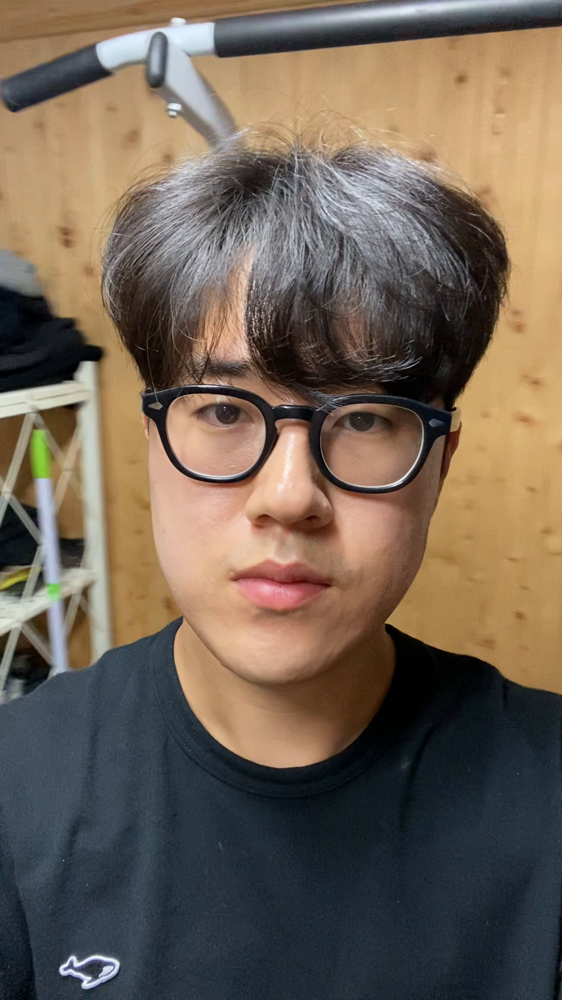

In [5]:
from pathlib import Path
import imageio
from PIL import Image

image_paths = list((rgb_dir / '1x').iterdir())
Image.open(image_paths[0])

### Camera registration with COLMAP.

In [6]:
# Extract features.
# Computes SIFT features and saves them to the COLMAP DB.
share_intrinsics = True  # @param {type: 'boolean'}
assume_upright_cameras = True  # @param {type: 'boolean'}

# This sets the scale at which we will run COLMAP. 
# A scale of 1 will be more accurate but will be slow.
colmap_image_scale = 4  # @param {type: 'number'}
colmap_rgb_dir = rgb_dir / f'{colmap_image_scale}x'

# Check this if you want to re-process SfM.
overwrite = False  # @param {type: 'boolean'}

if overwrite and colmap_db_path.exists():
    colmap_db_path.unlink()

!colmap feature_extractor \
--SiftExtraction.use_gpu 0 \
--SiftExtraction.upright {int(assume_upright_cameras)} \
--ImageReader.camera_model OPENCV \
--ImageReader.single_camera {int(share_intrinsics)} \
--database_path "{str(colmap_db_path)}" \
--image_path "{str(colmap_rgb_dir)}"


Feature extraction

Processed file [1/98]
  Name:            000001.png
  SKIP: Features for image already extracted.
Processed file [2/98]
  Name:            000002.png
  SKIP: Features for image already extracted.
Processed file [3/98]
  Name:            000003.png
  SKIP: Features for image already extracted.
Processed file [4/98]
  Name:            000004.png
  SKIP: Features for image already extracted.
Processed file [5/98]
  Name:            000005.png
  SKIP: Features for image already extracted.
Processed file [6/98]
  Name:            000006.png
  SKIP: Features for image already extracted.
Processed file [7/98]
  Name:            000007.png
  SKIP: Features for image already extracted.
Processed file [8/98]
  Name:            000008.png
  SKIP: Features for image already extracted.
Processed file [9/98]
  Name:            000009.png
  SKIP: Features for image already extracted.
Processed file [10/98]
  Name:            000010.png
  SKIP: Features for image already extracted

In [7]:
# @title Match features.
# @markdown Match the SIFT features between images. Use `exhaustive` if you only have a few images and use `vocab_tree` if you have a lot of images.

match_method = 'exhaustive'  # @param ["exhaustive", "vocab_tree"]

if match_method == 'exhaustive':
    !colmap exhaustive_matcher \
        --SiftMatching.use_gpu 0 \
        --database_path "{str(colmap_db_path)}"
else:
    # Use this if you have lots of frames.
    !wget https://demuc.de/colmap/vocab_tree_flickr100K_words32K.bin
    !colmap vocab_tree_matcher \
        --VocabTreeMatching.vocab_tree_path vocab_tree_flickr100K_words32K.bin \
        --SiftMatching.use_gpu 0 \
        --database_path "{str(colmap_db_path)}"


Exhaustive feature matching

Matching block [1/2, 1/2] in 0.002s
Matching block [1/2, 2/2] in 0.001s
Matching block [2/2, 1/2] in 0.001s
Matching block [2/2, 2/2] in 0.002s
Elapsed time: 0.000 [minutes]


In [8]:
# Reconstruction.
# Run structure-from-motion to compute camera parameters.

refine_principal_point = True  #@param {type:"boolean"}
min_num_matches = 32  # @param {type: 'number'}
filter_max_reproj_error = 2  # @param {type: 'number'}
tri_complete_max_reproj_error = 2  # @param {type: 'number'}

!colmap mapper \
    --Mapper.ba_refine_principal_point {int(refine_principal_point)} \
    --Mapper.filter_max_reproj_error $filter_max_reproj_error \
    --Mapper.tri_complete_max_reproj_error $tri_complete_max_reproj_error \
    --Mapper.min_num_matches $min_num_matches \
    --database_path "{str(colmap_db_path)}" \
    --output_path "{str(colmap_out_path)}" \
    --image_path "{str(colmap_rgb_dir)}" 
    


Loading database

Loading cameras... 1 in 0.000s
Loading matches... 4540 in 0.006s
Loading images... 98 in 0.002s (connected 98)
Building correspondence graph... in 0.024s (ignored 1212)

Elapsed time: 0.001 [minutes]


Initializing with image pair #26 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.113760e+02    0.00e+00    3.14e+03   0.00e+00   0.00e+00  1.00e+04        0    1.31e-03    1.67e-03
   1  1.629132e+03   -1.52e+03    0.00e+00   1.38e+02  -4.05e+01  5.00e+03        1    4.99e-03    6.68e-03
   2  3.455636e+02   -2.34e+02    0.00e+00   8.66e+01  -7.45e+00  1.25e+03        1    2.80e-03    9.49e-03
   3  9.305041e+01    1.83e+01    9.28e+02   2.89e+01   8.11e-01  1.65e+03        1    2.50e-04    9.77e-03
   4  8.802171e+01    5.03e+00    1.09e+03   2.93e+01   6.26e-01  1.67e+03        1    2.47e-04    1.00e-02
   5  8.389665e+01    4.13e+00    8.51e+02   2.46e+01   6.16e-

  79  1.706725e+01    6.68e-03    1.75e+02   1.63e+00   6.16e-01  1.19e+05        1    1.14e-02    1.78e-01
  80  1.706156e+01    5.69e-03    1.62e+02   1.55e+00   6.22e-01  1.20e+05        1    2.85e-04    1.78e-01
  81  1.705667e+01    4.89e-03    1.50e+02   1.48e+00   6.27e-01  1.22e+05        1    2.50e-04    1.79e-01
  82  1.705243e+01    4.23e-03    1.39e+02   1.42e+00   6.31e-01  1.24e+05        1    1.59e-03    1.80e-01
  83  1.704874e+01    3.69e-03    1.30e+02   1.37e+00   6.35e-01  1.27e+05        1    2.65e-04    1.80e-01
  84  1.704551e+01    3.24e-03    1.22e+02   1.32e+00   6.39e-01  1.30e+05        1    2.43e-04    1.81e-01
  85  1.704265e+01    2.86e-03    1.15e+02   1.28e+00   6.41e-01  1.33e+05        1    2.41e-04    1.81e-01
  86  1.704011e+01    2.53e-03    1.08e+02   1.25e+00   6.44e-01  1.36e+05        1    2.42e-04    1.81e-01
  87  1.703785e+01    2.26e-03    1.02e+02   1.21e+00   6.46e-01  1.39e+05        1    2.46e-04    1.81e-01
  88  1.703583e+01    2.02e-

   5  1.702109e+01    3.37e-04    3.98e+00   6.95e-01   8.51e-01  2.06e+05        1    3.00e-02    4.66e-02
   6  1.702076e+01    3.28e-04    8.30e+00   1.01e+00   5.57e-01  2.07e+05        1    5.41e-03    5.21e-02
   7  1.702024e+01    5.26e-04    7.49e+00   1.00e+00   7.10e-01  2.23e+05        1    7.00e-04    5.29e-02
   8  1.701979e+01    4.46e-04    7.84e+00   1.03e+00   6.53e-01  2.29e+05        1    2.68e-04    5.32e-02
   9  1.701934e+01    4.55e-04    7.47e+00   1.03e+00   6.77e-01  2.40e+05        1    2.59e-04    5.34e-02
  10  1.701892e+01    4.17e-04    7.34e+00   1.04e+00   6.63e-01  2.49e+05        1    2.58e-04    5.37e-02
  11  1.701852e+01    3.98e-04    7.08e+00   1.04e+00   6.67e-01  2.58e+05        1    2.56e-04    5.40e-02
  12  1.701815e+01    3.72e-04    6.87e+00   1.05e+00   6.64e-01  2.68e+05        1    3.73e-04    5.44e-02
  13  1.701780e+01    3.51e-04    6.64e+00   1.05e+00   6.64e-01  2.77e+05        1    2.81e-04    5.47e-02
  14  1.701747e+01    3.29e-


Initializing with image pair #20 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.983016e+02    0.00e+00    5.29e+02   0.00e+00   0.00e+00  1.00e+04        0    1.35e-04    3.18e-04
   1  1.798197e+04   -1.78e+04    0.00e+00   6.30e+01  -1.74e+02  5.00e+03        1    1.07e-02    1.10e-02
   2  8.293659e+03   -8.10e+03    0.00e+00   5.71e+01  -8.77e+01  1.25e+03        1    2.20e-04    1.12e-02
   3  1.512141e+03   -1.31e+03    0.00e+00   3.74e+01  -1.78e+01  1.56e+02        1    1.38e-03    1.26e-02
   4  1.610110e+02    3.73e+01    1.90e+03   8.84e+00   7.21e-01  1.71e+02        1    2.07e-04    1.28e-02
   5  1.431975e+02    1.78e+01    5.44e+02   9.26e+00   9.46e-01  5.13e+02        1    1.99e-04    1.30e-02
   6  1.487934e+02   -5.60e+00    0.00e+00   2.14e+01  -5.43e-01  2.57e+02        1    1.52e-04    1.32e-02
   7  1.385588e+02    4.64e+00    5.39e+02   1.17e+01   7.44e-01  


Registering image #10 (3)

  => Image sees 72 / 566 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 71 / 488 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 69 / 516 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 70 / 506 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 71 / 447 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 67 / 520 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 69 / 515 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 69 / 487 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 66 / 488 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Imag

  25  2.154954e+01    1.01e-02    1.95e+02   3.99e+01   5.21e-01  1.41e+05        1    3.30e-02    5.00e-02
  26  2.153960e+01    9.94e-03    1.95e+02   3.95e+01   5.22e-01  1.41e+05        1    5.26e-03    5.53e-02
  27  2.152977e+01    9.83e-03    1.94e+02   3.90e+01   5.22e-01  1.41e+05        1    1.04e-02    6.56e-02
  28  2.152005e+01    9.72e-03    1.94e+02   3.86e+01   5.23e-01  1.41e+05        1    3.26e-04    6.60e-02
  29  2.151042e+01    9.63e-03    1.93e+02   3.81e+01   5.23e-01  1.41e+05        1    1.91e-04    6.62e-02
  30  2.150088e+01    9.54e-03    1.93e+02   3.77e+01   5.24e-01  1.41e+05        1    1.99e-04    6.64e-02
  31  2.149142e+01    9.46e-03    1.93e+02   3.73e+01   5.24e-01  1.41e+05        1    2.00e-04    6.66e-02
  32  2.148204e+01    9.39e-03    1.93e+02   3.69e+01   5.24e-01  1.41e+05        1    1.96e-04    6.68e-02
  33  2.147272e+01    9.32e-03    1.92e+02   3.65e+01   5.24e-01  1.41e+05        1    1.87e-04    6.70e-02
  34  2.146346e+01    9.26e-


Initializing with image pair #28 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.168647e+03    0.00e+00    6.64e+04   0.00e+00   0.00e+00  1.00e+04        0    1.92e-04    4.95e-04
   1  1.235487e+05   -1.22e+05    0.00e+00   1.13e+02  -1.15e+02  5.00e+03        1    1.88e-02    1.93e-02
   2  1.066973e+05   -1.06e+05    0.00e+00   6.28e+01  -1.01e+02  1.25e+03        1    3.23e-04    1.96e-02
   3  3.222424e+04   -3.11e+04    0.00e+00   2.48e+01  -3.41e+01  1.56e+02        1    2.99e-04    1.99e-02
   4  9.765311e+02    1.92e+02    2.78e+04   1.13e+01   3.70e-01  1.54e+02        1    3.72e-04    2.03e-02
   5  5.673520e+02    4.09e+02    8.37e+03   6.76e+00   6.28e-01  1.56e+02        1    3.93e-04    2.07e-02
   6  2.972510e+02    2.70e+02    4.92e+03   5.69e+00   9.24e-01  4.02e+02        1    3.55e-04    2.10e-02
   7  2.025832e+02    9.47e+01    2.25e+03   1.48e+01   8.46e-01  

  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 120 / 484 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 119 / 515 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 120 / 488 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 119 / 516 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 118 / 506 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 113 / 509 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 114 / 512 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 113 / 516 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 116 / 520 points
  => Could not register, tryin

  60  2.317056e+01    2.70e-04    5.58e+00   4.02e+00   4.48e-01  1.22e+06        1    7.77e-04    4.88e-02
  61  2.317029e+01    2.73e-04    5.67e+00   4.03e+00   4.45e-01  1.22e+06        1    1.29e-02    6.17e-02
  62  2.317001e+01    2.76e-04    5.77e+00   4.05e+00   4.42e-01  1.22e+06        1    3.66e-04    6.20e-02
  63  2.316973e+01    2.79e-04    5.87e+00   4.06e+00   4.40e-01  1.22e+06        1    3.20e-04    6.24e-02
  64  2.316945e+01    2.81e-04    5.97e+00   4.08e+00   4.37e-01  1.22e+06        1    4.08e-04    6.28e-02
  65  2.316917e+01    2.84e-04    6.07e+00   4.09e+00   4.35e-01  1.21e+06        1    3.12e-04    6.31e-02
  66  2.316888e+01    2.87e-04    6.16e+00   4.10e+00   4.33e-01  1.21e+06        1    3.17e-04    6.35e-02
  67  2.316859e+01    2.90e-04    6.26e+00   4.11e+00   4.31e-01  1.21e+06        1    3.11e-04    6.38e-02
  68  2.316830e+01    2.92e-04    6.35e+00   4.12e+00   4.30e-01  1.20e+06        1    3.14e-04    6.41e-02
  69  2.316800e+01    2.95e-


Initializing with image pair #28 and #8


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.496644e+03    0.00e+00    1.23e+04   0.00e+00   0.00e+00  1.00e+04        0    1.66e-04    4.31e-04
   1  1.927285e+07   -1.93e+07    0.00e+00   3.30e+02  -1.88e+04  5.00e+03        1    7.71e-03    8.16e-03
   2  4.179478e+06   -4.18e+06    0.00e+00   2.06e+02  -4.63e+03  1.25e+03        1    5.37e-03    1.35e-02
   3  1.683525e+05   -1.67e+05    0.00e+00   8.92e+01  -2.30e+02  1.56e+02        1    2.45e-04    1.38e-02
   4  2.940543e+03   -1.44e+03    0.00e+00   3.65e+01  -2.68e+00  9.77e+00        1    2.31e-04    1.41e-02
   5  1.291992e+03    2.05e+02    1.87e+03   6.25e+00   9.72e-01  2.93e+01        1    2.97e-04    1.44e-02
   6  1.133317e+03    1.59e+02    8.02e+03   1.05e+01   8.99e-01  5.96e+01        1    3.02e-04    1.47e-02
   7  1.053992e+03    7.93e+01    1.49e+04   9.16e+00   3.99e-01  5

  84  3.993276e+01    2.72e-02    1.90e+03   1.04e+01   5.26e-01  7.78e+04        1    5.43e-03    2.30e-01
  85  3.990542e+01    2.73e-02    1.88e+03   9.53e+00   5.19e-01  7.78e+04        1    1.31e-02    2.43e-01
  86  3.987784e+01    2.76e-02    1.87e+03   8.75e+00   5.12e-01  7.78e+04        1    3.21e-04    2.44e-01
  87  3.984990e+01    2.79e-02    1.89e+03   8.02e+00   5.05e-01  7.78e+04        1    2.89e-04    2.44e-01
  88  3.982151e+01    2.84e-02    1.92e+03   7.33e+00   4.99e-01  7.78e+04        1    2.90e-04    2.44e-01
  89  3.979255e+01    2.90e-02    1.97e+03   6.69e+00   4.91e-01  7.78e+04        1    2.91e-04    2.44e-01
  90  3.976295e+01    2.96e-02    2.04e+03   6.11e+00   4.84e-01  7.78e+04        1    2.86e-04    2.45e-01
  91  3.973260e+01    3.03e-02    2.13e+03   5.59e+00   4.76e-01  7.78e+04        1    6.54e-03    2.51e-01
  92  3.970142e+01    3.12e-02    2.23e+03   5.13e+00   4.68e-01  7.78e+04        1    3.15e-04    2.52e-01
  93  3.966933e+01    3.21e-

   5  3.377365e+01    5.08e-02    1.39e+02   2.22e+01   7.19e-01  3.97e+04        1    1.61e-02    2.71e-02
   6  3.372807e+01    4.56e-02    1.95e+02   2.24e+01   6.69e-01  4.13e+04        1    3.12e-04    2.75e-02
   7  3.368010e+01    4.80e-02    2.36e+02   2.23e+01   6.77e-01  4.32e+04        1    2.89e-04    2.78e-02
   8  3.363299e+01    4.71e-02    2.80e+02   2.29e+01   6.52e-01  4.44e+04        1    2.81e-04    2.80e-02
   9  3.358459e+01    4.84e-02    3.16e+02   2.37e+01   6.43e-01  4.55e+04        1    5.34e-03    3.34e-02
  10  3.353571e+01    4.89e-02    3.48e+02   2.49e+01   6.29e-01  4.63e+04        1    2.99e-04    3.37e-02
  11  3.348602e+01    4.97e-02    3.76e+02   2.64e+01   6.19e-01  4.69e+04        1    2.87e-04    3.40e-02
  12  3.343569e+01    5.03e-02    4.01e+02   2.82e+01   6.09e-01  4.74e+04        1    6.46e-04    3.46e-02
  13  3.338476e+01    5.09e-02    4.23e+02   3.03e+01   6.01e-01  4.78e+04        1    1.13e-02    4.59e-02
  14  3.333330e+01    5.15e-

  94  3.035224e+01    7.61e-03    8.14e+01   4.14e+01   7.40e-01  1.66e+05        1    3.09e-02    2.45e-01
  95  3.034519e+01    7.05e-03    1.02e+02   3.82e+01   6.49e-01  1.71e+05        1    3.05e-04    2.45e-01
  96  3.033678e+01    8.41e-03    1.07e+02   3.23e+01   6.89e-01  1.80e+05        1    3.12e-04    2.45e-01
  97  3.032861e+01    8.17e-03    1.19e+02   2.92e+01   6.45e-01  1.85e+05        1    2.90e-04    2.46e-01
  98  3.031975e+01    8.86e-03    1.26e+02   2.59e+01   6.51e-01  1.90e+05        1    3.02e-04    2.46e-01
  99  3.031079e+01    8.96e-03    1.34e+02   2.34e+01   6.33e-01  1.94e+05        1    1.56e-02    2.62e-01
 100  3.030150e+01    9.29e-03    1.42e+02   2.13e+01   6.27e-01  1.97e+05        1    2.98e-04    2.62e-01


Bundle adjustment report
------------------------
    Residuals : 572
   Parameters : 442
   Iterations : 101
         Time : 0.262109 [s]
 Initial cost : 0.245818 [px]
   Final cost : 0.230162 [px]
  Termination : No convergence

  => Merged

  92  2.926669e+01    2.51e-03    1.05e+02   5.17e+00   5.89e-01  6.69e+05        1    3.06e-04    1.58e-01
  93  2.926415e+01    2.54e-03    1.06e+02   5.29e+00   5.82e-01  6.72e+05        1    3.20e-03    1.62e-01
  94  2.926159e+01    2.56e-03    1.07e+02   5.42e+00   5.76e-01  6.75e+05        1    3.81e-04    1.62e-01
  95  2.925900e+01    2.58e-03    1.08e+02   5.56e+00   5.69e-01  6.76e+05        1    3.05e-04    1.62e-01
  96  2.925640e+01    2.60e-03    1.08e+02   5.71e+00   5.63e-01  6.78e+05        1    3.04e-04    1.63e-01
  97  2.925378e+01    2.62e-03    1.09e+02   5.88e+00   5.57e-01  6.79e+05        1    3.10e-04    1.63e-01
  98  2.925114e+01    2.64e-03    1.10e+02   6.06e+00   5.51e-01  6.79e+05        1    2.98e-04    1.63e-01
  99  2.924849e+01    2.65e-03    1.11e+02   6.25e+00   5.45e-01  6.80e+05        1    5.39e-03    1.69e-01
 100  2.924583e+01    2.66e-03    1.12e+02   6.47e+00   5.38e-01  6.80e+05        1    3.17e-04    1.69e-01


Bundle adjustment report
-


Initializing with image pair #15 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.013817e+02    0.00e+00    1.38e+03   0.00e+00   0.00e+00  1.00e+04        0    5.99e-04    8.25e-04
   1  3.415053e+03   -3.31e+03    0.00e+00   5.80e+01  -6.88e+01  5.00e+03        1    1.41e-02    1.50e-02
   2  8.636435e+02   -7.62e+02    0.00e+00   5.30e+01  -1.88e+01  1.25e+03        1    6.35e-03    2.13e-02
   3  1.039023e+02   -2.52e+00    0.00e+00   3.20e+01  -1.05e-01  1.56e+02        1    1.09e-02    3.22e-02
   4  9.447685e+01    6.90e+00    4.11e+02   7.17e+00   9.83e-01  4.69e+02        1    5.38e-03    3.77e-02
   5  8.524936e+01    9.23e+00    6.78e+02   1.49e+01   9.18e-01  1.13e+03        1    2.69e-04    3.80e-02
   6  8.143736e+01    3.81e+00    3.15e+03   2.04e+01   2.96e-01  1.06e+03        1    2.68e-04    3.82e-02
   7  7.076693e+01    1.07e+01    3.82e+03   1.16e+01   6.61e-01  

  96  3.431205e+01    7.01e-02    3.32e+02   1.44e+01   5.86e-01  1.67e+05        1    8.97e-03    1.46e-01
  97  3.424018e+01    7.19e-02    3.85e+02   1.44e+01   5.50e-01  1.67e+05        1    2.74e-04    1.47e-01
  98  3.416609e+01    7.41e-02    4.27e+02   1.41e+01   5.27e-01  1.67e+05        1    1.19e-02    1.58e-01
  99  3.408886e+01    7.72e-02    4.48e+02   1.32e+01   5.24e-01  1.67e+05        1    2.12e-02    1.80e-01
 100  3.400804e+01    8.08e-02    4.39e+02   1.19e+01   5.45e-01  1.67e+05        1    2.64e-04    1.80e-01


Bundle adjustment report
------------------------
    Residuals : 500
   Parameters : 388
   Iterations : 101
         Time : 0.179942 [s]
 Initial cost : 0.450293 [px]
   Final cost : 0.260799 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #23 (3)

  => Image sees 110 / 485 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 105 / 488 points
  =>

   2  2.958967e+01   -9.63e-02    0.00e+00   9.00e+00  -4.04e-01  1.50e+04        1    1.12e-02    1.18e-02
   3  2.937182e+01    1.22e-01    2.02e+02   5.34e+00   7.59e-01  1.74e+04        1    1.09e-02    2.28e-02
   4  2.926029e+01    1.12e-01    1.85e+02   4.51e+00   8.15e-01  2.32e+04        1    2.72e-04    2.30e-02
   5  2.917503e+01    8.53e-02    1.84e+02   4.60e+00   8.01e-01  2.97e+04        1    2.72e-04    2.33e-02
   6  2.910049e+01    7.45e-02    1.38e+02   4.35e+00   8.71e-01  5.02e+04        1    2.48e-04    2.36e-02
   7  2.903276e+01    6.77e-02    1.15e+02   4.59e+00   8.78e-01  8.85e+04        1    4.57e-04    2.40e-02
   8  2.896196e+01    7.08e-02    6.92e+01   4.18e+00   9.15e-01  2.08e+05        1    2.54e-04    2.43e-02
   9  2.919447e+01   -2.33e-01    0.00e+00   1.23e+01  -2.56e+00  1.04e+05        1    2.23e-04    2.45e-02
  10  2.892638e+01    3.56e-02    2.04e+02   5.26e+00   6.05e-01  1.05e+05        1    2.48e-04    2.48e-02
  11  2.888856e+01    3.78e-

   1  4.388260e+04   -4.10e+04    0.00e+00   3.50e+02  -1.48e+01  5.00e+03        1    1.04e-02    1.10e-02
   2  4.240561e+04   -3.95e+04    0.00e+00   2.78e+02  -1.43e+01  1.25e+03        1    1.11e-03    1.22e-02
   3  7.781172e+04   -7.50e+04    0.00e+00   1.40e+02  -2.77e+01  1.56e+02        1    2.21e-02    3.43e-02
   4  6.062758e+04   -5.78e+04    0.00e+00   5.14e+01  -2.21e+01  9.77e+00        1    5.36e-03    3.97e-02
   5  1.283233e+03    1.58e+03    2.51e+04   1.25e+01   8.56e-01  1.53e+01        1    2.57e-04    3.99e-02
   6  8.776359e+02    4.06e+02    3.42e+04   8.62e+00   4.34e-01  1.53e+01        1    1.12e-02    5.11e-02
   7  2.336156e+02    6.44e+02    2.62e+03   2.94e+00   9.64e-01  4.58e+01        1    2.33e-02    7.45e-02
   8  2.036682e+02    2.99e+01    7.41e+02   4.53e+00   9.87e-01  1.37e+02        1    2.67e-04    7.48e-02
   9  1.874329e+02    1.62e+01    5.75e+02   1.13e+01   1.00e+00  4.12e+02        1    2.23e-04    7.50e-02
  10  1.684603e+02    1.90e+

  => Could not register, trying another image.

Registering image #98 (3)

  => Image sees 74 / 493 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 74 / 486 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 73 / 454 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 73 / 499 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 72 / 420 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 70 / 484 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 71 / 515 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 71 / 474 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 71 / 447 points
  => Could not register, trying anoth

  48  2.526613e+01    1.57e-02    1.84e+02   4.39e+00   7.50e-01  2.95e+05        1    3.46e-03    5.27e-02
  49  2.525215e+01    1.40e-02    1.65e+02   3.81e+00   7.43e-01  3.33e+05        1    2.59e-04    5.30e-02
  50  2.523962e+01    1.25e-02    1.42e+02   3.13e+00   7.33e-01  3.71e+05        1    2.26e-04    5.32e-02
  51  2.522822e+01    1.14e-02    1.21e+02   2.45e+00   7.24e-01  4.07e+05        1    2.30e-04    5.35e-02
  52  2.521762e+01    1.06e-02    1.04e+02   1.91e+00   7.17e-01  4.44e+05        1    2.49e-04    5.37e-02
  53  2.520752e+01    1.01e-02    9.39e+01   1.70e+00   7.11e-01  4.80e+05        1    2.23e-04    5.40e-02
  54  2.519771e+01    9.81e-03    8.87e+01   1.86e+00   7.02e-01  5.14e+05        1    2.28e-04    5.42e-02
  55  2.518804e+01    9.67e-03    8.72e+01   2.21e+00   6.91e-01  5.44e+05        1    1.12e-02    6.54e-02
  56  2.517841e+01    9.63e-03    8.76e+01   2.59e+00   6.77e-01  5.69e+05        1    5.37e-03    7.08e-02
  57  2.516877e+01    9.64e-


Initializing with image pair #24 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.088825e+01    0.00e+00    1.77e+03   0.00e+00   0.00e+00  1.00e+04        0    1.76e-03    1.98e-03
   1  1.068281e+03   -1.01e+03    0.00e+00   4.20e+01  -3.20e+01  5.00e+03        1    3.61e-03    5.60e-03
   2  4.241143e+02   -3.63e+02    0.00e+00   3.62e+01  -1.38e+01  1.25e+03        1    8.48e-03    1.41e-02
   3  7.863431e+01   -1.77e+01    0.00e+00   2.02e+01  -1.10e+00  1.56e+02        1    2.01e-04    1.43e-02
   4  5.341227e+01    7.48e+00    3.71e+02   4.50e+00   9.86e-01  4.69e+02        1    2.51e-04    1.46e-02
   5  4.993192e+01    3.48e+00    2.15e+03   9.23e+00   6.91e-01  4.96e+02        1    2.60e-04    1.48e-02
   6  4.551659e+01    4.42e+00    1.59e+03   7.61e+00   8.44e-01  7.37e+02        1    2.48e-04    1.51e-02
   7  4.203614e+01    3.48e+00    1.70e+03   7.85e+00   7.83e-01  


Pose refinement report
----------------------
    Residuals : 188
   Parameters : 12
   Iterations : 14
         Time : 0.00161369 [s]
 Initial cost : 0.450337 [px]
   Final cost : 0.326984 [px]
  Termination : Convergence

  => Continued observations: 94
  => Added observations: 84

Bundle adjustment report
------------------------
    Residuals : 804
   Parameters : 460
   Iterations : 26
         Time : 0.0268515 [s]
 Initial cost : 1.4698 [px]
   Final cost : 0.320987 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 20
  => Changed observations: 0.049751

Bundle adjustment report
------------------------
    Residuals : 764
   Parameters : 442
   Iterations : 26
         Time : 0.0176313 [s]
 Initial cost : 0.287041 [px]
   Final cost : 0.259323 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000

R

  93  4.250097e+01    5.17e-02    2.81e+02   1.32e+01   6.98e-01  4.21e+04        1    3.48e-04    1.04e-01
  94  4.245303e+01    4.79e-02    2.63e+02   1.41e+01   7.01e-01  4.50e+04        1    9.18e-03    1.13e-01
  95  4.240894e+01    4.41e-02    2.45e+02   1.49e+01   7.01e-01  4.81e+04        1    3.67e-04    1.13e-01
  96  4.236880e+01    4.01e-02    2.27e+02   1.57e+01   6.99e-01  5.14e+04        1    4.58e-04    1.14e-01
  97  4.233267e+01    3.61e-02    2.17e+02   1.64e+01   6.95e-01  5.46e+04        1    3.35e-04    1.14e-01
  98  4.230054e+01    3.21e-02    2.18e+02   1.70e+01   6.89e-01  5.77e+04        1    3.36e-04    1.14e-01
  99  4.227230e+01    2.82e-02    2.17e+02   1.74e+01   6.81e-01  6.06e+04        1    3.22e-04    1.15e-01
 100  4.224769e+01    2.46e-02    2.15e+02   1.76e+01   6.73e-01  6.33e+04        1    3.25e-04    1.15e-01


Bundle adjustment report
------------------------
    Residuals : 764
   Parameters : 442
   Iterations : 101
         Time : 0.114978

  75  4.176102e+01    5.40e-03    1.42e+02   1.73e+01   5.85e-01  1.15e+05        1    9.42e-03    9.65e-02
  76  4.175561e+01    5.41e-03    1.42e+02   1.73e+01   5.85e-01  1.15e+05        1    4.81e-04    9.70e-02
  77  4.175018e+01    5.43e-03    1.42e+02   1.74e+01   5.85e-01  1.16e+05        1    3.73e-04    9.74e-02
  78  4.174474e+01    5.44e-03    1.42e+02   1.74e+01   5.85e-01  1.16e+05        1    3.65e-04    9.78e-02
  79  4.173929e+01    5.45e-03    1.42e+02   1.75e+01   5.85e-01  1.17e+05        1    3.95e-04    9.83e-02
  80  4.173382e+01    5.47e-03    1.42e+02   1.75e+01   5.86e-01  1.18e+05        1    3.67e-04    9.87e-02
  81  4.172834e+01    5.48e-03    1.41e+02   1.76e+01   5.86e-01  1.18e+05        1    3.80e-04    9.91e-02
  82  4.172284e+01    5.50e-03    1.41e+02   1.76e+01   5.86e-01  1.19e+05        1    3.90e-04    9.95e-02
  83  4.171732e+01    5.52e-03    1.41e+02   1.77e+01   5.86e-01  1.19e+05        1    3.98e-04    9.99e-02
  84  4.171179e+01    5.54e-

  22  4.149482e+01    7.09e-03    1.47e+02   1.99e+01   6.00e-01  1.47e+05        1    9.75e-03    2.35e-02
  23  4.148763e+01    7.19e-03    1.48e+02   2.00e+01   6.00e-01  1.48e+05        1    2.36e-03    2.58e-02
  24  4.148035e+01    7.28e-03    1.49e+02   2.00e+01   6.00e-01  1.49e+05        1    3.32e-04    2.62e-02
  25  4.147296e+01    7.39e-03    1.49e+02   2.01e+01   6.00e-01  1.50e+05        1    3.28e-04    2.65e-02
  26  4.146547e+01    7.49e-03    1.50e+02   2.02e+01   6.00e-01  1.52e+05        1    5.22e-04    2.71e-02
  27  4.145788e+01    7.60e-03    1.51e+02   2.03e+01   6.00e-01  1.53e+05        1    3.31e-04    2.74e-02
  28  4.145017e+01    7.71e-03    1.51e+02   2.04e+01   6.00e-01  1.54e+05        1    3.28e-04    2.77e-02
  29  4.144235e+01    7.82e-03    1.52e+02   2.05e+01   6.00e-01  1.55e+05        1    3.37e-04    2.81e-02
  30  4.143441e+01    7.94e-03    1.53e+02   2.06e+01   6.01e-01  1.57e+05        1    3.34e-04    2.84e-02
  31  4.142635e+01    8.06e-


Initializing with image pair #16 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.325275e+02    0.00e+00    6.66e+02   0.00e+00   0.00e+00  1.00e+04        0    1.17e-03    1.41e-03
   1  1.605846e+04   -1.59e+04    0.00e+00   3.30e+01  -2.46e+02  5.00e+03        1    4.94e-02    5.08e-02
   2  4.095757e+03   -3.96e+03    0.00e+00   1.87e+01  -8.15e+01  1.25e+03        1    5.65e-02    1.07e-01
   3  2.846385e+02   -1.52e+02    0.00e+00   1.07e+01  -6.49e+00  1.56e+02        1    1.63e-02    1.24e-01
   4  1.265506e+02    5.98e+00    9.65e+02   3.78e+00   8.30e-01  2.19e+02        1    1.55e-02    1.39e-01
   5  1.214903e+02    5.06e+00    9.24e+02   3.36e+00   8.78e-01  3.87e+02        1    2.64e-04    1.39e-01
   6  1.168730e+02    4.62e+00    1.22e+03   3.85e+00   8.25e-01  5.34e+02        1    2.62e-04    1.40e-01
   7  1.119037e+02    4.97e+00    9.17e+02   3.93e+00   8.69e-01  

  73  3.197212e+01    5.01e-02    1.18e+02   8.16e+00   6.61e-01  9.06e+04        1    6.22e-03    2.20e-01
  74  3.192385e+01    4.83e-02    1.15e+02   8.23e+00   6.61e-01  9.38e+04        1    5.38e-03    2.26e-01
  75  3.187757e+01    4.63e-02    1.11e+02   8.28e+00   6.62e-01  9.71e+04        1    2.53e-04    2.26e-01
  76  3.183336e+01    4.42e-02    1.07e+02   8.32e+00   6.65e-01  1.01e+05        1    2.38e-04    2.26e-01
  77  3.179126e+01    4.21e-02    1.02e+02   8.35e+00   6.67e-01  1.05e+05        1    2.38e-04    2.27e-01
  78  3.175127e+01    4.00e-02    9.75e+01   8.37e+00   6.71e-01  1.09e+05        1    2.40e-04    2.27e-01
  79  3.171334e+01    3.79e-02    9.26e+01   8.38e+00   6.75e-01  1.14e+05        1    6.73e-03    2.34e-01
  80  3.167740e+01    3.59e-02    8.76e+01   8.40e+00   6.79e-01  1.19e+05        1    2.75e-04    2.34e-01
  81  3.164336e+01    3.40e-02    8.25e+01   8.43e+00   6.83e-01  1.25e+05        1    2.39e-04    2.34e-01
  82  3.161111e+01    3.23e-

   9  2.530453e+01    2.46e-02    9.20e+01   1.30e+01   6.47e-01  2.52e+05        1    1.13e-02    2.99e-02
  10  2.528007e+01    2.45e-02    1.03e+02   1.36e+01   6.03e-01  2.55e+05        1    2.05e-02    5.04e-02
  11  2.525422e+01    2.59e-02    1.11e+02   1.42e+01   5.79e-01  2.56e+05        1    2.60e-04    5.07e-02
  12  2.522745e+01    2.68e-02    1.21e+02   1.49e+01   5.49e-01  2.56e+05        1    2.47e-04    5.10e-02
  13  2.519981e+01    2.76e-02    1.30e+02   1.56e+01   5.14e-01  2.56e+05        1    3.64e-04    5.14e-02
  14  2.517114e+01    2.87e-02    1.43e+02   1.65e+01   4.78e-01  2.56e+05        1    2.44e-04    5.16e-02
  15  2.514191e+01    2.92e-02    1.55e+02   1.75e+01   4.30e-01  2.55e+05        1    2.40e-04    5.19e-02
  16  2.511102e+01    3.09e-02    1.70e+02   1.86e+01   3.93e-01  2.53e+05        1    2.44e-04    5.21e-02
  17  2.507905e+01    3.20e-02    1.83e+02   1.98e+01   3.49e-01  2.46e+05        1    2.52e-04    5.24e-02
  18  2.504067e+01    3.84e-

  91  2.215587e+01    3.09e-03    8.63e+01   1.15e+01   6.63e-01  7.28e+05        1    1.11e-02    1.90e-01
  92  2.215293e+01    2.95e-03    8.41e+01   1.13e+01   6.64e-01  7.55e+05        1    4.78e-04    1.91e-01
  93  2.215011e+01    2.82e-03    8.20e+01   1.11e+01   6.65e-01  7.83e+05        1    2.70e-04    1.91e-01
  94  2.214741e+01    2.70e-03    7.98e+01   1.10e+01   6.66e-01  8.13e+05        1    2.50e-04    1.91e-01
  95  2.214483e+01    2.58e-03    7.75e+01   1.08e+01   6.68e-01  8.45e+05        1    2.60e-04    1.92e-01
  96  2.214235e+01    2.48e-03    7.52e+01   1.06e+01   6.69e-01  8.79e+05        1    2.91e-04    1.92e-01
  97  2.213998e+01    2.38e-03    7.28e+01   1.04e+01   6.71e-01  9.16e+05        1    5.29e-03    1.97e-01
  98  2.213769e+01    2.28e-03    7.03e+01   1.03e+01   6.72e-01  9.54e+05        1    2.45e-04    1.98e-01
  99  2.213550e+01    2.20e-03    6.76e+01   1.01e+01   6.74e-01  9.96e+05        1    2.44e-04    1.98e-01
 100  2.213338e+01    2.12e-


Initializing with image pair #12 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.325312e+02    0.00e+00    1.54e+03   0.00e+00   0.00e+00  1.00e+04        0    5.24e-03    5.51e-03
   1  4.432579e+04   -4.41e+04    0.00e+00   3.59e+01  -3.06e+02  5.00e+03        1    1.04e-02    1.60e-02
   2  1.729876e+04   -1.71e+04    0.00e+00   4.06e+01  -1.39e+02  1.25e+03        1    1.16e-03    1.71e-02
   3  1.548537e+03   -1.32e+03    0.00e+00   3.46e+01  -1.75e+01  1.56e+02        1    2.12e-04    1.74e-02
   4  2.151269e+02    1.74e+01    2.07e+03   1.08e+01   7.03e-01  1.67e+02        1    2.77e-04    1.76e-02
   5  1.976021e+02    1.75e+01    1.25e+03   8.31e+00   8.88e-01  3.15e+02        1    2.69e-04    1.79e-02
   6  1.861164e+02    1.15e+01    2.31e+03   1.07e+01   6.78e-01  3.30e+02        1    2.58e-04    1.82e-02
   7  1.730041e+02    1.31e+01    1.42e+03   7.62e+00   8.97e-01  

   6  4.116990e+01    2.25e-02    2.80e+01   1.42e+00   9.02e-01  7.15e+04        1    5.32e-03    7.09e-03
   7  4.116466e+01    5.23e-03    3.85e+01   1.78e+00   4.72e-01  7.15e+04        1    3.04e-04    7.41e-03
   8  4.115645e+01    8.21e-03    1.10e+01   1.38e+00   8.73e-01  1.23e+05        1    2.60e-04    7.68e-03
   9  4.115487e+01    1.58e-03    1.85e+01   2.03e+00   3.45e-01  1.19e+05        1    2.49e-04    7.94e-03
  10  4.115070e+01    4.17e-03    1.32e+01   1.84e+00   7.43e-01  1.34e+05        1    2.57e-04    8.21e-03
  11  4.114817e+01    2.53e-03    1.31e+01   2.01e+00   5.95e-01  1.35e+05        1    2.49e-04    8.46e-03
  12  4.114523e+01    2.94e-03    1.16e+01   1.99e+00   6.58e-01  1.40e+05        1    2.50e-04    8.72e-03
  13  4.114251e+01    2.72e-03    1.14e+01   2.03e+00   6.29e-01  1.42e+05        1    2.51e-04    8.98e-03
  14  4.113973e+01    2.78e-03    1.14e+01   2.04e+00   6.29e-01  1.45e+05        1    2.51e-04    9.24e-03
  15  4.113695e+01    2.78e-

  98  4.094346e+01    1.82e-03    1.62e+01   2.30e+00   5.86e-01  2.34e+05        1    1.97e-03    1.57e-01
  99  4.094165e+01    1.81e-03    1.62e+01   2.30e+00   5.86e-01  2.35e+05        1    2.89e-04    1.57e-01
 100  4.093986e+01    1.80e-03    1.63e+01   2.31e+00   5.86e-01  2.37e+05        1    2.73e-04    1.58e-01


Bundle adjustment report
------------------------
    Residuals : 500
   Parameters : 388
   Iterations : 101
         Time : 0.157835 [s]
 Initial cost : 0.288956 [px]
   Final cost : 0.286146 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #92 (3)

  => Image sees 72 / 449 points
  => Could not register, trying another image.

Registering image #91 (3)

  => Image sees 71 / 464 points
  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 72 / 471 points
  => Could not regis

  31  4.374906e+01    2.55e-01    6.10e+02   1.33e+01   7.46e-01  8.71e+03        1    1.93e-02    4.03e-02
  32  4.353971e+01    2.09e-01    5.23e+02   1.29e+01   7.50e-01  9.96e+03        1    3.25e-04    4.06e-02
  33  4.336935e+01    1.70e-01    4.34e+02   1.27e+01   7.49e-01  1.14e+04        1    3.96e-04    4.10e-02
  34  4.323226e+01    1.37e-01    3.46e+02   1.27e+01   7.45e-01  1.29e+04        1    2.38e-04    4.13e-02
  35  4.312307e+01    1.09e-01    2.64e+02   1.27e+01   7.40e-01  1.45e+04        1    2.89e-04    4.16e-02
  36  4.303640e+01    8.67e-02    1.94e+02   1.28e+01   7.32e-01  1.61e+04        1    2.30e-04    4.18e-02
  37  4.296725e+01    6.92e-02    1.57e+02   1.29e+01   7.22e-01  1.77e+04        1    2.41e-04    4.21e-02
  38  4.291116e+01    5.61e-02    1.56e+02   1.32e+01   7.08e-01  1.90e+04        1    2.42e-04    4.23e-02
  39  4.286440e+01    4.68e-02    1.64e+02   1.34e+01   6.86e-01  2.01e+04        1    2.21e-04    4.25e-02
  40  4.282389e+01    4.05e-

  55  3.786957e+01    4.20e-04    3.93e+00   1.34e+00   5.82e-01  1.24e+06        1    2.20e-04    3.18e-02
  56  3.786915e+01    4.21e-04    3.96e+00   1.35e+00   5.81e-01  1.25e+06        1    1.38e-02    4.56e-02
  57  3.786873e+01    4.21e-04    3.98e+00   1.35e+00   5.81e-01  1.25e+06        1    2.39e-04    4.59e-02
  58  3.786831e+01    4.21e-04    4.00e+00   1.36e+00   5.81e-01  1.26e+06        1    2.21e-04    4.61e-02
  59  3.786789e+01    4.21e-04    4.03e+00   1.37e+00   5.81e-01  1.26e+06        1    2.34e-04    4.64e-02
  60  3.786747e+01    4.21e-04    4.05e+00   1.37e+00   5.81e-01  1.27e+06        1    3.94e-04    4.68e-02
  61  3.786705e+01    4.21e-04    4.07e+00   1.38e+00   5.81e-01  1.28e+06        1    2.47e-04    4.70e-02
  62  3.786663e+01    4.21e-04    4.09e+00   1.39e+00   5.81e-01  1.28e+06        1    2.23e-04    4.73e-02
  63  3.786621e+01    4.21e-04    4.12e+00   1.40e+00   5.80e-01  1.29e+06        1    2.49e-04    4.75e-02
  64  3.786579e+01    4.21e-


Initializing with image pair #14 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.757347e+01    0.00e+00    1.45e+03   0.00e+00   0.00e+00  1.00e+04        0    5.70e-04    7.82e-04
   1  3.105995e+03   -3.02e+03    0.00e+00   3.50e+01  -5.10e+01  5.00e+03        1    1.12e-02    1.20e-02
   2  1.667782e+03   -1.58e+03    0.00e+00   3.07e+01  -2.86e+01  1.25e+03        1    2.29e-04    1.22e-02
   3  2.291958e+02   -1.42e+02    0.00e+00   1.95e+01  -3.72e+00  1.56e+02        1    2.23e-04    1.25e-02
   4  7.366986e+01    1.39e+01    2.36e+02   5.26e+00   9.52e-01  4.69e+02        1    2.27e-04    1.27e-02
   5  9.824251e+01   -2.46e+01    0.00e+00   9.59e+00  -1.34e+00  2.34e+02        1    1.79e-04    1.29e-02
   6  6.695143e+01    6.72e+00    9.58e+02   5.99e+00   5.73e-01  2.35e+02        1    2.08e-04    1.31e-02
   7  9.102916e+01   -2.41e+01    0.00e+00   3.99e+00  -1.34e+00  

  72  2.318445e+01    3.07e-07    1.26e+00   2.89e-01   6.73e-01  7.27e+06        1    2.57e-02    9.01e-02
  73  2.318445e+01    3.30e-07    9.05e-01   3.01e-01   6.53e-01  7.48e+06        1    2.95e-04    9.04e-02
  74  2.318445e+01    3.46e-07    8.64e-01   3.09e-01   6.40e-01  7.65e+06        1    2.14e-04    9.06e-02
  75  2.318445e+01    3.55e-07    8.00e-01   3.15e-01   6.28e-01  7.78e+06        1    2.14e-04    9.09e-02
  76  2.318445e+01    3.64e-07    7.37e-01   3.19e-01   6.20e-01  7.89e+06        1    2.99e-04    9.12e-02
  77  2.318445e+01    3.69e-07    6.76e-01   3.22e-01   6.12e-01  7.98e+06        1    3.25e-04    9.15e-02
  78  2.318445e+01    3.73e-07    6.23e-01   3.25e-01   6.07e-01  8.06e+06        1    1.30e-03    9.28e-02
  79  2.318445e+01    3.76e-07    5.77e-01   3.27e-01   6.02e-01  8.13e+06        1    2.12e-04    9.30e-02
  80  2.318445e+01    3.78e-07    5.83e-01   3.29e-01   5.98e-01  8.19e+06        1    2.13e-04    9.33e-02
  81  2.318445e+01    3.80e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.425096e+01    0.00e+00    7.12e+02   0.00e+00   0.00e+00  1.00e+04        0    1.09e-02    1.12e-02
   1  7.449297e+01   -4.02e+01    0.00e+00   1.85e+01  -7.48e+00  5.00e+03        1    2.10e-02    3.23e-02
   2  3.606802e+01   -1.82e+00    0.00e+00   8.09e+00  -3.88e-01  1.25e+03        1    1.07e-02    4.30e-02
   3  3.088001e+01    3.37e+00    1.44e+02   7.01e+00   9.65e-01  3.75e+03        1    1.99e-04    4.32e-02
   4  3.066255e+01    2.17e-01    1.81e+03   8.96e+00   1.65e-01  2.88e+03        1    2.55e-02    6.88e-02
   5  2.925721e+01    1.41e+00    7.43e+02   7.66e+00   8.98e-01  5.82e+03        1    2.82e-04    6.91e-02
   6  3.022875e+01   -9.72e-01    0.00e+00   1.34e+01  -1.23e+00  2.91e+03        1    1.41e-04    6.92e-02
   7  2.887184e+01    3.85e-01    6.94e+02   7.26e+00   7.47e-01  3.31e+03        1    1.59e-04    6.94e-02
   8  2.857762e+01    2.94e-


Registering image #20 (3)

  => Image sees 68 / 545 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 65 / 488 points
  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 67 / 566 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 67 / 421 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 65 / 516 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 65 / 487 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 62 / 511 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 63 / 499 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 62 / 520 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Imag

  54  2.426367e+01    3.81e-03    4.73e+01   8.62e+00   4.05e-01  1.70e+05        1    3.31e-02    7.36e-02
  55  2.425987e+01    3.80e-03    4.84e+01   8.69e+00   4.07e-01  1.69e+05        1    3.12e-04    7.40e-02
  56  2.425609e+01    3.78e-03    4.94e+01   8.77e+00   4.09e-01  1.68e+05        1    1.82e-04    7.41e-02
  57  2.425232e+01    3.77e-03    5.03e+01   8.84e+00   4.11e-01  1.67e+05        1    1.68e-04    7.43e-02
  58  2.424856e+01    3.76e-03    5.13e+01   8.92e+00   4.13e-01  1.66e+05        1    3.18e-03    7.75e-02
  59  2.424481e+01    3.75e-03    5.23e+01   9.00e+00   4.16e-01  1.65e+05        1    3.43e-04    7.79e-02
  60  2.424106e+01    3.74e-03    5.32e+01   9.07e+00   4.18e-01  1.65e+05        1    1.71e-04    7.81e-02
  61  2.423733e+01    3.74e-03    5.42e+01   9.15e+00   4.21e-01  1.64e+05        1    1.75e-04    7.82e-02
  62  2.423359e+01    3.73e-03    5.51e+01   9.23e+00   4.24e-01  1.63e+05        1    1.81e-04    7.84e-02
  63  2.422986e+01    3.73e-

   2  4.746124e+05   -4.72e+05    0.00e+00   1.98e+02  -1.64e+02  1.25e+03        1    1.04e-02    1.61e-02
   3  7.613337e+05   -7.58e+05    0.00e+00   1.07e+02  -2.65e+02  1.56e+02        1    2.93e-04    1.64e-02
   4  2.818944e+05   -2.79e+05    0.00e+00   5.41e+01  -1.01e+02  9.77e+00        1    2.04e-04    1.66e-02
   5  1.692811e+03    1.30e+03    3.16e+04   1.29e+01   7.16e-01  1.06e+01        1    2.35e-04    1.69e-02
   6  2.682604e+03   -9.90e+02    0.00e+00   5.91e+00  -7.24e-01  5.31e+00        1    1.93e-04    1.71e-02
   7  1.003957e+03    6.89e+02    3.22e+04   4.24e+00   5.45e-01  5.32e+00        1    2.24e-04    1.73e-02
   8  3.040578e+02    7.00e+02    6.63e+03   2.24e+00   9.28e-01  1.42e+01        1    2.27e-04    1.75e-02
   9  1.909008e+02    1.13e+02    1.75e+03   2.41e+00   1.14e+00  4.27e+01        1    2.23e-04    1.77e-02
  10  1.335377e+02    5.74e+01    1.87e+03   2.20e+00   1.12e+00  1.28e+02        1    2.24e-04    1.80e-02
  11  1.030209e+02    3.05e+

  26  2.696676e+01    4.91e-03    3.18e+02   1.22e+01   7.01e-01  3.81e+05        1    3.94e-03    1.00e-02
  27  2.696180e+01    4.96e-03    3.25e+02   1.22e+01   6.98e-01  4.06e+05        1    2.98e-04    1.03e-02
  28  2.695680e+01    4.99e-03    3.30e+02   1.21e+01   6.95e-01  4.31e+05        1    2.24e-04    1.05e-02
  29  2.695179e+01    5.01e-03    3.36e+02   1.20e+01   6.93e-01  4.58e+05        1    2.19e-04    1.08e-02
  30  2.694678e+01    5.02e-03    3.40e+02   1.19e+01   6.91e-01  4.85e+05        1    2.27e-04    1.10e-02
  31  2.694176e+01    5.01e-03    3.44e+02   1.18e+01   6.89e-01  5.12e+05        1    2.19e-04    1.12e-02
  32  2.693677e+01    5.00e-03    3.47e+02   1.17e+01   6.88e-01  5.41e+05        1    2.37e-04    1.15e-02
  33  2.693179e+01    4.97e-03    3.50e+02   1.16e+01   6.87e-01  5.71e+05        1    2.04e-04    1.17e-02
  34  2.692685e+01    4.94e-03    3.53e+02   1.15e+01   6.85e-01  6.01e+05        1    2.33e-04    1.19e-02
  35  2.692194e+01    4.91e-

  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 54 / 514 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 53 / 408 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 54 / 533 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 48 / 434 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 43 / 431 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 42 / 392 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 40 / 415 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 39 / 393 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 39 / 400 points
  => Could not register, trying another

  75  1.351374e+01    8.99e-03    2.60e+01   6.04e+00   8.05e-01  2.99e+04        1    6.26e-03    4.73e-02
  76  1.350498e+01    8.77e-03    3.34e+01   7.27e+00   7.35e-01  3.33e+04        1    2.94e-04    4.76e-02
  77  1.349651e+01    8.46e-03    3.06e+01   7.52e+00   7.67e-01  3.93e+04        1    1.91e-04    4.78e-02
  78  1.348924e+01    7.27e-03    3.06e+01   8.27e+00   7.47e-01  4.47e+04        1    1.77e-02    6.55e-02
  79  1.348228e+01    6.96e-03    2.61e+01   8.79e+00   7.67e-01  5.27e+04        1    2.10e-04    6.57e-02
  80  1.347582e+01    6.46e-03    2.24e+01   9.75e+00   7.38e-01  5.91e+04        1    1.90e-04    6.59e-02
  81  1.346929e+01    6.53e-03    1.55e+01   1.03e+01   7.41e-01  6.66e+04        1    5.25e-03    7.12e-02
  82  1.346305e+01    6.24e-03    9.51e+00   1.11e+01   7.07e-01  7.17e+04        1    2.14e-04    7.14e-02
  83  1.345674e+01    6.32e-03    1.00e+01   1.14e+01   7.07e-01  7.71e+04        1    2.10e-04    7.16e-02
  84  1.345071e+01    6.03e-

  11  1.421830e+01   -8.16e-01    0.00e+00   9.41e+00  -3.16e+02  3.98e+04        1    1.64e-04    2.56e-03
  12  1.373390e+01   -3.32e-01    0.00e+00   4.95e+00  -2.05e+02  9.96e+03        1    2.49e-03    5.05e-03
  13  1.341808e+01   -1.59e-02    0.00e+00   1.33e+00  -2.37e+01  1.25e+03        1    2.12e-04    5.27e-03
  14  1.340201e+01    1.92e-04    5.54e-01   1.90e-01   8.56e-01  1.94e+03        1    2.13e-04    5.49e-03
  15  1.340194e+01    7.72e-05    5.51e-01   2.65e-01   9.88e-01  5.83e+03        1    2.10e-04    5.71e-03
  16  1.340177e+01    1.71e-04    5.27e-01   7.18e-01   1.01e+00  1.75e+04        1    2.27e-04    5.94e-03
  17  1.340128e+01    4.88e-04    1.99e-01   2.08e+00   1.01e+00  5.25e+04        1    2.01e-04    6.15e-03
  18  1.340003e+01    1.25e-03    1.63e+00   6.04e+00   9.47e-01  1.57e+05        1    2.07e-04    6.37e-03
  19  1.340088e+01   -8.57e-04    0.00e+00   1.59e+01  -2.63e-01  7.87e+04        1    1.77e-04    6.55e-03
  20  1.339876e+01    1.26e-


Initializing with image pair #7 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.835566e+01    0.00e+00    6.15e+02   0.00e+00   0.00e+00  1.00e+04        0    1.44e-04    3.66e-04
   1  3.786379e+02   -3.40e+02    0.00e+00   1.40e+01  -3.88e+01  5.00e+03        1    1.39e-02    1.43e-02
   2  1.547300e+02   -1.16e+02    0.00e+00   1.53e+01  -1.48e+01  1.25e+03        1    1.19e-02    2.62e-02
   3  4.117191e+01   -2.82e+00    0.00e+00   1.08e+01  -5.45e-01  1.56e+02        1    2.11e-04    2.65e-02
   4  3.606130e+01    2.29e+00    1.97e+02   3.30e+00   9.55e-01  4.69e+02        1    2.31e-04    2.67e-02
   5  3.471365e+01    1.35e+00    2.93e+02   4.14e+00   8.48e-01  7.06e+02        1    2.20e-04    2.69e-02
   6  3.343308e+01    1.28e+00    2.01e+02   4.27e+00   8.93e-01  1.37e+03        1    2.05e-04    2.71e-02
   7  3.230216e+01    1.13e+00    3.20e+02   5.67e+00   7.39e-01  1

  52  2.643429e+01    6.83e-03    1.02e+01   1.13e+01   5.04e-01  9.46e+04        1    8.22e-03    3.11e-02
  53  2.642736e+01    6.93e-03    1.11e+01   1.16e+01   5.05e-01  9.46e+04        1    2.88e-04    3.14e-02
  54  2.642034e+01    7.02e-03    1.21e+01   1.18e+01   5.06e-01  9.46e+04        1    1.98e-04    3.16e-02
  55  2.641322e+01    7.12e-03    1.31e+01   1.21e+01   5.07e-01  9.46e+04        1    1.95e-04    3.19e-02
  56  2.640600e+01    7.22e-03    1.41e+01   1.23e+01   5.08e-01  9.46e+04        1    2.45e-04    3.21e-02
  57  2.639868e+01    7.32e-03    1.52e+01   1.26e+01   5.08e-01  9.46e+04        1    2.16e-04    3.24e-02
  58  2.639126e+01    7.42e-03    1.63e+01   1.28e+01   5.08e-01  9.46e+04        1    2.02e-04    3.26e-02
  59  2.638374e+01    7.52e-03    1.75e+01   1.31e+01   5.07e-01  9.46e+04        1    1.92e-04    3.28e-02
  60  2.637612e+01    7.62e-03    1.86e+01   1.34e+01   5.07e-01  9.46e+04        1    1.95e-04    3.30e-02
  61  2.636840e+01    7.72e-


Initializing with image pair #30 and #5


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.984507e+01    0.00e+00    2.61e+03   0.00e+00   0.00e+00  1.00e+04        0    1.72e-04    3.77e-04
   1  8.470805e+02   -7.77e+02    0.00e+00   3.62e+01  -4.84e+01  5.00e+03        1    5.32e-03    5.71e-03
   2  1.720086e+02   -1.02e+02    0.00e+00   2.61e+01  -7.44e+00  1.25e+03        1    2.04e-04    5.93e-03
   3  6.065146e+01    9.19e+00    1.60e+03   1.04e+01   9.27e-01  3.30e+03        1    2.27e-04    6.17e-03
   4  1.214871e+02   -6.08e+01    0.00e+00   7.52e+00  -1.01e+01  1.65e+03        1    2.25e-04    6.40e-03
   5  6.424948e+01   -3.60e+00    0.00e+00   4.33e+00  -8.44e-01  4.12e+02        1    1.98e-04    6.61e-03
   6  5.849960e+01    2.15e+00    4.13e+02   1.35e+00   9.87e-01  1.24e+03        1    2.25e-04    6.84e-03
   7  5.857322e+01   -7.36e-02    0.00e+00   3.11e+00  -3.08e-02  6

  34  2.480502e+01    6.51e-03    3.47e+01   1.99e+01   6.24e-01  1.63e+05        1    3.31e-02    4.84e-02
  35  2.479857e+01    6.45e-03    3.46e+01   2.00e+01   6.24e-01  1.65e+05        1    5.19e-03    5.37e-02
  36  2.479217e+01    6.39e-03    3.45e+01   2.01e+01   6.25e-01  1.68e+05        1    2.46e-04    5.40e-02
  37  2.478584e+01    6.34e-03    3.44e+01   2.02e+01   6.25e-01  1.70e+05        1    2.33e-04    5.42e-02
  38  2.477955e+01    6.28e-03    3.43e+01   2.03e+01   6.26e-01  1.73e+05        1    1.12e-02    6.54e-02
  39  2.477333e+01    6.23e-03    3.42e+01   2.04e+01   6.26e-01  1.76e+05        1    2.49e-04    6.57e-02
  40  2.476716e+01    6.17e-03    3.40e+01   2.05e+01   6.27e-01  1.79e+05        1    2.68e-04    6.60e-02
  41  2.476104e+01    6.12e-03    3.39e+01   2.06e+01   6.27e-01  1.82e+05        1    2.32e-04    6.63e-02
  42  2.475497e+01    6.07e-03    3.38e+01   2.07e+01   6.28e-01  1.85e+05        1    8.39e-03    7.47e-02
  43  2.474896e+01    6.01e-

  24  2.107173e+01    4.51e-01    1.36e+03   1.44e+01   6.31e-01  1.09e+04        1    8.83e-03    3.30e-02
  25  2.067062e+01    4.01e-01    1.35e+03   1.47e+01   5.59e-01  1.09e+04        1    7.84e-03    4.09e-02
  26  2.037434e+01    2.96e-01    1.33e+03   1.51e+01   3.81e-01  1.08e+04        1    2.37e-04    4.11e-02
  27  2.038845e+01   -1.41e-02    0.00e+00   1.58e+01  -1.40e-02  5.40e+03        1    1.95e-04    4.13e-02
  28  1.962973e+01    7.45e-01    3.81e+02   8.30e+00   9.12e-01  1.22e+04        1    2.20e-04    4.16e-02
  29  2.228757e+01   -2.66e+00    0.00e+00   1.98e+01  -3.64e+00  6.10e+03        1    1.81e-04    4.17e-02
  30  1.948021e+01    1.50e-01    5.42e+02   1.06e+01   3.13e-01  5.80e+03        1    2.13e-04    4.20e-02
  31  1.916410e+01    3.16e-01    4.57e+02   1.05e+01   4.02e-01  5.75e+03        1    2.21e-04    4.22e-02
  32  1.864797e+01    5.16e-01    3.15e+02   1.05e+01   5.62e-01  5.76e+03        1    2.14e-04    4.24e-02
  33  1.807660e+01    5.71e-


Bundle adjustment report
------------------------
    Residuals : 714
   Parameters : 403
   Iterations : 26
         Time : 0.0216346 [s]
 Initial cost : 0.253576 [px]
   Final cost : 0.221681 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.005602

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.429815e+01    0.00e+00    1.09e+02   0.00e+00   0.00e+00  1.00e+04        0    9.59e-05    3.58e-04
   1  3.420158e+01    9.66e-02    8.78e+00   2.69e+00   9.95e-01  3.00e+04        1    3.41e-04    7.06e-04
   2  3.418318e+01    1.84e-02    1.31e+01   4.91e+00   8.27e-01  4.17e+04        1    3.07e-04    1.02e-03
   3  3.416471e+01    1.85e-02    5.19e+01   6.26e+00   7.95e-01  5.25e

  13  3.391169e+01    7.01e-04    1.92e+01   3.69e+00   6.29e-01  7.71e+05        1    1.45e-02    2.38e-02
  14  3.391099e+01    7.04e-04    1.97e+01   3.73e+00   6.26e-01  7.84e+05        1    4.25e-04    2.42e-02
  15  3.391028e+01    7.08e-04    2.03e+01   3.77e+00   6.24e-01  7.96e+05        1    3.05e-04    2.45e-02
  16  3.390957e+01    7.10e-04    2.08e+01   3.80e+00   6.22e-01  8.08e+05        1    5.38e-03    2.99e-02
  17  3.390886e+01    7.12e-04    2.12e+01   3.83e+00   6.21e-01  8.20e+05        1    5.49e-03    3.54e-02
  18  3.390815e+01    7.13e-04    2.17e+01   3.86e+00   6.20e-01  8.31e+05        1    2.37e-03    3.78e-02
  19  3.390743e+01    7.13e-04    2.22e+01   3.89e+00   6.19e-01  8.42e+05        1    3.07e-04    3.81e-02
  20  3.390672e+01    7.14e-04    2.26e+01   3.92e+00   6.18e-01  8.53e+05        1    2.95e-04    3.84e-02
  21  3.390601e+01    7.14e-04    2.30e+01   3.94e+00   6.17e-01  8.64e+05        1    3.06e-04    3.87e-02
  22  3.390529e+01    7.14e-


Initializing with image pair #19 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.763586e+01    0.00e+00    1.30e+03   0.00e+00   0.00e+00  1.00e+04        0    1.50e-04    3.36e-04
   1  2.365611e+02   -1.99e+02    0.00e+00   2.69e+01  -2.33e+01  5.00e+03        1    5.60e-04    9.10e-04
   2  7.819986e+01   -4.06e+01    0.00e+00   2.12e+01  -5.46e+00  1.25e+03        1    5.32e-03    6.24e-03
   3  3.369023e+01    3.95e+00    6.69e+02   9.07e+00   7.53e-01  1.44e+03        1    2.39e-04    6.49e-03
   4  3.173290e+01    1.96e+00    3.83e+02   8.06e+00   7.83e-01  1.75e+03        1    2.14e-04    6.72e-03
   5  3.063755e+01    1.10e+00    3.21e+02   8.17e+00   7.37e-01  1.96e+03        1    1.99e-04    6.92e-03
   6  2.983876e+01    7.99e-01    2.66e+02   7.26e+00   7.61e-01  2.29e+03        1    2.09e-04    7.14e-03
   7  2.930928e+01    5.29e-01    2.36e+02   6.59e+00   7.36e-01  

  93  2.604953e+01   -1.27e-03    0.00e+00   1.60e+00  -1.81e+00  7.13e+03        1    1.29e-02    4.41e-02
  94  2.604803e+01    2.23e-04    1.19e+00   4.97e-01   9.42e-01  2.14e+04        1    3.56e-04    4.45e-02
  95  2.604761e+01    4.20e-04    1.10e+00   1.22e+00   1.01e+00  6.42e+04        1    2.00e-04    4.47e-02
  96  2.604706e+01    5.48e-04    2.86e+00   2.40e+00   9.45e-01  1.93e+05        1    1.95e-04    4.49e-02
  97  3.756025e+01   -1.15e+01    0.00e+00   3.25e+00  -7.20e+03  9.63e+04        1    1.50e-04    4.50e-02
  98  2.654637e+01   -4.99e-01    0.00e+00   2.11e+00  -5.47e+02  2.41e+04        1    1.54e-04    4.52e-02
  99  2.604839e+01   -1.33e-03    0.00e+00   7.94e-01  -4.32e+00  3.01e+03        1    1.50e-04    4.53e-02
 100  2.604699e+01    6.80e-05    2.15e-01   1.44e-01   9.59e-01  9.03e+03        1    1.89e-04    4.55e-02


Bundle adjustment report
------------------------
    Residuals : 356
   Parameters : 280
   Iterations : 101
         Time : 0.045558


Initializing with image pair #19 and #86


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.957595e+01    0.00e+00    1.29e+04   0.00e+00   0.00e+00  1.00e+04        0    5.20e-03    5.38e-03
   1  1.802159e+02   -1.21e+02    0.00e+00   1.02e+02  -4.27e+00  5.00e+03        1    1.04e-02    1.58e-02
   2  7.588121e+01   -1.63e+01    0.00e+00   6.85e+01  -5.98e-01  1.25e+03        1    5.25e-03    2.10e-02
   3  3.803673e+01    2.15e+01    1.39e+03   2.45e+01   8.55e-01  1.95e+03        1    2.20e-04    2.13e-02
   4  3.367714e+01    4.36e+00    1.12e+03   2.75e+01   7.15e-01  2.11e+03        1    2.00e-04    2.15e-02
   5  3.137060e+01    2.31e+00    6.82e+02   2.19e+01   7.31e-01  2.35e+03        1    1.99e-04    2.17e-02
   6  3.019706e+01    1.17e+00    5.86e+02   1.79e+01   6.38e-01  2.40e+03        1    2.00e-04    2.19e-02
   7  2.918943e+01    1.01e+00    3.62e+02   1.32e+01   7.87e-01  

  90  2.278593e+01    5.17e-03    3.77e+02   4.52e+00   6.95e-01  2.33e+05        1    1.12e-02    1.02e-01
  91  2.278099e+01    4.95e-03    3.83e+02   4.54e+00   6.95e-01  2.48e+05        1    5.28e-03    1.07e-01
  92  2.277629e+01    4.69e-03    3.92e+02   4.56e+00   6.91e-01  2.63e+05        1    2.34e-04    1.07e-01
  93  2.277182e+01    4.48e-03    4.02e+02   4.55e+00   6.89e-01  2.78e+05        1    2.07e-04    1.07e-01
  94  2.276757e+01    4.25e-03    4.14e+02   4.52e+00   6.85e-01  2.92e+05        1    1.94e-04    1.08e-01
  95  2.276353e+01    4.04e-03    4.27e+02   4.47e+00   6.83e-01  3.07e+05        1    1.97e-04    1.08e-01
  96  2.275969e+01    3.83e-03    4.42e+02   4.39e+00   6.79e-01  3.22e+05        1    1.92e-04    1.08e-01
  97  2.275605e+01    3.64e-03    4.58e+02   4.29e+00   6.76e-01  3.37e+05        1    3.39e-02    1.42e-01
  98  2.275261e+01    3.45e-03    4.76e+02   4.18e+00   6.72e-01  3.51e+05        1    1.46e-02    1.57e-01
  99  2.274934e+01    3.27e-

  81  2.266509e+01    4.66e-04    6.18e+01   6.47e-01   6.30e-01  2.00e+06        1    3.17e-03    3.76e-02
  82  2.266463e+01    4.61e-04    6.22e+01   6.44e-01   6.30e-01  2.03e+06        1    3.32e-04    3.80e-02
  83  2.266417e+01    4.55e-04    6.26e+01   6.40e-01   6.30e-01  2.07e+06        1    1.95e-04    3.82e-02
  84  2.266372e+01    4.50e-04    6.29e+01   6.36e-01   6.29e-01  2.11e+06        1    2.62e-04    3.85e-02
  85  2.266328e+01    4.45e-04    6.33e+01   6.33e-01   6.29e-01  2.14e+06        1    2.09e-04    3.87e-02
  86  2.266284e+01    4.40e-04    6.37e+01   6.29e-01   6.29e-01  2.18e+06        1    2.01e-04    3.89e-02
  87  2.266240e+01    4.35e-04    6.40e+01   6.26e-01   6.29e-01  2.22e+06        1    2.00e-04    3.91e-02
  88  2.266197e+01    4.31e-04    6.44e+01   6.22e-01   6.29e-01  2.26e+06        1    1.91e-04    3.93e-02
  89  2.266154e+01    4.26e-04    6.48e+01   6.19e-01   6.29e-01  2.30e+06        1    2.00e-04    3.95e-02
  90  2.266112e+01    4.21e-


Initializing with image pair #13 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.046879e+01    0.00e+00    2.98e+02   0.00e+00   0.00e+00  1.00e+04        0    1.60e-04    3.24e-04
   1  4.156978e+02   -3.85e+02    0.00e+00   4.63e+01  -2.95e+01  5.00e+03        1    8.03e-03    8.37e-03
   2  1.943188e+02   -1.64e+02    0.00e+00   3.27e+01  -1.35e+01  1.25e+03        1    5.28e-03    1.37e-02
   3  5.732579e+01   -2.69e+01    0.00e+00   1.51e+01  -2.67e+00  1.56e+02        1    1.72e-04    1.38e-02
   4  2.484229e+01    5.63e+00    5.83e+02   4.56e+00   8.67e-01  2.59e+02        1    1.87e-04    1.40e-02
   5  2.248790e+01    2.35e+00    5.87e+02   5.57e+00   7.61e-01  3.02e+02        1    1.93e-04    1.42e-02
   6  2.067282e+01    1.82e+00    3.64e+02   5.13e+00   8.70e-01  5.07e+02        1    1.84e-04    1.44e-02
   7  1.963347e+01    1.04e+00    3.90e+02   6.01e+00   7.77e-01  


Registering image #18 (3)

  => Image sees 77 / 516 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 73 / 520 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 74 / 516 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 70 / 511 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 71 / 488 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 70 / 506 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 73 / 420 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 69 / 488 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 69 / 487 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Imag

  93  1.512443e+01    2.06e-04    4.09e+00   2.63e+00   5.89e-01  4.58e+05        1    2.53e-04    4.80e-02
  94  1.512422e+01    2.05e-04    4.10e+00   2.63e+00   5.89e-01  4.60e+05        1    3.12e-03    5.12e-02
  95  1.512402e+01    2.03e-04    4.10e+00   2.63e+00   5.89e-01  4.63e+05        1    1.96e-04    5.14e-02
  96  1.512382e+01    2.02e-04    4.11e+00   2.63e+00   5.89e-01  4.65e+05        1    1.87e-04    5.16e-02
  97  1.512361e+01    2.01e-04    4.11e+00   2.63e+00   5.89e-01  4.68e+05        1    1.84e-04    5.17e-02
  98  1.512341e+01    2.00e-04    4.12e+00   2.63e+00   5.89e-01  4.70e+05        1    1.85e-04    5.19e-02
  99  1.512322e+01    1.99e-04    4.12e+00   2.63e+00   5.89e-01  4.73e+05        1    2.19e-04    5.22e-02
 100  1.512302e+01    1.98e-04    4.13e+00   2.63e+00   5.88e-01  4.76e+05        1    1.85e-04    5.24e-02


Bundle adjustment report
------------------------
    Residuals : 348
   Parameters : 274
   Iterations : 101
         Time : 0.052375

  56  2.553356e+01    1.10e-01    1.64e+02   7.76e+00   7.50e-01  5.57e+04        1    1.11e-02    3.68e-02
  57  2.544865e+01    8.49e-02    2.29e+02   7.15e+00   7.24e-01  6.12e+04        1    2.21e-02    5.89e-02
  58  2.537577e+01    7.29e-02    2.37e+02   6.30e+00   7.52e-01  7.01e+04        1    5.84e-03    6.48e-02
  59  2.532110e+01    5.47e-02    2.33e+02   5.75e+00   7.29e-01  7.76e+04        1    5.31e-03    7.01e-02
  60  2.527669e+01    4.44e-02    1.91e+02   5.12e+00   7.63e-01  9.07e+04        1    1.87e-04    7.03e-02
  61  2.524609e+01    3.06e-02    1.50e+02   4.78e+00   7.33e-01  1.01e+05        1    1.55e-04    7.05e-02
  62  2.522336e+01    2.27e-02    9.71e+01   4.29e+00   7.24e-01  1.11e+05        1    1.56e-04    7.06e-02
  63  2.520869e+01    1.47e-02    6.15e+01   3.91e+00   6.21e-01  1.12e+05        1    1.59e-04    7.08e-02
  64  2.519713e+01    1.16e-02    5.87e+01   3.47e+00   5.72e-01  1.13e+05        1    1.69e-04    7.10e-02
  65  2.518847e+01    8.66e-

   6  1.863708e+01    2.30e-02    5.17e+01   3.37e+00   7.41e-01  3.67e+04        1    5.28e-03    3.15e-02
   7  1.861804e+01    1.90e-02    3.28e+01   2.71e+00   8.51e-01  5.60e+04        1    1.05e-02    4.19e-02
   8  1.860860e+01    9.45e-03    3.03e+01   2.80e+00   7.38e-01  6.28e+04        1    1.67e-04    4.21e-02
   9  1.860198e+01    6.62e-03    1.29e+01   1.97e+00   9.05e-01  1.35e+05        1    3.56e-04    4.25e-02
  10  1.859955e+01    2.43e-03    1.09e+01   2.14e+00   7.64e-01  1.58e+05        1    1.69e-04    4.27e-02
  11  1.859840e+01    1.15e-03    1.68e+00   8.70e-01   9.76e-01  4.74e+05        1    1.69e-04    4.28e-02
  12  1.859959e+01   -1.19e-03    0.00e+00   1.26e+00  -2.08e+00  2.37e+05        1    1.48e-04    4.30e-02
  13  1.859814e+01    2.59e-04    4.85e+00   6.43e-01   7.51e-01  2.71e+05        1    1.52e-04    4.32e-02
  14  1.859807e+01    6.97e-05    9.47e+00   7.94e-01   2.06e-01  2.25e+05        1    1.60e-04    4.33e-02
  15  1.859776e+01    3.19e-

  99  1.857403e+01    3.52e-04    1.58e+01   8.20e-01   4.18e-01  1.84e+05        1    1.62e-02    1.41e-01
 100  1.857367e+01    3.54e-04    1.59e+01   8.19e-01   4.18e-01  1.83e+05        1    1.64e-04    1.41e-01


Bundle adjustment report
------------------------
    Residuals : 300
   Parameters : 238
   Iterations : 101
         Time : 0.141503 [s]
 Initial cost : 0.257252 [px]
   Final cost : 0.248822 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #8 (3)

  => Image sees 49 / 512 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 49 / 446 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 48 / 447 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 46 / 509 points
  => Could not register


Initializing with image pair #36 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.848306e+01    0.00e+00    5.32e+02   0.00e+00   0.00e+00  1.00e+04        0    1.43e-04    3.20e-04
   1  7.348139e+02   -6.66e+02    0.00e+00   5.65e+01  -2.35e+01  5.00e+03        1    1.07e-02    1.10e-02
   2  4.398843e+02   -3.71e+02    0.00e+00   3.66e+01  -1.39e+01  1.25e+03        1    1.97e-04    1.12e-02
   3  1.685033e+02   -1.00e+02    0.00e+00   1.64e+01  -4.35e+00  1.56e+02        1    1.68e-04    1.14e-02
   4  5.633552e+01    1.21e+01    1.30e+03   5.32e+00   8.34e-01  2.23e+02        1    2.02e-04    1.16e-02
   5  5.070611e+01    5.63e+00    9.19e+02   4.61e+00   8.12e-01  2.94e+02        1    2.00e-04    1.18e-02
   6  4.720546e+01    3.50e+00    5.48e+02   4.28e+00   8.71e-01  4.97e+02        1    2.02e-04    1.20e-02
   7  4.473696e+01    2.47e+00    5.36e+02   5.31e+00   8.34e-01  

  11  1.529248e+01    6.75e-02    6.35e+01   4.13e+02   5.56e-01  6.26e+04        1    2.68e-03    5.08e-03
  12  1.522968e+01    6.28e-02    5.30e+01   3.84e+02   6.60e-01  6.47e+04        1    3.50e-04    5.43e-03
  13  1.518433e+01    4.53e-02    4.33e+01   3.20e+02   7.23e-01  7.10e+04        1    2.03e-04    5.64e-03
  14  1.515488e+01    2.95e-02    3.81e+01   2.48e+02   7.24e-01  7.80e+04        1    1.98e-04    5.84e-03
  15  1.513236e+01    2.25e-02    3.44e+01   1.81e+02   7.26e-01  8.59e+04        1    1.88e-04    6.04e-03
  16  1.511246e+01    1.99e-02    3.40e+01   1.34e+02   7.06e-01  9.24e+04        1    1.97e-04    6.24e-03
  17  1.509227e+01    2.02e-02    3.59e+01   1.13e+02   6.80e-01  9.69e+04        1    1.97e-04    6.44e-03
  18  1.507141e+01    2.09e-02    4.00e+01   1.12e+02   6.20e-01  9.82e+04        1    1.12e-02    1.76e-02
  19  1.504945e+01    2.20e-02    4.47e+01   1.21e+02   5.51e-01  9.83e+04        1    5.34e-03    2.30e-02
  20  1.502636e+01    2.31e-

  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 72 / 550 points
  => Could not register, trying another image.

Registering image #72 (3)

  => Image sees 72 / 476 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 70 / 516 points
  => Could not register, trying another image.

Initializing with image pair #80 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.880551e+07    0.00e+00    1.94e+11   0.00e+00   0.00e+00  1.00e+04        0    1.64e-03    1.85e-03
   1  1.254381e+16   -1.25e+16    0.00e+00   1.85e+03  -3.25e+08  5.00e+03        1    5.41e-03    7.28e-03
   2  5.500469e+10   -5.50e+10    0.00e+00   1.27e+03  -1.43e+03  1.25e+03        1    5.31e-03    1.26e-02
   3  3.634405e+06    3.52e+07    9.85e+09   6.04e+02   9.14e-01  2.90e+03        1    3.10e-04    1.29e-02
   4  5.079869e+18   -

  84  2.132747e+04    2.53e+00    3.72e+07   9.46e+01   6.74e-01  1.18e+04        1    1.43e-02    2.00e-01
  85  2.132503e+04    2.44e+00    3.76e+07   9.60e+01   6.73e-01  1.23e+04        1    5.37e-03    2.05e-01
  86  2.132268e+04    2.35e+00    3.80e+07   9.74e+01   6.73e-01  1.28e+04        1    2.73e-04    2.05e-01
  87  2.132041e+04    2.27e+00    3.84e+07   9.89e+01   6.72e-01  1.34e+04        1    2.88e-04    2.06e-01
  88  2.131821e+04    2.19e+00    3.88e+07   1.00e+02   6.72e-01  1.40e+04        1    2.69e-04    2.06e-01
  89  2.131609e+04    2.12e+00    3.93e+07   1.02e+02   6.72e-01  1.46e+04        1    2.68e-04    2.06e-01
  90  2.131404e+04    2.05e+00    3.97e+07   1.03e+02   6.71e-01  1.52e+04        1    2.59e-04    2.06e-01
  91  2.131205e+04    1.99e+00    4.01e+07   1.05e+02   6.71e-01  1.58e+04        1    2.99e-04    2.07e-01
  92  2.131013e+04    1.92e+00    4.05e+07   1.06e+02   6.71e-01  1.64e+04        1    2.57e-04    2.07e-01
  93  2.130827e+04    1.86e+

  86  2.473886e+01    2.46e-01    1.50e+07   1.96e+01   4.66e-01  3.71e+04        1    1.58e-04    2.10e-02
  87  2.448776e+01    2.51e-01    1.50e+07   1.92e+01   4.71e-01  3.71e+04        1    1.26e-02    3.36e-02
  88  2.423219e+01    2.56e-01    1.50e+07   1.89e+01   4.75e-01  3.71e+04        1    8.46e-03    4.20e-02
  89  2.397233e+01    2.60e-01    1.50e+07   1.86e+01   4.81e-01  3.71e+04        1    1.57e-04    4.22e-02
  90  2.370843e+01    2.64e-01    1.49e+07   1.83e+01   4.86e-01  3.71e+04        1    1.55e-04    4.24e-02
  91  2.344078e+01    2.68e-01    1.49e+07   1.79e+01   4.92e-01  3.71e+04        1    1.61e-04    4.25e-02
  92  2.316972e+01    2.71e-01    1.48e+07   1.76e+01   4.99e-01  3.71e+04        1    1.57e-04    4.27e-02
  93  2.289562e+01    2.74e-01    1.48e+07   1.72e+01   5.06e-01  3.71e+04        1    1.55e-04    4.28e-02
  94  2.261894e+01    2.77e-01    1.47e+07   1.69e+01   5.13e-01  3.71e+04        1    3.64e-04    4.32e-02
  95  2.234013e+01    2.79e-

  72  2.146406e+01    1.26e-02    2.17e+02   2.12e+01   5.94e-01  3.35e+04        1    2.22e-02    6.70e-02
  73  2.145197e+01    1.21e-02    2.10e+02   2.12e+01   6.03e-01  3.38e+04        1    5.40e-03    7.24e-02
  74  2.144032e+01    1.17e-02    2.05e+02   2.12e+01   6.11e-01  3.41e+04        1    1.54e-03    7.39e-02
  75  2.142905e+01    1.13e-02    2.01e+02   2.13e+01   6.17e-01  3.46e+04        1    2.72e-04    7.42e-02
  76  2.141811e+01    1.09e-02    1.97e+02   2.14e+01   6.21e-01  3.51e+04        1    2.38e-04    7.45e-02
  77  2.140745e+01    1.07e-02    1.95e+02   2.15e+01   6.24e-01  3.56e+04        1    2.16e-04    7.47e-02
  78  2.139704e+01    1.04e-02    1.93e+02   2.17e+01   6.25e-01  3.62e+04        1    2.15e-04    7.49e-02
  79  2.138684e+01    1.02e-02    1.92e+02   2.19e+01   6.25e-01  3.67e+04        1    2.08e-04    7.51e-02
  80  2.137683e+01    1.00e-02    1.91e+02   2.22e+01   6.25e-01  3.73e+04        1    2.13e-04    7.53e-02
  81  2.136700e+01    9.83e-

  13  2.113324e+01    5.79e-03    1.86e+01   3.57e+01   6.05e-01  4.99e+04        1    1.22e-02    2.56e-02
  14  2.112753e+01    5.71e-03    1.84e+01   3.63e+01   6.04e-01  5.03e+04        1    4.85e-03    3.05e-02
  15  2.112190e+01    5.63e-03    1.82e+01   3.69e+01   6.03e-01  5.08e+04        1    1.04e-02    4.10e-02
  16  2.111636e+01    5.54e-03    1.81e+01   3.75e+01   6.02e-01  5.12e+04        1    2.21e-04    4.12e-02
  17  2.111090e+01    5.46e-03    1.80e+01   3.81e+01   6.01e-01  5.16e+04        1    2.12e-04    4.15e-02
  18  2.110551e+01    5.38e-03    1.80e+01   3.87e+01   6.01e-01  5.21e+04        1    2.24e-04    4.17e-02
  19  2.110021e+01    5.30e-03    1.79e+01   3.94e+01   6.00e-01  5.25e+04        1    2.13e-04    4.19e-02
  20  2.109499e+01    5.22e-03    1.78e+01   4.00e+01   6.00e-01  5.29e+04        1    2.08e-04    4.21e-02
  21  2.108985e+01    5.14e-03    1.78e+01   4.06e+01   6.00e-01  5.33e+04        1    2.03e-04    4.23e-02
  22  2.108478e+01    5.07e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.910607e+02    0.00e+00    1.96e+03   0.00e+00   0.00e+00  1.00e+04        0    1.52e-04    3.43e-04
   1  2.564881e+04   -2.55e+04    0.00e+00   4.17e+01  -2.29e+02  5.00e+03        1    2.51e-02    2.54e-02
   2  9.862155e+03   -9.67e+03    0.00e+00   4.45e+01  -9.84e+01  1.25e+03        1    2.88e-04    2.58e-02
   3  1.009245e+03   -8.18e+02    0.00e+00   3.36e+01  -1.21e+01  1.56e+02        1    2.18e-04    2.60e-02
   4  1.721889e+02    1.89e+01    1.47e+03   9.02e+00   7.66e-01  1.84e+02        1    2.75e-04    2.63e-02
   5  1.541166e+02    1.81e+01    8.58e+02   8.75e+00   8.70e-01  3.08e+02        1    2.52e-04    2.65e-02
   6  1.400559e+02    1.41e+01    1.26e+03   1.12e+01   7.48e-01  3.51e+02        1    2.60e-04    2.68e-02
   7  1.257135e+02    1.43e+01    8.99e+02   9.48e+00   8.85e-01  6.46e+02        1    2.48e-04    2.70e-02
   8  1.161857e+02    9.53e+

  75  4.589323e+01    6.76e-04    7.81e+01   8.08e-01   5.43e-01  3.08e+05        1    2.22e-02    1.15e-01
  76  4.589255e+01    6.81e-04    7.90e+01   8.08e-01   5.41e-01  3.09e+05        1    1.55e-02    1.30e-01
  77  4.589186e+01    6.86e-04    7.97e+01   8.09e-01   5.38e-01  3.09e+05        1    2.70e-04    1.31e-01
  78  4.589117e+01    6.92e-04    8.04e+01   8.11e-01   5.35e-01  3.09e+05        1    2.53e-04    1.31e-01
  79  4.589047e+01    6.98e-04    8.11e+01   8.13e-01   5.32e-01  3.09e+05        1    2.46e-04    1.31e-01
  80  4.588977e+01    7.04e-04    8.17e+01   8.16e-01   5.29e-01  3.09e+05        1    3.79e-04    1.32e-01
  81  4.588906e+01    7.11e-04    8.24e+01   8.18e-01   5.27e-01  3.09e+05        1    2.44e-04    1.32e-01
  82  4.588834e+01    7.17e-04    8.30e+01   8.21e-01   5.24e-01  3.09e+05        1    2.51e-04    1.32e-01
  83  4.588762e+01    7.23e-04    8.36e+01   8.23e-01   5.21e-01  3.09e+05        1    2.48e-04    1.32e-01
  84  4.588689e+01    7.30e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.587425e+01    0.00e+00    3.35e+01   0.00e+00   0.00e+00  1.00e+04        0    5.19e-03    5.54e-03
   1  4.587327e+01    9.82e-04    3.70e-01   2.82e-02   1.00e+00  3.00e+04        1    2.11e-02    2.66e-02
   2  4.587319e+01    8.35e-05    9.93e-01   9.10e-02   1.00e+00  9.00e+04        1    1.05e-02    3.71e-02
   3  4.587295e+01    2.43e-04    2.82e+00   2.83e-01   9.74e-01  2.70e+05        1    3.34e-04    3.75e-02
   4  4.587272e+01    2.26e-04    2.52e+01   8.54e-01   2.99e-01  2.54e+05        1    3.01e-04    3.78e-02
   5  4.587190e+01    8.20e-04    2.25e+01   8.01e-01   6.60e-01  2.62e+05        1    2.92e-04    3.81e-02
   6  4.587122e+01    6.74e-04    2.43e+01   8.31e-01   5.79e-01  2.63e+05        1    2.80e-04    3.84e-02
   7  4.587049e+01    7.34e-04    2.48e+01   8.36e-01   5.90e-01  2.65e+05        1    4.19e-04    3.89e-02
   8  4.586975e+01    7.41e-

  78  4.579292e+01    1.49e-03    5.83e+01   1.09e+00   4.15e-01  2.43e+05        1    1.02e-02    1.64e-01
  79  4.579142e+01    1.50e-03    5.87e+01   1.09e+00   4.15e-01  2.41e+05        1    1.03e-02    1.75e-01
  80  4.578991e+01    1.51e-03    5.91e+01   1.09e+00   4.15e-01  2.40e+05        1    2.52e-04    1.75e-01
  81  4.578839e+01    1.52e-03    5.95e+01   1.09e+00   4.14e-01  2.39e+05        1    4.33e-03    1.79e-01
  82  4.578686e+01    1.53e-03    5.99e+01   1.09e+00   4.14e-01  2.38e+05        1    2.56e-04    1.79e-01
  83  4.578531e+01    1.54e-03    6.03e+01   1.09e+00   4.14e-01  2.37e+05        1    2.45e-04    1.80e-01
  84  4.578376e+01    1.56e-03    6.08e+01   1.09e+00   4.14e-01  2.35e+05        1    2.55e-04    1.80e-01
  85  4.578219e+01    1.57e-03    6.12e+01   1.09e+00   4.14e-01  2.34e+05        1    2.62e-04    1.80e-01
  86  4.578061e+01    1.58e-03    6.16e+01   1.09e+00   4.13e-01  2.33e+05        1    2.47e-04    1.80e-01
  87  4.577901e+01    1.59e-

   3  1.824438e+02   -1.40e+02    0.00e+00   1.28e+01  -1.44e+01  1.56e+02        1    1.92e-03    7.75e-03
   4  3.851338e+01    3.65e+00    7.64e+02   3.24e+00   7.56e-01  1.80e+02        1    1.92e-02    2.69e-02
   5  3.608402e+01    2.43e+00    4.62e+02   3.35e+00   8.47e-01  2.71e+02        1    5.31e-03    3.22e-02
   6  3.466576e+01    1.42e+00    5.05e+02   3.94e+00   7.31e-01  3.01e+02        1    7.06e-03    3.93e-02
   7  3.341556e+01    1.25e+00    2.99e+02   3.39e+00   8.67e-01  4.96e+02        1    2.19e-04    3.96e-02
   8  3.263833e+01    7.77e-01    3.47e+02   4.17e+00   7.59e-01  5.77e+02        1    1.99e-04    3.98e-02
   9  3.191520e+01    7.23e-01    2.05e+02   4.45e+00   8.99e-01  1.17e+03        1    2.05e-04    4.00e-02
  10  3.131868e+01    5.97e-01    3.46e+02   8.72e+00   7.47e-01  1.33e+03        1    2.06e-04    4.02e-02
  11  3.059023e+01    7.28e-01    2.59e+02   9.84e+00   8.94e-01  2.60e+03        1    2.22e-04    4.04e-02
  12  3.016828e+01    4.22e-

  79  2.353025e+01    9.62e-03    2.21e+02   1.35e+01   5.72e-01  8.84e+04        1    6.81e-04    5.71e-02
  80  2.352105e+01    9.19e-03    2.15e+02   1.34e+01   5.76e-01  8.88e+04        1    1.04e-02    6.76e-02
  81  2.351226e+01    8.80e-03    2.10e+02   1.34e+01   5.81e-01  8.91e+04        1    2.20e-04    6.78e-02
  82  2.350383e+01    8.43e-03    2.05e+02   1.33e+01   5.85e-01  8.96e+04        1    2.07e-04    6.80e-02
  83  2.349575e+01    8.08e-03    2.00e+02   1.32e+01   5.89e-01  9.01e+04        1    2.03e-04    6.82e-02
  84  2.348799e+01    7.76e-03    1.95e+02   1.32e+01   5.93e-01  9.07e+04        1    2.04e-04    6.84e-02
  85  2.348053e+01    7.46e-03    1.91e+02   1.31e+01   5.97e-01  9.14e+04        1    2.04e-04    6.86e-02
  86  2.347334e+01    7.18e-03    1.87e+02   1.31e+01   6.00e-01  9.21e+04        1    2.02e-04    6.88e-02
  87  2.346642e+01    6.92e-03    1.83e+02   1.31e+01   6.03e-01  9.29e+04        1    2.04e-04    6.91e-02
  88  2.345975e+01    6.68e-

  33  2.330806e+01    1.66e-03    1.97e+01   1.40e+01   6.30e-01  1.77e+05        1    2.21e-02    4.01e-02
  34  2.330646e+01    1.60e-03    1.93e+01   1.40e+01   6.30e-01  1.80e+05        1    4.19e-04    4.06e-02
  35  2.330492e+01    1.54e-03    1.89e+01   1.40e+01   6.30e-01  1.83e+05        1    3.13e-03    4.37e-02
  36  2.330344e+01    1.49e-03    1.85e+01   1.39e+01   6.31e-01  1.86e+05        1    5.39e-03    4.91e-02
  37  2.330201e+01    1.43e-03    1.81e+01   1.39e+01   6.31e-01  1.90e+05        1    2.19e-04    4.94e-02
  38  2.330063e+01    1.38e-03    1.77e+01   1.39e+01   6.32e-01  1.93e+05        1    2.08e-04    4.96e-02
  39  2.329930e+01    1.33e-03    1.73e+01   1.39e+01   6.32e-01  1.97e+05        1    2.07e-04    4.98e-02
  40  2.329803e+01    1.28e-03    1.69e+01   1.38e+01   6.33e-01  2.01e+05        1    2.01e-04    5.00e-02
  41  2.329680e+01    1.23e-03    1.65e+01   1.38e+01   6.33e-01  2.05e+05        1    1.99e-04    5.02e-02
  42  2.329562e+01    1.18e-

   2  1.403601e+03   -1.20e+03    0.00e+00   1.10e+02  -9.80e+00  1.25e+03        1    3.99e-03    2.29e-02
   3  1.342070e+02    7.15e+01    6.49e+03   3.38e+01   8.98e-01  2.53e+03        1    3.63e-04    2.33e-02
   4  2.303780e+02   -9.62e+01    0.00e+00   5.58e+01  -2.41e+00  1.26e+03        1    2.02e-04    2.35e-02
   5  1.193459e+02    1.49e+01    1.04e+04   2.98e+01   5.61e-01  1.27e+03        1    2.25e-04    2.37e-02
   6  9.975168e+01    1.96e+01    7.98e+03   2.54e+01   7.33e-01  1.41e+03        1    2.26e-04    2.39e-02
   7  8.434794e+01    1.54e+01    6.19e+03   2.35e+01   8.31e-01  1.99e+03        1    2.24e-04    2.42e-02
   8  7.330764e+01    1.10e+01    6.73e+03   2.69e+01   8.00e-01  2.54e+03        1    2.23e-04    2.44e-02
   9  6.349603e+01    9.81e+00    5.53e+03   2.72e+01   8.61e-01  4.06e+03        1    2.28e-04    2.46e-02
  10  5.612353e+01    7.37e+00    6.49e+03   3.36e+01   7.39e-01  4.56e+03        1    2.28e-04    2.49e-02
  11  4.981240e+01    6.31e+

  27  2.545181e+01    5.70e-04    1.98e+01   2.69e+00   4.34e-01  3.39e+05        1    2.75e-03    8.81e-03
  28  2.545079e+01    1.03e-03    1.54e+01   2.27e+00   6.61e-01  3.51e+05        1    3.55e-04    9.17e-03
  29  2.545024e+01    5.44e-04    2.08e+01   2.74e+00   4.08e-01  3.49e+05        1    2.49e-04    9.43e-03
  30  2.544922e+01    1.03e-03    1.65e+01   2.27e+00   6.51e-01  3.59e+05        1    2.60e-04    9.69e-03
  31  2.544870e+01    5.16e-04    2.13e+01   2.76e+00   3.90e-01  3.55e+05        1    2.25e-04    9.93e-03
  32  2.544769e+01    1.01e-03    1.72e+01   2.25e+00   6.47e-01  3.64e+05        1    2.19e-04    1.02e-02
  33  2.544720e+01    4.91e-04    2.13e+01   2.76e+00   3.82e-01  3.59e+05        1    2.23e-04    1.04e-02
  34  2.544623e+01    9.73e-04    1.73e+01   2.21e+00   6.48e-01  3.69e+05        1    2.19e-04    1.06e-02
  35  2.544576e+01    4.71e-04    2.08e+01   2.74e+00   3.86e-01  3.65e+05        1    2.20e-04    1.08e-02
  36  2.544483e+01    9.28e-


Initializing with image pair #75 and #40


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.742930e+01    0.00e+00    2.60e+03   0.00e+00   0.00e+00  1.00e+04        0    1.36e-04    3.66e-04
   1  5.723887e+02   -4.75e+02    0.00e+00   5.30e+01  -1.03e+01  5.00e+03        1    3.04e-02    3.08e-02
   2  1.583066e+02   -6.09e+01    0.00e+00   3.22e+01  -1.45e+00  1.25e+03        1    1.93e-02    5.01e-02
   3  6.254314e+01    3.49e+01    1.03e+03   9.38e+00   9.57e-01  3.75e+03        1    1.52e-03    5.16e-02
   4  6.046489e+01    2.08e+00    1.26e+03   2.55e+01   3.27e-01  3.60e+03        1    1.04e-02    6.20e-02
   5  3.085559e+05   -3.08e+05    0.00e+00   3.41e+01  -1.70e+04  1.80e+03        1    2.21e-02    8.41e-02
   6  3.941407e+04   -3.94e+04    0.00e+00   2.05e+01  -2.69e+03  4.50e+02        1    5.32e-03    8.94e-02
   7  3.064961e+02   -2.46e+02    0.00e+00   6.74e+00  -2.75e+01  

  74  2.686858e+01    6.72e-03    1.25e+02   7.65e+00   7.13e-01  2.99e+05        1    2.22e-02    2.32e-01
  75  2.686191e+01    6.66e-03    1.24e+02   8.09e+00   7.12e-01  3.24e+05        1    1.22e-02    2.45e-01
  76  2.685530e+01    6.61e-03    1.23e+02   8.48e+00   7.08e-01  3.49e+05        1    1.19e-02    2.57e-01
  77  2.684877e+01    6.53e-03    1.23e+02   8.80e+00   6.99e-01  3.73e+05        1    4.19e-04    2.57e-01
  78  2.684236e+01    6.41e-03    1.22e+02   9.00e+00   6.83e-01  3.92e+05        1    2.65e-04    2.57e-01
  79  2.683613e+01    6.23e-03    1.20e+02   9.04e+00   6.58e-01  4.05e+05        1    5.33e-03    2.63e-01
  80  2.683013e+01    6.01e-03    1.23e+02   8.91e+00   6.25e-01  4.11e+05        1    4.75e-03    2.67e-01
  81  2.682437e+01    5.76e-03    1.44e+02   8.66e+00   5.85e-01  4.13e+05        1    2.77e-04    2.68e-01
  82  2.681886e+01    5.51e-03    1.64e+02   8.39e+00   5.41e-01  4.13e+05        1    2.62e-04    2.68e-01
  83  2.681360e+01    5.26e-

   8  2.081490e+01    2.10e-02    3.98e+01   4.26e+00   6.32e-01  8.03e+04        1    5.94e-03    8.26e-03
   9  2.079212e+01    2.28e-02    3.38e+01   3.72e+00   7.31e-01  8.92e+04        1    5.34e-03    1.36e-02
  10  2.077528e+01    1.68e-02    3.43e+01   3.58e+00   6.67e-01  9.26e+04        1    1.02e-02    2.38e-02
  11  2.075915e+01    1.61e-02    3.05e+01   3.22e+00   7.17e-01  1.01e+05        1    4.20e-04    2.43e-02
  12  2.074636e+01    1.28e-02    2.99e+01   3.05e+00   6.82e-01  1.06e+05        1    5.36e-03    2.96e-02
  13  2.073471e+01    1.17e-02    2.74e+01   2.80e+00   7.07e-01  1.14e+05        1    5.93e-03    3.56e-02
  14  2.072505e+01    9.66e-03    2.64e+01   2.66e+00   6.88e-01  1.20e+05        1    2.67e-04    3.59e-02
  15  2.071642e+01    8.63e-03    2.46e+01   2.50e+00   7.00e-01  1.29e+05        1    2.60e-04    3.62e-02
  16  2.070905e+01    7.37e-03    2.36e+01   2.40e+00   6.89e-01  1.36e+05        1    2.60e-04    3.64e-02
  17  2.070248e+01    6.57e-

  87  2.038158e+01    3.39e-03    2.24e+01   4.01e+00   6.26e-01  4.38e+05        1    2.67e-03    2.10e-01
  88  2.037827e+01    3.31e-03    2.22e+01   4.01e+00   6.27e-01  4.46e+05        1    6.12e-04    2.11e-01
  89  2.037505e+01    3.22e-03    2.20e+01   4.02e+00   6.28e-01  4.53e+05        1    2.60e-04    2.11e-01
  90  2.037191e+01    3.14e-03    2.17e+01   4.04e+00   6.30e-01  4.61e+05        1    2.24e-02    2.34e-01
  91  2.036885e+01    3.06e-03    2.15e+01   4.06e+00   6.31e-01  4.70e+05        1    1.78e-03    2.36e-01
  92  2.036587e+01    2.98e-03    2.12e+01   4.08e+00   6.32e-01  4.79e+05        1    8.14e-03    2.44e-01
  93  2.036297e+01    2.90e-03    2.10e+01   4.11e+00   6.33e-01  4.88e+05        1    3.08e-04    2.44e-01
  94  2.036014e+01    2.82e-03    2.07e+01   4.15e+00   6.35e-01  4.97e+05        1    2.96e-04    2.44e-01
  95  2.035740e+01    2.75e-03    2.05e+01   4.18e+00   6.36e-01  5.08e+05        1    3.14e-04    2.45e-01
  96  2.035472e+01    2.68e-


Initializing with image pair #44 and #50


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.339829e+02    0.00e+00    7.42e+03   0.00e+00   0.00e+00  1.00e+04        0    4.10e-04    5.86e-04
   1  9.020083e+02   -7.68e+02    0.00e+00   1.55e+02  -8.54e+00  5.00e+03        1    5.26e-03    5.86e-03
   2  3.792980e+02   -2.45e+02    0.00e+00   1.28e+02  -2.83e+00  1.25e+03        1    2.05e-04    6.07e-03
   3  1.182285e+02    1.58e+01    6.03e+03   7.50e+01   2.11e-01  1.05e+03        1    2.20e-04    6.30e-03
   4  5.355818e+01    6.47e+01    6.18e+02   3.88e+01   9.76e-01  3.14e+03        1    2.54e-04    6.56e-03
   5  5.883447e+01   -5.28e+00    0.00e+00   4.74e+01  -7.70e-01  1.57e+03        1    1.63e-04    6.72e-03
   6  4.956837e+01    3.99e+00    9.08e+02   3.06e+01   7.56e-01  1.82e+03        1    2.11e-04    6.94e-03
   7  4.797024e+01    1.60e+00    1.63e+03   2.20e+01   5.09e-01  

   7  2.739839e+01    4.44e-02    2.72e+01   6.46e+01   5.59e-01  1.21e+05        1    6.90e-03    8.40e-03
   8  2.735299e+01    4.54e-02    3.14e+01   7.34e+01   4.55e-01  1.21e+05        1    3.35e-04    8.74e-03
   9  2.731032e+01    4.27e-02    3.71e+01   8.42e+01   3.31e-01  1.17e+05        1    2.17e-04    8.96e-03
  10  2.725708e+01    5.32e-02    4.35e+01   9.39e+01   3.16e-01  1.11e+05        1    2.01e-04    9.17e-03
  11  2.719280e+01    6.43e-02    4.81e+01   1.03e+02   3.20e-01  1.06e+05        1    2.40e-04    9.41e-03
  12  2.711949e+01    7.33e-02    5.35e+01   1.11e+02   3.29e-01  1.02e+05        1    2.10e-04    9.63e-03
  13  2.704101e+01    7.85e-02    5.98e+01   1.18e+02   3.38e-01  9.87e+04        1    2.32e-02    3.29e-02
  14  2.696073e+01    8.03e-02    6.47e+01   1.24e+02   3.48e-01  9.60e+04        1    5.33e-03    3.82e-02
  15  2.688209e+01    7.86e-02    6.75e+01   1.29e+02   3.55e-01  9.37e+04        1    3.59e-03    4.18e-02
  16  2.680687e+01    7.52e-

  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 47 / 402 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 45 / 525 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 45 / 496 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 42 / 392 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 43 / 509 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 41 / 417 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 41 / 486 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 40 / 400 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 38 / 392 points
  => Could not register, trying anoth

  17  6.350330e+01    9.31e-01    3.96e+02   9.08e+00   8.13e-01  4.53e+03        1    3.08e-02    6.82e-02
  18  6.260612e+01    8.97e-01    1.06e+03   8.50e+00   8.56e-01  7.09e+03        1    1.60e-02    8.42e-02
  19  6.187527e+01    7.31e-01    2.37e+03   1.01e+01   6.07e-01  7.16e+03        1    2.92e-04    8.45e-02
  20  6.114901e+01    7.26e-01    1.45e+03   1.16e+01   5.05e-01  7.16e+03        1    2.35e-04    8.47e-02
  21  6.080600e+01    3.43e-01    7.38e+02   1.30e+01   2.18e-01  6.07e+03        1    2.43e-04    8.50e-02
  22  5.946483e+01    1.34e+00    5.62e+02   1.19e+01   7.02e-01  6.50e+03        1    2.20e-04    8.52e-02
  23  5.885636e+01    6.08e-01    5.67e+02   1.30e+01   5.37e-01  6.50e+03        1    2.14e-04    8.54e-02
  24  5.806760e+01    7.89e-01    2.92e+02   1.22e+01   8.61e-01  1.04e+04        1    1.11e-02    9.65e-02
  25  5.773413e+01    3.33e-01    6.80e+02   1.64e+01   6.25e-01  1.06e+04        1    1.12e-02    1.08e-01
  26  5.720344e+01    5.31e-

  46  2.710362e+01    1.41e-02    4.34e+02   5.33e+00   5.91e-01  1.33e+05        1    2.63e-03    4.18e-02
  47  2.708963e+01    1.40e-02    4.37e+02   5.38e+00   5.92e-01  1.34e+05        1    3.83e-04    4.21e-02
  48  2.707577e+01    1.39e-02    4.40e+02   5.43e+00   5.92e-01  1.35e+05        1    3.47e-04    4.25e-02
  49  2.706204e+01    1.37e-02    4.42e+02   5.49e+00   5.93e-01  1.35e+05        1    5.34e-03    4.78e-02
  50  2.704844e+01    1.36e-02    4.45e+02   5.54e+00   5.93e-01  1.36e+05        1    1.45e-02    6.23e-02
  51  2.703496e+01    1.35e-02    4.48e+02   5.59e+00   5.94e-01  1.37e+05        1    1.29e-02    7.52e-02
  52  2.702161e+01    1.33e-02    4.50e+02   5.65e+00   5.94e-01  1.38e+05        1    2.75e-04    7.55e-02
  53  2.700839e+01    1.32e-02    4.53e+02   5.70e+00   5.95e-01  1.39e+05        1    2.52e-04    7.58e-02
  54  2.699529e+01    1.31e-02    4.55e+02   5.76e+00   5.95e-01  1.40e+05        1    2.59e-04    7.60e-02
  55  2.698231e+01    1.30e-


Initializing with image pair #37 and #69


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.777225e+01    0.00e+00    2.24e+02   0.00e+00   0.00e+00  1.00e+04        0    1.69e-04    3.38e-04
   1  1.414134e+03   -1.35e+03    0.00e+00   1.24e+02  -4.94e+01  5.00e+03        1    2.94e-04    6.45e-04
   2  4.103561e+02   -3.43e+02    0.00e+00   8.48e+01  -1.43e+01  1.25e+03        1    1.77e-03    2.42e-03
   3  6.438128e+01    3.39e+00    2.52e+03   3.28e+01   2.02e-01  1.03e+03        1    2.35e-04    2.66e-03
   4  4.962578e+01    1.48e+01    8.16e+01   2.05e+01   9.86e-01  3.10e+03        1    2.18e-04    2.88e-03
   5  4.944848e+01    1.77e-01    6.29e+02   4.46e+01   4.79e-02  1.78e+03        1    2.13e-04    3.10e-03
   6  4.497140e+01    4.48e+00    1.82e+02   2.08e+01   9.75e-01  5.34e+03        1    2.12e-04    3.32e-03
   7  4.525636e+01   -2.85e-01    0.00e+00   4.71e+01  -1.09e-01  


Initializing with image pair #68 and #53


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.741337e+02    0.00e+00    1.70e+04   0.00e+00   0.00e+00  1.00e+04        0    1.62e-04    3.37e-04
   1  1.740506e+03   -1.57e+03    0.00e+00   2.46e+02  -1.74e+01  5.00e+03        1    2.87e-03    3.22e-03
   2  7.951565e+02   -6.21e+02    0.00e+00   1.85e+02  -7.54e+00  1.25e+03        1    2.25e-04    3.45e-03
   3  3.117689e+02   -1.38e+02    0.00e+00   8.55e+01  -2.21e+00  1.56e+02        1    1.97e-04    3.66e-03
   4  1.430616e+02    3.11e+01    2.73e+02   1.63e+01   9.64e-01  4.69e+02        1    2.30e-04    3.89e-03
   5  1.439817e+02   -9.20e-01    0.00e+00   3.88e+01  -5.20e-02  2.34e+02        1    1.93e-04    4.09e-03
   6  1.349499e+02    8.11e+00    9.60e+02   2.14e+01   7.59e-01  2.72e+02        1    2.13e-04    4.30e-03
   7  1.255707e+02    9.38e+00    2.08e+02   2.14e+01   9.56e-01  

  65  2.746812e+01    7.10e-03    5.63e+02   7.27e+00   6.59e-01  7.96e+05        1    2.05e-02    4.01e-02
  66  2.746091e+01    7.21e-03    5.64e+02   7.29e+00   6.57e-01  8.22e+05        1    4.08e-04    4.06e-02
  67  2.745359e+01    7.32e-03    5.66e+02   7.31e+00   6.54e-01  8.46e+05        1    2.07e-04    4.08e-02
  68  2.744615e+01    7.44e-03    5.68e+02   7.31e+00   6.51e-01  8.71e+05        1    2.02e-04    4.10e-02
  69  2.743860e+01    7.56e-03    5.72e+02   7.31e+00   6.48e-01  8.94e+05        1    2.17e-04    4.12e-02
  70  2.743093e+01    7.67e-03    5.77e+02   7.29e+00   6.44e-01  9.15e+05        1    2.14e-04    4.14e-02
  71  2.742315e+01    7.78e-03    5.83e+02   7.25e+00   6.39e-01  9.36e+05        1    2.13e-04    4.17e-02
  72  2.741527e+01    7.88e-03    5.91e+02   7.21e+00   6.34e-01  9.54e+05        1    2.07e-04    4.19e-02
  73  2.740730e+01    7.97e-03    6.01e+02   7.14e+00   6.28e-01  9.70e+05        1    2.03e-04    4.21e-02
  74  2.739924e+01    8.06e-


Initializing with image pair #86 and #22


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.531412e+03    0.00e+00    9.08e+04   0.00e+00   0.00e+00  1.00e+04        0    3.11e-03    3.28e-03
   1  2.545950e+05   -2.52e+05    0.00e+00   1.96e+02  -1.05e+02  5.00e+03        1    5.35e-03    8.65e-03
   2  2.971989e+05   -2.95e+05    0.00e+00   1.68e+02  -1.23e+02  1.25e+03        1    2.32e-04    8.90e-03
   3  2.042320e+05   -2.02e+05    0.00e+00   1.23e+02  -8.63e+01  1.56e+02        1    2.18e-04    9.12e-03
   4  2.173789e+04   -1.92e+04    0.00e+00   5.30e+01  -9.34e+00  9.77e+00        1    1.94e-04    9.32e-03
   5  1.371866e+03    1.16e+03    7.13e+03   1.20e+01   9.11e-01  2.20e+01        1    2.21e-04    9.54e-03
   6  1.600685e+03   -2.29e+02    0.00e+00   1.33e+01  -4.49e-01  1.10e+01        1    1.83e-04    9.73e-03
   7  1.044812e+03    3.27e+02    1.61e+04   7.45e+00   8.85e-01  

  20  3.226625e+01    1.90e-02    6.49e+01   7.25e+00   6.83e-01  9.76e+04        1    3.52e-02    3.93e-02
  21  3.224873e+01    1.75e-02    6.23e+01   7.07e+00   6.83e-01  1.03e+05        1    1.05e-02    4.99e-02
  22  3.223254e+01    1.62e-02    5.98e+01   6.89e+00   6.83e-01  1.08e+05        1    2.27e-04    5.01e-02
  23  3.221759e+01    1.50e-02    5.75e+01   6.72e+00   6.83e-01  1.14e+05        1    2.00e-04    5.03e-02
  24  3.220375e+01    1.38e-02    5.53e+01   6.54e+00   6.84e-01  1.19e+05        1    2.00e-04    5.05e-02
  25  3.219094e+01    1.28e-02    5.32e+01   6.37e+00   6.84e-01  1.26e+05        1    1.82e-04    5.07e-02
  26  3.217907e+01    1.19e-02    5.12e+01   6.20e+00   6.84e-01  1.32e+05        1    1.95e-04    5.09e-02
  27  3.216806e+01    1.10e-02    4.94e+01   6.03e+00   6.84e-01  1.39e+05        1    1.82e-04    5.11e-02
  28  3.215782e+01    1.02e-02    4.76e+01   5.86e+00   6.84e-01  1.46e+05        1    2.33e-04    5.13e-02
  29  3.214830e+01    9.52e-


Initializing with image pair #70 and #64


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.029706e+05    0.00e+00    1.78e+09   0.00e+00   0.00e+00  1.00e+04        0    1.47e-04    1.94e-04
   1  4.740799e+04    5.56e+04    4.13e+08   1.46e+02   5.40e-01  1.00e+04        1    4.86e-05    2.53e-04
   2  4.571897e+03    4.28e+04    5.14e+07   3.59e+02   9.04e-01  2.11e+04        1    3.52e-05    2.93e-04
   3  4.728552e+03   -1.57e+02    0.00e+00   3.46e+02  -3.43e-02  1.05e+04        1    2.76e-05    3.24e-04
   4  4.642471e+03   -7.06e+01    0.00e+00   3.38e+02  -1.54e-02  2.64e+03        1    3.65e-05    3.64e-04
   5  6.871032e+05   -6.83e+05    0.00e+00   3.14e+02  -1.49e+02  3.30e+02        1    2.00e-05    3.87e-04
   6  3.904919e+08   -3.90e+08    0.00e+00   2.85e+02  -8.55e+04  2.06e+01        1    1.68e-05    4.08e-04
   7  2.143967e+05   -2.10e+05    0.00e+00   2.42e+02  -4.65e+01  

  => No good initial image pair found.
  => Relaxing the initialization constraints.

Initializing with image pair #26 and #80


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.217413e+01    0.00e+00    1.85e+03   0.00e+00   0.00e+00  1.00e+04        0    1.43e-03    1.61e-03
   1  2.298446e+02   -1.88e+02    0.00e+00   1.25e+01  -9.24e+00  5.00e+03        1    5.35e-03    6.98e-03
   2  1.719914e+02   -1.30e+02    0.00e+00   1.18e+01  -6.51e+00  1.25e+03        1    5.32e-03    1.23e-02
   3  8.076997e+01   -3.86e+01    0.00e+00   1.09e+01  -2.06e+00  1.56e+02        1    1.94e-04    1.25e-02
   4  2.979248e+01    1.24e+01    1.02e+03   4.70e+00   8.46e-01  2.34e+02        1    2.42e-04    1.28e-02
   5  2.572388e+01    4.07e+00    5.51e+02   5.10e+00   8.61e-01  3.74e+02        1    2.25e-04    1.30e-02
   6  2.369630e+01    2.03e+00    4.95e+02   6.11e+00   7.92e-01  4.66e+02        1    2.

   1  1.938865e+01    1.72e-03    1.69e+00   3.68e-01   1.00e+00  3.00e+04        1    2.04e-02    2.08e-02
   2  1.938800e+01    6.51e-04    8.14e+00   1.13e+00   9.40e-01  9.00e+04        1    5.34e-03    2.61e-02
   3  1.938919e+01   -1.19e-03    0.00e+00   3.38e+00  -5.67e-01  4.50e+04        1    1.98e-04    2.63e-02
   4  1.938712e+01    8.71e-04    1.80e+01   1.70e+00   8.06e-01  5.84e+04        1    2.04e-04    2.65e-02
   5  1.938616e+01    9.66e-04    3.04e+01   2.19e+00   6.18e-01  5.92e+04        1    2.14e-04    2.68e-02
   6  1.938482e+01    1.34e-03    3.15e+01   2.20e+00   6.78e-01  6.20e+04        1    2.04e-04    2.70e-02
   7  1.938350e+01    1.32e-03    3.48e+01   2.30e+00   6.30e-01  6.31e+04        1    2.12e-04    2.72e-02
   8  1.938208e+01    1.42e-03    3.64e+01   2.33e+00   6.29e-01  6.42e+04        1    2.11e-04    2.74e-02
   9  1.938063e+01    1.45e-03    3.81e+01   2.36e+00   6.15e-01  6.49e+04        1    2.12e-04    2.76e-02
  10  1.937914e+01    1.49e-

  80  1.923257e+01    2.51e-03    1.01e+02   2.33e+00   4.70e-01  6.89e+04        1    4.28e-02    9.13e-02
  81  1.923006e+01    2.51e-03    1.02e+02   2.32e+00   4.71e-01  6.89e+04        1    1.12e-02    1.02e-01
  82  1.922754e+01    2.51e-03    1.02e+02   2.31e+00   4.71e-01  6.89e+04        1    1.76e-02    1.20e-01
  83  1.922503e+01    2.51e-03    1.03e+02   2.30e+00   4.72e-01  6.89e+04        1    5.30e-04    1.21e-01
  84  1.922252e+01    2.51e-03    1.03e+02   2.29e+00   4.72e-01  6.89e+04        1    4.39e-03    1.25e-01
  85  1.922001e+01    2.51e-03    1.04e+02   2.28e+00   4.73e-01  6.89e+04        1    2.52e-04    1.25e-01
  86  1.921749e+01    2.51e-03    1.04e+02   2.27e+00   4.74e-01  6.89e+04        1    1.94e-04    1.26e-01
  87  1.921499e+01    2.51e-03    1.05e+02   2.26e+00   4.75e-01  6.88e+04        1    2.22e-04    1.26e-01
  88  1.921248e+01    2.51e-03    1.05e+02   2.25e+00   4.76e-01  6.88e+04        1    1.88e-04    1.26e-01
  89  1.920998e+01    2.50e-

  41  5.749023e+01    1.19e-02    2.37e+01   5.31e+00   6.38e-01  2.02e+05        1    1.15e-03    3.02e-02
  42  5.747840e+01    1.18e-02    2.35e+01   5.36e+00   6.38e-01  2.06e+05        1    1.47e-03    3.17e-02
  43  5.746663e+01    1.18e-02    2.32e+01   5.40e+00   6.39e-01  2.11e+05        1    4.92e-04    3.22e-02
  44  5.745491e+01    1.17e-02    2.30e+01   5.44e+00   6.40e-01  2.16e+05        1    4.59e-04    3.26e-02
  45  5.744324e+01    1.17e-02    2.27e+01   5.49e+00   6.40e-01  2.21e+05        1    4.60e-04    3.31e-02
  46  5.743160e+01    1.16e-02    2.24e+01   5.54e+00   6.41e-01  2.26e+05        1    4.61e-04    3.36e-02
  47  5.742000e+01    1.16e-02    2.21e+01   5.59e+00   6.42e-01  2.31e+05        1    4.62e-04    3.40e-02
  48  5.740844e+01    1.16e-02    2.17e+01   5.64e+00   6.42e-01  2.36e+05        1    4.58e-04    3.45e-02
  49  5.739690e+01    1.15e-02    2.13e+01   5.69e+00   6.43e-01  2.42e+05        1    5.17e-04    3.50e-02
  50  5.738539e+01    1.15e-

  12  5.684921e+01    7.47e-03    1.11e+03   9.48e+00   6.70e-01  1.48e+06        1    2.40e-03    1.22e-02
  13  5.684188e+01    7.32e-03    1.12e+03   9.52e+00   6.68e-01  1.54e+06        1    4.89e-04    1.27e-02
  14  5.683474e+01    7.14e-03    1.12e+03   9.54e+00   6.67e-01  1.60e+06        1    1.05e-03    1.37e-02
  15  5.682780e+01    6.94e-03    1.12e+03   9.54e+00   6.66e-01  1.66e+06        1    4.37e-04    1.42e-02
  16  5.682107e+01    6.73e-03    1.12e+03   9.52e+00   6.65e-01  1.72e+06        1    4.26e-04    1.46e-02
  17  5.681456e+01    6.50e-03    1.11e+03   9.49e+00   6.65e-01  1.78e+06        1    4.22e-04    1.50e-02
  18  5.680829e+01    6.27e-03    1.10e+03   9.45e+00   6.65e-01  1.85e+06        1    4.90e-04    1.56e-02
  19  5.680226e+01    6.03e-03    1.09e+03   9.39e+00   6.66e-01  1.92e+06        1    1.00e-02    2.56e-02
  20  5.679648e+01    5.79e-03    1.08e+03   9.34e+00   6.67e-01  2.00e+06        1    6.21e-04    2.63e-02
  21  5.679094e+01    5.54e-


Initializing with image pair #26 and #91


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.324445e+02    0.00e+00    2.23e+03   0.00e+00   0.00e+00  1.00e+04        0    1.53e-04    3.75e-04
   1  6.503388e+03   -6.27e+03    0.00e+00   1.72e+02  -4.11e+01  5.00e+03        1    2.23e-04    6.11e-04
   2  2.259845e+03   -2.03e+03    0.00e+00   1.17e+02  -1.44e+01  1.25e+03        1    1.50e-04    7.67e-04
   3  2.687325e+02   -3.63e+01    0.00e+00   5.74e+01  -3.01e-01  1.56e+02        1    1.54e-04    9.26e-04
   4  1.512663e+02    8.12e+01    1.60e+03   1.51e+01   9.13e-01  3.58e+02        1    1.87e-04    1.12e-03
   5  1.272312e+02    2.40e+01    5.66e+02   2.76e+01   9.23e-01  9.06e+02        1    1.84e-04    1.31e-03
   6  1.335684e+02   -6.34e+00    0.00e+00   4.63e+01  -4.92e-01  4.53e+02        1    1.52e-04    1.46e-03
   7  1.206533e+02    6.58e+00    8.53e+02   2.67e+01   8.05e-01  

   1  3.124001e+01    1.48e-01    1.78e+02   3.68e+00   9.81e-01  3.00e+04        1    2.85e-02    3.98e-02
   2  3.122475e+01    1.53e-02    8.14e+01   8.81e+00   9.69e-01  9.00e+04        1    6.07e-03    4.59e-02
   3  3.121558e+01    9.17e-03    1.74e+02   1.00e+01   8.25e-01  1.24e+05        1    2.40e-04    4.61e-02
   4  3.120467e+01    1.09e-02    1.12e+02   9.27e+00   7.92e-01  1.55e+05        1    2.06e-04    4.64e-02
   5  3.119246e+01    1.22e-02    1.17e+02   1.04e+01   6.97e-01  1.65e+05        1    1.97e-04    4.66e-02
   6  3.117769e+01    1.48e-02    1.20e+02   1.08e+01   6.98e-01  1.76e+05        1    2.00e-04    4.68e-02
   7  3.116233e+01    1.54e-02    1.38e+02   1.15e+01   6.53e-01  1.81e+05        1    1.99e-04    4.70e-02
   8  3.114557e+01    1.68e-02    1.52e+02   1.20e+01   6.42e-01  1.85e+05        1    1.98e-04    4.72e-02
   9  3.112807e+01    1.75e-02    1.68e+02   1.25e+01   6.24e-01  1.88e+05        1    1.95e-04    4.74e-02
  10  3.110977e+01    1.83e-


Initializing with image pair #27 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.590791e+01    0.00e+00    1.94e+02   0.00e+00   0.00e+00  1.00e+04        0    4.57e-03    4.76e-03
   1  2.696218e+02   -2.44e+02    0.00e+00   2.25e+01  -2.21e+01  5.00e+03        1    1.31e-02    1.78e-02
   2  1.670935e+02   -1.41e+02    0.00e+00   2.15e+01  -1.30e+01  1.25e+03        1    5.24e-03    2.31e-02
   3  6.050495e+01   -3.46e+01    0.00e+00   1.61e+01  -3.38e+00  1.56e+02        1    1.57e-04    2.33e-02
   4  1.947444e+01    6.43e+00    4.80e+02   5.71e+00   8.57e-01  2.45e+02        1    5.28e-03    2.86e-02
   5  1.737639e+01    2.10e+00    2.76e+02   5.88e+00   8.40e-01  3.58e+02        1    1.70e-04    2.87e-02
   6  1.646243e+01    9.14e-01    1.67e+02   5.75e+00   8.43e-01  5.30e+02        1    1.71e-04    2.89e-02
   7  1.593488e+01    5.28e-01    8.88e+01   5.54e+00   8.97e-01  

  84  1.055149e+01    1.42e-03    1.83e+01   9.65e+00   4.82e-01  2.46e+05        1    1.54e-02    1.72e-01
  85  1.054952e+01    1.97e-03    1.03e+01   9.12e+00   6.06e-01  2.48e+05        1    4.30e-04    1.73e-01
  86  1.054811e+01    1.41e-03    2.03e+01   9.60e+00   4.66e-01  2.48e+05        1    1.70e-04    1.73e-01
  87  1.054629e+01    1.82e-03    1.58e+01   9.25e+00   5.51e-01  2.49e+05        1    1.68e-04    1.73e-01
  88  1.054486e+01    1.43e-03    2.24e+01   9.55e+00   4.50e-01  2.48e+05        1    1.55e-04    1.73e-01
  89  1.054313e+01    1.73e-03    2.03e+01   9.35e+00   5.05e-01  2.48e+05        1    5.23e-03    1.79e-01
  90  1.054166e+01    1.47e-03    2.46e+01   9.56e+00   4.34e-01  2.48e+05        1    1.94e-04    1.79e-01
  91  1.053998e+01    1.68e-03    2.40e+01   9.44e+00   4.68e-01  2.48e+05        1    1.81e-04    1.79e-01
  92  1.053846e+01    1.52e-03    2.70e+01   9.59e+00   4.21e-01  2.47e+05        1    1.60e-04    1.79e-01
  93  1.053679e+01    1.67e-

  35  1.047698e+01    1.51e-03    3.19e+01   8.57e+00   5.42e-01  1.83e+05        1    2.90e-02    4.62e-02
  36  1.047547e+01    1.52e-03    3.20e+01   8.59e+00   5.43e-01  1.83e+05        1    1.02e-02    5.65e-02
  37  1.047395e+01    1.52e-03    3.22e+01   8.61e+00   5.44e-01  1.83e+05        1    1.81e-04    5.67e-02
  38  1.047242e+01    1.52e-03    3.23e+01   8.63e+00   5.45e-01  1.84e+05        1    1.74e-04    5.69e-02
  39  1.047089e+01    1.53e-03    3.24e+01   8.65e+00   5.46e-01  1.84e+05        1    1.64e-04    5.71e-02
  40  1.046936e+01    1.53e-03    3.26e+01   8.67e+00   5.48e-01  1.84e+05        1    1.66e-04    5.73e-02
  41  1.046782e+01    1.54e-03    3.26e+01   8.68e+00   5.50e-01  1.84e+05        1    1.84e-04    5.74e-02
  42  1.046628e+01    1.54e-03    3.27e+01   8.70e+00   5.52e-01  1.84e+05        1    1.82e-04    5.76e-02
  43  1.046473e+01    1.55e-03    3.28e+01   8.71e+00   5.54e-01  1.85e+05        1    1.75e-04    5.78e-02
  44  1.046318e+01    1.55e-

  18  4.162758e+01    3.14e-01    7.63e+02   1.91e+01   7.61e-01  8.20e+03        1    1.94e-02    3.54e-02
  19  4.135611e+01    2.71e-01    7.97e+02   2.10e+01   7.18e-01  8.95e+03        1    5.13e-04    3.60e-02
  20  4.109352e+01    2.63e-01    7.45e+02   2.16e+01   7.39e-01  1.01e+04        1    2.22e-04    3.62e-02
  21  4.086469e+01    2.29e-01    7.50e+02   2.26e+01   7.11e-01  1.09e+04        1    4.10e-04    3.66e-02
  22  4.064936e+01    2.15e-01    7.09e+02   2.28e+01   7.25e-01  1.20e+04        1    2.32e-04    3.69e-02
  23  4.046099e+01    1.88e-01    7.03e+02   2.32e+01   7.09e-01  1.29e+04        1    2.26e-04    3.71e-02
  24  4.028816e+01    1.73e-01    6.73e+02   2.31e+01   7.18e-01  1.41e+04        1    2.28e-04    3.73e-02
  25  4.013627e+01    1.52e-01    6.61e+02   2.31e+01   7.08e-01  1.52e+04        1    2.42e-04    3.76e-02
  26  3.999868e+01    1.38e-01    6.36e+02   2.29e+01   7.14e-01  1.64e+04        1    2.38e-04    3.78e-02
  27  3.987667e+01    1.22e-

  26  2.735492e+01    5.28e-02    1.69e+02   4.51e+01   3.70e-01  7.14e+04        1    4.46e-03    1.86e-02
  27  2.729536e+01    5.96e-02    1.79e+02   4.60e+01   3.68e-01  7.01e+04        1    4.64e-04    1.91e-02
  28  2.722772e+01    6.76e-02    1.84e+02   4.64e+01   3.78e-01  6.91e+04        1    5.28e-03    2.44e-02
  29  2.715100e+01    7.67e-02    1.83e+02   4.62e+01   4.02e-01  6.86e+04        1    2.31e-04    2.47e-02
  30  2.706528e+01    8.57e-02    1.74e+02   4.54e+01   4.40e-01  6.85e+04        1    2.15e-04    2.49e-02
  31  2.697276e+01    9.25e-02    1.57e+02   4.38e+01   4.93e-01  6.85e+04        1    2.22e-04    2.51e-02
  32  2.687895e+01    9.38e-02    1.33e+02   4.12e+01   5.55e-01  6.86e+04        1    2.52e-04    2.54e-02
  33  2.679171e+01    8.72e-02    1.08e+02   3.80e+01   6.10e-01  6.93e+04        1    2.30e-04    2.56e-02
  34  2.671620e+01    7.55e-02    8.77e+01   3.48e+01   6.45e-01  7.10e+04        1    2.28e-04    2.59e-02
  35  2.665180e+01    6.44e-


Initializing with image pair #10 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.357538e+02    0.00e+00    1.73e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  1.546051e+04   -1.46e+04    0.00e+00   2.16e+02  -2.94e+01  5.00e+03        1    1.92e-03    1.33e-02
   2  4.916069e+03   -4.08e+03    0.00e+00   1.42e+02  -8.82e+00  1.25e+03        1    3.12e-03    1.64e-02
   3  6.064711e+02    2.29e+02    1.51e+04   4.63e+01   5.89e-01  1.26e+03        1    3.87e-04    1.68e-02
   4  8.751598e+02   -2.69e+02    0.00e+00   5.57e+01  -1.20e+00  6.29e+02        1    4.45e-03    2.13e-02
   5  4.673223e+02    1.39e+02    8.14e+03   2.64e+01   6.85e-01  6.62e+02        1    2.42e-04    2.15e-02
   6  6.387326e+02   -1.71e+02    0.00e+00   3.53e+01  -1.57e+00  3.31e+02        1    2.03e-04    2.17e-02
   7  4.577906e+02    9.53e+00    6.62e+03   1.98e+01   9.50e-02  


Bundle adjustment report
------------------------
    Residuals : 730
   Parameters : 409
   Iterations : 26
         Time : 0.0249706 [s]
 Initial cost : 1.16922 [px]
   Final cost : 0.463925 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 47
  => Changed observations: 0.128767

Bundle adjustment report
------------------------
    Residuals : 602
   Parameters : 340
   Iterations : 26
         Time : 0.0148182 [s]
 Initial cost : 0.366194 [px]
   Final cost : 0.328031 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 1
  => Changed observations: 0.003322

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.470561e+01    0.00e+00    5.25

  64  6.340622e+01    1.82e-02    5.84e+02   1.38e+01   5.84e-01  2.76e+05        1    2.85e-04    1.10e-01
  65  6.338830e+01    1.79e-02    5.83e+02   1.39e+01   5.88e-01  2.77e+05        1    5.32e-03    1.16e-01
  66  6.337065e+01    1.76e-02    5.83e+02   1.39e+01   5.91e-01  2.79e+05        1    2.80e-04    1.16e-01
  67  6.335328e+01    1.74e-02    5.83e+02   1.40e+01   5.94e-01  2.81e+05        1    2.74e-04    1.16e-01
  68  6.333618e+01    1.71e-02    5.84e+02   1.41e+01   5.97e-01  2.83e+05        1    2.63e-04    1.17e-01
  69  6.331934e+01    1.68e-02    5.85e+02   1.42e+01   6.00e-01  2.85e+05        1    2.64e-04    1.17e-01
  70  6.330276e+01    1.66e-02    5.87e+02   1.43e+01   6.02e-01  2.88e+05        1    2.53e-04    1.17e-01
  71  6.328644e+01    1.63e-02    5.90e+02   1.44e+01   6.05e-01  2.90e+05        1    2.64e-04    1.17e-01
  72  6.327035e+01    1.61e-02    5.93e+02   1.45e+01   6.07e-01  2.93e+05        1    2.60e-04    1.18e-01
  73  6.325451e+01    1.58e-

  45  6.246516e+01    6.82e-03    1.02e+03   2.09e+01   6.19e-01  9.14e+05        1    1.36e-02    3.70e-02
  46  6.245842e+01    6.74e-03    1.02e+03   2.10e+01   6.19e-01  9.27e+05        1    7.59e-03    4.46e-02
  47  6.245176e+01    6.66e-03    1.02e+03   2.10e+01   6.19e-01  9.39e+05        1    2.78e-04    4.49e-02
  48  6.244517e+01    6.59e-03    1.02e+03   2.10e+01   6.19e-01  9.52e+05        1    2.76e-04    4.52e-02
  49  6.243866e+01    6.51e-03    1.02e+03   2.10e+01   6.18e-01  9.65e+05        1    2.59e-04    4.54e-02
  50  6.243223e+01    6.43e-03    1.01e+03   2.10e+01   6.18e-01  9.78e+05        1    2.59e-04    4.57e-02
  51  6.242587e+01    6.36e-03    1.01e+03   2.10e+01   6.18e-01  9.91e+05        1    2.54e-04    4.60e-02
  52  6.241959e+01    6.28e-03    1.01e+03   2.10e+01   6.18e-01  1.00e+06        1    2.59e-04    4.63e-02
  53  6.241338e+01    6.21e-03    1.01e+03   2.11e+01   6.17e-01  1.02e+06        1    2.87e-04    4.65e-02
  54  6.240723e+01    6.14e-

  25  6.211394e+01    3.48e-03    7.74e+02   2.15e+01   6.14e-01  2.18e+06        1    5.40e-03    3.15e-02
  26  6.211048e+01    3.47e-03    7.72e+02   2.16e+01   6.13e-01  2.20e+06        1    5.48e-04    3.21e-02
  27  6.210703e+01    3.45e-03    7.69e+02   2.16e+01   6.13e-01  2.23e+06        1    2.69e-04    3.23e-02
  28  6.210360e+01    3.43e-03    7.65e+02   2.16e+01   6.13e-01  2.25e+06        1    2.63e-04    3.26e-02
  29  6.210018e+01    3.42e-03    7.62e+02   2.17e+01   6.13e-01  2.28e+06        1    2.74e-04    3.29e-02
  30  6.209678e+01    3.40e-03    7.59e+02   2.17e+01   6.13e-01  2.31e+06        1    2.63e-04    3.32e-02
  31  6.209340e+01    3.38e-03    7.56e+02   2.17e+01   6.13e-01  2.33e+06        1    2.58e-04    3.34e-02
  32  6.209004e+01    3.37e-03    7.52e+02   2.18e+01   6.13e-01  2.36e+06        1    2.54e-04    3.37e-02
  33  6.208669e+01    3.35e-03    7.49e+02   2.18e+01   6.13e-01  2.39e+06        1    1.47e-02    4.84e-02
  34  6.208335e+01    3.33e-


Initializing with image pair #10 and #86


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.508094e+03    0.00e+00    5.02e+04   0.00e+00   0.00e+00  1.00e+04        0    1.56e-04    3.22e-04
   1  6.411384e+05   -6.40e+05    0.00e+00   2.23e+02  -4.72e+02  5.00e+03        1    1.57e-02    1.60e-02
   2  6.527790e+05   -6.51e+05    0.00e+00   1.65e+02  -4.84e+02  1.25e+03        1    4.82e-03    2.09e-02
   3  3.842136e+05   -3.83e+05    0.00e+00   7.46e+01  -2.94e+02  1.56e+02        1    8.87e-03    2.98e-02
   4  1.359009e+04   -1.21e+04    0.00e+00   2.09e+01  -1.17e+01  9.77e+00        1    1.80e-04    3.00e-02
   5  9.916159e+02    5.16e+02    4.46e+03   3.36e+00   9.59e-01  2.93e+01        1    2.05e-04    3.02e-02
   6  7.639634e+02    2.28e+02    1.41e+04   5.88e+00   7.01e-01  3.13e+01        1    1.98e-04    3.04e-02
   7  7.207507e+02    4.32e+01    1.05e+04   8.16e+00   1.24e-01  

  72  3.346187e+01    1.38e-02    7.54e+02   3.10e+00   5.66e-01  5.76e+03        1    7.82e-03    2.98e-02
  73  3.344956e+01    1.23e-02    8.80e+02   1.30e+00   4.66e-01  5.76e+03        1    1.03e-02    4.01e-02
  74  3.343598e+01    1.36e-02    9.57e+02   3.05e+00   4.68e-01  5.76e+03        1    2.57e-04    4.04e-02
  75  3.342416e+01    1.18e-02    1.07e+03   1.18e+00   3.81e-01  5.68e+03        1    2.11e-04    4.06e-02
  76  3.341043e+01    1.37e-02    1.11e+03   2.95e+00   4.08e-01  5.65e+03        1    2.07e-04    4.09e-02
  77  3.339776e+01    1.27e-02    1.16e+03   1.08e+00   3.65e-01  5.54e+03        1    3.88e-04    4.13e-02
  78  3.338348e+01    1.43e-02    1.16e+03   2.79e+00   3.98e-01  5.49e+03        1    2.06e-04    4.15e-02
  79  3.336907e+01    1.44e-02    1.12e+03   1.02e+00   4.06e-01  5.46e+03        1    2.07e-04    4.17e-02
  80  3.335441e+01    1.47e-02    1.09e+03   2.61e+00   4.27e-01  5.44e+03        1    1.12e-02    5.29e-02
  81  3.333920e+01    1.52e-

  61  2.678162e+01   -4.39e-02    0.00e+00   1.37e+00  -6.95e-01  7.21e+02        1    1.37e-02    6.76e-02
  62  2.670371e+01    3.40e-02    2.69e+02   6.95e-01   6.70e-01  7.50e+02        1    4.98e-04    6.82e-02
  63  2.669429e+01    9.42e-03    1.28e+02   5.59e-01   7.41e-01  8.45e+02        1    1.97e-04    6.84e-02
  64  2.668278e+01    1.15e-02    8.90e+01   5.69e-01   1.48e+00  2.54e+03        1    1.93e-04    6.86e-02
  65  2.665888e+01    2.39e-02    8.22e+02   1.53e+00   8.20e-01  3.44e+03        1    2.16e-04    6.88e-02
  66  2.663982e+01    1.91e-02    4.03e+02   1.34e+00   5.97e-01  3.47e+03        1    3.62e-04    6.92e-02
  67  2.662928e+01    1.05e-02    3.21e+01   1.31e+00   9.51e-01  1.04e+04        1    1.94e-04    6.94e-02
  68  2.662226e+01    7.03e-03    1.68e+01   3.38e+00   9.92e-01  3.12e+04        1    2.01e-04    6.96e-02
  69  2.660295e+01    1.93e-02    2.59e+02   9.74e+00   9.55e-01  9.36e+04        1    1.92e-04    6.98e-02
  70  2.660998e+01   -7.03e-


Initializing with image pair #23 and #83


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.429642e+02    0.00e+00    3.33e+03   0.00e+00   0.00e+00  1.00e+04        0    1.07e-02    1.09e-02
   1  6.482973e+03   -6.14e+03    0.00e+00   2.09e+02  -2.51e+01  5.00e+03        1    2.24e-02    3.33e-02
   2  2.108484e+03   -1.77e+03    0.00e+00   1.55e+02  -7.70e+00  1.25e+03        1    5.37e-03    3.87e-02
   3  5.536618e+02   -2.11e+02    0.00e+00   7.91e+01  -1.06e+00  1.56e+02        1    2.18e-04    3.89e-02
   4  2.358057e+02    1.07e+02    1.09e+03   2.44e+01   7.25e-01  1.72e+02        1    2.53e-04    3.92e-02
   5  1.836706e+02    5.21e+01    7.56e+02   4.82e+00   8.85e-01  3.17e+02        1    2.63e-04    3.95e-02
   6  2.056422e+02   -2.20e+01    0.00e+00   5.03e+00  -5.97e-01  1.58e+02        1    2.10e-04    3.97e-02
   7  1.666970e+02    1.70e+01    8.17e+02   2.87e+00   6.12e-01  

  73  8.285729e+01    7.14e-02    4.46e+01   3.81e+00   7.93e-01  1.85e+03        1    2.22e-02    1.90e-01
  74  8.277741e+01    7.99e-02    5.13e+01   5.28e+00   8.31e-01  2.60e+03        1    1.80e-02    2.08e-01
  75  8.267527e+01    1.02e-01    1.09e+02   6.20e+00   8.17e-01  3.49e+03        1    2.76e-04    2.08e-01
  76  8.256553e+01    1.10e-01    1.37e+02   9.61e+00   6.21e-01  3.54e+03        1    3.09e-03    2.11e-01
  77  8.251486e+01    5.07e-02    1.89e+02   6.69e+00   2.01e-01  2.91e+03        1    2.80e-04    2.12e-01
  78  8.265741e+01   -1.43e-01    0.00e+00   9.37e+00  -3.20e-01  1.46e+03        1    2.16e-04    2.12e-01
  79  8.243371e+01    8.11e-02    9.48e+01   4.65e+00   2.72e-01  1.33e+03        1    2.23e-02    2.34e-01
  80  8.232525e+01    1.08e-01    4.76e+01   2.66e+00   5.34e-01  1.33e+03        1    5.40e-03    2.39e-01
  81  8.226682e+01    5.84e-02    1.66e+01   3.64e+00   5.81e-01  1.34e+03        1    2.79e-04    2.40e-01
  82  8.221370e+01    5.31e-

   1  5.465747e+01   -3.00e+00    0.00e+00   9.95e+00  -3.53e-01  5.00e+03        1    1.45e-02    1.49e-02
   2  5.324312e+01   -1.58e+00    0.00e+00   1.23e+01  -1.97e-01  1.25e+03        1    1.05e-02    2.54e-02
   3  4.730864e+01    4.35e+00    5.83e+02   9.00e+00   6.60e-01  1.29e+03        1    1.89e-03    2.73e-02
   4  4.492268e+01    2.39e+00    2.92e+01   4.23e+00   9.84e-01  3.88e+03        1    1.69e-02    4.42e-02
   5  4.386306e+01    1.06e+00    1.45e+02   6.13e+00   9.26e-01  1.02e+04        1    5.31e-03    4.95e-02
   6  4.301563e+01    8.47e-01    1.91e+02   1.52e+01   8.35e-01  1.46e+04        1    1.23e-02    6.19e-02
   7  4.246309e+01    5.53e-01    3.02e+02   1.76e+01   8.13e-01  1.94e+04        1    4.87e-04    6.24e-02
   8  4.206097e+01    4.02e-01    3.78e+02   2.14e+01   7.31e-01  2.15e+04        1    2.88e-04    6.27e-02
   9  4.174348e+01    3.17e-01    4.53e+02   2.24e+01   6.37e-01  2.20e+04        1    2.61e-04    6.30e-02
  10  4.144717e+01    2.96e-

  90  3.716308e+01    1.16e-02    2.62e+02   2.01e+01   6.62e-01  7.25e+05        1    1.64e-02    2.14e-01
  91  3.715161e+01    1.15e-02    2.56e+02   1.99e+01   6.62e-01  7.50e+05        1    5.42e-03    2.20e-01
  92  3.714025e+01    1.14e-02    2.50e+02   1.98e+01   6.62e-01  7.77e+05        1    7.70e-03    2.27e-01
  93  3.712898e+01    1.13e-02    2.44e+02   1.97e+01   6.62e-01  8.04e+05        1    1.12e-02    2.39e-01
  94  3.711781e+01    1.12e-02    2.38e+02   1.96e+01   6.62e-01  8.32e+05        1    7.52e-03    2.46e-01
  95  3.710673e+01    1.11e-02    2.31e+02   1.95e+01   6.62e-01  8.62e+05        1    5.40e-03    2.52e-01
  96  3.709573e+01    1.10e-02    2.24e+02   1.95e+01   6.62e-01  8.92e+05        1    9.57e-03    2.61e-01
  97  3.708482e+01    1.09e-02    2.17e+02   1.95e+01   6.62e-01  9.23e+05        1    4.33e-04    2.62e-01
  98  3.707399e+01    1.08e-02    2.09e+02   1.94e+01   6.62e-01  9.55e+05        1    3.00e-04    2.62e-01
  99  3.706323e+01    1.08e-


Initializing with image pair #20 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.027879e+01    0.00e+00    1.31e+03   0.00e+00   0.00e+00  1.00e+04        0    1.68e-04    3.74e-04
   1  1.472015e+02   -1.17e+02    0.00e+00   5.10e+01  -1.45e+01  5.00e+03        1    5.28e-03    5.67e-03
   2  5.510533e+01   -2.48e+01    0.00e+00   2.82e+01  -3.32e+00  1.25e+03        1    5.28e-03    1.10e-02
   3  2.859928e+01    1.68e+00    1.35e+03   9.08e+00   2.45e-01  1.10e+03        1    1.80e-04    1.11e-02
   4  2.328830e+01    5.31e+00    2.39e+02   7.62e+00   9.72e-01  3.31e+03        1    1.79e-04    1.13e-02
   5  2.400924e+01   -7.21e-01    0.00e+00   2.06e+01  -1.01e+00  1.66e+03        1    1.48e-04    1.15e-02
   6  2.295807e+01    3.30e-01    1.84e+02   1.08e+01   7.16e-01  1.80e+03        1    5.27e-03    1.68e-02
   7  2.262537e+01    3.33e-01    1.45e+02   1.16e+01   7.97e-01  

  93  1.590956e+01    5.51e-03    3.55e+01   1.82e+01   6.62e-01  2.48e+04        1    1.51e-04    1.29e-01
  94  1.590354e+01    6.02e-03    2.69e+01   6.14e+00   6.79e-01  2.60e+04        1    5.57e-03    1.34e-01
  95  1.589771e+01    5.84e-03    3.79e+01   1.96e+01   6.68e-01  2.70e+04        1    1.73e-04    1.35e-01
  96  1.589119e+01    6.52e-03    2.93e+01   6.82e+00   6.78e-01  2.83e+04        1    1.62e-04    1.35e-01
  97  1.588502e+01    6.17e-03    4.42e+01   2.16e+01   6.40e-01  2.89e+04        1    1.60e-04    1.35e-01
  98  1.587796e+01    7.06e-03    3.42e+01   7.06e+00   6.53e-01  2.98e+04        1    1.89e-04    1.35e-01
  99  1.587164e+01    6.32e-03    5.27e+01   2.35e+01   5.90e-01  3.00e+04        1    1.78e-04    1.35e-01
 100  1.586419e+01    7.45e-03    4.07e+01   6.81e+00   6.15e-01  3.03e+04        1    1.52e-04    1.35e-01


Bundle adjustment report
------------------------
    Residuals : 288
   Parameters : 229
   Iterations : 101
         Time : 0.135469

  32  1.559548e+01    1.22e-02    7.32e+01   1.56e+01   6.81e-01  5.50e+04        1    5.86e-03    4.06e-02
  33  1.558703e+01    8.45e-03    1.07e+02   3.95e+01   5.19e-01  5.50e+04        1    5.25e-03    4.59e-02
  34  1.557421e+01    1.28e-02    8.27e+01   1.58e+01   6.62e-01  5.69e+04        1    1.78e-04    4.61e-02
  35  1.556572e+01    8.49e-03    1.17e+02   4.13e+01   4.95e-01  5.69e+04        1    1.63e-04    4.62e-02
  36  1.555253e+01    1.32e-02    9.05e+01   1.58e+01   6.49e-01  5.85e+04        1    1.64e-04    4.64e-02
  37  1.554396e+01    8.57e-03    1.24e+02   4.26e+01   4.84e-01  5.85e+04        1    1.54e-04    4.66e-02
  38  1.553059e+01    1.34e-02    9.62e+01   1.60e+01   6.44e-01  5.99e+04        1    1.78e-04    4.68e-02
  39  1.552190e+01    8.69e-03    1.27e+02   4.34e+01   4.87e-01  5.99e+04        1    1.62e-04    4.69e-02
  40  1.550850e+01    1.34e-02    9.99e+01   1.65e+01   6.46e-01  6.14e+04        1    1.61e-02    6.31e-02
  41  1.549962e+01    8.87e-

   1  1.208230e+05   -1.19e+05    0.00e+00   2.89e+02  -6.87e+01  5.00e+03        1    5.27e-03    6.14e-03
   2  1.214974e+05   -1.20e+05    0.00e+00   2.07e+02  -6.97e+01  1.25e+03        1    4.56e-04    6.62e-03
   3  1.458476e+05   -1.44e+05    0.00e+00   8.83e+01  -8.54e+01  1.56e+02        1    1.53e-04    6.78e-03
   4  2.701948e+04   -2.52e+04    0.00e+00   2.75e+01  -1.58e+01  9.77e+00        1    1.49e-04    6.94e-03
   5  8.282433e+02    9.55e+02    9.70e+03   4.60e+00   8.70e-01  1.64e+01        1    1.87e-04    7.13e-03
   6  5.673988e+02    2.61e+02    1.20e+04   5.12e+00   7.68e-01  1.94e+01        1    1.80e-04    7.32e-03
   7  3.785266e+02    1.89e+02    2.16e+03   3.52e+00   8.90e-01  3.71e+01        1    1.78e-04    7.50e-03
   8  3.495567e+02    2.90e+01    5.27e+03   3.85e+00   3.37e-01  3.59e+01        1    1.72e-04    7.68e-03
   9  3.094434e+02    4.01e+01    1.22e+03   3.38e+00   7.40e-01  4.03e+01        1    1.79e-04    7.87e-03
  10  2.882903e+02    2.12e+

   5  3.238745e+01   -2.09e-02    0.00e+00   1.68e+01  -3.80e-01  5.82e+04        1    1.51e-04    1.22e-03
   6  3.234018e+01    2.64e-02    3.18e+02   8.47e+00   8.35e-01  8.32e+04        1    3.35e-03    4.57e-03
   7  3.232060e+01    1.96e-02    6.19e+02   1.19e+01   5.02e-01  8.32e+04        1    2.31e-04    4.81e-03
   8  3.228567e+01    3.49e-02    5.94e+02   1.16e+01   6.72e-01  8.68e+04        1    2.02e-04    5.02e-03
   9  3.225400e+01    3.17e-02    6.27e+02   1.19e+01   6.36e-01  8.86e+04        1    1.97e-04    5.23e-03
  10  3.222127e+01    3.27e-02    6.33e+02   1.19e+01   6.50e-01  9.11e+04        1    1.93e-04    5.43e-03
  11  3.218938e+01    3.19e-02    6.49e+02   1.19e+01   6.44e-01  9.33e+04        1    1.93e-04    5.63e-03
  12  3.215765e+01    3.17e-02    6.60e+02   1.20e+01   6.45e-01  9.56e+04        1    1.92e-04    5.83e-03
  13  3.212637e+01    3.13e-02    6.72e+02   1.20e+01   6.44e-01  9.80e+04        1    1.93e-04    6.03e-03
  14  3.209545e+01    3.09e-


Initializing with image pair #35 and #5


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.045946e+02    0.00e+00    4.78e+03   0.00e+00   0.00e+00  1.00e+04        0    1.46e-04    3.40e-04
   1  3.991810e+02   -2.95e+02    0.00e+00   9.24e+01  -6.46e+00  5.00e+03        1    1.84e-02    1.88e-02
   2  1.537326e+02   -4.91e+01    0.00e+00   7.31e+01  -1.13e+00  1.25e+03        1    1.73e-04    1.89e-02
   3  7.621977e+01    2.84e+01    3.49e+03   3.50e+01   7.34e-01  1.39e+03        1    2.28e-04    1.92e-02
   4  6.462187e+01    1.16e+01    1.77e+03   1.42e+01   9.19e-01  3.39e+03        1    2.27e-04    1.94e-02
   5  6.640711e+01   -1.79e+00    0.00e+00   1.00e+01  -4.06e-01  1.69e+03        1    1.51e-04    1.96e-02
   6  6.206826e+01    2.55e+00    1.57e+03   7.83e+00   7.95e-01  2.13e+03        1    1.66e-04    1.97e-02
   7  6.030013e+01    1.77e+00    1.99e+03   1.75e+00   7.28e-01  2

  90  1.734020e+01    6.85e-03    9.01e+02   1.59e+00   4.06e-01  1.63e+05        1    8.14e-04    4.59e-02
  91  1.733347e+01    6.73e-03    9.00e+02   1.58e+00   4.09e-01  1.62e+05        1    1.53e-02    6.12e-02
  92  1.732686e+01    6.60e-03    8.96e+02   1.57e+00   4.13e-01  1.61e+05        1    2.41e-04    6.15e-02
  93  1.732041e+01    6.45e-03    8.90e+02   1.56e+00   4.18e-01  1.61e+05        1    1.96e-04    6.17e-02
  94  1.731412e+01    6.29e-03    8.81e+02   1.54e+00   4.23e-01  1.60e+05        1    1.87e-04    6.19e-02
  95  1.730802e+01    6.10e-03    8.70e+02   1.52e+00   4.29e-01  1.60e+05        1    1.86e-04    6.21e-02
  96  1.730213e+01    5.89e-03    8.54e+02   1.50e+00   4.36e-01  1.59e+05        1    1.89e-04    6.23e-02
  97  1.729648e+01    5.65e-03    8.35e+02   1.46e+00   4.44e-01  1.59e+05        1    1.88e-04    6.24e-02
  98  1.729109e+01    5.38e-03    8.11e+02   1.43e+00   4.53e-01  1.59e+05        1    1.89e-04    6.26e-02
  99  1.728602e+01    5.07e-

  91  1.723960e+01    1.11e-05    1.98e+00   1.41e-01   7.31e-01  5.89e+04        1    6.45e-04    2.79e-02
  92  1.723959e+01    9.05e-06    1.87e+00   8.22e-02   9.36e-01  1.75e+05        1    2.80e-03    3.07e-02
  93  1.723956e+01    2.36e-05    1.67e+00   2.85e-01   9.20e-01  4.29e+05        1    1.78e-04    3.09e-02
  94  1.723956e+01    5.30e-06    3.10e+00   6.40e-01   8.22e-02  2.71e+05        1    1.76e-04    3.11e-02
  95  1.724120e+01   -1.65e-03    0.00e+00   1.06e+00  -3.85e+00  1.36e+05        1    1.42e-04    3.12e-02
  96  1.723970e+01   -1.45e-04    0.00e+00   5.80e-01  -6.28e-01  3.39e+04        1    1.53e-02    4.65e-02
  97  1.723951e+01    5.11e-05    1.43e+00   1.77e-01   6.86e-01  3.57e+04        1    2.11e-04    4.67e-02
  98  1.723950e+01    6.65e-06    8.70e-01   5.05e-02   9.60e-01  1.07e+05        1    1.83e-04    4.69e-02
  99  1.723949e+01    1.27e-05    1.37e+00   1.43e-01   9.38e-01  3.21e+05        1    1.70e-04    4.71e-02
 100  1.723946e+01    2.52e-

  80  3.221260e+01    5.25e-03    1.63e+02   2.80e+00   6.10e-01  4.31e+04        1    3.08e-03    2.11e-02
  81  3.220789e+01    4.72e-03    1.47e+02   2.66e+00   5.91e-01  4.34e+04        1    4.93e-04    2.16e-02
  82  3.220368e+01    4.21e-03    1.30e+02   2.50e+00   5.65e-01  4.34e+04        1    1.70e-04    2.17e-02
  83  3.219996e+01    3.72e-03    1.12e+02   2.34e+00   5.29e-01  4.35e+04        1    1.79e-04    2.19e-02
  84  3.219673e+01    3.23e-03    9.59e+01   2.19e+00   4.79e-01  4.35e+04        1    1.96e-04    2.21e-02
  85  3.219398e+01    2.75e-03    7.99e+01   2.05e+00   4.13e-01  4.32e+04        1    1.79e-04    2.23e-02
  86  3.219165e+01    2.33e-03    6.37e+01   1.90e+00   3.42e-01  4.19e+04        1    1.67e-04    2.25e-02
  87  3.218941e+01    2.24e-03    5.44e+01   1.71e+00   3.15e-01  3.99e+04        1    2.22e-02    4.47e-02
  88  3.218727e+01    2.14e-03    5.66e+01   1.52e+00   2.94e-01  3.73e+04        1    1.72e-03    4.64e-02
  89  3.218513e+01    2.13e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.755451e+01    0.00e+00    2.61e+02   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.704801e+01    5.06e-01    4.63e+02   2.25e+01   4.87e-01  1.00e+04        1    1.87e-02    2.99e-02
   2  1.646685e+01    5.81e-01    1.16e+02   1.29e+01   9.29e-01  2.71e+04        1    5.30e-03    3.53e-02
   3  1.686221e+01   -3.95e-01    0.00e+00   2.22e+01  -2.30e+00  1.36e+04        1    1.71e-04    3.55e-02
   4  1.640222e+01    6.46e-02    1.12e+02   1.38e+01   5.05e-01  1.36e+04        1    1.64e-04    3.56e-02
   5  1.631043e+01    9.18e-02    7.37e+01   1.13e+01   7.45e-01  1.54e+04        1    2.05e-04    3.58e-02
   6  1.625669e+01    5.37e-02    6.83e+01   1.06e+01   6.70e-01  1.60e+04        1    1.69e-04    3.60e-02
   7  1.620856e+01    4.81e-02    5.16e+01   9.02e+00   7.63e-01  1.87e+04        1    1.73e-04    3.62e-02
   8  1.617659e+01    3.20e-

  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 51 / 484 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 51 / 400 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 50 / 439 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 50 / 520 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 50 / 402 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 49 / 415 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 48 / 488 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 50 / 429 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 49 / 447 points
  => Could not register, trying anoth

   3  8.182439e+01    1.41e+01    2.54e+03   2.83e+01   3.25e-01  1.20e+03        1    2.22e-02    3.19e-02
   4  5.391531e+01    2.79e+01    2.07e+03   1.05e+01   8.58e-01  1.90e+03        1    5.43e-03    3.73e-02
   5  4.858262e+01    5.33e+00    1.21e+03   1.03e+01   9.01e-01  3.92e+03        1    3.07e-04    3.77e-02
   6  4.970766e+01   -1.13e+00    0.00e+00   1.89e+01  -5.32e-01  1.96e+03        1    2.46e-04    3.79e-02
   7  4.728140e+01    1.30e+00    9.26e+02   1.07e+01   7.97e-01  2.48e+03        1    2.77e-04    3.82e-02
   8  4.686687e+01    4.15e-01    1.46e+03   1.22e+01   2.56e-01  2.22e+03        1    4.19e-04    3.86e-02
   9  4.519788e+01    1.67e+00    1.29e+03   9.19e+00   6.57e-01  2.29e+03        1    2.89e-04    3.89e-02
  10  4.375278e+01    1.45e+00    1.26e+03   6.77e+00   7.35e-01  2.56e+03        1    2.92e-04    3.92e-02
  11  4.272220e+01    1.03e+00    1.53e+03   5.04e+00   7.05e-01  2.75e+03        1    2.86e-04    3.95e-02
  12  4.182596e+01    8.96e-

  84  2.908130e+01    2.11e-02    2.04e+02   5.04e+00   7.14e-01  5.67e+04        1    2.33e-02    1.41e-01
  85  2.906228e+01    1.90e-02    1.94e+02   5.04e+00   7.21e-01  6.21e+04        1    5.91e-03    1.47e-01
  86  2.904516e+01    1.71e-02    1.86e+02   5.04e+00   7.26e-01  6.84e+04        1    2.87e-04    1.47e-01
  87  2.902980e+01    1.54e-02    1.77e+02   5.04e+00   7.32e-01  7.60e+04        1    2.67e-04    1.48e-01
  88  2.901609e+01    1.37e-02    1.69e+02   5.02e+00   7.36e-01  8.49e+04        1    2.78e-04    1.48e-01
  89  2.900399e+01    1.21e-02    1.60e+02   4.99e+00   7.39e-01  9.52e+04        1    5.32e-03    1.53e-01
  90  2.899344e+01    1.05e-02    1.50e+02   4.91e+00   7.41e-01  1.07e+05        1    2.84e-04    1.54e-01
  91  2.898441e+01    9.03e-03    1.39e+02   4.80e+00   7.40e-01  1.21e+05        1    5.34e-03    1.59e-01
  92  2.897685e+01    7.57e-03    1.28e+02   4.63e+00   7.36e-01  1.35e+05        1    5.37e-03    1.64e-01
  93  2.897064e+01    6.21e-

  42  2.890592e+01    1.17e-03    4.13e+01   1.83e+00   5.44e-01  1.86e+05        1    1.56e-02    3.61e-02
  43  2.890476e+01    1.17e-03    4.14e+01   1.83e+00   5.44e-01  1.86e+05        1    5.51e-04    3.68e-02
  44  2.890359e+01    1.17e-03    4.15e+01   1.83e+00   5.44e-01  1.86e+05        1    4.35e-04    3.72e-02
  45  2.890243e+01    1.16e-03    4.16e+01   1.83e+00   5.45e-01  1.86e+05        1    2.71e-04    3.75e-02
  46  2.890126e+01    1.16e-03    4.17e+01   1.83e+00   5.45e-01  1.87e+05        1    2.64e-04    3.78e-02
  47  2.890010e+01    1.16e-03    4.18e+01   1.83e+00   5.45e-01  1.87e+05        1    2.65e-04    3.80e-02
  48  2.889894e+01    1.16e-03    4.18e+01   1.83e+00   5.46e-01  1.87e+05        1    2.70e-04    3.83e-02
  49  2.889778e+01    1.16e-03    4.19e+01   1.83e+00   5.46e-01  1.87e+05        1    2.70e-04    3.86e-02
  50  2.889663e+01    1.16e-03    4.19e+01   1.83e+00   5.47e-01  1.87e+05        1    2.76e-04    3.89e-02
  51  2.889547e+01    1.15e-

   1  1.191043e+05   -1.17e+05    0.00e+00   3.55e+02  -5.13e+01  5.00e+03        1    1.68e-02    2.81e-02
   2  1.858861e+05   -1.83e+05    0.00e+00   2.76e+02  -8.14e+01  1.25e+03        1    8.64e-03    3.67e-02
   3  1.958566e+05   -1.93e+05    0.00e+00   1.63e+02  -8.92e+01  1.56e+02        1    2.27e-04    3.70e-02
   4  2.802130e+04   -2.56e+04    0.00e+00   7.03e+01  -1.42e+01  9.77e+00        1    2.29e-04    3.72e-02
   5  1.646941e+03    8.12e+02    5.80e+03   6.74e+00   9.26e-01  2.57e+01        1    2.80e-04    3.75e-02
   6  1.491839e+03    1.55e+02    1.40e+04   1.80e+01   3.63e-01  2.52e+01        1    2.51e-04    3.78e-02
   7  4.215319e+03   -2.72e+03    0.00e+00   1.13e+01  -4.03e+00  1.26e+01        1    2.01e-04    3.80e-02
   8  1.481069e+03    1.08e+01    3.15e+04   7.07e+00   1.86e-02  6.66e+00        1    2.48e-04    3.82e-02
   9  9.738024e+02    5.07e+02    7.19e+03   1.33e+00   8.39e-01  9.67e+00        1    2.34e-04    3.84e-02
  10  9.123534e+02    6.14e+

   4  4.079904e+01    3.69e-01    1.09e+02   1.60e+01   8.11e-01  2.29e+04        1    2.22e-02    3.45e-02
   5  4.055327e+01    2.46e-01    2.67e+02   1.69e+01   5.78e-01  2.30e+04        1    7.30e-03    4.18e-02
   6  4.022817e+01    3.25e-01    1.24e+02   1.61e+01   7.01e-01  2.46e+04        1    5.40e-03    4.72e-02
   7  3.998870e+01    2.39e-01    4.74e+01   1.76e+01   5.85e-01  2.47e+04        1    2.91e-04    4.75e-02
   8  3.974645e+01    2.42e-01    1.09e+02   1.85e+01   5.77e-01  2.48e+04        1    2.66e-04    4.78e-02
   9  3.952672e+01    2.20e-01    1.88e+02   1.97e+01   5.27e-01  2.48e+04        1    2.66e-04    4.81e-02
  10  3.931590e+01    2.11e-01    2.35e+02   2.13e+01   4.87e-01  2.48e+04        1    2.34e-04    4.84e-02
  11  3.910944e+01    2.06e-01    2.48e+02   2.32e+01   4.46e-01  2.48e+04        1    2.33e-04    4.86e-02
  12  3.890387e+01    2.06e-01    2.05e+02   2.59e+01   3.98e-01  2.45e+04        1    3.34e-04    4.90e-02
  13  3.871132e+01    1.93e-

  92  3.307965e+01    1.25e-02    6.90e+01   4.49e+01   6.27e-01  3.57e+05        1    1.35e-02    1.81e-01
  93  3.306672e+01    1.29e-02    4.79e+01   4.62e+01   6.21e-01  3.62e+05        1    5.38e-04    1.81e-01
  94  3.305340e+01    1.33e-02    4.09e+01   4.76e+01   6.16e-01  3.67e+05        1    2.19e-04    1.82e-01
  95  3.303969e+01    1.37e-02    5.10e+01   4.92e+01   6.10e-01  3.71e+05        1    2.13e-04    1.82e-01
  96  3.302561e+01    1.41e-02    6.19e+01   5.10e+01   6.05e-01  3.74e+05        1    3.37e-04    1.82e-01
  97  3.301117e+01    1.44e-02    7.36e+01   5.28e+01   6.00e-01  3.77e+05        1    2.22e-04    1.82e-01
  98  3.299638e+01    1.48e-02    8.59e+01   5.49e+01   5.95e-01  3.80e+05        1    2.15e-04    1.83e-01
  99  3.298128e+01    1.51e-02    1.11e+02   5.70e+01   5.90e-01  3.82e+05        1    2.16e-04    1.83e-01
 100  3.296588e+01    1.54e-02    1.41e+02   5.93e+01   5.86e-01  3.84e+05        1    5.02e-04    1.83e-01


Bundle adjustment report
-


Initializing with image pair #15 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.191848e+02    0.00e+00    1.53e+03   0.00e+00   0.00e+00  1.00e+04        0    5.17e-03    5.42e-03
   1  2.918068e+03   -2.80e+03    0.00e+00   4.60e+01  -4.37e+01  5.00e+03        1    3.45e-04    5.78e-03
   2  7.342376e+02   -6.15e+02    0.00e+00   3.59e+01  -1.12e+01  1.25e+03        1    3.80e-03    9.59e-03
   3  1.076277e+02    1.16e+01    5.01e+03   1.83e+01   3.19e-01  1.19e+03        1    2.99e-04    9.90e-03
   4  8.074481e+01    2.69e+01    3.04e+03   1.03e+01   7.70e-01  1.42e+03        1    2.73e-04    1.02e-02
   5  7.194386e+01    8.80e+00    3.38e+03   6.41e+00   5.61e-01  1.42e+03        1    2.70e-04    1.05e-02
   6  6.349619e+01    8.45e+00    2.84e+03   4.04e+00   7.19e-01  1.55e+03        1    2.63e-04    1.07e-02
   7  5.962735e+01    3.87e+00    3.43e+03   4.11e+00   5.76e-01  

  83  3.545494e+01    6.73e-02    2.01e+02   1.77e+01   7.66e-01  1.66e+05        1    1.45e-02    1.48e-01
  84  3.539422e+01    6.07e-02    2.95e+02   2.38e+01   5.83e-01  1.67e+05        1    4.75e-04    1.48e-01
  85  3.532905e+01    6.52e-02    3.46e+02   2.58e+01   5.23e-01  1.67e+05        1    2.63e-04    1.48e-01
  86  3.526411e+01    6.49e-02    4.05e+02   2.70e+01   4.67e-01  1.67e+05        1    2.80e-04    1.49e-01
  87  3.520020e+01    6.39e-02    4.69e+02   2.80e+01   4.14e-01  1.66e+05        1    4.78e-04    1.49e-01
  88  3.513536e+01    6.48e-02    5.36e+02   2.86e+01   3.77e-01  1.63e+05        1    3.42e-04    1.49e-01
  89  3.506685e+01    6.85e-02    6.00e+02   2.88e+01   3.60e-01  1.60e+05        1    2.70e-04    1.50e-01
  90  3.499453e+01    7.23e-02    6.63e+02   2.87e+01   3.49e-01  1.56e+05        1    2.67e-04    1.50e-01
  91  3.491805e+01    7.65e-02    7.25e+02   2.83e+01   3.43e-01  1.51e+05        1    1.12e-02    1.61e-01
  92  3.483734e+01    8.07e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.991751e+01    0.00e+00    3.64e+02   0.00e+00   0.00e+00  1.00e+04        0    2.04e-04    5.47e-04
   1  2.945286e+01    4.65e-01    1.35e+02   6.93e+00   9.73e-01  3.00e+04        1    1.37e-02    1.42e-02
   2  2.945704e+01   -4.19e-03    0.00e+00   9.73e+00  -1.95e-02  1.50e+04        1    5.32e-03    1.96e-02
   3  2.933412e+01    1.19e-01    1.80e+02   5.57e+00   8.24e-01  2.06e+04        1    2.66e-04    1.99e-02
   4  2.923469e+01    9.94e-02    2.24e+02   5.94e+00   7.75e-01  2.47e+04        1    2.77e-04    2.02e-02
   5  2.914534e+01    8.93e-02    1.80e+02   5.92e+00   8.45e-01  3.68e+04        1    2.60e-04    2.05e-02
   6  2.907389e+01    7.15e-02    1.83e+02   6.86e+00   7.96e-01  4.64e+04        1    2.63e-04    2.08e-02
   7  2.900239e+01    7.15e-02    1.03e+02   6.04e+00   8.95e-01  9.18e+04        1    2.66e-04    2.11e-02
   8  2.892932e+01    7.31e-

  89  2.860005e+01    4.00e-04    3.76e+01   2.20e+00   4.42e-01  5.70e+05        1    2.23e-02    1.71e-01
  90  2.859965e+01    4.00e-04    3.77e+01   2.20e+00   4.43e-01  5.69e+05        1    3.07e-02    2.02e-01
  91  2.859925e+01    4.00e-04    3.77e+01   2.20e+00   4.43e-01  5.69e+05        1    2.59e-04    2.02e-01
  92  2.859885e+01    4.00e-04    3.77e+01   2.19e+00   4.43e-01  5.68e+05        1    1.42e-02    2.16e-01
  93  2.859845e+01    4.00e-04    3.77e+01   2.19e+00   4.44e-01  5.67e+05        1    5.46e-04    2.17e-01
  94  2.859805e+01    4.00e-04    3.77e+01   2.19e+00   4.44e-01  5.66e+05        1    2.43e-04    2.17e-01
  95  2.859765e+01    4.00e-04    3.77e+01   2.18e+00   4.45e-01  5.65e+05        1    2.93e-04    2.17e-01
  96  2.859725e+01    4.00e-04    3.78e+01   2.18e+00   4.45e-01  5.65e+05        1    4.17e-04    2.18e-01
  97  2.859685e+01    4.00e-04    3.78e+01   2.18e+00   4.46e-01  5.64e+05        1    2.46e-04    2.18e-01
  98  2.859645e+01    4.00e-

   2  4.568353e+03   -4.22e+03    0.00e+00   2.26e+02  -2.72e+01  1.25e+03        1    1.12e-02    2.20e-02
   3  3.525416e+02   -3.01e+00    0.00e+00   8.33e+01  -3.75e-02  1.56e+02        1    1.51e-02    3.71e-02
   4  3.212377e+02    2.83e+01    1.96e+03   1.28e+01   9.90e-01  4.69e+02        1    5.40e-03    4.25e-02
   5  2.955463e+02    2.57e+01    5.22e+03   3.52e+01   9.36e-01  1.40e+03        1    2.47e-04    4.28e-02
   6  3.301297e+02   -3.46e+01    0.00e+00   9.62e+01  -6.05e-01  6.99e+02        1    2.11e-04    4.30e-02
   7  2.684100e+02    2.71e+01    7.26e+03   5.28e+01   7.93e-01  8.75e+02        1    4.39e-04    4.34e-02
   8  2.421643e+02    2.62e+01    6.69e+03   6.62e+01   6.40e-01  8.94e+02        1    2.42e-04    4.37e-02
   9  2.121713e+02    3.00e+01    3.63e+03   6.73e+01   6.95e-01  9.50e+02        1    1.64e-03    4.53e-02
  10  1.877563e+02    2.44e+01    2.28e+03   6.64e+01   6.84e-01  1.00e+03        1    2.68e-04    4.56e-02
  11  1.673249e+02    2.04e+

  94  5.880620e+01    1.13e-03    3.56e+01   2.42e+00   6.25e-01  9.41e+04        1    2.22e-02    1.86e-01
  95  5.880512e+01    1.08e-03    3.45e+01   2.40e+00   6.21e-01  9.55e+04        1    1.05e-02    1.96e-01
  96  5.880409e+01    1.04e-03    3.35e+01   2.37e+00   6.16e-01  9.67e+04        1    5.38e-03    2.02e-01
  97  5.880309e+01    9.95e-04    3.27e+01   2.33e+00   6.10e-01  9.77e+04        1    5.32e-03    2.07e-01
  98  5.880214e+01    9.55e-04    3.19e+01   2.29e+00   6.03e-01  9.86e+04        1    1.13e-02    2.18e-01
  99  5.880122e+01    9.19e-04    3.12e+01   2.25e+00   5.94e-01  9.92e+04        1    2.22e-02    2.40e-01
 100  5.880033e+01    8.85e-04    3.07e+01   2.21e+00   5.82e-01  9.97e+04        1    5.38e-03    2.46e-01


Bundle adjustment report
------------------------
    Residuals : 472
   Parameters : 367
   Iterations : 101
         Time : 0.245863 [s]
 Initial cost : 0.860544 [px]
   Final cost : 0.352955 [px]
  Termination : No convergence

  => Filter

   5  2.156266e+01    3.00e-01    4.98e+01   1.86e+01   9.57e-01  3.58e+04        1    1.12e-02    1.77e-02
   6  2.149150e+01    7.12e-02    3.51e+01   2.24e+01   7.02e-01  3.84e+04        1    2.22e-02    3.99e-02
   7  2.144243e+01    4.91e-02    2.95e+01   1.18e+01   9.38e-01  1.15e+05        1    5.36e-03    4.52e-02
   8  2.143215e+01    1.03e-02    6.55e+01   1.35e+01   4.23e-01  1.15e+05        1    5.87e-03    5.11e-02
   9  2.140913e+01    2.30e-02    4.66e+01   8.01e+00   8.35e-01  1.64e+05        1    2.34e-04    5.14e-02
  10  2.144584e+01   -3.67e-02    0.00e+00   8.70e+00  -1.61e+00  8.22e+04        1    1.93e-04    5.16e-02
  11  2.140321e+01    5.92e-03    8.61e+01   4.89e+00   4.10e-01  8.17e+04        1    2.17e-04    5.18e-02
  12  2.140360e+01   -3.86e-04    0.00e+00   4.48e+00  -2.11e-02  4.08e+04        1    1.87e-04    5.20e-02
  13  2.139152e+01    1.17e-02    4.34e+01   2.34e+00   8.48e-01  6.16e+04        1    2.49e-04    5.23e-02
  14  2.139221e+01   -6.90e-


Initializing with image pair #29 and #8


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.067024e+02    0.00e+00    4.46e+03   0.00e+00   0.00e+00  1.00e+04        0    5.19e-03    5.38e-03
   1  7.575732e+02   -6.51e+02    0.00e+00   1.19e+02  -1.21e+01  5.00e+03        1    1.94e-03    7.35e-03
   2  6.661608e+02   -5.59e+02    0.00e+00   9.55e+01  -1.07e+01  1.25e+03        1    5.27e-03    1.26e-02
   3  2.968988e+02   -1.90e+02    0.00e+00   5.53e+01  -4.16e+00  1.56e+02        1    1.08e-02    2.34e-02
   4  8.397643e+01    2.27e+01    3.21e+03   1.91e+01   7.50e-01  1.79e+02        1    5.26e-04    2.40e-02
   5  6.986308e+01    1.41e+01    4.40e+02   1.15e+01   9.80e-01  5.36e+02        1    2.18e-04    2.42e-02
   6  6.447761e+01    5.39e+00    1.77e+03   1.98e+01   9.15e-01  1.25e+03        1    3.48e-04    2.46e-02
   7  6.048453e+01    3.99e+00    2.34e+03   3.09e+01   6.89e-01  1


Registering image #35 (3)

  => Image sees 74 / 414 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 68 / 514 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 71 / 531 points
  => Could not register, trying another image.

Registering image #5 (3)

  => Image sees 72 / 510 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 69 / 515 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 69 / 509 points
  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 67 / 517 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 68 / 515 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 66 / 533 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees

  53  2.320673e+01    8.73e-03    3.72e+01   3.13e+01   6.47e-01  4.68e+04        1    2.53e-04    4.53e-02
  54  2.319862e+01    8.11e-03    3.60e+01   3.06e+01   6.47e-01  4.80e+04        1    1.77e-02    6.30e-02
  55  2.319108e+01    7.54e-03    3.47e+01   3.00e+01   6.48e-01  4.93e+04        1    2.83e-04    6.33e-02
  56  2.318407e+01    7.01e-03    3.36e+01   2.94e+01   6.48e-01  5.06e+04        1    2.16e-04    6.35e-02
  57  2.317754e+01    6.52e-03    3.25e+01   2.88e+01   6.48e-01  5.20e+04        1    1.97e-04    6.38e-02
  58  2.317147e+01    6.08e-03    3.14e+01   2.81e+01   6.49e-01  5.34e+04        1    2.93e-04    6.41e-02
  59  2.316580e+01    5.67e-03    3.04e+01   2.75e+01   6.49e-01  5.49e+04        1    1.92e-04    6.43e-02
  60  2.316051e+01    5.29e-03    2.95e+01   2.69e+01   6.50e-01  5.64e+04        1    1.99e-04    6.45e-02
  61  2.315556e+01    4.95e-03    2.86e+01   2.63e+01   6.50e-01  5.79e+04        1    1.83e-04    6.47e-02
  62  2.315093e+01    4.63e-


Initializing with image pair #29 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.258497e+03    0.00e+00    6.09e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.11e-02
   1  1.271178e+07   -1.27e+07    0.00e+00   9.35e+01  -2.45e+03  5.00e+03        1    4.31e-03    1.55e-02
   2  8.747994e+06   -8.74e+06    0.00e+00   1.11e+02  -1.68e+03  1.25e+03        1    5.44e-03    2.09e-02
   3  3.194943e+06   -3.19e+06    0.00e+00   1.20e+02  -6.22e+02  1.56e+02        1    2.62e-04    2.12e-02
   4  7.484836e+04   -6.96e+04    0.00e+00   6.28e+01  -1.71e+01  9.77e+00        1    5.26e-03    2.65e-02
   5  4.243361e+03    1.02e+03    1.69e+04   2.87e+00   8.63e-01  1.58e+01        1    2.01e-04    2.67e-02
   6  3.759395e+03    4.84e+02    1.61e+04   3.86e+00   9.55e-01  4.75e+01        1    1.81e-04    2.69e-02
   7  3.495104e+03    2.64e+02    3.00e+04   1.30e+01   2.61e-01  

  84  2.207820e+01    3.07e-03    5.95e+00   4.01e+00   6.86e-01  2.32e+05        1    2.54e-04    2.34e-02
  85  2.207541e+01    2.78e-03    6.48e+00   4.03e+00   6.88e-01  2.45e+05        1    2.29e-02    4.62e-02
  86  2.207289e+01    2.53e-03    7.45e+00   4.06e+00   6.88e-01  2.59e+05        1    5.30e-03    5.16e-02
  87  2.207059e+01    2.30e-03    8.08e+00   4.09e+00   6.89e-01  2.73e+05        1    2.10e-04    5.18e-02
  88  2.206848e+01    2.11e-03    8.09e+00   4.12e+00   6.88e-01  2.89e+05        1    2.16e-04    5.21e-02
  89  2.206653e+01    1.94e-03    7.33e+00   4.15e+00   6.87e-01  3.05e+05        1    1.84e-04    5.22e-02
  90  2.206473e+01    1.80e-03    5.63e+00   4.17e+00   6.83e-01  3.20e+05        1    1.77e-04    5.24e-02
  91  2.206305e+01    1.68e-03    4.89e+00   4.17e+00   6.76e-01  3.35e+05        1    1.77e-04    5.26e-02
  92  2.206149e+01    1.56e-03    4.76e+00   4.14e+00   6.63e-01  3.47e+05        1    1.05e-02    6.32e-02
  93  2.206006e+01    1.43e-


Initializing with image pair #24 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.759678e+01    0.00e+00    2.11e+03   0.00e+00   0.00e+00  1.00e+04        0    2.54e-04    4.75e-04
   1  6.017081e+03   -5.95e+03    0.00e+00   7.47e+01  -1.51e+02  5.00e+03        1    2.63e-02    2.68e-02
   2  3.154065e+03   -3.09e+03    0.00e+00   5.56e+01  -9.04e+01  1.25e+03        1    1.07e-02    3.75e-02
   3  2.949185e+02   -2.27e+02    0.00e+00   2.46e+01  -1.08e+01  1.56e+02        1    2.27e-04    3.77e-02
   4  6.065976e+01    6.94e+00    9.36e+02   4.03e+00   9.42e-01  4.69e+02        1    2.37e-04    3.80e-02
   5  6.184604e+01   -1.19e+00    0.00e+00   1.04e+01  -1.52e-01  2.34e+02        1    2.18e-04    3.82e-02
   6  5.692924e+01    3.73e+00    1.61e+03   5.64e+00   8.13e-01  3.11e+02        1    2.39e-04    3.84e-02
   7  5.313781e+01    3.79e+00    2.02e+03   6.23e+00   7.57e-01  

  74  1.921807e+01    1.11e-02    9.34e+01   1.33e+01   6.49e-01  2.59e+05        1    1.60e-02    8.09e-02
  75  1.920729e+01    1.08e-02    9.32e+01   1.31e+01   6.41e-01  2.65e+05        1    6.19e-04    8.15e-02
  76  1.919686e+01    1.04e-02    9.21e+01   1.29e+01   6.34e-01  2.70e+05        1    2.23e-04    8.18e-02
  77  1.918678e+01    1.01e-02    9.02e+01   1.27e+01   6.26e-01  2.75e+05        1    2.15e-04    8.20e-02
  78  1.917706e+01    9.71e-03    8.77e+01   1.25e+01   6.19e-01  2.78e+05        1    1.78e-03    8.38e-02
  79  1.916771e+01    9.35e-03    8.48e+01   1.23e+01   6.12e-01  2.82e+05        1    2.20e-04    8.40e-02
  80  1.915872e+01    8.99e-03    8.16e+01   1.21e+01   6.06e-01  2.84e+05        1    1.67e-03    8.57e-02
  81  1.915008e+01    8.64e-03    7.83e+01   1.19e+01   6.00e-01  2.87e+05        1    2.36e-04    8.59e-02
  82  1.914177e+01    8.30e-03    8.17e+01   1.18e+01   5.95e-01  2.88e+05        1    2.19e-04    8.62e-02
  83  1.913380e+01    7.98e-

  43  1.892366e+01    1.98e-03    1.31e+01   6.48e+00   5.89e-01  3.63e+05        1    1.25e-02    3.35e-02
  44  1.892170e+01    1.96e-03    1.28e+01   6.45e+00   5.89e-01  3.65e+05        1    3.02e-02    6.37e-02
  45  1.891976e+01    1.94e-03    1.25e+01   6.42e+00   5.89e-01  3.68e+05        1    1.55e-02    7.92e-02
  46  1.891785e+01    1.91e-03    1.22e+01   6.40e+00   5.89e-01  3.70e+05        1    1.13e-02    9.06e-02
  47  1.891596e+01    1.89e-03    1.19e+01   6.37e+00   5.89e-01  3.72e+05        1    5.41e-03    9.60e-02
  48  1.891409e+01    1.87e-03    1.16e+01   6.34e+00   5.89e-01  3.74e+05        1    5.36e-03    1.01e-01
  49  1.891225e+01    1.85e-03    1.13e+01   6.31e+00   5.89e-01  3.76e+05        1    2.55e-04    1.02e-01
  50  1.891042e+01    1.83e-03    1.09e+01   6.29e+00   5.89e-01  3.78e+05        1    2.44e-04    1.02e-01
  51  1.890862e+01    1.81e-03    1.06e+01   6.26e+00   5.89e-01  3.80e+05        1    1.12e-02    1.13e-01
  52  1.890683e+01    1.79e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.345628e+01    0.00e+00    8.19e+02   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  2.891799e+02   -2.46e+02    0.00e+00   2.77e+01  -1.16e+01  5.00e+03        1    5.87e-04    1.18e-02
   2  1.365407e+02   -9.31e+01    0.00e+00   1.62e+01  -4.67e+00  1.25e+03        1    2.22e-02    3.40e-02
   3  4.679853e+01   -3.34e+00    0.00e+00   6.71e+00  -2.06e-01  1.56e+02        1    1.04e-02    4.44e-02
   4  3.258105e+01    1.09e+01    6.43e+02   4.42e+00   9.47e-01  4.69e+02        1    2.36e-04    4.46e-02
   5  2.973189e+01    2.85e+00    9.89e+02   5.78e+00   6.11e-01  4.74e+02        1    3.13e-04    4.49e-02
   6  2.638605e+01    3.35e+00    5.55e+02   7.18e+00   8.49e-01  7.17e+02        1    1.94e-04    4.51e-02
   7  2.473037e+01    1.66e+00    5.62e+02   9.76e+00   7.16e-01  7.79e+02        1    1.84e-04    4.53e-02
   8  2.329575e+01    1.43e+

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.152380e+01    0.00e+00    5.82e+01   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.119314e+01    3.31e-01    6.71e+01   7.58e+00   7.60e-01  1.16e+04        1    2.04e-02    3.16e-02
   2  1.104065e+01    1.52e-01    4.48e+01   6.68e+00   7.99e-01  1.48e+04        1    5.23e-03    3.68e-02
   3  1.096445e+01    7.62e-02    3.16e+01   6.75e+00   7.94e-01  1.86e+04        1    2.09e-04    3.71e-02
   4  1.091043e+01    5.40e-02    3.08e+01   6.75e+00   8.80e-01  3.31e+04        1    1.79e-04    3.72e-02
   5  1.086952e+01    4.09e-02    3.13e+01   8.87e+00   8.87e-01  6.17e+04        1    1.77e-04    3.74e-02
   6  1.083378e+01    3.57e-02    1.84e+01   1.11e+01   9.39e-01  1.85e+05        1    1.78e-04    3.76e-02
   7  1.084506e+01   -1.13e-02    0.00e+00   1.86e+01  -3.15e-01  9.25e+04        1    1.50e-04    3.78e-02
   8  1.081172e+01    2.21e-

  86  1.075237e+01    6.69e-07    1.51e+00   3.24e-01   6.54e-01  5.69e+06        1    2.55e-04    5.30e-02
  87  1.075237e+01    6.28e-07    1.78e+00   3.18e-01   6.56e-01  5.87e+06        1    2.57e-03    5.56e-02
  88  1.075237e+01    5.88e-07    1.94e+00   3.12e-01   6.58e-01  6.06e+06        1    1.81e-04    5.58e-02
  89  1.075237e+01    5.49e-07    1.98e+00   3.06e-01   6.59e-01  6.26e+06        1    1.78e-04    5.60e-02
  90  1.075237e+01    5.11e-07    1.88e+00   3.00e-01   6.61e-01  6.48e+06        1    1.78e-04    5.62e-02
  91  1.075237e+01    4.75e-07    1.67e+00   2.94e-01   6.63e-01  6.71e+06        1    1.80e-04    5.64e-02
  92  1.075237e+01    4.41e-07    1.38e+00   2.88e-01   6.65e-01  6.96e+06        1    2.03e-04    5.66e-02
  93  1.075236e+01    4.07e-07    1.03e+00   2.81e-01   6.67e-01  7.23e+06        1    1.77e-04    5.68e-02
  94  1.075236e+01    3.75e-07    8.89e-01   2.75e-01   6.70e-01  7.52e+06        1    1.77e-04    5.69e-02
  95  1.075236e+01    3.44e-


Initializing with image pair #16 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.776829e+02    0.00e+00    2.20e+03   0.00e+00   0.00e+00  1.00e+04        0    6.19e-04    8.42e-04
   1  1.628464e+04   -1.61e+04    0.00e+00   1.09e+02  -1.58e+02  5.00e+03        1    1.65e-02    1.74e-02
   2  3.504011e+03   -3.33e+03    0.00e+00   7.33e+01  -4.03e+01  1.25e+03        1    5.36e-03    2.27e-02
   3  2.527632e+02   -7.51e+01    0.00e+00   2.87e+01  -1.55e+00  1.56e+02        1    4.38e-03    2.71e-02
   4  1.535818e+02    2.41e+01    1.31e+03   4.48e+00   9.35e-01  4.58e+02        1    5.43e-03    3.26e-02
   5  1.448367e+02    8.75e+00    3.01e+03   1.26e+01   6.81e-01  4.81e+02        1    2.66e-03    3.52e-02
   6  1.326862e+02    1.22e+01    1.07e+03   1.06e+01   8.76e-01  8.39e+02        1    2.55e-04    3.55e-02
   7  1.262882e+02    6.40e+00    1.54e+03   1.42e+01   4.04e-01  

   3  2.856988e+01    2.19e-02    1.80e+02   2.42e+01   8.42e-01  1.33e+05        1    1.88e-03    2.76e-03
   4  2.854407e+01    2.58e-02    2.09e+02   3.35e+01   6.98e-01  1.41e+05        1    1.22e-03    4.01e-03
   5  2.851166e+01    3.24e-02    1.73e+02   3.70e+01   7.48e-01  1.61e+05        1    1.43e-02    1.84e-02
   6  2.848073e+01    3.09e-02    1.73e+02   4.37e+01   6.87e-01  1.70e+05        1    2.54e-04    1.86e-02
   7  2.844668e+01    3.41e-02    1.52e+02   4.73e+01   7.13e-01  1.84e+05        1    2.34e-04    1.89e-02
   8  2.841381e+01    3.29e-02    1.40e+02   5.20e+01   6.85e-01  1.94e+05        1    2.45e-04    1.91e-02
   9  2.837990e+01    3.39e-02    1.21e+02   5.48e+01   6.89e-01  2.05e+05        1    2.51e-04    1.94e-02
  10  2.834660e+01    3.33e-02    1.07e+02   5.76e+01   6.75e-01  2.14e+05        1    2.45e-04    1.97e-02
  11  2.831323e+01    3.34e-02    1.40e+02   5.93e+01   6.73e-01  2.23e+05        1    2.36e-04    1.99e-02
  12  2.828035e+01    3.29e-

  89  2.699702e+01    9.01e-03    5.89e+02   1.57e+01   5.55e-01  6.32e+05        1    9.91e-03    1.62e-01
  90  2.698808e+01    8.93e-03    5.90e+02   1.53e+01   5.54e-01  6.33e+05        1    5.37e-03    1.68e-01
  91  2.697923e+01    8.86e-03    5.90e+02   1.49e+01   5.54e-01  6.34e+05        1    2.54e-04    1.68e-01
  92  2.697045e+01    8.78e-03    5.90e+02   1.46e+01   5.53e-01  6.35e+05        1    2.42e-04    1.68e-01
  93  2.696174e+01    8.71e-03    5.90e+02   1.42e+01   5.53e-01  6.35e+05        1    2.48e-04    1.68e-01
  94  2.695310e+01    8.64e-03    5.90e+02   1.39e+01   5.52e-01  6.36e+05        1    2.57e-04    1.69e-01
  95  2.694453e+01    8.57e-03    5.90e+02   1.36e+01   5.52e-01  6.37e+05        1    2.49e-04    1.69e-01
  96  2.693603e+01    8.50e-03    5.90e+02   1.33e+01   5.52e-01  6.37e+05        1    2.54e-04    1.69e-01
  97  2.692760e+01    8.43e-03    5.90e+02   1.30e+01   5.51e-01  6.38e+05        1    2.49e-04    1.69e-01
  98  2.691923e+01    8.37e-


Initializing with image pair #16 and #79


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.754894e+01    0.00e+00    2.50e+02   0.00e+00   0.00e+00  1.00e+04        0    9.82e-04    1.10e-03
   1  3.379349e+01   -6.24e+00    0.00e+00   1.64e+01  -2.54e+00  5.00e+03        1    1.71e-02    1.82e-02
   2  2.688283e+01    6.66e-01    3.42e+02   1.06e+01   3.06e-01  4.72e+03        1    2.04e-02    3.86e-02
   3  2.532656e+01    1.56e+00    7.15e+01   7.03e+00   9.95e-01  1.42e+04        1    1.39e-02    5.25e-02
   4  2.550015e+01   -1.74e-01    0.00e+00   2.28e+01  -5.35e-01  7.09e+03        1    1.02e-02    6.28e-02
   5  2.515731e+01    1.69e-01    1.68e+02   1.11e+01   9.06e-01  1.52e+04        1    2.30e-04    6.30e-02
   6  2.571949e+01   -5.62e-01    0.00e+00   2.71e+01  -1.50e+00  7.60e+03        1    1.03e-04    6.31e-02
   7  2.498076e+01    1.77e-01    1.97e+02   1.37e+01   8.18e-01  

  89  1.220938e+01    6.26e-03    1.78e+02   1.57e+01   3.72e-01  1.37e+05        1    2.20e-02    1.61e-01
  90  1.220365e+01    5.73e-03    1.67e+02   1.50e+01   3.78e-01  1.35e+05        1    1.00e-02    1.71e-01
  91  1.219845e+01    5.20e-03    1.57e+02   1.43e+01   3.81e-01  1.33e+05        1    5.26e-03    1.76e-01
  92  1.219368e+01    4.76e-03    1.48e+02   1.37e+01   3.87e-01  1.32e+05        1    5.23e-03    1.82e-01
  93  1.218933e+01    4.35e-03    1.39e+02   1.31e+01   3.92e-01  1.30e+05        1    5.16e-03    1.87e-01
  94  1.218534e+01    4.00e-03    1.31e+02   1.25e+01   3.98e-01  1.29e+05        1    1.11e-04    1.87e-01
  95  1.218167e+01    3.67e-03    1.23e+02   1.20e+01   4.03e-01  1.28e+05        1    5.20e-03    1.92e-01
  96  1.217829e+01    3.38e-03    1.16e+02   1.15e+01   4.09e-01  1.28e+05        1    1.38e-04    1.92e-01
  97  1.217517e+01    3.12e-03    1.09e+02   1.10e+01   4.15e-01  1.27e+05        1    1.03e-04    1.92e-01
  98  1.217229e+01    2.88e-

  38  1.213522e+01    3.51e-04    4.37e+00   3.83e+00   6.44e-01  1.62e+05        1    1.01e-04    4.72e-02
  39  1.213488e+01    3.38e-04    4.39e+00   3.80e+00   6.44e-01  1.66e+05        1    1.03e-04    4.73e-02
  40  1.213456e+01    3.27e-04    4.41e+00   3.77e+00   6.45e-01  1.70e+05        1    1.47e-02    6.20e-02
  41  1.213424e+01    3.17e-04    4.44e+00   3.76e+00   6.46e-01  1.75e+05        1    1.98e-02    8.18e-02
  42  1.213393e+01    3.08e-04    4.48e+00   3.74e+00   6.46e-01  1.79e+05        1    1.14e-04    8.19e-02
  43  1.213363e+01    3.01e-04    4.52e+00   3.74e+00   6.46e-01  1.84e+05        1    1.16e-04    8.20e-02
  44  1.213333e+01    2.94e-04    4.57e+00   3.73e+00   6.46e-01  1.88e+05        1    1.13e-04    8.22e-02
  45  1.213305e+01    2.89e-04    4.63e+00   3.74e+00   6.46e-01  1.93e+05        1    1.13e-04    8.23e-02
  46  1.213276e+01    2.85e-04    4.69e+00   3.75e+00   6.46e-01  1.98e+05        1    1.01e-04    8.24e-02
  47  1.213248e+01    2.82e-


Initializing with image pair #12 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.480894e+02    0.00e+00    7.28e+02   0.00e+00   0.00e+00  1.00e+04        0    5.53e-03    5.71e-03
   1  2.355357e+03   -2.21e+03    0.00e+00   1.54e+02  -2.12e+01  5.00e+03        1    2.93e-02    3.50e-02
   2  8.296214e+02   -6.82e+02    0.00e+00   1.03e+02  -7.17e+00  1.25e+03        1    1.68e-03    3.67e-02
   3  2.405876e+02   -9.25e+01    0.00e+00   4.16e+01  -1.30e+00  1.56e+02        1    5.30e-03    4.21e-02
   4  1.087665e+02    3.93e+01    7.21e+02   9.18e+00   8.83e-01  2.83e+02        1    2.60e-04    4.23e-02
   5  1.008761e+02    7.89e+00    1.61e+03   8.22e+00   3.51e-01  2.76e+02        1    2.36e-04    4.26e-02
   6  8.208524e+01    1.88e+01    1.00e+03   5.41e+00   5.89e-01  2.77e+02        1    2.30e-04    4.28e-02
   7  6.593813e+01    1.61e+01    1.02e+03   8.59e+00   9.05e-01  

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.854863e+01    0.00e+00    3.00e+01   0.00e+00   0.00e+00  1.00e+04        0    3.06e-03    3.29e-03
   1  1.831635e+01    2.32e-01    1.20e+02   8.06e+00   6.37e-01  1.02e+04        1    2.27e-02    2.60e-02
   2  1.816060e+01    1.56e-01    2.43e+01   1.86e+00   9.77e-01  3.06e+04        1    1.54e-02    4.14e-02
   3  1.814541e+01    1.52e-02    1.57e+01   6.70e+00   8.75e-01  5.29e+04        1    2.33e-04    4.17e-02
   4  1.813525e+01    1.02e-02    2.69e+01   1.35e+01   7.57e-01  6.12e+04        1    2.11e-04    4.19e-02
   5  1.812646e+01    8.79e-03    2.65e+01   1.45e+01   6.99e-01  6.53e+04        1    2.29e-04    4.22e-02
   6  1.811858e+01    7.88e-03    2.36e+01   1.37e+01   7.04e-01  7.01e+04        1    2.40e-04    4.24e-02
   7  1.811220e+01    6.38e-03    2.15e+01   1.28e+01   6.81e-01  7.36e+04        1    2.09e-04    4.26e-02
   8  1.810678e+01    5.42e-

  => Could not register, trying another image.

Initializing with image pair #12 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.363228e+01    0.00e+00    7.18e+02   0.00e+00   0.00e+00  1.00e+04        0    1.49e-04    4.76e-04
   1  6.397113e+02   -5.56e+02    0.00e+00   4.20e+01  -1.06e+01  5.00e+03        1    1.59e-02    1.64e-02
   2  2.308277e+02   -1.47e+02    0.00e+00   3.26e+01  -3.19e+00  1.25e+03        1    5.93e-03    2.24e-02
   3  6.062519e+01    2.30e+01    4.03e+02   1.23e+01   8.18e-01  1.68e+03        1    2.29e-04    2.26e-02
   4  4.916257e+01    1.15e+01    2.52e+03   1.48e+01   7.26e-01  1.85e+03        1    2.20e-04    2.28e-02
   5  3.936318e+01    9.80e+00    1.82e+03   1.16e+01   8.64e-01  3.01e+03        1    2.42e-04    2.31e-02
   6  3.408473e+01    5.28e+00    2.21e+03   1.17e+01   7.32e-01  3.34e+03        1    2.77e-04    2.34e-02
   7  2.959997e+01 

  11  2.381697e+01    5.02e-03    3.64e+02   2.68e+00   6.28e-01  9.75e+04        1    8.29e-03    1.10e-02
  12  2.381194e+01    5.03e-03    3.68e+02   2.71e+00   6.29e-01  9.92e+04        1    1.82e-02    2.93e-02
  13  2.380690e+01    5.04e-03    3.71e+02   2.75e+00   6.31e-01  1.01e+05        1    1.05e-02    3.98e-02
  14  2.380186e+01    5.05e-03    3.75e+02   2.78e+00   6.33e-01  1.03e+05        1    5.34e-03    4.51e-02
  15  2.379680e+01    5.06e-03    3.79e+02   2.82e+00   6.35e-01  1.05e+05        1    2.58e-04    4.54e-02
  16  2.379173e+01    5.07e-03    3.83e+02   2.86e+00   6.36e-01  1.07e+05        1    2.41e-04    4.57e-02
  17  2.378664e+01    5.08e-03    3.88e+02   2.91e+00   6.38e-01  1.09e+05        1    2.37e-04    4.60e-02
  18  2.378155e+01    5.10e-03    3.92e+02   2.96e+00   6.39e-01  1.12e+05        1    2.51e-04    4.62e-02
  19  2.377644e+01    5.11e-03    3.97e+02   3.01e+00   6.41e-01  1.14e+05        1    2.39e-04    4.65e-02
  20  2.377132e+01    5.12e-


Initializing with image pair #14 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.904087e+02    0.00e+00    2.90e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  9.805537e+03   -9.62e+03    0.00e+00   7.25e+01  -7.26e+01  5.00e+03        1    3.97e-02    5.10e-02
   2  2.859015e+03   -2.67e+03    0.00e+00   5.69e+01  -2.30e+01  1.25e+03        1    8.67e-03    5.97e-02
   3  1.918781e+02   -1.47e+00    0.00e+00   2.49e+01  -2.03e-02  1.56e+02        1    3.40e-03    6.31e-02
   4  1.546029e+02    3.58e+01    1.08e+02   3.10e+00   9.73e-01  4.69e+02        1    3.53e-04    6.34e-02
   5  1.387409e+02    1.59e+01    6.84e+02   1.05e+01   9.42e-01  1.41e+03        1    4.44e-04    6.39e-02
   6  1.364171e+02    2.32e+00    4.47e+03   1.85e+01   7.05e-02  8.61e+02        1    1.56e-03    6.55e-02
   7  9.712071e+01    3.93e+01    3.28e+03   8.98e+00   8.82e-01  

   5  3.415383e+01    1.20e-01    1.68e+02   1.64e+01   7.31e-01  4.91e+04        1    5.31e-03    6.67e-03
   6  3.414121e+01    1.26e-02    4.59e+02   1.66e+01   5.86e-02  2.91e+04        1    6.05e-04    7.29e-03
   7  3.415807e+01   -1.69e-02    0.00e+00   1.21e+01  -5.20e-02  1.45e+04        1    2.07e-04    7.51e-03
   8  3.400038e+01    1.41e-01    2.79e+02   8.27e+00   5.05e-01  1.45e+04        1    2.53e-04    7.78e-03
   9  3.413136e+01   -1.31e-01    0.00e+00   3.38e+00  -6.24e-01  7.27e+03        1    2.10e-04    8.00e-03
  10  3.392854e+01    7.18e-02    1.64e+02   2.37e+00   4.49e-01  7.26e+03        1    2.33e-04    8.25e-03
  11  3.387249e+01    5.61e-02    4.02e+01   4.22e+00   7.49e-01  8.28e+03        1    2.67e-04    8.52e-03
  12  3.384646e+01    2.60e-02    2.68e+01   1.38e+00   7.44e-01  9.37e+03        1    4.40e-02    5.25e-02
  13  3.382037e+01    2.61e-02    2.24e+01   3.69e+00   8.49e-01  1.42e+04        1    1.55e-02    6.81e-02
  14  3.378595e+01    3.44e-


Initializing with image pair #14 and #88


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.199176e+01    0.00e+00    2.23e+02   0.00e+00   0.00e+00  1.00e+04        0    9.07e-04    1.07e-03
   1  6.820594e+02   -6.40e+02    0.00e+00   2.59e+01  -8.58e+01  5.00e+03        1    2.83e-04    1.36e-03
   2  1.506788e+02   -1.09e+02    0.00e+00   1.76e+01  -2.01e+01  1.25e+03        1    2.09e-02    2.23e-02
   3  4.110349e+01    8.88e-01    9.27e+02   8.20e+00   3.98e-01  1.24e+03        1    5.31e-03    2.76e-02
   4  3.908439e+01    2.02e+00    5.51e+02   3.72e+00   7.53e-01  1.42e+03        1    2.34e-04    2.79e-02
   5  3.794231e+01    1.14e+00    4.75e+02   4.03e+00   6.02e-01  1.44e+03        1    2.29e-04    2.81e-02
   6  3.691459e+01    1.03e+00    3.02e+02   5.37e+00   5.67e-01  1.44e+03        1    1.99e-04    2.83e-02
   7  3.673185e+01    1.83e-01    1.99e+02   6.71e+00   1.05e-01  


Registering image #20 (3)

  => Image sees 79 / 545 points
  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 80 / 566 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 75 / 520 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 75 / 516 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 73 / 488 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 76 / 421 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 74 / 487 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 74 / 499 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 72 / 511 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Imag

  35  2.821675e+01    1.66e-04    1.96e+01   1.38e+00   6.16e-01  1.11e+06        1    1.93e-02    6.49e-02
  36  2.821659e+01    1.65e-04    1.96e+01   1.41e+00   6.16e-01  1.13e+06        1    5.62e-03    7.06e-02
  37  2.821643e+01    1.63e-04    1.96e+01   1.44e+00   6.16e-01  1.14e+06        1    2.65e-03    7.33e-02
  38  2.821626e+01    1.62e-04    1.95e+01   1.47e+00   6.16e-01  1.16e+06        1    2.51e-04    7.36e-02
  39  2.821610e+01    1.61e-04    1.95e+01   1.50e+00   6.16e-01  1.17e+06        1    2.30e-04    7.38e-02
  40  2.821594e+01    1.59e-04    1.95e+01   1.53e+00   6.16e-01  1.19e+06        1    2.27e-04    7.41e-02
  41  2.821579e+01    1.58e-04    1.95e+01   1.55e+00   6.15e-01  1.20e+06        1    2.27e-04    7.43e-02
  42  2.821563e+01    1.57e-04    1.95e+01   1.58e+00   6.15e-01  1.21e+06        1    2.27e-04    7.45e-02
  43  2.821547e+01    1.55e-04    1.94e+01   1.61e+00   6.14e-01  1.23e+06        1    2.60e-04    7.48e-02
  44  2.821532e+01    1.54e-


Initializing with image pair #18 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.237627e+01    0.00e+00    8.58e+02   0.00e+00   0.00e+00  1.00e+04        0    1.41e-04    3.45e-04
   1  2.630528e+02   -2.31e+02    0.00e+00   4.44e+01  -1.55e+01  5.00e+03        1    3.99e-03    4.34e-03
   2  1.153376e+02   -8.30e+01    0.00e+00   3.12e+01  -5.92e+00  1.25e+03        1    3.24e-02    3.67e-02
   3  3.874489e+01   -6.37e+00    0.00e+00   1.44e+01  -5.19e-01  1.56e+02        1    4.94e-04    3.72e-02
   4  2.331554e+01    9.06e+00    4.30e+02   4.35e+00   9.58e-01  4.69e+02        1    2.56e-04    3.75e-02
   5  2.193847e+01    1.38e+00    8.79e+02   7.54e+00   4.78e-01  4.69e+02        1    2.32e-04    3.77e-02
   6  1.970275e+01    2.24e+00    3.34e+02   5.16e+00   9.12e-01  1.07e+03        1    2.26e-04    3.80e-02
   7  1.909693e+01    6.06e-01    3.51e+02   5.20e+00   7.17e-01  

  69  1.338854e+01    2.95e-04    8.80e-01   3.38e+00   7.30e-01  2.05e+04        1    3.13e-02    4.65e-02
  70  1.339014e+01   -1.59e-03    0.00e+00   3.36e+00  -2.51e+00  1.02e+04        1    1.11e-02    5.76e-02
  71  1.338903e+01   -4.85e-04    0.00e+00   1.63e+00  -1.20e+00  2.56e+03        1    1.95e-04    5.78e-02
  72  1.338843e+01    1.10e-04    9.87e-01   4.04e-01   5.84e-01  2.57e+03        1    1.91e-04    5.80e-02
  73  1.338834e+01    9.87e-05    4.80e-01   4.59e-01   9.92e-01  7.72e+03        1    1.92e-04    5.82e-02
  74  1.338817e+01    1.63e-04    1.44e+00   1.38e+00   1.00e+00  2.32e+04        1    1.92e-04    5.84e-02
  75  1.338771e+01    4.68e-04    6.27e-01   4.14e+00   9.92e-01  6.95e+04        1    1.94e-04    5.86e-02
  76  1.338700e+01    7.04e-04    1.31e+00   1.18e+01   5.33e-01  6.95e+04        1    1.92e-04    5.88e-02
  77  2.031436e+01   -6.93e+00    0.00e+00   1.31e+01  -2.06e+03  3.48e+04        1    1.63e-04    5.90e-02
  78  1.545419e+01   -2.07e+


Initializing with image pair #18 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.898535e+02    0.00e+00    5.71e+03   0.00e+00   0.00e+00  1.00e+04        0    1.87e-03    2.10e-03
   1  1.069837e+04   -1.04e+04    0.00e+00   1.34e+02  -4.80e+01  5.00e+03        1    1.07e-02    1.28e-02
   2  3.734812e+03   -3.44e+03    0.00e+00   9.57e+01  -1.77e+01  1.25e+03        1    2.76e-04    1.31e-02
   3  7.755425e+02   -4.86e+02    0.00e+00   3.98e+01  -3.27e+00  1.56e+02        1    2.25e-04    1.33e-02
   4  1.954607e+02    9.44e+01    3.78e+03   5.32e+00   9.00e-01  3.21e+02        1    2.51e-04    1.35e-02
   5  1.788054e+02    1.67e+01    5.00e+03   1.26e+01   6.55e-01  3.31e+02        1    2.43e-04    1.38e-02
   6  1.597938e+02    1.90e+01    1.31e+03   9.88e+00   9.45e-01  9.92e+02        1    3.28e-04    1.41e-02
   7  1.520281e+02    7.77e+00    3.95e+03   2.22e+01   3.00e-01  

  93  3.830603e+01    4.93e-01    2.51e+02   2.24e+01   7.67e-01  1.21e+04        1    2.22e-02    1.62e-01
  94  3.777867e+01    5.27e-01    2.22e+02   2.49e+01   7.87e-01  1.49e+04        1    9.60e-03    1.72e-01
  95  3.722335e+01    5.55e-01    1.73e+02   2.78e+01   7.99e-01  1.90e+04        1    5.36e-03    1.77e-01
  96  3.667296e+01    5.50e-01    2.24e+02   3.00e+01   7.89e-01  2.36e+04        1    2.44e-04    1.78e-01
  97  3.618069e+01    4.92e-01    4.33e+02   2.95e+01   7.62e-01  2.75e+04        1    2.52e-04    1.78e-01
  98  3.576701e+01    4.14e-01    5.23e+02   2.58e+01   7.63e-01  3.22e+04        1    2.39e-04    1.78e-01
  99  3.544265e+01    3.24e-01    5.15e+02   2.22e+01   7.83e-01  3.94e+04        1    2.37e-04    1.78e-01
 100  3.520543e+01    2.37e-01    4.94e+02   2.02e+01   7.82e-01  4.80e+04        1    1.12e-02    1.90e-01


Bundle adjustment report
------------------------
    Residuals : 456
   Parameters : 355
   Iterations : 101
         Time : 0.189556

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.090510e+01    0.00e+00    1.80e+02   0.00e+00   0.00e+00  1.00e+04        0    5.13e-03    5.35e-03
   1  2.996519e+01    9.40e-01    6.67e+01   4.12e+01   8.50e-01  1.52e+04        1    9.07e-03    1.44e-02
   2  2.965922e+01    3.06e-01    1.12e+02   1.32e+01   8.81e-01  2.73e+04        1    2.75e-04    1.47e-02
   3  2.948927e+01    1.70e-01    1.38e+02   1.83e+01   7.64e-01  3.20e+04        1    4.72e-04    1.52e-02
   4  2.932576e+01    1.64e-01    1.16e+02   1.72e+01   8.71e-01  5.41e+04        1    1.12e-02    2.64e-02
   5  2.923809e+01    8.77e-02    2.52e+02   2.31e+01   5.17e-01  5.41e+04        1    8.67e-03    3.51e-02
   6  2.910714e+01    1.31e-01    2.05e+02   1.93e+01   7.29e-01  5.99e+04        1    2.70e-04    3.54e-02
   7  2.902687e+01    8.03e-02    2.16e+02   1.89e+01   6.23e-01  6.08e+04        1    1.13e-02    4.67e-02
   8  2.895121e+01    7.57e-

  => Could not register, trying another image.

Initializing with image pair #41 and #5


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.760941e+04    0.00e+00    1.26e+05   0.00e+00   0.00e+00  1.00e+04        0    3.92e-04    5.70e-04
   1  1.983644e+09   -1.98e+09    0.00e+00   1.93e+02  -5.58e+04  5.00e+03        1    1.09e-02    1.14e-02
   2  4.289538e+08   -4.29e+08    0.00e+00   1.88e+02  -1.22e+04  1.25e+03        1    5.27e-03    1.67e-02
   3  1.162161e+07   -1.16e+07    0.00e+00   2.02e+02  -3.42e+02  1.56e+02        1    1.57e-04    1.69e-02
   4  3.847152e+04   -8.62e+02    0.00e+00   1.58e+02  -3.36e-02  9.77e+00        1    1.36e-04    1.70e-02
   5  2.421139e+04    1.34e+04    1.29e+04   4.53e+01   7.78e-01  1.18e+01        1    1.52e-04    1.72e-02
   6  2.194612e+04    2.27e+03    1.35e+04   2.44e+00   8.74e-01  2.03e+01        1    1.50e-04    1.74e-02
   7  2.126172e+04  

  79  4.415360e+01    4.31e-02    2.09e+03   6.61e+00   6.91e-01  1.41e+05        1    2.43e-04    8.17e-02
  80  4.410456e+01    4.90e-02    1.31e+03   1.16e+01   6.59e-01  1.46e+05        1    2.58e-03    8.42e-02
  81  4.407816e+01    2.64e-02    4.51e+03   7.70e+00   3.27e-01  1.40e+05        1    1.54e-04    8.44e-02
  82  4.403560e+01    4.26e-02    1.41e+03   1.41e+01   4.03e-01  1.39e+05        1    1.48e-04    8.46e-02
  83  4.405287e+01   -1.73e-02    0.00e+00   7.55e+00  -1.53e-01  6.95e+04        1    1.29e-04    8.47e-02
  84  4.397742e+01    5.82e-02    2.86e+03   3.42e+00   7.19e-01  7.59e+04        1    1.44e-04    8.48e-02
  85  4.394061e+01    3.68e-02    3.14e+02   6.80e+00   9.60e-01  2.28e+05        1    1.69e-04    8.50e-02
  86  4.390508e+01    3.55e-02    2.13e+03   1.45e+01   5.11e-01  2.28e+05        1    1.80e-02    1.03e-01
  87  4.384256e+01    6.25e-02    2.02e+03   1.57e+01   6.48e-01  2.34e+05        1    1.98e-02    1.23e-01
  88  4.382929e+01    1.33e-

  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 42 / 566 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 43 / 516 points
  => Could not register, trying another image.

Registering image #74 (3)

  => Image sees 43 / 426 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 43 / 392 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.679766e+01    0.00e+00    3.04e+03   0.00e+00   0.00e+00  1.00e+04        0    4.85e-03    5.07e-03
   1  2.605512e+01    7.43e-01    5.63e+03   5.01e+01   6.06e-01  1.01e+04        1    1.59e-02    2.10e-02
   2  2.534164e+01    7.13e-01    4.34e+02   2.62e+01   9.56e

  69  2.310738e+01    6.30e-03    3.23e+02   1.29e+01   5.99e-01  3.60e+05        1    1.62e-04    5.01e-02
  70  2.310117e+01    6.21e-03    3.33e+02   1.28e+01   5.99e-01  3.63e+05        1    2.10e-02    7.11e-02
  71  2.309505e+01    6.12e-03    3.43e+02   1.27e+01   5.98e-01  3.66e+05        1    1.63e-02    8.74e-02
  72  2.308902e+01    6.04e-03    3.52e+02   1.27e+01   5.98e-01  3.68e+05        1    2.15e-04    8.76e-02
  73  2.308306e+01    5.96e-03    3.61e+02   1.26e+01   5.98e-01  3.71e+05        1    1.75e-04    8.78e-02
  74  2.307718e+01    5.88e-03    3.70e+02   1.25e+01   5.98e-01  3.74e+05        1    1.78e-04    8.80e-02
  75  2.307137e+01    5.81e-03    3.79e+02   1.24e+01   5.97e-01  3.77e+05        1    1.72e-04    8.82e-02
  76  2.306564e+01    5.73e-03    3.87e+02   1.24e+01   5.97e-01  3.79e+05        1    1.11e-02    9.93e-02
  77  2.305998e+01    5.67e-03    3.95e+02   1.23e+01   5.97e-01  3.82e+05        1    5.29e-03    1.05e-01
  78  2.305438e+01    5.60e-


Initializing with image pair #41 and #57


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.742433e+01    0.00e+00    5.04e+03   0.00e+00   0.00e+00  1.00e+04        0    3.41e-03    3.55e-03
   1  1.806736e+02   -1.43e+02    0.00e+00   1.10e+02  -1.01e+01  5.00e+03        1    1.30e-02    1.65e-02
   2  5.351775e+01   -1.61e+01    0.00e+00   7.33e+01  -1.41e+00  1.25e+03        1    5.23e-03    2.18e-02
   3  3.132562e+01    6.10e+00    2.46e+02   2.33e+01   9.78e-01  3.75e+03        1    5.29e-03    2.71e-02
   4  3.315987e+01   -1.83e+00    0.00e+00   5.57e+01  -2.75e-01  1.88e+03        1    1.17e-04    2.72e-02
   5  2.768959e+01    3.64e+00    1.25e+03   3.23e+01   8.11e-01  2.47e+03        1    1.24e-04    2.74e-02
   6  2.449333e+01    3.20e+00    1.51e+03   3.59e+01   7.14e-01  2.68e+03        1    1.27e-04    2.75e-02
   7  2.165551e+01    2.84e+00    1.12e+03   3.27e+01   7.81e-01  

  20  1.457135e+01    6.51e-03    2.00e+01   4.28e+00   5.32e-01  2.73e+05        1    5.25e-03    3.17e-02
  21  1.456465e+01    6.69e-03    1.99e+01   4.28e+00   5.27e-01  2.73e+05        1    1.37e-04    3.19e-02
  22  1.455777e+01    6.88e-03    1.99e+01   4.30e+00   5.21e-01  2.73e+05        1    2.09e-02    5.29e-02
  23  1.455071e+01    7.06e-03    2.00e+01   4.35e+00   5.15e-01  2.73e+05        1    1.63e-04    5.31e-02
  24  1.454346e+01    7.25e-03    2.02e+01   4.44e+00   5.08e-01  2.73e+05        1    5.78e-03    5.88e-02
  25  1.453601e+01    7.44e-03    2.04e+01   4.58e+00   5.01e-01  2.73e+05        1    5.29e-03    6.41e-02
  26  1.452837e+01    7.64e-03    2.08e+01   4.75e+00   4.94e-01  2.73e+05        1    1.50e-04    6.43e-02
  27  1.452054e+01    7.83e-03    2.13e+01   4.98e+00   4.86e-01  2.73e+05        1    1.37e-04    6.45e-02
  28  1.451251e+01    8.03e-03    2.19e+01   5.25e+00   4.77e-01  2.73e+05        1    1.35e-04    6.46e-02
  29  1.450428e+01    8.23e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.835566e+01    0.00e+00    6.15e+02   0.00e+00   0.00e+00  1.00e+04        0    5.57e-04    7.46e-04
   1  3.786379e+02   -3.40e+02    0.00e+00   1.40e+01  -3.88e+01  5.00e+03        1    2.86e-02    2.93e-02
   2  1.547300e+02   -1.16e+02    0.00e+00   1.53e+01  -1.48e+01  1.25e+03        1    2.43e-04    2.96e-02
   3  4.117191e+01   -2.82e+00    0.00e+00   1.08e+01  -5.45e-01  1.56e+02        1    1.58e-04    2.98e-02
   4  3.606130e+01    2.29e+00    1.97e+02   3.30e+00   9.55e-01  4.69e+02        1    5.32e-03    3.51e-02
   5  3.471365e+01    1.35e+00    2.93e+02   4.14e+00   8.48e-01  7.06e+02        1    2.18e-04    3.53e-02
   6  3.343308e+01    1.28e+00    2.01e+02   4.27e+00   8.93e-01  1.37e+03        1    2.03e-04    3.55e-02
   7  3.230216e+01    1.13e+00    3.20e+02   5.67e+00   7.39e-01  1.54e+03        1    1.87e-04    3.57e-02
   8  3.111303e+01    1.19e+

  77  2.678318e+01    3.38e-03    7.14e+01   2.95e+00   3.91e-01  1.64e+05        1    7.23e-04    5.13e-02
  78  2.677971e+01    3.46e-03    7.13e+01   2.98e+00   3.87e-01  1.62e+05        1    1.77e-03    5.31e-02
  79  2.677617e+01    3.54e-03    7.12e+01   2.99e+00   3.84e-01  1.60e+05        1    2.15e-04    5.33e-02
  80  2.677256e+01    3.62e-03    7.10e+01   3.00e+00   3.82e-01  1.58e+05        1    2.06e-04    5.35e-02
  81  2.676887e+01    3.69e-03    7.07e+01   3.00e+00   3.81e-01  1.56e+05        1    2.05e-04    5.38e-02
  82  2.676512e+01    3.75e-03    7.04e+01   2.99e+00   3.80e-01  1.54e+05        1    2.31e-04    5.40e-02
  83  2.676131e+01    3.81e-03    7.01e+01   2.98e+00   3.79e-01  1.51e+05        1    2.05e-04    5.42e-02
  84  2.675743e+01    3.87e-03    6.98e+01   2.96e+00   3.79e-01  1.49e+05        1    1.94e-04    5.44e-02
  85  2.675350e+01    3.93e-03    6.95e+01   2.94e+00   3.79e-01  1.47e+05        1    2.04e-04    5.46e-02
  86  2.674951e+01    3.99e-

  82  2.618485e+01    9.56e-03    4.40e+01   1.82e+01   4.28e-01  9.29e+04        1    1.74e-02    4.29e-02
  83  2.617524e+01    9.61e-03    4.45e+01   1.82e+01   4.27e-01  9.26e+04        1    6.02e-04    4.35e-02
  84  2.616558e+01    9.66e-03    4.50e+01   1.83e+01   4.26e-01  9.23e+04        1    3.61e-04    4.39e-02
  85  2.615587e+01    9.71e-03    4.54e+01   1.83e+01   4.26e-01  9.20e+04        1    2.15e-04    4.41e-02
  86  2.614612e+01    9.75e-03    4.57e+01   1.83e+01   4.26e-01  9.17e+04        1    1.93e-04    4.43e-02
  87  2.613634e+01    9.78e-03    4.59e+01   1.83e+01   4.26e-01  9.14e+04        1    2.38e-04    4.46e-02
  88  2.612652e+01    9.82e-03    4.61e+01   1.83e+01   4.27e-01  9.11e+04        1    2.17e-04    4.48e-02
  89  2.611667e+01    9.85e-03    4.63e+01   1.82e+01   4.28e-01  9.08e+04        1    2.13e-04    4.50e-02
  90  2.610679e+01    9.88e-03    4.64e+01   1.82e+01   4.29e-01  9.06e+04        1    2.11e-04    4.53e-02
  91  2.609687e+01    9.92e-

  15  1.497611e+03    1.87e+02    2.43e+04   6.23e+00   5.29e-01  1.47e+01        1    1.12e-02    1.71e-02
  16  1.204704e+03    2.93e+02    5.75e+03   4.66e+00   9.99e-01  4.42e+01        1    1.54e-02    3.26e-02
  17  1.120337e+03    8.44e+01    4.35e+03   9.59e+00   9.84e-01  1.33e+02        1    2.41e-04    3.28e-02
  18  1.002617e+03    1.18e+02    2.97e+03   2.20e+01   9.52e-01  3.98e+02        1    1.99e-04    3.31e-02
  19  8.537203e+02    1.49e+02    2.09e+03   3.37e+01   8.63e-01  6.44e+02        1    1.88e-04    3.32e-02
  20  6.768312e+02    1.77e+02    3.01e+03   3.88e+01   1.03e+00  1.93e+03        1    1.90e-04    3.34e-02
  21  1.899199e+03   -1.22e+03    0.00e+00   1.84e+02  -3.92e+00  9.66e+02        1    2.14e-04    3.37e-02
  22  6.748455e+02    1.99e+00    9.64e+03   1.25e+02   8.80e-03  4.96e+02        1    1.97e-04    3.39e-02
  23  3.230303e+02    3.52e+02    4.25e+03   7.41e+01   8.82e-01  8.95e+02        1    2.07e-04    3.41e-02
  24  2.094194e+02    1.14e+



Bundle adjustment report
------------------------
    Residuals : 360
   Parameters : 283
   Iterations : 101
         Time : 0.0287516 [s]
 Initial cost : 0.320065 [px]
   Final cost : 0.30685 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #92 (3)

  => Image sees 62 / 449 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 65 / 421 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 61 / 460 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 61 / 510 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 62 / 434 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 59 / 427 points
  => Could not register

   3  3.639175e+02   -2.32e+02    0.00e+00   4.14e+01  -6.45e+00  1.56e+02        1    2.25e-02    3.30e-02
   4  1.175761e+02    1.41e+01    3.08e+03   1.30e+01   6.37e-01  1.60e+02        1    5.38e-03    3.84e-02
   5  1.042717e+02    1.33e+01    5.17e+02   7.37e+00   9.90e-01  4.79e+02        1    2.86e-04    3.86e-02
   6  9.895649e+01    5.32e+00    2.17e+03   1.47e+01   9.45e-01  1.44e+03        1    5.41e-04    3.92e-02
   7  9.507906e+01    3.88e+00    3.30e+03   3.14e+01   5.63e-01  1.44e+03        1    2.42e-04    3.94e-02
   8  9.047363e+01    4.61e+00    4.68e+02   2.40e+01   8.74e-01  2.48e+03        1    5.71e-03    4.51e-02
   9  9.041064e+01    6.30e-02    8.28e+02   3.24e+01   2.21e-02  1.32e+03        1    2.54e-04    4.54e-02
  10  8.682654e+01    3.58e+00    2.35e+02   1.62e+01   9.65e-01  3.97e+03        1    2.53e-04    4.57e-02
  11  8.996172e+01   -3.14e+00    0.00e+00   3.84e+01  -1.43e+00  1.98e+03        1    2.19e-04    4.59e-02
  12  8.598658e+01    8.40e-


Registering image #2 (3)

  => Image sees 100 / 553 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 99 / 514 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 97 / 434 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 96 / 531 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 90 / 512 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 89 / 515 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 89 / 426 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 87 / 509 points
  => Could not register, trying another image.

Registering image #5 (3)

  => Image sees 88 / 510 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees

  51  2.292989e+01    5.69e-03    4.50e+01   1.06e+01   6.85e-01  4.97e+05        1    3.97e-02    7.58e-02
  52  2.292429e+01    5.60e-03    4.38e+01   1.07e+01   6.84e-01  5.23e+05        1    5.29e-04    7.63e-02
  53  2.291879e+01    5.50e-03    4.24e+01   1.06e+01   6.82e-01  5.50e+05        1    5.38e-03    8.17e-02
  54  2.291341e+01    5.38e-03    4.07e+01   1.06e+01   6.80e-01  5.77e+05        1    2.48e-04    8.20e-02
  55  2.290817e+01    5.24e-03    3.89e+01   1.06e+01   6.77e-01  6.04e+05        1    2.34e-04    8.22e-02
  56  2.290307e+01    5.09e-03    4.52e+01   1.05e+01   6.74e-01  6.31e+05        1    2.44e-04    8.25e-02
  57  2.289813e+01    4.94e-03    5.24e+01   1.04e+01   6.71e-01  6.57e+05        1    2.32e-04    8.27e-02
  58  2.289335e+01    4.78e-03    5.93e+01   1.03e+01   6.68e-01  6.83e+05        1    2.33e-04    8.30e-02
  59  2.288872e+01    4.63e-03    6.60e+01   1.02e+01   6.65e-01  7.08e+05        1    2.93e-04    8.33e-02
  60  2.288424e+01    4.48e-


Initializing with image pair #30 and #73


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.814368e+02    0.00e+00    1.33e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  9.953901e+02   -8.14e+02    0.00e+00   1.47e+02  -9.79e+00  5.00e+03        1    7.67e-04    1.20e-02
   2  3.073970e+02   -1.26e+02    0.00e+00   9.57e+01  -1.83e+00  1.25e+03        1    1.08e-02    2.28e-02
   3  1.387532e+02    4.27e+01    4.16e+03   2.93e+01   9.57e-01  3.75e+03        1    2.75e-04    2.31e-02
   4  1.635993e+02   -2.48e+01    0.00e+00   7.38e+01  -9.81e-01  1.88e+03        1    2.21e-04    2.34e-02
   5  1.282977e+02    1.05e+01    6.45e+03   4.24e+01   6.54e-01  1.93e+03        1    2.40e-04    2.36e-02
   6  1.148618e+02    1.34e+01    5.28e+03   4.03e+01   8.07e-01  2.52e+03        1    2.43e-04    2.39e-02
   7  1.209633e+02   -6.10e+00    0.00e+00   5.18e+01  -4.14e-01  

  81  6.030128e+01    8.93e-02    1.41e+03   1.63e+01   5.85e-01  3.62e+04        1    4.51e-02    1.39e-01
  82  6.021617e+01    8.51e-02    1.45e+03   1.59e+01   5.76e-01  3.63e+04        1    2.29e-02    1.62e-01
  83  6.013477e+01    8.14e-02    1.49e+03   1.56e+01   5.68e-01  3.64e+04        1    1.57e-02    1.77e-01
  84  6.005664e+01    7.81e-02    1.51e+03   1.52e+01   5.62e-01  3.65e+04        1    2.33e-04    1.78e-01
  85  5.998137e+01    7.53e-02    1.54e+03   1.48e+01   5.56e-01  3.65e+04        1    2.12e-04    1.78e-01
  86  5.990864e+01    7.27e-02    1.56e+03   1.45e+01   5.52e-01  3.66e+04        1    2.08e-04    1.78e-01
  87  5.983815e+01    7.05e-02    1.57e+03   1.42e+01   5.49e-01  3.66e+04        1    2.09e-04    1.78e-01
  88  5.976965e+01    6.85e-02    1.58e+03   1.39e+01   5.46e-01  3.66e+04        1    2.07e-04    1.78e-01
  89  5.970295e+01    6.67e-02    1.59e+03   1.36e+01   5.45e-01  3.67e+04        1    2.27e-04    1.79e-01
  90  5.963786e+01    6.51e-

  22  3.216546e+01    3.37e-02    4.15e+02   8.21e+00   5.44e-01  3.56e+04        1    8.85e-03    3.02e-02
  23  3.213223e+01    3.32e-02    4.18e+02   8.14e+00   5.43e-01  3.56e+04        1    8.23e-03    3.84e-02
  24  3.209948e+01    3.27e-02    4.21e+02   8.08e+00   5.44e-01  3.56e+04        1    2.10e-04    3.87e-02
  25  3.206718e+01    3.23e-02    4.23e+02   8.03e+00   5.46e-01  3.57e+04        1    1.99e-04    3.89e-02
  26  3.203532e+01    3.19e-02    4.24e+02   7.99e+00   5.48e-01  3.57e+04        1    3.54e-04    3.92e-02
  27  3.200387e+01    3.15e-02    4.24e+02   7.96e+00   5.51e-01  3.57e+04        1    2.22e-04    3.95e-02
  28  3.197282e+01    3.10e-02    4.24e+02   7.93e+00   5.55e-01  3.58e+04        1    2.08e-04    3.97e-02
  29  3.194216e+01    3.07e-02    4.24e+02   7.91e+00   5.60e-01  3.58e+04        1    2.16e-04    3.99e-02
  30  3.191188e+01    3.03e-02    4.23e+02   7.90e+00   5.64e-01  3.59e+04        1    2.17e-04    4.01e-02
  31  3.188197e+01    2.99e-


Initializing with image pair #38 and #3


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.467193e+03    0.00e+00    3.37e+04   0.00e+00   0.00e+00  1.00e+04        0    4.73e-04    6.47e-04
   1  1.092935e+11   -1.09e+11    0.00e+00   1.66e+02  -2.58e+07  5.00e+03        1    6.92e-03    7.59e-03
   2  1.665197e+10   -1.67e+10    0.00e+00   1.68e+02  -4.06e+06  1.25e+03        1    1.67e-02    2.43e-02
   3  8.490098e+07   -8.49e+07    0.00e+00   1.23e+02  -2.60e+04  1.56e+02        1    1.59e-04    2.45e-02
   4  2.229525e+04   -1.78e+04    0.00e+00   2.90e+01  -1.31e+01  9.77e+00        1    1.46e-04    2.46e-02
   5  3.937215e+03    5.30e+02    3.37e+03   1.41e+00   8.86e-01  1.81e+01        1    1.61e-04    2.48e-02
   6  3.859634e+03    7.76e+01    1.65e+03   1.85e+00   8.93e-01  3.54e+01        1    1.64e-04    2.50e-02
   7  3.808756e+03    5.09e+01    3.76e+03   2.73e+00   8.91e-01  6

  84  5.017696e+01    2.69e-01    1.92e+03   1.22e+01   4.69e-01  2.39e+04        1    1.00e-02    1.09e-01
  85  4.991401e+01    2.63e-01    2.23e+03   1.16e+01   4.78e-01  2.39e+04        1    5.21e-04    1.09e-01
  86  4.965953e+01    2.54e-01    2.49e+03   1.10e+01   4.90e-01  2.39e+04        1    1.88e-04    1.09e-01
  87  4.941642e+01    2.43e-01    2.65e+03   1.03e+01   5.04e-01  2.39e+04        1    1.66e-04    1.10e-01
  88  4.918798e+01    2.28e-01    2.65e+03   9.56e+00   5.21e-01  2.39e+04        1    5.26e-03    1.15e-01
  89  4.897794e+01    2.10e-01    2.46e+03   8.81e+00   5.39e-01  2.39e+04        1    2.16e-04    1.15e-01
  90  4.878949e+01    1.88e-01    2.08e+03   8.06e+00   5.56e-01  2.39e+04        1    1.69e-04    1.15e-01
  91  4.862395e+01    1.66e-01    1.58e+03   7.34e+00   5.67e-01  2.40e+04        1    1.69e-04    1.15e-01
  92  4.848006e+01    1.44e-01    1.52e+03   6.67e+00   5.73e-01  2.41e+04        1    1.86e-04    1.16e-01
  93  4.835463e+01    1.25e-

  45  5.099871e+01    8.57e-03    1.88e+06   5.12e+01   6.58e-01  2.60e+05        1    5.91e-04    4.56e-02
  46  5.099068e+01    8.03e-03    1.90e+06   5.35e+01   6.57e-01  2.68e+05        1    1.41e-03    4.70e-02
  47  5.098316e+01    7.52e-03    1.92e+06   5.58e+01   6.56e-01  2.77e+05        1    9.58e-04    4.80e-02
  48  5.097610e+01    7.06e-03    1.93e+06   5.81e+01   6.55e-01  2.85e+05        1    5.27e-04    4.85e-02
  49  5.096947e+01    6.63e-03    1.95e+06   6.05e+01   6.54e-01  2.94e+05        1    5.03e-04    4.91e-02
  50  5.096323e+01    6.23e-03    1.96e+06   6.30e+01   6.53e-01  3.03e+05        1    5.05e-04    4.96e-02
  51  5.095736e+01    5.87e-03    1.97e+06   6.54e+01   6.52e-01  3.11e+05        1    5.02e-04    5.01e-02
  52  5.095183e+01    5.53e-03    1.99e+06   6.79e+01   6.51e-01  3.20e+05        1    5.06e-04    5.07e-02
  53  5.094662e+01    5.22e-03    2.00e+06   7.04e+01   6.50e-01  3.29e+05        1    4.98e-04    5.12e-02
  54  5.094168e+01    4.93e-

  37  5.048680e+01    4.16e-03    7.94e+06   6.59e-01   6.51e-01  1.46e+05        1    9.80e-03    5.10e-02
  38  5.048270e+01    4.11e-03    7.99e+06   6.54e-01   6.50e-01  1.51e+05        1    5.61e-04    5.16e-02
  39  5.047865e+01    4.05e-03    8.02e+06   6.48e-01   6.49e-01  1.55e+05        1    2.27e-02    7.43e-02
  40  5.047465e+01    3.99e-03    8.06e+06   6.42e-01   6.49e-01  1.59e+05        1    7.34e-03    8.17e-02
  41  5.047072e+01    3.93e-03    8.09e+06   6.37e-01   6.48e-01  1.63e+05        1    5.56e-03    8.72e-02
  42  5.046685e+01    3.87e-03    8.12e+06   6.31e-01   6.47e-01  1.67e+05        1    4.60e-04    8.77e-02
  43  5.046303e+01    3.82e-03    8.15e+06   6.25e-01   6.47e-01  1.72e+05        1    4.47e-04    8.82e-02
  44  5.045927e+01    3.76e-03    8.18e+06   6.19e-01   6.46e-01  1.76e+05        1    4.45e-04    8.87e-02
  45  5.045558e+01    3.70e-03    8.20e+06   6.13e-01   6.45e-01  1.80e+05        1    4.38e-04    8.91e-02
  46  5.045194e+01    3.64e-

   5  5.031864e+01   -4.46e-04    0.00e+00   4.63e-01  -2.14e-01  4.05e+05        1    2.85e-03    1.18e-02
   6  5.031729e+01    9.09e-04    3.63e+06   2.36e-01   8.50e-01  6.16e+05        1    6.05e-04    1.25e-02
   7  5.031640e+01    8.86e-04    8.19e+06   3.49e-01   5.23e-01  6.16e+05        1    4.46e-04    1.29e-02
   8  5.031485e+01    1.56e-03    7.86e+06   3.40e-01   6.79e-01  6.46e+05        1    1.53e-02    2.82e-02
   9  5.031342e+01    1.43e-03    8.30e+06   3.44e-01   6.38e-01  6.60e+05        1    1.31e-02    4.13e-02
  10  5.031192e+01    1.49e-03    8.31e+06   3.41e-01   6.51e-01  6.78e+05        1    4.89e-04    4.19e-02
  11  5.031045e+01    1.47e-03    8.42e+06   3.39e-01   6.44e-01  6.95e+05        1    5.00e-04    4.24e-02
  12  5.030899e+01    1.47e-03    8.45e+06   3.36e-01   6.45e-01  7.12e+05        1    4.77e-04    4.29e-02
  13  5.030754e+01    1.45e-03    8.49e+06   3.34e-01   6.44e-01  7.30e+05        1    4.70e-04    4.34e-02
  14  5.030610e+01    1.44e-

  93  5.016203e+01   -3.35e-04    0.00e+00   5.01e-01  -5.04e-02  1.18e+07        1    3.50e-04    1.10e-01
  94  5.015764e+01    4.05e-03    8.15e+06   2.21e-01   9.26e-01  3.09e+07        1    1.68e-02    1.27e-01
  95  5.015485e+01    2.79e-03    2.50e+07   6.59e-01   4.72e-01  3.09e+07        1    4.75e-04    1.28e-01
  96  5.016497e+01   -1.01e-02    0.00e+00   6.28e-01  -1.18e+00  1.54e+07        1    4.35e-03    1.32e-01
  97  5.014909e+01    5.76e-03    8.00e+06   3.09e-01   9.47e-01  4.63e+07        1    4.47e-04    1.32e-01
  98  5.022207e+01   -7.30e-02    0.00e+00   8.39e-01  -8.79e+00  2.31e+07        1    3.77e-04    1.33e-01
  99  5.014675e+01    2.34e-03    2.16e+07   4.96e-01   5.03e-01  2.31e+07        1    4.25e-04    1.33e-01
 100  5.014306e+01    3.69e-03    2.40e+07   5.29e-01   5.63e-01  2.32e+07        1    4.97e-04    1.34e-01


Bundle adjustment report
------------------------
    Residuals : 986
   Parameters : 664
   Iterations : 101
         Time : 0.133765

   2  1.647488e+05   -1.55e+05    0.00e+00   9.48e+01  -1.58e+01  1.25e+03        1    1.79e-02    3.08e-02
   3  3.943656e+04   -2.96e+04    0.00e+00   1.05e+02  -3.02e+00  1.56e+02        1    2.17e-03    3.30e-02
   4  1.670169e+04   -6.85e+03    0.00e+00   1.18e+02  -7.25e-01  9.77e+00        1    5.20e-03    3.82e-02
   5  5.797107e+03    4.05e+03    5.00e+04   5.74e+01   6.53e-01  1.01e+01        1    1.04e-04    3.84e-02
   6  4.186740e+03    1.61e+03    1.70e+04   1.98e+01   1.12e+00  3.02e+01        1    9.86e-05    3.85e-02
   7  3.663807e+03    5.23e+02    1.66e+04   5.75e+01   9.39e-01  9.05e+01        1    1.02e-04    3.86e-02
   8  2.876476e+03    7.87e+02    7.39e+03   9.98e+01   1.02e+00  2.72e+02        1    9.40e-05    3.87e-02
   9  4.766963e+03   -1.89e+03    0.00e+00   2.10e+02  -1.02e+00  1.36e+02        1    9.35e-05    3.88e-02
  10  1.933004e+03    9.43e+02    1.50e+04   1.31e+02   7.01e-01  1.45e+02        1    8.93e-05    3.89e-02
  11  9.108539e+02    1.02e+

  83  6.117253e+00   -3.20e-01    0.00e+00   1.09e+01  -9.07e+00  4.68e+03        1    8.53e-05    1.18e-01
  84  5.792423e+00    4.65e-03    4.42e+02   5.37e+00   1.75e-01  3.67e+03        1    6.31e-04    1.19e-01
  85  5.765239e+00    2.72e-02    3.89e+01   4.02e+00   9.92e-01  1.10e+04        1    1.38e-02    1.33e-01
  86  5.752181e+00    1.31e-02    1.80e+02   1.24e+01   7.30e-01  1.22e+04        1    1.00e-04    1.33e-01
  87  5.734858e+00    1.73e-02    2.05e+02   1.37e+01   7.24e-01  1.34e+04        1    1.04e-04    1.33e-01
  88  5.713564e+00    2.13e-02    1.81e+02   1.48e+01   7.93e-01  1.68e+04        1    9.56e-05    1.33e-01
  89  5.739333e+00   -2.58e-02    0.00e+00   1.88e+01  -8.35e-01  8.40e+03        1    8.14e-05    1.33e-01
  90  5.699785e+00    1.38e-02    2.15e+02   9.24e+00   7.53e-01  9.64e+03        1    8.88e-05    1.33e-01
  91  5.710255e+00   -1.05e-02    0.00e+00   1.03e+01  -5.62e-01  4.82e+03        1    8.87e-05    1.33e-01
  92  5.690509e+00    9.28e-

  43  5.439287e+00   -6.73e-02    0.00e+00   2.59e+01  -2.65e+00  1.25e+04        1    1.02e-02    3.07e-02
  44  5.365062e+00    6.89e-03    2.07e+01   1.29e+01   4.62e-01  1.25e+04        1    1.22e-02    4.29e-02
  45  6.383737e+00   -1.02e+00    0.00e+00   1.12e+01  -5.08e+01  6.27e+03        1    5.12e-03    4.80e-02
  46  5.416568e+00   -5.15e-02    0.00e+00   5.61e+00  -3.72e+00  1.57e+03        1    5.20e-03    5.33e-02
  47  5.356295e+00    8.77e-03    3.35e+00   1.42e+00   9.63e-01  4.70e+03        1    9.53e-05    5.34e-02
  48  5.352299e+00    4.00e-03    3.78e+00   4.45e+00   9.10e-01  1.04e+04        1    9.85e-05    5.35e-02
  49  5.343697e+00    8.60e-03    1.20e+00   1.05e+01   9.58e-01  3.13e+04        1    9.37e-05    5.36e-02
  50  5.421763e+00   -7.81e-02    0.00e+00   3.02e+01  -3.01e+00  1.57e+04        1    8.55e-05    5.37e-02
  51  5.336733e+00    6.96e-03    1.76e+01   1.52e+01   5.23e-01  1.57e+04        1    9.39e-05    5.38e-02
  52  5.552241e+00   -2.16e-


Initializing with image pair #19 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.623120e+01    0.00e+00    2.89e+03   0.00e+00   0.00e+00  1.00e+04        0    1.83e-04    3.58e-04
   1  4.484686e+02   -4.02e+02    0.00e+00   2.48e+01  -2.35e+01  5.00e+03        1    5.27e-03    5.64e-03
   2  1.192626e+02   -7.30e+01    0.00e+00   1.86e+01  -4.75e+00  1.25e+03        1    6.85e-04    6.33e-03
   3  3.594801e+01    1.03e+01    9.60e+02   7.93e+00   8.83e-01  2.27e+03        1    1.54e-02    2.18e-02
   4  3.657016e+01   -6.22e-01    0.00e+00   1.09e+01  -1.54e-01  1.14e+03        1    1.93e-04    2.20e-02
   5  3.351801e+01    2.43e+00    5.47e+02   6.40e+00   8.08e-01  1.48e+03        1    1.85e-04    2.22e-02
   6  3.225468e+01    1.26e+00    5.93e+02   7.01e+00   6.67e-01  1.54e+03        1    2.85e-02    5.07e-02
   7  3.107107e+01    1.18e+00    2.42e+02   5.72e+00   9.00e-01  

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.117175e+01    0.00e+00    6.29e+01   0.00e+00   0.00e+00  1.00e+04        0    2.81e-03    2.99e-03
   1  2.114804e+01    2.37e-02    1.72e+00   1.18e+01   1.00e+00  3.00e+04        1    2.01e-02    2.31e-02
   2  2.113131e+01    1.67e-02    1.52e+01   3.50e+01   9.42e-01  9.00e+04        1    2.16e-04    2.34e-02
   3  2.114787e+01   -1.66e-02    0.00e+00   1.01e+02  -3.16e-01  4.50e+04        1    1.62e-04    2.36e-02
   4  2.110900e+01    2.23e-02    3.30e+01   5.10e+01   8.29e-01  6.29e+04        1    1.79e-04    2.38e-02
   5  2.108457e+01    2.44e-02    6.07e+01   6.91e+01   6.18e-01  6.38e+04        1    1.85e-04    2.39e-02
   6  2.104904e+01    3.55e-02    5.80e+01   6.75e+01   7.27e-01  7.04e+04        1    1.84e-04    2.41e-02
   7  2.101655e+01    3.25e-02    6.57e+01   7.18e+01   6.62e-01  7.29e+04        1    1.87e-04    2.43e-02
   8  2.098039e+01    3.62e-

  92  1.542485e+01    1.10e-01    1.74e+02   4.39e+00   8.91e-01  3.26e+04        1    1.85e-04    1.03e-01
  93  1.537307e+01    5.18e-02    1.74e+02   3.98e+00   7.26e-01  3.59e+04        1    5.25e-03    1.08e-01
  94  1.532278e+01    5.03e-02    1.86e+01   1.34e+00   1.02e+00  1.08e+05        1    2.97e-03    1.11e-01
  95  1.530721e+01    1.56e-02    1.75e+02   9.54e+00   5.96e-01  1.08e+05        1    2.23e-04    1.11e-01
  96  1.528641e+01    2.08e-02    1.56e+02   1.28e+01   9.14e-01  2.51e+05        1    2.21e-02    1.33e-01
  97  1.529704e+01   -1.06e-02    0.00e+00   3.27e+01  -5.00e-01  1.25e+05        1    5.23e-03    1.39e-01
  98  1.527723e+01    9.18e-03    1.71e+02   1.60e+01   7.42e-01  1.41e+05        1    5.32e-03    1.44e-01
  99  1.526654e+01    1.07e-02    1.69e+02   1.86e+01   8.08e-01  1.85e+05        1    2.03e-04    1.44e-01
 100  1.525822e+01    8.32e-03    3.15e+02   2.42e+01   5.51e-01  1.85e+05        1    1.94e-04    1.44e-01


Bundle adjustment report
-

   6  3.219572e+01    1.62e+00    6.50e+02   2.19e+01   6.00e-01  4.49e+03        1    2.53e-03    4.04e-03
   7  3.002119e+01    2.17e+00    3.37e+02   1.35e+01   9.35e-01  1.31e+04        1    4.93e-04    4.54e-03
   8  2.974237e+01    2.79e-01    6.15e+02   1.38e+01   2.49e-01  1.17e+04        1    2.13e-04    4.76e-03
   9  2.860601e+01    1.14e+00    1.56e+02   9.00e+00   9.63e-01  3.50e+04        1    2.53e-04    5.02e-03
  10  2.896633e+01   -3.60e-01    0.00e+00   1.37e+01  -1.28e+00  1.75e+04        1    1.87e-04    5.22e-03
  11  2.849193e+01    1.14e-01    9.43e+01   8.97e+00   4.90e-01  1.75e+04        1    2.07e-04    5.43e-03
  12  2.833876e+01    1.53e-01    6.24e+01   7.92e+00   7.38e-01  1.96e+04        1    2.22e-04    5.66e-03
  13  2.827912e+01    5.96e-02    5.95e+01   7.50e+00   5.27e-01  1.96e+04        1    2.19e-04    5.89e-03
  14  2.822287e+01    5.63e-02    4.75e+01   7.07e+00   5.83e-01  1.97e+04        1    2.16e-04    6.11e-03
  15  2.818695e+01    3.59e-


Bundle adjustment report
------------------------
    Residuals : 566
   Parameters : 316
   Iterations : 26
         Time : 0.0175296 [s]
 Initial cost : 1.49706 [px]
   Final cost : 0.237497 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 44
  => Filtered observations: 4
  => Changed observations: 0.169611

Bundle adjustment report
------------------------
    Residuals : 644
   Parameters : 373
   Iterations : 26
         Time : 0.0181533 [s]
 Initial cost : 0.270087 [px]
   Final cost : 0.2414 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 14
  => Filtered observations: 0
  => Changed observations: 0.043478

Retriangulation

  => Merged observations: 1
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.923830e+01    0.00e+00    7.72e

  69  4.191037e+01    1.74e-02    1.72e+03   2.60e+00   6.00e-01  2.71e+05        1    1.14e-02    2.24e-01
  70  4.189310e+01    1.73e-02    1.74e+03   2.61e+00   5.98e-01  2.73e+05        1    7.97e-04    2.25e-01
  71  4.187593e+01    1.72e-02    1.76e+03   2.62e+00   5.96e-01  2.75e+05        1    3.14e-04    2.26e-01
  72  4.185887e+01    1.71e-02    1.77e+03   2.63e+00   5.94e-01  2.77e+05        1    2.87e-04    2.26e-01
  73  4.184192e+01    1.70e-02    1.79e+03   2.64e+00   5.92e-01  2.79e+05        1    3.11e-04    2.26e-01
  74  4.182507e+01    1.68e-02    1.80e+03   2.65e+00   5.91e-01  2.80e+05        1    2.83e-04    2.26e-01
  75  4.180835e+01    1.67e-02    1.82e+03   2.66e+00   5.89e-01  2.82e+05        1    2.96e-04    2.27e-01
  76  4.179175e+01    1.66e-02    1.83e+03   2.67e+00   5.88e-01  2.83e+05        1    2.98e-04    2.27e-01
  77  4.177527e+01    1.65e-02    1.85e+03   2.68e+00   5.87e-01  2.85e+05        1    2.92e-04    2.27e-01
  78  4.175892e+01    1.63e-

  51  4.123021e+01    8.77e-03    1.71e+03   2.49e+00   5.98e-01  4.07e+05        1    5.37e-03    2.51e-02
  52  4.122152e+01    8.69e-03    1.63e+03   2.49e+00   5.98e-01  4.10e+05        1    7.07e-04    2.58e-02
  53  4.121291e+01    8.61e-03    1.54e+03   2.49e+00   5.97e-01  4.13e+05        1    3.31e-04    2.62e-02
  54  4.120439e+01    8.52e-03    1.45e+03   2.48e+00   5.97e-01  4.16e+05        1    3.08e-04    2.65e-02
  55  4.119595e+01    8.44e-03    1.36e+03   2.48e+00   5.96e-01  4.19e+05        1    3.16e-04    2.68e-02
  56  4.118760e+01    8.35e-03    1.26e+03   2.48e+00   5.96e-01  4.22e+05        1    3.07e-04    2.72e-02
  57  4.117933e+01    8.27e-03    1.17e+03   2.47e+00   5.95e-01  4.25e+05        1    3.11e-04    2.75e-02
  58  4.117115e+01    8.18e-03    1.07e+03   2.47e+00   5.95e-01  4.28e+05        1    3.42e-04    2.79e-02
  59  4.116305e+01    8.10e-03    9.65e+02   2.47e+00   5.95e-01  4.31e+05        1    1.24e-02    4.02e-02
  60  4.115503e+01    8.02e-

  32  4.077084e+01    4.12e-03    2.22e+03   2.13e+00   6.05e-01  6.90e+05        1    1.04e-02    2.67e-02
  33  4.076675e+01    4.09e-03    2.22e+03   2.13e+00   6.06e-01  6.96e+05        1    5.81e-04    2.73e-02
  34  4.076269e+01    4.06e-03    2.21e+03   2.13e+00   6.06e-01  7.03e+05        1    1.58e-02    4.30e-02
  35  4.075866e+01    4.03e-03    2.21e+03   2.13e+00   6.07e-01  7.10e+05        1    5.39e-03    4.85e-02
  36  4.075467e+01    3.99e-03    2.21e+03   2.13e+00   6.07e-01  7.17e+05        1    3.32e-04    4.88e-02
  37  4.075071e+01    3.96e-03    2.20e+03   2.13e+00   6.07e-01  7.24e+05        1    5.58e-04    4.94e-02
  38  4.074677e+01    3.93e-03    2.19e+03   2.13e+00   6.08e-01  7.31e+05        1    2.40e-03    5.19e-02
  39  4.074287e+01    3.90e-03    2.18e+03   2.13e+00   6.08e-01  7.39e+05        1    3.09e-04    5.22e-02
  40  4.073900e+01    3.87e-03    2.17e+03   2.13e+00   6.09e-01  7.47e+05        1    3.15e-04    5.25e-02
  41  4.073516e+01    3.84e-


Initializing with image pair #39 and #58


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.288702e+01    0.00e+00    1.95e+03   0.00e+00   0.00e+00  1.00e+04        0    1.49e-04    2.98e-04
   1  1.697765e+02   -1.37e+02    0.00e+00   2.55e+01  -9.09e+00  5.00e+03        1    2.49e-04    5.61e-04
   2  1.368193e+02   -1.04e+02    0.00e+00   2.27e+01  -6.96e+00  1.25e+03        1    3.67e-04    9.41e-04
   3  7.127960e+01   -3.84e+01    0.00e+00   1.71e+01  -2.66e+00  1.56e+02        1    1.26e-02    1.36e-02
   4  2.306709e+01    9.82e+00    6.33e+02   6.19e+00   8.54e-01  2.43e+02        1    5.30e-03    1.89e-02
   5  2.016144e+01    2.91e+00    2.37e+02   6.26e+00   9.03e-01  5.09e+02        1    1.50e-04    1.91e-02
   6  1.893174e+01    1.23e+00    1.81e+02   7.27e+00   8.78e-01  8.98e+02        1    5.18e-03    2.42e-02
   7  1.802678e+01    9.05e-01    1.05e+02   6.20e+00   9.82e-01  

Registering image #44 (3)

  => Image sees 47 / 511 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 48 / 521 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 47 / 477 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 47 / 496 points
  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 45 / 482 points
  => Could not register, trying another image.

Registering image #71 (3)

  => Image sees 46 / 479 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 48 / 550 points
  => Could not register, trying another image.

Registering image #61 (3)

  => Image sees 45 / 480 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 45 / 515 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image

  46  1.055230e+01    4.78e-05    6.12e+00   8.58e-01   5.23e-01  7.34e+05        1    4.39e-02    8.51e-02
  47  1.055226e+01    4.80e-05    6.16e+00   8.60e-01   5.21e-01  7.34e+05        1    1.11e-02    9.63e-02
  48  1.055221e+01    4.83e-05    6.21e+00   8.61e-01   5.19e-01  7.34e+05        1    1.42e-04    9.64e-02
  49  1.055216e+01    4.85e-05    6.26e+00   8.62e-01   5.17e-01  7.34e+05        1    1.36e-02    1.10e-01
  50  1.055211e+01    4.87e-05    6.31e+00   8.64e-01   5.15e-01  7.34e+05        1    5.25e-03    1.15e-01
  51  1.055206e+01    4.89e-05    6.36e+00   8.65e-01   5.13e-01  7.34e+05        1    1.26e-04    1.15e-01
  52  1.055201e+01    4.92e-05    6.40e+00   8.67e-01   5.11e-01  7.34e+05        1    1.35e-04    1.16e-01
  53  1.055196e+01    4.94e-05    6.45e+00   8.68e-01   5.09e-01  7.34e+05        1    1.28e-04    1.16e-01
  54  1.055191e+01    4.96e-05    6.50e+00   8.69e-01   5.07e-01  7.34e+05        1    1.70e-04    1.16e-01
  55  1.055186e+01    4.98e-


Initializing with image pair #39 and #54


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.619891e+01    0.00e+00    4.79e+01   0.00e+00   0.00e+00  1.00e+04        0    2.54e-04    3.96e-04
   1  9.155926e+01   -5.54e+01    0.00e+00   7.08e+01  -1.13e+01  5.00e+03        1    1.54e-02    1.58e-02
   2  3.742258e+01   -1.22e+00    0.00e+00   4.39e+01  -3.32e-01  1.25e+03        1    7.42e-03    2.33e-02
   3  3.463347e+01    1.57e+00    1.34e+02   1.48e+01   9.57e-01  3.75e+03        1    1.56e-04    2.34e-02
   4  3.488610e+01   -2.53e-01    0.00e+00   3.08e+01  -1.14e-01  1.88e+03        1    2.01e-04    2.37e-02
   5  3.336314e+01    1.27e+00    2.87e+02   1.78e+01   8.78e-01  3.30e+03        1    5.22e-03    2.89e-02
   6  3.567571e+01   -2.31e+00    0.00e+00   2.31e+01  -1.47e+00  1.65e+03        1    1.16e-04    2.90e-02
   7  3.257333e+01    7.90e-01    2.93e+02   1.32e+01   7.57e-01  

  80  1.433996e+01    4.58e-02    1.76e+02   1.90e+01   6.47e-01  1.56e+04        1    3.30e-02    1.13e-01
  81  1.430031e+01    3.97e-02    1.57e+02   1.85e+01   6.59e-01  1.61e+04        1    1.92e-02    1.32e-01
  82  1.426514e+01    3.52e-02    1.52e+02   1.82e+01   6.67e-01  1.68e+04        1    5.30e-03    1.38e-01
  83  1.423331e+01    3.18e-02    1.49e+02   1.80e+01   6.73e-01  1.75e+04        1    1.24e-02    1.50e-01
  84  1.420403e+01    2.93e-02    1.48e+02   1.79e+01   6.77e-01  1.83e+04        1    1.75e-04    1.50e-01
  85  1.417677e+01    2.73e-02    1.48e+02   1.78e+01   6.79e-01  1.92e+04        1    4.46e-04    1.51e-01
  86  1.415115e+01    2.56e-02    1.49e+02   1.79e+01   6.81e-01  2.01e+04        1    3.41e-04    1.51e-01
  87  1.412692e+01    2.42e-02    1.51e+02   1.79e+01   6.81e-01  2.12e+04        1    1.33e-04    1.51e-01
  88  1.410387e+01    2.30e-02    1.54e+02   1.80e+01   6.81e-01  2.22e+04        1    1.33e-04    1.51e-01
  89  1.408188e+01    2.20e-

  44  7.727381e+00    4.05e-04    1.27e+02   1.38e+00   5.64e-01  6.21e+05        1    2.11e-02    5.01e-02
  45  7.726984e+00    3.97e-04    1.27e+02   1.31e+00   5.66e-01  6.23e+05        1    7.64e-04    5.09e-02
  46  7.726593e+00    3.91e-04    1.27e+02   1.24e+00   5.69e-01  6.24e+05        1    1.36e-04    5.11e-02
  47  7.726207e+00    3.86e-04    1.27e+02   1.19e+00   5.71e-01  6.26e+05        1    4.27e-04    5.15e-02
  48  7.725826e+00    3.82e-04    1.27e+02   1.13e+00   5.73e-01  6.28e+05        1    1.41e-04    5.17e-02
  49  7.725447e+00    3.78e-04    1.28e+02   1.08e+00   5.75e-01  6.30e+05        1    5.44e-04    5.34e-02
  50  7.725072e+00    3.76e-04    1.28e+02   1.04e+00   5.76e-01  6.32e+05        1    1.32e-04    5.35e-02
  51  7.724698e+00    3.74e-04    1.29e+02   1.00e+00   5.77e-01  6.35e+05        1    1.27e-04    5.37e-02
  52  7.724326e+00    3.72e-04    1.29e+02   9.71e-01   5.78e-01  6.37e+05        1    1.49e-04    5.38e-02
  53  7.723954e+00    3.71e-


Initializing with image pair #17 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.086339e+03    0.00e+00    1.42e+05   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.539823e+07   -1.54e+07    0.00e+00   3.61e+02  -3.97e+03  5.00e+03        1    1.32e-02    2.44e-02
   2  2.072616e+07   -2.07e+07    0.00e+00   2.38e+02  -5.73e+03  1.25e+03        1    5.35e-03    2.98e-02
   3  1.809380e+06   -1.80e+06    0.00e+00   6.97e+01  -5.76e+02  1.56e+02        1    2.34e-04    3.01e-02
   4  1.875804e+04   -1.37e+04    0.00e+00   1.65e+01  -5.25e+00  9.77e+00        1    2.02e-04    3.03e-02
   5  3.414755e+03    1.67e+03    6.23e+03   5.49e+00   9.00e-01  2.00e+01        1    2.49e-04    3.06e-02
   6  3.090006e+03    3.25e+02    1.95e+03   5.80e+00   1.03e+00  5.99e+01        1    2.56e-04    3.08e-02
   7  2.871514e+03    2.18e+02    1.42e+04   9.45e+00   8.32e-01  

  11  4.624161e+01    7.17e-01    1.27e+04   3.81e+02   7.16e-01  6.45e+03        1    1.77e-02    1.94e-02
  12  4.565271e+01    5.89e-01    1.22e+04   3.77e+02   7.00e-01  6.89e+03        1    2.05e-02    3.99e-02
  13  4.513698e+01    5.16e-01    1.15e+04   3.69e+02   7.08e-01  7.43e+03        1    5.31e-03    4.52e-02
  14  4.469951e+01    4.37e-01    1.10e+04   3.64e+02   6.99e-01  7.93e+03        1    1.72e-04    4.54e-02
  15  4.431671e+01    3.83e-01    1.05e+04   3.58e+02   7.02e-01  8.49e+03        1    1.52e-04    4.56e-02
  16  4.398603e+01    3.31e-01    1.01e+04   3.53e+02   6.96e-01  9.03e+03        1    1.50e-04    4.57e-02
  17  4.369586e+01    2.90e-01    9.63e+03   3.47e+02   6.96e-01  9.61e+03        1    1.56e-04    4.59e-02
  18  4.344212e+01    2.54e-01    9.28e+03   3.42e+02   6.92e-01  1.02e+04        1    1.52e-04    4.61e-02
  19  4.321836e+01    2.24e-01    8.94e+03   3.37e+02   6.90e-01  1.08e+04        1    1.60e-04    4.62e-02
  20  4.302093e+01    1.97e-


Initializing with image pair #82 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.341920e+01    0.00e+00    3.22e+03   0.00e+00   0.00e+00  1.00e+04        0    1.59e-04    3.24e-04
   1  7.850600e+01   -4.51e+01    0.00e+00   3.03e+01  -3.22e+00  5.00e+03        1    5.32e-03    5.66e-03
   2  5.655900e+01   -2.31e+01    0.00e+00   2.22e+01  -1.89e+00  1.25e+03        1    5.21e-03    1.09e-02
   3  3.360888e+01   -1.90e-01    0.00e+00   9.18e+00  -2.28e-02  1.56e+02        1    1.56e-04    1.10e-02
   4  2.877170e+01    4.65e+00    1.84e+03   3.21e+00   9.18e-01  3.76e+02        1    1.92e-04    1.12e-02
   5  2.669450e+01    2.08e+00    1.94e+03   2.34e+00   8.22e-01  5.13e+02        1    1.83e-04    1.14e-02
   6  2.499257e+01    1.70e+00    1.63e+03   3.30e+00   8.66e-01  8.43e+02        1    1.79e-04    1.16e-02
   7  2.356498e+01    1.43e+00    2.36e+03   7.34e+00   7.21e-01  

  63  1.185662e+01    4.19e-03    6.88e+01   1.27e+01   6.65e-01  1.64e+05        1    2.55e-04    1.24e-02
  64  1.185252e+01    4.10e-03    6.39e+01   1.28e+01   6.61e-01  1.70e+05        1    4.24e-02    5.48e-02
  65  1.184852e+01    4.00e-03    5.90e+01   1.29e+01   6.58e-01  1.75e+05        1    1.04e-02    6.52e-02
  66  1.184462e+01    3.90e-03    5.42e+01   1.29e+01   6.55e-01  1.80e+05        1    6.54e-04    6.58e-02
  67  1.184082e+01    3.80e-03    4.97e+01   1.29e+01   6.52e-01  1.86e+05        1    5.22e-03    7.11e-02
  68  1.183712e+01    3.69e-03    4.53e+01   1.28e+01   6.50e-01  1.91e+05        1    2.13e-04    7.13e-02
  69  1.183354e+01    3.59e-03    4.11e+01   1.28e+01   6.48e-01  1.96e+05        1    1.85e-04    7.15e-02
  70  1.183005e+01    3.49e-03    3.72e+01   1.27e+01   6.46e-01  2.01e+05        1    1.70e-04    7.17e-02
  71  1.182667e+01    3.38e-03    3.36e+01   1.26e+01   6.44e-01  2.06e+05        1    1.71e-04    7.19e-02
  72  1.182338e+01    3.28e-


Initializing with image pair #79 and #6


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.303660e+01    0.00e+00    3.94e+03   0.00e+00   0.00e+00  1.00e+04        0    1.31e-04    3.04e-04
   1  3.158809e+02   -2.53e+02    0.00e+00   5.77e+01  -9.40e+00  5.00e+03        1    1.54e-02    1.57e-02
   2  6.389751e+01   -8.61e-01    0.00e+00   3.50e+01  -3.88e-02  1.25e+03        1    1.42e-02    3.00e-02
   3  4.706123e+01    1.60e+01    9.97e+02   1.18e+01   9.93e-01  3.75e+03        1    1.04e-02    4.03e-02
   4  5.273286e+01   -5.67e+00    0.00e+00   2.67e+01  -8.60e-01  1.88e+03        1    3.10e-04    4.07e-02
   5  4.437200e+01    2.69e+00    4.85e+03   1.46e+01   6.72e-01  1.95e+03        1    1.11e-02    5.18e-02
   6  4.023858e+01    4.13e+00    3.43e+03   1.92e+01   9.36e-01  5.83e+03        1    2.56e-02    7.74e-02
   7  4.721430e+01   -6.98e+00    0.00e+00   5.10e+01  -1.03e+00  2

  99  1.706533e+01    6.77e-04    3.41e+01   3.42e+00   6.15e-01  1.97e+05        1    1.58e-04    2.34e-02
 100  1.706466e+01    6.71e-04    3.40e+01   3.42e+00   6.16e-01  1.99e+05        1    3.35e-02    5.68e-02


Bundle adjustment report
------------------------
    Residuals : 280
   Parameters : 223
   Iterations : 101
         Time : 0.0569326 [s]
 Initial cost : 0.247626 [px]
   Final cost : 0.246871 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #84 (3)

  => Image sees 48 / 447 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 48 / 510 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 47 / 414 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 48 / 420 points
  => Could not regis


Initializing with image pair #11 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.147139e+02    0.00e+00    1.02e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  2.931765e+04   -2.90e+04    0.00e+00   4.38e+01  -1.59e+02  5.00e+03        1    5.34e-03    1.66e-02
   2  1.647872e+04   -1.62e+04    0.00e+00   3.27e+01  -9.18e+01  1.25e+03        1    5.30e-03    2.19e-02
   3  3.369267e+03   -3.05e+03    0.00e+00   2.58e+01  -1.96e+01  1.56e+02        1    1.79e-04    2.20e-02
   4  2.970460e+02    1.77e+01    5.01e+03   1.13e+01   1.41e-01  1.14e+02        1    2.35e-04    2.23e-02
   5  1.923771e+02    1.05e+02    5.55e+02   7.68e+00   9.98e-01  3.42e+02        1    1.98e-04    2.25e-02
   6  1.975864e+02   -5.21e+00    0.00e+00   1.40e+01  -5.96e-01  1.71e+02        1    1.64e-04    2.27e-02
   7  1.885663e+02    3.81e+00    7.85e+02   8.29e+00   6.86e-01  

  20  2.797454e+01    3.18e-02    6.99e+01   8.69e+00   6.84e-01  1.02e+06        1    2.06e-02    2.45e-02
  21  2.793939e+01    3.52e-02    6.44e+01   1.05e+01   6.83e-01  1.07e+06        1    5.37e-03    2.99e-02
  22  2.790467e+01    3.47e-02    6.84e+01   1.25e+01   6.35e-01  1.09e+06        1    5.31e-03    3.52e-02
  23  2.786946e+01    3.52e-02    7.11e+01   1.42e+01   5.94e-01  1.10e+06        1    2.07e-04    3.55e-02
  24  2.783482e+01    3.46e-02    7.43e+01   1.56e+01   5.43e-01  1.10e+06        1    1.87e-04    3.57e-02
  25  2.780107e+01    3.37e-02    7.89e+01   1.68e+01   4.86e-01  1.10e+06        1    1.71e-04    3.58e-02
  26  2.776864e+01    3.24e-02    8.56e+01   1.80e+01   4.23e-01  1.10e+06        1    1.73e-04    3.60e-02
  27  2.773708e+01    3.16e-02    9.38e+01   1.89e+01   3.69e-01  1.08e+06        1    1.85e-04    3.62e-02
  28  2.770399e+01    3.31e-02    1.01e+02   1.94e+01   3.47e-01  1.05e+06        1    1.72e-04    3.64e-02
  29  2.766923e+01    3.48e-

  98  2.536376e+01    3.82e-02    1.54e+02   2.31e+02   6.60e-01  2.07e+05        1    1.70e-04    1.57e-01
  99  2.532611e+01    3.76e-02    1.71e+02   2.21e+02   6.55e-01  2.13e+05        1    1.75e-03    1.59e-01
 100  2.528911e+01    3.70e-02    1.87e+02   2.11e+02   6.50e-01  2.19e+05        1    8.26e-04    1.60e-01


Bundle adjustment report
------------------------
    Residuals : 332
   Parameters : 262
   Iterations : 101
         Time : 0.160115 [s]
 Initial cost : 0.311962 [px]
   Final cost : 0.275993 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 3
  => Changed observations: 0.018072

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.267547e+01    0.00e+00    1.81e+02   0.00e+00   0.00e+00  1.00e+04        0    8.89e-03    9.07e-03
   1  2.256523e+01    1.10e-01    1.43e+01   6.31e+00   9.94e-01  3.00e+04 


Initializing with image pair #13 and #86


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.615170e+03    0.00e+00    5.68e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  3.510369e+05   -3.49e+05    0.00e+00   1.58e+02  -2.79e+02  5.00e+03        1    1.55e-02    2.68e-02
   2  3.071759e+05   -3.06e+05    0.00e+00   1.40e+02  -2.52e+02  1.25e+03        1    2.45e-04    2.71e-02
   3  1.732586e+05   -1.72e+05    0.00e+00   8.33e+01  -1.53e+02  1.56e+02        1    3.49e-04    2.74e-02
   4  4.934918e+03   -3.32e+03    0.00e+00   2.57e+01  -4.29e+00  9.77e+00        1    2.09e-04    2.76e-02
   5  1.313984e+03    3.01e+02    2.00e+03   1.19e+00   9.76e-01  2.93e+01        1    2.40e-04    2.79e-02
   6  1.118749e+03    1.95e+02    4.61e+03   6.03e+00   1.13e+00  8.79e+01        1    3.13e-04    2.82e-02
   7  3.628438e+03   -2.51e+03    0.00e+00   1.37e+01  -5.18e+00  


Registering image #18 (3)

  => Image sees 101 / 516 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 99 / 454 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 95 / 488 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 97 / 520 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 93 / 485 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 95 / 449 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 92 / 511 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 93 / 492 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 90 / 506 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Ima

   6  3.112702e+01    1.10e+00    1.77e+03   1.07e+01   7.24e-01  1.29e+04        1    2.84e-02    6.19e-02
   7  3.018623e+01    9.41e-01    1.61e+03   1.13e+01   7.42e-01  1.45e+04        1    7.99e-03    6.99e-02
   8  2.937160e+01    8.15e-01    1.43e+03   1.16e+01   7.60e-01  1.69e+04        1    5.38e-03    7.54e-02
   9  2.867281e+01    6.99e-01    1.21e+03   1.14e+01   7.68e-01  1.99e+04        1    2.65e-04    7.56e-02
  10  2.807716e+01    5.96e-01    9.22e+02   1.06e+01   7.72e-01  2.38e+04        1    2.42e-04    7.59e-02
  11  2.758526e+01    4.92e-01    5.78e+02   8.93e+00   7.64e-01  2.78e+04        1    2.40e-04    7.61e-02
  12  2.719177e+01    3.93e-01    2.66e+02   6.84e+00   7.56e-01  3.21e+04        1    2.57e-04    7.64e-02
  13  2.689042e+01    3.01e-01    1.29e+02   5.01e+00   7.55e-01  3.71e+04        1    2.36e-04    7.67e-02
  14  2.667132e+01    2.19e-01    9.24e+01   3.96e+00   7.66e-01  4.36e+04        1    2.32e-04    7.69e-02
  15  2.652223e+01    1.49e-

  84  2.609658e+01    1.40e-03    3.35e+02   5.81e-01   6.06e-01  4.43e+05        1    1.68e-02    1.55e-01
  85  2.609520e+01    1.39e-03    3.34e+02   5.83e-01   6.05e-01  4.47e+05        1    1.04e-02    1.65e-01
  86  2.609382e+01    1.37e-03    3.33e+02   5.86e-01   6.04e-01  4.51e+05        1    2.69e-04    1.65e-01
  87  2.609246e+01    1.36e-03    3.32e+02   5.91e-01   6.03e-01  4.55e+05        1    5.31e-03    1.71e-01
  88  2.609111e+01    1.35e-03    3.31e+02   5.96e-01   6.02e-01  4.59e+05        1    2.64e-04    1.71e-01
  89  2.608978e+01    1.34e-03    3.30e+02   6.02e-01   6.02e-01  4.63e+05        1    4.34e-04    1.72e-01
  90  2.608845e+01    1.33e-03    3.29e+02   6.10e-01   6.01e-01  4.67e+05        1    2.50e-04    1.72e-01
  91  2.608713e+01    1.32e-03    3.29e+02   6.18e-01   6.00e-01  4.71e+05        1    2.66e-04    1.72e-01
  92  2.608582e+01    1.31e-03    3.28e+02   6.28e-01   5.99e-01  4.74e+05        1    2.59e-04    1.72e-01
  93  2.608452e+01    1.30e-

  60  2.168979e+01    1.21e-03    3.71e+02   3.23e+00   4.99e-01  8.62e+05        1    2.78e-04    1.15e-01
  61  2.168858e+01    1.21e-03    3.71e+02   3.28e+00   5.00e-01  8.62e+05        1    1.01e-02    1.25e-01
  62  2.168737e+01    1.21e-03    3.70e+02   3.33e+00   5.00e-01  8.62e+05        1    1.76e-03    1.27e-01
  63  2.168616e+01    1.21e-03    3.69e+02   3.38e+00   5.01e-01  8.62e+05        1    7.61e-03    1.35e-01
  64  2.168495e+01    1.21e-03    3.69e+02   3.44e+00   5.02e-01  8.62e+05        1    5.41e-03    1.40e-01
  65  2.168373e+01    1.21e-03    3.68e+02   3.49e+00   5.03e-01  8.62e+05        1    2.71e-04    1.41e-01
  66  2.168251e+01    1.22e-03    3.66e+02   3.54e+00   5.05e-01  8.62e+05        1    2.96e-04    1.41e-01
  67  2.168130e+01    1.22e-03    3.65e+02   3.59e+00   5.06e-01  8.62e+05        1    2.95e-04    1.41e-01
  68  2.168008e+01    1.22e-03    3.64e+02   3.64e+00   5.07e-01  8.62e+05        1    2.52e-04    1.42e-01
  69  2.167886e+01    1.22e-

  34  4.484508e+01    2.14e-01    1.09e+03   5.70e+00   3.28e-01  1.79e+04        1    1.71e-02    3.23e-02
  35  4.454895e+01    2.96e-01    1.07e+03   5.44e+00   3.98e-01  1.77e+04        1    7.39e-04    3.31e-02
  36  4.425839e+01    2.91e-01    1.09e+03   5.26e+00   3.69e-01  1.74e+04        1    2.34e-04    3.33e-02
  37  4.390761e+01    3.51e-01    1.07e+03   4.95e+00   4.03e-01  1.73e+04        1    4.36e-04    3.38e-02
  38  4.352615e+01    3.81e-01    1.06e+03   4.62e+00   4.11e-01  1.72e+04        1    2.60e-04    3.41e-02
  39  4.309896e+01    4.27e-01    1.03e+03   4.27e+00   4.33e-01  1.71e+04        1    2.48e-04    3.43e-02
  40  4.263195e+01    4.67e-01    9.93e+02   3.94e+00   4.55e-01  1.71e+04        1    1.13e-02    4.56e-02
  41  4.213013e+01    5.02e-01    9.48e+02   3.71e+00   4.80e-01  1.71e+04        1    1.13e-02    5.69e-02
  42  4.160402e+01    5.26e-01    8.98e+02   3.64e+00   5.05e-01  1.71e+04        1    1.40e-02    7.09e-02
  43  4.106817e+01    5.36e-

  24  2.732944e+01    2.21e-02    3.47e+01   1.32e+01   6.53e-01  1.04e+05        1    5.39e-03    4.33e-02
  25  2.730831e+01    2.11e-02    3.44e+01   1.32e+01   6.53e-01  1.07e+05        1    6.20e-04    4.39e-02
  26  2.728814e+01    2.02e-02    3.44e+01   1.32e+01   6.53e-01  1.11e+05        1    2.71e-04    4.42e-02
  27  2.726891e+01    1.92e-02    3.45e+01   1.32e+01   6.53e-01  1.14e+05        1    2.57e-04    4.45e-02
  28  2.725060e+01    1.83e-02    3.47e+01   1.32e+01   6.53e-01  1.17e+05        1    2.53e-04    4.47e-02
  29  2.723318e+01    1.74e-02    3.49e+01   1.31e+01   6.54e-01  1.21e+05        1    2.47e-04    4.50e-02
  30  2.721661e+01    1.66e-02    3.51e+01   1.31e+01   6.55e-01  1.24e+05        1    2.50e-04    4.52e-02
  31  2.720084e+01    1.58e-02    3.51e+01   1.30e+01   6.56e-01  1.28e+05        1    2.47e-04    4.55e-02
  32  2.718585e+01    1.50e-02    3.49e+01   1.30e+01   6.57e-01  1.32e+05        1    2.23e-02    6.78e-02
  33  2.717158e+01    1.43e-


Initializing with image pair #36 and #50


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.002926e+01    0.00e+00    5.24e+02   0.00e+00   0.00e+00  1.00e+04        0    2.24e-03    2.40e-03
   1  1.632491e+01   -6.30e+00    0.00e+00   2.33e+01  -2.20e+00  5.00e+03        1    3.77e-03    6.19e-03
   2  9.148756e+00    8.81e-01    2.13e+03   1.29e+01   3.27e-01  4.80e+03        1    1.35e-04    6.33e-03
   3  7.308139e+00    1.84e+00    8.05e+02   5.95e+00   9.23e-01  1.22e+04        1    3.84e-03    1.02e-02
   4  8.436270e+00   -1.13e+00    0.00e+00   2.32e+01  -2.53e+00  6.08e+03        1    1.09e-04    1.03e-02
   5  7.124127e+00    1.84e-01    6.91e+02   1.24e+01   5.73e-01  6.10e+03        1    1.12e-04    1.04e-02
   6  6.928216e+00    1.96e-01    4.06e+02   1.74e+01   7.17e-01  6.65e+03        1    1.08e-04    1.05e-02
   7  6.831940e+00    9.63e-02    3.51e+02   2.20e+01   4.40e-01  

  26  4.198876e+00    4.80e-04    1.81e+01   4.83e+00   3.48e-01  3.03e+05        1    1.02e-02    1.92e-02
  27  4.198335e+00    5.41e-04    1.82e+01   4.75e+00   3.77e-01  2.99e+05        1    1.25e-04    1.93e-02
  28  4.197821e+00    5.14e-04    1.87e+01   4.72e+00   3.56e-01  2.92e+05        1    4.07e-04    1.97e-02
  29  4.197262e+00    5.59e-04    1.89e+01   4.65e+00   3.74e-01  2.87e+05        1    1.05e-04    1.98e-02
  30  4.196714e+00    5.48e-04    1.93e+01   4.62e+00   3.62e-01  2.81e+05        1    1.22e-04    1.99e-02
  31  4.196132e+00    5.82e-04    1.96e+01   4.56e+00   3.73e-01  2.77e+05        1    1.04e-04    2.01e-02
  32  4.195550e+00    5.82e-04    2.00e+01   4.52e+00   3.66e-01  2.71e+05        1    1.03e-04    2.02e-02
  33  4.194941e+00    6.09e-04    2.04e+01   4.47e+00   3.72e-01  2.67e+05        1    1.15e-04    2.03e-02
  34  4.194324e+00    6.17e-04    2.08e+01   4.42e+00   3.69e-01  2.62e+05        1    1.38e-02    3.41e-02
  35  4.193685e+00    6.39e-


Initializing with image pair #36 and #54


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.553489e+01    0.00e+00    1.78e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.11e-02
   1  7.337853e+01   -4.78e+01    0.00e+00   9.16e+01  -4.28e+00  5.00e+03        1    1.66e-02    2.78e-02
   2  3.572490e+01   -1.02e+01    0.00e+00   7.14e+01  -9.70e-01  1.25e+03        1    3.27e-03    3.11e-02
   3  1.815277e+01    7.38e+00    4.51e+02   3.66e+01   8.59e-01  1.98e+03        1    2.00e-04    3.13e-02
   4  1.566131e+01    2.49e+00    5.76e+02   2.88e+01   8.12e-01  2.62e+03        1    1.41e-04    3.15e-02
   5  1.471372e+01    9.48e-01    1.77e+02   2.12e+01   8.82e-01  4.71e+03        1    1.59e-04    3.17e-02
   6  1.439329e+01    3.20e-01    2.47e+02   2.59e+01   5.61e-01  4.72e+03        1    1.37e-04    3.18e-02
   7  1.392407e+01    4.69e-01    1.44e+02   2.10e+01   8.44e-01  

   1  1.102083e+01    6.88e-03    1.49e+00   4.07e-01   1.00e+00  3.00e+04        1    3.49e-02    4.64e-02
   2  1.101737e+01    3.46e-03    1.39e+01   1.38e+00   9.67e-01  9.00e+04        1    5.29e-03    5.17e-02
   3  1.101626e+01    1.11e-03    1.14e+02   4.40e+00   1.20e-01  6.26e+04        1    1.03e-02    6.20e-02
   4  1.100390e+01    1.24e-02    4.80e+01   2.86e+00   9.04e-01  1.33e+05        1    1.46e-04    6.22e-02
   5  1.101240e+01   -8.49e-03    0.00e+00   6.16e+00  -7.91e-01  6.64e+04        1    1.16e-04    6.23e-02
   6  1.099877e+01    5.13e-03    5.07e+01   2.95e+00   7.87e-01  8.19e+04        1    1.42e-04    6.25e-02
   7  1.099434e+01    4.43e-03    6.85e+01   3.57e+00   6.45e-01  8.40e+04        1    1.33e-04    6.26e-02
   8  1.098905e+01    5.29e-03    6.27e+01   3.47e+00   7.31e-01  9.32e+04        1    1.45e-02    7.71e-02
   9  1.098474e+01    4.32e-03    6.68e+01   3.65e+00   6.69e-01  9.69e+04        1    1.96e-04    7.74e-02
  10  1.098040e+01    4.34e-

  92  1.072059e+01    1.01e-03    2.24e+01   2.83e+00   6.36e-01  1.98e+05        1    3.31e-02    1.38e-01
  93  1.071960e+01    9.93e-04    2.31e+01   2.85e+00   6.35e-01  2.02e+05        1    1.54e-02    1.54e-01
  94  1.071863e+01    9.74e-04    2.37e+01   2.86e+00   6.35e-01  2.06e+05        1    2.16e-03    1.56e-01
  95  1.071767e+01    9.57e-04    2.43e+01   2.87e+00   6.34e-01  2.10e+05        1    5.26e-03    1.61e-01
  96  1.071673e+01    9.40e-04    2.48e+01   2.88e+00   6.33e-01  2.15e+05        1    1.47e-04    1.61e-01
  97  1.071581e+01    9.23e-04    2.53e+01   2.88e+00   6.32e-01  2.19e+05        1    1.33e-04    1.62e-01
  98  1.071490e+01    9.07e-04    2.56e+01   2.89e+00   6.31e-01  2.23e+05        1    1.41e-04    1.62e-01
  99  1.071401e+01    8.91e-04    2.59e+01   2.88e+00   6.30e-01  2.27e+05        1    1.32e-04    1.62e-01
 100  1.071314e+01    8.75e-04    2.62e+01   2.88e+00   6.29e-01  2.31e+05        1    1.65e-02    1.78e-01


Bundle adjustment report
-


Initializing with image pair #80 and #4


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.182207e+02    0.00e+00    1.36e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  4.570565e+02   -3.39e+02    0.00e+00   1.17e+02  -6.09e+00  5.00e+03        1    4.81e-03    1.61e-02
   2  1.156469e+02    2.57e+00    3.24e+04   7.38e+01   5.49e-02  2.93e+03        1    2.55e-04    1.64e-02
   3  1.135384e+02    2.11e+00    1.16e+04   7.12e+01   3.53e-02  1.63e+03        1    1.91e-04    1.66e-02
   4  5.651585e+01    5.70e+01    3.65e+03   4.26e+01   8.51e-01  2.48e+03        1    1.95e-04    1.68e-02
   5  5.709252e+01   -5.77e-01    0.00e+00   5.16e+01  -3.44e-02  1.24e+03        1    1.69e-04    1.70e-02
   6  4.389160e+01    1.26e+01    2.28e+03   3.03e+01   8.53e-01  1.92e+03        1    1.83e-04    1.71e-02
   7  4.267391e+01    1.22e+00    4.31e+03   3.70e+01   1.89e-01  1


Pose refinement report
----------------------
    Residuals : 130
   Parameters : 12
   Iterations : 10
         Time : 0.00123958 [s]
 Initial cost : 0.332756 [px]
   Final cost : 0.283353 [px]
  Termination : Convergence

  => Continued observations: 65
  => Added observations: 49

Bundle adjustment report
------------------------
    Residuals : 556
   Parameters : 331
   Iterations : 26
         Time : 0.0304522 [s]
 Initial cost : 0.906516 [px]
   Final cost : 0.26905 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 13
  => Changed observations: 0.046763

Bundle adjustment report
------------------------
    Residuals : 522
   Parameters : 313
   Iterations : 26
         Time : 0.0441947 [s]
 Initial cost : 0.240647 [px]
   Final cost : 0.216173 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 9
  => Filtered observations: 0
  => Changed observations: 0.034483



  89  3.399447e+01    1.57e-03    1.82e+01   2.41e+00   7.25e-01  2.93e+05        1    3.58e-02    9.77e-02
  90  3.399337e+01    1.09e-03    2.48e+01   2.28e+00   6.72e-01  3.05e+05        1    7.20e-04    9.85e-02
  91  3.399254e+01    8.29e-04    2.74e+01   2.18e+00   6.24e-01  3.10e+05        1    2.73e-04    9.88e-02
  92  3.399185e+01    6.94e-04    2.76e+01   2.14e+00   5.90e-01  3.12e+05        1    2.65e-04    9.91e-02
  93  3.399123e+01    6.23e-04    2.70e+01   2.14e+00   5.70e-01  3.12e+05        1    2.52e-04    9.93e-02
  94  3.399064e+01    5.84e-04    2.63e+01   2.17e+00   5.56e-01  3.13e+05        1    2.44e-04    9.96e-02
  95  3.399008e+01    5.61e-04    2.56e+01   2.21e+00   5.47e-01  3.13e+05        1    2.66e-04    9.98e-02
  96  3.398953e+01    5.48e-04    2.51e+01   2.26e+00   5.40e-01  3.13e+05        1    2.63e-04    1.00e-01
  97  3.398899e+01    5.40e-04    2.47e+01   2.31e+00   5.34e-01  3.13e+05        1    2.50e-04    1.00e-01
  98  3.398846e+01    5.35e-

  77  2.989501e+01    3.82e-04    1.11e+01   2.45e+00   5.31e-01  4.48e+05        1    6.56e-04    7.02e-02
  78  2.989462e+01    3.84e-04    1.10e+01   2.45e+00   5.32e-01  4.48e+05        1    1.77e-03    7.20e-02
  79  2.989424e+01    3.85e-04    1.09e+01   2.45e+00   5.33e-01  4.48e+05        1    2.59e-04    7.23e-02
  80  2.989385e+01    3.86e-04    1.08e+01   2.46e+00   5.35e-01  4.48e+05        1    2.43e-04    7.25e-02
  81  2.989347e+01    3.87e-04    1.07e+01   2.46e+00   5.36e-01  4.48e+05        1    2.82e-04    7.28e-02
  82  2.989308e+01    3.88e-04    1.05e+01   2.46e+00   5.37e-01  4.48e+05        1    2.49e-04    7.31e-02
  83  2.989269e+01    3.90e-04    1.04e+01   2.47e+00   5.38e-01  4.49e+05        1    2.33e-04    7.33e-02
  84  2.989230e+01    3.91e-04    1.03e+01   2.47e+00   5.39e-01  4.49e+05        1    4.45e-04    7.38e-02
  85  2.989191e+01    3.92e-04    1.02e+01   2.48e+00   5.40e-01  4.49e+05        1    2.36e-04    7.40e-02
  86  2.989151e+01    3.93e-

  27  2.987613e+01    4.42e-04    8.96e+00   2.65e+00   5.77e-01  4.72e+05        1    1.13e-02    2.57e-02
  28  2.987568e+01    4.45e-04    8.97e+00   2.66e+00   5.76e-01  4.74e+05        1    6.50e-04    2.63e-02
  29  2.987523e+01    4.48e-04    8.98e+00   2.67e+00   5.76e-01  4.75e+05        1    1.86e-02    4.50e-02
  30  2.987478e+01    4.50e-04    8.99e+00   2.68e+00   5.75e-01  4.77e+05        1    2.75e-04    4.53e-02
  31  2.987433e+01    4.53e-04    8.99e+00   2.69e+00   5.75e-01  4.79e+05        1    2.44e-04    4.55e-02
  32  2.987388e+01    4.55e-04    9.00e+00   2.70e+00   5.74e-01  4.80e+05        1    2.41e-04    4.58e-02
  33  2.987342e+01    4.58e-04    9.00e+00   2.71e+00   5.74e-01  4.82e+05        1    2.41e-04    4.61e-02
  34  2.987296e+01    4.60e-04    9.00e+00   2.72e+00   5.74e-01  4.83e+05        1    2.64e-04    4.63e-02
  35  2.987250e+01    4.63e-04    9.00e+00   2.73e+00   5.73e-01  4.85e+05        1    2.52e-04    4.66e-02
  36  2.987203e+01    4.65e-

   2  7.939335e+03   -7.77e+03    0.00e+00   2.94e+01  -1.07e+02  1.25e+03        1    1.03e-02    3.32e-02
   3  7.515342e+02   -5.87e+02    0.00e+00   2.49e+01  -1.24e+01  1.56e+02        1    7.19e-04    3.39e-02
   4  1.529272e+02    1.18e+01    1.30e+03   7.60e+00   7.17e-01  1.70e+02        1    2.52e-04    3.42e-02
   5  1.397491e+02    1.32e+01    8.06e+02   6.63e+00   9.00e-01  3.48e+02        1    2.63e-04    3.45e-02
   6  1.307466e+02    9.00e+00    1.74e+03   9.38e+00   6.67e-01  3.61e+02        1    2.47e-04    3.47e-02
   7  1.199371e+02    1.08e+01    1.04e+03   6.85e+00   9.04e-01  7.65e+02        1    2.49e-04    3.50e-02
   8  1.140743e+02    5.86e+00    2.23e+03   8.04e+00   5.67e-01  7.67e+02        1    2.49e-04    3.52e-02
   9  1.048435e+02    9.23e+00    1.14e+03   4.92e+00   8.92e-01  1.48e+03        1    2.48e-04    3.55e-02
  10  1.003099e+02    4.53e+00    2.50e+03   5.31e+00   5.12e-01  1.48e+03        1    2.80e-04    3.58e-02
  11  9.189248e+01    8.42e+

  93  4.584629e+01    9.18e-04    7.89e+01   7.81e-01   5.49e-01  2.47e+05        1    1.12e-02    1.85e-01
  94  4.584536e+01    9.27e-04    7.97e+01   7.84e-01   5.46e-01  2.47e+05        1    1.11e-02    1.96e-01
  95  4.584443e+01    9.37e-04    8.04e+01   7.87e-01   5.42e-01  2.47e+05        1    2.88e-04    1.96e-01
  96  4.584348e+01    9.47e-04    8.12e+01   7.91e-01   5.39e-01  2.47e+05        1    3.09e-04    1.96e-01
  97  4.584252e+01    9.57e-04    8.19e+01   7.94e-01   5.36e-01  2.47e+05        1    1.71e-02    2.14e-01
  98  4.584156e+01    9.66e-04    8.26e+01   7.97e-01   5.32e-01  2.47e+05        1    1.13e-02    2.25e-01
  99  4.584058e+01    9.76e-04    8.33e+01   8.00e-01   5.29e-01  2.47e+05        1    2.84e-04    2.25e-01
 100  4.583959e+01    9.86e-04    8.40e+01   8.03e-01   5.26e-01  2.47e+05        1    2.33e-02    2.49e-01


Bundle adjustment report
------------------------
    Residuals : 492
   Parameters : 382
   Iterations : 101
         Time : 0.248622

   5  4.583771e+01    4.85e-04    1.03e+01   5.02e-01   8.64e-01  2.20e+05        1    5.33e-03    2.68e-02
   6  4.583728e+01    4.30e-04    2.73e+01   8.18e-01   4.44e-01  2.19e+05        1    7.54e-04    2.76e-02
   7  4.583639e+01    8.90e-04    2.76e+01   8.17e-01   6.19e-01  2.22e+05        1    2.80e-04    2.79e-02
   8  4.583551e+01    8.79e-04    2.87e+01   8.30e-01   5.98e-01  2.24e+05        1    2.67e-04    2.82e-02
   9  4.583460e+01    9.05e-04    2.94e+01   8.40e-01   5.93e-01  2.25e+05        1    2.83e-04    2.85e-02
  10  4.583368e+01    9.22e-04    3.02e+01   8.48e-01   5.86e-01  2.26e+05        1    2.63e-04    2.87e-02
  11  4.583274e+01    9.38e-04    3.09e+01   8.56e-01   5.80e-01  2.27e+05        1    2.70e-04    2.90e-02
  12  4.583179e+01    9.52e-04    3.15e+01   8.63e-01   5.75e-01  2.28e+05        1    2.61e-04    2.93e-02
  13  4.583082e+01    9.66e-04    3.21e+01   8.70e-01   5.70e-01  2.29e+05        1    2.83e-04    2.96e-02
  14  4.582985e+01    9.79e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.623478e+01    0.00e+00    3.49e+02   0.00e+00   0.00e+00  1.00e+04        0    2.10e-03    2.28e-03
   1  7.507482e+02   -7.15e+02    0.00e+00   1.60e+01  -6.90e+01  5.00e+03        1    1.71e-02    1.94e-02
   2  3.641223e+02   -3.28e+02    0.00e+00   1.54e+01  -3.46e+01  1.25e+03        1    1.03e-02    2.98e-02
   3  9.273271e+01   -5.65e+01    0.00e+00   1.20e+01  -7.13e+00  1.56e+02        1    4.55e-03    3.43e-02
   4  3.242238e+01    3.81e+00    5.53e+02   3.73e+00   8.29e-01  2.19e+02        1    2.18e-04    3.46e-02
   5  3.067880e+01    1.74e+00    4.16e+02   4.00e+00   7.99e-01  2.78e+02        1    1.93e-04    3.48e-02
   6  2.953863e+01    1.14e+00    2.83e+02   3.68e+00   8.45e-01  4.15e+02        1    1.97e-04    3.50e-02
   7  2.879439e+01    7.44e-01    2.46e+02   3.92e+00   8.34e-01  5.91e+02        1    6.51e-03    4.15e-02
   8  2.819650e+01    5.98e-

  96  1.987657e+01    8.42e-04    5.69e+01   3.02e+00   6.31e-01  2.42e+05        1    2.76e-02    1.27e-01
  97  1.987577e+01    8.02e-04    5.52e+01   2.96e+00   6.32e-01  2.46e+05        1    5.38e-03    1.32e-01
  98  1.987500e+01    7.62e-04    5.36e+01   2.91e+00   6.33e-01  2.51e+05        1    2.31e-04    1.33e-01
  99  1.987428e+01    7.24e-04    5.19e+01   2.86e+00   6.34e-01  2.56e+05        1    2.01e-04    1.33e-01
 100  1.987359e+01    6.86e-04    5.03e+01   2.80e+00   6.35e-01  2.61e+05        1    7.39e-04    1.33e-01


Bundle adjustment report
------------------------
    Residuals : 368
   Parameters : 289
   Iterations : 101
         Time : 0.133517 [s]
 Initial cost : 0.31379 [px]
   Final cost : 0.232388 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #24 (3)

  => Image sees 79 / 492 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 80 / 516 points
  => Co

  35  1.986460e+01    8.62e-05    9.14e+00   1.35e+00   6.35e-01  5.20e+05        1    6.63e-04    1.33e-02
  36  1.986452e+01    8.39e-05    9.00e+00   1.33e+00   6.34e-01  5.31e+05        1    1.85e-02    3.19e-02
  37  1.986444e+01    8.20e-05    8.89e+00   1.31e+00   6.34e-01  5.41e+05        1    1.12e-02    4.32e-02
  38  1.986436e+01    8.06e-05    8.81e+00   1.29e+00   6.34e-01  5.52e+05        1    6.45e-03    4.96e-02
  39  1.986428e+01    7.96e-05    8.76e+00   1.27e+00   6.33e-01  5.62e+05        1    2.48e-04    4.99e-02
  40  1.986420e+01    7.89e-05    8.73e+00   1.26e+00   6.32e-01  5.73e+05        1    5.30e-03    5.52e-02
  41  1.986412e+01    7.85e-05    8.72e+00   1.25e+00   6.31e-01  5.84e+05        1    2.13e-04    5.54e-02
  42  1.986404e+01    7.84e-05    8.73e+00   1.24e+00   6.30e-01  5.94e+05        1    1.98e-04    5.56e-02
  43  1.986396e+01    7.85e-05    8.75e+00   1.23e+00   6.29e-01  6.04e+05        1    1.99e-04    5.58e-02
  44  1.986389e+01    7.88e-


Initializing with image pair #33 and #74


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.897285e+02    0.00e+00    6.81e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  9.509484e+03   -9.32e+03    0.00e+00   1.42e+02  -6.98e+01  5.00e+03        1    1.11e-02    2.23e-02
   2  2.425819e+03   -2.24e+03    0.00e+00   9.55e+01  -1.91e+01  1.25e+03        1    1.87e-04    2.26e-02
   3  1.672026e+02    2.25e+01    1.62e+04   3.18e+01   2.68e-01  1.14e+03        1    2.19e-04    2.28e-02
   4  1.025909e+02    6.46e+01    7.94e+03   1.96e+01   8.81e-01  2.04e+03        1    2.13e-04    2.30e-02
   5  9.424439e+01    8.35e+00    1.32e+04   2.07e+01   3.44e-01  1.98e+03        1    2.06e-04    2.32e-02
   6  7.266059e+01    2.16e+01    6.71e+03   8.76e+00   8.57e-01  3.11e+03        1    2.13e-04    2.35e-02
   7  6.603460e+01    6.63e+00    7.90e+03   2.99e+00   5.02e-01  


Initializing with image pair #33 and #20


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.742560e+02    0.00e+00    2.57e+04   0.00e+00   0.00e+00  1.00e+04        0    8.92e-03    9.08e-03
   1  1.094496e+04   -1.08e+04    0.00e+00   1.07e+02  -1.13e+02  5.00e+03        1    1.20e-02    2.11e-02
   2  3.465266e+03   -3.29e+03    0.00e+00   9.27e+01  -3.74e+01  1.25e+03        1    1.02e-02    3.14e-02
   3  3.165235e+02   -1.42e+02    0.00e+00   5.11e+01  -2.22e+00  1.56e+02        1    5.28e-03    3.67e-02
   4  1.390567e+02    3.52e+01    9.92e+02   1.54e+01   8.94e-01  3.06e+02        1    2.06e-04    3.69e-02
   5  1.269002e+02    1.22e+01    2.94e+03   1.74e+01   9.59e-01  9.18e+02        1    1.97e-04    3.71e-02
   6  1.437759e+02   -1.69e+01    0.00e+00   3.49e+01  -8.14e-01  4.59e+02        1    1.64e-04    3.72e-02
   7  1.174627e+02    9.44e+00    5.31e+03   2.03e+01   7.46e-01  

  64  1.736366e+01    1.94e-03    5.27e+01   2.57e+00   5.93e-01  1.36e+05        1    2.82e-04    1.37e-02
  65  1.736170e+01    1.96e-03    5.35e+01   2.58e+00   5.92e-01  1.36e+05        1    2.59e-02    3.96e-02
  66  1.735972e+01    1.98e-03    5.44e+01   2.59e+00   5.91e-01  1.37e+05        1    4.22e-03    4.38e-02
  67  1.735771e+01    2.01e-03    5.53e+01   2.60e+00   5.90e-01  1.38e+05        1    3.01e-03    4.68e-02
  68  1.735567e+01    2.04e-03    5.62e+01   2.60e+00   5.88e-01  1.39e+05        1    3.79e-04    4.72e-02
  69  1.735360e+01    2.07e-03    5.72e+01   2.59e+00   5.86e-01  1.40e+05        1    2.30e-04    4.74e-02
  70  1.735150e+01    2.10e-03    5.83e+01   2.58e+00   5.84e-01  1.40e+05        1    2.00e-04    4.76e-02
  71  1.734937e+01    2.13e-03    5.95e+01   2.56e+00   5.82e-01  1.41e+05        1    2.09e-04    4.79e-02
  72  1.734720e+01    2.17e-03    6.08e+01   2.53e+00   5.79e-01  1.41e+05        1    1.98e-04    4.81e-02
  73  1.734499e+01    2.21e-


Initializing with image pair #21 and #32


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.285114e+02    0.00e+00    1.56e+04   0.00e+00   0.00e+00  1.00e+04        0    1.22e-04    3.02e-04
   1  2.738337e+03   -2.51e+03    0.00e+00   1.88e+02  -2.14e+01  5.00e+03        1    1.03e-02    1.07e-02
   2  1.086852e+03   -8.58e+02    0.00e+00   1.39e+02  -7.68e+00  1.25e+03        1    1.72e-03    1.24e-02
   3  2.434315e+02   -1.49e+01    0.00e+00   7.10e+01  -1.55e-01  1.56e+02        1    1.74e-04    1.26e-02
   4  1.609511e+02    6.76e+01    1.76e+03   1.95e+01   9.22e-01  3.90e+02        1    2.10e-04    1.28e-02
   5  1.446319e+02    1.63e+01    2.69e+03   3.05e+01   8.22e-01  5.31e+02        1    2.05e-04    1.30e-02
   6  1.356566e+02    8.98e+00    4.04e+03   2.96e+01   5.09e-01  5.31e+02        1    2.09e-04    1.32e-02
   7  1.242551e+02    1.14e+01    4.61e+03   2.00e+01   5.27e-01  

  88  3.329754e+01    5.22e-02    1.17e+02   2.38e+01   6.07e-01  4.29e+04        1    1.92e-02    5.04e-02
  89  3.323571e+01    6.18e-02    9.42e+01   2.27e+01   7.28e-01  4.75e+04        1    5.87e-04    5.10e-02
  90  3.318634e+01    4.94e-02    8.97e+01   2.36e+01   6.92e-01  5.03e+04        1    2.10e-04    5.13e-02
  91  3.313772e+01    4.86e-02    7.87e+01   2.45e+01   7.28e-01  5.56e+04        1    9.97e-03    6.12e-02
  92  3.309285e+01    4.49e-02    7.27e+01   2.63e+01   7.23e-01  6.10e+04        1    1.41e-02    7.54e-02
  93  3.304847e+01    4.44e-02    1.81e+02   2.80e+01   7.40e-01  6.86e+04        1    2.14e-04    7.56e-02
  94  3.300575e+01    4.27e-02    3.25e+02   2.99e+01   7.41e-01  7.73e+04        1    2.08e-04    7.58e-02
  95  3.296416e+01    4.16e-02    4.83e+02   3.08e+01   7.51e-01  8.85e+04        1    2.02e-04    7.60e-02
  96  3.292490e+01    3.93e-02    6.62e+02   3.07e+01   7.54e-01  1.02e+05        1    2.01e-04    7.62e-02
  97  3.288810e+01    3.68e-

   8  3.269422e+01    1.40e-02    3.90e+01   3.37e+01   4.08e-01  2.75e+05        1    1.27e-02    1.47e-02
   9  3.268081e+01    1.34e-02    3.91e+01   3.23e+01   4.11e-01  2.73e+05        1    5.39e-03    2.01e-02
  10  3.266815e+01    1.27e-02    3.81e+01   3.06e+01   4.22e-01  2.72e+05        1    2.48e-04    2.03e-02
  11  3.265656e+01    1.16e-02    3.64e+01   2.87e+01   4.31e-01  2.71e+05        1    2.35e-04    2.05e-02
  12  3.264608e+01    1.05e-02    3.44e+01   2.69e+01   4.43e-01  2.71e+05        1    2.30e-04    2.08e-02
  13  3.263671e+01    9.37e-03    3.22e+01   2.51e+01   4.54e-01  2.71e+05        1    2.18e-04    2.10e-02
  14  3.262838e+01    8.33e-03    3.00e+01   2.34e+01   4.67e-01  2.71e+05        1    2.96e-04    2.13e-02
  15  3.262101e+01    7.37e-03    2.78e+01   2.18e+01   4.80e-01  2.71e+05        1    2.16e-04    2.15e-02
  16  3.261450e+01    6.51e-03    2.56e+01   2.03e+01   4.94e-01  2.71e+05        1    2.23e-04    2.18e-02
  17  3.260877e+01    5.73e-


Initializing with image pair #21 and #82


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.665078e+02    0.00e+00    2.60e+04   0.00e+00   0.00e+00  1.00e+04        0    8.75e-03    8.91e-03
   1  1.466846e+04   -1.42e+04    0.00e+00   4.06e+02  -5.03e+01  5.00e+03        1    8.52e-03    1.74e-02
   2  7.254516e+03   -6.79e+03    0.00e+00   3.26e+02  -2.52e+01  1.25e+03        1    1.65e-04    1.76e-02
   3  8.689977e+02   -4.02e+02    0.00e+00   1.48e+02  -1.91e+00  1.56e+02        1    1.54e-02    3.30e-02
   4  3.543368e+02    1.12e+02    6.63e+02   2.35e+01   9.89e-01  4.69e+02        1    2.07e-04    3.32e-02
   5  3.514156e+02    2.92e+00    5.39e+03   6.78e+01   4.06e-02  2.64e+02        1    1.79e-04    3.34e-02
   6  2.826043e+02    6.88e+01    4.51e+03   3.84e+01   5.87e-01  2.65e+02        1    1.75e-04    3.36e-02
   7  2.157924e+02    6.68e+01    2.32e+03   3.01e+01   8.79e-01  

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.877976e+01    0.00e+00    3.13e+02   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  2.058106e+01   -1.80e+00    0.00e+00   7.04e+01  -8.33e-01  5.00e+03        1    2.05e-02    3.17e-02
   2  1.794806e+01    8.32e-01    1.69e+03   4.76e+01   4.64e-01  5.00e+03        1    1.16e-02    4.33e-02
   3  1.676508e+01    1.18e+00    5.01e+02   2.58e+01   9.74e-01  1.50e+04        1    5.23e-03    4.86e-02
   4  1.637400e+01    3.91e-01    1.45e+03   3.70e+01   7.03e-01  1.61e+04        1    2.24e-04    4.89e-02
   5  1.590766e+01    4.66e-01    7.48e+02   2.30e+01   9.59e-01  4.82e+04        1    1.12e-02    6.01e-02
   6  1.577060e+01    1.37e-01    2.03e+03   3.41e+01   3.98e-01  4.78e+04        1    4.44e-03    6.45e-02
   7  1.548425e+01    2.86e-01    8.74e+02   2.02e+01   9.17e-01  1.14e+05        1    2.05e-02    8.51e-02
   8  1.547544e+01    8.82e-


Initializing with image pair #77 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.396326e+01    0.00e+00    8.90e+01   0.00e+00   0.00e+00  1.00e+04        0    2.06e-04    3.69e-04
   1  2.894181e+02   -2.25e+02    0.00e+00   7.85e+01  -1.07e+01  5.00e+03        1    2.46e-02    2.49e-02
   2  1.303555e+02   -6.64e+01    0.00e+00   4.84e+01  -3.85e+00  1.25e+03        1    1.73e-02    4.23e-02
   3  6.190993e+01    2.05e+00    1.74e+03   1.50e+01   2.29e-01  1.08e+03        1    1.99e-04    4.25e-02
   4  5.303119e+01    8.88e+00    1.80e+02   3.14e+00   9.79e-01  3.24e+03        1    1.83e-04    4.27e-02
   5  4.771542e+01    5.32e+00    2.63e+02   9.29e+00   9.27e-01  8.53e+03        1    1.66e-04    4.29e-02
   6  4.987446e+01   -2.16e+00    0.00e+00   2.50e+01  -3.71e-01  4.27e+03        1    1.41e-04    4.31e-02
   7  4.362924e+01    4.09e+00    7.59e+02   1.92e+01   9.44e-01  

  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 52 / 506 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 51 / 516 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.202780e+01    0.00e+00    6.66e+02   0.00e+00   0.00e+00  1.00e+04        0    2.24e-03    2.40e-03
   1  2.170572e+01    3.22e-01    2.50e+02   4.43e+00   9.43e-01  3.00e+04        1    2.32e-04    2.65e-03
   2  2.166949e+01    3.62e-02    8.23e+02   4.26e+00   6.87e-01  3.16e+04        1    1.70e-04    2.83e-03
   3  2.164694e+01    2.26e-02    5.17e+01   2.41e+00   1.01e+00  9.49e+04        1    3.58e-03    6.41e-03
   4  2.163422e+01    1.27e-02    1.25e+02   5.91e+00   9.7

  91  1.985896e+01    2.10e-02    5.27e+03   3.74e+01   6.21e-01  1.97e+06        1    3.65e-03    1.03e-01
  92  1.983560e+01    2.34e-02    5.00e+03   3.72e+01   6.74e-01  2.05e+06        1    5.34e-04    1.04e-01
  93  1.981469e+01    2.09e-02    5.34e+03   3.81e+01   6.30e-01  2.09e+06        1    1.85e-04    1.04e-01
  94  1.979209e+01    2.26e-02    5.15e+03   3.80e+01   6.71e-01  2.18e+06        1    2.39e-04    1.04e-01
  95  1.977132e+01    2.08e-02    5.44e+03   3.88e+01   6.38e-01  2.22e+06        1    1.83e-04    1.05e-01
  96  1.974937e+01    2.20e-02    5.31e+03   3.89e+01   6.68e-01  2.31e+06        1    2.01e-04    1.05e-01
  97  1.972877e+01    2.06e-02    5.55e+03   3.96e+01   6.44e-01  2.37e+06        1    1.80e-04    1.05e-01
  98  1.970738e+01    2.14e-02    5.48e+03   3.98e+01   6.65e-01  2.46e+06        1    1.80e-04    1.05e-01
  99  1.968698e+01    2.04e-02    5.67e+03   4.05e+01   6.48e-01  2.52e+06        1    1.81e-04    1.05e-01
 100  1.966608e+01    2.09e-

  32  2.972679e+01    6.40e-02    2.81e+02   9.29e+00   7.40e-01  9.50e+03        1    1.96e-02    3.20e-02
  33  2.963908e+01    8.77e-02    2.36e+02   9.03e+00   1.06e+00  2.85e+04        1    2.20e-02    5.41e-02
  34  1.920536e+02   -1.62e+02    0.00e+00   2.25e+01  -6.63e+02  1.42e+04        1    1.02e-02    6.43e-02
  35  3.809094e+01   -8.45e+00    0.00e+00   1.23e+01  -6.18e+01  3.56e+03        1    1.28e-04    6.45e-02
  36  2.962126e+01    1.78e-02    9.42e+01   3.30e+00   4.47e-01  3.56e+03        1    1.44e-04    6.46e-02
  37  2.996234e+01   -3.41e-01    0.00e+00   3.23e+00  -3.43e+00  1.78e+03        1    1.19e-04    6.48e-02
  38  2.958107e+01    4.02e-02    1.06e+02   1.56e+00   6.03e-01  1.79e+03        1    1.89e-02    8.36e-02
  39  2.964331e+01   -6.22e-02    0.00e+00   1.62e+00  -6.58e-01  8.97e+02        1    5.28e-03    8.89e-02
  40  2.952406e+01    5.70e-02    6.88e+01   7.83e-01   8.67e-01  1.48e+03        1    1.45e-04    8.91e-02
  41  2.962066e+01   -9.66e-

  95  1.985647e+01    1.54e-03    2.34e+01   1.55e+01   4.02e-01  1.53e+05        1    2.21e-02    3.76e-02
  96  1.985495e+01    1.53e-03    2.30e+01   1.55e+01   4.05e-01  1.52e+05        1    1.55e-02    5.31e-02
  97  1.985344e+01    1.51e-03    2.27e+01   1.56e+01   4.08e-01  1.51e+05        1    5.27e-03    5.84e-02
  98  1.985194e+01    1.50e-03    2.23e+01   1.57e+01   4.10e-01  1.50e+05        1    3.31e-02    9.15e-02
  99  1.985046e+01    1.48e-03    2.20e+01   1.58e+01   4.12e-01  1.49e+05        1    1.99e-04    9.17e-02
 100  1.984899e+01    1.47e-03    2.17e+01   1.59e+01   4.15e-01  1.49e+05        1    5.61e-03    9.73e-02


Bundle adjustment report
------------------------
    Residuals : 256
   Parameters : 205
   Iterations : 101
         Time : 0.097383 [s]
 Initial cost : 0.292161 [px]
   Final cost : 0.278451 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0


Initializing with image pair #75 and #58


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.253993e+01    0.00e+00    1.35e+04   0.00e+00   0.00e+00  1.00e+04        0    6.32e-04    8.01e-04
   1  4.595108e+02   -3.77e+02    0.00e+00   1.07e+02  -6.90e+00  5.00e+03        1    1.78e-03    2.60e-03
   2  1.956623e+02   -1.13e+02    0.00e+00   7.91e+01  -2.36e+00  1.25e+03        1    1.65e-04    2.78e-03
   3  5.897987e+01    2.36e+01    2.79e+03   3.15e+01   7.73e-01  1.49e+03        1    5.26e-03    8.05e-03
   4  4.644900e+01    1.25e+01    2.04e+03   2.81e+01   8.04e-01  1.93e+03        1    2.29e-04    8.29e-03
   5  3.865157e+01    7.80e+00    1.66e+03   2.83e+01   7.33e-01  2.15e+03        1    2.01e-04    8.51e-03
   6  1.396438e+02   -1.01e+02    0.00e+00   2.21e+01  -1.03e+01  1.07e+03        1    1.67e-04    8.68e-03
   7  5.554080e+01   -1.69e+01    0.00e+00   1.30e+01  -2.18e+00  

  72  1.849820e+01    8.71e-03    2.66e+02   4.29e+00   6.48e-01  1.88e+05        1    1.74e-02    8.23e-02
  73  1.849008e+01    8.13e-03    3.20e+02   4.31e+00   6.29e-01  1.91e+05        1    7.53e-04    8.31e-02
  74  1.848234e+01    7.74e-03    3.79e+02   4.33e+00   6.02e-01  1.93e+05        1    5.26e-03    8.84e-02
  75  1.847481e+01    7.52e-03    4.41e+02   4.34e+00   5.69e-01  1.93e+05        1    2.13e-04    8.86e-02
  76  1.846736e+01    7.45e-03    5.10e+02   4.38e+00   5.31e-01  1.93e+05        1    1.91e-04    8.88e-02
  77  1.845988e+01    7.48e-03    5.86e+02   4.45e+00   4.87e-01  1.93e+05        1    1.85e-04    8.90e-02
  78  1.845228e+01    7.60e-03    6.75e+02   4.56e+00   4.39e-01  1.93e+05        1    1.84e-04    8.92e-02
  79  1.844443e+01    7.85e-03    7.75e+02   4.70e+00   3.92e-01  1.91e+05        1    1.93e-04    8.94e-02
  80  1.843593e+01    8.50e-03    8.77e+02   4.85e+00   3.60e-01  1.87e+05        1    1.82e-04    8.96e-02
  81  1.842633e+01    9.60e-

  42  1.677134e+01    2.11e-02    1.33e+02   5.17e+00   6.10e-01  1.15e+05        1    1.08e-02    2.82e-02
  43  1.675060e+01    2.07e-02    1.32e+02   5.12e+00   6.11e-01  1.16e+05        1    2.86e-02    5.68e-02
  44  1.673022e+01    2.04e-02    1.31e+02   5.08e+00   6.11e-01  1.17e+05        1    2.64e-04    5.71e-02
  45  1.671017e+01    2.00e-02    1.30e+02   5.03e+00   6.12e-01  1.19e+05        1    5.32e-03    6.25e-02
  46  1.669046e+01    1.97e-02    1.29e+02   4.99e+00   6.12e-01  1.20e+05        1    2.41e-04    6.28e-02
  47  1.667108e+01    1.94e-02    1.28e+02   4.95e+00   6.13e-01  1.21e+05        1    1.98e-04    6.30e-02
  48  1.665201e+01    1.91e-02    1.27e+02   4.90e+00   6.13e-01  1.23e+05        1    1.84e-04    6.32e-02
  49  1.663324e+01    1.88e-02    1.25e+02   4.86e+00   6.14e-01  1.24e+05        1    1.81e-04    6.33e-02
  50  1.661478e+01    1.85e-02    1.24e+02   4.82e+00   6.14e-01  1.26e+05        1    1.87e-04    6.35e-02
  51  1.659662e+01    1.82e-


Initializing with image pair #40 and #54


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.107120e+02    0.00e+00    3.80e+03   0.00e+00   0.00e+00  1.00e+04        0    1.64e-04    2.96e-04
   1  6.035559e+04   -5.97e+04    0.00e+00   4.21e+02  -1.07e+02  5.00e+03        1    5.69e-03    6.00e-03
   2  3.687620e+04   -3.63e+04    0.00e+00   3.54e+02  -6.78e+01  1.25e+03        1    5.26e-03    1.13e-02
   3  3.941701e+03   -3.33e+03    0.00e+00   1.84e+02  -7.96e+00  1.56e+02        1    1.43e-04    1.14e-02
   4  3.973851e+02    2.13e+02    2.39e+03   3.60e+01   9.30e-01  4.30e+02        1    1.39e-04    1.16e-02
   5  1.003976e+03   -6.07e+02    0.00e+00   6.60e+01  -4.45e+00  2.15e+02        1    1.04e-04    1.17e-02
   6  3.998364e+02   -2.45e+00    0.00e+00   3.40e+01  -2.65e-02  5.38e+01        1    1.00e-04    1.18e-02
   7  3.558044e+02    4.16e+01    1.31e+03   8.49e+00   1.00e+00  

  93  1.254749e+01    1.23e-02    2.40e+02   4.02e+00   6.32e-01  1.37e+05        1    1.73e-02    1.53e-01
  94  1.253555e+01    1.19e-02    2.38e+02   4.01e+00   6.33e-01  1.40e+05        1    2.31e-02    1.76e-01
  95  1.252393e+01    1.16e-02    2.36e+02   3.99e+00   6.34e-01  1.43e+05        1    5.25e-03    1.82e-01
  96  1.251263e+01    1.13e-02    2.34e+02   3.96e+00   6.35e-01  1.46e+05        1    1.45e-04    1.82e-01
  97  1.250163e+01    1.10e-02    2.32e+02   3.94e+00   6.36e-01  1.49e+05        1    1.36e-04    1.82e-01
  98  1.249093e+01    1.07e-02    2.30e+02   3.91e+00   6.37e-01  1.52e+05        1    1.44e-04    1.82e-01
  99  1.248053e+01    1.04e-02    2.28e+02   3.87e+00   6.38e-01  1.55e+05        1    1.33e-04    1.82e-01
 100  1.247041e+01    1.01e-02    2.25e+02   3.84e+00   6.39e-01  1.58e+05        1    1.37e-04    1.82e-01


Bundle adjustment report
------------------------
    Residuals : 232
   Parameters : 187
   Iterations : 101
         Time : 0.18253 

   4  1.245497e+01    1.84e-03    1.41e+02   4.20e+00   1.72e-01  1.41e+05        1    5.21e-03    5.23e-02
   5  1.244091e+01    1.41e-02    8.11e+01   3.12e+00   8.48e-01  2.13e+05        1    2.19e-02    7.42e-02
   6  1.243980e+01    1.10e-03    1.73e+02   4.56e+00   8.32e-02  1.35e+05        1    5.24e-03    7.95e-02
   7  1.242236e+01    1.74e-02    6.63e+01   2.76e+00   9.22e-01  3.39e+05        1    1.84e-04    7.97e-02
   8  1.246290e+01   -4.05e-02    0.00e+00   6.72e+00  -2.51e+00  1.69e+05        1    1.19e-04    7.98e-02
   9  1.241672e+01    5.65e-03    1.01e+02   3.42e+00   6.00e-01  1.71e+05        1    1.37e-04    8.00e-02
  10  1.240873e+01    7.98e-03    9.73e+01   3.32e+00   7.02e-01  1.83e+05        1    1.41e-04    8.02e-02
  11  1.240156e+01    7.18e-03    1.06e+02   3.45e+00   6.46e-01  1.87e+05        1    1.62e-04    8.04e-02
  12  1.239388e+01    7.67e-03    1.05e+02   3.42e+00   6.69e-01  1.95e+05        1    1.58e-04    8.05e-02
  13  1.238655e+01    7.33e-

   5  3.572351e+01    4.23e+00    4.67e+03   1.58e+01   7.43e-01  2.75e+03        1    1.27e-04    7.31e-03
   6  3.153177e+01    4.19e+00    4.04e+03   1.44e+01   8.69e-01  4.60e+03        1    2.87e-03    1.02e-02
   7  2.940004e+01    2.13e+00    7.66e+03   3.05e+01   4.44e-01  4.59e+03        1    1.18e-04    1.03e-02
   8  2.491754e+01    4.48e+00    5.52e+03   3.46e+01   7.38e-01  5.15e+03        1    1.15e-04    1.04e-02
   9  2.325411e+01    1.66e+00    6.49e+03   3.79e+01   3.63e-01  5.04e+03        1    1.15e-04    1.06e-02
  10  2.097516e+01    2.28e+00    6.08e+03   3.60e+01   4.31e-01  5.03e+03        1    1.11e-04    1.07e-02
  11  1.877102e+01    2.20e+00    5.42e+03   3.36e+01   4.50e-01  5.02e+03        1    1.27e-04    1.08e-02
  12  1.609816e+01    2.67e+00    3.68e+03   2.93e+01   6.56e-01  5.18e+03        1    1.12e-04    1.09e-02
  13  1.418289e+01    1.92e+00    1.73e+03   2.39e+01   8.38e-01  7.49e+03        1    1.39e-04    1.11e-02
  14  1.339505e+01    7.88e-

  87  1.153184e+01    9.54e-03    3.34e+02   3.41e+01   5.83e-01  7.35e+04        1    1.11e-02    1.14e-01
  88  1.152250e+01    9.35e-03    3.27e+02   3.44e+01   5.83e-01  7.38e+04        1    3.12e-02    1.45e-01
  89  1.151334e+01    9.16e-03    3.20e+02   3.46e+01   5.83e-01  7.42e+04        1    1.58e-04    1.45e-01
  90  1.150437e+01    8.96e-03    3.13e+02   3.48e+01   5.83e-01  7.45e+04        1    1.32e-04    1.45e-01
  91  1.149560e+01    8.77e-03    3.06e+02   3.51e+01   5.83e-01  7.49e+04        1    1.22e-04    1.45e-01
  92  1.148701e+01    8.59e-03    3.00e+02   3.53e+01   5.84e-01  7.52e+04        1    2.07e-04    1.46e-01
  93  1.147861e+01    8.40e-03    2.94e+02   3.55e+01   5.84e-01  7.56e+04        1    1.30e-04    1.46e-01
  94  1.147039e+01    8.22e-03    2.88e+02   3.57e+01   5.84e-01  7.59e+04        1    1.39e-04    1.46e-01
  95  1.146235e+01    8.04e-03    2.83e+02   3.59e+01   5.84e-01  7.63e+04        1    1.32e-04    1.46e-01
  96  1.145448e+01    7.87e-

   8  1.139063e+01    6.08e-03    1.90e+01   3.60e+01   6.15e-01  7.61e+04        1    1.11e-02    1.24e-02
   9  1.138461e+01    6.02e-03    1.88e+01   3.65e+01   6.10e-01  7.70e+04        1    2.23e-02    3.47e-02
  10  1.137865e+01    5.96e-03    1.86e+01   3.69e+01   6.07e-01  7.77e+04        1    1.31e-04    3.49e-02
  11  1.137275e+01    5.90e-03    1.84e+01   3.73e+01   6.04e-01  7.84e+04        1    8.25e-03    4.31e-02
  12  1.136692e+01    5.83e-03    1.81e+01   3.78e+01   6.01e-01  7.91e+04        1    1.19e-04    4.33e-02
  13  1.136116e+01    5.76e-03    1.79e+01   3.82e+01   5.99e-01  7.97e+04        1    1.13e-04    4.34e-02
  14  1.135547e+01    5.69e-03    1.76e+01   3.86e+01   5.97e-01  8.03e+04        1    1.16e-04    4.35e-02
  15  1.134985e+01    5.62e-03    1.74e+01   3.90e+01   5.96e-01  8.09e+04        1    1.13e-04    4.36e-02
  16  1.134430e+01    5.55e-03    1.71e+01   3.94e+01   5.94e-01  8.14e+04        1    1.10e-04    4.37e-02
  17  1.133882e+01    5.48e-


Initializing with image pair #32 and #6


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.397062e+02    0.00e+00    2.12e+04   0.00e+00   0.00e+00  1.00e+04        0    7.01e-03    7.19e-03
   1  1.008344e+05   -9.99e+04    0.00e+00   3.55e+02  -1.21e+02  5.00e+03        1    2.21e-02    2.93e-02
   2  3.778085e+04   -3.68e+04    0.00e+00   2.55e+02  -4.92e+01  1.25e+03        1    2.20e-04    2.95e-02
   3  2.051820e+03   -1.11e+03    0.00e+00   1.04e+02  -2.44e+00  1.56e+02        1    5.29e-03    3.48e-02
   4  8.236717e+02    1.16e+02    3.09e+03   1.69e+01   8.72e-01  2.66e+02        1    5.32e-03    4.01e-02
   5  7.418244e+02    8.18e+01    5.39e+03   8.86e+00   1.01e+00  7.97e+02        1    1.21e-02    5.23e-02
   6  7.536651e+02   -1.18e+01    0.00e+00   3.69e+01  -6.24e-02  3.99e+02        1    5.29e-03    5.76e-02
   7  6.405766e+02    1.01e+02    1.47e+04   1.99e+01   9.02e-01  8

  36  1.811695e+01    2.14e-03    1.72e+01   1.38e+01   5.99e-01  8.93e+04        1    2.81e-03    1.54e-02
  37  1.811483e+01    2.12e-03    1.73e+01   1.39e+01   5.98e-01  9.00e+04        1    7.49e-04    1.62e-02
  38  1.811273e+01    2.10e-03    1.73e+01   1.40e+01   5.98e-01  9.07e+04        1    1.88e-02    3.50e-02
  39  1.811065e+01    2.08e-03    1.73e+01   1.40e+01   5.98e-01  9.14e+04        1    2.23e-04    3.52e-02
  40  1.810859e+01    2.06e-03    1.73e+01   1.41e+01   5.98e-01  9.20e+04        1    5.27e-03    4.05e-02
  41  1.810655e+01    2.04e-03    1.73e+01   1.42e+01   5.98e-01  9.27e+04        1    2.44e-04    4.07e-02
  42  1.810453e+01    2.02e-03    1.74e+01   1.42e+01   5.98e-01  9.34e+04        1    3.72e-04    4.11e-02
  43  1.810253e+01    2.00e-03    1.74e+01   1.43e+01   5.98e-01  9.42e+04        1    2.05e-04    4.13e-02
  44  1.810055e+01    1.98e-03    1.74e+01   1.43e+01   5.98e-01  9.49e+04        1    1.63e-03    4.30e-02
  45  1.809859e+01    1.96e-


Initializing with image pair #9 and #88


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.561502e+02    0.00e+00    1.05e+04   0.00e+00   0.00e+00  1.00e+04        0    2.53e-04    4.20e-04
   1  3.873603e+04   -3.79e+04    0.00e+00   1.50e+02  -4.97e+01  5.00e+03        1    5.30e-03    5.73e-03
   2  2.411708e+04   -2.33e+04    0.00e+00   6.93e+01  -3.13e+01  1.25e+03        1    1.87e-02    2.45e-02
   3  8.342806e+03   -7.49e+03    0.00e+00   6.14e+01  -1.07e+01  1.56e+02        1    2.03e-04    2.47e-02
   4  1.410556e+03   -5.54e+02    0.00e+00   5.95e+01  -9.07e-01  9.77e+00        1    2.16e-04    2.49e-02
   5  6.215960e+02    2.35e+02    3.35e+03   1.09e+01   9.80e-01  2.93e+01        1    2.30e-04    2.52e-02
   6  4.405035e+02    1.81e+02    4.68e+03   2.12e+01   8.83e-01  5.32e+01        1    2.39e-04    2.54e-02
   7  3.265014e+02    1.14e+02    3.99e+03   2.39e+01   8.85e-01  9

  86  6.087336e+01    6.11e-02    1.53e+03   1.59e+01   5.84e-01  4.73e+04        1    8.21e-04    7.90e-02
  87  6.081264e+01    6.07e-02    1.52e+03   1.61e+01   5.84e-01  4.75e+04        1    2.02e-03    8.10e-02
  88  6.075224e+01    6.04e-02    1.52e+03   1.63e+01   5.85e-01  4.78e+04        1    2.18e-04    8.12e-02
  89  6.069216e+01    6.01e-02    1.51e+03   1.65e+01   5.86e-01  4.80e+04        1    2.26e-04    8.15e-02
  90  6.063239e+01    5.98e-02    1.50e+03   1.67e+01   5.87e-01  4.83e+04        1    2.26e-04    8.17e-02
  91  6.057290e+01    5.95e-02    1.50e+03   1.70e+01   5.87e-01  4.85e+04        1    2.22e-02    1.04e-01
  92  6.051371e+01    5.92e-02    1.50e+03   1.72e+01   5.87e-01  4.88e+04        1    6.28e-03    1.10e-01
  93  6.045479e+01    5.89e-02    1.49e+03   1.74e+01   5.88e-01  4.90e+04        1    2.35e-04    1.11e-01
  94  6.039614e+01    5.87e-02    1.49e+03   1.77e+01   5.88e-01  4.93e+04        1    5.34e-03    1.16e-01
  95  6.033775e+01    5.84e-

   5  3.979742e+01    4.23e-02    1.10e+02   1.73e+01   6.51e-01  4.65e+04        1    2.05e-04    1.56e-03
   6  3.975076e+01    4.67e-02    1.10e+02   1.77e+01   6.71e-01  4.84e+04        1    3.30e-03    4.87e-03
   7  3.970499e+01    4.58e-02    1.15e+02   1.85e+01   6.48e-01  4.97e+04        1    2.41e-04    5.14e-03
   8  3.965799e+01    4.70e-02    1.17e+02   1.90e+01   6.45e-01  5.10e+04        1    1.89e-02    2.41e-02
   9  3.961088e+01    4.71e-02    1.19e+02   1.95e+01   6.35e-01  5.20e+04        1    2.67e-04    2.44e-02
  10  3.956349e+01    4.74e-02    1.21e+02   2.00e+01   6.30e-01  5.29e+04        1    2.07e-04    2.46e-02
  11  3.951608e+01    4.74e-02    1.23e+02   2.04e+01   6.24e-01  5.38e+04        1    1.85e-04    2.48e-02
  12  3.946873e+01    4.74e-02    1.24e+02   2.07e+01   6.19e-01  5.45e+04        1    1.85e-04    2.50e-02
  13  3.942154e+01    4.72e-02    1.25e+02   2.11e+01   6.15e-01  5.52e+04        1    1.86e-04    2.52e-02
  14  3.937460e+01    4.69e-

  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 76 / 499 points
  => Could not register, trying another image.

Initializing with image pair #9 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.844509e+01    0.00e+00    4.93e+02   0.00e+00   0.00e+00  1.00e+04        0    1.52e-03    1.68e-03
   1  5.125968e+03   -5.06e+03    0.00e+00   2.07e+02  -1.81e+02  5.00e+03        1    1.69e-02    1.86e-02
   2  1.025779e+03   -9.57e+02    0.00e+00   1.44e+02  -4.14e+01  1.25e+03        1    2.17e-04    1.89e-02
   3  6.524041e+01    3.20e+00    4.72e+02   5.51e+01   2.29e-01  1.08e+03        1    1.94e-04    1.91e-02
   4  5.751211e+01    7.73e+00    7.46e+02   3.01e+01   6.72e-01  1.12e+03        1    1.79e-04    1.93e-02
   5  5.331946e+01    4.19e+00    3.30e+02   3.10e+01   7.68e-01  1.33e+03        1    1.72e-04    1.95e-02
   6  5.412290e+01   

  81  2.763444e+01    1.81e-02    1.19e+02   2.93e+01   4.48e-01  3.93e+04        1    2.54e-04    1.47e-01
  82  2.761655e+01    1.79e-02    1.13e+02   2.92e+01   4.50e-01  3.92e+04        1    1.60e-02    1.63e-01
  83  2.759893e+01    1.76e-02    1.07e+02   2.90e+01   4.54e-01  3.92e+04        1    2.29e-04    1.63e-01
  84  2.758155e+01    1.74e-02    9.98e+01   2.87e+01   4.59e-01  3.92e+04        1    1.76e-04    1.63e-01
  85  2.756443e+01    1.71e-02    9.27e+01   2.83e+01   4.66e-01  3.92e+04        1    1.75e-04    1.63e-01
  86  2.754756e+01    1.69e-02    8.53e+01   2.78e+01   4.74e-01  3.92e+04        1    1.73e-04    1.63e-01
  87  2.753097e+01    1.66e-02    7.76e+01   2.72e+01   4.84e-01  3.92e+04        1    1.77e-04    1.64e-01
  88  2.751464e+01    1.63e-02    6.98e+01   2.66e+01   4.96e-01  3.92e+04        1    1.73e-04    1.64e-01
  89  2.749861e+01    1.60e-02    6.19e+01   2.59e+01   5.11e-01  3.92e+04        1    3.53e-04    1.64e-01
  90  2.748288e+01    1.57e-

  69  2.440501e+01    7.71e-03    6.05e+01   1.10e+01   6.93e-01  1.25e+05        1    2.68e-02    5.12e-02
  70  2.439805e+01    6.96e-03    5.44e+01   1.05e+01   6.99e-01  1.33e+05        1    8.54e-04    5.21e-02
  71  2.439174e+01    6.31e-03    4.85e+01   1.00e+01   7.03e-01  1.43e+05        1    5.30e-03    5.74e-02
  72  2.438599e+01    5.75e-03    4.24e+01   9.63e+00   7.05e-01  1.53e+05        1    1.84e-04    5.76e-02
  73  2.438074e+01    5.25e-03    3.59e+01   9.24e+00   7.07e-01  1.65e+05        1    1.77e-04    5.78e-02
  74  2.437594e+01    4.80e-03    2.90e+01   8.87e+00   7.07e-01  1.78e+05        1    1.76e-04    5.80e-02
  75  2.437154e+01    4.40e-03    2.14e+01   8.51e+00   7.05e-01  1.91e+05        1    1.74e-04    5.82e-02
  76  2.436751e+01    4.03e-03    1.32e+01   8.16e+00   7.00e-01  2.04e+05        1    5.23e-03    6.34e-02
  77  2.436381e+01    3.69e-03    1.20e+01   7.82e+00   6.92e-01  2.16e+05        1    2.02e-04    6.36e-02
  78  2.436043e+01    3.38e-


Initializing with image pair #44 and #55


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.915806e+01    0.00e+00    1.20e+03   0.00e+00   0.00e+00  1.00e+04        0    4.59e-04    6.14e-04
   1  5.488537e+02   -4.90e+02    0.00e+00   9.22e+01  -3.09e+01  5.00e+03        1    1.58e-03    2.22e-03
   2  1.361593e+02   -7.70e+01    0.00e+00   5.27e+01  -5.65e+00  1.25e+03        1    1.03e-02    1.26e-02
   3  5.025374e+01    8.90e+00    8.10e+02   1.61e+01   8.46e-01  1.87e+03        1    2.02e-04    1.28e-02
   4  4.802766e+01    2.23e+00    6.00e+02   1.80e+01   6.95e-01  1.99e+03        1    2.07e-04    1.30e-02
   5  4.615609e+01    1.87e+00    4.15e+02   1.70e+01   8.31e-01  2.80e+03        1    1.64e-04    1.32e-02
   6  4.506368e+01    1.09e+00    5.20e+02   2.14e+01   6.45e-01  2.87e+03        1    2.23e-04    1.34e-02
   7  4.369718e+01    1.37e+00    3.60e+02   1.95e+01   8.63e-01  

  96  3.091031e+01    7.98e-03    2.67e+01   2.63e+00   3.78e-01  3.52e+03        1    2.81e-02    9.28e-02
  97  3.090321e+01    7.11e-03    2.10e+01   4.70e+00   3.41e-01  3.41e+03        1    5.27e-03    9.81e-02
  98  3.089527e+01    7.94e-03    2.48e+01   2.38e+00   3.98e-01  3.38e+03        1    1.88e-04    9.83e-02
  99  3.088808e+01    7.19e-03    1.76e+01   4.45e+00   3.86e-01  3.34e+03        1    5.28e-03    1.04e-01
 100  3.088053e+01    7.55e-03    2.07e+01   2.09e+00   4.37e-01  3.34e+03        1    1.94e-04    1.04e-01


Bundle adjustment report
------------------------
    Residuals : 312
   Parameters : 247
   Iterations : 101
         Time : 0.103856 [s]
 Initial cost : 0.435441 [px]
   Final cost : 0.314605 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #51 (3)

  => Image sees 62 / 537 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 64 / 508 points
  => C

  37  2.226891e+01    9.68e-03    3.39e+00   5.47e+00   5.12e-01  3.00e+03        1    1.61e-04    9.73e-03
  38  2.225960e+01    9.31e-03    2.91e+00   2.99e+00   5.45e-01  3.00e+03        1    1.77e-02    2.74e-02
  39  2.225029e+01    9.31e-03    2.70e+00   5.21e+00   5.68e-01  3.01e+03        1    1.02e-02    3.76e-02
  40  2.224127e+01    9.02e-03    2.38e+00   3.05e+00   5.99e-01  3.03e+03        1    1.97e-04    3.78e-02
  41  2.223222e+01    9.06e-03    2.20e+00   5.02e+00   6.17e-01  3.07e+03        1    5.22e-03    4.31e-02
  42  2.222336e+01    8.86e-03    2.08e+00   3.13e+00   6.36e-01  3.13e+03        1    5.23e-03    4.83e-02
  43  2.221440e+01    8.96e-03    2.05e+00   4.96e+00   6.36e-01  3.20e+03        1    1.89e-04    4.85e-02
  44  2.220558e+01    8.82e-03    2.17e+00   3.17e+00   6.31e-01  3.26e+03        1    1.69e-04    4.87e-02
  45  2.219668e+01    8.90e-03    2.36e+00   5.00e+00   6.01e-01  3.28e+03        1    1.76e-04    4.89e-02
  46  2.218801e+01    8.67e-

  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 56 / 477 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 56 / 484 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 57 / 521 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 59 / 511 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 59 / 544 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 57 / 516 points
  => Could not register, trying another image.

Registering image #49 (3)

  => Image sees 55 / 531 points
  => Could not register, trying another image.

Registering image #75 (3)

  => Image sees 56 / 490 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 52 / 535 points
  => Could not register, trying anoth

  85  3.599695e+01    1.07e-02    5.01e+00   1.26e+00   1.01e+00  4.85e+04        1    5.62e-03    7.99e-02
  86  3.597767e+01    1.93e-02    1.46e+01   3.42e+00   9.05e-01  1.03e+05        1    1.57e-04    8.01e-02
  87  3.693329e+01   -9.56e-01    0.00e+00   7.99e+00  -1.49e+01  5.17e+04        1    7.94e-04    8.09e-02
  88  3.602571e+01   -4.80e-02    0.00e+00   4.14e+00  -1.37e+00  1.29e+04        1    1.22e-04    8.10e-02
  89  3.596609e+01    1.16e-02    8.88e+00   1.17e+00   9.73e-01  3.87e+04        1    1.46e-04    8.11e-02
  90  3.594254e+01    2.36e-02    1.21e+01   3.14e+00   9.14e-01  8.95e+04        1    1.59e-04    8.13e-02
  91  3.615450e+01   -2.12e-01    0.00e+00   8.01e+00  -2.73e+00  4.48e+04        1    1.29e-04    8.15e-02
  92  3.591962e+01    2.29e-02    5.16e+01   4.16e+00   5.44e-01  4.48e+04        1    1.51e-04    8.16e-02
  93  3.590651e+01    1.31e-02    8.44e+01   4.82e+00   1.76e-01  3.52e+04        1    1.62e-04    8.18e-02
  94  3.659183e+01   -6.85e-

  53  2.203728e+01    4.70e-02    6.01e+01   1.11e+01   5.66e-01  4.70e+04        1    1.48e-04    4.00e-02
  54  2.199243e+01    4.48e-02    5.75e+01   1.11e+01   5.66e-01  4.71e+04        1    2.88e-03    4.29e-02
  55  2.194962e+01    4.28e-02    5.50e+01   1.10e+01   5.68e-01  4.72e+04        1    1.61e-04    4.31e-02
  56  2.190875e+01    4.09e-02    5.26e+01   1.09e+01   5.69e-01  4.73e+04        1    1.70e-04    4.33e-02
  57  2.186973e+01    3.90e-02    5.03e+01   1.09e+01   5.71e-01  4.75e+04        1    1.57e-04    4.34e-02
  58  2.183245e+01    3.73e-02    4.82e+01   1.08e+01   5.73e-01  4.76e+04        1    1.62e-04    4.36e-02
  59  2.179683e+01    3.56e-02    4.61e+01   1.08e+01   5.76e-01  4.78e+04        1    1.55e-04    4.38e-02
  60  2.176277e+01    3.41e-02    4.42e+01   1.07e+01   5.78e-01  4.80e+04        1    2.11e-04    4.40e-02
  61  2.173018e+01    3.26e-02    4.24e+01   1.06e+01   5.81e-01  4.82e+04        1    1.45e-04    4.41e-02
  62  2.169896e+01    3.12e-


Initializing with image pair #2 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.734922e+03    0.00e+00    3.47e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  6.829694e+05   -6.81e+05    0.00e+00   5.19e+02  -4.85e+02  5.00e+03        1    1.10e-02    2.23e-02
   2  1.348216e+05   -1.33e+05    0.00e+00   4.05e+02  -9.88e+01  1.25e+03        1    1.35e-04    2.25e-02
   3  1.943528e+04   -1.77e+04    0.00e+00   2.23e+02  -1.60e+01  1.56e+02        1    5.28e-03    2.77e-02
   4  1.362321e+03    3.73e+02    4.65e+03   6.58e+01   6.18e-01  1.58e+02        1    1.87e-04    2.79e-02
   5  1.089037e+03    2.73e+02    1.90e+03   1.87e+01   9.94e-01  4.75e+02        1    1.60e-04    2.81e-02
   6  9.630965e+02    1.26e+02    3.98e+03   1.75e+01   7.86e-01  5.84e+02        1    1.73e-04    2.83e-02
   7  8.172476e+02    1.46e+02    1.21e+03   4.88e+01   1.12e+00  1

  13  3.130741e+01    1.32e-01    8.55e+02   4.07e+01   6.50e-01  4.06e+04        1    2.04e-02    3.41e-02
  14  3.113755e+01    1.70e-01    6.08e+02   3.91e+01   8.15e-01  5.42e+04        1    5.95e-04    3.48e-02
  15  3.101874e+01    1.19e-01    7.91e+02   4.43e+01   6.39e-01  5.54e+04        1    5.28e-03    4.00e-02
  16  3.087542e+01    1.43e-01    6.12e+02   3.90e+01   7.76e-01  6.66e+04        1    2.08e-04    4.03e-02
  17  3.077290e+01    1.03e-01    6.81e+02   3.87e+01   6.70e-01  6.93e+04        1    1.86e-04    4.05e-02
  18  3.066695e+01    1.06e-01    5.62e+02   3.40e+01   7.55e-01  7.99e+04        1    1.64e-04    4.07e-02
  19  3.058690e+01    8.00e-02    5.72e+02   3.25e+01   6.94e-01  8.49e+04        1    1.70e-04    4.09e-02
  20  3.051105e+01    7.58e-02    4.88e+02   2.91e+01   7.48e-01  9.68e+04        1    1.65e-04    4.10e-02
  21  3.045113e+01    5.99e-02    4.75e+02   2.76e+01   7.13e-01  1.05e+05        1    1.68e-04    4.12e-02
  22  3.039650e+01    5.46e-

  89  2.894542e+01    3.31e-02    8.27e+02   7.54e+00   4.09e-01  1.67e+05        1    1.61e-04    6.84e-02
  90  2.891119e+01    3.42e-02    8.36e+02   7.63e+00   4.11e-01  1.66e+05        1    2.64e-03    7.11e-02
  91  2.887572e+01    3.55e-02    8.44e+02   7.73e+00   4.13e-01  1.66e+05        1    1.62e-04    7.12e-02
  92  2.883895e+01    3.68e-02    8.52e+02   7.85e+00   4.16e-01  1.65e+05        1    1.65e-04    7.14e-02
  93  2.880079e+01    3.82e-02    8.59e+02   8.01e+00   4.20e-01  1.64e+05        1    1.65e-04    7.16e-02
  94  2.876117e+01    3.96e-02    8.64e+02   8.19e+00   4.23e-01  1.64e+05        1    1.61e-04    7.17e-02
  95  2.872003e+01    4.11e-02    8.69e+02   8.41e+00   4.28e-01  1.63e+05        1    2.18e-04    7.20e-02
  96  2.867728e+01    4.27e-02    8.72e+02   8.67e+00   4.32e-01  1.63e+05        1    1.62e-04    7.21e-02
  97  2.863286e+01    4.44e-02    8.73e+02   8.97e+00   4.38e-01  1.62e+05        1    1.66e-04    7.23e-02
  98  2.858669e+01    4.62e-

   5  9.465318e+02    2.00e+03    3.34e+04   4.91e+01   7.51e-01  1.23e+02        1    1.51e-02    3.86e-02
   6  1.650849e+02    7.81e+02    3.74e+03   2.57e+01   9.77e-01  3.69e+02        1    3.69e-02    7.55e-02
   7  1.622799e+02    2.81e+00    5.90e+03   1.60e+01   4.25e-02  2.09e+02        1    4.06e-03    7.95e-02
   8  8.983250e+01    7.24e+01    1.43e+03   6.70e+00   9.65e-01  6.27e+02        1    5.31e-03    8.48e-02
   9  1.002098e+02   -1.04e+01    0.00e+00   1.09e+01  -6.96e-01  3.14e+02        1    1.21e-04    8.50e-02
  10  8.276783e+01    7.06e+00    2.10e+03   6.71e+00   6.10e-01  3.17e+02        1    7.72e-04    8.58e-02
  11  7.487395e+01    7.89e+00    8.08e+02   4.18e+00   9.20e-01  7.79e+02        1    1.36e-04    8.59e-02
  12  7.191230e+01    2.96e+00    8.37e+02   5.33e+00   8.09e-01  1.02e+03        1    1.40e-04    8.61e-02
  13  6.964237e+01    2.27e+00    2.72e+02   4.93e+00   9.86e-01  3.05e+03        1    1.53e-04    8.62e-02
  14  6.765971e+01    1.98e+


Bundle adjustment report
------------------------
    Residuals : 566
   Parameters : 349
   Iterations : 26
         Time : 0.0569867 [s]
 Initial cost : 1.00861 [px]
   Final cost : 0.454649 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 112
  => Filtered observations: 31
  => Changed observations: 0.505300

Bundle adjustment report
------------------------
    Residuals : 728
   Parameters : 487
   Iterations : 26
         Time : 0.00901224 [s]
 Initial cost : 0.352116 [px]
   Final cost : 0.28448 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 63
  => Changed observations: 0.173077

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.485494e+01    0.00e+00    3

  81  5.019197e+01    2.01e-02    1.19e+03   7.87e+01   6.13e-01  1.56e+05        1    3.33e-02    6.13e-02
  82  5.017216e+01    1.98e-02    1.21e+03   7.91e+01   6.13e-01  1.58e+05        1    7.64e-04    6.21e-02
  83  5.015265e+01    1.95e-02    1.23e+03   7.95e+01   6.12e-01  1.60e+05        1    5.34e-03    6.74e-02
  84  5.013344e+01    1.92e-02    1.25e+03   7.99e+01   6.12e-01  1.62e+05        1    5.35e-03    7.28e-02
  85  5.011452e+01    1.89e-02    1.28e+03   8.03e+01   6.12e-01  1.63e+05        1    4.38e-03    7.72e-02
  86  5.009590e+01    1.86e-02    1.30e+03   8.07e+01   6.11e-01  1.65e+05        1    2.62e-04    7.75e-02
  87  5.007758e+01    1.83e-02    1.32e+03   8.11e+01   6.11e-01  1.67e+05        1    2.20e-04    7.77e-02
  88  5.005954e+01    1.80e-02    1.35e+03   8.15e+01   6.10e-01  1.69e+05        1    2.23e-04    7.79e-02
  89  5.004179e+01    1.77e-02    1.37e+03   8.19e+01   6.10e-01  1.71e+05        1    7.39e-04    7.87e-02
  90  5.002433e+01    1.75e-

  70  4.111529e+01    2.29e-02    1.34e+03   1.42e+02   4.62e-01  3.78e+05        1    1.61e-02    1.23e-01
  71  4.109281e+01    2.25e-02    1.29e+03   1.42e+02   4.65e-01  3.78e+05        1    5.34e-03    1.28e-01
  72  4.107073e+01    2.21e-02    1.24e+03   1.42e+02   4.70e-01  3.77e+05        1    3.50e-04    1.28e-01
  73  4.104905e+01    2.17e-02    1.19e+03   1.42e+02   4.75e-01  3.77e+05        1    2.37e-04    1.28e-01
  74  4.102780e+01    2.12e-02    1.14e+03   1.43e+02   4.81e-01  3.77e+05        1    2.26e-04    1.29e-01
  75  4.100700e+01    2.08e-02    1.09e+03   1.43e+02   4.88e-01  3.77e+05        1    2.22e-04    1.29e-01
  76  4.098667e+01    2.03e-02    1.04e+03   1.43e+02   4.95e-01  3.77e+05        1    2.30e-04    1.29e-01
  77  4.096681e+01    1.99e-02    9.85e+02   1.43e+02   5.04e-01  3.77e+05        1    2.08e-04    1.29e-01
  78  4.094746e+01    1.94e-02    9.34e+02   1.43e+02   5.12e-01  3.77e+05        1    2.41e-04    1.30e-01
  79  4.092861e+01    1.88e-

  55  3.679115e+01    5.90e-04    7.27e+01   1.04e+02   5.65e-01  1.13e+06        1    1.70e-03    1.83e-02
  56  3.679057e+01    5.78e-04    7.29e+01   1.05e+02   5.60e-01  1.13e+06        1    2.06e-02    3.88e-02
  57  3.679000e+01    5.67e-04    7.29e+01   1.05e+02   5.55e-01  1.13e+06        1    5.34e-03    4.42e-02
  58  3.678945e+01    5.56e-04    7.28e+01   1.05e+02   5.50e-01  1.13e+06        1    5.30e-03    4.95e-02
  59  3.678890e+01    5.45e-04    7.26e+01   1.05e+02   5.45e-01  1.13e+06        1    2.22e-04    4.97e-02
  60  3.678837e+01    5.34e-04    7.24e+01   1.05e+02   5.40e-01  1.13e+06        1    1.97e-04    4.99e-02
  61  3.678785e+01    5.24e-04    7.21e+01   1.05e+02   5.36e-01  1.13e+06        1    1.96e-04    5.02e-02
  62  3.678733e+01    5.15e-04    7.18e+01   1.05e+02   5.32e-01  1.13e+06        1    1.94e-04    5.04e-02
  63  3.678683e+01    5.05e-04    7.14e+01   1.04e+02   5.28e-01  1.13e+06        1    1.94e-04    5.06e-02
  64  3.678633e+01    4.96e-

   1  3.677218e+01    3.32e-04    3.96e-01   8.98e-01   1.00e+00  3.00e+04        1    3.70e-02    5.92e-02
   2  3.677217e+01    8.01e-06    1.97e+00   2.56e+00   1.00e+00  9.00e+04        1    1.20e-02    7.12e-02
   3  3.677215e+01    2.40e-05    1.48e+00   7.72e+00   9.99e-01  2.70e+05        1    1.77e-03    7.30e-02
   4  3.677208e+01    7.08e-05    4.24e+00   2.32e+01   9.85e-01  8.10e+05        1    2.33e-04    7.33e-02
   5  3.677195e+01    1.33e-04    3.81e+01   6.97e+01   6.15e-01  8.20e+05        1    1.12e-02    8.45e-02
   6  3.677173e+01    2.11e-04    3.88e+01   7.04e+01   7.09e-01  8.85e+05        1    2.57e-04    8.47e-02
   7  3.677153e+01    2.01e-04    4.49e+01   7.58e+01   6.33e-01  9.02e+05        1    5.32e-03    9.01e-02
   8  3.677131e+01    2.25e-04    4.64e+01   7.72e+01   6.44e-01  9.24e+05        1    2.21e-04    9.03e-02
   9  3.677108e+01    2.25e-04    4.84e+01   7.89e+01   6.24e-01  9.38e+05        1    1.98e-04    9.05e-02
  10  3.677085e+01    2.31e-


Initializing with image pair #78 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.230376e+02    0.00e+00    1.78e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.310718e+03   -1.19e+03    0.00e+00   1.29e+02  -1.92e+01  5.00e+03        1    2.79e-02    3.91e-02
   2  4.838374e+02   -3.61e+02    0.00e+00   9.27e+01  -6.84e+00  1.25e+03        1    1.21e-03    4.04e-02
   3  1.090278e+02    1.40e+01    3.23e+03   3.96e+01   4.45e-01  1.25e+03        1    1.99e-04    4.06e-02
   4  8.282804e+01    2.62e+01    1.56e+03   3.13e+01   9.67e-01  3.75e+03        1    5.30e-03    4.59e-02
   5  7.839116e+01    4.44e+00    5.10e+03   5.77e+01   2.59e-01  3.37e+03        1    1.93e-04    4.61e-02
   6  6.040673e+01    1.80e+01    1.88e+03   3.02e+01   9.48e-01  1.01e+04        1    1.80e-04    4.63e-02
   7  6.847785e+01   -8.07e+00    0.00e+00   4.51e+01  -1.01e+00  

  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 60 / 431 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 58 / 434 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 60 / 402 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 58 / 420 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 58 / 392 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 59 / 417 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 58 / 488 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 57 / 439 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 58 / 485 points
  => Could not register, trying anoth

  18  1.955017e+01    2.23e-02    3.21e+01   1.33e+01   6.45e-01  9.25e+04        1    1.03e-02    5.13e-02
  19  1.952665e+01    2.35e-02    3.36e+01   1.38e+01   6.44e-01  9.48e+04        1    8.62e-04    5.22e-02
  20  1.950189e+01    2.48e-02    3.50e+01   1.43e+01   6.43e-01  9.70e+04        1    1.77e-04    5.24e-02
  21  1.947589e+01    2.60e-02    3.62e+01   1.47e+01   6.43e-01  9.93e+04        1    1.71e-04    5.26e-02
  22  1.944867e+01    2.72e-02    3.73e+01   1.52e+01   6.43e-01  1.02e+05        1    1.66e-04    5.28e-02
  23  1.942025e+01    2.84e-02    3.83e+01   1.57e+01   6.43e-01  1.04e+05        1    1.70e-04    5.29e-02
  24  1.939067e+01    2.96e-02    3.90e+01   1.63e+01   6.44e-01  1.07e+05        1    1.97e-04    5.32e-02
  25  1.936001e+01    3.07e-02    3.96e+01   1.68e+01   6.45e-01  1.09e+05        1    1.61e-04    5.33e-02
  26  1.932834e+01    3.17e-02    3.99e+01   1.74e+01   6.47e-01  1.12e+05        1    5.25e-03    5.86e-02
  27  1.929573e+01    3.26e-

   3  1.599441e+01    8.26e-01    3.03e+02   1.17e+01   9.50e-01  1.08e+04        1    2.93e-02    4.09e-02
   4  1.719351e+01   -1.20e+00    0.00e+00   2.84e+01  -4.44e+00  5.40e+03        1    5.20e-03    4.62e-02
   5  1.596605e+01    2.84e-02    5.91e+02   1.58e+01   1.46e-01  3.98e+03        1    1.19e-02    5.81e-02
   6  1.573780e+01    2.28e-01    2.72e+02   1.01e+01   8.86e-01  7.37e+03        1    1.31e-04    5.82e-02
   7  1.574297e+01   -5.17e-03    0.00e+00   1.46e+01  -3.86e-02  3.69e+03        1    5.14e-03    6.34e-02
   8  1.565626e+01    8.15e-02    1.87e+02   7.85e+00   8.57e-01  5.80e+03        1    1.28e-04    6.35e-02
   9  1.560577e+01    5.05e-02    2.60e+02   1.00e+01   6.06e-01  5.85e+03        1    1.22e-04    6.36e-02
  10  1.552887e+01    7.69e-02    1.41e+02   8.13e+00   9.14e-01  1.36e+04        1    1.34e-04    6.38e-02
  11  1.547352e+01    5.53e-02    2.70e+02   1.42e+01   6.58e-01  1.40e+04        1    1.34e-04    6.39e-02
  12  1.538122e+01    9.23e-

  96  1.251307e+01    3.36e-02    5.58e+02   2.93e+01   6.75e-01  3.85e+04        1    1.18e-04    1.69e-01
  97  1.248805e+01    2.50e-02    7.17e+02   3.24e+01   5.43e-01  3.86e+04        1    1.94e-04    1.70e-01
  98  1.245631e+01    3.17e-02    6.07e+02   3.21e+01   6.32e-01  3.93e+04        1    2.58e-03    1.72e-01
  99  1.242915e+01    2.72e-02    6.75e+02   3.39e+01   5.72e-01  3.94e+04        1    1.18e-04    1.72e-01
 100  1.240011e+01    2.90e-02    6.15e+02   3.41e+01   6.00e-01  3.97e+04        1    1.19e-04    1.73e-01


Bundle adjustment report
------------------------
    Residuals : 212
   Parameters : 172
   Iterations : 101
         Time : 0.172556 [s]
 Initial cost : 0.28262 [px]
   Final cost : 0.241849 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #33 (3)

  => Image sees 46 / 392 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 46 / 393 points
  => Co

  45  1.180195e+01    7.25e-03    3.41e+01   4.39e+01   6.06e-01  5.15e+04        1    4.52e-02    7.75e-02
  46  1.179483e+01    7.12e-03    3.36e+01   4.42e+01   6.05e-01  5.20e+04        1    2.13e-02    9.89e-02
  47  1.178783e+01    7.00e-03    3.32e+01   4.44e+01   6.05e-01  5.25e+04        1    2.14e-02    1.20e-01
  48  1.178095e+01    6.88e-03    3.28e+01   4.47e+01   6.05e-01  5.30e+04        1    5.18e-03    1.26e-01
  49  1.177419e+01    6.76e-03    3.23e+01   4.49e+01   6.05e-01  5.35e+04        1    5.26e-03    1.31e-01
  50  1.176755e+01    6.64e-03    3.19e+01   4.52e+01   6.05e-01  5.40e+04        1    1.78e-04    1.31e-01
  51  1.176102e+01    6.53e-03    3.15e+01   4.54e+01   6.04e-01  5.45e+04        1    1.61e-04    1.31e-01
  52  1.175460e+01    6.42e-03    3.11e+01   4.56e+01   6.04e-01  5.50e+04        1    1.54e-04    1.31e-01
  53  1.174828e+01    6.31e-03    3.07e+01   4.59e+01   6.04e-01  5.55e+04        1    1.25e-04    1.32e-01
  54  1.174207e+01    6.21e-


Initializing with image pair #8 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.879821e+03    0.00e+00    5.61e+04   0.00e+00   0.00e+00  1.00e+04        0    1.61e-04    3.24e-04
   1  3.099804e+03   -1.22e+03    0.00e+00   1.96e+02  -1.46e+00  5.00e+03        1    5.38e-03    5.72e-03
   2  1.906548e+03   -2.67e+01    0.00e+00   1.52e+02  -3.23e-02  1.25e+03        1    2.12e-02    2.70e-02
   3  1.417380e+03    4.62e+02    1.68e+04   9.81e+01   5.68e-01  1.25e+03        1    2.67e-04    2.72e-02
   4  1.058812e+03    3.59e+02    5.69e+03   1.55e+01   8.87e-01  2.33e+03        1    2.13e-04    2.74e-02
   5  4.920950e+04   -4.82e+04    0.00e+00   9.19e+01  -3.77e+02  1.17e+03        1    1.50e-04    2.76e-02
   6  6.000209e+03   -4.94e+03    0.00e+00   5.46e+01  -5.06e+01  2.92e+02        1    1.51e-04    2.78e-02
   7  1.047728e+03    1.11e+01    8.03e+03   1.70e+01   1.67e-01  2

  21  4.164679e+01    2.14e-01    2.02e+03   5.41e+01   6.90e-01  2.22e+04        1    3.35e-02    4.75e-02
  22  4.145011e+01    1.97e-01    1.93e+03   5.44e+01   6.89e-01  2.35e+04        1    2.56e-02    7.31e-02
  23  4.126754e+01    1.83e-01    1.84e+03   5.47e+01   6.91e-01  2.49e+04        1    1.54e-02    8.86e-02
  24  4.109797e+01    1.70e-01    1.74e+03   5.51e+01   6.90e-01  2.63e+04        1    2.06e-04    8.88e-02
  25  4.093960e+01    1.58e-01    1.64e+03   5.56e+01   6.91e-01  2.79e+04        1    1.84e-04    8.90e-02
  26  4.079141e+01    1.48e-01    1.54e+03   5.61e+01   6.91e-01  2.95e+04        1    1.69e-04    8.91e-02
  27  4.065225e+01    1.39e-01    1.44e+03   5.66e+01   6.92e-01  3.13e+04        1    1.67e-04    8.93e-02
  28  4.052134e+01    1.31e-01    1.33e+03   5.71e+01   6.92e-01  3.32e+04        1    1.72e-04    8.95e-02
  29  4.039786e+01    1.23e-01    1.22e+03   5.77e+01   6.93e-01  3.52e+04        1    1.72e-04    8.97e-02
  30  4.028119e+01    1.17e-

  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 52 / 414 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 51 / 485 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 51 / 392 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 52 / 488 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 51 / 488 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 52 / 400 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 51 / 510 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 50 / 460 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 49 / 492 points
  => Could not register, trying anoth

  26  2.496131e+01    2.37e-02    3.10e+01   6.79e+00   9.67e-01  3.40e+04        1    2.03e-02    6.65e-02
  27  2.494106e+01    2.02e-02    2.64e+02   1.03e+01   8.54e-01  5.26e+04        1    1.27e-04    6.66e-02
  28  2.497583e+01   -3.48e-02    0.00e+00   9.33e+00  -1.24e+00  2.63e+04        1    7.80e-04    6.74e-02
  29  2.492627e+01    1.48e-02    1.44e+02   5.68e+00   8.54e-01  4.07e+04        1    4.10e-03    7.15e-02
  30  2.492592e+01    3.46e-04    3.06e+02   6.76e+00   1.70e-02  2.14e+04        1    1.27e-04    7.17e-02
  31  2.489731e+01    2.86e-02    8.19e+01   3.55e+00   9.85e-01  6.42e+04        1    1.28e-04    7.18e-02
  32  2.494261e+01   -4.53e-02    0.00e+00   8.35e+00  -1.88e+00  3.21e+04        1    9.91e-05    7.19e-02
  33  2.488817e+01    9.14e-03    1.66e+02   4.60e+00   7.16e-01  3.49e+04        1    1.20e-04    7.20e-02
  34  2.487494e+01    1.32e-02    1.78e+02   4.58e+00   8.23e-01  4.78e+04        1    1.13e-04    7.22e-02
  35  2.486368e+01    1.13e-

  54  1.792689e+01    6.83e-03    4.22e+01   9.26e+00   6.22e-01  6.32e+04        1    3.30e-02    4.71e-02
  55  1.792013e+01    6.76e-03    4.18e+01   9.33e+00   6.23e-01  6.42e+04        1    1.05e-02    5.76e-02
  56  1.791344e+01    6.69e-03    4.14e+01   9.41e+00   6.24e-01  6.52e+04        1    2.06e-02    7.82e-02
  57  1.790681e+01    6.63e-03    4.10e+01   9.48e+00   6.25e-01  6.62e+04        1    1.29e-04    7.84e-02
  58  1.790025e+01    6.56e-03    4.06e+01   9.55e+00   6.26e-01  6.73e+04        1    5.24e-03    8.36e-02
  59  1.789375e+01    6.50e-03    4.02e+01   9.63e+00   6.27e-01  6.84e+04        1    1.28e-04    8.38e-02
  60  1.788731e+01    6.44e-03    3.98e+01   9.71e+00   6.27e-01  6.95e+04        1    1.20e-04    8.39e-02
  61  1.788093e+01    6.38e-03    3.94e+01   9.78e+00   6.28e-01  7.07e+04        1    1.30e-04    8.40e-02
  62  1.787461e+01    6.32e-03    3.90e+01   9.86e+00   6.29e-01  7.20e+04        1    1.13e-04    8.41e-02
  63  1.786834e+01    6.26e-


Initializing with image pair #1 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.592270e+03    0.00e+00    6.37e+04   0.00e+00   0.00e+00  1.00e+04        0    1.44e-04    2.58e-04
   1  9.829141e+03   -2.37e+02    0.00e+00   2.82e+02  -2.48e-02  5.00e+03        1    2.73e-03    3.00e-03
   2  8.950050e+03    6.42e+02    1.13e+05   2.71e+02   6.73e-02  3.03e+03        1    1.41e-04    3.15e-03
   3  9.920371e+03   -9.70e+02    0.00e+00   1.83e+02  -1.09e-01  1.52e+03        1    1.81e-02    2.12e-02
   4  9.086128e+03   -1.36e+02    0.00e+00   1.76e+02  -1.53e-02  3.79e+02        1    3.56e-02    5.68e-02
   5  4.517026e+03    4.43e+03    6.76e+04   1.49e+02   5.00e-01  3.79e+02        1    1.44e-04    5.70e-02
   6  1.502677e+02    4.37e+03    6.94e+03   2.17e+01   9.75e-01  1.14e+03        1    5.42e-03    6.31e-02
   7  3.888584e+01    1.11e+02    8.61e+02   1.52e+01   9.93e-01  3

  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 37 / 484 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 38 / 447 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 36 / 416 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 37 / 488 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 36 / 414 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 37 / 545 points
  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 37 / 566 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 36 / 420 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 36 / 516 points
  => Could not register, trying anoth

   3  1.882848e+01    3.39e-03    7.64e+01   3.26e+00   6.56e-01  9.28e+04        1    1.90e-02    1.95e-02
   4  1.882440e+01    4.08e-03    6.41e+01   2.48e+00   8.49e-01  1.41e+05        1    8.75e-04    2.04e-02
   5  1.882173e+01    2.66e-03    1.12e+02   2.64e+00   7.00e-01  1.50e+05        1    1.22e-04    2.05e-02
   6  1.881886e+01    2.87e-03    1.24e+02   2.15e+00   8.03e-01  1.93e+05        1    1.15e-04    2.06e-02
   7  1.881681e+01    2.05e-03    2.10e+02   2.20e+00   5.66e-01  1.94e+05        1    1.36e-04    2.08e-02
   8  1.881515e+01    1.66e-03    2.86e+02   2.05e+00   3.48e-01  1.88e+05        1    1.15e-04    2.09e-02
   9  1.881737e+01   -2.22e-03    0.00e+00   2.16e+00  -3.16e-01  9.41e+04        1    1.10e-02    3.19e-02
  10  1.881101e+01    4.14e-03    1.48e+02   1.03e+00   8.16e-01  1.26e+05        1    6.64e-03    3.86e-02
  11  1.881213e+01   -1.12e-03    0.00e+00   1.59e+00  -2.74e-01  6.30e+04        1    4.22e-03    4.28e-02
  12  1.880896e+01    2.05e-


Initializing with image pair #37 and #49


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.039420e+01    0.00e+00    5.25e+03   0.00e+00   0.00e+00  1.00e+04        0    1.96e-04    3.28e-04
   1  2.854908e+02   -2.55e+02    0.00e+00   1.25e+02  -1.92e+01  5.00e+03        1    5.20e-03    5.54e-03
   2  8.304330e+01   -5.26e+01    0.00e+00   8.80e+01  -4.65e+00  1.25e+03        1    2.04e-04    5.75e-03
   3  2.466529e+01    5.73e+00    7.19e+02   3.14e+01   8.46e-01  1.87e+03        1    5.23e-03    1.10e-02
   4  2.242106e+01    2.24e+00    9.66e+02   4.04e+01   5.11e-01  1.87e+03        1    2.89e-04    1.13e-02
   5  1.901983e+01    3.40e+00    6.64e+02   3.47e+01   7.88e-01  2.31e+03        1    1.37e-04    1.14e-02
   6  1.730063e+01    1.72e+00    6.51e+02   3.39e+01   6.87e-01  2.44e+03        1    1.32e-04    1.16e-02
   7  1.589660e+01    1.40e+00    4.51e+02   2.82e+01   8.06e-01  


Pose refinement report
----------------------
    Residuals : 102
   Parameters : 12
   Iterations : 9
         Time : 0.000920084 [s]
 Initial cost : 0.371203 [px]
   Final cost : 0.28577 [px]
  Termination : Convergence

  => Continued observations: 51
  => Added observations: 0

Bundle adjustment report
------------------------
    Residuals : 346
   Parameters : 202
   Iterations : 26
         Time : 0.0474563 [s]
 Initial cost : 1.16008 [px]
   Final cost : 0.19794 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 122
  => Filtered observations: 0
  => Changed observations: 0.705202

Bundle adjustment report
------------------------
    Residuals : 590
   Parameters : 376
   Iterations : 26
         Time : 0.0304693 [s]
 Initial cost : 0.288677 [px]
   Final cost : 0.245857 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 13
  => Changed observations: 0.044068

R

  82  3.034237e+01    3.55e-03    3.61e+02   2.37e+00   6.01e-01  4.92e+05        1    1.07e-02    1.21e-01
  83  3.033885e+01    3.52e-03    3.65e+02   2.37e+00   6.01e-01  4.96e+05        1    2.27e-02    1.43e-01
  84  3.033537e+01    3.48e-03    3.68e+02   2.36e+00   6.01e-01  5.00e+05        1    2.79e-04    1.44e-01
  85  3.033193e+01    3.44e-03    3.72e+02   2.36e+00   6.01e-01  5.04e+05        1    2.62e-04    1.44e-01
  86  3.032852e+01    3.41e-03    3.76e+02   2.36e+00   6.00e-01  5.09e+05        1    2.45e-04    1.44e-01
  87  3.032515e+01    3.37e-03    3.79e+02   2.36e+00   6.00e-01  5.13e+05        1    2.57e-04    1.44e-01
  88  3.032181e+01    3.34e-03    3.83e+02   2.36e+00   6.00e-01  5.17e+05        1    1.04e-02    1.55e-01
  89  3.031851e+01    3.30e-03    3.87e+02   2.35e+00   6.00e-01  5.21e+05        1    2.71e-04    1.55e-01
  90  3.031524e+01    3.27e-03    3.90e+02   2.35e+00   6.00e-01  5.25e+05        1    2.45e-04    1.55e-01
  91  3.031201e+01    3.24e-

   5  3.028172e+01   -1.33e-03    0.00e+00   2.97e+00  -3.52e-01  3.64e+05        1    6.61e-04    2.17e-03
   6  3.027877e+01    1.62e-03    1.72e+02   1.49e+00   8.36e-01  5.22e+05        1    3.45e-02    3.66e-02
   7  3.027716e+01    1.62e-03    3.52e+02   2.12e+00   5.52e-01  5.23e+05        1    5.38e-03    4.21e-02
   8  3.027454e+01    2.61e-03    3.52e+02   2.10e+00   6.74e-01  5.46e+05        1    2.60e-04    4.24e-02
   9  3.027209e+01    2.46e-03    3.80e+02   2.17e+00   6.29e-01  5.55e+05        1    2.66e-04    4.27e-02
  10  3.026949e+01    2.60e-03    3.91e+02   2.19e+00   6.35e-01  5.67e+05        1    4.21e-04    4.31e-02
  11  3.026691e+01    2.59e-03    4.03e+02   2.22e+00   6.25e-01  5.76e+05        1    3.18e-04    4.34e-02
  12  3.026430e+01    2.61e-03    4.13e+02   2.24e+00   6.21e-01  5.84e+05        1    2.80e-04    4.37e-02
  13  3.026169e+01    2.61e-03    4.21e+02   2.25e+00   6.17e-01  5.92e+05        1    2.44e-04    4.40e-02
  14  3.025908e+01    2.61e-

  85  3.012109e+01    1.36e-03    6.01e+02   2.11e+00   5.96e-01  1.03e+06        1    2.57e-04    1.53e-01
  86  3.011974e+01    1.35e-03    6.03e+02   2.11e+00   5.96e-01  1.04e+06        1    1.91e-03    1.55e-01
  87  3.011840e+01    1.34e-03    6.04e+02   2.10e+00   5.96e-01  1.04e+06        1    2.49e-04    1.55e-01
  88  3.011708e+01    1.33e-03    6.05e+02   2.10e+00   5.96e-01  1.05e+06        1    2.66e-04    1.56e-01
  89  3.011576e+01    1.31e-03    6.06e+02   2.10e+00   5.96e-01  1.06e+06        1    2.47e-04    1.56e-01
  90  3.011446e+01    1.30e-03    6.07e+02   2.09e+00   5.96e-01  1.07e+06        1    2.54e-04    1.56e-01
  91  3.011318e+01    1.29e-03    6.09e+02   2.09e+00   5.96e-01  1.07e+06        1    2.65e-04    1.56e-01
  92  3.011190e+01    1.27e-03    6.10e+02   2.09e+00   5.96e-01  1.08e+06        1    2.55e-04    1.57e-01
  93  3.011064e+01    1.26e-03    6.11e+02   2.08e+00   5.96e-01  1.09e+06        1    2.47e-04    1.57e-01
  94  3.010939e+01    1.25e-

  13  1.811258e+01    3.36e-01    4.92e+02   2.11e+01   4.87e-01  3.37e+03        1    5.17e-03    3.49e-02
  14  1.778413e+01    3.28e-01    5.43e+02   1.78e+01   4.02e-01  3.34e+03        1    8.98e-05    3.50e-02
  15  1.741916e+01    3.65e-01    5.19e+02   1.45e+01   3.66e-01  3.28e+03        1    5.41e-04    3.56e-02
  16  1.695104e+01    4.68e-01    4.83e+02   1.14e+01   3.95e-01  3.25e+03        1    7.96e-05    3.57e-02
  17  1.639086e+01    5.60e-01    5.20e+02   8.93e+00   4.32e-01  3.24e+03        1    8.56e-05    3.58e-02
  18  1.572755e+01    6.63e-01    5.21e+02   7.30e+00   5.05e-01  3.24e+03        1    8.01e-05    3.59e-02
  19  1.501392e+01    7.14e-01    4.75e+02   6.58e+00   5.98e-01  3.26e+03        1    1.73e-02    5.31e-02
  20  1.434188e+01    6.72e-01    3.90e+02   6.77e+00   6.99e-01  3.48e+03        1    6.19e-03    5.93e-02
  21  1.378837e+01    5.54e-01    3.02e+02   8.17e+00   7.80e-01  4.23e+03        1    5.20e-03    6.45e-02
  22  1.332788e+01    4.60e-


Initializing with image pair #69 and #49


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.388380e+01    0.00e+00    1.48e+03   0.00e+00   0.00e+00  1.00e+04        0    9.71e-03    9.88e-03
   1  7.368836e+01   -3.98e+01    0.00e+00   7.02e+01  -3.57e+00  5.00e+03        1    1.03e-02    2.02e-02
   2  4.561979e+01   -1.17e+01    0.00e+00   4.69e+01  -1.20e+00  1.25e+03        1    2.16e-04    2.04e-02
   3  2.898254e+01    4.90e+00    9.26e+02   1.96e+01   6.19e-01  1.27e+03        1    2.14e-04    2.07e-02
   4  2.569565e+01    3.29e+00    2.21e+02   1.28e+01   9.87e-01  3.80e+03        1    2.06e-04    2.09e-02
   5  2.514565e+01    5.50e-01    1.52e+03   2.97e+01   5.13e-01  3.80e+03        1    2.04e-04    2.11e-02
   6  2.409517e+01    1.05e+00    1.28e+03   2.47e+01   8.20e-01  5.15e+03        1    2.91e-04    2.14e-02
   7  2.338467e+01    7.10e-01    1.85e+03   2.75e+01   6.65e-01  

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.443026e+01    0.00e+00    1.18e+01   0.00e+00   0.00e+00  1.00e+04        0    5.16e-03    5.50e-03
   1  1.442696e+01    3.30e-03    7.47e-01   9.27e+00   1.00e+00  3.00e+04        1    1.95e-02    2.50e-02
   2  1.442613e+01    8.37e-04    9.36e-01   2.81e+01   9.97e-01  9.00e+04        1    2.63e-04    2.53e-02
   3  1.442404e+01    2.09e-03    4.12e+00   8.42e+01   8.58e-01  1.42e+05        1    2.80e-04    2.56e-02
   4  1.442197e+01    2.07e-03    9.75e+00   1.31e+02   5.17e-01  1.42e+05        1    2.42e-04    2.59e-02
   5  1.441824e+01    3.73e-03    9.08e+00   1.29e+02   6.86e-01  1.50e+05        1    3.04e-04    2.62e-02
   6  1.441494e+01    3.30e-03    9.75e+00   1.35e+02   6.26e-01  1.52e+05        1    2.36e-04    2.64e-02
   7  1.441145e+01    3.50e-03    9.67e+00   1.36e+02   6.42e-01  1.56e+05        1    2.35e-04    2.67e-02
   8  1.440808e+01    3.37e-

  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 79 / 511 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 77 / 484 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 76 / 440 points
  => Could not register, trying another image.

Registering image #71 (3)

  => Image sees 76 / 479 points
  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 75 / 538 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 75 / 477 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 76 / 544 points
  => Could not register, trying another image.

Registering image #61 (3)

  => Image sees 72 / 480 points
  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 70 / 517 points
  => Could not register, trying anoth

  58  2.128917e+01    5.52e-04    9.71e+00   1.34e+00   4.61e-01  1.90e+05        1    1.53e-02    7.23e-02
  59  2.128914e+01    3.48e-05    1.09e+01   4.57e-01   2.63e-02  1.02e+05        1    1.34e-04    7.24e-02
  60  2.128970e+01   -5.67e-04    0.00e+00   1.21e+00  -2.98e-01  5.12e+04        1    7.38e-04    7.32e-02
  61  2.128908e+01    5.15e-05    9.06e+00   9.09e-01   2.98e-02  2.80e+04        1    2.59e-03    7.58e-02
  62  2.128854e+01    5.45e-04    4.40e+00   4.53e-01   3.22e-01  2.68e+04        1    1.26e-04    7.59e-02
  63  2.128818e+01    3.64e-04    3.44e+00   5.26e-01   3.95e-01  2.65e+04        1    5.17e-03    8.11e-02
  64  2.128799e+01    1.84e-04    1.10e+00   1.91e-01   3.98e-01  2.63e+04        1    1.30e-04    8.13e-02
  65  2.128788e+01    1.07e-04    1.11e+00   3.38e-01   4.26e-01  2.62e+04        1    1.34e-04    8.14e-02
  66  2.128780e+01    8.13e-05    1.48e+00   9.12e-02   5.25e-01  2.62e+04        1    1.19e-04    8.15e-02
  67  2.128774e+01    6.70e-

  51  1.496325e+01    3.90e-04    6.16e+00   1.15e+00   3.39e-01  1.60e+04        1    1.25e-04    1.16e-02
  52  1.496358e+01   -3.31e-04    0.00e+00   1.40e+00  -2.11e-01  8.00e+03        1    9.53e-05    1.17e-02
  53  1.496290e+01    3.48e-04    8.65e+00   7.64e-01   3.06e-01  7.56e+03        1    2.55e-02    3.72e-02
  54  1.496239e+01    5.12e-04    3.22e+00   5.24e-01   6.12e-01  7.64e+03        1    1.44e-02    5.16e-02
  55  1.496208e+01    3.08e-04    2.01e+00   5.81e-01   6.92e-01  8.10e+03        1    1.26e-04    5.18e-02
  56  1.496180e+01    2.83e-04    1.63e+00   5.22e-01   7.97e-01  1.03e+04        1    2.21e-02    7.39e-02
  57  1.496149e+01    3.14e-04    6.13e-01   6.97e-01   8.85e-01  1.89e+04        1    8.81e-04    7.48e-02
  58  1.496098e+01    5.06e-04    1.88e+00   1.14e+00   8.48e-01  2.84e+04        1    2.25e-02    9.73e-02
  59  1.496041e+01    5.71e-04    3.26e+00   1.74e+00   6.90e-01  3.01e+04        1    2.23e-04    9.75e-02
  60  1.496056e+01   -1.48e-

   3  5.374855e+17   -5.37e+17    0.00e+00   1.40e+02  -3.32e+09  1.34e+03        1    1.90e-02    2.46e-02
   4  6.965448e+19   -6.97e+19    0.00e+00   1.68e+02  -4.30e+11  1.68e+02        1    6.44e-03    3.11e-02
   5  1.628038e+27   -1.63e+27    0.00e+00   2.29e+02  -1.01e+19  1.05e+01        1    1.08e-02    4.18e-02
   6  1.766340e+07    1.44e+08    6.81e+11   1.75e+02   8.93e-01  2.04e+01        1    1.27e-04    4.20e-02
   7  3.219728e+06    1.44e+07    3.01e+10   1.02e+02   8.40e-01  2.98e+01        1    5.23e-03    4.72e-02
   8  9.572226e+07   -9.25e+07    0.00e+00   1.05e+02  -3.22e+01  1.49e+01        1    1.01e-04    4.74e-02
   9  5.852338e+06   -2.63e+06    0.00e+00   9.07e+01  -9.35e-01  3.72e+00        1    9.36e-05    4.75e-02
  10  2.251023e+09   -2.25e+09    0.00e+00   6.65e+01  -8.35e+02  4.65e-01        1    8.68e-05    4.76e-02
  11  1.350565e+06    1.87e+06    7.44e+08   4.41e+01   8.16e-01  6.22e-01        1    1.19e-04    4.77e-02
  12  8.294459e+05    5.21e+


Initializing with image pair #74 and #64


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.173246e+01    0.00e+00    1.82e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.11e-02
   1  1.302380e+03   -1.29e+03    0.00e+00   5.18e+01  -5.71e+02  5.00e+03        1    1.71e-04    1.13e-02
   2  2.860267e+02   -2.74e+02    0.00e+00   3.00e+01  -1.43e+02  1.25e+03        1    1.62e-03    1.29e-02
   3  1.550681e+01   -3.77e+00    0.00e+00   9.43e+00  -2.70e+00  1.56e+02        1    2.23e-02    3.52e-02
   4  1.069008e+01    1.04e+00    5.40e+01   1.43e+00   9.95e-01  4.69e+02        1    1.03e-02    4.56e-02
   5  1.066489e+01    2.52e-02    3.79e+02   4.05e+00   1.18e-01  3.24e+02        1    1.05e-04    4.57e-02
   6  1.036315e+01    3.02e-01    2.77e+02   2.81e+00   7.38e-01  3.64e+02        1    1.35e-04    4.58e-02
   7  1.051359e+01   -1.50e-01    0.00e+00   3.38e+00  -3.30e-01  


Initializing with image pair #90 and #13


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.638027e+03    0.00e+00    5.41e+04   0.00e+00   0.00e+00  1.00e+04        0    2.19e-04    4.32e-04
   1  9.181772e+03   -7.54e+03    0.00e+00   8.48e+01  -4.75e+00  5.00e+03        1    3.26e-03    3.71e-03
   2  2.404460e+04   -2.24e+04    0.00e+00   6.03e+01  -1.41e+01  1.25e+03        1    5.31e-03    9.02e-03
   3  1.188194e+05   -1.17e+05    0.00e+00   3.69e+01  -7.48e+01  1.56e+02        1    1.99e-04    9.23e-03
   4  7.365757e+04   -7.20e+04    0.00e+00   2.52e+01  -4.76e+01  9.77e+00        1    1.60e-04    9.39e-03
   5  7.888838e+02    8.49e+02    1.56e+04   9.55e+00   8.93e-01  1.89e+01        1    1.90e-04    9.58e-03
   6  7.208424e+03   -6.42e+03    0.00e+00   3.21e+00  -9.76e+00  9.46e+00        1    1.69e-04    9.76e-03
   7  1.961345e+03   -1.17e+03    0.00e+00   2.40e+00  -1.98e+00  

  93  2.263942e+01    2.46e-02    2.04e+02   9.33e+00   4.53e-01  5.01e+04        1    1.97e-03    1.15e-01
  94  2.261593e+01    2.35e-02    2.02e+02   9.42e+00   4.57e-01  5.01e+04        1    1.07e-03    1.16e-01
  95  2.259349e+01    2.24e-02    2.00e+02   9.50e+00   4.60e-01  5.01e+04        1    2.15e-04    1.16e-01
  96  2.257203e+01    2.15e-02    1.98e+02   9.58e+00   4.64e-01  5.01e+04        1    1.91e-04    1.17e-01
  97  2.255150e+01    2.05e-02    1.96e+02   9.64e+00   4.67e-01  5.00e+04        1    1.96e-04    1.17e-01
  98  2.253183e+01    1.97e-02    1.95e+02   9.70e+00   4.71e-01  5.00e+04        1    2.42e-04    1.17e-01
  99  2.251297e+01    1.89e-02    1.93e+02   9.75e+00   4.75e-01  5.00e+04        1    1.94e-04    1.17e-01
 100  2.249486e+01    1.81e-02    1.92e+02   9.81e+00   4.79e-01  5.00e+04        1    1.92e-04    1.17e-01


Bundle adjustment report
------------------------
    Residuals : 360
   Parameters : 283
   Iterations : 101
         Time : 0.117407

   6  1.682316e+01    1.32e-02    6.74e+01   8.55e+00   3.92e-01  5.86e+04        1    4.48e-02    4.61e-02
   7  1.680378e+01    1.94e-02    6.31e+01   8.14e+00   5.14e-01  5.86e+04        1    3.60e-02    8.21e-02
   8  1.678911e+01    1.47e-02    5.92e+01   8.29e+00   4.69e-01  5.86e+04        1    5.33e-03    8.75e-02
   9  1.677666e+01    1.25e-02    5.51e+01   8.58e+00   4.55e-01  5.86e+04        1    2.13e-04    8.77e-02
  10  1.676562e+01    1.10e-02    5.15e+01   8.88e+00   4.51e-01  5.85e+04        1    1.88e-04    8.79e-02
  11  1.675555e+01    1.01e-02    4.84e+01   9.12e+00   4.51e-01  5.85e+04        1    1.83e-04    8.81e-02
  12  1.674617e+01    9.38e-03    4.58e+01   9.32e+00   4.53e-01  5.84e+04        1    1.89e-04    8.83e-02
  13  1.673728e+01    8.88e-03    4.37e+01   9.49e+00   4.56e-01  5.84e+04        1    1.83e-04    8.85e-02
  14  1.672878e+01    8.50e-03    4.19e+01   9.62e+00   4.60e-01  5.83e+04        1    1.90e-04    8.87e-02
  15  1.672059e+01    8.19e-


Initializing with image pair #85 and #20


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.961595e+03    0.00e+00    1.36e+05   0.00e+00   0.00e+00  1.00e+04        0    1.59e-04    3.20e-04
   1  2.808612e+06   -2.80e+06    0.00e+00   1.98e+02  -5.71e+02  5.00e+03        1    1.04e-02    1.08e-02
   2  2.900230e+06   -2.90e+06    0.00e+00   2.06e+02  -5.91e+02  1.25e+03        1    2.15e-04    1.10e-02
   3  3.580955e+06   -3.58e+06    0.00e+00   1.77e+02  -7.32e+02  1.56e+02        1    1.57e-04    1.12e-02
   4  1.180567e+06   -1.18e+06    0.00e+00   1.03e+02  -2.46e+02  9.77e+00        1    1.60e-04    1.13e-02
   5  2.828098e+03    2.13e+03    3.79e+04   3.19e+01   6.16e-01  9.89e+00        1    1.93e-04    1.15e-02
   6  6.273239e+03   -3.45e+03    0.00e+00   2.55e+00  -1.80e+00  4.94e+00        1    1.49e-04    1.17e-02
   7  3.643333e+03   -8.15e+02    0.00e+00   2.66e+00  -4.78e-01  

  76  3.416427e+01    2.75e+00    1.09e+04   1.15e+01   4.54e-01  4.05e+03        1    2.03e-04    3.45e-02
  77  2.901485e+01    5.15e+00    5.28e+03   1.14e+01   8.63e-01  6.55e+03        1    1.72e-02    5.17e-02
  78  2.729075e+01    1.72e+00    6.42e+03   1.09e+01   6.07e-01  6.61e+03        1    2.42e-04    5.20e-02
  79  2.549001e+01    1.80e+00    2.76e+03   8.44e+00   9.02e-01  1.38e+04        1    2.04e-04    5.22e-02
  80  2.483982e+01    6.50e-01    3.35e+03   1.06e+01   7.06e-01  1.49e+04        1    1.99e-04    5.24e-02
  81  2.428025e+01    5.60e-01    1.18e+03   9.17e+00   8.78e-01  2.62e+04        1    1.94e-04    5.26e-02
  82  2.431073e+01   -3.05e-02    0.00e+00   1.32e+01  -6.49e-02  1.31e+04        1    1.58e-04    5.28e-02
  83  2.400707e+01    2.73e-01    3.51e+02   7.45e+00   8.90e-01  2.50e+04        1    1.95e-04    5.30e-02
  84  2.400425e+01    2.82e-03    6.13e+02   1.23e+01   8.03e-03  1.28e+04        1    1.96e-04    5.32e-02
  85  2.351926e+01    4.85e-

  54  2.183863e+01    9.77e-04    8.11e+01   1.04e+00   4.15e-01  1.11e+06        1    2.52e-04    2.20e-02
  55  2.183768e+01    9.47e-04    7.90e+01   9.71e-01   4.17e-01  1.11e+06        1    2.91e-03    2.49e-02
  56  2.183677e+01    9.17e-04    7.69e+01   9.21e-01   4.20e-01  1.10e+06        1    2.04e-04    2.52e-02
  57  2.183587e+01    8.94e-04    7.47e+01   8.87e-01   4.26e-01  1.10e+06        1    1.94e-04    2.54e-02
  58  2.183500e+01    8.71e-04    7.26e+01   8.61e-01   4.31e-01  1.09e+06        1    1.92e-04    2.56e-02
  59  2.183415e+01    8.52e-04    7.07e+01   8.42e-01   4.37e-01  1.09e+06        1    1.72e-03    2.73e-02
  60  2.183331e+01    8.35e-04    6.88e+01   8.26e-01   4.42e-01  1.09e+06        1    1.61e-02    4.35e-02
  61  2.183249e+01    8.19e-04    6.70e+01   8.13e-01   4.48e-01  1.09e+06        1    5.28e-03    4.88e-02
  62  2.183169e+01    8.05e-04    6.54e+01   8.02e-01   4.54e-01  1.09e+06        1    5.31e-03    5.41e-02
  63  2.183090e+01    7.92e-


Initializing with image pair #85 and #7


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.199528e+03    0.00e+00    1.01e+05   0.00e+00   0.00e+00  1.00e+04        0    1.81e-02    1.83e-02
   1  7.159646e+05   -7.13e+05    0.00e+00   7.47e+01  -2.27e+02  5.00e+03        1    3.42e-02    5.24e-02
   2  7.587471e+05   -7.56e+05    0.00e+00   8.83e+01  -2.41e+02  1.25e+03        1    1.41e-04    5.26e-02
   3  7.370036e+05   -7.34e+05    0.00e+00   7.26e+01  -2.37e+02  1.56e+02        1    1.33e-02    6.66e-02
   4  7.478234e+04   -7.16e+04    0.00e+00   1.54e+01  -2.62e+01  9.77e+00        1    1.43e-04    6.67e-02
   5  1.740295e+03    1.46e+03    4.00e+03   9.71e+00   9.89e-01  2.93e+01        1    1.74e-04    6.69e-02
   6  4.235282e+03   -2.49e+03    0.00e+00   1.00e+01  -2.36e+00  1.46e+01        1    1.52e-04    6.71e-02
   7  1.132874e+03    6.07e+02    2.29e+04   6.11e+00   7.92e-01  1

  72  2.635253e+01    1.07e-01    9.54e+02   6.11e+00   4.00e-01  6.01e+04        1    7.92e-03    1.40e-01
  73  2.624302e+01    1.10e-01    8.95e+02   6.10e+00   4.28e-01  5.99e+04        1    1.31e-02    1.53e-01
  74  2.613325e+01    1.10e-01    8.29e+02   6.11e+00   4.57e-01  5.99e+04        1    1.49e-02    1.68e-01
  75  2.602388e+01    1.09e-01    7.63e+02   6.14e+00   4.95e-01  5.99e+04        1    2.11e-04    1.68e-01
  76  2.591717e+01    1.07e-01    7.01e+02   6.17e+00   5.40e-01  5.99e+04        1    9.81e-03    1.78e-01
  77  2.581628e+01    1.01e-01    6.30e+02   6.19e+00   5.88e-01  6.02e+04        1    2.18e-04    1.78e-01
  78  2.572431e+01    9.20e-02    5.59e+02   6.25e+00   6.33e-01  6.14e+04        1    1.84e-04    1.78e-01
  79  2.564245e+01    8.19e-02    4.97e+02   6.40e+00   6.69e-01  6.39e+04        1    5.25e-03    1.83e-01
  80  2.556950e+01    7.29e-02    4.48e+02   6.70e+00   6.95e-01  6.79e+04        1    2.22e-04    1.84e-01
  81  2.550337e+01    6.61e-


Initializing with image pair #89 and #12


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.127444e+01    0.00e+00    1.23e+03   0.00e+00   0.00e+00  1.00e+04        0    1.65e-04    3.48e-04
   1  2.319634e+02   -1.91e+02    0.00e+00   4.14e+01  -2.19e+01  5.00e+03        1    1.05e-02    1.09e-02
   2  1.041869e+02   -6.29e+01    0.00e+00   2.38e+01  -7.85e+00  1.25e+03        1    2.36e-04    1.11e-02
   3  5.474439e+01   -1.35e+01    0.00e+00   8.88e+00  -1.87e+00  1.56e+02        1    1.88e-04    1.13e-02
   4  3.715645e+01    4.12e+00    7.61e+02   4.19e+00   7.33e-01  1.74e+02        1    2.06e-04    1.15e-02
   5  3.509821e+01    2.06e+00    1.96e+02   2.66e+00   9.58e-01  5.21e+02        1    2.16e-04    1.17e-02
   6  3.464319e+01    4.55e-01    1.97e+02   3.12e+00   8.27e-01  7.24e+02        1    2.13e-04    1.20e-02
   7  3.442540e+01    2.18e-01    3.10e+01   2.98e+00   9.81e-01  


Registering image #15 (3)

  => Image sees 79 / 511 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 78 / 520 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 79 / 516 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 75 / 506 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 72 / 545 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 75 / 425 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 74 / 449 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 74 / 510 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 74 / 454 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Imag


Initializing with image pair #89 and #19


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.696653e+01    0.00e+00    3.56e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  4.575812e+02   -4.31e+02    0.00e+00   2.64e+01  -6.45e+01  5.00e+03        1    2.64e-02    3.76e-02
   2  1.055446e+02   -7.86e+01    0.00e+00   1.59e+01  -1.39e+01  1.25e+03        1    2.11e-04    3.78e-02
   3  2.499502e+01    1.97e+00    2.64e+03   6.50e+00   5.03e-01  1.25e+03        1    2.36e-04    3.80e-02
   4  2.276002e+01    2.23e+00    1.38e+03   3.83e+00   7.78e-01  1.51e+03        1    1.64e-04    3.82e-02
   5  2.193946e+01    8.21e-01    9.47e+02   4.72e+00   6.73e-01  1.58e+03        1    1.66e-04    3.84e-02
   6  2.129126e+01    6.48e-01    5.43e+02   5.26e+00   7.99e-01  2.01e+03        1    2.47e-04    3.86e-02
   7  2.091936e+01    3.72e-01    5.80e+02   6.70e+00   6.18e-01  

  72  1.695604e+01    2.54e-02    5.98e+02   1.18e+01   3.10e-01  7.60e+04        1    7.66e-03    1.00e-01
  73  1.692775e+01    2.83e-02    6.24e+02   1.20e+01   3.11e-01  7.21e+04        1    6.78e-04    1.01e-01
  74  1.689692e+01    3.08e-02    6.51e+02   1.22e+01   3.07e-01  6.82e+04        1    2.34e-04    1.01e-01
  75  1.686218e+01    3.47e-02    6.75e+02   1.23e+01   3.14e-01  6.49e+04        1    1.87e-04    1.01e-01
  76  1.682524e+01    3.69e-02    7.06e+02   1.25e+01   3.05e-01  6.12e+04        1    1.63e-04    1.01e-01
  77  1.678218e+01    4.31e-02    7.26e+02   1.26e+01   3.23e-01  5.86e+04        1    1.64e-04    1.02e-01
  78  1.673902e+01    4.32e-02    7.68e+02   1.28e+01   3.00e-01  5.51e+04        1    1.65e-04    1.02e-01
  79  1.668449e+01    5.45e-02    7.79e+02   1.28e+01   3.44e-01  5.35e+04        1    1.64e-04    1.02e-01
  80  1.663607e+01    4.84e-02    8.46e+02   1.32e+01   2.91e-01  4.98e+04        1    1.63e-04    1.02e-01
  81  1.656577e+01    7.03e-

  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 51 / 553 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 50 / 531 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 51 / 514 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 51 / 426 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 49 / 408 points
  => Could not register, trying another image.

Registering image #5 (3)

  => Image sees 48 / 510 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 49 / 533 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 46 / 434 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 44 / 392 points
  => Could not register, trying another im

  22  5.541256e+01    1.69e+00    1.46e+03   8.27e+00   7.37e-01  3.87e+03        1    1.04e-02    7.71e-02
  23  5.388588e+01    1.53e+00    1.42e+03   6.85e+00   7.32e-01  4.29e+03        1    9.54e-04    7.81e-02
  24  5.244967e+01    1.44e+00    1.35e+03   5.39e+00   7.39e-01  4.82e+03        1    2.52e-04    7.83e-02
  25  5.111191e+01    1.34e+00    1.32e+03   4.03e+00   7.35e-01  5.38e+03        1    1.60e-02    9.43e-02
  26  4.983903e+01    1.27e+00    1.27e+03   2.91e+00   7.36e-01  6.01e+03        1    5.30e-03    9.96e-02
  27  4.863476e+01    1.20e+00    1.22e+03   2.81e+00   7.29e-01  6.66e+03        1    1.04e-02    1.10e-01
  28  4.748345e+01    1.15e+00    1.14e+03   4.08e+00   7.25e-01  7.33e+03        1    1.07e-03    1.11e-01
  29  4.638638e+01    1.10e+00    1.05e+03   6.00e+00   7.19e-01  8.00e+03        1    2.35e-04    1.11e-01
  30  4.533626e+01    1.05e+00    1.43e+03   8.05e+00   7.20e-01  8.75e+03        1    2.28e-04    1.12e-01
  31  4.433730e+01    9.99e-

   1  3.021979e+01    4.95e-01    3.18e+02   1.05e+01   8.24e-01  1.37e+04        1    1.70e-02    1.74e-02
   2  3.006741e+01    1.52e-01    1.34e+02   5.62e+00   9.23e-01  3.46e+04        1    9.79e-04    1.84e-02
   3  3.006786e+01   -4.52e-04    0.00e+00   6.19e+00  -6.47e-03  1.73e+04        1    2.26e-04    1.87e-02
   4  3.002337e+01    4.40e-02    1.03e+02   4.12e+00   8.32e-01  2.45e+04        1    3.63e-02    5.49e-02
   5  2.999535e+01    2.80e-02    1.27e+02   4.43e+00   5.88e-01  2.46e+04        1    1.80e-03    5.68e-02
   6  2.995747e+01    3.79e-02    1.13e+02   4.35e+00   6.90e-01  2.60e+04        1    1.25e-02    6.92e-02
   7  2.992450e+01    3.30e-02    1.10e+02   4.57e+00   6.48e-01  2.67e+04        1    1.81e-03    7.11e-02
   8  2.989122e+01    3.33e-02    1.01e+02   4.66e+00   6.68e-01  2.78e+04        1    5.31e-03    7.64e-02
   9  2.985966e+01    3.16e-02    9.29e+01   4.73e+00   6.77e-01  2.90e+04        1    1.07e-02    8.72e-02
  10  2.982982e+01    2.98e-

  77  2.961854e+01    1.37e-03    6.47e+01   2.23e+00   5.07e-01  1.89e+05        1    1.12e-02    1.72e-01
  78  2.961718e+01    1.37e-03    6.48e+01   2.22e+00   5.07e-01  1.89e+05        1    1.88e-02    1.90e-01
  79  2.961581e+01    1.36e-03    6.48e+01   2.21e+00   5.08e-01  1.89e+05        1    5.37e-03    1.96e-01
  80  2.961445e+01    1.36e-03    6.48e+01   2.21e+00   5.09e-01  1.89e+05        1    2.48e-04    1.96e-01
  81  2.961310e+01    1.35e-03    6.48e+01   2.20e+00   5.09e-01  1.89e+05        1    2.23e-04    1.96e-01
  82  2.961176e+01    1.35e-03    6.47e+01   2.19e+00   5.10e-01  1.89e+05        1    2.24e-04    1.97e-01
  83  2.961042e+01    1.34e-03    6.47e+01   2.18e+00   5.11e-01  1.89e+05        1    5.39e-03    2.02e-01
  84  2.960909e+01    1.33e-03    6.47e+01   2.17e+00   5.12e-01  1.89e+05        1    2.50e-04    2.02e-01
  85  2.960776e+01    1.33e-03    6.46e+01   2.16e+00   5.13e-01  1.89e+05        1    2.44e-04    2.02e-01
  86  2.960644e+01    1.32e-

   1  6.518012e+03   -6.30e+03    0.00e+00   7.83e+01  -8.59e+01  5.00e+03        1    8.29e-03    8.58e-03
   2  1.080890e+03   -8.60e+02    0.00e+00   4.50e+01  -1.47e+01  1.25e+03        1    6.54e-04    9.25e-03
   3  1.980760e+02    2.28e+01    8.94e+03   1.16e+01   5.66e-01  1.25e+03        1    2.33e-04    9.49e-03
   4  1.766346e+02    2.14e+01    3.12e+03   8.15e+00   8.60e-01  2.00e+03        1    2.26e-04    9.72e-03
   5  1.618450e+02    1.48e+01    4.15e+03   1.53e+01   1.02e+00  5.99e+03        1    2.25e-04    9.95e-03
   6  2.194009e+02   -5.76e+01    0.00e+00   8.16e+01  -1.70e+00  3.00e+03        1    1.82e-04    1.01e-02
   7  1.449211e+02    1.69e+01    6.43e+03   4.49e+01   8.06e-01  3.88e+03        1    2.12e-04    1.04e-02
   8  2.404080e+02   -9.55e+01    0.00e+00   9.84e+01  -2.58e+00  1.94e+03        1    1.91e-04    1.05e-02
   9  1.284100e+02    1.65e+01    2.24e+03   5.53e+01   6.24e-01  1.97e+03        1    2.19e-04    1.08e-02
  10  1.371596e+02   -8.75e+

  77  6.261174e+01    2.82e-02    6.11e+02   1.10e+01   6.67e-01  9.97e+04        1    3.31e-02    1.27e-01
  78  6.258405e+01    2.77e-02    6.09e+02   1.11e+01   6.67e-01  1.04e+05        1    5.43e-03    1.33e-01
  79  6.255685e+01    2.72e-02    6.06e+02   1.12e+01   6.66e-01  1.07e+05        1    2.44e-04    1.33e-01
  80  6.253013e+01    2.67e-02    6.04e+02   1.12e+01   6.66e-01  1.12e+05        1    5.34e-03    1.38e-01
  81  6.250384e+01    2.63e-02    6.02e+02   1.13e+01   6.65e-01  1.16e+05        1    2.42e-04    1.39e-01
  82  6.247798e+01    2.59e-02    5.99e+02   1.14e+01   6.65e-01  1.20e+05        1    2.21e-04    1.39e-01
  83  6.245251e+01    2.55e-02    5.96e+02   1.15e+01   6.64e-01  1.24e+05        1    2.71e-04    1.39e-01
  84  6.242742e+01    2.51e-02    5.93e+02   1.15e+01   6.64e-01  1.29e+05        1    2.32e-04    1.39e-01
  85  6.240267e+01    2.47e-02    5.90e+02   1.16e+01   6.63e-01  1.34e+05        1    2.29e-04    1.40e-01
  86  6.237825e+01    2.44e-

   7  3.025003e+01    7.50e-01    4.57e+03   4.14e+00   8.51e-01  4.82e+03        1    5.27e-03    7.00e-03
   8  2.982576e+01    4.24e-01    4.85e+03   3.80e+00   7.41e-01  5.43e+03        1    6.94e-04    7.73e-03
   9  2.942114e+01    4.05e-01    2.88e+03   2.92e+00   8.79e-01  9.60e+03        1    2.10e-04    7.95e-03
  10  2.906880e+01    3.52e-01    2.69e+03   4.47e+00   8.30e-01  1.35e+04        1    2.12e-04    8.18e-03
  11  2.870494e+01    3.64e-01    6.49e+02   6.02e+00   8.63e-01  2.18e+04        1    2.10e-04    8.40e-03
  12  2.843985e+01    2.65e-01    2.09e+03   9.15e+00   6.05e-01  2.20e+04        1    2.43e-04    8.66e-03
  13  2.811350e+01    3.26e-01    2.34e+03   8.28e+00   7.59e-01  2.56e+04        1    2.27e-04    8.92e-03
  14  2.789360e+01    2.20e-01    2.52e+03   8.67e+00   6.89e-01  2.70e+04        1    2.23e-04    9.15e-03
  15  2.769247e+01    2.01e-01    2.01e+03   8.14e+00   7.59e-01  3.14e+04        1    2.60e-04    9.43e-03
  16  2.754208e+01    1.50e-

   1  2.215423e+01    2.77e-01    3.72e+03   5.21e+00   8.00e-01  1.27e+04        1    1.12e-02    1.14e-02
   2  2.207451e+01    7.97e-02    4.17e+03   2.11e+00   5.84e-01  1.28e+04        1    1.81e-02    2.96e-02
   3  2.200971e+01    6.48e-02    3.69e+03   1.32e+00   6.58e-01  1.32e+04        1    5.38e-03    3.50e-02
   4  2.196777e+01    4.19e-02    3.23e+03   1.09e+00   6.48e-01  1.36e+04        1    5.47e-03    4.05e-02
   5  2.193516e+01    3.26e-02    2.79e+03   1.06e+00   6.70e-01  1.41e+04        1    2.23e-04    4.08e-02
   6  2.190860e+01    2.66e-02    2.49e+03   1.10e+00   6.81e-01  1.48e+04        1    1.12e-02    5.20e-02
   7  2.188547e+01    2.31e-02    2.26e+03   1.15e+00   6.92e-01  1.57e+04        1    2.09e-02    7.28e-02
   8  2.186473e+01    2.07e-02    2.11e+03   1.22e+00   6.97e-01  1.67e+04        1    9.46e-04    7.38e-02
   9  2.184563e+01    1.91e-02    2.00e+03   1.29e+00   7.00e-01  1.79e+04        1    2.15e-04    7.41e-02
  10  2.182787e+01    1.78e-


Initializing with image pair #70 and #56


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.874726e+05    0.00e+00    7.42e+07   0.00e+00   0.00e+00  1.00e+04        0    1.09e-02    1.10e-02
   1  6.196949e+06   -5.91e+06    0.00e+00   1.70e+02  -2.06e+01  5.00e+03        1    1.36e-04    1.11e-02
   2  9.017547e+27   -9.02e+27    0.00e+00   1.68e+02  -3.14e+22  1.25e+03        1    2.26e-05    1.12e-02
   3  1.075914e+05    1.80e+05    1.20e+07   1.64e+02   6.26e-01  1.27e+03        1    4.40e-05    1.12e-02
   4  4.704718e+05   -3.63e+05    0.00e+00   2.03e+02  -3.37e+00  6.35e+02        1    2.70e-05    1.12e-02
   5  3.976444e+05   -2.90e+05    0.00e+00   2.04e+02  -2.70e+00  1.59e+02        1    7.34e-05    1.13e-02
   6  1.769991e+05   -6.94e+04    0.00e+00   2.05e+02  -6.45e-01  1.98e+01        1    1.95e-05    1.13e-02
   7  1.133552e+04    9.63e+04    2.26e+07   1.99e+02   8.97e-01  

  74  1.410951e-04    7.31e-06    7.60e+02   1.55e+00   6.39e-01  2.56e+06        1    1.50e-02    7.79e-02
  75  1.341234e-04    6.97e-06    7.42e+02   1.51e+00   6.40e-01  2.62e+06        1    1.17e-04    7.81e-02
  76  1.274671e-04    6.66e-06    7.26e+02   1.47e+00   6.41e-01  2.68e+06        1    2.82e-05    7.81e-02
  77  1.211069e-04    6.36e-06    7.10e+02   1.43e+00   6.42e-01  2.74e+06        1    6.62e-04    7.88e-02
  78  1.150262e-04    6.08e-06    6.95e+02   1.39e+00   6.42e-01  2.81e+06        1    2.24e-05    7.88e-02
  79  1.092102e-04    5.82e-06    6.81e+02   1.36e+00   6.43e-01  2.88e+06        1    2.68e-05    7.88e-02
  80  1.036459e-04    5.56e-06    6.66e+02   1.32e+00   6.43e-01  2.95e+06        1    2.29e-05    7.88e-02
  81  9.832136e-05    5.32e-06    6.52e+02   1.29e+00   6.44e-01  3.02e+06        1    3.47e-05    7.89e-02
  82  9.322566e-05    5.10e-06    6.38e+02   1.26e+00   6.44e-01  3.09e+06        1    2.91e-05    7.89e-02
  83  8.834912e-05    4.88e-

  85  8.657023e+00    1.24e-03    7.60e+01   2.10e+00   6.19e-01  2.23e+05        1    2.22e-02    1.89e-01
  86  8.655791e+00    1.23e-03    7.73e+01   2.18e+00   6.15e-01  2.26e+05        1    5.16e-03    1.94e-01
  87  8.654560e+00    1.23e-03    7.88e+01   2.25e+00   6.11e-01  2.29e+05        1    1.65e-04    1.94e-01
  88  8.653325e+00    1.24e-03    8.03e+01   2.31e+00   6.08e-01  2.31e+05        1    2.82e-04    1.95e-01
  89  8.652083e+00    1.24e-03    8.18e+01   2.36e+00   6.04e-01  2.33e+05        1    8.24e-05    1.95e-01
  90  8.650832e+00    1.25e-03    8.34e+01   2.41e+00   6.00e-01  2.35e+05        1    8.94e-05    1.95e-01
  91  8.649570e+00    1.26e-03    8.51e+01   2.46e+00   5.96e-01  2.37e+05        1    8.26e-05    1.95e-01
  92  8.648297e+00    1.27e-03    8.67e+01   2.49e+00   5.92e-01  2.38e+05        1    1.50e-03    1.96e-01
  93  8.647012e+00    1.29e-03    8.83e+01   2.53e+00   5.89e-01  2.39e+05        1    8.81e-05    1.97e-01
  94  8.645715e+00    1.30e-

  71  8.519345e+00    2.21e-03    1.89e+02   2.60e+00   5.19e-01  2.46e+05        1    1.90e-02    3.59e-02
  72  8.517119e+00    2.23e-03    1.91e+02   2.60e+00   5.19e-01  2.46e+05        1    8.53e-05    3.60e-02
  73  8.514878e+00    2.24e-03    1.92e+02   2.59e+00   5.19e-01  2.46e+05        1    8.72e-04    3.68e-02
  74  8.512624e+00    2.25e-03    1.94e+02   2.59e+00   5.19e-01  2.46e+05        1    8.69e-05    3.69e-02
  75  8.510356e+00    2.27e-03    1.95e+02   2.58e+00   5.19e-01  2.46e+05        1    8.04e-05    3.70e-02
  76  8.508074e+00    2.28e-03    1.97e+02   2.58e+00   5.20e-01  2.46e+05        1    8.93e-05    3.71e-02
  77  8.505778e+00    2.30e-03    1.98e+02   2.57e+00   5.20e-01  2.46e+05        1    8.42e-05    3.72e-02
  78  8.503468e+00    2.31e-03    2.00e+02   2.57e+00   5.20e-01  2.46e+05        1    8.72e-05    3.73e-02
  79  8.501145e+00    2.32e-03    2.01e+02   2.56e+00   5.20e-01  2.46e+05        1    7.99e-05    3.74e-02
  80  8.498807e+00    2.34e-

  63  5.986311e+00    4.33e-02    4.88e+02   8.53e+00   6.24e-01  5.07e+04        1    2.61e-02    4.80e-02
  64  5.945299e+00    4.10e-02    4.74e+02   8.39e+00   6.40e-01  5.19e+04        1    5.26e-03    5.33e-02
  65  5.906944e+00    3.84e-02    4.60e+02   8.24e+00   6.55e-01  5.34e+04        1    1.03e-02    6.36e-02
  66  5.871356e+00    3.56e-02    4.45e+02   8.08e+00   6.68e-01  5.55e+04        1    1.58e-04    6.38e-02
  67  5.838408e+00    3.29e-02    4.31e+02   7.95e+00   6.79e-01  5.82e+04        1    1.45e-04    6.40e-02
  68  5.807813e+00    3.06e-02    4.17e+02   7.83e+00   6.87e-01  6.14e+04        1    3.32e-02    9.72e-02
  69  5.779193e+00    2.86e-02    4.04e+02   7.73e+00   6.94e-01  6.52e+04        1    5.25e-03    1.03e-01
  70  5.752154e+00    2.70e-02    3.89e+02   7.67e+00   6.98e-01  6.95e+04        1    7.12e-03    1.10e-01
  71  5.726341e+00    2.58e-02    3.75e+02   7.65e+00   6.99e-01  7.42e+04        1    1.38e-04    1.10e-01
  72  5.701481e+00    2.49e-

  52  4.714471e+00    3.68e-03    1.35e+01   3.31e+00   6.26e-01  7.79e+04        1    1.12e-04    1.15e-02
  53  4.710920e+00    3.55e-03    1.32e+01   3.25e+00   6.26e-01  7.92e+04        1    2.07e-03    1.36e-02
  54  4.707495e+00    3.42e-03    1.28e+01   3.20e+00   6.25e-01  8.05e+04        1    3.01e-02    4.37e-02
  55  4.704194e+00    3.30e-03    1.25e+01   3.15e+00   6.25e-01  8.17e+04        1    5.27e-03    4.91e-02
  56  4.701012e+00    3.18e-03    1.22e+01   3.10e+00   6.25e-01  8.30e+04        1    2.18e-03    5.13e-02
  57  4.697946e+00    3.07e-03    1.19e+01   3.05e+00   6.25e-01  8.43e+04        1    1.25e-04    5.14e-02
  58  4.694991e+00    2.95e-03    1.16e+01   3.01e+00   6.24e-01  8.57e+04        1    1.51e-04    5.16e-02
  59  4.692145e+00    2.85e-03    1.13e+01   2.96e+00   6.24e-01  8.70e+04        1    1.23e-04    5.17e-02
  60  4.689403e+00    2.74e-03    1.11e+01   2.91e+00   6.24e-01  8.83e+04        1    1.39e-04    5.19e-02
  61  4.686761e+00    2.64e-


Initializing with image pair #55 and #37


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.965406e+01    0.00e+00    9.53e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.12e-02
   1  9.446748e+01   -5.48e+01    0.00e+00   9.45e+01  -3.54e+00  5.00e+03        1    1.52e-02    2.65e-02
   2  3.411456e+01    5.54e+00    6.41e+03   5.43e+01   4.06e-01  4.97e+03        1    5.27e-03    3.18e-02
   3  3.109083e+01    3.02e+00    4.30e+03   5.64e+01   2.72e-01  4.54e+03        1    1.34e-04    3.19e-02
   4  2.659907e+01    4.49e+00    2.82e+03   4.78e+01   4.21e-01  4.52e+03        1    1.23e-04    3.20e-02
   5  2.450357e+01    2.10e+00    2.64e+03   3.98e+01   2.56e-01  4.05e+03        1    5.57e-03    3.76e-02
   6  2.198928e+01    2.51e+00    1.80e+03   2.74e+01   3.35e-01  3.91e+03        1    1.33e-04    3.78e-02
   7  1.936073e+01    2.63e+00    1.46e+03   1.64e+01   4.41e-01  


Bundle adjustment report
------------------------
    Residuals : 966
   Parameters : 652
   Iterations : 26
         Time : 0.0391539 [s]
 Initial cost : 0.818352 [px]
   Final cost : 0.347562 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 1
  => Filtered observations: 26
  => Changed observations: 0.055901

Bundle adjustment report
------------------------
    Residuals : 916
   Parameters : 631
   Iterations : 26
         Time : 0.0155245 [s]
 Initial cost : 0.303258 [px]
   Final cost : 0.272877 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 14
  => Filtered observations: 0
  => Changed observations: 0.030568

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.170765e+01    0.00e+00    1.

  96  7.082204e+01    5.00e-02    7.46e+02   4.15e+01   4.03e-01  8.43e+04        1    3.10e-03    9.75e-02
  97  7.077148e+01    5.06e-02    9.19e+02   4.72e+01   2.98e-01  7.91e+04        1    7.63e-04    9.83e-02
  98  7.069859e+01    7.29e-02    1.06e+03   5.18e+01   3.05e-01  7.46e+04        1    4.19e-04    9.87e-02
  99  7.062932e+01    6.93e-02    1.27e+03   5.80e+01   2.18e-01  6.33e+04        1    4.24e-04    9.91e-02
 100  7.045107e+01    1.78e-01    1.25e+03   5.82e+01   4.16e-01  6.30e+04        1    4.30e-04    9.96e-02


Bundle adjustment report
------------------------
    Residuals : 944
   Parameters : 649
   Iterations : 101
         Time : 0.0996313 [s]
 Initial cost : 0.294202 [px]
   Final cost : 0.273186 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 16
  => Changed observations: 0.033898

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radi

  83  5.998330e+01    4.11e-03    2.00e+02   5.00e+01   6.07e-01  3.55e+05        1    3.49e-02    1.28e-01
  84  5.997926e+01    4.04e-03    2.00e+02   5.07e+01   6.08e-01  3.58e+05        1    5.55e-03    1.34e-01
  85  5.997528e+01    3.98e-03    2.00e+02   5.14e+01   6.08e-01  3.62e+05        1    5.54e-03    1.40e-01
  86  5.997137e+01    3.92e-03    2.00e+02   5.21e+01   6.08e-01  3.66e+05        1    4.31e-04    1.40e-01
  87  5.996751e+01    3.86e-03    2.00e+02   5.28e+01   6.09e-01  3.69e+05        1    2.59e-03    1.43e-01
  88  5.996370e+01    3.81e-03    2.00e+02   5.36e+01   6.09e-01  3.73e+05        1    4.26e-04    1.43e-01
  89  5.995994e+01    3.75e-03    2.01e+02   5.44e+01   6.10e-01  3.77e+05        1    2.66e-02    1.70e-01
  90  5.995624e+01    3.71e-03    2.01e+02   5.52e+01   6.10e-01  3.81e+05        1    2.07e-02    1.90e-01
  91  5.995258e+01    3.66e-03    2.01e+02   5.60e+01   6.11e-01  3.86e+05        1    4.15e-04    1.91e-01
  92  5.994897e+01    3.61e-

  99  5.477502e+01    3.23e-02    2.71e+03   2.55e+01   5.57e-01  3.90e+05        1    2.30e-03    9.90e-02
 100  5.474253e+01    3.25e-02    2.89e+03   2.55e+01   5.45e-01  3.91e+05        1    1.04e-03    1.00e-01


Bundle adjustment report
------------------------
    Residuals : 870
   Parameters : 598
   Iterations : 101
         Time : 0.100058 [s]
 Initial cost : 0.261719 [px]
   Final cost : 0.250843 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #42 (4)

  => Image sees 152 / 544 points
  => Could not register, trying another image.

Registering image #46 (4)

  => Image sees 147 / 550 points
  => Could not register, trying another image.

Registering image #44 (4)

  => Image sees 135 / 511 points
  => Could not register, trying another image.

Registering image #51 (4)

  => Image sees 130 / 537 points
  => Could not re

   8  5.458447e+01    2.68e-02    3.24e+03   2.01e+01   5.65e-01  3.03e+05        1    3.34e-02    6.44e-02
   9  5.455662e+01    2.78e-02    3.67e+03   2.03e+01   5.29e-01  3.03e+05        1    1.06e-02    7.51e-02
  10  5.452911e+01    2.75e-02    4.23e+03   2.05e+01   4.71e-01  3.03e+05        1    4.35e-04    7.56e-02
  11  5.450203e+01    2.71e-02    4.93e+03   2.07e+01   4.06e-01  3.01e+05        1    4.32e-04    7.60e-02
  12  5.447606e+01    2.60e-02    5.76e+03   2.08e+01   3.33e-01  2.91e+05        1    4.26e-04    7.65e-02
  13  5.444972e+01    2.63e-02    6.55e+03   2.04e+01   2.84e-01  2.69e+05        1    4.17e-04    7.69e-02
  14  5.442174e+01    2.80e-02    7.06e+03   1.93e+01   2.58e-01  2.41e+05        1    4.24e-04    7.74e-02
  15  5.438970e+01    3.20e-02    6.98e+03   1.79e+01   2.60e-01  2.17e+05        1    4.24e-04    7.78e-02
  16  5.434422e+01    4.55e-02    5.89e+03   1.68e+01   3.46e-01  2.11e+05        1    4.27e-04    7.82e-02
  17  5.427256e+01    7.17e-


Initializing with image pair #51 and #37


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.733080e+04    0.00e+00    1.20e+05   0.00e+00   0.00e+00  1.00e+04        0    1.43e-04    2.86e-04
   1  9.565586e+05   -9.39e+05    0.00e+00   3.13e+02  -5.48e+01  5.00e+03        1    2.01e-02    2.04e-02
   2  9.077033e+05   -8.90e+05    0.00e+00   3.66e+02  -5.21e+01  1.25e+03        1    6.95e-03    2.73e-02
   3  2.252447e+07   -2.25e+07    0.00e+00   3.60e+02  -1.33e+03  1.56e+02        1    5.25e-03    3.26e-02
   4  1.980275e+05   -1.81e+05    0.00e+00   2.13e+02  -1.25e+01  9.77e+00        1    1.95e-02    5.21e-02
   5  1.127273e+04    6.06e+03    1.47e+04   4.50e+01   8.30e-01  1.37e+01        1    1.86e-04    5.23e-02
   6  9.482595e+03    1.79e+03    1.78e+04   4.26e+01   1.03e+00  4.12e+01        1    1.10e-03    5.34e-02
   7  3.730213e+07   -3.73e+07    0.00e+00   5.13e+01  -5.14e+03  

  92  3.400161e+01    2.78e-02    2.86e+01   1.19e+00   1.01e+00  2.20e+04        1    2.15e-02    2.57e-01
  93  3.397881e+01    2.28e-02    1.38e+02   3.01e+00   8.96e-01  4.36e+04        1    1.40e-04    2.57e-01
  94  3.394128e+01    3.75e-02    1.16e+02   5.23e+00   1.03e+00  1.31e+05        1    1.39e-04    2.58e-01
  95  3.413358e+01   -1.92e-01    0.00e+00   1.70e+01  -2.38e+00  6.55e+04        1    1.00e-04    2.58e-01
  96  3.392421e+01    1.71e-02    1.69e+02   8.61e+00   3.60e-01  6.41e+04        1    1.22e-04    2.58e-01
  97  3.387606e+01    4.82e-02    5.77e+02   9.62e+00   6.55e-01  6.60e+04        1    2.25e-04    2.58e-01
  98  3.392550e+01   -4.94e-02    0.00e+00   1.24e+01  -6.09e-01  3.30e+04        1    1.11e-04    2.58e-01
  99  3.385353e+01    2.25e-02    1.45e+02   6.44e+00   3.73e-01  3.25e+04        1    1.11e-02    2.69e-01
 100  3.381741e+01    3.61e-02    9.50e+01   6.72e+00   5.88e-01  3.27e+04        1    1.53e-02    2.85e-01


Bundle adjustment report
-

  18  1.976322e+01    3.66e-03    2.19e+00   4.81e-01   6.46e-01  3.59e+02        1    3.30e-02    7.40e-02
  19  1.975969e+01    3.52e-03    1.99e+00   5.50e-01   5.16e-01  3.59e+02        1    5.38e-03    7.94e-02
  20  1.975645e+01    3.24e-03    1.80e+00   7.02e-01   3.66e-01  3.53e+02        1    5.17e-03    8.46e-02
  21  1.975360e+01    2.85e-03    1.99e+00   7.99e-01   2.45e-01  3.11e+02        1    1.20e-03    8.58e-02
  22  1.974999e+01    3.62e-03    8.93e-01   8.79e-01   2.63e-01  2.81e+02        1    1.26e-04    8.59e-02
  23  1.974573e+01    4.26e-03    9.50e-01   7.67e-01   3.43e-01  2.73e+02        1    4.48e-03    9.04e-02
  24  1.974171e+01    4.02e-03    1.52e+00   6.51e-01   4.27e-01  2.72e+02        1    5.26e-03    9.57e-02
  25  1.973800e+01    3.71e-03    1.85e+00   5.45e-01   5.18e-01  2.72e+02        1    1.27e-04    9.58e-02
  26  1.973449e+01    3.51e-03    1.99e+00   4.76e-01   6.00e-01  2.74e+02        1    1.23e-04    9.59e-02
  27  1.973105e+01    3.44e-


Initializing with image pair #91 and #18


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.552920e+03    0.00e+00    1.19e+05   0.00e+00   0.00e+00  1.00e+04        0    7.00e-04    8.73e-04
   1  1.450940e+06   -1.45e+06    0.00e+00   1.25e+02  -4.20e+02  5.00e+03        1    1.04e-02    1.13e-02
   2  1.374206e+06   -1.37e+06    0.00e+00   7.59e+01  -4.00e+02  1.25e+03        1    2.15e-04    1.15e-02
   3  9.345730e+05   -9.31e+05    0.00e+00   4.75e+01  -2.75e+02  1.56e+02        1    1.80e-04    1.17e-02
   4  4.651131e+04   -4.30e+04    0.00e+00   3.32e+01  -1.44e+01  9.77e+00        1    1.76e-04    1.19e-02
   5  2.049276e+03    1.50e+03    3.81e+03   8.63e+00   9.74e-01  2.93e+01        1    1.96e-04    1.21e-02
   6  1.583727e+03    4.66e+02    4.25e+04   6.79e+00   5.23e-01  2.93e+01        1    2.07e-04    1.23e-02
   7  1.061267e+03    5.22e+02    3.75e+04   9.29e+00   4.48e-01  

  99  4.101348e+01    1.31e-02    3.43e+02   1.85e+00   4.08e-01  2.36e+05        1    1.31e-02    4.92e-02
 100  4.100041e+01    1.31e-02    3.42e+02   1.84e+00   4.09e-01  2.35e+05        1    1.63e-02    6.56e-02


Bundle adjustment report
------------------------
    Residuals : 376
   Parameters : 295
   Iterations : 101
         Time : 0.0656204 [s]
 Initial cost : 3.07396 [px]
   Final cost : 0.330218 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #13 (3)

  => Image sees 84 / 510 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 81 / 520 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 75 / 492 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 77 / 511 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 75 / 488 points
  => Coul

  18  2.766988e+01    3.05e-02    1.86e+02   2.88e+00   6.51e-01  1.17e+05        1    2.74e-03    1.83e-02
  19  2.764429e+01    2.56e-02    1.68e+02   2.61e+00   6.66e-01  1.21e+05        1    6.76e-04    1.90e-02
  20  2.762279e+01    2.15e-02    1.52e+02   2.45e+00   6.80e-01  1.27e+05        1    2.13e-04    1.93e-02
  21  2.760461e+01    1.82e-02    1.37e+02   2.39e+00   6.92e-01  1.35e+05        1    2.40e-04    1.95e-02
  22  2.758917e+01    1.54e-02    1.24e+02   2.38e+00   7.03e-01  1.44e+05        1    2.03e-04    1.97e-02
  23  2.757597e+01    1.32e-02    1.13e+02   2.42e+00   7.13e-01  1.56e+05        1    1.96e-04    1.99e-02
  24  2.756468e+01    1.13e-02    1.03e+02   2.47e+00   7.22e-01  1.72e+05        1    1.93e-04    2.01e-02
  25  2.755503e+01    9.65e-03    9.36e+01   2.52e+00   7.31e-01  1.90e+05        1    1.92e-04    2.03e-02
  26  2.754682e+01    8.21e-03    8.48e+01   2.56e+00   7.40e-01  2.14e+05        1    1.92e-04    2.05e-02
  27  2.753990e+01    6.92e-

  56  2.281226e+01    9.12e-05    9.35e+00   9.49e-01   5.87e-01  1.10e+06        1    2.56e-03    4.83e-02
  57  2.281217e+01    8.98e-05    9.25e+00   9.45e-01   5.89e-01  1.11e+06        1    9.68e-04    4.93e-02
  58  2.281208e+01    8.84e-05    9.14e+00   9.42e-01   5.90e-01  1.11e+06        1    2.11e-04    4.96e-02
  59  2.281199e+01    8.71e-05    9.05e+00   9.38e-01   5.91e-01  1.12e+06        1    2.07e-04    4.98e-02
  60  2.281191e+01    8.58e-05    8.96e+00   9.35e-01   5.91e-01  1.13e+06        1    2.08e-04    5.00e-02
  61  2.281182e+01    8.46e-05    8.87e+00   9.31e-01   5.92e-01  1.14e+06        1    2.42e-04    5.02e-02
  62  2.281174e+01    8.34e-05    8.78e+00   9.28e-01   5.93e-01  1.14e+06        1    2.19e-04    5.05e-02
  63  2.281166e+01    8.22e-05    8.70e+00   9.25e-01   5.93e-01  1.15e+06        1    2.14e-04    5.07e-02
  64  2.281158e+01    8.11e-05    8.62e+00   9.22e-01   5.94e-01  1.16e+06        1    2.26e-04    5.09e-02
  65  2.281150e+01    7.99e-


Initializing with image pair #62 and #41


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.281856e+01    0.00e+00    1.32e+02   0.00e+00   0.00e+00  1.00e+04        0    2.19e-02    2.20e-02
   1  9.293440e+01   -7.01e+01    0.00e+00   4.37e+01  -2.43e+01  5.00e+03        1    1.68e-02    3.88e-02
   2  3.040628e+01   -7.59e+00    0.00e+00   2.49e+01  -3.74e+00  1.25e+03        1    1.73e-02    5.62e-02
   3  2.200830e+01    8.10e-01    4.86e+02   6.22e+00   8.56e-01  1.96e+03        1    1.17e-02    6.79e-02
   4  2.155565e+01    4.53e-01    7.27e+02   9.44e+00   5.63e-01  1.96e+03        1    1.35e-04    6.81e-02
   5  2.092082e+01    6.35e-01    5.42e+02   9.23e+00   7.54e-01  2.26e+03        1    1.11e-02    7.92e-02
   6  2.047790e+01    4.43e-01    4.97e+02   9.97e+00   7.02e-01  2.42e+03        1    1.31e-04    7.93e-02
   7  2.006685e+01    4.11e-01    3.86e+02   9.88e+00   7.73e-01  

   1  1.270712e+01    7.12e-03    8.99e-01   3.06e-01   1.00e+00  3.00e+04        1    1.58e-04    5.62e-04
   2  1.270638e+01    7.46e-04    3.75e+00   8.95e-01   9.84e-01  9.00e+04        1    2.86e-03    3.43e-03
   3  1.270494e+01    1.44e-03    2.63e+01   2.75e+00   6.47e-01  9.24e+04        1    1.31e-04    3.58e-03
   4  1.270268e+01    2.26e-03    2.72e+01   2.86e+00   7.35e-01  1.03e+05        1    1.24e-04    3.72e-03
   5  1.270047e+01    2.21e-03    3.30e+01   3.24e+00   6.55e-01  1.06e+05        1    1.25e-04    3.85e-03
   6  1.269792e+01    2.55e-03    3.50e+01   3.37e+00   6.68e-01  1.10e+05        1    1.29e-04    4.00e-03
   7  1.269531e+01    2.61e-03    3.76e+01   3.54e+00   6.48e-01  1.13e+05        1    1.30e-04    4.14e-03
   8  1.269256e+01    2.74e-03    3.96e+01   3.67e+00   6.44e-01  1.16e+05        1    1.23e-04    4.27e-03
   9  1.268974e+01    2.83e-03    4.14e+01   3.79e+00   6.38e-01  1.19e+05        1    1.61e-04    4.45e-03
  10  1.268683e+01    2.91e-

  89  1.235997e+01    2.50e-03    2.11e+02   9.16e+00   5.99e-01  5.63e+05        1    3.30e-02    1.85e-01
  90  1.235749e+01    2.48e-03    2.13e+02   9.14e+00   5.99e-01  5.67e+05        1    6.44e-03    1.91e-01
  91  1.235503e+01    2.46e-03    2.16e+02   9.12e+00   5.99e-01  5.72e+05        1    1.30e-04    1.91e-01
  92  1.235259e+01    2.44e-03    2.18e+02   9.10e+00   5.99e-01  5.76e+05        1    5.25e-03    1.97e-01
  93  1.235017e+01    2.42e-03    2.20e+02   9.08e+00   6.00e-01  5.81e+05        1    1.26e-04    1.97e-01
  94  1.234778e+01    2.40e-03    2.23e+02   9.06e+00   6.00e-01  5.85e+05        1    1.29e-04    1.97e-01
  95  1.234540e+01    2.38e-03    2.25e+02   9.04e+00   6.00e-01  5.90e+05        1    1.21e-04    1.97e-01
  96  1.234304e+01    2.36e-03    2.27e+02   9.02e+00   6.00e-01  5.95e+05        1    2.55e-04    1.97e-01
  97  1.234069e+01    2.34e-03    2.30e+02   9.00e+00   6.00e-01  5.99e+05        1    5.23e-03    2.03e-01
  98  1.233837e+01    2.32e-

   1  1.056493e+03   -9.88e+02    0.00e+00   1.62e+02  -2.26e+01  5.00e+03        1    4.40e-02    6.02e-02
   2  4.525808e+02   -3.84e+02    0.00e+00   1.34e+02  -9.69e+00  1.25e+03        1    1.57e-02    7.59e-02
   3  7.600568e+01   -7.32e+00    0.00e+00   6.79e+01  -2.65e-01  1.56e+02        1    5.23e-03    8.11e-02
   4  5.609133e+01    1.26e+01    2.10e+02   1.24e+01   9.79e-01  4.69e+02        1    1.38e-04    8.13e-02
   5  4.935869e+01    6.73e+00    8.15e+02   3.07e+01   7.97e-01  5.93e+02        1    1.16e-04    8.14e-02
   6  4.344177e+01    5.92e+00    7.15e+02   3.13e+01   8.36e-01  8.53e+02        1    1.27e-04    8.15e-02
   7  3.910933e+01    4.33e+00    9.50e+02   3.48e+01   7.58e-01  9.88e+02        1    1.17e-04    8.17e-02
   8  3.540051e+01    3.71e+00    8.87e+02   3.21e+01   8.00e-01  1.26e+03        1    1.24e-04    8.18e-02
   9  3.273870e+01    2.66e+00    1.05e+03   3.24e+01   7.15e-01  1.37e+03        1    1.12e-04    8.19e-02
  10  3.035623e+01    2.38e+

  77  1.568765e+01    4.87e-02    4.95e+02   3.70e+00   6.95e-01  2.74e+04        1    4.93e-02    2.90e-01
  78  1.563537e+01    5.23e-02    4.94e+02   3.64e+00   6.91e-01  2.90e+04        1    5.27e-03    2.95e-01
  79  1.557957e+01    5.58e-02    4.91e+02   3.52e+00   6.71e-01  3.02e+04        1    2.05e-02    3.16e-01
  80  1.552512e+01    5.44e-02    4.54e+02   3.37e+00   5.98e-01  3.04e+04        1    1.58e-04    3.16e-01
  81  1.546086e+01    6.43e-02    3.65e+02   3.40e+00   6.43e-01  3.11e+04        1    5.17e-03    3.21e-01
  82  1.539283e+01    6.80e-02    2.65e+02   3.61e+00   6.95e-01  3.31e+04        1    1.33e-04    3.21e-01
  83  1.534089e+01    5.19e-02    2.24e+02   4.24e+00   5.53e-01  3.31e+04        1    1.27e-04    3.22e-01
  84  1.596562e+01   -6.25e-01    0.00e+00   3.84e+00  -5.78e+00  1.66e+04        1    1.36e-04    3.22e-01
  85  1.531363e+01    2.73e-02    9.49e+01   1.86e+00   3.58e-01  1.62e+04        1    1.15e-04    3.22e-01
  86  1.530462e+01    9.01e-

  42  1.466772e+01    4.16e-03    2.04e+01   1.72e+00   4.22e-01  8.82e+03        1    3.08e-02    3.94e-02
  43  1.466353e+01    4.19e-03    2.12e+01   1.69e+00   4.63e-01  8.81e+03        1    1.72e-04    3.96e-02
  44  1.465967e+01    3.87e-03    1.70e+01   1.70e+00   4.73e-01  8.81e+03        1    5.77e-03    4.53e-02
  45  1.465585e+01    3.82e-03    1.83e+01   1.66e+00   4.96e-01  8.81e+03        1    7.76e-03    5.31e-02
  46  1.465233e+01    3.52e-03    1.54e+01   1.69e+00   4.85e-01  8.81e+03        1    1.74e-04    5.34e-02
  47  1.464874e+01    3.60e-03    1.72e+01   1.64e+00   5.02e-01  8.81e+03        1    5.21e-03    5.86e-02
  48  1.464545e+01    3.28e-03    1.51e+01   1.69e+00   4.71e-01  8.81e+03        1    1.33e-04    5.87e-02
  49  1.464203e+01    3.42e-03    1.77e+01   1.62e+00   4.78e-01  8.81e+03        1    1.27e-04    5.89e-02
  50  1.463898e+01    3.06e-03    1.61e+01   1.70e+00   4.27e-01  8.78e+03        1    1.46e-04    5.91e-02
  51  1.463574e+01    3.24e-


Initializing with image pair #94 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.513648e+03    0.00e+00    6.03e+04   0.00e+00   0.00e+00  1.00e+04        0    3.23e-03    3.41e-03
   1  4.991859e+05   -4.92e+05    0.00e+00   3.82e+02  -6.62e+01  5.00e+03        1    1.04e-03    4.49e-03
   2  6.692235e+05   -6.62e+05    0.00e+00   3.27e+02  -8.93e+01  1.25e+03        1    5.34e-03    9.84e-03
   3  1.389467e+06   -1.38e+06    0.00e+00   2.45e+02  -1.88e+02  1.56e+02        1    1.86e-02    2.85e-02
   4  5.311131e+05   -5.24e+05    0.00e+00   1.67e+02  -7.39e+01  9.77e+00        1    5.55e-03    3.40e-02
   5  3.641489e+03    3.87e+03    1.00e+04   4.55e+01   9.76e-01  2.93e+01        1    2.47e-04    3.43e-02
   6  7.235825e+04   -6.87e+04    0.00e+00   3.76e+01  -2.36e+01  1.46e+01        1    1.75e-03    3.61e-02
   7  1.532870e+04   -1.17e+04    0.00e+00   2.76e+01  -4.62e+00  


Registering image #25 (3)

  => Image sees 82 / 487 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 78 / 487 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 78 / 446 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 76 / 481 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 75 / 486 points
  => Could not register, trying another image.

Registering image #96 (3)

  => Image sees 77 / 496 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 75 / 488 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 73 / 416 points
  => Could not register, trying another image.

Registering image #98 (3)

  => Image sees 75 / 493 points
  => Could not register, trying another image.

Registering image #95 (3)

  => Imag

  11  3.122652e+01    5.92e-02    9.52e+02   3.16e+00   6.70e-01  6.92e+04        1    2.05e-02    5.85e-02
  12  3.116898e+01    5.75e-02    9.22e+02   3.26e+00   6.76e-01  7.23e+04        1    1.55e-02    7.40e-02
  13  3.111341e+01    5.56e-02    8.97e+02   3.36e+00   6.78e-01  7.58e+04        1    2.40e-04    7.43e-02
  14  3.105948e+01    5.39e-02    8.71e+02   3.48e+00   6.81e-01  7.95e+04        1    2.10e-04    7.45e-02
  15  3.100726e+01    5.22e-02    8.46e+02   3.60e+00   6.81e-01  8.35e+04        1    3.96e-04    7.49e-02
  16  3.095670e+01    5.06e-02    8.19e+02   3.74e+00   6.81e-01  8.76e+04        1    2.04e-04    7.51e-02
  17  3.090787e+01    4.88e-02    7.90e+02   3.89e+00   6.79e-01  9.18e+04        1    2.08e-04    7.53e-02
  18  3.086081e+01    4.71e-02    7.59e+02   4.04e+00   6.76e-01  9.59e+04        1    2.02e-04    7.55e-02
  19  3.081558e+01    4.52e-02    7.25e+02   4.20e+00   6.71e-01  9.99e+04        1    2.07e-04    7.57e-02
  20  3.077223e+01    4.33e-

   4  3.768471e+04   -3.54e+04    0.00e+00   3.25e+01  -1.84e+01  9.77e+00        1    2.28e-02    4.99e-02
   5  1.414942e+03    8.61e+02    2.43e+03   7.38e+00   9.86e-01  2.93e+01        1    1.23e-03    5.12e-02
   6  1.194159e+03    2.21e+02    2.33e+04   6.75e+00   3.21e-01  2.80e+01        1    1.98e-04    5.14e-02
   7  2.746788e+02    9.19e+02    7.52e+03   3.52e+00   9.20e-01  6.86e+01        1    1.91e-04    5.16e-02
   8  1.692562e+02    1.05e+02    1.32e+03   4.77e+00   9.86e-01  2.06e+02        1    1.83e-04    5.18e-02
   9  1.395512e+02    2.97e+01    5.37e+03   2.06e+01   7.68e-01  2.43e+02        1    1.83e-04    5.20e-02
  10  9.462311e+01    4.49e+01    5.01e+03   1.55e+01   8.37e-01  3.50e+02        1    1.81e-04    5.22e-02
  11  7.257462e+01    2.20e+01    1.16e+03   1.23e+01   9.61e-01  1.05e+03        1    1.83e-04    5.23e-02
  12  6.633745e+01    6.24e+00    9.98e+02   2.86e+01   8.57e-01  1.66e+03        1    1.78e-04    5.25e-02
  13  6.189158e+01    4.45e+

  96  2.761079e+01    2.48e-03    7.08e+01   3.04e+00   4.93e-01  1.73e+05        1    5.25e-03    8.43e-02
  97  2.760829e+01    2.50e-03    7.17e+01   3.05e+00   4.89e-01  1.73e+05        1    9.59e-04    8.53e-02
  98  2.760576e+01    2.53e-03    7.26e+01   3.05e+00   4.86e-01  1.73e+05        1    2.05e-04    8.56e-02
  99  2.760320e+01    2.56e-03    7.35e+01   3.06e+00   4.82e-01  1.73e+05        1    1.86e-04    8.58e-02
 100  2.760061e+01    2.59e-03    7.45e+01   3.06e+00   4.78e-01  1.73e+05        1    1.86e-04    8.59e-02


Bundle adjustment report
------------------------
    Residuals : 352
   Parameters : 277
   Iterations : 101
         Time : 0.0859773 [s]
 Initial cost : 2.54305 [px]
   Final cost : 0.280019 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #13 (3)

  => Image sees 79 / 510 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 77 / 481 points
  => C

  52  2.314940e+01    2.30e-03    5.98e+01   2.83e+00   4.63e-01  1.77e+05        1    5.29e-03    4.23e-02
  53  2.314708e+01    2.32e-03    6.06e+01   2.83e+00   4.61e-01  1.77e+05        1    1.07e-03    4.34e-02
  54  2.314474e+01    2.34e-03    6.13e+01   2.84e+00   4.59e-01  1.77e+05        1    1.95e-04    4.36e-02
  55  2.314238e+01    2.36e-03    6.21e+01   2.84e+00   4.57e-01  1.76e+05        1    1.92e-04    4.38e-02
  56  2.313999e+01    2.38e-03    6.29e+01   2.84e+00   4.55e-01  1.76e+05        1    1.81e-04    4.40e-02
  57  2.313759e+01    2.40e-03    6.36e+01   2.84e+00   4.53e-01  1.76e+05        1    1.80e-04    4.41e-02
  58  2.313517e+01    2.42e-03    6.44e+01   2.84e+00   4.51e-01  1.76e+05        1    1.91e-04    4.43e-02
  59  2.313273e+01    2.44e-03    6.51e+01   2.84e+00   4.49e-01  1.76e+05        1    1.78e-04    4.45e-02
  60  2.313027e+01    2.46e-03    6.58e+01   2.84e+00   4.47e-01  1.76e+05        1    1.90e-04    4.47e-02
  61  2.312778e+01    2.48e-


Initializing with image pair #97 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.778118e+03    0.00e+00    1.89e+05   0.00e+00   0.00e+00  1.00e+04        0    2.68e-04    4.13e-04
   1  3.968942e+04   -3.29e+04    0.00e+00   1.94e+02  -4.87e+00  5.00e+03        1    2.24e-04    6.50e-04
   2  5.522017e+04   -4.84e+04    0.00e+00   1.78e+02  -7.17e+00  1.25e+03        1    5.25e-03    5.91e-03
   3  1.127064e+05   -1.06e+05    0.00e+00   1.48e+02  -1.57e+01  1.56e+02        1    1.30e-04    6.04e-03
   4  9.906322e+04   -9.23e+04    0.00e+00   1.18e+02  -1.37e+01  9.77e+00        1    1.33e-02    1.94e-02
   5  1.876401e+03    4.90e+03    3.18e+04   5.70e+01   8.38e-01  1.42e+01        1    1.03e-02    2.97e-02
   6  2.414845e+03   -5.38e+02    0.00e+00   1.83e+01  -3.13e-01  7.08e+00        1    5.26e-03    3.49e-02
   7  1.174311e+03    7.02e+02    8.98e+04   1.39e+01   4.16e-01  

  80  2.066502e+01    1.63e-03    6.87e+01   2.06e+00   5.42e-01  1.37e+05        1    1.11e-02    1.12e-01
  81  2.066351e+01    1.51e-03    6.37e+01   2.11e+00   5.42e-01  1.37e+05        1    2.54e-02    1.38e-01
  82  2.066209e+01    1.42e-03    5.83e+01   2.16e+00   5.42e-01  1.37e+05        1    5.23e-03    1.43e-01
  83  2.066073e+01    1.35e-03    5.27e+01   2.20e+00   5.40e-01  1.37e+05        1    1.54e-02    1.59e-01
  84  2.065943e+01    1.30e-03    4.73e+01   2.24e+00   5.37e-01  1.38e+05        1    1.40e-04    1.59e-01
  85  2.065817e+01    1.26e-03    4.20e+01   2.28e+00   5.33e-01  1.38e+05        1    1.49e-04    1.59e-01
  86  2.065694e+01    1.23e-03    3.71e+01   2.32e+00   5.28e-01  1.38e+05        1    5.25e-03    1.64e-01
  87  2.065573e+01    1.21e-03    3.39e+01   2.35e+00   5.24e-01  1.38e+05        1    6.89e-04    1.65e-01
  88  2.065454e+01    1.19e-03    3.61e+01   2.37e+00   5.19e-01  1.38e+05        1    1.77e-04    1.65e-01
  89  2.065335e+01    1.18e-

  29  2.061317e+01    1.01e-03    2.81e+01   2.53e+00   5.61e-01  1.22e+05        1    1.68e-02    4.29e-02
  30  2.061216e+01    1.01e-03    2.82e+01   2.52e+00   5.60e-01  1.23e+05        1    9.76e-04    4.39e-02
  31  2.061115e+01    1.01e-03    2.83e+01   2.52e+00   5.60e-01  1.23e+05        1    2.05e-02    6.44e-02
  32  2.061015e+01    1.01e-03    2.84e+01   2.52e+00   5.59e-01  1.23e+05        1    1.65e-04    6.46e-02
  33  2.060914e+01    1.00e-03    2.85e+01   2.52e+00   5.59e-01  1.23e+05        1    1.54e-04    6.48e-02
  34  2.060814e+01    1.00e-03    2.86e+01   2.52e+00   5.58e-01  1.23e+05        1    1.33e-04    6.49e-02
  35  2.060714e+01    1.00e-03    2.87e+01   2.51e+00   5.58e-01  1.24e+05        1    1.36e-04    6.51e-02
  36  2.060614e+01    9.98e-04    2.87e+01   2.51e+00   5.58e-01  1.24e+05        1    1.64e-04    6.52e-02
  37  2.060515e+01    9.96e-04    2.88e+01   2.51e+00   5.58e-01  1.24e+05        1    1.53e-04    6.54e-02
  38  2.060415e+01    9.93e-


Initializing with image pair #97 and #21


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.052368e+02    0.00e+00    1.47e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.12e-02
   1  5.739045e+04   -5.72e+04    0.00e+00   2.29e+02  -3.38e+02  5.00e+03        1    1.13e-02    2.25e-02
   2  2.218396e+04   -2.20e+04    0.00e+00   2.12e+02  -1.34e+02  1.25e+03        1    1.03e-02    3.28e-02
   3  2.490342e+03   -2.29e+03    0.00e+00   1.42e+02  -1.66e+01  1.56e+02        1    5.23e-03    3.81e-02
   4  1.633344e+02    4.19e+01    4.10e+03   4.34e+01   6.30e-01  1.59e+02        1    1.41e-04    3.82e-02
   5  1.076003e+02    5.57e+01    3.88e+03   2.90e+01   9.69e-01  4.77e+02        1    1.35e-04    3.84e-02
   6  2.149908e+02   -1.07e+02    0.00e+00   4.69e+01  -1.97e+00  2.39e+02        1    1.16e-04    3.85e-02
   7  1.125612e+02   -4.96e+00    0.00e+00   2.71e+01  -1.09e-01  

  73  2.000563e+01    2.24e-02    2.80e+02   1.08e+01   7.25e-01  4.02e+04        1    3.50e-02    1.23e-01
  74  1.998396e+01    2.17e-02    3.02e+02   1.05e+01   7.38e-01  4.50e+04        1    1.69e-02    1.40e-01
  75  1.996297e+01    2.10e-02    3.19e+02   1.00e+01   7.53e-01  5.17e+04        1    1.42e-04    1.40e-01
  76  1.994259e+01    2.04e-02    3.28e+02   9.38e+00   7.68e-01  6.11e+04        1    1.45e-04    1.41e-01
  77  1.992268e+01    1.99e-02    3.16e+02   8.53e+00   7.81e-01  7.43e+04        1    5.27e-03    1.46e-01
  78  1.990308e+01    1.96e-02    2.54e+02   7.41e+00   7.85e-01  9.12e+04        1    1.75e-02    1.63e-01
  79  1.988392e+01    1.92e-02    1.02e+02   6.12e+00   7.62e-01  1.06e+05        1    5.25e-03    1.69e-01
  80  1.986598e+01    1.79e-02    1.30e+02   4.97e+00   6.97e-01  1.13e+05        1    5.19e-03    1.74e-01
  81  1.984881e+01    1.72e-02    3.17e+02   4.18e+00   6.51e-01  1.17e+05        1    1.45e-04    1.74e-01
  82  1.983264e+01    1.62e-

  15  1.955006e+01    6.11e-03    3.93e+01   2.74e+00   6.49e-01  1.84e+05        1    3.31e-02    3.53e-02
  16  1.954405e+01    6.01e-03    3.96e+01   2.75e+00   6.50e-01  1.89e+05        1    1.04e-02    4.57e-02
  17  1.953813e+01    5.92e-03    3.99e+01   2.75e+00   6.50e-01  1.95e+05        1    5.20e-03    5.09e-02
  18  1.953231e+01    5.82e-03    4.01e+01   2.76e+00   6.51e-01  2.00e+05        1    5.26e-03    5.62e-02
  19  1.952658e+01    5.73e-03    4.03e+01   2.77e+00   6.51e-01  2.06e+05        1    5.23e-03    6.14e-02
  20  1.952093e+01    5.64e-03    4.04e+01   2.78e+00   6.52e-01  2.12e+05        1    5.24e-03    6.67e-02
  21  1.951538e+01    5.56e-03    4.06e+01   2.79e+00   6.52e-01  2.18e+05        1    1.45e-04    6.68e-02
  22  1.950991e+01    5.47e-03    4.06e+01   2.80e+00   6.52e-01  2.24e+05        1    1.86e-02    8.62e-02
  23  1.950453e+01    5.38e-03    4.07e+01   2.81e+00   6.53e-01  2.31e+05        1    5.19e-03    9.14e-02
  24  1.949923e+01    5.30e-


Initializing with image pair #96 and #12


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.528174e+02    0.00e+00    1.81e+04   0.00e+00   0.00e+00  1.00e+04        0    1.50e-04    3.17e-04
   1  3.095693e+04   -3.08e+04    0.00e+00   8.24e+01  -3.00e+02  5.00e+03        1    1.04e-02    1.07e-02
   2  6.531732e+03   -6.38e+03    0.00e+00   5.00e+01  -6.96e+01  1.25e+03        1    1.66e-04    1.09e-02
   3  1.922328e+02   -3.94e+01    0.00e+00   1.82e+01  -5.55e-01  1.56e+02        1    1.55e-04    1.11e-02
   4  9.533785e+01    5.75e+01    3.97e+02   6.87e+00   9.76e-01  4.69e+02        1    5.23e-03    1.63e-02
   5  9.452992e+01    8.08e-01    4.10e+03   6.49e+00   9.22e-02  3.04e+02        1    2.10e-04    1.65e-02
   6  8.479169e+01    9.74e+00    1.59e+03   4.82e+00   8.32e-01  4.30e+02        1    2.04e-04    1.67e-02
   7  8.226512e+01    2.53e+00    1.72e+03   4.58e+00   3.94e-01  

  76  2.521298e+01    6.31e-03    4.02e+02   4.98e+00   3.32e-01  8.40e+04        1    1.64e-04    1.31e-01
  77  2.520482e+01    8.16e-03    4.04e+02   5.11e+00   3.87e-01  8.31e+04        1    3.60e-02    1.67e-01
  78  2.519710e+01    7.72e-03    4.21e+02   5.35e+00   3.50e-01  8.09e+04        1    2.72e-04    1.68e-01
  79  2.518795e+01    9.15e-03    4.25e+02   5.50e+00   3.82e-01  7.98e+04        1    2.00e-04    1.68e-01
  80  2.517875e+01    9.21e-03    4.37e+02   5.70e+00   3.67e-01  7.83e+04        1    1.94e-04    1.68e-01
  81  2.516848e+01    1.03e-02    4.42e+02   5.87e+00   3.83e-01  7.74e+04        1    1.90e-04    1.68e-01
  82  2.515780e+01    1.07e-02    4.50e+02   6.05e+00   3.81e-01  7.63e+04        1    1.64e-04    1.68e-01
  83  2.514632e+01    1.15e-02    4.54e+02   6.21e+00   3.90e-01  7.55e+04        1    1.92e-04    1.69e-01
  84  2.513426e+01    1.21e-02    4.58e+02   6.37e+00   3.94e-01  7.48e+04        1    1.87e-04    1.69e-01
  85  2.512153e+01    1.27e-

  43  1.921954e+01    1.96e-04    4.37e+01   6.90e-01   5.90e-01  3.88e+05        1    1.92e-04    2.20e-02
  44  1.921934e+01    1.95e-04    4.38e+01   7.30e-01   5.89e-01  3.91e+05        1    1.50e-03    2.35e-02
  45  1.921915e+01    1.94e-04    4.39e+01   7.69e-01   5.87e-01  3.93e+05        1    2.79e-02    5.14e-02
  46  1.921895e+01    1.94e-04    4.41e+01   8.05e-01   5.86e-01  3.95e+05        1    5.31e-03    5.67e-02
  47  1.921876e+01    1.94e-04    4.43e+01   8.40e-01   5.85e-01  3.97e+05        1    5.31e-03    6.21e-02
  48  1.921856e+01    1.95e-04    4.46e+01   8.73e-01   5.84e-01  3.98e+05        1    1.04e-02    7.25e-02
  49  1.921837e+01    1.95e-04    4.48e+01   9.03e-01   5.82e-01  4.00e+05        1    1.98e-04    7.27e-02
  50  1.921817e+01    1.96e-04    4.51e+01   9.32e-01   5.81e-01  4.02e+05        1    2.21e-02    9.48e-02
  51  1.921797e+01    1.97e-04    4.55e+01   9.59e-01   5.79e-01  4.04e+05        1    1.12e-02    1.06e-01
  52  1.921778e+01    1.98e-

   2  3.511837e+04   -3.47e+04    0.00e+00   4.16e+02  -1.10e+02  1.25e+03        1    1.11e-02    2.58e-02
   3  6.410389e+03   -5.99e+03    0.00e+00   2.15e+02  -2.54e+01  1.56e+02        1    7.02e-03    3.28e-02
   4  3.372870e+02    8.07e+01    1.48e+03   4.46e+01   8.86e-01  2.89e+02        1    2.08e-02    5.36e-02
   5  1.184603e+03   -8.47e+02    0.00e+00   7.36e+01  -7.11e+00  1.44e+02        1    1.03e-02    6.39e-02
   6  3.564687e+02   -1.92e+01    0.00e+00   4.28e+01  -2.23e-01  3.61e+01        1    5.27e-03    6.92e-02
   7  2.899201e+02    4.74e+01    4.13e+02   1.31e+01   1.09e+00  1.08e+02        1    2.23e-04    6.95e-02
   8  5.519959e+02   -2.62e+02    0.00e+00   3.15e+01  -2.95e+00  5.41e+01        1    2.30e-04    6.97e-02
   9  2.538650e+02    3.61e+01    4.71e+03   1.81e+01   6.11e-01  5.47e+01        1    1.48e-04    6.99e-02
  10  4.998971e+02   -2.46e+02    0.00e+00   6.77e+00  -1.59e+00  2.73e+01        1    1.27e-04    7.00e-02
  11  3.161336e+02   -6.23e+

  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 62 / 485 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 61 / 487 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 61 / 515 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 60 / 492 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 61 / 486 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 60 / 416 points
  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 61 / 517 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 61 / 474 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 61 / 516 points
  => Could not register, trying anoth

  75  3.021403e+01    5.68e-03    1.70e+02   1.76e+02   6.44e-01  5.09e+05        1    2.75e-04    4.84e-02
  76  3.020838e+01    5.64e-03    1.73e+02   1.77e+02   6.43e-01  5.21e+05        1    3.11e-03    5.16e-02
  77  3.020278e+01    5.61e-03    1.76e+02   1.78e+02   6.43e-01  5.33e+05        1    1.95e-04    5.18e-02
  78  3.019721e+01    5.57e-03    1.79e+02   1.79e+02   6.42e-01  5.46e+05        1    1.79e-04    5.20e-02
  79  3.019168e+01    5.53e-03    1.83e+02   1.80e+02   6.41e-01  5.58e+05        1    1.65e-04    5.21e-02
  80  3.018618e+01    5.49e-03    1.86e+02   1.82e+02   6.41e-01  5.71e+05        1    1.62e-04    5.23e-02
  81  3.018073e+01    5.46e-03    1.89e+02   1.83e+02   6.40e-01  5.84e+05        1    2.22e-04    5.25e-02
  82  3.017530e+01    5.42e-03    1.93e+02   1.84e+02   6.39e-01  5.97e+05        1    1.65e-04    5.27e-02
  83  3.016992e+01    5.39e-03    1.96e+02   1.85e+02   6.38e-01  6.10e+05        1    1.64e-04    5.29e-02
  84  3.016456e+01    5.35e-

  15  2.054674e+01    2.90e-01    5.32e+02   2.82e+00   6.26e-01  1.85e+03        1    2.02e-02    3.42e-02
  16  2.025316e+01    2.94e-01    5.36e+02   2.54e+00   6.19e-01  1.88e+03        1    7.00e-04    3.50e-02
  17  1.995149e+01    3.02e-01    5.44e+02   2.28e+00   6.11e-01  1.90e+03        1    1.71e-04    3.51e-02
  18  1.963729e+01    3.14e-01    5.54e+02   2.06e+00   6.03e-01  1.92e+03        1    2.71e-04    3.54e-02
  19  1.930588e+01    3.31e-01    5.67e+02   1.87e+00   5.97e-01  1.93e+03        1    1.43e-04    3.56e-02
  20  1.895211e+01    3.54e-01    5.81e+02   1.75e+00   5.92e-01  1.94e+03        1    1.52e-04    3.57e-02
  21  1.857000e+01    3.82e-01    5.95e+02   1.68e+00   5.90e-01  1.95e+03        1    1.56e-04    3.59e-02
  22  1.815238e+01    4.18e-01    6.05e+02   1.68e+00   5.93e-01  1.97e+03        1    1.50e-04    3.61e-02
  23  1.769076e+01    4.62e-01    6.34e+02   1.75e+00   6.03e-01  1.98e+03        1    1.49e-04    3.62e-02
  24  1.717633e+01    5.14e-

  91  1.004002e+01    1.61e-03    3.84e+01   4.01e+00   5.31e-01  6.36e+05        1    1.44e-04    1.18e-01
  92  1.003840e+01    1.63e-03    4.76e+01   4.47e+00   4.31e-01  6.34e+05        1    2.65e-03    1.21e-01
  93  1.003652e+01    1.88e-03    5.57e+01   4.97e+00   3.91e-01  6.28e+05        1    4.13e-03    1.25e-01
  94  1.003442e+01    2.09e-03    6.41e+01   5.42e+00   3.57e-01  6.13e+05        1    1.76e-04    1.25e-01
  95  1.003198e+01    2.44e-03    7.17e+01   5.76e+00   3.49e-01  5.97e+05        1    1.70e-04    1.26e-01
  96  1.002926e+01    2.73e-03    7.86e+01   6.01e+00   3.41e-01  5.78e+05        1    1.64e-04    1.26e-01
  97  1.002621e+01    3.05e-03    8.43e+01   6.16e+00   3.44e-01  5.61e+05        1    1.66e-04    1.26e-01
  98  1.002292e+01    3.29e-03    8.93e+01   6.24e+00   3.44e-01  5.45e+05        1    1.63e-04    1.26e-01
  99  1.001940e+01    3.52e-03    9.31e+01   6.25e+00   3.50e-01  5.30e+05        1    1.63e-04    1.26e-01
 100  1.001574e+01    3.66e-

  65  9.797402e+00    3.29e-03    5.08e+01   3.27e+00   4.13e-01  2.24e+05        1    1.08e-02    3.85e-02
  66  9.794150e+00    3.25e-03    5.07e+01   3.22e+00   4.16e-01  2.23e+05        1    3.83e-03    4.23e-02
  67  9.790938e+00    3.21e-03    5.06e+01   3.17e+00   4.18e-01  2.22e+05        1    2.02e-04    4.26e-02
  68  9.787764e+00    3.17e-03    5.05e+01   3.13e+00   4.21e-01  2.21e+05        1    1.43e-04    4.27e-02
  69  9.784625e+00    3.14e-03    5.04e+01   3.09e+00   4.24e-01  2.20e+05        1    1.41e-04    4.29e-02
  70  9.781520e+00    3.11e-03    5.03e+01   3.05e+00   4.26e-01  2.19e+05        1    1.38e-04    4.30e-02
  71  9.778447e+00    3.07e-03    5.03e+01   3.01e+00   4.29e-01  2.19e+05        1    1.36e-04    4.32e-02
  72  9.775406e+00    3.04e-03    5.02e+01   2.97e+00   4.31e-01  2.18e+05        1    1.36e-04    4.33e-02
  73  9.772394e+00    3.01e-03    5.01e+01   2.93e+00   4.34e-01  2.18e+05        1    1.40e-04    4.35e-02
  74  9.769412e+00    2.98e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.073226e+02    0.00e+00    6.41e+02   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.30e-03
   1  3.603483e+03   -3.50e+03    0.00e+00   5.20e+01  -5.44e+01  5.00e+03        1    1.58e-02    2.11e-02
   2  7.799827e+02   -6.73e+02    0.00e+00   3.02e+01  -1.17e+01  1.25e+03        1    5.26e-03    2.64e-02
   3  8.954471e+01    1.78e+01    3.07e+03   9.36e+00   4.71e-01  1.25e+03        1    1.50e-04    2.66e-02
   4  6.084282e+01    2.87e+01    1.83e+03   4.50e+00   9.27e-01  3.31e+03        1    1.35e-04    2.67e-02
   5  5.934198e+01    1.50e+00    2.37e+03   1.07e+01   1.60e-01  2.52e+03        1    1.25e-04    2.68e-02
   6  4.999094e+01    9.35e+00    7.29e+02   6.42e+00   9.12e-01  5.71e+03        1    1.51e-04    2.70e-02
   7  6.131425e+01   -1.13e+01    0.00e+00   1.79e+01  -2.41e+00  2.85e+03        1    1.17e-04    2.71e-02
   8  4.807382e+01    1.92e+


Registering image #56 (3)

  => Image sees 51 / 482 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 49 / 535 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 49 / 550 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 50 / 522 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 48 / 496 points
  => Could not register, trying another image.

Registering image #72 (3)

  => Image sees 46 / 476 points
  => Could not register, trying another image.

Registering image #65 (3)

  => Image sees 47 / 519 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 47 / 508 points
  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 45 / 538 points
  => Could not register, trying another image.

Registering image #44 (3)

  => Imag

  31  1.583004e+01    3.37e-04    9.33e+00   6.45e-01   5.76e-01  6.04e+05        1    1.36e-04    4.42e-02
  32  1.582971e+01    3.33e-04    9.24e+00   6.43e-01   5.77e-01  6.06e+05        1    1.33e-04    4.43e-02
  33  1.582938e+01    3.29e-04    9.15e+00   6.41e-01   5.78e-01  6.09e+05        1    2.05e-03    4.65e-02
  34  1.582905e+01    3.25e-04    9.07e+00   6.40e-01   5.79e-01  6.11e+05        1    2.33e-04    4.68e-02
  35  1.582873e+01    3.21e-04    8.99e+00   6.38e-01   5.80e-01  6.13e+05        1    1.37e-04    4.69e-02
  36  1.582841e+01    3.18e-04    8.92e+00   6.36e-01   5.81e-01  6.16e+05        1    1.55e-04    4.71e-02
  37  1.582810e+01    3.14e-04    8.84e+00   6.35e-01   5.81e-01  6.19e+05        1    1.40e-04    4.72e-02
  38  1.582779e+01    3.11e-04    8.78e+00   6.33e-01   5.82e-01  6.21e+05        1    1.39e-04    4.74e-02
  39  1.582748e+01    3.07e-04    8.71e+00   6.32e-01   5.82e-01  6.24e+05        1    1.82e-04    4.76e-02
  40  1.582718e+01    3.04e-


Initializing with image pair #93 and #14


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.244363e+01    0.00e+00    9.23e+02   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.31e-03
   1  3.251506e+01   -7.14e-02    0.00e+00   2.30e+01  -2.06e-02  5.00e+03        1    2.20e-02    2.74e-02
   2  3.141232e+01    1.03e+00    9.56e+02   1.64e+01   3.17e-01  4.77e+03        1    6.40e-03    3.38e-02
   3  2.904499e+01    2.37e+00    1.04e+02   9.01e+00   9.95e-01  1.43e+04        1    5.29e-03    3.91e-02
   4  5.664479e+01   -2.76e+01    0.00e+00   2.24e+01  -3.05e+01  7.15e+03        1    2.05e-02    5.96e-02
   5  3.127546e+01   -2.23e+00    0.00e+00   1.39e+01  -3.69e+00  1.79e+03        1    5.43e-03    6.50e-02
   6  2.878783e+01    2.57e-01    6.59e+01   4.46e+00   1.02e+00  5.36e+03        1    1.67e-04    6.52e-02
   7  3.030156e+01   -1.51e+00    0.00e+00   1.09e+01  -2.64e+00  

  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 55 / 490 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 54 / 487 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 54 / 446 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 53 / 488 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 53 / 425 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 52 / 420 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.274591e+01    0.00e+00    3.34e+01   0.00e+00   0.00e+00

  82  1.159573e+01    1.03e-03    1.11e+01   2.89e+01   6.14e-01  5.57e+05        1    2.23e-02    7.03e-02
  83  1.159472e+01    1.01e-03    1.08e+01   2.91e+01   6.14e-01  5.63e+05        1    2.05e-02    9.08e-02
  84  1.159374e+01    9.83e-04    1.06e+01   2.93e+01   6.14e-01  5.70e+05        1    5.29e-03    9.61e-02
  85  1.159278e+01    9.61e-04    1.04e+01   2.95e+01   6.14e-01  5.77e+05        1    9.48e-04    9.71e-02
  86  1.159184e+01    9.40e-04    1.01e+01   2.97e+01   6.13e-01  5.84e+05        1    1.49e-04    9.72e-02
  87  1.159092e+01    9.19e-04    9.91e+00   2.99e+01   6.13e-01  5.90e+05        1    1.63e-04    9.74e-02
  88  1.159002e+01    8.99e-04    9.69e+00   3.01e+01   6.13e-01  5.97e+05        1    1.43e-04    9.76e-02
  89  1.158914e+01    8.79e-04    9.48e+00   3.04e+01   6.13e-01  6.04e+05        1    1.47e-04    9.77e-02
  90  1.158828e+01    8.60e-04    9.28e+00   3.06e+01   6.13e-01  6.11e+05        1    1.46e-04    9.79e-02
  91  1.158744e+01    8.42e-

  91  7.699405e+00    5.15e-03    8.86e+00   2.46e+01   5.87e-01  1.22e+05        1    9.94e-05    1.36e-02
  92  7.694728e+00    4.68e-03    9.35e+00   2.29e+01   5.77e-01  1.23e+05        1    2.20e-03    1.58e-02
  93  7.690492e+00    4.24e-03    9.67e+00   2.13e+01   5.68e-01  1.23e+05        1    1.10e-03    1.69e-02
  94  7.686655e+00    3.84e-03    9.85e+00   1.97e+01   5.60e-01  1.23e+05        1    1.04e-04    1.70e-02
  95  7.683175e+00    3.48e-03    9.93e+00   1.82e+01   5.54e-01  1.23e+05        1    1.10e-04    1.71e-02
  96  7.680011e+00    3.16e-03    9.93e+00   1.68e+01   5.48e-01  1.23e+05        1    9.94e-05    1.73e-02
  97  7.677125e+00    2.89e-03    9.88e+00   1.56e+01   5.44e-01  1.24e+05        1    1.25e-04    1.74e-02
  98  7.674481e+00    2.64e-03    9.78e+00   1.44e+01   5.40e-01  1.24e+05        1    1.53e-02    3.27e-02
  99  7.672050e+00    2.43e-03    9.65e+00   1.34e+01   5.38e-01  1.24e+05        1    1.08e-04    3.28e-02
 100  7.669803e+00    2.25e-

  26  2.296007e+01    2.50e-01    3.39e+02   6.78e+00   2.94e-01  3.25e+04        1    3.31e-02    5.33e-02
  27  2.214410e+01    8.16e-01    2.81e+02   1.03e+01   7.16e-01  3.53e+04        1    7.83e-04    5.41e-02
  28  2.187496e+01    2.69e-01    6.67e+02   1.59e+01   3.22e-01  3.38e+04        1    2.98e-02    8.39e-02
  29  2.139729e+01    4.78e-01    8.60e+02   1.80e+01   4.65e-01  3.38e+04        1    1.02e-02    9.42e-02
  30  2.097113e+01    4.26e-01    9.80e+02   1.94e+01   4.37e-01  3.37e+04        1    1.93e-04    9.45e-02
  31  2.050735e+01    4.64e-01    9.95e+02   1.96e+01   5.00e-01  3.37e+04        1    1.85e-04    9.47e-02
  32  2.006909e+01    4.38e-01    9.40e+02   1.90e+01   5.55e-01  3.37e+04        1    1.61e-04    9.48e-02
  33  1.969409e+01    3.75e-01    8.48e+02   1.78e+01   6.03e-01  3.40e+04        1    1.67e-04    9.50e-02
  34  1.939635e+01    2.98e-01    7.53e+02   1.65e+01   6.33e-01  3.47e+04        1    1.62e-04    9.52e-02
  35  1.916536e+01    2.31e-

   7  1.767732e+01    4.46e-03    1.05e+02   2.41e+00   6.24e-01  2.89e+05        1    1.68e-04    1.42e-03
   8  1.767347e+01    3.85e-03    1.02e+02   2.36e+00   6.05e-01  2.91e+05        1    2.01e-02    2.16e-02
   9  1.766972e+01    3.75e-03    9.85e+01   2.30e+00   6.20e-01  2.95e+05        1    1.88e-04    2.18e-02
  10  1.766616e+01    3.56e-03    9.62e+01   2.25e+00   6.23e-01  3.00e+05        1    1.68e-04    2.19e-02
  11  1.766272e+01    3.43e-03    9.44e+01   2.21e+00   6.27e-01  3.05e+05        1    1.55e-04    2.21e-02
  12  1.765941e+01    3.31e-03    9.31e+01   2.17e+00   6.30e-01  3.10e+05        1    1.62e-04    2.23e-02
  13  1.765620e+01    3.21e-03    9.21e+01   2.13e+00   6.32e-01  3.16e+05        1    1.54e-04    2.24e-02
  14  1.765308e+01    3.12e-03    9.13e+01   2.10e+00   6.33e-01  3.22e+05        1    1.57e-04    2.26e-02
  15  1.765004e+01    3.04e-03    9.07e+01   2.07e+00   6.34e-01  3.28e+05        1    5.22e-03    2.78e-02
  16  1.764708e+01    2.96e-

  => Could not register, trying another image.

Initializing with image pair #98 and #12


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.266144e+03    0.00e+00    6.98e+04   0.00e+00   0.00e+00  1.00e+04        0    3.82e-04    5.49e-04
   1  8.290534e+04   -8.16e+04    0.00e+00   2.36e+02  -6.90e+01  5.00e+03        1    8.18e-04    1.38e-03
   2  8.133731e+04   -8.01e+04    0.00e+00   1.76e+02  -6.83e+01  1.25e+03        1    1.55e-04    1.55e-03
   3  4.485748e+04   -4.36e+04    0.00e+00   8.06e+01  -3.79e+01  1.56e+02        1    7.06e-03    8.62e-03
   4  4.411619e+03   -3.15e+03    0.00e+00   2.37e+01  -2.96e+00  9.77e+00        1    1.58e-04    8.78e-03
   5  6.347922e+02    6.31e+02    2.04e+03   7.00e+00   9.93e-01  2.93e+01        1    1.94e-04    8.99e-03
   6  3.993461e+02    2.35e+02    1.35e+04   7.72e+00   7.58e-01  3.39e+01        1    1.91e-04    9.19e-03
   7  1.989433e+02 

  17  2.968284e+01    5.82e-02    1.66e+02   5.17e+01   6.72e-01  1.23e+05        1    2.80e-04    3.88e-03
  18  2.962389e+01    5.89e-02    1.48e+02   5.53e+01   6.75e-01  1.29e+05        1    2.35e-03    6.23e-03
  19  2.956439e+01    5.95e-02    1.26e+02   5.89e+01   6.77e-01  1.35e+05        1    2.11e-04    6.46e-03
  20  2.950485e+01    5.95e-02    1.01e+02   6.20e+01   6.77e-01  1.41e+05        1    1.92e-04    6.66e-03
  21  2.944615e+01    5.87e-02    7.41e+01   6.40e+01   6.77e-01  1.48e+05        1    1.92e-04    6.85e-03
  22  2.938952e+01    5.66e-02    4.90e+01   6.41e+01   6.79e-01  1.55e+05        1    1.89e-04    7.05e-03
  23  2.933645e+01    5.31e-02    3.06e+01   6.17e+01   6.86e-01  1.64e+05        1    2.17e-04    7.28e-03
  24  2.928864e+01    4.78e-02    2.28e+01   5.68e+01   6.98e-01  1.74e+05        1    1.90e-04    7.48e-03
  25  2.924765e+01    4.10e-02    2.74e+01   4.95e+01   7.12e-01  1.89e+05        1    1.91e-04    7.67e-03
  26  2.921442e+01    3.32e-

  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 59 / 425 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 57 / 509 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 56 / 446 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 53 / 514 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 55 / 515 points
  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 52 / 553 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 51 / 533 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 50 / 531 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 50 / 426 points
  => Could not register, trying another ima

   2  1.439838e+06   -1.44e+06    0.00e+00   8.69e+01  -5.67e+02  1.25e+03        1    2.28e-02    4.32e-02
   3  7.530781e+05   -7.51e+05    0.00e+00   7.78e+01  -3.00e+02  1.56e+02        1    1.63e-02    5.96e-02
   4  8.862856e+04   -8.61e+04    0.00e+00   7.87e+01  -3.88e+01  9.77e+00        1    1.32e-04    5.97e-02
   5  1.510060e+03    1.07e+03    2.44e+03   2.21e+01   9.70e-01  2.93e+01        1    5.24e-03    6.50e-02
   6  4.157302e+03   -2.65e+03    0.00e+00   1.79e+01  -2.66e+00  1.46e+01        1    1.24e-04    6.51e-02
   7  1.117209e+03    3.93e+02    1.24e+04   1.34e+01   5.03e-01  1.46e+01        1    1.40e-04    6.53e-02
   8  3.508121e+02    7.66e+02    1.57e+04   7.09e-01   7.33e-01  1.63e+01        1    1.38e-04    6.54e-02
   9  4.834699e+01    3.02e+02    1.41e+03   9.56e-01   9.90e-01  4.89e+01        1    1.42e-04    6.55e-02
  10  3.808309e+01    1.03e+01    6.63e+02   2.66e+00   9.20e-01  1.20e+02        1    1.43e-04    6.57e-02
  11  3.323634e+01    4.85e+

   6  1.599445e+01    5.21e-02    2.87e+01   3.93e+00   8.71e-01  1.25e+05        1    5.22e-03    6.54e-03
   7  1.596977e+01    2.47e-02    3.29e+01   3.44e+00   8.24e-01  1.71e+05        1    1.54e-04    6.71e-03
   8  1.595972e+01    1.01e-02    3.14e+01   3.77e+00   8.68e-01  2.85e+05        1    1.06e-03    7.79e-03
   9  1.596632e+01   -6.61e-03    0.00e+00   8.00e+00  -1.19e+00  1.43e+05        1    1.23e-04    7.93e-03
  10  1.595652e+01    3.20e-03    1.08e+01   3.93e+00   8.21e-01  1.94e+05        1    1.44e-04    8.08e-03
  11  1.595658e+01   -6.08e-05    0.00e+00   5.72e+00  -1.88e-02  9.69e+04        1    1.23e-04    8.22e-03
  12  1.595465e+01    1.87e-03    8.19e+00   2.85e+00   9.09e-01  2.13e+05        1    1.43e-04    8.37e-03
  13  1.595727e+01   -2.62e-03    0.00e+00   6.42e+00  -9.13e-01  1.07e+05        1    1.53e-04    8.54e-03
  14  1.595341e+01    1.24e-03    1.20e+01   3.23e+00   7.88e-01  1.32e+05        1    1.54e-04    8.70e-03
  15  1.595227e+01    1.15e-

  82  1.590761e+01    4.71e-04    1.94e+01   2.37e+00   4.86e-01  2.67e+05        1    1.12e-02    1.64e-01
  83  1.590714e+01    4.76e-04    1.97e+01   2.38e+00   4.84e-01  2.67e+05        1    6.68e-04    1.65e-01
  84  1.590666e+01    4.80e-04    1.99e+01   2.38e+00   4.81e-01  2.67e+05        1    1.59e-02    1.81e-01
  85  1.590617e+01    4.85e-04    2.01e+01   2.39e+00   4.78e-01  2.66e+05        1    1.96e-04    1.81e-01
  86  1.590568e+01    4.90e-04    2.04e+01   2.40e+00   4.76e-01  2.66e+05        1    2.00e-04    1.81e-01
  87  1.590519e+01    4.95e-04    2.06e+01   2.41e+00   4.73e-01  2.66e+05        1    1.77e-04    1.82e-01
  88  1.590469e+01    4.99e-04    2.09e+01   2.41e+00   4.71e-01  2.66e+05        1    1.60e-04    1.82e-01
  89  1.590418e+01    5.04e-04    2.11e+01   2.42e+00   4.69e-01  2.66e+05        1    1.61e-04    1.82e-01
  90  1.590367e+01    5.09e-04    2.13e+01   2.43e+00   4.66e-01  2.66e+05        1    1.81e-04    1.82e-01
  91  1.590316e+01    5.14e-

   1  5.050346e+07   -5.05e+07    0.00e+00   4.81e+02  -6.57e+03  5.00e+03        1    3.09e-03    3.37e-03
   2  8.422333e+07   -8.42e+07    0.00e+00   3.81e+02  -1.10e+04  1.25e+03        1    2.34e-02    2.68e-02
   3  1.188672e+08   -1.19e+08    0.00e+00   2.57e+02  -1.55e+04  1.56e+02        1    5.29e-03    3.21e-02
   4  1.066125e+07   -1.07e+07    0.00e+00   1.72e+02  -1.42e+03  9.77e+00        1    8.85e-03    4.10e-02
   5  4.826519e+03    2.97e+03    6.09e+04   5.70e+01   5.86e-01  9.82e+00        1    2.04e-04    4.12e-02
   6  3.117077e+03    1.71e+03    5.55e+04   1.55e+01   4.53e-01  9.81e+00        1    1.77e-04    4.14e-02
   7  1.213159e+03    1.90e+03    2.83e+04   5.61e+00   7.31e-01  1.09e+01        1    2.26e-04    4.16e-02
   8  4.712230e+02    7.42e+02    3.50e+03   1.14e+00   9.13e-01  2.49e+01        1    1.73e-04    4.18e-02
   9  3.836963e+02    8.75e+01    1.77e+03   2.82e+00   1.03e+00  7.46e+01        1    1.71e-04    4.20e-02
  10  3.595025e+02    2.42e+

  14  2.046490e+01    7.54e-02    3.40e+02   7.07e+00   6.57e-01  4.69e+04        1    2.68e-04    2.70e-03
  15  2.039456e+01    7.03e-02    3.30e+02   6.92e+00   6.58e-01  4.84e+04        1    2.61e-03    5.32e-03
  16  2.032887e+01    6.57e-02    3.20e+02   6.78e+00   6.58e-01  5.00e+04        1    1.67e-04    5.50e-03
  17  2.026743e+01    6.14e-02    3.11e+02   6.65e+00   6.58e-01  5.16e+04        1    2.28e-04    5.74e-03
  18  2.020988e+01    5.75e-02    3.02e+02   6.53e+00   6.58e-01  5.33e+04        1    1.55e-04    5.90e-03
  19  2.015592e+01    5.40e-02    2.93e+02   6.41e+00   6.58e-01  5.50e+04        1    1.60e-04    6.07e-03
  20  2.010527e+01    5.06e-02    2.85e+02   6.29e+00   6.58e-01  5.68e+04        1    2.19e-04    6.29e-03
  21  2.005769e+01    4.76e-02    2.77e+02   6.18e+00   6.58e-01  5.87e+04        1    1.55e-04    6.46e-03
  22  2.001294e+01    4.47e-02    2.70e+02   6.07e+00   6.58e-01  6.06e+04        1    1.72e-04    6.64e-03
  23  1.997083e+01    4.21e-

 100  1.844492e+01    2.15e-02    4.81e+01   4.05e+00   5.96e-01  3.16e+05        1    5.29e-03    1.08e-01


Bundle adjustment report
------------------------
    Residuals : 288
   Parameters : 229
   Iterations : 101
         Time : 0.108113 [s]
 Initial cost : 0.289796 [px]
   Final cost : 0.253071 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #84 (3)

  => Image sees 51 / 447 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 47 / 484 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 47 / 446 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 45 / 515 points
  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 44 / 553 points
  => Could not register,

  35  5.156510e+01    4.03e-01    1.88e+03   2.12e+01   5.17e-01  1.47e+04        1    1.63e-04    2.18e-02
  36  5.111082e+01    4.54e-01    2.31e+03   2.34e+01   4.75e-01  1.47e+04        1    2.92e-02    5.10e-02
  37  5.060963e+01    5.01e-01    2.88e+03   2.61e+01   4.16e-01  1.46e+04        1    2.09e-02    7.19e-02
  38  5.006634e+01    5.43e-01    3.58e+03   2.92e+01   3.46e-01  1.42e+04        1    1.74e-04    7.21e-02
  39  4.942454e+01    6.42e-01    4.31e+03   3.25e+01   3.06e-01  1.34e+04        1    1.57e-02    8.78e-02
  40  4.862887e+01    7.96e-01    4.98e+03   3.59e+01   2.86e-01  1.24e+04        1    1.02e-03    8.88e-02
  41  4.768661e+01    9.42e-01    5.61e+03   3.93e+01   2.61e-01  1.12e+04        1    1.82e-04    8.91e-02
  42  4.647670e+01    1.21e+00    6.04e+03   4.21e+01   2.60e-01  1.01e+04        1    1.74e-04    8.92e-02
  43  4.542127e+01    1.06e+00    6.43e+03   4.48e+01   1.83e-01  8.04e+03        1    1.93e-04    8.94e-02
  44  4.273260e+01    2.69e+

  14  1.737737e+01    6.98e-03    3.64e+01   1.56e+00   7.25e-01  3.24e+05        1    2.35e-03    5.79e-03
  15  1.737514e+01    2.23e-03    3.66e+01   1.87e+00   4.23e-01  3.23e+05        1    1.14e-03    6.94e-03
  16  1.737250e+01    2.64e-03    3.26e+01   2.13e+00   5.25e-01  3.23e+05        1    2.25e-04    7.18e-03
  17  1.737049e+01    2.01e-03    3.11e+01   2.33e+00   4.97e-01  3.23e+05        1    2.22e-04    7.42e-03
  18  1.736881e+01    1.68e-03    3.05e+01   2.50e+00   4.82e-01  3.23e+05        1    2.51e-04    7.68e-03
  19  1.736732e+01    1.48e-03    3.05e+01   2.62e+00   4.70e-01  3.23e+05        1    2.35e-04    7.93e-03
  20  1.736596e+01    1.37e-03    3.06e+01   2.72e+00   4.61e-01  3.23e+05        1    2.33e-04    8.18e-03
  21  1.736467e+01    1.29e-03    3.08e+01   2.79e+00   4.55e-01  3.23e+05        1    2.17e-02    2.99e-02
  22  1.736342e+01    1.25e-03    3.11e+01   2.84e+00   4.51e-01  3.22e+05        1    8.22e-03    3.81e-02
  23  1.736219e+01    1.22e-

  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #87 (4)

  => Image sees 58 / 416 points
  => Could not register, trying another image.

Registering image #7 (4)

  => Image sees 58 / 515 points
  => Could not register, trying another image.

Registering image #9 (4)

  => Image sees 59 / 490 points
  => Could not register, trying another image.

Registering image #81 (4)

  => Image sees 56 / 421 points
  => Could not register, trying another image.

Registering image #8 (4)

  => Image sees 55 / 512 points
  => Could not register, trying another image.

Registering image #2 (4)

  => Image sees 56 / 553 points
  => Could not register, trying another image.

Registering image #31 (4)

  => Image sees 54 / 426 points
  => Could not register, trying another image.

Registering image #88 (4)

  => Image sees 52 / 427 points
  => Could not register, trying another image.

Registering image #34 (4)


iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.350745e+03    0.00e+00    1.34e+05   0.00e+00   0.00e+00  1.00e+04        0    6.93e-03    7.23e-03
   1  2.918249e+05   -2.89e+05    0.00e+00   1.32e+02  -1.55e+02  5.00e+03        1    1.04e-02    1.77e-02
   2  7.080649e+04   -6.85e+04    0.00e+00   8.02e+01  -3.93e+01  1.25e+03        1    2.90e-04    1.80e-02
   3  2.988894e+03   -6.38e+02    0.00e+00   3.73e+01  -4.47e-01  1.56e+02        1    2.80e-04    1.83e-02
   4  1.368918e+03    9.82e+02    9.76e+03   1.71e+01   9.21e-01  3.87e+02        1    1.13e-02    2.96e-02
   5  1.204254e+03    1.65e+02    2.99e+03   1.33e+01   1.09e+00  1.16e+03        1    3.41e-04    3.00e-02
   6  1.247057e+03   -4.28e+01    0.00e+00   5.35e+01  -1.91e-01  5.80e+02        1    2.86e-04    3.03e-02
   7  1.060314e+03    1.44e+02    2.09e+04   3.03e+01   1.04e+00  1.74e+03        1    3.30e-04    3.06e-02
   8  2.831753e+03   -1.77e+


Registering image #21 (3)

  => Image sees 140 / 517 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 139 / 512 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 132 / 484 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 129 / 509 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 128 / 490 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 126 / 499 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 125 / 545 points
  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 124 / 566 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 124 / 485 points
  => Could not register, trying another image.

Registering image #11 (3)

  =

  40  3.498622e+01    9.47e-03    9.00e+01   8.63e+00   5.18e-01  1.47e+05        1    5.38e-03    5.18e-02
  41  3.497675e+01    9.47e-03    9.02e+01   8.75e+00   5.16e-01  1.47e+05        1    1.04e-03    5.29e-02
  42  3.496728e+01    9.47e-03    9.05e+01   8.87e+00   5.13e-01  1.47e+05        1    3.34e-04    5.32e-02
  43  3.495781e+01    9.47e-03    9.08e+01   8.98e+00   5.11e-01  1.47e+05        1    3.16e-04    5.35e-02
  44  3.494834e+01    9.48e-03    9.11e+01   9.09e+00   5.08e-01  1.47e+05        1    3.20e-04    5.39e-02
  45  3.493886e+01    9.48e-03    9.14e+01   9.20e+00   5.05e-01  1.47e+05        1    3.15e-04    5.42e-02
  46  3.492936e+01    9.49e-03    9.17e+01   9.30e+00   5.02e-01  1.47e+05        1    3.39e-04    5.45e-02
  47  3.491986e+01    9.50e-03    9.21e+01   9.40e+00   5.00e-01  1.47e+05        1    3.29e-04    5.49e-02
  48  3.491034e+01    9.52e-03    9.24e+01   9.50e+00   4.97e-01  1.47e+05        1    3.15e-04    5.52e-02
  49  3.490081e+01    9.53e-


Initializing with image pair #25 and #81


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.761858e+01    0.00e+00    4.98e+02   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  6.011127e+03   -5.91e+03    0.00e+00   9.06e+01  -1.87e+02  5.00e+03        1    5.78e-03    1.71e-02
   2  2.109451e+03   -2.01e+03    0.00e+00   6.18e+01  -7.93e+01  1.25e+03        1    2.47e-04    1.74e-02
   3  1.798394e+02   -8.22e+01    0.00e+00   2.28e+01  -5.80e+00  1.56e+02        1    2.32e-04    1.76e-02
   4  9.204436e+01    5.57e+00    7.07e+02   2.94e+00   9.80e-01  4.69e+02        1    2.69e-04    1.79e-02
   5  9.143153e+01    6.13e-01    3.72e+03   9.07e+00   1.24e-01  3.29e+02        1    3.32e-04    1.82e-02
   6  8.523073e+01    6.20e+00    1.34e+03   6.02e+00   9.20e-01  8.07e+02        1    2.66e-04    1.85e-02
   7  8.679293e+01   -1.56e+00    0.00e+00   1.29e+01  -3.10e-01  

  73  5.016078e+01    2.96e-02    2.72e+02   1.41e+01   6.38e-01  7.11e+04        1    4.16e-02    1.78e-01
  74  5.013222e+01    2.86e-02    2.77e+02   1.42e+01   6.36e-01  7.26e+04        1    2.65e-02    2.05e-01
  75  5.010465e+01    2.76e-02    2.82e+02   1.42e+01   6.34e-01  7.40e+04        1    3.08e-04    2.05e-01
  76  5.007803e+01    2.66e-02    2.88e+02   1.43e+01   6.32e-01  7.54e+04        1    2.91e-04    2.05e-01
  77  5.005231e+01    2.57e-02    2.93e+02   1.44e+01   6.30e-01  7.68e+04        1    2.88e-04    2.06e-01
  78  5.002744e+01    2.49e-02    2.98e+02   1.45e+01   6.29e-01  7.81e+04        1    3.02e-04    2.06e-01
  79  5.000341e+01    2.40e-02    3.03e+02   1.45e+01   6.27e-01  7.94e+04        1    2.70e-04    2.06e-01
  80  4.998017e+01    2.32e-02    3.08e+02   1.46e+01   6.25e-01  8.07e+04        1    8.02e-03    2.14e-01
  81  4.995769e+01    2.25e-02    3.13e+02   1.47e+01   6.23e-01  8.19e+04        1    2.81e-04    2.14e-01
  82  4.993594e+01    2.17e-

   6  3.216181e+01    1.11e-01    2.23e+02   1.24e+01   8.68e-01  7.60e+04        1    2.74e-04    2.14e-03
   7  3.213922e+01    2.26e-02    4.72e+02   1.16e+01   2.49e-01  6.75e+04        1    3.00e-03    5.15e-03
   8  3.206012e+01    7.91e-02    3.32e+02   8.32e+00   7.14e-01  7.32e+04        1    2.73e-04    5.44e-03
   9  3.203117e+01    2.90e-02    3.55e+02   7.98e+00   4.52e-01  7.32e+04        1    2.82e-04    5.73e-03
  10  3.200048e+01    3.07e-02    3.24e+02   7.39e+00   5.15e-01  7.32e+04        1    2.82e-04    6.03e-03
  11  3.197644e+01    2.40e-02    2.98e+02   7.00e+00   4.97e-01  7.32e+04        1    3.03e-04    6.35e-03
  12  3.195665e+01    1.98e-02    2.76e+02   6.72e+00   4.88e-01  7.32e+04        1    2.56e-04    6.63e-03
  13  3.193975e+01    1.69e-02    2.56e+02   6.52e+00   4.83e-01  7.32e+04        1    2.81e-04    6.92e-03
  14  3.192489e+01    1.49e-02    2.39e+02   6.36e+00   4.83e-01  7.31e+04        1    5.43e-03    1.24e-02
  15  3.191154e+01    1.34e-


Initializing with image pair #26 and #9


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.636385e+03    0.00e+00    8.00e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.384801e+05   -1.37e+05    0.00e+00   1.50e+02  -9.96e+01  5.00e+03        1    3.32e-02    4.46e-02
   2  4.919129e+04   -4.76e+04    0.00e+00   8.74e+01  -3.66e+01  1.25e+03        1    1.76e-02    6.23e-02
   3  5.455509e+03   -3.82e+03    0.00e+00   3.75e+01  -3.79e+00  1.56e+02        1    2.92e-04    6.26e-02
   4  1.083334e+03    5.53e+02    1.76e+04   1.45e+01   9.29e-01  4.26e+02        1    3.73e-04    6.30e-02
   5  1.945143e+03   -8.62e+02    0.00e+00   5.40e+00  -2.00e+00  2.13e+02        1    4.76e-04    6.35e-02
   6  1.034863e+03    4.85e+01    1.85e+04   5.39e+00   1.55e-01  1.60e+02        1    3.29e-04    6.39e-02
   7  5.883214e+02    4.47e+02    4.06e+03   5.22e+00   9.84e-01  4

  81  3.875617e+01    3.23e-03    1.47e+02   2.45e+01   6.44e-01  2.03e+05        1    2.83e-03    1.45e-01
  82  3.875315e+01    3.01e-03    1.62e+02   2.73e+01   6.46e-01  2.08e+05        1    9.26e-04    1.46e-01
  83  3.875034e+01    2.81e-03    1.76e+02   3.02e+01   6.47e-01  2.14e+05        1    3.77e-04    1.46e-01
  84  3.874773e+01    2.62e-03    1.89e+02   3.32e+01   6.48e-01  2.19e+05        1    3.48e-04    1.47e-01
  85  3.874529e+01    2.44e-03    2.01e+02   3.64e+01   6.48e-01  2.25e+05        1    3.53e-04    1.47e-01
  86  3.874301e+01    2.27e-03    2.10e+02   3.96e+01   6.48e-01  2.31e+05        1    3.51e-04    1.47e-01
  87  3.874089e+01    2.12e-03    2.18e+02   4.30e+01   6.48e-01  2.37e+05        1    3.80e-04    1.48e-01
  88  3.873892e+01    1.98e-03    2.24e+02   4.64e+01   6.47e-01  2.44e+05        1    3.72e-04    1.48e-01
  89  3.873707e+01    1.84e-03    2.27e+02   5.00e+01   6.47e-01  2.50e+05        1    3.44e-04    1.48e-01
  90  3.873535e+01    1.72e-

  30  3.200323e+01    3.58e-03    8.87e+01   7.49e+00   3.54e-01  1.77e+05        1    2.94e-03    1.85e-02
  31  3.199958e+01    3.65e-03    8.89e+01   7.59e+00   3.53e-01  1.73e+05        1    3.33e-02    5.19e-02
  32  3.199586e+01    3.72e-03    8.93e+01   7.71e+00   3.53e-01  1.68e+05        1    2.98e-02    8.18e-02
  33  3.199205e+01    3.80e-03    8.99e+01   7.84e+00   3.53e-01  1.64e+05        1    5.44e-03    8.72e-02
  34  3.198817e+01    3.89e-03    9.06e+01   7.99e+00   3.52e-01  1.60e+05        1    3.36e-04    8.76e-02
  35  3.198418e+01    3.98e-03    9.15e+01   8.15e+00   3.52e-01  1.56e+05        1    3.08e-04    8.79e-02
  36  3.198010e+01    4.08e-03    9.25e+01   8.32e+00   3.53e-01  1.52e+05        1    3.13e-04    8.82e-02
  37  3.197591e+01    4.19e-03    9.38e+01   8.51e+00   3.53e-01  1.48e+05        1    3.07e-04    8.86e-02
  38  3.197160e+01    4.31e-03    9.52e+01   8.70e+00   3.53e-01  1.45e+05        1    3.69e-04    8.89e-02
  39  3.196716e+01    4.43e-


Bundle adjustment report
------------------------
    Residuals : 1122
   Parameters : 730
   Iterations : 26
         Time : 0.0673783 [s]
 Initial cost : 1.01897 [px]
   Final cost : 0.293478 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 28
  => Changed observations: 0.049911

Bundle adjustment report
------------------------
    Residuals : 1048
   Parameters : 685
   Iterations : 26
         Time : 0.041772 [s]
 Initial cost : 0.270594 [px]
   Final cost : 0.259269 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 4
  => Filtered observations: 0
  => Changed observations: 0.007634

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.223230e+01    0.00e+00    6.4

  81  7.061016e+01    1.13e-02    4.30e+02   5.86e+01   5.82e-01  4.22e+05        1    3.34e-03    7.66e-02
  82  7.059914e+01    1.10e-02    4.28e+02   6.07e+01   5.77e-01  4.23e+05        1    1.82e-02    9.48e-02
  83  7.058842e+01    1.07e-02    4.26e+02   6.29e+01   5.73e-01  4.25e+05        1    7.15e-04    9.55e-02
  84  7.057802e+01    1.04e-02    4.23e+02   6.50e+01   5.70e-01  4.26e+05        1    5.03e-04    9.61e-02
  85  7.056793e+01    1.01e-02    4.21e+02   6.70e+01   5.66e-01  4.27e+05        1    5.07e-04    9.66e-02
  86  7.055814e+01    9.79e-03    4.18e+02   6.89e+01   5.63e-01  4.28e+05        1    4.99e-04    9.71e-02
  87  7.054864e+01    9.50e-03    4.16e+02   7.08e+01   5.60e-01  4.28e+05        1    4.91e-04    9.77e-02
  88  7.053942e+01    9.22e-03    4.13e+02   7.25e+01   5.58e-01  4.29e+05        1    4.96e-04    9.82e-02
  89  7.053048e+01    8.94e-03    4.10e+02   7.41e+01   5.55e-01  4.30e+05        1    4.98e-04    9.87e-02
  90  7.052179e+01    8.68e-

  57  6.954466e+01    1.54e-02    2.57e+02   1.13e+02   5.14e-01  1.50e+05        1    5.91e-04    1.13e-01
  58  6.952994e+01    1.47e-02    2.32e+02   1.24e+02   5.40e-01  1.50e+05        1    2.42e-02    1.37e-01
  59  6.951610e+01    1.38e-02    2.08e+02   1.36e+02   5.67e-01  1.50e+05        1    2.33e-03    1.40e-01
  60  6.950329e+01    1.28e-02    1.84e+02   1.48e+02   5.94e-01  1.51e+05        1    4.76e-04    1.40e-01
  61  6.949159e+01    1.17e-02    1.63e+02   1.61e+02   6.19e-01  1.54e+05        1    4.47e-04    1.41e-01
  62  6.948098e+01    1.06e-02    1.44e+02   1.75e+02   6.41e-01  1.57e+05        1    4.55e-04    1.41e-01
  63  6.947136e+01    9.62e-03    1.28e+02   1.91e+02   6.59e-01  1.62e+05        1    4.48e-04    1.42e-01
  64  6.946261e+01    8.75e-03    1.16e+02   2.09e+02   6.75e-01  1.70e+05        1    4.51e-04    1.42e-01
  65  6.945461e+01    8.00e-03    1.05e+02   2.30e+02   6.87e-01  1.79e+05        1    4.42e-04    1.43e-01
  66  6.944724e+01    7.36e-

  33  5.700365e+01    2.66e-02    2.03e+02   3.03e+01   5.57e-01  6.76e+04        1    4.28e-04    2.33e-02
  34  5.697673e+01    2.69e-02    1.99e+02   3.17e+01   5.58e-01  6.77e+04        1    3.47e-02    5.80e-02
  35  5.694945e+01    2.73e-02    1.95e+02   3.33e+01   5.60e-01  6.78e+04        1    5.53e-03    6.36e-02
  36  5.692183e+01    2.76e-02    1.91e+02   3.50e+01   5.61e-01  6.79e+04        1    2.67e-02    9.03e-02
  37  5.689391e+01    2.79e-02    1.87e+02   3.68e+01   5.64e-01  6.80e+04        1    9.54e-04    9.13e-02
  38  5.686569e+01    2.82e-02    1.82e+02   3.89e+01   5.66e-01  6.82e+04        1    4.08e-04    9.17e-02
  39  5.683721e+01    2.85e-02    1.76e+02   4.12e+01   5.69e-01  6.84e+04        1    1.05e-02    1.02e-01
  40  5.680849e+01    2.87e-02    1.71e+02   4.37e+01   5.73e-01  6.86e+04        1    4.03e-04    1.03e-01
  41  5.677956e+01    2.89e-02    1.65e+02   4.66e+01   5.77e-01  6.88e+04        1    3.92e-04    1.03e-01
  42  5.675046e+01    2.91e-

  34  5.111300e+01    1.09e-02    1.66e+02   2.08e+01   3.55e-01  1.11e+05        1    1.14e-02    2.80e-02
  35  5.110154e+01    1.15e-02    1.68e+02   2.14e+01   3.57e-01  1.09e+05        1    5.67e-03    3.37e-02
  36  5.108954e+01    1.20e-02    1.70e+02   2.19e+01   3.60e-01  1.06e+05        1    3.66e-04    3.41e-02
  37  5.107705e+01    1.25e-02    1.72e+02   2.26e+01   3.63e-01  1.04e+05        1    3.54e-04    3.44e-02
  38  5.106408e+01    1.30e-02    1.74e+02   2.32e+01   3.67e-01  1.02e+05        1    3.45e-04    3.48e-02
  39  5.105069e+01    1.34e-02    1.75e+02   2.39e+01   3.70e-01  1.01e+05        1    3.48e-02    6.96e-02
  40  5.103691e+01    1.38e-02    1.76e+02   2.45e+01   3.73e-01  9.90e+04        1    7.90e-03    7.75e-02
  41  5.102279e+01    1.41e-02    1.77e+02   2.53e+01   3.77e-01  9.75e+04        1    3.04e-02    1.08e-01
  42  5.100837e+01    1.44e-02    1.78e+02   2.60e+01   3.80e-01  9.62e+04        1    8.58e-03    1.17e-01
  43  5.099371e+01    1.47e-

   3  2.995295e+03   -2.40e+03    0.00e+00   7.28e+01  -5.07e+00  1.56e+02        1    9.29e-03    3.51e-02
   4  2.982120e+02    3.02e+02    3.94e+03   2.00e+01   9.63e-01  4.69e+02        1    4.01e-03    3.91e-02
   5  7.015620e+02   -4.03e+02    0.00e+00   3.53e+01  -2.50e+00  2.34e+02        1    3.05e-04    3.95e-02
   6  2.602434e+02    3.80e+01    6.18e+03   2.20e+01   3.14e-01  2.23e+02        1    3.31e-04    3.98e-02
   7  1.244740e+02    1.36e+02    3.72e+03   1.65e+01   8.62e-01  3.60e+02        1    3.32e-04    4.01e-02
   8  8.267277e+01    4.18e+01    3.85e+03   1.52e+01   9.28e-01  9.60e+02        1    3.56e-04    4.05e-02
   9  6.951673e+01    1.32e+01    6.58e+03   1.70e+01   8.24e-01  1.32e+03        1    3.39e-04    4.09e-02
  10  6.093033e+01    8.59e+00    4.45e+03   1.48e+01   8.65e-01  2.16e+03        1    3.28e-04    4.12e-02
  11  5.586982e+01    5.06e+00    4.75e+03   1.75e+01   6.13e-01  2.19e+03        1    3.37e-04    4.16e-02
  12  4.999089e+01    5.88e+

   8  3.399705e+01   -9.84e-03    0.00e+00   4.11e+00  -2.96e+00  2.65e+05        1    5.62e-03    1.44e-02
   9  3.398604e+01    1.17e-03    1.42e+01   1.95e+00   5.63e-01  2.65e+05        1    8.10e-04    1.52e-02
  10  3.398456e+01    1.49e-03    1.17e+01   1.89e+00   6.98e-01  2.83e+05        1    3.85e-04    1.56e-02
  11  3.398346e+01    1.09e-03    1.11e+01   2.01e+00   6.41e-01  2.89e+05        1    3.59e-04    1.60e-02
  12  3.398243e+01    1.04e-03    9.58e+00   2.05e+00   6.76e-01  3.03e+05        1    3.93e-04    1.64e-02
  13  3.398154e+01    8.91e-04    8.70e+00   2.17e+00   6.60e-01  3.13e+05        1    3.81e-04    1.68e-02
  14  3.398069e+01    8.49e-04    7.74e+00   2.27e+00   6.68e-01  3.25e+05        1    3.72e-04    1.72e-02
  15  3.397988e+01    8.05e-04    7.02e+00   2.40e+00   6.61e-01  3.36e+05        1    3.68e-04    1.76e-02
  16  3.397909e+01    7.97e-04    6.36e+00   2.52e+00   6.57e-01  3.47e+05        1    3.92e-04    1.81e-02
  17  3.397829e+01    7.94e-


Initializing with image pair #27 and #10


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.257936e+01    0.00e+00    2.59e+04   0.00e+00   0.00e+00  1.00e+04        0    6.63e-03    6.89e-03
   1  1.958014e+02   -1.13e+02    0.00e+00   3.04e+01  -2.86e+00  5.00e+03        1    3.75e-02    4.44e-02
   2  1.275786e+02   -4.50e+01    0.00e+00   2.86e+01  -1.22e+00  1.25e+03        1    2.30e-02    6.75e-02
   3  6.732453e+01    1.53e+01    3.27e+03   1.78e+01   5.44e-01  1.25e+03        1    5.47e-03    7.30e-02
   4  4.784706e+01    1.95e+01    1.88e+03   8.56e+00   9.97e-01  3.75e+03        1    3.40e-04    7.33e-02
   5  4.220219e+01    5.64e+00    8.36e+02   4.48e+00   8.54e-01  5.82e+03        1    3.31e-04    7.36e-02
   6  3.869641e+01    3.51e+00    3.01e+02   4.18e+00   1.03e+00  1.75e+04        1    3.25e-04    7.40e-02
   7  4.302203e+01   -4.33e+00    0.00e+00   1.06e+01  -2.96e+00  

  20  2.185901e+01    2.14e-02    2.16e+02   1.30e+01   5.40e-01  4.43e+04        1    4.66e-04    8.62e-03
  21  2.183809e+01    2.09e-02    2.14e+02   1.32e+01   5.45e-01  4.43e+04        1    2.59e-03    1.12e-02
  22  2.181766e+01    2.04e-02    2.11e+02   1.33e+01   5.50e-01  4.44e+04        1    3.79e-04    1.16e-02
  23  2.179770e+01    2.00e-02    2.08e+02   1.34e+01   5.56e-01  4.44e+04        1    3.56e-04    1.20e-02
  24  2.177822e+01    1.95e-02    2.06e+02   1.35e+01   5.60e-01  4.45e+04        1    3.88e-04    1.24e-02
  25  2.175919e+01    1.90e-02    2.03e+02   1.36e+01   5.65e-01  4.46e+04        1    3.76e-04    1.28e-02
  26  2.174059e+01    1.86e-02    2.01e+02   1.37e+01   5.69e-01  4.47e+04        1    3.71e-04    1.32e-02
  27  2.172241e+01    1.82e-02    1.98e+02   1.38e+01   5.73e-01  4.49e+04        1    3.42e-02    4.75e-02
  28  2.170462e+01    1.78e-02    1.96e+02   1.40e+01   5.76e-01  4.50e+04        1    2.03e-03    4.95e-02
  29  2.168719e+01    1.74e-

  27  2.037890e+01    3.39e-03    3.01e+01   7.29e+00   6.71e-01  3.41e+05        1    4.21e-04    9.41e-03
  28  2.037550e+01    3.40e-03    1.95e+01   7.48e+00   6.69e-01  3.55e+05        1    2.20e-03    1.16e-02
  29  2.037208e+01    3.42e-03    5.20e+01   7.69e+00   6.67e-01  3.69e+05        1    3.17e-04    1.20e-02
  30  2.036862e+01    3.46e-03    8.58e+01   7.89e+00   6.64e-01  3.82e+05        1    3.82e-04    1.23e-02
  31  2.036509e+01    3.52e-03    1.21e+02   8.10e+00   6.60e-01  3.95e+05        1    2.06e-02    3.29e-02
  32  2.036149e+01    3.60e-03    1.56e+02   8.31e+00   6.56e-01  4.08e+05        1    3.28e-04    3.33e-02
  33  2.035779e+01    3.70e-03    1.92e+02   8.52e+00   6.52e-01  4.19e+05        1    3.17e-04    3.37e-02
  34  2.035396e+01    3.83e-03    2.27e+02   8.73e+00   6.46e-01  4.30e+05        1    3.68e-04    3.40e-02
  35  2.034999e+01    3.97e-03    2.61e+02   8.96e+00   6.38e-01  4.39e+05        1    3.98e-04    3.44e-02
  36  2.034585e+01    4.14e-


Initializing with image pair #27 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.262292e+03    0.00e+00    1.40e+05   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  4.454211e+05   -4.43e+05    0.00e+00   4.06e+01  -2.46e+02  5.00e+03        1    5.58e-03    1.69e-02
   2  9.889445e+04   -9.66e+04    0.00e+00   2.06e+01  -5.58e+01  1.25e+03        1    3.27e-04    1.72e-02
   3  3.759797e+03   -1.50e+03    0.00e+00   1.75e+01  -1.05e+00  1.56e+02        1    2.93e-04    1.75e-02
   4  1.341502e+03    9.21e+02    8.12e+03   7.65e+00   1.03e+00  4.69e+02        1    5.77e-04    1.81e-02
   5  9.891290e+02    3.52e+02    2.29e+04   1.77e+01   8.55e-01  7.30e+02        1    1.90e-03    2.01e-02
   6  8.813717e+02    1.08e+02    2.99e+04   3.32e+01   2.50e-01  6.49e+02        1    3.76e-04    2.05e-02
   7  5.000110e+02    3.81e+02    2.75e+04   5.21e+01   6.62e-01  

  98  3.919382e+01    1.75e-02    2.41e+02   7.36e+01   7.09e-01  5.86e+04        1    4.76e-04    9.49e-02
  99  3.917750e+01    1.63e-02    2.33e+02   6.44e+01   7.59e-01  6.80e+04        1    2.19e-02    1.17e-01
 100  3.916429e+01    1.32e-02    2.76e+02   6.39e+01   7.03e-01  7.29e+04        1    1.51e-02    1.32e-01


Bundle adjustment report
------------------------
    Residuals : 700
   Parameters : 538
   Iterations : 101
         Time : 0.132116 [s]
 Initial cost : 1.79773 [px]
   Final cost : 0.236535 [px]
  Termination : No convergence

  => Filtered observations: 12
  => Filtered images: 0

Registering image #25 (3)

  => Image sees 143 / 487 points

Pose refinement report
----------------------
    Residuals : 286
   Parameters : 12
   Iterations : 20
         Time : 0.00404707 [s]
 Initial cost : 0.746384 [px]
   Final cost : 0.34579 [px]
  Termination : Convergence

  => Continued observations: 143
  => Added observations: 361

Bundle adjustment report
----------------

  76  5.861222e+01    1.79e-03    3.60e+01   2.33e+01   6.74e-01  5.06e+05        1    2.72e-03    6.71e-02
  77  5.861044e+01    1.78e-03    3.54e+01   2.41e+01   6.77e-01  5.30e+05        1    1.24e-03    6.84e-02
  78  5.860867e+01    1.77e-03    3.48e+01   2.49e+01   6.81e-01  5.57e+05        1    4.64e-04    6.89e-02
  79  5.860690e+01    1.77e-03    3.42e+01   2.60e+01   6.85e-01  5.86e+05        1    4.60e-04    6.94e-02
  80  5.860513e+01    1.77e-03    3.37e+01   2.71e+01   6.89e-01  6.20e+05        1    4.63e-04    6.98e-02
  81  5.860335e+01    1.78e-03    3.32e+01   2.85e+01   6.94e-01  6.59e+05        1    4.62e-04    7.03e-02
  82  5.860155e+01    1.80e-03    3.27e+01   3.00e+01   6.99e-01  7.03e+05        1    4.82e-04    7.08e-02
  83  5.859973e+01    1.82e-03    3.22e+01   3.18e+01   7.04e-01  7.54e+05        1    4.68e-04    7.13e-02
  84  5.859788e+01    1.85e-03    3.17e+01   3.40e+01   7.10e-01  8.15e+05        1    4.72e-04    7.18e-02
  85  5.859598e+01    1.90e-

  81  3.645635e+01    4.25e-02    1.67e+02   1.55e+03   3.36e-01  1.64e+05        1    4.92e-04    1.11e-01
  82  3.641456e+01    4.18e-02    1.65e+02   1.52e+03   3.34e-01  1.59e+05        1    5.73e-03    1.17e-01
  83  3.637221e+01    4.24e-02    1.61e+02   1.50e+03   3.42e-01  1.54e+05        1    4.32e-04    1.17e-01
  84  3.633106e+01    4.11e-02    1.61e+02   1.48e+03   3.38e-01  1.49e+05        1    3.88e-04    1.17e-01
  85  3.628917e+01    4.19e-02    1.61e+02   1.45e+03   3.48e-01  1.45e+05        1    3.84e-04    1.18e-01
  86  3.624894e+01    4.02e-02    1.62e+02   1.44e+03   3.42e-01  1.40e+05        1    3.85e-04    1.18e-01
  87  3.620778e+01    4.12e-02    1.61e+02   1.42e+03   3.55e-01  1.37e+05        1    3.91e-04    1.19e-01
  88  3.616858e+01    3.92e-02    1.61e+02   1.40e+03   3.47e-01  1.33e+05        1    3.85e-04    1.19e-01
  89  3.612841e+01    4.02e-02    1.60e+02   1.38e+03   3.61e-01  1.30e+05        1    3.85e-04    1.19e-01
  90  3.609027e+01    3.81e-

  50  3.443750e+01    1.57e-03    2.15e+01   9.93e+00   5.80e-01  6.52e+05        1    1.14e-02    9.34e-02
  51  3.443599e+01    1.51e-03    2.60e+01   9.36e+00   5.54e-01  6.53e+05        1    2.62e-02    1.20e-01
  52  3.443453e+01    1.47e-03    3.03e+01   8.82e+00   5.26e-01  6.53e+05        1    4.36e-04    1.20e-01
  53  3.443310e+01    1.43e-03    3.44e+01   8.32e+00   4.98e-01  6.53e+05        1    4.84e-04    1.21e-01
  54  3.443170e+01    1.40e-03    3.83e+01   7.88e+00   4.69e-01  6.52e+05        1    3.78e-04    1.21e-01
  55  3.443031e+01    1.39e-03    4.21e+01   7.50e+00   4.42e-01  6.51e+05        1    5.92e-04    1.22e-01
  56  3.442892e+01    1.39e-03    4.56e+01   7.15e+00   4.20e-01  6.49e+05        1    1.89e-03    1.24e-01
  57  3.442751e+01    1.41e-03    4.89e+01   6.84e+00   4.04e-01  6.44e+05        1    4.13e-04    1.24e-01
  58  3.442607e+01    1.45e-03    5.17e+01   6.55e+00   3.94e-01  6.38e+05        1    3.97e-04    1.24e-01
  59  3.442458e+01    1.48e-

   3  3.433567e+01    5.12e-04    3.57e+00   7.68e-01   1.01e+00  2.70e+05        1    4.93e-04    2.03e-03
   4  3.433462e+01    1.06e-03    4.04e+01   2.23e+00   7.07e-01  2.91e+05        1    3.43e-03    5.47e-03
   5  3.433315e+01    1.46e-03    4.72e+01   2.37e+00   7.15e-01  3.16e+05        1    3.34e-02    3.89e-02
   6  3.433163e+01    1.52e-03    5.61e+01   2.55e+00   6.51e-01  3.24e+05        1    3.28e-03    4.22e-02
   7  3.432993e+01    1.71e-03    5.99e+01   2.60e+00   6.52e-01  3.34e+05        1    4.08e-04    4.26e-02
   8  3.432818e+01    1.74e-03    6.40e+01   2.66e+00   6.31e-01  3.40e+05        1    3.80e-04    4.30e-02
   9  3.432637e+01    1.81e-03    6.70e+01   2.69e+00   6.23e-01  3.45e+05        1    3.86e-04    4.34e-02
  10  3.432453e+01    1.85e-03    6.97e+01   2.71e+00   6.14e-01  3.49e+05        1    3.94e-04    4.38e-02
  11  3.432265e+01    1.88e-03    7.20e+01   2.73e+00   6.07e-01  3.53e+05        1    3.85e-04    4.42e-02
  12  3.432075e+01    1.90e-


Initializing with image pair #10 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.812851e+01    0.00e+00    1.57e+03   0.00e+00   0.00e+00  1.00e+04        0    2.75e-04    5.98e-04
   1  6.011510e+01   -2.20e+01    0.00e+00   9.90e+00  -3.94e+00  5.00e+03        1    5.02e-03    5.64e-03
   2  3.674259e+01    1.39e+00    1.51e+03   1.04e+01   3.03e-01  4.71e+03        1    5.52e-03    1.12e-02
   3  3.595387e+01    7.89e-01    5.27e+03   4.03e+00   1.79e-01  3.72e+03        1    1.43e-03    1.26e-02
   4  3.221179e+01    3.74e+00    2.62e+03   6.36e+00   8.28e-01  5.19e+03        1    2.91e-04    1.29e-02
   5  3.205600e+01    1.56e-01    3.84e+03   1.10e+01   8.51e-02  3.30e+03        1    2.92e-04    1.32e-02
   6  2.979553e+01    2.26e+00    1.25e+03   7.41e+00   9.40e-01  9.91e+03        1    2.90e-04    1.35e-02
   7  3.279627e+01   -3.00e+00    0.00e+00   1.97e+01  -1.91e+00  

  72  2.004188e+01    2.69e-03    6.62e+02   3.01e+00   4.29e-01  2.85e+05        1    1.91e-03    6.15e-02
  73  2.003911e+01    2.77e-03    6.77e+02   2.99e+00   4.24e-01  2.84e+05        1    1.08e-03    6.26e-02
  74  2.003625e+01    2.86e-03    6.91e+02   2.97e+00   4.18e-01  2.83e+05        1    2.88e-04    6.29e-02
  75  2.003329e+01    2.96e-03    7.05e+02   2.95e+00   4.12e-01  2.81e+05        1    2.91e-04    6.32e-02
  76  2.003023e+01    3.07e-03    7.18e+02   2.94e+00   4.07e-01  2.80e+05        1    2.85e-04    6.35e-02
  77  2.002704e+01    3.19e-03    7.29e+02   2.92e+00   4.02e-01  2.78e+05        1    2.88e-04    6.38e-02
  78  2.002373e+01    3.32e-03    7.38e+02   2.90e+00   3.98e-01  2.75e+05        1    2.83e-04    6.41e-02
  79  2.002027e+01    3.46e-03    7.45e+02   2.89e+00   3.93e-01  2.73e+05        1    2.87e-04    6.44e-02
  80  2.001667e+01    3.60e-03    7.47e+02   2.87e+00   3.89e-01  2.70e+05        1    2.93e-04    6.47e-02
  81  2.001290e+01    3.77e-

   3  1.566608e+01    1.69e-02    7.24e+01   5.36e+00   4.84e-01  4.24e+04        1    1.04e-02    1.17e-02
   4  1.563415e+01    3.19e-02    3.60e+01   4.74e+00   8.45e-01  6.32e+04        1    2.00e-02    3.17e-02
   5  1.562176e+01    1.24e-02    5.76e+01   5.98e+00   4.34e-01  6.31e+04        1    5.38e-03    3.71e-02
   6  1.559765e+01    2.41e-02    5.51e+01   5.28e+00   6.94e-01  6.70e+04        1    3.54e-04    3.75e-02
   7  1.558063e+01    1.70e-02    3.72e+01   4.85e+00   6.16e-01  6.78e+04        1    3.08e-04    3.79e-02
   8  1.557296e+01    7.67e-03    7.65e+01   4.84e+00   2.94e-01  6.34e+04        1    3.16e-04    3.82e-02
   9  1.556024e+01    1.27e-02    4.23e+01   4.07e+00   4.15e-01  6.31e+04        1    3.06e-04    3.85e-02
  10  1.557732e+01   -1.71e-02    0.00e+00   4.47e+00  -5.71e-01  3.15e+04        1    2.53e-04    3.88e-02
  11  1.554589e+01    1.43e-02    3.88e+01   2.70e+00   6.11e-01  3.19e+04        1    2.87e-04    3.91e-02
  12  1.553482e+01    1.11e-

  80  1.544952e+01    1.52e-04    3.82e+00   7.62e-01   4.04e-01  1.29e+05        1    5.36e-03    1.59e-01
  81  1.544935e+01    1.70e-04    4.56e+00   8.53e-01   4.09e-01  1.28e+05        1    8.49e-04    1.60e-01
  82  1.544922e+01    1.32e-04    4.73e+00   8.41e-01   2.97e-01  1.20e+05        1    3.12e-04    1.60e-01
  83  1.544903e+01    1.95e-04    4.73e+00   8.65e-01   4.19e-01  1.20e+05        1    3.08e-04    1.61e-01
  84  1.544885e+01    1.71e-04    3.91e+00   7.69e-01   4.11e-01  1.19e+05        1    3.02e-04    1.61e-01
  85  1.544866e+01    1.92e-04    3.57e+00   7.56e-01   5.15e-01  1.19e+05        1    3.09e-04    1.61e-01
  86  1.544850e+01    1.62e-04    2.84e+00   6.60e-01   5.11e-01  1.19e+05        1    3.17e-04    1.62e-01
  87  1.544833e+01    1.69e-04    2.61e+00   6.50e-01   5.96e-01  1.20e+05        1    3.04e-04    1.62e-01
  88  1.544818e+01    1.51e-04    2.07e+00   5.66e-01   6.09e-01  1.21e+05        1    1.79e-02    1.80e-01
  89  1.544803e+01    1.53e-

  => Could not register, trying another image.

Initializing with image pair #23 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.277244e+02    0.00e+00    7.46e+02   0.00e+00   0.00e+00  1.00e+04        0    1.70e-04    4.58e-04
   1  4.442777e+02   -3.17e+02    0.00e+00   6.80e+01  -5.38e+00  5.00e+03        1    5.91e-03    6.38e-03
   2  1.812971e+02   -5.36e+01    0.00e+00   3.82e+01  -1.05e+00  1.25e+03        1    2.84e-04    6.68e-03
   3  9.760149e+01    3.01e+01    2.10e+03   1.11e+01   7.94e-01  1.57e+03        1    3.13e-04    7.00e-03
   4  8.461094e+01    1.30e+01    1.02e+03   1.23e+01   8.84e-01  2.88e+03        1    3.11e-04    7.31e-03
   5  7.777137e+01    6.84e+00    9.08e+02   2.32e+01   7.82e-01  3.50e+03        1    3.10e-04    7.63e-03
   6  7.245761e+01    5.31e+00    1.13e+03   2.68e+01   7.27e-01  3.86e+03        1    3.03e-04    7.94e-03
   7  6.806295e+01 

  77  4.058339e+01    7.42e-03    7.55e+01   2.55e+00   6.71e-01  6.51e+04        1    3.86e-02    1.57e-01
  78  4.057637e+01    7.03e-03    7.41e+01   2.56e+00   6.72e-01  6.79e+04        1    5.48e-03    1.63e-01
  79  4.056972e+01    6.65e-03    7.26e+01   2.58e+00   6.73e-01  7.08e+04        1    9.25e-03    1.72e-01
  80  4.056342e+01    6.29e-03    7.12e+01   2.58e+00   6.74e-01  7.40e+04        1    1.74e-02    1.89e-01
  81  4.055746e+01    5.96e-03    6.98e+01   2.58e+00   6.75e-01  7.73e+04        1    3.53e-04    1.90e-01
  82  4.055183e+01    5.64e-03    6.84e+01   2.57e+00   6.76e-01  8.08e+04        1    3.01e-04    1.90e-01
  83  4.054649e+01    5.34e-03    6.70e+01   2.55e+00   6.78e-01  8.47e+04        1    3.38e-04    1.90e-01
  84  4.054144e+01    5.05e-03    6.56e+01   2.52e+00   6.79e-01  8.87e+04        1    1.39e-02    2.04e-01
  85  4.053666e+01    4.78e-03    6.43e+01   2.48e+00   6.81e-01  9.32e+04        1    3.94e-04    2.05e-01
  86  4.053212e+01    4.53e-

  67  4.737318e+01    3.86e-03    4.58e+02   1.77e+01   6.44e-01  2.64e+05        1    6.30e-04    2.10e-01
  68  4.736949e+01    3.69e-03    4.49e+02   1.76e+01   6.45e-01  2.71e+05        1    2.43e-03    2.13e-01
  69  4.736597e+01    3.52e-03    4.40e+02   1.75e+01   6.46e-01  2.78e+05        1    7.70e-04    2.14e-01
  70  4.736262e+01    3.36e-03    4.31e+02   1.74e+01   6.48e-01  2.85e+05        1    6.28e-04    2.15e-01
  71  4.735941e+01    3.20e-03    4.22e+02   1.72e+01   6.49e-01  2.93e+05        1    6.21e-04    2.15e-01
  72  4.735636e+01    3.05e-03    4.13e+02   1.71e+01   6.50e-01  3.01e+05        1    6.15e-04    2.16e-01
  73  4.735345e+01    2.91e-03    4.05e+02   1.70e+01   6.52e-01  3.10e+05        1    6.30e-04    2.17e-01
  74  4.735067e+01    2.78e-03    3.97e+02   1.69e+01   6.53e-01  3.19e+05        1    6.32e-04    2.17e-01
  75  4.734803e+01    2.65e-03    3.88e+02   1.68e+01   6.55e-01  3.29e+05        1    6.23e-04    2.18e-01
  76  4.734550e+01    2.52e-

  70  4.808905e+01    8.53e-04    7.02e+01   1.81e+01   6.13e-01  2.61e+06        1    5.82e-03    1.52e-01
  71  4.808820e+01    8.45e-04    6.97e+01   1.86e+01   6.13e-01  2.64e+06        1    9.70e-04    1.53e-01
  72  4.808736e+01    8.38e-04    6.91e+01   1.91e+01   6.14e-01  2.68e+06        1    6.27e-04    1.54e-01
  73  4.808653e+01    8.30e-04    6.84e+01   1.96e+01   6.15e-01  2.71e+06        1    6.30e-04    1.55e-01
  74  4.808571e+01    8.22e-04    6.77e+01   2.02e+01   6.15e-01  2.74e+06        1    6.22e-04    1.55e-01
  75  4.808490e+01    8.14e-04    6.69e+01   2.07e+01   6.16e-01  2.78e+06        1    6.28e-04    1.56e-01
  76  4.808409e+01    8.06e-04    6.61e+01   2.13e+01   6.17e-01  2.81e+06        1    6.36e-04    1.56e-01
  77  4.808329e+01    7.98e-04    6.52e+01   2.19e+01   6.18e-01  2.85e+06        1    6.37e-04    1.57e-01
  78  4.808250e+01    7.90e-04    6.43e+01   2.26e+01   6.19e-01  2.89e+06        1    6.26e-04    1.58e-01
  79  4.808172e+01    7.82e-

  63  4.784173e+01    9.10e-04    1.18e+02   2.30e+01   6.15e-01  2.86e+06        1    3.28e-03    1.01e-01
  64  4.784083e+01    8.96e-04    1.18e+02   2.34e+01   6.15e-01  2.89e+06        1    2.94e-02    1.31e-01
  65  4.783995e+01    8.82e-04    1.17e+02   2.39e+01   6.16e-01  2.93e+06        1    7.24e-04    1.32e-01
  66  4.783908e+01    8.69e-04    1.16e+02   2.44e+01   6.16e-01  2.97e+06        1    7.91e-04    1.32e-01
  67  4.783823e+01    8.55e-04    1.16e+02   2.49e+01   6.17e-01  3.01e+06        1    2.73e-03    1.35e-01
  68  4.783738e+01    8.42e-04    1.15e+02   2.54e+01   6.18e-01  3.05e+06        1    6.22e-04    1.36e-01
  69  4.783655e+01    8.29e-04    1.14e+02   2.60e+01   6.18e-01  3.09e+06        1    6.34e-04    1.36e-01
  70  4.783574e+01    8.17e-04    1.13e+02   2.65e+01   6.19e-01  3.13e+06        1    6.30e-04    1.37e-01
  71  4.783493e+01    8.04e-04    1.13e+02   2.71e+01   6.19e-01  3.17e+06        1    6.09e-04    1.38e-01
  72  4.783414e+01    7.92e-

  42  4.495928e+01    5.47e-03    7.98e+02   1.68e+01   4.29e-01  2.08e+05        1    5.51e-04    6.58e-02
  43  4.495381e+01    5.47e-03    7.93e+02   1.67e+01   4.30e-01  2.07e+05        1    2.45e-03    6.83e-02
  44  4.494833e+01    5.47e-03    7.87e+02   1.67e+01   4.31e-01  2.06e+05        1    5.58e-04    6.89e-02
  45  4.494285e+01    5.48e-03    7.82e+02   1.66e+01   4.31e-01  2.06e+05        1    5.54e-04    6.94e-02
  46  4.493736e+01    5.49e-03    7.77e+02   1.66e+01   4.31e-01  2.05e+05        1    5.54e-04    7.00e-02
  47  4.493187e+01    5.50e-03    7.73e+02   1.65e+01   4.32e-01  2.05e+05        1    5.55e-04    7.06e-02
  48  4.492635e+01    5.51e-03    7.69e+02   1.65e+01   4.32e-01  2.04e+05        1    5.43e-04    7.11e-02
  49  4.492083e+01    5.52e-03    7.65e+02   1.64e+01   4.33e-01  2.04e+05        1    5.60e-04    7.17e-02
  50  4.491529e+01    5.54e-03    7.61e+02   1.64e+01   4.33e-01  2.03e+05        1    5.73e-04    7.23e-02
  51  4.490973e+01    5.56e-

  21  4.258570e+01    9.72e-03    7.52e+02   1.22e+01   4.57e-01  1.32e+05        1    4.66e-02    5.86e-02
  22  4.257579e+01    9.91e-03    7.74e+02   1.22e+01   4.49e-01  1.32e+05        1    5.67e-03    6.43e-02
  23  4.256569e+01    1.01e-02    7.96e+02   1.22e+01   4.43e-01  1.32e+05        1    5.34e-04    6.49e-02
  24  4.255537e+01    1.03e-02    8.17e+02   1.23e+01   4.37e-01  1.32e+05        1    5.13e-04    6.54e-02
  25  4.254484e+01    1.05e-02    8.36e+02   1.23e+01   4.31e-01  1.31e+05        1    5.18e-04    6.59e-02
  26  4.253409e+01    1.07e-02    8.54e+02   1.23e+01   4.27e-01  1.31e+05        1    5.14e-04    6.64e-02
  27  4.252312e+01    1.10e-02    8.71e+02   1.23e+01   4.23e-01  1.30e+05        1    2.37e-03    6.88e-02
  28  4.251194e+01    1.12e-02    8.87e+02   1.24e+01   4.20e-01  1.30e+05        1    1.00e-03    6.98e-02
  29  4.250054e+01    1.14e-02    9.01e+02   1.24e+01   4.17e-01  1.29e+05        1    5.16e-04    7.04e-02
  30  4.248894e+01    1.16e-


Pose refinement report
----------------------
    Residuals : 366
   Parameters : 6
   Iterations : 12
         Time : 0.00231669 [s]
 Initial cost : 0.389656 [px]
   Final cost : 0.297542 [px]
  Termination : Convergence

  => Continued observations: 183
  => Added observations: 131

Bundle adjustment report
------------------------
    Residuals : 1734
   Parameters : 847
   Iterations : 26
         Time : 0.038881 [s]
 Initial cost : 1.27999 [px]
   Final cost : 0.324457 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 30
  => Filtered observations: 41
  => Changed observations: 0.081892

Bundle adjustment report
------------------------
    Residuals : 1688
   Parameters : 835
   Iterations : 26
         Time : 0.0414518 [s]
 Initial cost : 0.244285 [px]
   Final cost : 0.214266 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 9
  => Filtered observations: 10
  => Changed observations: 0.0225

  85  7.131752e+01    5.59e-03    9.41e+02   6.47e+00   6.03e-01  8.45e+05        1    2.51e-03    1.12e-01
  86  7.131176e+01    5.77e-03    8.88e+02   6.49e+00   5.93e-01  8.50e+05        1    1.77e-02    1.30e-01
  87  7.130581e+01    5.95e-03    8.36e+02   6.51e+00   5.83e-01  8.54e+05        1    6.85e-04    1.30e-01
  88  7.129967e+01    6.14e-03    8.13e+02   6.52e+00   5.73e-01  8.57e+05        1    6.79e-04    1.31e-01
  89  7.129334e+01    6.33e-03    8.70e+02   6.53e+00   5.63e-01  8.58e+05        1    6.76e-04    1.32e-01
  90  7.128681e+01    6.53e-03    9.25e+02   6.54e+00   5.53e-01  8.59e+05        1    6.83e-04    1.32e-01
  91  7.128008e+01    6.73e-03    9.81e+02   6.55e+00   5.43e-01  8.60e+05        1    6.61e-04    1.33e-01
  92  7.127314e+01    6.94e-03    1.04e+03   6.55e+00   5.32e-01  8.60e+05        1    6.65e-04    1.34e-01
  93  7.126599e+01    7.15e-03    1.10e+03   6.56e+00   5.21e-01  8.60e+05        1    6.70e-04    1.34e-01
  94  7.125862e+01    7.37e-

   9  7.116835e+01    8.22e-03    1.21e+03   1.34e+01   5.76e-01  6.71e+05        1    6.59e-04    6.86e-03
  10  7.115972e+01    8.64e-03    1.29e+03   1.36e+01   5.65e-01  6.73e+05        1    2.91e-03    9.79e-03
  11  7.115075e+01    8.97e-03    1.37e+03   1.37e+01   5.51e-01  6.74e+05        1    1.69e-02    2.67e-02
  12  7.114144e+01    9.30e-03    1.45e+03   1.38e+01   5.37e-01  6.74e+05        1    6.89e-04    2.74e-02
  13  7.113181e+01    9.64e-03    1.54e+03   1.39e+01   5.22e-01  6.74e+05        1    6.74e-04    2.81e-02
  14  7.112182e+01    9.98e-03    1.64e+03   1.40e+01   5.07e-01  6.74e+05        1    6.68e-04    2.88e-02
  15  7.111149e+01    1.03e-02    1.75e+03   1.41e+01   4.90e-01  6.74e+05        1    6.64e-04    2.95e-02
  16  7.110080e+01    1.07e-02    1.87e+03   1.42e+01   4.72e-01  6.74e+05        1    6.75e-04    3.01e-02
  17  7.108973e+01    1.11e-02    2.01e+03   1.43e+01   4.53e-01  6.73e+05        1    6.67e-04    3.08e-02
  18  7.107825e+01    1.15e-

  98  6.710629e+01    1.07e-02    3.12e+03   3.49e+00   6.59e-01  1.94e+05        1    1.03e-03    1.09e-01
  99  6.709614e+01    1.02e-02    3.05e+03   3.46e+00   6.61e-01  2.00e+05        1    3.01e-02    1.39e-01
 100  6.708653e+01    9.61e-03    2.99e+03   3.43e+00   6.62e-01  2.07e+05        1    6.84e-04    1.39e-01


Bundle adjustment report
------------------------
    Residuals : 1660
   Parameters : 817
   Iterations : 101
         Time : 0.139475 [s]
 Initial cost : 0.207116 [px]
   Final cost : 0.201031 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 3
  => Changed observations: 0.003614

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.696651e+01    0.00e+00    2.94e+03   0.00e+00   0.00e+00  1.00e+04        0    1.53e-04    7.64e-04
   1  6.695712e+01    9.39e-03    4.95e+00   1.71e-01   1.00e+00  3.00e+04

  => Could not register, trying another image.

Registering image #38 (5)

  => Image sees 63 / 420 points
  => Could not register, trying another image.

Registering image #78 (5)

  => Image sees 55 / 392 points
  => Could not register, trying another image.

Registering image #77 (5)

  => Image sees 53 / 402 points
  => Could not register, trying another image.

Registering image #41 (5)

  => Image sees 52 / 426 points
  => Could not register, trying another image.

Registering image #36 (5)

  => Image sees 48 / 439 points
  => Could not register, trying another image.

Registering image #73 (5)

  => Image sees 42 / 410 points
  => Could not register, trying another image.

Registering image #40 (5)

  => Image sees 40 / 468 points
  => Could not register, trying another image.

Registering image #37 (5)

  => Image sees 40 / 417 points
  => Could not register, trying another image.

Registering image #39 (5)

  => Image sees 40 / 492 points
  => Could not register, trying anoth

  56  6.890735e+01    1.77e-01    5.96e+02   1.61e+01   5.25e-01  2.67e+04        1    3.25e-04    4.27e-02
  57  6.873525e+01    1.72e-01    5.54e+02   1.61e+01   5.52e-01  2.67e+04        1    2.53e-02    6.80e-02
  58  6.857014e+01    1.65e-01    5.12e+02   1.60e+01   5.78e-01  2.68e+04        1    7.22e-03    7.52e-02
  59  6.841350e+01    1.57e-01    4.71e+02   1.58e+01   6.03e-01  2.71e+04        1    4.61e-04    7.57e-02
  60  6.826600e+01    1.47e-01    4.34e+02   1.56e+01   6.25e-01  2.75e+04        1    3.29e-04    7.61e-02
  61  6.812745e+01    1.39e-01    4.02e+02   1.55e+01   6.44e-01  2.82e+04        1    3.36e-04    7.64e-02
  62  6.799706e+01    1.30e-01    3.75e+02   1.54e+01   6.59e-01  2.91e+04        1    3.33e-04    7.68e-02
  63  6.787379e+01    1.23e-01    3.52e+02   1.54e+01   6.72e-01  3.03e+04        1    3.16e-04    7.71e-02
  64  6.775667e+01    1.17e-01    3.33e+02   1.53e+01   6.83e-01  3.19e+04        1    3.22e-04    7.74e-02
  65  6.764486e+01    1.12e-

   1  4.661934e+01    1.17e+00    3.58e+02   1.76e+01   8.91e-01  1.92e+04        1    2.06e-02    2.10e-02
   2  4.634383e+01    2.76e-01    1.93e+01   1.12e+01   9.91e-01  5.76e+04        1    1.14e-02    3.24e-02
   3  4.622464e+01    1.19e-01    5.00e+01   1.79e+01   9.63e-01  1.73e+05        1    3.50e-04    3.28e-02
   4  4.629444e+01   -6.98e-02    0.00e+00   4.14e+01  -6.21e-01  8.64e+04        1    2.71e-04    3.31e-02
   5  4.615042e+01    7.42e-02    7.55e+01   2.25e+01   9.19e-01  2.10e+05        1    1.04e-02    4.35e-02
   6  4.659461e+01   -4.44e-01    0.00e+00   4.76e+01  -4.27e+00  1.05e+05        1    2.72e-04    4.38e-02
   7  4.610411e+01    4.63e-02    2.06e+02   2.53e+01   6.44e-01  1.07e+05        1    2.98e-04    4.41e-02
   8  4.605652e+01    4.76e-02    2.51e+02   2.50e+01   5.77e-01  1.08e+05        1    3.17e-04    4.44e-02
   9  4.601013e+01    4.64e-02    2.68e+02   2.45e+01   5.48e-01  1.08e+05        1    3.18e-04    4.48e-02
  10  4.596659e+01    4.35e-

  25  3.953417e+01    3.09e-03    6.44e+01   4.42e+01   4.22e-01  1.96e+05        1    2.35e-03    3.95e-02
  26  3.953115e+01    3.02e-03    6.29e+01   4.43e+01   4.26e-01  1.96e+05        1    3.09e-02    7.05e-02
  27  3.952820e+01    2.95e-03    6.15e+01   4.44e+01   4.30e-01  1.95e+05        1    1.47e-02    8.52e-02
  28  3.952530e+01    2.90e-03    6.03e+01   4.46e+01   4.34e-01  1.95e+05        1    4.05e-04    8.56e-02
  29  3.952245e+01    2.85e-03    5.91e+01   4.47e+01   4.37e-01  1.94e+05        1    1.13e-02    9.69e-02
  30  3.951965e+01    2.80e-03    5.80e+01   4.49e+01   4.40e-01  1.94e+05        1    2.07e-02    1.18e-01
  31  3.951690e+01    2.75e-03    5.70e+01   4.51e+01   4.43e-01  1.94e+05        1    3.93e-04    1.18e-01
  32  3.951419e+01    2.71e-03    5.60e+01   4.53e+01   4.46e-01  1.94e+05        1    3.88e-04    1.19e-01
  33  3.951152e+01    2.67e-03    5.51e+01   4.55e+01   4.49e-01  1.93e+05        1    3.41e-04    1.19e-01
  34  3.950889e+01    2.63e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #83 (3)

  => Image sees 81 / 420 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 80 / 434 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 75 / 454 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 74 / 421 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 73 / 425 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 69 / 393 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 69 / 481 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 67 / 460 points
  => Could not register, trying another im

  17  6.434970e+01    7.86e-01    8.05e+02   1.09e+01   7.00e-01  1.05e+04        1    6.63e-03    2.28e-02
  18  6.361968e+01    7.30e-01    7.66e+02   1.11e+01   6.87e-01  1.11e+04        1    9.24e-04    2.37e-02
  19  6.297350e+01    6.46e-01    7.08e+02   1.12e+01   6.43e-01  1.14e+04        1    4.40e-04    2.42e-02
  20  6.255495e+01    4.19e-01    6.01e+02   1.10e+01   4.32e-01  1.13e+04        1    4.42e-04    2.46e-02
  21  6.209777e+01    4.57e-01    4.61e+02   1.07e+01   4.19e-01  1.13e+04        1    4.45e-04    2.50e-02
  22  6.117998e+01    9.18e-01    3.91e+02   1.04e+01   8.39e-01  1.64e+04        1    4.38e-04    2.55e-02
  23  6.084561e+01    3.34e-01    6.94e+02   1.38e+01   4.69e-01  1.64e+04        1    4.41e-04    2.60e-02
  24  6.024589e+01    6.00e-01    5.53e+02   1.27e+01   7.37e-01  1.83e+04        1    2.45e-02    5.04e-02
  25  5.985691e+01    3.89e-01    5.33e+02   1.30e+01   6.51e-01  1.88e+04        1    4.82e-04    5.09e-02
  26  5.948855e+01    3.68e-

  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 148 / 484 points
  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 144 / 517 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 138 / 515 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 123 / 512 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 122 / 509 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 121 / 487 points
  => Could not register, trying another image.

Registering image #5 (3)

  => Image sees 117 / 510 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 117 / 446 points
  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 111 / 553 points
  => Could not register, trying a

  46  4.604510e+01    8.82e-03    6.20e+01   6.45e+00   5.11e-01  9.61e+04        1    2.20e-03    1.52e-01
  47  4.603634e+01    8.76e-03    6.11e+01   6.46e+00   5.12e-01  9.61e+04        1    1.07e-03    1.53e-01
  48  4.602764e+01    8.70e-03    6.02e+01   6.47e+00   5.13e-01  9.61e+04        1    2.07e-02    1.74e-01
  49  4.601899e+01    8.64e-03    5.93e+01   6.49e+00   5.14e-01  9.61e+04        1    3.38e-03    1.77e-01
  50  4.601041e+01    8.58e-03    5.84e+01   6.50e+00   5.15e-01  9.61e+04        1    4.61e-04    1.78e-01
  51  4.600190e+01    8.52e-03    5.74e+01   6.51e+00   5.16e-01  9.61e+04        1    4.41e-04    1.78e-01
  52  4.599344e+01    8.45e-03    5.65e+01   6.52e+00   5.17e-01  9.61e+04        1    5.43e-04    1.79e-01
  53  4.598505e+01    8.39e-03    5.56e+01   6.54e+00   5.18e-01  9.61e+04        1    4.41e-04    1.79e-01
  54  4.597673e+01    8.32e-03    5.47e+01   6.55e+00   5.19e-01  9.61e+04        1    6.41e-04    1.80e-01
  55  4.596847e+01    8.26e-

   9  2.357737e+02    3.06e+01    2.37e+04   1.01e+01   3.28e-01  5.92e+02        1    4.01e-02    4.40e-02
  10  1.507127e+02    8.51e+01    1.06e+04   2.98e+00   9.05e-01  1.27e+03        1    1.09e-03    4.51e-02
  11  1.301342e+02    2.06e+01    2.42e+04   3.77e+00   5.26e-01  1.27e+03        1    5.53e-03    5.06e-02
  12  9.821929e+01    3.19e+01    9.83e+03   6.59e+00   9.41e-01  3.80e+03        1    4.77e-04    5.11e-02
  13  1.019082e+02   -3.69e+00    0.00e+00   1.34e+01  -1.63e-01  1.90e+03        1    3.84e-04    5.15e-02
  14  8.492023e+01    1.33e+01    7.49e+03   9.19e+00   8.48e-01  2.87e+03        1    4.29e-04    5.20e-02
  15  7.635767e+01    8.56e+00    3.43e+03   1.04e+01   6.11e-01  2.90e+03        1    4.77e-04    5.25e-02
  16  6.552643e+01    1.08e+01    1.17e+03   8.04e+00   9.06e-01  6.23e+03        1    5.68e-04    5.30e-02
  17  6.043161e+01    5.09e+00    1.10e+03   1.71e+01   6.73e-01  6.50e+03        1    4.68e-04    5.35e-02
  18  5.502105e+01    5.41e+

  90  3.170619e+01    3.01e-02    1.00e+03   2.49e+01   6.14e-01  2.15e+05        1    3.35e-02    1.91e-01
  91  3.167719e+01    2.90e-02    1.03e+03   2.46e+01   6.12e-01  2.17e+05        1    5.65e-03    1.96e-01
  92  3.164920e+01    2.80e-02    1.06e+03   2.43e+01   6.10e-01  2.19e+05        1    4.70e-04    1.97e-01
  93  3.162216e+01    2.70e-02    1.08e+03   2.40e+01   6.08e-01  2.22e+05        1    5.08e-04    1.97e-01
  94  3.159605e+01    2.61e-02    1.10e+03   2.38e+01   6.06e-01  2.24e+05        1    4.99e-04    1.98e-01
  95  3.157081e+01    2.52e-02    1.12e+03   2.35e+01   6.04e-01  2.26e+05        1    4.71e-04    1.98e-01
  96  3.154641e+01    2.44e-02    1.13e+03   2.32e+01   6.02e-01  2.28e+05        1    6.72e-04    1.99e-01
  97  3.152282e+01    2.36e-02    1.15e+03   2.29e+01   6.00e-01  2.29e+05        1    4.73e-04    2.00e-01
  98  3.150000e+01    2.28e-02    1.16e+03   2.26e+01   5.98e-01  2.31e+05        1    4.62e-04    2.00e-01
  99  3.147790e+01    2.21e-

   3  2.389002e+01    2.04e-02    3.94e+01   1.09e+01   9.16e-01  2.13e+05        1    4.43e-03    6.26e-03
   4  2.387814e+01    1.19e-02    2.08e+02   2.63e+01   3.07e-01  2.01e+05        1    2.80e-02    3.43e-02
   5  2.384329e+01    3.49e-02    1.84e+02   2.50e+01   6.26e-01  2.04e+05        1    4.78e-04    3.48e-02
   6  2.381881e+01    2.45e-02    1.76e+02   2.53e+01   5.16e-01  2.04e+05        1    4.73e-04    3.54e-02
   7  2.379471e+01    2.41e-02    1.68e+02   2.52e+01   5.03e-01  2.04e+05        1    4.87e-04    3.59e-02
   8  2.377124e+01    2.35e-02    1.63e+02   2.52e+01   4.91e-01  2.04e+05        1    4.73e-04    3.64e-02
   9  2.374814e+01    2.31e-02    1.61e+02   2.52e+01   4.84e-01  2.04e+05        1    4.57e-04    3.69e-02
  10  2.372533e+01    2.28e-02    1.59e+02   2.53e+01   4.80e-01  2.04e+05        1    4.62e-04    3.74e-02
  11  2.370279e+01    2.25e-02    1.58e+02   2.53e+01   4.77e-01  2.04e+05        1    4.63e-04    3.78e-02
  12  2.368051e+01    2.23e-


Initializing with image pair #35 and #80


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.439076e+03    0.00e+00    1.00e+05   0.00e+00   0.00e+00  1.00e+04        0    1.69e-04    4.26e-04
   1  2.700614e+14   -2.70e+14    0.00e+00   1.23e+02  -3.24e+10  5.00e+03        1    5.46e-03    5.89e-03
   2  1.231512e+15   -1.23e+15    0.00e+00   1.33e+02  -1.48e+11  1.25e+03        1    2.46e-04    6.16e-03
   3  5.086891e+13   -5.09e+13    0.00e+00   1.21e+02  -6.25e+09  1.56e+02        1    2.35e-04    6.41e-03
   4  1.442325e+08   -1.44e+08    0.00e+00   5.46e+01  -2.16e+04  9.77e+00        1    2.96e-04    6.71e-03
   5  6.172489e+03    2.27e+03    3.34e+04   6.81e+00   6.91e-01  1.03e+01        1    2.48e-04    6.97e-03
   6  3.161433e+09   -3.16e+09    0.00e+00   2.27e+00  -1.18e+06  5.17e+00        1    2.12e-04    7.19e-03
   7  4.492882e+07   -4.49e+07    0.00e+00   1.06e+00  -1.94e+04  

  78  5.040111e+01    4.93e-02    8.77e+02   6.74e+00   2.61e-01  3.30e+03        1    1.63e-02    1.32e-01
  79  5.563888e+01   -5.24e+00    0.00e+00   9.52e+00  -1.14e+01  1.65e+03        1    2.22e-02    1.55e-01
  80  5.070135e+01   -3.00e-01    0.00e+00   4.85e+00  -1.06e+00  4.12e+02        1    6.79e-03    1.61e-01
  81  5.029317e+01    1.08e-01    2.58e+02   1.21e+00   7.79e-01  4.99e+02        1    6.46e-03    1.68e-01
  82  5.026370e+01    2.95e-02    1.26e+01   1.15e+00   9.66e-01  1.50e+03        1    2.74e-04    1.68e-01
  83  5.020589e+01    5.78e-02    6.89e+01   3.29e+00   8.53e-01  2.30e+03        1    2.50e-04    1.68e-01
  84  5.013023e+01    7.57e-02    1.64e+02   4.17e+00   7.85e-01  2.82e+03        1    2.62e-04    1.69e-01
  85  5.017650e+01   -4.63e-02    0.00e+00   6.26e+00  -2.96e-01  1.41e+03        1    1.79e-02    1.87e-01
  86  5.009050e+01    3.97e-02    3.97e+02   3.16e+00   4.70e-01  1.41e+03        1    9.33e-04    1.87e-01
  87  5.006018e+01    3.03e-

  36  4.756340e+01    3.95e-02    1.06e+02   7.56e+01   6.29e-01  1.82e+05        1    1.91e-02    1.06e-01
  37  4.752736e+01    3.60e-02    9.71e+01   7.14e+01   6.24e-01  1.84e+05        1    1.33e-03    1.07e-01
  38  4.749447e+01    3.29e-02    8.67e+01   6.73e+01   6.20e-01  1.87e+05        1    7.18e-03    1.14e-01
  39  4.746443e+01    3.00e-02    7.54e+01   6.34e+01   6.16e-01  1.89e+05        1    5.50e-03    1.20e-01
  40  4.743696e+01    2.75e-02    6.39e+01   5.95e+01   6.12e-01  1.92e+05        1    3.90e-04    1.20e-01
  41  4.741181e+01    2.52e-02    5.36e+01   5.58e+01   6.09e-01  1.94e+05        1    3.70e-04    1.21e-01
  42  4.738873e+01    2.31e-02    5.28e+01   5.23e+01   6.06e-01  1.95e+05        1    4.84e-04    1.21e-01
  43  4.736752e+01    2.12e-02    5.20e+01   4.89e+01   6.03e-01  1.97e+05        1    3.63e-04    1.21e-01
  44  4.734797e+01    1.95e-02    5.12e+01   4.57e+01   6.01e-01  1.99e+05        1    4.07e-04    1.22e-01
  45  4.732993e+01    1.80e-

   5  4.692765e+01    2.49e-03    1.11e+01   7.94e+00   8.81e-01  1.85e+05        1    1.14e-02    4.92e-02
   6  4.692615e+01    1.50e-03    3.89e+01   1.40e+01   2.98e-01  1.73e+05        1    2.48e-02    7.41e-02
   7  4.692092e+01    5.23e-03    3.38e+01   1.32e+01   6.55e-01  1.79e+05        1    8.81e-03    8.29e-02
   8  4.691673e+01    4.19e-03    3.61e+01   1.37e+01   5.68e-01  1.79e+05        1    5.44e-04    8.34e-02
   9  4.691215e+01    4.58e-03    3.63e+01   1.39e+01   5.82e-01  1.80e+05        1    3.97e-04    8.39e-02
  10  4.690755e+01    4.60e-03    3.68e+01   1.41e+01   5.73e-01  1.80e+05        1    3.78e-04    8.42e-02
  11  4.690288e+01    4.67e-03    3.72e+01   1.42e+01   5.68e-01  1.81e+05        1    3.84e-04    8.46e-02
  12  4.689815e+01    4.73e-03    3.76e+01   1.44e+01   5.63e-01  1.81e+05        1    3.71e-04    8.50e-02
  13  4.689336e+01    4.79e-03    3.86e+01   1.45e+01   5.58e-01  1.81e+05        1    3.66e-04    8.54e-02
  14  4.688851e+01    4.85e-

  83  4.629366e+01    1.49e-02    1.71e+02   1.58e+01   3.97e-01  1.33e+05        1    2.22e-03    1.41e-01
  84  4.627849e+01    1.52e-02    1.75e+02   1.57e+01   3.97e-01  1.32e+05        1    1.96e-03    1.43e-01
  85  4.626301e+01    1.55e-02    1.79e+02   1.56e+01   3.97e-01  1.31e+05        1    4.42e-03    1.48e-01
  86  4.624721e+01    1.58e-02    1.83e+02   1.55e+01   3.98e-01  1.30e+05        1    3.77e-04    1.48e-01
  87  4.623107e+01    1.61e-02    1.87e+02   1.54e+01   3.98e-01  1.29e+05        1    3.75e-04    1.48e-01
  88  4.621460e+01    1.65e-02    1.91e+02   1.53e+01   3.98e-01  1.28e+05        1    3.66e-04    1.49e-01
  89  4.619778e+01    1.68e-02    1.95e+02   1.52e+01   3.99e-01  1.27e+05        1    3.77e-04    1.49e-01
  90  4.618062e+01    1.72e-02    1.99e+02   1.51e+01   3.99e-01  1.26e+05        1    3.64e-04    1.50e-01
  91  4.616309e+01    1.75e-02    2.04e+02   1.50e+01   4.00e-01  1.25e+05        1    1.71e-02    1.67e-01
  92  4.614521e+01    1.79e-

   9  1.321567e+02    3.88e+02    6.22e+03   2.37e+00   9.31e-01  1.39e+02        1    2.44e-04    2.85e-02
  10  9.463107e+01    3.75e+01    2.73e+02   3.37e+00   9.88e-01  4.16e+02        1    2.53e-03    3.11e-02
  11  9.138518e+01    3.25e+00    6.41e+02   9.83e+00   9.43e-01  1.25e+03        1    2.48e-02    5.59e-02
  12  1.001028e+02   -8.72e+00    0.00e+00   2.27e+01  -2.11e+00  6.25e+02        1    1.04e-02    6.62e-02
  13  9.048054e+01    9.05e-01    2.39e+03   1.23e+01   3.55e-01  6.10e+02        1    5.37e-03    7.16e-02
  14  8.946592e+01    1.01e+00    1.48e+03   9.67e+00   3.34e-01  5.88e+02        1    9.30e-03    8.09e-02
  15  8.852081e+01    9.45e-01    1.14e+03   7.44e+00   3.10e-01  5.57e+02        1    8.27e-04    8.18e-02
  16  8.810723e+01    4.14e-01    1.35e+03   7.69e+00   1.37e-01  4.03e+02        1    5.53e-03    8.73e-02
  17  8.663744e+01    1.47e+00    1.01e+03   4.62e+00   4.58e-01  4.03e+02        1    2.40e-04    8.76e-02
  18  8.640038e+01    2.37e-

  91  5.432798e+01    3.04e-01    1.96e+03   1.34e+01   7.54e-01  2.78e+04        1    1.04e-02    2.35e-01
  92  5.421006e+01    1.18e-01    2.18e+03   1.39e+01   3.92e-01  2.76e+04        1    1.15e-03    2.36e-01
  93  5.397473e+01    2.35e-01    1.47e+03   1.04e+01   7.99e-01  3.51e+04        1    2.15e-04    2.37e-01
  94  5.389671e+01    7.80e-02    1.89e+03   1.15e+01   4.35e-01  3.50e+04        1    2.09e-04    2.37e-01
  95  5.373442e+01    1.62e-01    1.45e+03   9.39e+00   7.96e-01  4.41e+04        1    2.31e-04    2.37e-01
  96  5.366447e+01    7.00e-02    1.94e+03   1.05e+01   4.70e-01  4.41e+04        1    2.58e-04    2.37e-01
  97  5.353292e+01    1.32e-01    1.56e+03   8.93e+00   7.76e-01  5.30e+04        1    1.63e-02    2.54e-01
  98  5.346641e+01    6.65e-02    1.93e+03   9.68e+00   5.20e-01  5.30e+04        1    5.38e-03    2.59e-01
  99  5.336432e+01    1.02e-01    1.60e+03   8.44e+00   7.45e-01  6.01e+04        1    3.57e-04    2.60e-01
 100  5.330410e+01    6.02e-

  13  3.010906e+01    6.35e-02    1.12e+02   9.08e+00   6.26e-01  1.46e+05        1    1.97e-03    1.64e-02
  14  3.005366e+01    5.54e-02    1.06e+02   8.90e+00   6.16e-01  1.48e+05        1    9.84e-04    1.74e-02
  15  3.000364e+01    5.00e-02    9.67e+01   8.72e+00   6.17e-01  1.50e+05        1    2.44e-04    1.76e-02
  16  2.995869e+01    4.49e-02    8.83e+01   8.56e+00   6.15e-01  1.52e+05        1    2.49e-04    1.79e-02
  17  2.991790e+01    4.08e-02    8.03e+01   8.41e+00   6.15e-01  1.53e+05        1    2.49e-04    1.82e-02
  18  2.988066e+01    3.72e-02    7.33e+01   8.28e+00   6.15e-01  1.55e+05        1    2.27e-04    1.84e-02
  19  2.984642e+01    3.42e-02    6.72e+01   8.17e+00   6.14e-01  1.57e+05        1    2.27e-04    1.86e-02
  20  2.981473e+01    3.17e-02    6.20e+01   8.06e+00   6.13e-01  1.59e+05        1    2.55e-04    1.89e-02
  21  2.978524e+01    2.95e-02    5.76e+01   7.96e+00   6.13e-01  1.61e+05        1    2.46e-04    1.92e-02
  22  2.975764e+01    2.76e-


Initializing with image pair #28 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.331280e+01    0.00e+00    5.09e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  4.524124e+01    8.07e+00    3.44e+03   1.53e+01   8.99e-01  2.04e+04        1    4.62e-02    5.76e-02
   2  1.609561e+02   -1.16e+02    0.00e+00   3.23e+01  -2.38e+01  1.02e+04        1    5.42e-03    6.30e-02
   3  5.763304e+01   -1.24e+01    0.00e+00   2.17e+01  -3.18e+00  2.55e+03        1    2.67e-04    6.33e-02
   4  4.263246e+01    2.61e+00    1.67e+03   8.71e+00   1.01e+00  7.65e+03        1    4.35e-04    6.37e-02
   5  5.121416e+01   -8.58e+00    0.00e+00   1.96e+01  -3.08e+00  3.83e+03        1    2.59e-04    6.40e-02
   6  4.182164e+01    8.11e-01    4.29e+03   1.24e+01   4.40e-01  3.82e+03        1    3.42e-03    6.74e-02
   7  4.054906e+01    1.27e+00    5.01e+03   1.26e+01   4.43e-01  

  72  2.008609e+01    4.48e-03    8.05e+01   3.89e+00   6.11e-01  2.53e+05        1    4.41e-02    2.27e-01
  73  2.008164e+01    4.45e-03    8.22e+01   3.94e+00   6.01e-01  2.55e+05        1    5.45e-03    2.32e-01
  74  2.007721e+01    4.43e-03    8.37e+01   3.98e+00   5.89e-01  2.57e+05        1    4.42e-02    2.77e-01
  75  2.007281e+01    4.40e-03    8.50e+01   4.01e+00   5.77e-01  2.57e+05        1    2.66e-03    2.79e-01
  76  2.006843e+01    4.38e-03    8.59e+01   4.03e+00   5.64e-01  2.58e+05        1    2.86e-02    3.08e-01
  77  2.006407e+01    4.36e-03    8.65e+01   4.05e+00   5.50e-01  2.58e+05        1    1.16e-03    3.09e-01
  78  2.005972e+01    4.35e-03    8.69e+01   4.06e+00   5.35e-01  2.58e+05        1    3.74e-04    3.10e-01
  79  2.005538e+01    4.34e-03    8.70e+01   4.08e+00   5.19e-01  2.58e+05        1    3.01e-04    3.10e-01
  80  2.005104e+01    4.34e-03    8.69e+01   4.10e+00   5.01e-01  2.58e+05        1    2.92e-04    3.10e-01
  81  2.004668e+01    4.36e-

  60  1.954723e+01    4.85e-03    1.13e+02   1.34e+01   6.33e-01  5.53e+05        1    2.52e-02    7.12e-02
  61  1.954247e+01    4.76e-03    1.13e+02   1.35e+01   6.33e-01  5.63e+05        1    1.20e-02    8.32e-02
  62  1.953781e+01    4.66e-03    1.13e+02   1.35e+01   6.34e-01  5.74e+05        1    3.18e-04    8.35e-02
  63  1.953323e+01    4.57e-03    1.14e+02   1.35e+01   6.34e-01  5.85e+05        1    2.88e-04    8.38e-02
  64  1.952875e+01    4.49e-03    1.14e+02   1.35e+01   6.34e-01  5.97e+05        1    2.98e-04    8.41e-02
  65  1.952435e+01    4.40e-03    1.14e+02   1.36e+01   6.34e-01  6.09e+05        1    2.85e-04    8.44e-02
  66  1.952003e+01    4.32e-03    1.14e+02   1.36e+01   6.35e-01  6.21e+05        1    2.96e-04    8.47e-02
  67  1.951580e+01    4.23e-03    1.14e+02   1.36e+01   6.35e-01  6.33e+05        1    2.97e-04    8.50e-02
  68  1.951164e+01    4.15e-03    1.14e+02   1.36e+01   6.35e-01  6.46e+05        1    2.89e-04    8.53e-02
  69  1.950757e+01    4.08e-


Initializing with image pair #28 and #20


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.523897e+01    0.00e+00    1.78e+03   0.00e+00   0.00e+00  1.00e+04        0    7.00e-03    7.33e-03
   1  5.155306e+01   -6.31e+00    0.00e+00   1.14e+01  -8.50e-01  5.00e+03        1    9.32e-03    1.67e-02
   2  4.938887e+01   -4.15e+00    0.00e+00   7.75e+00  -6.35e-01  1.25e+03        1    2.86e-04    1.70e-02
   3  4.589941e+01   -6.60e-01    0.00e+00   3.53e+00  -1.30e-01  1.56e+02        1    2.43e-04    1.72e-02
   4  4.225365e+01    2.99e+00    6.25e+02   2.03e+00   8.93e-01  3.03e+02        1    2.99e-04    1.75e-02
   5  4.075460e+01    1.50e+00    2.32e+02   1.04e+00   9.53e-01  9.08e+02        1    2.98e-04    1.78e-02
   6  3.994771e+01    8.07e-01    1.38e+02   2.05e+00   1.00e+00  2.72e+03        1    2.94e-04    1.81e-02
   7  3.863821e+01    1.31e+00    7.83e+02   5.75e+00   1.03e+00  

  93  1.876212e+01    9.37e-04    1.40e+02   4.49e+00   6.05e-01  2.23e+05        1    2.23e-02    1.07e-01
  94  1.876118e+01    9.44e-04    1.41e+02   4.51e+00   6.01e-01  2.25e+05        1    1.45e-02    1.21e-01
  95  1.876023e+01    9.51e-04    1.42e+02   4.53e+00   5.98e-01  2.27e+05        1    7.96e-03    1.29e-01
  96  1.875927e+01    9.58e-04    1.42e+02   4.55e+00   5.95e-01  2.28e+05        1    3.27e-04    1.30e-01
  97  1.875831e+01    9.64e-04    1.42e+02   4.57e+00   5.93e-01  2.30e+05        1    3.20e-04    1.30e-01
  98  1.875734e+01    9.70e-04    1.43e+02   4.60e+00   5.92e-01  2.31e+05        1    6.17e-04    1.31e-01
  99  1.875636e+01    9.76e-04    1.43e+02   4.62e+00   5.90e-01  2.32e+05        1    1.91e-03    1.33e-01
 100  1.875538e+01    9.81e-04    1.43e+02   4.65e+00   5.89e-01  2.34e+05        1    3.16e-04    1.33e-01


Bundle adjustment report
------------------------
    Residuals : 604
   Parameters : 466
   Iterations : 101
         Time : 0.133105

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.875538e+01    0.00e+00    1.82e+01   0.00e+00   0.00e+00  1.00e+04        0    3.99e-03    4.39e-03
   1  1.875464e+01    7.39e-04    8.19e-01   2.64e-01   1.00e+00  3.00e+04        1    5.46e-03    9.87e-03
   2  1.875451e+01    1.31e-04    2.94e-01   7.60e-01   1.00e+00  9.00e+04        1    3.81e-04    1.03e-02
   3  1.875414e+01    3.72e-04    2.73e+00   2.28e+00   9.64e-01  2.70e+05        1    3.18e-04    1.06e-02
   4  1.875419e+01   -5.45e-05    0.00e+00   6.85e+00  -4.77e-02  1.35e+05        1    2.67e-04    1.09e-02
   5  1.875362e+01    5.13e-04    6.14e+00   3.44e+00   8.72e-01  2.30e+05        1    2.94e-04    1.12e-02
   6  1.875321e+01    4.09e-04    1.75e+01   5.87e+00   3.93e-01  2.28e+05        1    3.10e-04    1.16e-02
   7  1.875223e+01    9.89e-04    1.69e+01   5.84e+00   6.23e-01  2.31e+05        1    3.09e-04    1.19e-02
   8  1.875128e+01    9.45e-

  10  1.854228e+01    3.23e-02    4.74e+01   1.20e+01   8.51e-01  4.02e+04        1    6.31e-03    9.64e-03
  11  1.856797e+01   -2.57e-02    0.00e+00   1.51e+01  -6.80e-01  2.01e+04        1    1.25e-03    1.09e-02
  12  1.852220e+01    2.01e-02    4.55e+01   1.11e+01   7.94e-01  2.53e+04        1    3.01e-04    1.12e-02
  13  1.851718e+01    5.02e-03    9.71e+01   1.35e+01   1.40e-01  1.84e+04        1    3.20e-04    1.16e-02
  14  1.848053e+01    3.67e-02    9.75e+01   1.39e+01   5.22e-01  1.84e+04        1    3.09e-04    1.19e-02
  15  1.848403e+01   -3.50e-03    0.00e+00   1.47e+01  -3.89e-02  9.19e+03        1    2.58e-04    1.22e-02
  16  1.841726e+01    6.33e-02    4.95e+01   1.04e+01   9.01e-01  1.90e+04        1    2.97e-04    1.25e-02
  17  1.852985e+01   -1.13e-01    0.00e+00   1.41e+01  -1.47e+00  9.49e+03        1    2.71e-04    1.28e-02
  18  1.838373e+01    3.35e-02    7.01e+01   1.03e+01   6.66e-01  9.85e+03        1    2.87e-04    1.31e-02
  19  1.834582e+01    3.79e-

  94  1.717274e+01    2.06e-03    2.88e+01   1.69e+01   5.79e-01  2.18e+05        1    5.37e-03    2.62e-01
  95  1.717069e+01    2.05e-03    2.88e+01   1.70e+01   5.78e-01  2.19e+05        1    9.45e-04    2.63e-01
  96  1.716864e+01    2.05e-03    2.89e+01   1.71e+01   5.76e-01  2.20e+05        1    3.07e-04    2.63e-01
  97  1.716660e+01    2.05e-03    2.89e+01   1.72e+01   5.74e-01  2.20e+05        1    3.85e-02    3.01e-01
  98  1.716455e+01    2.04e-03    2.90e+01   1.73e+01   5.73e-01  2.21e+05        1    5.48e-03    3.07e-01
  99  1.716251e+01    2.05e-03    2.91e+01   1.74e+01   5.71e-01  2.22e+05        1    5.39e-03    3.12e-01
 100  1.716046e+01    2.05e-03    2.92e+01   1.75e+01   5.69e-01  2.22e+05        1    2.04e-02    3.33e-01


Bundle adjustment report
------------------------
    Residuals : 600
   Parameters : 463
   Iterations : 101
         Time : 0.33284 [s]
 Initial cost : 0.176257 [px]
   Final cost : 0.169118 [px]
  Termination : No convergence

  => Merged 


Initializing with image pair #15 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.198348e+01    0.00e+00    3.30e+02   0.00e+00   0.00e+00  1.00e+04        0    2.05e-04    4.67e-04
   1  3.653564e+02   -2.93e+02    0.00e+00   3.62e+01  -1.12e+01  5.00e+03        1    2.24e-02    2.29e-02
   2  1.601220e+02   -8.81e+01    0.00e+00   1.53e+01  -4.00e+00  1.25e+03        1    5.41e-03    2.83e-02
   3  7.071805e+01    1.27e+00    3.65e+03   1.78e+00   8.31e-02  7.91e+02        1    3.41e-04    2.87e-02
   4  5.420750e+01    1.65e+01    5.02e+02   6.44e+00   9.93e-01  2.37e+03        1    3.26e-04    2.90e-02
   5  4.989397e+01    4.31e+00    9.17e+02   2.05e+01   8.26e-01  3.29e+03        1    3.13e-04    2.94e-02
   6  4.554445e+01    4.35e+00    8.23e+02   2.57e+01   8.00e-01  4.19e+03        1    3.07e-04    2.97e-02
   7  4.167337e+01    3.87e+00    7.40e+02   2.68e+01   7.89e-01  

  84  2.222981e+01    6.83e-03    4.03e+01   1.18e+01   6.63e-01  1.45e+05        1    1.13e-02    2.00e-01
  85  2.222297e+01    6.84e-03    3.99e+01   1.20e+01   6.59e-01  1.50e+05        1    2.12e-02    2.21e-01
  86  2.221613e+01    6.84e-03    3.95e+01   1.22e+01   6.55e-01  1.55e+05        1    1.13e-02    2.33e-01
  87  2.220931e+01    6.82e-03    3.92e+01   1.24e+01   6.53e-01  1.59e+05        1    1.24e-02    2.45e-01
  88  2.220251e+01    6.80e-03    3.88e+01   1.26e+01   6.51e-01  1.64e+05        1    3.15e-04    2.45e-01
  89  2.219575e+01    6.76e-03    3.84e+01   1.28e+01   6.49e-01  1.68e+05        1    3.27e-04    2.46e-01
  90  2.218903e+01    6.72e-03    3.81e+01   1.30e+01   6.48e-01  1.73e+05        1    2.90e-04    2.46e-01
  91  2.218235e+01    6.68e-03    3.77e+01   1.32e+01   6.47e-01  1.77e+05        1    2.52e-03    2.48e-01
  92  2.217571e+01    6.64e-03    3.74e+01   1.34e+01   6.46e-01  1.82e+05        1    1.29e-03    2.50e-01
  93  2.216911e+01    6.59e-

  23  2.200732e+01    6.19e-03    7.84e+01   1.92e+01   4.73e-01  2.43e+05        1    2.63e-02    6.15e-02
  24  2.200160e+01    5.71e-03    8.58e+01   1.89e+01   4.31e-01  2.42e+05        1    5.47e-03    6.70e-02
  25  2.199517e+01    6.43e-03    8.70e+01   1.87e+01   4.62e-01  2.42e+05        1    1.51e-03    6.86e-02
  26  2.198959e+01    5.59e-03    9.59e+01   1.83e+01   4.02e-01  2.40e+05        1    5.39e-03    7.39e-02
  27  2.198276e+01    6.82e-03    9.44e+01   1.81e+01   4.65e-01  2.40e+05        1    3.07e-04    7.43e-02
  28  2.197741e+01    5.35e-03    1.05e+02   1.78e+01   3.75e-01  2.36e+05        1    2.89e-04    7.46e-02
  29  2.197001e+01    7.40e-03    9.92e+01   1.75e+01   4.85e-01  2.36e+05        1    4.26e-03    7.88e-02
  30  2.196504e+01    4.97e-03    1.13e+02   1.71e+01   3.50e-01  2.30e+05        1    3.03e-04    7.92e-02
  31  2.195696e+01    8.09e-03    1.01e+02   1.67e+01   5.25e-01  2.30e+05        1    2.90e-04    7.95e-02
  32  2.195250e+01    4.46e-

  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 70 / 471 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 67 / 393 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 66 / 392 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 66 / 486 points
  => Could not register, trying another image.

Registering image #98 (3)

  => Image sees 65 / 493 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 62 / 474 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 63 / 431 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 60 / 414 points
  => Could not register, trying another image.

Registering image #95 (3)

  => Image sees 61 / 473 points
  => Could not register, trying anoth

  20  4.645248e+01    2.77e-01    1.88e+03   2.08e+01   6.27e-01  2.01e+04        1    2.53e-02    8.07e-02
  21  4.620527e+01    2.47e-01    1.77e+03   2.01e+01   6.18e-01  2.04e+04        1    1.30e-03    8.20e-02
  22  4.598478e+01    2.20e-01    1.65e+03   1.94e+01   6.12e-01  2.06e+04        1    2.70e-04    8.23e-02
  23  4.578803e+01    1.97e-01    1.54e+03   1.88e+01   6.09e-01  2.09e+04        1    2.46e-04    8.25e-02
  24  4.561217e+01    1.76e-01    1.42e+03   1.83e+01   6.07e-01  2.11e+04        1    2.46e-04    8.28e-02
  25  4.545459e+01    1.58e-01    1.31e+03   1.78e+01   6.07e-01  2.13e+04        1    2.93e-04    8.31e-02
  26  4.531287e+01    1.42e-01    1.21e+03   1.74e+01   6.09e-01  2.15e+04        1    2.48e-04    8.33e-02
  27  4.518488e+01    1.28e-01    1.12e+03   1.70e+01   6.12e-01  2.17e+04        1    2.45e-04    8.36e-02
  28  4.506875e+01    1.16e-01    1.03e+03   1.67e+01   6.15e-01  2.20e+04        1    2.43e-04    8.38e-02
  29  4.496284e+01    1.06e-

   7  3.010498e+01    7.02e-02    1.40e+02   1.42e+01   7.39e-01  7.41e+04        1    2.04e-02    3.97e-02
   8  3.006000e+01    4.50e-02    1.55e+02   1.41e+01   6.18e-01  7.50e+04        1    4.65e-03    4.43e-02
   9  3.001746e+01    4.25e-02    1.44e+02   1.29e+01   6.56e-01  7.74e+04        1    2.40e-02    6.83e-02
  10  2.998542e+01    3.20e-02    1.41e+02   1.20e+01   6.06e-01  7.81e+04        1    8.02e-03    7.64e-02
  11  2.995725e+01    2.82e-02    1.32e+02   1.10e+01   6.04e-01  7.88e+04        1    2.04e-02    9.68e-02
  12  2.993303e+01    2.42e-02    1.25e+02   1.01e+01   5.90e-01  7.93e+04        1    3.50e-03    1.00e-01
  13  2.991115e+01    2.19e-02    1.19e+02   9.38e+00   5.87e-01  7.97e+04        1    1.13e-02    1.12e-01
  14  2.989092e+01    2.02e-02    1.13e+02   8.77e+00   5.86e-01  8.01e+04        1    1.47e-02    1.26e-01
  15  2.987176e+01    1.92e-02    1.09e+02   8.27e+00   5.88e-01  8.06e+04        1    2.26e-02    1.49e-01
  16  2.985324e+01    1.85e-


Initializing with image pair #29 and #88


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.407161e+02    0.00e+00    5.79e+04   0.00e+00   0.00e+00  1.00e+04        0    4.01e-04    6.11e-04
   1  2.507819e+04   -2.42e+04    0.00e+00   7.80e+01  -3.09e+01  5.00e+03        1    1.73e-02    1.80e-02
   2  1.157441e+04   -1.07e+04    0.00e+00   4.36e+01  -1.38e+01  1.25e+03        1    9.11e-03    2.71e-02
   3  2.067280e+03   -1.23e+03    0.00e+00   2.25e+01  -1.62e+00  1.56e+02        1    5.38e-03    3.25e-02
   4  2.468771e+02    5.94e+02    4.79e+03   1.31e+01   8.87e-01  2.91e+02        1    2.70e-04    3.28e-02
   5  1.995555e+02    4.73e+01    1.07e+04   3.40e+00   3.32e-01  2.81e+02        1    2.47e-04    3.30e-02
   6  8.878406e+01    1.11e+02    1.30e+03   4.76e+00   9.83e-01  8.42e+02        1    2.34e-04    3.33e-02
   7  8.144289e+01    7.34e+00    1.98e+03   9.29e+00   5.40e-01  

  87  2.534646e+01    2.97e-02    8.98e+02   1.19e+01   6.56e-01  1.70e+05        1    1.12e-02    1.47e-01
  88  2.531919e+01    2.73e-02    9.06e+02   1.18e+01   6.46e-01  1.74e+05        1    1.33e-03    1.48e-01
  89  2.529418e+01    2.50e-02    9.03e+02   1.16e+01   6.32e-01  1.78e+05        1    2.23e-04    1.48e-01
  90  2.527121e+01    2.30e-02    8.87e+02   1.15e+01   6.18e-01  1.80e+05        1    2.44e-04    1.48e-01
  91  2.525003e+01    2.12e-02    8.62e+02   1.14e+01   6.03e-01  1.82e+05        1    2.41e-04    1.49e-01
  92  2.523041e+01    1.96e-02    8.29e+02   1.13e+01   5.90e-01  1.83e+05        1    2.25e-04    1.49e-01
  93  2.521213e+01    1.83e-02    7.93e+02   1.12e+01   5.79e-01  1.84e+05        1    2.24e-04    1.49e-01
  94  2.519499e+01    1.71e-02    7.56e+02   1.12e+01   5.70e-01  1.84e+05        1    2.49e-04    1.49e-01
  95  2.517884e+01    1.62e-02    7.20e+02   1.11e+01   5.64e-01  1.84e+05        1    2.24e-04    1.50e-01
  96  2.516355e+01    1.53e-

  33  2.487524e+01    5.62e-03    3.44e+01   1.39e+01   6.13e-01  2.43e+05        1    1.11e-02    3.77e-02
  34  2.486974e+01    5.50e-03    3.42e+01   1.39e+01   6.13e-01  2.46e+05        1    1.13e-03    3.88e-02
  35  2.486435e+01    5.39e-03    3.41e+01   1.40e+01   6.13e-01  2.49e+05        1    2.55e-04    3.91e-02
  36  2.485908e+01    5.27e-03    3.39e+01   1.41e+01   6.13e-01  2.52e+05        1    2.44e-04    3.93e-02
  37  2.485392e+01    5.16e-03    3.37e+01   1.42e+01   6.13e-01  2.55e+05        1    2.19e-04    3.96e-02
  38  2.484887e+01    5.05e-03    3.35e+01   1.43e+01   6.13e-01  2.58e+05        1    2.16e-04    3.98e-02
  39  2.484393e+01    4.94e-03    3.33e+01   1.44e+01   6.13e-01  2.61e+05        1    2.49e-04    4.00e-02
  40  2.483910e+01    4.84e-03    3.31e+01   1.45e+01   6.13e-01  2.64e+05        1    2.38e-04    4.03e-02
  41  2.483436e+01    4.73e-03    3.28e+01   1.46e+01   6.13e-01  2.67e+05        1    2.22e-04    4.05e-02
  42  2.482973e+01    4.63e-


Initializing with image pair #24 and #14


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.371412e+06    0.00e+00    1.48e+10   0.00e+00   0.00e+00  1.00e+04        0    6.30e-04    6.92e-04
   1  1.180259e+18   -1.18e+18    0.00e+00   1.41e+02  -1.85e+11  5.00e+03        1    7.46e-03    8.17e-03
   2  9.510927e+07   -8.87e+07    0.00e+00   1.43e+02  -1.39e+01  1.25e+03        1    1.28e-02    2.10e-02
   3  2.791554e+06    3.58e+06    1.07e+09   1.49e+02   5.62e-01  1.25e+03        1    7.15e-05    2.11e-02
   4  4.098990e+05    2.38e+06    3.20e+09   3.29e+02   8.54e-01  1.94e+03        1    4.59e-05    2.11e-02
   5  9.281126e+04    3.17e+05    4.00e+09   8.91e+01   7.77e-01  2.34e+03        1    6.77e-05    2.12e-02
   6  8.146884e+09   -8.15e+09    0.00e+00   1.22e+02  -8.90e+04  1.17e+03        1    1.63e-02    3.75e-02
   7  5.586763e+14   -5.59e+14    0.00e+00   1.43e+02  -6.12e+09  

  73  1.224571e+03    1.42e+02    6.64e+07   9.71e+01   9.85e-01  5.61e+02        1    2.60e-02    2.70e-01
  74  1.568296e+03   -3.44e+02    0.00e+00   1.96e+02  -3.04e+00  2.81e+02        1    5.31e-05    2.70e-01
  75  1.183410e+03    4.12e+01    1.24e+08   1.22e+02   4.99e-01  2.81e+02        1    5.34e-05    2.71e-01
  76  1.098467e+03    8.49e+01    6.19e+07   9.90e+01   9.13e-01  6.43e+02        1    5.36e-03    2.76e-01
  77  1.092626e+03    5.84e+00    1.04e+08   1.32e+02   1.09e-01  4.35e+02        1    5.16e-03    2.81e-01
  78  1.029123e+03    6.35e+01    1.34e+07   5.84e+01   1.00e+00  1.31e+03        1    2.53e-02    3.06e-01
  79  1.022170e+03    6.95e+00    2.73e+07   7.56e+01   6.14e-01  1.32e+03        1    1.02e-02    3.17e-01
  80  1.014493e+03    7.68e+00    3.63e+06   3.31e+01   1.03e+00  3.96e+03        1    2.32e-03    3.19e-01
  81  1.012987e+03    1.51e+00    4.66e+06   2.22e+01   9.78e-01  1.19e+04        1    4.96e-05    3.19e-01
  82  1.011787e+03    1.20e+

  68  3.261643e+01    5.33e-02    3.17e+02   2.37e+01   6.32e-01  5.17e+04        1    5.33e-03    9.76e-02
  69  3.256531e+01    5.11e-02    2.71e+02   2.35e+01   6.30e-01  5.26e+04        1    1.90e-02    1.17e-01
  70  3.251630e+01    4.90e-02    2.29e+02   2.33e+01   6.29e-01  5.35e+04        1    5.53e-03    1.22e-01
  71  3.246930e+01    4.70e-02    1.91e+02   2.30e+01   6.28e-01  5.44e+04        1    1.74e-03    1.24e-01
  72  3.242423e+01    4.51e-02    1.58e+02   2.28e+01   6.27e-01  5.53e+04        1    2.84e-04    1.24e-01
  73  3.238099e+01    4.32e-02    1.27e+02   2.25e+01   6.26e-01  5.63e+04        1    3.09e-04    1.25e-01
  74  3.233950e+01    4.15e-02    1.01e+02   2.23e+01   6.26e-01  5.72e+04        1    2.76e-04    1.25e-01
  75  3.229969e+01    3.98e-02    7.68e+01   2.20e+01   6.25e-01  5.81e+04        1    3.08e-04    1.25e-01
  76  3.226147e+01    3.82e-02    6.13e+01   2.17e+01   6.25e-01  5.90e+04        1    2.84e-04    1.26e-01
  77  3.222477e+01    3.67e-

  14  1.957182e+01    3.76e-02    4.07e+01   3.90e+01   5.94e-01  2.18e+04        1    1.61e-04    2.86e-03
  15  1.953505e+01    3.68e-02    4.01e+01   3.95e+01   5.94e-01  2.20e+04        1    2.63e-03    5.51e-03
  16  1.949899e+01    3.61e-02    3.94e+01   4.01e+01   5.95e-01  2.21e+04        1    1.62e-04    5.69e-03
  17  1.946354e+01    3.55e-02    3.88e+01   4.09e+01   5.97e-01  2.23e+04        1    1.59e-04    5.86e-03
  18  1.942858e+01    3.50e-02    3.81e+01   4.18e+01   5.98e-01  2.25e+04        1    1.67e-04    6.04e-03
  19  1.939396e+01    3.46e-02    3.74e+01   4.28e+01   6.00e-01  2.26e+04        1    2.17e-02    2.78e-02
  20  1.935953e+01    3.44e-02    3.66e+01   4.41e+01   6.02e-01  2.28e+04        1    1.81e-04    2.80e-02
  21  1.932512e+01    3.44e-02    3.56e+01   4.55e+01   6.04e-01  2.30e+04        1    5.30e-03    3.33e-02
  22  1.929053e+01    3.46e-02    3.44e+01   4.73e+01   6.04e-01  2.32e+04        1    5.77e-04    3.40e-02
  23  1.925559e+01    3.49e-

  73  9.422602e-02    1.06e-04    1.06e+01   3.78e+00   6.13e-01  3.29e+05        1    2.28e-02    3.27e-02
  74  9.412474e-02    1.01e-04    1.02e+01   4.27e+00   6.18e-01  3.33e+05        1    9.71e-05    3.28e-02
  75  9.402711e-02    9.76e-05    9.95e+00   4.70e+00   6.23e-01  3.38e+05        1    5.39e-05    3.29e-02
  76  9.393254e-02    9.46e-05    9.70e+00   5.07e+00   6.28e-01  3.44e+05        1    9.46e-04    3.38e-02
  77  9.384052e-02    9.20e-05    9.48e+00   5.38e+00   6.32e-01  3.50e+05        1    5.41e-05    3.39e-02
  78  9.375058e-02    8.99e-05    9.29e+00   5.64e+00   6.35e-01  3.57e+05        1    6.25e-05    3.40e-02
  79  9.366230e-02    8.83e-05    9.13e+00   5.84e+00   6.38e-01  3.65e+05        1    4.84e-05    3.40e-02
  80  9.357534e-02    8.70e-05    8.99e+00   5.98e+00   6.41e-01  3.73e+05        1    5.42e-05    3.41e-02
  81  9.348936e-02    8.60e-05    8.87e+00   6.06e+00   6.43e-01  3.82e+05        1    1.10e-02    4.51e-02
  82  9.340410e-02    8.53e-

  54  3.280984e+01    1.71e-02    3.06e+02   5.82e+00   5.91e-01  8.36e+04        1    2.31e-03    7.87e-02
  55  3.278591e+01    2.39e-02    3.43e+02   6.24e+00   6.11e-01  8.45e+04        1    8.66e-04    7.96e-02
  56  3.276041e+01    2.55e-02    3.85e+02   6.68e+00   5.64e-01  8.47e+04        1    3.25e-04    7.99e-02
  57  3.273239e+01    2.80e-02    4.22e+02   7.07e+00   5.36e-01  8.47e+04        1    3.07e-04    8.03e-02
  58  3.270216e+01    3.02e-02    4.60e+02   7.45e+00   5.06e-01  8.47e+04        1    3.09e-04    8.06e-02
  59  3.266968e+01    3.25e-02    4.98e+02   7.81e+00   4.78e-01  8.47e+04        1    3.07e-04    8.09e-02
  60  3.263479e+01    3.49e-02    5.36e+02   8.16e+00   4.53e-01  8.47e+04        1    3.05e-04    8.12e-02
  61  3.259720e+01    3.76e-02    5.72e+02   8.48e+00   4.33e-01  8.45e+04        1    2.71e-02    1.08e-01
  62  3.255653e+01    4.07e-02    6.04e+02   8.76e+00   4.19e-01  8.41e+04        1    6.22e-03    1.15e-01
  63  3.251250e+01    4.40e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.012051e+01    0.00e+00    5.74e+01   0.00e+00   0.00e+00  1.00e+04        0    2.67e-03    2.94e-03
   1  1.961041e+01    5.10e-01    4.53e+01   3.23e+00   9.98e-01  3.00e+04        1    1.07e-03    4.03e-03
   2  1.957049e+01    3.99e-02    5.09e+01   3.01e+00   9.83e-01  9.00e+04        1    3.17e-04    4.36e-03
   3  1.952771e+01    4.28e-02    1.70e+02   6.67e+00   8.41e-01  1.32e+05        1    3.03e-04    4.67e-03
   4  1.948862e+01    3.91e-02    3.67e+01   8.16e+00   9.27e-01  3.50e+05        1    3.04e-04    4.99e-03
   5  1.950823e+01   -1.96e-02    0.00e+00   1.74e+01  -4.55e-01  1.75e+05        1    2.55e-04    5.25e-03
   6  1.946593e+01    2.27e-02    9.00e+01   9.52e+00   7.96e-01  2.21e+05        1    2.78e-04    5.54e-03
   7  1.944978e+01    1.62e-02    1.46e+02   1.06e+01   6.20e-01  2.24e+05        1    2.97e-04    5.84e-03
   8  1.943040e+01    1.94e-

  84  1.919401e+01    1.59e-03    1.16e+02   3.52e+00   4.04e-01  2.26e+05        1    1.62e-02    1.63e-01
  85  1.919241e+01    1.59e-03    1.16e+02   3.51e+00   4.05e-01  2.25e+05        1    8.75e-04    1.64e-01
  86  1.919081e+01    1.60e-03    1.17e+02   3.51e+00   4.05e-01  2.23e+05        1    3.52e-04    1.64e-01
  87  1.918920e+01    1.61e-03    1.17e+02   3.51e+00   4.06e-01  2.22e+05        1    1.51e-02    1.80e-01
  88  1.918758e+01    1.62e-03    1.18e+02   3.51e+00   4.06e-01  2.20e+05        1    3.31e-03    1.83e-01
  89  1.918596e+01    1.63e-03    1.18e+02   3.50e+00   4.07e-01  2.19e+05        1    3.26e-04    1.83e-01
  90  1.918432e+01    1.64e-03    1.19e+02   3.50e+00   4.07e-01  2.17e+05        1    3.17e-04    1.84e-01
  91  1.918267e+01    1.65e-03    1.19e+02   3.50e+00   4.08e-01  2.16e+05        1    3.14e-04    1.84e-01
  92  1.918102e+01    1.65e-03    1.20e+02   3.50e+00   4.08e-01  2.15e+05        1    3.23e-04    1.84e-01
  93  1.917936e+01    1.66e-


Initializing with image pair #16 and #5


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.427606e+02    0.00e+00    6.54e+02   0.00e+00   0.00e+00  1.00e+04        0    8.20e-03    8.44e-03
   1  5.260793e+03   -5.12e+03    0.00e+00   4.17e+01  -6.26e+01  5.00e+03        1    2.03e-02    2.88e-02
   2  1.937489e+03   -1.79e+03    0.00e+00   2.02e+01  -2.63e+01  1.25e+03        1    6.14e-03    3.50e-02
   3  2.329734e+02   -9.02e+01    0.00e+00   5.31e+00  -2.25e+00  1.56e+02        1    2.37e-04    3.52e-02
   4  1.287621e+02    1.40e+01    8.04e+02   3.65e+00   8.62e-01  2.52e+02        1    2.65e-04    3.55e-02
   5  1.196194e+02    9.14e+00    7.05e+02   2.04e+00   9.31e-01  7.03e+02        1    2.72e-04    3.57e-02
   6  1.105606e+02    9.06e+00    1.97e+03   2.31e+00   7.79e-01  8.51e+02        1    2.66e-04    3.60e-02
   7  1.009630e+02    9.60e+00    1.44e+03   4.31e+00   8.76e-01  1

  90  3.794823e+01   -1.97e-01    0.00e+00   9.18e-01  -2.82e+00  6.34e+02        1    5.33e-03    2.47e-01
  91  3.772306e+01    2.83e-02    6.03e+01   4.65e-01   7.45e-01  7.18e+02        1    9.22e-04    2.48e-01
  92  3.767220e+01    5.09e-02    8.38e+01   6.26e-01   7.11e-01  7.77e+02        1    2.79e-04    2.49e-01
  93  3.760187e+01    7.03e-02    4.85e+01   7.90e-01   9.42e-01  2.33e+03        1    2.80e-04    2.49e-01
  94  3.759578e+01    6.08e-03    1.74e+02   1.89e+00   7.44e-02  1.44e+03        1    2.81e-04    2.49e-01
  95  3.750359e+01    9.22e-02    9.53e+00   1.06e+00   9.99e-01  4.33e+03        1    2.71e-04    2.50e-01
  96  3.748294e+01    2.07e-02    4.56e+01   1.86e+00   7.95e-01  5.44e+03        1    2.96e-04    2.50e-01
  97  3.746535e+01    1.76e-02    1.14e+01   1.56e+00   9.91e-01  1.63e+04        1    2.77e-04    2.50e-01
  98  3.743288e+01    3.25e-02    8.57e+01   3.43e+00   9.64e-01  4.90e+04        1    2.83e-04    2.50e-01
  99  3.741156e+01    2.13e-

  28  3.611984e+01    2.93e-02    7.31e+01   1.38e+01   6.22e-01  6.10e+04        1    1.12e-02    4.46e-02
  29  3.609125e+01    2.86e-02    7.23e+01   1.37e+01   6.22e-01  6.19e+04        1    2.39e-02    6.86e-02
  30  3.606331e+01    2.79e-02    7.14e+01   1.37e+01   6.23e-01  6.28e+04        1    3.37e-04    6.90e-02
  31  3.603600e+01    2.73e-02    7.06e+01   1.37e+01   6.23e-01  6.38e+04        1    2.93e-04    6.94e-02
  32  3.600929e+01    2.67e-02    6.98e+01   1.37e+01   6.23e-01  6.48e+04        1    2.85e-04    6.97e-02
  33  3.598316e+01    2.61e-02    6.89e+01   1.37e+01   6.24e-01  6.57e+04        1    4.02e-04    7.01e-02
  34  3.595760e+01    2.56e-02    6.81e+01   1.37e+01   6.24e-01  6.68e+04        1    2.02e-03    7.22e-02
  35  3.593257e+01    2.50e-02    6.73e+01   1.37e+01   6.24e-01  6.78e+04        1    1.98e-03    7.42e-02
  36  3.590808e+01    2.45e-02    6.65e+01   1.37e+01   6.24e-01  6.89e+04        1    2.79e-04    7.45e-02
  37  3.588409e+01    2.40e-


Initializing with image pair #12 and #2


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.496433e+01    0.00e+00    1.68e+02   0.00e+00   0.00e+00  1.00e+04        0    7.85e-04    1.02e-03
   1  4.028212e+02   -3.38e+02    0.00e+00   4.14e+01  -2.05e+01  5.00e+03        1    5.40e-03    6.43e-03
   2  1.275735e+02   -6.26e+01    0.00e+00   2.34e+01  -4.79e+00  1.25e+03        1    2.46e-04    6.70e-03
   3  6.002631e+01    4.94e+00    8.07e+02   7.96e+00   7.05e-01  1.34e+03        1    2.80e-04    6.98e-03
   4  5.496508e+01    5.06e+00    5.80e+02   6.87e+00   8.68e-01  2.24e+03        1    2.85e-04    7.27e-03
   5  5.227252e+01    2.69e+00    1.24e+03   9.18e+00   6.50e-01  2.30e+03        1    2.91e-04    7.57e-03
   6  4.923493e+01    3.04e+00    1.05e+03   8.17e+00   8.10e-01  3.02e+03        1    2.73e-04    7.84e-03
   7  4.754275e+01    1.69e+00    1.47e+03   9.52e+00   5.59e-01  3

  84  2.916750e+01    3.89e-02    1.84e+02   8.95e+00   7.10e-01  1.15e+05        1    2.67e-04    3.25e-01
  85  2.912954e+01    3.80e-02    1.73e+02   9.33e+00   7.20e-01  1.26e+05        1    2.29e-03    3.28e-01
  86  2.909320e+01    3.63e-02    1.49e+02   9.72e+00   7.25e-01  1.39e+05        1    2.80e-04    3.28e-01
  87  2.905953e+01    3.37e-02    1.07e+02   1.01e+01   7.13e-01  1.51e+05        1    2.70e-04    3.28e-01
  88  2.902977e+01    2.98e-02    8.98e+01   1.03e+01   6.64e-01  1.56e+05        1    3.59e-04    3.28e-01
  89  2.900430e+01    2.55e-02    1.79e+02   1.01e+01   5.79e-01  1.57e+05        1    3.90e-04    3.29e-01
  90  2.898260e+01    2.17e-02    2.47e+02   9.71e+00   4.75e-01  1.57e+05        1    2.09e-02    3.50e-01
  91  2.896434e+01    1.83e-02    3.04e+02   9.44e+00   3.61e-01  1.53e+05        1    3.09e-04    3.50e-01
  92  2.894627e+01    1.81e-02    3.46e+02   9.13e+00   3.06e-01  1.45e+05        1    2.83e-04    3.50e-01
  93  2.892420e+01    2.21e-

  36  2.372668e+01    2.58e-03    4.56e+01   2.26e+00   5.87e-01  2.96e+05        1    6.20e-03    4.73e-02
  37  2.372412e+01    2.56e-03    4.52e+01   2.25e+00   5.87e-01  2.97e+05        1    3.79e-02    8.52e-02
  38  2.372158e+01    2.54e-03    4.49e+01   2.25e+00   5.86e-01  2.99e+05        1    5.49e-03    9.07e-02
  39  2.371906e+01    2.52e-03    4.46e+01   2.24e+00   5.86e-01  3.00e+05        1    5.41e-03    9.62e-02
  40  2.371657e+01    2.49e-03    4.43e+01   2.23e+00   5.86e-01  3.02e+05        1    2.87e-04    9.65e-02
  41  2.371410e+01    2.47e-03    4.39e+01   2.23e+00   5.86e-01  3.03e+05        1    2.77e-04    9.68e-02
  42  2.371165e+01    2.45e-03    4.36e+01   2.22e+00   5.86e-01  3.05e+05        1    2.76e-04    9.70e-02
  43  2.370923e+01    2.43e-03    4.33e+01   2.22e+00   5.85e-01  3.06e+05        1    2.72e-04    9.73e-02
  44  2.370682e+01    2.40e-03    4.29e+01   2.21e+00   5.85e-01  3.08e+05        1    2.83e-04    9.76e-02
  45  2.370444e+01    2.38e-

   2  9.019642e+03   -8.77e+03    0.00e+00   4.42e+01  -6.82e+01  1.25e+03        1    2.69e-02    3.29e-02
   3  9.194172e+02   -6.71e+02    0.00e+00   2.22e+01  -7.50e+00  1.56e+02        1    1.37e-03    3.42e-02
   4  2.034267e+02    4.45e+01    1.88e+03   7.63e+00   8.78e-01  2.75e+02        1    2.86e-04    3.46e-02
   5  1.883657e+02    1.51e+01    1.28e+03   6.71e+00   7.53e-01  3.16e+02        1    2.84e-04    3.49e-02
   6  1.761050e+02    1.23e+01    9.39e+02   6.82e+00   8.83e-01  5.74e+02        1    2.80e-04    3.52e-02
   7  1.657020e+02    1.04e+01    2.42e+03   1.14e+01   7.12e-01  6.21e+02        1    2.76e-04    3.54e-02
   8  1.520130e+02    1.37e+01    2.09e+03   1.12e+01   8.96e-01  1.23e+03        1    2.88e-04    3.58e-02
   9  1.439234e+02    8.09e+00    5.17e+03   1.67e+01   4.53e-01  1.23e+03        1    5.34e-03    4.11e-02
  10  1.238409e+02    2.01e+01    7.93e+02   1.30e+01   9.24e-01  3.13e+03        1    2.83e-04    4.14e-02
  11  1.309504e+02   -7.11e+

  84  4.791441e+01    2.21e-02    8.28e+01   2.25e+01   6.67e-01  2.57e+05        1    5.35e-03    1.12e-01
  85  4.789325e+01    2.12e-02    8.76e+01   2.25e+01   6.66e-01  2.66e+05        1    1.30e-03    1.14e-01
  86  4.787298e+01    2.03e-02    9.21e+01   2.25e+01   6.65e-01  2.76e+05        1    2.65e-04    1.14e-01
  87  4.785352e+01    1.95e-02    9.64e+01   2.25e+01   6.64e-01  2.86e+05        1    2.62e-04    1.14e-01
  88  4.783480e+01    1.87e-02    1.00e+02   2.25e+01   6.63e-01  2.97e+05        1    2.73e-04    1.14e-01
  89  4.781676e+01    1.80e-02    1.04e+02   2.25e+01   6.63e-01  3.07e+05        1    2.61e-04    1.15e-01
  90  4.779936e+01    1.74e-02    1.07e+02   2.25e+01   6.62e-01  3.18e+05        1    2.60e-04    1.15e-01
  91  4.778254e+01    1.68e-02    1.11e+02   2.25e+01   6.61e-01  3.29e+05        1    2.61e-04    1.15e-01
  92  4.776625e+01    1.63e-02    1.14e+02   2.25e+01   6.60e-01  3.40e+05        1    2.60e-04    1.16e-01
  93  4.775046e+01    1.58e-

   3  3.712948e+01    2.52e-02    1.34e+02   5.14e+00   7.10e-01  9.72e+04        1    1.13e-02    4.03e-02
   4  3.710601e+01    2.35e-02    4.77e+01   5.34e+00   9.37e-01  2.92e+05        1    1.38e-03    4.17e-02
   5  3.709634e+01    9.67e-03    1.19e+02   1.59e+01   3.70e-01  2.87e+05        1    2.58e-04    4.20e-02
   6  3.706709e+01    2.92e-02    5.05e+01   1.62e+01   9.00e-01  5.89e+05        1    5.34e-03    4.73e-02
   7  3.705165e+01    1.54e-02    3.40e+01   3.38e+01   5.46e-01  5.89e+05        1    1.26e-03    4.86e-02
   8  3.702826e+01    2.34e-02    7.92e+01   3.26e+01   7.05e-01  6.32e+05        1    2.56e-04    4.89e-02
   9  3.701138e+01    1.69e-02    1.45e+02   3.35e+01   5.75e-01  6.35e+05        1    2.61e-04    4.91e-02
  10  3.699303e+01    1.84e-02    1.74e+02   3.22e+01   6.03e-01  6.40e+05        1    2.55e-04    4.94e-02
  11  3.697577e+01    1.73e-02    1.89e+02   3.12e+01   5.95e-01  6.45e+05        1    2.66e-04    4.97e-02
  12  3.695913e+01    1.66e-

  82  3.635786e+01    4.39e-03    3.18e+02   9.24e+00   4.39e-01  1.20e+06        1    1.42e-02    1.95e-01
  83  3.635353e+01    4.33e-03    3.21e+02   9.02e+00   4.37e-01  1.20e+06        1    1.20e-03    1.96e-01
  84  3.634926e+01    4.27e-03    3.24e+02   8.81e+00   4.36e-01  1.19e+06        1    2.75e-04    1.96e-01
  85  3.634504e+01    4.22e-03    3.27e+02   8.61e+00   4.34e-01  1.19e+06        1    2.60e-04    1.97e-01
  86  3.634088e+01    4.16e-03    3.30e+02   8.41e+00   4.33e-01  1.19e+06        1    2.73e-04    1.97e-01
  87  3.633677e+01    4.11e-03    3.33e+02   8.21e+00   4.32e-01  1.19e+06        1    2.55e-04    1.97e-01
  88  3.633272e+01    4.05e-03    3.35e+02   8.02e+00   4.31e-01  1.18e+06        1    2.64e-04    1.97e-01
  89  3.632872e+01    4.00e-03    3.38e+02   7.83e+00   4.30e-01  1.18e+06        1    1.88e-02    2.16e-01
  90  3.632477e+01    3.95e-03    3.40e+02   7.65e+00   4.29e-01  1.18e+06        1    4.47e-03    2.21e-01
  91  3.632088e+01    3.90e-


Initializing with image pair #14 and #8


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.409986e+02    0.00e+00    3.22e+04   0.00e+00   0.00e+00  1.00e+04        0    5.19e-03    5.46e-03
   1  8.082286e+02   -5.67e+02    0.00e+00   8.13e+01  -3.09e+00  5.00e+03        1    2.15e-02    2.70e-02
   2  8.568660e+02   -6.16e+02    0.00e+00   5.06e+01  -3.42e+00  1.25e+03        1    1.03e-02    3.73e-02
   3  3.350405e+02   -9.40e+01    0.00e+00   1.90e+01  -5.56e-01  1.56e+02        1    8.51e-04    3.82e-02
   4  1.141612e+02    1.27e+02    1.21e+03   6.77e+00   9.69e-01  4.69e+02        1    3.41e-04    3.86e-02
   5  8.994626e+01    2.42e+01    5.46e+03   7.38e+00   7.81e-01  5.69e+02        1    3.11e-04    3.89e-02
   6  7.421821e+01    1.57e+01    2.45e+03   7.26e+00   8.24e-01  7.82e+02        1    1.92e-02    5.81e-02
   7  7.189480e+01    2.32e+00    1.93e+03   8.01e+00   2.28e-01  6

 100  4.313304e+01    1.16e-03    2.93e+02   3.40e+00   4.13e-01  3.59e+05        1    5.39e-03    1.85e-01


Bundle adjustment report
------------------------
    Residuals : 616
   Parameters : 475
   Iterations : 101
         Time : 0.184833 [s]
 Initial cost : 0.625485 [px]
   Final cost : 0.264615 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #10 (3)

  => Image sees 132 / 566 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 128 / 545 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 130 / 515 points
  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 127 / 517 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 127 / 515 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 123 / 488 points
  => 

   5  3.500464e+01    2.18e-03    3.49e+01   5.45e+00   5.64e-01  2.40e+05        1    5.62e-03    4.01e-02
   6  3.500216e+01    2.48e-03    3.10e+01   4.60e+00   6.84e-01  2.53e+05        1    2.35e-03    4.25e-02
   7  3.500058e+01    1.59e-03    3.38e+01   4.42e+00   5.82e-01  2.54e+05        1    4.41e-04    4.30e-02
   8  3.499911e+01    1.46e-03    3.35e+01   4.15e+00   5.96e-01  2.56e+05        1    3.26e-04    4.34e-02
   9  3.499786e+01    1.25e-03    3.33e+01   3.97e+00   5.81e-01  2.57e+05        1    3.78e-04    4.38e-02
  10  3.499672e+01    1.14e-03    3.28e+01   3.84e+00   5.76e-01  2.58e+05        1    3.25e-04    4.41e-02
  11  3.499565e+01    1.06e-03    3.23e+01   3.75e+00   5.72e-01  2.58e+05        1    3.24e-04    4.45e-02
  12  3.499464e+01    1.02e-03    3.17e+01   3.70e+00   5.70e-01  2.59e+05        1    3.62e-04    4.49e-02
  13  3.499365e+01    9.87e-04    3.13e+01   3.67e+00   5.68e-01  2.60e+05        1    3.28e-04    4.52e-02
  14  3.499268e+01    9.70e-

  93  3.489250e+01    1.68e-03    5.89e+01   6.12e+00   4.86e-01  2.78e+05        1    4.13e-04    1.92e-01
  94  3.489081e+01    1.70e-03    5.95e+01   6.17e+00   4.85e-01  2.78e+05        1    2.24e-03    1.94e-01
  95  3.488910e+01    1.71e-03    6.00e+01   6.21e+00   4.84e-01  2.78e+05        1    5.40e-03    2.00e-01
  96  3.488738e+01    1.72e-03    6.06e+01   6.26e+00   4.82e-01  2.78e+05        1    3.31e-04    2.00e-01
  97  3.488565e+01    1.73e-03    6.11e+01   6.30e+00   4.81e-01  2.78e+05        1    3.24e-04    2.00e-01
  98  3.488390e+01    1.74e-03    6.17e+01   6.35e+00   4.80e-01  2.78e+05        1    1.82e-02    2.19e-01
  99  3.488214e+01    1.76e-03    6.22e+01   6.39e+00   4.79e-01  2.78e+05        1    4.26e-04    2.19e-01
 100  3.488038e+01    1.77e-03    6.28e+01   6.44e+00   4.78e-01  2.78e+05        1    3.77e-04    2.20e-01


Bundle adjustment report
------------------------
    Residuals : 612
   Parameters : 472
   Iterations : 101
         Time : 0.219652


Initializing with image pair #18 and #3


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.301318e+02    0.00e+00    7.79e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  5.620828e+03   -4.69e+03    0.00e+00   4.73e+01  -5.24e+00  5.00e+03        1    1.11e-02    2.25e-02
   2  4.389624e+03   -3.46e+03    0.00e+00   3.47e+01  -3.89e+00  1.25e+03        1    2.67e-04    2.28e-02
   3  2.772980e+03   -1.84e+03    0.00e+00   9.82e+00  -2.13e+00  1.56e+02        1    2.48e-04    2.30e-02
   4  1.018185e+03   -8.81e+01    0.00e+00   1.83e+01  -1.14e-01  9.77e+00        1    2.14e-04    2.33e-02
   5  5.568286e+02    3.73e+02    4.44e+03   5.38e+00   9.68e-01  2.93e+01        1    2.77e-04    2.35e-02
   6  3.442985e+02    2.13e+02    6.14e+03   1.02e+01   8.78e-01  5.17e+01        1    1.12e-02    3.48e-02
   7  2.395248e+02    1.05e+02    4.61e+03   7.99e+00   8.88e-01  9

  96  2.716007e+01    7.84e-03    1.10e+03   2.39e+01   6.03e-01  6.16e+04        1    6.77e-03    1.90e-01
  97  2.715238e+01    7.69e-03    1.09e+03   2.42e+01   6.03e-01  6.22e+04        1    1.11e-03    1.91e-01
  98  2.714484e+01    7.54e-03    1.08e+03   2.45e+01   6.02e-01  6.27e+04        1    2.44e-04    1.92e-01
  99  2.713745e+01    7.39e-03    1.07e+03   2.47e+01   6.02e-01  6.33e+04        1    2.45e-04    1.92e-01
 100  2.713020e+01    7.25e-03    1.06e+03   2.50e+01   6.02e-01  6.38e+04        1    2.46e-04    1.92e-01


Bundle adjustment report
------------------------
    Residuals : 480
   Parameters : 373
   Iterations : 101
         Time : 0.192082 [s]
 Initial cost : 1.39204 [px]
   Final cost : 0.237742 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #2 (3)

  => Image sees 102 / 553 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 98 / 515 points
  => Cou

  21  2.702138e+01    5.21e-03    3.23e+01   3.05e+01   6.03e-01  7.33e+04        1    7.00e-03    4.48e-02
  22  2.701626e+01    5.13e-03    3.20e+01   3.08e+01   6.02e-01  7.40e+04        1    2.98e-02    7.46e-02
  23  2.701121e+01    5.05e-03    3.16e+01   3.11e+01   6.02e-01  7.46e+04        1    2.78e-04    7.50e-02
  24  2.700624e+01    4.96e-03    3.13e+01   3.15e+01   6.01e-01  7.52e+04        1    2.43e-04    7.52e-02
  25  2.700136e+01    4.88e-03    3.09e+01   3.18e+01   6.01e-01  7.58e+04        1    2.56e-04    7.55e-02
  26  2.699655e+01    4.81e-03    3.06e+01   3.22e+01   6.00e-01  7.64e+04        1    2.49e-04    7.57e-02
  27  2.699183e+01    4.73e-03    3.03e+01   3.25e+01   6.00e-01  7.71e+04        1    2.58e-04    7.60e-02
  28  2.698718e+01    4.65e-03    2.99e+01   3.29e+01   6.00e-01  7.77e+04        1    2.47e-04    7.63e-02
  29  2.698260e+01    4.58e-03    2.96e+01   3.32e+01   6.00e-01  7.83e+04        1    2.46e-04    7.65e-02
  30  2.697809e+01    4.50e-

   1  2.274050e+07   -2.27e+07    0.00e+00   1.54e+02  -7.90e+03  5.00e+03        1    1.92e-02    3.06e-02
   2  1.421337e+07   -1.42e+07    0.00e+00   1.58e+02  -4.99e+03  1.25e+03        1    5.22e-03    3.59e-02
   3  4.080067e+06   -4.08e+06    0.00e+00   1.07e+02  -1.50e+03  1.56e+02        1    2.18e-04    3.62e-02
   4  2.724740e+04   -2.37e+04    0.00e+00   2.71e+01  -1.20e+01  9.77e+00        1    2.03e-04    3.64e-02
   5  2.482100e+03    1.08e+03    4.97e+03   2.33e+00   9.48e-01  2.93e+01        1    2.69e-04    3.67e-02
   6  2.223379e+03    2.59e+02    5.60e+03   3.75e+00   1.01e+00  8.79e+01        1    1.13e-02    4.80e-02
   7  9.009004e+03   -6.79e+03    0.00e+00   1.37e+01  -1.24e+01  4.39e+01        1    5.27e-03    5.33e-02
   8  2.252926e+03   -2.95e+01    0.00e+00   7.21e+00  -8.61e-02  1.10e+01        1    1.80e-03    5.51e-02
   9  2.084380e+03    1.39e+02    4.63e+03   2.12e+00   1.11e+00  3.30e+01        1    2.60e-04    5.54e-02
  10  2.490152e+03   -4.06e+

  92  6.963878e+02    1.30e+00    1.02e+04   6.25e+00   6.82e-01  2.51e+04        1    1.06e-02    2.75e-01
  93  6.949437e+02    1.44e+00    1.05e+04   3.95e+01   6.80e-01  2.63e+04        1    5.36e-03    2.81e-01
  94  6.936212e+02    1.32e+00    1.32e+04   1.32e+01   5.83e-01  2.64e+04        1    2.52e-04    2.81e-01
  95  6.921047e+02    1.52e+00    1.42e+04   4.62e+01   6.04e-01  2.67e+04        1    2.44e-04    2.81e-01
  96  6.908747e+02    1.23e+00    1.63e+04   2.13e+01   4.80e-01  2.67e+04        1    2.35e-02    3.05e-01
  97  6.893398e+02    1.53e+00    1.77e+04   5.20e+01   5.35e-01  2.67e+04        1    4.12e-04    3.05e-01
  98  6.881506e+02    1.19e+00    1.87e+04   2.68e+01   4.18e-01  2.66e+04        1    2.68e-04    3.05e-01
  99  6.865310e+02    1.62e+00    1.92e+04   5.67e+01   5.17e-01  2.66e+04        1    2.47e-04    3.06e-01
 100  6.852758e+02    1.26e+00    1.90e+04   2.80e+01   4.25e-01  2.65e+04        1    2.41e-04    3.06e-01


Bundle adjustment report
-

  98  2.545558e+01    1.02e-02    6.81e+01   4.94e+00   4.04e-01  1.75e+05        1    1.38e-02    6.45e-02
  99  2.544529e+01    1.03e-02    6.72e+01   5.08e+00   4.01e-01  1.73e+05        1    2.36e-02    8.82e-02
 100  2.543494e+01    1.03e-02    6.63e+01   5.20e+00   3.98e-01  1.72e+05        1    2.91e-04    8.85e-02


Bundle adjustment report
------------------------
    Residuals : 518
   Parameters : 298
   Iterations : 101
         Time : 0.088547 [s]
 Initial cost : 0.263297 [px]
   Final cost : 0.22159 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #15 (4)

  => Image sees 79 / 511 points

Pose refinement report
----------------------
    Residuals : 156
   Parameters : 6
   Iterations : 7
         Time : 0.000843627 [s]
 Initial cost : 0.346247 [px]
   Final cost : 0.33189 [px]
  Termination : Convergence

  => Continu

  56  9.540546e+01    1.37e-03    1.07e+02   1.49e+00   6.15e-01  7.17e+05        1    6.00e-03    7.83e-02
  57  9.540408e+01    1.38e-03    1.06e+02   1.48e+00   6.16e-01  7.26e+05        1    1.59e-03    7.99e-02
  58  9.540268e+01    1.40e-03    1.05e+02   1.47e+00   6.17e-01  7.36e+05        1    8.87e-04    8.08e-02
  59  9.540127e+01    1.41e-03    1.04e+02   1.46e+00   6.19e-01  7.46e+05        1    8.90e-04    8.17e-02
  60  9.539983e+01    1.43e-03    1.02e+02   1.45e+00   6.20e-01  7.56e+05        1    8.91e-04    8.27e-02
  61  9.539837e+01    1.46e-03    1.01e+02   1.44e+00   6.21e-01  7.67e+05        1    8.90e-04    8.36e-02
  62  9.539689e+01    1.48e-03    9.91e+01   1.44e+00   6.22e-01  7.79e+05        1    8.89e-04    8.45e-02
  63  9.539538e+01    1.51e-03    9.72e+01   1.43e+00   6.23e-01  7.90e+05        1    8.92e-04    8.54e-02
  64  9.539383e+01    1.55e-03    9.51e+01   1.43e+00   6.24e-01  8.03e+05        1    8.91e-04    8.63e-02
  65  9.539225e+01    1.58e-

  31  9.204051e+01    8.96e-03    2.30e+03   3.08e+00   5.69e-01  6.10e+05        1    3.03e-03    5.77e-02
  32  9.203143e+01    9.08e-03    2.34e+03   3.12e+00   5.66e-01  6.11e+05        1    1.50e-03    5.93e-02
  33  9.202223e+01    9.20e-03    2.38e+03   3.15e+00   5.63e-01  6.12e+05        1    8.42e-04    6.01e-02
  34  9.201292e+01    9.31e-03    2.42e+03   3.19e+00   5.60e-01  6.13e+05        1    8.20e-04    6.10e-02
  35  9.200351e+01    9.41e-03    2.46e+03   3.22e+00   5.57e-01  6.14e+05        1    8.33e-04    6.18e-02
  36  9.199400e+01    9.51e-03    2.50e+03   3.25e+00   5.55e-01  6.15e+05        1    8.19e-04    6.26e-02
  37  9.198440e+01    9.60e-03    2.53e+03   3.27e+00   5.53e-01  6.16e+05        1    8.26e-04    6.35e-02
  38  9.197471e+01    9.68e-03    2.57e+03   3.30e+00   5.51e-01  6.17e+05        1    8.32e-04    6.43e-02
  39  9.196496e+01    9.76e-03    2.61e+03   3.32e+00   5.50e-01  6.17e+05        1    8.27e-04    6.52e-02
  40  9.195514e+01    9.82e-

   7  7.951839e+01    2.36e-02    7.63e+02   5.28e+00   7.05e-01  8.00e+04        1    2.22e-03    8.47e-03
   8  7.949386e+01    2.45e-02    6.17e+02   4.38e+00   8.00e-01  1.02e+05        1    1.60e-03    1.01e-02
   9  7.947418e+01    1.97e-02    7.33e+02   4.28e+00   7.11e-01  1.10e+05        1    7.62e-04    1.09e-02
  10  7.945203e+01    2.21e-02    6.78e+02   3.65e+00   7.84e-01  1.35e+05        1    7.76e-04    1.17e-02
  11  7.943213e+01    1.99e-02    8.51e+02   3.62e+00   7.00e-01  1.44e+05        1    7.62e-04    1.25e-02
  12  7.940925e+01    2.29e-02    8.53e+02   3.28e+00   7.47e-01  1.64e+05        1    7.48e-04    1.33e-02
  13  7.938771e+01    2.15e-02    9.83e+02   3.28e+00   6.91e-01  1.74e+05        1    7.56e-04    1.40e-02
  14  7.936421e+01    2.35e-02    9.92e+02   3.14e+00   7.15e-01  1.89e+05        1    7.71e-04    1.48e-02
  15  7.934146e+01    2.27e-02    1.05e+03   3.14e+00   6.92e-01  2.00e+05        1    7.57e-04    1.56e-02
  16  7.931806e+01    2.34e-

  92  7.880771e+01    4.13e-04    1.94e+03   2.89e-01   5.23e-01  6.08e+06        1    3.05e-03    2.12e-01
  93  7.880731e+01    4.04e-04    1.96e+03   2.85e-01   5.18e-01  6.08e+06        1    1.23e-03    2.14e-01
  94  7.880691e+01    3.96e-04    1.96e+03   2.93e-01   5.13e-01  6.08e+06        1    7.65e-04    2.14e-01
  95  7.880652e+01    3.89e-04    1.97e+03   3.09e-01   5.10e-01  6.08e+06        1    7.53e-04    2.15e-01
  96  7.880614e+01    3.83e-04    1.97e+03   3.27e-01   5.09e-01  6.08e+06        1    2.29e-02    2.38e-01
  97  7.880576e+01    3.77e-04    1.96e+03   3.45e-01   5.08e-01  6.08e+06        1    1.94e-02    2.58e-01
  98  7.880539e+01    3.73e-04    1.95e+03   3.63e-01   5.08e-01  6.08e+06        1    8.48e-04    2.58e-01
  99  7.880502e+01    3.68e-04    1.94e+03   3.80e-01   5.09e-01  6.08e+06        1    7.90e-04    2.59e-01
 100  7.880466e+01    3.64e-04    1.93e+03   3.95e-01   5.11e-01  6.08e+06        1    7.68e-04    2.60e-01


Bundle adjustment report
-

  87  7.741142e+01    1.17e-03    2.99e+03   7.05e-01   5.73e-01  2.46e+06        1    3.06e-03    2.02e-01
  88  7.741026e+01    1.16e-03    2.95e+03   7.20e-01   5.80e-01  2.47e+06        1    1.04e-03    2.03e-01
  89  7.740911e+01    1.15e-03    2.90e+03   7.36e-01   5.87e-01  2.48e+06        1    2.13e-02    2.24e-01
  90  7.740797e+01    1.14e-03    2.84e+03   7.54e-01   5.94e-01  2.50e+06        1    7.74e-04    2.25e-01
  91  7.740685e+01    1.13e-03    2.79e+03   7.75e-01   6.02e-01  2.52e+06        1    8.29e-04    2.26e-01
  92  7.740574e+01    1.11e-03    2.73e+03   7.97e-01   6.09e-01  2.55e+06        1    2.00e-03    2.28e-01
  93  7.740464e+01    1.10e-03    2.67e+03   8.22e-01   6.16e-01  2.58e+06        1    7.69e-04    2.29e-01
  94  7.740356e+01    1.08e-03    2.61e+03   8.49e-01   6.23e-01  2.62e+06        1    7.54e-04    2.29e-01
  95  7.740249e+01    1.07e-03    2.56e+03   8.77e-01   6.29e-01  2.66e+06        1    7.42e-04    2.30e-01
  96  7.740144e+01    1.05e-

   8  7.739441e+01    7.75e-04    1.89e+03   1.03e+00   6.79e-01  3.11e+06        1    2.62e-03    9.48e-03
   9  7.739355e+01    8.53e-04    1.93e+03   1.05e+00   6.90e-01  3.29e+06        1    1.68e-02    2.63e-02
  10  7.739271e+01    8.48e-04    2.00e+03   1.09e+00   6.72e-01  3.43e+06        1    7.74e-04    2.71e-02
  11  7.739184e+01    8.70e-04    2.00e+03   1.11e+00   6.76e-01  3.59e+06        1    7.69e-04    2.78e-02
  12  7.739097e+01    8.62e-04    2.01e+03   1.13e+00   6.71e-01  3.74e+06        1    7.49e-04    2.86e-02
  13  7.739011e+01    8.62e-04    2.00e+03   1.14e+00   6.72e-01  3.90e+06        1    7.51e-04    2.94e-02
  14  7.738926e+01    8.52e-04    1.98e+03   1.15e+00   6.71e-01  4.06e+06        1    7.67e-04    3.01e-02
  15  7.738842e+01    8.44e-04    1.96e+03   1.16e+00   6.72e-01  4.24e+06        1    7.53e-04    3.09e-02
  16  7.738758e+01    8.33e-04    1.94e+03   1.16e+00   6.73e-01  4.42e+06        1    7.44e-04    3.17e-02
  17  7.738676e+01    8.22e-

  93  7.736862e+01    0.00e+00    7.32e+02   0.00e+00   0.00e+00  6.45e+09        1    5.65e-03    1.14e-01
  94  7.736862e+01    0.00e+00    7.32e+02   0.00e+00   0.00e+00  1.61e+09        1    1.54e-02    1.29e-01
  95  7.736862e+01    0.00e+00    7.32e+02   0.00e+00   0.00e+00  2.01e+08        1    5.13e-04    1.30e-01
  96  7.736862e+01    3.54e-08    5.55e+00   8.95e-05   1.00e+00  6.04e+08        1    9.29e-04    1.31e-01
  97  7.736862e+01    1.04e-07    2.08e+01   1.70e-04   1.00e+00  1.81e+09        1    7.60e-04    1.31e-01
  98  7.736862e+01    0.00e+00    2.08e+01   0.00e+00   0.00e+00  9.07e+08        1    5.77e-04    1.32e-01
  99  7.736862e+01    1.62e-07    7.05e+00   6.15e-04   1.00e+00  2.72e+09        1    6.97e-04    1.33e-01
 100  7.736862e+01    0.00e+00    7.05e+00   0.00e+00   0.00e+00  1.36e+09        1    1.05e-03    1.34e-01


Bundle adjustment report
------------------------
    Residuals : 1720
   Parameters : 871
   Iterations : 101
         Time : 0.13381


Initializing with image pair #41 and #72


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.087137e+01    0.00e+00    3.87e+02   0.00e+00   0.00e+00  1.00e+04        0    2.00e-04    4.25e-04
   1  3.936688e+01    1.50e+00    1.91e+03   1.11e+01   6.40e-01  1.02e+04        1    2.20e-02    2.24e-02
   2  4.337739e+01   -4.01e+00    0.00e+00   6.82e+00  -3.10e+00  5.11e+03        1    1.04e-02    3.29e-02
   3  3.896880e+01    3.98e-01    2.71e+03   5.30e+00   3.71e-01  5.03e+03        1    2.42e-02    5.71e-02
   4  3.798864e+01    9.80e-01    4.43e+02   5.80e+00   9.89e-01  1.51e+04        1    5.39e-03    6.25e-02
   5  3.781250e+01    1.76e-01    8.64e+02   8.88e+00   3.73e-01  1.48e+04        1    2.76e-04    6.28e-02
   6  3.724927e+01    5.63e-01    1.40e+03   8.22e+00   8.93e-01  2.89e+04        1    5.31e-03    6.81e-02
   7  3.744919e+01   -2.00e-01    0.00e+00   1.36e+01  -3.83e-01  

  93  2.573428e+01    6.57e-03    2.65e+02   1.06e+01   4.86e-01  4.56e+05        1    1.13e-02    2.47e-01
  94  2.572802e+01    6.26e-03    2.63e+02   1.05e+01   4.83e-01  4.56e+05        1    9.21e-04    2.48e-01
  95  2.572206e+01    5.96e-03    2.59e+02   1.05e+01   4.83e-01  4.56e+05        1    2.23e-02    2.71e-01
  96  2.571638e+01    5.68e-03    2.54e+02   1.04e+01   4.83e-01  4.56e+05        1    1.10e-02    2.82e-01
  97  2.571097e+01    5.41e-03    2.49e+02   1.03e+01   4.86e-01  4.56e+05        1    5.40e-03    2.87e-01
  98  2.570581e+01    5.16e-03    2.42e+02   1.03e+01   4.89e-01  4.56e+05        1    2.68e-04    2.87e-01
  99  2.570090e+01    4.92e-03    2.35e+02   1.02e+01   4.93e-01  4.56e+05        1    2.58e-04    2.88e-01
 100  2.569621e+01    4.69e-03    2.28e+02   1.01e+01   4.98e-01  4.56e+05        1    8.54e-03    2.96e-01


Bundle adjustment report
------------------------
    Residuals : 460
   Parameters : 358
   Iterations : 101
         Time : 0.296134

  11  2.217000e+01    2.61e-02    4.48e+01   1.12e+01   5.89e-01  4.67e+05        1    2.58e-03    3.68e-02
  12  2.218483e+01   -1.48e-02    0.00e+00   1.22e+01  -2.87e-01  2.34e+05        1    1.30e-03    3.81e-02
  13  2.214124e+01    2.88e-02    3.92e+01   9.07e+00   6.15e-01  2.36e+05        1    2.27e-04    3.83e-02
  14  2.213070e+01    1.05e-02    4.36e+01   9.31e+00   2.25e-01  2.03e+05        1    2.50e-04    3.86e-02
  15  2.211417e+01    1.65e-02    5.06e+01   9.83e+00   2.45e-01  1.79e+05        1    2.38e-04    3.88e-02
  16  2.209578e+01    1.84e-02    5.62e+01   1.03e+01   2.16e-01  1.51e+05        1    4.23e-03    4.31e-02
  17  2.206543e+01    3.03e-02    6.00e+01   1.08e+01   2.93e-01  1.41e+05        1    2.70e-04    4.34e-02
  18  2.204774e+01    1.77e-02    6.74e+01   1.16e+01   1.55e-01  1.06e+05        1    2.53e-04    4.36e-02
  19  2.197255e+01    7.52e-02    5.82e+01   1.11e+01   5.49e-01  1.06e+05        1    2.68e-04    4.39e-02
  20  2.194919e+01    2.34e-

  87  2.099269e+01    1.55e-03    7.17e+00   4.54e+00   6.78e-01  3.31e+05        1    1.12e-02    2.43e-01
  88  2.099129e+01    1.40e-03    6.44e+00   4.31e+00   6.82e-01  3.48e+05        1    9.39e-04    2.44e-01
  89  2.099002e+01    1.27e-03    5.81e+00   4.13e+00   6.88e-01  3.68e+05        1    2.85e-04    2.45e-01
  90  2.098884e+01    1.17e-03    5.25e+00   3.98e+00   6.94e-01  3.90e+05        1    2.29e-04    2.45e-01
  91  2.098776e+01    1.09e-03    4.75e+00   3.86e+00   7.01e-01  4.18e+05        1    2.26e-04    2.45e-01
  92  2.098674e+01    1.01e-03    4.29e+00   3.78e+00   7.09e-01  4.50e+05        1    2.42e-04    2.45e-01
  93  2.098579e+01    9.57e-04    4.07e+00   3.73e+00   7.17e-01  4.90e+05        1    2.22e-04    2.46e-01
  94  2.098488e+01    9.11e-04    4.34e+00   3.70e+00   7.25e-01  5.40e+05        1    2.26e-04    2.46e-01
  95  2.098400e+01    8.77e-04    4.92e+00   3.71e+00   7.35e-01  6.02e+05        1    2.28e-04    2.46e-01
  96  2.098314e+01    8.55e-


Initializing with image pair #41 and #69


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.161199e+01    0.00e+00    1.65e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  1.911610e+02   -1.40e+02    0.00e+00   2.80e+01  -1.11e+01  5.00e+03        1    3.40e-02    4.53e-02
   2  6.139533e+01   -9.78e+00    0.00e+00   1.55e+01  -8.52e-01  1.25e+03        1    1.96e-02    6.49e-02
   3  4.218957e+01    9.42e+00    1.03e+03   4.03e+00   9.57e-01  3.75e+03        1    7.66e-03    7.26e-02
   4  4.907051e+01   -6.88e+00    0.00e+00   1.51e+01  -2.42e+00  1.88e+03        1    2.22e-02    9.48e-02
   5  4.142588e+01    7.64e-01    1.61e+03   8.66e+00   3.76e-01  1.85e+03        1    1.12e-02    1.06e-01
   6  3.953953e+01    1.89e+00    8.49e+02   7.67e+00   8.58e-01  2.91e+03        1    9.28e-04    1.07e-01
   7  3.875519e+01    7.84e-01    1.05e+03   8.91e+00   6.90e-01  

  72  3.347210e+01    9.20e-03    1.01e+02   1.90e+01   6.06e-01  8.01e+04        1    4.20e-03    3.55e-01
  73  3.346296e+01    9.14e-03    1.00e+02   1.91e+01   6.07e-01  8.09e+04        1    8.92e-04    3.56e-01
  74  3.345388e+01    9.08e-03    1.00e+02   1.92e+01   6.08e-01  8.17e+04        1    2.37e-04    3.56e-01
  75  3.344485e+01    9.03e-03    9.99e+01   1.93e+01   6.09e-01  8.26e+04        1    2.27e-04    3.56e-01
  76  3.343586e+01    8.98e-03    9.97e+01   1.94e+01   6.10e-01  8.35e+04        1    2.42e-04    3.56e-01
  77  3.342693e+01    8.94e-03    9.96e+01   1.96e+01   6.10e-01  8.44e+04        1    2.18e-04    3.57e-01
  78  3.341803e+01    8.90e-03    9.95e+01   1.97e+01   6.11e-01  8.53e+04        1    2.25e-04    3.57e-01
  79  3.340917e+01    8.86e-03    9.95e+01   1.98e+01   6.11e-01  8.62e+04        1    2.35e-04    3.57e-01
  80  3.340034e+01    8.82e-03    9.95e+01   1.99e+01   6.11e-01  8.72e+04        1    2.17e-04    3.57e-01
  81  3.339155e+01    8.79e-

  24  2.037016e+01    3.23e-02    4.32e+01   2.65e+01   6.69e-01  9.69e+04        1    1.13e-02    2.15e-02
  25  2.033592e+01    3.42e-02    4.06e+01   2.78e+01   6.73e-01  1.01e+05        1    2.23e-02    4.38e-02
  26  2.029956e+01    3.64e-02    4.06e+01   2.92e+01   6.77e-01  1.06e+05        1    1.90e-02    6.29e-02
  27  2.026091e+01    3.87e-02    3.90e+01   3.08e+01   6.78e-01  1.11e+05        1    2.41e-02    8.71e-02
  28  2.021986e+01    4.10e-02    5.02e+01   3.25e+01   6.78e-01  1.16e+05        1    5.37e-03    9.25e-02
  29  2.017648e+01    4.34e-02    9.63e+01   3.42e+01   6.73e-01  1.21e+05        1    2.53e-04    9.28e-02
  30  2.013106e+01    4.54e-02    1.53e+02   3.58e+01   6.63e-01  1.25e+05        1    2.67e-04    9.31e-02
  31  2.008407e+01    4.70e-02    2.17e+02   3.71e+01   6.48e-01  1.29e+05        1    2.31e-04    9.33e-02
  32  2.003610e+01    4.80e-02    2.82e+02   3.80e+01   6.32e-01  1.31e+05        1    2.25e-04    9.35e-02
  33  1.998769e+01    4.84e-


Initializing with image pair #30 and #7


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.304640e+02    0.00e+00    2.40e+04   0.00e+00   0.00e+00  1.00e+04        0    3.82e-03    4.06e-03
   1  4.671192e+02   -2.37e+02    0.00e+00   5.22e+01  -1.28e+00  5.00e+03        1    6.62e-02    7.03e-02
   2  1.147626e+02    1.16e+02    2.88e+04   3.65e+01   6.38e-01  5.11e+03        1    1.54e-03    7.18e-02
   3  5.872849e+01    5.60e+01    1.55e+04   2.65e+01   8.36e-01  7.34e+03        1    1.65e-03    7.35e-02
   4  5.542652e+01    3.30e+00    1.68e+04   2.77e+01   2.42e-01  6.45e+03        1    2.81e-04    7.38e-02
   5  4.560100e+01    9.83e+00    7.46e+03   2.10e+01   8.18e-01  8.67e+03        1    2.75e-04    7.40e-02
   6  4.522500e+01    3.76e-01    8.51e+03   2.46e+01   9.51e-02  5.66e+03        1    5.37e-03    7.94e-02
   7  4.128704e+01    3.94e+00    2.54e+03   1.59e+01   8.51e-01  8

  92  3.371793e+01    3.59e-03    5.56e+02   9.13e+00   6.11e-01  1.09e+05        1    3.45e-02    3.23e-01
  93  3.371437e+01    3.56e-03    5.58e+02   9.21e+00   6.11e-01  1.11e+05        1    6.80e-03    3.30e-01
  94  3.371083e+01    3.54e-03    5.59e+02   9.29e+00   6.11e-01  1.12e+05        1    3.20e-04    3.30e-01
  95  3.370731e+01    3.52e-03    5.61e+02   9.39e+00   6.11e-01  1.13e+05        1    2.76e-04    3.31e-01
  96  3.370382e+01    3.50e-03    5.62e+02   9.48e+00   6.11e-01  1.14e+05        1    2.98e-04    3.31e-01
  97  3.370033e+01    3.49e-03    5.63e+02   9.59e+00   6.11e-01  1.16e+05        1    2.66e-04    3.31e-01
  98  3.369685e+01    3.48e-03    5.64e+02   9.70e+00   6.11e-01  1.17e+05        1    2.93e-04    3.31e-01
  99  3.369337e+01    3.48e-03    5.64e+02   9.83e+00   6.12e-01  1.18e+05        1    2.75e-04    3.32e-01
 100  3.368988e+01    3.49e-03    5.64e+02   9.96e+00   6.12e-01  1.20e+05        1    3.30e-04    3.32e-01


Bundle adjustment report
-

  79  3.579929e+01    6.32e-04    3.34e+01   7.12e+01   6.41e-01  7.59e+05        1    4.88e-03    8.99e-02
  80  3.579873e+01    5.59e-04    3.13e+01   7.18e+01   6.45e-01  7.78e+05        1    1.45e-03    9.14e-02
  81  3.579824e+01    4.94e-04    2.93e+01   7.24e+01   6.49e-01  7.99e+05        1    3.70e-04    9.17e-02
  82  3.579780e+01    4.38e-04    2.74e+01   7.31e+01   6.53e-01  8.23e+05        1    3.65e-04    9.21e-02
  83  3.579741e+01    3.88e-04    2.56e+01   7.39e+01   6.58e-01  8.50e+05        1    3.69e-04    9.25e-02
  84  3.579707e+01    3.44e-04    2.39e+01   7.47e+01   6.62e-01  8.79e+05        1    3.68e-04    9.29e-02
  85  3.579676e+01    3.06e-04    2.23e+01   7.56e+01   6.66e-01  9.12e+05        1    3.70e-04    9.33e-02
  86  3.579649e+01    2.71e-04    2.08e+01   7.67e+01   6.69e-01  9.49e+05        1    3.71e-04    9.36e-02
  87  3.579625e+01    2.41e-04    1.93e+01   7.78e+01   6.73e-01  9.91e+05        1    3.63e-04    9.40e-02
  88  3.579603e+01    2.13e-

  98  3.553783e+01    1.68e-03    2.65e+02   6.28e+00   5.23e-01  2.07e+06        1    1.75e-03    1.38e-01
  99  3.553615e+01    1.68e-03    2.68e+02   6.27e+00   5.22e-01  2.07e+06        1    1.37e-03    1.40e-01
 100  3.553448e+01    1.67e-03    2.71e+02   6.25e+00   5.21e-01  2.07e+06        1    3.75e-04    1.40e-01


Bundle adjustment report
------------------------
    Residuals : 806
   Parameters : 463
   Iterations : 101
         Time : 0.140166 [s]
 Initial cost : 0.210738 [px]
   Final cost : 0.20997 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #31 (4)

  => Image sees 115 / 426 points
  => Could not register, trying another image.

Registering image #6 (4)

  => Image sees 112 / 509 points
  => Could not register, trying another image.

Registering image #10 (4)

  => Image sees 111 / 566 points
  => Could not regi

  13  3.552367e+01    1.37e-03    2.21e+02   5.37e+00   6.07e-01  1.82e+06        1    3.75e-04    3.92e-02
  14  3.552228e+01    1.39e-03    2.27e+02   5.41e+00   6.00e-01  1.83e+06        1    2.33e-02    6.25e-02
  15  3.552089e+01    1.40e-03    2.33e+02   5.44e+00   5.95e-01  1.85e+06        1    3.91e-04    6.29e-02
  16  3.551948e+01    1.41e-03    2.38e+02   5.46e+00   5.90e-01  1.86e+06        1    3.80e-04    6.33e-02
  17  3.551807e+01    1.41e-03    2.43e+02   5.48e+00   5.85e-01  1.87e+06        1    4.04e-04    6.38e-02
  18  3.551665e+01    1.42e-03    2.47e+02   5.49e+00   5.81e-01  1.87e+06        1    3.71e-04    6.42e-02
  19  3.551523e+01    1.42e-03    2.52e+02   5.50e+00   5.78e-01  1.88e+06        1    3.61e-04    6.46e-02
  20  3.551381e+01    1.42e-03    2.56e+02   5.51e+00   5.75e-01  1.89e+06        1    3.68e-04    6.49e-02
  21  3.551239e+01    1.42e-03    2.60e+02   5.51e+00   5.72e-01  1.89e+06        1    3.68e-04    6.53e-02
  22  3.551097e+01    1.42e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.836156e+03    0.00e+00    1.06e+05   0.00e+00   0.00e+00  1.00e+04        0    6.15e-03    6.54e-03
   1  2.506066e+10   -2.51e+10    0.00e+00   7.34e+02  -4.59e+06  5.00e+03        1    1.32e-03    7.88e-03
   2  2.068804e+08   -2.07e+08    0.00e+00   6.87e+02  -3.86e+04  1.25e+03        1    3.32e-02    4.11e-02
   3  1.766345e+07   -1.77e+07    0.00e+00   4.59e+02  -3.64e+03  1.56e+02        1    5.32e-03    4.64e-02
   4  1.638549e+06   -1.63e+06    0.00e+00   1.35e+02  -4.75e+02  9.77e+00        1    2.53e-04    4.67e-02
   5  4.607007e+03    1.23e+03    2.37e+04   1.45e+01   7.90e-01  1.21e+01        1    2.68e-04    4.70e-02
   6  2.121492e+04   -1.66e+04    0.00e+00   1.40e+01  -1.78e+01  6.07e+00        1    2.27e-04    4.72e-02
   7  1.285955e+04   -8.25e+03    0.00e+00   7.96e+00  -9.69e+00  1.52e+00        1    2.08e-04    4.74e-02
   8  4.788689e+03   -1.82e+

  => Filtered observations: 1
  => Filtered images: 0

Registering image #29 (3)

  => Image sees 97 / 417 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 97 / 402 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 95 / 392 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 95 / 400 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 94 / 393 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 93 / 434 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 90 / 415 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 90 / 426 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 92 / 414 points
  => Could not register, tryin

   8  4.614645e+01   -4.56e+00    0.00e+00   4.02e+01  -6.93e+00  5.24e+03        1    2.62e-02    6.60e-02
   9  4.214545e+01   -5.56e-01    0.00e+00   2.62e+01  -1.05e+00  1.31e+03        1    1.01e-03    6.70e-02
  10  4.123661e+01    3.53e-01    8.17e+00   1.12e+01   9.59e-01  3.93e+03        1    5.33e-03    7.23e-02
  11  4.548593e+01   -4.25e+00    0.00e+00   3.92e+01  -7.33e+00  1.97e+03        1    2.17e-04    7.26e-02
  12  4.167768e+01   -4.41e-01    0.00e+00   2.52e+01  -1.06e+00  4.91e+02        1    1.93e-04    7.28e-02
  13  4.103260e+01    2.04e-01    7.40e+00   9.48e+00   1.04e+00  1.47e+03        1    2.86e-04    7.31e-02
  14  4.231189e+01   -1.28e+00    0.00e+00   3.29e+01  -2.38e+00  7.37e+02        1    2.13e-04    7.33e-02
  15  4.090000e+01    1.33e-01    3.54e+01   1.98e+01   3.74e-01  7.25e+02        1    2.53e-04    7.36e-02
  16  4.039439e+01    5.06e-01    2.35e+01   1.98e+01   8.46e-01  1.09e+03        1    2.60e-04    7.38e-02
  17  4.005228e+01    3.42e-

  97  3.677448e+01    1.82e-02    6.33e+01   5.46e+00   6.38e-01  1.49e+05        1    2.78e-03    2.48e-01
  98  3.675666e+01    1.78e-02    6.08e+01   5.54e+00   6.37e-01  1.53e+05        1    1.67e-03    2.49e-01
  99  3.673923e+01    1.74e-02    5.82e+01   5.63e+00   6.37e-01  1.56e+05        1    2.55e-04    2.50e-01
 100  3.672217e+01    1.71e-02    5.55e+01   5.72e+00   6.36e-01  1.59e+05        1    2.40e-04    2.50e-01


Bundle adjustment report
------------------------
    Residuals : 480
   Parameters : 373
   Iterations : 101
         Time : 0.249989 [s]
 Initial cost : 0.295591 [px]
   Final cost : 0.276594 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #15 (3)

  => Image sees 58 / 511 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 59 / 420 points
  => Could not regi

   5  1.764551e+02    2.76e+01    5.50e+03   1.63e+01   6.44e-01  1.29e+03        1    5.41e-03    3.41e-02
   6  1.620728e+02    1.44e+01    4.45e+03   1.08e+01   6.00e-01  1.30e+03        1    1.92e-02    5.34e-02
   7  1.529278e+02    9.15e+00    3.57e+03   7.05e+00   6.00e-01  1.31e+03        1    3.84e-04    5.38e-02
   8  1.468456e+02    6.08e+00    2.85e+03   4.81e+00   6.06e-01  1.33e+03        1    3.57e-04    5.41e-02
   9  1.425920e+02    4.25e+00    2.28e+03   3.50e+00   6.21e-01  1.34e+03        1    3.52e-04    5.45e-02
  10  1.394907e+02    3.10e+00    1.85e+03   2.73e+00   6.35e-01  1.37e+03        1    3.45e-04    5.49e-02
  11  1.371041e+02    2.39e+00    1.87e+03   2.30e+00   6.51e-01  1.41e+03        1    3.51e-04    5.52e-02
  12  1.351600e+02    1.94e+00    1.92e+03   2.07e+00   6.66e-01  1.46e+03        1    3.47e-04    5.56e-02
  13  1.334887e+02    1.67e+00    1.97e+03   1.99e+00   6.80e-01  1.54e+03        1    3.49e-04    5.59e-02
  14  1.319815e+02    1.51e+

  84  8.921554e+01    9.07e-02    1.25e+03   2.05e+00   6.26e-01  2.82e+04        1    5.43e-03    1.34e-01
  85  8.912207e+01    9.35e-02    1.28e+03   2.08e+00   6.22e-01  2.86e+04        1    1.81e-02    1.52e-01
  86  8.902559e+01    9.65e-02    1.31e+03   2.11e+00   6.17e-01  2.90e+04        1    3.69e-04    1.53e-01
  87  8.892588e+01    9.97e-02    1.34e+03   2.13e+00   6.12e-01  2.93e+04        1    8.31e-03    1.61e-01
  88  8.882278e+01    1.03e-01    1.38e+03   2.16e+00   6.06e-01  2.96e+04        1    3.80e-04    1.61e-01
  89  8.871615e+01    1.07e-01    1.42e+03   2.19e+00   5.99e-01  2.98e+04        1    3.55e-04    1.62e-01
  90  8.860591e+01    1.10e-01    1.46e+03   2.22e+00   5.92e-01  3.00e+04        1    1.14e-02    1.73e-01
  91  8.849199e+01    1.14e-01    1.50e+03   2.25e+00   5.85e-01  3.01e+04        1    5.43e-03    1.79e-01
  92  8.837434e+01    1.18e-01    1.54e+03   2.28e+00   5.78e-01  3.03e+04        1    3.81e-04    1.79e-01
  93  8.825295e+01    1.21e-

  37  4.505963e+01    6.91e-02    5.77e+02   9.42e+00   5.70e-01  1.53e+05        1    2.06e-02    3.41e-02
  38  4.499461e+01    6.50e-02    5.72e+02   9.13e+00   5.59e-01  1.53e+05        1    1.06e-02    4.47e-02
  39  4.493311e+01    6.15e-02    5.65e+02   8.86e+00   5.49e-01  1.53e+05        1    3.72e-04    4.51e-02
  40  4.487467e+01    5.84e-02    5.58e+02   8.61e+00   5.39e-01  1.53e+05        1    3.54e-04    4.54e-02
  41  4.481893e+01    5.57e-02    5.51e+02   8.37e+00   5.30e-01  1.53e+05        1    3.49e-04    4.58e-02
  42  4.476561e+01    5.33e-02    5.43e+02   8.14e+00   5.22e-01  1.53e+05        1    3.62e-04    4.62e-02
  43  4.471446e+01    5.11e-02    5.34e+02   7.92e+00   5.14e-01  1.53e+05        1    3.63e-04    4.65e-02
  44  4.466530e+01    4.92e-02    5.26e+02   7.72e+00   5.07e-01  1.53e+05        1    3.42e-04    4.69e-02
  45  4.461796e+01    4.73e-02    5.17e+02   7.52e+00   5.00e-01  1.53e+05        1    3.49e-04    4.73e-02
  46  4.457230e+01    4.57e-

  22  3.897651e+01    9.57e-03    1.37e+02   1.89e+00   6.22e-01  1.35e+05        1    1.70e-03    9.64e-03
  23  3.896705e+01    9.46e-03    1.37e+02   1.89e+00   6.20e-01  1.37e+05        1    3.06e-02    4.02e-02
  24  3.895771e+01    9.34e-03    1.37e+02   1.90e+00   6.19e-01  1.39e+05        1    3.86e-04    4.06e-02
  25  3.894850e+01    9.21e-03    1.37e+02   1.90e+00   6.17e-01  1.41e+05        1    4.38e-03    4.50e-02
  26  3.893942e+01    9.08e-03    1.37e+02   1.90e+00   6.16e-01  1.43e+05        1    3.77e-04    4.54e-02
  27  3.893047e+01    8.94e-03    1.36e+02   1.90e+00   6.15e-01  1.44e+05        1    3.45e-04    4.58e-02
  28  3.892167e+01    8.80e-03    1.36e+02   1.90e+00   6.14e-01  1.46e+05        1    3.59e-04    4.61e-02
  29  3.891301e+01    8.66e-03    1.36e+02   1.89e+00   6.14e-01  1.48e+05        1    3.36e-04    4.65e-02
  30  3.890450e+01    8.51e-03    1.35e+02   1.89e+00   6.13e-01  1.50e+05        1    3.45e-04    4.68e-02
  31  3.889614e+01    8.36e-


Initializing with image pair #38 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.399739e+01    0.00e+00    2.26e+03   0.00e+00   0.00e+00  1.00e+04        0    1.76e-04    4.12e-04
   1  2.905691e+02   -2.47e+02    0.00e+00   5.14e+01  -3.09e+01  5.00e+03        1    3.31e-02    3.35e-02
   2  5.999782e+01   -1.60e+01    0.00e+00   3.04e+01  -2.44e+00  1.25e+03        1    1.93e-02    5.28e-02
   3  3.924269e+01    4.75e+00    1.51e+02   8.03e+00   9.79e-01  3.75e+03        1    5.44e-03    5.83e-02
   4  4.546624e+01   -6.22e+00    0.00e+00   2.51e+01  -3.70e+00  1.88e+03        1    1.11e-02    6.95e-02
   5  3.886458e+01    3.78e-01    8.02e+02   1.35e+01   3.86e-01  1.85e+03        1    5.36e-03    7.49e-02
   6  3.806713e+01    7.97e-01    7.20e+02   1.24e+01   6.43e-01  1.90e+03        1    5.39e-03    8.03e-02
   7  3.742445e+01    6.43e-01    6.45e+02   1.15e+01   6.51e-01  

  97  2.909628e+01    4.57e-02    2.16e+02   4.75e+01   4.36e-01  7.68e+04        1    2.61e-04    1.87e-01
  98  2.905638e+01    3.99e-02    1.98e+02   4.57e+01   4.54e-01  7.67e+04        1    2.91e-03    1.90e-01
  99  2.902182e+01    3.46e-02    1.80e+02   4.36e+01   4.72e-01  7.67e+04        1    2.71e-04    1.90e-01
 100  2.899189e+01    2.99e-02    2.67e+02   4.16e+01   4.90e-01  7.67e+04        1    2.87e-04    1.91e-01


Bundle adjustment report
------------------------
    Residuals : 472
   Parameters : 367
   Iterations : 101
         Time : 0.190667 [s]
 Initial cost : 0.305311 [px]
   Final cost : 0.247838 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #41 (3)

  => Image sees 96 / 426 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 91 / 468 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 93 / 508 points
  => Co

   7  2.890742e+01    1.25e-02    7.21e+01   2.82e+01   6.47e-01  6.52e+04        1    4.41e-02    7.08e-02
   8  2.889466e+01    1.28e-02    7.30e+01   2.77e+01   6.65e-01  6.76e+04        1    1.08e-02    8.15e-02
   9  2.888252e+01    1.21e-02    7.52e+01   2.76e+01   6.57e-01  6.98e+04        1    2.91e-04    8.19e-02
  10  2.887062e+01    1.19e-02    7.65e+01   2.72e+01   6.60e-01  7.22e+04        1    5.35e-03    8.72e-02
  11  2.885906e+01    1.16e-02    7.80e+01   2.70e+01   6.59e-01  7.46e+04        1    2.76e-04    8.75e-02
  12  2.884776e+01    1.13e-02    7.93e+01   2.67e+01   6.60e-01  7.71e+04        1    2.73e-04    8.78e-02
  13  2.883671e+01    1.10e-02    8.05e+01   2.64e+01   6.59e-01  7.96e+04        1    8.59e-03    9.64e-02
  14  2.882588e+01    1.08e-02    8.16e+01   2.61e+01   6.59e-01  8.23e+04        1    9.72e-04    9.74e-02
  15  2.881525e+01    1.06e-02    8.25e+01   2.59e+01   6.59e-01  8.50e+04        1    3.07e-04    9.78e-02
  16  2.880481e+01    1.04e-

   1  5.612244e+03   -5.48e+03    0.00e+00   4.53e+01  -9.94e+01  5.00e+03        1    3.20e-02    3.38e-02
   2  1.480753e+03   -1.35e+03    0.00e+00   3.69e+01  -2.97e+01  1.25e+03        1    1.04e-02    4.42e-02
   3  1.448670e+02   -1.54e+01    0.00e+00   2.09e+01  -5.90e-01  1.56e+02        1    2.57e-04    4.45e-02
   4  1.215416e+02    7.90e+00    4.33e+02   4.19e+00   9.86e-01  4.69e+02        1    3.28e-04    4.49e-02
   5  1.122808e+02    9.26e+00    2.04e+03   1.00e+01   8.90e-01  8.90e+02        1    1.83e-03    4.67e-02
   6  1.033210e+02    8.96e+00    3.61e+03   1.15e+01   7.49e-01  1.02e+03        1    3.22e-04    4.70e-02
   7  9.466081e+01    8.66e+00    2.20e+03   6.78e+00   8.85e-01  1.86e+03        1    3.04e-04    4.73e-02
   8  8.990077e+01    4.76e+00    3.00e+03   3.42e+00   5.70e-01  1.87e+03        1    4.32e-04    4.78e-02
   9  8.204834e+01    7.85e+00    8.86e+02   2.35e+00   8.58e-01  2.95e+03        1    3.08e-04    4.81e-02
  10  7.798234e+01    4.07e+

  97  4.562059e+01   -2.44e-01    0.00e+00   2.99e+00  -2.92e+00  1.79e+04        1    5.57e-03    2.08e-01
  98  4.538213e+01   -5.12e-03    0.00e+00   9.70e-01  -1.92e-01  2.24e+03        1    5.35e-03    2.13e-01
  99  4.537269e+01    4.32e-03    1.42e+00   2.51e-01   7.36e-01  2.50e+03        1    3.15e-04    2.13e-01
 100  4.537041e+01    2.28e-03    1.81e+00   4.84e-01   9.87e-01  7.51e+03        1    3.14e-04    2.14e-01


Bundle adjustment report
------------------------
    Residuals : 624
   Parameters : 481
   Iterations : 101
         Time : 0.213581 [s]
 Initial cost : 0.455461 [px]
   Final cost : 0.269646 [px]
  Termination : No convergence

  => Filtered observations: 6
  => Filtered images: 0

Registering image #34 (3)

  => Image sees 118 / 434 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 112 / 408 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 116 / 415 points
  =>

   1  3.044535e+01    5.67e-01    3.40e+02   6.44e+00   9.69e-01  3.00e+04        1    6.81e-02    7.13e-02
   2  3.027909e+01    1.66e-01    4.01e+02   9.65e+00   8.11e-01  3.95e+04        1    3.87e-03    7.52e-02
   3  3.067667e+01   -3.98e-01    0.00e+00   7.07e+00  -1.82e+00  1.98e+04        1    2.71e-04    7.55e-02
   4  3.030200e+01   -2.29e-02    0.00e+00   3.68e+00  -1.55e-01  4.94e+03        1    2.50e-04    7.57e-02
   5  3.022268e+01    5.64e-02    3.92e+00   1.46e+00   7.38e-01  5.54e+03        1    3.03e-04    7.60e-02
   6  3.023090e+01   -8.22e-03    0.00e+00   4.78e+00  -1.39e-01  2.77e+03        1    2.66e-04    7.63e-02
   7  3.020630e+01    1.64e-02    8.06e+00   2.71e+00   4.50e-01  2.77e+03        1    3.03e-04    7.66e-02
   8  3.019265e+01    1.37e-02    1.44e+00   1.18e+00   5.60e-01  2.77e+03        1    3.09e-04    7.70e-02
   9  3.018079e+01    1.19e-02    4.68e+00   1.65e+00   6.62e-01  2.87e+03        1    3.03e-04    7.73e-02
  10  3.016970e+01    1.11e-

  78  2.972221e+01    6.01e-03    2.11e+00   1.73e+00   3.72e-01  3.87e+03        1    5.86e-03    3.42e-01
  79  2.971771e+01    4.50e-03    3.67e+00   1.90e+00   3.24e-01  3.71e+03        1    1.01e-03    3.43e-01
  80  2.971171e+01    6.01e-03    1.57e+00   1.51e+00   4.33e-01  3.70e+03        1    3.12e-04    3.43e-01
  81  2.970694e+01    4.77e-03    2.65e+00   1.55e+00   4.35e-01  3.69e+03        1    3.10e-04    3.44e-01
  82  2.970151e+01    5.42e-03    1.43e+00   1.18e+00   5.30e-01  3.69e+03        1    3.06e-04    3.44e-01
  83  2.969676e+01    4.75e-03    1.99e+00   1.25e+00   5.54e-01  3.70e+03        1    3.07e-04    3.44e-01
  84  2.969169e+01    5.07e-03    1.05e+00   9.27e-01   6.35e-01  3.77e+03        1    3.04e-04    3.45e-01
  85  2.968693e+01    4.77e-03    1.72e+00   1.03e+00   6.67e-01  3.91e+03        1    3.03e-04    3.45e-01
  86  2.968188e+01    5.04e-03    1.30e+00   7.84e-01   7.15e-01  4.25e+03        1    3.06e-04    3.45e-01
  87  2.967678e+01    5.10e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.485058e+01    0.00e+00    4.70e+03   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.42e-03
   1  9.692229e+01   -7.21e+01    0.00e+00   1.56e+01  -8.91e+00  5.00e+03        1    9.17e-04    6.35e-03
   2  7.499983e+01   -5.01e+01    0.00e+00   1.37e+01  -6.31e+00  1.25e+03        1    3.40e-02    4.03e-02
   3  2.979936e+01   -4.95e+00    0.00e+00   8.95e+00  -6.91e-01  1.56e+02        1    1.03e-02    5.07e-02
   4  2.003826e+01    4.81e+00    1.48e+02   2.73e+00   9.90e-01  4.69e+02        1    2.24e-02    7.31e-02
   5  1.910072e+01    9.38e-01    1.14e+03   4.65e+00   5.30e-01  4.69e+02        1    1.04e-02    8.36e-02
   6  1.767314e+01    1.43e+00    6.02e+02   3.81e+00   8.88e-01  8.80e+02        1    2.08e-04    8.38e-02
   7  1.708871e+01    5.84e-01    7.07e+02   5.05e+00   7.05e-01  9.46e+02        1    2.17e-04    8.41e-02
   8  1.660673e+01    4.82e-

  79  1.313805e+01    1.73e-01    1.47e+02   1.58e+01   5.55e-01  3.23e+04        1    6.64e-03    2.07e-01
  80  1.296547e+01    1.73e-01    1.57e+02   1.45e+01   5.59e-01  3.24e+04        1    1.32e-02    2.21e-01
  81  1.279712e+01    1.68e-01    1.51e+02   1.36e+01   5.85e-01  3.25e+04        1    6.99e-03    2.28e-01
  82  1.264171e+01    1.55e-01    1.35e+02   1.31e+01   6.22e-01  3.30e+04        1    1.91e-04    2.28e-01
  83  1.250695e+01    1.35e-01    1.14e+02   1.29e+01   6.60e-01  3.41e+04        1    1.94e-04    2.28e-01
  84  1.239527e+01    1.12e-01    9.03e+01   1.32e+01   6.92e-01  3.62e+04        1    2.06e-04    2.28e-01
  85  1.230429e+01    9.10e-02    6.66e+01   1.39e+01   7.18e-01  3.95e+04        1    2.03e-04    2.29e-01
  86  1.223035e+01    7.39e-02    4.99e+01   1.51e+01   7.29e-01  4.37e+04        1    1.78e-04    2.29e-01
  87  1.217112e+01    5.92e-02    7.14e+01   1.68e+01   7.06e-01  4.70e+04        1    1.79e-04    2.29e-01
  88  1.212509e+01    4.60e-

  41  1.159462e+01    3.42e-03    1.74e+01   2.61e+01   6.19e-01  4.83e+04        1    6.85e-04    1.63e-02
  42  1.159129e+01    3.33e-03    1.71e+01   2.64e+01   6.19e-01  4.90e+04        1    2.91e-02    4.55e-02
  43  1.158804e+01    3.25e-03    1.68e+01   2.68e+01   6.19e-01  4.96e+04        1    5.25e-03    5.08e-02
  44  1.158486e+01    3.18e-03    1.65e+01   2.71e+01   6.19e-01  5.03e+04        1    4.92e-04    5.13e-02
  45  1.158176e+01    3.10e-03    1.63e+01   2.75e+01   6.20e-01  5.10e+04        1    5.31e-03    5.66e-02
  46  1.157873e+01    3.03e-03    1.60e+01   2.78e+01   6.20e-01  5.17e+04        1    1.91e-04    5.69e-02
  47  1.157578e+01    2.95e-03    1.57e+01   2.82e+01   6.20e-01  5.24e+04        1    1.67e-04    5.70e-02
  48  1.157290e+01    2.88e-03    1.55e+01   2.86e+01   6.20e-01  5.32e+04        1    2.21e-02    7.92e-02
  49  1.157008e+01    2.82e-03    1.52e+01   2.89e+01   6.20e-01  5.39e+04        1    2.05e-02    9.97e-02
  50  1.156733e+01    2.75e-


Initializing with image pair #19 and #30


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.457954e+03    0.00e+00    2.72e+04   0.00e+00   0.00e+00  1.00e+04        0    1.79e-04    4.12e-04
   1  1.158554e+07   -1.16e+07    0.00e+00   1.53e+02  -1.11e+04  5.00e+03        1    2.02e-03    2.45e-03
   2  1.819683e+06   -1.82e+06    0.00e+00   1.09e+02  -2.12e+03  1.25e+03        1    1.48e-03    3.95e-03
   3  1.698434e+04   -1.55e+04    0.00e+00   3.57e+01  -3.31e+01  1.56e+02        1    3.23e-02    3.62e-02
   4  1.295770e+03    1.62e+02    3.57e+03   4.72e+00   7.32e-01  1.74e+02        1    1.98e-02    5.60e-02
   5  1.281921e+03    1.38e+01    1.03e+03   6.68e+00   9.91e-01  5.21e+02        1    5.39e-03    6.14e-02
   6  1.275503e+03    6.42e+00    2.09e+03   9.61e+00   7.71e-01  6.19e+02        1    2.68e-04    6.17e-02
   7  1.263418e+03    1.21e+01    1.35e+03   6.90e+00   1.20e+00  

  80  8.384272e+01    1.73e-01    3.27e+03   5.32e+01   6.45e-01  2.11e+04        1    1.71e-02    2.07e-01
  81  8.367612e+01    1.67e-01    3.31e+03   5.34e+01   6.44e-01  2.16e+04        1    1.00e-02    2.17e-01
  82  8.351602e+01    1.60e-01    3.34e+03   5.37e+01   6.44e-01  2.22e+04        1    2.55e-04    2.18e-01
  83  8.336207e+01    1.54e-01    3.37e+03   5.40e+01   6.43e-01  2.27e+04        1    5.34e-03    2.23e-01
  84  8.321394e+01    1.48e-01    3.40e+03   5.42e+01   6.43e-01  2.32e+04        1    5.36e-03    2.28e-01
  85  8.307134e+01    1.43e-01    3.43e+03   5.45e+01   6.42e-01  2.38e+04        1    2.45e-04    2.29e-01
  86  8.293398e+01    1.37e-01    3.46e+03   5.48e+01   6.42e-01  2.43e+04        1    2.55e-04    2.29e-01
  87  8.280160e+01    1.32e-01    3.48e+03   5.50e+01   6.41e-01  2.49e+04        1    2.38e-04    2.29e-01
  88  8.267394e+01    1.28e-01    3.50e+03   5.53e+01   6.41e-01  2.55e+04        1    2.56e-04    2.29e-01
  89  8.255079e+01    1.23e-

  46  6.966601e+01    4.29e-03    5.14e+02   9.54e+00   6.28e-01  4.94e+05        1    5.84e-03    5.35e-02
  47  6.966173e+01    4.28e-03    5.25e+02   9.47e+00   6.24e-01  5.02e+05        1    2.23e-03    5.57e-02
  48  6.965747e+01    4.26e-03    5.35e+02   9.40e+00   6.21e-01  5.09e+05        1    5.17e-04    5.62e-02
  49  6.965322e+01    4.25e-03    5.43e+02   9.34e+00   6.18e-01  5.16e+05        1    5.27e-04    5.68e-02
  50  6.964898e+01    4.24e-03    5.50e+02   9.27e+00   6.16e-01  5.22e+05        1    5.04e-04    5.73e-02
  51  6.964475e+01    4.23e-03    5.57e+02   9.22e+00   6.14e-01  5.28e+05        1    5.02e-04    5.78e-02
  52  6.964053e+01    4.22e-03    5.62e+02   9.17e+00   6.12e-01  5.34e+05        1    5.04e-04    5.83e-02
  53  6.963632e+01    4.21e-03    5.66e+02   9.13e+00   6.11e-01  5.40e+05        1    5.04e-04    5.88e-02
  54  6.963212e+01    4.21e-03    5.70e+02   9.09e+00   6.10e-01  5.46e+05        1    5.12e-04    5.93e-02
  55  6.962791e+01    4.20e-

  13  6.929699e+01    6.54e-03    4.04e+02   2.87e+00   4.92e-01  3.06e+05        1    5.65e-04    1.50e-02
  14  6.929054e+01    6.46e-03    4.03e+02   2.85e+00   4.74e-01  3.06e+05        1    2.97e-03    1.80e-02
  15  6.928413e+01    6.41e-03    3.99e+02   2.84e+00   4.58e-01  3.06e+05        1    5.49e-04    1.86e-02
  16  6.927773e+01    6.39e-03    3.94e+02   2.83e+00   4.46e-01  3.06e+05        1    5.50e-04    1.92e-02
  17  6.927132e+01    6.42e-03    3.86e+02   2.83e+00   4.38e-01  3.05e+05        1    5.51e-04    1.97e-02
  18  6.926486e+01    6.46e-03    3.77e+02   2.83e+00   4.32e-01  3.04e+05        1    5.56e-04    2.03e-02
  19  6.925835e+01    6.51e-03    3.66e+02   2.84e+00   4.30e-01  3.03e+05        1    5.53e-04    2.09e-02
  20  6.925178e+01    6.57e-03    3.53e+02   2.85e+00   4.30e-01  3.03e+05        1    5.48e-04    2.15e-02
  21  6.924514e+01    6.63e-03    3.40e+02   2.86e+00   4.32e-01  3.02e+05        1    5.48e-04    2.21e-02
  22  6.923845e+01    6.69e-

  94  6.759282e+01    6.32e-02    1.01e+03   1.00e+01   3.79e-01  2.54e+05        1    1.75e-03    1.18e-01
  95  6.752754e+01    6.53e-02    1.01e+03   1.02e+01   3.76e-01  2.50e+05        1    1.86e-03    1.20e-01
  96  6.746007e+01    6.75e-02    1.00e+03   1.04e+01   3.73e-01  2.46e+05        1    5.54e-04    1.20e-01
  97  6.739033e+01    6.97e-02    9.98e+02   1.06e+01   3.71e-01  2.42e+05        1    5.47e-04    1.21e-01
  98  6.731823e+01    7.21e-02    9.92e+02   1.08e+01   3.69e-01  2.37e+05        1    5.41e-04    1.21e-01
  99  6.724371e+01    7.45e-02    9.86e+02   1.10e+01   3.68e-01  2.33e+05        1    5.48e-04    1.22e-01
 100  6.716668e+01    7.70e-02    9.80e+02   1.11e+01   3.67e-01  2.29e+05        1    5.47e-04    1.22e-01


Bundle adjustment report
------------------------
    Residuals : 1176
   Parameters : 778
   Iterations : 101
         Time : 0.122473 [s]
 Initial cost : 0.242889 [px]
   Final cost : 0.238986 [px]
  Termination : No convergence

  => Merge

  => Filtered observations: 124
  => Changed observations: 0.211244

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.045589e+01    0.00e+00    1.17e+02   0.00e+00   0.00e+00  1.00e+04        0    7.97e-04    1.23e-03
   1  3.936965e+01    1.09e+00    6.36e+02   1.39e+01   7.02e-01  1.07e+04        1    1.25e-03    2.51e-03
   2  3.880339e+01    5.66e-01    8.03e+01   9.67e+00   9.75e-01  3.21e+04        1    3.22e-04    2.85e-03
   3  3.948084e+01   -6.77e-01    0.00e+00   2.31e+01  -2.52e+00  1.61e+04        1    3.44e-04    3.22e-03
   4  3.872217e+01    8.12e-02    2.31e+02   1.24e+01   5.19e-01  1.61e+04        1    2.97e-04    3.53e-03
   5  3.858571e+01    1.36e-01    2.19e+02   1.14e+01   6.76e-01  1.68e+04        1    3.19e-04    3.86e-03
   6  3.846921e+01    1.16e-01    2.25e+02   1.13e+01   6.29e-01  1.71e+04        1    3.30e-04    4.21e-03
   7  3.835495e+01    1.14e-01    2.21e+0

  74  3.637281e+01    1.00e-02    5.85e+01   1.10e+01   2.71e-01  2.96e+05        1    2.57e-02    2.23e-01
  75  3.636025e+01    1.26e-02    1.31e+02   1.03e+01   2.57e-01  2.65e+05        1    1.44e-03    2.24e-01
  76  3.634313e+01    1.71e-02    2.22e+02   9.72e+00   2.74e-01  2.43e+05        1    3.27e-04    2.24e-01
  77  3.632311e+01    2.00e-02    3.24e+02   9.45e+00   2.63e-01  2.20e+05        1    1.59e-02    2.40e-01
  78  3.629016e+01    3.30e-02    3.91e+02   9.05e+00   3.70e-01  2.16e+05        1    5.43e-03    2.46e-01
  79  3.626005e+01    3.01e-02    4.43e+02   9.20e+00   3.40e-01  2.09e+05        1    5.43e-03    2.51e-01
  80  3.621729e+01    4.28e-02    3.92e+02   8.97e+00   5.03e-01  2.09e+05        1    4.67e-04    2.52e-01
  81  3.618160e+01    3.57e-02    3.04e+02   8.92e+00   5.79e-01  2.10e+05        1    2.96e-04    2.52e-01
  82  3.615541e+01    2.62e-02    2.14e+02   8.90e+00   6.56e-01  2.16e+05        1    2.85e-04    2.52e-01
  83  3.613810e+01    1.73e-

  95  3.860950e+01    1.37e-03    1.16e+02   1.04e+01   5.62e-01  8.37e+05        1    3.09e-04    7.92e-02
  96  3.860815e+01    1.35e-03    1.17e+02   1.03e+01   5.62e-01  8.39e+05        1    2.48e-02    1.04e-01
  97  3.860680e+01    1.34e-03    1.18e+02   1.02e+01   5.61e-01  8.40e+05        1    2.44e-02    1.28e-01
  98  3.860548e+01    1.33e-03    1.19e+02   1.00e+01   5.61e-01  8.42e+05        1    3.47e-04    1.29e-01
  99  3.860416e+01    1.32e-03    1.19e+02   9.90e+00   5.61e-01  8.43e+05        1    3.08e-04    1.29e-01
 100  3.860285e+01    1.31e-03    1.20e+02   9.78e+00   5.60e-01  8.45e+05        1    3.08e-04    1.29e-01


Bundle adjustment report
------------------------
    Residuals : 700
   Parameters : 406
   Iterations : 101
         Time : 0.129449 [s]
 Initial cost : 0.241849 [px]
   Final cost : 0.234834 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0

   4  3.104303e+03   -1.99e+03    0.00e+00   1.68e+01  -7.21e+00  9.77e+00        1    2.05e-02    5.99e-02
   5  1.010723e+03    1.07e+02    4.19e+03   2.54e+00   9.72e-01  2.93e+01        1    7.00e-03    6.70e-02
   6  9.453684e+02    6.54e+01    1.62e+03   3.74e+00   1.04e+00  8.79e+01        1    2.75e-04    6.72e-02
   7  6.273862e+03   -5.33e+03    0.00e+00   9.04e+00  -3.21e+01  4.39e+01        1    2.19e-04    6.75e-02
   8  1.152973e+03   -2.08e+02    0.00e+00   5.20e+00  -1.93e+00  1.10e+01        1    1.93e-04    6.77e-02
   9  8.970013e+02    4.84e+01    1.10e+03   1.56e+00   1.19e+00  3.30e+01        1    2.22e-04    6.79e-02
  10  2.732565e+03   -1.84e+03    0.00e+00   5.45e+00  -1.21e+01  1.65e+01        1    2.19e-04    6.81e-02
  11  9.047955e+02   -7.79e+00    0.00e+00   3.05e+00  -8.44e-02  4.12e+00        1    2.10e-04    6.83e-02
  12  8.594941e+02    3.75e+01    1.03e+03   8.81e-01   1.19e+00  1.24e+01        1    2.32e-04    6.86e-02
  13  1.122839e+03   -2.63e+

  98  7.220819e+01    7.15e-02    1.53e+03   1.42e+01   7.05e-01  3.69e+05        1    5.37e-03    1.50e-01
  99  7.214016e+01    6.80e-02    1.48e+03   1.37e+01   6.98e-01  3.94e+05        1    1.20e-03    1.51e-01
 100  7.207589e+01    6.43e-02    1.42e+03   1.30e+01   6.94e-01  4.18e+05        1    2.22e-04    1.51e-01


Bundle adjustment report
------------------------
    Residuals : 436
   Parameters : 340
   Iterations : 101
         Time : 0.151112 [s]
 Initial cost : 1.60115 [px]
   Final cost : 0.406585 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #16 (3)

  => Image sees 94 / 520 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 93 / 488 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 93 / 516 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 89 / 492 points
  => Coul

  33  5.365615e+01    5.21e-04    1.27e+01   3.45e+00   5.15e-01  7.31e+05        1    2.83e-03    4.11e-02
  34  5.365599e+01    1.61e-04    1.58e+01   2.21e+00   1.50e-01  5.45e+05        1    5.30e-03    4.64e-02
  35  5.365515e+01    8.31e-04    1.44e+01   3.38e+00   6.18e-01  5.52e+05        1    2.34e-04    4.67e-02
  36  5.365465e+01    5.06e-04    9.01e+00   1.60e+00   5.81e-01  5.54e+05        1    2.24e-04    4.69e-02
  37  5.365410e+01    5.50e-04    7.44e+00   2.64e+00   7.13e-01  6.01e+05        1    2.49e-04    4.71e-02
  38  5.365369e+01    4.13e-04    5.89e+00   1.26e+00   6.31e-01  6.12e+05        1    2.51e-04    4.74e-02
  39  5.365317e+01    5.15e-04    6.49e+00   2.59e+00   7.25e-01  6.73e+05        1    2.18e-04    4.76e-02
  40  5.365276e+01    4.06e-04    6.19e+00   1.29e+00   5.78e-01  6.76e+05        1    3.03e-02    7.80e-02
  41  5.365223e+01    5.34e-04    8.79e+00   2.99e+00   6.43e-01  6.92e+05        1    5.40e-03    8.34e-02
  42  5.365184e+01    3.90e-

   1  3.320298e+02   -2.68e+02    0.00e+00   5.18e+01  -1.66e+01  5.00e+03        1    2.07e-02    2.15e-02
   2  1.009279e+02   -3.69e+01    0.00e+00   3.64e+01  -2.73e+00  1.25e+03        1    1.04e-02    3.20e-02
   3  5.713714e+01    6.87e+00    5.98e+02   1.38e+01   9.05e-01  2.67e+03        1    3.06e-04    3.23e-02
   4  5.463384e+01    2.50e+00    1.68e+03   2.12e+01   4.38e-01  2.66e+03        1    2.93e-04    3.26e-02
   5  4.936054e+01    5.27e+00    5.74e+02   1.63e+01   9.32e-01  7.54e+03        1    2.92e-04    3.29e-02
   6  4.834770e+01    1.01e+00    1.13e+03   2.89e+01   3.62e-01  7.38e+03        1    5.35e-03    3.83e-02
   7  4.596346e+01    2.38e+00    3.37e+02   2.09e+01   9.12e-01  1.68e+04        1    2.91e-04    3.86e-02
   8  4.677308e+01   -8.10e-01    0.00e+00   3.05e+01  -9.94e-01  8.39e+03        1    2.41e-04    3.88e-02
   9  4.544309e+01    5.20e-01    2.30e+02   1.72e+01   7.82e-01  1.02e+04        1    1.29e-02    5.18e-02
  10  4.523314e+01    2.10e-

  90  4.288590e+01    2.00e-02    2.97e+02   4.28e+00   6.94e-01  3.70e+04        1    5.35e-03    2.13e-01
  91  4.286583e+01    2.01e-02    2.94e+02   4.41e+00   6.95e-01  3.93e+04        1    9.70e-04    2.14e-01
  92  4.284569e+01    2.01e-02    2.87e+02   4.53e+00   6.94e-01  4.17e+04        1    3.45e-04    2.14e-01
  93  4.282551e+01    2.02e-02    2.75e+02   4.65e+00   6.90e-01  4.42e+04        1    2.88e-04    2.15e-01
  94  4.280538e+01    2.01e-02    2.56e+02   4.74e+00   6.83e-01  4.65e+04        1    2.83e-04    2.15e-01
  95  4.278542e+01    2.00e-02    2.31e+02   4.80e+00   6.74e-01  4.85e+04        1    2.87e-04    2.15e-01
  96  4.276574e+01    1.97e-02    1.99e+02   4.82e+00   6.62e-01  5.02e+04        1    2.88e-04    2.15e-01
  97  4.274646e+01    1.93e-02    1.63e+02   4.78e+00   6.49e-01  5.16e+04        1    3.05e-04    2.16e-01
  98  4.272769e+01    1.88e-02    1.25e+02   4.70e+00   6.35e-01  5.26e+04        1    2.89e-04    2.16e-01
  99  4.270949e+01    1.82e-

  70  6.543006e+01    1.22e-02    1.49e+03   2.51e+00   6.24e-01  1.40e+05        1    3.36e-02    1.26e-01
  71  6.541782e+01    1.22e-02    1.50e+03   2.53e+00   6.26e-01  1.43e+05        1    3.28e-03    1.29e-01
  72  6.540554e+01    1.23e-02    1.51e+03   2.54e+00   6.27e-01  1.45e+05        1    6.36e-04    1.30e-01
  73  6.539322e+01    1.23e-02    1.52e+03   2.55e+00   6.28e-01  1.47e+05        1    6.30e-04    1.31e-01
  74  6.538085e+01    1.24e-02    1.53e+03   2.57e+00   6.29e-01  1.50e+05        1    6.43e-04    1.31e-01
  75  6.536842e+01    1.24e-02    1.54e+03   2.59e+00   6.30e-01  1.53e+05        1    6.25e-04    1.32e-01
  76  6.535594e+01    1.25e-02    1.56e+03   2.61e+00   6.30e-01  1.55e+05        1    6.41e-04    1.33e-01
  77  6.534340e+01    1.25e-02    1.57e+03   2.63e+00   6.31e-01  1.58e+05        1    6.86e-04    1.33e-01
  78  6.533080e+01    1.26e-02    1.58e+03   2.65e+00   6.31e-01  1.61e+05        1    8.93e-04    1.34e-01
  79  6.531814e+01    1.27e-

  67  6.170602e+01    2.69e-03    2.19e+03   1.16e+00   4.98e-01  4.66e+04        1    6.16e-03    1.04e-01
  68  6.170446e+01    1.56e-03    2.80e+03   1.50e+00   3.57e-01  4.55e+04        1    1.35e-03    1.06e-01
  69  6.170218e+01    2.28e-03    1.63e+03   1.03e+00   5.44e-01  4.56e+04        1    5.63e-04    1.06e-01
  70  6.170063e+01    1.56e-03    2.18e+03   1.36e+00   4.42e-01  4.55e+04        1    5.55e-04    1.07e-01
  71  6.169859e+01    2.03e-03    1.20e+03   9.30e-01   5.99e-01  4.58e+04        1    5.54e-04    1.07e-01
  72  6.169702e+01    1.57e-03    1.72e+03   1.26e+00   5.27e-01  4.59e+04        1    5.53e-04    1.08e-01
  73  6.169512e+01    1.90e-03    8.87e+02   8.56e-01   6.55e-01  4.73e+04        1    6.25e-04    1.08e-01
  74  6.169350e+01    1.62e-03    1.39e+03   1.19e+00   6.07e-01  4.77e+04        1    6.36e-04    1.09e-01
  75  6.169163e+01    1.87e-03    6.61e+02   8.18e-01   7.11e-01  5.16e+04        1    1.66e-02    1.26e-01
  76  6.168987e+01    1.75e-

  43  5.612974e+01    1.12e-03    3.95e+03   1.48e+00   2.97e-01  4.81e+04        1    6.39e-03    5.60e-02
  44  5.612797e+01    1.77e-03    2.63e+03   1.09e+00   4.61e-01  4.81e+04        1    2.03e-02    7.63e-02
  45  5.612684e+01    1.13e-03    3.59e+03   1.41e+00   3.28e-01  4.62e+04        1    4.82e-04    7.68e-02
  46  5.612520e+01    1.65e-03    2.36e+03   1.03e+00   4.78e-01  4.62e+04        1    4.42e-04    7.73e-02
  47  5.612406e+01    1.14e-03    3.20e+03   1.33e+00   3.66e-01  4.53e+04        1    4.39e-04    7.78e-02
  48  5.612251e+01    1.55e-03    2.05e+03   9.66e-01   5.03e-01  4.53e+04        1    4.41e-04    7.82e-02
  49  5.612136e+01    1.14e-03    2.82e+03   1.26e+00   4.08e-01  4.50e+04        1    4.34e-04    7.86e-02
  50  5.611988e+01    1.48e-03    1.77e+03   9.07e-01   5.33e-01  4.51e+04        1    5.98e-04    7.93e-02
  51  5.611873e+01    1.15e-03    2.48e+03   1.20e+00   4.53e-01  4.50e+04        1    5.51e-03    8.48e-02
  52  5.611730e+01    1.43e-

  56  5.561620e+01    5.07e-03    1.33e+03   3.27e+00   8.42e-01  4.24e+05        1    2.26e-02    7.80e-02
  57  5.560925e+01    6.94e-03    2.46e+03   4.67e+00   7.19e-01  4.63e+05        1    1.58e-03    7.96e-02
  58  5.560295e+01    6.30e-03    3.39e+03   5.28e+00   5.17e-01  4.63e+05        1    4.32e-04    8.01e-02
  59  5.559104e+01    1.19e-02    3.53e+03   5.07e+00   7.81e-01  5.64e+05        1    4.27e-04    8.05e-02
  60  5.559093e+01    1.13e-04    5.57e+03   6.49e+00   7.70e-03  2.88e+05        1    4.20e-04    8.09e-02
  61  5.557157e+01    1.94e-02    1.16e+03   3.15e+00   9.48e-01  8.65e+05        1    5.53e-03    8.65e-02
  62  5.563954e+01   -6.80e-02    0.00e+00   9.99e+00  -3.73e+00  4.33e+05        1    3.74e-04    8.69e-02
  63  5.557190e+01   -3.36e-04    0.00e+00   5.20e+00  -3.42e-02  1.08e+05        1    3.29e-04    8.72e-02
  64  5.556968e+01    1.89e-03    4.81e+03   1.72e+00   5.66e-01  1.08e+05        1    4.05e-04    8.76e-02
  65  5.556734e+01    2.34e-

  14  1.618700e+02    2.24e-01    2.11e+04   2.59e+01   5.74e-01  6.78e+04        1    8.56e-04    1.41e-02
  15  1.616484e+02    2.22e-01    2.16e+04   2.63e+01   5.71e-01  6.80e+04        1    1.77e-02    3.18e-02
  16  1.614286e+02    2.20e-01    2.22e+04   2.66e+01   5.69e-01  6.82e+04        1    1.10e-03    3.30e-02
  17  1.612107e+02    2.18e-01    2.28e+04   2.70e+01   5.68e-01  6.83e+04        1    8.77e-04    3.39e-02
  18  1.609946e+02    2.16e-01    2.34e+04   2.73e+01   5.67e-01  6.85e+04        1    4.69e-03    3.86e-02
  19  1.607803e+02    2.14e-01    2.39e+04   2.76e+01   5.66e-01  6.87e+04        1    1.06e-03    3.97e-02
  20  1.605679e+02    2.12e-01    2.45e+04   2.80e+01   5.66e-01  6.88e+04        1    2.73e-03    4.24e-02
  21  1.603571e+02    2.11e-01    2.51e+04   2.83e+01   5.66e-01  6.90e+04        1    8.67e-04    4.33e-02
  22  1.601482e+02    2.09e-01    2.57e+04   2.86e+01   5.66e-01  6.91e+04        1    8.58e-04    4.42e-02
  23  1.599409e+02    2.07e-

 100  1.474776e+02    1.16e-01    1.09e+05   5.15e+01   6.00e-01  1.08e+05        1    7.66e-03    2.23e-01


Bundle adjustment report
------------------------
    Residuals : 1970
   Parameters : 1027
   Iterations : 101
         Time : 0.222691 [s]
 Initial cost : 0.289683 [px]
   Final cost : 0.273609 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 29
  => Changed observations: 0.029442

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.330204e+02    0.00e+00    2.85e+04   0.00e+00   0.00e+00  1.00e+04        0    2.42e-04    1.35e-03
   1  1.315965e+02    1.42e+00    4.90e+04   1.80e+01   9.70e-01  3.00e+04        1    9.71e-04    2.36e-03
   2  1.340972e+02   -2.50e+00    0.00e+00   3.66e+01  -2.58e+00  1.50e+04        1    2.09e-02    2.33e-02
   3  1.312363e+02    3.60e-01    1.46e+05   2.00e+01   5.90e-01  1.51e+

  84  1.235977e+02    2.70e-02    1.65e+04   7.73e+01   6.50e-01  4.29e+05        1    2.64e-03    1.45e-01
  85  1.235710e+02    2.67e-02    1.59e+04   8.04e+01   6.51e-01  4.41e+05        1    1.17e-03    1.46e-01
  86  1.235445e+02    2.65e-02    1.54e+04   8.38e+01   6.53e-01  4.54e+05        1    8.08e-04    1.47e-01
  87  1.235183e+02    2.62e-02    1.48e+04   8.73e+01   6.54e-01  4.68e+05        1    7.94e-04    1.48e-01
  88  1.234924e+02    2.59e-02    1.42e+04   9.12e+01   6.56e-01  4.82e+05        1    8.13e-04    1.49e-01
  89  1.234668e+02    2.57e-02    1.36e+04   9.53e+01   6.57e-01  4.98e+05        1    8.08e-04    1.49e-01
  90  1.234414e+02    2.54e-02    1.31e+04   9.97e+01   6.59e-01  5.14e+05        1    8.29e-04    1.50e-01
  91  1.234162e+02    2.51e-02    1.25e+04   1.04e+02   6.61e-01  5.32e+05        1    8.05e-04    1.51e-01
  92  1.233914e+02    2.48e-02    1.19e+04   1.10e+02   6.63e-01  5.51e+05        1    8.02e-04    1.52e-01
  93  1.233668e+02    2.46e-

  53  1.005825e+02    5.79e-02    1.29e+04   2.79e+01   6.81e-01  2.08e+05        1    1.18e-02    1.13e-01
  54  1.005278e+02    5.47e-02    9.61e+03   2.73e+01   6.90e-01  2.20e+05        1    2.52e-02    1.38e-01
  55  1.004763e+02    5.15e-02    9.72e+03   2.68e+01   6.98e-01  2.35e+05        1    9.66e-03    1.48e-01
  56  1.004279e+02    4.84e-02    2.29e+04   2.63e+01   7.04e-01  2.52e+05        1    7.44e-04    1.49e-01
  57  1.003825e+02    4.54e-02    3.83e+04   2.59e+01   7.09e-01  2.72e+05        1    7.30e-04    1.49e-01
  58  1.003403e+02    4.22e-02    5.67e+04   2.54e+01   7.08e-01  2.93e+05        1    7.40e-04    1.50e-01
  59  1.003014e+02    3.89e-02    7.80e+04   2.48e+01   7.00e-01  3.13e+05        1    7.54e-04    1.51e-01
  60  1.002659e+02    3.55e-02    1.01e+05   2.40e+01   6.82e-01  3.29e+05        1    7.51e-04    1.52e-01
  61  1.002338e+02    3.21e-02    1.21e+05   2.28e+01   6.58e-01  3.39e+05        1    7.57e-04    1.52e-01
  62  1.002049e+02    2.90e-

  33  9.651698e+01    4.07e-03    3.84e+04   9.73e+00   6.30e-01  1.01e+06        1    2.62e-03    5.35e-02
  34  9.651296e+01    4.02e-03    4.31e+04   9.66e+00   6.29e-01  1.02e+06        1    6.04e-03    5.96e-02
  35  9.650900e+01    3.96e-03    4.77e+04   9.60e+00   6.28e-01  1.04e+06        1    7.31e-04    6.03e-02
  36  9.650509e+01    3.91e-03    5.22e+04   9.54e+00   6.27e-01  1.06e+06        1    7.37e-04    6.11e-02
  37  9.650122e+01    3.86e-03    5.67e+04   9.47e+00   6.26e-01  1.08e+06        1    7.33e-04    6.18e-02
  38  9.649741e+01    3.81e-03    6.10e+04   9.41e+00   6.24e-01  1.09e+06        1    2.14e-02    8.32e-02
  39  9.649364e+01    3.77e-03    6.53e+04   9.35e+00   6.23e-01  1.11e+06        1    7.62e-04    8.40e-02
  40  9.648991e+01    3.73e-03    6.95e+04   9.28e+00   6.22e-01  1.13e+06        1    7.46e-04    8.48e-02
  41  9.648622e+01    3.69e-03    7.36e+04   9.22e+00   6.21e-01  1.14e+06        1    2.27e-03    8.71e-02
  42  9.648257e+01    3.65e-

  20  9.624588e+01    3.18e-03    1.95e+05   6.17e+00   5.54e-01  1.62e+06        1    8.19e-04    3.68e-02
  21  9.624270e+01    3.18e-03    1.96e+05   6.15e+00   5.53e-01  1.62e+06        1    2.54e-03    3.94e-02
  22  9.623951e+01    3.19e-03    1.97e+05   6.14e+00   5.53e-01  1.63e+06        1    4.47e-02    8.41e-02
  23  9.623632e+01    3.19e-03    1.98e+05   6.13e+00   5.52e-01  1.63e+06        1    8.79e-04    8.50e-02
  24  9.623312e+01    3.20e-03    1.99e+05   6.12e+00   5.51e-01  1.63e+06        1    7.69e-04    8.58e-02
  25  9.622992e+01    3.20e-03    2.00e+05   6.10e+00   5.51e-01  1.63e+06        1    7.47e-04    8.66e-02
  26  9.622672e+01    3.21e-03    2.01e+05   6.09e+00   5.50e-01  1.63e+06        1    1.31e-02    9.98e-02
  27  9.622351e+01    3.21e-03    2.02e+05   6.08e+00   5.50e-01  1.63e+06        1    8.66e-03    1.09e-01
  28  9.622029e+01    3.21e-03    2.03e+05   6.06e+00   5.50e-01  1.64e+06        1    7.52e-04    1.09e-01
  29  9.621707e+01    3.22e-

   1  1.876337e+02   -1.25e+02    0.00e+00   7.82e+00  -2.90e+01  5.00e+03        1    1.04e-02    1.17e-02
   2  7.978956e+01   -1.70e+01    0.00e+00   7.43e+00  -4.85e+00  1.25e+03        1    1.52e-03    1.33e-02
   3  6.109212e+01    1.66e+00    1.09e+03   3.74e+00   6.93e-01  1.33e+03        1    2.31e-04    1.35e-02
   4  5.986591e+01    1.23e+00    5.33e+02   2.28e+00   9.02e-01  2.75e+03        1    2.57e-04    1.38e-02
   5  5.954747e+01    3.18e-01    1.13e+03   1.93e+00   3.62e-01  2.69e+03        1    2.42e-04    1.40e-02
   6  5.876702e+01    7.80e-01    7.93e+02   1.76e+00   7.27e-01  2.97e+03        1    8.86e-03    2.29e-02
   7  5.833273e+01    4.34e-01    7.80e+02   2.93e+00   5.80e-01  2.98e+03        1    2.63e-04    2.32e-02
   8  5.788927e+01    4.43e-01    6.98e+02   3.80e+00   6.16e-01  3.02e+03        1    2.49e-04    2.34e-02
   9  5.748908e+01    4.00e-01    6.46e+02   4.48e+00   6.07e-01  3.05e+03        1    2.61e-04    2.37e-02
  10  5.709862e+01    3.90e-

  94  4.881210e+01    4.92e-03    3.74e+01   1.21e+01   6.13e-01  1.31e+05        1    5.82e-04    1.04e-01
  95  4.880713e+01    4.97e-03    3.85e+01   1.21e+01   6.12e-01  1.33e+05        1    1.53e-03    1.05e-01
  96  4.880211e+01    5.02e-03    3.97e+01   1.22e+01   6.11e-01  1.34e+05        1    2.29e-04    1.06e-01
  97  4.879703e+01    5.08e-03    4.08e+01   1.22e+01   6.10e-01  1.36e+05        1    2.27e-04    1.06e-01
  98  4.879189e+01    5.14e-03    4.21e+01   1.22e+01   6.09e-01  1.37e+05        1    2.35e-04    1.06e-01
  99  4.878670e+01    5.20e-03    4.33e+01   1.23e+01   6.08e-01  1.39e+05        1    2.46e-04    1.06e-01
 100  4.878144e+01    5.26e-03    4.45e+01   1.23e+01   6.07e-01  1.40e+05        1    3.01e-04    1.07e-01


Bundle adjustment report
------------------------
    Residuals : 448
   Parameters : 349
   Iterations : 101
         Time : 0.10672 [s]
 Initial cost : 0.374261 [px]
   Final cost : 0.329981 [px]
  Termination : No convergence

  => Filtere

  34  3.365843e+01    5.18e-03    5.55e+01   8.85e+00   5.27e-01  2.20e+05        1    1.74e-02    4.77e-02
  35  3.365324e+01    5.19e-03    5.62e+01   8.95e+00   5.28e-01  2.20e+05        1    1.31e-03    4.90e-02
  36  3.364804e+01    5.19e-03    5.69e+01   9.04e+00   5.29e-01  2.20e+05        1    2.52e-04    4.93e-02
  37  3.364285e+01    5.20e-03    5.75e+01   9.12e+00   5.30e-01  2.20e+05        1    2.43e-04    4.95e-02
  38  3.363765e+01    5.20e-03    5.81e+01   9.19e+00   5.31e-01  2.20e+05        1    2.29e-04    4.98e-02
  39  3.363244e+01    5.20e-03    5.87e+01   9.25e+00   5.32e-01  2.20e+05        1    2.32e-04    5.00e-02
  40  3.362724e+01    5.20e-03    5.92e+01   9.30e+00   5.34e-01  2.20e+05        1    2.30e-04    5.02e-02
  41  3.362204e+01    5.20e-03    5.98e+01   9.35e+00   5.36e-01  2.21e+05        1    2.56e-04    5.05e-02
  42  3.361684e+01    5.20e-03    6.03e+01   9.38e+00   5.38e-01  2.21e+05        1    2.40e-04    5.07e-02
  43  3.361164e+01    5.20e-

  48  8.057902e+01    2.73e-01    1.80e+02   2.27e+01   6.43e-01  4.17e+04        1    3.35e-04    3.17e-02
  49  8.030664e+01    2.72e-01    1.92e+02   2.36e+01   6.29e-01  4.24e+04        1    1.24e-03    3.29e-02
  50  8.003585e+01    2.71e-01    1.98e+02   2.45e+01   6.17e-01  4.29e+04        1    3.35e-04    3.33e-02
  51  7.976760e+01    2.68e-01    1.98e+02   2.53e+01   6.04e-01  4.33e+04        1    3.78e-04    3.36e-02
  52  7.950258e+01    2.65e-01    1.94e+02   2.61e+01   5.90e-01  4.36e+04        1    3.15e-04    3.40e-02
  53  7.924125e+01    2.61e-01    1.87e+02   2.70e+01   5.76e-01  4.37e+04        1    3.95e-04    3.44e-02
  54  7.898386e+01    2.57e-01    1.78e+02   2.78e+01   5.60e-01  4.38e+04        1    3.21e-04    3.47e-02
  55  7.873042e+01    2.53e-01    1.67e+02   2.87e+01   5.42e-01  4.38e+04        1    3.35e-04    3.51e-02
  56  7.848082e+01    2.50e-01    1.56e+02   2.96e+01   5.23e-01  4.38e+04        1    3.34e-04    3.54e-02
  57  7.823477e+01    2.46e-

  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 79 / 410 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 76 / 416 points
  => Could not register, trying another image.

Registering image #74 (3)

  => Image sees 75 / 426 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 72 / 514 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 73 / 439 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 71 / 509 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 71 / 515 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 70 / 533 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 70 / 485 points
  => Could not register, trying another i

  63  4.988564e+01    1.03e-02    1.98e+01   8.33e+01   5.99e-01  1.81e+05        1    1.05e-02    1.57e-01
  64  4.987544e+01    1.02e-02    1.96e+01   8.06e+01   5.99e-01  1.83e+05        1    2.37e-02    1.81e-01
  65  4.986532e+01    1.01e-02    1.94e+01   7.79e+01   5.99e-01  1.84e+05        1    5.49e-03    1.86e-01
  66  4.985526e+01    1.01e-02    1.92e+01   7.52e+01   6.00e-01  1.86e+05        1    5.46e-03    1.92e-01
  67  4.984527e+01    1.00e-02    1.90e+01   7.25e+01   6.00e-01  1.87e+05        1    4.72e-04    1.92e-01
  68  4.983533e+01    9.94e-03    1.88e+01   6.99e+01   6.01e-01  1.89e+05        1    3.14e-04    1.93e-01
  69  4.982544e+01    9.89e-03    1.87e+01   6.73e+01   6.01e-01  1.90e+05        1    3.19e-04    1.93e-01
  70  4.981561e+01    9.84e-03    1.85e+01   6.47e+01   6.02e-01  1.92e+05        1    3.14e-04    1.93e-01
  71  4.980581e+01    9.79e-03    1.84e+01   6.22e+01   6.02e-01  1.93e+05        1    3.13e-04    1.93e-01
  72  4.979606e+01    9.75e-

  20  1.126439e+03    1.44e+02    4.77e+03   6.13e+01   8.48e-01  2.22e+02        1    2.80e-03    3.45e-02
  21  9.800043e+02    1.46e+02    7.59e+03   8.41e+01   7.00e-01  2.37e+02        1    1.51e-03    3.60e-02
  22  8.346373e+02    1.45e+02    2.72e+04   8.24e+01   6.56e-01  2.44e+02        1    2.72e-04    3.63e-02
  23  6.588575e+02    1.76e+02    6.34e+03   7.32e+01   8.23e-01  3.35e+02        1    2.73e-04    3.66e-02
  24  5.944605e+02    6.44e+01    4.57e+04   7.87e+01   3.85e-01  3.30e+02        1    2.80e-04    3.69e-02
  25  4.253517e+02    1.69e+02    1.29e+04   6.03e+01   9.40e-01  9.91e+02        1    2.77e-04    3.71e-02
  26  4.916061e+02   -6.63e+01    0.00e+00   1.41e+02  -5.78e-01  4.96e+02        1    2.39e-04    3.74e-02
  27  3.693549e+02    5.60e+01    1.87e+04   7.47e+01   7.39e-01  5.57e+02        1    2.69e-04    3.77e-02
  28  3.230798e+02    4.63e+01    1.15e+04   6.75e+01   8.57e-01  8.75e+02        1    2.76e-04    3.80e-02
  29  2.988915e+02    2.42e+

   7  5.781115e+01    5.15e-01    1.69e+03   1.95e+02   9.22e-01  5.65e+04        1    3.32e-02    3.53e-02
   8  5.745634e+01    3.55e-01    6.76e+03   2.42e+02   6.73e-01  5.89e+04        1    5.37e-03    4.07e-02
   9  5.702525e+01    4.31e-01    3.87e+03   1.35e+02   9.21e-01  1.46e+05        1    5.42e-03    4.61e-02
  10  5.672089e+01    3.04e-01    8.37e+03   1.50e+02   6.22e-01  1.48e+05        1    2.94e-04    4.64e-02
  11  5.632809e+01    3.93e-01    3.90e+02   4.79e+01   8.64e-01  2.41e+05        1    3.22e-04    4.67e-02
  12  5.616969e+01    1.58e-01    2.68e+03   3.98e+01   4.13e-01  2.40e+05        1    2.64e-04    4.70e-02
  13  5.584159e+01    3.28e-01    3.58e+03   1.27e+01   7.03e-01  2.57e+05        1    2.82e-04    4.73e-02
  14  5.560695e+01    2.35e-01    2.93e+03   1.20e+01   6.91e-01  2.72e+05        1    2.64e-04    4.76e-02
  15  5.540978e+01    1.97e-01    2.19e+03   1.17e+01   7.29e-01  3.01e+05        1    1.13e-02    5.88e-02
  16  5.525287e+01    1.57e-

  97  5.401023e+01    9.29e-03    3.95e+03   1.34e+01   6.15e-01  1.25e+06        1    5.35e-03    2.13e-01
  98  5.400086e+01    9.37e-03    3.94e+03   1.24e+01   6.15e-01  1.26e+06        1    3.55e-02    2.49e-01
  99  5.399140e+01    9.46e-03    3.94e+03   1.15e+01   6.13e-01  1.28e+06        1    3.25e-04    2.49e-01
 100  5.398186e+01    9.55e-03    3.93e+03   1.05e+01   6.12e-01  1.29e+06        1    5.39e-03    2.55e-01


Bundle adjustment report
------------------------
    Residuals : 528
   Parameters : 409
   Iterations : 101
         Time : 0.254662 [s]
 Initial cost : 0.342371 [px]
   Final cost : 0.319747 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #1 (3)

  => Image sees 73 / 514 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 74 / 449 points
  => Could not regis


Initializing with image pair #79 and #32


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.938442e+02    0.00e+00    2.21e+04   0.00e+00   0.00e+00  1.00e+04        0    9.33e-03    9.62e-03
   1  6.755255e+04   -6.71e+04    0.00e+00   1.43e+02  -3.02e+02  5.00e+03        1    6.52e-03    1.62e-02
   2  2.316790e+04   -2.27e+04    0.00e+00   1.04e+02  -1.13e+02  1.25e+03        1    3.11e-04    1.65e-02
   3  1.242939e+03   -7.49e+02    0.00e+00   4.24e+01  -5.14e+00  1.56e+02        1    2.90e-04    1.68e-02
   4  4.064499e+02    8.74e+01    1.41e+03   8.59e+00   9.64e-01  4.69e+02        1    3.47e-04    1.71e-02
   5  4.456694e+02   -3.92e+01    0.00e+00   1.45e+01  -1.14e+00  2.34e+02        1    3.00e-04    1.74e-02
   6  3.911815e+02    1.53e+01    2.46e+03   8.18e+00   6.72e-01  2.44e+02        1    3.35e-04    1.78e-02
   7  3.814213e+02    9.76e+00    2.43e+03   6.80e+00   3.33e-01  

  91  2.282646e+02    1.31e+00    3.35e+03   2.06e+01   5.03e-01  3.01e+04        1    1.83e-02    2.03e-01
  92  2.269964e+02    1.27e+00    3.11e+03   1.89e+01   5.25e-01  3.01e+04        1    5.02e-02    2.54e-01
  93  2.257743e+02    1.22e+00    2.86e+03   1.71e+01   5.52e-01  3.01e+04        1    2.27e-02    2.76e-01
  94  2.245977e+02    1.18e+00    2.62e+03   1.53e+01   5.81e-01  3.03e+04        1    3.77e-04    2.77e-01
  95  2.234647e+02    1.13e+00    2.39e+03   1.35e+01   6.11e-01  3.06e+04        1    3.44e-04    2.77e-01
  96  2.223681e+02    1.10e+00    2.19e+03   1.19e+01   6.39e-01  3.13e+04        1    3.55e-04    2.78e-01
  97  2.212937e+02    1.07e+00    2.03e+03   1.05e+01   6.60e-01  3.23e+04        1    3.37e-04    2.78e-01
  98  2.202224e+02    1.07e+00    1.90e+03   9.46e+00   6.70e-01  3.37e+04        1    3.41e-04    2.78e-01
  99  2.191417e+02    1.08e+00    1.75e+03   8.88e+00   6.61e-01  3.48e+04        1    3.58e-04    2.79e-01
 100  2.180641e+02    1.08e+

  19  5.167397e+01    4.54e-01    1.40e+03   2.46e+01   4.12e-01  3.53e+04        1    2.07e-03    9.18e-03
  20  5.114742e+01    5.27e-01    1.73e+03   2.62e+01   3.95e-01  3.50e+04        1    1.22e-03    1.04e-02
  21  5.052183e+01    6.26e-01    1.99e+03   2.72e+01   4.06e-01  3.47e+04        1    3.86e-04    1.08e-02
  22  4.980090e+01    7.21e-01    2.13e+03   2.74e+01   4.36e-01  3.47e+04        1    4.26e-04    1.13e-02
  23  4.901640e+01    7.85e-01    2.11e+03   2.67e+01   4.82e-01  3.47e+04        1    3.25e-04    1.16e-02
  24  4.823220e+01    7.84e-01    1.92e+03   2.51e+01   5.39e-01  3.47e+04        1    3.35e-04    1.20e-02
  25  4.753072e+01    7.01e-01    1.63e+03   2.27e+01   5.98e-01  3.49e+04        1    3.33e-04    1.23e-02
  26  4.697224e+01    5.58e-01    1.37e+03   2.01e+01   6.43e-01  3.58e+04        1    3.51e-04    1.27e-02
  27  4.656099e+01    4.11e-01    1.13e+03   1.77e+01   6.74e-01  3.74e+04        1    3.33e-04    1.30e-02
  28  4.626693e+01    2.94e-

  12  2.870420e+01    7.90e-02    1.73e+02   9.10e+00   7.84e-01  4.13e+04        1    7.92e-03    1.23e-02
  13  2.863532e+01    6.89e-02    1.45e+02   9.89e+00   7.95e-01  5.20e+04        1    9.89e-04    1.33e-02
  14  2.857435e+01    6.10e-02    5.66e+02   1.12e+01   7.76e-01  6.25e+04        1    3.12e-02    4.44e-02
  15  2.851935e+01    5.50e-02    9.40e+02   1.22e+01   7.46e-01  7.10e+04        1    3.71e-03    4.82e-02
  16  2.846850e+01    5.08e-02    1.13e+03   1.28e+01   7.32e-01  7.89e+04        1    5.46e-03    5.36e-02
  17  2.842157e+01    4.69e-02    1.19e+03   1.31e+01   7.23e-01  8.66e+04        1    4.00e-04    5.41e-02
  18  2.837790e+01    4.37e-02    1.19e+03   1.33e+01   7.19e-01  9.45e+04        1    3.67e-04    5.45e-02
  19  2.833713e+01    4.08e-02    1.15e+03   1.34e+01   7.15e-01  1.03e+05        1    3.29e-04    5.48e-02
  20  2.829860e+01    3.85e-02    1.10e+03   1.35e+01   7.15e-01  1.12e+05        1    2.23e-02    7.71e-02
  21  2.826189e+01    3.67e-

   4  1.158888e+01    3.20e-01    5.61e+02   1.13e+01   8.34e-01  5.44e+04        1    3.56e-02    3.69e-02
   5  1.153615e+01    5.27e-02    9.07e+02   1.34e+01   2.35e-01  4.74e+04        1    1.12e-02    4.83e-02
   6  1.130164e+01    2.35e-01    5.44e+02   1.02e+01   8.26e-01  6.57e+04        1    1.05e-02    5.88e-02
   7  1.124756e+01    5.41e-02    6.67e+02   1.17e+01   3.42e-01  6.37e+04        1    5.32e-03    6.42e-02
   8  1.110590e+01    1.42e-01    3.79e+02   9.56e+00   7.69e-01  7.53e+04        1    2.98e-04    6.45e-02
   9  1.104046e+01    6.54e-02    2.87e+02   9.52e+00   5.85e-01  7.57e+04        1    2.78e-04    6.48e-02
  10  1.096566e+01    7.48e-02    1.25e+02   8.21e+00   7.57e-01  8.76e+04        1    2.56e-04    6.51e-02
  11  1.092143e+01    4.42e-02    8.91e+01   8.16e+00   6.44e-01  8.98e+04        1    2.48e-04    6.53e-02
  12  1.087661e+01    4.48e-02    1.50e+02   7.35e+00   7.54e-01  1.03e+05        1    2.57e-04    6.56e-02
  13  1.084669e+01    2.99e-

  99  1.026199e+01    7.97e-04    6.21e+01   6.01e+00   6.36e-01  2.90e+06        1    5.52e-03    2.13e-01
 100  1.026123e+01    7.58e-04    6.32e+01   5.88e+00   6.36e-01  2.96e+06        1    1.00e-03    2.14e-01


Bundle adjustment report
------------------------
    Residuals : 456
   Parameters : 355
   Iterations : 101
         Time : 0.214374 [s]
 Initial cost : 0.166002 [px]
   Final cost : 0.150009 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #1 (3)

  => Image sees 51 / 514 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 52 / 425 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 50 / 545 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 47 / 512 points
  => Could not register

  16  3.189442e+02   -1.17e+01    0.00e+00   3.15e+00  -1.04e+00  1.94e+01        1    1.68e-02    4.00e-02
  17  3.018293e+02    5.38e+00    1.33e+03   1.58e+00   6.47e-01  1.99e+01        1    1.53e-03    4.16e-02
  18  2.983458e+02    3.48e+00    4.50e+02   1.58e+00   1.01e+00  5.96e+01        1    3.14e-04    4.19e-02
  19  2.942836e+02    4.06e+00    3.50e+02   4.54e+00   1.01e+00  1.79e+02        1    3.13e-04    4.22e-02
  20  2.852150e+02    9.07e+00    1.72e+03   1.29e+01   8.17e-01  2.40e+02        1    3.07e-04    4.26e-02
  21  8.732944e+02   -5.88e+02    0.00e+00   1.37e+01  -2.98e+01  1.20e+02        1    2.61e-04    4.28e-02
  22  5.685231e+02   -2.83e+02    0.00e+00   7.24e+00  -2.15e+01  3.00e+01        1    2.70e-04    4.31e-02
  23  3.324566e+02   -4.72e+01    0.00e+00   1.99e+00  -7.04e+00  3.75e+00        1    2.66e-04    4.34e-02
  24  2.852473e+02   -3.23e-02    0.00e+00   3.54e-01  -9.37e-03  2.34e-01        1    2.44e-04    4.37e-02
  25  2.840339e+02    1.18e+

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.326322e+01    0.00e+00    1.50e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  9.012856e+01   -6.87e+00    0.00e+00   2.27e+01  -1.26e-01  5.00e+03        1    4.41e-02    5.54e-02
   2  5.546589e+01    2.78e+01    4.21e+03   1.63e+01   5.20e-01  5.00e+03        1    2.57e-02    8.11e-02
   3  2.956770e+01    2.59e+01    1.22e+03   1.29e+01   9.61e-01  1.50e+04        1    5.44e-03    8.65e-02
   4  3.753421e+01   -7.97e+00    0.00e+00   2.98e+01  -3.30e+00  7.50e+03        1    2.49e-04    8.68e-02
   5  2.922316e+01    3.45e-01    5.18e+02   1.72e+01   1.79e-01  5.93e+03        1    2.65e-04    8.71e-02
   6  2.766086e+01    1.56e+00    1.29e+02   1.43e+01   7.21e-01  6.49e+03        1    2.69e-04    8.73e-02
   7  2.697140e+01    6.89e-01    2.33e+02   1.57e+01   5.84e-01  6.52e+03        1    2.83e-04    8.76e-02
   8  2.633435e+01    6.37e-

  82  1.928909e+01    6.96e-04    2.45e+01   3.62e+00   6.45e-01  4.13e+05        1    3.32e-02    2.80e-01
  83  1.928839e+01    6.94e-04    2.47e+01   3.61e+00   6.42e-01  4.23e+05        1    1.98e-03    2.83e-01
  84  1.928770e+01    6.93e-04    2.48e+01   3.60e+00   6.39e-01  4.32e+05        1    5.44e-03    2.88e-01
  85  1.928701e+01    6.92e-04    2.49e+01   3.59e+00   6.35e-01  4.41e+05        1    3.06e-04    2.88e-01
  86  1.928632e+01    6.91e-04    2.50e+01   3.58e+00   6.32e-01  4.49e+05        1    3.03e-04    2.89e-01
  87  1.928563e+01    6.89e-04    2.51e+01   3.58e+00   6.29e-01  4.57e+05        1    2.93e-04    2.89e-01
  88  1.928494e+01    6.88e-04    2.51e+01   3.57e+00   6.26e-01  4.64e+05        1    2.95e-04    2.89e-01
  89  1.928425e+01    6.86e-04    2.52e+01   3.57e+00   6.23e-01  4.71e+05        1    2.91e-04    2.90e-01
  90  1.928357e+01    6.84e-04    2.52e+01   3.56e+00   6.20e-01  4.77e+05        1    2.96e-04    2.90e-01
  91  1.928289e+01    6.81e-


Initializing with image pair #11 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.084529e+02    0.00e+00    1.54e+04   0.00e+00   0.00e+00  1.00e+04        0    4.93e-04    7.50e-04
   1  4.821809e+02   -3.74e+02    0.00e+00   2.91e+01  -5.01e+00  5.00e+03        1    8.62e-03    9.39e-03
   2  2.014061e+02   -9.30e+01    0.00e+00   1.53e+01  -1.29e+00  1.25e+03        1    5.09e-04    9.91e-03
   3  6.586411e+01    4.26e+01    1.27e+04   6.24e+00   6.68e-01  1.30e+03        1    1.89e-03    1.18e-02
   4  4.072411e+01    2.51e+01    4.46e+03   3.00e+00   9.47e-01  3.90e+03        1    2.15e-03    1.40e-02
   5  4.869982e+01   -7.98e+00    0.00e+00   1.53e+01  -1.37e+00  1.95e+03        1    2.60e-04    1.42e-02
   6  3.816794e+01    2.56e+00    6.88e+03   6.42e+00   5.46e-01  1.95e+03        1    2.98e-04    1.45e-02
   7  3.520853e+01    2.96e+00    3.97e+03   9.71e+00   8.00e-01  

  72  2.792110e+01    1.99e-02    9.47e+02   1.93e+01   6.24e-01  9.58e+04        1    6.36e-03    1.78e-01
  73  2.790137e+01    1.97e-02    9.49e+02   1.98e+01   6.23e-01  9.72e+04        1    1.31e-03    1.79e-01
  74  2.788190e+01    1.95e-02    9.50e+02   2.03e+01   6.21e-01  9.86e+04        1    3.08e-04    1.80e-01
  75  2.786273e+01    1.92e-02    9.52e+02   2.08e+01   6.19e-01  1.00e+05        1    3.11e-04    1.80e-01
  76  2.784388e+01    1.88e-02    9.52e+02   2.13e+01   6.17e-01  1.01e+05        1    3.04e-04    1.80e-01
  77  2.782539e+01    1.85e-02    9.51e+02   2.18e+01   6.15e-01  1.03e+05        1    3.14e-04    1.81e-01
  78  2.780729e+01    1.81e-02    9.49e+02   2.23e+01   6.12e-01  1.04e+05        1    3.06e-04    1.81e-01
  79  2.778959e+01    1.77e-02    9.46e+02   2.28e+01   6.09e-01  1.05e+05        1    2.07e-02    2.02e-01
  80  2.777232e+01    1.73e-02    9.41e+02   2.32e+01   6.06e-01  1.06e+05        1    4.26e-03    2.06e-01
  81  2.775549e+01    1.68e-

  33  2.265919e+01    8.83e-03    1.44e+01   9.48e+00   7.25e-01  5.03e+04        1    3.20e-02    5.83e-02
  34  2.265085e+01    8.33e-03    1.57e+01   9.42e+00   7.33e-01  5.59e+04        1    6.89e-02    1.27e-01
  35  2.264287e+01    7.99e-03    1.70e+01   9.54e+00   7.40e-01  6.29e+04        1    1.64e-02    1.44e-01
  36  2.263509e+01    7.77e-03    1.85e+01   9.87e+00   7.48e-01  7.16e+04        1    1.79e-02    1.62e-01
  37  2.262743e+01    7.67e-03    1.98e+01   1.04e+01   7.56e-01  8.27e+04        1    3.28e-04    1.62e-01
  38  2.261976e+01    7.67e-03    2.10e+01   1.13e+01   7.66e-01  9.74e+04        1    2.88e-04    1.62e-01
  39  2.261201e+01    7.75e-03    2.16e+01   1.26e+01   7.78e-01  1.18e+05        1    3.14e-04    1.63e-01
  40  2.260416e+01    7.85e-03    2.10e+01   1.43e+01   7.86e-01  1.45e+05        1    2.89e-04    1.63e-01
  41  2.259640e+01    7.76e-03    2.87e+01   1.65e+01   7.72e-01  1.72e+05        1    2.86e-04    1.63e-01
  42  2.258931e+01    7.09e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.317232e+02    0.00e+00    6.95e+03   0.00e+00   0.00e+00  1.00e+04        0    7.13e-03    7.33e-03
   1  1.487689e+03   -1.16e+03    0.00e+00   6.77e+01  -3.95e+00  5.00e+03        1    2.47e-02    3.21e-02
   2  1.079669e+03   -7.48e+02    0.00e+00   5.23e+01  -2.59e+00  1.25e+03        1    7.92e-03    4.00e-02
   3  3.512164e+02   -1.95e+01    0.00e+00   3.16e+01  -7.58e-02  1.56e+02        1    2.51e-04    4.03e-02
   4  2.281062e+02    1.04e+02    2.74e+03   8.49e+00   9.18e-01  3.75e+02        1    2.88e-04    4.06e-02
   5  1.391243e+02    8.90e+01    1.77e+03   8.96e+00   9.38e-01  1.13e+03        1    2.71e-04    4.09e-02
   6  7.728086e+01    6.18e+01    3.51e+03   2.13e+01   7.64e-01  1.32e+03        1    2.44e-03    4.33e-02
   7  3.973349e+01    3.75e+01    4.54e+03   2.13e+01   1.01e+00  3.96e+03        1    5.32e-03    4.87e-02
   8  4.540167e+01   -5.67e+

  15  2.077264e+01    6.91e-04    4.32e+01   1.41e+00   5.77e-01  4.86e+05        1    6.50e-03    1.09e-02
  16  2.077204e+01    5.99e-04    4.06e+01   1.33e+00   5.77e-01  4.88e+05        1    2.62e-02    3.71e-02
  17  2.077150e+01    5.39e-04    3.85e+01   1.27e+00   5.80e-01  4.90e+05        1    3.19e-04    3.74e-02
  18  2.077100e+01    4.99e-04    3.69e+01   1.22e+00   5.83e-01  4.92e+05        1    2.66e-04    3.77e-02
  19  2.077053e+01    4.72e-04    3.57e+01   1.19e+00   5.86e-01  4.95e+05        1    2.82e-04    3.80e-02
  20  2.077007e+01    4.53e-04    3.47e+01   1.16e+00   5.88e-01  4.98e+05        1    2.65e-04    3.83e-02
  21  2.076963e+01    4.41e-04    3.40e+01   1.14e+00   5.90e-01  5.00e+05        1    2.88e-04    3.86e-02
  22  2.076920e+01    4.32e-04    3.35e+01   1.12e+00   5.91e-01  5.03e+05        1    2.69e-04    3.89e-02
  23  2.076877e+01    4.27e-04    3.31e+01   1.11e+00   5.91e-01  5.06e+05        1    2.63e-04    3.91e-02
  24  2.076835e+01    4.23e-

 100  2.074051e+01    3.11e-04    2.57e+01   1.04e+00   5.67e-01  6.41e+05        1    3.33e-02    2.88e-01


Bundle adjustment report
------------------------
    Residuals : 532
   Parameters : 412
   Iterations : 101
         Time : 0.288552 [s]
 Initial cost : 0.199252 [px]
   Final cost : 0.197449 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #81 (3)

  => Image sees 76 / 421 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 71 / 417 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 70 / 416 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 73 / 420 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 70 / 447 points
  => Could not registe

   1  1.422232e+04   -1.35e+04    0.00e+00   7.97e+01  -1.97e+01  5.00e+03        1    2.15e-02    2.20e-02
   2  9.841893e+03   -9.11e+03    0.00e+00   5.39e+01  -1.35e+01  1.25e+03        1    1.67e-03    2.36e-02
   3  3.065270e+03   -2.33e+03    0.00e+00   1.49e+01  -3.63e+00  1.56e+02        1    1.64e-02    4.00e-02
   4  3.879410e+02    3.45e+02    1.44e+04   7.30e+00   6.68e-01  1.62e+02        1    2.84e-03    4.29e-02
   5  1.927796e+02    1.95e+02    5.54e+03   3.35e+00   9.15e-01  3.80e+02        1    3.13e-04    4.32e-02
   6  1.534439e+02    3.93e+01    8.02e+03   3.46e+00   7.08e-01  4.10e+02        1    3.01e-04    4.35e-02
   7  1.252058e+02    2.82e+01    4.53e+03   5.91e+00   9.28e-01  1.10e+03        1    4.74e-04    4.40e-02
   8  1.163921e+02    8.81e+00    1.78e+04   1.39e+01   3.87e-01  1.09e+03        1    2.93e-04    4.43e-02
   9  9.381128e+01    2.26e+01    8.89e+03   1.02e+01   8.76e-01  1.89e+03        1    2.94e-04    4.46e-02
  10  8.619164e+01    7.62e+

  23  3.132017e+01    1.62e-02    2.18e+01   7.34e+01   6.31e-01  1.67e+05        1    6.68e-02    9.08e-02
  24  3.130432e+01    1.59e-02    2.17e+01   7.45e+01   6.32e-01  1.70e+05        1    5.47e-03    9.63e-02
  25  3.128882e+01    1.55e-02    2.16e+01   7.57e+01   6.32e-01  1.73e+05        1    3.14e-04    9.67e-02
  26  3.127365e+01    1.52e-02    2.15e+01   7.69e+01   6.33e-01  1.76e+05        1    3.15e-04    9.70e-02
  27  3.125883e+01    1.48e-02    2.15e+01   7.81e+01   6.33e-01  1.80e+05        1    2.99e-04    9.73e-02
  28  3.124433e+01    1.45e-02    2.14e+01   7.94e+01   6.32e-01  1.83e+05        1    3.03e-04    9.76e-02
  29  3.123017e+01    1.42e-02    2.14e+01   8.06e+01   6.32e-01  1.87e+05        1    2.94e-04    9.79e-02
  30  3.121634e+01    1.38e-02    2.13e+01   8.18e+01   6.32e-01  1.90e+05        1    1.13e-02    1.09e-01
  31  3.120283e+01    1.35e-02    2.12e+01   8.30e+01   6.31e-01  1.94e+05        1    3.42e-04    1.10e-01
  32  3.118965e+01    1.32e-


Initializing with image pair #13 and #6


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.412162e+03    0.00e+00    1.32e+05   0.00e+00   0.00e+00  1.00e+04        0    1.71e-04    5.31e-04
   1  8.558571e+03   -7.15e+03    0.00e+00   2.32e+01  -5.19e+00  5.00e+03        1    3.09e-04    8.56e-04
   2  7.288244e+03   -5.88e+03    0.00e+00   1.69e+01  -4.27e+00  1.25e+03        1    2.25e-04    1.10e-03
   3  3.687036e+03   -2.27e+03    0.00e+00   1.20e+01  -1.67e+00  1.56e+02        1    2.79e-04    1.40e-03
   4  5.619928e+02    8.50e+02    1.01e+04   6.65e+00   7.56e-01  1.80e+02        1    2.80e-04    1.69e-03
   5  5.274798e+02    3.45e+01    4.05e+04   1.65e+01   8.85e-02  1.16e+02        1    2.91e-04    2.00e-03
   6  1.137353e+02    4.14e+02    1.98e+03   9.95e+00   1.00e+00  3.48e+02        1    2.84e-04    2.30e-03
   7  7.447880e+01    3.93e+01    8.55e+02   1.24e+01   8.97e-01  6

  84  3.172779e+01    2.38e-02    5.80e+02   2.61e+01   6.30e-01  7.22e+04        1    3.32e-02    1.76e-01
  85  3.170398e+01    2.38e-02    5.38e+02   2.64e+01   6.27e-01  7.34e+04        1    5.36e-03    1.82e-01
  86  3.168011e+01    2.39e-02    4.97e+02   2.66e+01   6.23e-01  7.45e+04        1    2.78e-04    1.82e-01
  87  3.165610e+01    2.40e-02    4.55e+02   2.70e+01   6.20e-01  7.56e+04        1    3.03e-04    1.82e-01
  88  3.163187e+01    2.42e-02    4.15e+02   2.73e+01   6.17e-01  7.66e+04        1    5.40e-03    1.88e-01
  89  3.160736e+01    2.45e-02    3.77e+02   2.77e+01   6.15e-01  7.75e+04        1    2.79e-04    1.88e-01
  90  3.158251e+01    2.49e-02    3.43e+02   2.81e+01   6.14e-01  7.84e+04        1    2.74e-04    1.88e-01
  91  3.155735e+01    2.52e-02    3.16e+02   2.85e+01   6.16e-01  7.94e+04        1    2.60e-04    1.88e-01
  92  3.153206e+01    2.53e-02    2.99e+02   2.89e+01   6.23e-01  8.06e+04        1    2.60e-04    1.89e-01
  93  3.150717e+01    2.49e-

  31  2.399063e+01    9.12e-03    1.55e+01   3.77e+01   6.43e-01  1.25e+05        1    5.33e-03    4.88e-02
  32  2.398170e+01    8.93e-03    1.45e+01   3.80e+01   6.39e-01  1.28e+05        1    1.10e-02    5.99e-02
  33  2.397296e+01    8.74e-03    1.37e+01   3.83e+01   6.36e-01  1.30e+05        1    1.43e-02    7.42e-02
  34  2.396442e+01    8.54e-03    1.29e+01   3.86e+01   6.33e-01  1.33e+05        1    2.65e-04    7.45e-02
  35  2.395609e+01    8.34e-03    1.22e+01   3.88e+01   6.31e-01  1.35e+05        1    2.95e-04    7.48e-02
  36  2.394795e+01    8.13e-03    1.16e+01   3.91e+01   6.29e-01  1.38e+05        1    2.61e-04    7.51e-02
  37  2.394002e+01    7.93e-03    1.10e+01   3.93e+01   6.28e-01  1.40e+05        1    2.60e-04    7.53e-02
  38  2.393230e+01    7.73e-03    1.05e+01   3.95e+01   6.26e-01  1.42e+05        1    2.59e-04    7.56e-02
  39  2.392477e+01    7.52e-03    9.96e+00   3.97e+01   6.25e-01  1.45e+05        1    2.79e-04    7.59e-02
  40  2.391745e+01    7.33e-

   2  2.265764e+01    2.44e-01    3.86e+01   3.21e+01   9.56e-01  3.29e+04        1    3.08e-02    3.66e-02
   3  2.268835e+01   -3.07e-02    0.00e+00   2.37e+01  -3.38e-01  1.64e+04        1    5.37e-03    4.20e-02
   4  2.260827e+01    4.94e-02    4.17e+01   1.49e+01   7.52e-01  1.89e+04        1    2.77e-04    4.23e-02
   5  2.256546e+01    4.28e-02    2.76e+01   1.80e+01   8.33e-01  2.68e+04        1    2.69e-04    4.25e-02
   6  2.253232e+01    3.31e-02    2.99e+01   3.27e+01   7.19e-01  2.93e+04        1    2.53e-04    4.28e-02
   7  2.249250e+01    3.98e-02    2.39e+01   3.69e+01   7.96e-01  3.70e+04        1    1.07e-02    5.35e-02
   8  2.245753e+01    3.50e-02    2.95e+01   4.58e+01   6.60e-01  3.82e+04        1    3.76e-03    5.73e-02
   9  2.241506e+01    4.25e-02    2.72e+01   4.43e+01   7.23e-01  4.20e+04        1    5.38e-03    6.27e-02
  10  2.237752e+01    3.75e-02    2.89e+01   4.52e+01   6.68e-01  4.36e+04        1    3.19e-04    6.30e-02
  11  2.233916e+01    3.84e-

  99  2.196641e+01    4.72e-04    2.32e+00   1.24e+02   5.80e-01  6.56e+05        1    5.39e-03    2.20e-01
 100  2.196595e+01    4.66e-04    2.33e+00   1.25e+02   5.80e-01  6.59e+05        1    1.10e-03    2.21e-01


Bundle adjustment report
------------------------
    Residuals : 484
   Parameters : 376
   Iterations : 101
         Time : 0.22152 [s]
 Initial cost : 0.219273 [px]
   Final cost : 0.213036 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 46
  => Changed observations: 0.190083

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.745708e+01    0.00e+00    5.33e+00   0.00e+00   0.00e+00  1.00e+04        0    6.69e-03    6.87e-03
   1  1.691645e+01    5.41e-01    9.62e+01   1.14e+03   7.23e-01  1.10e+04        1    1.59e-02    2.28e-02
   2  1.651543e+01    4.01e-01    7.37e+01   1.53e+02   7.84e-01  1.34e+04 

  97  1.525221e+01    9.14e-05    4.23e+00   3.13e+01   4.40e-01  1.10e+06        1    7.29e-04    4.62e-02
  98  1.525212e+01    9.17e-05    4.25e+00   3.11e+01   4.40e-01  1.10e+06        1    2.48e-02    7.10e-02
  99  1.525202e+01    9.20e-05    4.27e+00   3.09e+01   4.40e-01  1.10e+06        1    5.87e-03    7.69e-02
 100  1.525193e+01    9.24e-05    4.29e+00   3.07e+01   4.40e-01  1.09e+06        1    5.31e-03    8.22e-02


Bundle adjustment report
------------------------
    Residuals : 300
   Parameters : 238
   Iterations : 101
         Time : 0.0822005 [s]
 Initial cost : 0.241227 [px]
   Final cost : 0.225477 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 15
  => Changed observations: 0.100000

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.300770e+01    0.00e+00    1.19e+01   0.00e+00   0.00e+00  1.00e+0

  84  1.253769e+01    3.21e-04    7.40e-01   8.32e+01   8.28e-01  7.86e+05        1    5.27e-03    1.69e-01
  85  1.253764e+01    5.38e-05    2.33e+00   1.17e+02   1.02e-01  5.22e+05        1    3.21e-03    1.72e-01
  86  1.253693e+01    7.13e-04    1.03e+00   7.90e+01   9.16e-01  1.23e+06        1    3.99e-03    1.76e-01
  87  1.253954e+01   -2.61e-03    0.00e+00   1.86e+02  -3.37e+00  6.15e+05        1    1.21e-04    1.76e-01
  88  1.253683e+01    9.81e-05    1.83e+00   9.37e+01   2.35e-01  5.35e+05        1    1.28e-04    1.76e-01
  89  1.253630e+01    5.27e-04    1.43e+00   8.21e+01   8.40e-01  7.82e+05        1    1.29e-04    1.77e-01
  90  1.253688e+01   -5.73e-04    0.00e+00   1.21e+02  -1.04e+00  3.91e+05        1    1.29e-04    1.77e-01
  91  1.253613e+01    1.70e-04    1.00e+00   6.13e+01   5.46e-01  3.91e+05        1    1.25e-04    1.77e-01
  92  1.253583e+01    3.01e-04    6.60e-01   6.02e+01   8.95e-01  7.73e+05        1    1.30e-04    1.77e-01
  93  1.253587e+01   -3.91e-

  97  3.808922e-02    6.08e-05    1.94e+00   3.43e+02   6.90e-01  4.39e+05        1    5.16e-03    4.10e-02
  98  3.803004e-02    5.92e-05    1.62e+00   3.46e+02   6.94e-01  4.67e+05        1    5.17e-03    4.62e-02
  99  3.797221e-02    5.78e-05    1.59e+00   3.49e+02   6.99e-01  4.98e+05        1    5.19e-03    5.14e-02
 100  3.791548e-02    5.67e-05    1.97e+00   3.52e+02   7.04e-01  5.34e+05        1    2.03e-02    7.18e-02


Bundle adjustment report
------------------------
    Residuals : 60
   Parameters : 58
   Iterations : 101
         Time : 0.0718049 [s]
 Initial cost : 0.0899556 [px]
   Final cost : 0.0251381 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Initializing with image pair #36 and #71


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5

  90  3.551047e+01    3.56e-03    2.05e+01   4.32e+00   4.82e-01  2.88e+05        1    2.82e-02    1.66e-01
  91  3.550699e+01    3.48e-03    2.03e+01   4.31e+00   4.85e-01  2.88e+05        1    1.08e-02    1.77e-01
  92  3.550357e+01    3.42e-03    2.01e+01   4.30e+00   4.89e-01  2.88e+05        1    3.48e-04    1.77e-01
  93  3.550021e+01    3.36e-03    2.00e+01   4.28e+00   4.93e-01  2.88e+05        1    3.29e-04    1.78e-01
  94  3.549692e+01    3.30e-03    1.98e+01   4.26e+00   4.97e-01  2.88e+05        1    3.22e-04    1.78e-01
  95  3.549367e+01    3.24e-03    1.95e+01   4.24e+00   5.02e-01  2.88e+05        1    8.49e-03    1.86e-01
  96  3.549048e+01    3.19e-03    1.93e+01   4.22e+00   5.06e-01  2.88e+05        1    3.82e-04    1.87e-01
  97  3.548735e+01    3.14e-03    1.91e+01   4.20e+00   5.11e-01  2.88e+05        1    3.28e-04    1.87e-01
  98  3.548426e+01    3.09e-03    1.89e+01   4.18e+00   5.15e-01  2.88e+05        1    5.40e-03    1.93e-01
  99  3.548122e+01    3.04e-

   1  2.586104e+01    3.04e-01    2.00e+02   1.32e+00   8.73e-01  1.71e+04        1    3.37e-03    3.75e-03
   2  2.579692e+01    6.41e-02    1.50e+01   7.59e-01   9.93e-01  5.12e+04        1    1.53e-03    5.29e-03
   3  2.578879e+01    8.13e-03    8.79e+00   8.67e-01   9.90e-01  1.53e+05        1    3.36e-04    5.64e-03
   4  2.578067e+01    8.12e-03    1.12e+01   1.98e+00   8.15e-01  2.05e+05        1    3.27e-04    5.98e-03
   5  2.577607e+01    4.59e-03    5.28e+01   2.72e+00   5.22e-01  2.05e+05        1    3.28e-04    6.31e-03
   6  2.577021e+01    5.86e-03    5.24e+01   3.19e+00   6.15e-01  2.07e+05        1    3.19e-04    6.64e-03
   7  2.576538e+01    4.83e-03    4.93e+01   3.75e+00   5.78e-01  2.08e+05        1    3.46e-04    7.01e-03
   8  2.576079e+01    4.59e-03    4.36e+01   4.06e+00   5.87e-01  2.09e+05        1    3.21e-04    7.34e-03
   9  2.575660e+01    4.19e-03    3.95e+01   4.37e+00   5.76e-01  2.10e+05        1    3.21e-04    7.67e-03
  10  2.575246e+01    4.14e-

  94  2.561873e+01    1.40e-03    8.87e+00   2.91e+00   8.34e-01  2.49e+05        1    1.13e-02    1.57e-01
  95  2.561720e+01    1.52e-03    2.36e+01   3.82e+00   5.70e-01  2.50e+05        1    2.99e-02    1.87e-01
  96  2.566394e+01   -4.67e-02    0.00e+00   5.63e+00  -1.12e+01  1.25e+05        1    4.12e-03    1.91e-01
  97  2.561949e+01   -2.29e-03    0.00e+00   2.69e+00  -8.65e-01  3.12e+04        1    2.73e-04    1.91e-01
  98  2.561584e+01    1.37e-03    2.52e+00   6.09e-01   9.51e-01  9.36e+04        1    3.52e-04    1.91e-01
  99  2.561496e+01    8.79e-04    3.43e+00   1.58e+00   9.48e-01  2.81e+05        1    3.30e-04    1.92e-01
 100  2.561398e+01    9.78e-04    2.85e+01   4.34e+00   3.66e-01  2.76e+05        1    3.29e-04    1.92e-01


Bundle adjustment report
------------------------
    Residuals : 656
   Parameters : 505
   Iterations : 101
         Time : 0.192183 [s]
 Initial cost : 0.199713 [px]
   Final cost : 0.1976 [px]
  Termination : No convergence

  => Merged o


Initializing with image pair #36 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.133718e+01    0.00e+00    1.41e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  5.269413e+02   -4.56e+02    0.00e+00   1.30e+02  -1.37e+01  5.00e+03        1    1.14e-02    2.28e-02
   2  1.604236e+02   -8.91e+01    0.00e+00   8.97e+01  -3.02e+00  1.25e+03        1    1.55e-02    3.82e-02
   3  5.227633e+01    1.91e+01    1.10e+03   3.45e+01   8.44e-01  1.85e+03        1    3.24e-04    3.86e-02
   4  4.755994e+01    4.72e+00    8.24e+02   3.84e+01   6.04e-01  1.87e+03        1    3.02e-04    3.89e-02
   5  4.305217e+01    4.51e+00    5.16e+02   3.22e+01   8.01e-01  2.39e+03        1    5.36e-03    4.43e-02
   6  4.098339e+01    2.07e+00    1.25e+03   3.36e+01   6.30e-01  2.44e+03        1    3.06e-04    4.46e-02
   7  3.887305e+01    2.11e+00    1.18e+03   2.90e+01   7.79e-01  

 100  2.818341e+01    1.95e-02    1.56e+02   1.09e+01   5.74e-01  1.25e+05        1    2.96e-04    2.01e-01


Bundle adjustment report
------------------------
    Residuals : 584
   Parameters : 451
   Iterations : 101
         Time : 0.200592 [s]
 Initial cost : 0.349504 [px]
   Final cost : 0.21968 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #44 (3)

  => Image sees 119 / 511 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 119 / 468 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 118 / 508 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 112 / 492 points
  => Could not register, trying another image.

Registering image #75 (3)

  => Image sees 112 / 490 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 113 / 521 points
  => 

  21  2.776308e+01    1.90e-02    4.19e+01   1.13e+01   6.89e-01  1.45e+05        1    8.52e-03    4.53e-02
  22  2.774627e+01    1.68e-02    4.45e+01   1.07e+01   6.83e-01  1.52e+05        1    1.07e-03    4.64e-02
  23  2.773149e+01    1.48e-02    4.41e+01   1.01e+01   6.83e-01  1.60e+05        1    2.98e-04    4.67e-02
  24  2.771857e+01    1.29e-02    4.16e+01   9.43e+00   6.89e-01  1.69e+05        1    3.48e-04    4.71e-02
  25  2.770735e+01    1.12e-02    3.81e+01   8.83e+00   6.97e-01  1.81e+05        1    2.90e-04    4.74e-02
  26  2.769762e+01    9.73e-03    3.45e+01   8.32e+00   7.07e-01  1.94e+05        1    2.95e-04    4.77e-02
  27  2.768914e+01    8.48e-03    3.10e+01   7.91e+00   7.16e-01  2.11e+05        1    2.90e-04    4.80e-02
  28  2.768171e+01    7.43e-03    2.76e+01   7.57e+00   7.24e-01  2.32e+05        1    2.91e-04    4.83e-02
  29  2.767515e+01    6.56e-03    2.42e+01   7.29e+00   7.30e-01  2.57e+05        1    2.88e-04    4.86e-02
  30  2.766932e+01    5.83e-


Registering image #33 (3)

  => Image sees 74 / 392 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 76 / 497 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 69 / 535 points
  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 69 / 482 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 70 / 415 points
  => Could not register, trying another image.

Registering image #52 (3)

  => Image sees 68 / 534 points
  => Could not register, trying another image.

Registering image #65 (3)

  => Image sees 67 / 519 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 64 / 408 points
  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 65 / 517 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Imag

   4  5.360578e+01    9.42e+00    1.00e+03   5.12e+00   8.81e-01  2.80e+02        1    3.32e-02    6.46e-02
   5  4.859033e+01    5.02e+00    7.40e+02   5.80e+00   9.08e-01  6.17e+02        1    2.61e-03    6.72e-02
   6  4.591331e+01    2.68e+00    7.63e+02   9.14e+00   8.54e-01  9.55e+02        1    2.68e-03    6.99e-02
   7  4.393693e+01    1.98e+00    6.20e+02   1.16e+01   8.40e-01  1.39e+03        1    3.71e-03    7.36e-02
   8  4.241875e+01    1.52e+00    6.21e+02   1.41e+01   7.67e-01  1.64e+03        1    2.65e-04    7.39e-02
   9  4.103597e+01    1.38e+00    5.03e+02   1.38e+01   8.12e-01  2.17e+03        1    2.53e-04    7.41e-02
  10  3.993315e+01    1.10e+00    5.12e+02   1.52e+01   7.51e-01  2.48e+03        1    3.90e-04    7.45e-02
  11  3.883823e+01    1.09e+00    3.57e+02   1.43e+01   8.55e-01  3.87e+03        1    2.54e-04    7.48e-02
  12  3.799785e+01    8.40e-01    3.91e+02   1.82e+01   7.36e-01  4.32e+03        1    4.95e-04    7.53e-02
  13  3.701631e+01    9.82e-

   3  2.647334e+01   -3.25e-03    0.00e+00   6.45e+00  -1.46e-01  4.50e+04        1    2.34e-02    2.86e-02
   4  2.646016e+01    9.94e-03    4.57e+01   3.07e+00   8.54e-01  6.99e+04        1    4.17e-03    3.29e-02
   5  2.645038e+01    9.77e-03    1.06e+02   4.89e+00   5.14e-01  6.99e+04        1    2.61e-04    3.32e-02
   6  2.643234e+01    1.80e-02    1.07e+02   4.81e+00   6.77e-01  7.32e+04        1    2.64e-04    3.34e-02
   7  2.641534e+01    1.70e-02    1.18e+02   4.96e+00   6.35e-01  7.46e+04        1    2.51e-04    3.37e-02
   8  2.639701e+01    1.83e-02    1.24e+02   4.97e+00   6.48e-01  7.66e+04        1    4.45e-04    3.41e-02
   9  2.637845e+01    1.86e-02    1.31e+02   5.01e+00   6.41e-01  7.84e+04        1    2.52e-04    3.44e-02
  10  2.635930e+01    1.91e-02    1.37e+02   5.01e+00   6.44e-01  8.03e+04        1    2.48e-04    3.47e-02
  11  2.633974e+01    1.96e-02    1.42e+02   5.01e+00   6.44e-01  8.23e+04        1    2.55e-04    3.49e-02
  12  2.631974e+01    2.00e-

  89  2.251609e+01    6.75e-03    1.34e+02   6.80e+00   6.91e-01  1.98e+05        1    5.34e-03    1.61e-01
  90  2.250977e+01    6.32e-03    1.31e+02   6.63e+00   6.91e-01  2.09e+05        1    1.44e-03    1.63e-01
  91  2.250383e+01    5.94e-03    1.29e+02   6.45e+00   6.91e-01  2.22e+05        1    2.48e-04    1.63e-01
  92  2.249823e+01    5.60e-03    1.26e+02   6.28e+00   6.92e-01  2.35e+05        1    2.45e-04    1.63e-01
  93  2.249292e+01    5.30e-03    1.23e+02   6.11e+00   6.93e-01  2.50e+05        1    2.56e-04    1.64e-01
  94  2.248789e+01    5.04e-03    1.20e+02   5.95e+00   6.94e-01  2.65e+05        1    2.46e-04    1.64e-01
  95  2.248309e+01    4.80e-03    1.18e+02   5.79e+00   6.96e-01  2.82e+05        1    2.47e-04    1.64e-01
  96  2.247850e+01    4.59e-03    1.15e+02   5.64e+00   6.97e-01  3.00e+05        1    2.48e-04    1.64e-01
  97  2.247410e+01    4.39e-03    1.13e+02   5.49e+00   6.98e-01  3.20e+05        1    2.60e-04    1.65e-01
  98  2.246988e+01    4.22e-

   3  6.343869e+01   -1.52e+00    0.00e+00   1.71e+01  -1.26e+00  1.54e+04        1    9.52e-03    3.36e-02
   4  6.107955e+01    8.40e-01    2.47e+02   4.21e+00   9.04e-01  3.26e+04        1    1.05e-03    3.47e-02
   5  1.081572e+02   -4.71e+01    0.00e+00   2.51e+01  -3.53e+01  1.63e+04        1    2.84e-04    3.50e-02
   6  6.671609e+01   -5.64e+00    0.00e+00   1.03e+01  -5.41e+00  4.07e+03        1    2.01e-04    3.52e-02
   7  6.043962e+01    6.40e-01    2.70e+02   1.73e+00   1.01e+00  1.22e+04        1    2.65e-04    3.55e-02
   8  6.292660e+01   -2.49e+00    0.00e+00   7.59e+00  -2.66e+00  6.11e+03        1    2.20e-04    3.57e-02
   9  6.006756e+01    3.72e-01    4.56e+02   5.59e+00   5.64e-01  6.12e+03        1    5.31e-03    4.10e-02
  10  5.968678e+01    3.81e-01    6.76e+02   5.65e+00   4.38e-01  6.11e+03        1    2.60e-04    4.13e-02
  11  5.896066e+01    7.26e-01    5.25e+02   7.35e+00   7.53e-01  7.02e+03        1    2.59e-04    4.16e-02
  12  5.852634e+01    4.34e-

  96  5.232737e+01    2.67e-02    8.06e+02   4.87e+00   5.76e-01  5.26e+04        1    1.12e-02    2.41e-01
  97  5.230027e+01    2.71e-02    8.32e+02   4.84e+00   5.74e-01  5.27e+04        1    2.40e-02    2.65e-01
  98  5.227275e+01    2.75e-02    8.60e+02   4.81e+00   5.72e-01  5.29e+04        1    6.04e-03    2.71e-01
  99  5.224475e+01    2.80e-02    8.91e+02   4.77e+00   5.69e-01  5.30e+04        1    2.60e-04    2.71e-01
 100  5.221624e+01    2.85e-02    9.26e+02   4.72e+00   5.66e-01  5.32e+04        1    2.75e-04    2.71e-01


Bundle adjustment report
------------------------
    Residuals : 484
   Parameters : 376
   Iterations : 101
         Time : 0.27132 [s]
 Initial cost : 0.378543 [px]
   Final cost : 0.328458 [px]
  Termination : No convergence

  => Filtered observations: 8
  => Filtered images: 0

Registering image #29 (3)

  => Image sees 98 / 417 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 96 / 393 points
  => Co

   8  2.504147e+01    5.41e-02    3.25e+02   7.74e+00   7.38e-01  4.75e+04        1    2.65e-02    2.86e-02
   9  2.499970e+01    4.18e-02    2.82e+02   7.08e+00   8.36e-01  6.82e+04        1    1.10e-03    2.97e-02
  10  2.497317e+01    2.65e-02    2.41e+02   8.54e+00   6.72e-01  7.11e+04        1    4.13e-04    3.02e-02
  11  2.494212e+01    3.10e-02    1.42e+02   7.80e+00   7.82e-01  8.67e+04        1    2.45e-03    3.26e-02
  12  2.491862e+01    2.35e-02    1.08e+02   8.48e+00   6.40e-01  8.87e+04        1    2.43e-04    3.29e-02
  13  2.488981e+01    2.88e-02    9.55e+01   7.86e+00   7.48e-01  1.01e+05        1    2.38e-04    3.31e-02
  14  2.486632e+01    2.35e-02    1.24e+02   8.10e+00   6.73e-01  1.05e+05        1    2.44e-04    3.34e-02
  15  2.484090e+01    2.54e-02    1.47e+02   7.73e+00   7.35e-01  1.18e+05        1    3.71e-04    3.38e-02
  16  2.481898e+01    2.19e-02    1.95e+02   7.89e+00   6.90e-01  1.24e+05        1    2.33e-04    3.40e-02
  17  2.479643e+01    2.26e-

  84  2.439985e+01    5.25e-04    3.58e+02   4.20e+00   4.65e-01  8.08e+05        1    3.72e-02    1.41e-01
  85  2.439934e+01    5.13e-04    3.52e+02   4.14e+00   4.66e-01  8.08e+05        1    3.29e-03    1.44e-01
  86  2.439884e+01    5.02e-04    3.47e+02   4.09e+00   4.68e-01  8.08e+05        1    5.36e-03    1.49e-01
  87  2.439835e+01    4.91e-04    3.41e+02   4.04e+00   4.69e-01  8.08e+05        1    2.53e-04    1.50e-01
  88  2.439787e+01    4.80e-04    3.36e+02   3.99e+00   4.71e-01  8.07e+05        1    3.44e-04    1.50e-01
  89  2.439740e+01    4.70e-04    3.31e+02   3.94e+00   4.73e-01  8.07e+05        1    2.43e-04    1.50e-01
  90  2.439694e+01    4.60e-04    3.26e+02   3.89e+00   4.75e-01  8.07e+05        1    2.45e-04    1.51e-01
  91  2.439649e+01    4.51e-04    3.21e+02   3.85e+00   4.77e-01  8.07e+05        1    2.44e-04    1.51e-01
  92  2.439604e+01    4.42e-04    3.16e+02   3.81e+00   4.79e-01  8.07e+05        1    2.33e-04    1.51e-01
  93  2.439561e+01    4.34e-


Initializing with image pair #77 and #74


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.110230e+03    0.00e+00    6.95e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  2.053629e+04   -1.94e+04    0.00e+00   2.90e+02  -1.87e+01  5.00e+03        1    1.63e-02    2.76e-02
   2  1.230107e+04   -1.12e+04    0.00e+00   2.39e+02  -1.10e+01  1.25e+03        1    3.08e-04    2.79e-02
   3  3.586194e+03   -2.48e+03    0.00e+00   1.28e+02  -2.63e+00  1.56e+02        1    2.64e-04    2.82e-02
   4  4.753614e+02    6.35e+02    2.29e+04   3.00e+01   8.26e-01  2.16e+02        1    3.34e-04    2.86e-02
   5  5.225281e+02   -4.72e+01    0.00e+00   3.32e+01  -2.49e-01  1.08e+02        1    2.88e-04    2.89e-02
   6  3.446646e+02    1.31e+02    1.45e+04   1.81e+01   8.13e-01  1.43e+02        1    3.18e-04    2.92e-02
   7  4.015249e+02   -5.69e+01    0.00e+00   2.14e+01  -6.90e-01  

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.166108e+01    0.00e+00    7.49e+01   0.00e+00   0.00e+00  1.00e+04        0    5.22e-03    5.64e-03
   1  3.105255e+01    6.09e-01    4.53e+02   2.40e+01   9.55e-01  3.00e+04        1    2.83e-02    3.39e-02
   2  3.162571e+01   -5.73e-01    0.00e+00   3.71e+01  -1.18e+00  1.50e+04        1    1.28e-03    3.53e-02
   3  3.083319e+01    2.19e-01    1.50e+03   3.04e+01   7.00e-01  1.60e+04        1    2.03e-03    3.73e-02
   4  3.061234e+01    2.21e-01    1.46e+03   2.35e+01   7.09e-01  1.73e+04        1    3.94e-04    3.77e-02
   5  3.043009e+01    1.82e-01    1.31e+03   1.41e+01   7.00e-01  1.85e+04        1    3.52e-04    3.81e-02
   6  3.028158e+01    1.49e-01    1.10e+03   5.15e+00   7.15e-01  2.01e+04        1    3.48e-04    3.85e-02
   7  3.016815e+01    1.13e-01    9.18e+02   1.25e+01   7.14e-01  2.18e+04        1    3.41e-04    3.89e-02
   8  3.007962e+01    8.85e-

  82  2.776693e+01    5.46e-03    2.74e+02   5.47e+01   6.82e-01  7.49e+04        1    3.44e-04    1.56e-01
  83  2.776165e+01    5.28e-03    2.53e+02   5.45e+01   6.82e-01  7.87e+04        1    3.43e-02    1.90e-01
  84  2.775654e+01    5.11e-03    2.31e+02   5.44e+01   6.82e-01  8.27e+04        1    5.50e-03    1.95e-01
  85  2.775157e+01    4.97e-03    2.09e+02   5.42e+01   6.82e-01  8.70e+04        1    3.41e-04    1.96e-01
  86  2.774674e+01    4.84e-03    1.87e+02   5.41e+01   6.82e-01  9.14e+04        1    3.21e-04    1.96e-01
  87  2.774201e+01    4.72e-03    1.65e+02   5.39e+01   6.82e-01  9.60e+04        1    3.19e-04    1.96e-01
  88  2.773739e+01    4.62e-03    1.56e+02   5.37e+01   6.81e-01  1.01e+05        1    3.27e-04    1.97e-01
  89  2.773287e+01    4.53e-03    1.54e+02   5.35e+01   6.81e-01  1.06e+05        1    3.36e-04    1.97e-01
  90  2.772842e+01    4.45e-03    1.52e+02   5.32e+01   6.80e-01  1.11e+05        1    3.17e-04    1.97e-01
  91  2.772404e+01    4.38e-

   2  1.604844e+03   -1.40e+03    0.00e+00   1.64e+01  -7.78e+01  1.25e+03        1    3.46e-03    3.66e-02
   3  2.362018e+02   -3.08e+01    0.00e+00   2.62e+00  -4.41e+00  1.56e+02        1    2.57e-02    6.24e-02
   4  2.038073e+02    1.58e+00    2.36e+02   2.85e-01   9.63e-01  4.69e+02        1    8.78e-04    6.33e-02
   5  2.023966e+02    1.41e+00    1.06e+03   6.86e-01   5.21e-01  4.69e+02        1    4.33e-04    6.37e-02
   6  1.997813e+02    2.62e+00    6.50e+02   1.11e+00   8.32e-01  6.64e+02        1    4.21e-04    6.41e-02
   7  1.979516e+02    1.83e+00    8.10e+02   2.11e+00   6.81e-01  6.96e+02        1    4.27e-04    6.46e-02
   8  1.956702e+02    2.28e+00    5.95e+02   2.58e+00   8.20e-01  9.45e+02        1    4.16e-04    6.50e-02
   9  1.936668e+02    2.00e+00    7.40e+02   3.74e+00   7.11e-01  1.02e+03        1    4.13e-04    6.54e-02
  10  1.912188e+02    2.45e+00    6.08e+02   4.12e+00   8.06e-01  1.33e+03        1    4.16e-04    6.59e-02
  11  1.889399e+02    2.28e+

  85  1.311997e+02    1.21e-03    1.55e+02   1.50e+00   4.30e-01  5.19e+05        1    2.69e-02    2.59e-01
  86  1.311985e+02    1.21e-03    1.56e+02   1.49e+00   4.31e-01  5.18e+05        1    1.59e-03    2.61e-01
  87  1.311973e+02    1.22e-03    1.56e+02   1.49e+00   4.31e-01  5.16e+05        1    4.21e-04    2.61e-01
  88  1.311961e+02    1.22e-03    1.56e+02   1.49e+00   4.31e-01  5.15e+05        1    4.23e-04    2.62e-01
  89  1.311949e+02    1.22e-03    1.57e+02   1.48e+00   4.32e-01  5.14e+05        1    4.16e-04    2.62e-01
  90  1.311936e+02    1.22e-03    1.57e+02   1.48e+00   4.32e-01  5.12e+05        1    4.16e-04    2.63e-01
  91  1.311924e+02    1.23e-03    1.57e+02   1.48e+00   4.32e-01  5.11e+05        1    4.17e-04    2.63e-01
  92  1.311912e+02    1.23e-03    1.58e+02   1.48e+00   4.33e-01  5.10e+05        1    5.53e-03    2.69e-01
  93  1.311900e+02    1.23e-03    1.58e+02   1.47e+00   4.33e-01  5.08e+05        1    4.55e-04    2.69e-01
  94  1.311887e+02    1.23e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.060203e+02    0.00e+00    1.37e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.039432e+02    2.08e+00    1.23e+03   2.15e+01   8.25e-01  1.38e+04        1    1.15e-02    2.29e-02
   2  1.032830e+02    6.60e-01    2.98e+02   6.65e+00   9.95e-01  4.14e+04        1    2.33e-02    4.62e-02
   3  1.031942e+02    8.88e-02    5.53e+02   7.49e+00   7.77e-01  4.99e+04        1    4.62e-04    4.67e-02
   4  1.031102e+02    8.40e-02    2.50e+02   5.32e+00   9.79e-01  1.50e+05        1    4.24e-04    4.71e-02
   5  1.030711e+02    3.91e-02    4.05e+02   6.98e+00   7.33e-01  1.66e+05        1    5.90e-04    4.77e-02
   6  1.030246e+02    4.66e-02    8.76e+01   4.62e+00   1.06e+00  4.99e+05        1    4.11e-04    4.82e-02
   7  1.030094e+02    1.52e-02    4.48e+01   5.13e+00   1.12e+00  1.50e+06        1    4.09e-04    4.86e-02
   8  1.030405e+02   -3.11e-

  83  1.029727e+02    2.50e-04    5.10e+01   9.99e-01   5.90e-01  7.24e+05        1    2.87e-02    2.38e-01
  84  1.029725e+02    2.47e-04    5.07e+01   9.95e-01   5.91e-01  7.29e+05        1    1.59e-03    2.39e-01
  85  1.029722e+02    2.43e-04    5.03e+01   9.90e-01   5.91e-01  7.33e+05        1    4.48e-04    2.40e-01
  86  1.029720e+02    2.40e-04    5.00e+01   9.86e-01   5.92e-01  7.38e+05        1    4.45e-04    2.40e-01
  87  1.029718e+02    2.36e-04    4.96e+01   9.81e-01   5.92e-01  7.42e+05        1    4.38e-04    2.41e-01
  88  1.029715e+02    2.33e-04    4.93e+01   9.77e-01   5.92e-01  7.47e+05        1    6.22e-03    2.47e-01
  89  1.029713e+02    2.29e-04    4.89e+01   9.72e-01   5.93e-01  7.52e+05        1    4.67e-04    2.47e-01
  90  1.029711e+02    2.26e-04    4.85e+01   9.68e-01   5.93e-01  7.57e+05        1    5.65e-04    2.48e-01
  91  1.029709e+02    2.22e-04    4.82e+01   9.63e-01   5.94e-01  7.62e+05        1    4.52e-04    2.48e-01
  92  1.029706e+02    2.19e-


Initializing with image pair #40 and #72


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.202816e+01    0.00e+00    4.04e+02   0.00e+00   0.00e+00  1.00e+04        0    2.20e-02    2.23e-02
   1  1.077843e+02   -4.58e+01    0.00e+00   1.95e+01  -2.97e+00  5.00e+03        1    6.36e-03    2.87e-02
   2  7.108547e+01   -9.06e+00    0.00e+00   1.26e+01  -6.72e-01  1.25e+03        1    1.83e-02    4.70e-02
   3  5.524292e+01    6.79e+00    1.79e+03   3.50e+00   8.45e-01  1.86e+03        1    1.04e-02    5.75e-02
   4  5.019145e+01    5.05e+00    1.33e+03   3.11e+00   8.97e-01  3.72e+03        1    2.89e-04    5.78e-02
   5  4.635689e+01    3.83e+00    7.35e+02   2.85e+00   9.50e-01  1.11e+04        1    2.78e-04    5.81e-02
   6  4.454637e+01    1.81e+00    5.97e+02   7.27e+00   8.41e-01  1.63e+04        1    2.63e-04    5.83e-02
   7  4.809590e+01   -3.55e+00    0.00e+00   8.32e+00  -3.05e+00  

  76  3.566360e+01    3.96e-02    2.78e+02   1.91e+00   6.63e-01  6.32e+04        1    2.94e-04    2.33e-01
  77  3.562726e+01    3.63e-02    2.64e+02   1.73e+00   6.73e-01  6.60e+04        1    2.48e-02    2.58e-01
  78  3.559380e+01    3.35e-02    2.51e+02   1.59e+00   6.82e-01  6.94e+04        1    5.44e-03    2.63e-01
  79  3.556287e+01    3.09e-02    2.39e+02   1.48e+00   6.91e-01  7.34e+04        1    1.13e-02    2.75e-01
  80  3.553416e+01    2.87e-02    2.29e+02   1.40e+00   6.98e-01  7.83e+04        1    4.19e-03    2.79e-01
  81  3.550738e+01    2.68e-02    2.19e+02   1.34e+00   7.04e-01  8.40e+04        1    3.03e-04    2.79e-01
  82  3.548228e+01    2.51e-02    2.11e+02   1.32e+00   7.11e-01  9.08e+04        1    2.37e-02    3.03e-01
  83  3.545863e+01    2.37e-02    2.02e+02   1.32e+00   7.17e-01  9.89e+04        1    5.46e-03    3.08e-01
  84  3.543620e+01    2.24e-02    1.95e+02   1.36e+00   7.23e-01  1.08e+05        1    3.02e-04    3.09e-01
  85  3.541479e+01    2.14e-

   6  3.024227e+01   -1.05e-01    0.00e+00   7.54e+00  -1.99e+00  1.41e+05        1    3.82e-02    4.04e-02
   7  3.011301e+01    2.40e-02    4.84e+02   5.52e+00   6.26e-01  1.43e+05        1    3.29e-03    4.38e-02
   8  3.008266e+01    3.03e-02    3.39e+02   3.74e+00   8.15e-01  1.91e+05        1    4.80e-04    4.43e-02
   9  3.006533e+01    1.73e-02    3.48e+02   3.65e+00   6.71e-01  1.99e+05        1    2.95e-04    4.46e-02
  10  3.004747e+01    1.79e-02    2.13e+02   2.78e+00   8.35e-01  2.85e+05        1    2.89e-04    4.49e-02
  11  3.003716e+01    1.03e-02    2.13e+02   3.01e+00   6.91e-01  3.02e+05        1    2.79e-04    4.52e-02
  12  3.002617e+01    1.10e-02    1.04e+02   2.56e+00   8.86e-01  5.59e+05        1    2.78e-04    4.55e-02
  13  3.001949e+01    6.67e-03    1.09e+02   3.75e+00   6.92e-01  5.93e+05        1    2.82e-04    4.58e-02
  14  3.001163e+01    7.86e-03    9.74e+00   3.09e+00   9.65e-01  1.78e+06        1    2.78e-04    4.61e-02
  15  3.001111e+01    5.16e-

   6  2.552572e+01    1.18e-02    2.02e+02   5.48e+00   4.97e-01  1.35e+05        1    3.23e-03    4.94e-03
   7  2.550565e+01    2.01e-02    1.17e+02   4.47e+00   8.18e-01  1.82e+05        1    2.27e-02    2.77e-02
   8  2.549862e+01    7.03e-03    1.37e+02   5.29e+00   4.24e-01  1.81e+05        1    3.06e-04    2.80e-02
   9  2.548472e+01    1.39e-02    8.49e+01   4.56e+00   7.35e-01  2.02e+05        1    3.67e-04    2.84e-02
  10  2.547628e+01    8.44e-03    7.45e+01   4.65e+00   6.11e-01  2.05e+05        1    2.66e-04    2.86e-02
  11  2.546686e+01    9.42e-03    5.10e+01   4.26e+00   7.21e-01  2.24e+05        1    2.67e-04    2.89e-02
  12  2.545953e+01    7.32e-03    4.26e+01   4.34e+00   6.54e-01  2.31e+05        1    2.26e-03    3.12e-02
  13  2.545178e+01    7.75e-03    3.05e+01   4.17e+00   7.06e-01  2.48e+05        1    1.77e-03    3.30e-02
  14  2.544490e+01    6.88e-03    2.58e+01   4.25e+00   6.64e-01  2.57e+05        1    2.69e-04    3.33e-02
  15  2.543772e+01    7.18e-

   7  1.227487e+02    1.60e+00    1.66e+04   6.07e+00   5.09e-02  1.32e+03        1    2.95e-03    2.62e-02
   8  9.030976e+01    3.24e+01    2.68e+03   1.06e+01   7.92e-01  1.64e+03        1    3.31e-03    2.95e-02
   9  8.689668e+01    3.41e+00    3.57e+03   1.53e+01   1.95e-01  1.34e+03        1    1.44e-03    3.10e-02
  10  7.348684e+01    1.34e+01    2.66e+03   1.39e+01   6.77e-01  1.40e+03        1    2.90e-04    3.13e-02
  11  6.769564e+01    5.79e+00    2.47e+03   1.43e+01   5.31e-01  1.40e+03        1    2.76e-04    3.15e-02
  12  6.221679e+01    5.48e+00    2.50e+03   1.33e+01   6.40e-01  1.43e+03        1    2.76e-04    3.18e-02
  13  5.824911e+01    3.97e+00    2.53e+03   1.20e+01   6.87e-01  1.51e+03        1    3.45e-04    3.22e-02
  14  5.539774e+01    2.85e+00    2.54e+03   1.08e+01   7.22e-01  1.66e+03        1    2.74e-04    3.25e-02
  15  5.324763e+01    2.15e+00    2.56e+03   9.80e+00   7.50e-01  1.90e+03        1    2.80e-04    3.28e-02
  16  5.151404e+01    1.73e+

  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 105 / 400 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 99 / 392 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 100 / 414 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 98 / 426 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 94 / 420 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 96 / 421 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 94 / 402 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 92 / 446 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 85 / 427 points
  => Could not register, trying ano

  21  1.610812e+01    7.32e-03    2.11e+01   2.18e+01   6.71e-01  5.13e+04        1    5.42e-03    5.28e-02
  22  1.610142e+01    6.69e-03    1.98e+01   2.18e+01   6.71e-01  5.34e+04        1    5.41e-03    5.82e-02
  23  1.609529e+01    6.14e-03    1.85e+01   2.18e+01   6.70e-01  5.56e+04        1    2.04e-02    7.87e-02
  24  1.608964e+01    5.65e-03    1.72e+01   2.18e+01   6.69e-01  5.78e+04        1    1.05e-02    8.92e-02
  25  1.608442e+01    5.22e-03    1.61e+01   2.18e+01   6.68e-01  6.01e+04        1    3.22e-04    8.95e-02
  26  1.607957e+01    4.85e-03    1.50e+01   2.18e+01   6.66e-01  6.24e+04        1    2.93e-04    8.99e-02
  27  1.607504e+01    4.53e-03    1.39e+01   2.19e+01   6.65e-01  6.47e+04        1    2.91e-04    9.02e-02
  28  1.607077e+01    4.26e-03    1.29e+01   2.19e+01   6.63e-01  6.70e+04        1    2.95e-04    9.05e-02
  29  1.606674e+01    4.03e-03    1.20e+01   2.20e+01   6.61e-01  6.94e+04        1    3.00e-04    9.08e-02
  30  1.606289e+01    3.84e-


Initializing with image pair #84 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.880834e+02    0.00e+00    5.49e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  8.084332e+04   -8.03e+04    0.00e+00   1.58e+02  -3.04e+02  5.00e+03        1    1.69e-02    2.83e-02
   2  3.512608e+04   -3.45e+04    0.00e+00   1.01e+02  -1.44e+02  1.25e+03        1    2.09e-02    4.92e-02
   3  3.373317e+03   -2.79e+03    0.00e+00   3.72e+01  -1.51e+01  1.56e+02        1    2.92e-04    4.95e-02
   4  4.875196e+02    1.01e+02    3.84e+03   6.56e+00   8.58e-01  2.47e+02        1    2.83e-04    4.98e-02
   5  4.618936e+02    2.56e+01    4.47e+03   6.01e+00   6.31e-01  2.52e+02        1    2.81e-04    5.01e-02
   6  4.352121e+02    2.67e+01    3.72e+03   5.46e+00   7.66e-01  2.96e+02        1    2.76e-04    5.04e-02
   7  4.160996e+02    1.91e+01    4.54e+03   7.89e+00   6.53e-01  

  86  7.459903e+01    1.13e-01    3.11e+03   2.39e+01   6.67e-01  4.87e+04        1    3.36e-02    2.05e-01
  87  7.449095e+01    1.08e-01    3.03e+03   2.42e+01   6.68e-01  5.06e+04        1    5.45e-03    2.10e-01
  88  7.438740e+01    1.04e-01    2.94e+03   2.44e+01   6.69e-01  5.26e+04        1    8.61e-03    2.19e-01
  89  7.428814e+01    9.93e-02    2.86e+03   2.47e+01   6.69e-01  5.47e+04        1    3.12e-04    2.19e-01
  90  7.419289e+01    9.52e-02    2.77e+03   2.51e+01   6.69e-01  5.70e+04        1    2.95e-04    2.20e-01
  91  7.410138e+01    9.15e-02    2.68e+03   2.54e+01   6.69e-01  5.93e+04        1    2.97e-04    2.20e-01
  92  7.401334e+01    8.80e-02    2.59e+03   2.57e+01   6.69e-01  6.16e+04        1    3.45e-04    2.20e-01
  93  7.392849e+01    8.48e-02    2.49e+03   2.60e+01   6.68e-01  6.40e+04        1    2.97e-04    2.21e-01
  94  7.384658e+01    8.19e-02    2.39e+03   2.64e+01   6.66e-01  6.65e+04        1    2.97e-04    2.21e-01
  95  7.376736e+01    7.92e-

   3  3.261581e+01    6.55e-01    1.94e+03   3.04e+01   5.20e-01  3.03e+04        1    2.85e-02    7.07e-02
   4  3.137954e+01    1.24e+00    1.22e+03   2.20e+01   8.66e-01  4.97e+04        1    5.44e-03    7.62e-02
   5  3.091451e+01    4.65e-01    1.58e+03   2.76e+01   4.79e-01  4.97e+04        1    3.00e-04    7.65e-02
   6  3.014947e+01    7.65e-01    1.30e+03   2.31e+01   7.79e-01  6.02e+04        1    2.94e-04    7.68e-02
   7  2.985663e+01    2.93e-01    1.91e+03   2.28e+01   5.25e-01  6.02e+04        1    2.87e-04    7.71e-02
   8  2.959080e+01    2.66e-01    2.11e+03   1.98e+01   5.49e-01  6.03e+04        1    2.88e-04    7.74e-02
   9  2.941803e+01    1.73e-01    2.17e+03   1.78e+01   4.64e-01  6.02e+04        1    3.13e-04    7.78e-02
  10  2.928057e+01    1.37e-01    2.18e+03   1.68e+01   4.36e-01  6.01e+04        1    2.85e-04    7.81e-02
  11  2.915832e+01    1.22e-01    2.07e+03   1.63e+01   4.52e-01  6.01e+04        1    2.86e-04    7.84e-02
  12  2.905083e+01    1.07e-

  82  2.722873e+01    4.53e-03    8.37e+02   1.18e+01   4.97e-01  7.38e+05        1    2.98e-02    2.78e-01
  83  2.722417e+01    4.56e-03    8.52e+02   1.22e+01   4.90e-01  7.38e+05        1    1.21e-03    2.79e-01
  84  2.721958e+01    4.60e-03    8.68e+02   1.26e+01   4.83e-01  7.38e+05        1    3.00e-04    2.80e-01
  85  2.721494e+01    4.63e-03    8.85e+02   1.29e+01   4.76e-01  7.38e+05        1    2.96e-04    2.80e-01
  86  2.721027e+01    4.67e-03    9.02e+02   1.32e+01   4.69e-01  7.38e+05        1    2.92e-04    2.80e-01
  87  2.720555e+01    4.72e-03    9.20e+02   1.35e+01   4.62e-01  7.37e+05        1    2.95e-04    2.81e-01
  88  2.720078e+01    4.77e-03    9.37e+02   1.38e+01   4.56e-01  7.37e+05        1    2.88e-04    2.81e-01
  89  2.719596e+01    4.82e-03    9.55e+02   1.41e+01   4.50e-01  7.36e+05        1    2.85e-04    2.81e-01
  90  2.719108e+01    4.88e-03    9.72e+02   1.43e+01   4.44e-01  7.35e+05        1    2.88e-04    2.82e-01
  91  2.718615e+01    4.94e-

   8  3.378278e+01    1.56e+00    1.05e+03   1.83e+01   5.52e-01  1.81e+03        1    1.12e-02    3.51e-02
   9  3.145610e+01    2.33e+00    3.13e+02   1.66e+01   8.66e-01  2.99e+03        1    3.18e-02    6.69e-02
  10  3.038405e+01    1.07e+00    8.86e+02   2.31e+01   5.91e-01  3.01e+03        1    1.12e-02    7.81e-02
  11  2.899212e+01    1.39e+00    6.26e+02   1.96e+01   8.55e-01  4.69e+03        1    3.15e-02    1.10e-01
  12  2.835788e+01    6.34e-01    9.90e+02   2.29e+01   6.19e-01  4.75e+03        1    1.06e-03    1.11e-01
  13  2.756925e+01    7.89e-01    6.04e+02   1.77e+01   8.97e-01  9.49e+03        1    2.43e-04    1.11e-01
  14  2.731196e+01    2.57e-01    1.14e+03   2.07e+01   4.86e-01  9.49e+03        1    2.46e-04    1.11e-01
  15  2.684180e+01    4.70e-01    6.37e+02   1.25e+01   9.46e-01  2.85e+04        1    2.13e-04    1.11e-01
  16  2.697450e+01   -1.33e-01    0.00e+00   1.14e+01  -6.23e-01  1.42e+04        1    1.81e-04    1.12e-01
  17  2.670916e+01    1.33e-


Bundle adjustment report
------------------------
    Residuals : 914
   Parameters : 523
   Iterations : 26
         Time : 0.0603962 [s]
 Initial cost : 0.72077 [px]
   Final cost : 0.329326 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 36
  => Filtered observations: 27
  => Changed observations: 0.137856

Bundle adjustment report
------------------------
    Residuals : 922
   Parameters : 547
   Iterations : 26
         Time : 0.019305 [s]
 Initial cost : 0.308194 [px]
   Final cost : 0.272868 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 18
  => Changed observations: 0.039046

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.296151e+01    0.00e+00    7.7

  73  6.063329e+01    9.56e-04    1.37e+01   3.91e+01   6.45e-01  5.40e+05        1    5.26e-03    1.27e-01
  74  6.063235e+01    9.39e-04    1.43e+01   3.91e+01   6.44e-01  5.53e+05        1    5.51e-03    1.33e-01
  75  6.063142e+01    9.26e-04    1.50e+01   3.92e+01   6.42e-01  5.67e+05        1    3.71e-04    1.33e-01
  76  6.063051e+01    9.16e-04    1.56e+01   3.92e+01   6.41e-01  5.79e+05        1    3.58e-04    1.34e-01
  77  6.062960e+01    9.10e-04    1.62e+01   3.93e+01   6.39e-01  5.92e+05        1    1.98e-02    1.54e-01
  78  6.062869e+01    9.06e-04    1.68e+01   3.94e+01   6.37e-01  6.04e+05        1    2.07e-02    1.74e-01
  79  6.062778e+01    9.05e-04    1.74e+01   3.95e+01   6.35e-01  6.16e+05        1    3.93e-04    1.75e-01
  80  6.062688e+01    9.07e-04    1.79e+01   3.96e+01   6.33e-01  6.28e+05        1    3.69e-04    1.75e-01
  81  6.062597e+01    9.10e-04    1.85e+01   3.98e+01   6.30e-01  6.39e+05        1    1.88e-03    1.77e-01
  82  6.062505e+01    9.16e-

  52  3.561951e+01    1.22e-02    1.58e+02   5.65e+00   5.92e-01  3.47e+04        1    5.40e-03    5.13e-02
  53  3.560761e+01    1.19e-02    1.58e+02   5.42e+00   5.91e-01  3.49e+04        1    1.46e-03    5.28e-02
  54  3.559596e+01    1.17e-02    1.59e+02   5.21e+00   5.89e-01  3.51e+04        1    2.13e-02    7.42e-02
  55  3.558452e+01    1.14e-02    1.60e+02   5.02e+00   5.88e-01  3.53e+04        1    3.45e-04    7.46e-02
  56  3.557327e+01    1.13e-02    1.61e+02   4.85e+00   5.86e-01  3.54e+04        1    3.14e-04    7.49e-02
  57  3.556217e+01    1.11e-02    1.63e+02   4.70e+00   5.85e-01  3.56e+04        1    3.21e-04    7.52e-02
  58  3.555121e+01    1.10e-02    1.65e+02   4.57e+00   5.83e-01  3.58e+04        1    1.13e-02    8.65e-02
  59  3.554035e+01    1.09e-02    1.67e+02   4.47e+00   5.81e-01  3.59e+04        1    3.94e-04    8.69e-02
  60  3.552958e+01    1.08e-02    1.69e+02   4.39e+00   5.79e-01  3.61e+04        1    3.17e-04    8.73e-02
  61  3.551887e+01    1.07e-

  38  3.375011e+01    2.05e-03    2.80e+01   2.29e+01   6.02e-01  1.70e+05        1    3.99e-04    5.69e-02
  39  3.374810e+01    2.01e-03    2.77e+01   2.30e+01   6.06e-01  1.72e+05        1    2.32e-02    8.01e-02
  40  3.374614e+01    1.96e-03    2.74e+01   2.31e+01   6.10e-01  1.73e+05        1    6.66e-03    8.68e-02
  41  3.374421e+01    1.92e-03    2.72e+01   2.32e+01   6.13e-01  1.75e+05        1    5.46e-03    9.22e-02
  42  3.374233e+01    1.89e-03    2.70e+01   2.34e+01   6.15e-01  1.78e+05        1    3.27e-04    9.26e-02
  43  3.374048e+01    1.85e-03    2.69e+01   2.35e+01   6.17e-01  1.80e+05        1    3.28e-04    9.29e-02
  44  3.373866e+01    1.82e-03    2.68e+01   2.36e+01   6.18e-01  1.82e+05        1    3.25e-04    9.33e-02
  45  3.373688e+01    1.78e-03    2.67e+01   2.38e+01   6.19e-01  1.85e+05        1    3.36e-04    9.37e-02
  46  3.373513e+01    1.75e-03    2.66e+01   2.39e+01   6.20e-01  1.88e+05        1    3.20e-04    9.40e-02
  47  3.373341e+01    1.72e-

  23  3.329010e+01    4.79e-03    1.42e+02   3.48e+01   6.17e-01  7.08e+04        1    3.32e-02    4.72e-02
  24  3.328554e+01    4.55e-03    1.37e+02   3.46e+01   6.20e-01  7.18e+04        1    1.13e-02    5.86e-02
  25  3.328121e+01    4.33e-03    1.32e+02   3.44e+01   6.23e-01  7.29e+04        1    5.43e-03    6.41e-02
  26  3.327708e+01    4.13e-03    1.27e+02   3.42e+01   6.25e-01  7.40e+04        1    3.25e-04    6.44e-02
  27  3.327314e+01    3.94e-03    1.23e+02   3.41e+01   6.27e-01  7.53e+04        1    3.01e-04    6.47e-02
  28  3.326938e+01    3.76e-03    1.19e+02   3.39e+01   6.29e-01  7.66e+04        1    3.00e-04    6.50e-02
  29  3.326579e+01    3.59e-03    1.15e+02   3.38e+01   6.30e-01  7.79e+04        1    2.96e-04    6.53e-02
  30  3.326235e+01    3.43e-03    1.11e+02   3.37e+01   6.31e-01  7.94e+04        1    3.07e-04    6.57e-02
  31  3.325907e+01    3.28e-03    1.08e+02   3.36e+01   6.32e-01  8.09e+04        1    2.92e-04    6.60e-02
  32  3.325593e+01    3.14e-

  14  3.317666e+01    5.97e-04    5.62e+01   3.18e+01   5.89e-01  2.99e+05        1    3.10e-02    4.06e-02
  15  3.317606e+01    5.98e-04    5.72e+01   3.18e+01   5.86e-01  3.01e+05        1    1.31e-03    4.20e-02
  16  3.317546e+01    5.97e-04    5.83e+01   3.17e+01   5.84e-01  3.02e+05        1    3.10e-04    4.23e-02
  17  3.317487e+01    5.97e-04    5.93e+01   3.17e+01   5.81e-01  3.04e+05        1    3.05e-04    4.26e-02
  18  3.317427e+01    5.96e-04    6.02e+01   3.16e+01   5.79e-01  3.05e+05        1    2.94e-04    4.29e-02
  19  3.317367e+01    5.95e-04    6.12e+01   3.16e+01   5.77e-01  3.06e+05        1    2.94e-04    4.32e-02
  20  3.317308e+01    5.94e-04    6.21e+01   3.15e+01   5.75e-01  3.07e+05        1    3.06e-04    4.36e-02
  21  3.317249e+01    5.92e-04    6.31e+01   3.14e+01   5.74e-01  3.08e+05        1    3.01e-04    4.39e-02
  22  3.317190e+01    5.90e-04    6.40e+01   3.13e+01   5.72e-01  3.09e+05        1    2.91e-04    4.42e-02
  23  3.317131e+01    5.88e-

 100  3.313221e+01    5.05e-04    1.10e+02   2.67e+01   5.25e-01  3.28e+05        1    5.46e-03    1.69e-01


Bundle adjustment report
------------------------
    Residuals : 690
   Parameters : 397
   Iterations : 101
         Time : 0.169296 [s]
 Initial cost : 0.219299 [px]
   Final cost : 0.219129 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #7 (4)

  => Image sees 78 / 515 points
  => Could not register, trying another image.

Registering image #97 (4)

  => Image sees 75 / 486 points
  => Could not register, trying another image.

Registering image #6 (4)

  => Image sees 71 / 509 points
  => Could not register, trying another image.

Registering image #2 (4)

  => Image sees 71 / 553 points
  => Could not register, trying another image.

Registering image #95 (4)

  => Image sees 71 / 473 points
  => Could not register, 

   1  4.248006e+03   -3.11e+03    0.00e+00   1.49e+02  -3.01e+00  5.00e+03        1    1.21e-02    1.25e-02
   2  1.509356e+03   -3.68e+02    0.00e+00   1.32e+02  -3.59e-01  1.25e+03        1    5.42e-03    1.79e-02
   3  8.949030e+02    2.47e+02    1.68e+04   1.26e+02   2.46e-01  1.11e+03        1    2.77e-04    1.82e-02
   4  1.168980e+02    7.78e+02    2.87e+03   9.99e+00   9.98e-01  3.32e+03        1    2.58e-04    1.85e-02
   5  1.149161e+02    1.98e+00    2.88e+03   1.97e+01   2.49e-01  2.94e+03        1    2.54e-04    1.87e-02
   6  1.084209e+02    6.50e+00    1.25e+03   1.01e+01   8.29e-01  4.11e+03        1    2.52e-04    1.90e-02
   7  1.079728e+02    4.48e-01    1.84e+03   1.24e+01   1.33e-01  2.95e+03        1    2.52e-04    1.93e-02
   8  1.042121e+02    3.76e+00    8.86e+02   9.20e+00   8.65e-01  4.82e+03        1    2.48e-04    1.95e-02
   9  1.050105e+02   -7.98e-01    0.00e+00   1.43e+01  -2.78e-01  2.41e+03        1    2.04e-02    4.00e-02
  10  1.026498e+02    1.56e+

  81  4.461269e+01    4.06e-01    1.14e+03   1.78e+01   6.76e-01  2.65e+04        1    1.21e-02    1.70e-01
  82  4.422789e+01    3.85e-01    9.32e+02   1.75e+01   7.11e-01  2.87e+04        1    2.22e-02    1.92e-01
  83  4.386742e+01    3.60e-01    7.40e+02   1.72e+01   7.41e-01  3.23e+04        1    1.55e-02    2.08e-01
  84  4.353294e+01    3.34e-01    5.73e+02   1.72e+01   7.68e-01  3.81e+04        1    2.27e-03    2.10e-01
  85  4.322815e+01    3.05e-01    4.65e+02   1.73e+01   7.93e-01  4.77e+04        1    2.46e-04    2.10e-01
  86  4.296572e+01    2.62e-01    5.00e+02   1.77e+01   7.87e-01  5.89e+04        1    2.47e-04    2.11e-01
  87  4.277829e+01    1.87e-01    7.58e+02   1.74e+01   6.57e-01  6.08e+04        1    2.67e-04    2.11e-01
  88  4.262310e+01    1.55e-01    9.17e+02   1.47e+01   6.03e-01  6.14e+04        1    2.63e-04    2.11e-01
  89  4.250155e+01    1.22e-01    1.02e+03   1.27e+01   5.44e-01  6.14e+04        1    2.48e-04    2.12e-01
  90  4.239878e+01    1.03e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.023260e+01    0.00e+00    1.28e+02   0.00e+00   0.00e+00  1.00e+04        0    1.02e-02    1.05e-02
   1  2.961450e+01    6.18e-01    2.42e+02   9.35e+00   9.24e-01  2.56e+04        1    3.24e-02    4.29e-02
   2  2.938410e+01    2.30e-01    2.32e+02   3.42e+00   7.97e-01  3.24e+04        1    3.94e-03    4.69e-02
   3  2.918250e+01    2.02e-01    8.59e+01   3.94e+00   9.31e-01  8.97e+04        1    5.38e-03    5.23e-02
   4  2.905051e+01    1.32e-01    7.70e+01   2.18e+00   7.40e-01  1.01e+05        1    2.74e-04    5.26e-02
   5  2.894401e+01    1.07e-01    2.10e+01   6.94e+00   1.00e+00  3.03e+05        1    2.74e-04    5.29e-02
   6  2.893362e+01    1.04e-02    9.24e+01   2.79e+01   2.69e-01  2.75e+05        1    2.67e-04    5.32e-02
   7  2.891193e+01    2.17e-02    6.85e+01   2.43e+01   5.47e-01  2.76e+05        1    2.55e-04    5.34e-02
   8  2.890352e+01    8.41e-

  77  2.776859e+01    3.66e-02    5.86e+01   1.48e+01   4.27e-01  7.56e+04        1    8.48e-03    2.63e-01
  78  2.773044e+01    3.82e-02    6.06e+01   1.49e+01   4.30e-01  7.54e+04        1    2.16e-02    2.85e-01
  79  2.769062e+01    3.98e-02    6.28e+01   1.50e+01   4.34e-01  7.52e+04        1    2.66e-04    2.85e-01
  80  2.764897e+01    4.16e-02    6.51e+01   1.51e+01   4.37e-01  7.50e+04        1    2.49e-04    2.85e-01
  81  2.760532e+01    4.36e-02    6.76e+01   1.53e+01   4.41e-01  7.49e+04        1    2.45e-04    2.85e-01
  82  2.755949e+01    4.58e-02    7.04e+01   1.54e+01   4.45e-01  7.48e+04        1    2.46e-04    2.86e-01
  83  2.751127e+01    4.82e-02    7.33e+01   1.56e+01   4.49e-01  7.47e+04        1    2.39e-04    2.86e-01
  84  2.746042e+01    5.08e-02    7.65e+01   1.58e+01   4.53e-01  7.47e+04        1    2.59e-04    2.86e-01
  85  2.740670e+01    5.37e-02    8.00e+01   1.59e+01   4.57e-01  7.46e+04        1    2.52e-04    2.86e-01
  86  2.734984e+01    5.69e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.603197e+02    0.00e+00    1.57e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.597275e+02    5.92e-01    2.36e+04   4.03e+01   2.11e-02  5.32e+03        1    3.23e-02    4.35e-02
   2  3.041232e+02   -1.44e+02    0.00e+00   5.57e+01  -3.66e+00  2.66e+03        1    3.91e-02    8.27e-02
   3  1.727930e+02   -1.31e+01    0.00e+00   3.57e+01  -3.50e-01  6.65e+02        1    1.53e-03    8.42e-02
   4  1.285144e+02    3.12e+01    1.29e+03   1.20e+01   9.46e-01  2.00e+03        1    5.27e-03    8.95e-02
   5  1.259242e+02    2.59e+00    2.25e+03   2.73e+01   7.04e-01  2.14e+03        1    5.33e-03    9.48e-02
   6  1.235482e+02    2.38e+00    1.06e+03   2.15e+01   9.58e-01  6.42e+03        1    2.45e-04    9.51e-02
   7  1.228210e+02    7.27e-01    4.06e+03   3.66e+01   3.35e-01  6.20e+03        1    2.58e-04    9.53e-02
   8  1.197764e+02    3.04e+

  85  5.119320e+01    5.68e-02    1.03e+03   2.17e+01   6.20e-01  4.11e+04        1    3.32e-02    3.39e-01
  86  5.113344e+01    5.98e-02    1.12e+03   2.18e+01   6.14e-01  4.16e+04        1    2.05e-02    3.59e-01
  87  5.107037e+01    6.31e-02    1.22e+03   2.19e+01   6.07e-01  4.20e+04        1    5.37e-03    3.64e-01
  88  5.100354e+01    6.68e-02    1.34e+03   2.20e+01   5.97e-01  4.23e+04        1    1.08e-03    3.66e-01
  89  5.093246e+01    7.11e-02    1.48e+03   2.22e+01   5.85e-01  4.25e+04        1    2.34e-04    3.66e-01
  90  5.085658e+01    7.59e-02    1.64e+03   2.25e+01   5.68e-01  4.26e+04        1    2.22e-04    3.66e-01
  91  5.077539e+01    8.12e-02    1.85e+03   2.28e+01   5.42e-01  4.27e+04        1    2.58e-04    3.66e-01
  92  5.068886e+01    8.65e-02    2.14e+03   2.33e+01   5.01e-01  4.27e+04        1    2.11e-04    3.67e-01
  93  5.059888e+01    9.00e-02    2.56e+03   2.40e+01   4.32e-01  4.26e+04        1    2.30e-04    3.67e-01
  94  5.051284e+01    8.60e-

  47  3.650629e+01    1.38e-02    6.89e+01   8.62e+00   6.24e-01  1.23e+05        1    4.69e-03    4.22e-02
  48  3.649307e+01    1.32e-02    6.43e+01   8.67e+00   6.38e-01  1.25e+05        1    4.40e-02    8.62e-02
  49  3.648036e+01    1.27e-02    6.04e+01   8.77e+00   6.50e-01  1.29e+05        1    2.18e-02    1.08e-01
  50  3.646801e+01    1.23e-02    5.69e+01   8.93e+00   6.61e-01  1.33e+05        1    3.72e-03    1.12e-01
  51  3.645592e+01    1.21e-02    5.38e+01   9.16e+00   6.71e-01  1.39e+05        1    7.02e-03    1.19e-01
  52  3.644397e+01    1.20e-02    5.09e+01   9.46e+00   6.79e-01  1.45e+05        1    2.41e-04    1.19e-01
  53  3.643204e+01    1.19e-02    4.80e+01   9.83e+00   6.87e-01  1.54e+05        1    2.44e-04    1.19e-01
  54  3.642004e+01    1.20e-02    4.50e+01   1.03e+01   6.94e-01  1.63e+05        1    2.13e-04    1.19e-01
  55  3.640785e+01    1.22e-02    4.16e+01   1.08e+01   6.98e-01  1.74e+05        1    2.10e-04    1.20e-01
  56  3.639541e+01    1.24e-

  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 50 / 520 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 50 / 488 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 50 / 531 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 50 / 516 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 49 / 416 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 48 / 488 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 50 / 490 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 48 / 509 points
  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 49 / 553 points
  => Could not register, trying another i

  49  1.443507e+01    1.20e-01    3.28e+02   6.97e+00   7.38e-01  4.36e+04        1    2.58e-04    6.16e-02
  50  1.436039e+01    7.47e-02    3.20e+02   7.75e+00   7.36e-01  4.88e+04        1    2.64e-02    8.80e-02
  51  1.430332e+01    5.71e-02    2.43e+02   8.48e+00   7.23e-01  5.35e+04        1    2.05e-02    1.09e-01
  52  1.425258e+01    5.07e-02    1.11e+02   9.20e+00   6.81e-01  5.62e+04        1    5.32e-03    1.14e-01
  53  1.420034e+01    5.22e-02    1.26e+02   9.73e+00   6.64e-01  5.82e+04        1    1.61e-03    1.15e-01
  54  1.414646e+01    5.39e-02    1.85e+02   1.03e+01   6.37e-01  5.95e+04        1    2.08e-04    1.16e-01
  55  1.408964e+01    5.68e-02    3.14e+02   1.09e+01   6.18e-01  6.03e+04        1    1.84e-04    1.16e-01
  56  1.403021e+01    5.94e-02    4.30e+02   1.15e+01   5.98e-01  6.07e+04        1    1.85e-04    1.16e-01
  57  1.396810e+01    6.21e-02    5.35e+02   1.21e+01   5.80e-01  6.10e+04        1    1.92e-04    1.16e-01
  58  1.390340e+01    6.47e-

  56  1.109769e+01    1.96e-02    5.02e+02   2.19e+01   5.39e-01  2.80e+05        1    2.97e-02    7.43e-02
  57  1.107837e+01    1.93e-02    5.04e+02   2.22e+01   5.39e-01  2.80e+05        1    3.30e-03    7.76e-02
  58  1.105932e+01    1.90e-02    5.06e+02   2.25e+01   5.38e-01  2.80e+05        1    1.91e-04    7.78e-02
  59  1.104056e+01    1.88e-02    5.07e+02   2.28e+01   5.38e-01  2.81e+05        1    1.86e-04    7.80e-02
  60  1.102209e+01    1.85e-02    5.08e+02   2.31e+01   5.37e-01  2.81e+05        1    1.82e-04    7.82e-02
  61  1.100391e+01    1.82e-02    5.09e+02   2.33e+01   5.37e-01  2.81e+05        1    1.83e-04    7.84e-02
  62  1.098602e+01    1.79e-02    5.09e+02   2.36e+01   5.36e-01  2.81e+05        1    2.06e-04    7.86e-02
  63  1.096844e+01    1.76e-02    5.09e+02   2.38e+01   5.36e-01  2.81e+05        1    2.93e-04    7.89e-02
  64  1.095115e+01    1.73e-02    5.09e+02   2.40e+01   5.35e-01  2.81e+05        1    1.81e-04    7.91e-02
  65  1.093417e+01    1.70e-

  81  7.945897e+00    6.15e-03    7.23e+02   1.07e+01   4.42e-01  1.41e+05        1    3.11e-02    1.45e-01
  82  7.939750e+00    6.15e-03    7.28e+02   1.06e+01   4.41e-01  1.41e+05        1    1.93e-02    1.65e-01
  83  7.933609e+00    6.14e-03    7.32e+02   1.06e+01   4.41e-01  1.40e+05        1    5.27e-03    1.70e-01
  84  7.927474e+00    6.14e-03    7.37e+02   1.06e+01   4.41e-01  1.40e+05        1    2.37e-02    1.94e-01
  85  7.921343e+00    6.13e-03    7.42e+02   1.05e+01   4.41e-01  1.40e+05        1    1.03e-02    2.04e-01
  86  7.915218e+00    6.13e-03    7.47e+02   1.05e+01   4.41e-01  1.40e+05        1    3.62e-04    2.04e-01
  87  7.909098e+00    6.12e-03    7.52e+02   1.05e+01   4.41e-01  1.39e+05        1    5.29e-03    2.10e-01
  88  7.902982e+00    6.12e-03    7.57e+02   1.05e+01   4.41e-01  1.39e+05        1    6.52e-04    2.10e-01
  89  7.896871e+00    6.11e-03    7.62e+02   1.04e+01   4.41e-01  1.39e+05        1    1.60e-04    2.11e-01
  90  7.890765e+00    6.11e-

  55  2.934852e+00    1.13e-02    9.79e+02   8.76e+00   4.50e-01  6.00e+04        1    2.83e-02    1.29e-01
  56  2.923448e+00    1.14e-02    9.95e+02   8.84e+00   4.46e-01  5.99e+04        1    1.40e-04    1.29e-01
  57  2.911908e+00    1.15e-02    1.01e+03   8.93e+00   4.43e-01  5.98e+04        1    4.24e-03    1.33e-01
  58  2.900230e+00    1.17e-02    1.03e+03   9.02e+00   4.40e-01  5.97e+04        1    5.18e-03    1.39e-01
  59  2.888411e+00    1.18e-02    1.04e+03   9.11e+00   4.37e-01  5.96e+04        1    9.23e-05    1.39e-01
  60  2.876450e+00    1.20e-02    1.06e+03   9.20e+00   4.35e-01  5.95e+04        1    9.05e-05    1.39e-01
  61  2.864343e+00    1.21e-02    1.07e+03   9.29e+00   4.33e-01  5.93e+04        1    7.90e-05    1.39e-01
  62  2.852092e+00    1.23e-02    1.08e+03   9.38e+00   4.31e-01  5.92e+04        1    9.21e-05    1.39e-01
  63  2.839694e+00    1.24e-02    1.10e+03   9.48e+00   4.29e-01  5.90e+04        1    7.79e-05    1.39e-01
  64  2.827149e+00    1.25e-

 100  4.742085e-01    3.59e-05    2.38e+01   2.17e+01   6.18e-01  9.31e+05        1    3.31e-02    2.29e-01


Bundle adjustment report
------------------------
    Residuals : 84
   Parameters : 76
   Iterations : 101
         Time : 0.229483 [s]
 Initial cost : 0.114715 [px]
   Final cost : 0.0751355 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.047619

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.741551e-01    0.00e+00    1.96e+01   0.00e+00   0.00e+00  1.00e+04        0    2.01e-05    1.37e-04
   1  4.739556e-01    2.00e-04    4.12e+00   1.46e-01   9.99e-01  3.00e+04        1    8.07e-05    2.30e-04
   2  4.734807e-01    4.75e-04    3.79e+01   4.59e-01   9.62e-01  9.00e+04        1    5.80e-05    2.95e-04
   3  4.732726e-01    2.08e-04    2.95e+02   1.27e+00   1.59e-01  6.84e+04  


Initializing with image pair #44 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.249345e+01    0.00e+00    1.04e+03   0.00e+00   0.00e+00  1.00e+04        0    3.73e-03    3.99e-03
   1  5.812734e+02   -5.19e+02    0.00e+00   2.73e+01  -2.08e+01  5.00e+03        1    4.47e-02    4.87e-02
   2  3.047970e+02   -2.42e+02    0.00e+00   1.94e+01  -1.08e+01  1.25e+03        1    6.50e-03    5.52e-02
   3  7.235333e+01   -9.86e+00    0.00e+00   7.19e+00  -6.54e-01  1.56e+02        1    1.68e-03    5.69e-02
   4  5.482954e+01    7.66e+00    4.45e+02   1.40e+00   9.96e-01  4.69e+02        1    3.25e-04    5.72e-02
   5  5.139132e+01    3.44e+00    1.47e+03   2.61e+00   7.02e-01  5.02e+02        1    3.15e-04    5.76e-02
   6  4.734684e+01    4.04e+00    9.70e+02   1.90e+00   8.61e-01  8.04e+02        1    3.14e-04    5.79e-02
   7  4.459895e+01    2.75e+00    1.41e+03   1.87e+00   6.46e-01  

  10  2.793212e+01    3.05e-02    1.20e+02   1.42e+01   7.55e-01  1.03e+05        1    8.92e-03    1.20e-02
  11  2.790883e+01    2.33e-02    1.06e+02   1.34e+01   7.31e-01  1.14e+05        1    2.05e-02    3.25e-02
  12  2.788950e+01    1.93e-02    8.59e+01   1.21e+01   7.51e-01  1.31e+05        1    1.13e-02    4.38e-02
  13  2.787508e+01    1.44e-02    7.33e+01   1.13e+01   7.17e-01  1.42e+05        1    3.11e-04    4.41e-02
  14  2.786348e+01    1.16e-02    5.78e+01   1.00e+01   7.20e-01  1.56e+05        1    2.79e-04    4.44e-02
  15  2.785490e+01    8.58e-03    4.65e+01   9.17e+00   6.83e-01  1.64e+05        1    2.82e-04    4.47e-02
  16  2.784806e+01    6.85e-03    3.45e+01   8.27e+00   6.79e-01  1.72e+05        1    2.80e-04    4.50e-02
  17  2.784284e+01    5.22e-03    2.56e+01   7.62e+00   6.54e-01  1.77e+05        1    2.82e-04    4.53e-02
  18  2.783861e+01    4.22e-03    1.88e+01   7.06e+00   6.47e-01  1.81e+05        1    2.82e-04    4.55e-02
  19  2.783518e+01    3.43e-

  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 60 / 486 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 57 / 392 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 50 / 408 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 51 / 393 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 47 / 431 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 48 / 415 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 40 / 421 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 39 / 434 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 36 / 426 points
  => Could not register, trying anoth

  37  4.596227e+01    1.42e-01    1.19e+02   1.46e+01   7.22e-01  1.69e+04        1    4.00e-04    3.37e-02
  38  4.583496e+01    1.27e-01    1.04e+02   1.53e+01   7.04e-01  1.81e+04        1    3.91e-02    7.28e-02
  39  4.572126e+01    1.14e-01    9.26e+01   1.57e+01   6.86e-01  1.91e+04        1    2.21e-04    7.31e-02
  40  4.562013e+01    1.01e-01    9.41e+01   1.59e+01   6.64e-01  1.98e+04        1    3.78e-02    1.11e-01
  41  4.552926e+01    9.09e-02    9.64e+01   1.58e+01   6.44e-01  2.03e+04        1    5.34e-03    1.16e-01
  42  4.544653e+01    8.27e-02    9.94e+01   1.57e+01   6.25e-01  2.06e+04        1    2.28e-04    1.16e-01
  43  4.536976e+01    7.68e-02    1.03e+02   1.55e+01   6.09e-01  2.08e+04        1    2.07e-04    1.17e-01
  44  4.529719e+01    7.26e-02    1.06e+02   1.54e+01   5.96e-01  2.10e+04        1    2.47e-04    1.17e-01
  45  4.522738e+01    6.98e-02    1.09e+02   1.53e+01   5.87e-01  2.11e+04        1    2.07e-04    1.17e-01
  46  4.515928e+01    6.81e-

  54  2.407848e+01    8.77e-03    1.61e+01   4.51e+00   6.38e-01  2.07e+05        1    7.68e-04    4.75e-02
  55  2.406979e+01    8.68e-03    1.53e+01   4.50e+00   6.37e-01  2.12e+05        1    3.17e-02    7.93e-02
  56  2.406120e+01    8.60e-03    1.43e+01   4.49e+00   6.35e-01  2.16e+05        1    5.28e-03    8.46e-02
  57  2.405268e+01    8.51e-03    1.31e+01   4.49e+00   6.33e-01  2.20e+05        1    5.32e-03    8.99e-02
  58  2.404425e+01    8.43e-03    1.18e+01   4.48e+00   6.30e-01  2.24e+05        1    8.50e-03    9.85e-02
  59  2.403590e+01    8.35e-03    1.02e+01   4.48e+00   6.25e-01  2.28e+05        1    1.64e-03    1.00e-01
  60  2.402766e+01    8.25e-03    8.97e+00   4.48e+00   6.18e-01  2.31e+05        1    2.62e-04    1.00e-01
  61  2.401954e+01    8.12e-03    8.55e+00   4.48e+00   6.07e-01  2.33e+05        1    2.04e-04    1.01e-01
  62  2.401162e+01    7.92e-03    8.00e+00   4.48e+00   5.87e-01  2.34e+05        1    2.02e-04    1.01e-01
  63  2.400404e+01    7.58e-


Initializing with image pair #6 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.581666e+03    0.00e+00    1.37e+05   0.00e+00   0.00e+00  1.00e+04        0    2.95e-03    3.23e-03
   1  8.411366e+05   -8.38e+05    0.00e+00   3.27e+02  -5.09e+02  5.00e+03        1    1.19e-03    4.43e-03
   2  1.873440e+05   -1.84e+05    0.00e+00   2.09e+02  -1.27e+02  1.25e+03        1    2.78e-04    4.73e-03
   3  1.200768e+04   -8.43e+03    0.00e+00   9.74e+01  -7.32e+00  1.56e+02        1    2.89e-04    5.03e-03
   4  2.756378e+03    8.25e+02    1.71e+04   2.76e+01   9.68e-01  4.69e+02        1    4.98e-04    5.54e-03
   5  2.759007e+03   -2.63e+00    0.00e+00   3.54e+01  -5.09e-03  2.34e+02        1    2.93e-04    5.85e-03
   6  2.457045e+03    2.99e+02    7.78e+03   2.26e+01   8.83e-01  4.25e+02        1    3.34e-04    6.19e-03
   7  1.903489e+03    5.54e+02    8.57e+03   5.42e+01   9.84e-01  1

  78  4.148937e+01    2.41e-02    1.36e+03   2.00e+01   5.91e-01  3.84e+04        1    2.78e-02    2.13e-01
  79  4.146592e+01    2.35e-02    1.34e+03   1.99e+01   5.91e-01  3.86e+04        1    1.14e-03    2.14e-01
  80  4.144310e+01    2.28e-02    1.33e+03   1.98e+01   5.91e-01  3.88e+04        1    5.80e-04    2.15e-01
  81  4.142090e+01    2.22e-02    1.31e+03   1.97e+01   5.91e-01  3.91e+04        1    3.99e-04    2.15e-01
  82  4.139928e+01    2.16e-02    1.29e+03   1.95e+01   5.91e-01  3.93e+04        1    3.44e-04    2.16e-01
  83  4.137821e+01    2.11e-02    1.28e+03   1.94e+01   5.91e-01  3.95e+04        1    3.45e-04    2.16e-01
  84  4.135766e+01    2.06e-02    1.26e+03   1.93e+01   5.91e-01  3.98e+04        1    3.90e-04    2.17e-01
  85  4.133759e+01    2.01e-02    1.25e+03   1.92e+01   5.91e-01  4.00e+04        1    3.49e-04    2.17e-01
  86  4.131799e+01    1.96e-02    1.24e+03   1.91e+01   5.90e-01  4.02e+04        1    3.51e-04    2.17e-01
  87  4.129882e+01    1.92e-

  10  3.433512e+01    2.28e-02    6.32e+01   2.42e+01   6.63e-01  4.85e+04        1    8.98e-03    1.28e-02
  11  3.431437e+01    2.07e-02    7.16e+01   2.38e+01   6.47e-01  4.98e+04        1    2.85e-02    4.13e-02
  12  3.429503e+01    1.93e-02    7.82e+01   2.33e+01   6.39e-01  5.09e+04        1    1.40e-02    5.54e-02
  13  3.427708e+01    1.80e-02    8.37e+01   2.27e+01   6.29e-01  5.18e+04        1    1.97e-02    7.52e-02
  14  3.426024e+01    1.68e-02    8.78e+01   2.21e+01   6.20e-01  5.25e+04        1    3.57e-03    7.88e-02
  15  3.424436e+01    1.59e-02    9.09e+01   2.15e+01   6.12e-01  5.31e+04        1    3.52e-04    7.92e-02
  16  3.422927e+01    1.51e-02    9.31e+01   2.08e+01   6.05e-01  5.36e+04        1    4.00e-03    8.32e-02
  17  3.421483e+01    1.44e-02    9.45e+01   2.03e+01   5.99e-01  5.40e+04        1    3.54e-04    8.36e-02
  18  3.420092e+01    1.39e-02    9.53e+01   1.97e+01   5.94e-01  5.44e+04        1    3.45e-04    8.39e-02
  19  3.418746e+01    1.35e-


Initializing with image pair #2 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.503100e+03    0.00e+00    1.81e+05   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  2.885040e+05   -2.83e+05    0.00e+00   4.48e+02  -5.39e+01  5.00e+03        1    2.46e-02    3.61e-02
   2  1.646797e+05   -1.59e+05    0.00e+00   3.48e+02  -3.10e+01  1.25e+03        1    8.77e-03    4.49e-02
   3  2.592241e+04   -2.04e+04    0.00e+00   1.66e+02  -4.40e+00  1.56e+02        1    2.59e-04    4.51e-02
   4  2.588274e+03    2.91e+03    3.59e+04   2.77e+01   8.51e-01  2.39e+02        1    3.01e-04    4.54e-02
   5  1.930580e+03    6.58e+02    7.85e+04   5.47e+01   7.18e-01  2.61e+02        1    2.78e-04    4.57e-02
   6  1.033658e+03    8.97e+02    4.77e+04   6.77e+01   8.90e-01  4.95e+02        1    2.82e-04    4.60e-02
   7  7.798500e+02    2.54e+02    1.79e+04   7.92e+01   3.76e-01  4

  75  2.938337e+01    1.06e-01    2.39e+03   1.49e+01   6.94e-01  3.03e+04        1    1.35e-02    1.32e-01
  76  2.928937e+01    9.40e-02    2.37e+03   1.47e+01   6.95e-01  3.22e+04        1    1.32e-02    1.45e-01
  77  2.920644e+01    8.29e-02    2.34e+03   1.45e+01   6.96e-01  3.43e+04        1    1.04e-02    1.56e-01
  78  2.913364e+01    7.28e-02    2.31e+03   1.43e+01   6.97e-01  3.65e+04        1    2.87e-04    1.56e-01
  79  2.907001e+01    6.36e-02    2.28e+03   1.41e+01   6.97e-01  3.89e+04        1    2.78e-04    1.56e-01
  80  2.901450e+01    5.55e-02    2.25e+03   1.39e+01   6.97e-01  4.14e+04        1    2.76e-04    1.57e-01
  81  2.896608e+01    4.84e-02    2.22e+03   1.37e+01   6.97e-01  4.42e+04        1    2.67e-04    1.57e-01
  82  2.892370e+01    4.24e-02    2.19e+03   1.36e+01   6.97e-01  4.70e+04        1    2.73e-04    1.57e-01
  83  2.888636e+01    3.73e-02    2.15e+03   1.35e+01   6.97e-01  5.01e+04        1    4.07e-04    1.58e-01
  84  2.885308e+01    3.33e-

  12  2.814348e+01    2.67e-02    1.19e+02   2.18e+01   5.93e-01  1.27e+05        1    4.43e-02    5.32e-02
  13  2.811694e+01    2.65e-02    1.20e+02   2.21e+01   5.90e-01  1.28e+05        1    1.21e-03    5.44e-02
  14  2.809063e+01    2.63e-02    1.20e+02   2.23e+01   5.86e-01  1.29e+05        1    5.18e-03    5.96e-02
  15  2.806459e+01    2.60e-02    1.20e+02   2.24e+01   5.84e-01  1.29e+05        1    4.27e-03    6.39e-02
  16  2.803884e+01    2.58e-02    1.20e+02   2.26e+01   5.81e-01  1.30e+05        1    1.78e-03    6.57e-02
  17  2.801340e+01    2.54e-02    1.20e+02   2.28e+01   5.79e-01  1.30e+05        1    2.80e-04    6.60e-02
  18  2.798830e+01    2.51e-02    1.20e+02   2.30e+01   5.78e-01  1.31e+05        1    2.69e-04    6.63e-02
  19  2.796354e+01    2.48e-02    1.19e+02   2.31e+01   5.76e-01  1.31e+05        1    2.68e-04    6.66e-02
  20  2.793914e+01    2.44e-02    1.19e+02   2.33e+01   5.75e-01  1.32e+05        1    2.95e-04    6.69e-02
  21  2.791512e+01    2.40e-

  89  2.719750e+01    2.02e-03    3.15e+01   2.83e+01   6.02e-01  1.94e+05        1    1.15e-03    2.22e-01
  90  2.719557e+01    1.93e-03    3.07e+01   2.84e+01   6.02e-01  1.95e+05        1    2.52e-03    2.25e-01
  91  2.719372e+01    1.84e-03    2.99e+01   2.84e+01   6.03e-01  1.97e+05        1    2.80e-04    2.25e-01
  92  2.719196e+01    1.76e-03    2.92e+01   2.84e+01   6.03e-01  1.99e+05        1    2.70e-04    2.25e-01
  93  2.719027e+01    1.69e-03    2.85e+01   2.85e+01   6.03e-01  2.01e+05        1    2.78e-04    2.26e-01
  94  2.718866e+01    1.61e-03    2.78e+01   2.85e+01   6.04e-01  2.02e+05        1    2.79e-04    2.26e-01
  95  2.718712e+01    1.54e-03    2.71e+01   2.86e+01   6.04e-01  2.04e+05        1    2.69e-04    2.26e-01
  96  2.718564e+01    1.48e-03    2.65e+01   2.86e+01   6.04e-01  2.06e+05        1    2.69e-04    2.27e-01
  97  2.718422e+01    1.42e-03    2.58e+01   2.86e+01   6.05e-01  2.08e+05        1    2.66e-04    2.27e-01
  98  2.718286e+01    1.36e-

   9  5.349432e+01   -5.35e-02    0.00e+00   3.02e+01  -3.07e-02  7.86e+03        1    3.64e-03    2.23e-02
  10  5.246582e+01    9.75e-01    7.97e+02   1.65e+01   8.78e-01  1.38e+04        1    3.53e-03    2.59e-02
  11  5.208472e+01    3.81e-01    1.49e+03   2.54e+01   2.87e-01  1.28e+04        1    2.88e-04    2.62e-02
  12  5.074526e+01    1.34e+00    6.82e+02   2.10e+01   7.12e-01  1.39e+04        1    2.87e-04    2.65e-02
  13  4.994426e+01    8.01e-01    5.55e+02   2.05e+01   6.00e-01  1.40e+04        1    2.80e-04    2.68e-02
  14  4.916544e+01    7.79e-01    3.96e+02   1.89e+01   6.75e-01  1.46e+04        1    2.77e-04    2.71e-02
  15  4.860936e+01    5.56e-01    3.13e+02   1.86e+01   6.47e-01  1.50e+04        1    2.82e-04    2.74e-02
  16  4.817197e+01    4.37e-01    3.46e+02   1.82e+01   6.48e-01  1.54e+04        1    2.83e-04    2.77e-02
  17  4.784075e+01    3.31e-01    3.64e+02   1.79e+01   6.29e-01  1.57e+04        1    2.85e-04    2.80e-02
  18  4.757647e+01    2.64e-

  94  4.443379e+01    2.95e-02    6.88e+02   3.29e+01   5.16e-01  8.10e+04        1    2.88e-02    2.49e-01
  95  4.440311e+01    3.07e-02    7.00e+02   3.46e+01   4.87e-01  8.10e+04        1    1.18e-03    2.50e-01
  96  4.437110e+01    3.20e-02    7.13e+02   3.67e+01   4.51e-01  8.09e+04        1    2.77e-04    2.50e-01
  97  4.433756e+01    3.35e-02    7.21e+02   3.94e+01   4.09e-01  8.04e+04        1    8.14e-03    2.58e-01
  98  4.430184e+01    3.57e-02    7.15e+02   4.25e+01   3.67e-01  7.89e+04        1    2.79e-04    2.59e-01
  99  4.426187e+01    4.00e-02    6.79e+02   4.57e+01   3.39e-01  7.64e+04        1    1.39e-02    2.73e-01
 100  4.421472e+01    4.72e-02    6.03e+02   4.89e+01   3.30e-01  7.35e+04        1    2.95e-02    3.02e-01


Bundle adjustment report
------------------------
    Residuals : 516
   Parameters : 400
   Iterations : 101
         Time : 0.302067 [s]
 Initial cost : 0.402379 [px]
   Final cost : 0.292724 [px]
  Termination : No convergence

  => Filter

  13  2.411986e+01    4.16e-02    4.31e+02   2.87e+01   6.29e-01  7.86e+04        1    3.71e-03    1.76e-02
  14  2.408015e+01    3.97e-02    4.12e+02   2.84e+01   6.16e-01  7.96e+04        1    3.52e-03    2.11e-02
  15  2.404278e+01    3.74e-02    3.88e+02   2.74e+01   6.08e-01  8.04e+04        1    2.87e-04    2.14e-02
  16  2.400791e+01    3.49e-02    3.60e+02   2.60e+01   6.05e-01  8.12e+04        1    3.43e-04    2.18e-02
  17  2.397565e+01    3.23e-02    3.30e+02   2.43e+01   6.08e-01  8.20e+04        1    2.87e-04    2.21e-02
  18  2.394606e+01    2.96e-02    3.01e+02   2.24e+01   6.14e-01  8.30e+04        1    5.37e-03    2.75e-02
  19  2.391910e+01    2.70e-02    2.73e+02   2.05e+01   6.22e-01  8.42e+04        1    1.88e-02    4.64e-02
  20  2.389465e+01    2.44e-02    2.48e+02   1.86e+01   6.31e-01  8.57e+04        1    7.40e-04    4.71e-02
  21  2.387251e+01    2.21e-02    2.26e+02   1.68e+01   6.39e-01  8.76e+04        1    1.34e-02    6.06e-02
  22  2.385241e+01    2.01e-

  99  2.360098e+01    4.33e-04    4.26e+01   3.37e+00   5.40e-01  5.45e+05        1    2.77e-04    3.69e-01
 100  2.360054e+01    4.37e-04    4.30e+01   3.37e+00   5.38e-01  5.45e+05        1    2.75e-03    3.72e-01


Bundle adjustment report
------------------------
    Residuals : 504
   Parameters : 391
   Iterations : 101
         Time : 0.372323 [s]
 Initial cost : 0.223687 [px]
   Final cost : 0.216394 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #27 (3)

  => Image sees 62 / 484 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 60 / 487 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 59 / 514 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 61 / 447 points
  => Could not registe

  10  2.125284e+02    8.62e+00    1.50e+03   3.46e+00   5.95e-01  3.49e+01        1    2.16e-02    4.19e-02
  11  2.130492e+02   -5.21e-01    0.00e+00   4.34e+00  -5.16e-02  1.74e+01        1    1.25e-02    5.44e-02
  12  2.096498e+02    2.88e+00    1.34e+03   2.17e+00   3.83e-01  1.72e+01        1    3.28e-04    5.48e-02
  13  2.062202e+02    3.43e+00    5.28e+02   1.78e+00   6.85e-01  1.81e+01        1    3.24e-04    5.51e-02
  14  2.042281e+02    1.99e+00    6.14e+02   2.16e+00   7.19e-01  1.98e+01        1    3.17e-04    5.54e-02
  15  2.022827e+02    1.95e+00    5.00e+02   2.21e+00   9.05e-01  4.23e+01        1    3.20e-04    5.57e-02
  16  1.991975e+02    3.09e+00    6.24e+02   4.99e+00   9.29e-01  1.14e+02        1    5.39e-03    6.11e-02
  17  1.919661e+02    7.23e+00    7.18e+02   1.28e+01   9.79e-01  3.43e+02        1    4.80e-04    6.16e-02
  18  1.777252e+02    1.42e+01    1.98e+03   3.55e+01   7.91e-01  4.28e+02        1    5.40e-03    6.70e-02
  19  1.616021e+02    1.61e+


Registering image #75 (3)

  => Image sees 123 / 490 points
  => Could not register, trying another image.

Registering image #72 (3)

  => Image sees 121 / 476 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 122 / 511 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 121 / 508 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 120 / 496 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 120 / 544 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 118 / 516 points
  => Could not register, trying another image.

Registering image #44 (3)

  => Image sees 113 / 511 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 115 / 492 points
  => Could not register, trying another image.

Registering image #67 (3)



  26  5.160398e+01    7.83e-03    1.13e+01   1.53e+00   6.20e-01  2.01e+03        1    4.42e-02    7.98e-02
  27  5.159864e+01    5.33e-03    1.48e+00   1.18e+00   8.98e-01  4.05e+03        1    1.33e-02    9.31e-02
  28  5.158990e+01    8.74e-03    1.75e+00   2.62e+00   9.68e-01  1.21e+04        1    3.39e-04    9.35e-02
  29  5.156864e+01    2.13e-02    7.55e+00   7.31e+00   8.77e-01  2.13e+04        1    3.09e-04    9.38e-02
  30  5.158192e+01   -1.33e-02    0.00e+00   1.36e+01  -3.05e-01  1.06e+04        1    2.57e-04    9.41e-02
  31  5.157142e+01   -2.78e-03    0.00e+00   7.12e+00  -1.03e-01  2.66e+03        1    2.51e-04    9.43e-02
  32  5.156295e+01    5.68e-03    9.32e+00   1.91e+00   5.66e-01  2.67e+03        1    3.04e-04    9.47e-02
  33  5.155790e+01    5.06e-03    6.12e+00   1.48e+00   6.43e-01  2.73e+03        1    3.08e-04    9.50e-02
  34  5.155307e+01    4.82e-03    3.47e+00   1.87e+00   7.21e-01  2.99e+03        1    3.26e-04    9.53e-02
  35  5.154827e+01    4.80e-

  38  4.651374e+01    1.50e-03    1.03e+01   2.77e+00   2.44e-01  2.68e+03        1    2.98e-04    2.31e-02
  39  4.651172e+01    2.02e-03    6.94e+00   2.06e+00   3.84e-01  2.65e+03        1    1.14e-02    3.45e-02
  40  4.650989e+01    1.83e-03    4.14e+00   2.36e+00   5.04e-01  2.65e+03        1    3.42e-04    3.49e-02
  41  4.650832e+01    1.56e-03    1.98e+00   2.12e+00   6.16e-01  2.68e+03        1    2.57e-02    6.05e-02
  42  4.650686e+01    1.46e-03    1.79e+00   2.32e+00   7.29e-01  2.97e+03        1    5.32e-04    6.11e-02
  43  4.650534e+01    1.51e-03    6.63e-01   2.40e+00   8.09e-01  3.88e+03        1    3.20e-04    6.14e-02
  44  4.650347e+01    1.87e-03    6.58e-01   3.25e+00   8.15e-01  5.17e+03        1    3.87e-04    6.18e-02
  45  4.650130e+01    2.18e-03    2.22e+00   4.06e+00   6.71e-01  5.39e+03        1    3.03e-04    6.21e-02
  46  4.650009e+01    1.21e-03    7.58e+00   4.50e+00   2.47e-01  4.77e+03        1    3.22e-04    6.25e-02
  47  4.650341e+01   -3.32e-

  19  4.217977e+01   -2.70e-03    0.00e+00   1.82e+00  -4.26e-01  4.29e+03        1    6.18e-04    6.40e-03
  20  4.217581e+01    1.26e-03    8.16e+00   9.75e-01   3.20e-01  4.10e+03        1    2.40e-02    3.04e-02
  21  4.217428e+01    1.53e-03    4.69e+00   4.25e-01   5.07e-01  4.10e+03        1    5.45e-03    3.59e-02
  22  4.217301e+01    1.27e-03    2.43e+00   8.20e-01   6.20e-01  4.16e+03        1    3.75e-04    3.63e-02
  23  4.217190e+01    1.12e-03    1.95e+00   5.32e-01   7.22e-01  4.56e+03        1    7.67e-03    4.40e-02
  24  4.217076e+01    1.13e-03    6.94e-01   8.14e-01   7.99e-01  5.79e+03        1    1.57e-03    4.56e-02
  25  4.216944e+01    1.32e-03    1.98e+00   7.61e-01   7.97e-01  7.34e+03        1    3.28e-04    4.60e-02
  26  4.216798e+01    1.46e-03    1.86e+00   1.26e+00   6.53e-01  7.56e+03        1    3.41e-04    4.64e-02
  27  4.216739e+01    5.93e-04    7.73e+00   7.69e-01   1.81e-01  6.00e+03        1    3.22e-04    4.67e-02
  28  4.216829e+01   -8.94e-


Initializing with image pair #8 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.524203e+03    0.00e+00    1.03e+05   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  1.141875e+05   -1.12e+05    0.00e+00   9.08e+01  -9.14e+01  5.00e+03        1    1.11e-02    2.27e-02
   2  2.895704e+04   -2.64e+04    0.00e+00   1.14e+02  -2.32e+01  1.25e+03        1    2.96e-04    2.30e-02
   3  4.545895e+03   -2.02e+03    0.00e+00   8.13e+01  -2.01e+00  1.56e+02        1    2.76e-04    2.33e-02
   4  1.908915e+03    6.15e+02    1.60e+04   2.73e+01   7.63e-01  1.83e+02        1    3.50e-04    2.37e-02
   5  1.688228e+03    2.21e+02    5.72e+03   1.55e+01   8.03e-01  2.35e+02        1    3.66e-04    2.41e-02
   6  1.595898e+03    9.23e+01    2.00e+03   1.69e+01   9.36e-01  6.99e+02        1    3.36e-04    2.44e-02
   7  1.719816e+03   -1.24e+02    0.00e+00   3.38e+01  -1.26e+00  3

   1  5.156443e+01   -5.39e-01    0.00e+00   1.58e+01  -2.06e-01  5.00e+03        1    2.47e-02    2.50e-02
   2  4.947208e+01    1.55e+00    7.35e+02   9.70e+00   7.11e-01  5.40e+03        1    6.23e-03    3.13e-02
   3  4.837985e+01    1.09e+00    4.44e+02   7.77e+00   8.96e-01  1.07e+04        1    3.10e-04    3.16e-02
   4  4.793994e+01    4.40e-01    8.12e+02   1.31e+01   4.90e-01  1.07e+04        1    3.06e-04    3.19e-02
   5  4.711002e+01    8.30e-01    4.07e+02   1.16e+01   8.65e-01  1.75e+04        1    3.05e-04    3.22e-02
   6  4.669679e+01    4.13e-01    3.44e+02   1.49e+01   7.42e-01  1.98e+04        1    2.99e-04    3.26e-02
   7  4.633648e+01    3.60e-01    6.04e+01   1.37e+01   9.22e-01  4.97e+04        1    3.00e-04    3.29e-02
   8  4.611837e+01    2.18e-01    4.29e+02   2.52e+01   7.30e-01  5.51e+04        1    3.09e-04    3.32e-02
   9  4.590377e+01    2.15e-01    6.45e+02   2.60e+01   7.91e-01  6.85e+04        1    3.12e-04    3.35e-02
  10  4.583370e+01    7.01e-

  77  3.807436e+01    1.29e-01    2.09e+02   8.55e+01   6.01e-01  3.32e+04        1    2.65e-02    1.30e-01
  78  3.796005e+01    1.14e-01    2.16e+02   6.90e+01   6.12e-01  3.36e+04        1    5.49e-03    1.35e-01
  79  3.785891e+01    1.01e-01    2.19e+02   5.81e+01   6.20e-01  3.41e+04        1    3.62e-03    1.39e-01
  80  3.776930e+01    8.96e-02    2.18e+02   5.14e+01   6.27e-01  3.47e+04        1    3.15e-04    1.39e-01
  81  3.768983e+01    7.95e-02    2.14e+02   4.78e+01   6.34e-01  3.53e+04        1    3.01e-04    1.40e-01
  82  3.761927e+01    7.06e-02    2.08e+02   4.61e+01   6.40e-01  3.61e+04        1    3.36e-03    1.43e-01
  83  3.755659e+01    6.27e-02    1.99e+02   4.60e+01   6.47e-01  3.71e+04        1    3.14e-04    1.43e-01
  84  3.750083e+01    5.58e-02    1.89e+02   4.69e+01   6.54e-01  3.82e+04        1    3.06e-04    1.44e-01
  85  3.745113e+01    4.97e-02    1.78e+02   4.88e+01   6.61e-01  3.95e+04        1    3.08e-04    1.44e-01
  86  3.740669e+01    4.44e-

  47  2.946170e+01    2.38e-02    3.25e+01   1.36e+01   7.32e-01  2.72e+05        1    3.80e-02    1.49e-01
  48  2.943855e+01    2.31e-02    2.81e+01   1.19e+01   7.34e-01  3.03e+05        1    4.80e-03    1.53e-01
  49  2.941592e+01    2.26e-02    2.33e+01   1.01e+01   7.34e-01  3.38e+05        1    2.86e-04    1.54e-01
  50  2.939376e+01    2.22e-02    2.76e+01   8.34e+00   7.31e-01  3.75e+05        1    5.37e-03    1.59e-01
  51  2.937217e+01    2.16e-02    3.91e+01   6.87e+00   7.26e-01  4.13e+05        1    3.05e-04    1.59e-01
  52  2.935130e+01    2.09e-02    4.97e+01   5.90e+00   7.17e-01  4.50e+05        1    2.87e-04    1.60e-01
  53  2.933133e+01    2.00e-02    5.81e+01   5.56e+00   7.07e-01  4.85e+05        1    2.85e-04    1.60e-01
  54  2.931242e+01    1.89e-02    7.20e+01   5.71e+00   6.98e-01  5.17e+05        1    2.94e-04    1.60e-01
  55  2.929471e+01    1.77e-02    8.59e+01   6.06e+00   6.90e-01  5.47e+05        1    1.07e-02    1.71e-01
  56  2.927828e+01    1.64e-

  43  2.713862e+01    1.96e-02    3.09e+02   1.62e+01   6.38e-01  3.51e+05        1    8.81e-03    5.81e-02
  44  2.711946e+01    1.92e-02    3.09e+02   1.63e+01   6.38e-01  3.58e+05        1    1.12e-03    5.93e-02
  45  2.710067e+01    1.88e-02    3.08e+02   1.64e+01   6.37e-01  3.66e+05        1    3.82e-04    5.97e-02
  46  2.708223e+01    1.84e-02    3.08e+02   1.65e+01   6.37e-01  3.74e+05        1    3.11e-04    6.00e-02
  47  2.706415e+01    1.81e-02    3.08e+02   1.66e+01   6.37e-01  3.81e+05        1    3.02e-04    6.03e-02
  48  2.704641e+01    1.77e-02    3.07e+02   1.67e+01   6.37e-01  3.89e+05        1    3.11e-04    6.07e-02
  49  2.702899e+01    1.74e-02    3.07e+02   1.68e+01   6.37e-01  3.98e+05        1    3.06e-04    6.10e-02
  50  2.701189e+01    1.71e-02    3.07e+02   1.69e+01   6.37e-01  4.06e+05        1    2.98e-04    6.13e-02
  51  2.699510e+01    1.68e-02    3.07e+02   1.70e+01   6.36e-01  4.14e+05        1    3.02e-04    6.16e-02
  52  2.697861e+01    1.65e-

   7  1.995997e+03    5.21e+02    7.56e+03   2.79e+01   8.92e-01  1.40e+03        1    7.66e-03    1.81e-02
   8  5.735511e+03   -3.74e+03    0.00e+00   2.04e+02  -3.74e+00  7.02e+02        1    1.54e-03    1.97e-02
   9  1.812678e+03    1.83e+02    6.65e+04   1.25e+02   2.34e-01  6.10e+02        1    8.25e-03    2.80e-02
  10  1.651340e+03    1.61e+02    1.81e+04   1.23e+02   1.16e-01  4.20e+02        1    2.86e-04    2.83e-02
  11  2.638761e+02    1.39e+03    1.40e+03   3.09e+01   9.93e-01  1.26e+03        1    2.70e-04    2.85e-02
  12  7.071765e+02   -4.43e+02    0.00e+00   4.32e+01  -4.60e+00  6.30e+02        1    2.27e-04    2.88e-02
  13  2.683196e+02   -4.44e+00    0.00e+00   2.76e+01  -6.44e-02  1.57e+02        1    2.22e-04    2.90e-02
  14  2.340651e+02    2.98e+01    9.45e+02   8.99e+00   9.59e-01  4.72e+02        1    2.78e-04    2.93e-02
  15  1.987366e+02    3.53e+01    1.47e+03   2.09e+01   8.82e-01  8.55e+02        1    2.69e-04    2.96e-02
  16  1.634351e+02    3.53e+

  93  3.040256e+01    3.03e-02    9.38e+02   9.63e+00   6.24e-01  6.73e+04        1    2.99e-04    2.68e-01
  94  3.037247e+01    3.01e-02    9.21e+02   9.73e+00   6.24e-01  6.84e+04        1    2.38e-02    2.92e-01
  95  3.034261e+01    2.99e-02    9.04e+02   9.83e+00   6.25e-01  6.95e+04        1    5.43e-03    2.98e-01
  96  3.031296e+01    2.96e-02    8.87e+02   9.93e+00   6.25e-01  7.06e+04        1    5.44e-03    3.03e-01
  97  3.028352e+01    2.94e-02    8.69e+02   1.00e+01   6.25e-01  7.17e+04        1    3.10e-04    3.03e-01
  98  3.025431e+01    2.92e-02    8.52e+02   1.01e+01   6.25e-01  7.28e+04        1    2.97e-04    3.04e-01
  99  3.022532e+01    2.90e-02    8.34e+02   1.02e+01   6.25e-01  7.40e+04        1    5.36e-03    3.09e-01
 100  3.019655e+01    2.88e-02    8.17e+02   1.03e+01   6.25e-01  7.52e+04        1    2.96e-04    3.09e-01


Bundle adjustment report
------------------------
    Residuals : 544
   Parameters : 421
   Iterations : 101
         Time : 0.309426

   5  3.024314e+01   -1.26e-01    0.00e+00   2.06e+01  -2.39e+00  7.32e+04        1    3.01e-03    4.78e-03
   6  3.010069e+01    1.64e-02    7.75e+01   1.04e+01   5.73e-01  7.34e+04        1    1.25e-03    6.04e-03
   7  3.007527e+01    2.54e-02    7.59e+01   1.03e+01   6.86e-01  7.75e+04        1    3.03e-04    6.36e-03
   8  3.005158e+01    2.37e-02    8.19e+01   1.08e+01   6.37e-01  7.91e+04        1    2.96e-04    6.67e-03
   9  3.002623e+01    2.53e-02    8.19e+01   1.10e+01   6.51e-01  8.13e+04        1    2.95e-04    6.97e-03
  10  3.000152e+01    2.47e-02    8.56e+01   1.11e+01   6.31e-01  8.28e+04        1    3.31e-02    4.01e-02
  11  2.997613e+01    2.54e-02    8.54e+01   1.14e+01   6.37e-01  8.45e+04        1    3.01e-03    4.32e-02
  12  2.995321e+01    2.29e-02    9.61e+01   1.12e+01   5.71e-01  8.48e+04        1    2.83e-04    4.35e-02
  13  2.993702e+01    1.62e-02    1.06e+02   1.15e+01   3.77e-01  8.36e+04        1    3.06e-04    4.38e-02
  14  2.997779e+01   -4.08e-

  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 42 / 471 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 40 / 417 points
  => Could not register, trying another image.

Registering image #44 (3)

  => Image sees 38 / 511 points
  => Could not register, trying another image.

Initializing with image pair #73 and #37


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.915488e+02    0.00e+00    1.04e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.056656e+03   -8.65e+02    0.00e+00   9.12e+01  -1.24e+01  5.00e+03        1    9.27e-03    2.05e-02
   2  2.377285e+02   -4.62e+01    0.00e+00   4.99e+01  -7.69e-01  1.25e+03        1    5.42e-03    2.60e-02
   3  1.431489e+02    4.84e+01    7.52e+02   1.45e+01   9.55e-01  3.75e+03        1    2.92e-04    2.63e-02
   4  1.506666e+02   -

  69  5.575311e+01    2.84e-01    4.24e+03   9.76e+00   5.92e-01  2.83e+04        1    3.21e-02    2.69e-01
  70  5.550125e+01    2.52e-01    3.17e+03   6.76e+00   7.44e-01  3.20e+04        1    5.42e-03    2.75e-01
  71  5.535221e+01    1.49e-01    2.71e+03   3.78e+00   7.48e-01  3.64e+04        1    3.14e-04    2.75e-01
  72  5.524114e+01    1.11e-01    2.47e+03   2.15e+00   7.61e-01  4.24e+04        1    3.02e-04    2.75e-01
  73  5.515057e+01    9.06e-02    2.53e+03   1.99e+00   7.32e-01  4.71e+04        1    2.96e-04    2.76e-01
  74  5.506537e+01    8.52e-02    2.50e+03   2.10e+00   7.38e-01  5.28e+04        1    2.98e-04    2.76e-01
  75  5.498694e+01    7.84e-02    2.62e+03   2.62e+00   7.12e-01  5.71e+04        1    1.12e-02    2.87e-01
  76  5.490965e+01    7.73e-02    2.67e+03   3.41e+00   7.08e-01  6.16e+04        1    2.23e-02    3.10e-01
  77  5.483519e+01    7.45e-02    2.78e+03   4.36e+00   6.86e-01  6.49e+04        1    1.74e-02    3.27e-01
  78  5.476071e+01    7.45e-

  14  4.203087e+01    1.58e-01    1.13e+02   1.32e+01   6.79e-01  1.44e+04        1    2.67e-02    3.13e-02
  15  4.184822e+01    1.83e-01    1.04e+02   1.10e+01   7.29e-01  1.59e+04        1    5.42e-03    3.69e-02
  16  4.167888e+01    1.69e-01    1.10e+02   1.01e+01   6.71e-01  1.66e+04        1    3.05e-04    3.72e-02
  17  4.149568e+01    1.83e-01    1.05e+02   9.25e+00   6.91e-01  1.76e+04        1    3.00e-04    3.75e-02
  18  4.131936e+01    1.76e-01    1.06e+02   8.97e+00   6.65e-01  1.83e+04        1    2.89e-04    3.78e-02
  19  4.113953e+01    1.80e-01    1.02e+02   8.79e+00   6.69e-01  1.90e+04        1    2.94e-04    3.81e-02
  20  4.096356e+01    1.76e-01    9.99e+01   8.79e+00   6.60e-01  1.96e+04        1    2.95e-04    3.84e-02
  21  4.078878e+01    1.75e-01    9.62e+01   8.84e+00   6.60e-01  2.03e+04        1    2.88e-04    3.87e-02
  22  4.061730e+01    1.71e-01    9.25e+01   8.96e+00   6.57e-01  2.09e+04        1    6.52e-03    4.52e-02
  23  4.044865e+01    1.69e-

  91  2.993367e+01    3.19e-02    5.42e+01   4.42e+01   6.50e-01  4.11e+04        1    2.86e-04    1.57e-01
  92  2.990293e+01    3.07e-02    5.36e+01   4.02e+01   6.51e-01  4.23e+04        1    4.36e-03    1.61e-01
  93  2.987325e+01    2.97e-02    5.30e+01   3.62e+01   6.52e-01  4.35e+04        1    1.13e-02    1.72e-01
  94  2.984455e+01    2.87e-02    5.25e+01   3.24e+01   6.53e-01  4.48e+04        1    2.52e-02    1.98e-01
  95  2.981675e+01    2.78e-02    5.21e+01   2.89e+01   6.54e-01  4.61e+04        1    3.09e-04    1.98e-01
  96  2.978977e+01    2.70e-02    5.17e+01   2.57e+01   6.55e-01  4.75e+04        1    3.92e-04    1.98e-01
  97  2.976356e+01    2.62e-02    5.13e+01   2.31e+01   6.56e-01  4.90e+04        1    2.98e-04    1.99e-01
  98  2.973804e+01    2.55e-02    5.09e+01   2.11e+01   6.57e-01  5.06e+04        1    2.92e-04    1.99e-01
  99  2.971315e+01    2.49e-02    5.07e+01   2.01e+01   6.57e-01  5.22e+04        1    5.39e-04    2.00e-01
 100  2.968885e+01    2.43e-

  63  2.765126e+01    1.02e-02    4.48e+01   3.41e+01   6.38e-01  3.47e+05        1    3.93e-03    1.09e-01
  64  2.764128e+01    9.98e-03    4.48e+01   3.38e+01   6.37e-01  3.55e+05        1    3.64e-03    1.13e-01
  65  2.763147e+01    9.81e-03    4.49e+01   3.36e+01   6.36e-01  3.62e+05        1    5.41e-03    1.18e-01
  66  2.762183e+01    9.64e-03    4.49e+01   3.33e+01   6.34e-01  3.69e+05        1    3.02e-04    1.19e-01
  67  2.761235e+01    9.48e-03    4.49e+01   3.31e+01   6.33e-01  3.76e+05        1    2.89e-04    1.19e-01
  68  2.760302e+01    9.33e-03    4.49e+01   3.30e+01   6.32e-01  3.83e+05        1    3.15e-04    1.19e-01
  69  2.759383e+01    9.19e-03    4.49e+01   3.28e+01   6.31e-01  3.90e+05        1    2.06e-02    1.40e-01
  70  2.758479e+01    9.05e-03    4.50e+01   3.27e+01   6.29e-01  3.97e+05        1    3.13e-04    1.40e-01
  71  2.757587e+01    8.91e-03    4.50e+01   3.25e+01   6.28e-01  4.04e+05        1    3.41e-04    1.41e-01
  72  2.756709e+01    8.78e-

  39  2.706684e+01    5.82e-03    1.98e+02   2.14e+01   6.35e-01  1.47e+05        1    3.32e-02    8.01e-02
  40  2.706108e+01    5.76e-03    1.99e+02   2.15e+01   6.35e-01  1.50e+05        1    1.72e-02    9.73e-02
  41  2.705537e+01    5.70e-03    1.99e+02   2.16e+01   6.35e-01  1.53e+05        1    3.29e-04    9.77e-02
  42  2.704973e+01    5.65e-03    1.99e+02   2.17e+01   6.35e-01  1.56e+05        1    2.98e-04    9.80e-02
  43  2.704414e+01    5.59e-03    2.00e+02   2.18e+01   6.35e-01  1.59e+05        1    2.94e-04    9.84e-02
  44  2.703859e+01    5.54e-03    2.00e+02   2.19e+01   6.35e-01  1.62e+05        1    3.68e-04    9.87e-02
  45  2.703310e+01    5.49e-03    2.01e+02   2.20e+01   6.35e-01  1.65e+05        1    4.52e-04    9.92e-02
  46  2.702765e+01    5.45e-03    2.01e+02   2.21e+01   6.35e-01  1.68e+05        1    2.88e-04    9.95e-02
  47  2.702225e+01    5.40e-03    2.02e+02   2.22e+01   6.35e-01  1.72e+05        1    3.52e-04    9.99e-02
  48  2.701689e+01    5.36e-


Initializing with image pair #88 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.534180e+01    0.00e+00    1.91e+02   0.00e+00   0.00e+00  1.00e+04        0    2.42e-04    4.84e-04
   1  1.402239e+02   -5.49e+01    0.00e+00   6.97e+01  -4.42e+00  5.00e+03        1    3.14e-02    3.18e-02
   2  8.981757e+01   -4.48e+00    0.00e+00   4.70e+01  -4.54e-01  1.25e+03        1    2.16e-03    3.40e-02
   3  7.989720e+01    5.44e+00    1.25e+02   1.74e+01   9.35e-01  3.68e+03        1    2.86e-04    3.43e-02
   4  7.825331e+01    1.64e+00    5.87e+02   3.20e+01   3.72e-01  3.61e+03        1    3.31e-04    3.47e-02
   5  7.387913e+01    4.37e+00    5.68e+02   2.12e+01   8.96e-01  7.17e+03        1    5.35e-03    4.00e-02
   6  7.541514e+01   -1.54e+00    0.00e+00   2.43e+01  -5.05e-01  3.58e+03        1    2.66e-04    4.03e-02
   7  7.217033e+01    1.71e+00    2.95e+02   1.46e+01   8.53e-01  

  80  5.227775e+01    2.23e-03    8.44e+01   1.46e+00   5.93e-01  3.29e+05        1    3.33e-02    1.76e-01
  81  5.227571e+01    2.03e-03    7.89e+01   1.43e+00   6.03e-01  3.32e+05        1    1.13e-02    1.87e-01
  82  5.227385e+01    1.86e-03    7.39e+01   1.39e+00   6.12e-01  3.35e+05        1    5.38e-03    1.92e-01
  83  5.227215e+01    1.70e-03    6.95e+01   1.36e+00   6.21e-01  3.40e+05        1    3.01e-04    1.93e-01
  84  5.227058e+01    1.57e-03    6.56e+01   1.33e+00   6.29e-01  3.46e+05        1    2.85e-04    1.93e-01
  85  5.226914e+01    1.44e-03    6.22e+01   1.30e+00   6.35e-01  3.53e+05        1    2.90e-04    1.93e-01
  86  5.226780e+01    1.33e-03    5.91e+01   1.27e+00   6.41e-01  3.61e+05        1    2.89e-04    1.94e-01
  87  5.226657e+01    1.24e-03    5.64e+01   1.25e+00   6.47e-01  3.71e+05        1    2.89e-04    1.94e-01
  88  5.226542e+01    1.15e-03    5.40e+01   1.22e+00   6.51e-01  3.81e+05        1    2.84e-04    1.94e-01
  89  5.226435e+01    1.07e-

  57  9.153081e+01    6.04e-04    1.47e+02   2.20e+00   5.99e-01  7.71e+05        1    3.02e-02    1.06e-01
  58  9.153023e+01    5.81e-04    1.43e+02   2.17e+00   6.03e-01  7.78e+05        1    3.08e-02    1.37e-01
  59  9.152967e+01    5.60e-04    1.40e+02   2.15e+00   6.07e-01  7.86e+05        1    1.65e-02    1.54e-01
  60  9.152913e+01    5.40e-04    1.37e+02   2.13e+00   6.10e-01  7.94e+05        1    4.22e-04    1.54e-01
  61  9.152861e+01    5.22e-04    1.35e+02   2.12e+00   6.13e-01  8.03e+05        1    3.81e-04    1.54e-01
  62  9.152811e+01    5.04e-04    1.32e+02   2.10e+00   6.15e-01  8.13e+05        1    3.80e-04    1.55e-01
  63  9.152762e+01    4.88e-04    1.30e+02   2.08e+00   6.17e-01  8.23e+05        1    3.80e-04    1.55e-01
  64  9.152715e+01    4.72e-04    1.28e+02   2.07e+00   6.19e-01  8.35e+05        1    3.74e-04    1.56e-01
  65  9.152669e+01    4.57e-04    1.26e+02   2.05e+00   6.20e-01  8.46e+05        1    3.79e-04    1.56e-01
  66  9.152625e+01    4.43e-

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.151755e+01    0.00e+00    6.74e+01   0.00e+00   0.00e+00  1.00e+04        0    2.21e-02    2.24e-02
   1  9.151748e+01    7.08e-05    1.28e-01   8.12e-03   1.00e+00  3.00e+04        1    2.71e-02    4.95e-02
   2  9.151748e+01    3.35e-06    1.85e-01   2.23e-02   1.02e+00  9.00e+04        1    2.28e-02    7.23e-02
   3  9.151747e+01    7.16e-06    3.84e-01   6.25e-02   1.02e+00  2.70e+05        1    5.52e-03    7.79e-02
   4  9.151745e+01    1.92e-05    2.00e+00   1.81e-01   1.01e+00  8.10e+05        1    6.63e-04    7.85e-02
   5  9.151740e+01    4.99e-05    1.71e+01   5.28e-01   9.21e-01  2.01e+06        1    1.83e-03    8.04e-02
   6  9.151740e+01    4.29e-06    9.04e+01   1.25e+00   3.48e-02  1.12e+06        1    3.78e-04    8.08e-02
   7  9.151722

  => Could not register, trying another image.

Registering image #94 (4)

  => Image sees 77 / 471 points
  => Could not register, trying another image.

Registering image #97 (4)

  => Image sees 71 / 486 points
  => Could not register, trying another image.

Registering image #76 (4)

  => Image sees 72 / 429 points
  => Could not register, trying another image.

Registering image #41 (4)

  => Image sees 70 / 426 points
  => Could not register, trying another image.

Registering image #93 (4)

  => Image sees 71 / 474 points
  => Could not register, trying another image.

Registering image #96 (4)

  => Image sees 69 / 496 points
  => Could not register, trying another image.

Registering image #91 (4)

  => Image sees 69 / 464 points
  => Could not register, trying another image.

Registering image #98 (4)

  => Image sees 65 / 493 points
  => Could not register, trying another image.

Registering image #95 (4)

  => Image sees 64 / 473 points
  => Could not register, trying anoth

  44  2.420731e+01    9.62e-02    1.69e+02   1.22e+01   5.82e-01  4.67e+04        1    2.23e-02    1.29e-01
  45  2.411809e+01    8.92e-02    1.55e+02   1.16e+01   5.83e-01  4.69e+04        1    2.53e-02    1.55e-01
  46  2.403605e+01    8.20e-02    1.44e+02   1.10e+01   5.89e-01  4.72e+04        1    5.43e-03    1.60e-01
  47  2.396118e+01    7.49e-02    1.33e+02   1.05e+01   5.96e-01  4.75e+04        1    2.99e-04    1.60e-01
  48  2.389328e+01    6.79e-02    1.23e+02   1.00e+01   6.04e-01  4.79e+04        1    3.02e-04    1.61e-01
  49  2.383196e+01    6.13e-02    1.14e+02   9.62e+00   6.12e-01  4.85e+04        1    2.97e-04    1.61e-01
  50  2.377676e+01    5.52e-02    1.05e+02   9.25e+00   6.20e-01  4.91e+04        1    1.52e-03    1.63e-01
  51  2.372716e+01    4.96e-02    9.64e+01   8.93e+00   6.27e-01  5.00e+04        1    2.75e-04    1.63e-01
  52  2.368268e+01    4.45e-02    8.81e+01   8.64e+00   6.34e-01  5.10e+04        1    2.83e-04    1.63e-01
  53  2.364281e+01    3.99e-

  36  2.304532e+01    2.54e-02    1.42e+02   2.37e+01   3.39e-01  2.11e+05        1    3.33e-02    7.55e-02
  37  2.301276e+01    3.26e-02    1.63e+02   2.51e+01   3.59e-01  2.07e+05        1    1.55e-02    9.10e-02
  38  2.297242e+01    4.03e-02    1.72e+02   2.53e+01   3.92e-01  2.05e+05        1    2.89e-04    9.13e-02
  39  2.292330e+01    4.91e-02    1.64e+02   2.41e+01   4.61e-01  2.05e+05        1    2.71e-04    9.15e-02
  40  2.286881e+01    5.45e-02    1.38e+02   2.13e+01   5.62e-01  2.05e+05        1    3.52e-04    9.19e-02
  41  2.281843e+01    5.04e-02    9.93e+01   1.74e+01   6.78e-01  2.15e+05        1    8.20e-03    1.00e-01
  42  2.278230e+01    3.61e-02    6.44e+01   1.35e+01   7.57e-01  2.48e+05        1    3.47e-03    1.04e-01
  43  2.275857e+01    2.37e-02    3.74e+01   1.09e+01   8.04e-01  3.20e+05        1    2.84e-04    1.04e-01
  44  2.274147e+01    1.71e-02    1.62e+01   1.08e+01   8.38e-01  4.64e+05        1    2.73e-04    1.04e-01
  45  2.272908e+01    1.24e-


Initializing with image pair #87 and #22


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.477536e+02    0.00e+00    9.48e+02   0.00e+00   0.00e+00  1.00e+04        0    2.04e-03    2.28e-03
   1  2.106486e+04   -2.09e+04    0.00e+00   9.26e+00  -2.97e+02  5.00e+03        1    7.96e-03    1.03e-02
   2  6.358878e+03   -6.21e+03    0.00e+00   1.18e+01  -1.09e+02  1.25e+03        1    3.33e-04    1.06e-02
   3  5.039070e+02   -3.56e+02    0.00e+00   1.44e+01  -9.92e+00  1.56e+02        1    2.23e-04    1.08e-02
   4  1.344627e+02    1.33e+01    1.48e+03   6.05e+00   8.28e-01  2.18e+02        1    2.59e-04    1.11e-02
   5  1.260296e+02    8.43e+00    1.20e+03   5.58e+00   8.28e-01  3.04e+02        1    2.60e-04    1.14e-02
   6  1.201127e+02    5.92e+00    1.27e+03   4.60e+00   8.17e-01  4.07e+02        1    4.52e-04    1.18e-02
   7  1.153041e+02    4.81e+00    1.32e+03   3.19e+00   8.22e-01  

  83  4.410952e+01    1.34e-01    5.64e+02   1.18e+01   5.32e-01  3.42e+04        1    1.38e-02    2.94e-01
  84  4.397916e+01    1.30e-01    5.73e+02   1.18e+01   5.50e-01  3.42e+04        1    1.51e-02    3.09e-01
  85  4.385321e+01    1.26e-01    5.76e+02   1.18e+01   5.67e-01  3.43e+04        1    2.79e-04    3.09e-01
  86  4.373190e+01    1.21e-01    5.76e+02   1.17e+01   5.83e-01  3.45e+04        1    2.61e-04    3.10e-01
  87  4.361516e+01    1.17e-01    5.75e+02   1.17e+01   5.97e-01  3.47e+04        1    2.47e-04    3.10e-01
  88  4.350265e+01    1.13e-01    5.74e+02   1.16e+01   6.08e-01  3.51e+04        1    2.51e-04    3.10e-01
  89  4.339392e+01    1.09e-01    5.73e+02   1.16e+01   6.16e-01  3.55e+04        1    2.56e-04    3.10e-01
  90  4.328841e+01    1.06e-01    5.75e+02   1.16e+01   6.23e-01  3.61e+04        1    3.06e-04    3.11e-01
  91  4.318563e+01    1.03e-01    5.77e+02   1.16e+01   6.27e-01  3.66e+04        1    2.47e-04    3.11e-01
  92  4.308512e+01    1.01e-

   3  3.689467e+01    1.50e-01    1.61e+02   1.37e+01   8.68e-01  8.75e+04        1    3.21e-02    7.03e-02
   4  3.676610e+01    1.29e-01    1.15e+02   2.32e+01   6.61e-01  9.05e+04        1    1.70e-03    7.20e-02
   5  3.683452e+01   -6.84e-02    0.00e+00   2.47e+01  -3.16e-01  4.52e+04        1    2.17e-04    7.23e-02
   6  3.663388e+01    1.32e-01    7.26e+01   1.25e+01   9.12e-01  1.03e+05        1    5.34e-03    7.76e-02
   7  3.709057e+01   -4.57e-01    0.00e+00   2.78e+01  -2.61e+00  5.13e+04        1    2.21e-04    7.78e-02
   8  3.657050e+01    6.34e-02    1.21e+02   1.40e+01   6.54e-01  5.28e+04        1    2.57e-04    7.81e-02
   9  3.650492e+01    6.56e-02    1.44e+02   1.44e+01   5.68e-01  5.29e+04        1    2.52e-04    7.84e-02
  10  3.643351e+01    7.14e-02    1.50e+02   1.43e+01   5.57e-01  5.30e+04        1    5.67e-03    8.40e-02
  11  3.636099e+01    7.25e-02    1.51e+02   1.42e+01   5.48e-01  5.31e+04        1    5.18e-04    8.46e-02
  12  3.628880e+01    7.22e-

  94  3.337309e+01    3.27e-02    2.26e+01   2.66e+01   5.84e-01  9.00e+04        1    3.32e-02    2.80e-01
  95  3.333975e+01    3.33e-02    2.17e+01   2.68e+01   5.81e-01  9.03e+04        1    5.43e-03    2.85e-01
  96  3.330570e+01    3.40e-02    2.08e+01   2.72e+01   5.78e-01  9.07e+04        1    2.99e-04    2.86e-01
  97  3.327089e+01    3.48e-02    2.00e+01   2.76e+01   5.74e-01  9.10e+04        1    2.69e-04    2.86e-01
  98  3.323530e+01    3.56e-02    1.91e+01   2.80e+01   5.70e-01  9.12e+04        1    2.68e-04    2.86e-01
  99  3.319888e+01    3.64e-02    1.82e+01   2.85e+01   5.66e-01  9.14e+04        1    5.33e-03    2.92e-01
 100  3.316163e+01    3.72e-02    1.74e+01   2.90e+01   5.63e-01  9.16e+04        1    2.89e-04    2.92e-01


Bundle adjustment report
------------------------
    Residuals : 488
   Parameters : 379
   Iterations : 101
         Time : 0.292067 [s]
 Initial cost : 0.278365 [px]
   Final cost : 0.26068 [px]
  Termination : No convergence

  => Merged 


Initializing with image pair #43 and #67


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.183408e+02    0.00e+00    8.09e+02   0.00e+00   0.00e+00  1.00e+04        0    1.62e-02    1.64e-02
   1  3.113323e+03   -2.99e+03    0.00e+00   5.68e+01  -6.71e+01  5.00e+03        1    9.97e-03    2.64e-02
   2  1.080978e+03   -9.63e+02    0.00e+00   4.23e+01  -2.37e+01  1.25e+03        1    3.78e-03    3.02e-02
   3  1.434801e+02   -2.51e+01    0.00e+00   1.78e+01  -8.41e-01  1.56e+02        1    2.53e-04    3.05e-02
   4  9.879793e+01    1.95e+01    2.84e+02   2.62e+00   9.95e-01  4.69e+02        1    3.11e-04    3.08e-02
   5  9.700158e+01    1.80e+00    2.19e+03   6.80e+00   2.82e-01  4.33e+02        1    2.96e-04    3.11e-02
   6  9.026200e+01    6.74e+00    1.37e+03   4.40e+00   7.80e-01  5.25e+02        1    2.86e-04    3.14e-02
   7  8.677780e+01    3.48e+00    1.44e+03   3.68e+00   6.14e-01  

  92  4.974920e+01   -7.77e-01    0.00e+00   1.10e+01  -1.90e+00  1.61e+03        1    2.52e-02    3.62e-01
  93  4.910908e+01   -1.37e-01    0.00e+00   5.79e+00  -5.24e-01  4.02e+02        1    5.40e-03    3.67e-01
  94  4.891110e+01    6.12e-02    9.43e+00   1.36e+00   5.50e-01  4.02e+02        1    3.41e-04    3.67e-01
  95  4.888771e+01    2.34e-02    2.24e+00   3.18e-01   8.45e-01  5.99e+02        1    3.19e-04    3.68e-01
  96  4.886418e+01    2.35e-02    4.35e+00   8.94e-01   8.57e-01  9.40e+02        1    3.13e-04    3.68e-01
  97  4.882923e+01    3.49e-02    4.44e+00   5.58e-01   8.36e-01  1.35e+03        1    5.33e-03    3.73e-01
  98  4.880189e+01    2.73e-02    2.89e+01   2.74e+00   3.49e-01  1.31e+03        1    3.19e-04    3.74e-01
  99  4.923273e+01   -4.31e-01    0.00e+00   2.44e+00  -1.58e+00  6.57e+02        1    5.35e-04    3.74e-01
 100  4.882254e+01   -2.07e-02    0.00e+00   1.13e+00  -1.34e-01  1.64e+02        1    2.53e-04    3.75e-01


Bundle adjustment report
-

  10  2.336810e+01    4.54e-01    3.52e+02   1.58e+01   7.49e-01  2.60e+04        1    3.11e-04    5.56e-03
  11  2.306864e+01    2.99e-01    3.50e+02   2.22e+01   5.97e-01  2.62e+04        1    3.23e-03    8.82e-03
  12  2.272321e+01    3.45e-01    2.48e+02   2.22e+01   7.56e-01  3.02e+04        1    3.28e-04    9.19e-03
  13  2.250545e+01    2.18e-01    2.11e+02   2.32e+01   7.10e-01  3.27e+04        1    3.17e-04    9.53e-03
  14  2.231993e+01    1.86e-01    1.32e+02   2.10e+01   8.12e-01  4.32e+04        1    3.70e-04    9.91e-03
  15  2.222206e+01    9.79e-02    1.56e+02   2.35e+01   6.07e-01  4.36e+04        1    3.10e-04    1.03e-02
  16  2.209207e+01    1.30e-01    5.04e+01   1.62e+01   9.09e-01  9.62e+04        1    3.32e-02    4.35e-02
  17  2.242977e+01   -3.38e-01    0.00e+00   3.56e+01  -2.57e+00  4.81e+04        1    1.05e-02    5.40e-02
  18  2.205467e+01    3.74e-02    1.18e+02   2.03e+01   4.29e-01  4.80e+04        1    3.72e-04    5.44e-02
  19  2.197737e+01    7.73e-

  98  2.110243e+01    6.92e-06    5.13e+00   7.45e-01   4.58e-01  1.07e+07        1    9.60e-03    2.69e-01
  99  2.110242e+01    6.93e-06    5.13e+00   7.45e-01   4.58e-01  1.07e+07        1    1.63e-02    2.86e-01
 100  2.110242e+01    6.93e-06    5.13e+00   7.44e-01   4.58e-01  1.07e+07        1    3.17e-04    2.86e-01


Bundle adjustment report
------------------------
    Residuals : 576
   Parameters : 445
   Iterations : 101
         Time : 0.28603 [s]
 Initial cost : 0.214727 [px]
   Final cost : 0.191406 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #76 (3)

  => Image sees 72 / 429 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 74 / 417 points
  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 75 / 517 points
  => Could not regist

   2  2.567887e+02   -2.11e+02    0.00e+00   2.20e+01  -2.01e+01  1.25e+03        1    1.04e-02    1.37e-02
   3  5.240809e+01   -6.58e+00    0.00e+00   7.40e+00  -1.12e+00  1.56e+02        1    1.85e-02    3.23e-02
   4  4.384661e+01    1.98e+00    1.96e+02   9.98e-01   9.94e-01  4.69e+02        1    5.32e-03    3.76e-02
   5  4.221566e+01    1.63e+00    1.10e+03   2.73e+00   7.58e-01  5.43e+02        1    4.68e-04    3.81e-02
   6  4.029977e+01    1.92e+00    9.49e+02   2.42e+00   8.32e-01  7.67e+02        1    1.17e-03    3.93e-02
   7  3.872568e+01    1.57e+00    1.19e+03   2.34e+00   7.18e-01  8.36e+02        1    2.58e-04    3.95e-02
   8  3.709856e+01    1.63e+00    9.41e+02   1.40e+00   8.12e-01  1.11e+03        1    2.56e-04    3.98e-02
   9  3.592700e+01    1.17e+00    1.03e+03   7.67e-01   7.24e-01  1.22e+03        1    2.72e-04    4.01e-02
  10  3.480964e+01    1.12e+00    7.95e+02   1.03e+00   8.15e-01  1.62e+03        1    2.68e-04    4.04e-02
  11  3.400747e+01    8.02e-

  87  2.427582e+01    1.45e-02    1.46e+02   2.60e+00   7.81e-01  1.62e+05        1    2.58e-04    2.11e-01
  88  2.426299e+01    1.28e-02    5.21e+01   2.65e+00   7.84e-01  1.98e+05        1    4.17e-03    2.16e-01
  89  2.425286e+01    1.01e-02    1.12e+02   2.74e+00   7.04e-01  2.13e+05        1    2.51e-04    2.16e-01
  90  2.424548e+01    7.38e-03    2.65e+02   2.63e+00   5.77e-01  2.14e+05        1    2.48e-04    2.16e-01
  91  2.423984e+01    5.64e-03    3.48e+02   2.51e+00   4.69e-01  2.14e+05        1    3.68e-02    2.53e-01
  92  2.423542e+01    4.43e-03    4.00e+02   2.50e+00   3.77e-01  2.11e+05        1    5.36e-03    2.58e-01
  93  2.423120e+01    4.22e-03    4.22e+02   2.51e+00   3.57e-01  2.06e+05        1    3.10e-04    2.59e-01
  94  2.422712e+01    4.08e-03    4.26e+02   2.52e+00   3.55e-01  2.01e+05        1    2.31e-04    2.59e-01
  95  2.422330e+01    3.83e-03    4.22e+02   2.54e+00   3.51e-01  1.96e+05        1    2.34e-04    2.59e-01
  96  2.421963e+01    3.67e-

  62  7.798829e+01    1.57e-01    5.03e+02   1.00e+01   6.34e-01  6.77e+04        1    3.31e-02    7.48e-02
  63  7.783355e+01    1.55e-01    5.35e+02   1.03e+01   6.35e-01  6.91e+04        1    5.59e-03    8.05e-02
  64  7.768205e+01    1.52e-01    5.69e+02   1.04e+01   6.32e-01  7.04e+04        1    5.08e-04    8.10e-02
  65  7.753401e+01    1.48e-01    6.06e+02   1.06e+01   6.26e-01  7.15e+04        1    4.97e-04    8.15e-02
  66  7.738950e+01    1.45e-01    6.47e+02   1.06e+01   6.18e-01  7.25e+04        1    4.90e-04    8.20e-02
  67  7.724853e+01    1.41e-01    6.92e+02   1.06e+01   6.08e-01  7.32e+04        1    4.88e-04    8.25e-02
  68  7.711108e+01    1.37e-01    7.41e+02   1.06e+01   5.98e-01  7.37e+04        1    4.95e-04    8.30e-02
  69  7.697709e+01    1.34e-01    7.93e+02   1.06e+01   5.86e-01  7.41e+04        1    4.92e-04    8.35e-02
  70  7.684642e+01    1.31e-01    8.46e+02   1.06e+01   5.75e-01  7.44e+04        1    4.82e-04    8.40e-02
  71  7.671885e+01    1.28e-

  13  7.288201e+01    6.95e-02    1.58e+03   1.49e+01   6.45e-01  1.09e+05        1    2.67e-02    5.80e-02
  14  7.281384e+01    6.82e-02    1.59e+03   1.51e+01   6.46e-01  1.12e+05        1    4.70e-03    6.28e-02
  15  7.274701e+01    6.68e-02    1.60e+03   1.52e+01   6.47e-01  1.15e+05        1    5.12e-04    6.33e-02
  16  7.268152e+01    6.55e-02    1.61e+03   1.53e+01   6.48e-01  1.18e+05        1    6.60e-04    6.40e-02
  17  7.261738e+01    6.41e-02    1.62e+03   1.55e+01   6.48e-01  1.21e+05        1    4.93e-04    6.45e-02
  18  7.255457e+01    6.28e-02    1.63e+03   1.56e+01   6.49e-01  1.24e+05        1    4.91e-04    6.50e-02
  19  7.249311e+01    6.15e-02    1.64e+03   1.57e+01   6.49e-01  1.27e+05        1    4.86e-04    6.55e-02
  20  7.243299e+01    6.01e-02    1.65e+03   1.58e+01   6.50e-01  1.31e+05        1    4.95e-04    6.60e-02
  21  7.237421e+01    5.88e-02    1.65e+03   1.60e+01   6.50e-01  1.34e+05        1    4.90e-04    6.65e-02
  22  7.231678e+01    5.74e-

  99  7.060343e+01    6.15e-03    1.41e+03   1.09e+01   6.06e-01  6.42e+05        1    1.65e-02    1.92e-01
 100  7.059738e+01    6.05e-03    1.40e+03   1.08e+01   6.05e-01  6.48e+05        1    1.23e-03    1.93e-01


Bundle adjustment report
------------------------
    Residuals : 1134
   Parameters : 733
   Iterations : 101
         Time : 0.192911 [s]
 Initial cost : 0.255033 [px]
   Final cost : 0.24951 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.003527

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.615105e+01    0.00e+00    1.41e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-04    5.68e-04
   1  6.599681e+01    1.54e-01    2.12e+02   1.85e+00   9.88e-01  3.00e+04        1    6.09e-04    1.20e-03
   2  6.595136e+01    4.54e-02    4.48e+02   1.54e+00   9.66e-01  9.00e+04 

  70  6.552102e+01    3.57e-03    1.28e+03   9.06e+00   5.93e-01  1.02e+06        1    4.15e-03    1.50e-01
  71  6.551747e+01    3.55e-03    1.27e+03   8.98e+00   5.93e-01  1.03e+06        1    1.84e-03    1.52e-01
  72  6.551393e+01    3.53e-03    1.27e+03   8.90e+00   5.92e-01  1.03e+06        1    4.87e-04    1.52e-01
  73  6.551042e+01    3.51e-03    1.27e+03   8.83e+00   5.92e-01  1.04e+06        1    4.86e-04    1.53e-01
  74  6.550693e+01    3.49e-03    1.26e+03   8.75e+00   5.92e-01  1.05e+06        1    4.87e-04    1.53e-01
  75  6.550346e+01    3.47e-03    1.26e+03   8.68e+00   5.91e-01  1.05e+06        1    4.91e-04    1.54e-01
  76  6.550000e+01    3.46e-03    1.26e+03   8.61e+00   5.91e-01  1.06e+06        1    4.93e-04    1.54e-01
  77  6.549656e+01    3.44e-03    1.25e+03   8.54e+00   5.91e-01  1.07e+06        1    4.86e-04    1.55e-01
  78  6.549313e+01    3.43e-03    1.25e+03   8.48e+00   5.90e-01  1.07e+06        1    4.99e-04    1.55e-01
  79  6.548972e+01    3.41e-

  27  2.928657e+01    2.68e-02    1.70e+02   8.87e+00   7.13e-01  3.33e+04        1    2.75e-02    5.84e-02
  28  2.926403e+01    2.25e-02    1.56e+02   8.69e+00   7.14e-01  3.61e+04        1    5.41e-03    6.39e-02
  29  2.924492e+01    1.91e-02    1.43e+02   8.56e+00   7.18e-01  3.94e+04        1    2.83e-04    6.42e-02
  30  2.922855e+01    1.64e-02    1.32e+02   8.50e+00   7.22e-01  4.32e+04        1    2.62e-04    6.44e-02
  31  2.921430e+01    1.42e-02    1.21e+02   8.53e+00   7.29e-01  4.77e+04        1    2.59e-04    6.47e-02
  32  2.920161e+01    1.27e-02    1.12e+02   8.67e+00   7.38e-01  5.35e+04        1    2.69e-04    6.50e-02
  33  2.918994e+01    1.17e-02    1.04e+02   8.98e+00   7.49e-01  6.10e+04        1    2.68e-04    6.52e-02
  34  2.917880e+01    1.11e-02    9.69e+01   9.52e+00   7.63e-01  7.13e+04        1    2.63e-04    6.55e-02
  35  2.916763e+01    1.12e-02    8.99e+01   1.04e+01   7.77e-01  8.60e+04        1    2.64e-04    6.58e-02
  36  2.915587e+01    1.18e-

  22  2.827207e+01    7.61e-03    8.03e+01   5.88e+00   5.97e-01  1.66e+05        1    2.85e-02    6.37e-02
  23  2.826452e+01    7.55e-03    8.12e+01   5.86e+00   5.95e-01  1.68e+05        1    5.51e-03    6.93e-02
  24  2.825705e+01    7.47e-03    8.19e+01   5.84e+00   5.94e-01  1.69e+05        1    2.99e-04    6.96e-02
  25  2.824966e+01    7.39e-03    8.25e+01   5.82e+00   5.92e-01  1.70e+05        1    4.98e-02    1.19e-01
  26  2.824237e+01    7.29e-03    8.29e+01   5.79e+00   5.91e-01  1.71e+05        1    8.06e-03    1.28e-01
  27  2.823519e+01    7.18e-03    8.32e+01   5.77e+00   5.90e-01  1.72e+05        1    5.39e-03    1.33e-01
  28  2.822813e+01    7.06e-03    8.35e+01   5.74e+00   5.89e-01  1.73e+05        1    2.90e-04    1.33e-01
  29  2.822120e+01    6.93e-03    8.36e+01   5.72e+00   5.88e-01  1.74e+05        1    2.78e-04    1.34e-01
  30  2.821440e+01    6.79e-03    8.36e+01   5.69e+00   5.87e-01  1.75e+05        1    2.72e-04    1.34e-01
  31  2.820775e+01    6.65e-

   2  2.484953e+03   -1.52e+03    0.00e+00   5.73e+01  -1.82e+00  1.25e+03        1    2.77e-02    3.53e-02
   3  5.151613e+02    4.53e+02    1.31e+04   2.06e+01   6.75e-01  1.31e+03        1    5.41e-03    4.07e-02
   4  7.926746e+02   -2.78e+02    0.00e+00   1.09e+02  -7.94e-01  6.53e+02        1    2.23e-04    4.10e-02
   5  2.940202e+02    2.21e+02    7.67e+03   7.10e+01   7.31e-01  7.24e+02        1    2.73e-04    4.13e-02
   6  1.352210e+02    1.59e+02    7.21e+03   5.35e+01   7.86e-01  8.92e+02        1    2.79e-04    4.16e-02
   7  7.580296e+01    5.94e+01    5.20e+03   2.90e+01   8.78e-01  1.57e+03        1    2.70e-04    4.18e-02
   8  6.164625e+01    1.42e+01    3.99e+03   2.74e+01   7.31e-01  1.74e+03        1    2.53e-04    4.21e-02
   9  5.314658e+01    8.50e+00    1.57e+03   1.85e+01   9.14e-01  4.01e+03        1    2.53e-04    4.24e-02
  10  5.097245e+01    2.17e+00    1.69e+03   2.22e+01   7.59e-01  4.66e+03        1    2.55e-04    4.26e-02
  11  4.973419e+01    1.24e+

  84  4.251706e+01    2.90e-02    1.25e+03   4.70e+00   7.07e-01  1.24e+05        1    5.37e-03    2.16e-01
  85  4.248983e+01    2.72e-02    1.16e+03   4.68e+00   7.18e-01  1.35e+05        1    1.79e-03    2.18e-01
  86  4.246408e+01    2.58e-02    1.08e+03   4.70e+00   7.30e-01  1.50e+05        1    2.83e-04    2.18e-01
  87  4.243957e+01    2.45e-02    9.81e+02   4.77e+00   7.44e-01  1.69e+05        1    2.82e-04    2.18e-01
  88  4.241607e+01    2.35e-02    8.66e+02   4.91e+00   7.59e-01  1.97e+05        1    3.13e-04    2.19e-01
  89  4.239337e+01    2.27e-02    7.08e+02   5.14e+00   7.74e-01  2.35e+05        1    6.46e-03    2.25e-01
  90  4.237151e+01    2.19e-02    4.55e+02   5.50e+00   7.81e-01  2.86e+05        1    2.87e-04    2.26e-01
  91  4.235175e+01    1.98e-02    5.59e+01   5.88e+00   7.36e-01  3.19e+05        1    2.65e-02    2.52e-01
  92  4.233617e+01    1.56e-02    5.56e+02   5.78e+00   6.16e-01  3.23e+05        1    5.43e-03    2.57e-01
  93  4.232310e+01    1.31e-

  44  3.868675e+01    2.02e-03    2.43e+02   4.68e+00   3.69e-01  7.46e+05        1    5.05e-04    1.03e-01
  45  3.868473e+01    2.02e-03    2.42e+02   4.66e+00   3.71e-01  7.33e+05        1    2.46e-02    1.27e-01
  46  3.868272e+01    2.01e-03    2.41e+02   4.64e+00   3.73e-01  7.21e+05        1    3.66e-04    1.28e-01
  47  3.868071e+01    2.01e-03    2.40e+02   4.62e+00   3.75e-01  7.10e+05        1    3.69e-04    1.28e-01
  48  3.867871e+01    2.00e-03    2.39e+02   4.61e+00   3.77e-01  7.00e+05        1    3.48e-04    1.28e-01
  49  3.867670e+01    2.00e-03    2.38e+02   4.60e+00   3.79e-01  6.90e+05        1    5.40e-03    1.34e-01
  50  3.867470e+01    2.00e-03    2.37e+02   4.59e+00   3.81e-01  6.81e+05        1    3.69e-04    1.34e-01
  51  3.867270e+01    2.00e-03    2.37e+02   4.58e+00   3.83e-01  6.73e+05        1    3.58e-04    1.35e-01
  52  3.867070e+01    2.00e-03    2.36e+02   4.58e+00   3.85e-01  6.64e+05        1    3.56e-04    1.35e-01
  53  3.866870e+01    2.00e-

  13  3.967472e+01    3.10e-03    2.65e+02   7.99e+00   4.72e-01  5.88e+05        1    1.18e-02    1.68e-02
  14  3.967160e+01    3.11e-03    2.71e+02   8.18e+00   4.65e-01  5.88e+05        1    2.40e-02    4.08e-02
  15  3.966848e+01    3.13e-03    2.76e+02   8.37e+00   4.58e-01  5.87e+05        1    3.74e-04    4.12e-02
  16  3.966533e+01    3.14e-03    2.82e+02   8.56e+00   4.51e-01  5.87e+05        1    3.50e-04    4.16e-02
  17  3.966217e+01    3.16e-03    2.87e+02   8.76e+00   4.44e-01  5.86e+05        1    5.41e-04    4.22e-02
  18  3.965898e+01    3.19e-03    2.93e+02   8.96e+00   4.37e-01  5.85e+05        1    3.50e-04    4.25e-02
  19  3.965577e+01    3.21e-03    2.98e+02   9.16e+00   4.31e-01  5.83e+05        1    3.65e-04    4.29e-02
  20  3.965253e+01    3.24e-03    3.03e+02   9.37e+00   4.26e-01  5.81e+05        1    3.46e-04    4.32e-02
  21  3.964925e+01    3.27e-03    3.08e+02   9.58e+00   4.21e-01  5.79e+05        1    3.60e-04    4.36e-02
  22  3.964595e+01    3.30e-

  15  3.751268e+01    1.46e-02    1.86e+01   1.93e+01   5.86e-01  1.26e+05        1    3.40e-02    3.94e-02
  16  3.749886e+01    1.38e-02    1.11e+01   1.93e+01   5.88e-01  1.27e+05        1    5.83e-03    4.53e-02
  17  3.748572e+01    1.31e-02    1.15e+01   1.93e+01   5.91e-01  1.28e+05        1    3.89e-03    4.92e-02
  18  3.747324e+01    1.25e-02    1.57e+01   1.94e+01   5.94e-01  1.29e+05        1    3.71e-04    4.96e-02
  19  3.746135e+01    1.19e-02    1.94e+01   1.94e+01   5.97e-01  1.29e+05        1    3.48e-04    4.99e-02
  20  3.745003e+01    1.13e-02    2.25e+01   1.94e+01   6.00e-01  1.31e+05        1    3.34e-04    5.03e-02
  21  3.743924e+01    1.08e-02    2.53e+01   1.95e+01   6.03e-01  1.32e+05        1    3.42e-04    5.06e-02
  22  3.742894e+01    1.03e-02    2.78e+01   1.95e+01   6.06e-01  1.33e+05        1    3.35e-04    5.09e-02
  23  3.741910e+01    9.84e-03    3.01e+01   1.96e+01   6.08e-01  1.34e+05        1    3.37e-04    5.13e-02
  24  3.740968e+01    9.41e-

  93  3.719751e+01    5.97e-04    5.23e+01   7.15e+01   6.13e-01  2.48e+05        1    2.70e-03    1.64e-01
  94  3.719693e+01    5.78e-04    5.06e+01   7.39e+01   6.14e-01  2.51e+05        1    1.60e-03    1.66e-01
  95  3.719637e+01    5.60e-04    4.91e+01   7.64e+01   6.15e-01  2.55e+05        1    3.41e-04    1.66e-01
  96  3.719582e+01    5.43e-04    4.75e+01   7.91e+01   6.17e-01  2.58e+05        1    3.74e-04    1.67e-01
  97  3.719530e+01    5.26e-04    4.61e+01   8.18e+01   6.18e-01  2.61e+05        1    3.32e-04    1.67e-01
  98  3.719479e+01    5.10e-04    4.46e+01   8.47e+01   6.20e-01  2.65e+05        1    3.44e-04    1.67e-01
  99  3.719429e+01    4.94e-04    4.32e+01   8.77e+01   6.21e-01  2.69e+05        1    3.49e-04    1.68e-01
 100  3.719382e+01    4.79e-04    4.18e+01   9.08e+01   6.23e-01  2.73e+05        1    1.36e-03    1.69e-01


Bundle adjustment report
------------------------
    Residuals : 794
   Parameters : 463
   Iterations : 101
         Time : 0.169206

  83  3.562130e+01    4.21e-03    1.80e+02   7.21e+00   6.31e-01  2.26e+05        1    3.00e-03    1.98e-01
  84  3.561712e+01    4.18e-03    1.76e+02   7.13e+00   6.32e-01  2.30e+05        1    1.14e-02    2.09e-01
  85  3.561298e+01    4.14e-03    1.71e+02   7.05e+00   6.33e-01  2.35e+05        1    2.98e-02    2.39e-01
  86  3.560889e+01    4.09e-03    1.66e+02   6.97e+00   6.33e-01  2.39e+05        1    2.83e-02    2.67e-01
  87  3.560486e+01    4.03e-03    1.60e+02   6.88e+00   6.34e-01  2.44e+05        1    1.28e-03    2.69e-01
  88  3.560089e+01    3.97e-03    1.54e+02   6.78e+00   6.35e-01  2.49e+05        1    3.73e-04    2.69e-01
  89  3.559699e+01    3.90e-03    1.47e+02   6.69e+00   6.36e-01  2.54e+05        1    3.68e-04    2.70e-01
  90  3.559317e+01    3.82e-03    1.40e+02   6.59e+00   6.37e-01  2.59e+05        1    3.55e-04    2.70e-01
  91  3.558944e+01    3.74e-03    1.32e+02   6.48e+00   6.38e-01  2.65e+05        1    3.58e-04    2.70e-01
  92  3.558579e+01    3.64e-

  44  6.198372e+01    9.44e-03    3.74e+03   2.72e+00   7.90e-01  6.80e+05        1    5.52e-04    4.19e-02
  45  6.197625e+01    7.47e-03    6.17e+03   2.54e+00   7.70e-01  8.08e+05        1    2.63e-02    6.82e-02
  46  6.197077e+01    5.48e-03    8.92e+03   2.20e+00   6.83e-01  8.50e+05        1    5.68e-03    7.39e-02
  47  6.196635e+01    4.42e-03    9.79e+03   1.69e+00   6.24e-01  8.63e+05        1    5.80e-04    7.45e-02
  48  6.196260e+01    3.75e-03    9.95e+03   1.29e+00   5.80e-01  8.66e+05        1    5.78e-04    7.51e-02
  49  6.195919e+01    3.42e-03    9.88e+03   1.01e+00   5.60e-01  8.68e+05        1    5.63e-04    7.57e-02
  50  6.195597e+01    3.22e-03    9.79e+03   8.23e-01   5.48e-01  8.69e+05        1    5.54e-04    7.63e-02
  51  6.195286e+01    3.10e-03    9.71e+03   6.98e-01   5.41e-01  8.69e+05        1    5.81e-04    7.69e-02
  52  6.194983e+01    3.03e-03    9.64e+03   6.15e-01   5.37e-01  8.69e+05        1    5.92e-04    7.75e-02
  53  6.194683e+01    2.99e-

   8  1.063073e+02    4.26e-01    9.53e+03   5.45e+00   6.65e-01  7.16e+04        1    2.62e-02    3.19e-02
   9  1.059071e+02    4.00e-01    9.03e+03   5.43e+00   6.68e-01  7.44e+04        1    1.17e-02    4.37e-02
  10  1.055228e+02    3.84e-01    8.61e+03   5.44e+00   6.74e-01  7.76e+04        1    6.94e-04    4.44e-02
  11  1.051517e+02    3.71e-01    8.28e+03   5.47e+00   6.75e-01  8.11e+04        1    6.59e-04    4.51e-02
  12  1.047901e+02    3.62e-01    7.97e+03   5.51e+00   6.77e-01  8.49e+04        1    6.68e-04    4.58e-02
  13  1.044365e+02    3.54e-01    7.68e+03   5.57e+00   6.77e-01  8.89e+04        1    6.63e-04    4.64e-02
  14  1.040896e+02    3.47e-01    7.40e+03   5.63e+00   6.77e-01  9.30e+04        1    6.57e-04    4.71e-02
  15  1.037488e+02    3.41e-01    7.10e+03   5.70e+00   6.76e-01  9.72e+04        1    6.79e-04    4.78e-02
  16  1.034136e+02    3.35e-01    6.80e+03   5.77e+00   6.74e-01  1.02e+05        1    7.82e-04    4.86e-02
  17  1.030839e+02    3.30e-

  88  9.117361e+01    8.19e-02    6.90e+03   3.46e+00   5.96e-01  2.06e+05        1    3.01e-03    2.12e-01
  89  9.109285e+01    8.08e-02    6.82e+03   3.44e+00   5.97e-01  2.08e+05        1    3.33e-02    2.45e-01
  90  9.101317e+01    7.97e-02    6.73e+03   3.42e+00   5.98e-01  2.09e+05        1    7.73e-04    2.46e-01
  91  9.093452e+01    7.86e-02    6.64e+03   3.40e+00   5.98e-01  2.11e+05        1    7.54e-04    2.47e-01
  92  9.085688e+01    7.76e-02    6.56e+03   3.38e+00   5.99e-01  2.12e+05        1    7.37e-04    2.48e-01
  93  9.078020e+01    7.67e-02    6.48e+03   3.37e+00   6.00e-01  2.14e+05        1    7.67e-04    2.49e-01
  94  9.070447e+01    7.57e-02    6.40e+03   3.35e+00   6.01e-01  2.16e+05        1    7.48e-04    2.49e-01
  95  9.062964e+01    7.48e-02    6.32e+03   3.34e+00   6.01e-01  2.18e+05        1    8.76e-04    2.50e-01
  96  9.055570e+01    7.39e-02    6.24e+03   3.32e+00   6.02e-01  2.20e+05        1    7.52e-04    2.51e-01
  97  9.048260e+01    7.31e-

  73  5.672433e+01    1.36e-02    7.43e+03   5.94e-01   1.89e-01  5.59e+04        1    3.02e-02    1.83e-01
  74  5.670898e+01    1.53e-02    4.35e+03   4.89e-01   1.99e-01  4.59e+04        1    2.11e-03    1.86e-01
  75  5.669125e+01    1.77e-02    2.22e+03   3.97e-01   2.18e-01  3.89e+04        1    5.94e-04    1.86e-01
  76  5.666260e+01    2.86e-02    1.11e+03   3.35e-01   3.46e-01  3.78e+04        1    5.66e-04    1.87e-01
  77  5.663487e+01    2.77e-02    1.58e+03   3.54e-01   3.78e-01  3.72e+04        1    5.78e-04    1.87e-01
  78  5.659568e+01    3.92e-02    2.86e+03   3.97e-01   6.29e-01  3.79e+04        1    5.64e-04    1.88e-01
  79  5.656938e+01    2.63e-02    4.20e+03   4.22e-01   7.08e-01  4.08e+04        1    5.84e-04    1.89e-01
  80  5.655279e+01    1.66e-02    4.99e+03   4.48e-01   7.15e-01  4.43e+04        1    5.63e-04    1.89e-01
  81  5.653959e+01    1.32e-02    5.45e+03   4.68e-01   7.52e-01  5.08e+04        1    5.71e-04    1.90e-01
  82  5.652875e+01    1.08e-

  => Could not register, trying another image.

Registering image #11 (6)

  => Image sees 96 / 515 points
  => Could not register, trying another image.

Registering image #24 (6)

  => Image sees 94 / 492 points
  => Could not register, trying another image.

Registering image #35 (6)

  => Image sees 98 / 414 points
  => Could not register, trying another image.

Registering image #15 (6)

  => Image sees 93 / 511 points
  => Could not register, trying another image.

Registering image #16 (6)

  => Image sees 93 / 520 points
  => Could not register, trying another image.

Registering image #12 (6)

  => Image sees 93 / 488 points
  => Could not register, trying another image.

Registering image #23 (6)

  => Image sees 93 / 485 points
  => Could not register, trying another image.

Registering image #82 (6)

  => Image sees 90 / 415 points
  => Could not register, trying another image.

Registering image #80 (6)

  => Image sees 90 / 431 points
  => Could not register, trying anoth

  64  5.554985e+01    9.63e-03    1.04e+04   3.49e+00   5.99e-01  6.26e+05        1    5.39e-04    2.02e-01
  65  5.554038e+01    9.47e-03    1.07e+04   3.48e+00   5.99e-01  6.31e+05        1    4.57e-03    2.07e-01
  66  5.553107e+01    9.31e-03    1.09e+04   3.47e+00   5.98e-01  6.36e+05        1    1.54e-03    2.08e-01
  67  5.552192e+01    9.15e-03    1.11e+04   3.46e+00   5.97e-01  6.41e+05        1    8.04e-03    2.16e-01
  68  5.551293e+01    8.99e-03    1.13e+04   3.44e+00   5.96e-01  6.45e+05        1    1.07e-02    2.27e-01
  69  5.550410e+01    8.83e-03    1.15e+04   3.43e+00   5.95e-01  6.50e+05        1    1.15e-02    2.39e-01
  70  5.549543e+01    8.67e-03    1.16e+04   3.41e+00   5.95e-01  6.54e+05        1    1.60e-02    2.55e-01
  71  5.548692e+01    8.51e-03    1.18e+04   3.40e+00   5.94e-01  6.58e+05        1    1.78e-03    2.56e-01
  72  5.547856e+01    8.35e-03    1.19e+04   3.38e+00   5.93e-01  6.63e+05        1    5.42e-04    2.57e-01
  73  5.547037e+01    8.20e-

  => Could not register, trying another image.

Registering image #40 (6)

  => Image sees 56 / 468 points
  => Could not register, trying another image.

Registering image #73 (6)

  => Image sees 60 / 410 points
  => Could not register, trying another image.

Registering image #74 (6)

  => Image sees 58 / 426 points
  => Could not register, trying another image.

Registering image #92 (6)

  => Image sees 57 / 449 points
  => Could not register, trying another image.

Registering image #44 (6)

  => Image sees 56 / 511 points
  => Could not register, trying another image.

Registering image #89 (6)

  => Image sees 55 / 460 points
  => Could not register, trying another image.

Registering image #94 (6)

  => Image sees 53 / 471 points
  => Could not register, trying another image.

Registering image #91 (6)

  => Image sees 54 / 464 points
  => Could not register, trying another image.

Registering image #93 (6)

  => Image sees 54 / 474 points
  => Could not register, trying anoth

  44  2.566909e+01    4.99e-02    2.00e+02   7.01e+00   6.88e-01  1.35e+04        1    3.52e-03    1.26e-01
  45  2.562238e+01    4.67e-02    2.13e+02   6.96e+00   6.96e-01  1.44e+04        1    1.68e-03    1.27e-01
  46  2.557854e+01    4.38e-02    2.32e+02   6.96e+00   7.04e-01  1.54e+04        1    3.32e-02    1.61e-01
  47  2.553729e+01    4.13e-02    2.60e+02   7.01e+00   7.12e-01  1.67e+04        1    5.48e-03    1.66e-01
  48  2.549827e+01    3.90e-02    2.97e+02   7.11e+00   7.20e-01  1.82e+04        1    3.35e-04    1.67e-01
  49  2.546113e+01    3.71e-02    3.47e+02   7.28e+00   7.28e-01  2.02e+04        1    3.13e-04    1.67e-01
  50  2.542545e+01    3.57e-02    4.13e+02   7.53e+00   7.36e-01  2.25e+04        1    9.13e-04    1.68e-01
  51  2.539079e+01    3.47e-02    5.04e+02   7.87e+00   7.42e-01  2.54e+04        1    3.08e-04    1.68e-01
  52  2.535670e+01    3.41e-02    6.31e+02   8.30e+00   7.45e-01  2.88e+04        1    3.11e-04    1.68e-01
  53  2.532276e+01    3.39e-

   2  5.359892e+01    3.20e-01    4.66e+02   3.52e+01   5.86e-01  3.02e+04        1    5.55e-03    8.48e-03
   3  5.313126e+01    4.68e-01    1.99e+02   3.07e+01   9.09e-01  6.63e+04        1    1.25e-03    9.75e-03
   4  5.351982e+01   -3.89e-01    0.00e+00   5.59e+01  -1.06e+00  3.32e+04        1    3.93e-04    1.02e-02
   5  5.294706e+01    1.84e-01    1.45e+02   2.97e+01   7.80e-01  4.03e+04        1    4.54e-04    1.06e-02
   6  5.282528e+01    1.22e-01    1.89e+02   3.26e+01   5.71e-01  4.04e+04        1    4.95e-04    1.12e-02
   7  5.267698e+01    1.48e-01    1.65e+02   3.03e+01   6.64e-01  4.19e+04        1    4.82e-04    1.17e-02
   8  5.255422e+01    1.23e-01    1.52e+02   2.95e+01   6.33e-01  4.27e+04        1    4.74e-04    1.22e-02
   9  5.243860e+01    1.16e-01    1.39e+02   2.86e+01   6.44e-01  4.37e+04        1    1.90e-02    3.12e-02
  10  5.233343e+01    1.05e-01    1.32e+02   2.80e+01   6.39e-01  4.47e+04        1    5.43e-04    3.18e-02
  11  5.223524e+01    9.82e-

   6  4.689035e-01    3.04e-01    6.49e+02   9.64e+01   8.83e-01  5.99e+04        1    4.70e-05    4.67e-04
   7  3.973752e-01    7.15e-02    4.48e+02   9.04e+01   5.37e-01  5.99e+04        1    4.52e-05    5.18e-04
   8  3.377925e-01    5.96e-02    2.18e+02   6.74e+01   7.89e-01  7.42e+04        1    4.48e-05    5.69e-04
   9  3.292012e-01    8.59e-03    2.35e+02   6.60e+01   3.52e-01  7.23e+04        1    2.55e-02    2.61e-02
  10  3.157046e-01    1.35e-02    1.64e+02   5.50e+01   6.60e-01  7.48e+04        1    7.91e-05    2.62e-02
  11  3.097497e-01    5.95e-03    1.36e+02   5.04e+01   5.70e-01  7.50e+04        1    5.20e-05    2.63e-02
  12  3.052003e-01    4.55e-03    1.10e+02   4.59e+01   6.20e-01  7.61e+04        1    6.49e-05    2.63e-02
  13  3.018679e-01    3.33e-03    9.33e+01   4.30e+01   6.33e-01  7.75e+04        1    4.62e-05    2.64e-02
  14  2.991268e-01    2.74e-03    8.19e+01   4.09e+01   6.55e-01  7.99e+04        1    4.25e-05    2.65e-02
  15  2.967621e-01    2.36e-


Initializing with image pair #1 and #9


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.531838e+03    0.00e+00    1.35e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.16e-02
   1  3.965367e+07   -3.97e+07    0.00e+00   3.54e+02  -1.66e+04  5.00e+03        1    1.11e-02    2.27e-02
   2  1.509118e+07   -1.51e+07    0.00e+00   2.33e+02  -6.73e+03  1.25e+03        1    5.37e-03    2.81e-02
   3  2.587124e+06   -2.58e+06    0.00e+00   7.78e+01  -1.34e+03  1.56e+02        1    2.78e-04    2.84e-02
   4  3.134239e+04   -2.78e+04    0.00e+00   2.06e+01  -1.96e+01  9.77e+00        1    2.57e-04    2.87e-02
   5  2.794305e+03    7.38e+02    3.42e+03   1.37e+00   9.67e-01  2.93e+01        1    3.25e-04    2.91e-02
   6  2.618183e+03    1.76e+02    1.63e+04   4.29e+00   7.74e-01  3.51e+01        1    3.36e-04    2.94e-02
   7  2.538049e+03    8.01e+01    2.16e+04   4.80e+00   3.27e-01  3.

  89  1.430893e+02    6.53e-02    1.23e+02   3.00e-01   4.20e-01  1.07e+02        1    1.12e-02    1.96e-01
  90  1.430125e+02    7.68e-02    1.27e+02   2.95e-01   4.80e-01  1.07e+02        1    1.05e-02    2.06e-01
  91  1.429480e+02    6.46e-02    1.16e+02   2.95e-01   4.33e-01  1.07e+02        1    3.46e-04    2.06e-01
  92  1.428726e+02    7.54e-02    1.21e+02   2.92e-01   4.89e-01  1.07e+02        1    3.35e-04    2.07e-01
  93  1.428088e+02    6.38e-02    1.12e+02   2.91e-01   4.41e-01  1.07e+02        1    3.36e-04    2.07e-01
  94  1.427345e+02    7.43e-02    1.17e+02   2.88e-01   4.94e-01  1.07e+02        1    3.32e-04    2.07e-01
  95  1.426714e+02    6.31e-02    1.09e+02   2.88e-01   4.44e-01  1.07e+02        1    3.33e-04    2.08e-01
  96  1.425980e+02    7.35e-02    1.15e+02   2.85e-01   4.96e-01  1.07e+02        1    3.30e-04    2.08e-01
  97  1.425356e+02    6.23e-02    1.08e+02   2.85e-01   4.43e-01  1.07e+02        1    3.34e-04    2.08e-01
  98  1.424628e+02    7.29e-

   5  4.335100e+01    2.45e+00    9.36e+02   3.46e+00   8.87e-01  2.24e+03        1    2.45e-02    5.01e-02
   6  4.309407e+01    2.57e-01    1.71e+03   4.78e+00   2.37e-01  1.96e+03        1    5.47e-03    5.56e-02
   7  4.193817e+01    1.16e+00    5.71e+02   4.03e+00   9.24e-01  5.04e+03        1    3.15e-04    5.59e-02
   8  4.241886e+01   -4.81e-01    0.00e+00   1.01e+01  -5.80e-01  2.52e+03        1    2.54e-04    5.62e-02
   9  4.155488e+01    3.83e-01    6.25e+02   5.19e+00   7.73e-01  3.01e+03        1    2.90e-04    5.65e-02
  10  4.115232e+01    4.03e-01    5.42e+02   5.99e+00   8.24e-01  4.13e+03        1    2.95e-04    5.68e-02
  11  4.078672e+01    3.66e-01    6.91e+02   7.59e+00   7.35e-01  4.61e+03        1    3.10e-04    5.71e-02
  12  4.038609e+01    4.01e-01    5.98e+02   7.64e+00   8.12e-01  6.09e+03        1    2.97e-04    5.74e-02
  13  4.006138e+01    3.25e-01    7.97e+02   8.90e+00   6.89e-01  6.44e+03        1    3.02e-04    5.77e-02
  14  3.969641e+01    3.65e-

  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 44 / 474 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 43 / 402 points
  => Could not register, trying another image.

Registering image #96 (3)

  => Image sees 43 / 496 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 40 / 429 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 36 / 468 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 34 / 417 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 34 / 410 points
  => Could not register, trying another image.

Initializing with image pair #1 and #10


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.769234e+02    0.00e

  61  4.921469e+01    3.90e-01    6.27e+02   7.19e+00   6.19e-01  8.76e+03        1    4.42e-02    3.29e-01
  62  4.883904e+01    3.76e-01    1.09e+03   7.54e+00   5.84e-01  8.80e+03        1    5.57e-03    3.35e-01
  63  4.847499e+01    3.64e-01    1.44e+03   7.78e+00   5.58e-01  8.81e+03        1    3.61e-04    3.35e-01
  64  4.811781e+01    3.57e-01    1.68e+03   7.98e+00   5.42e-01  8.82e+03        1    2.74e-04    3.36e-01
  65  4.776097e+01    3.57e-01    1.85e+03   8.17e+00   5.36e-01  8.82e+03        1    2.63e-04    3.36e-01
  66  4.739734e+01    3.64e-01    1.96e+03   8.40e+00   5.39e-01  8.82e+03        1    2.69e-04    3.36e-01
  67  4.702020e+01    3.77e-01    2.02e+03   8.69e+00   5.50e-01  8.83e+03        1    5.34e-03    3.42e-01
  68  4.662385e+01    3.96e-01    2.05e+03   9.03e+00   5.67e-01  8.85e+03        1    2.75e-04    3.42e-01
  69  4.620431e+01    4.20e-01    2.05e+03   9.42e+00   5.89e-01  8.90e+03        1    2.63e-04    3.42e-01
  70  4.575977e+01    4.45e-

  22  2.245276e+01    1.10e-03    3.86e+00   4.96e+00   5.83e-01  1.54e+05        1    4.38e-02    4.99e-02
  23  2.245167e+01    1.09e-03    3.85e+00   4.98e+00   5.82e-01  1.54e+05        1    3.70e-03    5.37e-02
  24  2.245059e+01    1.08e-03    3.84e+00   4.99e+00   5.81e-01  1.55e+05        1    3.00e-04    5.40e-02
  25  2.244953e+01    1.07e-03    3.82e+00   5.01e+00   5.81e-01  1.56e+05        1    2.65e-04    5.43e-02
  26  2.244847e+01    1.06e-03    3.81e+00   5.02e+00   5.80e-01  1.56e+05        1    3.13e-04    5.46e-02
  27  2.244743e+01    1.04e-03    3.80e+00   5.03e+00   5.80e-01  1.57e+05        1    2.75e-04    5.49e-02
  28  2.244640e+01    1.03e-03    3.79e+00   5.04e+00   5.79e-01  1.58e+05        1    2.60e-04    5.51e-02
  29  2.244538e+01    1.02e-03    3.77e+00   5.05e+00   5.79e-01  1.58e+05        1    2.56e-04    5.54e-02
  30  2.244437e+01    1.01e-03    3.76e+00   5.06e+00   5.79e-01  1.59e+05        1    2.65e-04    5.57e-02
  31  2.244338e+01    9.94e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.047618e+02    0.00e+00    1.27e+04   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.51e-03
   1  3.919570e+03   -3.61e+03    0.00e+00   1.28e+02  -2.26e+01  5.00e+03        1    2.52e-02    3.08e-02
   2  1.078910e+03   -7.74e+02    0.00e+00   9.24e+01  -5.69e+00  1.25e+03        1    5.12e-04    3.13e-02
   3  2.805937e+02    2.42e+01    1.11e+04   3.59e+01   2.88e-01  1.16e+03        1    3.78e-04    3.17e-02
   4  1.967101e+02    8.39e+01    1.75e+03   3.07e+01   9.61e-01  3.49e+03        1    3.74e-04    3.21e-02
   5  2.332719e+02   -3.66e+01    0.00e+00   5.23e+01  -7.70e-01  1.74e+03        1    3.18e-04    3.24e-02
   6  1.716329e+02    2.51e+01    3.08e+03   3.47e+01   7.39e-01  1.96e+03        1    3.66e-04    3.28e-02
   7  1.468226e+02    2.48e+01    2.47e+03   2.57e+01   8.72e-01  3.33e+03        1    3.73e-04    3.32e-02
   8  1.353268e+02    1.15e+

  78  8.656049e+01    1.11e-01    1.15e+03   5.77e+00   6.26e-01  6.01e+04        1    6.62e-02    1.84e-01
  79  8.646021e+01    1.00e-01    1.18e+03   5.32e+00   6.20e-01  6.10e+04        1    5.58e-03    1.90e-01
  80  8.636971e+01    9.05e-02    1.19e+03   4.92e+00   6.17e-01  6.18e+04        1    3.78e-04    1.90e-01
  81  8.628758e+01    8.21e-02    1.18e+03   4.56e+00   6.15e-01  6.25e+04        1    3.77e-04    1.90e-01
  82  8.621257e+01    7.50e-02    1.17e+03   4.25e+00   6.15e-01  6.33e+04        1    3.69e-04    1.91e-01
  83  8.614359e+01    6.90e-02    1.15e+03   3.98e+00   6.17e-01  6.41e+04        1    3.62e-04    1.91e-01
  84  8.607975e+01    6.38e-02    1.13e+03   3.75e+00   6.18e-01  6.50e+04        1    3.68e-04    1.92e-01
  85  8.602035e+01    5.94e-02    1.11e+03   3.55e+00   6.20e-01  6.59e+04        1    3.68e-04    1.92e-01
  86  8.596482e+01    5.55e-02    1.08e+03   3.38e+00   6.21e-01  6.68e+04        1    3.58e-04    1.92e-01
  87  8.591271e+01    5.21e-

   1  6.178390e+01    3.95e-01    2.11e+02   4.56e+00   9.67e-01  3.00e+04        1    4.35e-02    4.41e-02
   2  6.162920e+01    1.55e-01    7.34e+02   7.91e+00   5.77e-01  3.01e+04        1    2.54e-02    6.95e-02
   3  6.137822e+01    2.51e-01    3.59e+02   6.42e+00   8.63e-01  4.88e+04        1    2.55e-02    9.51e-02
   4  6.130667e+01    7.15e-02    5.78e+02   8.36e+00   2.94e-01  4.56e+04        1    6.87e-03    1.02e-01
   5  6.105908e+01    2.48e-01    5.00e+02   7.35e+00   6.98e-01  4.87e+04        1    4.08e-04    1.02e-01
   6  6.090737e+01    1.52e-01    6.14e+02   7.47e+00   5.36e-01  4.87e+04        1    3.87e-04    1.03e-01
   7  6.073851e+01    1.69e-01    6.81e+02   7.29e+00   5.64e-01  4.88e+04        1    3.90e-04    1.03e-01
   8  6.058233e+01    1.56e-01    7.52e+02   7.16e+00   5.36e-01  4.88e+04        1    3.87e-04    1.04e-01
   9  6.043292e+01    1.49e-01    8.17e+02   7.02e+00   5.16e-01  4.88e+04        1    4.87e-04    1.04e-01
  10  6.028953e+01    1.43e-

  81  5.175522e+01    8.89e-02    2.35e+03   3.23e+00   5.10e-01  3.05e+04        1    1.40e-03    2.09e-01
  82  5.166746e+01    8.78e-02    2.34e+03   3.20e+00   5.13e-01  3.05e+04        1    2.62e-02    2.35e-01
  83  5.158069e+01    8.68e-02    2.33e+03   3.17e+00   5.15e-01  3.05e+04        1    3.90e-04    2.36e-01
  84  5.149481e+01    8.59e-02    2.33e+03   3.15e+00   5.17e-01  3.05e+04        1    3.62e-04    2.36e-01
  85  5.140972e+01    8.51e-02    2.32e+03   3.13e+00   5.19e-01  3.05e+04        1    3.83e-04    2.37e-01
  86  5.132535e+01    8.44e-02    2.32e+03   3.11e+00   5.21e-01  3.05e+04        1    3.84e-04    2.37e-01
  87  5.124160e+01    8.37e-02    2.32e+03   3.09e+00   5.23e-01  3.05e+04        1    4.60e-04    2.37e-01
  88  5.115842e+01    8.32e-02    2.32e+03   3.08e+00   5.25e-01  3.05e+04        1    3.58e-04    2.38e-01
  89  5.107574e+01    8.27e-02    2.32e+03   3.07e+00   5.27e-01  3.05e+04        1    3.77e-04    2.38e-01
  90  5.099349e+01    8.22e-

  83  3.758981e+01    1.09e-02    2.46e+03   8.25e+00   5.83e-01  1.74e+06        1    2.22e-03    1.19e-01
  84  3.757353e+01    1.63e-02    2.54e+02   4.61e+00   1.05e+00  5.22e+06        1    1.63e-03    1.21e-01
  85  3.757172e+01    1.81e-03    1.57e+03   4.97e+00   4.31e-01  5.21e+06        1    3.70e-04    1.21e-01
  86  3.756804e+01    3.68e-03    7.10e+02   2.06e+00   8.30e-01  7.30e+06        1    3.60e-04    1.22e-01
  87  3.757238e+01   -4.35e-03    0.00e+00   3.57e+00  -2.10e+00  3.65e+06        1    2.94e-04    1.22e-01
  88  3.756936e+01   -1.32e-03    0.00e+00   2.97e+00  -6.69e-01  9.12e+05        1    2.71e-02    1.49e-01
  89  3.756692e+01    1.12e-03    3.07e+02   1.52e+00   7.07e-01  9.82e+05        1    3.99e-04    1.50e-01
  90  3.756645e+01    4.73e-04    2.95e+01   9.38e-01   9.01e-01  2.03e+06        1    3.70e-04    1.50e-01
  91  3.756631e+01    1.38e-04    2.00e+02   1.14e+00   4.84e-01  2.03e+06        1    3.58e-04    1.50e-01
  92  3.756618e+01    1.26e-

  52  9.051897e+01   -3.14e-02    0.00e+00   1.50e+01  -5.54e-01  4.93e+05        1    3.34e-02    1.01e-01
  53  9.046691e+01    2.06e-02    5.93e+03   1.20e+01   3.84e-01  4.87e+05        1    3.97e-03    1.05e-01
  54  9.039030e+01    7.66e-02    4.99e+03   1.41e+01   8.26e-01  6.74e+05        1    4.80e-04    1.05e-01
  55  9.051185e+01   -1.22e-01    0.00e+00   2.07e+01  -1.16e+00  3.37e+05        1    3.67e-04    1.06e-01
  56  9.035558e+01    3.47e-02    7.84e+03   1.53e+01   3.67e-01  3.31e+05        1    4.21e-04    1.06e-01
  57  9.024968e+01    1.06e-01    7.73e+03   1.77e+01   6.39e-01  3.38e+05        1    4.48e-04    1.07e-01
  58  9.026551e+01   -1.58e-02    0.00e+00   2.18e+01  -7.72e-02  1.69e+05        1    3.67e-04    1.07e-01
  59  9.010023e+01    1.49e-01    5.34e+03   1.51e+01   8.22e-01  2.31e+05        1    4.17e-04    1.07e-01
  60  9.005083e+01    4.94e-02    1.19e+04   2.03e+01   2.73e-01  2.11e+05        1    4.43e-04    1.08e-01
  61  8.989565e+01    1.55e-

  13  1.160589e+02    1.10e-02    9.25e+03   1.68e+00   6.47e-01  8.16e+04        1    1.90e-02    2.68e-02
  14  1.160484e+02    1.05e-02    9.11e+03   1.62e+00   6.48e-01  8.38e+04        1    8.11e-03    3.50e-02
  15  1.160386e+02    9.86e-03    8.99e+03   1.57e+00   6.46e-01  8.59e+04        1    7.32e-04    3.58e-02
  16  1.160292e+02    9.34e-03    8.85e+03   1.52e+00   6.46e-01  8.81e+04        1    6.04e-04    3.64e-02
  17  1.160204e+02    8.85e-03    8.72e+03   1.47e+00   6.45e-01  9.03e+04        1    5.77e-04    3.70e-02
  18  1.160120e+02    8.41e-03    8.59e+03   1.42e+00   6.45e-01  9.25e+04        1    6.07e-04    3.77e-02
  19  1.160040e+02    8.00e-03    8.47e+03   1.38e+00   6.45e-01  9.48e+04        1    5.67e-04    3.83e-02
  20  1.159963e+02    7.63e-03    8.35e+03   1.33e+00   6.45e-01  9.72e+04        1    5.63e-04    3.88e-02
  21  1.159890e+02    7.29e-03    8.25e+03   1.29e+00   6.46e-01  9.97e+04        1    5.68e-04    3.94e-02
  22  1.159821e+02    6.99e-

  13  1.091699e+02    5.25e-03    2.02e+03   1.33e+00   1.03e+00  4.23e+05        1    5.59e-03    1.23e-02
  14  1.091688e+02    1.13e-03    1.91e+04   2.55e+00   2.47e-01  3.75e+05        1    1.79e-03    1.41e-02
  15  1.091641e+02    4.70e-03    1.66e+04   1.97e+00   6.52e-01  3.86e+05        1    5.80e-04    1.47e-02
  16  1.091609e+02    3.25e-03    1.77e+04   1.84e+00   5.33e-01  3.86e+05        1    5.57e-04    1.53e-02
  17  1.091576e+02    3.27e-03    1.81e+04   1.72e+00   5.27e-01  3.86e+05        1    5.59e-04    1.59e-02
  18  1.091544e+02    3.23e-03    1.82e+04   1.64e+00   5.26e-01  3.86e+05        1    5.44e-04    1.64e-02
  19  1.091512e+02    3.11e-03    1.83e+04   1.58e+00   5.22e-01  3.86e+05        1    5.56e-04    1.70e-02
  20  1.091482e+02    3.04e-03    1.82e+04   1.53e+00   5.24e-01  3.86e+05        1    5.52e-04    1.76e-02
  21  1.091453e+02    2.94e-03    1.80e+04   1.49e+00   5.26e-01  3.86e+05        1    5.77e-04    1.82e-02
  22  1.091424e+02    2.86e-

  20  1.069689e+02    2.00e-03    3.09e+04   1.12e+00   5.76e-01  4.00e+05        1    3.48e-03    3.90e-02
  21  1.069669e+02    1.95e-03    3.05e+04   1.10e+00   5.81e-01  4.02e+05        1    1.30e-03    4.03e-02
  22  1.069650e+02    1.91e-03    3.02e+04   1.08e+00   5.85e-01  4.04e+05        1    5.78e-04    4.09e-02
  23  1.069631e+02    1.87e-03    3.00e+04   1.07e+00   5.89e-01  4.06e+05        1    5.74e-04    4.15e-02
  24  1.069613e+02    1.84e-03    2.98e+04   1.06e+00   5.91e-01  4.08e+05        1    5.65e-04    4.21e-02
  25  1.069595e+02    1.81e-03    2.98e+04   1.05e+00   5.93e-01  4.11e+05        1    5.63e-04    4.27e-02
  26  1.069577e+02    1.78e-03    2.97e+04   1.04e+00   5.94e-01  4.14e+05        1    5.71e-04    4.33e-02
  27  1.069559e+02    1.76e-03    2.97e+04   1.03e+00   5.95e-01  4.17e+05        1    5.55e-04    4.39e-02
  28  1.069542e+02    1.73e-03    2.97e+04   1.02e+00   5.96e-01  4.20e+05        1    5.64e-04    4.44e-02
  29  1.069525e+02    1.71e-

  10  1.054740e+02    9.16e-03    3.85e+04   6.76e+00   1.01e+00  3.58e+06        1    3.00e-03    8.37e-03
  11  1.055853e+02   -1.11e-01    0.00e+00   7.32e+00  -1.14e+01  1.79e+06        1    3.33e-02    4.17e-02
  12  1.054683e+02    5.74e-03    3.21e+04   5.41e+00   9.10e-01  3.99e+06        1    2.75e-03    4.45e-02
  13  1.061902e+02   -7.22e-01    0.00e+00   4.98e+00  -8.56e+01  2.00e+06        1    3.41e-02    7.86e-02
  14  1.054923e+02   -2.41e-02    0.00e+00   3.01e+00  -4.66e+00  4.99e+05        1    2.30e-02    1.02e-01
  15  1.054657e+02    2.52e-03    5.80e+03   1.47e+00   1.01e+00  1.50e+06        1    5.24e-04    1.02e-01
  16  1.054664e+02   -6.82e-04    0.00e+00   3.01e+00  -2.07e-01  7.49e+05        1    4.34e-04    1.03e-01
  17  1.054640e+02    1.69e-03    1.28e+04   1.98e+00   9.11e-01  1.68e+06        1    5.02e-04    1.03e-01
  18  1.054824e+02   -1.84e-02    0.00e+00   2.15e+00  -5.83e+00  8.40e+05        1    4.14e-04    1.04e-01
  19  1.054632e+02    8.43e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #27 (5)

  => Image sees 86 / 484 points
  => Could not register, trying another image.

Registering image #26 (5)

  => Image sees 86 / 487 points
  => Could not register, trying another image.

Registering image #88 (5)

  => Image sees 83 / 427 points
  => Could not register, trying another image.

Registering image #25 (5)

  => Image sees 77 / 487 points
  => Could not register, trying another image.

Registering image #4 (5)

  => Image sees 78 / 533 points
  => Could not register, trying another image.

Registering image #3 (5)

  => Image sees 74 / 531 points
  => Could not register, trying another image.

Registering image #60 (5)

  => Image sees 77 / 440 points
  => Could not register, trying another image.

Registering image #87 (5)

  => Image sees 75 / 416 points
  => Could not register, trying another imag

   1  1.054072e+02    3.23e-04    1.84e+01   8.59e-03   1.00e+00  3.00e+04        1    5.75e-02    6.96e-02
   2  1.054072e+02    1.44e-05    2.98e+01   1.93e-02   1.00e+00  9.00e+04        1    1.17e-02    8.13e-02
   3  1.054072e+02    4.32e-05    4.59e+02   5.67e-02   1.00e+00  2.70e+05        1    5.67e-03    8.70e-02
   4  1.054070e+02    1.27e-04    4.30e+03   1.64e-01   9.82e-01  8.10e+05        1    5.48e-04    8.76e-02
   5  1.054068e+02    2.04e-04    3.83e+04   4.74e-01   5.30e-01  8.10e+05        1    5.44e-04    8.82e-02
   6  1.054064e+02    3.84e-04    3.80e+04   4.72e-01   6.85e-01  8.53e+05        1    5.54e-04    8.88e-02
   7  1.054061e+02    3.61e-04    4.17e+04   4.92e-01   6.32e-01  8.69e+05        1    5.49e-04    8.93e-02
   8  1.054057e+02    3.86e-04    4.30e+04   4.98e-01   6.36e-01  8.87e+05        1    5.69e-04    8.99e-02
   9  1.054053e+02    3.88e-04    4.44e+04   5.03e-01   6.25e-01  9.01e+05        1    5.46e-04    9.05e-02
  10  1.054049e+02    3.91e-

  85  1.053816e+02    2.55e-04    5.82e+04   4.09e-01   6.20e-01  1.38e+06        1    5.57e-03    2.50e-01
  86  1.053814e+02    1.95e-04    6.44e+04   4.39e-01   5.08e-01  1.38e+06        1    2.80e-02    2.78e-01
  87  1.053812e+02    2.60e-04    5.83e+04   4.07e-01   6.28e-01  1.41e+06        1    5.28e-04    2.78e-01
  88  1.053810e+02    1.82e-04    6.66e+04   4.47e-01   4.79e-01  1.41e+06        1    5.06e-04    2.79e-01
  89  1.053807e+02    2.69e-04    5.86e+04   4.06e-01   6.38e-01  1.44e+06        1    4.98e-04    2.79e-01
  90  1.053805e+02    1.64e-04    6.98e+04   4.59e-01   4.34e-01  1.43e+06        1    5.05e-04    2.80e-01
  91  1.053803e+02    2.84e-04    5.87e+04   4.07e-01   6.53e-01  1.48e+06        1    1.57e-03    2.81e-01
  92  1.053801e+02    1.37e-04    7.46e+04   4.80e-01   3.64e-01  1.45e+06        1    4.94e-04    2.82e-01
  93  1.053798e+02    3.16e-04    5.70e+04   4.07e-01   6.89e-01  1.53e+06        1    4.88e-04    2.82e-01
  94  1.053797e+02    8.64e-


Initializing with image pair #90 and #24


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.347883e+03    0.00e+00    2.38e+04   0.00e+00   0.00e+00  1.00e+04        0    2.21e-04    4.86e-04
   1  9.233015e+13   -9.23e+13    0.00e+00   5.62e+02  -3.15e+10  5.00e+03        1    4.70e-03    5.21e-03
   2  4.526470e+12   -4.53e+12    0.00e+00   4.24e+02  -1.63e+09  1.25e+03        1    2.23e-04    5.45e-03
   3  3.386723e+08   -3.39e+08    0.00e+00   1.80e+02  -1.51e+05  1.56e+02        1    6.51e-03    1.20e-02
   4  4.528718e+03   -1.18e+03    0.00e+00   3.50e+01  -8.99e-01  9.77e+00        1    2.10e-04    1.22e-02
   5  2.544431e+03    8.03e+02    2.32e+03   5.81e+00   9.98e-01  2.93e+01        1    2.62e-04    1.25e-02
   6  2.305862e+03    2.39e+02    7.32e+02   6.90e+00   1.04e+00  8.79e+01        1    2.63e-04    1.27e-02
   7  2.289673e+03    1.62e+01    2.67e+04   1.78e+01   5.55e-02  

  82  3.682749e+02   -6.12e+00    0.00e+00   7.79e+01  -3.38e+00  1.38e+04        1    3.20e-03    2.76e-01
  83  3.620527e+02    1.03e-01    5.18e+03   3.44e+01   1.01e-01  9.15e+03        1    1.20e-03    2.77e-01
  84  3.609361e+02    1.12e+00    6.02e+03   4.14e+01   7.34e-01  1.02e+04        1    2.59e-04    2.78e-01
  85  3.618695e+02   -9.33e-01    0.00e+00   3.72e+01  -9.38e-01  5.10e+03        1    2.29e-04    2.78e-01
  86  3.605900e+02    3.46e-01    5.02e+03   1.55e+01   5.62e-01  5.11e+03        1    2.34e-04    2.78e-01
  87  3.601332e+02    4.57e-01    5.19e+02   8.67e+00   9.88e-01  1.53e+04        1    2.58e-04    2.78e-01
  88  3.593569e+02    7.76e-01    7.52e+03   3.30e+00   9.36e-01  4.54e+04        1    2.56e-04    2.79e-01
  89  3.603163e+02   -9.59e-01    0.00e+00   2.40e+01  -3.94e-01  2.27e+04        1    2.12e-04    2.79e-01
  90  3.582627e+02    1.09e+00    1.92e+04   1.92e+01   8.61e-01  3.63e+04        1    2.54e-04    2.79e-01
  91  3.618485e+02   -3.59e+

  44  4.632293e+01    1.03e-01    3.02e+03   6.60e+01   5.14e-01  1.80e+04        1    3.10e-03    1.08e-01
  45  4.623082e+01    9.21e-02    2.78e+03   6.10e+01   5.47e-01  1.80e+04        1    4.35e-03    1.13e-01
  46  4.614916e+01    8.17e-02    2.58e+03   5.63e+01   5.80e-01  1.81e+04        1    2.95e-04    1.13e-01
  47  4.607722e+01    7.19e-02    2.41e+03   5.20e+01   6.11e-01  1.83e+04        1    2.36e-02    1.37e-01
  48  4.601375e+01    6.35e-02    2.30e+03   4.83e+01   6.38e-01  1.87e+04        1    6.11e-03    1.43e-01
  49  4.595712e+01    5.66e-02    2.24e+03   4.53e+01   6.61e-01  1.93e+04        1    2.91e-04    1.43e-01
  50  4.590560e+01    5.15e-02    2.25e+03   4.29e+01   6.79e-01  2.03e+04        1    1.13e-02    1.55e-01
  51  4.585766e+01    4.79e-02    2.31e+03   4.10e+01   6.94e-01  2.15e+04        1    3.17e-02    1.86e-01
  52  4.581203e+01    4.56e-02    2.43e+03   3.96e+01   7.05e-01  2.31e+04        1    1.04e-02    1.97e-01
  53  4.576771e+01    4.43e-

  32  1.359275e+02    7.59e-01    3.73e+04   1.15e+01   6.15e-01  3.65e+04        1    3.31e-03    4.75e-02
  33  1.351346e+02    7.93e-01    4.16e+04   1.15e+01   6.03e-01  3.68e+04        1    1.87e-03    4.94e-02
  34  1.343187e+02    8.16e-01    4.13e+04   1.15e+01   5.99e-01  3.71e+04        1    3.48e-02    8.42e-02
  35  1.334887e+02    8.30e-01    3.86e+04   1.16e+01   5.98e-01  3.74e+04        1    7.87e-04    8.50e-02
  36  1.326495e+02    8.39e-01    3.45e+04   1.17e+01   5.99e-01  3.77e+04        1    9.31e-04    8.60e-02
  37  1.318040e+02    8.45e-01    2.94e+04   1.18e+01   6.02e-01  3.80e+04        1    7.54e-04    8.67e-02
  38  1.309546e+02    8.49e-01    2.36e+04   1.18e+01   6.06e-01  3.84e+04        1    7.58e-04    8.75e-02
  39  1.301034e+02    8.51e-01    1.71e+04   1.19e+01   6.10e-01  3.88e+04        1    7.50e-04    8.83e-02
  40  1.292529e+02    8.51e-01    9.93e+03   1.19e+01   6.15e-01  3.93e+04        1    7.46e-04    8.90e-02
  41  1.284058e+02    8.47e-

   7  8.423698e+01    4.70e-02    9.29e+04   6.83e+00   4.75e-01  2.80e+05        1    3.53e-03    1.21e-02
   8  8.417181e+01    6.52e-02    7.81e+04   5.39e+00   6.58e-01  2.89e+05        1    2.09e-03    1.42e-02
   9  8.412621e+01    4.56e-02    6.70e+04   4.54e+00   6.53e-01  2.97e+05        1    1.92e-02    3.34e-02
  10  8.408886e+01    3.73e-02    5.42e+04   3.91e+00   6.98e-01  3.17e+05        1    5.07e-04    3.39e-02
  11  8.405820e+01    3.07e-02    4.34e+04   3.55e+00   7.28e-01  3.50e+05        1    4.97e-04    3.44e-02
  12  8.403054e+01    2.77e-02    3.17e+04   3.39e+00   7.64e-01  4.11e+05        1    5.12e-04    3.49e-02
  13  8.400429e+01    2.62e-02    1.50e+04   3.47e+00   7.65e-01  4.83e+05        1    1.06e-02    4.56e-02
  14  8.398096e+01    2.33e-02    1.56e+04   3.60e+00   6.54e-01  4.97e+05        1    5.21e-04    4.61e-02
  15  8.396044e+01    2.05e-02    4.59e+04   3.37e+00   5.27e-01  4.97e+05        1    5.19e-04    4.67e-02
  16  8.394251e+01    1.79e-

  88  8.084691e+01    4.68e-02    1.67e+05   3.74e+00   4.28e-01  2.06e+05        1    2.86e-02    1.39e-01
  89  8.080189e+01    4.50e-02    1.65e+05   3.63e+00   4.36e-01  2.05e+05        1    1.80e-03    1.41e-01
  90  8.075859e+01    4.33e-02    1.63e+05   3.52e+00   4.44e-01  2.05e+05        1    4.40e-04    1.41e-01
  91  8.071693e+01    4.17e-02    1.61e+05   3.40e+00   4.52e-01  2.05e+05        1    4.38e-04    1.42e-01
  92  8.067685e+01    4.01e-02    1.59e+05   3.29e+00   4.60e-01  2.05e+05        1    5.22e-03    1.47e-01
  93  8.063827e+01    3.86e-02    1.57e+05   3.18e+00   4.68e-01  2.05e+05        1    6.36e-04    1.48e-01
  94  8.060110e+01    3.72e-02    1.55e+05   3.06e+00   4.75e-01  2.05e+05        1    4.45e-04    1.48e-01
  95  8.056528e+01    3.58e-02    1.53e+05   2.95e+00   4.83e-01  2.05e+05        1    4.45e-04    1.49e-01
  96  8.053073e+01    3.46e-02    1.51e+05   2.84e+00   4.90e-01  2.05e+05        1    4.41e-04    1.49e-01
  97  8.049736e+01    3.34e-

  60  7.904947e+01    1.31e-02    1.48e+05   1.67e+00   6.11e-01  3.32e+05        1    3.30e-03    1.64e-01
  61  7.903641e+01    1.31e-02    1.49e+05   1.71e+00   6.11e-01  3.35e+05        1    1.83e-03    1.66e-01
  62  7.902340e+01    1.30e-02    1.50e+05   1.74e+00   6.10e-01  3.39e+05        1    4.75e-04    1.67e-01
  63  7.901045e+01    1.30e-02    1.51e+05   1.78e+00   6.10e-01  3.43e+05        1    4.82e-04    1.67e-01
  64  7.899754e+01    1.29e-02    1.52e+05   1.82e+00   6.10e-01  3.46e+05        1    6.49e-04    1.68e-01
  65  7.898468e+01    1.29e-02    1.53e+05   1.86e+00   6.10e-01  3.50e+05        1    4.79e-04    1.68e-01
  66  7.897186e+01    1.28e-02    1.55e+05   1.89e+00   6.10e-01  3.54e+05        1    4.75e-04    1.69e-01
  67  7.895908e+01    1.28e-02    1.56e+05   1.93e+00   6.10e-01  3.58e+05        1    5.44e-04    1.69e-01
  68  7.894634e+01    1.27e-02    1.57e+05   1.96e+00   6.09e-01  3.61e+05        1    4.89e-04    1.70e-01
  69  7.893364e+01    1.27e-

  14  7.846104e+01    9.12e-03    1.98e+05   2.19e+00   6.05e-01  4.98e+05        1    2.42e-02    5.07e-02
  15  7.845201e+01    9.03e-03    1.99e+05   2.18e+00   6.04e-01  5.03e+05        1    2.15e-02    7.23e-02
  16  7.844309e+01    8.92e-03    2.01e+05   2.17e+00   6.03e-01  5.07e+05        1    5.56e-03    7.79e-02
  17  7.843428e+01    8.81e-03    2.02e+05   2.16e+00   6.02e-01  5.11e+05        1    7.30e-03    8.52e-02
  18  7.842558e+01    8.70e-03    2.03e+05   2.14e+00   6.02e-01  5.16e+05        1    3.34e-02    1.19e-01
  19  7.841700e+01    8.58e-03    2.03e+05   2.13e+00   6.02e-01  5.20e+05        1    5.63e-03    1.24e-01
  20  7.840855e+01    8.45e-03    2.04e+05   2.11e+00   6.01e-01  5.25e+05        1    4.55e-04    1.25e-01
  21  7.840022e+01    8.33e-03    2.04e+05   2.09e+00   6.01e-01  5.29e+05        1    4.45e-03    1.29e-01
  22  7.839202e+01    8.20e-03    2.05e+05   2.08e+00   6.01e-01  5.33e+05        1    4.55e-04    1.30e-01
  23  7.838396e+01    8.06e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.003697

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.441240e+01    0.00e+00    3.73e+04   0.00e+00   0.00e+00  1.00e+04        0    3.10e-04    7.24e-04
   1  7.395688e+01    4.56e-01    6.68e+04   2.15e+00   9.92e-01  3.00e+04        1    2.62e-03    3.36e-03
   2  7.379188e+01    1.65e-01    6.67e+04   4.00e+00   9.60e-01  9.00e+04        1    5.27e-04    3.90e-03
   3  7.387018e+01   -7.83e-02    0.00e+00   7.38e+00  -3.56e-01  4.50e+04        1    3.70e-04    4.29e-03
   4  7.367270e+01    1.19e-01    2.45e+05   4.43e+00   8.02e-01  5.77e+04        1    5.49e-03    9.79e-03
   5  7.357569e+01    9.70e-02    4.53e+05   4.37e+00   7.12e-01  6.25e+04        1    4.56e-04    1.03e-02
   6  7.348341e+01    9.23e-02    3.93e+05   3.85e+00   7.97e-01  7.89e+04        1    4.38e

  73  7.241299e+01    1.38e-03    1.62e+05   1.35e+00   6.58e-01  1.01e+06        1    3.93e-03    1.55e-01
  74  7.241169e+01    1.29e-03    1.57e+05   1.32e+00   6.59e-01  1.04e+06        1    1.24e-03    1.57e-01
  75  7.241048e+01    1.21e-03    1.53e+05   1.30e+00   6.61e-01  1.08e+06        1    4.50e-04    1.57e-01
  76  7.240935e+01    1.13e-03    1.48e+05   1.28e+00   6.63e-01  1.12e+06        1    4.42e-04    1.58e-01
  77  7.240830e+01    1.06e-03    1.43e+05   1.25e+00   6.65e-01  1.16e+06        1    4.40e-04    1.58e-01
  78  7.240732e+01    9.81e-04    1.38e+05   1.23e+00   6.67e-01  1.20e+06        1    4.32e-04    1.58e-01
  79  7.240640e+01    9.10e-04    1.34e+05   1.20e+00   6.69e-01  1.25e+06        1    4.36e-04    1.59e-01
  80  7.240556e+01    8.42e-04    1.29e+05   1.17e+00   6.71e-01  1.30e+06        1    4.33e-04    1.59e-01
  81  7.240479e+01    7.76e-04    1.24e+05   1.14e+00   6.73e-01  1.36e+06        1    4.30e-04    1.60e-01
  82  7.240407e+01    7.14e-

  12  6.496806e+01    1.70e+00    1.43e+03   8.44e+00   7.83e-01  1.89e+03        1    1.17e-02    2.00e-02
  13  6.390702e+01    1.06e+00    1.48e+03   8.62e+00   6.75e-01  1.98e+03        1    3.28e-02    5.28e-02
  14  6.288911e+01    1.02e+00    1.20e+03   7.60e+00   7.77e-01  2.38e+03        1    3.00e-02    8.28e-02
  15  6.221289e+01    6.76e-01    1.23e+03   7.55e+00   7.22e-01  2.61e+03        1    1.19e-03    8.40e-02
  16  6.163901e+01    5.74e-01    1.03e+03   6.82e+00   7.91e-01  3.25e+03        1    5.39e-03    8.94e-02
  17  6.123361e+01    4.05e-01    1.05e+03   6.99e+00   7.52e-01  3.72e+03        1    2.52e-04    8.97e-02
  18  6.087124e+01    3.62e-01    8.96e+02   6.74e+00   8.01e-01  4.76e+03        1    2.43e-04    9.00e-02
  19  6.057029e+01    3.01e-01    9.24e+02   7.33e+00   7.53e-01  5.47e+03        1    2.45e-04    9.02e-02
  20  6.026905e+01    3.01e-01    8.12e+02   7.21e+00   7.88e-01  6.77e+03        1    2.48e-04    9.05e-02
  21  6.000533e+01    2.64e-

   1  2.212489e+01    2.09e+00    5.63e+01   2.07e+01   8.82e-01  1.80e+04        1    1.82e-02    3.03e-02
   2  2.159821e+01    5.27e-01    3.28e+02   1.74e+01   5.62e-01  1.81e+04        1    3.81e-02    6.84e-02
   3  2.093986e+01    6.58e-01    3.07e+02   1.18e+01   7.97e-01  2.29e+04        1    3.09e-04    6.87e-02
   4  2.056012e+01    3.80e-01    2.41e+02   1.13e+01   7.22e-01  2.50e+04        1    2.71e-04    6.90e-02
   5  2.019160e+01    3.69e-01    6.22e+01   1.02e+01   8.08e-01  3.27e+04        1    2.61e-04    6.93e-02
   6  1.993293e+01    2.59e-01    2.40e+02   1.14e+01   6.09e-01  3.30e+04        1    3.77e-04    6.97e-02
   7  1.963546e+01    2.97e-01    3.57e+02   1.06e+01   6.30e-01  3.36e+04        1    3.20e-04    7.01e-02
   8  1.936371e+01    2.72e-01    4.18e+02   1.03e+01   6.02e-01  3.39e+04        1    2.61e-04    7.04e-02
   9  1.909718e+01    2.67e-01    4.07e+02   9.82e+00   6.33e-01  3.46e+04        1    3.53e-04    7.07e-02
  10  1.885632e+01    2.41e-

  82  1.702966e+01    7.20e-03    2.92e+02   4.06e+00   4.03e-01  1.26e+05        1    2.53e-02    3.06e-01
  83  1.702261e+01    7.05e-03    2.90e+02   4.00e+00   4.06e-01  1.25e+05        1    9.69e-03    3.16e-01
  84  1.701570e+01    6.91e-03    2.88e+02   3.95e+00   4.09e-01  1.24e+05        1    2.73e-04    3.16e-01
  85  1.700894e+01    6.76e-03    2.86e+02   3.90e+00   4.12e-01  1.24e+05        1    2.46e-04    3.16e-01
  86  1.700231e+01    6.62e-03    2.84e+02   3.85e+00   4.15e-01  1.23e+05        1    2.63e-04    3.17e-01
  87  1.699583e+01    6.49e-03    2.82e+02   3.81e+00   4.18e-01  1.22e+05        1    2.63e-04    3.17e-01
  88  1.698948e+01    6.35e-03    2.80e+02   3.76e+00   4.21e-01  1.22e+05        1    2.65e-04    3.17e-01
  89  1.698326e+01    6.22e-03    2.78e+02   3.71e+00   4.24e-01  1.22e+05        1    1.04e-02    3.28e-01
  90  1.697718e+01    6.09e-03    2.75e+02   3.66e+00   4.27e-01  1.21e+05        1    2.23e-02    3.50e-01
  91  1.697122e+01    5.96e-


Initializing with image pair #86 and #13


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.271345e+03    0.00e+00    9.51e+03   0.00e+00   0.00e+00  1.00e+04        0    4.64e-03    4.94e-03
   1  7.274892e+08   -7.27e+08    0.00e+00   1.59e+02  -7.78e+05  5.00e+03        1    3.48e-02    3.98e-02
   2  1.742744e+08   -1.74e+08    0.00e+00   9.81e+01  -1.92e+05  1.25e+03        1    2.21e-02    6.19e-02
   3  2.961127e+06   -2.96e+06    0.00e+00   3.57e+01  -3.95e+03  1.56e+02        1    5.48e-03    6.74e-02
   4  1.871455e+03   -6.00e+02    0.00e+00   7.24e+00  -2.02e+00  9.77e+00        1    1.03e-02    7.77e-02
   5  1.173409e+03    9.79e+01    6.85e+02   1.37e+00   9.93e-01  2.93e+01        1    2.01e-03    7.98e-02
   6  1.111151e+03    6.23e+01    1.12e+03   1.58e+00   1.11e+00  8.79e+01        1    2.59e-04    8.00e-02
   7  1.343484e+03   -2.32e+02    0.00e+00   3.54e+00  -1.12e+00  

  79  1.100542e+02    1.30e-01    5.31e+01   2.35e+01   6.37e-01  2.71e+04        1    2.15e-02    3.11e-01
  80  1.099304e+02    1.24e-01    4.72e+01   2.41e+01   6.37e-01  2.77e+04        1    1.55e-02    3.27e-01
  81  1.098119e+02    1.19e-01    4.62e+01   2.47e+01   6.37e-01  2.83e+04        1    1.19e-03    3.28e-01
  82  1.096983e+02    1.14e-01    4.52e+01   2.53e+01   6.37e-01  2.89e+04        1    2.65e-04    3.28e-01
  83  1.095890e+02    1.09e-01    4.44e+01   2.59e+01   6.36e-01  2.95e+04        1    1.64e-02    3.45e-01
  84  1.094839e+02    1.05e-01    4.36e+01   2.66e+01   6.36e-01  3.01e+04        1    2.56e-02    3.70e-01
  85  1.093825e+02    1.01e-01    4.29e+01   2.73e+01   6.36e-01  3.07e+04        1    3.21e-04    3.71e-01
  86  1.092847e+02    9.78e-02    4.22e+01   2.80e+01   6.35e-01  3.13e+04        1    9.26e-03    3.80e-01
  87  1.091903e+02    9.44e-02    4.16e+01   2.87e+01   6.35e-01  3.19e+04        1    4.08e-02    4.21e-01
  88  1.090990e+02    9.13e-

  12  2.955501e+01    6.80e-02    5.74e+01   1.72e+01   6.65e-01  6.04e+04        1    3.53e-02    7.33e-02
  13  2.949748e+01    5.75e-02    5.38e+01   1.71e+01   6.22e-01  6.13e+04        1    3.88e-03    7.72e-02
  14  2.945619e+01    4.13e-02    5.15e+01   1.71e+01   4.63e-01  6.13e+04        1    2.77e-04    7.75e-02
  15  2.945656e+01   -3.70e-04    0.00e+00   1.75e+01  -3.62e-03  3.06e+04        1    2.70e-04    7.78e-02
  16  2.941929e+01    3.69e-02    4.15e+01   8.79e+00   4.35e-01  3.06e+04        1    2.56e-04    7.80e-02
  17  2.938165e+01    3.76e-02    2.56e+01   9.96e+00   4.44e-01  3.05e+04        1    2.60e-04    7.83e-02
  18  2.931074e+01    7.09e-02    8.08e+00   1.09e+01   9.83e-01  9.16e+04        1    2.56e-04    7.86e-02
  19  2.929909e+01    1.17e-02    5.82e+01   2.77e+01   2.97e-01  8.58e+04        1    2.32e-04    7.88e-02
  20  2.925982e+01    3.93e-02    5.23e+01   2.39e+01   6.83e-01  9.02e+04        1    2.41e-04    7.91e-02
  21  2.923428e+01    2.55e-

  89  2.821988e+01    2.91e-04    7.27e+00   1.90e+00   6.99e-01  5.00e+05        1    2.45e-02    3.17e-01
  90  2.821960e+01    2.75e-04    7.85e+00   2.29e+00   6.62e-01  5.18e+05        1    5.40e-03    3.23e-01
  91  2.821933e+01    2.72e-04    8.07e+00   2.55e+00   6.35e-01  5.28e+05        1    2.85e-04    3.23e-01
  92  2.821906e+01    2.74e-04    8.10e+00   2.71e+00   6.17e-01  5.35e+05        1    2.54e-04    3.23e-01
  93  2.821878e+01    2.77e-04    8.07e+00   2.81e+00   6.07e-01  5.40e+05        1    2.47e-04    3.24e-01
  94  2.821850e+01    2.79e-04    8.03e+00   2.87e+00   6.00e-01  5.45e+05        1    2.58e-04    3.24e-01
  95  2.821822e+01    2.80e-04    7.99e+00   2.91e+00   5.97e-01  5.49e+05        1    1.12e-02    3.35e-01
  96  2.821794e+01    2.81e-04    7.95e+00   2.94e+00   5.94e-01  5.52e+05        1    5.37e-03    3.41e-01
  97  2.821766e+01    2.80e-04    7.92e+00   2.96e+00   5.92e-01  5.56e+05        1    2.68e-04    3.41e-01
  98  2.821738e+01    2.80e-

  65  2.361667e+01    2.33e-04    6.18e+00   2.84e+00   5.83e-01  6.59e+05        1    7.11e-03    2.56e-01
  66  2.361649e+01    1.78e-04    6.95e+00   3.03e+00   4.74e-01  6.59e+05        1    5.36e-03    2.61e-01
  67  2.361626e+01    2.31e-04    6.05e+00   2.81e+00   5.69e-01  6.60e+05        1    2.51e-04    2.61e-01
  68  2.361609e+01    1.70e-04    6.92e+00   3.03e+00   4.45e-01  6.60e+05        1    2.33e-04    2.62e-01
  69  2.361586e+01    2.29e-04    5.89e+00   2.78e+00   5.49e-01  6.60e+05        1    2.28e-04    2.62e-01
  70  2.361570e+01    1.60e-04    6.90e+00   3.03e+00   4.09e-01  6.56e+05        1    3.32e-02    2.95e-01
  71  2.361547e+01    2.26e-04    5.69e+00   2.72e+00   5.22e-01  6.56e+05        1    5.40e-03    3.00e-01
  72  2.361532e+01    1.48e-04    6.87e+00   3.01e+00   3.65e-01  6.44e+05        1    3.31e-02    3.34e-01
  73  2.361510e+01    2.22e-04    5.38e+00   2.62e+00   4.88e-01  6.44e+05        1    1.92e-02    3.53e-01
  74  2.361497e+01    1.34e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.487735e+02    0.00e+00    2.19e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.13e-02
   1  1.883389e+03   -1.63e+03    0.00e+00   8.44e+01  -1.08e+01  5.00e+03        1    2.74e-02    3.87e-02
   2  4.535506e+02   -2.05e+02    0.00e+00   5.60e+01  -1.68e+00  1.25e+03        1    1.65e-02    5.53e-02
   3  1.772046e+02    7.16e+01    8.25e+03   2.03e+01   9.73e-01  3.75e+03        1    1.22e-03    5.65e-02
   4  3.482511e+02   -1.71e+02    0.00e+00   6.40e+01  -2.84e+00  1.88e+03        1    2.04e-04    5.68e-02
   5  1.563776e+02    2.08e+01    1.07e+04   3.80e+01   5.32e-01  1.88e+03        1    2.69e-04    5.70e-02
   6  1.480218e+02    8.36e+00    8.26e+03   5.07e+01   1.52e-01  1.40e+03        1    2.50e-04    5.73e-02
   7  9.708092e+01    5.09e+01    5.02e+03   3.72e+01   6.99e-01  1.50e+03        1    2.48e-04    5.76e-02
   8  7.393998e+01    2.31e+

  76  3.048565e+01    1.67e-02    4.09e+02   7.01e+00   6.09e-01  4.50e+04        1    3.08e-02    2.83e-01
  77  3.046901e+01    1.66e-02    4.18e+02   7.05e+00   6.10e-01  4.55e+04        1    1.29e-03    2.84e-01
  78  3.045246e+01    1.65e-02    4.27e+02   7.09e+00   6.10e-01  4.59e+04        1    2.58e-04    2.85e-01
  79  3.043602e+01    1.64e-02    4.36e+02   7.13e+00   6.10e-01  4.64e+04        1    2.42e-04    2.85e-01
  80  3.041967e+01    1.63e-02    4.45e+02   7.17e+00   6.10e-01  4.69e+04        1    2.86e-04    2.85e-01
  81  3.040343e+01    1.62e-02    4.54e+02   7.21e+00   6.10e-01  4.74e+04        1    2.57e-04    2.85e-01
  82  3.038729e+01    1.61e-02    4.62e+02   7.26e+00   6.10e-01  4.80e+04        1    2.34e-04    2.86e-01
  83  3.037125e+01    1.60e-02    4.71e+02   7.30e+00   6.10e-01  4.85e+04        1    2.33e-04    2.86e-01
  84  3.035532e+01    1.59e-02    4.80e+02   7.34e+00   6.11e-01  4.90e+04        1    4.36e-04    2.86e-01
  85  3.033950e+01    1.58e-

  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 76 / 490 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 75 / 474 points
  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 74 / 471 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.611028e+01    0.00e+00    1.05e+02   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  2.592029e+01    1.90e-01    1.22e+02   5.58e+00   9.83e-01  3.00e+04        1    2.22e-02    3.35e-02
   2  2.589725e+01    2.30e-02    2.35e+02   1.13e+01   5.96e-01  3.02e+04        1    2.77e-04    3.37e-02
   3  2.586613e+01    3.11e-02    1.04e+02   8.79e+00   8.89e

  72  2.532544e+01    4.66e-03    3.03e+01   7.00e+00   6.25e-01  1.46e+05        1    1.12e-02    2.09e-01
  73  2.532085e+01    4.59e-03    3.02e+01   7.01e+00   6.25e-01  1.48e+05        1    9.61e-03    2.19e-01
  74  2.531632e+01    4.53e-03    3.01e+01   7.02e+00   6.24e-01  1.51e+05        1    2.73e-02    2.46e-01
  75  2.531186e+01    4.47e-03    3.00e+01   7.03e+00   6.24e-01  1.53e+05        1    3.26e-02    2.79e-01
  76  2.530745e+01    4.41e-03    2.99e+01   7.04e+00   6.24e-01  1.55e+05        1    2.67e-03    2.81e-01
  77  2.530310e+01    4.35e-03    2.98e+01   7.04e+00   6.24e-01  1.58e+05        1    2.76e-04    2.82e-01
  78  2.529881e+01    4.29e-03    2.97e+01   7.05e+00   6.24e-01  1.60e+05        1    2.57e-04    2.82e-01
  79  2.529458e+01    4.23e-03    2.96e+01   7.06e+00   6.24e-01  1.63e+05        1    2.42e-04    2.82e-01
  80  2.529040e+01    4.18e-03    2.95e+01   7.06e+00   6.24e-01  1.65e+05        1    2.36e-04    2.82e-01
  81  2.528628e+01    4.12e-

  22  6.910996e+01    1.41e+00    9.28e+02   2.25e+01   3.44e-01  4.64e+03        1    3.24e-03    1.96e-02
  23  6.666989e+01    2.44e+00    8.72e+02   2.36e+01   4.82e-01  4.64e+03        1    1.45e-03    2.11e-02
  24  6.339244e+01    3.28e+00    4.62e+02   2.13e+01   7.31e-01  5.14e+03        1    2.40e-04    2.14e-02
  25  6.132986e+01    2.06e+00    1.07e+02   1.80e+01   8.32e-01  7.28e+03        1    2.36e-04    2.16e-02
  26  6.014568e+01    1.18e+00    8.51e+01   1.72e+01   7.97e-01  9.21e+03        1    5.29e-03    2.69e-02
  27  5.909495e+01    1.05e+00    5.73e+01   1.53e+01   8.37e-01  1.33e+04        1    2.55e-02    5.24e-02
  28  5.808369e+01    1.01e+00    1.06e+02   1.68e+01   8.13e-01  1.76e+04        1    1.04e-02    6.29e-02
  29  5.704310e+01    1.04e+00    2.50e+02   1.76e+01   8.36e-01  2.53e+04        1    2.62e-02    8.91e-02
  30  5.630681e+01    7.36e-01    6.53e+02   2.05e+01   5.68e-01  2.54e+04        1    5.39e-03    9.45e-02
  31  5.526338e+01    1.04e+

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.168597e+01    0.00e+00    4.41e+01   0.00e+00   0.00e+00  1.00e+04        0    5.19e-03    5.48e-03
   1  3.115018e+01    5.36e-01    4.29e+02   4.79e+00   7.37e-01  1.12e+04        1    3.07e-04    5.82e-03
   2  3.084007e+01    3.10e-01    1.47e+02   2.98e+00   9.88e-01  3.36e+04        1    4.41e-02    5.00e-02
   3  3.073996e+01    1.00e-01    5.18e+02   6.13e+00   5.60e-01  3.36e+04        1    2.56e-02    7.57e-02
   4  3.061114e+01    1.29e-01    3.62e+02   5.76e+00   8.04e-01  4.33e+04        1    1.84e-03    7.76e-02
   5  3.055297e+01    5.82e-02    3.64e+02   6.90e+00   6.33e-01  4.42e+04        1    1.41e-02    9.17e-02
   6  3.049499e+01    5.80e-02    2.38e+02   6.45e+00   7.88e-01  5.45e+04        1    2.50e-04    9.20e-02
   7  3.046069

  73  3.027151e+01    1.69e-03    1.65e+01   2.70e+00   4.45e-01  9.43e+05        1    2.80e-02    1.80e-01
  74  3.026980e+01    1.71e-03    1.65e+01   2.72e+00   4.42e-01  9.42e+05        1    1.79e-03    1.81e-01
  75  3.026806e+01    1.73e-03    1.64e+01   2.73e+00   4.40e-01  9.40e+05        1    2.71e-04    1.82e-01
  76  3.026631e+01    1.76e-03    1.64e+01   2.75e+00   4.38e-01  9.39e+05        1    2.34e-04    1.82e-01
  77  3.026453e+01    1.78e-03    1.64e+01   2.76e+00   4.36e-01  9.37e+05        1    2.28e-04    1.82e-01
  78  3.026272e+01    1.80e-03    1.63e+01   2.77e+00   4.34e-01  9.35e+05        1    2.60e-04    1.82e-01
  79  3.026089e+01    1.83e-03    1.63e+01   2.79e+00   4.33e-01  9.32e+05        1    2.43e-04    1.83e-01
  80  3.025904e+01    1.85e-03    1.62e+01   2.80e+00   4.31e-01  9.30e+05        1    2.12e-04    1.83e-01
  81  3.025717e+01    1.88e-03    1.61e+01   2.81e+00   4.30e-01  9.27e+05        1    2.50e-04    1.83e-01
  82  3.025526e+01    1.90e-

  42  2.587184e+01    2.42e-03    8.75e+00   2.70e+00   5.09e-01  7.25e+05        1    2.16e-03    1.13e-02
  43  2.586939e+01    2.45e-03    9.34e+00   2.71e+00   5.06e-01  7.25e+05        1    1.80e-03    1.32e-02
  44  2.586692e+01    2.47e-03    9.96e+00   2.73e+00   5.03e-01  7.25e+05        1    2.31e-04    1.34e-02
  45  2.586442e+01    2.50e-03    1.06e+01   2.74e+00   5.01e-01  7.25e+05        1    1.92e-04    1.36e-02
  46  2.586189e+01    2.53e-03    1.13e+01   2.76e+00   4.98e-01  7.25e+05        1    1.95e-04    1.38e-02
  47  2.585933e+01    2.56e-03    1.19e+01   2.77e+00   4.96e-01  7.25e+05        1    2.01e-04    1.41e-02
  48  2.585674e+01    2.59e-03    1.26e+01   2.78e+00   4.93e-01  7.25e+05        1    2.23e-04    1.43e-02
  49  2.585412e+01    2.62e-03    1.34e+01   2.80e+00   4.90e-01  7.25e+05        1    2.12e-04    1.45e-02
  50  2.585146e+01    2.65e-03    1.41e+01   2.81e+00   4.88e-01  7.25e+05        1    2.07e-04    1.47e-02
  51  2.584878e+01    2.68e-


Initializing with image pair #47 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.368820e+01    0.00e+00    1.75e+02   0.00e+00   0.00e+00  1.00e+04        0    1.08e-02    1.10e-02
   1  5.053110e+01   -6.84e+00    0.00e+00   2.50e+01  -3.17e+00  5.00e+03        1    2.02e-02    3.12e-02
   2  4.363826e+01    4.99e-02    2.30e+03   1.73e+01   3.17e-02  2.74e+03        1    1.29e-02    4.42e-02
   3  4.167846e+01    1.96e+00    4.06e+02   7.29e+00   1.01e+00  8.23e+03        1    3.17e-02    7.59e-02
   4  4.175399e+01   -7.55e-02    0.00e+00   1.75e+01  -8.33e-02  4.12e+03        1    3.17e-04    7.62e-02
   5  4.118628e+01    4.92e-01    8.06e+02   1.15e+01   8.35e-01  5.90e+03        1    2.77e-04    7.65e-02
   6  4.069686e+01    4.89e-01    1.49e+03   1.23e+01   7.26e-01  6.50e+03        1    2.45e-04    7.68e-02
   7  4.025181e+01    4.45e-01    1.98e+03   1.13e+01   6.39e-01  

  77  3.325809e+01    5.25e-02    9.11e+02   1.17e+01   6.31e-01  3.32e+04        1    3.32e-02    4.68e-01
  78  3.320571e+01    5.24e-02    9.02e+02   1.19e+01   6.32e-01  3.39e+04        1    1.55e-02    4.84e-01
  79  3.315360e+01    5.21e-02    8.92e+02   1.21e+01   6.33e-01  3.45e+04        1    2.63e-04    4.84e-01
  80  3.310188e+01    5.17e-02    8.79e+02   1.23e+01   6.35e-01  3.52e+04        1    2.45e-04    4.84e-01
  81  3.305063e+01    5.13e-02    8.66e+02   1.25e+01   6.38e-01  3.59e+04        1    2.43e-04    4.85e-01
  82  3.299992e+01    5.07e-02    8.51e+02   1.27e+01   6.40e-01  3.68e+04        1    3.61e-04    4.85e-01
  83  3.294985e+01    5.01e-02    8.37e+02   1.29e+01   6.43e-01  3.77e+04        1    2.55e-04    4.85e-01
  84  3.290044e+01    4.94e-02    8.22e+02   1.30e+01   6.47e-01  3.86e+04        1    2.54e-04    4.86e-01
  85  3.285177e+01    4.87e-02    8.08e+02   1.32e+01   6.50e-01  3.97e+04        1    2.64e-04    4.86e-01
  86  3.280384e+01    4.79e-

  12  2.647068e+01    1.33e-02    2.79e+01   1.11e+01   6.83e-01  8.70e+04        1    4.41e-02    6.80e-02
  13  2.645796e+01    1.27e-02    3.05e+01   1.08e+01   6.98e-01  9.28e+04        1    3.31e-02    1.01e-01
  14  2.644628e+01    1.17e-02    3.17e+01   1.07e+01   6.94e-01  9.85e+04        1    9.73e-03    1.11e-01
  15  2.643522e+01    1.11e-02    3.12e+01   1.05e+01   7.01e-01  1.05e+05        1    5.38e-03    1.16e-01
  16  2.642488e+01    1.03e-02    3.02e+01   1.04e+01   7.00e-01  1.13e+05        1    1.04e-02    1.27e-01
  17  2.641503e+01    9.85e-03    2.88e+01   1.02e+01   7.05e-01  1.21e+05        1    3.02e-04    1.27e-01
  18  2.640568e+01    9.35e-03    2.73e+01   1.01e+01   7.05e-01  1.30e+05        1    8.00e-03    1.35e-01
  19  2.639669e+01    8.99e-03    2.60e+01   1.01e+01   7.08e-01  1.40e+05        1    1.68e-03    1.37e-01
  20  2.638801e+01    8.67e-03    2.48e+01   9.99e+00   7.08e-01  1.51e+05        1    2.59e-04    1.37e-01
  21  2.637957e+01    8.44e-

  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 58 / 482 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 58 / 392 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 59 / 417 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 56 / 414 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 56 / 420 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 54 / 417 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 54 / 525 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 53 / 490 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 50 / 515 points
  => Could not register, trying anoth

   3  4.445859e+07   -4.45e+07    0.00e+00   1.08e+02  -9.73e+03  1.56e+02        1    3.16e-03    2.34e-02
   4  5.940828e+05   -5.89e+05    0.00e+00   7.96e+01  -1.40e+02  9.77e+00        1    1.19e-03    2.46e-02
   5  2.638343e+03    2.17e+03    7.98e+03   1.67e+01   9.75e-01  2.93e+01        1    2.53e-04    2.49e-02
   6  3.049882e+04   -2.79e+04    0.00e+00   1.74e+01  -1.55e+01  1.46e+01        1    2.11e-04    2.51e-02
   7  4.171110e+03   -1.53e+03    0.00e+00   1.14e+01  -1.10e+00  3.66e+00        1    1.89e-04    2.53e-02
   8  1.885809e+03    7.53e+02    1.34e+04   4.13e+00   1.14e+00  1.10e+01        1    2.28e-04    2.55e-02
   9  4.600467e+03   -2.71e+03    0.00e+00   6.25e+00  -2.41e+00  5.49e+00        1    2.08e-04    2.58e-02
  10  1.457714e+03    4.28e+02    3.27e+04   3.81e+00   4.92e-01  5.49e+00        1    2.42e-04    2.60e-02
  11  5.355995e+02    9.22e+02    6.07e+03   3.17e+00   1.01e+00  1.65e+01        1    2.38e-04    2.63e-02
  12  3.079664e+02    2.28e+


Registering image #23 (3)

  => Image sees 91 / 485 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 91 / 520 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 88 / 516 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 90 / 492 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 87 / 488 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 83 / 487 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 84 / 506 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 83 / 488 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 84 / 460 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Imag

  16  2.699496e+01    7.08e-03    3.94e+01   3.17e+00   5.47e-01  2.03e+05        1    1.55e-02    5.44e-02
  17  2.698845e+01    6.51e-03    4.00e+01   3.08e+00   5.45e-01  2.03e+05        1    2.65e-03    5.71e-02
  18  2.698245e+01    6.00e-03    4.04e+01   3.00e+00   5.44e-01  2.03e+05        1    2.41e-04    5.74e-02
  19  2.697690e+01    5.55e-03    4.06e+01   2.95e+00   5.43e-01  2.03e+05        1    2.40e-04    5.76e-02
  20  2.697175e+01    5.15e-03    4.07e+01   2.90e+00   5.43e-01  2.03e+05        1    2.30e-04    5.78e-02
  21  2.696695e+01    4.80e-03    4.06e+01   2.88e+00   5.43e-01  2.03e+05        1    2.25e-04    5.81e-02
  22  2.696246e+01    4.49e-03    4.06e+01   2.86e+00   5.43e-01  2.03e+05        1    2.48e-04    5.83e-02
  23  2.695824e+01    4.22e-03    4.04e+01   2.84e+00   5.43e-01  2.04e+05        1    2.49e-04    5.86e-02
  24  2.695425e+01    3.99e-03    4.03e+01   2.84e+00   5.44e-01  2.04e+05        1    2.60e-04    5.89e-02
  25  2.695047e+01    3.78e-

  99  2.680559e+01    1.31e-03    2.23e+01   2.84e+00   5.90e-01  2.72e+05        1    5.50e-03    4.06e-01
 100  2.680429e+01    1.30e-03    2.22e+01   2.84e+00   5.90e-01  2.74e+05        1    5.37e-03    4.12e-01


Bundle adjustment report
------------------------
    Residuals : 440
   Parameters : 343
   Iterations : 101
         Time : 0.411876 [s]
 Initial cost : 0.257813 [px]
   Final cost : 0.246817 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #21 (3)

  => Image sees 69 / 517 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 69 / 490 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 65 / 426 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 64 / 515 points
  => Could not register

   3  4.060109e+08   -4.06e+08    0.00e+00   2.24e+02  -1.05e+05  1.56e+02        1    2.77e-02    5.11e-02
   4  4.918983e+05   -4.88e+05    0.00e+00   1.08e+02  -1.72e+02  9.77e+00        1    5.38e-03    5.65e-02
   5  3.188576e+03    9.68e+02    1.65e+03   1.43e+01   1.01e+00  2.93e+01        1    2.95e-04    5.68e-02
   6  5.911798e+03   -2.72e+03    0.00e+00   2.49e+01  -2.38e+00  1.46e+01        1    2.44e-04    5.71e-02
   7  2.453189e+03    7.35e+02    8.88e+03   1.42e+01   1.02e+00  4.39e+01        1    2.41e-04    5.74e-02
   8  1.863137e+06   -1.86e+06    0.00e+00   1.61e+01  -9.29e+02  2.20e+01        1    1.99e-04    5.76e-02
   9  3.728396e+05   -3.70e+05    0.00e+00   1.04e+01  -1.98e+02  5.49e+00        1    1.82e-04    5.78e-02
  10  7.348553e+03   -4.90e+03    0.00e+00   3.90e+00  -3.58e+00  6.87e-01        1    2.24e-04    5.80e-02
  11  1.818671e+03    6.35e+02    2.47e+03   1.18e+00   1.03e+00  2.06e+00        1    2.28e-04    5.83e-02
  12  1.389608e+03    4.29e+

  86  5.911574e+01    2.50e-02    3.16e+02   4.30e+00   6.02e-01  1.08e+05        1    5.28e-03    1.82e-01
  87  5.909173e+01    2.40e-02    3.41e+02   4.26e+00   5.91e-01  1.09e+05        1    4.05e-03    1.86e-01
  88  5.906850e+01    2.32e-02    3.63e+02   4.21e+00   5.79e-01  1.09e+05        1    2.70e-04    1.86e-01
  89  5.904587e+01    2.26e-02    3.82e+02   4.15e+00   5.68e-01  1.10e+05        1    2.41e-02    2.10e-01
  90  5.902370e+01    2.22e-02    4.00e+02   4.10e+00   5.57e-01  1.10e+05        1    5.30e-04    2.11e-01
  91  5.900183e+01    2.19e-02    4.17e+02   4.06e+00   5.46e-01  1.10e+05        1    1.13e-02    2.22e-01
  92  5.898018e+01    2.17e-02    4.32e+02   4.02e+00   5.37e-01  1.10e+05        1    2.77e-02    2.50e-01
  93  5.895866e+01    2.15e-02    4.46e+02   3.99e+00   5.28e-01  1.10e+05        1    1.51e-03    2.52e-01
  94  5.893720e+01    2.15e-02    4.59e+02   3.96e+00   5.20e-01  1.10e+05        1    2.56e-04    2.52e-01
  95  5.891574e+01    2.15e-

  44  4.046341e+01    2.01e-02    6.32e+02   2.98e+00   4.53e-01  1.32e+05        1    3.82e-03    2.13e-02
  45  4.044335e+01    2.01e-02    6.33e+02   2.97e+00   4.53e-01  1.32e+05        1    2.95e-02    5.08e-02
  46  4.042325e+01    2.01e-02    6.35e+02   2.96e+00   4.53e-01  1.32e+05        1    2.96e-04    5.12e-02
  47  4.040316e+01    2.01e-02    6.36e+02   2.95e+00   4.53e-01  1.32e+05        1    3.42e-04    5.16e-02
  48  4.038303e+01    2.01e-02    6.38e+02   2.94e+00   4.54e-01  1.32e+05        1    2.68e-04    5.18e-02
  49  4.036289e+01    2.01e-02    6.39e+02   2.92e+00   4.54e-01  1.32e+05        1    2.36e-04    5.21e-02
  50  4.034272e+01    2.02e-02    6.40e+02   2.92e+00   4.55e-01  1.32e+05        1    2.33e-04    5.24e-02
  51  4.032255e+01    2.02e-02    6.42e+02   2.90e+00   4.55e-01  1.32e+05        1    2.46e-04    5.26e-02
  52  4.030234e+01    2.02e-02    6.43e+02   2.90e+00   4.55e-01  1.31e+05        1    2.21e-04    5.29e-02
  53  4.028213e+01    2.02e-


Initializing with image pair #89 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.262745e+03    0.00e+00    5.25e+04   0.00e+00   0.00e+00  1.00e+04        0    2.20e-02    2.22e-02
   1  4.238907e+07   -4.24e+07    0.00e+00   4.36e+02  -6.00e+03  5.00e+03        1    1.13e-02    3.36e-02
   2  4.535517e+07   -4.53e+07    0.00e+00   3.58e+02  -6.45e+03  1.25e+03        1    5.31e-03    3.89e-02
   3  2.554993e+07   -2.55e+07    0.00e+00   2.41e+02  -3.69e+03  1.56e+02        1    2.30e-04    3.91e-02
   4  3.713670e+05   -3.64e+05    0.00e+00   1.12e+02  -6.14e+01  9.77e+00        1    1.97e-04    3.93e-02
   5  4.386904e+03    2.88e+03    2.95e+03   1.95e+01   9.58e-01  2.93e+01        1    3.25e-04    3.97e-02
   6  4.867075e+03   -4.80e+02    0.00e+00   2.71e+01  -2.95e-01  1.46e+01        1    2.25e-04    3.99e-02
   7  3.272884e+03    1.11e+03    1.72e+04   1.56e+01   1.06e+00  

  81  1.606510e+02    1.23e+00    5.42e+02   6.34e+01   6.50e-01  7.30e+03        1    9.05e-04    1.95e-01
  82  1.593909e+02    1.26e+00    5.36e+02   6.46e+01   6.53e-01  7.51e+03        1    2.83e-02    2.23e-01
  83  1.581123e+02    1.28e+00    5.26e+02   6.63e+01   6.55e-01  7.75e+03        1    3.37e-04    2.24e-01
  84  1.568251e+02    1.29e+00    5.60e+02   6.83e+01   6.58e-01  8.00e+03        1    2.92e-04    2.24e-01
  85  1.555400e+02    1.29e+00    6.20e+02   7.07e+01   6.60e-01  8.27e+03        1    2.71e-03    2.27e-01
  86  1.542686e+02    1.27e+00    6.84e+02   7.34e+01   6.62e-01  8.56e+03        1    2.70e-04    2.27e-01
  87  1.530219e+02    1.25e+00    7.50e+02   7.63e+01   6.64e-01  8.87e+03        1    2.65e-04    2.27e-01
  88  1.518100e+02    1.21e+00    8.18e+02   7.93e+01   6.65e-01  9.20e+03        1    2.84e-04    2.27e-01
  89  1.506411e+02    1.17e+00    8.86e+02   8.23e+01   6.66e-01  9.55e+03        1    2.69e-04    2.28e-01
  90  1.495215e+02    1.12e+

   7  7.313838e+01    3.90e-01    1.28e+02   1.91e+02   8.31e-01  8.43e+04        1    6.41e-02    6.61e-02
   8  7.318395e+01   -4.56e-02    0.00e+00   2.11e+02  -1.40e-01  4.21e+04        1    2.14e-02    8.75e-02
   9  7.290288e+01    2.35e-01    5.77e+01   1.10e+02   9.48e-01  1.26e+05        1    4.23e-03    9.18e-02
  10  7.485768e+01   -1.95e+00    0.00e+00   2.95e+02  -8.02e+00  6.32e+04        1    6.66e-03    9.84e-02
  11  7.287513e+01    2.78e-02    1.01e+02   1.49e+02   1.88e-01  5.08e+04        1    3.90e-03    1.02e-01
  12  7.272112e+01    1.54e-01    5.46e+01   1.17e+02   7.48e-01  5.79e+04        1    4.29e-03    1.07e-01
  13  7.267558e+01    4.55e-02    6.01e+01   1.32e+02   3.36e-01  5.59e+04        1    2.65e-04    1.07e-01
  14  7.258574e+01    8.98e-02    4.75e+01   1.28e+02   5.49e-01  5.60e+04        1    2.69e-04    1.07e-01
  15  7.251151e+01    7.42e-02    4.09e+01   1.29e+02   5.21e-01  5.60e+04        1    2.45e-04    1.07e-01
  16  7.244064e+01    7.09e-

  99  6.971340e+01    3.05e-02    1.01e+02   8.15e+02   6.46e-01  2.29e+05        1    1.03e-02    4.09e-01
 100  6.968252e+01    3.09e-02    1.10e+02   8.21e+02   6.43e-01  2.35e+05        1    2.18e-02    4.31e-01


Bundle adjustment report
------------------------
    Residuals : 456
   Parameters : 355
   Iterations : 101
         Time : 0.431297 [s]
 Initial cost : 0.431569 [px]
   Final cost : 0.390912 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 4
  => Changed observations: 0.017544

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.830799e+01    0.00e+00    6.59e+02   0.00e+00   0.00e+00  1.00e+04        0    5.31e-05    2.85e-04
   1  5.575615e+01    2.55e+00    6.70e+01   2.94e+02   1.00e+00  3.00e+04        1    2.81e-04    5.94e-04
   2  5.531352e+01    4.43e-01    1.48e+02   5.32e+02   8.77e-01  5.26e+04 

  68  5.290618e+01    8.59e-03    6.81e+01   1.29e+02   6.29e-01  7.42e+05        1    1.13e-02    1.23e-01
  69  5.289779e+01    8.39e-03    6.83e+01   1.27e+02   6.29e-01  7.54e+05        1    3.71e-02    1.60e-01
  70  5.288958e+01    8.21e-03    6.86e+01   1.25e+02   6.29e-01  7.68e+05        1    3.10e-04    1.60e-01
  71  5.288155e+01    8.03e-03    6.88e+01   1.24e+02   6.28e-01  7.81e+05        1    2.92e-04    1.61e-01
  72  5.287369e+01    7.86e-03    6.91e+01   1.22e+02   6.28e-01  7.94e+05        1    2.51e-04    1.61e-01
  73  5.286599e+01    7.70e-03    6.94e+01   1.20e+02   6.28e-01  8.08e+05        1    5.30e-03    1.66e-01
  74  5.285845e+01    7.54e-03    6.98e+01   1.18e+02   6.27e-01  8.21e+05        1    3.42e-04    1.67e-01
  75  5.285106e+01    7.39e-03    7.01e+01   1.17e+02   6.27e-01  8.35e+05        1    2.47e-04    1.67e-01
  76  5.284382e+01    7.24e-03    7.05e+01   1.15e+02   6.26e-01  8.48e+05        1    2.77e-04    1.67e-01
  77  5.283671e+01    7.10e-

  43  4.850538e+01    2.68e-03    9.69e+01   5.00e+01   5.47e-01  1.16e+06        1    2.55e-02    1.28e-01
  44  4.850272e+01    2.66e-03    9.74e+01   4.98e+01   5.44e-01  1.16e+06        1    5.44e-03    1.33e-01
  45  4.850008e+01    2.64e-03    9.79e+01   4.95e+01   5.40e-01  1.17e+06        1    5.36e-03    1.39e-01
  46  4.849747e+01    2.62e-03    9.84e+01   4.92e+01   5.37e-01  1.17e+06        1    2.80e-04    1.39e-01
  47  4.849487e+01    2.60e-03    9.89e+01   4.90e+01   5.33e-01  1.17e+06        1    5.38e-03    1.44e-01
  48  4.849229e+01    2.58e-03    9.95e+01   4.87e+01   5.29e-01  1.17e+06        1    2.41e-04    1.44e-01
  49  4.848973e+01    2.56e-03    1.00e+02   4.85e+01   5.25e-01  1.17e+06        1    2.94e-02    1.74e-01
  50  4.848719e+01    2.54e-03    1.01e+02   4.83e+01   5.21e-01  1.17e+06        1    1.38e-03    1.75e-01
  51  4.848467e+01    2.52e-03    1.01e+02   4.81e+01   5.17e-01  1.17e+06        1    2.71e-04    1.76e-01
  52  4.848216e+01    2.51e-

   6  5.113563e+03    1.02e+03    2.19e+04   2.96e+01   9.79e-01  8.79e+01        1    7.46e-03    1.94e-02
   7  1.584999e+08   -1.58e+08    0.00e+00   6.42e+01  -4.74e+04  4.39e+01        1    1.90e-03    2.13e-02
   8  1.064591e+06   -1.06e+06    0.00e+00   3.87e+01  -4.01e+02  1.10e+01        1    2.04e-04    2.15e-02
   9  4.814888e+03    2.99e+02    7.27e+04   1.24e+01   2.33e-01  9.54e+00        1    2.31e-04    2.17e-02
  10  1.521591e+05   -1.47e+05    0.00e+00   7.15e+00  -4.87e+01  4.77e+00        1    2.00e-04    2.20e-02
  11  6.227907e+04   -5.75e+04    0.00e+00   4.49e+00  -2.10e+01  1.19e+00        1    1.94e-04    2.22e-02
  12  5.608549e+03   -7.94e+02    0.00e+00   2.41e+00  -3.88e-01  1.49e-01        1    1.86e-04    2.24e-02
  13  4.005426e+03    8.09e+02    5.47e+04   9.89e-01   9.64e-01  4.47e-01        1    2.25e-04    2.26e-02
  14  3.260799e+03    7.45e+02    2.89e+04   1.19e+00   9.87e-01  1.34e+00        1    2.86e-04    2.29e-02
  15  2.673769e+03    5.87e+

  91  1.746353e+02    1.39e-01    3.07e+03   2.66e+02   6.46e-01  1.69e+04        1    1.27e-02    3.76e-01
  92  1.745002e+02    1.35e-01    3.09e+03   2.70e+02   6.45e-01  1.73e+04        1    8.09e-03    3.84e-01
  93  1.743691e+02    1.31e-01    3.11e+03   2.74e+02   6.45e-01  1.78e+04        1    5.33e-02    4.38e-01
  94  1.742418e+02    1.27e-01    3.13e+03   2.78e+02   6.44e-01  1.82e+04        1    1.06e-02    4.49e-01
  95  1.741183e+02    1.24e-01    3.15e+03   2.82e+02   6.44e-01  1.87e+04        1    5.32e-03    4.54e-01
  96  1.739982e+02    1.20e-01    3.17e+03   2.86e+02   6.43e-01  1.91e+04        1    1.12e-02    4.65e-01
  97  1.738816e+02    1.17e-01    3.19e+03   2.90e+02   6.43e-01  1.96e+04        1    6.26e-03    4.71e-01
  98  1.737682e+02    1.13e-01    3.21e+03   2.94e+02   6.43e-01  2.00e+04        1    9.63e-04    4.72e-01
  99  1.736579e+02    1.10e-01    3.23e+03   2.99e+02   6.42e-01  2.05e+04        1    2.43e-04    4.73e-01
 100  1.735506e+02    1.07e-

  25  6.387885e+01    6.84e-01    5.95e+03   2.57e+02   3.69e-01  4.94e+03        1    1.38e-02    4.67e-02
  26  6.317557e+01    7.03e-01    5.74e+03   2.46e+02   3.73e-01  4.86e+03        1    3.92e-03    5.06e-02
  27  6.245355e+01    7.22e-01    5.53e+03   2.35e+02   3.77e-01  4.78e+03        1    2.82e-04    5.09e-02
  28  6.171419e+01    7.39e-01    5.31e+03   2.25e+02   3.83e-01  4.72e+03        1    2.53e-04    5.12e-02
  29  6.095925e+01    7.55e-01    5.08e+03   2.14e+02   3.89e-01  4.67e+03        1    2.45e-04    5.15e-02
  30  6.019103e+01    7.68e-01    4.84e+03   2.04e+02   3.96e-01  4.63e+03        1    4.10e-04    5.19e-02
  31  5.941236e+01    7.79e-01    4.59e+03   1.94e+02   4.05e-01  4.60e+03        1    2.45e-02    7.65e-02
  32  5.862673e+01    7.86e-01    4.33e+03   1.84e+02   4.16e-01  4.58e+03        1    3.48e-04    7.68e-02
  33  5.783837e+01    7.88e-01    4.05e+03   1.73e+02   4.29e-01  4.56e+03        1    2.67e-04    7.71e-02
  34  5.705244e+01    7.86e-

  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 55 / 514 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 54 / 408 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 55 / 533 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 51 / 431 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 45 / 392 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 47 / 415 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 45 / 417 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 45 / 393 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 47 / 400 points
  => Could not register, trying another

  31  3.309057e+01    7.36e-02    1.16e+02   7.80e+00   8.41e-01  2.93e+04        1    1.49e-02    1.66e-01
  32  3.301935e+01    7.12e-02    2.03e+02   1.04e+01   5.95e-01  2.95e+04        1    1.41e-02    1.80e-01
  33  3.307032e+01   -5.10e-02    0.00e+00   8.77e+00  -3.66e-01  1.47e+04        1    2.40e-04    1.80e-01
  34  3.302577e+01   -6.41e-03    0.00e+00   4.49e+00  -6.63e-02  3.68e+03        1    2.24e-04    1.80e-01
  35  3.297133e+01    4.80e-02    5.83e+01   1.15e+00   7.87e-01  4.55e+03        1    5.35e-03    1.86e-01
  36  3.295566e+01    1.57e-02    5.17e+01   1.55e+00   5.93e-01  4.57e+03        1    2.74e-04    1.86e-01
  37  3.294238e+01    1.33e-02    5.05e+01   1.39e+00   5.31e-01  4.58e+03        1    2.71e-04    1.86e-01
  38  3.293338e+01    9.01e-03    6.29e+01   1.50e+00   3.51e-01  4.46e+03        1    2.69e-04    1.87e-01
  39  3.292035e+01    1.30e-02    6.42e+01   1.29e+00   4.35e-01  4.45e+03        1    2.59e-04    1.87e-01
  40  3.291169e+01    8.66e-

   1  2.746873e+01    2.56e-01    1.63e+02   5.56e+00   8.68e-01  1.67e+04        1    3.13e-04    6.31e-04
   2  2.761233e+01   -1.44e-01    0.00e+00   1.05e+01  -1.00e+00  8.33e+03        1    3.59e-02    3.65e-02
   3  2.749191e+01   -2.32e-02    0.00e+00   5.99e+00  -2.07e-01  2.08e+03        1    1.18e-02    4.83e-02
   4  2.741896e+01    4.98e-02    6.17e+01   1.59e+00   7.13e-01  2.26e+03        1    2.81e-04    4.86e-02
   5  2.738083e+01    3.81e-02    1.79e+01   1.79e+00   9.55e-01  6.77e+03        1    2.46e-02    7.32e-02
   6  2.733998e+01    4.08e-02    4.24e+01   5.22e+00   8.92e-01  1.31e+04        1    1.56e-02    8.88e-02
   7  2.729358e+01    4.64e-02    5.37e+01   7.93e+00   8.68e-01  2.17e+04        1    2.73e-04    8.91e-02
   8  2.725831e+01    3.53e-02    6.42e+01   8.44e+00   6.53e-01  2.24e+04        1    5.37e-03    9.45e-02
   9  2.722217e+01    3.61e-02    5.03e+01   6.07e+00   7.03e-01  2.40e+04        1    2.79e-04    9.48e-02
  10  2.720642e+01    1.57e-

  97  2.396636e+01    6.30e-04    9.73e+00   3.32e+00   5.16e-01  5.48e+05        1    2.98e-03    2.56e-01
  98  2.396575e+01    6.14e-04    9.48e+00   3.29e+00   5.22e-01  5.48e+05        1    1.24e-03    2.58e-01
  99  2.396515e+01    5.98e-04    9.25e+00   3.25e+00   5.27e-01  5.48e+05        1    2.38e-03    2.60e-01
 100  2.396457e+01    5.83e-04    9.03e+00   3.22e+00   5.32e-01  5.48e+05        1    2.70e-04    2.60e-01


Bundle adjustment report
------------------------
    Residuals : 512
   Parameters : 397
   Iterations : 101
         Time : 0.260446 [s]
 Initial cost : 0.232702 [px]
   Final cost : 0.216346 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #74 (3)

  => Image sees 73 / 426 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 72 / 468 points
  => Could not regi

  17  3.094665e+01    1.47e-01    1.01e+02   1.22e+01   5.88e-01  2.16e+04        1    9.18e-04    3.78e-02
  18  3.078164e+01    1.65e-01    1.15e+02   1.21e+01   5.93e-01  2.18e+04        1    3.27e-02    7.05e-02
  19  3.058770e+01    1.94e-01    1.36e+02   1.12e+01   6.55e-01  2.24e+04        1    3.29e-04    7.08e-02
  20  3.037623e+01    2.11e-01    1.63e+02   1.01e+01   6.95e-01  2.39e+04        1    5.36e-03    7.62e-02
  21  3.014194e+01    2.34e-01    1.96e+02   8.56e+00   7.04e-01  2.56e+04        1    2.62e-04    7.65e-02
  22  2.988131e+01    2.61e-01    2.11e+02   6.64e+00   6.47e-01  2.63e+04        1    2.66e-04    7.67e-02
  23  2.953467e+01    3.47e-01    1.50e+02   4.65e+00   6.61e-01  2.72e+04        1    2.66e-04    7.70e-02
  24  2.910131e+01    4.33e-01    3.91e+02   3.77e+00   6.86e-01  2.86e+04        1    2.79e-04    7.73e-02
  25  4.581051e+01   -1.67e+01    0.00e+00   3.75e+00  -2.10e+01  1.43e+04        1    2.14e-04    7.75e-02
  26  3.370112e+01   -4.60e+

  94  2.466974e+01    3.75e-03    2.68e+01   1.11e+00   8.06e-01  6.07e+04        1    3.32e-02    2.16e-01
  95  2.466956e+01    1.81e-04    8.78e+01   1.99e+00   3.27e-02  3.34e+04        1    1.42e-02    2.30e-01
  96  2.466362e+01    5.94e-03    3.37e+01   7.53e-01   7.49e-01  3.81e+04        1    5.47e-03    2.36e-01
  97  2.466134e+01    2.28e-03    4.67e+01   1.35e+00   5.14e-01  3.81e+04        1    6.28e-03    2.42e-01
  98  2.465752e+01    3.83e-03    2.06e+01   8.27e-01   8.05e-01  4.93e+04        1    6.48e-03    2.49e-01
  99  2.465564e+01    1.87e-03    5.76e+01   1.62e+00   4.24e-01  4.91e+04        1    2.65e-04    2.49e-01
 100  2.465100e+01    4.65e-03    3.05e+01   1.05e+00   7.69e-01  5.82e+04        1    2.54e-04    2.49e-01


Bundle adjustment report
------------------------
    Residuals : 500
   Parameters : 388
   Iterations : 101
         Time : 0.249318 [s]
 Initial cost : 0.291714 [px]
   Final cost : 0.222041 [px]
  Termination : No convergence

  => Filter

   9  2.461497e+01    5.88e-03    3.55e+01   1.58e+00   8.71e-01  1.09e+05        1    1.55e-02    4.31e-02
  10  2.462623e+01   -1.13e-02    0.00e+00   3.84e+00  -1.32e+00  5.45e+04        1    1.40e-02    5.72e-02
  11  2.461254e+01    2.43e-03    5.95e+01   2.07e+00   5.21e-01  5.45e+04        1    1.60e-02    7.33e-02
  12  2.460734e+01    5.20e-03    2.55e+01   1.31e+00   9.03e-01  1.15e+05        1    3.20e-04    7.36e-02
  13  2.461640e+01   -9.06e-03    0.00e+00   3.86e+00  -1.08e+00  5.73e+04        1    2.26e-04    7.39e-02
  14  2.460461e+01    2.73e-03    5.66e+01   2.04e+00   6.14e-01  5.80e+04        1    3.71e-04    7.42e-02
  15  2.459961e+01    5.00e-03    2.80e+01   1.42e+00   9.15e-01  1.36e+05        1    2.77e-04    7.45e-02
  16  2.461546e+01   -1.59e-02    0.00e+00   4.36e+00  -1.66e+00  6.78e+04        1    2.39e-04    7.48e-02
  17  2.459668e+01    2.93e-03    6.89e+01   2.28e+00   5.83e-01  6.81e+04        1    2.71e-04    7.50e-02
  18  2.459083e+01    5.85e-


Initializing with image pair #92 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.619207e+03    0.00e+00    3.77e+04   0.00e+00   0.00e+00  1.00e+04        0    4.49e-03    4.84e-03
   1  4.234238e+08   -4.23e+08    0.00e+00   5.85e+02  -6.55e+04  5.00e+03        1    7.56e-03    1.24e-02
   2  8.480260e+08   -8.48e+08    0.00e+00   5.14e+02  -1.32e+05  1.25e+03        1    5.35e-03    1.78e-02
   3  4.845817e+08   -4.85e+08    0.00e+00   3.60e+02  -7.78e+04  1.56e+02        1    2.44e-04    1.80e-02
   4  4.088556e+05   -4.02e+05    0.00e+00   1.46e+02  -8.59e+01  9.77e+00        1    2.13e-04    1.83e-02
   5  4.443533e+03    2.18e+03    2.13e+03   2.08e+01   9.80e-01  2.93e+01        1    2.73e-04    1.86e-02
   6  3.807461e+03    6.36e+02    4.48e+04   3.79e+01   5.64e-01  2.94e+01        1    2.70e-04    1.88e-02
   7  2.880823e+05   -2.84e+05    0.00e+00   2.48e+01  -1.09e+02  

  76  8.941069e+01    4.92e-01    8.15e+02   3.28e+00   6.29e-01  2.35e+04        1    2.51e-04    2.31e-01
  77  8.892953e+01    4.81e-01    7.90e+02   3.21e+00   6.29e-01  2.39e+04        1    2.71e-02    2.58e-01
  78  8.845870e+01    4.71e-01    7.66e+02   3.13e+00   6.28e-01  2.43e+04        1    2.95e-04    2.58e-01
  79  8.799774e+01    4.61e-01    7.43e+02   3.06e+00   6.27e-01  2.47e+04        1    5.39e-03    2.64e-01
  80  8.754628e+01    4.51e-01    7.20e+02   3.00e+00   6.27e-01  2.51e+04        1    2.63e-04    2.64e-01
  81  8.710396e+01    4.42e-01    6.99e+02   2.93e+00   6.26e-01  2.55e+04        1    2.47e-04    2.64e-01
  82  8.667047e+01    4.33e-01    6.78e+02   2.87e+00   6.26e-01  2.59e+04        1    2.47e-04    2.65e-01
  83  8.624551e+01    4.25e-01    6.57e+02   2.81e+00   6.25e-01  2.63e+04        1    2.35e-04    2.65e-01
  84  8.582883e+01    4.17e-01    6.37e+02   2.75e+00   6.25e-01  2.67e+04        1    2.31e-04    2.65e-01
  85  8.542020e+01    4.09e-

  30  2.525129e+01    1.53e-02    1.35e+02   2.72e+00   5.43e-01  1.36e+05        1    2.43e-02    7.11e-02
  31  2.523629e+01    1.50e-02    1.34e+02   2.67e+00   5.47e-01  1.36e+05        1    1.65e-02    8.77e-02
  32  2.522162e+01    1.47e-02    1.34e+02   2.61e+00   5.52e-01  1.36e+05        1    5.36e-03    9.30e-02
  33  2.520727e+01    1.43e-02    1.33e+02   2.56e+00   5.56e-01  1.36e+05        1    2.42e-04    9.33e-02
  34  2.519323e+01    1.40e-02    1.33e+02   2.50e+00   5.60e-01  1.36e+05        1    2.45e-04    9.35e-02
  35  2.517948e+01    1.37e-02    1.33e+02   2.46e+00   5.64e-01  1.37e+05        1    2.34e-04    9.38e-02
  36  2.516602e+01    1.35e-02    1.33e+02   2.41e+00   5.67e-01  1.37e+05        1    2.32e-04    9.40e-02
  37  2.515283e+01    1.32e-02    1.32e+02   2.36e+00   5.70e-01  1.37e+05        1    2.17e-04    9.43e-02
  38  2.513990e+01    1.29e-02    1.32e+02   2.32e+00   5.73e-01  1.38e+05        1    2.46e-04    9.45e-02
  39  2.512720e+01    1.27e-

   4  5.093582e+05   -5.05e+05    0.00e+00   8.13e+01  -1.23e+02  9.77e+00        1    2.71e-02    2.81e-02
   5  2.288956e+03    2.15e+03    2.67e+04   1.76e+01   8.42e-01  1.44e+01        1    1.38e-02    4.19e-02
   6  3.278460e+04   -3.05e+04    0.00e+00   1.77e+01  -2.12e+01  7.18e+00        1    1.04e-02    5.23e-02
   7  4.834458e+03   -2.55e+03    0.00e+00   1.00e+01  -2.24e+00  1.79e+00        1    1.54e-02    6.78e-02
   8  1.610302e+03    6.79e+02    2.04e+04   2.97e+00   1.09e+00  5.38e+00        1    1.26e-03    6.90e-02
   9  1.165701e+05   -1.15e+05    0.00e+00   4.50e+00  -1.16e+02  2.69e+00        1    2.10e-04    6.92e-02
  10  4.115291e+04   -3.95e+04    0.00e+00   2.84e+00  -4.70e+01  6.73e-01        1    2.23e-04    6.95e-02
  11  2.316631e+03   -7.06e+02    0.00e+00   1.01e+00  -1.44e+00  8.41e-02        1    1.89e-04    6.97e-02
  12  1.491423e+03    1.19e+02    1.75e+04   1.98e-01   9.93e-01  2.52e-01        1    2.13e-04    6.99e-02
  13  1.261693e+03    2.30e+

  99  3.400287e+01    9.52e-04    8.07e+00   1.17e-01   5.59e-01  6.35e+02        1    3.31e-02    2.38e-01
 100  3.400191e+01    9.65e-04    1.70e+00   1.26e-01   9.06e-01  1.37e+03        1    5.35e-03    2.43e-01


Bundle adjustment report
------------------------
    Residuals : 408
   Parameters : 319
   Iterations : 101
         Time : 0.243378 [s]
 Initial cost : 3.29836 [px]
   Final cost : 0.288683 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #16 (3)

  => Image sees 89 / 520 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 89 / 425 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 87 / 511 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 86 / 492 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 86 / 488 points
  => Could

   1  3.895484e+01   -8.95e+00    0.00e+00   8.82e+00  -4.79e+01  5.00e+03        1    5.33e-03    1.07e-02
   2  3.067504e+01   -6.66e-01    0.00e+00   6.18e+00  -4.36e+00  1.25e+03        1    5.29e-03    1.60e-02
   3  2.989640e+01    1.13e-01    1.03e+01   2.71e+00   1.00e+00  3.75e+03        1    2.53e-04    1.63e-02
   4  3.029419e+01   -3.98e-01    0.00e+00   4.07e+00  -8.81e+00  1.88e+03        1    1.83e-04    1.65e-02
   5  2.990567e+01   -9.27e-03    0.00e+00   2.44e+00  -3.36e-01  4.69e+02        1    1.72e-04    1.67e-02
   6  2.988584e+01    1.06e-02    4.53e+00   8.15e-01   9.92e-01  1.41e+03        1    2.06e-04    1.69e-02
   7  2.987215e+01    1.37e-02    2.01e+01   1.72e+00   8.42e-01  2.07e+03        1    2.09e-04    1.71e-02
   8  2.985343e+01    1.87e-02    1.77e+00   1.87e+00   1.01e+00  6.21e+03        1    2.28e-04    1.73e-02
   9  2.981781e+01    3.56e-02    5.93e+00   3.57e+00   1.00e+00  1.86e+04        1    2.47e-04    1.76e-02
  10  2.976198e+01    5.58e-

  93  2.957109e+01    3.06e-03    3.27e+00   6.10e-01   9.53e-01  6.34e+03        1    2.51e-02    1.84e-01
  94  2.956912e+01    1.97e-03    4.24e+01   1.92e+00   2.01e-01  5.22e+03        1    6.65e-03    1.90e-01
  95  1.700360e+02   -1.40e+02    0.00e+00   3.10e+00  -3.12e+03  2.61e+03        1    2.10e-04    1.91e-01
  96  3.815120e+01   -8.58e+00    0.00e+00   1.61e+00  -3.19e+02  6.53e+02        1    5.31e-03    1.96e-01
  97  2.959030e+01   -2.12e-02    0.00e+00   4.07e-01  -1.88e+00  8.16e+01        1    1.94e-04    1.96e-01
  98  2.956288e+01    6.24e-03    3.75e+00   5.06e-02   9.92e-01  2.45e+02        1    2.24e-04    1.96e-01
  99  2.956192e+01    9.58e-04    9.14e+00   1.32e-01   5.84e-01  2.46e+02        1    2.28e-04    1.97e-01
 100  2.956110e+01    8.24e-04    1.28e+00   7.82e-02   9.56e-01  7.38e+02        1    4.11e-04    1.97e-01


Bundle adjustment report
------------------------
    Residuals : 404
   Parameters : 316
   Iterations : 101
         Time : 0.197128

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.682930e+02    0.00e+00    2.97e+03   0.00e+00   0.00e+00  1.00e+04        0    7.93e-04    1.01e-03
   1  4.601765e+03   -4.43e+03    0.00e+00   4.21e+01  -3.38e+01  5.00e+03        1    8.35e-03    9.37e-03
   2  1.971275e+03   -1.80e+03    0.00e+00   3.24e+01  -1.42e+01  1.25e+03        1    2.81e-04    9.66e-03
   3  1.590594e+02    9.23e+00    1.31e+04   1.58e+01   7.95e-02  7.84e+02        1    3.23e-04    9.99e-03
   4  5.633229e+01    1.03e+02    3.26e+03   4.82e+00   9.26e-01  2.05e+03        1    3.34e-04    1.03e-02
   5  1.208413e+02   -6.45e+01    0.00e+00   5.78e+00  -3.89e+00  1.02e+03        1    2.57e-04    1.06e-02
   6  5.381613e+01    2.52e+00    3.42e+03   3.40e+00   1.88e-01  8.24e+02        1    3.07e-04    1.09e-02
   7  4.273082e+01    1.11e+01    1.84e+03   2.98e+00   7.75e-01  9.87e+02        1    3.16e-04    1.12e-02
   8  3.985997e+01    2.87e+

  89  2.013824e+01    8.49e-03    1.29e+01   5.37e+00   5.91e-01  1.33e+05        1    3.62e-02    2.90e-01
  90  2.012931e+01    8.93e-03    1.71e+01   5.58e+00   5.89e-01  1.34e+05        1    4.17e-02    3.32e-01
  91  2.011993e+01    9.39e-03    2.27e+01   5.80e+00   5.87e-01  1.34e+05        1    1.90e-03    3.34e-01
  92  2.011006e+01    9.86e-03    2.90e+01   6.02e+00   5.84e-01  1.35e+05        1    3.11e-04    3.34e-01
  93  2.009972e+01    1.03e-02    3.62e+01   6.24e+00   5.81e-01  1.35e+05        1    3.16e-04    3.35e-01
  94  2.008888e+01    1.08e-02    4.45e+01   6.47e+00   5.76e-01  1.36e+05        1    3.09e-04    3.35e-01
  95  2.007755e+01    1.13e-02    5.38e+01   6.70e+00   5.71e-01  1.36e+05        1    3.17e-04    3.35e-01
  96  2.006574e+01    1.18e-02    6.43e+01   6.93e+00   5.64e-01  1.37e+05        1    4.08e-04    3.36e-01
  97  2.005348e+01    1.23e-02    7.61e+01   7.16e+00   5.56e-01  1.37e+05        1    3.06e-04    3.36e-01
  98  2.004078e+01    1.27e-

  31  1.958228e+01    1.80e-02    6.23e+02   9.33e+00   3.20e-01  6.91e+04        1    5.36e-03    1.67e-02
  32  1.956404e+01    1.82e-02    6.54e+02   9.32e+00   3.13e-01  6.57e+04        1    1.43e-03    1.81e-02
  33  1.954550e+01    1.85e-02    6.88e+02   9.29e+00   3.04e-01  6.20e+04        1    2.79e-02    4.60e-02
  34  1.952671e+01    1.88e-02    7.25e+02   9.22e+00   2.93e-01  5.79e+04        1    3.41e-04    4.64e-02
  35  1.950766e+01    1.90e-02    7.60e+02   9.09e+00   2.80e-01  5.33e+04        1    3.05e-04    4.67e-02
  36  1.948844e+01    1.92e-02    7.83e+02   8.85e+00   2.65e-01  4.83e+04        1    3.08e-04    4.70e-02
  37  1.946840e+01    2.00e-02    7.59e+02   8.45e+00   2.59e-01  4.34e+04        1    3.04e-04    4.73e-02
  38  1.944253e+01    2.59e-02    6.19e+02   7.84e+00   3.19e-01  4.15e+04        1    3.09e-04    4.77e-02
  39  1.939026e+01    5.23e-02    3.29e+02   7.23e+00   6.94e-01  4.41e+04        1    3.04e-04    4.80e-02
  40  1.935341e+01    3.68e-


Initializing with image pair #63 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.202372e+01    0.00e+00    2.05e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.965552e+02   -1.55e+02    0.00e+00   1.20e+01  -3.22e+01  5.00e+03        1    4.58e-04    1.19e-02
   2  6.341395e+01   -2.14e+01    0.00e+00   8.40e+00  -5.33e+00  1.25e+03        1    8.93e-03    2.08e-02
   3  3.989028e+01    2.13e+00    1.02e+03   2.96e+00   8.60e-01  2.00e+03        1    1.33e-02    3.42e-02
   4  3.928138e+01    6.09e-01    1.70e+03   3.74e+00   3.70e-01  1.96e+03        1    1.05e-02    4.47e-02
   5  3.812876e+01    1.15e+00    1.26e+03   3.28e+00   6.60e-01  2.03e+03        1    1.80e-03    4.65e-02
   6  3.746538e+01    6.63e-01    1.03e+03   3.09e+00   6.12e-01  2.05e+03        1    2.48e-04    4.67e-02
   7  3.693075e+01    5.35e-01    8.25e+02   2.85e+00   6.49e-01  

  80  2.332084e+01    8.37e-03    1.15e+01   2.32e+01   6.23e-01  1.60e+05        1    2.33e-03    1.43e-01
  81  2.331263e+01    8.21e-03    1.15e+01   2.39e+01   6.20e-01  1.62e+05        1    4.16e-03    1.47e-01
  82  2.330457e+01    8.06e-03    1.33e+01   2.46e+01   6.17e-01  1.64e+05        1    2.76e-04    1.47e-01
  83  2.329666e+01    7.91e-03    1.51e+01   2.53e+01   6.14e-01  1.66e+05        1    2.61e-04    1.48e-01
  84  2.328890e+01    7.76e-03    1.68e+01   2.61e+01   6.11e-01  1.68e+05        1    2.55e-04    1.48e-01
  85  2.328128e+01    7.62e-03    1.85e+01   2.68e+01   6.09e-01  1.70e+05        1    2.54e-04    1.48e-01
  86  2.327381e+01    7.48e-03    2.02e+01   2.76e+01   6.06e-01  1.71e+05        1    2.46e-04    1.48e-01
  87  2.326647e+01    7.34e-03    2.18e+01   2.84e+01   6.03e-01  1.73e+05        1    2.92e-04    1.49e-01
  88  2.325926e+01    7.21e-03    2.34e+01   2.92e+01   6.00e-01  1.74e+05        1    2.55e-04    1.49e-01
  89  2.325218e+01    7.08e-

   2  2.317628e+01    9.45e-04    4.09e-01   6.75e+00   9.96e-01  9.00e+04        1    4.92e-02    5.50e-02
   3  2.317371e+01    2.57e-03    1.63e+00   2.07e+01   9.08e-01  1.97e+05        1    2.70e-02    8.21e-02
   4  2.317301e+01    6.98e-04    7.41e+00   4.63e+01   1.10e-01  1.33e+05        1    9.31e-03    9.14e-02
   5  2.316453e+01    8.48e-03    3.19e+00   3.23e+01   8.79e-01  2.37e+05        1    2.64e-04    9.17e-02
   6  2.316759e+01   -3.06e-03    0.00e+00   5.85e+01  -3.72e-01  1.18e+05        1    2.35e-04    9.19e-02
   7  2.316055e+01    3.98e-03    2.79e+00   2.90e+01   8.47e-01  1.77e+05        1    5.35e-03    9.73e-02
   8  2.315816e+01    2.40e-03    6.29e+00   4.44e+01   4.02e-01  1.76e+05        1    4.14e-04    9.77e-02
   9  2.315287e+01    5.29e-03    6.12e+00   4.52e+01   6.10e-01  1.78e+05        1    5.31e-03    1.03e-01
  10  2.314790e+01    4.98e-03    6.39e+00   4.68e+01   5.90e-01  1.79e+05        1    8.85e-04    1.04e-01
  11  2.314291e+01    4.99e-

  79  2.289992e+01    3.08e-03    1.79e+01   4.92e+01   3.44e-01  1.43e+05        1    3.33e-02    2.95e-01
  80  2.289671e+01    3.20e-03    1.82e+01   3.39e+01   3.46e-01  1.39e+05        1    2.10e-03    2.98e-01
  81  2.289335e+01    3.36e-03    1.84e+01   2.16e+01   3.49e-01  1.35e+05        1    6.36e-03    3.04e-01
  82  2.288978e+01    3.57e-03    1.87e+01   2.11e+01   3.53e-01  1.32e+05        1    2.93e-04    3.04e-01
  83  2.288597e+01    3.82e-03    1.90e+01   3.38e+01   3.58e-01  1.29e+05        1    3.00e-04    3.05e-01
  84  2.288184e+01    4.12e-03    1.93e+01   5.11e+01   3.65e-01  1.27e+05        1    2.66e-04    3.05e-01
  85  2.287734e+01    4.50e-03    1.97e+01   6.97e+01   3.73e-01  1.25e+05        1    5.51e-02    3.60e-01
  86  2.287239e+01    4.95e-03    2.01e+01   8.87e+01   3.83e-01  1.23e+05        1    3.57e-02    3.96e-01
  87  2.286689e+01    5.50e-03    2.05e+01   1.08e+02   3.94e-01  1.22e+05        1    4.19e-03    4.00e-01
  88  2.286075e+01    6.14e-

  50  1.453282e+01    3.79e-02    3.58e+01   3.68e+01   7.75e-01  3.79e+04        1    2.68e-02    3.48e-01
  51  1.450221e+01    3.06e-02    3.78e+01   3.91e+01   6.81e-01  3.97e+04        1    2.28e-03    3.50e-01
  52  1.447120e+01    3.10e-02    3.15e+01   3.76e+01   7.06e-01  4.27e+04        1    5.42e-03    3.56e-01
  53  1.444513e+01    2.61e-02    2.88e+01   3.79e+01   6.50e-01  4.39e+04        1    2.84e-04    3.56e-01
  54  1.441976e+01    2.54e-02    2.45e+01   3.71e+01   6.63e-01  4.55e+04        1    2.79e-04    3.56e-01
  55  1.439713e+01    2.26e-02    2.18e+01   3.70e+01   6.48e-01  4.67e+04        1    4.28e-04    3.57e-01
  56  1.437615e+01    2.10e-02    1.94e+01   3.68e+01   6.52e-01  4.81e+04        1    2.71e-04    3.57e-01
  57  1.435708e+01    1.91e-02    1.75e+01   3.68e+01   6.49e-01  4.94e+04        1    2.69e-04    3.58e-01
  58  1.433958e+01    1.75e-02    1.59e+01   3.68e+01   6.50e-01  5.07e+04        1    2.75e-04    3.58e-01
  59  1.432357e+01    1.60e-

  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 97 / 522 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 103 / 544 points
  => Could not register, trying another image.

Registering image #61 (3)

  => Image sees 96 / 480 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 95 / 496 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 92 / 477 points
  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 94 / 517 points
  => Could not register, trying another image.

Registering image #65 (3)

  => Image sees 95 / 519 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 93 / 525 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 93 / 484 points
  => Could not register, trying anot

  45  4.079950e+01   -7.60e-01    0.00e+00   2.75e+00  -2.82e+00  1.54e+02        1    4.89e-02    2.39e-01
  46  3.986885e+01    1.71e-01    5.01e+01   3.21e-01   9.58e-01  4.62e+02        1    2.16e-03    2.42e-01
  47  3.984906e+01    1.98e-02    5.37e+01   9.06e-01   6.47e-01  4.74e+02        1    5.32e-03    2.47e-01
  48  3.983542e+01    1.36e-02    2.95e+00   8.20e-01   1.00e+00  1.42e+03        1    5.41e-03    2.52e-01
  49  3.981162e+01    2.38e-02    5.68e+00   2.50e+00   9.83e-01  4.27e+03        1    2.60e-04    2.53e-01
  50  3.975148e+01    6.01e-02    8.24e+01   7.11e+00   9.49e-01  1.28e+04        1    2.64e-04    2.53e-01
  51  3.969384e+01    5.76e-02    4.88e+02   1.75e+01   3.98e-01  1.27e+04        1    2.37e-02    2.77e-01
  52  3.976316e+01   -6.93e-02    0.00e+00   1.49e+01  -3.48e-01  6.34e+03        1    1.13e-02    2.88e-01
  53  3.965865e+01    3.52e-02    1.44e+02   8.09e+00   2.32e-01  5.49e+03        1    2.54e-02    3.13e-01
  54  5.088615e+01   -1.12e+

   2  3.359128e+01   -4.10e-01    0.00e+00   5.11e+00  -2.38e+00  1.25e+03        1    9.99e-03    5.00e-02
   3  3.307003e+01    1.11e-01    1.18e+02   1.52e+00   7.28e-01  1.38e+03        1    2.46e-02    7.46e-02
   4  3.303897e+01    3.11e-02    4.29e+01   1.50e+00   7.88e-01  1.71e+03        1    1.04e-02    8.50e-02
   5  3.303163e+01    7.34e-03    1.63e+01   1.72e+00   7.96e-01  2.16e+03        1    4.03e-02    1.25e-01
   6  3.302718e+01    4.45e-03    8.03e+00   1.87e+00   8.08e-01  2.82e+03        1    1.95e-03    1.27e-01
   7  3.302341e+01    3.78e-03    1.11e+01   2.12e+00   7.14e-01  3.06e+03        1    2.46e-04    1.27e-01
   8  3.302044e+01    2.97e-03    1.87e+01   1.96e+00   5.12e-01  3.06e+03        1    2.45e-04    1.28e-01
   9  3.302141e+01   -9.76e-04    0.00e+00   1.74e+00  -1.41e-01  1.53e+03        1    2.19e-04    1.28e-01
  10  3.301840e+01    2.04e-03    1.86e+01   9.46e-01   4.43e-01  1.53e+03        1    5.37e-04    1.28e-01
  11  3.301608e+01    2.32e-

  88  3.291694e+01    1.47e-03    4.89e+00   1.13e-01   7.16e-01  7.09e+02        1    2.72e-02    3.25e-01
  89  3.291675e+01    1.95e-04    6.48e-01   4.98e-02   9.93e-01  2.13e+03        1    8.72e-03    3.34e-01
  90  3.291641e+01    3.35e-04    6.77e-01   1.51e-01   9.85e-01  6.38e+03        1    2.62e-04    3.34e-01
  91  3.291544e+01    9.72e-04    1.18e+00   4.57e-01   9.90e-01  1.91e+04        1    2.44e-04    3.35e-01
  92  3.291262e+01    2.82e-03    2.67e+00   1.38e+00   9.57e-01  5.74e+04        1    2.66e-04    3.35e-01
  93  3.290815e+01    4.47e-03    3.35e+01   4.24e+00   4.96e-01  5.74e+04        1    2.63e-04    3.35e-01
  94  3.299058e+01   -8.24e-02    0.00e+00   4.12e+00  -4.59e+00  2.87e+04        1    2.07e-04    3.35e-01
  95  3.298325e+01   -7.51e-02    0.00e+00   2.16e+00  -5.46e+00  7.18e+03        1    2.09e-04    3.36e-01
  96  3.293449e+01   -2.63e-02    0.00e+00   7.41e-01  -2.64e+00  8.97e+02        1    2.18e-04    3.36e-01
  97  3.290400e+01    4.14e-


Initializing with image pair #70 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.834045e+01    0.00e+00    2.07e+02   0.00e+00   0.00e+00  1.00e+04        0    2.98e-03    3.22e-03
   1  2.154659e+03   -2.12e+03    0.00e+00   1.57e+01  -2.47e+02  5.00e+03        1    4.47e-03    7.71e-03
   2  9.095401e+02   -8.71e+02    0.00e+00   1.28e+01  -1.15e+02  1.25e+03        1    2.52e-04    7.98e-03
   3  9.671237e+01   -5.84e+01    0.00e+00   6.64e+00  -1.22e+01  1.56e+02        1    2.29e-04    8.22e-03
   4  3.709333e+01    1.25e+00    1.86e+02   1.28e+00   9.27e-01  4.12e+02        1    2.71e-04    8.49e-03
   5  3.698361e+01    1.10e-01    8.78e+02   2.56e+00   5.77e-02  2.43e+02        1    4.41e-04    8.94e-03
   6  3.447316e+01    2.51e+00    2.49e+02   1.28e+00   9.46e-01  7.30e+02        1    2.83e-04    9.24e-03
   7  3.645238e+01   -1.98e+00    0.00e+00   3.13e+00  -1.02e+00  

  76  2.031452e+01    2.46e-02    9.57e+01   1.78e+01   4.95e-01  4.23e+04        1    3.10e-02    2.45e-01
  77  2.029074e+01    2.38e-02    8.77e+01   1.82e+01   5.08e-01  4.23e+04        1    5.39e-03    2.51e-01
  78  2.026794e+01    2.28e-02    7.90e+01   1.86e+01   5.22e-01  4.23e+04        1    2.86e-04    2.51e-01
  79  2.024617e+01    2.18e-02    6.99e+01   1.90e+01   5.35e-01  4.23e+04        1    4.53e-04    2.51e-01
  80  2.022545e+01    2.07e-02    6.08e+01   1.93e+01   5.48e-01  4.24e+04        1    2.79e-04    2.52e-01
  81  2.020575e+01    1.97e-02    5.19e+01   1.97e+01   5.59e-01  4.25e+04        1    5.34e-03    2.57e-01
  82  2.018697e+01    1.88e-02    4.36e+01   2.01e+01   5.68e-01  4.26e+04        1    2.86e-04    2.57e-01
  83  2.016903e+01    1.79e-02    3.59e+01   2.05e+01   5.76e-01  4.27e+04        1    2.76e-04    2.58e-01
  84  2.015181e+01    1.72e-02    2.90e+01   2.10e+01   5.82e-01  4.29e+04        1    2.83e-04    2.58e-01
  85  2.013520e+01    1.66e-

  10  1.982592e+01    1.05e-02    6.07e+00   3.71e+01   6.10e-01  4.67e+04        1    6.64e-03    5.41e-02
  11  1.981541e+01    1.05e-02    6.10e+00   3.83e+01   6.06e-01  4.71e+04        1    2.31e-02    7.72e-02
  12  1.980494e+01    1.05e-02    6.11e+00   3.95e+01   6.03e-01  4.75e+04        1    3.05e-04    7.76e-02
  13  1.979454e+01    1.04e-02    6.11e+00   4.07e+01   6.00e-01  4.79e+04        1    2.90e-04    7.79e-02
  14  1.978421e+01    1.03e-02    6.10e+00   4.20e+01   5.97e-01  4.83e+04        1    2.63e-04    7.82e-02
  15  1.977397e+01    1.02e-02    6.08e+00   4.32e+01   5.95e-01  4.86e+04        1    2.64e-04    7.85e-02
  16  1.976381e+01    1.02e-02    6.05e+00   4.45e+01   5.93e-01  4.89e+04        1    2.62e-04    7.87e-02
  17  1.975376e+01    1.01e-02    6.01e+00   4.59e+01   5.92e-01  4.92e+04        1    2.69e-04    7.90e-02
  18  1.974381e+01    9.95e-03    5.97e+00   4.72e+01   5.90e-01  4.95e+04        1    2.64e-04    7.93e-02
  19  1.973395e+01    9.85e-

  87  1.927041e+01    4.65e-03    3.20e+00   3.17e+02   5.83e-01  6.83e+04        1    3.01e-02    3.31e-01
  88  1.926581e+01    4.60e-03    3.21e+00   3.25e+02   5.83e-01  6.86e+04        1    1.29e-03    3.32e-01
  89  1.926125e+01    4.55e-03    3.21e+00   3.34e+02   5.83e-01  6.90e+04        1    2.91e-04    3.32e-01
  90  1.925674e+01    4.51e-03    3.22e+00   3.42e+02   5.83e-01  6.93e+04        1    2.91e-04    3.32e-01
  91  1.925228e+01    4.47e-03    3.23e+00   3.51e+02   5.83e-01  6.96e+04        1    2.79e-04    3.33e-01
  92  1.924786e+01    4.42e-03    3.24e+00   3.60e+02   5.83e-01  6.99e+04        1    2.80e-04    3.33e-01
  93  1.924348e+01    4.38e-03    3.25e+00   3.69e+02   5.83e-01  7.02e+04        1    3.07e-04    3.33e-01
  94  1.923914e+01    4.34e-03    3.26e+00   3.79e+02   5.83e-01  7.05e+04        1    2.77e-04    3.34e-01
  95  1.923485e+01    4.29e-03    3.26e+00   3.88e+02   5.83e-01  7.09e+04        1    2.97e-04    3.34e-01
  96  1.923060e+01    4.25e-


Initializing with image pair #70 and #43


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.068079e+01    0.00e+00    2.74e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  1.744555e+03   -1.70e+03    0.00e+00   1.59e+01  -2.17e+02  5.00e+03        1    2.57e-02    3.70e-02
   2  4.467610e+02   -4.06e+02    0.00e+00   1.26e+01  -6.71e+01  1.25e+03        1    2.45e-04    3.73e-02
   3  4.812032e+01   -7.44e+00    0.00e+00   5.30e+00  -2.72e+00  1.56e+02        1    1.98e-04    3.75e-02
   4  4.012719e+01    5.54e-01    1.23e+02   8.09e-01   9.85e-01  4.69e+02        1    2.27e-04    3.77e-02
   5  3.934548e+01    7.82e-01    8.87e+02   2.10e+00   7.06e-01  5.04e+02        1    2.18e-04    3.79e-02
   6  3.831942e+01    1.03e+00    8.07e+02   1.76e+00   7.90e-01  6.26e+02        1    2.22e-04    3.82e-02
   7  3.744099e+01    8.78e-01    9.75e+02   1.72e+00   6.84e-01  


Registering image #44 (3)

  => Image sees 84 / 511 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 83 / 492 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 85 / 544 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 84 / 550 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 83 / 508 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 78 / 496 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 81 / 440 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 79 / 535 points
  => Could not register, trying another image.

Registering image #75 (3)

  => Image sees 80 / 490 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Imag

  13  1.887942e+01    3.19e-02    2.39e+02   2.45e+01   4.73e-01  7.44e+04        1    2.22e-02    5.74e-02
  14  1.884756e+01    3.19e-02    2.53e+02   2.46e+01   4.63e-01  7.43e+04        1    4.20e-03    6.16e-02
  15  1.881545e+01    3.21e-02    2.73e+02   2.48e+01   4.51e-01  7.43e+04        1    3.33e-02    9.49e-02
  16  1.878282e+01    3.26e-02    2.99e+02   2.50e+01   4.36e-01  7.41e+04        1    3.07e-02    1.26e-01
  17  1.874939e+01    3.34e-02    3.31e+02   2.52e+01   4.19e-01  7.38e+04        1    2.07e-03    1.28e-01
  18  1.871477e+01    3.46e-02    3.69e+02   2.55e+01   4.01e-01  7.32e+04        1    2.38e-04    1.28e-01
  19  1.867836e+01    3.64e-02    4.11e+02   2.57e+01   3.84e-01  7.23e+04        1    2.13e-04    1.28e-01
  20  1.863936e+01    3.90e-02    4.52e+02   2.58e+01   3.74e-01  7.12e+04        1    2.64e-04    1.29e-01
  21  1.859705e+01    4.23e-02    4.90e+02   2.59e+01   3.71e-01  7.00e+04        1    2.40e-04    1.29e-01
  22  1.855104e+01    4.60e-

  91  1.711250e+01    6.84e-03    1.35e+02   2.99e+01   6.25e-01  2.36e+05        1    2.27e-04    2.49e-01
  92  1.710582e+01    6.68e-03    1.35e+02   2.99e+01   6.25e-01  2.39e+05        1    3.05e-03    2.52e-01
  93  1.709930e+01    6.52e-03    1.35e+02   2.99e+01   6.24e-01  2.43e+05        1    2.54e-04    2.52e-01
  94  1.709294e+01    6.37e-03    1.34e+02   2.99e+01   6.24e-01  2.47e+05        1    1.12e-02    2.63e-01
  95  1.708672e+01    6.22e-03    1.34e+02   2.99e+01   6.23e-01  2.51e+05        1    2.54e-02    2.89e-01
  96  1.708065e+01    6.07e-03    1.34e+02   2.99e+01   6.23e-01  2.54e+05        1    5.31e-03    2.94e-01
  97  1.707473e+01    5.92e-03    1.33e+02   2.98e+01   6.22e-01  2.58e+05        1    5.30e-03    2.99e-01
  98  1.706894e+01    5.78e-03    1.33e+02   2.98e+01   6.22e-01  2.62e+05        1    1.55e-02    3.15e-01
  99  1.706330e+01    5.65e-03    1.33e+02   2.98e+01   6.21e-01  2.66e+05        1    2.23e-02    3.37e-01
 100  1.705779e+01    5.51e-


Initializing with image pair #65 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.192333e+01    0.00e+00    4.95e+01   0.00e+00   0.00e+00  1.00e+04        0    7.75e-03    7.99e-03
   1  5.916411e+02   -5.50e+02    0.00e+00   7.59e+00  -4.11e+01  5.00e+03        1    9.76e-04    8.99e-03
   2  3.514480e+02   -3.10e+02    0.00e+00   6.74e+00  -2.42e+01  1.25e+03        1    5.30e-03    1.43e-02
   3  1.048267e+02   -6.29e+01    0.00e+00   5.49e+00  -6.13e+00  1.56e+02        1    2.39e-02    3.82e-02
   4  3.855139e+01    3.37e+00    1.64e+02   1.86e+00   8.44e-01  2.32e+02        1    1.31e-02    5.14e-02
   5  3.561669e+01    2.93e+00    1.50e+02   1.93e+00   8.27e-01  3.22e+02        1    5.31e-03    5.67e-02
   6  3.290107e+01    2.72e+00    1.42e+02   2.13e+00   8.61e-01  5.15e+02        1    2.87e-04    5.70e-02
   7  3.061156e+01    2.29e+00    1.53e+02   2.51e+00   8.49e-01  

  85  2.117383e+01    4.07e-03    2.53e+01   7.38e+00   4.06e-01  9.36e+04        1    3.93e-02    2.50e-01
  86  2.117001e+01    3.82e-03    2.65e+01   7.45e+00   3.85e-01  9.24e+04        1    1.69e-03    2.52e-01
  87  2.116579e+01    4.22e-03    2.72e+01   7.51e+00   4.09e-01  9.19e+04        1    2.65e-02    2.78e-01
  88  2.116137e+01    4.41e-03    2.82e+01   7.63e+00   4.13e-01  9.14e+04        1    2.44e-02    3.02e-01
  89  2.115656e+01    4.82e-03    2.92e+01   7.78e+00   4.28e-01  9.11e+04        1    5.29e-03    3.08e-01
  90  2.115127e+01    5.28e-03    3.01e+01   7.97e+00   4.43e-01  9.10e+04        1    2.32e-04    3.08e-01
  91  2.114538e+01    5.89e-03    3.10e+01   8.20e+00   4.62e-01  9.10e+04        1    2.28e-04    3.08e-01
  92  2.113871e+01    6.66e-03    3.17e+01   8.47e+00   4.83e-01  9.10e+04        1    2.59e-04    3.09e-01
  93  2.113110e+01    7.62e-03    3.23e+01   8.77e+00   5.07e-01  9.10e+04        1    2.59e-04    3.09e-01
  94  2.112232e+01    8.78e-

   5  2.098824e+01   -9.04e-03    0.00e+00   1.91e+01  -2.39e-01  4.29e+04        1    3.31e-02    3.43e-02
   6  2.096018e+01    1.90e-02    1.81e+01   9.88e+00   9.02e-01  8.93e+04        1    1.16e-02    4.60e-02
   7  2.098779e+01   -2.76e-02    0.00e+00   2.06e+01  -6.30e-01  4.46e+04        1    8.35e-03    5.43e-02
   8  2.093933e+01    2.09e-02    2.29e+01   1.07e+01   8.56e-01  6.99e+04        1    3.11e-03    5.74e-02
   9  2.093177e+01    7.57e-03    6.13e+01   1.70e+01   1.83e-01  5.57e+04        1    2.62e-02    8.37e-02
  10  2.087850e+01    5.33e-02    5.39e+01   1.44e+01   7.37e-01  6.23e+04        1    1.12e-02    9.49e-02
  11  2.085366e+01    2.48e-02    8.44e+01   1.67e+01   3.65e-01  6.11e+04        1    2.35e-04    9.52e-02
  12  2.080892e+01    4.47e-02    1.05e+02   1.70e+01   4.43e-01  6.11e+04        1    2.29e-04    9.54e-02
  13  2.076103e+01    4.79e-02    1.36e+02   1.75e+01   3.86e-01  6.03e+04        1    2.47e-04    9.57e-02
  14  2.070096e+01    6.01e-

  87  1.965385e+01    5.82e-03    7.21e+01   7.54e+00   4.16e-01  6.33e+04        1    2.58e-02    2.80e-01
  88  1.964800e+01    5.85e-03    7.18e+01   7.60e+00   4.17e-01  6.30e+04        1    8.71e-03    2.89e-01
  89  1.964212e+01    5.88e-03    7.16e+01   7.65e+00   4.19e-01  6.27e+04        1    2.48e-04    2.90e-01
  90  1.963623e+01    5.90e-03    7.12e+01   7.70e+00   4.21e-01  6.25e+04        1    2.66e-04    2.90e-01
  91  1.963032e+01    5.91e-03    7.09e+01   7.75e+00   4.23e-01  6.23e+04        1    2.48e-04    2.90e-01
  92  1.962441e+01    5.91e-03    7.05e+01   7.79e+00   4.25e-01  6.21e+04        1    2.63e-04    2.90e-01
  93  1.961851e+01    5.90e-03    7.01e+01   7.83e+00   4.27e-01  6.19e+04        1    2.42e-04    2.91e-01
  94  1.961262e+01    5.89e-03    6.96e+01   7.86e+00   4.29e-01  6.17e+04        1    2.63e-04    2.91e-01
  95  1.960674e+01    5.87e-03    6.91e+01   7.89e+00   4.32e-01  6.15e+04        1    2.69e-04    2.91e-01
  96  1.960089e+01    5.85e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.166384e+01    0.00e+00    2.74e+02   0.00e+00   0.00e+00  1.00e+04        0    5.15e-03    5.47e-03
   1  6.486877e+03   -6.44e+03    0.00e+00   8.34e+01  -2.42e+02  5.00e+03        1    2.48e-02    3.03e-02
   2  2.477057e+03   -2.43e+03    0.00e+00   6.57e+01  -1.06e+02  1.25e+03        1    3.86e-04    3.08e-02
   3  1.384710e+02   -8.68e+01    0.00e+00   2.83e+01  -6.94e+00  1.56e+02        1    2.36e-04    3.10e-02
   4  4.822920e+01    3.43e+00    2.43e+02   4.65e+00   9.59e-01  4.69e+02        1    4.09e-04    3.14e-02
   5  4.654086e+01    1.69e+00    1.82e+03   1.16e+01   3.90e-01  4.64e+02        1    6.73e-03    3.82e-02
   6  4.240447e+01    4.14e+00    1.32e+03   9.29e+00   7.42e-01  5.24e+02        1    2.46e-04    3.85e-02
   7  3.971625e+01    2.69e+00    1.26e+03   8.27e+00   6.62e-01  5.42e+02        1    2.28e-04    3.87e-02
   8  3.720157e+01    2.51e+

  92  1.435081e+01    1.48e-02    3.84e+01   1.63e+01   6.13e-01  6.03e+04        1    2.50e-04    3.07e-01
  93  1.433663e+01    1.42e-02    3.88e+01   1.63e+01   6.09e-01  6.10e+04        1    3.36e-02    3.41e-01
  94  1.432302e+01    1.36e-02    3.91e+01   1.63e+01   6.06e-01  6.15e+04        1    2.06e-02    3.62e-01
  95  1.430995e+01    1.31e-02    3.93e+01   1.63e+01   6.02e-01  6.21e+04        1    1.73e-03    3.63e-01
  96  1.429739e+01    1.26e-02    3.95e+01   1.64e+01   6.00e-01  6.26e+04        1    3.38e-02    3.97e-01
  97  1.428529e+01    1.21e-02    3.96e+01   1.64e+01   5.97e-01  6.30e+04        1    1.13e-02    4.08e-01
  98  1.427364e+01    1.16e-02    3.97e+01   1.65e+01   5.95e-01  6.35e+04        1    6.03e-03    4.15e-01
  99  1.426242e+01    1.12e-02    3.97e+01   1.65e+01   5.93e-01  6.39e+04        1    3.01e-02    4.45e-01
 100  1.425158e+01    1.08e-02    3.97e+01   1.65e+01   5.91e-01  6.43e+04        1    3.13e-04    4.45e-01


Bundle adjustment report
-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.425158e+01    0.00e+00    2.25e+01   0.00e+00   0.00e+00  1.00e+04        0    2.18e-02    2.21e-02
   1  1.424253e+01    9.05e-03    1.96e+00   2.76e+00   1.00e+00  3.00e+04        1    3.24e-02    5.45e-02
   2  1.423805e+01    4.48e-03    4.99e+00   8.10e+00   9.24e-01  7.70e+04        1    1.04e-02    6.49e-02
   3  1.424018e+01   -2.13e-03    0.00e+00   2.07e+01  -1.71e-01  3.85e+04        1    1.20e-03    6.61e-02
   4  1.423257e+01    5.48e-03    8.02e+00   1.04e+01   8.52e-01  5.92e+04        1    2.67e-04    6.64e-02
   5  1.422757e+01    5.00e-03    1.83e+01   1.59e+01   4.99e-01  5.92e+04        1    2.58e-04    6.67e-02
   6  1.421864e+01    8.93e-03    1.77e+01   1.58e+01   6.51e-01  6.09e+04        1    2.51e-04    6.69e-02
   7  1.421032e+01    8.32e-03    1.82e+01   1.62e+01   6.19e-01  6.18e+04        1    6.61e-02    1.33e-01
   8  1.420191e+01    8.41e-

  87  1.384946e+01    2.58e-03    6.29e+00   4.84e+01   5.81e-01  9.08e+04        1    3.32e-02    4.97e-01
  88  1.384690e+01    2.56e-03    6.23e+00   4.92e+01   5.81e-01  9.12e+04        1    2.54e-03    5.00e-01
  89  1.384437e+01    2.53e-03    6.18e+00   5.01e+01   5.81e-01  9.16e+04        1    2.73e-04    5.00e-01
  90  1.384186e+01    2.51e-03    6.12e+00   5.11e+01   5.81e-01  9.20e+04        1    2.42e-04    5.00e-01
  91  1.383938e+01    2.48e-03    6.07e+00   5.20e+01   5.81e-01  9.24e+04        1    2.27e-04    5.01e-01
  92  1.383692e+01    2.46e-03    6.02e+00   5.29e+01   5.81e-01  9.28e+04        1    2.56e-04    5.01e-01
  93  1.383448e+01    2.44e-03    5.96e+00   5.39e+01   5.81e-01  9.32e+04        1    2.40e-04    5.01e-01
  94  1.383206e+01    2.42e-03    5.91e+00   5.49e+01   5.81e-01  9.36e+04        1    1.00e-02    5.11e-01
  95  1.382967e+01    2.39e-03    5.86e+00   5.59e+01   5.81e-01  9.40e+04        1    2.59e-04    5.11e-01
  96  1.382729e+01    2.37e-


Initializing with image pair #57 and #61


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.199075e+03    0.00e+00    8.55e+04   0.00e+00   0.00e+00  1.00e+04        0    8.01e-03    8.34e-03
   1  1.756822e+04   -1.64e+04    0.00e+00   1.63e+02  -1.43e+01  5.00e+03        1    3.05e-03    1.14e-02
   2  2.180868e+04   -2.06e+04    0.00e+00   1.43e+02  -1.81e+01  1.25e+03        1    2.75e-04    1.17e-02
   3  2.036945e+04   -1.92e+04    0.00e+00   1.09e+02  -1.72e+01  1.56e+02        1    1.12e-02    2.29e-02
   4  1.614355e+03   -4.15e+02    0.00e+00   5.25e+01  -4.86e-01  9.77e+00        1    2.44e-02    4.74e-02
   5  8.675349e+02    3.32e+02    2.13e+03   6.99e+00   9.85e-01  2.93e+01        1    1.41e-03    4.88e-02
   6  6.818497e+02    1.86e+02    9.54e+03   1.44e+01   9.98e-01  8.79e+01        1    3.40e-04    4.92e-02
   7  5.291265e+02    1.53e+02    1.16e+04   2.88e+01   4.54e-01  

  78  4.293043e+01    7.43e-03    1.74e+02   1.89e+00   6.29e-01  1.31e+05        1    2.82e-02    2.00e-01
  79  4.292326e+01    7.18e-03    1.73e+02   1.86e+00   6.29e-01  1.34e+05        1    4.09e-03    2.04e-01
  80  4.291631e+01    6.94e-03    1.72e+02   1.82e+00   6.29e-01  1.36e+05        1    3.49e-04    2.05e-01
  81  4.290959e+01    6.73e-03    1.71e+02   1.80e+00   6.29e-01  1.38e+05        1    3.22e-04    2.05e-01
  82  4.290306e+01    6.53e-03    1.71e+02   1.77e+00   6.29e-01  1.41e+05        1    3.26e-04    2.05e-01
  83  4.289672e+01    6.34e-03    1.70e+02   1.74e+00   6.29e-01  1.43e+05        1    3.19e-04    2.06e-01
  84  4.289055e+01    6.17e-03    1.70e+02   1.72e+00   6.29e-01  1.46e+05        1    3.24e-04    2.06e-01
  85  4.288454e+01    6.01e-03    1.69e+02   1.70e+00   6.29e-01  1.48e+05        1    3.25e-04    2.06e-01
  86  4.287868e+01    5.86e-03    1.69e+02   1.67e+00   6.29e-01  1.51e+05        1    3.18e-04    2.07e-01
  87  4.287296e+01    5.73e-

   2  2.646195e+01    2.96e-01    3.49e+02   1.01e+01   8.73e-01  5.12e+04        1    3.29e-04    6.22e-03
   3  2.621779e+01    2.44e-01    4.51e+02   1.45e+01   5.81e-01  5.14e+04        1    3.72e-03    9.95e-03
   4  2.587848e+01    3.39e-01    5.11e+02   1.20e+01   7.46e-01  5.83e+04        1    3.35e-04    1.03e-02
   5  2.565473e+01    2.24e-01    5.25e+02   1.09e+01   6.62e-01  6.04e+04        1    3.61e-04    1.07e-02
   6  2.545508e+01    2.00e-01    4.73e+02   8.71e+00   7.33e-01  6.71e+04        1    5.37e-03    1.61e-02
   7  2.532039e+01    1.35e-01    4.19e+02   7.35e+00   7.12e-01  7.27e+04        1    3.31e-04    1.64e-02
   8  2.521832e+01    1.02e-01    3.45e+02   5.91e+00   7.53e-01  8.35e+04        1    3.12e-04    1.67e-02
   9  2.514993e+01    6.84e-02    2.85e+02   4.95e+00   7.52e-01  9.57e+04        1    3.22e-04    1.70e-02
  10  2.510074e+01    4.92e-02    2.19e+02   4.07e+00   7.91e-01  1.19e+05        1    3.16e-04    1.74e-02
  11  2.506727e+01    3.35e-

  10  2.081670e+01    5.95e-04    5.66e+00   2.46e-01   7.99e-01  1.88e+04        1    5.44e-04    3.90e-03
  11  2.081607e+01    6.21e-04    3.51e+00   3.05e-01   8.24e-01  2.58e+04        1    2.82e-02    3.21e-02
  12  2.081536e+01    7.16e-04    6.64e+00   3.46e-01   8.53e-01  3.98e+04        1    3.72e-04    3.25e-02
  13  2.081450e+01    8.62e-04    6.40e+00   4.85e-01   8.18e-01  5.35e+04        1    4.63e-04    3.30e-02
  14  2.081371e+01    7.90e-04    1.70e+01   4.96e-01   6.82e-01  5.62e+04        1    3.22e-04    3.33e-02
  15  2.081319e+01    5.14e-04    1.28e+01   4.97e-01   4.23e-01  5.60e+04        1    3.34e-04    3.37e-02
  16  2.081355e+01   -3.61e-04    0.00e+00   3.86e-01  -2.49e-01  2.80e+04        1    2.71e-04    3.40e-02
  17  2.081318e+01    1.54e-05    2.36e+01   2.43e-01   1.36e-02  1.46e+04        1    3.17e-04    3.43e-02
  18  2.081266e+01    5.17e-04    1.53e+01   1.83e-01   4.14e-01  1.45e+04        1    3.30e-04    3.46e-02
  19  2.081224e+01    4.22e-

  14  3.538961e+01    1.28e-01    3.15e+02   2.52e+00   5.66e-01  3.25e+03        1    2.96e-02    6.68e-02
  15  3.526137e+01    1.28e-01    3.15e+02   2.71e+00   5.64e-01  3.25e+03        1    9.42e-03    7.63e-02
  16  3.513191e+01    1.29e-01    3.16e+02   2.87e+00   5.63e-01  3.26e+03        1    2.98e-04    7.66e-02
  17  3.500009e+01    1.32e-01    3.16e+02   3.02e+00   5.62e-01  3.27e+03        1    2.89e-04    7.69e-02
  18  3.486483e+01    1.35e-01    3.17e+02   3.16e+00   5.62e-01  3.27e+03        1    2.88e-04    7.72e-02
  19  3.472508e+01    1.40e-01    3.18e+02   3.29e+00   5.62e-01  3.28e+03        1    2.80e-04    7.75e-02
  20  3.457986e+01    1.45e-01    3.18e+02   3.42e+00   5.63e-01  3.28e+03        1    2.89e-04    7.78e-02
  21  3.442816e+01    1.52e-01    3.18e+02   3.55e+00   5.66e-01  3.29e+03        1    2.81e-04    7.80e-02
  22  3.426904e+01    1.59e-01    3.16e+02   3.69e+00   5.71e-01  3.30e+03        1    2.84e-04    7.83e-02
  23  3.410166e+01    1.67e-


Registering image #58 (3)

  => Image sees 111 / 522 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 111 / 511 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 104 / 508 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 102 / 484 points
  => Could not register, trying another image.

Registering image #52 (3)

  => Image sees 105 / 534 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 103 / 535 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 102 / 440 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 98 / 477 points
  => Could not register, trying another image.

Registering image #65 (3)

  => Image sees 97 / 519 points
  => Could not register, trying another image.

Registering image #42 (3)

  

   6  2.414461e+01    2.08e-03    3.88e+01   1.46e+01   3.41e-01  2.18e+05        1    1.13e-02    5.35e-02
   7  2.413857e+01    6.04e-03    3.02e+01   1.24e+01   7.49e-01  2.49e+05        1    3.27e-02    8.62e-02
   8  2.413495e+01    3.62e-03    2.74e+01   1.23e+01   6.57e-01  2.56e+05        1    3.54e-04    8.66e-02
   9  2.413156e+01    3.40e-03    2.32e+01   1.10e+01   7.33e-01  2.85e+05        1    5.43e-03    9.20e-02
  10  2.412909e+01    2.46e-03    2.07e+01   1.06e+01   6.97e-01  3.04e+05        1    3.19e-04    9.24e-02
  11  2.412698e+01    2.11e-03    1.81e+01   9.66e+00   7.25e-01  3.34e+05        1    2.91e-02    1.22e-01
  12  2.412533e+01    1.65e-03    1.60e+01   9.07e+00   7.05e-01  3.59e+05        1    5.40e-03    1.27e-01
  13  2.412395e+01    1.39e-03    1.40e+01   8.30e+00   7.14e-01  3.90e+05        1    2.93e-04    1.27e-01
  14  2.412281e+01    1.13e-03    1.22e+01   7.68e+00   7.05e-01  4.18e+05        1    5.34e-03    1.33e-01
  15  2.412183e+01    9.79e-


Initializing with image pair #55 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.028117e+03    0.00e+00    9.27e+04   0.00e+00   0.00e+00  1.00e+04        0    3.01e-03    3.29e-03
   1  3.829051e+04   -3.53e+04    0.00e+00   2.30e+02  -1.19e+01  5.00e+03        1    1.74e-03    5.04e-03
   2  3.241570e+04   -2.94e+04    0.00e+00   2.09e+02  -9.90e+00  1.25e+03        1    2.63e-04    5.31e-03
   3  2.290201e+04   -1.99e+04    0.00e+00   1.69e+02  -6.77e+00  1.56e+02        1    2.56e-04    5.58e-03
   4  6.493694e+03   -3.47e+03    0.00e+00   1.04e+02  -1.32e+00  9.77e+00        1    4.09e-04    5.99e-03
   5  2.005531e+03    1.02e+03    1.62e+04   1.92e+01   9.79e-01  2.93e+01        1    3.09e-04    6.30e-03
   6  1.189191e+03    8.16e+02    2.44e+04   3.70e+01   9.08e-01  6.40e+01        1    3.07e-04    6.62e-03
   7  7.238688e+02    4.65e+02    1.53e+04   4.24e+01   5.91e-01  

  98  4.155868e+01    2.36e-02    5.16e+02   6.51e+00   4.34e-01  1.06e+05        1    1.64e-02    2.44e-01
  99  4.153417e+01    2.45e-02    5.20e+02   6.50e+00   4.48e-01  1.06e+05        1    1.66e-02    2.60e-01
 100  4.150895e+01    2.52e-02    5.23e+02   6.48e+00   4.62e-01  1.06e+05        1    3.54e-04    2.61e-01


Bundle adjustment report
------------------------
    Residuals : 612
   Parameters : 472
   Iterations : 101
         Time : 0.260721 [s]
 Initial cost : 2.22439 [px]
   Final cost : 0.260432 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #51 (3)

  => Image sees 128 / 537 points
  => Could not register, trying another image.

Registering image #49 (3)

  => Image sees 118 / 531 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 113 / 516 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 117 / 484 points
  => 

   6  3.195227e+01    4.59e-02    1.52e+02   7.67e+00   6.04e-01  7.34e+04        1    2.29e-02    3.04e-02
   7  3.191046e+01    4.18e-02    1.41e+02   7.93e+00   6.11e-01  7.42e+04        1    1.36e-02    4.40e-02
   8  3.187239e+01    3.81e-02    1.33e+02   7.94e+00   6.20e-01  7.52e+04        1    3.38e-04    4.44e-02
   9  3.183757e+01    3.48e-02    1.27e+02   7.84e+00   6.30e-01  7.66e+04        1    3.32e-04    4.47e-02
  10  3.180559e+01    3.20e-02    1.23e+02   7.70e+00   6.39e-01  7.83e+04        1    3.31e-04    4.51e-02
  11  3.177605e+01    2.95e-02    1.21e+02   7.55e+00   6.47e-01  8.03e+04        1    3.19e-04    4.54e-02
  12  3.174857e+01    2.75e-02    1.21e+02   7.43e+00   6.53e-01  8.27e+04        1    3.20e-04    4.57e-02
  13  3.172283e+01    2.57e-02    1.22e+02   7.32e+00   6.57e-01  8.54e+04        1    3.33e-04    4.61e-02
  14  3.169856e+01    2.43e-02    1.25e+02   7.23e+00   6.59e-01  8.82e+04        1    3.36e-04    4.65e-02
  15  3.167553e+01    2.30e-

  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 44 / 417 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 44 / 400 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 34 / 392 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 32 / 415 points
  => Could not register, trying another image.

Registering image #51 (3)

  => Image sees 128 / 537 points
  => Could not register, trying another image.

Registering image #49 (3)

  => Image sees 118 / 531 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 113 / 516 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 117 / 484 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 113 / 477 points
  => Could not register, trying 

  23  2.924397e+02    7.52e+01    4.60e+03   6.22e+00   8.97e-01  8.52e+01        1    6.12e-03    1.41e-01
  24  2.658149e+02    2.66e+01    7.11e+03   1.12e+01   8.29e-01  1.19e+02        1    1.31e-03    1.43e-01
  25  2.390234e+02    2.68e+01    1.51e+03   1.33e+01   9.87e-01  3.58e+02        1    5.41e-03    1.48e-01
  26  2.185198e+02    2.05e+01    2.20e+03   2.74e+01   9.45e-01  1.07e+03        1    5.35e-03    1.54e-01
  27  2.094099e+02    9.11e+00    1.14e+04   5.11e+01   3.59e-01  1.05e+03        1    2.57e-02    1.79e-01
  28  1.864837e+02    2.29e+01    7.29e+03   3.77e+01   7.95e-01  1.32e+03        1    4.92e-04    1.80e-01
  29  1.750371e+02    1.14e+01    6.67e+03   3.33e+01   6.98e-01  1.41e+03        1    2.75e-04    1.80e-01
  30  1.650009e+02    1.00e+01    3.78e+03   2.59e+01   8.34e-01  2.01e+03        1    3.11e-04    1.81e-01
  31  1.591623e+02    5.84e+00    4.01e+03   2.61e+01   7.29e-01  2.22e+03        1    2.75e-04    1.81e-01
  32  1.541919e+02    4.97e+

   2  5.606192e+01    1.32e+00    1.70e+03   1.46e+01   3.81e-01  4.93e+03        1    6.85e-03    7.44e-03
   3  5.387996e+01    2.18e+00    9.04e+02   1.62e+01   7.02e-01  5.28e+03        1    4.14e-03    1.16e-02
   4  5.282636e+01    1.05e+00    6.86e+02   1.62e+01   6.70e-01  5.50e+03        1    2.70e-04    1.19e-02
   5  5.212289e+01    7.03e-01    5.06e+02   1.56e+01   7.36e-01  6.14e+03        1    2.46e-02    3.65e-02
   6  5.170695e+01    4.16e-01    4.21e+02   1.62e+01   7.33e-01  6.83e+03        1    3.58e-02    7.23e-02
   7  5.140326e+01    3.04e-01    3.40e+02   1.68e+01   7.83e-01  8.35e+03        1    8.64e-03    8.10e-02
   8  5.118051e+01    2.23e-01    3.19e+02   1.91e+01   7.76e-01  1.00e+04        1    2.81e-04    8.13e-02
   9  5.097646e+01    2.04e-01    2.90e+02   2.14e+01   8.05e-01  1.30e+04        1    2.70e-04    8.15e-02
  10  5.078785e+01    1.89e-01    3.11e+02   2.56e+01   7.45e-01  1.47e+04        1    2.57e-04    8.18e-02
  11  5.057778e+01    2.10e-

  90  3.785558e+01    3.04e-03    1.10e+02   1.51e+00   5.53e-01  3.42e+05        1    2.77e-03    4.14e-01
  91  3.785279e+01    2.80e-03    1.05e+02   1.47e+00   5.50e-01  3.43e+05        1    1.32e-03    4.15e-01
  92  3.785018e+01    2.60e-03    1.01e+02   1.44e+00   5.47e-01  3.43e+05        1    5.76e-03    4.21e-01
  93  3.784773e+01    2.45e-03    9.88e+01   1.42e+00   5.44e-01  3.43e+05        1    2.65e-04    4.21e-01
  94  3.784541e+01    2.33e-03    9.69e+01   1.41e+00   5.42e-01  3.43e+05        1    2.75e-04    4.22e-01
  95  3.784318e+01    2.23e-03    9.54e+01   1.41e+00   5.41e-01  3.44e+05        1    2.57e-04    4.22e-01
  96  3.784103e+01    2.15e-03    9.42e+01   1.41e+00   5.39e-01  3.44e+05        1    2.52e-04    4.22e-01
  97  3.783894e+01    2.09e-03    9.33e+01   1.42e+00   5.38e-01  3.44e+05        1    2.57e-04    4.22e-01
  98  3.783690e+01    2.04e-03    9.26e+01   1.42e+00   5.37e-01  3.44e+05        1    2.62e-04    4.23e-01
  99  3.783490e+01    2.00e-

  62  2.989994e+01    8.62e-02    4.98e+02   1.09e+01   4.79e-01  1.17e+05        1    1.71e-02    2.48e-01
  63  2.982012e+01    7.98e-02    3.76e+02   1.10e+01   4.99e-01  1.17e+05        1    3.34e-02    2.82e-01
  64  2.974779e+01    7.23e-02    2.71e+02   1.10e+01   5.22e-01  1.17e+05        1    2.58e-02    3.07e-01
  65  2.968391e+01    6.39e-02    1.83e+02   1.08e+01   5.47e-01  1.17e+05        1    1.01e-02    3.17e-01
  66  2.962902e+01    5.49e-02    1.16e+02   1.05e+01   5.73e-01  1.18e+05        1    2.99e-04    3.18e-01
  67  2.958309e+01    4.59e-02    6.66e+01   1.02e+01   6.00e-01  1.18e+05        1    3.91e-04    3.18e-01
  68  2.954549e+01    3.76e-02    3.62e+01   9.80e+00   6.25e-01  1.20e+05        1    2.53e-04    3.18e-01
  69  2.951518e+01    3.03e-02    4.41e+01   9.39e+00   6.48e-01  1.24e+05        1    2.48e-04    3.19e-01
  70  2.949096e+01    2.42e-02    4.64e+01   8.99e+00   6.69e-01  1.29e+05        1    6.82e-03    3.26e-01
  71  2.947169e+01    1.93e-

  32  2.929542e+01    5.29e-03    2.34e+02   3.07e+00   3.61e-01  2.09e+05        1    3.32e-02    8.92e-02
  33  2.928993e+01    5.49e-03    2.38e+02   3.07e+00   3.64e-01  2.05e+05        1    1.04e-02    9.96e-02
  34  2.928426e+01    5.68e-03    2.42e+02   3.07e+00   3.68e-01  2.02e+05        1    2.78e-04    9.99e-02
  35  2.927841e+01    5.85e-03    2.45e+02   3.07e+00   3.72e-01  1.98e+05        1    2.50e-04    1.00e-01
  36  2.927241e+01    6.00e-03    2.47e+02   3.08e+00   3.76e-01  1.95e+05        1    2.46e-04    1.00e-01
  37  2.926628e+01    6.13e-03    2.49e+02   3.09e+00   3.80e-01  1.93e+05        1    5.31e-03    1.06e-01
  38  2.926003e+01    6.25e-03    2.50e+02   3.11e+00   3.84e-01  1.90e+05        1    2.65e-04    1.06e-01
  39  2.925369e+01    6.34e-03    2.51e+02   3.13e+00   3.89e-01  1.88e+05        1    2.49e-04    1.06e-01
  40  2.924728e+01    6.41e-03    2.51e+02   3.16e+00   3.94e-01  1.86e+05        1    2.59e-04    1.06e-01
  41  2.924081e+01    6.47e-

   3  2.722925e+01    1.44e-01    5.59e+02   6.62e+00   9.09e-01  6.79e+04        1    3.29e-02    7.07e-02
   4  2.715275e+01    7.65e-02    9.60e+02   9.99e+00   5.57e-01  6.80e+04        1    8.01e-03    7.87e-02
   5  2.701675e+01    1.36e-01    3.72e+02   8.03e+00   9.30e-01  1.86e+05        1    3.03e-04    7.90e-02
   6  2.703123e+01   -1.45e-02    0.00e+00   1.70e+01  -1.15e-01  9.31e+04        1    2.28e-04    7.93e-02
   7  2.694498e+01    7.18e-02    2.99e+02   9.53e+00   8.11e-01  1.23e+05        1    2.57e-04    7.96e-02
   8  2.688435e+01    6.06e-02    2.28e+02   1.10e+01   7.47e-01  1.39e+05        1    2.73e-04    7.99e-02
   9  2.683035e+01    5.40e-02    2.11e+02   1.13e+01   8.14e-01  1.85e+05        1    2.61e-04    8.01e-02
  10  2.679848e+01    3.19e-02    2.68e+02   1.34e+01   6.85e-01  1.95e+05        1    2.69e-04    8.04e-02
  11  2.677253e+01    2.60e-02    2.52e+02   1.31e+01   7.21e-01  2.14e+05        1    2.68e-04    8.07e-02
  12  2.675859e+01    1.39e-

  84  2.642837e+01    1.80e-03    8.13e+01   1.28e+02   6.53e-01  6.14e+05        1    3.32e-02    3.80e-01
  85  2.642663e+01    1.74e-03    7.91e+01   1.34e+02   6.55e-01  6.32e+05        1    6.75e-03    3.87e-01
  86  2.642495e+01    1.68e-03    7.70e+01   1.40e+02   6.56e-01  6.52e+05        1    1.67e-02    4.04e-01
  87  2.642333e+01    1.62e-03    7.48e+01   1.47e+02   6.58e-01  6.73e+05        1    1.28e-03    4.05e-01
  88  2.642176e+01    1.56e-03    7.27e+01   1.54e+02   6.59e-01  6.96e+05        1    2.50e-04    4.05e-01
  89  2.642026e+01    1.51e-03    7.05e+01   1.62e+02   6.61e-01  7.20e+05        1    2.82e-04    4.05e-01
  90  2.641880e+01    1.45e-03    6.84e+01   1.70e+02   6.62e-01  7.45e+05        1    2.57e-04    4.06e-01
  91  2.641740e+01    1.40e-03    6.63e+01   1.78e+02   6.64e-01  7.72e+05        1    2.70e-04    4.06e-01
  92  2.641605e+01    1.35e-03    6.42e+01   1.87e+02   6.66e-01  8.02e+05        1    2.59e-04    4.06e-01
  93  2.641475e+01    1.30e-

  61  2.337961e+01    1.26e-02    3.49e+02   1.79e+01   5.07e-01  1.96e+05        1    2.64e-02    2.48e-01
  62  2.336721e+01    1.24e-02    3.53e+02   1.81e+01   4.97e-01  1.96e+05        1    5.38e-03    2.54e-01
  63  2.335502e+01    1.22e-02    3.58e+02   1.84e+01   4.85e-01  1.96e+05        1    2.50e-04    2.54e-01
  64  2.334302e+01    1.20e-02    3.64e+02   1.86e+01   4.72e-01  1.96e+05        1    3.61e-03    2.58e-01
  65  2.333119e+01    1.18e-02    3.70e+02   1.88e+01   4.59e-01  1.96e+05        1    2.69e-04    2.58e-01
  66  2.331949e+01    1.17e-02    3.77e+02   1.90e+01   4.46e-01  1.96e+05        1    2.28e-02    2.81e-01
  67  2.330790e+01    1.16e-02    3.84e+02   1.92e+01   4.34e-01  1.95e+05        1    5.33e-03    2.86e-01
  68  2.329637e+01    1.15e-02    3.91e+02   1.93e+01   4.22e-01  1.95e+05        1    5.37e-03    2.91e-01
  69  2.328488e+01    1.15e-02    3.98e+02   1.95e+01   4.12e-01  1.94e+05        1    2.55e-04    2.92e-01
  70  2.327337e+01    1.15e-


Initializing with image pair #49 and #43


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.290147e+01    0.00e+00    6.70e+01   0.00e+00   0.00e+00  1.00e+04        0    9.54e-03    9.80e-03
   1  3.243561e+01    4.66e-01    2.83e+02   2.46e+01   2.45e-01  8.83e+03        1    3.24e-03    1.31e-02
   2  6.295015e+01   -3.05e+01    0.00e+00   1.11e+01  -1.15e+01  4.42e+03        1    3.34e-02    4.65e-02
   3  3.358122e+01   -1.15e+00    0.00e+00   5.27e+00  -5.18e-01  1.10e+03        1    5.30e-03    5.18e-02
   4  3.069071e+01    1.74e+00    1.62e+02   1.56e+00   9.88e-01  3.31e+03        1    5.30e-03    5.71e-02
   5  3.098845e+01   -2.98e-01    0.00e+00   2.74e+00  -5.60e-01  1.66e+03        1    1.62e-04    5.73e-02
   6  3.043985e+01    2.51e-01    2.37e+02   1.25e+00   8.24e-01  2.27e+03        1    1.89e-04    5.75e-02
   7  3.015549e+01    2.84e-01    3.73e+02   1.60e+00   6.85e-01  

  99  2.308077e+01    2.09e-02    1.56e+03   4.68e+00   5.55e-01  4.86e+04        1    2.81e-04    1.75e-01
 100  2.306119e+01    1.96e-02    1.49e+03   4.62e+00   5.71e-01  4.87e+04        1    3.08e-02    2.06e-01


Bundle adjustment report
------------------------
    Residuals : 332
   Parameters : 262
   Iterations : 101
         Time : 0.205712 [s]
 Initial cost : 0.314803 [px]
   Final cost : 0.263555 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #45 (3)

  => Image sees 74 / 508 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 73 / 550 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 68 / 496 points
  => Could not register, trying another image.

Registering image #51 (3)

  => Image sees 66 / 537 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 67 / 484 points
  => Coul

  55  1.875292e+01    2.49e-03    4.81e+02   3.90e+00   6.18e-01  1.16e+05        1    4.51e-02    5.76e-02
  56  1.875091e+01    2.02e-03    4.42e+02   3.89e+00   5.68e-01  1.16e+05        1    3.05e-02    8.82e-02
  57  1.874853e+01    2.37e-03    4.13e+02   3.91e+00   6.65e-01  1.21e+05        1    5.32e-03    9.35e-02
  58  1.874665e+01    1.89e-03    4.04e+02   3.99e+00   5.82e-01  1.21e+05        1    6.65e-03    1.00e-01
  59  1.874436e+01    2.29e-03    4.02e+02   4.02e+00   6.68e-01  1.26e+05        1    2.07e-04    1.00e-01
  60  1.874259e+01    1.77e-03    4.25e+02   4.11e+00   5.46e-01  1.26e+05        1    1.99e-04    1.01e-01
  61  1.874035e+01    2.24e-03    4.49e+02   4.14e+00   6.25e-01  1.28e+05        1    1.90e-04    1.01e-01
  62  1.873870e+01    1.65e-03    4.91e+02   4.14e+00   4.80e-01  1.28e+05        1    2.13e-04    1.01e-01
  63  1.873653e+01    2.17e-03    5.27e+02   4.17e+00   5.59e-01  1.28e+05        1    1.91e-04    1.01e-01
  64  1.873499e+01    1.54e-

  11  3.524689e+01    1.19e-01    3.54e+02   8.68e-01   6.57e-01  2.36e+03        1    8.39e-04    8.46e-03
  12  3.513094e+01    1.16e-01    3.45e+02   1.38e+00   6.57e-01  2.44e+03        1    3.00e-02    3.84e-02
  13  3.501623e+01    1.15e-01    3.37e+02   1.92e+00   6.58e-01  2.52e+03        1    4.26e-04    3.89e-02
  14  3.490146e+01    1.15e-01    3.29e+02   2.48e+00   6.61e-01  2.60e+03        1    2.06e-04    3.91e-02
  15  3.478555e+01    1.16e-01    3.21e+02   3.04e+00   6.67e-01  2.70e+03        1    1.90e-04    3.93e-02
  16  3.466768e+01    1.18e-01    3.12e+02   3.62e+00   6.74e-01  2.82e+03        1    1.95e-04    3.95e-02
  17  3.454714e+01    1.21e-01    3.03e+02   4.21e+00   6.83e-01  2.97e+03        1    1.96e-04    3.97e-02
  18  3.442332e+01    1.24e-01    2.92e+02   4.83e+00   6.93e-01  3.15e+03        1    2.37e-04    4.00e-02
  19  3.429568e+01    1.28e-01    2.80e+02   5.49e+00   7.06e-01  3.39e+03        1    2.09e-04    4.02e-02
  20  3.416367e+01    1.32e-

  96  3.001780e+01    2.54e-02    1.81e+02   1.91e+01   3.63e-01  5.86e+04        1    3.51e-02    1.44e-01
  97  2.999408e+01    2.37e-02    1.22e+02   1.87e+01   3.45e-01  5.69e+04        1    2.79e-02    1.72e-01
  98  2.996965e+01    2.44e-02    2.23e+02   1.89e+01   3.50e-01  5.54e+04        1    1.18e-02    1.84e-01
  99  2.996204e+01    7.61e-03    6.82e+01   1.77e+01   1.07e-01  3.73e+04        1    1.04e-02    1.95e-01
 100  2.998331e+01   -2.13e-02    0.00e+00   1.36e+01  -2.20e-01  1.86e+04        1    2.16e-04    1.95e-01


Bundle adjustment report
------------------------
    Residuals : 368
   Parameters : 289
   Iterations : 101
         Time : 0.194856 [s]
 Initial cost : 0.320912 [px]
   Final cost : 0.285339 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #43 (3)

  => Image sees 75 / 521 points

Pose refinement report
----------------------
    Residuals : 148
   Parameters : 12
   Iterations : 6
         

  89  2.933908e+01    2.53e-03    1.92e+01   5.90e+00   7.76e-01  6.43e+05        1    2.57e-02    1.72e-01
  90  2.933701e+01    2.08e-03    8.25e+00   5.81e+00   7.71e-01  7.65e+05        1    4.15e-03    1.77e-01
  91  2.933549e+01    1.52e-03    9.42e+00   5.54e+00   6.87e-01  8.07e+05        1    2.87e-04    1.77e-01
  92  2.933442e+01    1.07e-03    2.03e+01   4.69e+00   5.83e-01  8.11e+05        1    3.35e-04    1.77e-01
  93  2.933356e+01    8.56e-04    2.55e+01   3.89e+00   5.31e-01  8.11e+05        1    5.40e-03    1.83e-01
  94  2.933285e+01    7.08e-04    2.76e+01   3.32e+00   5.04e-01  8.11e+05        1    5.35e-03    1.88e-01
  95  2.933224e+01    6.08e-04    2.80e+01   2.91e+00   4.97e-01  8.11e+05        1    1.01e-02    1.98e-01
  96  2.933171e+01    5.33e-04    2.75e+01   2.61e+00   5.00e-01  8.11e+05        1    2.93e-04    1.98e-01
  97  2.933124e+01    4.73e-04    2.66e+01   2.39e+00   5.10e-01  8.11e+05        1    3.18e-04    1.99e-01
  98  2.933081e+01    4.26e-


Initializing with image pair #52 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.178706e+01    0.00e+00    5.31e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.140736e+01    3.80e-01    1.03e+02   1.36e+01   4.62e-01  1.00e+04        1    1.50e-03    1.30e-02
   2  3.078019e+01    6.27e-01    1.15e+02   8.03e+00   7.67e-01  1.18e+04        1    5.39e-03    1.84e-02
   3  3.051991e+01    2.60e-01    2.02e+02   6.07e+00   4.96e-01  1.18e+04        1    3.16e-04    1.87e-02
   4  3.021373e+01    3.06e-01    2.45e+02   4.18e+00   6.00e-01  1.19e+04        1    2.61e-04    1.90e-02
   5  3.000437e+01    2.09e-01    3.50e+02   3.21e+00   5.07e-01  1.19e+04        1    4.63e-04    1.94e-02
   6  2.985114e+01    1.53e-01    4.84e+02   2.67e+00   3.90e-01  1.18e+04        1    2.53e-04    1.97e-02
   7  2.973801e+01    1.13e-01    6.29e+02   2.39e+00   2.68e-01  

  84  2.256223e+01    4.27e-03    8.16e+01   3.37e+00   3.81e-01  2.12e+05        1    1.12e-02    2.82e-01
  85  2.255768e+01    4.55e-03    8.37e+01   3.42e+00   3.79e-01  2.09e+05        1    3.41e-02    3.16e-01
  86  2.255281e+01    4.86e-03    8.58e+01   3.48e+00   3.76e-01  2.06e+05        1    5.38e-03    3.22e-01
  87  2.254759e+01    5.22e-03    8.80e+01   3.54e+00   3.73e-01  2.03e+05        1    2.64e-04    3.22e-01
  88  2.254195e+01    5.63e-03    9.03e+01   3.61e+00   3.70e-01  1.99e+05        1    2.62e-04    3.22e-01
  89  2.253585e+01    6.11e-03    9.27e+01   3.68e+00   3.65e-01  1.96e+05        1    2.59e-04    3.22e-01
  90  2.252920e+01    6.65e-03    9.49e+01   3.75e+00   3.60e-01  1.91e+05        1    2.58e-04    3.23e-01
  91  2.252192e+01    7.27e-03    9.71e+01   3.82e+00   3.53e-01  1.87e+05        1    2.54e-04    3.23e-01
  92  2.251394e+01    7.99e-03    9.88e+01   3.89e+00   3.44e-01  1.81e+05        1    2.51e-04    3.23e-01
  93  2.250514e+01    8.80e-

  17  1.736600e+01    5.52e-02    1.46e+02   9.73e+00   7.04e-01  6.18e+04        1    5.07e-03    4.35e-02
  18  1.731422e+01    5.18e-02    1.42e+02   1.01e+01   7.07e-01  6.65e+04        1    1.92e-03    4.54e-02
  19  1.726457e+01    4.96e-02    1.37e+02   1.05e+01   7.11e-01  7.19e+04        1    2.62e-04    4.57e-02
  20  1.721645e+01    4.81e-02    1.32e+02   1.10e+01   7.10e-01  7.76e+04        1    2.77e-04    4.60e-02
  21  1.716912e+01    4.73e-02    1.27e+02   1.14e+01   7.06e-01  8.34e+04        1    3.33e-02    7.93e-02
  22  1.712230e+01    4.68e-02    1.19e+02   1.19e+01   6.96e-01  8.88e+04        1    5.40e-03    8.48e-02
  23  1.707587e+01    4.64e-02    1.09e+02   1.23e+01   6.80e-01  9.31e+04        1    4.08e-03    8.89e-02
  24  1.703001e+01    4.59e-02    9.44e+01   1.26e+01   6.54e-01  9.59e+04        1    3.03e-04    8.92e-02
  25  1.698493e+01    4.51e-02    7.61e+01   1.27e+01   6.21e-01  9.73e+04        1    2.72e-04    8.95e-02
  26  1.694089e+01    4.40e-

   1  4.787654e+01   -2.31e+00    0.00e+00   4.20e+01  -3.24e-01  5.00e+03        1    3.43e-03    3.78e-03
   2  4.195249e+01    3.61e+00    9.82e+02   3.11e+01   5.58e-01  5.01e+03        1    1.22e-02    1.60e-02
   3  3.877119e+01    3.18e+00    1.93e+02   1.85e+01   9.43e-01  1.50e+04        1    2.79e-04    1.63e-02
   4  3.905205e+01   -2.81e-01    0.00e+00   2.32e+01  -3.01e-01  7.51e+03        1    2.38e-02    4.01e-02
   5  3.826211e+01    5.09e-01    9.23e+01   1.54e+01   8.06e-01  9.74e+03        1    5.36e-03    4.55e-02
   6  3.792758e+01    3.35e-01    1.79e+02   1.23e+01   7.10e-01  1.05e+04        1    1.58e-03    4.71e-02
   7  3.764097e+01    2.87e-01    1.34e+02   9.06e+00   7.03e-01  1.13e+04        1    2.53e-04    4.74e-02
   8  3.740373e+01    2.37e-01    1.20e+02   7.13e+00   6.78e-01  1.18e+04        1    2.49e-04    4.77e-02
   9  3.718979e+01    2.14e-01    1.50e+02   5.75e+00   6.93e-01  1.25e+04        1    2.39e-04    4.79e-02
  10  3.700711e+01    1.83e-

  79  3.059882e+01    1.17e-02    1.02e+02   3.66e+00   5.80e-01  1.58e+05        1    3.34e-02    3.86e-01
  80  3.058778e+01    1.10e-02    9.44e+01   3.68e+00   5.84e-01  1.59e+05        1    6.63e-03    3.93e-01
  81  3.057736e+01    1.04e-02    8.72e+01   3.72e+00   5.90e-01  1.60e+05        1    3.04e-04    3.93e-01
  82  3.056747e+01    9.89e-03    8.41e+01   3.77e+00   5.96e-01  1.61e+05        1    2.72e-04    3.94e-01
  83  3.055802e+01    9.45e-03    8.19e+01   3.83e+00   6.02e-01  1.63e+05        1    4.55e-04    3.94e-01
  84  3.054893e+01    9.09e-03    7.99e+01   3.89e+00   6.08e-01  1.64e+05        1    1.70e-03    3.96e-01
  85  3.054013e+01    8.80e-03    7.81e+01   3.97e+00   6.14e-01  1.66e+05        1    2.89e-04    3.96e-01
  86  3.053155e+01    8.58e-03    7.66e+01   4.05e+00   6.20e-01  1.69e+05        1    2.96e-04    3.96e-01
  87  3.052313e+01    8.42e-03    7.53e+01   4.13e+00   6.25e-01  1.71e+05        1    2.56e-04    3.97e-01
  88  3.051483e+01    8.31e-

  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 69 / 497 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.212658e+01    0.00e+00    8.39e+01   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.50e-03
   1  2.142959e+01    6.97e-01    1.38e+02   1.03e+01   9.61e-01  3.00e+04        1    3.74e-04    5.91e-03
   2  2.148732e+01   -5.77e-02    0.00e+00   1.17e+01  -3.45e-01  1.50e+04        1    3.32e-02    3.91e-02
   3  2.131014e+01    1.19e-01    1.82e+02   7.96e+00   8.60e-01  2.39e+04        1    2.51e-03    4.17e-02
   4  2.128359e+01    2.65e-02    2.44e+02   6.52e+00   3.08e-01  2.26e+04        1    5.37e-03    4.71e-02
   5  2.121015e+01    7.34e-02    1.42e+02   4.36e+00   7.

  82  1.999543e+01    1.65e-03    8.77e+00   1.15e+01   6.53e-01  2.18e+05        1    4.42e-02    3.90e-01
  83  1.999383e+01    1.60e-03    8.81e+00   1.15e+01   6.54e-01  2.25e+05        1    1.34e-03    3.92e-01
  84  1.999228e+01    1.55e-03    8.87e+00   1.14e+01   6.56e-01  2.32e+05        1    2.80e-04    3.92e-01
  85  1.999077e+01    1.51e-03    8.93e+00   1.13e+01   6.57e-01  2.39e+05        1    2.57e-04    3.92e-01
  86  1.998930e+01    1.46e-03    9.00e+00   1.13e+01   6.59e-01  2.47e+05        1    2.56e-04    3.92e-01
  87  1.998788e+01    1.42e-03    9.09e+00   1.12e+01   6.60e-01  2.56e+05        1    2.54e-04    3.93e-01
  88  1.998650e+01    1.38e-03    9.19e+00   1.12e+01   6.62e-01  2.65e+05        1    2.50e-04    3.93e-01
  89  1.998517e+01    1.34e-03    9.32e+00   1.11e+01   6.63e-01  2.74e+05        1    2.64e-04    3.93e-01
  90  1.998387e+01    1.30e-03    9.46e+00   1.11e+01   6.65e-01  2.85e+05        1    2.53e-04    3.94e-01
  91  1.998261e+01    1.26e-


Initializing with image pair #48 and #71


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.771274e+03    0.00e+00    7.18e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  1.967770e+04   -1.59e+04    0.00e+00   2.88e+02  -4.27e+00  5.00e+03        1    1.61e-02    2.75e-02
   2  1.834292e+04   -1.46e+04    0.00e+00   2.67e+02  -3.91e+00  1.25e+03        1    4.02e-04    2.79e-02
   3  1.519952e+04   -1.14e+04    0.00e+00   2.10e+02  -3.09e+00  1.56e+02        1    2.51e-04    2.82e-02
   4  7.402569e+03   -3.63e+03    0.00e+00   1.26e+02  -1.03e+00  9.77e+00        1    2.38e-04    2.85e-02
   5  1.856924e+03    1.91e+03    2.26e+04   3.36e+01   9.71e-01  2.93e+01        1    3.12e-04    2.88e-02
   6  1.051250e+03    8.06e+02    2.73e+04   4.88e+01   6.59e-01  3.03e+01        1    2.91e-04    2.91e-02
   7  4.560186e+02    5.95e+02    4.33e+03   2.61e+01   1.01e+00  

  75  3.131751e+01    2.80e-01    2.12e+03   1.68e+01   6.61e-01  2.68e+04        1    7.53e-03    2.39e-01
  76  3.105927e+01    2.58e-01    1.82e+03   1.53e+01   5.95e-01  2.70e+04        1    1.09e-02    2.50e-01
  77  3.087409e+01    1.85e-01    1.22e+03   1.31e+01   3.86e-01  2.67e+04        1    3.01e-02    2.80e-01
  78  3.097317e+01   -9.91e-02    0.00e+00   1.09e+01  -1.56e-01  1.33e+04        1    2.76e-04    2.80e-01
  79  3.042915e+01    4.45e-01    5.38e+02   5.48e+00   8.97e-01  2.67e+04        1    2.57e-04    2.81e-01
  80  3.150243e+01   -1.07e+00    0.00e+00   1.08e+01  -2.57e+00  1.33e+04        1    3.06e-02    3.11e-01
  81  3.028087e+01    1.48e-01    8.05e+02   5.63e+00   5.68e-01  1.34e+04        1    1.13e-02    3.23e-01
  82  3.016596e+01    1.15e-01    1.21e+03   5.55e+00   3.20e-01  1.28e+04        1    2.79e-04    3.23e-01
  83  3.006429e+01    1.02e-01    1.65e+03   5.57e+00   1.92e-01  1.04e+04        1    5.33e-03    3.28e-01
  84  2.970998e+01    3.54e-

   3  2.683557e+01    1.54e-02    3.46e+01   2.48e+00   9.04e-01  1.91e+05        1    3.07e-02    6.48e-02
   4  2.682392e+01    1.16e-02    1.22e+02   4.79e+00   3.98e-01  1.89e+05        1    1.48e-02    7.97e-02
   5  2.679347e+01    3.04e-02    8.11e+01   4.23e+00   8.05e-01  2.45e+05        1    3.05e-04    8.00e-02
   6  2.677693e+01    1.65e-02    9.79e+01   4.79e+00   6.18e-01  2.48e+05        1    5.97e-03    8.60e-02
   7  2.675690e+01    2.00e-02    6.78e+01   4.36e+00   8.13e-01  3.29e+05        1    2.90e-04    8.63e-02
   8  2.674428e+01    1.26e-02    7.83e+01   5.12e+00   6.86e-01  3.46e+05        1    1.10e-02    9.73e-02
   9  2.673076e+01    1.35e-02    5.52e+01   4.99e+00   8.37e-01  4.99e+05        1    1.36e-03    9.87e-02
  10  2.672179e+01    8.97e-03    6.99e+01   6.54e+00   7.01e-01  5.33e+05        1    2.95e-04    9.90e-02
  11  2.671284e+01    8.95e-03    5.86e+01   6.63e+00   8.12e-01  7.04e+05        1    2.95e-04    9.94e-02
  12  2.670779e+01    5.04e-


Initializing with image pair #48 and #36


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.751163e+01    0.00e+00    1.82e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.913434e+01   -1.62e+00    0.00e+00   2.86e+00  -8.06e-01  5.00e+03        1    1.30e-02    2.43e-02
   2  2.611075e+01    1.40e+00    2.19e+02   3.26e+00   9.25e-01  1.29e+04        1    2.53e-04    2.46e-02
   3  2.655221e+01   -4.41e-01    0.00e+00   4.95e+00  -3.57e-01  6.47e+03        1    5.30e-03    2.99e-02
   4  2.544080e+01    6.70e-01    5.82e+02   2.12e+00   7.68e-01  7.66e+03        1    2.15e-04    3.01e-02
   5  2.495986e+01    4.81e-01    3.77e+02   3.67e+00   7.87e-01  9.44e+03        1    1.94e-04    3.03e-02
   6  2.478678e+01    1.73e-01    8.37e+02   5.52e+00   3.24e-01  9.05e+03        1    1.92e-04    3.05e-02
   7  2.429466e+01    4.92e-01    6.36e+02   6.20e+00   7.04e-01  

  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 60 / 517 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 57 / 429 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.907842e+01    0.00e+00    1.57e+00   0.00e+00   0.00e+00  1.00e+04        0    5.14e-03    5.31e-03
   1  1.907842e+01    1.03e-06    2.99e-02   1.14e-02   9.58e-01  3.00e+04        1    2.81e-04    5.62e-03


Bundle adjustment report
------------------------
    Residuals : 360
   Parameters : 283
   Iterations : 2
         Time : 0.00564291 [s]
 Initial cost : 0.230208 [px]
   Final cost : 0.230208 [px]
  Termination : Convergence

  => Merged observations: 0
  => Completed ob

   6  3.711308e+01    1.57e-01    4.40e+02   2.26e+01   2.58e-01  8.80e+03        1    3.67e-02    4.67e-02
   7  3.648359e+01    6.29e-01    1.44e+02   1.40e+01   9.42e-01  2.64e+04        1    8.06e-03    5.48e-02
   8  3.660228e+01   -1.19e-01    0.00e+00   2.21e+01  -3.36e-01  1.32e+04        1    2.43e-04    5.51e-02
   9  3.630628e+01    1.77e-01    9.62e+01   1.43e+01   7.33e-01  1.47e+04        1    2.81e-04    5.54e-02
  10  3.615549e+01    1.51e-01    1.62e+02   1.14e+01   7.22e-01  1.61e+04        1    1.13e-02    6.67e-02
  11  3.608410e+01    7.14e-02    3.07e+02   9.68e+00   3.96e-01  1.59e+04        1    3.20e-04    6.71e-02
  12  3.599709e+01    8.70e-02    3.63e+02   8.12e+00   4.16e-01  1.58e+04        1    2.80e-04    6.73e-02
  13  3.589741e+01    9.97e-02    3.58e+02   7.39e+00   4.81e-01  1.58e+04        1    2.81e-04    6.76e-02
  14  3.579163e+01    1.06e-01    2.99e+02   7.11e+00   5.96e-01  1.60e+04        1    2.82e-04    6.79e-02
  15  3.570210e+01    8.95e-

  82  3.162230e+01    4.56e-03    2.57e+01   3.18e+00   6.44e-01  1.43e+05        1    4.91e-02    3.90e-01
  83  3.161802e+01    4.28e-03    2.52e+01   3.07e+00   6.48e-01  1.47e+05        1    1.83e-02    4.08e-01
  84  3.161402e+01    4.00e-03    2.47e+01   2.97e+00   6.53e-01  1.52e+05        1    1.26e-02    4.21e-01
  85  3.161030e+01    3.73e-03    2.42e+01   2.89e+00   6.57e-01  1.56e+05        1    2.77e-04    4.21e-01
  86  3.160683e+01    3.47e-03    2.37e+01   2.81e+00   6.61e-01  1.62e+05        1    1.04e-02    4.32e-01
  87  3.160361e+01    3.21e-03    2.33e+01   2.75e+00   6.65e-01  1.68e+05        1    6.39e-03    4.38e-01
  88  3.160064e+01    2.97e-03    2.31e+01   2.68e+00   6.69e-01  1.75e+05        1    2.81e-04    4.38e-01
  89  3.159789e+01    2.75e-03    2.30e+01   2.62e+00   6.72e-01  1.82e+05        1    2.63e-04    4.39e-01
  90  3.159535e+01    2.54e-03    2.32e+01   2.57e+00   6.74e-01  1.90e+05        1    2.59e-04    4.39e-01
  91  3.159301e+01    2.35e-

   8  2.663178e+01    4.02e-03    3.26e+01   2.71e+00   6.04e-01  1.80e+05        1    3.31e-02    5.88e-02
   9  2.662794e+01    3.84e-03    3.40e+01   2.73e+00   6.14e-01  1.82e+05        1    5.40e-03    6.42e-02
  10  2.662426e+01    3.67e-03    3.56e+01   2.75e+00   6.18e-01  1.84e+05        1    4.93e-03    6.91e-02
  11  2.662072e+01    3.54e-03    3.72e+01   2.76e+00   6.19e-01  1.87e+05        1    1.73e-03    7.09e-02
  12  2.661727e+01    3.45e-03    3.86e+01   2.77e+00   6.17e-01  1.89e+05        1    2.94e-04    7.12e-02
  13  2.661390e+01    3.38e-03    3.99e+01   2.78e+00   6.15e-01  1.92e+05        1    5.35e-03    7.66e-02
  14  2.661057e+01    3.33e-03    4.09e+01   2.78e+00   6.12e-01  1.94e+05        1    2.83e-04    7.69e-02
  15  2.660728e+01    3.29e-03    4.19e+01   2.79e+00   6.10e-01  1.96e+05        1    2.76e-04    7.72e-02
  16  2.660401e+01    3.26e-03    4.27e+01   2.79e+00   6.07e-01  1.98e+05        1    2.88e-04    7.75e-02
  17  2.660077e+01    3.24e-

  91  2.646607e+01    1.61e-03    4.97e+01   2.24e+00   5.73e-01  2.95e+05        1    2.62e-03    2.84e-01
  92  2.646445e+01    1.63e-03    5.01e+01   2.26e+00   5.72e-01  2.96e+05        1    1.57e-03    2.86e-01
  93  2.646280e+01    1.64e-03    5.05e+01   2.28e+00   5.71e-01  2.97e+05        1    2.68e-04    2.86e-01
  94  2.646114e+01    1.66e-03    5.09e+01   2.31e+00   5.70e-01  2.98e+05        1    2.61e-04    2.86e-01
  95  2.645947e+01    1.67e-03    5.13e+01   2.33e+00   5.68e-01  2.99e+05        1    3.36e-02    3.20e-01
  96  2.645778e+01    1.69e-03    5.17e+01   2.35e+00   5.67e-01  2.99e+05        1    9.77e-03    3.30e-01
  97  2.645607e+01    1.71e-03    5.22e+01   2.38e+00   5.66e-01  3.00e+05        1    2.74e-04    3.30e-01
  98  2.645435e+01    1.72e-03    5.26e+01   2.40e+00   5.65e-01  3.01e+05        1    2.66e-04    3.30e-01
  99  2.645261e+01    1.74e-03    5.30e+01   2.43e+00   5.64e-01  3.01e+05        1    2.61e-04    3.31e-01
 100  2.645086e+01    1.76e-

  27  4.256943e+01    1.45e-01    9.13e+01   8.22e+00   7.90e-01  1.45e+04        1    1.12e-02    3.57e-02
  28  4.246021e+01    1.09e-01    8.31e+01   7.35e+00   8.03e-01  1.87e+04        1    5.27e-03    4.10e-02
  29  4.238364e+01    7.66e-02    7.47e+01   6.21e+00   8.09e-01  2.44e+04        1    2.51e-04    4.13e-02
  30  4.233231e+01    5.13e-02    6.63e+01   4.91e+00   7.89e-01  3.03e+04        1    2.30e-02    6.42e-02
  31  4.229474e+01    3.76e-02    5.84e+01   3.74e+00   7.60e-01  3.52e+04        1    6.05e-03    7.03e-02
  32  4.226263e+01    3.21e-02    5.51e+01   3.08e+00   7.40e-01  3.96e+04        1    5.35e-03    7.57e-02
  33  4.223247e+01    3.02e-02    5.49e+01   2.77e+00   7.24e-01  4.36e+04        1    2.36e-04    7.59e-02
  34  4.220243e+01    3.00e-02    5.53e+01   2.55e+00   7.26e-01  4.80e+04        1    2.51e-04    7.62e-02
  35  4.217196e+01    3.05e-02    6.62e+01   2.34e+00   7.35e-01  5.35e+04        1    2.21e-04    7.64e-02
  36  4.214022e+01    3.17e-

   9  2.995724e+01    1.99e-02    6.08e+01   1.02e+01   5.14e-01  1.81e+05        1    6.60e-02    6.81e-02
  10  2.992835e+01    2.89e-02    2.33e+02   8.77e+00   7.06e-01  1.95e+05        1    5.33e-03    7.35e-02
  11  2.991629e+01    1.21e-02    3.68e+01   1.09e+01   3.54e-01  1.90e+05        1    2.33e-04    7.37e-02
  12  2.988401e+01    3.23e-02    3.10e+02   7.86e+00   7.78e-01  2.30e+05        1    2.57e-04    7.40e-02
  13  2.989722e+01   -1.32e-02    0.00e+00   1.33e+01  -4.24e-01  1.15e+05        1    5.29e-03    7.93e-02
  14  2.986813e+01    1.59e-02    1.90e+02   7.11e+00   7.74e-01  1.37e+05        1    2.56e-04    7.96e-02
  15  2.985343e+01    1.47e-02    1.90e+02   4.51e+00   8.56e-01  2.15e+05        1    2.24e-04    7.98e-02
  16  2.987634e+01   -2.29e-02    0.00e+00   1.32e+01  -1.08e+00  1.07e+05        1    2.17e-04    8.01e-02
  17  2.984771e+01    5.72e-03    3.21e+02   7.27e+00   4.72e-01  1.07e+05        1    2.32e-04    8.03e-02
  18  2.983486e+01    1.29e-

  22  2.512605e+01    3.85e-05    5.66e-01   9.78e-02   9.56e-01  3.45e+05        1    1.20e-03    5.83e-03
  23  2.512595e+01    1.02e-04    1.52e+00   6.68e-01   9.53e-01  1.03e+06        1    3.00e-02    3.59e-02
  24  2.512574e+01    2.10e-04    1.44e+00   7.16e-01   8.26e-01  1.43e+06        1    2.36e-04    3.61e-02
  25  2.512585e+01   -1.18e-04    0.00e+00   3.67e+00  -3.67e-01  7.15e+05        1    1.77e-04    3.63e-02
  26  2.512582e+01   -8.13e-05    0.00e+00   2.44e+00  -3.52e-01  1.79e+05        1    1.62e-04    3.65e-02
  27  2.512576e+01   -2.56e-05    0.00e+00   1.10e+00  -1.97e-01  2.23e+04        1    1.72e-04    3.67e-02
  28  2.512571e+01    2.70e-05    1.83e+00   2.65e-01   5.20e-01  2.23e+04        1    1.95e-04    3.69e-02
  29  2.512570e+01    8.75e-06    3.12e-01   1.64e-02   7.99e-01  2.84e+04        1    2.02e-04    3.71e-02
  30  2.512569e+01    6.51e-06    3.37e-01   9.51e-02   8.45e-01  4.24e+04        1    2.05e-04    3.73e-02
  31  2.512569e+01    8.48e-


Initializing with image pair #56 and #66


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.545017e+02    0.00e+00    3.53e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  8.644045e+03   -8.29e+03    0.00e+00   1.39e+02  -3.68e+01  5.00e+03        1    5.53e-02    6.68e-02
   2  1.140962e+04   -1.11e+04    0.00e+00   1.04e+02  -5.15e+01  1.25e+03        1    5.51e-03    7.23e-02
   3  4.313958e+03   -3.96e+03    0.00e+00   5.31e+01  -2.25e+01  1.56e+02        1    5.47e-03    7.78e-02
   4  2.999634e+02    5.45e+01    7.08e+03   1.25e+01   6.71e-01  1.63e+02        1    5.09e-04    7.83e-02
   5  2.570344e+02    4.29e+01    6.82e+03   9.63e+00   6.08e-01  1.64e+02        1    4.80e-04    7.88e-02
   6  2.069687e+02    5.01e+01    2.73e+03   7.15e+00   8.43e-01  2.43e+02        1    4.88e-04    7.93e-02
   7  1.849642e+02    2.20e+01    2.47e+03   8.67e+00   9.89e-01  

  96  7.631635e+01    1.27e-01    5.48e+02   1.13e+01   6.33e-01  3.10e+04        1    1.64e-02    2.64e-01
  97  7.619152e+01    1.25e-01    5.40e+02   1.11e+01   6.33e-01  3.15e+04        1    3.23e-02    2.96e-01
  98  7.606912e+01    1.22e-01    5.34e+02   1.10e+01   6.32e-01  3.21e+04        1    5.29e-04    2.97e-01
  99  7.594914e+01    1.20e-01    5.31e+02   1.08e+01   6.31e-01  3.27e+04        1    5.19e-04    2.98e-01
 100  7.583161e+01    1.18e-01    5.30e+02   1.06e+01   6.30e-01  3.33e+04        1    5.30e-04    2.98e-01


Bundle adjustment report
------------------------
    Residuals : 992
   Parameters : 757
   Iterations : 101
         Time : 0.298204 [s]
 Initial cost : 0.597796 [px]
   Final cost : 0.276484 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #58 (3)

  => Image sees 213 / 522 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 202 / 515 points
  =>

  10  3.958248e+01    6.91e-01    8.64e+01   1.70e+01   8.17e-01  1.76e+04        1    2.73e-02    7.13e-02
  11  3.956640e+01    1.61e-02    1.80e+02   2.12e+01   3.25e-02  9.66e+03        1    2.10e-03    7.34e-02
  12  3.891871e+01    6.48e-01    1.95e+01   1.07e+01   9.47e-01  2.90e+04        1    5.15e-04    7.39e-02
  13  4.042390e+01   -1.51e+00    0.00e+00   2.67e+01  -3.56e+00  1.45e+04        1    4.22e-04    7.44e-02
  14  3.883440e+01    8.43e-02    1.00e+02   1.51e+01   2.98e-01  1.36e+04        1    4.93e-04    7.49e-02
  15  3.852611e+01    3.08e-01    4.84e+01   1.23e+01   7.63e-01  1.59e+04        1    5.13e-04    7.54e-02
  16  3.835613e+01    1.70e-01    5.58e+01   1.24e+01   5.73e-01  1.60e+04        1    5.04e-04    7.60e-02
  17  3.813209e+01    2.24e-01    2.61e+01   1.02e+01   7.72e-01  1.90e+04        1    5.03e-04    7.65e-02
  18  3.798691e+01    1.45e-01    2.94e+01   9.37e+00   7.14e-01  2.07e+04        1    4.99e-04    7.70e-02
  19  3.785594e+01    1.31e-


Initializing with image pair #56 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.719968e+01    0.00e+00    2.21e+02   0.00e+00   0.00e+00  1.00e+04        0    7.79e-03    8.14e-03
   1  6.702822e+01   -2.98e+01    0.00e+00   4.87e+01  -6.84e+00  5.00e+03        1    2.12e-02    2.94e-02
   2  4.058366e+01   -3.38e+00    0.00e+00   3.12e+01  -1.14e+00  1.25e+03        1    1.13e-02    4.07e-02
   3  3.616069e+01    1.04e+00    3.14e+02   9.45e+00   8.79e-01  2.21e+03        1    2.84e-04    4.10e-02
   4  3.517416e+01    9.87e-01    3.16e+02   1.46e+01   7.42e-01  2.50e+03        1    2.70e-04    4.13e-02
   5  3.406654e+01    1.11e+00    1.92e+02   1.39e+01   8.59e-01  3.97e+03        1    2.66e-04    4.16e-02
   6  3.315809e+01    9.08e-01    1.65e+02   1.77e+01   7.26e-01  4.38e+03        1    3.32e-02    7.48e-02
   7  3.214616e+01    1.01e+00    1.53e+02   1.57e+01   8.73e-01  

  79  2.401718e+01    3.67e-02    4.17e+01   2.61e+01   6.44e-01  6.35e+04        1    2.10e-02    1.71e-01
  80  2.398235e+01    3.48e-02    4.29e+01   2.63e+01   6.44e-01  6.50e+04        1    7.42e-03    1.79e-01
  81  2.394941e+01    3.29e-02    4.38e+01   2.64e+01   6.43e-01  6.66e+04        1    2.57e-04    1.79e-01
  82  2.391830e+01    3.11e-02    4.46e+01   2.64e+01   6.43e-01  6.82e+04        1    1.06e-02    1.90e-01
  83  2.388897e+01    2.93e-02    4.51e+01   2.64e+01   6.43e-01  6.98e+04        1    1.01e-02    2.00e-01
  84  2.386134e+01    2.76e-02    4.55e+01   2.64e+01   6.43e-01  7.15e+04        1    5.32e-03    2.05e-01
  85  2.383533e+01    2.60e-02    4.57e+01   2.63e+01   6.44e-01  7.32e+04        1    4.23e-03    2.09e-01
  86  2.381086e+01    2.45e-02    4.57e+01   2.61e+01   6.45e-01  7.51e+04        1    2.90e-04    2.10e-01
  87  2.378783e+01    2.30e-02    4.56e+01   2.60e+01   6.46e-01  7.70e+04        1    2.46e-04    2.10e-01
  88  2.376615e+01    2.17e-

   7  2.353240e+01    8.89e-03    1.10e+02   2.04e+01   6.90e-01  1.43e+05        1    5.89e-03    7.90e-03
   8  2.352371e+01    8.70e-03    1.24e+02   2.02e+01   6.81e-01  1.50e+05        1    1.90e-03    9.81e-03
   9  2.351514e+01    8.56e-03    1.37e+02   1.98e+01   6.80e-01  1.57e+05        1    5.14e-02    6.12e-02
  10  2.350683e+01    8.31e-03    1.50e+02   1.94e+01   6.76e-01  1.64e+05        1    1.72e-02    7.84e-02
  11  2.349875e+01    8.08e-03    1.63e+02   1.89e+01   6.74e-01  1.71e+05        1    2.70e-02    1.05e-01
  12  2.349093e+01    7.82e-03    1.76e+02   1.82e+01   6.70e-01  1.78e+05        1    3.33e-02    1.39e-01
  13  2.348338e+01    7.55e-03    1.89e+02   1.75e+01   6.66e-01  1.85e+05        1    1.13e-02    1.50e-01
  14  2.347609e+01    7.28e-03    2.02e+02   1.67e+01   6.62e-01  1.92e+05        1    2.68e-02    1.77e-01
  15  2.346908e+01    7.01e-03    2.13e+02   1.59e+01   6.56e-01  1.98e+05        1    9.52e-03    1.86e-01
  16  2.346233e+01    6.75e-

  91  2.322688e+01    2.81e-03    5.25e+01   9.78e+00   5.86e-01  2.65e+05        1    1.13e-02    4.21e-01
  92  2.322404e+01    2.85e-03    4.81e+01   9.88e+00   5.87e-01  2.66e+05        1    1.33e-03    4.22e-01
  93  2.322115e+01    2.88e-03    4.34e+01   9.99e+00   5.87e-01  2.67e+05        1    2.78e-04    4.22e-01
  94  2.321823e+01    2.92e-03    3.85e+01   1.01e+01   5.88e-01  2.69e+05        1    2.43e-04    4.23e-01
  95  2.321527e+01    2.96e-03    3.34e+01   1.02e+01   5.88e-01  2.70e+05        1    2.58e-04    4.23e-01
  96  2.321228e+01    3.00e-03    2.80e+01   1.03e+01   5.88e-01  2.72e+05        1    2.50e-04    4.23e-01
  97  2.320923e+01    3.04e-03    2.23e+01   1.05e+01   5.87e-01  2.73e+05        1    2.40e-04    4.23e-01
  98  2.320615e+01    3.09e-03    1.62e+01   1.06e+01   5.87e-01  2.75e+05        1    2.47e-04    4.24e-01
  99  2.320302e+01    3.13e-03    1.12e+01   1.07e+01   5.85e-01  2.76e+05        1    2.42e-04    4.24e-01
 100  2.319984e+01    3.18e-

   2  4.694661e+06   -4.69e+06    0.00e+00   2.23e+02  -9.97e+02  1.25e+03        1    3.49e-02    4.64e-02
   3  4.268087e+06   -4.26e+06    0.00e+00   1.59e+02  -9.11e+02  1.56e+02        1    9.38e-03    5.58e-02
   4  3.759056e+05   -3.71e+05    0.00e+00   1.00e+02  -8.45e+01  9.77e+00        1    4.98e-02    1.06e-01
   5  2.478691e+03    2.32e+03    7.62e+03   2.11e+01   9.80e-01  2.93e+01        1    3.58e-02    1.41e-01
   6  2.247297e+04   -2.00e+04    0.00e+00   2.29e+01  -1.13e+01  1.46e+01        1    2.15e-03    1.44e-01
   7  3.240608e+03   -7.62e+02    0.00e+00   1.50e+01  -5.60e-01  3.66e+00        1    2.12e-04    1.44e-01
   8  1.772505e+03    7.06e+02    1.14e+04   5.44e+00   1.12e+00  1.10e+01        1    2.31e-04    1.44e-01
   9  3.611652e+03   -1.84e+03    0.00e+00   8.49e+00  -1.65e+00  5.49e+00        1    1.88e-04    1.44e-01
  10  1.168636e+03    6.04e+02    2.78e+04   5.18e+00   7.22e-01  6.02e+00        1    2.18e-04    1.44e-01
  11  4.847470e+02    6.84e+

  78  4.760854e+01    2.33e-01    1.57e+03   1.67e+01   3.75e-01  2.31e+04        1    3.57e-02    3.42e-01
  79  4.736528e+01    2.43e-01    1.79e+03   1.65e+01   3.74e-01  2.27e+04        1    4.33e-03    3.46e-01
  80  4.710869e+01    2.57e-01    2.10e+03   1.63e+01   3.72e-01  2.23e+04        1    5.34e-03    3.52e-01
  81  4.683452e+01    2.74e-01    2.53e+03   1.61e+01   3.74e-01  2.20e+04        1    2.66e-04    3.52e-01
  82  4.653778e+01    2.97e-01    3.04e+03   1.58e+01   3.80e-01  2.17e+04        1    2.40e-04    3.52e-01
  83  4.621508e+01    3.23e-01    3.59e+03   1.54e+01   3.95e-01  2.15e+04        1    2.21e-04    3.53e-01
  84  4.586792e+01    3.47e-01    4.11e+03   1.48e+01   4.18e-01  2.14e+04        1    2.58e-04    3.53e-01
  85  4.550479e+01    3.63e-01    4.52e+03   1.40e+01   4.46e-01  2.14e+04        1    1.13e-02    3.64e-01
  86  4.514064e+01    3.64e-01    4.76e+03   1.30e+01   4.77e-01  2.14e+04        1    5.39e-03    3.69e-01
  87  4.479285e+01    3.48e-

  37  4.390398e+01    3.74e-02    2.92e+04   4.12e+00   6.17e-01  9.58e+04        1    3.32e-02    8.81e-02
  38  4.386696e+01    3.70e-02    2.96e+04   4.13e+00   6.17e-01  9.71e+04        1    2.57e-02    1.14e-01
  39  4.383034e+01    3.66e-02    3.00e+04   4.14e+00   6.17e-01  9.83e+04        1    2.03e-02    1.34e-01
  40  4.379410e+01    3.62e-02    3.04e+04   4.14e+00   6.17e-01  9.96e+04        1    3.01e-04    1.34e-01
  41  4.375824e+01    3.59e-02    3.08e+04   4.15e+00   6.17e-01  1.01e+05        1    4.92e-04    1.35e-01
  42  4.372277e+01    3.55e-02    3.12e+04   4.15e+00   6.16e-01  1.02e+05        1    2.96e-04    1.35e-01
  43  4.368767e+01    3.51e-02    3.16e+04   4.16e+00   6.16e-01  1.03e+05        1    2.87e-04    1.36e-01
  44  4.365294e+01    3.47e-02    3.20e+04   4.16e+00   6.16e-01  1.05e+05        1    2.87e-04    1.36e-01
  45  4.361859e+01    3.44e-02    3.24e+04   4.17e+00   6.16e-01  1.06e+05        1    2.88e-04    1.36e-01
  46  4.358460e+01    3.40e-

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.219212e+01    0.00e+00    6.03e+04   0.00e+00   0.00e+00  1.00e+04        0    5.22e-03    5.49e-03
   1  4.217867e+01    1.34e-02    4.88e+01   1.78e-01   1.00e+00  3.00e+04        1    4.87e-04    6.00e-03
   2  4.217580e+01    2.87e-03    1.28e+03   5.59e-01   9.98e-01  9.00e+04        1    3.60e-04    6.36e-03
   3  4.216771e+01    8.09e-03    1.24e+04   1.70e+00   9.40e-01  2.70e+05        1    1.12e-03    7.49e-03
   4  4.218296e+01   -1.53e-02    0.00e+00   5.11e+00  -5.86e-01  1.35e+05        1    2.36e-04    7.74e-03
   5  4.215697e+01    1.07e-02    2.80e+04   2.54e+00   8.08e-01  1.76e+05        1    5.32e-03    1.31e-02
   6  4.214514e+01    1.18e-02    4.76e+04   3.29e+00   6.24e-01  1.79e+05        1    3.00e-04    1.34e-02
   7  4.212881

  75  4.118279e+01    1.06e-02    1.15e+05   2.65e+00   5.98e-01  3.75e+05        1    3.23e-02    1.32e-01
  76  4.117222e+01    1.06e-02    1.16e+05   2.63e+00   5.98e-01  3.77e+05        1    2.02e-03    1.34e-01
  77  4.116173e+01    1.05e-02    1.17e+05   2.61e+00   5.98e-01  3.80e+05        1    2.94e-04    1.34e-01
  78  4.115131e+01    1.04e-02    1.18e+05   2.60e+00   5.98e-01  3.83e+05        1    2.83e-04    1.35e-01
  79  4.114097e+01    1.03e-02    1.19e+05   2.58e+00   5.98e-01  3.86e+05        1    2.91e-04    1.35e-01
  80  4.113070e+01    1.03e-02    1.20e+05   2.56e+00   5.97e-01  3.89e+05        1    2.85e-04    1.35e-01
  81  4.112050e+01    1.02e-02    1.21e+05   2.55e+00   5.97e-01  3.92e+05        1    5.35e-03    1.40e-01
  82  4.111037e+01    1.01e-02    1.22e+05   2.53e+00   5.97e-01  3.95e+05        1    3.01e-04    1.41e-01
  83  4.110031e+01    1.01e-02    1.23e+05   2.51e+00   5.97e-01  3.98e+05        1    2.85e-04    1.41e-01
  84  4.109032e+01    9.99e-

  14  1.624304e+02    2.45e+01    2.54e+03   1.36e+00   1.01e+00  4.45e+02        1    2.38e-03    5.52e-03
  15  1.460213e+02    1.64e+01    3.32e+03   3.23e+00   9.45e-01  1.33e+03        1    6.01e-02    6.56e-02
  16  1.362465e+02    9.77e+00    3.80e+03   6.90e+00   7.41e-01  1.50e+03        1    3.01e-02    9.57e-02
  17  1.278081e+02    8.44e+00    2.76e+03   9.55e+00   9.89e-01  4.51e+03        1    3.66e-03    9.94e-02
  18  1.368094e+02   -9.00e+00    0.00e+00   2.98e+01  -1.30e+00  2.25e+03        1    2.54e-02    1.25e-01
  19  1.246333e+02    3.17e+00    5.78e+03   1.67e+01   7.08e-01  2.43e+03        1    2.11e-03    1.27e-01
  20  1.204789e+02    4.15e+00    4.97e+03   2.38e+01   7.52e-01  2.78e+03        1    4.38e-03    1.31e-01
  21  1.171113e+02    3.37e+00    4.92e+03   3.66e+01   4.89e-01  2.78e+03        1    2.33e-04    1.32e-01
  22  1.127320e+02    4.38e+00    3.17e+03   4.99e+01   4.08e-01  2.77e+03        1    2.38e-04    1.32e-01
  23  1.082193e+02    4.51e+

   1  3.565574e+01    1.11e-02    1.84e+00   4.19e-01   1.00e+00  3.00e+04        1    5.36e-03    5.62e-03
   2  3.565261e+01    3.14e-03    1.75e+01   1.14e+00   9.99e-01  9.00e+04        1    1.34e-03    6.98e-03
   3  3.564441e+01    8.20e-03    1.59e+02   2.92e+00   8.96e-01  1.79e+05        1    2.35e-04    7.23e-03
   4  3.563906e+01    5.36e-03    5.93e+02   5.22e+00   2.93e-01  1.67e+05        1    2.29e-04    7.47e-03
   5  3.561952e+01    1.95e-02    5.12e+02   4.74e+00   6.77e-01  1.75e+05        1    2.43e-04    7.72e-03
   6  3.560452e+01    1.50e-02    5.57e+02   4.70e+00   5.91e-01  1.76e+05        1    2.15e-04    7.94e-03
   7  3.558835e+01    1.62e-02    5.57e+02   4.49e+00   6.22e-01  1.78e+05        1    4.48e-03    1.24e-02
   8  3.557277e+01    1.56e-02    5.65e+02   4.30e+00   6.20e-01  1.81e+05        1    2.41e-04    1.27e-02
   9  3.555743e+01    1.53e-02    5.69e+02   4.11e+00   6.25e-01  1.84e+05        1    2.27e-04    1.29e-02
  10  3.554242e+01    1.50e-


Initializing with image pair #62 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.499851e+01    0.00e+00    8.63e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.452247e+02   -3.10e+02    0.00e+00   2.60e+01  -1.02e+02  5.00e+03        1    1.11e-02    2.25e-02
   2  7.939821e+01   -4.44e+01    0.00e+00   2.03e+01  -1.93e+01  1.25e+03        1    4.31e-03    2.68e-02
   3  3.461976e+01    3.79e-01    1.12e+03   8.61e+00   3.43e-01  1.21e+03        1    2.72e-04    2.71e-02
   4  3.363177e+01    9.88e-01    7.66e+02   6.19e+00   7.52e-01  1.39e+03        1    2.34e-04    2.73e-02
   5  3.315243e+01    4.79e-01    7.90e+02   5.20e+00   5.88e-01  1.40e+03        1    3.41e-04    2.77e-02
   6  3.267115e+01    4.81e-01    6.68e+02   3.90e+00   6.70e-01  1.45e+03        1    2.47e-04    2.79e-02
   7  3.230429e+01    3.67e-01    6.11e+02   3.06e+00   6.47e-01  

  81  1.785281e+01    1.27e-02    4.00e+01   2.29e+01   6.33e-01  6.81e+04        1    3.63e-02    2.17e-01
  82  1.784075e+01    1.21e-02    3.90e+01   2.32e+01   6.33e-01  6.94e+04        1    1.05e-02    2.28e-01
  83  1.782926e+01    1.15e-02    3.81e+01   2.35e+01   6.34e-01  7.07e+04        1    2.83e-04    2.28e-01
  84  1.781829e+01    1.10e-02    3.72e+01   2.38e+01   6.34e-01  7.21e+04        1    2.45e-04    2.28e-01
  85  1.780781e+01    1.05e-02    3.63e+01   2.42e+01   6.34e-01  7.35e+04        1    2.48e-04    2.29e-01
  86  1.779778e+01    1.00e-02    3.55e+01   2.46e+01   6.34e-01  7.50e+04        1    2.29e-04    2.29e-01
  87  1.778817e+01    9.61e-03    3.48e+01   2.50e+01   6.34e-01  7.65e+04        1    2.50e-04    2.29e-01
  88  1.777897e+01    9.21e-03    3.41e+01   2.54e+01   6.34e-01  7.80e+04        1    6.48e-03    2.36e-01
  89  1.777013e+01    8.84e-03    3.34e+01   2.58e+01   6.34e-01  7.95e+04        1    2.37e-02    2.59e-01
  90  1.776164e+01    8.49e-

   1  1.330694e+01    1.69e-01    2.31e+01   7.46e+00   9.86e-01  3.00e+04        1    4.03e-02    4.57e-02
   2  1.328976e+01    1.72e-02    4.20e+01   1.48e+01   5.41e-01  3.00e+04        1    2.37e-03    4.81e-02
   3  1.326445e+01    2.53e-02    2.31e+01   1.29e+01   8.25e-01  4.13e+04        1    2.64e-04    4.84e-02
   4  1.325372e+01    1.07e-02    2.25e+01   1.60e+01   5.45e-01  4.13e+04        1    2.37e-04    4.86e-02
   5  1.323880e+01    1.49e-02    1.14e+01   1.48e+01   7.86e-01  5.09e+04        1    2.33e-04    4.89e-02
   6  1.322984e+01    8.97e-03    6.82e+00   1.69e+01   6.73e-01  5.31e+04        1    2.31e-04    4.91e-02
   7  1.322062e+01    9.22e-03    3.88e+00   1.66e+01   7.90e-01  6.59e+04        1    5.27e-03    5.44e-02
   8  1.321393e+01    6.69e-03    5.34e+00   1.97e+01   7.02e-01  7.06e+04        1    2.54e-04    5.47e-02
   9  1.320706e+01    6.88e-03    6.45e+00   2.05e+01   7.85e-01  8.66e+04        1    2.37e-04    5.49e-02
  10  1.320174e+01    5.32e-

  96  1.306865e+01    4.60e-04    4.11e+00   9.34e+01   6.08e-01  3.57e+05        1    5.68e-03    2.18e-01
  97  1.306820e+01    4.52e-04    4.06e+00   9.44e+01   6.08e-01  3.61e+05        1    4.24e-03    2.22e-01
  98  1.306776e+01    4.44e-04    4.01e+00   9.54e+01   6.08e-01  3.65e+05        1    2.25e-04    2.22e-01
  99  1.306732e+01    4.36e-04    3.97e+00   9.65e+01   6.08e-01  3.68e+05        1    2.10e-04    2.22e-01
 100  1.306689e+01    4.29e-04    3.92e+00   9.75e+01   6.07e-01  3.72e+05        1    2.03e-04    2.23e-01


Bundle adjustment report
------------------------
    Residuals : 396
   Parameters : 310
   Iterations : 101
         Time : 0.222614 [s]
 Initial cost : 0.184475 [px]
   Final cost : 0.181651 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #51 (3)

  => Image sees 61 / 537 points
  => Could not reg

   3  3.532211e+01    1.74e+00    3.17e+02   1.53e+01   8.24e-01  1.71e+03        1    3.52e-02    6.71e-02
   4  3.421257e+01    1.11e+00    2.79e+02   1.39e+01   8.34e-01  2.44e+03        1    5.31e-03    7.25e-02
   5  3.353515e+01    6.77e-01    4.24e+02   1.29e+01   7.36e-01  2.73e+03        1    7.86e-03    8.03e-02
   6  3.299437e+01    5.41e-01    4.40e+02   9.82e+00   7.65e-01  3.21e+03        1    5.61e-03    8.60e-02
   7  3.262532e+01    3.69e-01    4.85e+02   7.89e+00   6.89e-01  3.39e+03        1    1.88e-03    8.78e-02
   8  3.229537e+01    3.30e-01    4.33e+02   5.76e+00   7.24e-01  3.73e+03        1    1.86e-04    8.80e-02
   9  3.203539e+01    2.60e-01    4.19e+02   4.24e+00   6.85e-01  3.93e+03        1    1.79e-04    8.82e-02
  10  3.179138e+01    2.44e-01    3.84e+02   2.82e+00   6.98e-01  4.19e+03        1    1.79e-04    8.84e-02
  11  3.156478e+01    2.27e-01    3.70e+02   1.71e+00   6.81e-01  4.40e+03        1    1.77e-04    8.86e-02
  12  3.133084e+01    2.34e-


Registering image #64 (3)

  => Image sees 70 / 515 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 67 / 490 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 69 / 508 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 68 / 535 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 68 / 550 points
  => Could not register, trying another image.

Registering image #44 (3)

  => Image sees 67 / 511 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 66 / 544 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 66 / 522 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 65 / 440 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Imag

  19  1.739923e+01    4.96e-03    7.68e+00   8.29e+00   7.66e-01  6.65e+04        1    8.97e-03    5.26e-02
  20  1.739490e+01    4.33e-03    7.65e+00   8.09e+00   7.71e-01  7.92e+04        1    1.87e-03    5.45e-02
  21  1.739093e+01    3.96e-03    7.79e+00   7.96e+00   7.77e-01  9.54e+04        1    2.16e-03    5.67e-02
  22  1.738713e+01    3.80e-03    7.71e+00   7.96e+00   7.77e-01  1.15e+05        1    1.99e-04    5.69e-02
  23  1.738336e+01    3.78e-03    7.29e+00   8.03e+00   7.74e-01  1.38e+05        1    1.83e-04    5.71e-02
  24  1.737956e+01    3.80e-03    6.52e+00   8.14e+00   7.66e-01  1.62e+05        1    1.80e-04    5.73e-02
  25  1.737577e+01    3.79e-03    5.43e+00   8.16e+00   7.56e-01  1.87e+05        1    1.81e-04    5.74e-02
  26  1.737206e+01    3.71e-03    4.15e+00   8.04e+00   7.45e-01  2.12e+05        1    1.79e-04    5.76e-02
  27  1.736851e+01    3.55e-03    3.77e+00   7.71e+00   7.36e-01  2.37e+05        1    1.83e-04    5.78e-02
  28  1.736519e+01    3.32e-


Initializing with image pair #66 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.375225e+01    0.00e+00    7.95e+01   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  3.959864e+02   -3.72e+02    0.00e+00   1.43e+01  -1.26e+02  5.00e+03        1    2.22e-02    3.35e-02
   2  1.094378e+02   -8.57e+01    0.00e+00   1.06e+01  -3.66e+01  1.25e+03        1    2.37e-04    3.37e-02
   3  2.445881e+01   -7.07e-01    0.00e+00   4.21e+00  -6.10e-01  1.56e+02        1    2.65e-02    6.02e-02
   4  2.334063e+01    4.12e-01    5.20e+01   6.16e-01   9.95e-01  4.69e+02        1    2.17e-03    6.23e-02
   5  2.301526e+01    3.25e-01    2.91e+02   1.67e+00   8.49e-01  7.09e+02        1    2.24e-04    6.26e-02
   6  2.268468e+01    3.31e-01    5.06e+02   1.93e+00   6.62e-01  7.34e+02        1    2.04e-04    6.28e-02
   7  2.228431e+01    4.00e-01    4.51e+02   1.48e+00   7.53e-01  


Registering image #46 (3)

  => Image sees 85 / 550 points

Pose refinement report
----------------------
    Residuals : 170
   Parameters : 12
   Iterations : 11
         Time : 0.00124057 [s]
 Initial cost : 0.821433 [px]
   Final cost : 0.375878 [px]
  Termination : Convergence

  => Continued observations: 85
  => Added observations: 0

Bundle adjustment report
------------------------
    Residuals : 566
   Parameters : 316
   Iterations : 26
         Time : 0.067325 [s]
 Initial cost : 0.472419 [px]
   Final cost : 0.2908 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 3
  => Changed observations: 0.010601

Bundle adjustment report
------------------------
    Residuals : 560
   Parameters : 316
   Iterations : 26
         Time : 0.0129341 [s]
 Initial cost : 0.29133 [px]
   Final cost : 0.281738 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtere

  86  3.415749e+01    1.63e-02    5.48e+02   1.83e+01   6.80e-01  3.36e+05        1    1.12e-02    1.13e-01
  87  3.414197e+01    1.55e-02    5.48e+02   1.83e+01   6.80e-01  3.53e+05        1    1.40e-03    1.14e-01
  88  3.412724e+01    1.47e-02    5.48e+02   1.82e+01   6.80e-01  3.70e+05        1    3.10e-02    1.45e-01
  89  3.411324e+01    1.40e-02    5.46e+02   1.82e+01   6.81e-01  3.88e+05        1    3.28e-04    1.45e-01
  90  3.409994e+01    1.33e-02    5.44e+02   1.82e+01   6.81e-01  4.07e+05        1    2.77e-04    1.46e-01
  91  3.408731e+01    1.26e-02    5.40e+02   1.82e+01   6.81e-01  4.28e+05        1    2.74e-04    1.46e-01
  92  3.407531e+01    1.20e-02    5.36e+02   1.81e+01   6.81e-01  4.49e+05        1    2.47e-04    1.46e-01
  93  3.406392e+01    1.14e-02    5.31e+02   1.81e+01   6.82e-01  4.72e+05        1    2.56e-04    1.47e-01
  94  3.405310e+01    1.08e-02    5.25e+02   1.81e+01   6.82e-01  4.96e+05        1    2.41e-04    1.47e-01
  95  3.404282e+01    1.03e-

  12  3.394228e+01    5.46e-03    3.51e+02   1.79e+01   7.17e-01  1.18e+06        1    4.34e-03    8.02e-03
  13  3.393773e+01    4.55e-03    2.88e+02   1.82e+01   6.61e-01  1.23e+06        1    3.16e-02    3.96e-02
  14  3.393283e+01    4.90e-03    2.93e+02   1.76e+01   7.32e-01  1.36e+06        1    3.31e-04    3.99e-02
  15  3.392890e+01    3.94e-03    2.15e+02   1.83e+01   6.49e-01  1.40e+06        1    2.60e-04    4.02e-02
  16  3.392438e+01    4.52e-03    2.31e+02   1.75e+01   7.50e-01  1.60e+06        1    7.40e-03    4.76e-02
  17  3.392105e+01    3.33e-03    1.24e+02   1.85e+01   6.15e-01  1.62e+06        1    5.32e-03    5.30e-02
  18  3.391675e+01    4.30e-03    1.64e+02   1.73e+01   7.71e-01  1.93e+06        1    2.57e-04    5.32e-02
  19  3.391412e+01    2.63e-03    1.51e+01   1.90e+01   5.39e-01  1.93e+06        1    4.05e-04    5.37e-02
  20  3.390987e+01    4.26e-03    8.76e+01   1.74e+01   7.86e-01  2.37e+06        1    1.70e-03    5.54e-02
  21  3.390812e+01    1.74e-

  90  3.386864e+01    1.99e-04    3.54e+01   1.25e+00   5.01e-01  5.79e+05        1    1.13e-02    4.20e-01
  91  3.386848e+01    1.60e-04    4.58e+01   1.10e+00   5.12e-01  5.79e+05        1    5.33e-03    4.26e-01
  92  3.386831e+01    1.72e-04    2.35e+01   9.44e-01   6.20e-01  5.87e+05        1    2.70e-02    4.53e-01
  93  3.386815e+01    1.54e-04    3.81e+01   8.49e-01   6.53e-01  6.05e+05        1    3.18e-04    4.53e-01
  94  3.386799e+01    1.65e-04    1.49e+01   7.45e-01   7.40e-01  6.80e+05        1    3.36e-04    4.54e-01
  95  3.386782e+01    1.69e-04    3.99e+01   7.28e-01   7.75e-01  8.17e+05        1    3.85e-04    4.54e-01
  96  3.386761e+01    2.09e-04    6.53e+00   7.22e-01   8.41e-01  1.20e+06        1    1.64e-03    4.56e-01
  97  3.386735e+01    2.64e-04    9.49e+01   8.79e-01   8.08e-01  1.57e+06        1    2.82e-04    4.56e-01
  98  3.386696e+01    3.85e-04    4.45e+01   9.81e-01   8.65e-01  2.56e+06        1    2.78e-04    4.56e-01
  99  3.386686e+01    1.05e-


Initializing with image pair #94 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.582228e+03    0.00e+00    2.13e+05   0.00e+00   0.00e+00  1.00e+04        0    2.20e-02    2.22e-02
   1  1.439375e+06   -1.43e+06    0.00e+00   3.38e+02  -2.62e+02  5.00e+03        1    1.13e-02    3.36e-02
   2  1.590598e+06   -1.59e+06    0.00e+00   2.61e+02  -2.90e+02  1.25e+03        1    5.35e-03    3.89e-02
   3  1.363206e+06   -1.36e+06    0.00e+00   1.61e+02  -2.51e+02  1.56e+02        1    1.89e-03    4.08e-02
   4  1.963874e+05   -1.91e+05    0.00e+00   9.42e+01  -3.68e+01  9.77e+00        1    1.84e-04    4.10e-02
   5  2.370934e+03    3.21e+03    4.60e+03   2.29e+01   9.73e-01  2.93e+01        1    2.17e-04    4.13e-02
   6  1.161337e+04   -9.24e+03    0.00e+00   2.19e+01  -5.73e+00  1.46e+01        1    1.85e-04    4.15e-02
   7  2.321724e+03    4.92e+01    5.99e+04   1.44e+01   3.88e-02  

  81  6.519432e+01    2.57e-01    9.18e+02   1.12e+01   5.75e-01  3.97e+04        1    5.29e-03    1.40e-01
  82  6.496096e+01    2.33e-01    9.28e+02   1.01e+01   5.78e-01  3.98e+04        1    2.07e-03    1.42e-01
  83  6.474542e+01    2.16e-01    9.44e+02   1.02e+01   5.79e-01  4.00e+04        1    2.14e-04    1.42e-01
  84  6.454325e+01    2.02e-01    9.63e+02   1.12e+01   5.79e-01  4.01e+04        1    2.25e-04    1.42e-01
  85  6.435105e+01    1.92e-01    9.83e+02   1.25e+01   5.77e-01  4.03e+04        1    2.28e-04    1.42e-01
  86  6.416628e+01    1.85e-01    1.00e+03   1.39e+01   5.76e-01  4.04e+04        1    2.27e-04    1.43e-01
  87  6.398706e+01    1.79e-01    1.02e+03   1.53e+01   5.75e-01  4.06e+04        1    3.43e-02    1.77e-01
  88  6.381198e+01    1.75e-01    1.10e+03   1.66e+01   5.75e-01  4.07e+04        1    5.40e-03    1.82e-01
  89  6.364008e+01    1.72e-01    1.24e+03   1.77e+01   5.75e-01  4.08e+04        1    2.59e-04    1.83e-01
  90  6.347066e+01    1.69e-

   8  3.978364e+01    1.17e-01    4.61e+02   2.81e+01   8.23e-01  2.16e+04        1    4.34e-03    6.66e-03
   9  3.967592e+01    1.08e-01    3.38e+02   2.79e+01   8.47e-01  3.25e+04        1    4.42e-03    1.11e-02
  10  3.955915e+01    1.17e-01    1.40e+02   2.84e+01   8.63e-01  5.25e+04        1    2.81e-04    1.14e-02
  11  3.943333e+01    1.26e-01    1.79e+02   2.96e+01   7.77e-01  6.33e+04        1    3.32e-02    4.47e-02
  12  3.929429e+01    1.39e-01    3.56e+02   2.34e+01   8.10e-01  8.32e+04        1    5.37e-03    5.01e-02
  13  3.917918e+01    1.15e-01    7.09e+02   2.18e+01   6.63e-01  8.62e+04        1    3.30e-02    8.31e-02
  14  3.906707e+01    1.12e-01    1.00e+03   1.50e+01   6.03e-01  8.69e+04        1    1.40e-03    8.46e-02
  15  3.899781e+01    6.93e-02    1.30e+03   1.09e+01   3.53e-01  8.48e+04        1    2.45e-04    8.48e-02
  16  3.893200e+01    6.58e-02    1.50e+03   7.81e+00   2.65e-01  7.68e+04        1    2.62e-04    8.51e-02
  17  3.880839e+01    1.24e-

  98  3.300508e+01    3.55e-02    1.29e+03   6.66e+00   6.02e-01  2.85e+05        1    2.74e-02    2.29e-01
  99  3.297004e+01    3.50e-02    1.28e+03   6.58e+00   6.02e-01  2.88e+05        1    6.42e-03    2.35e-01
 100  3.293545e+01    3.46e-02    1.27e+03   6.51e+00   6.01e-01  2.90e+05        1    2.66e-04    2.35e-01


Bundle adjustment report
------------------------
    Residuals : 408
   Parameters : 319
   Iterations : 101
         Time : 0.235384 [s]
 Initial cost : 0.322393 [px]
   Final cost : 0.28412 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #9 (3)

  => Image sees 65 / 490 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 63 / 421 points
  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 62 / 517 points
  => Could not registe

   1  2.525961e+05   -2.48e+05    0.00e+00   2.74e+02  -5.34e+01  5.00e+03        1    2.06e-02    2.11e-02
   2  3.111834e+05   -3.06e+05    0.00e+00   2.19e+02  -6.62e+01  1.25e+03        1    2.64e-02    4.75e-02
   3  4.105352e+05   -4.06e+05    0.00e+00   1.42e+02  -8.81e+01  1.56e+02        1    5.31e-03    5.28e-02
   4  1.219808e+05   -1.17e+05    0.00e+00   9.13e+01  -2.62e+01  9.77e+00        1    1.94e-04    5.30e-02
   5  1.911442e+03    2.80e+03    6.12e+03   2.76e+01   9.93e-01  2.93e+01        1    2.33e-04    5.33e-02
   6  9.528753e+03   -7.62e+03    0.00e+00   1.99e+01  -5.06e+00  1.46e+01        1    2.28e-04    5.35e-02
   7  2.206947e+03   -2.96e+02    0.00e+00   1.45e+01  -2.32e-01  3.66e+00        1    1.79e-04    5.37e-02
   8  1.162558e+03    7.49e+02    2.64e+03   6.50e+00   1.08e+00  1.10e+01        1    2.07e-04    5.39e-02
   9  1.284714e+03   -1.22e+02    0.00e+00   6.56e+00  -1.68e-01  5.49e+00        1    1.91e-04    5.41e-02
  10  6.950495e+02    4.68e+

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.065169e+01    0.00e+00    1.92e+02   0.00e+00   0.00e+00  1.00e+04        0    9.14e-03    9.46e-03
   1  4.031814e+01    3.34e-01    5.48e+02   1.09e+01   9.14e-01  2.32e+04        1    5.38e-03    1.49e-02
   2  4.014073e+01    1.77e-01    3.17e+02   1.19e+01   8.08e-01  3.03e+04        1    2.25e-04    1.51e-02
   3  3.996832e+01    1.72e-01    2.21e+02   1.09e+01   8.24e-01  4.16e+04        1    2.11e-04    1.53e-02
   4  3.985041e+01    1.18e-01    2.41e+02   1.19e+01   6.44e-01  4.26e+04        1    2.09e-04    1.56e-02
   5  3.972241e+01    1.28e-01    1.80e+02   1.04e+01   7.50e-01  4.87e+04        1    2.07e-04    1.58e-02
   6  3.964066e+01    8.18e-02    1.30e+02   1.03e+01   6.44e-01  4.99e+04        1    2.07e-04    1.60e-02
   7  3.956489e+01    7.58e-02    7.69e+01   8.82e+00   7.08e-01  5.38e+04        1    2.39e-04    1.62e-02
   8  3.951262e+01    5.23e-


Initializing with image pair #50 and #44


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.680897e+01    0.00e+00    1.57e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  1.167342e+03   -1.13e+03    0.00e+00   1.88e+01  -5.93e+01  5.00e+03        1    1.81e-02    2.95e-02
   2  3.555599e+02   -3.19e+02    0.00e+00   1.23e+01  -1.91e+01  1.25e+03        1    2.20e-02    5.15e-02
   3  4.348814e+01   -6.68e+00    0.00e+00   7.95e+00  -6.22e-01  1.56e+02        1    1.48e-04    5.16e-02
   4  3.136747e+01    5.44e+00    3.03e+02   4.52e+00   9.76e-01  4.69e+02        1    1.11e-02    6.28e-02
   5  2.858940e+01    2.78e+00    3.28e+02   3.00e+00   9.25e-01  1.21e+03        1    5.22e-03    6.80e-02
   6  2.538847e+01    3.20e+00    6.90e+02   3.99e+00   7.56e-01  1.40e+03        1    1.55e-04    6.82e-02
   7  2.150381e+01    3.88e+00    4.69e+02   5.48e+00   9.18e-01  

  85  1.093398e+01    1.12e-02    1.30e+02   1.97e+01   5.62e-01  1.02e+05        1    5.31e-03    1.33e-01
  86  1.092398e+01    1.00e-02    1.14e+02   1.90e+01   5.85e-01  1.03e+05        1    1.56e-04    1.33e-01
  87  1.091503e+01    8.96e-03    1.01e+02   1.83e+01   6.05e-01  1.04e+05        1    4.54e-03    1.37e-01
  88  1.090694e+01    8.09e-03    9.02e+01   1.77e+01   6.22e-01  1.05e+05        1    1.47e-04    1.37e-01
  89  1.089956e+01    7.37e-03    8.12e+01   1.73e+01   6.36e-01  1.07e+05        1    3.74e-02    1.75e-01
  90  1.089276e+01    6.80e-03    7.38e+01   1.69e+01   6.46e-01  1.10e+05        1    5.72e-03    1.81e-01
  91  1.088642e+01    6.34e-03    6.77e+01   1.67e+01   6.54e-01  1.13e+05        1    3.64e-02    2.17e-01
  92  1.088045e+01    5.97e-03    6.24e+01   1.65e+01   6.60e-01  1.17e+05        1    1.03e-02    2.27e-01
  93  1.087479e+01    5.66e-03    5.77e+01   1.64e+01   6.64e-01  1.21e+05        1    1.64e-04    2.28e-01
  94  1.086940e+01    5.39e-

   9  1.081629e+01    3.28e-03    6.05e+00   1.46e+01   6.34e-01  2.05e+05        1    1.11e-02    1.29e-02
  10  1.081324e+01    3.05e-03    6.31e+00   1.41e+01   6.33e-01  2.09e+05        1    3.39e-02    4.69e-02
  11  1.081037e+01    2.86e-03    1.00e+01   1.37e+01   6.33e-01  2.13e+05        1    1.91e-04    4.71e-02
  12  1.080768e+01    2.69e-03    1.34e+01   1.33e+01   6.33e-01  2.17e+05        1    1.44e-04    4.72e-02
  13  1.080514e+01    2.54e-03    1.65e+01   1.29e+01   6.31e-01  2.21e+05        1    1.36e-04    4.74e-02
  14  1.080274e+01    2.40e-03    1.93e+01   1.25e+01   6.29e-01  2.25e+05        1    1.41e-04    4.75e-02
  15  1.080046e+01    2.27e-03    2.18e+01   1.21e+01   6.28e-01  2.29e+05        1    1.44e-04    4.77e-02
  16  1.079831e+01    2.15e-03    2.41e+01   1.17e+01   6.26e-01  2.33e+05        1    1.54e-04    4.78e-02
  17  1.079627e+01    2.04e-03    2.61e+01   1.13e+01   6.24e-01  2.36e+05        1    1.41e-04    4.80e-02
  18  1.079433e+01    1.94e-

  96  1.074624e+01    2.05e-04    5.60e+01   1.62e+00   3.83e-01  1.61e+06        1    2.70e-02    3.40e-01
  97  1.074604e+01    2.09e-04    5.79e+01   1.48e+00   3.74e-01  1.58e+06        1    1.68e-04    3.40e-01
  98  1.074582e+01    2.12e-04    5.91e+01   1.35e+00   3.72e-01  1.56e+06        1    8.04e-03    3.48e-01
  99  1.074561e+01    2.12e-04    5.98e+01   1.26e+00   3.70e-01  1.53e+06        1    1.57e-04    3.48e-01
 100  1.074540e+01    2.11e-04    6.01e+01   1.18e+00   3.71e-01  1.50e+06        1    5.29e-03    3.53e-01


Bundle adjustment report
------------------------
    Residuals : 240
   Parameters : 193
   Iterations : 101
         Time : 0.353297 [s]
 Initial cost : 0.212538 [px]
   Final cost : 0.211595 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #77 (3)

  => Image sees 34 / 402 points
  => Could not reg

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.139218e+02    0.00e+00    5.81e+02   0.00e+00   0.00e+00  1.00e+04        0    1.86e-02    1.88e-02
   1  1.375861e+03   -1.26e+03    0.00e+00   6.27e+01  -4.34e+01  5.00e+03        1    1.71e-02    3.59e-02
   2  2.176058e+02   -1.04e+02    0.00e+00   3.44e+01  -4.71e+00  1.25e+03        1    4.23e-04    3.63e-02
   3  1.036815e+02    1.02e+01    8.43e+02   1.14e+01   8.66e-01  2.05e+03        1    2.21e-04    3.66e-02
   4  9.987604e+01    3.81e+00    1.81e+03   1.52e+01   4.36e-01  2.05e+03        1    2.17e-04    3.68e-02
   5  9.905474e+01    8.21e-01    3.57e+03   1.83e+01   8.88e-02  1.32e+03        1    2.15e-04    3.70e-02
   6  8.952103e+01    9.53e+00    1.28e+03   1.15e+01   8.86e-01  2.44e+03        1    2.02e-04    3.72e-02
   7  9.122619e+01   -1.71e+00    0.00e+00   2.09e+01  -3.72e-01  1.22e+03        1    1.59e-04    3.74e-02
   8  8.704031e+01    2.48e+

  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 67 / 544 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 67 / 439 points
  => Could not register, trying another image.

Registering image #51 (3)

  => Image sees 66 / 537 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 65 / 484 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 65 / 511 points
  => Could not register, trying another image.

Registering image #61 (3)

  => Image sees 65 / 480 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 65 / 477 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 62 / 522 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 63 / 440 points
  => Could not register, trying anoth

  47  2.835139e+01    1.08e-02    4.17e+01   3.52e+02   5.83e-01  1.79e+05        1    3.32e-02    8.23e-02
  48  2.834109e+01    1.03e-02    4.09e+01   3.52e+02   5.84e-01  1.80e+05        1    2.75e-03    8.50e-02
  49  2.833124e+01    9.85e-03    4.01e+01   3.52e+02   5.85e-01  1.81e+05        1    2.05e-02    1.06e-01
  50  2.832180e+01    9.43e-03    3.94e+01   3.52e+02   5.86e-01  1.81e+05        1    4.48e-03    1.10e-01
  51  2.831276e+01    9.04e-03    3.87e+01   3.53e+02   5.87e-01  1.82e+05        1    2.05e-04    1.10e-01
  52  2.830408e+01    8.68e-03    3.80e+01   3.53e+02   5.88e-01  1.83e+05        1    1.92e-04    1.10e-01
  53  2.829573e+01    8.34e-03    3.74e+01   3.54e+02   5.89e-01  1.84e+05        1    2.00e-04    1.11e-01
  54  2.828771e+01    8.03e-03    3.68e+01   3.55e+02   5.89e-01  1.86e+05        1    1.92e-04    1.11e-01
  55  2.827998e+01    7.73e-03    3.62e+01   3.56e+02   5.90e-01  1.87e+05        1    1.94e-04    1.11e-01
  56  2.827252e+01    7.45e-


Initializing with image pair #53 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.685476e+01    0.00e+00    4.62e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  8.421980e+01   -2.74e+01    0.00e+00   4.24e+01  -2.31e+00  5.00e+03        1    6.84e-03    1.81e-02
   2  6.967443e+01   -1.28e+01    0.00e+00   2.96e+01  -1.18e+00  1.25e+03        1    5.33e-03    2.35e-02
   3  4.977944e+01    7.08e+00    1.26e+03   1.33e+01   8.55e-01  1.94e+03        1    5.31e-03    2.88e-02
   4  5.662085e+01   -6.84e+00    0.00e+00   9.58e+00  -1.46e+00  9.72e+02        1    2.27e-04    2.90e-02
   5  4.908233e+01    6.97e-01    3.04e+03   6.17e+00   1.68e-01  7.51e+02        1    2.39e-04    2.93e-02
   6  4.427013e+01    4.81e+00    9.28e+02   2.08e+00   9.42e-01  2.25e+03        1    1.22e-02    4.15e-02
   7  4.319675e+01    1.07e+00    9.30e+02   3.73e+00   5.75e-01  

  79  3.837145e+01    1.51e-03    1.03e+00   1.07e-01   9.47e-01  9.59e+02        1    3.38e-03    9.80e-02
  80  3.836932e+01    2.13e-03    1.99e+00   3.26e-01   9.60e-01  2.88e+03        1    4.52e-03    1.03e-01
  81  3.836310e+01    6.22e-03    2.07e+00   9.84e-01   9.75e-01  8.63e+03        1    2.75e-04    1.03e-01
  82  3.834735e+01    1.58e-02    2.14e+01   2.74e+00   8.16e-01  1.16e+04        1    2.47e-04    1.03e-01
  83  3.845301e+01   -1.06e-01    0.00e+00   3.78e+00  -3.19e+00  5.78e+03        1    2.05e-04    1.03e-01
  84  3.840003e+01   -5.27e-02    0.00e+00   2.03e+00  -2.52e+00  1.44e+03        1    3.31e-02    1.36e-01
  85  3.834756e+01   -2.10e-04    0.00e+00   5.35e-01  -2.21e-02  1.80e+02        1    2.12e-02    1.58e-01
  86  3.834428e+01    3.07e-03    2.42e+00   6.66e-02   8.86e-01  3.35e+02        1    1.54e-02    1.73e-01
  87  3.834324e+01    1.04e-03    1.02e+00   1.17e-01   8.80e-01  5.98e+02        1    2.45e-04    1.73e-01
  88  3.834190e+01    1.34e-

  45  2.121307e+01    7.64e-03    3.83e+00   1.52e+00   1.00e+00  6.73e+03        1    3.79e-03    1.81e-02
  46  2.119187e+01    2.12e-02    3.47e+01   4.21e+00   9.79e-01  2.02e+04        1    5.50e-02    7.31e-02
  47  2.115646e+01    3.54e-02    2.23e+02   1.04e+01   5.92e-01  2.03e+04        1    4.22e-02    1.15e-01
  48  2.155142e+01   -3.95e-01    0.00e+00   9.12e+00  -4.35e+00  1.02e+04        1    2.88e-04    1.16e-01
  49  2.141048e+01   -2.54e-01    0.00e+00   4.91e+00  -3.84e+00  2.54e+03        1    2.44e-04    1.16e-01
  50  2.118109e+01   -2.46e-02    0.00e+00   1.36e+00  -5.78e-01  3.18e+02        1    2.43e-04    1.16e-01
  51  2.113180e+01    2.47e-02    9.56e+00   2.33e-01   9.14e-01  7.32e+02        1    9.88e-03    1.26e-01
  52  2.112948e+01    2.32e-03    7.39e-01   3.77e-01   9.56e-01  2.19e+03        1    1.62e-02    1.42e-01
  53  2.112342e+01    6.06e-03    2.53e+00   1.17e+00   9.65e-01  6.58e+03        1    3.13e-04    1.43e-01
  54  2.110771e+01    1.57e-

  63  1.942433e+00    4.72e-03    5.96e+00   3.10e+01   5.91e-01  7.81e+04        1    3.49e-02    7.65e-02
  64  1.938197e+00    4.24e-03    5.56e+00   3.08e+01   5.92e-01  7.86e+04        1    1.37e-04    7.67e-02
  65  1.934363e+00    3.83e-03    5.20e+00   3.07e+01   5.94e-01  7.91e+04        1    5.67e-03    8.24e-02
  66  1.930859e+00    3.50e-03    4.89e+00   3.06e+01   5.96e-01  7.97e+04        1    5.22e-03    8.76e-02
  67  1.927626e+00    3.23e-03    4.63e+00   3.05e+01   5.99e-01  8.03e+04        1    1.20e-04    8.78e-02
  68  1.924618e+00    3.01e-03    4.41e+00   3.05e+01   6.02e-01  8.10e+04        1    1.00e-04    8.79e-02
  69  1.921795e+00    2.82e-03    4.22e+00   3.05e+01   6.05e-01  8.17e+04        1    9.92e-05    8.80e-02
  70  1.919129e+00    2.67e-03    4.06e+00   3.06e+01   6.08e-01  8.26e+04        1    9.53e-05    8.81e-02
  71  1.916595e+00    2.53e-03    3.92e+00   3.08e+01   6.10e-01  8.35e+04        1    9.64e-05    8.82e-02
  72  1.914173e+00    2.42e-

  21  1.850054e+00    8.29e-04    5.23e+00   5.61e+01   5.88e-01  1.26e+05        1    5.58e-03    8.00e-03
  22  1.849237e+00    8.17e-04    5.20e+00   5.68e+01   5.86e-01  1.27e+05        1    1.09e-04    8.12e-03
  23  1.848433e+00    8.05e-04    5.17e+00   5.76e+01   5.85e-01  1.28e+05        1    5.19e-03    1.33e-02
  24  1.847640e+00    7.93e-04    5.14e+00   5.84e+01   5.84e-01  1.28e+05        1    1.31e-04    1.35e-02
  25  1.846859e+00    7.81e-04    5.11e+00   5.91e+01   5.83e-01  1.29e+05        1    1.01e-04    1.36e-02
  26  1.846090e+00    7.69e-04    5.09e+00   5.99e+01   5.82e-01  1.29e+05        1    1.21e-04    1.37e-02
  27  1.845332e+00    7.58e-04    5.06e+00   6.07e+01   5.81e-01  1.30e+05        1    9.75e-05    1.38e-02
  28  1.844586e+00    7.47e-04    5.03e+00   6.15e+01   5.80e-01  1.30e+05        1    1.90e-04    1.40e-02
  29  1.843850e+00    7.36e-04    5.00e+00   6.23e+01   5.80e-01  1.31e+05        1    9.24e-05    1.41e-02
  30  1.843125e+00    7.25e-

  10  2.240416e+01    2.56e-01    4.36e+02   7.09e+00   6.53e-01  2.70e+03        1    3.49e-03    1.60e-02
  11  2.217369e+01    2.30e-01    4.20e+02   6.43e+00   6.47e-01  2.77e+03        1    4.46e-03    2.04e-02
  12  2.196606e+01    2.08e-01    4.04e+02   5.82e+00   6.38e-01  2.83e+03        1    2.39e-04    2.07e-02
  13  2.177711e+01    1.89e-01    3.89e+02   5.26e+00   6.32e-01  2.89e+03        1    2.23e-04    2.09e-02
  14  2.160410e+01    1.73e-01    3.74e+02   4.74e+00   6.26e-01  2.93e+03        1    2.22e-04    2.11e-02
  15  2.144451e+01    1.60e-01    3.60e+02   4.27e+00   6.20e-01  2.97e+03        1    2.16e-04    2.14e-02
  16  2.129623e+01    1.48e-01    3.46e+02   3.83e+00   6.15e-01  3.01e+03        1    2.46e-04    2.16e-02
  17  2.115743e+01    1.39e-01    3.34e+02   3.43e+00   6.11e-01  3.04e+03        1    2.33e-04    2.19e-02
  18  2.102652e+01    1.31e-01    3.22e+02   3.08e+00   6.08e-01  3.08e+03        1    2.25e-04    2.21e-02
  19  2.090211e+01    1.24e-

  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 79 / 538 points
  => Could not register, trying another image.

Registering image #65 (3)

  => Image sees 78 / 519 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 77 / 515 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 76 / 440 points
  => Could not register, trying another image.

Registering image #51 (3)

  => Image sees 75 / 537 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 79 / 508 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 77 / 496 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 75 / 525 points
  => Could not register, trying another image.

Registering image #72 (3)

  => Image sees 73 / 476 points
  => Could not register, trying anoth

  58  1.324129e+01    1.86e-07    1.21e+00   1.40e-01   5.39e-01  2.33e+07        1    1.57e-03    4.99e-02
  59  1.324129e+01    1.86e-07    1.23e+00   1.40e-01   5.38e-01  2.33e+07        1    4.67e-03    5.46e-02
  60  1.324129e+01    1.87e-07    1.25e+00   1.41e-01   5.38e-01  2.33e+07        1    2.75e-02    8.21e-02
  61  1.324129e+01    1.87e-07    1.28e+00   1.41e-01   5.37e-01  2.33e+07        1    3.63e-04    8.25e-02
  62  1.324129e+01    1.88e-07    1.30e+00   1.41e-01   5.36e-01  2.33e+07        1    1.62e-03    8.42e-02
  63  1.324129e+01    1.88e-07    1.32e+00   1.41e-01   5.35e-01  2.33e+07        1    2.43e-04    8.44e-02
  64  1.324129e+01    1.89e-07    1.34e+00   1.42e-01   5.35e-01  2.34e+07        1    2.45e-04    8.47e-02
  65  1.324129e+01    1.89e-07    1.36e+00   1.42e-01   5.34e-01  2.34e+07        1    2.40e-04    8.50e-02
  66  1.324129e+01    1.90e-07    1.38e+00   1.42e-01   5.33e-01  2.34e+07        1    2.32e-04    8.52e-02
  67  1.324129e+01    1.90e-


Initializing with image pair #64 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.519975e+01    0.00e+00    1.23e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  7.855320e+02   -7.40e+02    0.00e+00   3.69e+01  -1.03e+02  5.00e+03        1    1.12e-02    2.26e-02
   2  2.177406e+02   -1.73e+02    0.00e+00   2.55e+01  -2.76e+01  1.25e+03        1    5.35e-03    2.79e-02
   3  4.577995e+01   -5.80e-01    0.00e+00   9.48e+00  -1.31e-01  1.56e+02        1    2.19e-04    2.81e-02
   4  4.234320e+01    2.86e+00    1.34e+02   1.43e+00   9.99e-01  4.69e+02        1    2.60e-04    2.84e-02
   5  4.149589e+01    8.47e-01    5.49e+02   3.68e+00   8.21e-01  6.38e+02        1    2.50e-04    2.87e-02
   6  4.081738e+01    6.79e-01    6.33e+02   4.41e+00   7.14e-01  6.92e+02        1    2.62e-04    2.89e-02
   7  4.013960e+01    6.78e-01    5.83e+02   4.08e+00   7.43e-01  

  78  1.778155e+01    1.33e-02    1.34e+01   1.19e+01   5.75e-01  3.90e+04        1    1.04e-02    3.51e-01
  79  1.776850e+01    1.30e-02    1.31e+01   1.19e+01   5.73e-01  3.91e+04        1    4.48e-03    3.55e-01
  80  1.775567e+01    1.28e-02    1.28e+01   1.19e+01   5.72e-01  3.92e+04        1    2.69e-04    3.55e-01
  81  1.774298e+01    1.27e-02    1.26e+01   1.20e+01   5.71e-01  3.93e+04        1    2.55e-04    3.56e-01
  82  1.773035e+01    1.26e-02    1.24e+01   1.21e+01   5.70e-01  3.94e+04        1    2.77e-04    3.56e-01
  83  1.771766e+01    1.27e-02    1.22e+01   1.22e+01   5.70e-01  3.95e+04        1    2.45e-04    3.56e-01
  84  1.770481e+01    1.29e-02    1.21e+01   1.25e+01   5.69e-01  3.96e+04        1    2.46e-04    3.57e-01
  85  1.769165e+01    1.32e-02    1.20e+01   1.27e+01   5.70e-01  3.98e+04        1    2.43e-04    3.57e-01
  86  1.767804e+01    1.36e-02    1.19e+01   1.31e+01   5.70e-01  3.99e+04        1    2.46e-04    3.57e-01
  87  1.766380e+01    1.42e-

   3  1.720172e+01    2.82e-02    2.18e+01   4.15e+01   7.13e-01  4.13e+04        1    3.57e-02    6.99e-02
   4  1.716940e+01    3.23e-02    2.19e+01   4.47e+01   7.57e-01  4.78e+04        1    5.92e-03    7.58e-02
   5  1.714134e+01    2.81e-02    2.31e+01   4.90e+01   7.10e-01  5.16e+04        1    2.62e-04    7.61e-02
   6  1.711443e+01    2.69e-02    2.02e+01   4.97e+01   7.43e-01  5.83e+04        1    2.58e-04    7.64e-02
   7  1.709294e+01    2.15e-02    1.75e+01   5.14e+01   6.92e-01  6.18e+04        1    4.75e-03    8.12e-02
   8  1.707332e+01    1.96e-02    1.27e+01   5.04e+01   7.02e-01  6.61e+04        1    2.52e-04    8.15e-02
   9  1.705698e+01    1.63e-02    8.50e+00   5.01e+01   6.65e-01  6.86e+04        1    2.57e-04    8.17e-02
  10  1.704190e+01    1.51e-02    6.24e+00   4.90e+01   6.66e-01  7.12e+04        1    2.85e-04    8.20e-02
  11  1.702844e+01    1.35e-02    4.19e+00   4.87e+01   6.52e-01  7.33e+04        1    2.71e-04    8.23e-02
  12  1.701596e+01    1.25e-

  80  1.669083e+01    2.28e-03    5.82e+00   1.32e+02   5.96e-01  1.21e+05        1    4.09e-02    2.61e-01
  81  1.668859e+01    2.25e-03    5.76e+00   1.34e+02   5.96e-01  1.22e+05        1    2.27e-03    2.63e-01
  82  1.668637e+01    2.21e-03    5.70e+00   1.36e+02   5.96e-01  1.23e+05        1    2.39e-04    2.64e-01
  83  1.668419e+01    2.18e-03    5.64e+00   1.38e+02   5.95e-01  1.24e+05        1    2.33e-04    2.64e-01
  84  1.668204e+01    2.15e-03    5.58e+00   1.41e+02   5.95e-01  1.24e+05        1    4.25e-04    2.64e-01
  85  1.667991e+01    2.12e-03    5.52e+00   1.43e+02   5.95e-01  1.25e+05        1    2.42e-04    2.65e-01
  86  1.667782e+01    2.09e-03    5.46e+00   1.45e+02   5.95e-01  1.26e+05        1    3.60e-04    2.65e-01
  87  1.667575e+01    2.07e-03    5.41e+00   1.47e+02   5.95e-01  1.27e+05        1    5.32e-03    2.70e-01
  88  1.667372e+01    2.04e-03    5.35e+00   1.50e+02   5.95e-01  1.28e+05        1    2.57e-04    2.71e-01
  89  1.667171e+01    2.01e-


Initializing with image pair #64 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.803904e+01    0.00e+00    9.42e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.12e-02
   1  1.768191e+02   -1.39e+02    0.00e+00   2.01e+01  -2.98e+01  5.00e+03        1    2.35e-02    3.48e-02
   2  4.568413e+01   -7.65e+00    0.00e+00   1.39e+01  -2.03e+00  1.25e+03        1    4.17e-03    3.90e-02
   3  3.543560e+01    2.60e+00    3.07e+02   5.10e+00   9.74e-01  3.75e+03        1    5.37e-03    4.43e-02
   4  3.915466e+01   -3.72e+00    0.00e+00   1.10e+01  -2.91e+00  1.88e+03        1    2.32e-04    4.46e-02
   5  3.493751e+01    4.98e-01    5.13e+02   6.49e+00   6.24e-01  1.90e+03        1    3.09e-04    4.49e-02
   6  3.452685e+01    4.11e-01    8.19e+02   5.56e+00   4.16e-01  1.90e+03        1    2.30e-04    4.51e-02
   7  3.443488e+01    9.20e-02    1.32e+03   4.89e+00   7.08e-02  


Registering image #63 (3)

  => Image sees 86 / 535 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 85 / 544 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 82 / 525 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 83 / 522 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 81 / 550 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 83 / 490 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 81 / 496 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 79 / 477 points
  => Could not register, trying another image.

Registering image #65 (3)

  => Image sees 78 / 519 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Imag

  35  8.620532e+00    8.54e-03    1.62e+01   1.37e+01   6.20e-01  5.16e+04        1    2.59e-02    7.24e-02
  36  8.612092e+00    8.44e-03    1.61e+01   1.37e+01   6.20e-01  5.24e+04        1    5.34e-03    7.78e-02
  37  8.603751e+00    8.34e-03    1.60e+01   1.36e+01   6.20e-01  5.31e+04        1    2.14e-04    7.80e-02
  38  8.595506e+00    8.24e-03    1.60e+01   1.36e+01   6.21e-01  5.39e+04        1    2.14e-04    7.82e-02
  39  8.587354e+00    8.15e-03    1.59e+01   1.36e+01   6.21e-01  5.46e+04        1    2.78e-04    7.85e-02
  40  8.579291e+00    8.06e-03    1.58e+01   1.35e+01   6.21e-01  5.54e+04        1    2.10e-04    7.87e-02
  41  8.571315e+00    7.98e-03    1.57e+01   1.35e+01   6.22e-01  5.62e+04        1    2.04e-04    7.89e-02
  42  8.563424e+00    7.89e-03    1.56e+01   1.34e+01   6.22e-01  5.71e+04        1    2.03e-04    7.91e-02
  43  8.555615e+00    7.81e-03    1.55e+01   1.34e+01   6.22e-01  5.79e+04        1    2.07e-04    7.93e-02
  44  8.547888e+00    7.73e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.405675e+01    0.00e+00    2.70e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  8.289630e+01   -3.88e+01    0.00e+00   4.57e+01  -1.30e+01  5.00e+03        1    9.74e-03    2.10e-02
   2  5.199180e+01   -7.94e+00    0.00e+00   3.02e+01  -3.51e+00  1.25e+03        1    2.40e-04    2.13e-02
   3  4.321297e+01    8.44e-01    4.46e+02   1.05e+01   7.51e-01  1.43e+03        1    2.30e-04    2.15e-02
   4  4.249341e+01    7.20e-01    3.58e+02   9.99e+00   7.87e-01  1.76e+03        1    2.53e-04    2.18e-02
   5  4.196184e+01    5.32e-01    3.91e+02   1.01e+01   7.20e-01  1.93e+03        1    2.51e-04    2.20e-02
   6  4.147279e+01    4.89e-01    3.58e+02   9.30e+00   7.58e-01  2.24e+03        1    2.27e-04    2.23e-02
   7  4.107776e+01    3.95e-01    3.64e+02   9.14e+00   7.24e-01  2.46e+03        1    2.22e-04    2.25e-02
   8  4.071228e+01    3.65e-

  78  3.235212e+01    2.89e-03    3.02e+01   7.38e+00   6.42e-01  1.33e+05        1    5.30e-03    2.12e-01
  79  3.234942e+01    2.69e-03    2.90e+01   7.24e+00   6.42e-01  1.36e+05        1    4.32e-03    2.17e-01
  80  3.234691e+01    2.52e-03    2.79e+01   7.12e+00   6.42e-01  1.39e+05        1    2.55e-04    2.17e-01
  81  3.234455e+01    2.36e-03    2.68e+01   7.01e+00   6.42e-01  1.43e+05        1    2.35e-04    2.17e-01
  82  3.234234e+01    2.21e-03    2.59e+01   6.90e+00   6.42e-01  1.46e+05        1    2.52e-04    2.18e-01
  83  3.234026e+01    2.08e-03    2.51e+01   6.81e+00   6.43e-01  1.50e+05        1    2.48e-04    2.18e-01
  84  3.233829e+01    1.97e-03    2.44e+01   6.72e+00   6.43e-01  1.53e+05        1    2.47e-04    2.18e-01
  85  3.233643e+01    1.86e-03    2.37e+01   6.64e+00   6.43e-01  1.57e+05        1    2.59e-04    2.18e-01
  86  3.233466e+01    1.77e-03    2.32e+01   6.57e+00   6.43e-01  1.60e+05        1    3.08e-02    2.49e-01
  87  3.233298e+01    1.68e-

  10  2.742400e+01    1.45e-02    5.04e+01   1.07e+01   7.06e-01  6.79e+04        1    2.05e-02    5.37e-02
  11  2.741153e+01    1.25e-02    4.59e+01   1.05e+01   7.06e-01  7.29e+04        1    4.62e-03    5.84e-02
  12  2.740085e+01    1.07e-02    4.08e+01   1.03e+01   7.12e-01  7.90e+04        1    2.80e-04    5.87e-02
  13  2.739198e+01    8.87e-03    3.61e+01   1.01e+01   7.12e-01  8.55e+04        1    3.07e-02    8.95e-02
  14  2.738470e+01    7.28e-03    3.14e+01   9.83e+00   7.15e-01  9.29e+04        1    6.72e-04    9.02e-02
  15  2.737886e+01    5.84e-03    2.72e+01   9.56e+00   7.13e-01  1.01e+05        1    5.36e-03    9.55e-02
  16  2.737418e+01    4.67e-03    2.35e+01   9.27e+00   7.12e-01  1.09e+05        1    3.33e-02    1.29e-01
  17  2.737046e+01    3.72e-03    2.05e+01   9.00e+00   7.05e-01  1.17e+05        1    1.55e-02    1.44e-01
  18  2.736744e+01    3.02e-03    1.81e+01   8.74e+00   6.99e-01  1.25e+05        1    4.43e-03    1.49e-01
  19  2.736493e+01    2.52e-

  98  2.693818e+01    5.15e-03    1.34e+02   5.68e+00   6.19e-01  1.94e+05        1    1.46e-02    4.21e-01
  99  2.693309e+01    5.09e-03    1.34e+02   5.64e+00   6.19e-01  1.96e+05        1    1.56e-02    4.37e-01
 100  2.692806e+01    5.03e-03    1.35e+02   5.60e+00   6.19e-01  1.99e+05        1    2.41e-04    4.37e-01


Bundle adjustment report
------------------------
    Residuals : 440
   Parameters : 343
   Iterations : 101
         Time : 0.437327 [s]
 Initial cost : 0.251215 [px]
   Final cost : 0.247387 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #74 (3)

  => Image sees 61 / 426 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 56 / 439 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 51 / 468 points
  => Could not regis

   5  4.442891e+01    8.89e-01    1.93e+02   1.76e+01   8.67e-01  5.70e+03        1    4.41e-02    5.05e-02
   6  4.388480e+01    5.44e-01    2.61e+02   2.42e+01   5.98e-01  5.75e+03        1    5.37e-03    5.59e-02
   7  4.309063e+01    7.94e-01    1.98e+02   2.17e+01   8.07e-01  7.48e+03        1    5.37e-03    6.13e-02
   8  4.258979e+01    5.01e-01    2.91e+02   2.55e+01   5.92e-01  7.53e+03        1    2.42e-04    6.16e-02
   9  4.194623e+01    6.44e-01    2.84e+02   2.40e+01   7.29e-01  8.32e+03        1    2.16e-04    6.18e-02
  10  4.148370e+01    4.63e-01    3.00e+02   2.51e+01   6.32e-01  8.48e+03        1    2.19e-04    6.20e-02
  11  4.102522e+01    4.58e-01    2.41e+02   2.45e+01   6.68e-01  8.81e+03        1    2.35e-04    6.23e-02
  12  4.065964e+01    3.66e-01    2.37e+02   2.46e+01   6.16e-01  8.92e+03        1    2.43e-04    6.25e-02
  13  4.033234e+01    3.27e-01    2.71e+02   2.42e+01   6.02e-01  9.00e+03        1    1.28e-02    7.53e-02
  14  4.005040e+01    2.82e-

  94  3.690372e+01    1.50e-02    1.99e+02   1.73e+01   6.45e-01  7.86e+04        1    7.17e-03    2.18e-01
  95  3.688798e+01    1.57e-02    2.06e+02   1.74e+01   6.36e-01  8.02e+04        1    4.52e-03    2.23e-01
  96  3.687142e+01    1.66e-02    2.16e+02   1.77e+01   6.26e-01  8.15e+04        1    7.43e-03    2.30e-01
  97  3.685399e+01    1.74e-02    2.28e+02   1.82e+01   6.14e-01  8.25e+04        1    2.35e-04    2.31e-01
  98  3.683568e+01    1.83e-02    2.43e+02   1.89e+01   6.01e-01  8.32e+04        1    2.41e-04    2.31e-01
  99  3.681649e+01    1.92e-02    2.62e+02   1.99e+01   5.84e-01  8.36e+04        1    2.18e-04    2.31e-01
 100  3.679650e+01    2.00e-02    2.84e+02   2.12e+01   5.62e-01  8.37e+04        1    3.05e-02    2.62e-01


Bundle adjustment report
------------------------
    Residuals : 420
   Parameters : 328
   Iterations : 101
         Time : 0.261564 [s]
 Initial cost : 0.332473 [px]
   Final cost : 0.295991 [px]
  Termination : No convergence

  => Filter

   1  2.287211e+01    8.29e-01    4.50e+01   2.93e+00   9.92e-01  3.00e+04        1    4.24e-02    5.38e-02
   2  2.277691e+01    9.52e-02    1.16e+02   5.38e+00   8.76e-01  5.23e+04        1    3.73e-02    9.11e-02
   3  2.273598e+01    4.09e-02    2.27e+01   2.98e+00   5.03e-01  5.23e+04        1    5.26e-03    9.64e-02
   4  2.267281e+01    6.32e-02    4.34e+01   6.36e+00   7.05e-01  5.62e+04        1    2.17e-04    9.66e-02
   5  2.262910e+01    4.37e-02    9.16e+01   7.34e+00   6.27e-01  5.72e+04        1    2.12e-04    9.68e-02
   6  2.258609e+01    4.30e-02    1.06e+02   6.45e+00   6.70e-01  5.95e+04        1    2.04e-04    9.71e-02
   7  2.254803e+01    3.81e-02    9.77e+01   5.47e+00   6.65e-01  6.17e+04        1    2.66e-02    1.24e-01
   8  2.251124e+01    3.68e-02    7.46e+01   4.77e+00   6.83e-01  6.49e+04        1    2.71e-03    1.26e-01
   9  2.247577e+01    3.55e-02    4.62e+01   4.55e+00   6.86e-01  6.84e+04        1    4.93e-03    1.31e-01
  10  2.244045e+01    3.53e-

  82  2.099844e+01    1.47e-02    1.62e+01   7.51e+00   9.85e-01  7.60e+04        1    2.95e-02    3.28e-01
  83  2.097505e+01    2.34e-02    6.24e+01   1.76e+01   6.04e-01  7.66e+04        1    1.45e-03    3.30e-01
  84  2.093988e+01    3.52e-02    1.09e+02   1.76e+01   6.31e-01  7.81e+04        1    2.23e-04    3.30e-01
  85  2.113399e+01   -1.94e-01    0.00e+00   1.48e+01  -2.97e+00  3.90e+04        1    1.75e-04    3.30e-01
  86  2.093920e+01    6.76e-04    8.80e+01   8.63e+00   1.49e-02  2.04e+04        1    2.05e-04    3.30e-01
  87  2.090111e+01    3.81e-02    5.55e+01   6.56e+00   6.52e-01  2.10e+04        1    3.22e-04    3.31e-01
  88  2.087053e+01    3.06e-02    2.56e+01   6.27e+00   9.53e-01  6.30e+04        1    2.25e-04    3.31e-01
  89  2.084605e+01    2.45e-02    8.90e+01   1.72e+01   6.41e-01  6.44e+04        1    8.12e-03    3.39e-01
  90  2.088232e+01   -3.63e-02    0.00e+00   1.36e+01  -6.85e-01  3.22e+04        1    2.18e-04    3.39e-01
  91  2.082400e+01    2.20e-


Initializing with image pair #97 and #25


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.637417e+04    0.00e+00    7.44e+04   0.00e+00   0.00e+00  1.00e+04        0    3.15e-03    3.32e-03
   1  7.370896e+05   -7.21e+05    0.00e+00   4.97e+02  -4.43e+01  5.00e+03        1    2.55e-02    2.88e-02
   2  1.136315e+06   -1.12e+06    0.00e+00   4.45e+02  -6.90e+01  1.25e+03        1    5.33e-03    3.42e-02
   3  2.582684e+06   -2.57e+06    0.00e+00   3.69e+02  -1.59e+02  1.56e+02        1    6.83e-03    4.10e-02
   4  8.267368e+05   -8.10e+05    0.00e+00   2.71e+02  -5.19e+01  9.77e+00        1    2.22e-04    4.13e-02
   5  7.456362e+03    8.92e+03    4.97e+03   7.36e+01   9.76e-01  2.93e+01        1    2.57e-04    4.15e-02
   6  2.811161e+05   -2.74e+05    0.00e+00   7.86e+01  -4.76e+01  1.46e+01        1    3.41e-02    7.56e-02
   7  3.893511e+04   -3.15e+04    0.00e+00   5.64e+01  -6.52e+00  

  98  5.595210e+01    5.82e-02    3.37e+02   6.67e+01   6.33e-01  6.60e+04        1    3.15e-02    3.77e-01
  99  5.589520e+01    5.69e-02    3.37e+02   6.75e+01   6.33e-01  6.73e+04        1    2.26e-03    3.79e-01
 100  5.583953e+01    5.57e-02    3.37e+02   6.82e+01   6.33e-01  6.86e+04        1    4.07e-04    3.80e-01


Bundle adjustment report
------------------------
    Residuals : 444
   Parameters : 346
   Iterations : 101
         Time : 0.379826 [s]
 Initial cost : 6.07279 [px]
   Final cost : 0.354633 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #27 (3)

  => Image sees 90 / 484 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 84 / 485 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 84 / 487 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 86 / 511 points
  => Coul

  15  4.408302e+01    2.67e-02    2.07e+02   5.20e+01   6.08e-01  1.25e+05        1    5.51e-02    6.40e-02
  16  4.405736e+01    2.57e-02    2.05e+02   5.19e+01   6.13e-01  1.26e+05        1    6.95e-03    7.10e-02
  17  4.403262e+01    2.47e-02    2.03e+02   5.20e+01   6.18e-01  1.28e+05        1    5.37e-03    7.63e-02
  18  4.400870e+01    2.39e-02    2.01e+02   5.21e+01   6.22e-01  1.30e+05        1    2.43e-04    7.66e-02
  19  4.398553e+01    2.32e-02    2.00e+02   5.22e+01   6.25e-01  1.32e+05        1    2.75e-03    7.94e-02
  20  4.396301e+01    2.25e-02    1.99e+02   5.24e+01   6.27e-01  1.34e+05        1    2.33e-04    7.96e-02
  21  4.394109e+01    2.19e-02    1.98e+02   5.26e+01   6.29e-01  1.36e+05        1    2.22e-04    7.98e-02
  22  4.391972e+01    2.14e-02    1.97e+02   5.28e+01   6.31e-01  1.39e+05        1    2.67e-04    8.01e-02
  23  4.389887e+01    2.09e-02    1.97e+02   5.31e+01   6.32e-01  1.41e+05        1    2.66e-04    8.04e-02
  24  4.387848e+01    2.04e-

  91  4.308288e+01    7.45e-03    3.11e+02   4.96e+01   6.42e-01  5.95e+05        1    3.36e-02    5.06e-01
  92  4.307546e+01    7.41e-03    3.20e+02   4.88e+01   6.41e-01  6.09e+05        1    1.50e-03    5.07e-01
  93  4.306808e+01    7.38e-03    3.30e+02   4.79e+01   6.41e-01  6.23e+05        1    2.66e-04    5.08e-01
  94  4.306074e+01    7.35e-03    3.41e+02   4.69e+01   6.40e-01  6.37e+05        1    5.32e-03    5.13e-01
  95  4.305342e+01    7.32e-03    3.53e+02   4.59e+01   6.39e-01  6.51e+05        1    2.60e-04    5.13e-01
  96  4.304613e+01    7.29e-03    3.65e+02   4.48e+01   6.38e-01  6.65e+05        1    2.42e-04    5.14e-01
  97  4.303885e+01    7.27e-03    3.78e+02   4.36e+01   6.36e-01  6.78e+05        1    2.44e-04    5.14e-01
  98  4.303160e+01    7.26e-03    3.92e+02   4.24e+01   6.35e-01  6.92e+05        1    2.40e-04    5.14e-01
  99  4.302436e+01    7.24e-03    4.06e+02   4.11e+01   6.33e-01  7.05e+05        1    1.23e-03    5.15e-01
 100  4.301712e+01    7.23e-


Initializing with image pair #97 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.175991e+04    0.00e+00    3.53e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.236138e+06   -2.22e+06    0.00e+00   2.09e+02  -1.91e+02  5.00e+03        1    2.19e-02    3.32e-02
   2  1.966967e+06   -1.96e+06    0.00e+00   1.97e+02  -1.68e+02  1.25e+03        1    2.04e-04    3.34e-02
   3  1.703472e+06   -1.69e+06    0.00e+00   1.83e+02  -1.45e+02  1.56e+02        1    1.01e-02    4.36e-02
   4  4.409554e+05   -4.29e+05    0.00e+00   1.54e+02  -3.72e+01  9.77e+00        1    3.26e-04    4.39e-02
   5  3.611371e+03    8.15e+03    4.87e+04   5.66e+01   8.72e-01  1.66e+01        1    2.01e-04    4.41e-02
   6  1.805507e+04   -1.44e+04    0.00e+00   2.17e+01  -4.86e+00  8.29e+00        1    1.52e-04    4.43e-02
   7  1.415563e+04   -1.05e+04    0.00e+00   1.64e+01  -3.84e+00  

  91  7.829208e+01    1.46e-01    3.62e+03   1.05e+02   6.91e-01  3.84e+04        1    4.40e-02    1.83e-01
  92  7.814429e+01    1.48e-01    3.66e+03   1.06e+02   6.92e-01  4.07e+04        1    5.29e-03    1.88e-01
  93  7.799455e+01    1.50e-01    3.71e+03   1.07e+02   6.93e-01  4.32e+04        1    5.31e-03    1.94e-01
  94  7.784264e+01    1.52e-01    3.76e+03   1.09e+02   6.95e-01  4.59e+04        1    2.52e-04    1.94e-01
  95  7.768837e+01    1.54e-01    3.82e+03   1.11e+02   6.96e-01  4.89e+04        1    2.06e-04    1.94e-01
  96  7.753151e+01    1.57e-01    3.89e+03   1.13e+02   6.97e-01  5.21e+04        1    2.08e-04    1.94e-01
  97  7.737184e+01    1.60e-01    3.97e+03   1.15e+02   6.98e-01  5.55e+04        1    2.05e-04    1.95e-01
  98  7.720912e+01    1.63e-01    4.05e+03   1.18e+02   6.99e-01  5.93e+04        1    1.95e-04    1.95e-01
  99  7.704311e+01    1.66e-01    4.13e+03   1.21e+02   7.00e-01  6.33e+04        1    1.92e-04    1.95e-01
 100  7.687359e+01    1.70e-

  30  3.527535e+01    2.22e-01    2.84e+03   3.45e+01   6.61e-01  4.91e+04        1    3.68e-02    8.32e-02
  31  3.505925e+01    2.16e-01    2.74e+03   1.98e+01   6.69e-01  5.11e+04        1    2.03e-03    8.53e-02
  32  3.485380e+01    2.05e-01    2.59e+03   9.72e+00   6.80e-01  5.36e+04        1    1.05e-03    8.64e-02
  33  3.466086e+01    1.93e-01    2.45e+03   5.16e+00   6.88e-01  5.66e+04        1    5.27e-03    9.17e-02
  34  3.447997e+01    1.81e-01    2.33e+03   7.23e+00   6.94e-01  6.01e+04        1    1.90e-04    9.19e-02
  35  3.431037e+01    1.70e-01    2.23e+03   1.04e+01   6.98e-01  6.40e+04        1    1.94e-04    9.21e-02
  36  3.415147e+01    1.59e-01    2.16e+03   1.28e+01   7.01e-01  6.85e+04        1    1.79e-04    9.23e-02
  37  3.400295e+01    1.49e-01    2.09e+03   1.47e+01   7.04e-01  7.35e+04        1    1.78e-04    9.25e-02
  38  3.386464e+01    1.38e-01    2.03e+03   1.61e+01   7.07e-01  7.91e+04        1    1.78e-04    9.26e-02
  39  3.373636e+01    1.28e-


Initializing with image pair #96 and #23


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.105562e+04    0.00e+00    4.14e+05   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  1.082273e+06   -1.05e+06    0.00e+00   2.81e+02  -3.39e+01  5.00e+03        1    1.48e-02    2.61e-02
   2  1.015053e+06   -9.84e+05    0.00e+00   2.74e+02  -3.18e+01  1.25e+03        1    1.55e-04    2.63e-02
   3  8.013027e+05   -7.70e+05    0.00e+00   2.51e+02  -2.49e+01  1.56e+02        1    1.44e-04    2.64e-02
   4  2.081987e+05   -1.77e+05    0.00e+00   1.58e+02  -6.02e+00  9.77e+00        1    1.30e-02    3.94e-02
   5  1.452517e+04    1.65e+04    3.34e+04   4.07e+01   8.62e-01  1.58e+01        1    1.72e-04    3.96e-02
   6  6.674361e+08   -6.67e+08    0.00e+00   6.63e+01  -8.93e+04  7.88e+00        1    4.30e-03    4.39e-02
   7  5.339441e+06   -5.32e+06    0.00e+00   4.01e+01  -8.67e+02  

Registering image #15 (3)

  => Image sees 67 / 511 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 66 / 481 points
  => Could not register, trying another image.

Registering image #91 (3)

  => Image sees 64 / 464 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 63 / 447 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 63 / 486 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 62 / 420 points
  => Could not register, trying another image.

Registering image #98 (3)

  => Image sees 64 / 493 points
  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 62 / 471 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 61 / 487 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image

   1  3.197214e+01    2.34e-01    2.05e+02   1.84e+01   1.00e+00  3.00e+04        1    4.94e-02    5.99e-02
   2  3.191747e+01    5.47e-02    1.16e+03   2.63e+01   8.20e-01  4.06e+04        1    2.91e-02    8.90e-02
   3  3.187496e+01    4.25e-02    1.85e+03   1.17e+01   5.91e-01  4.08e+04        1    3.57e-02    1.25e-01
   4  3.182062e+01    5.43e-02    1.91e+03   8.76e+00   6.37e-01  4.17e+04        1    1.10e-02    1.36e-01
   5  3.176904e+01    5.16e-02    2.05e+03   9.79e+00   5.88e-01  4.19e+04        1    1.04e-02    1.46e-01
   6  3.171472e+01    5.43e-02    2.12e+03   1.04e+01   5.79e-01  4.21e+04        1    2.23e-04    1.46e-01
   7  3.165905e+01    5.57e-02    2.17e+03   1.09e+01   5.67e-01  4.22e+04        1    2.36e-04    1.47e-01
   8  3.160204e+01    5.70e-02    2.19e+03   1.13e+01   5.60e-01  4.23e+04        1    2.05e-04    1.47e-01
   9  3.154388e+01    5.82e-02    2.20e+03   1.18e+01   5.55e-01  4.23e+04        1    2.02e-04    1.47e-01
  10  3.148475e+01    5.91e-


Initializing with image pair #96 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.364482e+04    0.00e+00    6.35e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  6.825060e+05   -6.69e+05    0.00e+00   4.62e+02  -4.94e+01  5.00e+03        1    6.76e-02    7.89e-02
   2  1.007837e+06   -9.94e+05    0.00e+00   4.13e+02  -7.35e+01  1.25e+03        1    2.05e-02    9.94e-02
   3  2.408546e+06   -2.39e+06    0.00e+00   3.44e+02  -1.78e+02  1.56e+02        1    2.65e-04    9.97e-02
   4  8.579833e+05   -8.44e+05    0.00e+00   2.51e+02  -6.52e+01  9.77e+00        1    2.08e-04    9.99e-02
   5  6.282605e+03    7.36e+03    4.06e+03   6.69e+01   9.79e-01  2.93e+01        1    2.69e-03    1.03e-01
   6  3.263259e+05   -3.20e+05    0.00e+00   7.01e+01  -6.85e+01  1.46e+01        1    4.67e-03    1.07e-01
   7  4.610479e+04   -3.98e+04    0.00e+00   5.04e+01  -1.01e+01  

   5  5.128982e+01    5.05e-01    1.49e+04   7.03e+00   2.87e-01  9.73e+03        1    1.50e-02    1.67e-02
   6  4.979840e+01    1.49e+00    1.24e+04   1.69e+01   6.58e-01  1.00e+04        1    2.73e-02    4.40e-02
   7  4.867720e+01    1.12e+00    9.00e+03   1.44e+01   7.22e-01  1.10e+04        1    5.36e-03    4.94e-02
   8  4.791368e+01    7.64e-01    7.57e+03   1.18e+01   7.12e-01  1.19e+04        1    2.16e-04    4.96e-02
   9  4.730377e+01    6.10e-01    6.38e+03   8.80e+00   7.34e-01  1.33e+04        1    1.99e-04    4.98e-02
  10  4.682603e+01    4.78e-01    5.87e+03   6.12e+00   7.17e-01  1.45e+04        1    2.02e-04    5.00e-02
  11  4.641346e+01    4.13e-01    5.28e+03   3.81e+00   7.26e-01  1.59e+04        1    4.40e-02    9.41e-02
  12  4.606118e+01    3.52e-01    4.95e+03   2.87e+00   7.13e-01  1.72e+04        1    5.33e-03    9.94e-02
  13  4.574059e+01    3.21e-01    4.56e+03   3.80e+00   7.16e-01  1.87e+04        1    3.13e-02    1.31e-01
  14  4.544870e+01    2.92e-

  12  3.221494e+02    2.72e+01    6.27e+02   3.48e+00   9.93e-01  6.72e+02        1    4.69e-02    6.21e-02
  13  3.147340e+02    7.42e+00    9.76e+02   1.28e+01   1.12e+00  2.02e+03        1    6.69e-03    6.88e-02
  14  3.082755e+02    6.46e+00    1.82e+03   3.19e+01   8.99e-01  4.09e+03        1    2.75e-04    6.91e-02
  15  2.997467e+02    8.53e+00    1.67e+03   3.68e+01   9.40e-01  1.23e+04        1    2.57e-04    6.94e-02
  16  3.346047e+02   -3.49e+01    0.00e+00   5.79e+01  -3.16e+00  6.14e+03        1    2.16e-04    6.96e-02
  17  2.950175e+02    4.73e+00    4.67e+03   3.35e+01   6.00e-01  6.19e+03        1    2.56e-04    6.99e-02
  18  2.977459e+02   -2.73e+00    0.00e+00   2.69e+01  -2.65e-01  3.09e+03        1    2.05e-04    7.01e-02
  19  2.868188e+02    8.20e+00    2.22e+03   1.42e+01   1.01e+00  9.28e+03        1    2.20e-04    7.03e-02
  20  4.392163e+02   -1.52e+02    0.00e+00   3.99e+01  -1.32e+01  4.64e+03        1    1.87e-04    7.05e-02
  21  2.921454e+02   -5.33e+

  94  2.513839e+01    7.17e-02    2.41e+03   4.17e+00   6.29e-01  7.59e+04        1    5.29e-03    2.28e-01
  95  2.506759e+01    7.08e-02    2.42e+03   4.18e+00   6.30e-01  7.73e+04        1    4.64e-03    2.33e-01
  96  2.499758e+01    7.00e-02    2.42e+03   4.21e+00   6.31e-01  7.87e+04        1    2.67e-04    2.33e-01
  97  2.492825e+01    6.93e-02    2.43e+03   4.24e+00   6.31e-01  8.01e+04        1    2.55e-02    2.58e-01
  98  2.485945e+01    6.88e-02    2.44e+03   4.27e+00   6.32e-01  8.17e+04        1    6.46e-03    2.65e-01
  99  2.479104e+01    6.84e-02    2.46e+03   4.31e+00   6.33e-01  8.32e+04        1    2.53e-04    2.65e-01
 100  2.472285e+01    6.82e-02    2.47e+03   4.36e+00   6.34e-01  8.49e+04        1    2.55e-04    2.65e-01


Bundle adjustment report
------------------------
    Residuals : 444
   Parameters : 346
   Iterations : 101
         Time : 0.265396 [s]
 Initial cost : 0.976009 [px]
   Final cost : 0.235971 [px]
  Termination : No convergence

  => Filter

   2  1.691194e+01    1.19e-01    2.74e+03   7.38e+00   3.68e-01  2.95e+04        1    3.16e-02    3.21e-02
   3  1.657297e+01    3.39e-01    1.92e+03   6.01e+00   8.23e-01  4.03e+04        1    2.09e-03    3.42e-02
   4  1.645961e+01    1.13e-01    2.77e+03   6.46e+00   4.35e-01  4.02e+04        1    7.80e-03    4.20e-02
   5  1.625644e+01    2.03e-01    2.07e+03   5.13e+00   7.23e-01  4.41e+04        1    1.12e-02    5.32e-02
   6  1.613340e+01    1.23e-01    1.88e+03   4.96e+00   6.45e-01  4.52e+04        1    5.40e-03    5.87e-02
   7  1.601406e+01    1.19e-01    1.47e+03   4.86e+00   7.39e-01  5.08e+04        1    1.53e-02    7.40e-02
   8  1.592166e+01    9.24e-02    1.37e+03   5.41e+00   7.07e-01  5.47e+04        1    2.30e-02    9.70e-02
   9  1.582936e+01    9.23e-02    1.16e+03   5.77e+00   7.61e-01  6.38e+04        1    9.38e-04    9.79e-02
  10  1.574656e+01    8.28e-02    1.16e+03   6.56e+00   7.25e-01  7.02e+04        1    2.73e-04    9.82e-02
  11  1.565939e+01    8.72e-

  82  1.343554e+01    8.77e-03    5.05e+02   2.42e+00   5.97e-01  3.48e+05        1    5.31e-03    5.15e-01
  83  1.342707e+01    8.48e-03    4.98e+02   2.40e+00   5.99e-01  3.51e+05        1    5.31e-03    5.20e-01
  84  1.341887e+01    8.20e-03    4.92e+02   2.38e+00   6.00e-01  3.53e+05        1    2.76e-04    5.20e-01
  85  1.341094e+01    7.93e-03    4.85e+02   2.36e+00   6.02e-01  3.57e+05        1    3.68e-04    5.21e-01
  86  1.340327e+01    7.67e-03    4.78e+02   2.35e+00   6.04e-01  3.60e+05        1    2.29e-04    5.21e-01
  87  1.339584e+01    7.43e-03    4.72e+02   2.33e+00   6.05e-01  3.63e+05        1    2.54e-04    5.21e-01
  88  1.338864e+01    7.20e-03    4.65e+02   2.32e+00   6.07e-01  3.67e+05        1    2.36e-04    5.21e-01
  89  1.338166e+01    6.98e-03    4.59e+02   2.31e+00   6.08e-01  3.70e+05        1    2.30e-04    5.22e-01
  90  1.337489e+01    6.77e-03    4.52e+02   2.30e+00   6.10e-01  3.74e+05        1    2.57e-04    5.22e-01
  91  1.336832e+01    6.57e-


Initializing with image pair #59 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.830723e+01    0.00e+00    1.25e+02   0.00e+00   0.00e+00  1.00e+04        0    9.11e-03    9.43e-03
   1  2.814335e+01    1.64e-01    5.66e+02   1.92e+01   9.89e-02  6.59e+03        1    3.74e-02    4.68e-02
   2  2.617582e+01    1.97e+00    1.69e+02   1.10e+01   9.83e-01  1.98e+04        1    5.40e-03    5.23e-02
   3  2.602814e+01    1.48e-01    6.28e+02   1.59e+01   1.67e-01  1.53e+04        1    2.48e-02    7.71e-02
   4  2.495141e+01    1.08e+00    3.04e+02   8.53e+00   9.30e-01  4.21e+04        1    6.96e-02    1.47e-01
   5  2.868458e+01   -3.73e+00    0.00e+00   2.17e+01  -3.58e+00  2.10e+04        1    2.01e-03    1.49e-01
   6  2.467266e+01    2.79e-01    7.36e+02   1.10e+01   4.59e-01  2.10e+04        1    5.95e-03    1.55e-01
   7  2.420564e+01    4.67e-01    8.41e+02   1.29e+01   5.60e-01  

  18  1.196733e+01    6.22e-03    9.40e+01   4.39e+00   6.30e-01  2.47e+05        1    6.37e-02    6.75e-02
  19  1.196132e+01    6.01e-03    1.04e+02   4.50e+00   6.25e-01  2.51e+05        1    8.22e-03    7.58e-02
  20  1.195550e+01    5.81e-03    1.13e+02   4.61e+00   6.19e-01  2.55e+05        1    5.35e-03    8.11e-02
  21  1.194988e+01    5.63e-03    1.21e+02   4.70e+00   6.13e-01  2.58e+05        1    2.06e-04    8.13e-02
  22  1.194443e+01    5.45e-03    1.28e+02   4.78e+00   6.07e-01  2.60e+05        1    2.00e-04    8.15e-02
  23  1.193914e+01    5.28e-03    1.35e+02   4.85e+00   6.01e-01  2.62e+05        1    1.87e-04    8.17e-02
  24  1.193402e+01    5.12e-03    1.41e+02   4.90e+00   5.95e-01  2.64e+05        1    1.86e-04    8.19e-02
  25  1.192905e+01    4.97e-03    1.46e+02   4.95e+00   5.89e-01  2.66e+05        1    1.88e-04    8.21e-02
  26  1.192421e+01    4.83e-03    1.51e+02   4.99e+00   5.83e-01  2.67e+05        1    1.85e-04    8.23e-02
  27  1.191952e+01    4.70e-


Pose refinement report
----------------------
    Residuals : 106
   Parameters : 12
   Iterations : 12
         Time : 0.000926743 [s]
 Initial cost : 0.662771 [px]
   Final cost : 0.383904 [px]
  Termination : Convergence

  => Continued observations: 53
  => Added observations: 227

Bundle adjustment report
------------------------
    Residuals : 924
   Parameters : 610
   Iterations : 26
         Time : 0.0346269 [s]
 Initial cost : 0.996914 [px]
   Final cost : 0.363953 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 1
  => Filtered observations: 55
  => Changed observations: 0.121212

Bundle adjustment report
------------------------
    Residuals : 744
   Parameters : 484
   Iterations : 26
         Time : 0.0380546 [s]
 Initial cost : 0.362988 [px]
   Final cost : 0.29249 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000

  98  5.488852e+01    2.12e-02    2.79e+03   1.07e+01   6.30e-01  2.16e+05        1    3.22e-02    1.98e-01
  99  5.486804e+01    2.05e-02    2.74e+03   1.06e+01   6.33e-01  2.20e+05        1    2.02e-02    2.18e-01
 100  5.484819e+01    1.99e-02    2.71e+03   1.06e+01   6.35e-01  2.24e+05        1    1.82e-03    2.20e-01


Bundle adjustment report
------------------------
    Residuals : 744
   Parameters : 484
   Iterations : 101
         Time : 0.220368 [s]
 Initial cost : 0.29249 [px]
   Final cost : 0.271516 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 3
  => Changed observations: 0.008065

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.010943e+01    0.00e+00    2.66e+03   0.00e+00   0.00e+00  1.00e+04        0    7.75e-05    4.20e-04
   1  4.987190e+01    2.38e-01    1.00e+02   1.28e+00   9.99e-01  3.00e+04  

  86  4.932778e+01    2.52e-03    1.40e+03   4.90e+00   5.97e-01  7.80e+05        1    8.04e-03    2.09e-01
  87  4.932529e+01    2.50e-03    1.40e+03   4.88e+00   5.97e-01  7.86e+05        1    2.04e-03    2.11e-01
  88  4.932282e+01    2.47e-03    1.39e+03   4.87e+00   5.97e-01  7.92e+05        1    3.36e-04    2.12e-01
  89  4.932038e+01    2.44e-03    1.38e+03   4.85e+00   5.96e-01  7.97e+05        1    3.32e-04    2.12e-01
  90  4.931797e+01    2.41e-03    1.37e+03   4.83e+00   5.96e-01  8.03e+05        1    3.26e-04    2.12e-01
  91  4.931558e+01    2.38e-03    1.36e+03   4.82e+00   5.96e-01  8.09e+05        1    3.42e-04    2.13e-01
  92  4.931322e+01    2.36e-03    1.35e+03   4.80e+00   5.96e-01  8.15e+05        1    4.52e-04    2.13e-01
  93  4.931089e+01    2.33e-03    1.34e+03   4.79e+00   5.96e-01  8.21e+05        1    3.40e-04    2.13e-01
  94  4.930859e+01    2.30e-03    1.33e+03   4.77e+00   5.96e-01  8.26e+05        1    3.38e-04    2.14e-01
  95  4.930631e+01    2.28e-

  10  4.928247e+01    1.90e-03    1.16e+03   4.49e+00   6.14e-01  8.78e+05        1    2.74e-03    5.08e-02
  11  4.928057e+01    1.89e-03    1.16e+03   4.50e+00   6.11e-01  8.87e+05        1    2.08e-03    5.29e-02
  12  4.927869e+01    1.88e-03    1.16e+03   4.51e+00   6.08e-01  8.96e+05        1    3.30e-04    5.32e-02
  13  4.927682e+01    1.87e-03    1.16e+03   4.52e+00   6.06e-01  9.05e+05        1    3.32e-04    5.36e-02
  14  4.927496e+01    1.86e-03    1.16e+03   4.52e+00   6.05e-01  9.13e+05        1    3.29e-04    5.39e-02
  15  4.927312e+01    1.84e-03    1.16e+03   4.52e+00   6.03e-01  9.22e+05        1    4.63e-04    5.44e-02
  16  4.927130e+01    1.82e-03    1.16e+03   4.52e+00   6.02e-01  9.29e+05        1    3.46e-04    5.47e-02
  17  4.926950e+01    1.81e-03    1.15e+03   4.52e+00   6.01e-01  9.37e+05        1    3.33e-04    5.51e-02
  18  4.926771e+01    1.79e-03    1.15e+03   4.51e+00   6.00e-01  9.45e+05        1    3.46e-04    5.54e-02
  19  4.926594e+01    1.77e-


Initializing with image pair #93 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.456366e+03    0.00e+00    2.41e+04   0.00e+00   0.00e+00  1.00e+04        0    1.07e-02    1.09e-02
   1  1.738663e+07   -1.74e+07    0.00e+00   3.92e+02  -4.01e+03  5.00e+03        1    4.33e-02    5.42e-02
   2  3.606810e+07   -3.61e+07    0.00e+00   3.32e+02  -8.33e+03  1.25e+03        1    1.29e-02    6.72e-02
   3  4.608946e+07   -4.61e+07    0.00e+00   2.50e+02  -1.08e+04  1.56e+02        1    1.80e-04    6.74e-02
   4  5.370145e+05   -5.33e+05    0.00e+00   1.37e+02  -1.49e+02  9.77e+00        1    1.64e-04    6.75e-02
   5  3.143576e+03    1.31e+03    2.22e+03   2.22e+01   1.01e+00  2.93e+01        1    2.15e-04    6.77e-02
   6  9.376933e+03   -6.23e+03    0.00e+00   3.55e+01  -4.07e+00  1.46e+01        1    1.76e-04    6.79e-02
   7  2.284662e+03    8.59e+02    1.56e+04   2.14e+01   8.58e-01  

  11  3.173269e+01   -1.49e-01    0.00e+00   5.06e+00  -2.57e+00  4.77e+04        1    1.64e-04    7.61e-03
  12  3.158683e+01   -3.40e-03    0.00e+00   3.20e+00  -7.32e-02  1.19e+04        1    2.77e-03    1.04e-02
  13  3.155471e+01    2.87e-02    7.55e+01   1.04e+00   9.33e-01  3.39e+04        1    2.39e-04    1.06e-02
  14  3.154008e+01    1.46e-02    3.10e+01   1.60e+00   1.02e+00  1.02e+05        1    2.14e-04    1.09e-02
  15  3.153307e+01    7.01e-03    2.67e+02   2.78e+00   3.38e-01  9.85e+04        1    2.11e-04    1.11e-02
  16  3.152189e+01    1.12e-02    3.12e+02   2.70e+00   3.79e-01  9.71e+04        1    2.08e-04    1.13e-02
  17  3.151115e+01    1.07e-02    3.65e+02   2.83e+00   3.34e-01  9.37e+04        1    2.64e-02    3.78e-02
  18  3.149917e+01    1.20e-02    3.39e+02   2.65e+00   3.51e-01  9.13e+04        1    2.18e-04    3.80e-02
  19  3.148570e+01    1.35e-02    3.76e+02   2.82e+00   3.91e-01  9.04e+04        1    1.99e-04    3.82e-02
  20  3.147565e+01    1.00e-

   1  2.603583e+01    1.61e-01    5.88e+01   3.16e+00   9.86e-01  3.00e+04        1    2.64e-02    2.81e-02
   2  2.595909e+01    7.67e-02    2.70e+02   5.58e+00   9.25e-01  7.76e+04        1    4.65e-03    3.27e-02
   3  2.596298e+01   -3.89e-03    0.00e+00   1.05e+01  -4.01e-02  3.88e+04        1    2.51e-04    3.30e-02
   4  2.590308e+01    5.60e-02    3.50e+02   6.08e+00   8.79e-01  6.87e+04        1    4.13e-04    3.34e-02
   5  2.589121e+01    1.19e-02    1.07e+03   7.76e+00   1.76e-01  5.40e+04        1    1.11e-02    4.46e-02
   6  2.581678e+01    7.44e-02    5.98e+02   4.79e+00   8.30e-01  7.59e+04        1    2.50e-04    4.49e-02
   7  2.581693e+01   -1.56e-04    0.00e+00   5.01e+00  -3.21e-03  3.79e+04        1    1.89e-04    4.50e-02
   8  2.578567e+01    3.11e-02    2.82e+02   2.86e+00   9.08e-01  8.34e+04        1    2.09e-04    4.53e-02
   9  2.581798e+01   -3.23e-02    0.00e+00   4.62e+00  -9.50e-01  4.17e+04        1    1.78e-04    4.55e-02
  10  2.576969e+01    1.60e-


Bundle adjustment report
------------------------
    Residuals : 796
   Parameters : 526
   Iterations : 26
         Time : 0.0702765 [s]
 Initial cost : 2.65214 [px]
   Final cost : 0.367758 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 28
  => Filtered observations: 22
  => Changed observations: 0.125628

Bundle adjustment report
------------------------
    Residuals : 808
   Parameters : 553
   Iterations : 26
         Time : 0.0148967 [s]
 Initial cost : 0.318526 [px]
   Final cost : 0.27806 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 4
  => Filtered observations: 0
  => Changed observations: 0.009901

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.257778e+01    0.00e+00    1.22

   1  5.356810e+01    1.76e+00    7.98e+01   2.84e+00   1.00e+00  3.00e+04        1    2.58e-02    2.63e-02
   2  5.345180e+01    1.16e-01    8.40e+01   3.84e+00   1.17e+00  9.00e+04        1    7.17e-03    3.35e-02
   3  5.349833e+01   -4.65e-02    0.00e+00   5.64e+00  -5.02e-01  4.50e+04        1    3.14e-04    3.38e-02
   4  5.337103e+01    8.08e-02    3.87e+02   3.88e+00   1.12e+00  1.35e+05        1    3.61e-04    3.42e-02
   5  5.396561e+01   -5.95e-01    0.00e+00   5.94e+00  -6.07e+00  6.75e+04        1    3.30e-04    3.45e-02
   6  5.333786e+01    3.32e-02    8.89e+02   3.92e+00   4.41e-01  6.74e+04        1    3.53e-04    3.49e-02
   7  5.326955e+01    6.83e-02    9.02e+02   3.53e+00   5.76e-01  6.76e+04        1    3.72e-04    3.53e-02
   8  5.320279e+01    6.68e-02    8.87e+02   3.27e+00   5.64e-01  6.78e+04        1    1.18e-03    3.65e-02
   9  5.314343e+01    5.94e-02    8.75e+02   3.16e+00   5.25e-01  6.78e+04        1    2.07e-03    3.85e-02
  10  5.308535e+01    5.81e-

  12  4.993725e+01    9.78e-03    2.53e+02   1.98e+00   5.63e-01  7.51e+04        1    1.16e-03    5.85e-03
  13  4.992571e+01    1.15e-02    2.37e+02   1.91e+00   6.38e-01  7.67e+04        1    3.04e-02    3.63e-02
  14  4.991583e+01    9.88e-03    2.48e+02   1.93e+00   5.75e-01  7.70e+04        1    5.52e-03    4.18e-02
  15  4.990468e+01    1.12e-02    2.36e+02   1.89e+00   6.30e-01  7.84e+04        1    3.45e-04    4.22e-02
  16  4.989477e+01    9.91e-03    2.43e+02   1.91e+00   5.82e-01  7.87e+04        1    3.24e-04    4.26e-02
  17  4.988395e+01    1.08e-02    2.34e+02   1.88e+00   6.23e-01  7.99e+04        1    3.20e-04    4.29e-02
  18  4.987408e+01    9.88e-03    2.39e+02   1.89e+00   5.87e-01  8.03e+04        1    3.26e-04    4.32e-02
  19  4.986356e+01    1.05e-02    2.32e+02   1.88e+00   6.17e-01  8.14e+04        1    3.22e-04    4.35e-02
  20  4.985377e+01    9.80e-03    2.35e+02   1.89e+00   5.90e-01  8.19e+04        1    3.24e-04    4.39e-02
  21  4.984354e+01    1.02e-

   7  3.834043e+01    1.53e-02    1.30e+02   2.32e+00   6.73e-01  6.03e+04        1    4.43e-02    4.61e-02
   8  3.832919e+01    1.12e-02    1.34e+02   2.11e+00   6.27e-01  6.13e+04        1    1.04e-02    5.65e-02
   9  3.831962e+01    9.57e-03    1.30e+02   2.00e+00   6.25e-01  6.23e+04        1    2.84e-02    8.49e-02
  10  3.831138e+01    8.24e-03    1.28e+02   1.96e+00   6.13e-01  6.30e+04        1    5.26e-03    9.02e-02
  11  3.830378e+01    7.60e-03    1.26e+02   1.95e+00   6.11e-01  6.37e+04        1    2.82e-04    9.05e-02
  12  3.829657e+01    7.21e-03    1.25e+02   1.96e+00   6.09e-01  6.43e+04        1    2.44e-04    9.08e-02
  13  3.828958e+01    6.99e-03    1.24e+02   1.97e+00   6.07e-01  6.50e+04        1    5.34e-03    9.61e-02
  14  3.828271e+01    6.86e-03    1.24e+02   1.99e+00   6.06e-01  6.56e+04        1    2.56e-04    9.64e-02
  15  3.827593e+01    6.79e-03    1.24e+02   2.00e+00   6.04e-01  6.62e+04        1    2.49e-04    9.66e-02
  16  3.826919e+01    6.73e-

  93  3.796844e+01    9.08e-04    5.09e+01   1.01e+00   6.54e-01  1.69e+05        1    3.17e-02    2.39e-01
  94  3.796759e+01    8.51e-04    4.92e+01   9.90e-01   6.56e-01  1.74e+05        1    4.07e-03    2.43e-01
  95  3.796679e+01    7.96e-04    4.74e+01   9.70e-01   6.58e-01  1.80e+05        1    2.74e-04    2.43e-01
  96  3.796605e+01    7.42e-04    4.57e+01   9.50e-01   6.61e-01  1.86e+05        1    2.32e-04    2.44e-01
  97  3.796536e+01    6.90e-04    4.39e+01   9.30e-01   6.63e-01  1.93e+05        1    1.43e-02    2.58e-01
  98  3.796472e+01    6.40e-04    4.21e+01   9.09e-01   6.65e-01  2.00e+05        1    1.04e-02    2.68e-01
  99  3.796413e+01    5.91e-04    4.04e+01   8.87e-01   6.68e-01  2.08e+05        1    4.61e-03    2.73e-01
 100  3.796358e+01    5.45e-04    3.86e+01   8.66e-01   6.70e-01  2.16e+05        1    2.43e-04    2.73e-01


Bundle adjustment report
------------------------
    Residuals : 484
   Parameters : 310
   Iterations : 101
         Time : 0.273263

   3  3.796302e+01    1.96e-04    6.76e+00   3.64e-01   9.60e-01  2.70e+05        1    3.03e-02    6.40e-02
   4  3.796296e+01    6.10e-05    5.16e+01   9.95e-01   1.13e-01  1.84e+05        1    1.68e-02    8.08e-02
   5  3.796224e+01    7.22e-04    2.14e+01   6.44e-01   9.00e-01  3.78e+05        1    2.59e-04    8.11e-02
   6  3.796256e+01   -3.18e-04    0.00e+00   1.18e+00  -5.11e-01  1.89e+05        1    2.04e-04    8.13e-02
   7  3.796194e+01    3.03e-04    2.02e+01   6.25e-01   8.08e-01  2.47e+05        1    2.18e-04    8.15e-02
   8  3.796168e+01    2.50e-04    2.96e+01   7.53e-01   6.16e-01  2.50e+05        1    2.24e-04    8.17e-02
   9  3.796136e+01    3.26e-04    2.60e+01   7.06e-01   7.32e-01  2.77e+05        1    3.61e-04    8.21e-02
  10  3.796110e+01    2.63e-04    2.72e+01   7.20e-01   6.69e-01  2.89e+05        1    2.55e-04    8.24e-02
  11  3.796083e+01    2.62e-04    2.47e+01   6.85e-01   7.11e-01  3.12e+05        1    2.36e-04    8.26e-02
  12  3.796061e+01    2.21e-

   1  1.868401e+14   -1.87e+14    0.00e+00   1.49e+02  -8.53e+09  5.00e+03        1    3.15e-02    5.05e-02
   2  9.990001e+10   -9.99e+10    0.00e+00   1.32e+02  -4.61e+06  1.25e+03        1    1.46e-02    6.51e-02
   3  5.249346e+06   -5.23e+06    0.00e+00   1.38e+02  -2.51e+02  1.56e+02        1    1.60e-03    6.67e-02
   4  3.315641e+04   -1.06e+04    0.00e+00   4.76e+01  -6.28e-01  9.77e+00        1    1.11e-02    7.78e-02
   5  1.198713e+04    1.06e+04    6.05e+03   1.96e+01   9.68e-01  2.93e+01        1    2.22e-03    8.00e-02
   6  8.262210e+03    3.72e+03    3.35e+04   3.27e+01   1.03e+00  8.79e+01        1    3.98e-03    8.41e-02
   7  6.707253e+03    1.55e+03    1.62e+04   2.88e+01   9.05e-01  1.87e+02        1    1.03e-02    9.44e-02
   8  2.160866e+04   -1.49e+04    0.00e+00   1.97e+02  -6.91e+00  9.37e+01        1    4.56e-03    9.90e-02
   9  6.451734e+03    2.56e+02    1.07e+05   1.11e+02   1.85e-01  7.50e+01        1    2.50e-02    1.24e-01
  10  3.709550e+03    2.74e+

  98  3.189002e+01    1.61e-02    2.33e+03   2.92e+01   6.55e-01  2.58e+05        1    2.52e-02    2.64e-01
  99  3.187365e+01    1.64e-02    2.40e+03   3.05e+01   6.43e-01  2.65e+05        1    5.22e-03    2.70e-01
 100  3.185706e+01    1.66e-02    2.47e+03   3.14e+01   6.32e-01  2.70e+05        1    1.91e-04    2.70e-01


Bundle adjustment report
------------------------
    Residuals : 336
   Parameters : 265
   Iterations : 101
         Time : 0.269821 [s]
 Initial cost : 8.1986 [px]
   Final cost : 0.307917 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #22 (3)

  => Image sees 66 / 488 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 68 / 449 points
  => Could not register, trying another image.

Registering image #91 (3)

  => Image sees 66 / 464 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 63 / 460 points
  => Could

  18  2.252787e+01    1.01e-02    1.95e+03   2.36e+01   6.18e-01  3.21e+05        1    3.37e-02    4.37e-02
  19  2.251799e+01    9.88e-03    1.93e+03   2.31e+01   6.19e-01  3.26e+05        1    5.27e-03    4.91e-02
  20  2.250835e+01    9.63e-03    1.91e+03   2.26e+01   6.20e-01  3.30e+05        1    3.41e-03    5.25e-02
  21  2.249896e+01    9.39e-03    1.89e+03   2.22e+01   6.21e-01  3.35e+05        1    5.24e-03    5.78e-02
  22  2.248982e+01    9.14e-03    1.86e+03   2.18e+01   6.22e-01  3.40e+05        1    2.12e-04    5.80e-02
  23  2.248092e+01    8.90e-03    1.84e+03   2.14e+01   6.24e-01  3.45e+05        1    1.94e-04    5.82e-02
  24  2.247227e+01    8.66e-03    1.81e+03   2.10e+01   6.25e-01  3.51e+05        1    1.91e-04    5.84e-02
  25  2.246384e+01    8.42e-03    1.79e+03   2.07e+01   6.26e-01  3.57e+05        1    1.89e-04    5.86e-02
  26  2.245566e+01    8.19e-03    1.76e+03   2.03e+01   6.28e-01  3.63e+05        1    5.27e-03    6.39e-02
  27  2.244770e+01    7.96e-


Initializing with image pair #98 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.222783e+03    0.00e+00    3.73e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  7.086432e+06   -7.08e+06    0.00e+00   3.73e+02  -9.91e+02  5.00e+03        1    4.43e-02    5.59e-02
   2  1.455204e+07   -1.45e+07    0.00e+00   3.31e+02  -2.04e+03  1.25e+03        1    1.91e-02    7.50e-02
   3  2.711678e+07   -2.71e+07    0.00e+00   2.65e+02  -3.82e+03  1.56e+02        1    2.23e-04    7.53e-02
   4  1.776509e+06   -1.77e+06    0.00e+00   1.80e+02  -2.67e+02  9.77e+00        1    1.77e-04    7.55e-02
   5  4.001480e+03    3.22e+03    2.80e+03   4.03e+01   9.94e-01  2.93e+01        1    2.30e-04    7.57e-02
   6  2.161797e+05   -2.12e+05    0.00e+00   4.30e+01  -6.57e+01  1.46e+01        1    2.94e-04    7.60e-02
   7  2.316754e+04   -1.92e+04    0.00e+00   3.04e+01  -7.26e+00  

  36  3.218640e+01    7.52e-02    1.21e+03   8.12e+00   6.32e-01  2.47e+05        1    2.49e-02    5.68e-02
  37  3.211365e+01    7.28e-02    1.16e+03   7.92e+00   6.45e-01  2.53e+05        1    2.25e-02    7.93e-02
  38  3.204317e+01    7.05e-02    1.12e+03   7.72e+00   6.58e-01  2.62e+05        1    1.54e-02    9.48e-02
  39  3.197470e+01    6.85e-02    1.08e+03   7.51e+00   6.71e-01  2.73e+05        1    2.11e-03    9.69e-02
  40  3.190787e+01    6.68e-02    1.05e+03   7.29e+00   6.85e-01  2.87e+05        1    2.20e-04    9.71e-02
  41  3.184227e+01    6.56e-02    1.03e+03   7.05e+00   6.98e-01  3.06e+05        1    2.08e-04    9.73e-02
  42  3.177742e+01    6.49e-02    1.02e+03   6.80e+00   7.12e-01  3.31e+05        1    2.08e-04    9.75e-02
  43  3.171275e+01    6.47e-02    1.02e+03   6.52e+00   7.26e-01  3.65e+05        1    2.32e-04    9.78e-02
  44  3.164766e+01    6.51e-02    1.04e+03   6.20e+00   7.38e-01  4.09e+05        1    2.22e-04    9.80e-02
  45  3.158170e+01    6.60e-

  29  4.614490e+01    2.31e-01    3.78e+02   5.71e+01   7.10e-01  8.11e+03        1    3.12e-02    4.85e-02
  30  4.594176e+01    2.03e-01    4.03e+02   5.74e+01   7.07e-01  8.73e+03        1    5.38e-03    5.39e-02
  31  4.576391e+01    1.78e-01    4.23e+02   5.76e+01   7.04e-01  9.37e+03        1    2.89e-04    5.42e-02
  32  4.560839e+01    1.56e-01    4.36e+02   5.78e+01   7.00e-01  1.00e+04        1    2.84e-04    5.45e-02
  33  4.547224e+01    1.36e-01    4.39e+02   5.77e+01   6.96e-01  1.06e+04        1    1.71e-03    5.62e-02
  34  4.535248e+01    1.20e-01    4.33e+02   5.77e+01   6.94e-01  1.13e+04        1    2.13e-04    5.65e-02
  35  4.524638e+01    1.06e-01    4.20e+02   5.76e+01   6.92e-01  1.20e+04        1    1.97e-04    5.67e-02
  36  4.515155e+01    9.48e-02    4.03e+02   5.76e+01   6.91e-01  1.27e+04        1    1.95e-04    5.69e-02
  37  4.506597e+01    8.56e-02    3.83e+02   5.76e+01   6.90e-01  1.34e+04        1    1.94e-04    5.71e-02
  38  4.498803e+01    7.79e-

   1  4.285199e+01    1.24e-02    3.25e+01   8.49e+00   9.86e-01  3.00e+04        1    4.39e-02    5.52e-02
   2  4.284434e+01    7.65e-03    2.72e+02   2.46e+01   3.84e-01  2.96e+04        1    7.26e-03    6.25e-02
   3  4.282275e+01    2.16e-02    2.34e+02   2.23e+01   7.19e-01  3.24e+04        1    3.31e-02    9.57e-02
   4  4.280575e+01    1.70e-02    2.57e+02   2.28e+01   6.39e-01  3.31e+04        1    2.51e-03    9.82e-02
   5  4.278739e+01    1.84e-02    2.51e+02   2.19e+01   6.79e-01  3.47e+04        1    5.38e-03    1.04e-01
   6  4.277044e+01    1.69e-02    2.61e+02   2.17e+01   6.56e-01  3.58e+04        1    4.01e-02    1.44e-01
   7  4.275352e+01    1.69e-02    2.64e+02   2.11e+01   6.61e-01  3.70e+04        1    4.71e-03    1.48e-01
   8  4.273720e+01    1.63e-02    2.70e+02   2.07e+01   6.54e-01  3.81e+04        1    2.24e-04    1.49e-01
   9  4.272118e+01    1.60e-02    2.74e+02   2.01e+01   6.53e-01  3.92e+04        1    1.55e-03    1.50e-01
  10  4.270557e+01    1.56e-

  91  4.122998e+01    1.39e-02    9.15e+01   6.21e+00   6.93e-01  5.64e+04        1    1.30e-03    2.18e-01
  92  4.121844e+01    1.15e-02    7.25e+01   5.21e+00   7.19e-01  6.15e+04        1    6.31e-02    2.81e-01
  93  4.120844e+01    1.00e-02    6.65e+01   4.33e+00   7.39e-01  6.90e+04        1    1.11e-02    2.93e-01
  94  4.119937e+01    9.07e-03    6.58e+01   3.60e+00   7.53e-01  7.94e+04        1    5.41e-03    2.98e-01
  95  4.119079e+01    8.58e-03    6.36e+01   3.11e+00   7.63e-01  9.29e+04        1    4.46e-04    2.99e-01
  96  4.118237e+01    8.42e-03    5.85e+01   3.12e+00   7.68e-01  1.10e+05        1    1.54e-03    3.00e-01
  97  4.117391e+01    8.46e-03    5.10e+01   3.75e+00   7.67e-01  1.30e+05        1    2.21e-04    3.00e-01
  98  4.116531e+01    8.60e-03    6.20e+01   4.74e+00   7.62e-01  1.51e+05        1    2.08e-04    3.01e-01
  99  4.115659e+01    8.72e-03    7.75e+01   5.69e+00   7.52e-01  1.73e+05        1    2.07e-04    3.01e-01
 100  4.114787e+01    8.72e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.212786e+03    0.00e+00    1.55e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.12e-02
   1  4.585928e+05   -4.52e+05    0.00e+00   3.77e+02  -7.43e+01  5.00e+03        1    3.39e-02    4.51e-02
   2  6.854319e+05   -6.79e+05    0.00e+00   2.87e+02  -1.12e+02  1.25e+03        1    1.11e-02    5.63e-02
   3  2.144962e+06   -2.14e+06    0.00e+00   1.73e+02  -3.61e+02  1.56e+02        1    2.46e-02    8.09e-02
   4  4.995607e+05   -4.93e+05    0.00e+00   9.32e+01  -8.95e+01  9.77e+00        1    5.28e-03    8.62e-02
   5  3.221039e+03    2.99e+03    1.24e+04   2.09e+01   9.90e-01  2.93e+01        1    5.34e-03    9.16e-02
   6  6.842402e+04   -6.52e+04    0.00e+00   1.52e+01  -3.03e+01  1.46e+01        1    1.85e-04    9.18e-02
   7  1.181331e+04   -8.59e+03    0.00e+00   1.01e+01  -4.73e+00  3.66e+00        1    1.65e-04    9.19e-02
   8  2.127889e+03    1.09e+

   2  4.920882e+01    3.94e-02    5.15e+01   2.75e+01   9.60e-01  9.00e+04        1    3.00e-02    5.81e-02
   3  4.920227e+01    6.55e-03    2.54e+02   6.13e+01   7.28e-02  5.54e+04        1    3.17e-03    6.13e-02
   4  4.907805e+01    1.24e-01    1.04e+02   3.42e+01   9.28e-01  1.49e+05        1    5.40e-03    6.67e-02
   5  4.939100e+01   -3.13e-01    0.00e+00   8.85e+01  -2.26e+00  7.46e+04        1    1.93e-02    8.60e-02
   6  4.903312e+01    4.49e-02    1.65e+02   4.55e+01   5.96e-01  7.51e+04        1    5.33e-03    9.14e-02
   7  4.896744e+01    6.57e-02    1.45e+02   4.45e+01   7.07e-01  8.09e+04        1    2.11e-04    9.16e-02
   8  4.890776e+01    5.97e-02    1.44e+02   4.62e+01   6.60e-01  8.36e+04        1    1.93e-04    9.18e-02
   9  4.884524e+01    6.25e-02    1.29e+02   4.60e+01   6.79e-01  8.77e+04        1    1.94e-04    9.20e-02
  10  4.878550e+01    5.97e-02    1.20e+02   4.64e+01   6.66e-01  9.10e+04        1    1.91e-04    9.22e-02
  11  4.872631e+01    5.92e-

  89  4.570584e+01    3.57e-02    5.42e+02   3.13e+01   5.94e-01  2.85e+05        1    8.24e-03    2.91e-01
  90  4.567002e+01    3.58e-02    5.48e+02   3.14e+01   5.94e-01  2.87e+05        1    2.52e-02    3.16e-01
  91  4.563410e+01    3.59e-02    5.55e+02   3.14e+01   5.93e-01  2.89e+05        1    7.32e-03    3.23e-01
  92  4.559808e+01    3.60e-02    5.61e+02   3.15e+01   5.93e-01  2.91e+05        1    3.37e-03    3.27e-01
  93  4.556195e+01    3.61e-02    5.68e+02   3.16e+01   5.93e-01  2.93e+05        1    2.74e-04    3.27e-01
  94  4.552571e+01    3.62e-02    5.74e+02   3.17e+01   5.93e-01  2.94e+05        1    1.94e-04    3.27e-01
  95  4.548937e+01    3.63e-02    5.81e+02   3.18e+01   5.93e-01  2.96e+05        1    2.04e-04    3.27e-01
  96  4.545291e+01    3.65e-02    5.87e+02   3.19e+01   5.93e-01  2.98e+05        1    2.06e-04    3.27e-01
  97  4.541635e+01    3.66e-02    5.94e+02   3.20e+01   5.93e-01  3.00e+05        1    1.91e-04    3.28e-01
  98  4.537968e+01    3.67e-


Initializing with image pair #95 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.163128e+03    0.00e+00    9.73e+04   0.00e+00   0.00e+00  1.00e+04        0    5.16e-03    5.36e-03
   1  2.586337e+06   -2.58e+06    0.00e+00   2.60e+02  -8.48e+02  5.00e+03        1    2.39e-02    2.93e-02
   2  3.020184e+06   -3.02e+06    0.00e+00   2.01e+02  -9.94e+02  1.25e+03        1    2.23e-04    2.95e-02
   3  2.277119e+06   -2.27e+06    0.00e+00   1.36e+02  -7.54e+02  1.56e+02        1    1.64e-04    2.97e-02
   4  1.232973e+05   -1.20e+05    0.00e+00   7.90e+01  -4.41e+01  9.77e+00        1    1.51e-04    2.99e-02
   5  1.959490e+03    1.20e+03    4.78e+03   1.38e+01   9.93e-01  2.93e+01        1    1.92e-04    3.01e-02
   6  4.770083e+03   -2.81e+03    0.00e+00   1.68e+01  -2.48e+00  1.46e+01        1    1.63e-04    3.02e-02
   7  1.255875e+03    7.04e+02    2.17e+04   1.03e+01   8.88e-01  

  75  2.998265e+01    4.67e-02    3.60e+02   1.19e+01   6.36e-01  7.17e+04        1    3.35e-02    1.30e-01
  76  2.993643e+01    4.62e-02    3.46e+02   1.21e+01   6.36e-01  7.32e+04        1    2.15e-03    1.32e-01
  77  2.989066e+01    4.58e-02    3.32e+02   1.23e+01   6.36e-01  7.47e+04        1    2.03e-04    1.32e-01
  78  2.984532e+01    4.53e-02    3.17e+02   1.25e+01   6.36e-01  7.62e+04        1    2.04e-04    1.32e-01
  79  2.980043e+01    4.49e-02    3.01e+02   1.27e+01   6.36e-01  7.77e+04        1    2.04e-04    1.32e-01
  80  2.975596e+01    4.45e-02    2.85e+02   1.29e+01   6.36e-01  7.93e+04        1    1.93e-04    1.33e-01
  81  2.971192e+01    4.40e-02    2.69e+02   1.31e+01   6.36e-01  8.10e+04        1    2.02e-04    1.33e-01
  82  2.966831e+01    4.36e-02    2.52e+02   1.33e+01   6.36e-01  8.26e+04        1    2.53e-04    1.33e-01
  83  2.962514e+01    4.32e-02    2.78e+02   1.35e+01   6.36e-01  8.43e+04        1    2.16e-04    1.33e-01
  84  2.958240e+01    4.27e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.478299e+01    0.00e+00    1.32e+02   0.00e+00   0.00e+00  1.00e+04        0    1.66e-02    1.68e-02
   1  2.465213e+01    1.31e-01    2.94e+00   1.33e+00   9.99e-01  3.00e+04        1    3.66e-02    5.34e-02
   2  2.464099e+01    1.11e-02    4.13e+01   3.34e+00   9.69e-01  9.00e+04        1    2.31e-04    5.37e-02
   3  2.462719e+01    1.38e-02    1.33e+02   1.06e+01   6.68e-01  9.36e+04        1    2.12e-04    5.39e-02
   4  2.460868e+01    1.85e-02    5.04e+01   1.07e+01   8.12e-01  1.24e+05        1    1.98e-04    5.41e-02
   5  2.459439e+01    1.43e-02    2.69e+01   1.35e+01   6.17e-01  1.25e+05        1    1.97e-04    5.43e-02
   6  2.457447e+01    1.99e-02    1.84e+01   1.29e+01   7.43e-01  1.42e+05        1    1.87e-04    5.45e-02
   7  2.455722e+01    1.73e-02    2.08e+01   1.39e+01   6.59e-01  1.46e+05        1    1.98e-04    5.47e-02
   8  2.453754e+01    1.97e-

  98  2.372911e+01    1.33e-03    5.00e+01   1.07e+01   6.24e-01  1.22e+06        1    2.72e-03    4.15e-01
  99  2.372784e+01    1.27e-03    4.79e+01   1.06e+01   6.24e-01  1.24e+06        1    4.80e-03    4.20e-01
 100  2.372661e+01    1.23e-03    4.59e+01   1.04e+01   6.25e-01  1.26e+06        1    2.42e-04    4.20e-01


Bundle adjustment report
------------------------
    Residuals : 376
   Parameters : 295
   Iterations : 101
         Time : 0.420287 [s]
 Initial cost : 0.256734 [px]
   Final cost : 0.251202 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #28 (3)

  => Image sees 57 / 446 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 55 / 509 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 56 / 487 points
  => Could not regist

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.834645e+03    0.00e+00    1.28e+05   0.00e+00   0.00e+00  1.00e+04        0    1.08e-02    1.11e-02
   1  3.146257e+05   -3.13e+05    0.00e+00   7.53e+01  -1.95e+02  5.00e+03        1    2.28e-02    3.39e-02
   2  9.587798e+04   -9.40e+04    0.00e+00   5.36e+01  -6.04e+01  1.25e+03        1    3.59e-04    3.43e-02
   3  5.127082e+03   -3.29e+03    0.00e+00   3.69e+01  -2.52e+00  1.56e+02        1    3.14e-04    3.46e-02
   4  1.052394e+03    7.82e+02    9.21e+03   9.76e+00   1.00e+00  4.69e+02        1    5.63e-04    3.51e-02
   5  8.493196e+02    2.03e+02    2.50e+04   2.06e+01   5.14e-01  4.69e+02        1    3.75e-04    3.55e-02
   6  1.004071e+03   -1.55e+02    0.00e+00   1.54e+01  -3.43e-01  2.34e+02        1    3.24e-04    3.58e-02
   7  5.549089e+02    2.94e+02    1.01e+04   1.02e+01   7.87e-01  2.89e+02        1    3.64e-04    3.62e-02
   8  3.481478e+02    2.07e+

  89  2.702872e+01    1.08e-02    7.05e+02   2.46e+00   5.57e-01  2.51e+05        1    8.06e-03    1.13e-01
  90  2.701786e+01    1.09e-02    6.84e+02   2.58e+00   5.63e-01  2.51e+05        1    2.24e-02    1.35e-01
  91  2.700697e+01    1.09e-02    6.66e+02   2.70e+00   5.67e-01  2.52e+05        1    4.31e-04    1.36e-01
  92  2.699603e+01    1.09e-02    6.50e+02   2.81e+00   5.69e-01  2.52e+05        1    5.88e-04    1.36e-01
  93  2.698501e+01    1.10e-02    6.38e+02   2.91e+00   5.70e-01  2.53e+05        1    4.46e-04    1.37e-01
  94  2.697391e+01    1.11e-02    6.27e+02   3.00e+00   5.70e-01  2.54e+05        1    3.96e-04    1.37e-01
  95  2.696270e+01    1.12e-02    6.18e+02   3.09e+00   5.70e-01  2.55e+05        1    4.01e-04    1.37e-01
  96  2.695139e+01    1.13e-02    6.11e+02   3.17e+00   5.68e-01  2.55e+05        1    3.96e-04    1.38e-01
  97  2.693997e+01    1.14e-02    6.05e+02   3.24e+00   5.66e-01  2.56e+05        1    5.57e-04    1.38e-01
  98  2.692842e+01    1.16e-

   6  2.119855e+01    4.84e-02    7.44e+01   1.05e+01   8.67e-01  9.14e+04        1    4.29e-04    8.10e-03
   7  2.119916e+01   -6.16e-04    0.00e+00   1.58e+01  -1.77e-02  4.57e+04        1    9.36e-03    1.75e-02
   8  2.117893e+01    1.96e-02    4.34e+01   8.45e+00   8.81e-01  8.18e+04        1    3.90e-04    1.79e-02
   9  2.117252e+01    6.41e-03    1.12e+02   1.38e+01   2.63e-01  7.39e+04        1    4.06e-04    1.83e-02
  10  2.114601e+01    2.65e-02    6.70e+01   1.19e+01   7.86e-01  9.09e+04        1    3.99e-04    1.88e-02
  11  2.113300e+01    1.30e-02    7.46e+01   1.35e+01   5.64e-01  9.11e+04        1    4.11e-04    1.92e-02
  12  2.111607e+01    1.69e-02    5.32e+01   1.27e+01   7.35e-01  1.02e+05        1    4.08e-04    1.96e-02
  13  2.110364e+01    1.24e-02    4.63e+01   1.32e+01   6.85e-01  1.07e+05        1    5.96e-04    2.02e-02
  14  2.109145e+01    1.22e-02    3.44e+01   1.30e+01   7.40e-01  1.20e+05        1    3.92e-04    2.06e-02
  15  2.108088e+01    1.06e-

  89  2.006013e+01    1.13e-02    8.88e+01   1.13e+02   5.69e-01  2.28e+05        1    3.55e-02    1.92e-01
  90  2.004899e+01    1.11e-02    8.76e+01   1.15e+02   5.72e-01  2.29e+05        1    2.18e-03    1.94e-01
  91  2.003805e+01    1.09e-02    8.63e+01   1.17e+02   5.75e-01  2.29e+05        1    3.82e-04    1.95e-01
  92  2.002729e+01    1.08e-02    8.51e+01   1.20e+02   5.78e-01  2.30e+05        1    3.74e-04    1.95e-01
  93  2.001673e+01    1.06e-02    8.40e+01   1.22e+02   5.81e-01  2.31e+05        1    3.79e-04    1.96e-01
  94  2.000636e+01    1.04e-02    8.28e+01   1.24e+02   5.84e-01  2.32e+05        1    3.78e-04    1.96e-01
  95  1.999618e+01    1.02e-02    8.17e+01   1.27e+02   5.87e-01  2.34e+05        1    3.68e-04    1.96e-01
  96  1.998618e+01    1.00e-02    8.07e+01   1.29e+02   5.89e-01  2.35e+05        1    3.66e-04    1.97e-01
  97  1.997636e+01    9.82e-03    7.97e+01   1.32e+02   5.91e-01  2.36e+05        1    3.70e-04    1.97e-01
  98  1.996673e+01    9.63e-

  80  1.732930e+01    5.42e-03    2.94e+01   4.78e+01   5.45e-01  1.81e+05        1    3.19e-02    1.46e-01
  81  1.732374e+01    5.55e-03    2.95e+01   4.90e+01   5.39e-01  1.81e+05        1    1.56e-03    1.48e-01
  82  1.731805e+01    5.69e-03    2.96e+01   5.03e+01   5.33e-01  1.81e+05        1    3.37e-04    1.48e-01
  83  1.731222e+01    5.83e-03    2.98e+01   5.17e+01   5.26e-01  1.81e+05        1    3.35e-04    1.48e-01
  84  1.730624e+01    5.98e-03    3.01e+01   5.31e+01   5.19e-01  1.81e+05        1    4.27e-04    1.49e-01
  85  1.730010e+01    6.14e-03    3.04e+01   5.46e+01   5.10e-01  1.81e+05        1    3.45e-04    1.49e-01
  86  1.729379e+01    6.30e-03    3.08e+01   5.62e+01   5.01e-01  1.81e+05        1    6.32e-04    1.50e-01
  87  1.728732e+01    6.47e-03    3.13e+01   5.78e+01   4.90e-01  1.81e+05        1    1.13e-02    1.61e-01
  88  1.728067e+01    6.65e-03    3.19e+01   5.96e+01   4.79e-01  1.81e+05        1    3.50e-04    1.62e-01
  89  1.727383e+01    6.84e-

  => Completed observations: 0
  => Filtered observations: 17
  => Changed observations: 0.125000

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.384057e+00    0.00e+00    1.10e+01   0.00e+00   0.00e+00  1.00e+04        0    4.69e-04    5.88e-04
   1  2.347494e+00    3.66e-02    1.62e+00   5.02e+00   9.83e-01  3.00e+04        1    2.72e-02    2.78e-02
   2  2.322570e+00    2.49e-02    4.57e+00   9.41e+00   9.48e-01  9.00e+04        1    5.16e-03    3.30e-02
   3  2.305126e+00    1.74e-02    6.07e+00   3.10e+01   7.70e-01  1.07e+05        1    1.25e-04    3.31e-02
   4  2.293112e+00    1.20e-02    2.83e+00   2.19e+01   9.35e-01  3.12e+05        1    1.17e-04    3.33e-02
   5  2.347482e+00   -5.44e-02    0.00e+00   3.38e+01  -6.40e+00  1.56e+05        1    9.65e-05    3.34e-02
   6  2.291004e+00    2.11e-03    8.77e+00   1.93e+01   3.70e-01  1.53e+05        1    1.15e-04    3.35e-02
   7  2.287



Bundle adjustment report
------------------------
    Residuals : 204
   Parameters : 166
   Iterations : 101
         Time : 0.203167 [s]
 Initial cost : 0.108104 [px]
   Final cost : 0.103896 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #20 (3)

  => Image sees 44 / 545 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 43 / 484 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 42 / 516 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 41 / 492 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 40 / 515 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 39 / 520 points
  => Could not register

  31  3.614443e+01    1.55e+00    1.86e+03   1.24e+01   7.16e-01  3.13e+03        1    3.31e-04    8.77e-02
  32  3.493523e+01    1.21e+00    1.82e+03   1.21e+01   7.25e-01  3.44e+03        1    3.81e-02    1.26e-01
  33  3.396640e+01    9.69e-01    1.65e+03   1.19e+01   7.63e-01  4.03e+03        1    1.14e-02    1.37e-01
  34  3.324712e+01    7.19e-01    1.66e+03   1.27e+01   7.70e-01  4.79e+03        1    5.47e-03    1.43e-01
  35  3.267486e+01    5.72e-01    1.72e+03   1.40e+01   8.06e-01  6.21e+03        1    7.39e-03    1.50e-01
  36  3.223311e+01    4.42e-01    2.09e+03   1.69e+01   7.80e-01  7.54e+03        1    3.63e-04    1.51e-01
  37  3.184185e+01    3.91e-01    2.21e+03   1.90e+01   7.92e-01  9.42e+03        1    3.28e-04    1.51e-01
  38  3.152461e+01    3.17e-01    2.51e+03   2.19e+01   7.09e-01  1.02e+04        1    3.41e-04    1.51e-01
  39  3.121001e+01    3.15e-01    2.18e+03   2.18e+01   7.50e-01  1.16e+04        1    3.30e-04    1.52e-01
  40  3.096217e+01    2.48e-


Bundle adjustment report
------------------------
    Residuals : 1212
   Parameters : 691
   Iterations : 26
         Time : 0.0537058 [s]
 Initial cost : 1.05296 [px]
   Final cost : 0.363956 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 45
  => Changed observations: 0.074257

Bundle adjustment report
------------------------
    Residuals : 1106
   Parameters : 646
   Iterations : 26
         Time : 0.0169699 [s]
 Initial cost : 0.304496 [px]
   Final cost : 0.270856 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 7
  => Changed observations: 0.012658

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.701213e+01    0.00e+00    7.

  81  6.352051e+01    2.48e-03    1.48e+02   6.39e+00   5.86e-01  2.93e+05        1    8.37e-03    2.63e-01
  82  6.351803e+01    2.47e-03    1.48e+02   6.38e+00   5.86e-01  2.95e+05        1    2.34e-02    2.86e-01
  83  6.351557e+01    2.47e-03    1.48e+02   6.37e+00   5.86e-01  2.96e+05        1    4.67e-04    2.86e-01
  84  6.351310e+01    2.46e-03    1.48e+02   6.37e+00   5.86e-01  2.98e+05        1    6.65e-04    2.87e-01
  85  6.351065e+01    2.46e-03    1.48e+02   6.36e+00   5.86e-01  2.99e+05        1    5.53e-04    2.88e-01
  86  6.350820e+01    2.45e-03    1.49e+02   6.36e+00   5.86e-01  3.01e+05        1    4.62e-04    2.88e-01
  87  6.350575e+01    2.45e-03    1.49e+02   6.35e+00   5.86e-01  3.02e+05        1    4.54e-04    2.89e-01
  88  6.350331e+01    2.44e-03    1.49e+02   6.35e+00   5.86e-01  3.04e+05        1    1.88e-03    2.90e-01
  89  6.350087e+01    2.44e-03    1.49e+02   6.35e+00   5.86e-01  3.05e+05        1    1.76e-03    2.92e-01
  90  6.349844e+01    2.43e-

   2  6.347244e+01    2.23e-04    1.35e+00   5.99e-01   1.00e+00  9.00e+04        1    3.33e-02    3.44e-02
   3  6.347178e+01    6.56e-04    1.18e+01   1.81e+00   9.85e-01  2.70e+05        1    2.77e-03    3.72e-02
   4  6.347062e+01    1.16e-03    1.06e+02   5.48e+00   5.81e-01  2.71e+05        1    4.64e-04    3.77e-02
   5  6.346863e+01    1.99e-03    1.06e+02   5.45e+00   7.06e-01  2.91e+05        1    4.54e-04    3.82e-02
   6  6.346677e+01    1.86e-03    1.21e+02   5.85e+00   6.31e-01  2.97e+05        1    4.64e-04    3.86e-02
   7  6.346468e+01    2.09e-03    1.25e+02   5.93e+00   6.46e-01  3.04e+05        1    4.64e-04    3.91e-02
   8  6.346259e+01    2.09e-03    1.30e+02   6.07e+00   6.27e-01  3.09e+05        1    4.63e-04    3.96e-02
   9  6.346044e+01    2.15e-03    1.33e+02   6.15e+00   6.23e-01  3.14e+05        1    4.58e-04    4.01e-02
  10  6.345827e+01    2.17e-03    1.36e+02   6.23e+00   6.17e-01  3.18e+05        1    4.55e-04    4.05e-02
  11  6.345607e+01    2.20e-

  87  6.329448e+01    1.94e-03    1.62e+02   7.26e+00   5.88e-01  4.98e+05        1    3.08e-02    2.85e-01
  88  6.329254e+01    1.94e-03    1.63e+02   7.27e+00   5.88e-01  5.01e+05        1    9.84e-03    2.95e-01
  89  6.329061e+01    1.93e-03    1.63e+02   7.28e+00   5.88e-01  5.03e+05        1    1.07e-02    3.06e-01
  90  6.328869e+01    1.93e-03    1.63e+02   7.29e+00   5.88e-01  5.06e+05        1    5.10e-04    3.06e-01
  91  6.328676e+01    1.92e-03    1.63e+02   7.30e+00   5.88e-01  5.09e+05        1    2.26e-02    3.29e-01
  92  6.328485e+01    1.92e-03    1.63e+02   7.32e+00   5.88e-01  5.12e+05        1    5.83e-03    3.35e-01
  93  6.328293e+01    1.91e-03    1.63e+02   7.33e+00   5.88e-01  5.14e+05        1    6.80e-04    3.35e-01
  94  6.328103e+01    1.91e-03    1.64e+02   7.34e+00   5.88e-01  5.17e+05        1    4.91e-04    3.36e-01
  95  6.327913e+01    1.90e-03    1.64e+02   7.35e+00   5.88e-01  5.20e+05        1    4.94e-04    3.36e-01
  96  6.327723e+01    1.90e-


Initializing with image pair #26 and #9


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.188180e+01    0.00e+00    1.50e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  6.623276e+01    2.56e+01    5.86e+03   1.21e+01   7.82e-01  1.22e+04        1    6.75e-02    7.89e-02
   2  5.381779e+01    1.24e+01    2.87e+03   3.01e+00   1.08e+00  3.66e+04        1    3.51e-03    8.25e-02
   3  1.899450e+02   -1.36e+02    0.00e+00   2.25e+01  -3.84e+01  1.83e+04        1    3.38e-03    8.59e-02
   4  6.874245e+01   -1.49e+01    0.00e+00   1.37e+01  -5.16e+00  4.57e+03        1    2.82e-04    8.62e-02
   5  5.193701e+01    1.88e+00    1.89e+03   6.16e+00   1.09e+00  1.37e+04        1    3.28e-04    8.66e-02
   6  6.580947e+01   -1.39e+01    0.00e+00   1.42e+01  -5.97e+00  6.86e+03        1    2.78e-04    8.69e-02
   7  5.155844e+01    3.79e-01    5.74e+03   9.11e+00   2.34e-01  5

  84  3.444319e+01    1.80e-02    1.27e+02   3.52e+00   6.25e-01  4.72e+04        1    1.93e-03    2.50e-01
  85  3.442554e+01    1.76e-02    1.25e+02   3.70e+00   6.24e-01  4.79e+04        1    3.34e-02    2.84e-01
  86  3.440818e+01    1.74e-02    1.23e+02   3.90e+00   6.23e-01  4.86e+04        1    5.47e-03    2.89e-01
  87  3.439108e+01    1.71e-02    1.22e+02   4.09e+00   6.21e-01  4.93e+04        1    5.46e-03    2.95e-01
  88  3.437422e+01    1.69e-02    1.20e+02   4.30e+00   6.19e-01  5.00e+04        1    3.47e-04    2.95e-01
  89  3.435756e+01    1.67e-02    1.18e+02   4.50e+00   6.16e-01  5.06e+04        1    3.26e-04    2.95e-01
  90  3.434110e+01    1.65e-02    1.16e+02   4.71e+00   6.13e-01  5.12e+04        1    3.29e-04    2.96e-01
  91  3.432480e+01    1.63e-02    1.14e+02   4.91e+00   6.09e-01  5.18e+04        1    3.24e-04    2.96e-01
  92  3.430866e+01    1.61e-02    1.11e+02   5.11e+00   6.05e-01  5.22e+04        1    3.32e-04    2.96e-01
  93  3.429266e+01    1.60e-

  63  6.313295e+01    1.34e-02    1.96e+02   1.28e+01   4.56e-01  2.49e+05        1    1.65e-02    1.22e-01
  64  6.311956e+01    1.34e-02    1.94e+02   1.30e+01   4.57e-01  2.49e+05        1    1.51e-02    1.37e-01
  65  6.310618e+01    1.34e-02    1.92e+02   1.32e+01   4.59e-01  2.49e+05        1    5.02e-04    1.38e-01
  66  6.309280e+01    1.34e-02    1.90e+02   1.34e+01   4.60e-01  2.48e+05        1    7.03e-04    1.39e-01
  67  6.307943e+01    1.34e-02    1.88e+02   1.35e+01   4.62e-01  2.48e+05        1    5.10e-04    1.39e-01
  68  6.306606e+01    1.34e-02    1.86e+02   1.37e+01   4.63e-01  2.48e+05        1    4.92e-04    1.40e-01
  69  6.305271e+01    1.34e-02    1.84e+02   1.39e+01   4.65e-01  2.48e+05        1    4.79e-04    1.40e-01
  70  6.303936e+01    1.33e-02    1.82e+02   1.41e+01   4.67e-01  2.48e+05        1    4.88e-04    1.41e-01
  71  6.302603e+01    1.33e-02    1.80e+02   1.43e+01   4.70e-01  2.48e+05        1    4.97e-04    1.41e-01
  72  6.301272e+01    1.33e-

  33  5.938975e+01    1.56e-02    1.39e+02   1.82e+01   6.36e-01  9.37e+04        1    5.33e-04    1.10e-01
  34  5.937460e+01    1.52e-02    1.36e+02   1.81e+01   6.37e-01  9.57e+04        1    6.28e-03    1.16e-01
  35  5.935989e+01    1.47e-02    1.32e+02   1.81e+01   6.38e-01  9.77e+04        1    4.79e-04    1.17e-01
  36  5.934561e+01    1.43e-02    1.29e+02   1.81e+01   6.39e-01  9.99e+04        1    4.63e-04    1.17e-01
  37  5.933174e+01    1.39e-02    1.26e+02   1.81e+01   6.40e-01  1.02e+05        1    4.69e-04    1.17e-01
  38  5.931825e+01    1.35e-02    1.23e+02   1.81e+01   6.41e-01  1.04e+05        1    4.66e-04    1.18e-01
  39  5.930515e+01    1.31e-02    1.19e+02   1.81e+01   6.42e-01  1.07e+05        1    5.61e-04    1.19e-01
  40  5.929240e+01    1.28e-02    1.16e+02   1.82e+01   6.43e-01  1.09e+05        1    4.65e-04    1.19e-01
  41  5.927999e+01    1.24e-02    1.13e+02   1.82e+01   6.44e-01  1.12e+05        1    4.70e-04    1.20e-01
  42  5.926790e+01    1.21e-

  18  5.385666e+01    4.52e-02    1.46e+02   1.08e+01   6.46e-01  9.64e+04        1    2.17e-02    6.23e-02
  19  5.381122e+01    4.54e-02    1.47e+02   1.07e+01   6.47e-01  9.89e+04        1    1.01e-02    7.24e-02
  20  5.376556e+01    4.57e-02    1.48e+02   1.07e+01   6.48e-01  1.02e+05        1    4.66e-04    7.29e-02
  21  5.371968e+01    4.59e-02    1.49e+02   1.06e+01   6.49e-01  1.04e+05        1    4.65e-04    7.34e-02
  22  5.367362e+01    4.61e-02    1.50e+02   1.05e+01   6.51e-01  1.07e+05        1    4.60e-04    7.39e-02
  23  5.362737e+01    4.62e-02    1.51e+02   1.05e+01   6.52e-01  1.10e+05        1    4.63e-04    7.43e-02
  24  5.358098e+01    4.64e-02    1.51e+02   1.05e+01   6.54e-01  1.14e+05        1    4.61e-04    7.48e-02
  25  5.353445e+01    4.65e-02    1.52e+02   1.04e+01   6.55e-01  1.17e+05        1    4.59e-04    7.53e-02
  26  5.348783e+01    4.66e-02    1.52e+02   1.04e+01   6.57e-01  1.21e+05        1    4.61e-04    7.58e-02
  27  5.344113e+01    4.67e-

  94  5.195064e+01    5.19e-03    1.39e+02   1.41e+01   5.87e-01  3.68e+05        1    3.36e-02    2.25e-01
  95  5.194553e+01    5.11e-03    1.38e+02   1.44e+01   5.90e-01  3.70e+05        1    5.71e-03    2.31e-01
  96  5.194049e+01    5.04e-03    1.37e+02   1.47e+01   5.93e-01  3.73e+05        1    4.40e-04    2.31e-01
  97  5.193552e+01    4.97e-03    1.36e+02   1.50e+01   5.96e-01  3.75e+05        1    4.23e-04    2.31e-01
  98  5.193061e+01    4.91e-03    1.35e+02   1.53e+01   5.99e-01  3.78e+05        1    4.24e-04    2.32e-01
  99  5.192576e+01    4.85e-03    1.34e+02   1.56e+01   6.01e-01  3.81e+05        1    4.37e-04    2.32e-01
 100  5.192096e+01    4.80e-03    1.34e+02   1.59e+01   6.03e-01  3.85e+05        1    4.73e-04    2.33e-01


Bundle adjustment report
------------------------
    Residuals : 1020
   Parameters : 586
   Iterations : 101
         Time : 0.232813 [s]
 Initial cost : 0.2322 [px]
   Final cost : 0.225617 [px]
  Termination : No convergence

  => Merged 

  74  5.055760e+01    4.43e-03    2.51e+02   1.29e+01   6.02e-01  6.01e+05        1    1.25e-02    1.66e-01
  75  5.055318e+01    4.41e-03    2.52e+02   1.30e+01   6.02e-01  6.06e+05        1    2.88e-02    1.95e-01
  76  5.054879e+01    4.39e-03    2.53e+02   1.31e+01   6.02e-01  6.11e+05        1    4.56e-04    1.96e-01
  77  5.054441e+01    4.38e-03    2.54e+02   1.32e+01   6.02e-01  6.16e+05        1    5.51e-03    2.01e-01
  78  5.054006e+01    4.36e-03    2.54e+02   1.34e+01   6.02e-01  6.21e+05        1    4.51e-04    2.02e-01
  79  5.053571e+01    4.34e-03    2.55e+02   1.35e+01   6.01e-01  6.27e+05        1    4.26e-04    2.02e-01
  80  5.053139e+01    4.33e-03    2.56e+02   1.36e+01   6.01e-01  6.32e+05        1    4.15e-04    2.03e-01
  81  5.052708e+01    4.31e-03    2.56e+02   1.37e+01   6.01e-01  6.37e+05        1    4.18e-04    2.03e-01
  82  5.052278e+01    4.30e-03    2.57e+02   1.38e+01   6.01e-01  6.42e+05        1    4.22e-04    2.04e-01
  83  5.051850e+01    4.28e-

  60  4.193725e+01    4.15e-03    1.51e+02   1.57e+01   6.05e-01  2.71e+05        1    5.57e-02    1.72e-01
  61  4.193308e+01    4.17e-03    1.49e+02   1.60e+01   6.07e-01  2.74e+05        1    3.27e-02    2.05e-01
  62  4.192888e+01    4.20e-03    1.48e+02   1.64e+01   6.08e-01  2.77e+05        1    7.60e-03    2.12e-01
  63  4.192464e+01    4.24e-03    1.47e+02   1.67e+01   6.09e-01  2.80e+05        1    4.25e-04    2.13e-01
  64  4.192036e+01    4.28e-03    1.46e+02   1.70e+01   6.09e-01  2.83e+05        1    3.99e-04    2.13e-01
  65  4.191604e+01    4.32e-03    1.45e+02   1.74e+01   6.09e-01  2.86e+05        1    4.04e-04    2.13e-01
  66  4.191167e+01    4.37e-03    1.44e+02   1.77e+01   6.09e-01  2.88e+05        1    4.19e-04    2.14e-01
  67  4.190726e+01    4.41e-03    1.43e+02   1.81e+01   6.08e-01  2.91e+05        1    4.04e-04    2.14e-01
  68  4.190280e+01    4.46e-03    1.42e+02   1.85e+01   6.07e-01  2.94e+05        1    4.15e-04    2.15e-01
  69  4.189829e+01    4.51e-

  41  3.923969e+01    5.89e-02    5.61e+02   9.45e+00   6.48e-01  6.81e+04        1    3.62e-02    9.68e-02
  42  3.918460e+01    5.51e-02    5.40e+02   9.84e+00   6.52e-01  7.01e+04        1    9.34e-03    1.06e-01
  43  3.913297e+01    5.16e-02    5.21e+02   1.02e+01   6.54e-01  7.22e+04        1    1.22e-02    1.18e-01
  44  3.908455e+01    4.84e-02    5.01e+02   1.06e+01   6.54e-01  7.44e+04        1    1.52e-03    1.20e-01
  45  3.903918e+01    4.54e-02    4.82e+02   1.09e+01   6.54e-01  7.66e+04        1    3.65e-04    1.20e-01
  46  3.899671e+01    4.25e-02    4.64e+02   1.12e+01   6.53e-01  7.89e+04        1    3.57e-04    1.21e-01
  47  3.895701e+01    3.97e-02    4.47e+02   1.14e+01   6.53e-01  8.12e+04        1    3.66e-04    1.21e-01
  48  3.891996e+01    3.70e-02    4.33e+02   1.15e+01   6.52e-01  8.35e+04        1    3.55e-04    1.22e-01
  49  3.888544e+01    3.45e-02    4.22e+02   1.16e+01   6.52e-01  8.60e+04        1    3.33e-02    1.55e-01
  50  3.885330e+01    3.21e-

   2  6.223231e+01    1.82e-02    3.71e+01   2.68e+00   1.00e+00  9.00e+04        1    3.46e-02    3.67e-02
   3  6.218727e+01    4.50e-02    3.11e+02   8.30e+00   8.83e-01  1.63e+05        1    5.68e-03    4.24e-02
   4  6.215724e+01    3.00e-02    9.71e+02   1.54e+01   3.27e-01  1.57e+05        1    4.72e-04    4.29e-02
   5  6.206768e+01    8.96e-02    8.94e+02   1.45e+01   6.30e-01  1.59e+05        1    5.68e-04    4.35e-02
   6  6.199093e+01    7.67e-02    8.86e+02   1.47e+01   5.90e-01  1.60e+05        1    4.47e-04    4.39e-02
   7  6.191483e+01    7.61e-02    8.50e+02   1.48e+01   5.98e-01  1.61e+05        1    4.58e-04    4.44e-02
   8  6.184192e+01    7.29e-02    8.08e+02   1.48e+01   6.00e-01  1.63e+05        1    4.47e-04    4.48e-02
   9  6.177200e+01    6.99e-02    7.60e+02   1.47e+01   6.05e-01  1.64e+05        1    4.51e-04    4.53e-02
  10  6.170511e+01    6.69e-02    7.07e+02   1.46e+01   6.11e-01  1.66e+05        1    4.63e-04    4.58e-02
  11  6.164110e+01    6.40e-

  86  5.918067e+01    3.35e-02    8.06e+01   2.47e+01   3.45e-01  1.58e+05        1    3.36e-03    2.09e-01
  87  5.914596e+01    3.47e-02    9.43e+01   2.49e+01   3.39e-01  1.53e+05        1    4.65e-03    2.14e-01
  88  5.911017e+01    3.58e-02    1.06e+02   2.49e+01   3.34e-01  1.48e+05        1    4.61e-04    2.14e-01
  89  5.907339e+01    3.68e-02    1.16e+02   2.49e+01   3.32e-01  1.43e+05        1    4.43e-04    2.15e-01
  90  5.903581e+01    3.76e-02    1.24e+02   2.49e+01   3.30e-01  1.37e+05        1    5.40e-04    2.15e-01
  91  5.899749e+01    3.83e-02    1.30e+02   2.48e+01   3.29e-01  1.32e+05        1    4.43e-04    2.16e-01
  92  5.895863e+01    3.89e-02    1.35e+02   2.46e+01   3.28e-01  1.27e+05        1    4.51e-04    2.16e-01
  93  5.891917e+01    3.95e-02    1.38e+02   2.45e+01   3.29e-01  1.22e+05        1    4.55e-04    2.17e-01
  94  5.887943e+01    3.97e-02    1.40e+02   2.43e+01   3.29e-01  1.17e+05        1    4.54e-04    2.17e-01
  95  5.883912e+01    4.03e-

  22  5.795513e+01    3.79e-02    1.03e+02   1.59e+01   4.37e-01  5.85e+04        1    8.49e-03    4.80e-02
  23  5.791645e+01    3.87e-02    1.09e+02   1.60e+01   4.32e-01  5.83e+04        1    4.75e-03    5.27e-02
  24  5.787706e+01    3.94e-02    1.15e+02   1.60e+01   4.28e-01  5.82e+04        1    4.64e-04    5.32e-02
  25  5.783700e+01    4.01e-02    1.20e+02   1.61e+01   4.25e-01  5.80e+04        1    4.54e-04    5.37e-02
  26  5.779630e+01    4.07e-02    1.26e+02   1.61e+01   4.23e-01  5.78e+04        1    4.56e-04    5.41e-02
  27  5.775505e+01    4.13e-02    1.31e+02   1.62e+01   4.22e-01  5.75e+04        1    3.37e-02    8.79e-02
  28  5.771330e+01    4.18e-02    1.37e+02   1.62e+01   4.22e-01  5.73e+04        1    5.47e-04    8.84e-02
  29  5.767112e+01    4.22e-02    1.42e+02   1.62e+01   4.22e-01  5.71e+04        1    3.37e-02    1.22e-01
  30  5.762857e+01    4.25e-02    1.47e+02   1.62e+01   4.23e-01  5.69e+04        1    5.59e-03    1.28e-01
  31  5.758572e+01    4.28e-

  13  4.976594e+01    2.23e-02    1.50e+02   5.53e+00   7.63e-01  1.11e+05        1    4.24e-03    1.47e-02
  14  4.974946e+01    1.65e-02    1.66e+02   5.35e+00   6.84e-01  1.17e+05        1    4.71e-03    1.94e-02
  15  4.973257e+01    1.69e-02    1.55e+02   5.11e+00   7.34e-01  1.31e+05        1    4.61e-04    1.99e-02
  16  4.971860e+01    1.40e-02    1.68e+02   5.47e+00   6.58e-01  1.35e+05        1    4.38e-04    2.04e-02
  17  4.970415e+01    1.45e-02    1.61e+02   5.61e+00   6.78e-01  1.41e+05        1    3.13e-02    5.17e-02
  18  4.969101e+01    1.31e-02    1.63e+02   5.87e+00   6.46e-01  1.45e+05        1    4.74e-04    5.22e-02
  19  4.967809e+01    1.29e-02    1.59e+02   6.02e+00   6.45e-01  1.48e+05        1    4.14e-04    5.26e-02
  20  4.966583e+01    1.23e-02    1.58e+02   6.16e+00   6.33e-01  1.51e+05        1    4.05e-04    5.30e-02
  21  4.965401e+01    1.18e-02    1.56e+02   6.26e+00   6.28e-01  1.54e+05        1    4.16e-04    5.34e-02
  22  4.964269e+01    1.13e-

  93  4.932266e+01    1.76e-03    1.26e+02   6.15e+00   6.03e-01  2.26e+05        1    4.10e-04    2.16e-01
  94  4.932092e+01    1.74e-03    1.26e+02   6.20e+00   6.03e-01  2.28e+05        1    7.97e-03    2.24e-01
  95  4.931921e+01    1.72e-03    1.25e+02   6.26e+00   6.04e-01  2.31e+05        1    2.40e-02    2.48e-01
  96  4.931751e+01    1.70e-03    1.25e+02   6.32e+00   6.05e-01  2.33e+05        1    4.28e-04    2.48e-01
  97  4.931583e+01    1.68e-03    1.24e+02   6.38e+00   6.06e-01  2.35e+05        1    4.09e-04    2.49e-01
  98  4.931417e+01    1.66e-03    1.24e+02   6.45e+00   6.07e-01  2.37e+05        1    1.40e-02    2.63e-01
  99  4.931252e+01    1.65e-03    1.23e+02   6.52e+00   6.07e-01  2.40e+05        1    4.42e-04    2.63e-01
 100  4.931088e+01    1.63e-03    1.23e+02   6.59e+00   6.08e-01  2.42e+05        1    4.04e-04    2.64e-01


Bundle adjustment report
------------------------
    Residuals : 988
   Parameters : 568
   Iterations : 101
         Time : 0.263596

  62  8.291780e+01    1.99e-03    6.57e+02   6.89e+00   4.94e-01  6.30e+05        1    2.82e-03    1.57e-01
  63  8.291589e+01    1.91e-03    6.37e+02   6.85e+00   5.02e-01  6.30e+05        1    1.63e-03    1.59e-01
  64  8.291406e+01    1.83e-03    6.18e+02   6.80e+00   5.10e-01  6.30e+05        1    6.22e-04    1.59e-01
  65  8.291230e+01    1.76e-03    5.99e+02   6.75e+00   5.19e-01  6.30e+05        1    6.32e-04    1.60e-01
  66  8.291061e+01    1.69e-03    5.81e+02   6.70e+00   5.27e-01  6.30e+05        1    6.14e-04    1.61e-01
  67  8.290899e+01    1.63e-03    5.63e+02   6.66e+00   5.36e-01  6.30e+05        1    6.30e-04    1.61e-01
  68  8.290742e+01    1.56e-03    5.45e+02   6.61e+00   5.44e-01  6.30e+05        1    6.31e-04    1.62e-01
  69  8.290592e+01    1.50e-03    5.28e+02   6.56e+00   5.52e-01  6.31e+05        1    6.15e-04    1.63e-01
  70  8.290447e+01    1.45e-03    5.12e+02   6.52e+00   5.60e-01  6.32e+05        1    6.13e-04    1.63e-01
  71  8.290308e+01    1.39e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.287637e+01    0.00e+00    3.20e+02   0.00e+00   0.00e+00  1.00e+04        0    1.03e-02    1.13e-02
   1  8.287601e+01    3.55e-04    5.03e-02   2.89e-02   1.00e+00  3.00e+04        1    9.04e-03    2.03e-02


Bundle adjustment report
------------------------
    Residuals : 1494
   Parameters : 805
   Iterations : 2
         Time : 0.0203652 [s]
 Initial cost : 0.235527 [px]
   Final cost : 0.235526 [px]
  Termination : Convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #94 (5)

  => Image sees 78 / 471 points
  => Could not register, trying another image.

Registering image #95 (5)

  => Image sees 74 / 473 points
  => Could not register, trying another image.

Registering image #71 (5)

  => Image sees 72 / 479 points
  => Could not register

   1  8.352337e+02   -7.80e+02    0.00e+00   1.20e+01  -3.95e+01  5.00e+03        1    3.73e-02    4.88e-02
   2  3.795063e+02   -3.24e+02    0.00e+00   1.20e+01  -1.69e+01  1.25e+03        1    5.45e-03    5.43e-02
   3  1.251344e+02   -6.99e+01    0.00e+00   1.04e+01  -3.82e+00  1.56e+02        1    2.74e-04    5.45e-02
   4  4.572688e+01    9.48e+00    1.81e+03   4.68e+00   6.89e-01  1.65e+02        1    1.66e-03    5.62e-02
   5  3.835697e+01    7.37e+00    4.25e+02   2.27e+00   9.71e-01  4.95e+02        1    3.32e-04    5.66e-02
   6  3.714895e+01    1.21e+00    1.82e+02   2.64e+00   9.42e-01  1.49e+03        1    3.25e-04    5.69e-02
   7  3.665976e+01    4.89e-01    1.90e+02   3.32e+00   9.77e-01  4.46e+03        1    3.22e-04    5.72e-02
   8  3.638219e+01    2.78e-01    9.54e+02   4.30e+00   5.27e-01  4.46e+03        1    3.15e-04    5.76e-02
   9  3.604743e+01    3.35e-01    1.19e+03   3.41e+00   5.02e-01  4.46e+03        1    3.18e-04    5.79e-02
  10  3.566845e+01    3.79e-

  77  2.737733e+01    1.42e-02    2.43e+02   2.82e+00   6.25e-01  1.07e+05        1    2.84e-02    3.46e-01
  78  2.736279e+01    1.45e-02    2.48e+02   2.79e+00   6.19e-01  1.08e+05        1    2.33e-03    3.48e-01
  79  2.734797e+01    1.48e-02    2.52e+02   2.77e+00   6.13e-01  1.10e+05        1    3.27e-04    3.49e-01
  80  2.733286e+01    1.51e-02    2.55e+02   2.75e+00   6.06e-01  1.11e+05        1    3.26e-04    3.49e-01
  81  2.731746e+01    1.54e-02    2.58e+02   2.74e+00   5.99e-01  1.12e+05        1    3.15e-04    3.49e-01
  82  2.730179e+01    1.57e-02    2.60e+02   2.74e+00   5.91e-01  1.12e+05        1    3.18e-04    3.50e-01
  83  2.728585e+01    1.59e-02    2.62e+02   2.74e+00   5.82e-01  1.13e+05        1    3.28e-04    3.50e-01
  84  2.726966e+01    1.62e-02    2.63e+02   2.74e+00   5.73e-01  1.13e+05        1    3.18e-04    3.50e-01
  85  2.725322e+01    1.64e-02    2.64e+02   2.75e+00   5.63e-01  1.13e+05        1    3.39e-04    3.51e-01
  86  2.723655e+01    1.67e-

  14  2.213632e+01    2.24e-02    1.97e+02   9.44e+00   5.27e-01  4.22e+04        1    3.79e-03    8.61e-03
  15  2.211412e+01    2.22e-02    1.99e+02   9.48e+00   5.27e-01  4.22e+04        1    3.83e-02    4.69e-02
  16  2.209213e+01    2.20e-02    2.01e+02   9.53e+00   5.27e-01  4.22e+04        1    7.56e-03    5.45e-02
  17  2.207035e+01    2.18e-02    2.02e+02   9.59e+00   5.28e-01  4.22e+04        1    3.61e-04    5.49e-02
  18  2.204879e+01    2.16e-02    2.04e+02   9.65e+00   5.30e-01  4.22e+04        1    6.11e-04    5.55e-02
  19  2.202746e+01    2.13e-02    2.05e+02   9.72e+00   5.31e-01  4.22e+04        1    2.79e-02    8.34e-02
  20  2.200636e+01    2.11e-02    2.05e+02   9.80e+00   5.33e-01  4.22e+04        1    1.15e-02    9.50e-02
  21  2.198551e+01    2.09e-02    2.06e+02   9.87e+00   5.34e-01  4.22e+04        1    5.50e-03    1.00e-01
  22  2.196489e+01    2.06e-02    2.06e+02   9.95e+00   5.36e-01  4.23e+04        1    3.45e-04    1.01e-01
  23  2.194452e+01    2.04e-

  17  2.035253e+01    4.52e-03    2.57e+02   6.04e+00   6.63e-01  2.24e+05        1    4.42e-02    4.99e-02
  18  2.034819e+01    4.34e-03    2.43e+02   6.05e+00   6.67e-01  2.32e+05        1    5.22e-03    5.51e-02
  19  2.034396e+01    4.23e-03    2.29e+02   6.12e+00   6.73e-01  2.42e+05        1    2.12e-02    7.64e-02
  20  2.033981e+01    4.15e-03    2.14e+02   6.25e+00   6.80e-01  2.54e+05        1    5.19e-03    8.16e-02
  21  2.033568e+01    4.13e-03    1.99e+02   6.44e+00   6.87e-01  2.68e+05        1    3.42e-04    8.19e-02
  22  2.033152e+01    4.15e-03    1.82e+02   6.72e+00   6.95e-01  2.85e+05        1    3.37e-04    8.23e-02
  23  2.032728e+01    4.24e-03    1.64e+02   7.07e+00   7.04e-01  3.06e+05        1    2.80e-02    1.10e-01
  24  2.032289e+01    4.40e-03    1.42e+02   7.54e+00   7.13e-01  3.31e+05        1    3.32e-02    1.44e-01
  25  2.031825e+01    4.64e-03    1.15e+02   8.13e+00   7.22e-01  3.63e+05        1    3.37e-03    1.47e-01
  26  2.031326e+01    4.99e-

   4  2.575912e+03    4.98e+02    9.20e+03   2.20e+01   6.50e-01  1.61e+02        1    6.09e-03    7.49e-03
   5  2.985021e+03   -4.09e+02    0.00e+00   3.35e+00  -1.11e+00  8.03e+01        1    4.64e-03    1.21e-02
   6  2.425838e+03    1.50e+02    8.15e+03   1.26e+00   5.01e-01  8.03e+01        1    3.47e-04    1.25e-02
   7  2.313819e+03    1.12e+02    6.50e+02   5.43e+00   9.56e-01  2.41e+02        1    3.49e-04    1.29e-02
   8  2.293762e+03    2.01e+01    1.64e+03   7.96e+00   6.17e-01  2.44e+02        1    3.38e-02    4.67e-02
   9  2.273543e+03    2.02e+01    7.82e+02   9.81e+00   1.01e+00  7.32e+02        1    4.43e-03    5.11e-02
  10  2.245215e+03    2.83e+01    2.58e+03   2.85e+01   7.86e-01  9.02e+02        1    3.55e-04    5.15e-02
  11  2.198959e+03    4.63e+01    4.56e+03   4.57e+01   8.48e-01  1.36e+03        1    3.53e-04    5.18e-02
  12  2.819419e+03   -6.20e+02    0.00e+00   9.38e+01  -4.34e+00  6.81e+02        1    2.93e-04    5.21e-02
  13  2.143495e+03    5.55e+

  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 107 / 488 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 100 / 434 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 95 / 447 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 100 / 408 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 90 / 421 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.108657e+01    0.00e+00    5.55e+03   0.00e+00   0.00e+00  1.00e+04        0    2.21e-02    2.24e-02
   1  4.829500e+01    2.79e+00    1.33e+03   7.74e+01   9.8

  67  4.333062e+01    2.58e-02    3.27e+03   1.19e+01   5.58e-01  1.19e+05        1    3.13e-02    1.82e-01
  68  4.330479e+01    2.58e-02    3.31e+03   1.18e+01   5.56e-01  1.19e+05        1    1.56e-02    1.98e-01
  69  4.327888e+01    2.59e-02    3.36e+03   1.17e+01   5.54e-01  1.19e+05        1    3.87e-02    2.36e-01
  70  4.325292e+01    2.60e-02    3.41e+03   1.16e+01   5.53e-01  1.19e+05        1    1.56e-02    2.52e-01
  71  4.322691e+01    2.60e-02    3.46e+03   1.15e+01   5.51e-01  1.19e+05        1    3.73e-04    2.53e-01
  72  4.320084e+01    2.61e-02    3.51e+03   1.14e+01   5.49e-01  1.19e+05        1    5.42e-03    2.58e-01
  73  4.317473e+01    2.61e-02    3.55e+03   1.12e+01   5.47e-01  1.19e+05        1    1.54e-03    2.60e-01
  74  4.314858e+01    2.62e-02    3.60e+03   1.11e+01   5.46e-01  1.19e+05        1    3.53e-04    2.60e-01
  75  4.312239e+01    2.62e-02    3.65e+03   1.10e+01   5.44e-01  1.20e+05        1    3.34e-04    2.60e-01
  76  4.309617e+01    2.62e-

  48  7.204390e+01    2.73e-01    7.18e+03   1.45e+01   5.19e-01  4.42e+04        1    1.13e-02    5.48e-02
  49  7.179844e+01    2.45e-01    8.10e+03   1.49e+01   4.57e-01  4.41e+04        1    3.76e-02    9.24e-02
  50  7.156611e+01    2.32e-01    8.77e+03   1.53e+01   4.13e-01  4.39e+04        1    3.34e-02    1.26e-01
  51  7.133028e+01    2.36e-01    9.13e+03   1.57e+01   3.98e-01  4.35e+04        1    1.08e-02    1.37e-01
  52  7.108531e+01    2.45e-01    9.22e+03   1.60e+01   4.03e-01  4.32e+04        1    3.88e-04    1.37e-01
  53  7.083464e+01    2.51e-01    9.11e+03   1.62e+01   4.16e-01  4.30e+04        1    4.39e-04    1.38e-01
  54  7.058280e+01    2.52e-01    8.85e+03   1.62e+01   4.35e-01  4.29e+04        1    1.83e-03    1.40e-01
  55  7.033586e+01    2.47e-01    8.44e+03   1.61e+01   4.58e-01  4.29e+04        1    3.69e-04    1.40e-01
  56  7.009988e+01    2.36e-01    7.93e+03   1.59e+01   4.83e-01  4.29e+04        1    3.73e-04    1.40e-01
  57  6.987993e+01    2.20e-

  27  4.588036e+01    1.42e-02    1.46e+02   1.43e+02   5.93e-01  1.12e+05        1    1.91e-02    5.28e-02
  28  4.586636e+01    1.40e-02    1.47e+02   1.55e+02   5.93e-01  1.13e+05        1    3.31e-02    8.59e-02
  29  4.585259e+01    1.38e-02    1.48e+02   1.68e+02   5.93e-01  1.14e+05        1    5.46e-03    9.14e-02
  30  4.583904e+01    1.35e-02    1.49e+02   1.82e+02   5.94e-01  1.15e+05        1    4.00e-04    9.18e-02
  31  4.582571e+01    1.33e-02    1.50e+02   1.97e+02   5.94e-01  1.15e+05        1    3.83e-04    9.22e-02
  32  4.581260e+01    1.31e-02    1.51e+02   2.13e+02   5.95e-01  1.16e+05        1    3.66e-04    9.26e-02
  33  4.579969e+01    1.29e-02    1.52e+02   2.29e+02   5.96e-01  1.17e+05        1    3.70e-04    9.30e-02
  34  4.578700e+01    1.27e-02    1.53e+02   2.46e+02   5.98e-01  1.18e+05        1    3.56e-04    9.33e-02
  35  4.577450e+01    1.25e-02    1.54e+02   2.64e+02   5.99e-01  1.19e+05        1    3.99e-04    9.38e-02
  36  4.576219e+01    1.23e-

   1  4.246631e+01    2.28e-01    1.37e+02   5.82e+00   9.56e-01  3.00e+04        1    4.44e-02    4.49e-02
   2  4.227701e+01    1.89e-01    3.29e+02   1.21e+01   7.15e-01  3.26e+04        1    5.57e-03    5.06e-02
   3  4.207781e+01    1.99e-01    3.97e+02   1.05e+01   6.56e-01  3.36e+04        1    3.95e-04    5.10e-02
   4  4.186650e+01    2.11e-01    3.63e+02   8.50e+00   7.02e-01  3.60e+04        1    3.71e-04    5.14e-02
   5  4.168294e+01    1.84e-01    3.06e+02   6.74e+00   7.36e-01  4.03e+04        1    4.20e-04    5.19e-02
   6  4.153893e+01    1.44e-01    2.48e+02   5.07e+00   7.68e-01  4.76e+04        1    3.72e-04    5.23e-02
   7  4.143631e+01    1.03e-01    2.00e+02   3.93e+00   7.92e-01  5.95e+04        1    1.05e-02    6.28e-02
   8  4.136766e+01    6.86e-02    1.66e+02   4.65e+00   8.10e-01  7.81e+04        1    4.74e-03    6.76e-02
   9  4.132223e+01    4.54e-02    1.53e+02   7.59e+00   7.86e-01  9.60e+04        1    3.84e-04    6.80e-02
  10  4.129043e+01    3.18e-

   7  3.213700e+01    7.15e-02    1.64e+02   1.01e+01   8.25e-01  1.62e+05        1    2.36e-03    5.02e-03
   8  3.209685e+01    4.01e-02    1.40e+02   1.14e+01   7.14e-01  1.76e+05        1    3.81e-02    4.32e-02
   9  3.206387e+01    3.30e-02    4.79e+01   1.01e+01   8.31e-01  2.48e+05        1    1.06e-02    5.38e-02
  10  3.205073e+01    1.31e-02    8.53e+01   1.15e+01   5.52e-01  2.48e+05        1    2.68e-02    8.05e-02
  11  3.203879e+01    1.19e-02    1.15e+02   9.60e+00   6.00e-01  2.50e+05        1    4.60e-03    8.52e-02
  12  3.203295e+01    5.84e-03    1.53e+02   8.46e+00   4.15e-01  2.49e+05        1    4.33e-04    8.56e-02
  13  3.202845e+01    4.50e-03    1.69e+02   7.64e+00   3.51e-01  2.43e+05        1    3.78e-04    8.60e-02
  14  3.202396e+01    4.49e-03    1.69e+02   6.95e+00   3.71e-01  2.39e+05        1    5.18e-04    8.66e-02
  15  3.202008e+01    3.88e-03    1.67e+02   6.51e+00   3.52e-01  2.33e+05        1    1.81e-03    8.84e-02
  16  3.201622e+01    3.86e-

  95  3.185686e+01    1.47e-03    6.06e+01   5.28e+00   5.37e-01  2.01e+05        1    1.98e-02    2.26e-01
  96  3.185541e+01    1.46e-03    6.01e+01   5.29e+00   5.38e-01  2.02e+05        1    1.84e-02    2.44e-01
  97  3.185396e+01    1.45e-03    5.97e+01   5.30e+00   5.39e-01  2.02e+05        1    3.88e-04    2.45e-01
  98  3.185252e+01    1.44e-03    5.92e+01   5.31e+00   5.40e-01  2.02e+05        1    3.50e-04    2.45e-01
  99  3.185109e+01    1.43e-03    5.88e+01   5.32e+00   5.41e-01  2.02e+05        1    3.45e-04    2.46e-01
 100  3.184966e+01    1.42e-03    5.84e+01   5.34e+00   5.42e-01  2.02e+05        1    3.43e-04    2.46e-01


Bundle adjustment report
------------------------
    Residuals : 700
   Parameters : 538
   Iterations : 101
         Time : 0.245914 [s]
 Initial cost : 0.218872 [px]
   Final cost : 0.213306 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.751353e+03    0.00e+00    1.67e+05   0.00e+00   0.00e+00  1.00e+04        0    2.20e-02    2.23e-02
   1  3.810301e+05   -3.78e+05    0.00e+00   3.93e+01  -1.61e+02  5.00e+03        1    2.25e-02    4.48e-02
   2  1.674829e+05   -1.65e+05    0.00e+00   3.43e+01  -7.19e+01  1.25e+03        1    1.17e-02    5.65e-02
   3  1.724768e+04   -1.45e+04    0.00e+00   3.52e+01  -7.10e+00  1.56e+02        1    7.85e-03    6.44e-02
   4  1.775505e+03    9.76e+02    1.29e+04   1.16e+01   6.83e-01  1.64e+02        1    3.48e-04    6.48e-02
   5  2.752339e+03   -9.77e+02    0.00e+00   1.44e+01  -1.67e+00  8.21e+01        1    2.66e-02    9.15e-02
   6  1.671726e+03    1.04e+02    1.85e+04   9.15e+00   2.18e-01  6.96e+01        1    3.29e-03    9.48e-02
   7  1.154349e+03    5.17e+02    5.84e+03   9.06e+00   1.01e+00  2.09e+02        1    3.23e-04    9.51e-02
   8  9.901655e+02    1.64e+

  => Filtered observations: 6
  => Filtered images: 0

Registering image #15 (3)

  => Image sees 127 / 511 points
  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 125 / 566 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 123 / 484 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 126 / 490 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 124 / 545 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 122 / 487 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 121 / 515 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 120 / 506 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 120 / 499 points
  => Could not register

  30  5.163012e+01    2.00e-02    1.52e+02   4.39e+01   5.87e-01  7.20e+04        1    1.68e-02    6.03e-02
  31  5.161065e+01    1.95e-02    1.53e+02   4.56e+01   5.91e-01  7.25e+04        1    2.27e-02    8.31e-02
  32  5.159170e+01    1.90e-02    1.54e+02   4.74e+01   5.96e-01  7.30e+04        1    5.47e-03    8.86e-02
  33  5.157322e+01    1.85e-02    1.54e+02   4.92e+01   6.01e-01  7.36e+04        1    3.15e-04    8.89e-02
  34  5.155518e+01    1.80e-02    1.54e+02   5.10e+01   6.06e-01  7.43e+04        1    3.16e-04    8.93e-02
  35  5.153753e+01    1.76e-02    1.54e+02   5.29e+01   6.11e-01  7.51e+04        1    3.09e-04    8.96e-02
  36  5.152023e+01    1.73e-02    1.54e+02   5.49e+01   6.15e-01  7.60e+04        1    4.26e-02    1.32e-01
  37  5.150320e+01    1.70e-02    1.55e+02   5.69e+01   6.19e-01  7.71e+04        1    7.16e-03    1.39e-01
  38  5.148642e+01    1.68e-02    1.55e+02   5.90e+01   6.23e-01  7.83e+04        1    5.72e-04    1.40e-01
  39  5.146982e+01    1.66e-

  19  4.119856e+01    1.76e-01    1.35e+02   1.38e+01   6.38e-01  2.75e+04        1    1.04e-02    5.52e-02
  20  4.102318e+01    1.75e-01    1.30e+02   1.31e+01   6.43e-01  2.81e+04        1    3.25e-02    8.78e-02
  21  4.084983e+01    1.73e-01    1.26e+02   1.24e+01   6.48e-01  2.89e+04        1    3.41e-04    8.81e-02
  22  4.067955e+01    1.70e-01    1.23e+02   1.18e+01   6.54e-01  2.98e+04        1    3.02e-04    8.85e-02
  23  4.051339e+01    1.66e-01    1.21e+02   1.12e+01   6.60e-01  3.08e+04        1    3.17e-04    8.88e-02
  24  4.035222e+01    1.61e-01    1.20e+02   1.07e+01   6.66e-01  3.19e+04        1    2.95e-04    8.91e-02
  25  4.019674e+01    1.55e-01    1.20e+02   1.02e+01   6.71e-01  3.33e+04        1    2.90e-04    8.94e-02
  26  4.004751e+01    1.49e-01    1.21e+02   9.83e+00   6.77e-01  3.48e+04        1    2.93e-04    8.97e-02
  27  3.990500e+01    1.43e-01    1.24e+02   9.46e+00   6.82e-01  3.66e+04        1    2.85e-04    9.00e-02
  28  3.976955e+01    1.35e-


Initializing with image pair #20 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.004350e+02    0.00e+00    3.27e+04   0.00e+00   0.00e+00  1.00e+04        0    1.42e-02    1.45e-02
   1  1.309521e+04   -1.26e+04    0.00e+00   6.54e+01  -3.02e+01  5.00e+03        1    2.03e-02    3.49e-02
   2  7.592549e+03   -7.09e+03    0.00e+00   4.65e+01  -1.75e+01  1.25e+03        1    2.04e-03    3.69e-02
   3  1.294419e+03   -7.94e+02    0.00e+00   2.40e+01  -2.30e+00  1.56e+02        1    3.10e-04    3.73e-02
   4  3.299197e+02    1.71e+02    1.39e+03   5.19e+00   9.60e-01  4.69e+02        1    3.59e-04    3.76e-02
   5  3.060079e+02    2.39e+01    6.31e+03   1.32e+01   1.63e-01  3.59e+02        1    3.58e-04    3.80e-02
   6  1.229855e+02    1.83e+02    1.43e+03   1.22e+01   9.72e-01  1.08e+03        1    3.41e-04    3.83e-02
   7  1.035442e+02    1.94e+01    5.20e+03   2.62e+01   3.66e-01  

  73  3.164211e+01    2.72e-02    8.46e+02   3.31e+00   3.36e-01  1.40e+05        1    3.22e-03    2.13e-01
  74  3.161394e+01    2.82e-02    8.46e+02   3.58e+00   3.36e-01  1.35e+05        1    1.52e-03    2.14e-01
  75  3.158473e+01    2.92e-02    8.44e+02   3.85e+00   3.37e-01  1.30e+05        1    3.78e-04    2.15e-01
  76  3.155440e+01    3.03e-02    8.41e+02   4.12e+00   3.38e-01  1.26e+05        1    3.38e-04    2.15e-01
  77  3.152287e+01    3.15e-02    8.37e+02   4.40e+00   3.39e-01  1.22e+05        1    3.42e-04    2.16e-01
  78  3.149006e+01    3.28e-02    8.32e+02   4.67e+00   3.41e-01  1.18e+05        1    3.48e-04    2.16e-01
  79  3.145588e+01    3.42e-02    8.27e+02   4.94e+00   3.42e-01  1.15e+05        1    3.45e-04    2.16e-01
  80  3.142023e+01    3.57e-02    8.21e+02   5.20e+00   3.44e-01  1.11e+05        1    3.39e-04    2.17e-01
  81  3.138302e+01    3.72e-02    8.15e+02   5.46e+00   3.46e-01  1.08e+05        1    3.42e-04    2.17e-01
  82  3.134414e+01    3.89e-

  22  2.554719e+01    1.24e-01    3.50e+01   2.57e+01   5.64e-01  1.44e+04        1    3.29e-04    4.70e-02
  23  2.543323e+01    1.14e-01    3.40e+01   2.54e+01   5.84e-01  1.45e+04        1    3.43e-02    8.13e-02
  24  2.532939e+01    1.04e-01    3.25e+01   2.52e+01   6.04e-01  1.46e+04        1    5.21e-04    8.18e-02
  25  2.523505e+01    9.43e-02    3.08e+01   2.49e+01   6.21e-01  1.48e+04        1    3.30e-04    8.22e-02
  26  2.514939e+01    8.57e-02    2.90e+01   2.48e+01   6.37e-01  1.52e+04        1    3.20e-04    8.25e-02
  27  2.507152e+01    7.79e-02    2.72e+01   2.48e+01   6.50e-01  1.56e+04        1    3.22e-04    8.28e-02
  28  2.500060e+01    7.09e-02    2.54e+01   2.49e+01   6.62e-01  1.61e+04        1    3.11e-04    8.32e-02
  29  2.493587e+01    6.47e-02    2.35e+01   2.50e+01   6.72e-01  1.68e+04        1    3.42e-04    8.35e-02
  30  2.487674e+01    5.91e-02    2.15e+01   2.53e+01   6.82e-01  1.77e+04        1    3.19e-04    8.38e-02
  31  2.482275e+01    5.40e-

  31  2.247804e+01    6.94e-03    9.29e+01   3.32e+01   3.89e-01  1.66e+05        1    5.38e-03    2.49e-02
  32  2.247103e+01    7.02e-03    9.51e+01   3.61e+01   3.86e-01  1.64e+05        1    3.76e-02    6.25e-02
  33  2.246395e+01    7.07e-03    9.67e+01   3.93e+01   3.85e-01  1.62e+05        1    5.73e-03    6.83e-02
  34  2.245685e+01    7.11e-03    9.76e+01   4.28e+01   3.84e-01  1.60e+05        1    2.94e-02    9.77e-02
  35  2.244972e+01    7.12e-03    9.79e+01   4.65e+01   3.84e-01  1.58e+05        1    2.20e-03    1.00e-01
  36  2.244260e+01    7.12e-03    9.75e+01   5.06e+01   3.84e-01  1.56e+05        1    3.53e-04    1.00e-01
  37  2.243551e+01    7.10e-03    9.64e+01   5.49e+01   3.86e-01  1.55e+05        1    3.20e-04    1.01e-01
  38  2.242844e+01    7.06e-03    9.47e+01   5.95e+01   3.88e-01  1.53e+05        1    3.21e-04    1.01e-01
  39  2.242143e+01    7.02e-03    9.24e+01   6.44e+01   3.91e-01  1.51e+05        1    3.16e-04    1.01e-01
  40  2.241447e+01    6.96e-

   1  2.046168e+01    4.88e-01    2.31e+01   5.17e+00   9.89e-01  3.00e+04        1    3.80e-02    3.84e-02
   2  2.045070e+01    1.10e-02    5.51e+00   3.70e+00   1.01e+00  9.00e+04        1    1.61e-03    4.00e-02
   3  2.044438e+01    6.31e-03    3.70e+01   9.34e+00   7.48e-01  1.02e+05        1    3.18e-04    4.03e-02
   4  2.043699e+01    7.39e-03    4.76e+01   9.97e+00   8.49e-01  1.56e+05        1    1.27e-02    5.31e-02
   5  2.043112e+01    5.87e-03    1.19e+02   1.43e+01   6.79e-01  1.63e+05        1    1.12e-02    6.43e-02
   6  2.042403e+01    7.09e-03    1.29e+02   1.44e+01   7.86e-01  2.01e+05        1    3.21e-04    6.47e-02
   7  2.041864e+01    5.39e-03    1.87e+02   1.71e+01   6.24e-01  2.04e+05        1    3.11e-04    6.50e-02
   8  2.041211e+01    6.53e-03    1.81e+02   1.67e+01   7.00e-01  2.18e+05        1    3.06e-04    6.53e-02
   9  2.040646e+01    5.65e-03    1.93e+02   1.73e+01   6.49e-01  2.24e+05        1    3.01e-04    6.56e-02
  10  2.040074e+01    5.72e-

  79  2.022089e+01    2.46e-03    5.80e+01   2.32e+01   5.77e-01  1.00e+06        1    1.04e-02    5.67e-01
  80  2.021845e+01    2.44e-03    6.72e+01   2.30e+01   5.71e-01  1.00e+06        1    4.04e-02    6.07e-01
  81  2.021602e+01    2.43e-03    7.61e+01   2.28e+01   5.65e-01  1.01e+06        1    3.49e-04    6.08e-01
  82  2.021361e+01    2.41e-03    8.47e+01   2.26e+01   5.59e-01  1.01e+06        1    3.16e-04    6.08e-01
  83  2.021122e+01    2.39e-03    9.28e+01   2.23e+01   5.53e-01  1.01e+06        1    2.71e-02    6.35e-01
  84  2.020884e+01    2.38e-03    1.01e+02   2.21e+01   5.48e-01  1.01e+06        1    5.49e-03    6.41e-01
  85  2.020648e+01    2.36e-03    1.08e+02   2.18e+01   5.43e-01  1.01e+06        1    3.26e-04    6.41e-01
  86  2.020414e+01    2.34e-03    1.15e+02   2.16e+01   5.37e-01  1.01e+06        1    3.09e-04    6.41e-01
  87  2.020182e+01    2.33e-03    1.22e+02   2.14e+01   5.32e-01  1.01e+06        1    3.08e-04    6.42e-01
  88  2.019951e+01    2.31e-

  11  5.700893e+01   -3.66e+00    0.00e+00   5.45e+00  -5.37e+00  6.48e+03        1    2.45e-02    2.96e-02
  12  5.323819e+01    1.12e-01    1.03e+03   2.34e+00   2.70e-01  5.91e+03        1    1.42e-02    4.39e-02
  13  5.275364e+01    4.85e-01    1.09e+03   1.97e+00   6.69e-01  6.14e+03        1    3.32e-04    4.42e-02
  14  5.235442e+01    3.99e-01    1.26e+03   1.72e+00   5.49e-01  6.15e+03        1    3.27e-04    4.46e-02
  15  5.180288e+01    5.52e-01    1.20e+03   1.62e+00   6.57e-01  6.35e+03        1    3.22e-04    4.49e-02
  16  5.123230e+01    5.71e-01    1.07e+03   2.02e+00   6.97e-01  6.76e+03        1    3.16e-04    4.52e-02
  17  5.065029e+01    5.82e-01    9.04e+02   2.88e+00   7.37e-01  7.56e+03        1    3.09e-04    4.55e-02
  18  5.007400e+01    5.76e-01    7.33e+02   4.18e+00   7.46e-01  8.58e+03        1    3.05e-04    4.58e-02
  19  4.947712e+01    5.97e-01    5.32e+02   5.91e+00   7.46e-01  9.75e+03        1    3.10e-04    4.61e-02
  20  4.885952e+01    6.18e-

  91  3.448970e+01    5.62e-03    4.90e+02   2.71e+00   6.62e-01  8.53e+04        1    3.41e-02    2.47e-01
  92  3.448439e+01    5.31e-03    4.80e+02   2.49e+00   6.62e-01  8.83e+04        1    5.21e-03    2.52e-01
  93  3.447935e+01    5.04e-03    4.71e+02   2.27e+00   6.62e-01  9.14e+04        1    3.35e-04    2.53e-01
  94  3.447455e+01    4.80e-03    4.63e+02   2.04e+00   6.63e-01  9.47e+04        1    3.18e-04    2.53e-01
  95  3.446996e+01    4.59e-03    4.55e+02   1.82e+00   6.63e-01  9.81e+04        1    3.23e-04    2.53e-01
  96  3.446555e+01    4.41e-03    4.48e+02   1.59e+00   6.63e-01  1.02e+05        1    3.13e-04    2.54e-01
  97  3.446130e+01    4.26e-03    4.41e+02   1.36e+00   6.63e-01  1.05e+05        1    3.16e-04    2.54e-01
  98  3.445717e+01    4.12e-03    4.36e+02   1.13e+00   6.63e-01  1.09e+05        1    3.31e-04    2.54e-01
  99  3.445316e+01    4.01e-03    4.30e+02   9.14e-01   6.63e-01  1.13e+05        1    3.11e-04    2.55e-01
 100  3.444924e+01    3.92e-

  73  3.744449e+01    9.80e-04    2.12e+01   2.50e+00   5.65e-01  2.99e+05        1    2.63e-03    1.18e-01
  74  3.744353e+01    9.67e-04    2.09e+01   2.49e+00   5.67e-01  3.00e+05        1    1.58e-03    1.19e-01
  75  3.744257e+01    9.54e-04    2.07e+01   2.48e+00   5.69e-01  3.01e+05        1    4.41e-04    1.20e-01
  76  3.744163e+01    9.42e-04    2.06e+01   2.47e+00   5.70e-01  3.02e+05        1    4.29e-04    1.20e-01
  77  3.744070e+01    9.31e-04    2.04e+01   2.46e+00   5.71e-01  3.03e+05        1    4.45e-04    1.21e-01
  78  3.743978e+01    9.19e-04    2.02e+01   2.45e+00   5.72e-01  3.04e+05        1    4.31e-04    1.21e-01
  79  3.743887e+01    9.09e-04    2.01e+01   2.45e+00   5.73e-01  3.05e+05        1    4.23e-04    1.22e-01
  80  3.743797e+01    8.98e-04    1.99e+01   2.44e+00   5.74e-01  3.06e+05        1    4.20e-04    1.22e-01
  81  3.743709e+01    8.88e-04    1.98e+01   2.43e+00   5.75e-01  3.07e+05        1    4.31e-04    1.22e-01
  82  3.743621e+01    8.78e-

  76  5.590671e+01    5.27e-04    2.75e+01   3.31e+00   5.21e-01  7.73e+05        1    1.32e-03    4.84e-02
  77  5.590619e+01    5.20e-04    2.76e+01   3.31e+00   5.20e-01  7.73e+05        1    2.80e-02    7.64e-02
  78  5.590568e+01    5.12e-04    2.77e+01   3.32e+00   5.20e-01  7.73e+05        1    8.88e-03    8.53e-02
  79  5.590518e+01    5.05e-04    2.77e+01   3.32e+00   5.19e-01  7.73e+05        1    1.88e-03    8.72e-02
  80  5.590468e+01    4.98e-04    2.77e+01   3.32e+00   5.19e-01  7.73e+05        1    5.96e-04    8.78e-02
  81  5.590419e+01    4.91e-04    2.76e+01   3.32e+00   5.20e-01  7.73e+05        1    6.31e-04    8.84e-02
  82  5.590370e+01    4.85e-04    2.75e+01   3.32e+00   5.20e-01  7.73e+05        1    6.48e-04    8.91e-02
  83  5.590322e+01    4.79e-04    2.75e+01   3.32e+00   5.21e-01  7.73e+05        1    6.27e-04    8.97e-02
  84  5.590275e+01    4.72e-04    2.74e+01   3.31e+00   5.22e-01  7.73e+05        1    6.04e-04    9.03e-02
  85  5.590228e+01    4.66e-

  12  5.589342e+01    3.08e-04    1.93e+01   2.92e+00   6.30e-01  7.09e+05        1    1.72e-03    1.48e-02
  13  5.589311e+01    3.14e-04    1.99e+01   2.96e+00   6.23e-01  7.20e+05        1    3.70e-02    5.18e-02
  14  5.589279e+01    3.17e-04    2.03e+01   2.99e+00   6.16e-01  7.29e+05        1    1.02e-02    6.21e-02
  15  5.589247e+01    3.19e-04    2.07e+01   3.01e+00   6.11e-01  7.37e+05        1    6.17e-04    6.27e-02
  16  5.589215e+01    3.21e-04    2.10e+01   3.03e+00   6.07e-01  7.44e+05        1    3.06e-02    9.33e-02
  17  5.589183e+01    3.21e-04    2.13e+01   3.04e+00   6.03e-01  7.51e+05        1    1.68e-03    9.50e-02
  18  5.589151e+01    3.22e-04    2.15e+01   3.05e+00   6.00e-01  7.57e+05        1    6.09e-04    9.56e-02
  19  5.589118e+01    3.21e-04    2.17e+01   3.06e+00   5.97e-01  7.63e+05        1    7.48e-04    9.64e-02
  20  5.589086e+01    3.21e-04    2.19e+01   3.06e+00   5.95e-01  7.68e+05        1    6.02e-04    9.70e-02
  21  5.589054e+01    3.20e-

  89  5.587201e+01    2.40e-04    2.48e+01   2.69e+00   5.79e-01  1.04e+06        1    2.53e-02    2.42e-01
  90  5.587177e+01    2.40e-04    2.48e+01   2.69e+00   5.79e-01  1.05e+06        1    1.17e-02    2.54e-01
  91  5.587153e+01    2.40e-04    2.49e+01   2.69e+00   5.79e-01  1.05e+06        1    6.12e-04    2.55e-01
  92  5.587129e+01    2.39e-04    2.49e+01   2.68e+00   5.78e-01  1.05e+06        1    6.02e-04    2.55e-01
  93  5.587105e+01    2.39e-04    2.50e+01   2.68e+00   5.78e-01  1.06e+06        1    6.09e-04    2.56e-01
  94  5.587081e+01    2.39e-04    2.51e+01   2.68e+00   5.78e-01  1.06e+06        1    6.11e-04    2.56e-01
  95  5.587057e+01    2.38e-04    2.51e+01   2.67e+00   5.78e-01  1.07e+06        1    6.07e-04    2.57e-01
  96  5.587033e+01    2.38e-04    2.52e+01   2.67e+00   5.78e-01  1.07e+06        1    6.05e-04    2.58e-01
  97  5.587010e+01    2.38e-04    2.53e+01   2.67e+00   5.78e-01  1.07e+06        1    6.08e-04    2.58e-01
  98  5.586986e+01    2.38e-


Initializing with image pair #35 and #77


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.027551e+02    0.00e+00    6.20e+04   0.00e+00   0.00e+00  1.00e+04        0    1.77e-04    5.01e-04
   1  1.661929e+04   -1.61e+04    0.00e+00   4.88e+01  -4.22e+01  5.00e+03        1    2.61e-02    2.67e-02
   2  7.320758e+03   -6.82e+03    0.00e+00   5.39e+01  -1.80e+01  1.25e+03        1    3.09e-02    5.76e-02
   3  2.135800e+03   -1.63e+03    0.00e+00   4.13e+01  -4.43e+00  1.56e+02        1    9.36e-03    6.70e-02
   4  2.515947e+02    2.51e+02    6.24e+03   1.58e+01   7.83e-01  1.91e+02        1    3.44e-04    6.73e-02
   5  1.789661e+02    7.26e+01    3.67e+03   1.03e+01   8.31e-01  2.69e+02        1    3.38e-04    6.77e-02
   6  1.504493e+02    2.85e+01    1.15e+03   9.43e+00   1.00e+00  8.08e+02        1    3.49e-04    6.80e-02
   7  1.339156e+02    1.65e+01    1.12e+03   1.94e+01   9.41e-01  

  86  9.988539e+01    1.29e-02    8.55e+00   6.12e-01   8.34e-01  6.50e+03        1    3.21e-02    3.22e-01
  87  9.986883e+01    1.66e-02    2.49e+01   6.51e-01   7.78e-01  7.85e+03        1    2.27e-03    3.24e-01
  88  9.985639e+01    1.24e-02    3.78e+01   9.52e-01   3.74e-01  7.73e+03        1    3.50e-04    3.24e-01
  89  9.988940e+01   -3.30e-02    0.00e+00   2.97e-01  -3.76e-01  3.87e+03        1    1.04e-02    3.35e-01
  90  9.984177e+01    1.46e-02    4.56e+01   1.79e-01   3.01e-01  3.63e+03        1    3.54e-04    3.35e-01
  91  9.982625e+01    1.55e-02    1.37e+01   5.92e-01   4.87e-01  3.63e+03        1    3.45e-04    3.35e-01
  92  9.981387e+01    1.24e-02    1.71e+01   3.46e-01   5.89e-01  3.66e+03        1    3.46e-04    3.36e-01
  93  9.980198e+01    1.19e-02    5.09e+00   5.00e-01   7.34e-01  4.07e+03        1    3.31e-04    3.36e-01
  94  9.978953e+01    1.25e-02    1.13e+01   3.99e-01   8.07e-01  5.30e+03        1    3.79e-02    3.74e-01
  95  9.977436e+01    1.52e-

  48  9.478087e+01    4.57e-03    2.55e+01   1.54e+00   2.94e-01  1.19e+04        1    1.26e-02    1.72e-01
  49  9.477624e+01    4.63e-03    2.81e+01   1.27e+00   4.07e-01  1.18e+04        1    2.92e-02    2.01e-01
  50  9.477287e+01    3.38e-03    7.05e+00   9.91e-01   4.64e-01  1.18e+04        1    7.07e-03    2.08e-01
  51  9.476973e+01    3.14e-03    1.13e+01   8.39e-01   5.90e-01  1.19e+04        1    5.57e-03    2.14e-01
  52  9.476692e+01    2.80e-03    1.31e+00   6.91e-01   6.82e-01  1.25e+04        1    5.22e-03    2.19e-01
  53  9.476411e+01    2.82e-03    5.15e+00   6.54e-01   7.94e-01  1.57e+04        1    4.95e-04    2.19e-01
  54  9.476076e+01    3.35e-03    1.87e+00   7.03e-01   8.50e-01  2.40e+04        1    5.16e-04    2.20e-01
  55  9.475579e+01    4.97e-03    4.92e+00   1.06e+00   9.06e-01  5.16e+04        1    4.82e-04    2.20e-01
  56  9.474552e+01    1.03e-02    9.40e+00   2.00e+00   8.83e-01  9.35e+04        1    3.13e-02    2.52e-01
  57  9.472784e+01    1.77e-

  18  1.284473e+02    1.94e-01    1.40e+03   6.75e+00   5.64e-01  1.06e+05        1    4.80e-02    6.26e-02
  19  1.284426e+02    4.71e-03    9.22e+02   7.80e+00   1.83e-02  5.60e+04        1    5.91e-03    6.85e-02
  20  1.281538e+02    2.89e-01    1.73e+02   4.31e+00   9.18e-01  1.35e+05        1    6.82e-04    6.92e-02
  21  1.307101e+02   -2.56e+00    0.00e+00   1.34e+01  -1.46e+01  6.74e+04        1    5.36e-04    6.98e-02
  22  1.283874e+02   -2.34e-01    0.00e+00   7.10e+00  -2.31e+00  1.68e+04        1    4.89e-04    7.03e-02
  23  1.281216e+02    3.23e-02    1.54e+02   1.98e+00   8.19e-01  2.28e+04        1    6.17e-04    7.09e-02
  24  1.280954e+02    2.62e-02    7.15e+01   1.59e+00   9.85e-01  6.83e+04        1    6.58e-04    7.16e-02
  25  1.280663e+02    2.91e-02    5.82e+02   4.88e+00   4.31e-01  6.81e+04        1    6.58e-04    7.23e-02
  26  1.279955e+02    7.08e-02    6.49e+02   4.80e+00   6.77e-01  7.12e+04        1    1.17e-02    8.40e-02
  27  1.279507e+02    4.47e-

  97  1.245296e+02    7.72e-02    4.97e+02   1.14e+01   4.76e-01  5.03e+04        1    3.73e-03    2.41e-01
  98  1.244423e+02    8.73e-02    5.04e+02   1.29e+01   5.09e-01  5.03e+04        1    5.09e-03    2.46e-01
  99  1.243595e+02    8.28e-02    5.09e+02   1.27e+01   4.80e-01  5.03e+04        1    6.10e-04    2.47e-01
 100  1.242716e+02    8.79e-02    5.15e+02   1.37e+01   4.90e-01  5.03e+04        1    3.69e-02    2.84e-01


Bundle adjustment report
------------------------
    Residuals : 1494
   Parameters : 730
   Iterations : 101
         Time : 0.283986 [s]
 Initial cost : 0.295916 [px]
   Final cost : 0.28841 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 1
  => Changed observations: 0.001339

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.242369e+02    0.00e+00    5.42e+02   0.00e+00   0.00e+00  1.00e+04 

  89  1.112646e+02    5.58e-02    3.45e+02   9.47e+00   4.57e-01  5.74e+04        1    9.29e-03    2.65e-01
  90  1.111854e+02    7.91e-02    6.12e+02   1.36e+01   5.67e-01  5.76e+04        1    2.36e-02    2.89e-01
  91  1.111363e+02    4.92e-02    3.89e+02   1.11e+01   3.64e-01  5.65e+04        1    6.18e-04    2.90e-01
  92  1.110395e+02    9.68e-02    6.23e+02   1.47e+01   6.01e-01  5.69e+04        1    6.04e-04    2.90e-01
  93  1.109865e+02    5.29e-02    3.95e+02   1.11e+01   3.76e-01  5.61e+04        1    5.99e-04    2.91e-01
  94  1.108861e+02    1.00e-01    6.45e+02   1.37e+01   6.07e-01  5.66e+04        1    5.99e-04    2.91e-01
  95  1.108196e+02    6.65e-02    4.49e+02   9.39e+00   4.58e-01  5.66e+04        1    5.97e-04    2.92e-01
  96  1.107268e+02    9.28e-02    6.72e+02   1.16e+01   5.74e-01  5.68e+04        1    6.03e-04    2.93e-01
  97  1.106472e+02    7.96e-02    5.49e+02   7.74e+00   5.13e-01  5.68e+04        1    6.34e-04    2.93e-01
  98  1.105558e+02    9.14e-

  66  9.951198e+01    1.44e-01    1.36e+03   1.39e+01   3.54e-01  4.85e+04        1    3.07e-03    1.12e-01
  67  9.936008e+01    1.52e-01    1.37e+03   1.41e+01   3.58e-01  4.74e+04        1    1.72e-03    1.13e-01
  68  9.920066e+01    1.59e-01    1.37e+03   1.43e+01   3.63e-01  4.64e+04        1    6.68e-04    1.14e-01
  69  9.903403e+01    1.67e-01    1.37e+03   1.44e+01   3.68e-01  4.56e+04        1    6.47e-04    1.15e-01
  70  9.886072e+01    1.73e-01    1.37e+03   1.45e+01   3.74e-01  4.49e+04        1    6.50e-04    1.15e-01
  71  9.868134e+01    1.79e-01    1.36e+03   1.46e+01   3.81e-01  4.43e+04        1    6.53e-04    1.16e-01
  72  9.849672e+01    1.85e-01    1.34e+03   1.46e+01   3.87e-01  4.38e+04        1    6.65e-04    1.17e-01
  73  9.830777e+01    1.89e-01    1.32e+03   1.46e+01   3.95e-01  4.34e+04        1    6.74e-04    1.18e-01
  74  9.811553e+01    1.92e-01    1.30e+03   1.46e+01   4.02e-01  4.31e+04        1    6.65e-04    1.18e-01
  75  9.792109e+01    1.94e-

  40  8.499392e+01    1.12e-02    1.25e+02   3.35e+00   6.08e-01  6.95e+04        1    7.75e-04    1.14e-01
  41  8.498310e+01    1.08e-02    1.23e+02   3.29e+00   6.08e-01  7.02e+04        1    3.00e-03    1.17e-01
  42  8.497266e+01    1.04e-02    1.21e+02   3.23e+00   6.08e-01  7.10e+04        1    7.41e-04    1.18e-01
  43  8.496258e+01    1.01e-02    1.19e+02   3.18e+00   6.08e-01  7.17e+04        1    6.54e-04    1.19e-01
  44  8.495285e+01    9.73e-03    1.16e+02   3.13e+00   6.08e-01  7.24e+04        1    6.17e-04    1.19e-01
  45  8.494344e+01    9.41e-03    1.14e+02   3.08e+00   6.08e-01  7.32e+04        1    5.89e-04    1.20e-01
  46  8.493434e+01    9.10e-03    1.12e+02   3.03e+00   6.09e-01  7.39e+04        1    5.96e-04    1.21e-01
  47  8.492552e+01    8.81e-03    1.10e+02   2.99e+00   6.09e-01  7.47e+04        1    7.03e-04    1.21e-01
  48  8.491698e+01    8.54e-03    1.08e+02   2.95e+00   6.09e-01  7.55e+04        1    5.99e-04    1.22e-01
  49  8.490870e+01    8.28e-

  17  8.357743e+01    4.63e-03    7.11e+01   3.43e+00   6.02e-01  1.54e+05        1    2.58e-03    1.29e-02
  18  8.357283e+01    4.60e-03    7.03e+01   3.46e+00   6.04e-01  1.55e+05        1    2.49e-03    1.54e-02
  19  8.356825e+01    4.58e-03    6.96e+01   3.49e+00   6.05e-01  1.57e+05        1    5.88e-04    1.60e-02
  20  8.356369e+01    4.56e-03    6.90e+01   3.52e+00   6.06e-01  1.58e+05        1    6.71e-04    1.67e-02
  21  8.355914e+01    4.55e-03    6.86e+01   3.55e+00   6.07e-01  1.60e+05        1    5.99e-04    1.73e-02
  22  8.355460e+01    4.54e-03    6.83e+01   3.57e+00   6.07e-01  1.61e+05        1    2.85e-02    4.59e-02
  23  8.355007e+01    4.53e-03    6.80e+01   3.60e+00   6.08e-01  1.63e+05        1    6.25e-04    4.65e-02
  24  8.354554e+01    4.53e-03    6.77e+01   3.63e+00   6.08e-01  1.64e+05        1    6.91e-04    4.72e-02
  25  8.354101e+01    4.53e-03    6.75e+01   3.65e+00   6.08e-01  1.66e+05        1    5.96e-04    4.78e-02
  26  8.353648e+01    4.53e-

   2  8.322350e+01    4.06e-04    1.95e+00   5.13e-01   9.99e-01  9.00e+04        1    3.40e-02    3.55e-02
   3  8.322233e+01    1.18e-03    6.50e+00   1.54e+00   9.71e-01  2.70e+05        1    2.81e-03    3.84e-02
   4  8.322154e+01    7.83e-04    5.71e+01   4.64e+00   2.15e-01  2.28e+05        1    5.98e-04    3.90e-02
   5  8.321710e+01    4.45e-03    4.03e+01   3.90e+00   7.56e-01  2.63e+05        1    5.99e-04    3.96e-02
   6  8.321472e+01    2.38e-03    5.33e+01   4.50e+00   4.87e-01  2.63e+05        1    5.96e-04    4.02e-02
   7  8.321126e+01    3.46e-03    5.27e+01   4.49e+00   5.84e-01  2.64e+05        1    6.00e-04    4.08e-02
   8  8.320786e+01    3.40e-03    5.27e+01   4.50e+00   5.79e-01  2.65e+05        1    6.03e-04    4.14e-02
   9  8.320447e+01    3.39e-03    5.25e+01   4.51e+00   5.79e-01  2.66e+05        1    6.12e-04    4.20e-02
  10  8.320110e+01    3.37e-03    5.23e+01   4.51e+00   5.78e-01  2.67e+05        1    5.98e-04    4.27e-02
  11  8.319775e+01    3.35e-

  87  8.299810e+01    2.02e-03    3.59e+01   5.32e+00   5.72e-01  3.38e+05        1    2.39e-03    2.10e-01
  88  8.299609e+01    2.01e-03    3.58e+01   5.34e+00   5.72e-01  3.39e+05        1    2.29e-03    2.12e-01
  89  8.299410e+01    1.99e-03    3.56e+01   5.35e+00   5.72e-01  3.40e+05        1    5.93e-04    2.13e-01
  90  8.299212e+01    1.98e-03    3.54e+01   5.37e+00   5.72e-01  3.41e+05        1    6.11e-04    2.13e-01
  91  8.299015e+01    1.97e-03    3.52e+01   5.39e+00   5.72e-01  3.42e+05        1    5.87e-04    2.14e-01
  92  8.298819e+01    1.96e-03    3.51e+01   5.40e+00   5.72e-01  3.43e+05        1    6.32e-04    2.14e-01
  93  8.298625e+01    1.94e-03    3.49e+01   5.42e+00   5.72e-01  3.44e+05        1    5.89e-04    2.15e-01
  94  8.298432e+01    1.93e-03    3.47e+01   5.43e+00   5.72e-01  3.45e+05        1    5.97e-04    2.16e-01
  95  8.298240e+01    1.92e-03    3.46e+01   5.45e+00   5.72e-01  3.46e+05        1    5.91e-04    2.16e-01
  96  8.298050e+01    1.90e-

   1  5.769552e+02   -3.17e+02    0.00e+00   5.82e+01  -1.48e+00  5.00e+03        1    3.88e-02    5.02e-02
   2  8.507709e+01    1.75e+02    3.24e+04   4.43e+01   8.38e-01  7.23e+03        1    1.71e-02    6.73e-02
   3  4.846952e+02   -4.00e+02    0.00e+00   2.73e+01  -8.71e+00  3.62e+03        1    5.42e-03    7.28e-02
   4  1.095618e+02   -2.45e+01    0.00e+00   1.71e+01  -5.74e-01  9.04e+02        1    3.25e-04    7.31e-02
   5  4.745254e+01    3.76e+01    1.09e+03   6.02e+00   9.97e-01  2.71e+03        1    2.70e-04    7.34e-02
   6  8.340840e+01   -3.60e+01    0.00e+00   7.76e+00  -6.00e+00  1.36e+03        1    5.28e-03    7.87e-02
   7  4.774119e+01   -2.89e-01    0.00e+00   4.31e+00  -7.75e-02  3.39e+02        1    2.69e-04    7.89e-02
   8  4.614685e+01    1.31e+00    3.23e+02   1.20e+00   9.96e-01  1.02e+03        1    2.50e-04    7.92e-02
   9  4.520556e+01    9.41e-01    1.09e+03   2.80e+00   3.69e-01  9.99e+02        1    2.76e-04    7.95e-02
  10  4.319777e+01    2.01e+

  97  2.547173e+01    2.49e-02    5.94e+02   4.73e+00   5.22e-01  6.27e+04        1    4.41e-02    5.60e-01
  98  2.544674e+01    2.50e-02    5.94e+02   4.75e+00   5.18e-01  6.27e+04        1    5.43e-03    5.66e-01
  99  2.542163e+01    2.51e-02    5.93e+02   4.76e+00   5.13e-01  6.27e+04        1    5.41e-03    5.71e-01
 100  2.539638e+01    2.52e-02    5.92e+02   4.78e+00   5.09e-01  6.27e+04        1    2.87e-02    6.00e-01


Bundle adjustment report
------------------------
    Residuals : 508
   Parameters : 394
   Iterations : 101
         Time : 0.599732 [s]
 Initial cost : 0.715201 [px]
   Final cost : 0.223591 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #29 (3)

  => Image sees 108 / 417 points

Pose refinement report
----------------------
    Residuals : 216
   Parameters : 12
   Iterations : 8
         Time : 0.00117217 [s]
 Initial cost : 0.643665 [px]
   Final cost : 0.294477 [px]
  Termination : Convergen

  61  2.854783e+01    1.71e-03    4.70e+01   1.83e+00   6.26e-01  1.46e+05        1    1.24e-02    2.22e-01
  62  2.854613e+01    1.70e-03    4.67e+01   1.84e+00   6.26e-01  1.49e+05        1    2.43e-03    2.25e-01
  63  2.854445e+01    1.68e-03    4.63e+01   1.84e+00   6.26e-01  1.51e+05        1    5.96e-03    2.31e-01
  64  2.854278e+01    1.66e-03    4.60e+01   1.84e+00   6.26e-01  1.53e+05        1    3.31e-04    2.31e-01
  65  2.854113e+01    1.65e-03    4.57e+01   1.85e+00   6.26e-01  1.56e+05        1    3.22e-04    2.31e-01
  66  2.853950e+01    1.63e-03    4.54e+01   1.85e+00   6.26e-01  1.59e+05        1    3.21e-04    2.32e-01
  67  2.853789e+01    1.61e-03    4.51e+01   1.86e+00   6.26e-01  1.61e+05        1    3.23e-04    2.32e-01
  68  2.853629e+01    1.60e-03    4.48e+01   1.86e+00   6.26e-01  1.64e+05        1    3.30e-04    2.32e-01
  69  2.853471e+01    1.58e-03    4.44e+01   1.87e+00   6.26e-01  1.66e+05        1    3.13e-04    2.33e-01
  70  2.853314e+01    1.56e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.849460e+01    0.00e+00    3.38e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.849394e+01    6.60e-04    4.63e-01   7.45e-02   1.00e+00  3.00e+04        1    5.59e-03    1.70e-02
   2  2.849382e+01    1.16e-04    1.55e+00   2.16e-01   9.99e-01  9.00e+04        1    3.42e-04    1.73e-02
   3  2.849348e+01    3.37e-04    3.96e+00   6.40e-01   9.75e-01  2.70e+05        1    3.25e-04    1.77e-02
   4  2.849311e+01    3.69e-04    3.45e+01   1.86e+00   3.64e-01  2.65e+05        1    3.26e-04    1.80e-02
   5  2.849207e+01    1.04e-03    3.20e+01   1.80e+00   6.51e-01  2.72e+05        1    3.22e-04    1.83e-02
   6  2.849115e+01    9.22e-04    3.26e+01   1.83e+00   6.13e-01  2.75e+05        1    3.32e-04    1.87e-02
   7  2.849021e+01    9.40e-04    3.22e+01   1.82e+00   6.23e-01  2.80e+05        1    3.27e-04    1.90e-02
   8  2.848930e+01    9.14e-

  85  2.846054e+01    4.92e-05    6.06e+00   9.43e-01   6.68e-01  1.31e+06        1    1.30e-02    3.24e-01
  86  2.846050e+01    4.55e-05    5.80e+00   9.24e-01   6.70e-01  1.37e+06        1    1.78e-02    3.42e-01
  87  2.846045e+01    4.20e-05    5.54e+00   9.04e-01   6.72e-01  1.43e+06        1    3.44e-04    3.42e-01
  88  2.846042e+01    3.86e-05    5.29e+00   8.84e-01   6.75e-01  1.49e+06        1    2.99e-04    3.42e-01
  89  2.846038e+01    3.54e-05    5.03e+00   8.64e-01   6.77e-01  1.56e+06        1    3.00e-04    3.43e-01
  90  2.846035e+01    3.23e-05    4.78e+00   8.43e-01   6.80e-01  1.64e+06        1    1.12e-02    3.54e-01
  91  2.846032e+01    2.94e-05    4.53e+00   8.22e-01   6.82e-01  1.72e+06        1    5.37e-03    3.59e-01
  92  2.846029e+01    2.66e-05    4.28e+00   8.00e-01   6.85e-01  1.81e+06        1    3.18e-02    3.91e-01
  93  2.846027e+01    2.40e-05    4.04e+00   7.78e-01   6.88e-01  1.91e+06        1    5.21e-03    3.96e-01
  94  2.846025e+01    2.15e-


Initializing with image pair #28 and #10


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.272833e+01    0.00e+00    1.63e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  2.183689e+01    8.91e-01    2.73e+03   9.77e+00   5.93e-01  1.01e+04        1    5.71e-02    6.85e-02
   2  2.118171e+01    6.55e-01    2.94e+03   1.47e+01   5.70e-01  1.01e+04        1    8.13e-03    7.67e-02
   3  2.291163e+01   -1.73e+00    0.00e+00   2.13e+01  -1.19e+00  5.05e+03        1    2.62e-04    7.70e-02
   4  2.021107e+01    9.71e-01    1.68e+03   1.12e+01   8.42e-01  7.44e+03        1    3.08e-04    7.73e-02
   5  2.134410e+01   -1.13e+00    0.00e+00   1.96e+01  -1.06e+00  3.72e+03        1    4.35e-04    7.77e-02
   6  1.960730e+01    6.04e-01    1.34e+03   1.02e+01   8.25e-01  5.12e+03        1    3.83e-03    8.16e-02
   7  1.954280e+01    6.45e-02    2.80e+03   1.54e+01   7.46e-02  

  85  1.042229e+01    7.12e-03    2.19e+02   8.36e+00   6.78e-01  1.29e+05        1    1.13e-02    3.55e-01
  86  1.041541e+01    6.87e-03    2.29e+02   8.50e+00   6.67e-01  1.34e+05        1    5.42e-03    3.61e-01
  87  1.040878e+01    6.64e-03    2.35e+02   8.58e+00   6.57e-01  1.38e+05        1    3.26e-04    3.61e-01
  88  1.040236e+01    6.41e-03    2.38e+02   8.61e+00   6.49e-01  1.42e+05        1    2.65e-04    3.61e-01
  89  1.039615e+01    6.21e-03    2.38e+02   8.61e+00   6.41e-01  1.45e+05        1    2.65e-04    3.61e-01
  90  1.039012e+01    6.03e-03    2.37e+02   8.59e+00   6.36e-01  1.48e+05        1    5.34e-03    3.67e-01
  91  1.038425e+01    5.88e-03    2.35e+02   8.56e+00   6.31e-01  1.51e+05        1    2.85e-04    3.67e-01
  92  1.037850e+01    5.74e-03    2.33e+02   8.52e+00   6.27e-01  1.53e+05        1    2.71e-04    3.67e-01
  93  1.037286e+01    5.64e-03    2.31e+02   8.49e+00   6.24e-01  1.56e+05        1    5.73e-02    4.25e-01
  94  1.036729e+01    5.57e-

  72  2.899266e+01    3.23e-03    7.70e+02   5.11e+00   5.67e-01  2.49e+06        1    7.92e-03    5.45e-02
  73  2.898949e+01    3.17e-03    7.75e+02   5.09e+00   5.66e-01  2.49e+06        1    2.48e-02    7.92e-02
  74  2.898638e+01    3.11e-03    7.79e+02   5.07e+00   5.66e-01  2.50e+06        1    4.21e-04    7.97e-02
  75  2.898332e+01    3.06e-03    7.83e+02   5.05e+00   5.66e-01  2.50e+06        1    4.30e-04    8.01e-02
  76  2.898032e+01    3.00e-03    7.87e+02   5.04e+00   5.66e-01  2.51e+06        1    4.57e-04    8.06e-02
  77  2.897737e+01    2.95e-03    7.90e+02   5.02e+00   5.66e-01  2.52e+06        1    4.06e-04    8.10e-02
  78  2.897446e+01    2.90e-03    7.93e+02   5.01e+00   5.66e-01  2.52e+06        1    4.05e-04    8.14e-02
  79  2.897160e+01    2.86e-03    7.96e+02   4.99e+00   5.66e-01  2.53e+06        1    4.00e-04    8.19e-02
  80  2.896879e+01    2.81e-03    7.99e+02   4.98e+00   5.66e-01  2.53e+06        1    4.05e-04    8.23e-02
  81  2.896602e+01    2.77e-

  47  6.142102e+01    1.31e-02    8.65e+03   2.45e+00   5.76e-01  9.61e+05        1    2.75e-02    1.83e-01
  48  6.140835e+01    1.27e-02    8.59e+03   2.40e+00   5.76e-01  9.64e+05        1    6.30e-03    1.89e-01
  49  6.139606e+01    1.23e-02    8.52e+03   2.36e+00   5.76e-01  9.68e+05        1    6.08e-04    1.89e-01
  50  6.138415e+01    1.19e-02    8.46e+03   2.31e+00   5.76e-01  9.71e+05        1    6.02e-04    1.90e-01
  51  6.137259e+01    1.16e-02    8.40e+03   2.27e+00   5.75e-01  9.74e+05        1    5.98e-04    1.91e-01
  52  6.136138e+01    1.12e-02    8.34e+03   2.22e+00   5.75e-01  9.78e+05        1    5.94e-04    1.91e-01
  53  6.135049e+01    1.09e-02    8.29e+03   2.18e+00   5.75e-01  9.81e+05        1    6.06e-04    1.92e-01
  54  6.133991e+01    1.06e-02    8.23e+03   2.14e+00   5.75e-01  9.84e+05        1    7.02e-04    1.93e-01
  55  6.132963e+01    1.03e-02    8.17e+03   2.10e+00   5.75e-01  9.88e+05        1    6.01e-04    1.93e-01
  56  6.131963e+01    1.00e-

  10  2.081933e+02    9.86e-01    1.89e+04   1.13e+01   6.90e-01  1.10e+05        1    2.87e-02    4.10e-02
  11  2.072559e+02    9.37e-01    1.99e+04   1.10e+01   6.82e-01  1.16e+05        1    1.26e-02    5.37e-02
  12  2.063544e+02    9.02e-01    1.96e+04   1.07e+01   6.81e-01  1.22e+05        1    1.16e-03    5.49e-02
  13  2.054962e+02    8.58e-01    1.84e+04   1.05e+01   6.77e-01  1.27e+05        1    1.16e-03    5.60e-02
  14  2.046763e+02    8.20e-01    1.65e+04   1.02e+01   6.75e-01  1.33e+05        1    2.93e-03    5.90e-02
  15  2.038953e+02    7.81e-01    1.40e+04   1.00e+01   6.73e-01  1.39e+05        1    1.06e-03    6.00e-02
  16  2.031507e+02    7.45e-01    1.11e+04   9.77e+00   6.71e-01  1.44e+05        1    1.07e-03    6.11e-02
  17  2.024410e+02    7.10e-01    7.99e+03   9.55e+00   6.68e-01  1.50e+05        1    1.22e-03    6.24e-02
  18  2.017644e+02    6.77e-01    7.58e+03   9.34e+00   6.66e-01  1.56e+05        1    1.08e-03    6.35e-02
  19  2.011192e+02    6.45e-

  87  1.833190e+02    1.25e-01    3.25e+04   4.18e+00   4.51e-01  3.68e+05        1    1.17e-03    3.69e-01
  88  1.831964e+02    1.23e-01    3.19e+04   4.17e+00   4.59e-01  3.68e+05        1    3.12e-02    4.00e-01
  89  1.830758e+02    1.21e-01    3.12e+04   4.16e+00   4.66e-01  3.67e+05        1    1.36e-03    4.02e-01
  90  1.829572e+02    1.19e-01    3.05e+04   4.14e+00   4.75e-01  3.67e+05        1    1.15e-03    4.03e-01
  91  1.828407e+02    1.17e-01    2.97e+04   4.13e+00   4.84e-01  3.67e+05        1    1.16e-03    4.04e-01
  92  1.827263e+02    1.14e-01    2.89e+04   4.11e+00   4.95e-01  3.67e+05        1    1.16e-03    4.05e-01
  93  1.826140e+02    1.12e-01    2.81e+04   4.09e+00   5.06e-01  3.67e+05        1    2.51e-03    4.08e-01
  94  1.825040e+02    1.10e-01    2.72e+04   4.06e+00   5.17e-01  3.67e+05        1    1.17e-03    4.09e-01
  95  1.823962e+02    1.08e-01    2.64e+04   4.04e+00   5.30e-01  3.68e+05        1    1.15e-03    4.10e-01
  96  1.822908e+02    1.05e-

  57  1.677010e+02    3.33e-02    2.11e+04   2.59e+00   4.31e-01  9.78e+05        1    4.61e-02    2.49e-01
  58  1.676686e+02    3.24e-02    2.09e+04   2.51e+00   4.34e-01  9.76e+05        1    2.54e-03    2.51e-01
  59  1.676372e+02    3.14e-02    2.06e+04   2.43e+00   4.36e-01  9.74e+05        1    1.08e-03    2.52e-01
  60  1.676066e+02    3.06e-02    2.04e+04   2.36e+00   4.38e-01  9.72e+05        1    1.09e-03    2.53e-01
  61  1.675769e+02    2.98e-02    2.01e+04   2.29e+00   4.41e-01  9.70e+05        1    1.08e-03    2.54e-01
  62  1.675479e+02    2.90e-02    1.99e+04   2.23e+00   4.44e-01  9.69e+05        1    1.43e-02    2.69e-01
  63  1.675196e+02    2.83e-02    1.97e+04   2.16e+00   4.46e-01  9.68e+05        1    1.62e-02    2.85e-01
  64  1.674920e+02    2.76e-02    1.94e+04   2.10e+00   4.49e-01  9.67e+05        1    1.23e-03    2.86e-01
  65  1.674650e+02    2.70e-02    1.92e+04   2.05e+00   4.52e-01  9.66e+05        1    1.08e-03    2.87e-01
  66  1.674386e+02    2.64e-

   6  1.666923e+02    1.42e-02    1.09e+04   8.74e-01   6.74e-01  8.46e+05        1    3.09e-02    6.33e-02
   7  1.666788e+02    1.34e-02    1.18e+04   9.00e-01   6.25e-01  8.59e+05        1    1.08e-02    7.42e-02
   8  1.666645e+02    1.43e-02    1.22e+04   9.03e-01   6.30e-01  8.74e+05        1    1.17e-03    7.54e-02
   9  1.666501e+02    1.44e-02    1.26e+04   9.08e-01   6.18e-01  8.86e+05        1    1.17e-03    7.66e-02
  10  1.666354e+02    1.47e-02    1.29e+04   9.08e-01   6.13e-01  8.96e+05        1    2.84e-03    7.95e-02
  11  1.666206e+02    1.48e-02    1.31e+04   9.07e-01   6.08e-01  9.06e+05        1    1.20e-03    8.07e-02
  12  1.666058e+02    1.49e-02    1.34e+04   9.04e-01   6.04e-01  9.14e+05        1    1.16e-03    8.19e-02
  13  1.665908e+02    1.49e-02    1.36e+04   9.01e-01   6.00e-01  9.21e+05        1    6.22e-03    8.81e-02
  14  1.665759e+02    1.50e-02    1.38e+04   8.96e-01   5.97e-01  9.28e+05        1    5.26e-03    9.34e-02
  15  1.665609e+02    1.50e-

  93  1.654758e+02    1.31e-02    2.07e+04   7.72e-01   5.87e-01  1.35e+06        1    2.38e-02    4.13e-01
  94  1.654627e+02    1.31e-02    2.09e+04   7.77e-01   5.87e-01  1.36e+06        1    1.15e-02    4.24e-01
  95  1.654496e+02    1.31e-02    2.10e+04   7.82e-01   5.87e-01  1.36e+06        1    1.07e-03    4.25e-01
  96  1.654365e+02    1.31e-02    2.11e+04   7.87e-01   5.87e-01  1.37e+06        1    1.08e-03    4.26e-01
  97  1.654234e+02    1.31e-02    2.12e+04   7.92e-01   5.87e-01  1.38e+06        1    1.13e-03    4.27e-01
  98  1.654103e+02    1.31e-02    2.13e+04   7.97e-01   5.88e-01  1.39e+06        1    2.47e-03    4.30e-01
  99  1.653973e+02    1.31e-02    2.14e+04   8.02e-01   5.88e-01  1.39e+06        1    1.08e-03    4.31e-01
 100  1.653842e+02    1.31e-02    2.16e+04   8.08e-01   5.88e-01  1.40e+06        1    1.08e-03    4.32e-01


Bundle adjustment report
------------------------
    Residuals : 2680
   Parameters : 1204
   Iterations : 101
         Time : 0.4321


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.903178e+01    0.00e+00    8.21e+03   0.00e+00   0.00e+00  1.00e+04        0    2.22e-04    4.85e-04
   1  4.495402e+01    1.41e+01    3.00e+03   9.30e+00   5.30e-01  1.00e+04        1    3.52e-02    3.57e-02
   2  3.242674e+01    1.25e+01    5.15e+03   9.46e+00   9.64e-01  3.00e+04        1    5.45e-03    4.12e-02
   3  4.851977e+01   -1.61e+01    0.00e+00   2.97e+01  -6.76e+00  1.50e+04        1    2.71e-04    4.15e-02
   4  3.278397e+01   -3.57e-01    0.00e+00   1.47e+01  -2.07e-01  3.75e+03        1    2.51e-04    4.17e-02
   5  3.140860e+01    1.02e+00    8.41e+02   3.33e+00   1.03e+00  1.13e+04        1    3.10e-04    4.21e-02
   6  3.150745e+01   -9.89e-02    0.00e+00   1.10e+01  -9.82e-02  5.63e+03        1    2.48e-04    4.23e-02
   7  3.088909e+01    5.20e-01    2.01e+03   5.18e+00   8.87e-01  1.05e+04        1    2.15e-03    4.45e-02
 

  79  1.887031e+01    1.56e-02    2.33e+02   5.35e+00   6.75e-01  1.14e+05        1    1.50e-03    2.05e-01
  80  1.885626e+01    1.41e-02    2.08e+02   5.28e+00   6.84e-01  1.20e+05        1    3.52e-02    2.40e-01
  81  1.884351e+01    1.27e-02    1.89e+02   5.23e+00   6.91e-01  1.27e+05        1    5.47e-03    2.45e-01
  82  1.883190e+01    1.16e-02    1.73e+02   5.20e+00   6.97e-01  1.36e+05        1    8.37e-03    2.54e-01
  83  1.882129e+01    1.06e-02    1.62e+02   5.18e+00   7.01e-01  1.45e+05        1    3.08e-02    2.84e-01
  84  1.881156e+01    9.73e-03    1.53e+02   5.17e+00   7.06e-01  1.56e+05        1    3.25e-04    2.85e-01
  85  1.880263e+01    8.94e-03    1.47e+02   5.17e+00   7.10e-01  1.68e+05        1    3.06e-04    2.85e-01
  86  1.879440e+01    8.22e-03    1.43e+02   5.17e+00   7.14e-01  1.83e+05        1    3.02e-04    2.85e-01
  87  1.878683e+01    7.57e-03    1.41e+02   5.18e+00   7.17e-01  1.99e+05        1    2.97e-04    2.86e-01
  88  1.877986e+01    6.97e-

  31  1.872437e+01    2.00e-04    1.74e+01   1.65e+00   6.10e-01  1.01e+06        1    3.18e-04    4.77e-02
  32  1.872418e+01    1.97e-04    1.73e+01   1.65e+00   6.10e-01  1.02e+06        1    3.71e-02    8.48e-02
  33  1.872398e+01    1.93e-04    1.72e+01   1.65e+00   6.10e-01  1.03e+06        1    5.02e-04    8.54e-02
  34  1.872379e+01    1.89e-04    1.70e+01   1.64e+00   6.09e-01  1.04e+06        1    3.30e-04    8.57e-02
  35  1.872361e+01    1.86e-04    1.69e+01   1.64e+00   6.10e-01  1.05e+06        1    3.22e-04    8.61e-02
  36  1.872342e+01    1.82e-04    1.67e+01   1.63e+00   6.10e-01  1.07e+06        1    3.22e-04    8.64e-02
  37  1.872325e+01    1.78e-04    1.66e+01   1.62e+00   6.10e-01  1.08e+06        1    3.22e-04    8.67e-02
  38  1.872307e+01    1.74e-04    1.64e+01   1.61e+00   6.10e-01  1.09e+06        1    3.30e-04    8.71e-02
  39  1.872290e+01    1.70e-04    1.63e+01   1.60e+00   6.11e-01  1.10e+06        1    3.52e-04    8.75e-02
  40  1.872274e+01    1.66e-


Initializing with image pair #15 and #9


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.696564e+01    0.00e+00    4.18e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.16e-02
   1  3.040444e+02   -2.27e+02    0.00e+00   4.61e+01  -7.15e+00  5.00e+03        1    3.12e-02    4.28e-02
   2  1.227210e+02   -4.58e+01    0.00e+00   2.67e+01  -1.58e+00  1.25e+03        1    1.72e-02    6.01e-02
   3  5.968935e+01    1.73e+01    2.63e+03   7.60e+00   6.91e-01  1.32e+03        1    3.07e-02    9.08e-02
   4  5.003617e+01    9.65e+00    5.36e+02   1.22e+01   9.87e-01  3.97e+03        1    1.04e-02    1.01e-01
   5  4.853039e+01    1.51e+00    1.26e+03   3.46e+01   3.56e-01  3.88e+03        1    1.15e-02    1.13e-01
   6  4.431544e+01    4.21e+00    8.23e+02   2.98e+01   7.72e-01  4.62e+03        1    2.96e-04    1.13e-01
   7  4.207927e+01    2.24e+00    8.23e+02   3.00e+01   6.44e-01  4

  89  2.556204e+01    7.85e-03    9.20e+01   6.15e+00   6.68e-01  6.65e+04        1    2.60e-02    3.48e-01
  90  2.555449e+01    7.55e-03    7.28e+01   5.90e+00   6.56e-01  6.86e+04        1    6.15e-03    3.54e-01
  91  2.554721e+01    7.28e-03    7.90e+01   5.64e+00   6.45e-01  7.03e+04        1    2.86e-04    3.55e-01
  92  2.554017e+01    7.05e-03    8.86e+01   5.38e+00   6.35e-01  7.17e+04        1    2.74e-04    3.55e-01
  93  2.553333e+01    6.84e-03    9.63e+01   5.14e+00   6.25e-01  7.28e+04        1    4.27e-04    3.55e-01
  94  2.552666e+01    6.66e-03    1.02e+02   4.91e+00   6.17e-01  7.38e+04        1    1.12e-02    3.67e-01
  95  2.552016e+01    6.51e-03    1.10e+02   4.71e+00   6.10e-01  7.46e+04        1    5.42e-03    3.72e-01
  96  2.551378e+01    6.37e-03    1.29e+02   4.53e+00   6.04e-01  7.52e+04        1    4.08e-04    3.72e-01
  97  2.550752e+01    6.26e-03    1.45e+02   4.37e+00   5.98e-01  7.58e+04        1    2.78e-04    3.73e-01
  98  2.550137e+01    6.16e-

  55  3.217792e+01    1.77e-03    7.74e+01   6.05e+00   6.86e-01  1.94e+05        1    3.14e-02    1.46e-01
  56  3.217635e+01    1.58e-03    7.68e+01   5.87e+00   6.88e-01  2.05e+05        1    5.80e-03    1.52e-01
  57  3.217494e+01    1.41e-03    7.56e+01   5.70e+00   6.90e-01  2.17e+05        1    4.08e-04    1.52e-01
  58  3.217367e+01    1.27e-03    7.38e+01   5.55e+00   6.93e-01  2.30e+05        1    3.92e-04    1.53e-01
  59  3.217252e+01    1.15e-03    7.16e+01   5.42e+00   6.95e-01  2.45e+05        1    3.96e-04    1.53e-01
  60  3.217147e+01    1.05e-03    6.88e+01   5.29e+00   6.97e-01  2.60e+05        1    3.92e-04    1.54e-01
  61  3.217051e+01    9.60e-04    6.56e+01   5.19e+00   6.99e-01  2.78e+05        1    3.88e-04    1.54e-01
  62  3.216962e+01    8.86e-04    6.48e+01   5.09e+00   7.01e-01  2.97e+05        1    3.99e-04    1.54e-01
  63  3.216880e+01    8.23e-04    6.52e+01   5.01e+00   7.02e-01  3.18e+05        1    4.01e-04    1.55e-01
  64  3.216803e+01    7.70e-

  13  8.034325e+01    1.02e-02    4.67e+02   4.92e+00   5.94e-01  1.94e+05        1    4.76e-02    1.02e-01
  14  8.033385e+01    9.41e-03    4.52e+02   4.81e+00   5.85e-01  1.95e+05        1    3.70e-02    1.39e-01
  15  8.032512e+01    8.73e-03    4.37e+02   4.69e+00   5.79e-01  1.96e+05        1    1.10e-02    1.50e-01
  16  8.031700e+01    8.12e-03    4.22e+02   4.56e+00   5.74e-01  1.97e+05        1    5.78e-04    1.51e-01
  17  8.030943e+01    7.57e-03    4.06e+02   4.44e+00   5.71e-01  1.97e+05        1    5.66e-04    1.51e-01
  18  8.030236e+01    7.06e-03    3.90e+02   4.31e+00   5.68e-01  1.98e+05        1    5.66e-04    1.52e-01
  19  8.029576e+01    6.60e-03    3.80e+02   4.19e+00   5.67e-01  1.98e+05        1    5.68e-04    1.53e-01
  20  8.028958e+01    6.18e-03    3.71e+02   4.07e+00   5.66e-01  1.99e+05        1    5.61e-04    1.53e-01
  21  8.028380e+01    5.79e-03    3.62e+02   3.95e+00   5.66e-01  1.99e+05        1    6.21e-04    1.54e-01
  22  8.027837e+01    5.42e-

  91  8.017527e+01    6.51e-04    1.11e+02   1.70e+00   6.09e-01  3.50e+05        1    3.40e-03    3.67e-01
  92  8.017462e+01    6.53e-04    1.11e+02   1.71e+00   6.08e-01  3.54e+05        1    5.04e-03    3.72e-01
  93  8.017396e+01    6.56e-04    1.12e+02   1.72e+00   6.08e-01  3.57e+05        1    6.27e-04    3.72e-01
  94  8.017330e+01    6.58e-04    1.12e+02   1.73e+00   6.07e-01  3.61e+05        1    6.79e-04    3.73e-01
  95  8.017264e+01    6.61e-04    1.12e+02   1.74e+00   6.07e-01  3.64e+05        1    6.17e-04    3.74e-01
  96  8.017198e+01    6.63e-04    1.13e+02   1.75e+00   6.06e-01  3.68e+05        1    6.25e-04    3.74e-01
  97  8.017131e+01    6.66e-04    1.13e+02   1.76e+00   6.05e-01  3.71e+05        1    6.15e-04    3.75e-01
  98  8.017064e+01    6.69e-04    1.13e+02   1.77e+00   6.04e-01  3.75e+05        1    6.18e-04    3.76e-01
  99  8.016997e+01    6.72e-04    1.13e+02   1.78e+00   6.04e-01  3.78e+05        1    6.13e-04    3.76e-01
 100  8.016930e+01    6.75e-

   5  8.016777e+01    4.71e-04    8.07e+01   1.61e+00   6.79e-01  3.37e+05        1    2.48e-02    5.38e-02
   6  8.016720e+01    5.67e-04    8.77e+01   1.69e+00   6.82e-01  3.54e+05        1    1.10e-02    6.48e-02
   7  8.016661e+01    5.85e-04    9.59e+01   1.77e+00   6.49e-01  3.64e+05        1    6.46e-04    6.55e-02
   8  8.016599e+01    6.23e-04    1.00e+02   1.81e+00   6.44e-01  3.73e+05        1    6.67e-04    6.62e-02
   9  8.016535e+01    6.39e-04    1.04e+02   1.86e+00   6.32e-01  3.80e+05        1    9.35e-03    7.56e-02
  10  8.016470e+01    6.55e-04    1.07e+02   1.89e+00   6.25e-01  3.86e+05        1    6.07e-04    7.62e-02
  11  8.016403e+01    6.67e-04    1.09e+02   1.91e+00   6.19e-01  3.91e+05        1    5.98e-04    7.69e-02
  12  8.016335e+01    6.77e-04    1.11e+02   1.94e+00   6.14e-01  3.96e+05        1    7.17e-04    7.76e-02
  13  8.016267e+01    6.85e-04    1.12e+02   1.96e+00   6.10e-01  4.00e+05        1    5.90e-04    7.82e-02
  14  8.016198e+01    6.92e-

  88  8.010788e+01    7.16e-04    1.14e+02   2.31e+00   5.52e-01  4.96e+05        1    2.17e-03    3.41e-01
  89  8.010717e+01    7.15e-04    1.14e+02   2.31e+00   5.52e-01  4.97e+05        1    3.47e-02    3.76e-01
  90  8.010645e+01    7.15e-04    1.13e+02   2.31e+00   5.52e-01  4.98e+05        1    6.17e-04    3.76e-01
  91  8.010574e+01    7.14e-04    1.13e+02   2.31e+00   5.51e-01  4.98e+05        1    5.87e-04    3.77e-01
  92  8.010503e+01    7.13e-04    1.13e+02   2.32e+00   5.51e-01  4.99e+05        1    5.91e-04    3.77e-01
  93  8.010431e+01    7.12e-04    1.13e+02   2.32e+00   5.51e-01  4.99e+05        1    6.07e-04    3.78e-01
  94  8.010360e+01    7.11e-04    1.12e+02   2.32e+00   5.51e-01  5.00e+05        1    6.08e-04    3.79e-01
  95  8.010289e+01    7.11e-04    1.12e+02   2.32e+00   5.51e-01  5.00e+05        1    5.87e-04    3.79e-01
  96  8.010218e+01    7.10e-04    1.12e+02   2.32e+00   5.51e-01  5.01e+05        1    6.01e-04    3.80e-01
  97  8.010147e+01    7.09e-


Initializing with image pair #15 and #5


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.596352e+02    0.00e+00    3.21e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  5.944106e+03   -5.78e+03    0.00e+00   3.95e+01  -7.47e+01  5.00e+03        1    2.16e-02    3.29e-02
   2  2.352415e+03   -2.19e+03    0.00e+00   2.97e+01  -3.32e+01  1.25e+03        1    8.71e-03    4.17e-02
   3  2.299427e+02   -7.03e+01    0.00e+00   1.62e+01  -1.86e+00  1.56e+02        1    2.44e-04    4.19e-02
   4  1.470664e+02    1.26e+01    4.84e+02   5.34e+00   9.44e-01  4.69e+02        1    2.76e-04    4.22e-02
   5  1.369482e+02    1.01e+01    1.80e+03   6.53e+00   8.30e-01  6.59e+02        1    2.79e-04    4.25e-02
   6  1.284560e+02    8.49e+00    8.44e+02   4.09e+00   8.76e-01  1.14e+03        1    2.88e-04    4.28e-02
   7  1.221486e+02    6.31e+00    7.32e+02   3.45e+00   6.19e-01  1

  81  5.242286e+01    7.52e-02    1.26e+02   8.95e+00   6.67e-01  4.05e+04        1    3.32e-02    4.36e-01
  82  5.235075e+01    7.21e-02    1.21e+02   9.09e+00   6.68e-01  4.21e+04        1    1.34e-02    4.49e-01
  83  5.228162e+01    6.91e-02    1.15e+02   9.24e+00   6.69e-01  4.38e+04        1    4.21e-03    4.54e-01
  84  5.221531e+01    6.63e-02    1.10e+02   9.41e+00   6.70e-01  4.55e+04        1    6.08e-02    5.15e-01
  85  5.215168e+01    6.36e-02    1.04e+02   9.60e+00   6.71e-01  4.74e+04        1    5.46e-03    5.20e-01
  86  5.209057e+01    6.11e-02    9.79e+01   9.81e+00   6.72e-01  4.94e+04        1    3.12e-04    5.20e-01
  87  5.203182e+01    5.88e-02    9.12e+01   1.01e+01   6.73e-01  5.16e+04        1    2.92e-04    5.21e-01
  88  5.197533e+01    5.65e-02    8.55e+01   1.03e+01   6.74e-01  5.38e+04        1    3.02e-04    5.21e-01
  89  5.192080e+01    5.45e-02    7.69e+01   1.07e+01   6.76e-01  5.63e+04        1    2.96e-04    5.21e-01
  90  5.186852e+01    5.23e-

  15  2.786387e+01    7.23e-02    1.68e+03   1.36e+01   2.00e-01  1.42e+04        1    1.82e-02    4.41e-02
  16  2.745953e+01    4.04e-01    2.20e+02   9.26e+00   9.73e-01  4.27e+04        1    2.02e-02    6.43e-02
  17  2.745937e+01    1.56e-04    0.00e+00   1.78e+01   8.39e-04  2.13e+04        1    5.27e-03    6.96e-02
  18  2.737604e+01    8.35e-02    5.68e+02   1.04e+01   6.92e-01  2.26e+04        1    4.26e-03    7.39e-02
  19  2.726707e+01    1.09e-01    1.94e+02   8.83e+00   9.50e-01  6.79e+04        1    3.60e-04    7.43e-02
  20  2.740092e+01   -1.34e-01    0.00e+00   2.18e+01  -8.02e-01  3.39e+04        1    3.33e-02    1.08e-01
  21  2.719339e+01    7.37e-02    2.89e+02   1.15e+01   7.87e-01  4.18e+04        1    5.37e-03    1.13e-01
  22  2.711235e+01    8.10e-02    3.66e+02   1.37e+01   6.52e-01  4.31e+04        1    2.81e-04    1.13e-01
  23  2.705334e+01    5.90e-02    1.00e+03   1.42e+01   3.32e-01  4.15e+04        1    2.48e-04    1.14e-01
  24  2.719621e+01   -1.43e-

  95  2.369621e+01    2.77e-04    1.59e+01   4.30e+00   5.08e-01  4.61e+05        1    2.42e-02    7.08e-01
  96  2.369595e+01    2.60e-04    1.53e+01   4.37e+00   5.02e-01  4.61e+05        1    1.96e-02    7.27e-01
  97  2.369570e+01    2.49e-04    1.50e+01   4.44e+00   4.98e-01  4.61e+05        1    1.18e-02    7.39e-01
  98  2.369546e+01    2.43e-04    1.47e+01   4.49e+00   4.97e-01  4.61e+05        1    2.83e-02    7.67e-01
  99  2.369522e+01    2.39e-04    1.45e+01   4.54e+00   4.96e-01  4.61e+05        1    1.05e-02    7.78e-01
 100  2.369498e+01    2.37e-04    1.43e+01   4.58e+00   4.96e-01  4.61e+05        1    2.67e-04    7.78e-01


Bundle adjustment report
------------------------
    Residuals : 456
   Parameters : 355
   Iterations : 101
         Time : 0.778398 [s]
 Initial cost : 0.261535 [px]
   Final cost : 0.227953 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0


Initializing with image pair #29 and #73


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.199356e+01    0.00e+00    5.37e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  4.343002e+01   -1.14e+01    0.00e+00   2.85e+01  -9.51e-01  5.00e+03        1    1.57e-02    2.71e-02
   2  3.050371e+01    1.49e+00    3.28e+03   2.03e+01   1.32e-01  3.58e+03        1    3.67e-04    2.75e-02
   3  1.985379e+01    1.06e+01    1.60e+03   1.11e+01   9.34e-01  1.03e+04        1    2.83e-02    5.58e-02
   4  1.941961e+01    4.34e-01    1.74e+03   1.26e+01   2.65e-01  9.32e+03        1    5.52e-03    6.14e-02
   5  1.798913e+01    1.43e+00    7.30e+02   5.29e+00   9.56e-01  2.80e+04        1    2.59e-04    6.16e-02
   6  2.027134e+01   -2.28e+00    0.00e+00   6.97e+00  -6.64e+00  1.40e+04        1    2.32e-04    6.19e-02
   7  1.792990e+01    5.92e-02    1.51e+03   5.19e+00   2.32e-01  

  72  1.630670e+01    1.82e-03    1.44e+02   2.96e+00   8.23e-01  5.78e+05        1    3.18e-02    4.72e-01
  73  1.630507e+01    1.63e-03    1.33e+02   4.45e+00   7.53e-01  6.64e+05        1    6.67e-03    4.78e-01
  74  1.630427e+01    8.02e-04    4.32e+01   5.51e+00   3.87e-01  6.57e+05        1    2.64e-04    4.79e-01
  75  1.630366e+01    6.06e-04    4.17e+01   5.73e+00   2.42e-01  5.77e+05        1    3.02e-04    4.79e-01
  76  1.630228e+01    1.39e-03    7.07e+01   5.21e+00   4.86e-01  5.77e+05        1    2.52e-04    4.79e-01
  77  1.630177e+01    5.13e-04    1.05e+02   5.34e+00   2.21e-01  4.92e+05        1    1.80e-03    4.81e-01
  78  1.630033e+01    1.44e-03    9.01e+01   4.62e+00   5.75e-01  4.93e+05        1    3.99e-03    4.85e-01
  79  1.629983e+01    5.04e-04    1.06e+02   4.69e+00   2.94e-01  4.61e+05        1    2.64e-04    4.85e-01
  80  1.629902e+01    8.09e-04    1.02e+02   4.42e+00   4.50e-01  4.61e+05        1    4.14e-04    4.86e-01
  81  1.629851e+01    5.04e-

  => Could not register, trying another image.

Registering image #72 (3)

  => Image sees 69 / 476 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 64 / 521 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 66 / 446 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 64 / 544 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 59 / 516 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 59 / 508 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 57 / 427 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 56 / 496 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated 

  68  1.626546e+01    3.15e-04    1.91e+01   2.24e+00   5.89e-01  3.56e+05        1    3.70e-02    2.91e-01
  69  1.626515e+01    3.12e-04    1.90e+01   2.22e+00   5.90e-01  3.58e+05        1    1.13e-02    3.03e-01
  70  1.626484e+01    3.07e-04    1.89e+01   2.20e+00   5.90e-01  3.60e+05        1    2.91e-04    3.03e-01
  71  1.626454e+01    3.03e-04    1.88e+01   2.18e+00   5.91e-01  3.62e+05        1    3.02e-04    3.03e-01
  72  1.626424e+01    2.99e-04    1.87e+01   2.16e+00   5.91e-01  3.65e+05        1    4.12e-02    3.45e-01
  73  1.626394e+01    2.94e-04    1.86e+01   2.14e+00   5.92e-01  3.67e+05        1    6.83e-03    3.52e-01
  74  1.626365e+01    2.90e-04    1.85e+01   2.12e+00   5.92e-01  3.69e+05        1    2.79e-04    3.52e-01
  75  1.626337e+01    2.85e-04    1.83e+01   2.10e+00   5.93e-01  3.72e+05        1    2.60e-04    3.52e-01
  76  1.626309e+01    2.80e-04    1.82e+01   2.07e+00   5.93e-01  3.74e+05        1    2.74e-04    3.52e-01
  77  1.626281e+01    2.75e-

  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 41 / 447 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 39 / 490 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 37 / 492 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 38 / 484 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 36 / 488 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 37 / 516 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 36 / 506 points
  => Could not register, trying another image.

Initializing with image pair #29 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.894913e+01    0.00e

  92  3.747902e+01    1.39e-02    1.59e+02   2.01e+00   5.19e-01  4.19e+04        1    3.26e-03    1.91e-01
  93  3.746513e+01    1.39e-02    1.59e+02   1.87e+00   5.24e-01  4.19e+04        1    7.17e-02    2.63e-01
  94  3.745123e+01    1.39e-02    1.60e+02   1.77e+00   5.29e-01  4.19e+04        1    1.96e-02    2.83e-01
  95  3.743728e+01    1.39e-02    1.61e+02   1.69e+00   5.33e-01  4.19e+04        1    2.23e-02    3.05e-01
  96  3.742326e+01    1.40e-02    1.63e+02   1.63e+00   5.36e-01  4.19e+04        1    2.68e-02    3.32e-01
  97  3.740914e+01    1.41e-02    1.65e+02   1.60e+00   5.39e-01  4.19e+04        1    4.42e-02    3.76e-01
  98  3.739490e+01    1.42e-02    1.67e+02   1.57e+00   5.42e-01  4.20e+04        1    9.37e-03    3.85e-01
  99  3.738054e+01    1.44e-02    1.69e+02   1.56e+00   5.44e-01  4.20e+04        1    2.52e-02    4.11e-01
 100  3.736603e+01    1.45e-02    1.72e+02   1.56e+00   5.46e-01  4.20e+04        1    2.05e-02    4.31e-01


Bundle adjustment report
-

   9  2.439659e+01    6.87e-02    1.72e+02   6.33e+00   7.05e-01  3.16e+04        1    4.01e-02    4.61e-02
  10  2.433322e+01    6.34e-02    1.77e+02   6.80e+00   6.14e-01  3.20e+04        1    6.00e-03    5.22e-02
  11  2.425843e+01    7.48e-02    1.80e+02   7.31e+00   5.81e-01  3.21e+04        1    5.36e-03    5.75e-02
  12  2.417685e+01    8.16e-02    1.89e+02   8.05e+00   5.07e-01  3.21e+04        1    5.37e-03    6.30e-02
  13  2.408749e+01    8.94e-02    1.96e+02   8.85e+00   4.30e-01  3.20e+04        1    5.34e-03    6.83e-02
  14  2.398698e+01    1.01e-01    1.89e+02   9.56e+00   3.77e-01  3.15e+04        1    3.48e-04    6.87e-02
  15  2.385924e+01    1.28e-01    2.17e+02   9.88e+00   3.89e-01  3.12e+04        1    2.20e-02    9.08e-02
  16  2.370330e+01    1.56e-01    2.43e+02   9.80e+00   4.28e-01  3.11e+04        1    2.82e-04    9.11e-02
  17  2.352686e+01    1.76e-01    2.45e+02   9.33e+00   4.86e-01  3.11e+04        1    2.38e-04    9.13e-02
  18  2.334732e+01    1.80e-

  85  2.108133e+01    1.84e-02    3.60e+02   8.11e+00   6.71e-01  3.24e+04        1    1.04e-02    3.26e-01
  86  2.106330e+01    1.80e-02    3.32e+02   8.42e+00   6.72e-01  3.38e+04        1    5.11e-03    3.31e-01
  87  2.104564e+01    1.77e-02    3.00e+02   8.74e+00   6.69e-01  3.51e+04        1    2.29e-04    3.31e-01
  88  2.102836e+01    1.73e-02    2.65e+02   9.07e+00   6.64e-01  3.64e+04        1    2.45e-04    3.31e-01
  89  2.101146e+01    1.69e-02    2.26e+02   9.38e+00   6.57e-01  3.76e+04        1    2.25e-04    3.32e-01
  90  2.099495e+01    1.65e-02    1.88e+02   9.66e+00   6.49e-01  3.86e+04        1    2.60e-04    3.32e-01
  91  2.097885e+01    1.61e-02    1.51e+02   9.90e+00   6.40e-01  3.95e+04        1    2.43e-04    3.32e-01
  92  2.096314e+01    1.57e-02    1.18e+02   1.01e+01   6.32e-01  4.02e+04        1    2.32e-04    3.32e-01
  93  2.094783e+01    1.53e-02    9.05e+01   1.03e+01   6.25e-01  4.09e+04        1    2.32e-04    3.33e-01
  94  2.093292e+01    1.49e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.763385e+03    0.00e+00    2.11e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.784931e+05   -3.74e+05    0.00e+00   2.11e+02  -8.02e+01  5.00e+03        1    2.12e-02    3.26e-02
   2  2.253269e+05   -2.21e+05    0.00e+00   1.85e+02  -4.77e+01  1.25e+03        1    7.27e-03    3.99e-02
   3  4.681170e+04   -4.20e+04    0.00e+00   1.25e+02  -9.55e+00  1.56e+02        1    2.65e-04    4.02e-02
   4  3.414808e+03    1.35e+03    6.09e+04   5.05e+01   3.74e-01  1.54e+02        1    3.03e-04    4.05e-02
   5  2.661571e+03    7.53e+02    4.03e+04   1.68e+01   3.49e-01  1.50e+02        1    3.11e-04    4.08e-02
   6  9.500797e+02    1.71e+03    1.32e+04   8.40e+00   9.35e-01  4.40e+02        1    3.80e-03    4.46e-02
   7  8.900350e+02    6.00e+01    5.70e+04   2.24e+01   1.26e-01  3.10e+02        1    4.46e-04    4.51e-02
 

  75  4.213355e+01    4.66e-02    1.56e+03   2.72e+01   6.20e-01  5.15e+04        1    4.42e-02    3.93e-01
  76  4.208858e+01    4.50e-02    1.52e+03   2.73e+01   6.22e-01  5.23e+04        1    5.49e-03    3.99e-01
  77  4.204507e+01    4.35e-02    1.49e+03   2.73e+01   6.25e-01  5.31e+04        1    1.95e-03    4.01e-01
  78  4.200291e+01    4.22e-02    1.46e+03   2.74e+01   6.26e-01  5.40e+04        1    4.47e-04    4.01e-01
  79  4.196200e+01    4.09e-02    1.43e+03   2.74e+01   6.28e-01  5.49e+04        1    3.12e-04    4.01e-01
  80  4.192226e+01    3.97e-02    1.40e+03   2.75e+01   6.29e-01  5.59e+04        1    3.07e-04    4.02e-01
  81  4.188363e+01    3.86e-02    1.38e+03   2.76e+01   6.30e-01  5.69e+04        1    3.02e-04    4.02e-01
  82  4.184605e+01    3.76e-02    1.35e+03   2.78e+01   6.31e-01  5.79e+04        1    3.04e-04    4.02e-01
  83  4.180947e+01    3.66e-02    1.33e+03   2.79e+01   6.31e-01  5.90e+04        1    3.00e-04    4.03e-01
  84  4.177385e+01    3.56e-

   8  3.416877e+01    3.24e-02    8.11e+01   3.54e+01   5.98e-01  9.21e+04        1    4.13e-02    4.45e-02
   9  3.413543e+01    3.33e-02    7.66e+01   3.51e+01   6.20e-01  9.34e+04        1    4.39e-02    8.84e-02
  10  3.410392e+01    3.15e-02    7.48e+01   3.50e+01   6.19e-01  9.47e+04        1    8.15e-03    9.66e-02
  11  3.407371e+01    3.02e-02    7.36e+01   3.49e+01   6.24e-01  9.62e+04        1    1.63e-02    1.13e-01
  12  3.404487e+01    2.88e-02    7.29e+01   3.48e+01   6.27e-01  9.78e+04        1    5.25e-03    1.18e-01
  13  3.401727e+01    2.76e-02    7.23e+01   3.48e+01   6.31e-01  9.96e+04        1    7.02e-02    1.89e-01
  14  3.399083e+01    2.64e-02    7.19e+01   3.47e+01   6.34e-01  1.01e+05        1    3.87e-02    2.27e-01
  15  3.396546e+01    2.54e-02    7.16e+01   3.47e+01   6.36e-01  1.04e+05        1    2.05e-02    2.48e-01
  16  3.394106e+01    2.44e-02    7.15e+01   3.47e+01   6.38e-01  1.06e+05        1    2.09e-02    2.69e-01
  17  3.391756e+01    2.35e-

  87  3.325463e+01    2.52e-03    6.65e+01   4.08e+01   6.55e-01  9.41e+05        1    3.57e-02    7.02e-01
  88  3.325221e+01    2.43e-03    6.48e+01   4.05e+01   6.53e-01  9.69e+05        1    1.10e-02    7.13e-01
  89  3.324988e+01    2.33e-03    6.29e+01   4.03e+01   6.52e-01  9.97e+05        1    3.42e-04    7.14e-01
  90  3.324764e+01    2.24e-03    6.09e+01   3.99e+01   6.51e-01  1.02e+06        1    3.30e-04    7.14e-01
  91  3.324549e+01    2.15e-03    5.88e+01   3.96e+01   6.49e-01  1.05e+06        1    3.44e-04    7.14e-01
  92  3.324343e+01    2.06e-03    5.65e+01   3.92e+01   6.47e-01  1.08e+06        1    3.21e-04    7.15e-01
  93  3.324146e+01    1.97e-03    5.42e+01   3.87e+01   6.45e-01  1.11e+06        1    3.50e-04    7.15e-01
  94  3.323957e+01    1.89e-03    5.17e+01   3.83e+01   6.43e-01  1.13e+06        1    3.22e-04    7.15e-01
  95  3.323776e+01    1.81e-03    4.91e+01   3.77e+01   6.40e-01  1.16e+06        1    3.31e-04    7.16e-01
  96  3.323603e+01    1.73e-

   7  4.527921e+01    1.76e+00    8.88e+02   1.98e+01   6.42e-01  5.05e+03        1    3.61e-02    7.72e-02
   8  4.265568e+01    2.62e+00    4.37e+02   1.60e+01   9.08e-01  1.11e+04        1    8.74e-03    8.60e-02
   9  4.115799e+01    1.50e+00    8.02e+02   2.67e+01   4.83e-01  1.11e+04        1    5.41e-03    9.14e-02
  10  3.775399e+01    3.40e+00    4.65e+02   1.66e+01   9.19e-01  2.70e+04        1    8.02e-03    9.95e-02
  11  3.898947e+01   -1.24e+00    0.00e+00   2.20e+01  -4.25e-01  1.35e+04        1    5.29e-03    1.05e-01
  12  3.568683e+01    2.07e+00    5.83e+02   1.05e+01   8.87e-01  2.51e+04        1    2.85e-04    1.05e-01
  13  3.608775e+01   -4.01e-01    0.00e+00   8.00e+00  -1.74e-01  1.26e+04        1    2.54e-04    1.05e-01
  14  3.392982e+01    1.76e+00    6.55e+02   4.49e+00   8.89e-01  2.37e+04        1    2.65e-04    1.06e-01
  15  3.324053e+01    6.89e-01    9.23e+02   8.17e+00   3.97e-01  2.35e+04        1    2.85e-02    1.34e-01
  16  3.130919e+01    1.93e+

  91  2.688933e+01    1.32e-01    3.14e+02   1.06e+01   5.02e-01  2.77e+04        1    3.31e-02    4.83e-01
  92  2.678128e+01    1.08e-01    2.80e+02   1.09e+01   4.80e-01  2.77e+04        1    5.96e-03    4.89e-01
  93  2.668314e+01    9.81e-02    2.44e+02   1.12e+01   4.93e-01  2.77e+04        1    2.90e-04    4.89e-01
  94  2.659757e+01    8.56e-02    2.14e+02   1.14e+01   4.95e-01  2.77e+04        1    2.77e-04    4.89e-01
  95  2.652250e+01    7.51e-02    1.89e+02   1.15e+01   4.98e-01  2.77e+04        1    2.84e-04    4.90e-01
  96  2.645637e+01    6.61e-02    1.69e+02   1.16e+01   4.98e-01  2.77e+04        1    3.19e-04    4.90e-01
  97  2.639733e+01    5.90e-02    1.52e+02   1.16e+01   4.99e-01  2.77e+04        1    5.33e-03    4.95e-01
  98  2.634386e+01    5.35e-02    1.40e+02   1.17e+01   4.98e-01  2.77e+04        1    2.78e-04    4.96e-01
  99  2.629465e+01    4.92e-02    1.30e+02   1.19e+01   4.97e-01  2.77e+04        1    2.80e-04    4.96e-01
 100  2.624867e+01    4.60e-

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.032193e+01    0.00e+00    1.20e+02   0.00e+00   0.00e+00  1.00e+04        0    3.21e-03    3.59e-03
   1  1.952669e+01    7.95e-01    6.10e+01   3.00e+00   9.83e-01  3.00e+04        1    3.21e-02    3.58e-02
   2  1.937042e+01    1.56e-01    3.35e+02   6.43e+00   5.10e-01  3.00e+04        1    3.72e-04    3.62e-02
   3  1.912373e+01    2.47e-01    2.95e+02   6.05e+00   6.88e-01  3.17e+04        1    3.44e-03    3.96e-02
   4  1.896427e+01    1.59e-01    2.28e+02   6.09e+00   6.72e-01  3.30e+04        1    3.01e-04    3.99e-02
   5  1.886276e+01    1.02e-01    1.57e+02   6.53e+00   7.29e-01  3.65e+04        1    5.35e-03    4.53e-02
   6  1.881804e+01    4.47e-02    1.33e+02   7.64e+00   6.26e-01  3.71e+04        1    2.86e-04    4.56e-02
   7  1.878646

  75  1.827468e+01    4.37e-03    3.40e+01   1.05e+01   5.69e-01  5.72e+04        1    4.51e-02    3.44e-01
  76  1.827036e+01    4.32e-03    3.37e+01   1.06e+01   5.69e-01  5.74e+04        1    5.35e-03    3.50e-01
  77  1.826608e+01    4.28e-03    3.33e+01   1.07e+01   5.69e-01  5.75e+04        1    2.22e-02    3.72e-01
  78  1.826184e+01    4.24e-03    3.29e+01   1.08e+01   5.69e-01  5.77e+04        1    2.72e-02    3.99e-01
  79  1.825765e+01    4.19e-03    3.26e+01   1.09e+01   5.69e-01  5.78e+04        1    3.23e-04    3.99e-01
  80  1.825350e+01    4.15e-03    3.22e+01   1.10e+01   5.69e-01  5.80e+04        1    4.22e-03    4.04e-01
  81  1.824939e+01    4.11e-03    3.19e+01   1.11e+01   5.69e-01  5.81e+04        1    2.61e-04    4.04e-01
  82  1.824532e+01    4.07e-03    3.16e+01   1.12e+01   5.70e-01  5.83e+04        1    2.53e-04    4.04e-01
  83  1.824128e+01    4.03e-03    3.12e+01   1.13e+01   5.70e-01  5.84e+04        1    2.56e-04    4.04e-01
  84  1.823729e+01    3.99e-


Initializing with image pair #16 and #7


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.391343e+02    0.00e+00    1.22e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  1.774229e+03   -1.64e+03    0.00e+00   8.09e+01  -3.14e+01  5.00e+03        1    5.16e-02    6.31e-02
   2  4.391797e+02   -3.00e+02    0.00e+00   4.38e+01  -7.77e+00  1.25e+03        1    2.72e-02    9.03e-02
   3  1.334679e+02    5.67e+00    2.64e+03   1.05e+01   2.63e-01  1.13e+03        1    1.19e-02    1.02e-01
   4  1.122442e+02    2.12e+01    5.84e+02   9.62e+00   9.23e-01  2.85e+03        1    3.50e-04    1.03e-01
   5  1.163731e+02   -4.13e+00    0.00e+00   2.33e+01  -2.82e-01  1.43e+03        1    2.77e-04    1.03e-01
   6  1.049495e+02    7.29e+00    4.50e+02   1.19e+01   8.14e-01  1.90e+03        1    4.04e-04    1.03e-01
   7  9.870846e+01    6.24e+00    6.69e+02   1.49e+01   6.68e-01  1

  89  3.114696e+01    1.76e-02    1.61e+02   1.10e+01   6.48e-01  1.27e+05        1    1.26e-02    4.30e-01
  90  3.113019e+01    1.68e-02    1.56e+02   1.10e+01   6.45e-01  1.30e+05        1    3.75e-02    4.68e-01
  91  3.111419e+01    1.60e-02    1.51e+02   1.09e+01   6.42e-01  1.33e+05        1    2.29e-03    4.70e-01
  92  3.109890e+01    1.53e-02    1.46e+02   1.08e+01   6.40e-01  1.36e+05        1    5.41e-03    4.75e-01
  93  3.108425e+01    1.46e-02    1.41e+02   1.07e+01   6.38e-01  1.39e+05        1    3.14e-04    4.76e-01
  94  3.107022e+01    1.40e-02    1.37e+02   1.06e+01   6.37e-01  1.42e+05        1    3.05e-04    4.76e-01
  95  3.105674e+01    1.35e-02    1.32e+02   1.05e+01   6.37e-01  1.45e+05        1    4.48e-04    4.77e-01
  96  3.104379e+01    1.29e-02    1.28e+02   1.05e+01   6.37e-01  1.48e+05        1    3.48e-04    4.77e-01
  97  3.103135e+01    1.24e-02    1.23e+02   1.04e+01   6.37e-01  1.51e+05        1    3.38e-04    4.77e-01
  98  3.101937e+01    1.20e-

  38  1.940586e+01    2.33e-03    1.84e+01   1.19e+01   6.55e-01  8.62e+05        1    2.86e-02    7.49e-02
  39  1.940370e+01    2.16e-03    2.23e+01   1.14e+01   6.44e-01  8.84e+05        1    7.43e-03    8.24e-02
  40  1.940170e+01    2.00e-03    2.55e+01   1.09e+01   6.34e-01  9.01e+05        1    3.04e-04    8.27e-02
  41  1.939985e+01    1.85e-03    2.78e+01   1.04e+01   6.24e-01  9.15e+05        1    3.14e-04    8.30e-02
  42  1.939814e+01    1.70e-03    2.95e+01   9.86e+00   6.16e-01  9.27e+05        1    3.01e-04    8.33e-02
  43  1.939657e+01    1.57e-03    3.05e+01   9.31e+00   6.09e-01  9.36e+05        1    3.02e-04    8.37e-02
  44  1.939512e+01    1.45e-03    3.09e+01   8.76e+00   6.04e-01  9.45e+05        1    3.03e-04    8.40e-02
  45  1.939378e+01    1.34e-03    3.10e+01   8.23e+00   6.01e-01  9.53e+05        1    1.13e-02    9.53e-02
  46  1.939255e+01    1.24e-03    3.06e+01   7.73e+00   5.99e-01  9.60e+05        1    2.95e-02    1.25e-01
  47  1.939140e+01    1.15e-

   4  5.332070e+01    1.60e+01    1.22e+03   1.84e+00   9.94e-01  4.69e+02        1    4.17e-02    6.94e-02
   5  5.062909e+01    2.69e+00    2.21e+03   4.37e+00   5.94e-01  4.72e+02        1    4.38e-02    1.13e-01
   6  4.747616e+01    3.15e+00    1.19e+03   4.64e+00   8.42e-01  6.93e+02        1    5.27e-02    1.66e-01
   7  4.665068e+01    8.25e-01    1.72e+03   7.51e+00   3.33e-01  6.68e+02        1    2.54e-02    1.91e-01
   8  4.645875e+01    1.92e-01    1.48e+03   8.12e+00   5.44e-02  3.91e+02        1    5.47e-03    1.97e-01
   9  4.568795e+01    7.71e-01    1.23e+03   4.99e+00   1.55e-01  2.94e+02        1    2.91e-04    1.97e-01
  10  4.274692e+01    2.94e+00    1.01e+03   2.96e+00   5.66e-01  2.95e+02        1    5.32e-03    2.02e-01
  11  4.033939e+01    2.41e+00    6.68e+01   2.38e+00   9.98e-01  8.85e+02        1    2.65e-04    2.03e-01
  12  4.086569e+01   -5.26e-01    0.00e+00   6.68e+00  -1.19e+00  4.43e+02        1    2.86e-02    2.31e-01
  13  4.017789e+01    1.61e-

  82  3.680613e+01    3.79e-02    6.62e+01   2.49e+00   8.22e-01  1.19e+03        1    3.71e-02    5.29e-01
  83  3.679387e+01    1.23e-02    1.76e+02   3.17e+00   2.16e-01  1.01e+03        1    4.77e-03    5.34e-01
  84  3.677479e+01    1.91e-02    2.46e+02   2.84e+00   2.20e-01  8.58e+02        1    2.84e-04    5.34e-01
  85  3.676474e+01    1.01e-02    2.62e+02   2.15e+00   1.03e-01  5.72e+02        1    2.83e-04    5.34e-01
  86  3.667842e+01    8.63e-02    1.07e+02   1.58e+00   8.25e-01  7.88e+02        1    2.55e-04    5.34e-01
  87  3.663913e+01    3.93e-02    2.21e+01   1.99e+00   9.74e-01  2.36e+03        1    2.66e-04    5.35e-01
  88  3.656588e+01    7.33e-02    9.92e+01   5.91e+00   9.69e-01  7.09e+03        1    2.46e-04    5.35e-01
  89  3.778814e+01   -1.22e+00    0.00e+00   1.56e+01  -6.31e+00  3.55e+03        1    1.99e-04    5.35e-01
  90  3.672902e+01   -1.63e-01    0.00e+00   8.22e+00  -1.52e+00  8.86e+02        1    5.28e-03    5.40e-01
  91  3.654156e+01    2.43e-

  10  3.059866e+01   -2.04e-01    0.00e+00   3.12e+01  -6.16e-01  6.35e+03        1    4.40e-02    4.66e-02
  11  3.024607e+01    1.49e-01    1.67e+02   1.69e+01   7.62e-01  7.42e+03        1    3.14e-02    7.81e-02
  12  3.006264e+01    1.83e-01    7.00e+01   1.82e+01   8.29e-01  1.04e+04        1    1.74e-02    9.55e-02
  13  3.014707e+01   -8.44e-02    0.00e+00   2.29e+01  -3.69e-01  5.20e+03        1    1.04e-02    1.06e-01
  14  2.995902e+01    1.04e-01    2.52e+02   1.21e+01   7.07e-01  5.59e+03        1    4.41e-02    1.50e-01
  15  2.982752e+01    1.31e-01    6.49e+01   1.24e+01   9.35e-01  1.64e+04        1    3.14e-02    1.81e-01
  16  3.005904e+01   -2.32e-01    0.00e+00   3.07e+01  -1.10e+00  8.22e+03        1    9.11e-03    1.91e-01
  17  2.975177e+01    7.58e-02    2.29e+02   1.68e+01   6.02e-01  8.29e+03        1    2.99e-04    1.91e-01
  18  2.962254e+01    1.29e-01    4.23e+01   1.56e+01   8.96e-01  1.64e+04        1    2.63e-04    1.91e-01
  19  2.963161e+01   -9.08e-

  92  2.823086e+01   -1.64e-02    0.00e+00   2.53e+00  -7.99e-01  3.38e+03        1    3.29e-03    6.75e-01
  93  2.820420e+01    1.03e-02    1.14e+02   1.37e+00   8.31e-01  4.75e+03        1    3.03e-02    7.05e-01
  94  2.820518e+01   -9.78e-04    0.00e+00   2.08e+00  -4.81e-02  2.38e+03        1    5.30e-03    7.10e-01
  95  2.819257e+01    1.16e-02    7.29e+01   1.16e+00   8.87e-01  4.42e+03        1    2.89e-04    7.11e-01
  96  2.819285e+01   -2.77e-04    0.00e+00   1.87e+00  -1.59e-02  2.21e+03        1    2.21e-04    7.11e-01
  97  2.818288e+01    9.69e-03    5.86e+01   1.08e+00   8.52e-01  3.39e+03        1    4.33e-02    7.54e-01
  98  2.817594e+01    6.94e-03    8.23e+01   1.33e+00   5.74e-01  3.40e+03        1    1.14e-02    7.66e-01
  99  2.816651e+01    9.42e-03    4.30e+01   9.99e-01   8.66e-01  5.59e+03        1    3.42e-02    8.00e-01
 100  2.816167e+01    4.84e-03    3.01e+01   1.15e+00   8.50e-01  8.51e+03        1    5.48e-03    8.05e-01


Bundle adjustment report
-


Initializing with image pair #12 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.050567e+02    0.00e+00    8.90e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  1.210783e+04   -1.20e+04    0.00e+00   2.48e+01  -2.21e+02  5.00e+03        1    5.41e-02    6.55e-02
   2  4.048206e+03   -3.94e+03    0.00e+00   2.17e+01  -8.44e+01  1.25e+03        1    1.68e-02    8.23e-02
   3  2.794316e+02   -1.74e+02    0.00e+00   2.21e+01  -5.67e+00  1.56e+02        1    5.33e-03    8.77e-02
   4  9.279823e+01    1.23e+01    9.08e+02   7.55e+00   9.27e-01  4.14e+02        1    2.90e-04    8.80e-02
   5  8.624392e+01    6.55e+00    1.96e+03   1.15e+01   6.14e-01  4.19e+02        1    2.69e-04    8.82e-02
   6  7.808171e+01    8.16e+00    9.55e+02   6.71e+00   8.94e-01  8.23e+02        1    6.61e-02    1.54e-01
   7  7.512639e+01    2.96e+00    1.81e+03   5.47e+00   4.42e-01  

  90  3.407092e+01    4.63e-05    9.44e+00   1.23e+00   6.84e-01  1.33e+06        1    2.72e-02    5.54e-01
  91  3.407088e+01    3.82e-05    1.00e+01   1.06e+00   6.45e-01  1.36e+06        1    1.34e-02    5.68e-01
  92  3.407084e+01    3.77e-05    1.03e+01   9.81e-01   6.43e-01  1.40e+06        1    3.01e-04    5.68e-01
  93  3.407080e+01    3.71e-05    1.07e+01   9.62e-01   6.28e-01  1.42e+06        1    2.79e-04    5.68e-01
  94  3.407077e+01    3.77e-05    1.10e+01   9.60e-01   6.22e-01  1.44e+06        1    2.78e-04    5.68e-01
  95  3.407073e+01    3.81e-05    1.13e+01   9.67e-01   6.14e-01  1.46e+06        1    2.58e-04    5.69e-01
  96  3.407069e+01    3.86e-05    1.16e+01   9.75e-01   6.08e-01  1.47e+06        1    5.78e-03    5.75e-01
  97  3.407065e+01    3.90e-05    1.18e+01   9.83e-01   6.02e-01  1.48e+06        1    5.35e-03    5.80e-01
  98  3.407061e+01    3.93e-05    1.20e+01   9.91e-01   5.98e-01  1.50e+06        1    2.91e-04    5.80e-01
  99  3.407057e+01    3.96e-

   2  1.695041e+02   -6.32e+01    0.00e+00   8.90e+01  -1.42e+00  1.25e+03        1    4.08e-02    5.41e-02
   3  8.301558e+01    2.33e+01    8.15e+02   2.73e+01   7.03e-01  1.34e+03        1    5.43e-03    5.95e-02
   4  6.875800e+01    1.43e+01    9.34e+02   2.76e+01   8.45e-01  2.00e+03        1    5.36e-03    6.49e-02
   5  6.643076e+01    2.33e+00    7.13e+02   3.86e+01   2.76e-01  1.83e+03        1    2.92e-04    6.52e-02
   6  5.975659e+01    6.67e+00    4.26e+02   3.39e+01   7.07e-01  1.97e+03        1    2.65e-04    6.55e-02
   7  5.640388e+01    3.35e+00    1.96e+02   3.33e+01   6.36e-01  2.02e+03        1    2.54e-04    6.58e-02
   8  5.372782e+01    2.68e+00    1.90e+02   3.13e+01   7.13e-01  2.18e+03        1    2.35e-04    6.60e-02
   9  5.194126e+01    1.79e+00    2.61e+02   3.07e+01   6.86e-01  2.30e+03        1    2.37e-04    6.63e-02
  10  5.043708e+01    1.50e+00    2.70e+02   2.93e+01   7.24e-01  2.53e+03        1    2.41e-04    6.65e-02
  11  4.924126e+01    1.20e+

  79  4.235875e+01    1.99e-03    8.58e+01   8.37e+00   3.50e-01  3.90e+05        1    1.01e-03    3.76e-01
  80  4.255729e+01   -1.99e-01    0.00e+00   1.12e+01  -2.32e+01  1.95e+05        1    5.32e-03    3.82e-01
  81  4.236986e+01   -1.11e-02    0.00e+00   7.76e+00  -1.59e+00  4.88e+04        1    2.34e-04    3.82e-01
  82  4.235365e+01    5.11e-03    1.95e+01   3.11e+00   9.61e-01  1.46e+05        1    2.70e-04    3.82e-01
  83  4.235227e+01    1.38e-03    2.33e+01   5.43e+00   9.73e-01  4.39e+05        1    2.78e-04    3.82e-01
  84  4.235289e+01   -6.22e-04    0.00e+00   9.59e+00  -3.20e-01  2.20e+05        1    2.22e-04    3.83e-01
  85  4.235100e+01    1.26e-03    2.78e+01   6.49e+00   8.34e-01  3.13e+05        1    2.23e-04    3.83e-01
  86  4.234990e+01    1.10e-03    2.57e+01   7.31e+00   6.88e-01  3.31e+05        1    2.50e-04    3.83e-01
  87  4.234868e+01    1.22e-03    1.70e+01   6.81e+00   7.82e-01  4.03e+05        1    2.42e-04    3.83e-01
  88  4.234802e+01    6.62e-

   1  3.810357e+01    1.46e-01    1.84e+02   1.11e+01   9.44e-01  3.00e+04        1    9.10e-02    9.34e-02
   2  3.805560e+01    4.80e-02    1.26e+02   1.51e+01   8.39e-01  4.35e+04        1    1.66e-02    1.10e-01
   3  3.802261e+01    3.30e-02    7.91e+01   1.60e+01   8.68e-01  7.24e+04        1    5.34e-03    1.15e-01
   4  3.800395e+01    1.87e-02    1.24e+02   1.88e+01   6.87e-01  7.65e+04        1    2.79e-02    1.43e-01
   5  3.798693e+01    1.70e-02    8.08e+01   1.32e+01   8.76e-01  1.33e+05        1    3.06e-02    1.74e-01
   6  3.797955e+01    7.38e-03    9.55e+01   1.28e+01   7.23e-01  1.46e+05        1    1.05e-02    1.84e-01
   7  3.797351e+01    6.04e-03    4.64e+01   6.92e+00   9.25e-01  3.79e+05        1    3.20e-04    1.85e-01
   8  3.797018e+01    3.33e-03    6.09e+00   2.09e+00   7.54e-01  4.36e+05        1    2.43e-04    1.85e-01
   9  3.797315e+01   -2.97e-03    0.00e+00   5.90e+00  -6.78e-01  2.18e+05        1    1.12e-02    1.96e-01
  10  3.796736e+01    2.82e-

  82  3.791669e+01    3.27e-04    2.14e+00   4.26e+00   4.46e-01  1.87e+05        1    1.82e-02    4.78e-01
  83  3.791640e+01    2.94e-04    6.28e+00   1.48e+00   4.28e-01  1.86e+05        1    1.44e-02    4.92e-01
  84  3.791609e+01    3.07e-04    1.72e+00   4.14e+00   4.64e-01  1.86e+05        1    3.22e-04    4.92e-01
  85  3.791580e+01    2.86e-04    5.57e+00   1.49e+00   4.56e-01  1.86e+05        1    2.86e-04    4.93e-01
  86  3.791552e+01    2.89e-04    1.42e+00   4.04e+00   4.77e-01  1.86e+05        1    2.70e-04    4.93e-01
  87  3.791524e+01    2.77e-04    5.05e+00   1.51e+00   4.75e-01  1.86e+05        1    4.91e-04    4.93e-01
  88  3.791496e+01    2.75e-04    1.23e+00   3.97e+00   4.86e-01  1.86e+05        1    1.63e-02    5.10e-01
  89  3.791469e+01    2.69e-04    4.72e+00   1.51e+00   4.87e-01  1.86e+05        1    3.33e-02    5.43e-01
  90  3.791443e+01    2.63e-04    1.16e+00   3.91e+00   4.89e-01  1.86e+05        1    1.14e-02    5.54e-01
  91  3.791417e+01    2.60e-

  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 37 / 420 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 31 / 426 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 94 / 511 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 92 / 516 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 90 / 520 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 89 / 510 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 88 / 425 points
  => Could not register, trying another image.

Initializing with image pair #14 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.415329e+01    0.00

  54  2.072110e+01    3.02e-02    9.67e+02   7.81e+00   6.32e-01  5.63e+04        1    4.17e-02    2.02e-01
  55  2.069416e+01    2.69e-02    9.43e+02   7.42e+00   6.34e-01  5.74e+04        1    2.07e-02    2.22e-01
  56  2.066974e+01    2.44e-02    9.17e+02   7.08e+00   6.35e-01  5.86e+04        1    5.38e-03    2.28e-01
  57  2.064729e+01    2.25e-02    8.91e+02   6.78e+00   6.37e-01  5.98e+04        1    3.13e-04    2.28e-01
  58  2.062636e+01    2.09e-02    8.66e+02   6.51e+00   6.39e-01  6.11e+04        1    2.95e-04    2.28e-01
  59  2.060657e+01    1.98e-02    8.42e+02   6.27e+00   6.40e-01  6.25e+04        1    2.86e-04    2.29e-01
  60  2.058761e+01    1.90e-02    8.21e+02   6.08e+00   6.41e-01  6.39e+04        1    3.16e-02    2.60e-01
  61  2.056922e+01    1.84e-02    8.02e+02   5.91e+00   6.40e-01  6.54e+04        1    4.42e-02    3.05e-01
  62  2.055113e+01    1.81e-02    7.87e+02   5.78e+00   6.39e-01  6.68e+04        1    6.11e-03    3.11e-01
  63  2.053311e+01    1.80e-

   4  1.785753e+01    4.80e-02    4.26e+00   1.02e+01   9.60e-01  8.52e+03        1    2.62e-02    3.27e-02
   5  1.796709e+01   -1.10e-01    0.00e+00   2.81e+01  -9.09e-01  4.26e+03        1    1.28e-02    4.55e-02
   6  1.780996e+01    4.76e-02    2.41e+01   1.46e+01   7.31e-01  4.72e+03        1    3.36e-04    4.58e-02
   7  1.775490e+01    5.51e-02    2.33e+01   1.53e+01   7.62e-01  5.52e+03        1    2.99e-04    4.62e-02
   8  1.773516e+01    1.97e-02    4.85e+01   1.71e+01   2.70e-01  5.03e+03        1    4.46e-04    4.66e-02
   9  1.766198e+01    7.32e-02    2.54e+01   1.47e+01   7.96e-01  6.35e+03        1    2.62e-04    4.69e-02
  10  1.760648e+01    5.55e-02    1.35e+01   1.78e+01   9.06e-01  1.37e+04        1    2.56e-04    4.71e-02
  11  1.753554e+01    7.09e-02    5.72e+00   3.48e+01   9.34e-01  3.96e+04        1    4.45e-03    5.16e-02
  12  1.773630e+01   -2.01e-01    0.00e+00   8.43e+01  -1.51e+00  1.98e+04        1    2.47e-04    5.19e-02
  13  1.747853e+01    5.70e-

  14  1.245043e+01    1.17e-02    3.28e+00   4.86e+00   9.11e-01  1.33e+05        1    3.51e-02    3.89e-02
  15  1.244529e+01    5.15e-03    4.79e+00   7.34e+00   6.04e-01  1.35e+05        1    6.74e-03    4.57e-02
  16  1.243873e+01    6.56e-03    5.79e+00   4.79e+00   8.91e-01  2.58e+05        1    2.81e-04    4.60e-02
  17  1.243685e+01    1.88e-03    1.35e+01   7.44e+00   3.05e-01  2.43e+05        1    2.67e-04    4.63e-02
  18  1.243086e+01    5.99e-03    9.14e+00   6.69e+00   7.56e-01  2.81e+05        1    5.32e-03    5.16e-02
  19  1.242749e+01    3.37e-03    7.60e+00   6.73e+00   6.33e-01  2.87e+05        1    2.76e-04    5.19e-02
  20  1.242419e+01    3.30e-03    6.54e+00   6.50e+00   6.95e-01  3.05e+05        1    3.43e-04    5.23e-02
  21  1.242149e+01    2.71e-03    5.07e+00   6.08e+00   7.00e-01  3.25e+05        1    2.66e-04    5.25e-02
  22  1.241928e+01    2.21e-03    5.02e+00   5.99e+00   6.71e-01  3.39e+05        1    2.65e-04    5.28e-02
  23  1.241721e+01    2.07e-


Initializing with image pair #14 and #84


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.380324e+01    0.00e+00    3.70e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  2.739860e+02   -2.30e+02    0.00e+00   9.52e+01  -1.68e+01  5.00e+03        1    2.57e-02    3.69e-02
   2  9.257431e+01   -4.88e+01    0.00e+00   6.84e+01  -3.91e+00  1.25e+03        1    5.18e-03    4.21e-02
   3  3.866364e+01    5.14e+00    8.83e+02   2.67e+01   5.91e-01  1.26e+03        1    3.45e-02    7.66e-02
   4  3.276577e+01    5.90e+00    3.65e+02   2.04e+01   9.10e-01  2.80e+03        1    5.30e-03    8.19e-02
   5  3.356915e+01   -8.03e-01    0.00e+00   2.75e+01  -2.34e-01  1.40e+03        1    2.00e-04    8.21e-02
   6  3.067230e+01    2.09e+00    3.21e+02   1.74e+01   8.04e-01  1.81e+03        1    2.14e-04    8.24e-02
   7  2.938125e+01    1.29e+00    3.41e+02   1.49e+01   6.74e-01  

  84  2.318450e+01    1.29e-06    2.41e+00   3.53e-01   5.87e-01  4.31e+06        1    2.45e-02    5.31e-01
  85  2.318450e+01    1.27e-06    2.40e+00   3.52e-01   5.87e-01  4.33e+06        1    1.51e-02    5.46e-01
  86  2.318450e+01    1.26e-06    2.39e+00   3.52e-01   5.87e-01  4.35e+06        1    2.57e-04    5.46e-01
  87  2.318449e+01    1.24e-06    2.38e+00   3.51e-01   5.88e-01  4.38e+06        1    2.19e-04    5.47e-01
  88  2.318449e+01    1.23e-06    2.37e+00   3.50e-01   5.88e-01  4.40e+06        1    2.52e-04    5.47e-01
  89  2.318449e+01    1.21e-06    2.36e+00   3.49e-01   5.88e-01  4.43e+06        1    2.61e-04    5.47e-01
  90  2.318449e+01    1.20e-06    2.35e+00   3.48e-01   5.88e-01  4.45e+06        1    2.46e-04    5.47e-01
  91  2.318449e+01    1.19e-06    2.34e+00   3.47e-01   5.88e-01  4.48e+06        1    2.39e-04    5.48e-01
  92  2.318449e+01    1.17e-06    2.33e+00   3.46e-01   5.89e-01  4.50e+06        1    2.68e-04    5.48e-01
  93  2.318449e+01    1.16e-

  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 52 / 392 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 47 / 420 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 47 / 402 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 35 / 429 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 33 / 439 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 33 / 426 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 31 / 410 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 91 / 545 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 85 / 485 points
  => Could not register, trying anoth

  71  3.134127e+01    1.53e-01    7.28e+02   9.46e+00   3.37e-01  6.62e+04        1    7.64e-02    1.66e-01
  72  3.117651e+01    1.65e-01    8.01e+02   9.61e+00   3.37e-01  6.40e+04        1    2.21e-02    1.88e-01
  73  3.099678e+01    1.80e-01    8.60e+02   9.76e+00   3.49e-01  6.23e+04        1    3.15e-02    2.20e-01
  74  3.081106e+01    1.86e-01    9.10e+02   9.97e+00   3.54e-01  6.08e+04        1    3.23e-04    2.20e-01
  75  3.061576e+01    1.95e-01    9.43e+02   1.01e+01   3.72e-01  5.98e+04        1    2.85e-04    2.20e-01
  76  3.042184e+01    1.94e-01    9.68e+02   1.03e+01   3.81e-01  5.90e+04        1    2.78e-04    2.21e-01
  77  3.022856e+01    1.93e-01    9.76e+02   1.05e+01   3.98e-01  5.85e+04        1    5.37e-03    2.26e-01
  78  3.004341e+01    1.85e-01    9.72e+02   1.06e+01   4.11e-01  5.82e+04        1    3.12e-04    2.26e-01
  79  2.986834e+01    1.75e-01    9.56e+02   1.06e+01   4.25e-01  5.80e+04        1    3.06e-04    2.27e-01
  80  2.970626e+01    1.62e-

   2  2.833932e+01    1.09e-02    5.96e+01   3.21e+00   9.35e-01  8.75e+04        1    3.95e-02    7.17e-02
   3  2.835221e+01   -1.29e-02    0.00e+00   8.81e+00  -4.01e-01  4.37e+04        1    4.69e-02    1.19e-01
   4  2.832551e+01    1.38e-02    1.21e+02   4.55e+00   8.16e-01  5.85e+04        1    8.49e-03    1.27e-01
   5  2.831084e+01    1.47e-02    2.02e+02   5.89e+00   6.25e-01  5.95e+04        1    3.14e-04    1.28e-01
   6  2.829102e+01    1.98e-02    1.95e+02   5.83e+00   7.05e-01  6.39e+04        1    2.84e-04    1.28e-01
   7  2.827304e+01    1.80e-02    2.10e+02   6.08e+00   6.50e-01  6.57e+04        1    2.83e-04    1.28e-01
   8  2.825430e+01    1.87e-02    2.06e+02   6.06e+00   6.64e-01  6.81e+04        1    2.86e-04    1.28e-01
   9  2.823654e+01    1.78e-02    2.06e+02   6.10e+00   6.50e-01  7.00e+04        1    4.48e-04    1.29e-01
  10  2.821926e+01    1.73e-02    2.02e+02   6.07e+00   6.50e-01  7.19e+04        1    2.85e-04    1.29e-01
  11  2.820278e+01    1.65e-

  90  2.790130e+01    1.99e-03    5.65e+01   4.42e+00   6.70e-01  5.17e+05        1    4.42e-02    5.34e-01
  91  2.789923e+01    2.07e-03    5.62e+01   4.56e+00   6.70e-01  5.38e+05        1    1.24e-02    5.47e-01
  92  2.789708e+01    2.15e-03    5.55e+01   4.71e+00   6.71e-01  5.60e+05        1    5.44e-03    5.52e-01
  93  2.789484e+01    2.24e-03    5.45e+01   4.87e+00   6.71e-01  5.83e+05        1    5.15e-03    5.57e-01
  94  2.789251e+01    2.33e-03    5.30e+01   5.03e+00   6.71e-01  6.08e+05        1    3.12e-04    5.58e-01
  95  2.789009e+01    2.43e-03    5.10e+01   5.21e+00   6.70e-01  6.32e+05        1    2.76e-04    5.58e-01
  96  2.788756e+01    2.53e-03    4.82e+01   5.39e+00   6.69e-01  6.58e+05        1    2.69e-02    5.85e-01
  97  2.788494e+01    2.63e-03    4.46e+01   5.57e+00   6.66e-01  6.83e+05        1    3.90e-03    5.89e-01
  98  2.788221e+01    2.73e-03    3.99e+01   5.76e+00   6.62e-01  7.07e+05        1    4.30e-02    6.32e-01
  99  2.787938e+01    2.83e-


Initializing with image pair #18 and #83


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.340785e+03    0.00e+00    7.90e+04   0.00e+00   0.00e+00  1.00e+04        0    2.19e-02    2.21e-02
   1  6.925883e+05   -6.90e+05    0.00e+00   4.19e+02  -3.73e+02  5.00e+03        1    2.22e-02    4.43e-02
   2  7.820489e+04   -7.59e+04    0.00e+00   3.26e+02  -4.28e+01  1.25e+03        1    2.09e-02    6.52e-02
   3  5.234975e+03   -2.89e+03    0.00e+00   1.71e+02  -1.95e+00  1.56e+02        1    1.59e-02    8.11e-02
   4  1.436971e+03    9.04e+02    3.28e+03   3.32e+01   1.00e+00  4.69e+02        1    3.19e-04    8.14e-02
   5  7.325356e+03   -5.89e+03    0.00e+00   9.33e+01  -1.14e+01  2.34e+02        1    2.23e-04    8.17e-02
   6  2.260149e+03   -8.23e+02    0.00e+00   5.45e+01  -2.38e+00  5.86e+01        1    5.10e-03    8.68e-02
   7  1.315165e+03    1.22e+02    4.52e+03   1.56e+01   9.05e-01  

  96  1.047745e+02    1.32e-01    1.38e+02   4.69e-01   6.21e-01  1.06e+02        1    4.83e-02    4.61e-01
  97  1.047080e+02    6.65e-02    1.07e+02   5.03e-01   4.03e-01  1.06e+02        1    2.84e-02    4.89e-01
  98  1.045776e+02    1.30e-01    1.38e+02   4.66e-01   6.21e-01  1.07e+02        1    5.54e-03    4.95e-01
  99  1.045118e+02    6.58e-02    1.07e+02   5.01e-01   4.02e-01  1.06e+02        1    3.03e-04    4.95e-01
 100  1.043828e+02    1.29e-01    1.37e+02   4.63e-01   6.21e-01  1.08e+02        1    2.64e-04    4.96e-01


Bundle adjustment report
------------------------
    Residuals : 476
   Parameters : 370
   Iterations : 101
         Time : 0.495665 [s]
 Initial cost : 2.21757 [px]
   Final cost : 0.468286 [px]
  Termination : No convergence

  => Filtered observations: 10
  => Filtered images: 0

Registering image #16 (3)

  => Image sees 102 / 520 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 103 / 510 points
  =>

   1  5.954680e+01    2.00e+00    1.83e+03   1.75e+01   3.66e-01  9.81e+03        1    1.85e-02    1.90e-02
   2  5.657741e+01    2.97e+00    4.51e+02   8.17e+00   7.45e-01  1.11e+04        1    3.49e-02    5.39e-02
   3  5.556968e+01    1.01e+00    1.59e+03   1.53e+01   6.80e-01  1.17e+04        1    3.25e-04    5.43e-02
   4  5.464821e+01    9.21e-01    5.37e+02   9.28e+00   9.29e-01  3.18e+04        1    1.12e-02    6.56e-02
   5  5.712102e+01   -2.47e+00    0.00e+00   2.61e+01  -1.91e+00  1.59e+04        1    2.93e-02    9.49e-02
   6  5.450021e+01    1.48e-01    1.52e+03   1.45e+01   1.86e-01  1.28e+04        1    5.42e-03    1.00e-01
   7  5.359054e+01    9.10e-01    1.80e+02   6.65e+00   8.26e-01  1.76e+04        1    3.88e-04    1.01e-01
   8  5.328872e+01    3.02e-01    1.22e+03   1.48e+01   4.00e-01  1.75e+04        1    2.41e-04    1.01e-01
   9  5.258273e+01    7.06e-01    1.19e+02   7.01e+00   7.98e-01  2.22e+04        1    2.29e-04    1.01e-01
  10  5.233164e+01    2.51e-

  91  4.812278e+01    1.45e-02    2.67e+01   1.00e+00   4.55e-01  1.02e+04        1    2.26e-04    4.76e-01
  92  4.811412e+01    8.66e-03    1.82e+01   8.97e-01   4.07e-01  1.01e+04        1    1.49e-02    4.91e-01
  93  4.810578e+01    8.34e-03    1.26e+01   7.55e-01   4.55e-01  1.01e+04        1    2.64e-02    5.18e-01
  94  4.810172e+01    4.06e-03    1.45e+01   8.32e-01   2.72e-01  9.21e+03        1    5.35e-03    5.23e-01
  95  4.809458e+01    7.15e-03    8.00e+00   6.44e-01   4.59e-01  9.20e+03        1    2.72e-02    5.50e-01
  96  4.809073e+01    3.85e-03    1.10e+01   7.52e-01   3.19e-01  8.79e+03        1    9.23e-03    5.60e-01
  97  4.808466e+01    6.07e-03    4.66e+00   5.55e-01   5.04e-01  8.79e+03        1    2.74e-04    5.60e-01
  98  4.808084e+01    3.83e-03    7.78e+00   6.74e-01   4.09e-01  8.74e+03        1    5.31e-03    5.65e-01
  99  4.807568e+01    5.16e-03    2.41e+00   4.93e-01   5.66e-01  8.76e+03        1    2.48e-04    5.65e-01
 100  4.807186e+01    3.81e-


Initializing with image pair #41 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.871467e+01    0.00e+00    1.86e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.16e-02
   1  2.731584e+02   -1.74e+02    0.00e+00   1.07e+02  -3.86e+00  5.00e+03        1    4.95e-02    6.12e-02
   2  9.295924e+01    5.76e+00    4.09e+03   6.71e+01   1.35e-01  3.60e+03        1    1.06e-02    7.18e-02
   3  5.744042e+01    3.55e+01    2.01e+03   4.53e+01   9.09e-01  7.96e+03        1    3.03e-04    7.22e-02
   4  7.488177e+01   -1.74e+01    0.00e+00   7.17e+01  -2.64e+00  3.98e+03        1    2.49e-04    7.24e-02
   5  5.477131e+01    2.67e+00    1.90e+03   4.24e+01   4.80e-01  3.98e+03        1    3.33e-04    7.28e-02
   6  5.254877e+01    2.22e+00    1.50e+03   3.73e+01   5.17e-01  3.98e+03        1    2.79e-04    7.30e-02
   7  5.156301e+01    9.86e-01    1.92e+03   3.20e+01   3.16e-01  

  74  4.362390e+01    1.32e-02    3.21e+01   1.55e+00   6.60e-01  2.67e+03        1    1.68e-02    4.51e-01
  75  4.361081e+01    1.31e-02    2.49e+01   1.48e+00   7.09e-01  2.88e+03        1    2.41e-02    4.75e-01
  76  4.359899e+01    1.18e-02    3.06e+01   1.69e+00   6.54e-01  2.96e+03        1    3.14e-04    4.76e-01
  77  4.358772e+01    1.13e-02    3.35e+01   1.62e+00   5.72e-01  2.97e+03        1    2.92e-04    4.76e-01
  78  4.357941e+01    8.31e-03    4.98e+01   1.74e+00   3.80e-01  2.93e+03        1    2.97e-04    4.76e-01
  79  4.357088e+01    8.53e-03    5.45e+01   1.57e+00   3.16e-01  2.79e+03        1    2.92e-04    4.76e-01
  80  4.356234e+01    8.54e-03    6.58e+01   1.63e+00   2.81e-01  2.58e+03        1    2.98e-04    4.77e-01
  81  4.354674e+01    1.56e-02    5.16e+01   1.35e+00   4.84e-01  2.58e+03        1    3.03e-04    4.77e-01
  82  4.353075e+01    1.60e-02    4.05e+01   1.48e+00   6.20e-01  2.61e+03        1    2.87e-03    4.80e-01
  83  4.351722e+01    1.35e-

   5  3.147569e+01    1.36e-01    9.46e+01   3.12e+00   7.19e-01  5.84e+03        1    1.13e-02    1.42e-02
   6  3.129065e+01    1.85e-01    3.72e+01   3.58e+00   1.02e+00  1.75e+04        1    4.43e-02    5.84e-02
   7  3.231453e+01   -1.02e+00    0.00e+00   5.70e+00  -5.56e+00  8.76e+03        1    2.86e-02    8.71e-02
   8  3.131848e+01   -2.78e-02    0.00e+00   4.03e+00  -2.14e-01  2.19e+03        1    1.04e-02    9.75e-02
   9  3.123713e+01    5.35e-02    1.61e+01   1.37e+00   1.04e+00  6.57e+03        1    5.41e-03    1.03e-01
  10  3.114093e+01    9.62e-02    1.73e+01   3.33e+00   1.00e+00  1.97e+04        1    2.80e-04    1.03e-01
  11  3.102308e+01    1.18e-01    4.40e+01   4.02e+00   1.05e+00  5.92e+04        1    2.62e-04    1.03e-01
  12  3.095121e+01    7.19e-02    9.45e+01   4.76e+00   7.73e-01  7.06e+04        1    2.69e-04    1.04e-01
  13  3.089691e+01    5.43e-02    2.80e+02   6.93e+00   6.08e-01  7.14e+04        1    2.84e-04    1.04e-01
  14  3.083016e+01    6.67e-

  92  2.890291e+01    4.35e-02    1.60e+02   1.05e+01   5.48e-01  2.90e+04        1    3.55e-02    6.59e-01
  93  2.885825e+01    4.47e-02    1.43e+02   1.16e+01   5.24e-01  2.90e+04        1    4.23e-02    7.02e-01
  94  2.881123e+01    4.70e-02    1.26e+02   1.30e+01   4.94e-01  2.90e+04        1    1.05e-02    7.12e-01
  95  2.876041e+01    5.08e-02    1.11e+02   1.47e+01   4.64e-01  2.90e+04        1    3.16e-04    7.12e-01
  96  2.870354e+01    5.69e-02    1.28e+02   1.67e+01   4.46e-01  2.90e+04        1    1.13e-02    7.24e-01
  97  2.863784e+01    6.57e-02    1.45e+02   1.88e+01   4.54e-01  2.90e+04        1    1.04e-02    7.34e-01
  98  2.856301e+01    7.48e-02    1.55e+02   2.07e+01   4.83e-01  2.89e+04        1    3.64e-02    7.71e-01
  99  2.848333e+01    7.97e-02    1.56e+02   2.21e+01   5.21e-01  2.90e+04        1    3.44e-04    7.71e-01
 100  2.840549e+01    7.78e-02    1.49e+02   2.28e+01   5.61e-01  2.90e+04        1    5.47e-03    7.76e-01


Bundle adjustment report
-

   2  6.092834e+01   -3.22e+00    0.00e+00   4.60e+01  -2.71e-01  1.25e+03        1    1.03e-02    2.76e-02
   3  4.933193e+01    8.38e+00    7.20e+02   2.14e+01   8.54e-01  1.94e+03        1    2.86e-02    5.63e-02
   4  4.790892e+01    1.42e+00    1.89e+03   2.27e+01   4.57e-01  1.94e+03        1    5.26e-03    6.16e-02
   5  4.696566e+01    9.43e-01    2.36e+03   1.53e+01   3.32e-01  1.87e+03        1    1.04e-02    7.20e-02
   6  4.461871e+01    2.35e+00    5.90e+02   9.07e+00   9.59e-01  5.61e+03        1    2.23e-04    7.22e-02
   7  4.422133e+01    3.97e-01    2.79e+02   1.42e+01   8.30e-01  7.87e+03        1    1.90e-04    7.24e-02
   8  4.400437e+01    2.17e-01    1.67e+02   1.15e+01   7.99e-01  1.00e+04        1    1.85e-04    7.26e-02
   9  4.387426e+01    1.30e-01    1.50e+02   8.40e+00   7.63e-01  1.17e+04        1    1.84e-04    7.28e-02
  10  4.378559e+01    8.87e-02    1.23e+02   5.68e+00   7.42e-01  1.32e+04        1    1.84e-04    7.30e-02
  11  4.371736e+01    6.82e-

  85  3.621783e+01    2.26e-03    4.70e+01   6.69e+00   6.22e-01  1.20e+05        1    2.50e-02    2.00e-01
  86  3.621558e+01    2.25e-03    4.84e+01   6.62e+00   6.20e-01  1.21e+05        1    8.27e-02    2.83e-01
  87  3.621335e+01    2.23e-03    4.91e+01   6.53e+00   6.18e-01  1.23e+05        1    6.10e-03    2.89e-01
  88  3.621115e+01    2.21e-03    4.94e+01   6.44e+00   6.18e-01  1.24e+05        1    2.21e-04    2.90e-01
  89  3.620896e+01    2.18e-03    4.94e+01   6.34e+00   6.17e-01  1.26e+05        1    2.09e-04    2.90e-01
  90  3.620681e+01    2.15e-03    4.92e+01   6.24e+00   6.17e-01  1.28e+05        1    2.06e-04    2.90e-01
  91  3.620469e+01    2.12e-03    4.90e+01   6.14e+00   6.18e-01  1.29e+05        1    1.93e-04    2.90e-01
  92  3.620260e+01    2.09e-03    4.87e+01   6.03e+00   6.18e-01  1.31e+05        1    2.96e-04    2.91e-01
  93  3.620053e+01    2.06e-03    4.83e+01   5.93e+00   6.19e-01  1.33e+05        1    1.93e-04    2.91e-01
  94  3.619850e+01    2.03e-

  65  2.039610e+01    2.99e-03    8.69e+00   1.52e+01   6.18e-01  1.03e+05        1    4.41e-02    5.86e-02
  66  2.039319e+01    2.91e-03    8.47e+00   1.52e+01   6.18e-01  1.04e+05        1    8.11e-03    6.67e-02
  67  2.039035e+01    2.84e-03    8.26e+00   1.53e+01   6.18e-01  1.05e+05        1    1.03e-02    7.70e-02
  68  2.038759e+01    2.76e-03    8.05e+00   1.54e+01   6.18e-01  1.07e+05        1    1.04e-02    8.75e-02
  69  2.038490e+01    2.69e-03    7.85e+00   1.55e+01   6.18e-01  1.08e+05        1    2.06e-04    8.77e-02
  70  2.038228e+01    2.62e-03    7.66e+00   1.56e+01   6.18e-01  1.10e+05        1    2.39e-02    1.12e-01
  71  2.037973e+01    2.55e-03    7.47e+00   1.57e+01   6.18e-01  1.11e+05        1    7.33e-03    1.19e-01
  72  2.037725e+01    2.49e-03    7.28e+00   1.58e+01   6.18e-01  1.13e+05        1    2.25e-04    1.19e-01
  73  2.037482e+01    2.42e-03    7.10e+00   1.59e+01   6.18e-01  1.14e+05        1    1.97e-04    1.19e-01
  74  2.037247e+01    2.36e-


Initializing with image pair #30 and #7


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.686617e+01    0.00e+00    2.67e+03   0.00e+00   0.00e+00  1.00e+04        0    2.19e-02    2.22e-02
   1  8.657453e+01   -9.71e+00    0.00e+00   2.30e+01  -5.07e-01  5.00e+03        1    6.81e-03    2.91e-02
   2  6.631603e+01    1.06e+01    2.14e+03   1.62e+01   6.26e-01  5.08e+03        1    5.44e-03    3.45e-02
   3  5.882838e+01    7.49e+00    6.56e+03   7.93e+00   7.65e-01  5.97e+03        1    3.08e-04    3.48e-02
   4  6.001971e+01   -1.19e+00    0.00e+00   1.81e+01  -1.68e-01  2.98e+03        1    2.57e-04    3.51e-02
   5  5.352504e+01    5.30e+00    3.99e+03   1.06e+01   9.41e-01  8.95e+03        1    3.03e-02    6.54e-02
   6  9.719102e+01   -4.37e+01    0.00e+00   2.98e+01  -7.36e+00  4.48e+03        1    2.11e-02    8.65e-02
   7  5.476238e+01   -1.24e+00    0.00e+00   1.84e+01  -2.96e-01  1

  82  2.820526e+01    1.60e-02    1.22e+03   1.67e+01   4.54e-01  8.48e+04        1    2.61e-04    3.46e-01
  83  2.818171e+01    2.36e-02    1.18e+03   1.59e+01   4.63e-01  8.47e+04        1    2.62e-02    3.72e-01
  84  2.822479e+01   -4.31e-02    0.00e+00   1.35e+01  -7.68e-01  4.24e+04        1    1.13e-02    3.83e-01
  85  2.815666e+01    2.50e-02    2.56e+02   7.07e+00   5.87e-01  4.26e+04        1    2.77e-04    3.84e-01
  86  2.813101e+01    2.57e-02    3.07e+02   7.68e+00   8.53e-01  6.58e+04        1    2.79e-04    3.84e-01
  87  2.812319e+01    7.82e-03    4.71e+02   1.04e+01   3.41e-01  6.38e+04        1    2.69e-04    3.84e-01
  88  2.810459e+01    1.86e-02    5.66e+02   1.03e+01   5.57e-01  6.39e+04        1    2.79e-04    3.84e-01
  89  2.810269e+01    1.90e-03    3.30e+02   8.98e+00   6.36e-02  3.84e+04        1    2.68e-04    3.85e-01
  90  2.807033e+01    3.24e-02    2.02e+02   5.92e+00   9.02e-01  7.98e+04        1    5.33e-03    3.90e-01
  91  2.806017e+01    1.02e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.793747e+01    0.00e+00    2.68e+01   0.00e+00   0.00e+00  1.00e+04        0    1.17e-02    1.20e-02
   1  2.793054e+01    6.92e-03    8.14e-01   8.91e-01   1.00e+00  3.00e+04        1    2.48e-02    3.69e-02
   2  2.792852e+01    2.02e-03    4.00e-01   2.63e+00   9.98e-01  9.00e+04        1    5.43e-03    4.23e-02
   3  2.792319e+01    5.33e-03    5.98e+00   7.74e+00   9.29e-01  2.46e+05        1    5.44e-03    4.78e-02
   4  2.792785e+01   -4.67e-03    0.00e+00   2.01e+01  -3.27e-01  1.23e+05        1    2.46e-04    4.80e-02
   5  2.791679e+01    6.40e-03    1.25e+01   1.02e+01   8.39e-01  1.79e+05        1    2.80e-04    4.83e-02
   6  2.791055e+01    6.24e-03    2.58e+01   1.43e+01   5.81e-01  1.80e+05        1    2.78e-04    4.86e-02
   7  2.790093e+01    9.62e-03    2.23e+01   1.37e+01   7.37e-01  2.01e+05        1    2.60e-04    4.89e-02
   8  2.789312e+01    7.81e-

  81  2.765895e+01    1.73e-03    3.41e+01   1.39e+01   6.08e-01  7.40e+05        1    2.90e-02    2.85e-01
  82  2.765722e+01    1.73e-03    3.40e+01   1.40e+01   6.08e-01  7.48e+05        1    1.80e-02    3.03e-01
  83  2.765550e+01    1.72e-03    3.39e+01   1.40e+01   6.08e-01  7.55e+05        1    3.16e-04    3.03e-01
  84  2.765379e+01    1.71e-03    3.38e+01   1.40e+01   6.08e-01  7.63e+05        1    2.68e-04    3.04e-01
  85  2.765208e+01    1.71e-03    3.37e+01   1.41e+01   6.08e-01  7.71e+05        1    2.80e-04    3.04e-01
  86  2.765038e+01    1.70e-03    3.36e+01   1.41e+01   6.07e-01  7.78e+05        1    2.61e-04    3.04e-01
  87  2.764869e+01    1.69e-03    3.35e+01   1.42e+01   6.07e-01  7.86e+05        1    2.58e-04    3.04e-01
  88  2.764700e+01    1.69e-03    3.35e+01   1.42e+01   6.07e-01  7.94e+05        1    2.75e-04    3.05e-01
  89  2.764532e+01    1.68e-03    3.34e+01   1.43e+01   6.07e-01  8.02e+05        1    2.79e-04    3.05e-01
  90  2.764365e+01    1.67e-

  52  2.735000e+01    1.75e-03    3.81e+01   1.29e+01   6.70e-01  3.08e+05        1    3.48e-02    3.06e-01
  53  2.734830e+01    1.70e-03    3.71e+01   1.29e+01   6.73e-01  3.21e+05        1    5.48e-03    3.12e-01
  54  2.734664e+01    1.66e-03    3.60e+01   1.30e+01   6.78e-01  3.37e+05        1    2.93e-04    3.12e-01
  55  2.734502e+01    1.62e-03    3.50e+01   1.30e+01   6.82e-01  3.54e+05        1    2.82e-04    3.12e-01
  56  2.734342e+01    1.59e-03    3.41e+01   1.31e+01   6.87e-01  3.73e+05        1    2.63e-04    3.13e-01
  57  2.734185e+01    1.57e-03    3.31e+01   1.32e+01   6.93e-01  3.96e+05        1    2.64e-04    3.13e-01
  58  2.734029e+01    1.56e-03    3.21e+01   1.34e+01   7.00e-01  4.23e+05        1    1.13e-02    3.24e-01
  59  2.733874e+01    1.55e-03    3.12e+01   1.36e+01   7.07e-01  4.55e+05        1    5.40e-03    3.30e-01
  60  2.733718e+01    1.56e-03    3.01e+01   1.39e+01   7.16e-01  4.95e+05        1    5.42e-03    3.35e-01
  61  2.733559e+01    1.58e-

   1  3.578054e+02   -2.72e+02    0.00e+00   3.80e+01  -1.91e+01  5.00e+03        1    2.88e-02    2.91e-02
   2  1.326223e+02   -4.69e+01    0.00e+00   2.51e+01  -4.25e+00  1.25e+03        1    1.29e-02    4.20e-02
   3  8.257537e+01    3.11e+00    1.98e+03   1.12e+01   4.12e-01  1.24e+03        1    4.04e-03    4.61e-02
   4  7.669489e+01    5.88e+00    1.16e+03   5.14e+00   9.94e-01  3.73e+03        1    2.67e-04    4.64e-02
   5  7.730872e+01   -6.14e-01    0.00e+00   1.13e+01  -1.81e-01  1.86e+03        1    5.34e-03    5.17e-02
   6  7.508790e+01    1.61e+00    2.31e+03   6.05e+00   8.58e-01  2.95e+03        1    4.73e-02    9.91e-02
   7  7.374617e+01    1.34e+00    5.16e+03   7.62e+00   4.44e-01  2.94e+03        1    3.30e-02    1.32e-01
   8  7.114120e+01    2.60e+00    4.74e+03   7.18e+00   5.65e-01  2.95e+03        1    1.04e-02    1.43e-01
   9  6.881278e+01    2.33e+00    4.75e+03   8.90e+00   4.41e-01  2.95e+03        1    3.11e-04    1.43e-01
  10  6.579474e+01    3.02e+

  83  3.048630e+01    9.34e-03    4.70e+02   9.29e+00   6.30e-01  1.53e+05        1    9.00e-03    3.69e-01
  84  3.047657e+01    9.73e-03    4.61e+02   9.31e+00   6.23e-01  1.55e+05        1    6.80e-02    4.37e-01
  85  3.046640e+01    1.02e-02    4.48e+02   9.33e+00   6.16e-01  1.57e+05        1    2.29e-02    4.60e-01
  86  3.045575e+01    1.06e-02    4.33e+02   9.35e+00   6.08e-01  1.59e+05        1    3.41e-02    4.94e-01
  87  3.044459e+01    1.12e-02    4.15e+02   9.37e+00   5.99e-01  1.60e+05        1    5.36e-03    4.99e-01
  88  3.043288e+01    1.17e-02    3.93e+02   9.39e+00   5.90e-01  1.61e+05        1    2.93e-04    5.00e-01
  89  3.042059e+01    1.23e-02    3.68e+02   9.41e+00   5.80e-01  1.62e+05        1    2.50e-04    5.00e-01
  90  3.040771e+01    1.29e-02    3.40e+02   9.43e+00   5.69e-01  1.62e+05        1    2.57e-04    5.00e-01
  91  3.039424e+01    1.35e-02    3.07e+02   9.44e+00   5.58e-01  1.62e+05        1    2.59e-04    5.01e-01
  92  3.038016e+01    1.41e-

   3  3.020938e+01    8.93e-03    1.47e+02   5.36e+00   8.27e-01  1.25e+05        1    3.45e-02    3.54e-02
   4  3.019968e+01    9.70e-03    2.91e+02   7.40e+00   5.76e-01  1.26e+05        1    6.64e-03    4.20e-02
   5  3.018429e+01    1.54e-02    2.93e+02   7.29e+00   6.92e-01  1.33e+05        1    2.86e-04    4.23e-02
   6  3.016982e+01    1.45e-02    3.30e+02   7.64e+00   6.37e-01  1.36e+05        1    3.04e-04    4.27e-02
   7  3.015383e+01    1.60e-02    3.38e+02   7.69e+00   6.61e-01  1.41e+05        1    2.54e-04    4.29e-02
   8  3.013786e+01    1.60e-02    3.50e+02   7.84e+00   6.55e-01  1.45e+05        1    5.32e-03    4.83e-02
   9  3.012140e+01    1.65e-02    3.52e+02   7.95e+00   6.68e-01  1.51e+05        1    2.73e-04    4.86e-02
  10  3.010485e+01    1.65e-02    3.52e+02   8.13e+00   6.78e-01  1.58e+05        1    2.46e-04    4.88e-02
  11  3.008813e+01    1.67e-02    3.44e+02   8.37e+00   6.94e-01  1.68e+05        1    2.40e-04    4.91e-02
  12  3.007134e+01    1.68e-

  86  2.967950e+01    3.73e-03    9.37e+01   1.02e+01   5.73e-01  3.90e+05        1    3.71e-02    3.99e-01
  87  2.967575e+01    3.75e-03    9.36e+01   1.03e+01   5.73e-01  3.92e+05        1    5.45e-03    4.05e-01
  88  2.967199e+01    3.77e-03    9.36e+01   1.03e+01   5.73e-01  3.93e+05        1    1.05e-02    4.15e-01
  89  2.966820e+01    3.79e-03    9.36e+01   1.04e+01   5.73e-01  3.94e+05        1    2.62e-04    4.15e-01
  90  2.966440e+01    3.81e-03    9.36e+01   1.05e+01   5.73e-01  3.95e+05        1    2.45e-04    4.16e-01
  91  2.966057e+01    3.83e-03    9.36e+01   1.05e+01   5.73e-01  3.96e+05        1    2.53e-04    4.16e-01
  92  2.965672e+01    3.85e-03    9.37e+01   1.06e+01   5.73e-01  3.98e+05        1    5.31e-03    4.21e-01
  93  2.965286e+01    3.87e-03    9.37e+01   1.07e+01   5.73e-01  3.99e+05        1    5.48e-03    4.27e-01
  94  2.964897e+01    3.89e-03    9.38e+01   1.08e+01   5.73e-01  4.00e+05        1    2.77e-04    4.27e-01
  95  2.964506e+01    3.91e-

   5  6.706537e+02   -3.98e+02    0.00e+00   1.53e+01  -6.53e+00  2.76e+02        1    3.03e-03    2.57e-02
   6  2.431641e+02    2.97e+01    2.19e+03   4.47e+00   8.59e-01  4.39e+02        1    2.94e-02    5.52e-02
   7  2.342116e+02    8.95e+00    3.91e+03   5.10e+00   3.82e-01  4.33e+02        1    2.55e-03    5.77e-02
   8  2.124401e+02    2.18e+01    3.39e+03   5.04e+00   7.12e-01  4.69e+02        1    3.85e-04    5.81e-02
   9  1.963258e+02    1.61e+01    3.28e+03   6.17e+00   6.88e-01  4.95e+02        1    3.77e-04    5.85e-02
  10  1.819225e+02    1.44e+01    3.02e+03   7.30e+00   7.24e-01  5.44e+02        1    3.84e-04    5.89e-02
  11  1.702239e+02    1.17e+01    2.94e+03   8.55e+00   7.15e-01  5.91e+02        1    3.85e-04    5.93e-02
  12  1.602058e+02    1.00e+01    2.74e+03   9.47e+00   7.32e-01  6.57e+02        1    4.55e-04    5.98e-02
  13  1.521561e+02    8.05e+00    2.61e+03   1.03e+01   7.28e-01  7.25e+02        1    3.86e-04    6.02e-02
  14  1.455794e+02    6.58e+

  83  8.352479e+01    7.19e-03    1.08e+03   1.65e+00   3.42e-01  8.67e+05        1    3.08e-02    2.55e-01
  84  8.351820e+01    6.59e-03    9.48e+02   1.61e+00   3.21e-01  8.29e+05        1    1.05e-02    2.65e-01
  85  8.351123e+01    6.97e-03    8.24e+02   1.55e+00   3.48e-01  8.06e+05        1    4.42e-04    2.66e-01
  86  8.350536e+01    5.87e-03    7.49e+02   1.51e+00   3.15e-01  7.67e+05        1    7.57e-04    2.66e-01
  87  8.349867e+01    6.69e-03    6.89e+02   1.45e+00   3.71e-01  7.54e+05        1    3.92e-04    2.67e-01
  88  8.349359e+01    5.08e-03    6.87e+02   1.43e+00   3.11e-01  7.15e+05        1    4.10e-04    2.67e-01
  89  8.348723e+01    6.36e-03    6.34e+02   1.36e+00   3.98e-01  7.09e+05        1    4.51e-04    2.68e-01
  90  8.348269e+01    4.54e-03    6.36e+02   1.36e+00   3.18e-01  6.77e+05        1    3.81e-04    2.68e-01
  91  8.347693e+01    5.76e-03    5.90e+02   1.30e+00   4.07e-01  6.72e+05        1    3.82e-04    2.69e-01
  92  8.347262e+01    4.31e-

   6  4.706695e+01    7.20e-01    8.24e+02   9.45e+00   8.90e-01  9.42e+04        1    3.56e-02    3.86e-02
   7  4.688444e+01    1.83e-01    3.40e+02   1.06e+01   4.34e-01  9.40e+04        1    5.83e-03    4.45e-02
   8  4.658871e+01    2.96e-01    5.85e+02   6.75e+00   6.82e-01  9.88e+04        1    3.87e-04    4.50e-02
   9  4.642128e+01    1.67e-01    7.39e+02   5.49e+00   6.01e-01  9.96e+04        1    3.74e-04    4.54e-02
  10  4.627618e+01    1.45e-01    6.43e+02   4.76e+00   6.74e-01  1.04e+05        1    4.03e-04    4.58e-02
  11  4.617085e+01    1.05e-01    5.45e+02   4.48e+00   6.84e-01  1.09e+05        1    3.73e-04    4.62e-02
  12  4.608735e+01    8.35e-02    4.48e+02   4.27e+00   7.13e-01  1.19e+05        1    3.71e-04    4.66e-02
  13  4.602121e+01    6.61e-02    3.75e+02   4.17e+00   7.25e-01  1.31e+05        1    3.75e-04    4.69e-02
  14  4.596591e+01    5.53e-02    3.08e+02   4.09e+00   7.46e-01  1.48e+05        1    1.55e-02    6.25e-02
  15  4.591903e+01    4.69e-

  83  4.402647e+01    3.32e-02    2.95e+02   3.44e+00   4.12e-01  1.47e+05        1    3.58e-02    2.46e-01
  84  4.399303e+01    3.34e-02    2.96e+02   3.45e+00   4.12e-01  1.46e+05        1    5.91e-03    2.52e-01
  85  4.395937e+01    3.37e-02    2.98e+02   3.46e+00   4.12e-01  1.45e+05        1    3.88e-04    2.52e-01
  86  4.392551e+01    3.39e-02    3.00e+02   3.47e+00   4.13e-01  1.45e+05        1    4.12e-04    2.52e-01
  87  4.389145e+01    3.41e-02    3.02e+02   3.48e+00   4.13e-01  1.44e+05        1    5.04e-04    2.53e-01
  88  4.385718e+01    3.43e-02    3.03e+02   3.50e+00   4.13e-01  1.43e+05        1    3.76e-04    2.53e-01
  89  4.382271e+01    3.45e-02    3.05e+02   3.51e+00   4.14e-01  1.42e+05        1    4.34e-04    2.54e-01
  90  4.378805e+01    3.47e-02    3.07e+02   3.52e+00   4.14e-01  1.42e+05        1    1.84e-03    2.56e-01
  91  4.375318e+01    3.49e-02    3.09e+02   3.53e+00   4.15e-01  1.41e+05        1    3.77e-04    2.56e-01
  92  4.371813e+01    3.51e-


Initializing with image pair #38 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.831983e+01    0.00e+00    1.98e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.471770e+01    3.60e+00    1.55e+03   1.20e+01   5.36e-01  1.00e+04        1    6.65e-03    1.80e-02
   2  2.532179e+01   -6.04e-01    0.00e+00   1.13e+01  -1.51e-01  5.00e+03        1    1.54e-02    3.34e-02
   3  2.145475e+01    3.26e+00    9.76e+02   7.66e+00   8.53e-01  7.71e+03        1    4.29e-02    7.63e-02
   4  2.105677e+01    3.98e-01    7.65e+02   8.11e+00   4.79e-01  7.71e+03        1    6.35e-03    8.27e-02
   5  2.046488e+01    5.92e-01    4.58e+02   6.03e+00   8.83e-01  1.40e+04        1    1.94e-04    8.29e-02
   6  2.042082e+01    4.41e-02    1.00e+03   8.97e+00   1.14e-01  9.62e+03        1    1.80e-04    8.31e-02
   7  1.984428e+01    5.77e-01    3.51e+02   4.95e+00   1.04e+00  

  88  1.567463e+01    3.28e-03    2.81e+01   3.31e+01   6.13e-01  1.87e+05        1    3.78e-02    2.25e-01
  89  1.567117e+01    3.46e-03    2.93e+01   3.55e+01   6.11e-01  1.89e+05        1    5.39e-03    2.30e-01
  90  1.566755e+01    3.62e-03    3.31e+01   3.81e+01   6.09e-01  1.91e+05        1    2.27e-04    2.30e-01
  91  1.566378e+01    3.76e-03    4.04e+01   4.08e+01   6.07e-01  1.93e+05        1    2.07e-04    2.30e-01
  92  1.565992e+01    3.86e-03    5.23e+01   4.36e+01   6.05e-01  1.95e+05        1    1.98e-04    2.31e-01
  93  1.565602e+01    3.90e-03    6.94e+01   4.62e+01   6.02e-01  1.97e+05        1    2.00e-04    2.31e-01
  94  1.565217e+01    3.85e-03    9.08e+01   4.85e+01   5.99e-01  1.98e+05        1    2.30e-04    2.31e-01
  95  1.564847e+01    3.70e-03    1.14e+02   5.03e+01   5.94e-01  1.99e+05        1    1.99e-04    2.31e-01
  96  1.564500e+01    3.47e-03    1.35e+02   5.13e+01   5.91e-01  2.01e+05        1    1.45e-03    2.33e-01
  97  1.564183e+01    3.18e-

   7  1.562949e+01    8.86e-04    1.98e+00   4.17e+01   6.72e-01  1.88e+05        1    2.32e-03    8.89e-03
   8  1.562879e+01    7.03e-04    2.05e+00   4.26e+01   6.14e-01  1.91e+05        1    3.31e-02    4.20e-02
   9  1.562814e+01    6.47e-04    2.00e+00   4.26e+01   6.18e-01  1.93e+05        1    5.35e-03    4.74e-02
  10  1.562758e+01    5.55e-04    1.95e+00   4.26e+01   5.99e-01  1.95e+05        1    5.33e-03    5.27e-02
  11  1.562709e+01    4.92e-04    1.88e+00   4.23e+01   5.92e-01  1.96e+05        1    2.06e-04    5.30e-02
  12  1.562666e+01    4.35e-04    1.80e+00   4.20e+01   5.83e-01  1.97e+05        1    1.96e-04    5.32e-02
  13  1.562627e+01    3.91e-04    1.72e+00   4.17e+01   5.78e-01  1.98e+05        1    2.02e-04    5.34e-02
  14  1.562591e+01    3.53e-04    1.65e+00   4.14e+01   5.74e-01  1.98e+05        1    1.87e-04    5.36e-02
  15  1.562559e+01    3.23e-04    1.57e+00   4.11e+01   5.73e-01  1.99e+05        1    1.98e-04    5.38e-02
  16  1.562529e+01    2.98e-

   1  7.357001e+03   -7.24e+03    0.00e+00   2.49e+01  -1.66e+02  5.00e+03        1    4.12e-02    5.01e-02
   2  2.203352e+03   -2.09e+03    0.00e+00   1.72e+01  -6.05e+01  1.25e+03        1    1.29e-02    6.30e-02
   3  2.059001e+02   -8.88e+01    0.00e+00   8.24e+00  -4.85e+00  1.56e+02        1    3.82e-04    6.34e-02
   4  1.125654e+02    4.49e+00    4.52e+02   2.05e+00   8.79e-01  2.76e+02        1    3.51e-04    6.37e-02
   5  1.080085e+02    4.56e+00    7.66e+02   2.68e+00   8.48e-01  4.16e+02        1    3.46e-04    6.41e-02
   6  1.032817e+02    4.73e+00    9.60e+02   2.74e+00   8.80e-01  7.44e+02        1    1.69e-03    6.58e-02
   7  9.809295e+01    5.19e+00    1.51e+03   2.78e+00   8.16e-01  9.95e+02        1    3.38e-04    6.62e-02
   8  9.195706e+01    6.14e+00    1.19e+03   1.93e+00   8.58e-01  1.57e+03        1    1.63e-02    8.25e-02
   9  8.610624e+01    5.85e+00    1.18e+03   2.75e+00   6.99e-01  1.68e+03        1    2.94e-02    1.12e-01
  10  7.875053e+01    7.36e+

  97  4.530578e+01   -1.42e-02    0.00e+00   3.32e+00  -3.46e-01  6.94e+02        1    3.12e-02    4.64e-01
  98  4.528351e+01    8.05e-03    7.42e-01   7.64e-01   7.95e-01  8.72e+02        1    5.41e-03    4.70e-01
  99  4.528112e+01    2.39e-03    8.25e-01   4.92e-01   8.17e-01  1.17e+03        1    1.28e-02    4.83e-01
 100  4.527978e+01    1.34e-03    1.67e+00   3.38e-01   9.13e-01  2.69e+03        1    3.03e-02    5.13e-01


Bundle adjustment report
------------------------
    Residuals : 624
   Parameters : 481
   Iterations : 101
         Time : 0.523886 [s]
 Initial cost : 0.433114 [px]
   Final cost : 0.269377 [px]
  Termination : No convergence

  => Filtered observations: 6
  => Filtered images: 0

Registering image #34 (3)

  => Image sees 118 / 434 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 112 / 408 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 116 / 415 points
  =>

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.089584e+01    0.00e+00    5.32e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.034551e+01    5.50e-01    3.13e+02   7.71e+00   9.68e-01  3.00e+04        1    4.13e-02    5.27e-02
   2  3.137502e+01   -1.03e+00    0.00e+00   1.79e+01  -3.89e+00  1.50e+04        1    3.03e-04    5.30e-02
   3  3.046490e+01   -1.19e-01    0.00e+00   9.87e+00  -6.13e-01  3.75e+03        1    2.63e-04    5.33e-02
   4  3.026447e+01    8.10e-02    3.42e+01   2.24e+00   8.29e-01  5.24e+03        1    3.21e-04    5.37e-02
   5  3.023800e+01    2.65e-02    1.90e+01   2.13e+00   3.62e-01  5.13e+03        1    4.01e-04    5.41e-02
   6  3.033995e+01   -1.02e-01    0.00e+00   7.42e+00  -7.94e-01  2.57e+03        1    6.90e-03    6.10e-02
   7  3.021336e+01    2.46e-02    1.63e+01   4.13e+00   3.04e-01  2.42e+03        1    5.44e-03    6.65e-02
   8  3.018608e+01    2.73e-

  76  2.972961e+01    2.99e-03    9.07e-01   1.71e-01   9.42e-01  6.09e+03        1    3.33e-02    2.45e-01
  77  2.972175e+01    7.86e-03    1.34e+00   7.41e-01   9.56e-01  1.83e+04        1    6.34e-03    2.52e-01
  78  2.970878e+01    1.30e-02    4.68e+00   2.11e+00   4.96e-01  1.83e+04        1    5.44e-03    2.57e-01
  79  3.225059e+01   -2.54e+00    0.00e+00   1.31e+01  -1.84e+01  9.13e+03        1    2.80e-04    2.57e-01
  80  3.000898e+01   -3.00e-01    0.00e+00   7.34e+00  -3.76e+00  2.28e+03        1    2.62e-04    2.58e-01
  81  2.969930e+01    9.48e-03    5.89e+00   2.16e+00   3.69e-01  2.24e+03        1    3.07e-04    2.58e-01
  82  2.969311e+01    6.19e-03    8.83e-01   5.47e-01   7.36e-01  2.51e+03        1    3.30e-04    2.58e-01
  83  2.968962e+01    3.48e-03    6.62e-01   5.15e-01   8.10e-01  3.29e+03        1    3.31e-04    2.59e-01
  84  2.968543e+01    4.20e-03    6.18e-01   2.98e-01   9.31e-01  9.17e+03        1    3.23e-04    2.59e-01
  85  2.967530e+01    1.01e-

   4  6.442052e+03   -3.55e+03    0.00e+00   3.11e+01  -2.94e+00  9.77e+00        1    2.79e-02    2.90e-02
   5  2.261768e+03    6.29e+02    9.90e+03   1.85e+00   9.88e-01  2.93e+01        1    2.06e-02    4.97e-02
   6  2.066880e+03    1.95e+02    4.68e+03   7.11e+00   9.49e-01  8.79e+01        1    3.25e-04    5.00e-02
   7  3.230494e+03   -1.16e+03    0.00e+00   1.19e+01  -3.70e+00  4.39e+01        1    2.22e-02    7.22e-02
   8  2.000138e+03    6.67e+01    1.41e+04   6.71e+00   3.46e-01  4.27e+01        1    5.36e-03    7.76e-02
   9  1.787524e+03    2.13e+02    2.30e+03   3.07e+00   1.01e+00  1.28e+02        1    2.94e-04    7.79e-02
  10  1.600006e+03    1.88e+02    2.55e+03   5.38e+00   1.03e+00  3.84e+02        1    2.87e-02    1.07e-01
  11  2.639141e+03   -1.04e+03    0.00e+00   2.50e+01  -2.21e+00  1.92e+02        1    4.08e-04    1.07e-01
  12  1.410793e+03    1.89e+02    2.61e+03   1.45e+01   6.17e-01  1.95e+02        1    2.76e-04    1.07e-01
  13  5.829109e+04   -5.69e+

  82  6.828800e+02    1.30e+01    7.18e+02   8.42e-01   7.76e-01  1.29e+01        1    3.97e-02    4.57e-01
  83  6.698874e+02    1.30e+01    9.50e+02   1.03e+00   7.83e-01  1.57e+01        1    5.53e-03    4.62e-01
  84  6.570848e+02    1.28e+01    6.83e+02   1.16e+00   8.10e-01  2.06e+01        1    3.41e-04    4.63e-01
  85  6.441068e+02    1.30e+01    8.17e+02   1.52e+00   8.38e-01  2.98e+01        1    3.10e-04    4.63e-01
  86  6.307534e+02    1.34e+01    5.51e+02   2.01e+00   8.52e-01  4.57e+01        1    3.01e-04    4.63e-01
  87  6.167281e+02    1.40e+01    5.92e+02   2.97e+00   8.58e-01  7.23e+01        1    8.48e-03    4.72e-01
  88  6.044678e+02    1.23e+01    4.11e+02   4.24e+00   7.15e-01  7.85e+01        1    5.15e-03    4.77e-01
  89  5.948890e+02    9.58e+00    5.51e+02   4.37e+00   5.75e-01  7.88e+01        1    3.05e-04    4.77e-01
  90  6.035885e+02   -8.70e+00    0.00e+00   3.98e+00  -4.83e-01  3.94e+01        1    1.34e-02    4.91e-01
  91  5.920775e+02    2.81e+

  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.651362e+01    0.00e+00    8.18e+02   0.00e+00   0.00e+00  1.00e+04        0    1.42e-02    1.44e-02
   1  2.194489e+03   -2.11e+03    0.00e+00   5.45e+01  -3.81e+01  5.00e+03        1    2.50e-02    3.95e-02
   2  1.367345e+03   -1.28e+03    0.00e+00   4.78e+01  -2.37e+01  1.25e+03        1    5.35e-03    4.49e-02
   3  3.795362e+02   -2.93e+02    0.00e+00   3.10e+01  -6.19e+00  1.56e+02        1    5.29e-03    5.02e-02
   4  6.183197e+01    2.47e+01    1.25e+03   1.07e+01   9.69e-01  4.69e+02        1    2.31e-04    5.04e-02
   5  6.221150e+01   -3.80e-01    0.00e+00   1.12e+01  -2.24e-02  2.34e+02        1    1.75e-04    5.06e-02
   6  5.315080e+01    8.68e+00    1.69e+03   8.01e+00   6.39e-01  2.39e+02        1    2.03e-04    5.08e-02
   7  4.711131e+01    6.04e+00    1.40e+02   4.71e+00   9.87e-01  7.18e+0

  81  2.552180e+01    1.50e-02    5.44e+01   6.33e+00   6.56e-01  7.92e+04        1    2.36e-03    2.08e-01
  82  2.550728e+01    1.45e-02    5.32e+01   6.29e+00   6.56e-01  8.17e+04        1    4.01e-02    2.48e-01
  83  2.549319e+01    1.41e-02    5.20e+01   6.26e+00   6.56e-01  8.43e+04        1    5.35e-03    2.53e-01
  84  2.547951e+01    1.37e-02    5.09e+01   6.22e+00   6.56e-01  8.69e+04        1    1.44e-02    2.68e-01
  85  2.546621e+01    1.33e-02    4.98e+01   6.18e+00   6.56e-01  8.97e+04        1    3.33e-02    3.01e-01
  86  2.545327e+01    1.29e-02    4.88e+01   6.14e+00   6.56e-01  9.25e+04        1    3.22e-04    3.01e-01
  87  2.544066e+01    1.26e-02    4.78e+01   6.11e+00   6.56e-01  9.54e+04        1    2.13e-04    3.01e-01
  88  2.542837e+01    1.23e-02    4.68e+01   6.07e+00   6.56e-01  9.84e+04        1    2.12e-04    3.02e-01
  89  2.541637e+01    1.20e-02    4.59e+01   6.03e+00   6.56e-01  1.02e+05        1    2.05e-04    3.02e-01
  90  2.540466e+01    1.17e-


Initializing with image pair #19 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.787662e+02    0.00e+00    1.10e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  6.026900e+03   -5.55e+03    0.00e+00   1.03e+02  -1.35e+01  5.00e+03        1    1.56e-02    2.72e-02
   2  3.296328e+03   -2.82e+03    0.00e+00   7.25e+01  -7.15e+00  1.25e+03        1    3.04e-04    2.75e-02
   3  1.205019e+03   -7.26e+02    0.00e+00   3.39e+01  -2.06e+00  1.56e+02        1    3.05e-04    2.78e-02
   4  2.362323e+02    2.43e+02    5.54e+03   9.61e+00   8.48e-01  2.35e+02        1    3.53e-04    2.82e-02
   5  2.823678e+02   -4.61e+01    0.00e+00   6.21e+00  -4.81e-01  1.18e+02        1    2.46e-03    3.06e-02
   6  1.753924e+02    6.08e+01    5.88e+03   3.79e+00   7.97e-01  1.49e+02        1    5.38e-03    3.60e-02
   7  1.311338e+02    4.43e+01    4.68e+03   3.22e+00   7.62e-01  

  75  4.295996e+01    1.60e-02    9.00e+02   1.51e+01   6.19e-01  3.46e+05        1    3.39e-02    3.19e-01
  76  4.294448e+01    1.55e-02    8.43e+02   1.51e+01   6.36e-01  3.53e+05        1    5.73e-03    3.24e-01
  77  4.292944e+01    1.50e-02    7.90e+02   1.51e+01   6.50e-01  3.63e+05        1    4.36e-04    3.25e-01
  78  4.291473e+01    1.47e-02    7.41e+02   1.52e+01   6.61e-01  3.75e+05        1    3.47e-04    3.25e-01
  79  4.290025e+01    1.45e-02    6.93e+02   1.53e+01   6.69e-01  3.90e+05        1    3.42e-04    3.25e-01
  80  4.288590e+01    1.43e-02    6.41e+02   1.54e+01   6.74e-01  4.08e+05        1    3.47e-04    3.26e-01
  81  4.287164e+01    1.43e-02    5.81e+02   1.56e+01   6.75e-01  4.26e+05        1    5.52e-02    3.81e-01
  82  4.285745e+01    1.42e-02    5.08e+02   1.57e+01   6.71e-01  4.43e+05        1    1.07e-02    3.92e-01
  83  4.284337e+01    1.41e-02    4.18e+02   1.57e+01   6.61e-01  4.59e+05        1    1.08e-02    4.03e-01
  84  4.282949e+01    1.39e-

  21  3.214752e+01    1.06e-02    2.91e+01   1.05e+01   6.56e-01  1.60e+05        1    3.29e-02    7.03e-02
  22  3.213694e+01    1.06e-02    2.98e+01   1.05e+01   6.55e-01  1.65e+05        1    1.05e-02    8.09e-02
  23  3.212636e+01    1.06e-02    3.05e+01   1.05e+01   6.53e-01  1.70e+05        1    3.54e-04    8.13e-02
  24  3.211578e+01    1.06e-02    3.12e+01   1.05e+01   6.52e-01  1.74e+05        1    3.43e-04    8.17e-02
  25  3.210520e+01    1.06e-02    3.19e+01   1.05e+01   6.50e-01  1.79e+05        1    3.37e-04    8.20e-02
  26  3.209459e+01    1.06e-02    3.27e+01   1.05e+01   6.48e-01  1.84e+05        1    3.42e-04    8.24e-02
  27  3.208396e+01    1.06e-02    3.34e+01   1.05e+01   6.47e-01  1.89e+05        1    3.36e-04    8.27e-02
  28  3.207330e+01    1.07e-02    3.42e+01   1.05e+01   6.45e-01  1.94e+05        1    3.36e-04    8.31e-02
  29  3.206260e+01    1.07e-02    3.50e+01   1.05e+01   6.43e-01  1.98e+05        1    3.36e-04    8.34e-02
  30  3.205187e+01    1.07e-

 100  3.125082e+01    9.62e-03    3.96e+02   1.05e+01   5.18e-01  4.35e+05        1    4.07e-02    3.39e-01


Bundle adjustment report
------------------------
    Residuals : 688
   Parameters : 529
   Iterations : 101
         Time : 0.339101 [s]
 Initial cost : 0.219327 [px]
   Final cost : 0.213126 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #4 (3)

  => Image sees 89 / 533 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 88 / 425 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 80 / 421 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 81 / 454 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 76 / 449 points
  => Could not register

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.745042e+01    0.00e+00    5.33e+03   0.00e+00   0.00e+00  1.00e+04        0    6.76e-04    8.65e-04
   1  3.178364e+01   -4.33e+00    0.00e+00   1.88e+01  -1.56e+00  5.00e+03        1    3.47e-02    3.56e-02
   2  2.573930e+01    1.71e+00    1.68e+03   1.03e+01   6.78e-01  5.24e+03        1    3.75e-04    3.60e-02
   3  2.500854e+01    7.31e-01    1.21e+03   9.81e+00   6.01e-01  5.28e+03        1    2.67e-04    3.63e-02
   4  2.482763e+01    1.81e-01    1.66e+03   1.06e+01   1.79e-01  4.18e+03        1    2.33e-04    3.65e-02
   5  2.392087e+01    9.07e-01    1.34e+03   9.09e+00   6.75e-01  4.36e+03        1    2.28e-04    3.68e-02
   6  2.354485e+01    3.76e-01    1.66e+03   1.06e+01   3.65e-01  4.28e+03        1    3.20e-04    3.71e-02
   7  2.285494e+01    6.90e-01    1.64e+03   1.11e+01   5.36e-01  4.28e+03        1    5.29e-03    4.24e-02
   8  2.210333e+01    7.52e-

  81  1.514029e+01    6.14e-03    3.21e+02   1.84e+00   6.31e-01  1.34e+05        1    5.79e-03    2.63e-01
  82  1.513430e+01    5.99e-03    3.30e+02   1.81e+00   6.30e-01  1.37e+05        1    7.71e-02    3.40e-01
  83  1.512845e+01    5.85e-03    3.35e+02   1.80e+00   6.31e-01  1.39e+05        1    6.95e-03    3.47e-01
  84  1.512273e+01    5.72e-03    3.36e+02   1.79e+00   6.32e-01  1.42e+05        1    5.68e-03    3.53e-01
  85  1.511714e+01    5.59e-03    3.34e+02   1.78e+00   6.35e-01  1.45e+05        1    1.88e-03    3.55e-01
  86  1.511166e+01    5.48e-03    3.29e+02   1.78e+00   6.38e-01  1.48e+05        1    2.84e-04    3.55e-01
  87  1.510629e+01    5.37e-03    3.23e+02   1.77e+00   6.42e-01  1.51e+05        1    2.70e-04    3.55e-01
  88  1.510102e+01    5.27e-03    3.15e+02   1.77e+00   6.46e-01  1.55e+05        1    2.72e-04    3.55e-01
  89  1.509584e+01    5.18e-03    3.06e+02   1.77e+00   6.51e-01  1.60e+05        1    2.46e-04    3.56e-01
  90  1.509075e+01    5.09e-

   4  1.503677e+01    2.54e-03    1.51e+01   3.28e+00   7.02e-01  2.89e+05        1    3.39e-02    3.51e-02
   5  1.503325e+01    3.52e-03    3.34e+01   3.17e+00   7.58e-01  3.35e+05        1    5.65e-03    4.07e-02
   6  1.503021e+01    3.04e-03    6.08e+01   3.39e+00   6.10e-01  3.39e+05        1    2.39e-04    4.10e-02
   7  1.502676e+01    3.45e-03    7.77e+01   3.15e+00   6.21e-01  3.44e+05        1    1.04e-02    5.13e-02
   8  1.502368e+01    3.08e-03    9.28e+01   2.96e+00   5.59e-01  3.44e+05        1    3.04e-04    5.16e-02
   9  1.502078e+01    2.90e-03    1.05e+02   2.74e+00   5.15e-01  3.44e+05        1    2.69e-04    5.19e-02
  10  1.501808e+01    2.69e-03    1.14e+02   2.55e+00   4.71e-01  3.44e+05        1    2.81e-04    5.22e-02
  11  1.501557e+01    2.52e-03    1.22e+02   2.37e+00   4.31e-01  3.43e+05        1    2.70e-04    5.25e-02
  12  1.501316e+01    2.41e-03    1.28e+02   2.21e+00   4.03e-01  3.41e+05        1    2.30e-04    5.27e-02
  13  1.501080e+01    2.36e-

  80  1.487390e+01    2.79e-03    6.97e+01   2.58e+00   4.86e-01  2.73e+05        1    3.91e-03    4.21e-01
  81  1.487109e+01    2.81e-03    6.80e+01   2.63e+00   4.85e-01  2.73e+05        1    5.60e-03    4.26e-01
  82  1.486824e+01    2.84e-03    6.63e+01   2.69e+00   4.83e-01  2.73e+05        1    2.70e-04    4.27e-01
  83  1.486538e+01    2.87e-03    6.45e+01   2.76e+00   4.81e-01  2.73e+05        1    2.89e-04    4.27e-01
  84  1.486248e+01    2.89e-03    6.26e+01   2.83e+00   4.79e-01  2.73e+05        1    2.73e-04    4.27e-01
  85  1.485957e+01    2.91e-03    6.05e+01   2.90e+00   4.76e-01  2.73e+05        1    2.38e-04    4.27e-01
  86  1.485663e+01    2.94e-03    5.84e+01   2.97e+00   4.73e-01  2.73e+05        1    2.24e-04    4.28e-01
  87  1.485368e+01    2.95e-03    5.62e+01   3.05e+00   4.69e-01  2.73e+05        1    2.27e-04    4.28e-01
  88  1.485071e+01    2.97e-03    5.40e+01   3.14e+00   4.65e-01  2.73e+05        1    2.56e-04    4.28e-01
  89  1.484772e+01    2.99e-


Initializing with image pair #39 and #67


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.081848e+01    0.00e+00    1.44e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  5.450822e+02   -4.74e+02    0.00e+00   1.24e+01  -1.40e+01  5.00e+03        1    4.99e-02    6.12e-02
   2  2.736091e+02   -2.03e+02    0.00e+00   7.58e+00  -6.26e+00  1.25e+03        1    3.53e-02    9.66e-02
   3  9.251864e+01   -2.17e+01    0.00e+00   4.52e+00  -7.71e-01  1.56e+02        1    5.37e-03    1.02e-01
   4  5.068158e+01    2.01e+01    3.74e+02   8.16e-01   1.00e+00  4.69e+02        1    2.97e-04    1.02e-01
   5  5.106606e+01   -3.84e-01    0.00e+00   3.01e+00  -6.26e-02  2.34e+02        1    2.07e-04    1.03e-01
   6  4.717662e+01    3.50e+00    1.05e+03   1.87e+00   7.92e-01  2.93e+02        1    2.26e-04    1.03e-01
   7  4.444770e+01    2.73e+00    9.07e+02   2.07e+00   8.26e-01  

  78  3.046653e+01    1.71e-02    2.20e+01   1.13e-01   7.73e-01  6.28e+01        1    4.43e-02    5.22e-01
  79  3.046202e+01    4.51e-03    2.85e+00   1.19e-01   9.88e-01  1.88e+02        1    1.17e-02    5.34e-01
  80  3.045600e+01    6.02e-03    6.70e+00   2.80e-01   7.10e-01  2.04e+02        1    5.54e-03    5.40e-01
  81  3.045246e+01    3.54e-03    3.67e+00   1.45e-01   9.10e-01  4.55e+02        1    6.16e-03    5.46e-01
  82  3.044877e+01    3.69e-03    9.09e+00   3.80e-01   4.94e-01  4.55e+02        1    2.89e-04    5.46e-01
  83  3.044499e+01    3.78e-03    1.07e+01   4.03e-02   3.41e-01  4.41e+02        1    2.82e-04    5.46e-01
  84  3.046385e+01   -1.89e-02    0.00e+00   5.55e-01  -9.05e-01  2.20e+02        1    1.13e-02    5.58e-01
  85  3.044505e+01   -5.60e-05    0.00e+00   2.64e-01  -4.83e-03  5.51e+01        1    2.22e-02    5.80e-01
  86  3.044245e+01    2.54e-03    8.28e+00   5.03e-02   6.53e-01  5.67e+01        1    1.80e-03    5.82e-01
  87  3.044154e+01    9.12e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.037768e+01    0.00e+00    2.94e+00   0.00e+00   0.00e+00  1.00e+04        0    5.14e-03    5.36e-03
   1  1.054222e+04   -1.05e+04    0.00e+00   2.00e+01  -3.23e+04  5.00e+03        1    8.19e-02    8.73e-02
   2  1.360248e+03   -1.33e+03    0.00e+00   1.24e+01  -6.15e+03  1.25e+03        1    7.70e-02    1.64e-01
   3  3.645410e+01   -6.08e+00    0.00e+00   3.93e+00  -8.18e+01  1.56e+02        1    5.72e-02    2.22e-01
   4  3.037950e+01   -1.82e-03    0.00e+00   5.68e-01  -1.66e-01  9.77e+00        1    4.79e-02    2.70e-01
   5  3.037695e+01    7.28e-04    4.14e+00   3.90e-02   9.30e-01  2.68e+01        1    8.37e-02    3.53e-01
   6  3.037574e+01    1.21e-03    4.00e+00   8.63e-02   8.20e-01  3.63e+01        1    5.83e-02    4.12e-01
   7  3.037501e+01    7.31e-04    3.94e+00   6.31e-02   8.58e-01  5.73e+01        1    8.12e-02    4.93e-01
   8  3.037428e+01    7.29e-

  93  3.026733e+01    9.92e-04    2.42e+00   2.28e-01   4.30e-01  1.72e+02        1    5.32e-03    1.24e+00
  94  3.026622e+01    1.11e-03    3.44e+00   1.92e-01   5.12e-01  1.72e+02        1    5.24e-03    1.24e+00
  95  3.026521e+01    1.00e-03    2.73e+00   1.96e-01   5.31e-01  1.72e+02        1    2.66e-04    1.25e+00
  96  3.026415e+01    1.07e-03    3.58e+00   1.59e-01   6.14e-01  1.74e+02        1    2.61e-04    1.25e+00
  97  3.026314e+01    1.01e-03    3.00e+00   1.65e-01   6.50e-01  1.79e+02        1    5.35e-03    1.25e+00
  98  3.026208e+01    1.05e-03    3.66e+00   1.35e-01   7.14e-01  1.94e+02        1    2.91e-04    1.25e+00
  99  3.026101e+01    1.07e-03    3.06e+00   1.60e-01   7.17e-01  2.12e+02        1    2.63e-04    1.25e+00
 100  3.025985e+01    1.16e-03    3.64e+00   1.48e-01   7.02e-01  2.26e+02        1    3.11e-04    1.25e+00


Bundle adjustment report
------------------------
    Residuals : 472
   Parameters : 367
   Iterations : 101
         Time : 1.25179 

   3  6.314046e+01    1.12e+00    8.85e+02   1.02e+01   4.06e-01  1.24e+03        1    1.09e-02    3.03e-02
   4  6.081032e+01    2.33e+00    5.32e+02   6.39e+00   8.96e-01  2.47e+03        1    1.05e-02    4.08e-02
   5  6.004956e+01    7.61e-01    9.69e+02   6.21e+00   5.92e-01  2.49e+03        1    2.81e-04    4.11e-02
   6  5.909945e+01    9.50e-01    6.11e+02   2.75e+00   8.41e-01  3.64e+03        1    2.55e-04    4.14e-02
   7  5.870301e+01    3.96e-01    8.79e+02   1.45e+00   5.05e-01  3.64e+03        1    2.70e-04    4.16e-02
   8  5.816444e+01    5.39e-01    7.55e+02   2.65e+00   6.31e-01  3.71e+03        1    2.67e-04    4.19e-02
   9  5.774624e+01    4.18e-01    7.11e+02   4.13e+00   5.76e-01  3.72e+03        1    2.60e-04    4.22e-02
  10  5.735216e+01    3.94e-01    6.62e+02   5.19e+00   5.75e-01  3.74e+03        1    2.36e-04    4.24e-02
  11  5.697167e+01    3.80e-01    6.09e+02   5.93e+00   5.83e-01  3.75e+03        1    2.50e-04    4.27e-02
  12  5.659809e+01    3.74e-

  94  4.879507e+01    4.96e-03    3.93e+01   1.30e+01   6.19e-01  1.37e+05        1    2.48e-04    2.75e-01
  95  4.879007e+01    5.01e-03    4.07e+01   1.30e+01   6.18e-01  1.39e+05        1    1.06e-03    2.76e-01
  96  4.878501e+01    5.06e-03    4.20e+01   1.30e+01   6.17e-01  1.41e+05        1    5.19e-03    2.81e-01
  97  4.877989e+01    5.12e-03    4.34e+01   1.31e+01   6.16e-01  1.43e+05        1    2.51e-04    2.81e-01
  98  4.877471e+01    5.18e-03    4.48e+01   1.31e+01   6.15e-01  1.45e+05        1    2.56e-04    2.82e-01
  99  4.876948e+01    5.24e-03    4.63e+01   1.31e+01   6.14e-01  1.46e+05        1    2.60e-04    2.82e-01
 100  4.876417e+01    5.30e-03    4.77e+01   1.32e+01   6.12e-01  1.48e+05        1    2.63e-04    2.82e-01


Bundle adjustment report
------------------------
    Residuals : 448
   Parameters : 349
   Iterations : 101
         Time : 0.282197 [s]
 Initial cost : 0.378743 [px]
   Final cost : 0.329922 [px]
  Termination : No convergence

  => Filter

  13  3.375432e+01    6.43e-03    2.78e+01   9.29e+00   7.55e-01  2.00e+05        1    9.32e-04    3.71e-02
  14  3.374866e+01    5.66e-03    9.89e+00   8.29e+00   6.76e-01  2.09e+05        1    5.89e-03    4.30e-02
  15  3.374276e+01    5.89e-03    1.13e+01   6.70e+00   6.77e-01  2.18e+05        1    2.87e-04    4.33e-02
  16  3.373726e+01    5.50e-03    2.55e+01   5.54e+00   6.36e-01  2.23e+05        1    1.56e-03    4.49e-02
  17  3.373172e+01    5.54e-03    3.50e+01   4.71e+00   6.27e-01  2.27e+05        1    2.69e-04    4.52e-02
  18  3.372630e+01    5.43e-03    4.16e+01   4.34e+00   6.12e-01  2.29e+05        1    2.25e-04    4.54e-02
  19  3.372092e+01    5.38e-03    4.60e+01   4.36e+00   6.02e-01  2.31e+05        1    1.12e-02    5.66e-02
  20  3.371559e+01    5.33e-03    4.89e+01   4.63e+00   5.92e-01  2.33e+05        1    8.21e-03    6.49e-02
  21  3.371030e+01    5.29e-03    5.07e+01   5.02e+00   5.84e-01  2.34e+05        1    2.69e-04    6.52e-02
  22  3.370503e+01    5.26e-

  98  3.330325e+01    5.39e-03    1.16e+02   1.06e+01   5.95e-01  3.03e+05        1    7.60e-03    1.95e-01
  99  3.329785e+01    5.40e-03    1.17e+02   1.07e+01   5.96e-01  3.06e+05        1    5.33e-03    2.01e-01
 100  3.329245e+01    5.40e-03    1.19e+02   1.07e+01   5.96e-01  3.08e+05        1    2.90e-04    2.01e-01


Bundle adjustment report
------------------------
    Residuals : 436
   Parameters : 340
   Iterations : 101
         Time : 0.201025 [s]
 Initial cost : 0.279557 [px]
   Final cost : 0.276331 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #38 (3)

  => Image sees 66 / 420 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 69 / 535 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 66 / 497 points
  => Could not regis

   2  3.420675e+04   -3.25e+04    0.00e+00   7.45e+01  -2.33e+01  1.25e+03        1    1.04e-02    1.63e-02
   3  2.628922e+03   -9.23e+02    0.00e+00   2.82e+01  -7.59e-01  1.56e+02        1    5.50e-03    2.18e-02
   4  9.420985e+02    7.64e+02    4.45e+03   4.89e+00   1.00e+00  4.69e+02        1    3.77e-04    2.22e-02
   5  6.415404e+02    3.01e+02    7.27e+03   1.89e+01   8.19e-01  6.32e+02        1    3.58e-04    2.26e-02
   6  3.767572e+02    2.65e+02    2.18e+04   4.36e+01   8.63e-01  1.02e+03        1    3.49e-04    2.29e-02
   7  3.938316e+02   -1.71e+01    0.00e+00   6.03e+01  -7.28e-02  5.11e+02        1    3.14e-04    2.32e-02
   8  2.152397e+02    1.62e+02    5.43e+03   3.71e+01   8.24e-01  7.02e+02        1    3.31e-04    2.36e-02
   9  1.391224e+02    7.61e+01    4.74e+03   3.86e+01   7.36e-01  7.85e+02        1    3.42e-04    2.39e-02
  10  9.378679e+01    4.53e+01    2.38e+03   2.98e+01   8.56e-01  1.23e+03        1    3.43e-04    2.43e-02
  11  7.836597e+01    1.54e+

  82  4.107659e+01    9.03e-02    6.56e+02   4.87e+00   6.04e-01  3.25e+04        1    3.94e-02    4.57e-01
  83  4.098681e+01    8.98e-02    6.33e+02   4.77e+00   6.06e-01  3.28e+04        1    1.14e-02    4.68e-01
  84  4.089763e+01    8.92e-02    6.12e+02   4.68e+00   6.08e-01  3.32e+04        1    2.96e-02    4.98e-01
  85  4.080917e+01    8.85e-02    5.91e+02   4.58e+00   6.09e-01  3.35e+04        1    2.23e-02    5.20e-01
  86  4.072154e+01    8.76e-02    5.71e+02   4.49e+00   6.12e-01  3.39e+04        1    3.63e-04    5.20e-01
  87  4.063487e+01    8.67e-02    5.51e+02   4.40e+00   6.14e-01  3.43e+04        1    2.85e-02    5.49e-01
  88  4.054929e+01    8.56e-02    5.32e+02   4.32e+00   6.16e-01  3.47e+04        1    1.05e-02    5.59e-01
  89  4.046493e+01    8.44e-02    5.14e+02   4.25e+00   6.19e-01  3.52e+04        1    3.60e-04    5.60e-01
  90  4.038191e+01    8.30e-02    4.97e+02   4.18e+00   6.21e-01  3.57e+04        1    3.54e-04    5.60e-01
  91  4.030035e+01    8.16e-

  60  3.866869e+01    7.32e-03    1.70e+02   6.91e+00   6.18e-01  1.21e+05        1    1.17e-03    2.67e-02
  61  3.866154e+01    7.15e-03    1.70e+02   6.87e+00   6.18e-01  1.22e+05        1    3.60e-02    6.27e-02
  62  3.865456e+01    6.98e-03    1.69e+02   6.84e+00   6.18e-01  1.24e+05        1    2.49e-03    6.52e-02
  63  3.864774e+01    6.82e-03    1.69e+02   6.81e+00   6.19e-01  1.25e+05        1    4.47e-04    6.57e-02
  64  3.864109e+01    6.65e-03    1.69e+02   6.77e+00   6.19e-01  1.27e+05        1    5.85e-04    6.63e-02
  65  3.863459e+01    6.50e-03    1.68e+02   6.74e+00   6.19e-01  1.29e+05        1    4.06e-04    6.67e-02
  66  3.862825e+01    6.34e-03    1.68e+02   6.71e+00   6.19e-01  1.31e+05        1    4.16e-04    6.71e-02
  67  3.862206e+01    6.19e-03    1.67e+02   6.68e+00   6.20e-01  1.33e+05        1    4.12e-04    6.76e-02
  68  3.861602e+01    6.04e-03    1.67e+02   6.65e+00   6.20e-01  1.34e+05        1    4.13e-04    6.80e-02
  69  3.861011e+01    5.90e-

  25  6.921253e+01    1.37e-02    1.06e+02   5.49e+00   6.46e-01  3.32e+05        1    2.23e-02    4.01e-02
  26  6.919859e+01    1.39e-02    1.01e+02   5.77e+00   6.39e-01  3.39e+05        1    2.36e-02    6.37e-02
  27  6.918467e+01    1.39e-02    9.81e+01   6.06e+00   6.34e-01  3.46e+05        1    6.50e-04    6.44e-02
  28  6.917110e+01    1.36e-02    1.23e+02   6.35e+00   6.30e-01  3.52e+05        1    6.35e-04    6.50e-02
  29  6.915823e+01    1.29e-02    1.49e+02   6.63e+00   6.27e-01  3.58e+05        1    6.44e-04    6.57e-02
  30  6.914636e+01    1.19e-02    1.75e+02   6.89e+00   6.22e-01  3.63e+05        1    6.61e-04    6.64e-02
  31  6.913572e+01    1.06e-02    2.01e+02   7.13e+00   6.16e-01  3.67e+05        1    6.36e-04    6.70e-02
  32  6.912644e+01    9.27e-03    2.24e+02   7.33e+00   6.07e-01  3.71e+05        1    6.28e-04    6.76e-02
  33  6.911853e+01    7.91e-03    2.42e+02   7.47e+00   5.96e-01  3.74e+05        1    6.37e-04    6.83e-02
  34  6.911188e+01    6.65e-

   5  6.991417e+01    1.36e-03    2.69e+01   2.65e+00   9.45e-01  8.92e+05        1    2.77e-02    3.13e-02
   6  6.991347e+01    6.97e-04    7.29e+01   6.50e+00   6.82e-01  9.38e+05        1    8.57e-03    3.99e-02
   7  6.991260e+01    8.73e-04    6.98e+01   6.54e+00   8.91e-01  1.79e+06        1    1.24e-02    5.23e-02
   8  6.991279e+01   -1.96e-04    0.00e+00   1.19e+01  -1.65e-01  8.96e+05        1    5.56e-04    5.29e-02
   9  6.991200e+01    5.92e-04    6.16e+01   6.14e+00   8.66e-01  1.47e+06        1    6.34e-04    5.35e-02
  10  6.991170e+01    3.09e-04    1.56e+02   9.74e+00   3.24e-01  1.41e+06        1    6.41e-04    5.42e-02
  11  6.991079e+01    9.08e-04    1.42e+02   9.14e+00   6.32e-01  1.44e+06        1    6.33e-04    5.48e-02
  12  6.991003e+01    7.61e-04    1.44e+02   9.14e+00   5.85e-01  1.44e+06        1    1.46e-02    6.94e-02
  13  6.990926e+01    7.64e-04    1.42e+02   9.02e+00   5.97e-01  1.46e+06        1    1.59e-02    8.53e-02
  14  6.990853e+01    7.35e-

  82  6.989176e+01    4.87e-05    4.62e+01   3.38e+00   6.10e-01  2.83e+06        1    3.62e-02    2.60e-01
  83  6.989171e+01    4.71e-05    4.55e+01   3.34e+00   6.10e-01  2.86e+06        1    3.18e-02    2.92e-01
  84  6.989167e+01    4.55e-05    4.48e+01   3.30e+00   6.11e-01  2.89e+06        1    7.67e-03    3.00e-01
  85  6.989163e+01    4.41e-05    4.41e+01   3.26e+00   6.11e-01  2.92e+06        1    6.95e-04    3.01e-01
  86  6.989158e+01    4.26e-05    4.34e+01   3.22e+00   6.12e-01  2.95e+06        1    8.02e-04    3.02e-01
  87  6.989154e+01    4.12e-05    4.27e+01   3.18e+00   6.12e-01  2.99e+06        1    6.84e-04    3.02e-01
  88  6.989150e+01    3.99e-05    4.21e+01   3.14e+00   6.12e-01  3.02e+06        1    7.16e-04    3.03e-01
  89  6.989146e+01    3.86e-05    4.14e+01   3.11e+00   6.13e-01  3.06e+06        1    7.01e-04    3.04e-01
  90  6.989143e+01    3.74e-05    4.08e+01   3.07e+00   6.13e-01  3.09e+06        1    5.79e-03    3.10e-01
  91  6.989139e+01    3.62e-

  47  1.072619e+02    9.00e-03    4.54e+02   1.95e+01   5.83e-01  2.77e+05        1    3.46e-02    1.60e-01
  48  1.072530e+02    8.97e-03    4.53e+02   1.97e+01   5.81e-01  2.79e+05        1    5.67e-03    1.66e-01
  49  1.072440e+02    8.94e-03    4.52e+02   1.98e+01   5.79e-01  2.80e+05        1    8.74e-04    1.67e-01
  50  1.072351e+02    8.91e-03    4.51e+02   2.00e+01   5.77e-01  2.81e+05        1    8.38e-04    1.68e-01
  51  1.072263e+02    8.87e-03    4.50e+02   2.02e+01   5.74e-01  2.82e+05        1    8.42e-04    1.69e-01
  52  1.072174e+02    8.83e-03    4.49e+02   2.04e+01   5.72e-01  2.83e+05        1    8.30e-04    1.69e-01
  53  1.072086e+02    8.79e-03    4.47e+02   2.06e+01   5.71e-01  2.83e+05        1    8.31e-04    1.70e-01
  54  1.071999e+02    8.74e-03    4.45e+02   2.07e+01   5.69e-01  2.84e+05        1    8.25e-04    1.71e-01
  55  1.071912e+02    8.70e-03    4.44e+02   2.09e+01   5.67e-01  2.85e+05        1    8.31e-04    1.72e-01
  56  1.071826e+02    8.65e-

  18  9.700544e+01    2.79e-02    4.27e+02   8.02e+00   5.25e-01  5.30e+04        1    3.06e-02    1.25e-01
  19  9.697762e+01    2.78e-02    4.26e+02   8.02e+00   5.27e-01  5.30e+04        1    9.33e-03    1.34e-01
  20  9.694991e+01    2.77e-02    4.25e+02   8.03e+00   5.29e-01  5.30e+04        1    9.52e-04    1.35e-01
  21  9.692230e+01    2.76e-02    4.25e+02   8.04e+00   5.30e-01  5.30e+04        1    6.05e-03    1.41e-01
  22  9.689478e+01    2.75e-02    4.24e+02   8.05e+00   5.32e-01  5.30e+04        1    9.64e-04    1.42e-01
  23  9.686733e+01    2.74e-02    4.23e+02   8.06e+00   5.33e-01  5.30e+04        1    9.05e-04    1.43e-01
  24  9.683996e+01    2.74e-02    4.23e+02   8.07e+00   5.35e-01  5.30e+04        1    9.08e-04    1.44e-01
  25  9.681266e+01    2.73e-02    4.22e+02   8.08e+00   5.37e-01  5.31e+04        1    9.06e-04    1.45e-01
  26  9.678543e+01    2.72e-02    4.21e+02   8.09e+00   5.39e-01  5.31e+04        1    9.36e-04    1.46e-01
  27  9.675828e+01    2.72e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.614922e+01    0.00e+00    2.09e+02   0.00e+00   0.00e+00  1.00e+04        0    6.32e-04    2.13e-03
   1  8.380998e+01    2.34e+00    2.62e+02   2.69e+01   9.92e-01  3.00e+04        1    6.05e-03    8.20e-03
   2  8.370822e+01    1.02e-01    4.90e+02   1.02e+01   1.07e+00  9.00e+04        1    7.91e-04    9.01e-03
   3  8.368189e+01    2.63e-02    1.29e+03   1.62e+01   4.03e-01  8.93e+04        1    7.95e-04    9.81e-03
   4  8.361491e+01    6.70e-02    6.75e+02   1.50e+01   7.43e-01  1.01e+05        1    8.69e-04    1.07e-02
   5  8.357637e+01    3.85e-02    5.71e+02   1.62e+01   5.40e-01  1.01e+05        1    7.74e-04    1.15e-02
   6  8.353005e+01    4.63e-02    3.98e+02   1.59e+01   5.99e-01  1.02e+05        1    7.84e-04    1.23e-02
   7  8.348758e+01    4.25e-02    3.16e+02   1.57e+01   5.80e-01  1.02e+05        1    7.93e-04    1.31e-02
   8  8.344657e+01    4.10e-

  76  8.267711e+01    1.36e-03    1.61e+02   4.23e+01   6.13e-01  1.27e+06        1    2.67e-02    3.86e-01
  77  8.267581e+01    1.30e-03    1.56e+02   4.19e+01   6.15e-01  1.29e+06        1    2.27e-02    4.09e-01
  78  8.267457e+01    1.24e-03    1.52e+02   4.15e+01   6.16e-01  1.30e+06        1    7.83e-04    4.10e-01
  79  8.267339e+01    1.18e-03    1.48e+02   4.12e+01   6.18e-01  1.32e+06        1    9.01e-04    4.11e-01
  80  8.267227e+01    1.13e-03    1.44e+02   4.09e+01   6.20e-01  1.34e+06        1    2.21e-02    4.33e-01
  81  8.267119e+01    1.08e-03    1.40e+02   4.07e+01   6.21e-01  1.36e+06        1    1.66e-02    4.49e-01
  82  8.267015e+01    1.03e-03    1.36e+02   4.04e+01   6.23e-01  1.38e+06        1    8.44e-04    4.50e-01
  83  8.266916e+01    9.93e-04    1.33e+02   4.02e+01   6.25e-01  1.40e+06        1    8.01e-04    4.51e-01
  84  8.266820e+01    9.54e-04    1.30e+02   4.01e+01   6.26e-01  1.42e+06        1    7.84e-04    4.52e-01
  85  8.266729e+01    9.17e-

  54  9.336186e-01    5.15e-04    1.28e+01   3.17e+00   7.74e-01  1.36e+05        1    3.00e-02    9.34e-02
  55  9.331018e-01    5.17e-04    1.25e+01   2.76e+00   7.84e-01  1.66e+05        1    7.50e-03    1.01e-01
  56  9.325586e-01    5.43e-04    1.11e+01   2.51e+00   7.92e-01  2.08e+05        1    8.05e-05    1.01e-01
  57  9.319653e-01    5.93e-04    7.46e+00   2.63e+00   7.94e-01  2.61e+05        1    5.02e-05    1.01e-01
  58  9.313082e-01    6.57e-04    1.16e+01   3.30e+00   7.82e-01  3.18e+05        1    7.94e-05    1.01e-01
  59  9.305947e-01    7.13e-04    2.69e+01   4.35e+00   7.52e-01  3.65e+05        1    5.16e-05    1.01e-01
  60  9.298407e-01    7.54e-04    4.22e+01   5.36e+00   7.21e-01  3.99e+05        1    1.59e-02    1.17e-01
  61  9.290597e-01    7.81e-04    5.38e+01   6.14e+00   7.00e-01  4.27e+05        1    3.94e-02    1.57e-01
  62  9.282629e-01    7.97e-04    6.19e+01   6.73e+00   6.89e-01  4.51e+05        1    7.80e-05    1.57e-01
  63  9.274596e-01    8.03e-

  30  5.798782e+01    1.78e-01    1.83e+02   7.99e+00   7.16e-01  9.00e+03        1    6.51e-03    1.86e-01
  31  5.782012e+01    1.68e-01    1.77e+02   8.27e+00   7.17e-01  9.80e+03        1    3.52e-02    2.21e-01
  32  5.766233e+01    1.58e-01    1.70e+02   8.54e+00   7.20e-01  1.07e+04        1    6.75e-03    2.28e-01
  33  5.751455e+01    1.48e-01    1.61e+02   8.81e+00   7.22e-01  1.17e+04        1    3.83e-02    2.66e-01
  34  5.737642e+01    1.38e-01    1.51e+02   9.08e+00   7.24e-01  1.29e+04        1    5.52e-03    2.72e-01
  35  5.724790e+01    1.29e-01    1.40e+02   9.34e+00   7.26e-01  1.42e+04        1    3.22e-04    2.72e-01
  36  5.712868e+01    1.19e-01    1.27e+02   9.59e+00   7.28e-01  1.57e+04        1    3.03e-04    2.72e-01
  37  5.701857e+01    1.10e-01    1.13e+02   9.82e+00   7.29e-01  1.74e+04        1    2.96e-04    2.73e-01
  38  5.691727e+01    1.01e-01    9.84e+01   1.00e+01   7.30e-01  1.92e+04        1    4.06e-04    2.73e-01
  39  5.682447e+01    9.28e-

  31  4.212502e+01    1.15e-02    2.00e+01   1.04e+01   8.43e-01  3.25e+05        1    3.31e-04    4.68e-02
  32  4.211650e+01    8.51e-03    2.36e+01   9.50e+00   8.64e-01  5.28e+05        1    1.16e-02    5.84e-02
  33  4.211221e+01    4.29e-03    6.37e+01   7.35e+00   6.00e-01  5.32e+05        1    2.61e-02    8.46e-02
  34  4.211171e+01    5.01e-04    9.96e+01   3.48e+00   7.73e-02  3.32e+05        1    3.12e-04    8.50e-02
  35  4.210519e+01    6.52e-03    4.82e+01   1.67e+00   8.21e-01  4.51e+05        1    3.29e-04    8.53e-02
  36  4.210742e+01   -2.23e-03    0.00e+00   2.35e+00  -5.88e-01  2.25e+05        1    2.55e-04    8.56e-02
  37  4.210288e+01    2.30e-03    2.45e+01   1.12e+00   8.61e-01  3.62e+05        1    4.07e-04    8.60e-02
  38  4.210345e+01   -5.61e-04    0.00e+00   2.00e+00  -2.51e-01  1.81e+05        1    2.53e-04    8.63e-02
  39  4.210172e+01    1.16e-03    1.65e+01   9.46e-01   8.71e-01  3.06e+05        1    9.44e-03    9.57e-02
  40  4.210151e+01    2.12e-


Initializing with image pair #82 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.844795e+01    0.00e+00    1.01e+03   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.45e-03
   1  3.862143e+03   -3.80e+03    0.00e+00   3.49e+01  -1.56e+02  5.00e+03        1    1.87e-02    2.42e-02
   2  1.400214e+03   -1.34e+03    0.00e+00   1.85e+01  -6.50e+01  1.25e+03        1    2.61e-02    5.03e-02
   3  1.291142e+02   -7.07e+01    0.00e+00   3.21e+00  -5.82e+00  1.56e+02        1    5.83e-03    5.61e-02
   4  5.483325e+01    3.61e+00    2.45e+02   2.28e+00   9.40e-01  4.69e+02        1    1.05e-02    6.66e-02
   5  5.323170e+01    1.60e+00    8.23e+02   2.07e+00   3.09e-01  4.44e+02        1    2.61e-04    6.69e-02
   6  4.775213e+01    5.48e+00    4.58e+02   1.01e+00   8.24e-01  6.10e+02        1    2.70e-04    6.72e-02
   7  4.524625e+01    2.51e+00    4.70e+02   9.15e-01   5.97e-01  

  84  2.661463e+01    2.25e-02    4.13e+02   1.35e+00   3.95e-01  5.29e+04        1    6.99e-02    7.26e-01
  85  2.659197e+01    2.27e-02    4.20e+02   1.33e+00   4.01e-01  5.25e+04        1    9.09e-03    7.35e-01
  86  2.656919e+01    2.28e-02    4.26e+02   1.31e+00   4.08e-01  5.21e+04        1    2.96e-04    7.36e-01
  87  2.654631e+01    2.29e-02    4.31e+02   1.30e+00   4.16e-01  5.19e+04        1    3.71e-04    7.36e-01
  88  2.652339e+01    2.29e-02    4.34e+02   1.29e+00   4.25e-01  5.17e+04        1    2.68e-04    7.36e-01
  89  2.650046e+01    2.29e-02    4.35e+02   1.29e+00   4.36e-01  5.16e+04        1    2.89e-03    7.39e-01
  90  2.647760e+01    2.29e-02    4.34e+02   1.29e+00   4.49e-01  5.16e+04        1    2.98e-04    7.40e-01
  91  2.645487e+01    2.27e-02    4.30e+02   1.29e+00   4.63e-01  5.15e+04        1    1.12e-02    7.51e-01
  92  2.643239e+01    2.25e-02    4.24e+02   1.30e+00   4.80e-01  5.15e+04        1    5.74e-03    7.57e-01
  93  2.641026e+01    2.21e-

  10  2.619932e+01    6.58e-03    2.74e+02   3.51e+00   5.04e-01  6.41e+04        1    3.57e-02    8.17e-02
  11  2.618599e+01    1.33e-02    2.05e+02   3.34e+00   7.84e-01  7.85e+04        1    6.63e-03    8.84e-02
  12  2.617988e+01    6.11e-03    3.27e+02   4.00e+00   4.00e-01  7.79e+04        1    2.82e-04    8.87e-02
  13  2.616439e+01    1.55e-02    2.02e+02   3.69e+00   7.99e-01  9.91e+04        1    2.83e-04    8.90e-02
  14  2.616370e+01    6.94e-04    4.12e+02   4.67e+00   4.49e-02  5.65e+04        1    2.61e-04    8.93e-02
  15  2.614313e+01    2.06e-02    4.86e+01   2.42e+00   9.82e-01  1.69e+05        1    2.77e-04    8.95e-02
  16  2.623092e+01   -8.78e-02    0.00e+00   7.55e+00  -5.73e+00  8.47e+04        1    2.22e-04    8.98e-02
  17  2.614081e+01    2.32e-03    2.69e+02   3.84e+00   2.68e-01  7.70e+04        1    4.19e-04    9.02e-02
  18  2.612897e+01    1.18e-02    8.71e+01   3.07e+00   9.15e-01  1.80e+05        1    3.59e-02    1.26e-01
  19  2.618275e+01   -5.38e-

  93  2.594241e+01    4.55e-04    1.22e+01   3.78e+01   6.94e-01  7.64e+05        1    2.90e-02    6.91e-01
  94  2.594197e+01    4.33e-04    1.18e+01   4.04e+01   6.98e-01  8.15e+05        1    7.57e-03    6.98e-01
  95  2.594156e+01    4.13e-04    1.14e+01   4.32e+01   7.02e-01  8.72e+05        1    1.04e-02    7.09e-01
  96  2.594117e+01    3.94e-04    1.10e+01   4.65e+01   7.07e-01  9.39e+05        1    2.90e-04    7.09e-01
  97  2.594079e+01    3.77e-04    1.06e+01   5.02e+01   7.11e-01  1.02e+06        1    3.02e-04    7.09e-01
  98  2.594043e+01    3.61e-04    1.02e+01   5.46e+01   7.16e-01  1.10e+06        1    2.70e-04    7.10e-01
  99  2.594008e+01    3.46e-04    9.84e+00   5.96e+01   7.21e-01  1.21e+06        1    2.72e-04    7.10e-01
 100  2.593975e+01    3.33e-04    9.47e+00   6.55e+01   7.26e-01  1.33e+06        1    2.70e-04    7.10e-01


Bundle adjustment report
------------------------
    Residuals : 496
   Parameters : 385
   Iterations : 101
         Time : 0.710233

  80  2.546419e+01    2.41e-03    5.74e+01   1.34e+01   5.58e-01  7.12e+04        1    3.58e-02    2.97e-01
  81  2.546156e+01    2.63e-03    4.38e+01   1.33e+01   6.45e-01  7.30e+04        1    5.94e-03    3.03e-01
  82  2.545928e+01    2.28e-03    5.04e+01   1.40e+01   5.86e-01  7.33e+04        1    2.21e-02    3.25e-01
  83  2.545666e+01    2.61e-03    3.86e+01   1.40e+01   6.83e-01  7.71e+04        1    3.07e-02    3.56e-01
  84  2.545448e+01    2.19e-03    4.83e+01   1.51e+01   5.86e-01  7.75e+04        1    5.29e-03    3.61e-01
  85  2.545180e+01    2.67e-03    3.80e+01   1.52e+01   6.93e-01  8.23e+04        1    2.61e-04    3.61e-01
  86  2.544968e+01    2.12e-03    5.13e+01   1.65e+01   5.56e-01  8.24e+04        1    2.49e-04    3.62e-01
  87  2.544693e+01    2.76e-03    4.15e+01   1.66e+01   6.73e-01  8.59e+04        1    3.36e-04    3.62e-01
  88  2.544486e+01    2.06e-03    5.79e+01   1.77e+01   5.12e-01  8.59e+04        1    2.47e-04    3.62e-01
  89  2.544211e+01    2.75e-

  58  2.341487e+01    1.21e-03    1.50e+01   6.27e+01   6.76e-01  4.18e+05        1    3.40e-02    3.77e-01
  59  2.341370e+01    1.17e-03    1.45e+01   6.60e+01   6.78e-01  4.38e+05        1    5.90e-03    3.83e-01
  60  2.341256e+01    1.14e-03    1.41e+01   6.95e+01   6.79e-01  4.59e+05        1    5.37e-03    3.88e-01
  61  2.341146e+01    1.10e-03    1.39e+01   7.32e+01   6.80e-01  4.81e+05        1    7.22e-03    3.95e-01
  62  2.341039e+01    1.07e-03    1.37e+01   7.72e+01   6.81e-01  5.05e+05        1    3.46e-04    3.96e-01
  63  2.340935e+01    1.03e-03    1.35e+01   8.14e+01   6.82e-01  5.30e+05        1    2.80e-04    3.96e-01
  64  2.340835e+01    1.00e-03    1.33e+01   8.60e+01   6.83e-01  5.58e+05        1    4.23e-04    3.96e-01
  65  2.340738e+01    9.69e-04    1.31e+01   9.08e+01   6.84e-01  5.87e+05        1    1.13e-02    4.08e-01
  66  2.340645e+01    9.38e-04    1.29e+01   9.60e+01   6.85e-01  6.18e+05        1    5.69e-03    4.13e-01
  67  2.340554e+01    9.07e-

  33  2.082029e+01    4.69e-02    1.69e+03   7.51e+00   5.82e-01  8.37e+04        1    3.43e-02    1.76e-01
  34  2.077114e+01    4.91e-02    2.11e+03   7.61e+00   5.63e-01  8.39e+04        1    1.13e-02    1.87e-01
  35  2.071931e+01    5.18e-02    2.53e+03   7.71e+00   5.39e-01  8.39e+04        1    5.39e-03    1.92e-01
  36  2.066426e+01    5.51e-02    2.88e+03   7.78e+00   5.13e-01  8.40e+04        1    3.04e-04    1.93e-01
  37  2.060502e+01    5.92e-02    3.00e+03   7.76e+00   4.96e-01  8.40e+04        1    2.46e-04    1.93e-01
  38  2.054070e+01    6.43e-02    2.69e+03   7.61e+00   4.92e-01  8.40e+04        1    2.41e-04    1.93e-01
  39  2.047283e+01    6.79e-02    1.83e+03   7.34e+00   4.95e-01  8.40e+04        1    2.68e-04    1.94e-01
  40  2.040527e+01    6.76e-02    1.54e+03   7.02e+00   4.91e-01  8.40e+04        1    2.57e-04    1.94e-01
  41  2.033967e+01    6.56e-02    1.77e+03   6.77e+00   4.90e-01  8.39e+04        1    3.18e-02    2.26e-01
  42  2.027520e+01    6.45e-

   3  1.852522e+01    8.17e-03    9.02e+03   7.21e+00   5.57e-01  9.01e+04        1    3.13e-02    3.25e-02
   4  1.851209e+01    1.31e-02    7.37e+03   5.84e+00   8.64e-01  1.46e+05        1    1.12e-02    4.37e-02
   5  1.850691e+01    5.18e-03    1.69e+04   6.90e+00   5.07e-01  1.46e+05        1    2.95e-04    4.40e-02
   6  1.849939e+01    7.52e-03    1.71e+04   5.35e+00   7.06e-01  1.57e+05        1    2.65e-04    4.43e-02
   7  1.849512e+01    4.27e-03    1.87e+04   4.55e+00   5.39e-01  1.58e+05        1    2.53e-04    4.46e-02
   8  1.849095e+01    4.17e-03    1.77e+04   3.75e+00   5.34e-01  1.58e+05        1    2.90e-04    4.49e-02
   9  1.848721e+01    3.74e-03    1.68e+04   3.20e+00   5.03e-01  1.58e+05        1    3.79e-04    4.53e-02
  10  1.848366e+01    3.55e-03    1.60e+04   2.82e+00   4.88e-01  1.58e+05        1    2.79e-04    4.56e-02
  11  1.848020e+01    3.46e-03    1.53e+04   2.55e+00   4.82e-01  1.58e+05        1    5.31e-03    5.09e-02
  12  1.847681e+01    3.40e-


Initializing with image pair #79 and #31


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.284581e+01    0.00e+00    2.58e+02   0.00e+00   0.00e+00  1.00e+04        0    1.13e-02    1.15e-02
   1  5.454968e+03   -5.37e+03    0.00e+00   4.28e+01  -1.51e+02  5.00e+03        1    7.99e-02    9.14e-02
   2  1.868978e+03   -1.79e+03    0.00e+00   2.90e+01  -5.87e+01  1.25e+03        1    2.21e-02    1.14e-01
   3  1.344862e+02   -5.16e+01    0.00e+00   1.25e+01  -2.65e+00  1.56e+02        1    1.12e-02    1.25e-01
   4  7.473302e+01    8.11e+00    2.23e+02   3.18e+00   9.97e-01  4.69e+02        1    1.05e-02    1.35e-01
   5  7.074764e+01    3.99e+00    1.62e+03   5.29e+00   5.59e-01  4.70e+02        1    3.33e-02    1.69e-01
   6  6.561582e+01    5.13e+00    1.09e+03   3.99e+00   7.51e-01  5.37e+02        1    3.38e-04    1.69e-01
   7  6.234119e+01    3.27e+00    8.66e+02   3.69e+00   7.39e-01  

  80  3.982958e+01    9.31e-03    1.15e+01   1.24e+00   6.51e-01  2.01e+04        1    3.32e-04    9.06e-01
  81  3.982338e+01    6.19e-03    2.59e+01   3.05e+00   4.83e-01  2.01e+04        1    1.50e-02    9.21e-01
  82  3.981402e+01    9.37e-03    1.21e+01   1.28e+00   6.43e-01  2.06e+04        1    2.24e-02    9.44e-01
  83  3.980801e+01    6.01e-03    2.70e+01   3.14e+00   4.54e-01  2.06e+04        1    5.44e-03    9.49e-01
  84  3.979851e+01    9.50e-03    1.29e+01   1.30e+00   6.19e-01  2.09e+04        1    2.84e-04    9.50e-01
  85  3.979293e+01    5.59e-03    2.91e+01   3.24e+00   4.00e-01  2.07e+04        1    2.65e-04    9.50e-01
  86  3.978332e+01    9.60e-03    1.45e+01   1.30e+00   5.80e-01  2.08e+04        1    2.70e-04    9.50e-01
  87  3.977843e+01    4.89e-03    3.19e+01   3.34e+00   3.25e-01  1.99e+04        1    2.73e-04    9.51e-01
  88  3.976886e+01    9.57e-03    1.64e+01   1.25e+00   5.31e-01  1.99e+04        1    3.69e-02    9.87e-01
  89  3.976474e+01    4.12e-

   9  3.963951e+01    4.04e-03    4.46e+01   5.57e+00   1.96e-01  3.32e+04        1    2.69e-04    3.05e-03
  10  3.962511e+01    1.44e-02    3.38e+01   2.36e+00   4.70e-01  3.32e+04        1    9.28e-03    1.23e-02
  11  3.964686e+01   -2.17e-02    0.00e+00   5.96e+00  -6.88e-01  1.66e+04        1    2.80e-02    4.03e-02
  12  3.962764e+01   -2.53e-03    0.00e+00   3.61e+00  -1.02e-01  4.16e+03        1    3.96e-03    4.43e-02
  13  3.961618e+01    8.93e-03    1.83e+01   1.13e+00   5.15e-01  4.16e+03        1    3.06e-04    4.46e-02
  14  3.961206e+01    4.13e-03    2.22e+00   4.62e-01   7.60e-01  4.83e+03        1    2.79e-04    4.49e-02
  15  3.961017e+01    1.88e-03    1.98e+00   6.98e-01   8.37e-01  6.96e+03        1    2.69e-04    4.52e-02
  16  3.960776e+01    2.41e-03    7.68e-01   7.53e-01   9.58e-01  2.09e+04        1    1.58e-03    4.68e-02
  17  3.960105e+01    6.71e-03    5.58e+00   2.38e+00   9.45e-01  6.26e+04        1    2.76e-04    4.71e-02
  18  3.959814e+01    2.90e-

  95  3.922123e+01    2.47e-03    4.37e+00   6.02e-01   5.34e-01  6.28e+03        1    4.69e-02    5.03e-01
  96  3.921926e+01    1.97e-03    4.05e+00   9.81e-01   5.89e-01  6.32e+03        1    7.05e-03    5.10e-01
  97  3.921736e+01    1.89e-03    1.89e+00   6.11e-01   6.99e-01  6.74e+03        1    5.10e-03    5.15e-01
  98  3.921550e+01    1.87e-03    1.97e+00   9.22e-01   7.72e-01  8.04e+03        1    2.89e-04    5.15e-01
  99  3.921334e+01    2.16e-03    1.36e+00   7.91e-01   8.35e-01  1.15e+04        1    2.69e-04    5.15e-01
 100  3.921038e+01    2.96e-03    2.36e+00   1.48e+00   8.58e-01  1.82e+04        1    2.67e-04    5.16e-01


Bundle adjustment report
------------------------
    Residuals : 532
   Parameters : 412
   Iterations : 101
         Time : 0.515793 [s]
 Initial cost : 0.273165 [px]
   Final cost : 0.271484 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0

   2  5.411371e+01   -9.30e+00    0.00e+00   1.36e+01  -9.25e-01  1.25e+03        1    1.00e-02    2.76e-02
   3  4.220834e+01    2.60e+00    1.45e+03   1.05e+01   3.21e-01  1.20e+03        1    5.88e-03    3.35e-02
   4  3.531506e+01    6.89e+00    3.68e+02   3.66e+00   1.01e+00  3.59e+03        1    3.19e-02    6.54e-02
   5  3.390136e+01    1.41e+00    5.24e+02   2.25e+00   1.02e+00  1.08e+04        1    3.72e-04    6.58e-02
   6  3.308182e+01    8.20e-01    5.77e+02   5.27e+00   1.03e+00  3.23e+04        1    4.43e-02    1.10e-01
   7  3.690753e+01   -3.83e+00    0.00e+00   1.47e+01  -6.72e+00  1.61e+04        1    9.75e-03    1.20e-01
   8  3.319711e+01   -1.15e-01    0.00e+00   8.36e+00  -2.55e-01  4.03e+03        1    3.03e-04    1.20e-01
   9  3.278769e+01    2.94e-01    6.89e+01   2.79e+00   1.10e+00  1.21e+04        1    3.15e-04    1.21e-01
  10  3.284010e+01   -5.24e-02    0.00e+00   7.83e+00  -1.78e-01  6.05e+03        1    2.63e-04    1.21e-01
  11  3.261344e+01    1.74e-

  82  2.825783e+01    1.98e-02    3.09e+02   7.98e+00   6.37e-01  7.50e+04        1    1.19e-02    2.88e-01
  83  2.823734e+01    2.05e-02    2.73e+02   8.47e+00   6.37e-01  7.66e+04        1    2.37e-02    3.12e-01
  84  2.821621e+01    2.11e-02    2.31e+02   9.01e+00   6.37e-01  7.82e+04        1    3.20e-04    3.12e-01
  85  2.819447e+01    2.17e-02    1.82e+02   9.61e+00   6.38e-01  7.99e+04        1    3.18e-04    3.12e-01
  86  2.817219e+01    2.23e-02    1.27e+02   1.03e+01   6.39e-01  8.17e+04        1    3.16e-04    3.13e-01
  87  2.814943e+01    2.28e-02    6.73e+01   1.10e+01   6.40e-01  8.35e+04        1    2.99e-03    3.16e-01
  88  2.812626e+01    2.32e-02    2.79e+01   1.18e+01   6.40e-01  8.54e+04        1    3.31e-04    3.16e-01
  89  2.810273e+01    2.35e-02    6.63e+01   1.26e+01   6.40e-01  8.73e+04        1    3.59e-03    3.20e-01
  90  2.807892e+01    2.38e-02    1.37e+02   1.35e+01   6.39e-01  8.92e+04        1    5.52e-02    3.75e-01
  91  2.805491e+01    2.40e-

   2  2.360582e+01    1.99e-02    5.21e+00   6.16e+00   1.18e+00  9.00e+04        1    3.97e-02    6.93e-02
   3  2.359486e+01    1.10e-02    2.87e+01   2.05e+01   5.49e-01  9.01e+04        1    6.15e-03    7.55e-02
   4  2.357143e+01    2.34e-02    1.63e+01   2.17e+01   8.52e-01  1.39e+05        1    3.40e-04    7.58e-02
   5  2.357017e+01    1.25e-03    1.69e+01   3.47e+01   5.13e-02  8.05e+04        1    3.17e-04    7.62e-02
   6  2.353742e+01    3.27e-02    5.76e+00   2.06e+01   9.38e-01  2.41e+05        1    1.23e-02    8.85e-02
   7  2.370445e+01   -1.67e-01    0.00e+00   6.23e+01  -5.79e+00  1.21e+05        1    5.52e-03    9.41e-02
   8  2.353435e+01    3.08e-03    1.13e+01   3.14e+01   1.84e-01  9.63e+04        1    3.28e-04    9.44e-02
   9  2.351494e+01    1.94e-02    6.74e+00   2.55e+01   7.87e-01  1.19e+05        1    3.06e-04    9.47e-02
  10  2.350965e+01    5.29e-03    9.87e+00   3.16e+01   2.96e-01  1.11e+05        1    3.08e-04    9.51e-02
  11  2.349523e+01    1.44e-

  81  2.253347e+01    9.69e-04    6.86e+00   8.81e+00   6.55e-01  2.45e+05        1    3.60e-02    3.73e-01
  82  2.253253e+01    9.40e-04    6.53e+00   8.81e+00   6.59e-01  2.53e+05        1    1.05e-02    3.83e-01
  83  2.253161e+01    9.17e-04    6.23e+00   8.83e+00   6.62e-01  2.62e+05        1    3.14e-04    3.83e-01
  84  2.253072e+01    8.99e-04    5.94e+00   8.87e+00   6.64e-01  2.71e+05        1    3.24e-04    3.84e-01
  85  2.252983e+01    8.86e-04    5.66e+00   8.93e+00   6.66e-01  2.82e+05        1    3.09e-04    3.84e-01
  86  2.252895e+01    8.75e-04    5.38e+00   8.99e+00   6.67e-01  2.93e+05        1    3.08e-04    3.84e-01
  87  2.252809e+01    8.68e-04    5.30e+00   9.07e+00   6.68e-01  3.04e+05        1    3.02e-04    3.85e-01
  88  2.252723e+01    8.62e-04    5.86e+00   9.15e+00   6.68e-01  3.16e+05        1    3.12e-04    3.85e-01
  89  2.252637e+01    8.57e-04    6.42e+00   9.23e+00   6.68e-01  3.29e+05        1    3.12e-04    3.85e-01
  90  2.252552e+01    8.53e-

   1  1.310336e+03   -1.04e+03    0.00e+00   7.51e+01  -4.51e+00  5.00e+03        1    1.13e-02    1.19e-02
   2  8.740915e+02   -6.03e+02    0.00e+00   5.37e+01  -2.67e+00  1.25e+03        1    7.25e-03    1.92e-02
   3  2.765104e+02   -5.89e+00    0.00e+00   2.88e+01  -3.03e-02  1.56e+02        1    2.45e-04    1.94e-02
   4  1.996015e+02    7.10e+01    1.49e+03   7.68e+00   9.33e-01  4.45e+02        1    2.81e-04    1.97e-02
   5  1.280408e+02    7.16e+01    2.60e+03   1.15e+01   8.65e-01  7.29e+02        1    3.00e-04    2.00e-02
   6  7.500528e+01    5.30e+01    2.04e+03   1.99e+01   8.60e-01  1.17e+03        1    2.88e-04    2.03e-02
   7  4.442630e+01    3.06e+01    5.68e+03   2.38e+01   1.00e+00  3.50e+03        1    2.91e-04    2.07e-02
   8  4.808181e+01   -3.66e+00    0.00e+00   2.50e+01  -3.40e-01  1.75e+03        1    1.88e-02    3.95e-02
   9  3.783460e+01    6.59e+00    1.19e+03   1.86e+01   7.16e-01  1.90e+03        1    5.63e-02    9.59e-02
  10  3.308844e+01    4.75e+

  81  2.530137e+01    7.31e-03    5.22e+02   2.31e+00   6.86e-01  1.16e+05        1    4.42e-02    5.10e-01
  82  2.529500e+01    6.37e-03    4.88e+02   2.16e+00   6.92e-01  1.23e+05        1    5.97e-03    5.16e-01
  83  2.528945e+01    5.55e-03    4.56e+02   2.02e+00   6.97e-01  1.31e+05        1    1.13e-02    5.28e-01
  84  2.528463e+01    4.82e-03    4.25e+02   1.89e+00   7.02e-01  1.41e+05        1    5.64e-03    5.33e-01
  85  2.528045e+01    4.18e-03    3.97e+02   1.77e+00   7.07e-01  1.51e+05        1    5.41e-03    5.39e-01
  86  2.527686e+01    3.59e-03    3.70e+02   1.65e+00   7.12e-01  1.64e+05        1    2.88e-04    5.39e-01
  87  2.527379e+01    3.07e-03    3.45e+02   1.54e+00   7.15e-01  1.78e+05        1    2.69e-04    5.39e-01
  88  2.527120e+01    2.59e-03    3.22e+02   1.43e+00   7.18e-01  1.94e+05        1    3.56e-02    5.75e-01
  89  2.526904e+01    2.16e-03    3.02e+02   1.31e+00   7.20e-01  2.12e+05        1    3.34e-02    6.08e-01
  90  2.526726e+01    1.78e-

   5  2.078734e+01    2.14e-02    7.93e+01   2.82e+00   8.89e-01  1.94e+05        1    6.61e-02    6.80e-02
   6  2.078065e+01    6.69e-03    1.24e+02   3.30e+00   5.10e-01  1.94e+05        1    1.87e-02    8.67e-02
   7  2.077043e+01    1.02e-02    5.58e+01   2.30e+00   8.80e-01  3.46e+05        1    5.37e-03    9.22e-02
   8  2.076739e+01    3.03e-03    8.69e+01   2.69e+00   4.58e-01  3.46e+05        1    3.17e-04    9.25e-02
   9  2.076217e+01    5.23e-03    4.60e+01   2.04e+00   8.43e-01  5.11e+05        1    3.39e-04    9.29e-02
  10  2.076092e+01    1.25e-03    7.16e+01   2.36e+00   3.68e-01  5.02e+05        1    2.91e-04    9.32e-02
  11  2.075844e+01    2.48e-03    5.06e+01   1.95e+00   7.18e-01  5.48e+05        1    2.84e-02    1.22e-01
  12  2.075742e+01    1.02e-03    5.20e+01   1.85e+00   5.20e-01  5.48e+05        1    1.13e-02    1.33e-01
  13  2.075645e+01    9.75e-04    4.52e+01   1.64e+00   5.91e-01  5.51e+05        1    7.16e-03    1.40e-01
  14  2.075575e+01    7.02e-

  91  2.073088e+01    2.70e-04    2.28e+01   1.02e+00   5.66e-01  6.91e+05        1    3.19e-02    6.90e-01
  92  2.073061e+01    2.69e-04    2.27e+01   1.02e+00   5.66e-01  6.93e+05        1    6.20e-03    6.96e-01
  93  2.073035e+01    2.67e-04    2.26e+01   1.02e+00   5.66e-01  6.94e+05        1    3.03e-04    6.96e-01
  94  2.073008e+01    2.66e-04    2.26e+01   1.02e+00   5.66e-01  6.96e+05        1    2.71e-04    6.97e-01
  95  2.072981e+01    2.65e-04    2.25e+01   1.02e+00   5.66e-01  6.98e+05        1    2.83e-04    6.97e-01
  96  2.072955e+01    2.64e-04    2.24e+01   1.02e+00   5.66e-01  6.99e+05        1    2.71e-04    6.97e-01
  97  2.072929e+01    2.63e-04    2.23e+01   1.02e+00   5.66e-01  7.01e+05        1    8.35e-03    7.06e-01
  98  2.072902e+01    2.62e-04    2.22e+01   1.02e+00   5.66e-01  7.03e+05        1    2.96e-04    7.06e-01
  99  2.072876e+01    2.61e-04    2.22e+01   1.02e+00   5.66e-01  7.04e+05        1    2.85e-04    7.06e-01
 100  2.072850e+01    2.60e-


Initializing with image pair #13 and #86


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.555446e+03    0.00e+00    3.13e+04   0.00e+00   0.00e+00  1.00e+04        0    4.37e-03    4.56e-03
   1  6.466929e+08   -6.47e+08    0.00e+00   8.72e+01  -4.41e+05  5.00e+03        1    2.55e-02    3.00e-02
   2  1.557591e+09   -1.56e+09    0.00e+00   7.73e+01  -1.07e+06  1.25e+03        1    2.40e-02    5.41e-02
   3  6.847613e+08   -6.85e+08    0.00e+00   6.21e+01  -4.79e+05  1.56e+02        1    1.74e-04    5.43e-02
   4  5.216458e+05   -5.20e+05    0.00e+00   2.79e+01  -4.46e+02  9.77e+00        1    1.64e-04    5.44e-02
   5  1.076115e+03    4.79e+02    6.41e+03   3.57e+00   9.09e-01  2.17e+01        1    2.01e-04    5.46e-02
   6  1.590456e+04   -1.48e+04    0.00e+00   6.57e+00  -2.59e+01  1.08e+01        1    1.48e-04    5.48e-02
   7  1.596189e+03   -5.20e+02    0.00e+00   3.73e+00  -1.26e+00  

  90  4.281773e+01    3.39e-02    4.50e+02   3.97e+00   6.13e-01  6.71e+04        1    9.71e-04    1.76e-01
  91  4.278415e+01    3.36e-02    4.67e+02   3.94e+00   6.11e-01  6.78e+04        1    3.55e-02    2.11e-01
  92  4.275088e+01    3.33e-02    4.85e+02   3.90e+00   6.09e-01  6.86e+04        1    5.32e-03    2.16e-01
  93  4.271793e+01    3.29e-02    5.04e+02   3.87e+00   6.07e-01  6.92e+04        1    2.32e-04    2.17e-01
  94  4.268530e+01    3.26e-02    5.23e+02   3.83e+00   6.05e-01  6.99e+04        1    2.05e-04    2.17e-01
  95  4.265299e+01    3.23e-02    5.43e+02   3.80e+00   6.04e-01  7.05e+04        1    4.17e-03    2.21e-01
  96  4.262099e+01    3.20e-02    5.63e+02   3.77e+00   6.03e-01  7.11e+04        1    1.99e-04    2.21e-01
  97  4.258931e+01    3.17e-02    5.84e+02   3.74e+00   6.02e-01  7.17e+04        1    1.82e-04    2.21e-01
  98  4.255793e+01    3.14e-02    6.05e+02   3.71e+00   6.02e-01  7.23e+04        1    1.91e-04    2.22e-01
  99  4.252686e+01    3.11e-

  17  1.914711e+01    2.99e-02    8.55e+01   4.31e+00   5.88e-01  7.24e+04        1    1.41e-03    5.09e-02
  18  1.911790e+01    2.92e-02    8.43e+01   4.34e+00   5.91e-01  7.29e+04        1    3.88e-02    8.97e-02
  19  1.908910e+01    2.88e-02    8.33e+01   4.38e+00   5.94e-01  7.34e+04        1    5.36e-03    9.51e-02
  20  1.906052e+01    2.86e-02    8.25e+01   4.43e+00   5.96e-01  7.39e+04        1    2.39e-02    1.19e-01
  21  1.903198e+01    2.85e-02    8.18e+01   4.48e+00   5.98e-01  7.45e+04        1    2.15e-02    1.41e-01
  22  1.900339e+01    2.86e-02    8.12e+01   4.54e+00   6.00e-01  7.51e+04        1    2.63e-04    1.41e-01
  23  1.897464e+01    2.87e-02    8.06e+01   4.60e+00   6.01e-01  7.57e+04        1    5.27e-03    1.46e-01
  24  1.894568e+01    2.90e-02    7.99e+01   4.67e+00   6.02e-01  7.63e+04        1    1.99e-04    1.46e-01
  25  1.891645e+01    2.92e-02    7.91e+01   4.74e+00   6.02e-01  7.70e+04        1    1.83e-04    1.47e-01
  26  1.888690e+01    2.95e-

  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 64 / 488 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 67 / 420 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 64 / 485 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 66 / 492 points
  => Could not register, trying another image.

Initializing with image pair #13 and #89


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.326541e+03    0.00e+00    2.04e+05   0.00e+00   0.00e+00  1.00e+04        0    1.99e-03    2.23e-03
   1  2.453575e+08   -2.45e+08    0.00e+00   3.94e+02  -3.02e+04  5.00e+03        1    2.45e-04    2.48e-03
   2  3.269599e+08   -3.27e+08    0.00e+00   3.34e+02  -4.03e+04  1.25e+03        1    1.98e-04    2.69e-03
   3  1.513812e+08   -1

  70  1.387372e+02    1.92e+00    3.36e+03   5.51e+01   7.18e-01  3.67e+04        1    3.99e-02    3.37e-01
  71  1.376796e+02    1.06e+00    4.29e+03   5.94e+01   5.72e-01  3.68e+04        1    8.52e-03    3.45e-01
  72  1.365907e+02    1.09e+00    4.19e+03   5.86e+01   6.36e-01  3.76e+04        1    7.88e-03    3.53e-01
  73  1.356785e+02    9.12e-01    4.05e+03   5.84e+01   6.33e-01  3.83e+04        1    3.64e-02    3.90e-01
  74  1.348615e+02    8.17e-01    3.81e+03   5.81e+01   6.43e-01  3.92e+04        1    5.89e-03    3.96e-01
  75  1.341226e+02    7.39e-01    3.58e+03   5.82e+01   6.50e-01  4.03e+04        1    4.60e-04    3.96e-01
  76  1.334436e+02    6.79e-01    3.37e+03   5.85e+01   6.56e-01  4.16e+04        1    2.76e-04    3.96e-01
  77  1.328115e+02    6.32e-01    3.20e+03   5.91e+01   6.61e-01  4.30e+04        1    2.60e-04    3.97e-01
  78  1.322161e+02    5.95e-01    3.07e+03   5.99e+01   6.63e-01  4.46e+04        1    2.72e-04    3.97e-01
  79  1.316488e+02    5.67e-

   4  7.970569e+01    7.46e-01    7.85e+03   5.73e+01   5.30e-01  3.86e+04        1    1.69e-02    4.70e-02
   5  7.938236e+01    3.23e-01    1.13e+04   6.17e+01   2.51e-01  3.44e+04        1    9.38e-03    5.64e-02
   6  7.868206e+01    7.00e-01    1.05e+04   5.76e+01   4.76e-01  3.43e+04        1    7.69e-02    1.33e-01
   7  7.829912e+01    3.83e-01    1.12e+04   5.91e+01   3.04e-01  3.24e+04        1    2.06e-02    1.54e-01
   8  7.770586e+01    5.93e-01    1.02e+04   5.67e+01   4.43e-01  3.23e+04        1    3.48e-02    1.89e-01
   9  7.725525e+01    4.51e-01    9.94e+03   5.68e+01   3.76e-01  3.19e+04        1    3.11e-02    2.20e-01
  10  7.675073e+01    5.05e-01    9.21e+03   5.55e+01   4.25e-01  3.18e+04        1    1.12e-02    2.31e-01
  11  7.627087e+01    4.80e-01    8.55e+03   5.43e+01   4.35e-01  3.17e+04        1    5.34e-03    2.36e-01
  12  7.579626e+01    4.75e-01    7.80e+03   5.26e+01   4.62e-01  3.17e+04        1    4.19e-04    2.37e-01
  13  7.533887e+01    4.57e-

  94  6.866228e+01    2.68e-02    1.21e+03   2.47e+01   6.43e-01  3.47e+05        1    3.68e-02    5.85e-01
  95  6.863618e+01    2.61e-02    1.19e+03   2.49e+01   6.41e-01  3.55e+05        1    6.69e-03    5.91e-01
  96  6.861074e+01    2.54e-02    1.17e+03   2.50e+01   6.39e-01  3.63e+05        1    2.98e-04    5.92e-01
  97  6.858594e+01    2.48e-02    1.15e+03   2.51e+01   6.36e-01  3.70e+05        1    2.56e-04    5.92e-01
  98  6.856176e+01    2.42e-02    1.13e+03   2.52e+01   6.34e-01  3.78e+05        1    2.30e-04    5.92e-01
  99  6.853818e+01    2.36e-02    1.11e+03   2.53e+01   6.32e-01  3.85e+05        1    2.65e-04    5.92e-01
 100  6.851519e+01    2.30e-02    1.08e+03   2.53e+01   6.30e-01  3.92e+05        1    2.47e-04    5.93e-01


Bundle adjustment report
------------------------
    Residuals : 452
   Parameters : 352
   Iterations : 101
         Time : 0.592682 [s]
 Initial cost : 0.436163 [px]
   Final cost : 0.389336 [px]
  Termination : No convergence

  => Merged


Initializing with image pair #36 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.384085e+02    0.00e+00    6.30e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.374043e+04   -3.35e+04    0.00e+00   1.01e+02  -2.69e+02  5.00e+03        1    1.69e-02    2.84e-02
   2  7.848223e+03   -7.61e+03    0.00e+00   7.88e+01  -7.35e+01  1.25e+03        1    7.65e-03    3.60e-02
   3  3.231479e+02   -8.47e+01    0.00e+00   3.68e+01  -1.43e+00  1.56e+02        1    3.87e-04    3.64e-02
   4  2.227400e+02    1.57e+01    3.94e+02   6.40e+00   9.95e-01  4.69e+02        1    4.18e-04    3.69e-02
   5  2.017167e+02    2.10e+01    2.55e+03   1.60e+01   8.59e-01  7.44e+02        1    4.08e-04    3.73e-02
   6  1.863328e+02    1.54e+01    4.34e+03   1.98e+01   5.80e-01  7.47e+02        1    5.46e-03    4.27e-02
   7  1.661648e+02    2.02e+01    2.70e+03   1.58e+01   8.04e-01  

  75  8.055050e+01    3.92e-02    1.42e+02   2.43e+00   5.66e-01  6.48e+04        1    3.52e-02    2.84e-01
  76  8.051383e+01    3.67e-02    1.44e+02   2.34e+00   5.47e-01  6.48e+04        1    6.09e-03    2.90e-01
  77  8.047930e+01    3.45e-02    1.53e+02   2.26e+00   5.27e-01  6.48e+04        1    3.98e-04    2.91e-01
  78  8.044653e+01    3.28e-02    1.65e+02   2.20e+00   5.06e-01  6.48e+04        1    3.94e-04    2.91e-01
  79  8.041519e+01    3.13e-02    1.78e+02   2.14e+00   4.85e-01  6.48e+04        1    3.94e-04    2.91e-01
  80  8.038494e+01    3.03e-02    1.92e+02   2.09e+00   4.64e-01  6.48e+04        1    3.92e-04    2.92e-01
  81  8.035544e+01    2.95e-02    2.07e+02   2.06e+00   4.45e-01  6.47e+04        1    4.00e-04    2.92e-01
  82  8.032635e+01    2.91e-02    2.22e+02   2.02e+00   4.27e-01  6.45e+04        1    3.98e-04    2.93e-01
  83  8.029737e+01    2.90e-02    2.37e+02   1.99e+00   4.14e-01  6.42e+04        1    3.91e-04    2.93e-01
  84  8.026825e+01    2.91e-

  17  7.353704e+01    5.46e-02    6.07e+02   3.62e+00   3.71e-01  4.34e+04        1    1.06e-02    1.76e-02
  18  7.348069e+01    5.64e-02    6.29e+02   3.62e+00   3.68e-01  4.26e+04        1    3.10e-02    4.87e-02
  19  7.342261e+01    5.81e-02    6.51e+02   3.63e+00   3.66e-01  4.18e+04        1    1.82e-03    5.06e-02
  20  7.336281e+01    5.98e-02    6.73e+02   3.63e+00   3.64e-01  4.10e+04        1    3.98e-04    5.10e-02
  21  7.330131e+01    6.15e-02    6.94e+02   3.64e+00   3.63e-01  4.01e+04        1    5.51e-04    5.15e-02
  22  7.323810e+01    6.32e-02    7.15e+02   3.65e+00   3.62e-01  3.93e+04        1    3.99e-04    5.19e-02
  23  7.317315e+01    6.49e-02    7.36e+02   3.65e+00   3.61e-01  3.85e+04        1    4.25e-04    5.24e-02
  24  7.310644e+01    6.67e-02    7.58e+02   3.67e+00   3.61e-01  3.77e+04        1    4.27e-04    5.28e-02
  25  7.303793e+01    6.85e-02    7.79e+02   3.68e+00   3.61e-01  3.69e+04        1    4.21e-04    5.33e-02
  26  7.296759e+01    7.03e-

  95  6.049603e+01    2.99e-01    3.34e+03   9.04e+00   4.26e-01  1.27e+04        1    3.94e-04    2.12e-01
  96  6.019707e+01    2.99e-01    3.35e+03   9.14e+00   4.30e-01  1.27e+04        1    3.46e-02    2.46e-01
  97  5.989841e+01    2.99e-01    3.37e+03   9.24e+00   4.34e-01  1.27e+04        1    1.26e-03    2.48e-01
  98  5.960050e+01    2.98e-01    3.38e+03   9.33e+00   4.38e-01  1.27e+04        1    4.07e-04    2.48e-01
  99  5.930381e+01    2.97e-01    3.38e+03   9.42e+00   4.43e-01  1.26e+04        1    4.00e-04    2.48e-01
 100  5.900883e+01    2.95e-01    3.38e+03   9.50e+00   4.48e-01  1.26e+04        1    3.96e-04    2.49e-01


Bundle adjustment report
------------------------
    Residuals : 816
   Parameters : 625
   Iterations : 101
         Time : 0.24883 [s]
 Initial cost : 0.302267 [px]
   Final cost : 0.268914 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.00

  52  8.313540e+01    4.82e-03    2.58e+02   3.09e+00   6.32e-01  9.34e+04        1    1.06e-02    8.42e-02
  53  8.313078e+01    4.63e-03    2.51e+02   3.04e+00   6.33e-01  9.52e+04        1    5.51e-03    8.97e-02
  54  8.312634e+01    4.43e-03    2.45e+02   3.00e+00   6.34e-01  9.71e+04        1    4.54e-04    9.02e-02
  55  8.312210e+01    4.24e-03    2.38e+02   2.96e+00   6.35e-01  9.90e+04        1    3.38e-02    1.24e-01
  56  8.311804e+01    4.06e-03    2.31e+02   2.91e+00   6.37e-01  1.01e+05        1    2.87e-02    1.53e-01
  57  8.311417e+01    3.88e-03    2.25e+02   2.87e+00   6.38e-01  1.03e+05        1    6.08e-03    1.59e-01
  58  8.311047e+01    3.70e-03    2.18e+02   2.83e+00   6.39e-01  1.06e+05        1    4.63e-04    1.59e-01
  59  8.310695e+01    3.53e-03    2.12e+02   2.78e+00   6.41e-01  1.08e+05        1    4.48e-04    1.60e-01
  60  8.310359e+01    3.36e-03    2.05e+02   2.74e+00   6.42e-01  1.11e+05        1    4.53e-04    1.60e-01
  61  8.310040e+01    3.19e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.159845e+02    0.00e+00    5.29e-02   0.00e+00   0.00e+00  1.00e+04        0    5.27e-03    6.05e-03


Bundle adjustment report
------------------------
    Residuals : 1298
   Parameters : 760
   Iterations : 1
         Time : 0.0061055 [s]
 Initial cost : 0.298925 [px]
   Final cost : 0.298925 [px]
  Termination : Convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #90 (5)

  => Image sees 68 / 454 points
  => Could not register, trying another image.

Registering image #11 (5)

  => Image sees 66 / 515 points
  => Could not register, trying another image.

Registering image #19 (5)

  => Image sees 64 / 506 points
  => Could not register, trying another image.

Registering image #22 (5)

  => Image sees 65 / 488 points
  => Could not register,

   9  3.063879e+01    6.28e-01    3.03e+01   4.85e+00   1.00e+00  5.47e+03        1    3.25e-02    6.52e-02
  10  3.008846e+01    5.50e-01    2.10e+02   1.03e+01   9.72e-01  1.64e+04        1    7.71e-03    7.29e-02
  11  3.062978e+01   -5.41e-01    0.00e+00   2.65e+01  -8.06e-01  8.21e+03        1    3.26e-04    7.33e-02
  12  2.972791e+01    3.61e-01    2.15e+02   1.44e+01   7.66e-01  9.67e+03        1    5.34e-03    7.86e-02
  13  2.943322e+01    2.95e-01    1.67e+02   1.53e+01   6.74e-01  1.01e+04        1    3.01e-04    7.90e-02
  14  2.918830e+01    2.45e-01    1.30e+02   1.48e+01   6.76e-01  1.06e+04        1    2.22e-02    1.01e-01
  15  2.901399e+01    1.74e-01    1.16e+02   1.46e+01   6.23e-01  1.07e+04        1    3.57e-02    1.37e-01
  16  2.886835e+01    1.46e-01    1.04e+02   1.41e+01   6.19e-01  1.09e+04        1    4.05e-04    1.37e-01
  17  2.874566e+01    1.23e-01    9.58e+01   1.38e+01   6.09e-01  1.10e+04        1    2.94e-04    1.38e-01
  18  2.863648e+01    1.09e-

  94  2.604929e+01    7.43e-03    4.70e+01   1.16e+01   6.41e-01  1.17e+05        1    4.43e-02    4.39e-01
  95  2.604206e+01    7.23e-03    4.77e+01   1.16e+01   6.38e-01  1.19e+05        1    3.40e-02    4.73e-01
  96  2.603503e+01    7.03e-03    4.84e+01   1.17e+01   6.35e-01  1.22e+05        1    9.05e-03    4.82e-01
  97  2.602819e+01    6.84e-03    4.90e+01   1.17e+01   6.33e-01  1.24e+05        1    2.98e-04    4.82e-01
  98  2.602154e+01    6.65e-03    4.96e+01   1.18e+01   6.30e-01  1.26e+05        1    3.92e-04    4.82e-01
  99  2.601506e+01    6.48e-03    5.01e+01   1.18e+01   6.27e-01  1.28e+05        1    2.88e-04    4.83e-01
 100  2.600876e+01    6.31e-03    5.06e+01   1.18e+01   6.25e-01  1.30e+05        1    2.60e-04    4.83e-01


Bundle adjustment report
------------------------
    Residuals : 524
   Parameters : 406
   Iterations : 101
         Time : 0.483062 [s]
 Initial cost : 0.275977 [px]
   Final cost : 0.222789 [px]
  Termination : No convergence

  => Filter

  12  2.595564e+01    4.99e-03    5.01e+01   1.23e+01   6.24e-01  1.45e+05        1    3.08e-02    3.43e-02
  13  2.595070e+01    4.94e-03    5.04e+01   1.25e+01   6.22e-01  1.47e+05        1    1.36e-02    4.80e-02
  14  2.594581e+01    4.89e-03    5.06e+01   1.26e+01   6.20e-01  1.50e+05        1    1.12e-02    5.93e-02
  15  2.594096e+01    4.85e-03    5.07e+01   1.28e+01   6.19e-01  1.52e+05        1    3.58e-02    9.51e-02
  16  2.593615e+01    4.81e-03    5.07e+01   1.29e+01   6.19e-01  1.54e+05        1    5.82e-03    1.01e-01
  17  2.593138e+01    4.77e-03    5.07e+01   1.31e+01   6.18e-01  1.56e+05        1    6.61e-03    1.08e-01
  18  2.592665e+01    4.74e-03    5.07e+01   1.33e+01   6.18e-01  1.58e+05        1    3.87e-04    1.08e-01
  19  2.592193e+01    4.71e-03    5.06e+01   1.35e+01   6.18e-01  1.60e+05        1    3.29e-02    1.41e-01
  20  2.591725e+01    4.69e-03    5.06e+01   1.37e+01   6.18e-01  1.62e+05        1    5.94e-03    1.47e-01
  21  2.591257e+01    4.67e-

  89  2.551983e+01    5.46e-03    8.25e+01   3.52e+01   5.71e-01  3.56e+05        1    5.33e-03    7.89e-01
  90  2.551445e+01    5.37e-03    8.55e+01   3.51e+01   5.69e-01  3.57e+05        1    5.72e-03    7.94e-01
  91  2.550917e+01    5.28e-03    8.84e+01   3.51e+01   5.67e-01  3.58e+05        1    2.77e-04    7.95e-01
  92  2.550398e+01    5.20e-03    9.12e+01   3.50e+01   5.65e-01  3.58e+05        1    9.72e-04    7.96e-01
  93  2.549887e+01    5.11e-03    9.38e+01   3.49e+01   5.63e-01  3.59e+05        1    2.62e-04    7.96e-01
  94  2.549385e+01    5.02e-03    9.63e+01   3.48e+01   5.61e-01  3.60e+05        1    2.62e-04    7.96e-01
  95  2.548891e+01    4.94e-03    9.87e+01   3.47e+01   5.60e-01  3.60e+05        1    2.58e-04    7.97e-01
  96  2.548406e+01    4.85e-03    1.01e+02   3.46e+01   5.58e-01  3.61e+05        1    2.60e-04    7.97e-01
  97  2.547929e+01    4.77e-03    1.03e+02   3.45e+01   5.57e-01  3.61e+05        1    2.59e-04    7.97e-01
  98  2.547460e+01    4.69e-

   6  1.019197e+02    1.22e+01    1.08e+03   4.90e+00   7.82e-01  3.57e+02        1    4.08e-02    4.33e-02
   7  9.561873e+01    6.30e+00    8.31e+02   4.72e+00   6.30e-01  3.63e+02        1    6.20e-03    4.95e-02
   8  8.908081e+01    6.54e+00    6.37e+02   4.20e+00   7.35e-01  4.06e+02        1    2.95e-04    4.98e-02
   9  8.427170e+01    4.81e+00    6.59e+02   4.32e+00   6.79e-01  4.25e+02        1    3.95e-04    5.02e-02
  10  7.965949e+01    4.61e+00    6.16e+02   4.38e+00   7.18e-01  4.64e+02        1    3.02e-04    5.05e-02
  11  7.568634e+01    3.97e+00    6.21e+02   4.71e+00   7.00e-01  4.95e+02        1    2.56e-04    5.08e-02
  12  7.192807e+01    3.76e+00    6.01e+02   5.03e+00   7.17e-01  5.39e+02        1    2.77e-04    5.10e-02
  13  6.850818e+01    3.42e+00    5.97e+02   5.47e+00   7.13e-01  5.84e+02        1    3.95e-02    9.05e-02
  14  6.529356e+01    3.21e+00    5.83e+02   5.89e+00   7.24e-01  6.42e+02        1    1.09e-02    1.01e-01
  15  6.232339e+01    2.97e+

  98  3.111041e+01    3.55e-05    8.68e+00   6.52e-01   5.84e-01  2.29e+06        1    3.55e-03    6.79e-01
  99  3.111038e+01    3.54e-05    8.63e+00   6.53e-01   5.83e-01  2.30e+06        1    5.70e-03    6.85e-01
 100  3.111034e+01    3.53e-05    8.66e+00   6.55e-01   5.81e-01  2.31e+06        1    2.80e-04    6.85e-01


Bundle adjustment report
------------------------
    Residuals : 500
   Parameters : 388
   Iterations : 101
         Time : 0.684954 [s]
 Initial cost : 0.540586 [px]
   Final cost : 0.249441 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #28 (3)

  => Image sees 108 / 446 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 107 / 421 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 102 / 484 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 101 / 415 points
  =>


Initializing with image pair #81 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.969759e+01    0.00e+00    4.20e+03   0.00e+00   0.00e+00  1.00e+04        0    1.33e-02    1.36e-02
   1  1.842097e+02   -1.55e+02    0.00e+00   1.41e+01  -2.11e+01  5.00e+03        1    1.65e-02    3.01e-02
   2  9.071655e+01   -6.10e+01    0.00e+00   1.12e+01  -8.93e+00  1.25e+03        1    2.71e-04    3.04e-02
   3  2.979907e+01   -1.01e-01    0.00e+00   5.68e+00  -1.80e-02  1.56e+02        1    6.35e-03    3.68e-02
   4  2.532969e+01    4.37e+00    2.02e+02   1.73e+00   9.96e-01  4.69e+02        1    2.82e-04    3.71e-02
   5  2.486123e+01    4.68e-01    1.25e+03   2.47e+00   6.56e-01  4.83e+02        1    3.31e-02    7.02e-02
   6  2.436039e+01    5.01e-01    4.82e+02   1.84e+00   9.16e-01  1.14e+03        1    5.74e-03    7.60e-02
   7  2.394961e+01    4.11e-01    9.21e+02   3.03e+00   7.69e-01  

  75  1.921372e+01    3.79e-03    1.75e+02   4.03e+00   6.09e-01  4.62e+04        1    2.70e-04    4.51e-01
  76  1.920997e+01    3.75e-03    1.71e+02   4.01e+00   6.09e-01  4.67e+04        1    2.37e-03    4.53e-01
  77  1.920626e+01    3.71e-03    1.67e+02   3.99e+00   6.08e-01  4.72e+04        1    4.95e-03    4.58e-01
  78  1.920260e+01    3.66e-03    1.63e+02   3.97e+00   6.08e-01  4.77e+04        1    2.90e-04    4.58e-01
  79  1.919899e+01    3.61e-03    1.59e+02   3.95e+00   6.09e-01  4.82e+04        1    5.37e-03    4.64e-01
  80  1.919544e+01    3.55e-03    1.55e+02   3.93e+00   6.09e-01  4.87e+04        1    3.45e-02    4.98e-01
  81  1.919195e+01    3.49e-03    1.51e+02   3.90e+00   6.10e-01  4.92e+04        1    4.42e-02    5.42e-01
  82  1.918852e+01    3.43e-03    1.47e+02   3.87e+00   6.10e-01  4.97e+04        1    1.04e-02    5.53e-01
  83  1.918516e+01    3.36e-03    1.43e+02   3.84e+00   6.11e-01  5.03e+04        1    3.43e-04    5.53e-01
  84  1.918187e+01    3.29e-

   4  1.913744e+01    1.01e-03    2.63e+01   2.20e+00   8.24e-01  6.19e+04        1    4.66e-02    5.31e-02
   5  1.913638e+01    1.05e-03    4.69e+01   2.92e+00   6.10e-01  6.26e+04        1    3.58e-02    8.89e-02
   6  1.913489e+01    1.50e-03    4.40e+01   2.83e+00   7.18e-01  6.82e+04        1    6.00e-03    9.49e-02
   7  1.913358e+01    1.30e-03    4.83e+01   2.96e+00   6.49e-01  7.01e+04        1    3.03e-04    9.53e-02
   8  1.913219e+01    1.39e-03    4.66e+01   2.91e+00   6.82e-01  7.36e+04        1    3.58e-03    9.89e-02
   9  1.913091e+01    1.28e-03    4.69e+01   2.91e+00   6.62e-01  7.62e+04        1    2.73e-04    9.92e-02
  10  1.912967e+01    1.25e-03    4.55e+01   2.87e+00   6.71e-01  7.94e+04        1    2.64e-04    9.95e-02
  11  1.912850e+01    1.16e-03    4.45e+01   2.84e+00   6.67e-01  8.24e+04        1    3.75e-02    1.37e-01
  12  1.912740e+01    1.10e-03    4.30e+01   2.80e+00   6.70e-01  8.58e+04        1    1.48e-02    1.52e-01
  13  1.912638e+01    1.02e-

  31  4.291211e+01    1.89e-02    6.62e+01   1.02e+01   6.71e-01  4.45e+04        1    3.31e-02    8.84e-02
  32  4.289374e+01    1.84e-02    6.42e+01   1.04e+01   6.71e-01  4.63e+04        1    2.32e-02    1.12e-01
  33  4.287588e+01    1.79e-02    6.22e+01   1.05e+01   6.70e-01  4.82e+04        1    4.00e-04    1.12e-01
  34  4.285851e+01    1.74e-02    6.00e+01   1.06e+01   6.69e-01  5.02e+04        1    4.00e-04    1.13e-01
  35  4.284159e+01    1.69e-02    5.77e+01   1.07e+01   6.68e-01  5.22e+04        1    3.70e-04    1.13e-01
  36  4.282512e+01    1.65e-02    5.54e+01   1.08e+01   6.67e-01  5.42e+04        1    3.77e-04    1.13e-01
  37  4.280906e+01    1.61e-02    5.30e+01   1.10e+01   6.66e-01  5.63e+04        1    3.76e-04    1.14e-01
  38  4.279342e+01    1.56e-02    5.05e+01   1.11e+01   6.65e-01  5.84e+04        1    3.59e-02    1.50e-01
  39  4.277817e+01    1.52e-02    4.80e+01   1.12e+01   6.64e-01  6.05e+04        1    6.03e-03    1.56e-01
  40  4.276332e+01    1.49e-

   3  4.227580e+01    1.95e-03    1.86e+00   6.56e+00   9.37e-01  2.69e+05        1    3.64e-02    7.76e-02
   4  4.227879e+01   -2.99e-03    0.00e+00   1.93e+01  -4.90e-01  1.35e+05        1    6.30e-03    8.39e-02
   5  4.227324e+01    2.56e-03    4.33e+00   9.74e+00   8.08e-01  1.76e+05        1    3.77e-04    8.43e-02
   6  4.227043e+01    2.81e-03    7.69e+00   1.26e+01   6.34e-01  1.79e+05        1    4.19e-04    8.47e-02
   7  4.226666e+01    3.77e-03    8.10e+00   1.27e+01   7.01e-01  1.92e+05        1    3.79e-04    8.51e-02
   8  4.226309e+01    3.58e-03    9.30e+00   1.34e+01   6.53e-01  1.97e+05        1    4.26e-03    8.94e-02
   9  4.225928e+01    3.81e-03    9.78e+00   1.36e+01   6.64e-01  2.05e+05        1    3.82e-04    8.98e-02
  10  4.225554e+01    3.74e-03    1.04e+01   1.39e+01   6.53e-01  2.11e+05        1    3.80e-04    9.01e-02
  11  4.225178e+01    3.76e-03    1.08e+01   1.41e+01   6.54e-01  2.17e+05        1    3.70e-04    9.05e-02
  12  4.224806e+01    3.71e-

  84  4.209629e+01    1.92e-03    2.45e+01   9.01e+00   5.34e-01  7.74e+05        1    1.27e-02    4.73e-01
  85  4.209433e+01    1.96e-03    2.48e+01   9.15e+00   5.32e-01  7.74e+05        1    5.75e-03    4.79e-01
  86  4.209233e+01    2.00e-03    2.52e+01   9.30e+00   5.30e-01  7.74e+05        1    4.06e-04    4.79e-01
  87  4.209029e+01    2.04e-03    2.56e+01   9.45e+00   5.28e-01  7.74e+05        1    5.82e-02    5.37e-01
  88  4.208820e+01    2.09e-03    2.61e+01   9.60e+00   5.25e-01  7.74e+05        1    3.12e-02    5.69e-01
  89  4.208607e+01    2.13e-03    2.65e+01   9.76e+00   5.23e-01  7.75e+05        1    6.14e-03    5.75e-01
  90  4.208389e+01    2.18e-03    2.70e+01   9.93e+00   5.20e-01  7.75e+05        1    4.26e-04    5.75e-01
  91  4.208167e+01    2.22e-03    2.75e+01   1.01e+01   5.18e-01  7.75e+05        1    4.19e-04    5.76e-01
  92  4.207940e+01    2.27e-03    2.81e+01   1.03e+01   5.15e-01  7.75e+05        1    4.03e-04    5.76e-01
  93  4.207707e+01    2.32e-

  55  3.502332e+01    1.21e-02    3.28e+01   7.65e+00   5.98e-01  1.20e+05        1    3.57e-03    1.62e-01
  56  3.501154e+01    1.18e-02    3.19e+01   7.63e+00   5.99e-01  1.21e+05        1    5.69e-03    1.68e-01
  57  3.500004e+01    1.15e-02    3.09e+01   7.61e+00   6.00e-01  1.22e+05        1    3.33e-04    1.68e-01
  58  3.498883e+01    1.12e-02    3.00e+01   7.60e+00   6.00e-01  1.23e+05        1    3.26e-04    1.69e-01
  59  3.497790e+01    1.09e-02    2.91e+01   7.59e+00   6.01e-01  1.24e+05        1    3.29e-04    1.69e-01
  60  3.496726e+01    1.06e-02    2.82e+01   7.59e+00   6.01e-01  1.25e+05        1    3.18e-04    1.69e-01
  61  3.495689e+01    1.04e-02    2.74e+01   7.59e+00   6.02e-01  1.26e+05        1    3.61e-02    2.05e-01
  62  3.494679e+01    1.01e-02    2.65e+01   7.60e+00   6.03e-01  1.27e+05        1    3.15e-02    2.37e-01
  63  3.493697e+01    9.82e-03    2.57e+01   7.61e+00   6.03e-01  1.28e+05        1    1.19e-02    2.49e-01
  64  3.492741e+01    9.55e-


Initializing with image pair #81 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.671452e+02    0.00e+00    3.14e+03   0.00e+00   0.00e+00  1.00e+04        0    2.20e-02    2.22e-02
   1  7.112750e+03   -6.95e+03    0.00e+00   5.45e+01  -7.28e+01  5.00e+03        1    1.65e-02    3.87e-02
   2  1.857417e+03   -1.69e+03    0.00e+00   4.60e+01  -1.95e+01  1.25e+03        1    5.41e-03    4.41e-02
   3  1.325252e+02    3.46e+01    9.02e+03   3.01e+01   5.19e-01  1.25e+03        1    2.99e-04    4.44e-02
   4  1.068989e+02    2.56e+01    7.71e+03   1.10e+01   6.08e-01  1.26e+03        1    2.90e-04    4.47e-02
   5  9.023184e+01    1.67e+01    3.73e+03   3.60e+00   7.81e-01  1.53e+03        1    5.04e-04    4.53e-02
   6  8.618271e+01    4.05e+00    2.88e+03   2.13e+00   4.91e-01  1.53e+03        1    2.79e-04    4.55e-02
   7  8.197339e+01    4.21e+00    1.65e+03   2.68e+00   6.10e-01  

  78  5.176437e+01    5.22e-04    1.03e+02   3.60e-01   4.37e-01  3.32e+05        1    5.22e-02    5.08e-01
  79  5.176383e+01    5.41e-04    1.08e+02   3.72e-01   4.23e-01  3.30e+05        1    1.23e-02    5.20e-01
  80  5.176326e+01    5.65e-04    1.14e+02   3.87e-01   4.10e-01  3.28e+05        1    5.42e-03    5.26e-01
  81  5.176267e+01    5.93e-04    1.20e+02   4.05e-01   3.98e-01  3.26e+05        1    5.41e-03    5.31e-01
  82  5.176204e+01    6.25e-04    1.26e+02   4.26e-01   3.88e-01  3.22e+05        1    3.22e-04    5.32e-01
  83  5.176138e+01    6.61e-04    1.32e+02   4.51e-01   3.80e-01  3.18e+05        1    3.01e-04    5.32e-01
  84  5.176068e+01    7.01e-04    1.39e+02   4.80e-01   3.73e-01  3.13e+05        1    3.06e-04    5.32e-01
  85  5.175994e+01    7.45e-04    1.46e+02   5.12e-01   3.67e-01  3.07e+05        1    3.01e-04    5.33e-01
  86  5.175914e+01    7.93e-04    1.53e+02   5.48e-01   3.62e-01  3.00e+05        1    2.54e-02    5.58e-01
  87  5.175830e+01    8.46e-

  12  3.026414e+01    1.17e-03    1.08e+02   1.20e+00   6.56e-01  2.60e+05        1    4.43e-02    8.42e-02
  13  3.026328e+01    8.63e-04    1.30e+02   1.21e+00   4.92e-01  2.60e+05        1    2.55e-02    1.10e-01
  14  3.026233e+01    9.49e-04    1.41e+02   1.29e+00   4.77e-01  2.60e+05        1    2.28e-02    1.33e-01
  15  3.026136e+01    9.70e-04    1.51e+02   1.40e+00   4.51e-01  2.60e+05        1    3.38e-04    1.33e-01
  16  3.026035e+01    1.00e-03    1.61e+02   1.52e+00   4.32e-01  2.59e+05        1    3.02e-04    1.33e-01
  17  3.025931e+01    1.05e-03    1.71e+02   1.63e+00   4.16e-01  2.58e+05        1    2.94e-04    1.34e-01
  18  3.025820e+01    1.10e-03    1.82e+02   1.74e+00   4.03e-01  2.56e+05        1    2.90e-04    1.34e-01
  19  3.025703e+01    1.17e-03    1.93e+02   1.85e+00   3.93e-01  2.53e+05        1    2.88e-04    1.34e-01
  20  3.025578e+01    1.25e-03    2.03e+02   1.94e+00   3.85e-01  2.50e+05        1    3.08e-04    1.35e-01
  21  3.025445e+01    1.33e-

  90  2.989658e+01    8.35e-03    8.12e+02   5.23e+00   4.98e-01  1.43e+05        1    3.16e-02    3.84e-01
  91  2.988820e+01    8.38e-03    8.14e+02   5.25e+00   5.02e-01  1.43e+05        1    5.90e-03    3.89e-01
  92  2.987980e+01    8.40e-03    8.16e+02   5.27e+00   5.07e-01  1.43e+05        1    4.98e-03    3.94e-01
  93  2.987139e+01    8.41e-03    8.17e+02   5.28e+00   5.12e-01  1.43e+05        1    2.98e-04    3.95e-01
  94  2.986296e+01    8.42e-03    8.18e+02   5.30e+00   5.17e-01  1.43e+05        1    3.69e-03    3.98e-01
  95  2.985453e+01    8.43e-03    8.18e+02   5.31e+00   5.22e-01  1.43e+05        1    3.01e-04    3.99e-01
  96  2.984610e+01    8.43e-03    8.18e+02   5.32e+00   5.27e-01  1.43e+05        1    5.15e-03    4.04e-01
  97  2.983768e+01    8.42e-03    8.17e+02   5.33e+00   5.32e-01  1.43e+05        1    2.93e-04    4.04e-01
  98  2.982927e+01    8.41e-03    8.16e+02   5.34e+00   5.37e-01  1.43e+05        1    2.90e-02    4.33e-01
  99  2.982087e+01    8.40e-


Initializing with image pair #22 and #21


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.634319e+01    0.00e+00    1.11e+03   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.12e-02
   1  4.105447e+02   -3.34e+02    0.00e+00   3.34e+01  -1.20e+01  5.00e+03        1    1.22e-02    2.35e-02
   2  1.115539e+02   -3.52e+01    0.00e+00   2.59e+01  -1.57e+00  1.25e+03        1    2.69e-04    2.38e-02
   3  6.384774e+01    1.25e+01    3.32e+02   1.35e+01   9.02e-01  2.60e+03        1    2.93e-04    2.40e-02
   4  5.970198e+01    4.15e+00    1.20e+03   8.71e+00   5.66e-01  2.61e+03        1    4.09e-04    2.45e-02
   5  5.397397e+01    5.73e+00    9.30e+02   4.30e+00   8.46e-01  3.89e+03        1    2.72e-04    2.47e-02
   6  5.099470e+01    2.98e+00    1.29e+03   1.12e+01   6.48e-01  4.00e+03        1    3.43e-04    2.51e-02
   7  4.751488e+01    3.48e+00    6.95e+02   1.46e+01   8.65e-01  

  80  3.373158e+01    3.60e-03    5.52e+01   1.53e+00   6.75e-01  1.25e+05        1    2.70e-04    3.53e-01
  81  3.372821e+01    3.37e-03    5.32e+01   1.52e+00   6.79e-01  1.31e+05        1    2.22e-02    3.75e-01
  82  3.372504e+01    3.17e-03    5.12e+01   1.52e+00   6.83e-01  1.37e+05        1    1.63e-02    3.91e-01
  83  3.372207e+01    2.97e-03    4.92e+01   1.52e+00   6.86e-01  1.45e+05        1    3.54e-04    3.92e-01
  84  3.371928e+01    2.79e-03    4.73e+01   1.52e+00   6.90e-01  1.53e+05        1    2.68e-04    3.92e-01
  85  3.371666e+01    2.62e-03    4.54e+01   1.52e+00   6.93e-01  1.63e+05        1    1.12e-02    4.03e-01
  86  3.371420e+01    2.46e-03    4.34e+01   1.51e+00   6.96e-01  1.73e+05        1    3.09e-04    4.04e-01
  87  3.371190e+01    2.30e-03    4.14e+01   1.51e+00   7.00e-01  1.85e+05        1    3.31e-04    4.04e-01
  88  3.370974e+01    2.16e-03    3.93e+01   1.50e+00   7.03e-01  1.98e+05        1    2.91e-04    4.04e-01
  89  3.370771e+01    2.02e-

  47  5.353053e+01    4.27e-03    2.54e+02   8.44e+00   4.40e-01  2.66e+05        1    6.20e-04    1.69e-01
  48  5.352625e+01    4.27e-03    2.55e+02   8.46e+00   4.41e-01  2.66e+05        1    7.43e-03    1.77e-01
  49  5.352198e+01    4.27e-03    2.56e+02   8.47e+00   4.42e-01  2.66e+05        1    6.48e-04    1.77e-01
  50  5.351772e+01    4.27e-03    2.57e+02   8.49e+00   4.43e-01  2.65e+05        1    6.38e-04    1.78e-01
  51  5.351345e+01    4.27e-03    2.58e+02   8.51e+00   4.43e-01  2.65e+05        1    6.30e-04    1.79e-01
  52  5.350919e+01    4.26e-03    2.59e+02   8.53e+00   4.44e-01  2.64e+05        1    6.30e-04    1.79e-01
  53  5.350493e+01    4.26e-03    2.60e+02   8.55e+00   4.45e-01  2.64e+05        1    6.38e-04    1.80e-01
  54  5.350067e+01    4.26e-03    2.61e+02   8.57e+00   4.46e-01  2.64e+05        1    6.22e-04    1.81e-01
  55  5.349641e+01    4.26e-03    2.62e+02   8.59e+00   4.47e-01  2.63e+05        1    6.24e-04    1.81e-01
  56  5.349215e+01    4.26e-

  25  4.819558e+01    1.83e-02    6.03e+02   1.28e+01   3.87e-01  1.51e+05        1    1.05e-02    6.98e-02
  26  4.817640e+01    1.92e-02    5.98e+02   1.26e+01   3.83e-01  1.49e+05        1    2.66e-02    9.64e-02
  27  4.815759e+01    1.88e-02    6.03e+02   1.23e+01   3.58e-01  1.46e+05        1    5.31e-04    9.70e-02
  28  4.813752e+01    2.01e-02    5.90e+02   1.20e+01   3.60e-01  1.43e+05        1    5.36e-04    9.75e-02
  29  4.811803e+01    1.95e-02    5.88e+02   1.17e+01   3.35e-01  1.38e+05        1    5.00e-04    9.80e-02
  30  4.809658e+01    2.14e-02    5.71e+02   1.13e+01   3.47e-01  1.34e+05        1    4.98e-04    9.85e-02
  31  4.807644e+01    2.01e-02    5.82e+02   1.10e+01   3.13e-01  1.27e+05        1    5.05e-04    9.90e-02
  32  4.805248e+01    2.40e-02    5.71e+02   1.05e+01   3.47e-01  1.24e+05        1    5.13e-04    9.96e-02
  33  4.803230e+01    2.02e-02    5.88e+02   1.04e+01   2.83e-01  1.14e+05        1    5.06e-04    1.00e-01
  34  4.800248e+01    2.98e-

   1  4.385369e+01    7.31e-01    3.83e+01   5.55e+00   1.01e+00  3.00e+04        1    2.21e-02    2.29e-02
   2  4.378469e+01    6.90e-02    3.11e+02   6.83e+00   1.07e+00  9.00e+04        1    1.34e-02    3.63e-02
   3  4.377607e+01    8.62e-03    2.67e+03   1.18e+01   9.80e-02  5.92e+04        1    5.76e-04    3.69e-02
   4  4.364357e+01    1.33e-01    1.12e+03   7.67e+00   9.20e-01  1.45e+05        1    4.99e-04    3.75e-02
   5  4.402757e+01   -3.84e-01    0.00e+00   1.70e+01  -2.86e+00  7.24e+04        1    4.16e-04    3.79e-02
   6  4.359543e+01    4.81e-02    1.76e+03   9.01e+00   5.94e-01  7.28e+04        1    4.71e-04    3.84e-02
   7  4.352899e+01    6.64e-02    1.77e+03   8.85e+00   6.66e-01  7.56e+04        1    4.91e-04    3.89e-02
   8  4.346651e+01    6.25e-02    1.88e+03   8.97e+00   6.25e-01  7.68e+04        1    4.97e-04    3.94e-02
   9  4.340150e+01    6.50e-02    1.89e+03   8.85e+00   6.35e-01  7.83e+04        1    4.88e-04    3.99e-02
  10  4.333793e+01    6.36e-

 100  4.227404e+01    7.38e-03    1.83e+03   4.98e+00   5.01e-01  7.69e+05        1    2.49e-02    3.86e-01


Bundle adjustment report
------------------------
    Residuals : 1088
   Parameters : 643
   Iterations : 101
         Time : 0.385717 [s]
 Initial cost : 0.202432 [px]
   Final cost : 0.197116 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #10 (4)

  => Image sees 173 / 566 points
  => Could not register, trying another image.

Registering image #14 (4)

  => Image sees 161 / 516 points
  => Could not register, trying another image.

Registering image #19 (4)

  => Image sees 163 / 506 points
  => Could not register, trying another image.

Registering image #18 (4)

  => Image sees 157 / 516 points
  => Could not register, trying another image.

Registering image #16 (4)

  => Image sees 160 / 520 points
  => Could not r

   4  4.226216e+01    2.75e-03    2.77e+02   1.82e+00   9.51e-01  8.10e+05        1    1.17e-02    2.72e-02
   5  4.226545e+01   -3.28e-03    0.00e+00   5.33e+00  -3.81e-01  4.05e+05        1    5.56e-02    8.27e-02
   6  4.225843e+01    3.73e-03    6.13e+02   2.70e+00   8.30e-01  5.68e+05        1    2.77e-02    1.10e-01
   7  4.225447e+01    3.96e-03    1.19e+03   3.76e+00   5.74e-01  5.70e+05        1    4.94e-04    1.11e-01
   8  4.224814e+01    6.33e-03    1.20e+03   3.75e+00   6.85e-01  6.00e+05        1    4.61e-04    1.11e-01
   9  4.224212e+01    6.02e-03    1.36e+03   3.94e+00   6.22e-01  6.09e+05        1    4.70e-04    1.12e-01
  10  4.223544e+01    6.68e-03    1.43e+03   3.99e+00   6.26e-01  6.19e+05        1    4.73e-04    1.12e-01
  11  4.222857e+01    6.87e-03    1.52e+03   4.05e+00   6.09e-01  6.25e+05        1    4.54e-04    1.13e-01
  12  4.222142e+01    7.15e-03    1.59e+03   4.10e+00   6.00e-01  6.30e+05        1    4.63e-04    1.13e-01
  13  4.221404e+01    7.39e-

  84  4.142128e+01    1.22e-02    4.53e+03   4.42e+00   5.92e-01  7.60e+05        1    3.44e-02    2.58e-01
  85  4.140911e+01    1.22e-02    4.57e+03   4.43e+00   5.93e-01  7.65e+05        1    6.48e-03    2.65e-01
  86  4.139695e+01    1.22e-02    4.61e+03   4.44e+00   5.93e-01  7.70e+05        1    1.06e-02    2.75e-01
  87  4.138480e+01    1.21e-02    4.65e+03   4.44e+00   5.93e-01  7.75e+05        1    6.62e-04    2.76e-01
  88  4.137266e+01    1.21e-02    4.69e+03   4.45e+00   5.93e-01  7.80e+05        1    4.60e-04    2.76e-01
  89  4.136053e+01    1.21e-02    4.74e+03   4.46e+00   5.94e-01  7.85e+05        1    4.69e-04    2.77e-01
  90  4.134842e+01    1.21e-02    4.78e+03   4.46e+00   5.94e-01  7.91e+05        1    3.42e-02    3.11e-01
  91  4.133633e+01    1.21e-02    4.82e+03   4.47e+00   5.94e-01  7.96e+05        1    6.00e-03    3.17e-01
  92  4.132425e+01    1.21e-02    4.87e+03   4.48e+00   5.94e-01  8.01e+05        1    6.30e-04    3.18e-01
  93  4.131220e+01    1.21e-

   4  1.370153e+02    1.45e+01    1.33e+03   5.57e+00   7.35e-01  1.74e+02        1    4.38e-02    6.25e-02
   5  1.257925e+02    1.12e+01    7.90e+02   4.90e+00   8.84e-01  3.19e+02        1    7.42e-03    6.99e-02
   6  1.195191e+02    6.27e+00    1.45e+03   5.66e+00   7.33e-01  3.55e+02        1    5.36e-03    7.53e-02
   7  1.136364e+02    5.88e+00    1.08e+03   3.73e+00   8.92e-01  6.83e+02        1    5.40e-03    8.07e-02
   8  1.094373e+02    4.20e+00    2.06e+03   3.02e+00   6.73e-01  7.12e+02        1    3.15e-04    8.10e-02
   9  1.037935e+02    5.64e+00    1.22e+03   1.53e+00   8.90e-01  1.35e+03        1    2.86e-04    8.13e-02
  10  9.945114e+01    4.34e+00    2.42e+03   2.26e+00   5.90e-01  1.36e+03        1    2.75e-04    8.16e-02
  11  9.230508e+01    7.15e+00    1.40e+03   2.22e+00   8.75e-01  2.35e+03        1    2.50e-04    8.18e-02
  12  8.793018e+01    4.37e+00    2.89e+03   3.57e+00   5.53e-01  2.35e+03        1    3.01e-04    8.22e-02
  13  8.065744e+01    7.27e+

  83  4.473790e+01    1.68e-01    2.68e+02   1.14e+01   4.30e-01  3.07e+04        1    2.79e-02    7.26e-01
  84  4.456799e+01    1.70e-01    2.56e+02   1.18e+01   4.43e-01  3.07e+04        1    9.66e-03    7.35e-01
  85  4.439657e+01    1.71e-01    2.44e+02   1.21e+01   4.57e-01  3.06e+04        1    2.91e-04    7.36e-01
  86  4.422445e+01    1.72e-01    2.31e+02   1.24e+01   4.73e-01  3.06e+04        1    2.95e-04    7.36e-01
  87  4.405260e+01    1.72e-01    2.17e+02   1.26e+01   4.91e-01  3.06e+04        1    2.78e-04    7.36e-01
  88  4.388212e+01    1.70e-01    2.04e+02   1.28e+01   5.11e-01  3.06e+04        1    1.64e-03    7.38e-01
  89  4.371419e+01    1.68e-01    1.90e+02   1.29e+01   5.31e-01  3.06e+04        1    4.68e-04    7.38e-01
  90  4.354995e+01    1.64e-01    1.77e+02   1.30e+01   5.52e-01  3.07e+04        1    2.89e-04    7.39e-01
  91  4.339034e+01    1.60e-01    1.66e+02   1.30e+01   5.73e-01  3.08e+04        1    2.99e-04    7.39e-01
  92  4.323592e+01    1.54e-

  15  3.557470e+01    6.88e-02    2.45e+01   1.73e+01   6.23e-01  5.71e+04        1    1.97e-03    2.02e-02
  16  3.551036e+01    6.43e-02    2.20e+01   1.73e+01   6.29e-01  5.81e+04        1    5.86e-03    2.60e-02
  17  3.544995e+01    6.04e-02    1.93e+01   1.72e+01   6.34e-01  5.93e+04        1    2.73e-04    2.63e-02
  18  3.539300e+01    5.69e-02    2.00e+01   1.73e+01   6.37e-01  6.05e+04        1    2.56e-04    2.66e-02
  19  3.533910e+01    5.39e-02    2.14e+01   1.73e+01   6.40e-01  6.19e+04        1    2.57e-04    2.69e-02
  20  3.528791e+01    5.12e-02    2.30e+01   1.75e+01   6.42e-01  6.33e+04        1    2.60e-04    2.72e-02
  21  3.523910e+01    4.88e-02    2.46e+01   1.76e+01   6.43e-01  6.49e+04        1    2.65e-04    2.74e-02
  22  3.519241e+01    4.67e-02    2.63e+01   1.77e+01   6.43e-01  6.64e+04        1    2.82e-04    2.77e-02
  23  3.514761e+01    4.48e-02    2.80e+01   1.79e+01   6.43e-01  6.80e+04        1    2.64e-04    2.80e-02
  24  3.510450e+01    4.31e-

  92  3.290964e+01    3.40e-02    5.57e+01   2.55e+01   5.68e-01  1.04e+05        1    2.95e-02    3.05e-01
  93  3.287497e+01    3.47e-02    5.57e+01   2.58e+01   5.65e-01  1.05e+05        1    1.06e-02    3.20e-01
  94  3.283967e+01    3.53e-02    5.56e+01   2.61e+01   5.62e-01  1.05e+05        1    2.65e-04    3.21e-01
  95  3.280379e+01    3.59e-02    5.56e+01   2.64e+01   5.61e-01  1.05e+05        1    2.49e-04    3.21e-01
  96  3.276738e+01    3.64e-02    5.55e+01   2.67e+01   5.61e-01  1.05e+05        1    2.88e-04    3.21e-01
  97  3.273052e+01    3.69e-02    5.56e+01   2.70e+01   5.61e-01  1.05e+05        1    2.55e-04    3.21e-01
  98  3.269326e+01    3.73e-02    5.56e+01   2.72e+01   5.63e-01  1.06e+05        1    4.41e-02    3.66e-01
  99  3.265568e+01    3.76e-02    5.57e+01   2.74e+01   5.66e-01  1.06e+05        1    9.29e-03    3.75e-01
 100  3.261787e+01    3.78e-02    5.59e+01   2.76e+01   5.69e-01  1.06e+05        1    3.93e-02    4.14e-01


Bundle adjustment report
-

   6  1.696369e+02    9.83e+01    2.00e+04   6.95e+00   9.97e-01  3.52e+03        1    5.37e-03    7.47e-03
   7  7.083732e+02   -5.39e+02    0.00e+00   1.53e+01  -7.25e+00  1.76e+03        1    2.09e-02    2.84e-02
   8  2.750871e+02   -1.05e+02    0.00e+00   1.00e+01  -1.71e+00  4.40e+02        1    1.10e-02    3.94e-02
   9  1.405421e+02    2.91e+01    1.71e+03   4.71e+00   9.07e-01  9.54e+02        1    3.11e-04    3.98e-02
  10  1.683699e+02   -2.78e+01    0.00e+00   1.18e+01  -6.91e-01  4.77e+02        1    2.49e-04    4.00e-02
  11  1.210574e+02    1.95e+01    2.30e+03   7.73e+00   6.81e-01  5.01e+02        1    3.90e-04    4.04e-02
  12  1.034095e+02    1.76e+01    2.74e+03   9.10e+00   6.32e-01  5.10e+02        1    2.90e-04    4.07e-02
  13  8.741521e+01    1.60e+01    2.39e+03   9.29e+00   7.10e-01  5.51e+02        1    2.90e-04    4.10e-02
  14  7.699075e+01    1.04e+01    1.99e+03   9.07e+00   7.21e-01  6.03e+02        1    5.01e-04    4.15e-02
  15  7.009663e+01    6.89e+

  92  4.065084e+01    8.06e-04    7.23e+01   1.34e+00   5.79e-01  2.85e+05        1    2.28e-03    5.70e-01
  93  4.065004e+01    8.04e-04    7.24e+01   1.35e+00   5.78e-01  2.86e+05        1    3.29e-02    6.03e-01
  94  4.064924e+01    8.02e-04    7.25e+01   1.35e+00   5.77e-01  2.87e+05        1    3.36e-04    6.03e-01
  95  4.064844e+01    7.99e-04    7.26e+01   1.35e+00   5.77e-01  2.88e+05        1    2.90e-04    6.04e-01
  96  4.064764e+01    7.97e-04    7.26e+01   1.36e+00   5.76e-01  2.89e+05        1    3.02e-04    6.04e-01
  97  4.064685e+01    7.94e-04    7.27e+01   1.36e+00   5.76e-01  2.90e+05        1    4.80e-04    6.04e-01
  98  4.064606e+01    7.92e-04    7.27e+01   1.36e+00   5.75e-01  2.91e+05        1    2.88e-04    6.05e-01
  99  4.064527e+01    7.89e-04    7.27e+01   1.37e+00   5.75e-01  2.92e+05        1    2.91e-04    6.05e-01
 100  4.064448e+01    7.86e-04    7.27e+01   1.37e+00   5.75e-01  2.93e+05        1    2.89e-04    6.05e-01


Bundle adjustment report
-

   2  4.064379e+01    7.97e-05    1.61e+00   1.56e-01   9.99e-01  9.00e+04        1    4.44e-02    4.51e-02
   3  4.064356e+01    2.34e-04    1.28e+00   4.67e-01   9.78e-01  2.70e+05        1    3.83e-02    8.34e-02
   4  4.064325e+01    3.10e-04    7.36e+00   1.39e+00   4.30e-01  2.69e+05        1    8.58e-03    9.20e-02
   5  4.064253e+01    7.18e-04    7.27e+00   1.39e+00   6.43e-01  2.76e+05        1    3.07e-04    9.23e-02
   6  4.064184e+01    6.88e-04    7.54e+00   1.42e+00   6.15e-01  2.79e+05        1    2.94e-04    9.26e-02
   7  4.064113e+01    7.10e-04    7.64e+00   1.43e+00   6.14e-01  2.82e+05        1    4.25e-04    9.30e-02
   8  4.064042e+01    7.13e-04    7.74e+00   1.45e+00   6.08e-01  2.85e+05        1    2.93e-04    9.33e-02
   9  4.063970e+01    7.19e-04    7.82e+00   1.46e+00   6.04e-01  2.88e+05        1    2.87e-04    9.36e-02
  10  4.063898e+01    7.22e-04    7.88e+00   1.47e+00   6.00e-01  2.90e+05        1    2.91e-04    9.39e-02
  11  4.063826e+01    7.25e-

  84  4.059008e+01    5.77e-04    6.23e+00   1.74e+00   5.70e-01  3.71e+05        1    8.53e-03    4.27e-01
  85  4.058951e+01    5.75e-04    6.21e+00   1.74e+00   5.70e-01  3.72e+05        1    5.81e-03    4.33e-01
  86  4.058893e+01    5.73e-04    6.18e+00   1.75e+00   5.70e-01  3.73e+05        1    3.19e-04    4.33e-01
  87  4.058836e+01    5.70e-04    6.15e+00   1.75e+00   5.70e-01  3.74e+05        1    2.88e-04    4.33e-01
  88  4.058779e+01    5.68e-04    6.13e+00   1.75e+00   5.70e-01  3.75e+05        1    2.89e-04    4.34e-01
  89  4.058723e+01    5.66e-04    6.10e+00   1.76e+00   5.70e-01  3.76e+05        1    3.32e-02    4.67e-01
  90  4.058666e+01    5.64e-04    6.08e+00   1.76e+00   5.70e-01  3.77e+05        1    3.58e-02    5.03e-01
  91  4.058610e+01    5.62e-04    6.05e+00   1.76e+00   5.69e-01  3.78e+05        1    8.64e-03    5.11e-01
  92  4.058554e+01    5.60e-04    6.02e+00   1.77e+00   5.69e-01  3.79e+05        1    3.73e-04    5.12e-01
  93  4.058498e+01    5.58e-

   3  5.089522e+01    2.25e+01    1.13e+03   2.52e+00   9.69e-01  3.75e+03        1    3.26e-02    4.18e-02
   4  7.445044e+01   -2.36e+01    0.00e+00   7.80e+00  -3.08e+00  1.88e+03        1    1.72e-02    5.90e-02
   5  4.999720e+01    8.98e-01    4.06e+03   4.75e+00   1.65e-01  1.44e+03        1    2.88e-04    5.93e-02
   6  4.422370e+01    5.77e+00    2.27e+03   5.65e+00   7.41e-01  1.62e+03        1    3.00e-04    5.97e-02
   7  4.147954e+01    2.74e+00    2.10e+03   8.01e+00   5.48e-01  1.63e+03        1    2.68e-04    5.99e-02
   8  3.818243e+01    3.30e+00    1.48e+03   8.90e+00   6.99e-01  1.74e+03        1    2.88e-04    6.03e-02
   9  3.560533e+01    2.58e+00    9.82e+02   8.73e+00   7.84e-01  2.12e+03        1    5.21e-02    1.12e-01
  10  3.392371e+01    1.68e+00    5.91e+02   7.67e+00   8.48e-01  3.20e+03        1    3.20e-02    1.44e-01
  11  3.299816e+01    9.26e-01    2.81e+02   5.80e+00   9.04e-01  6.77e+03        1    9.09e-03    1.54e-01
  12  3.260708e+01    3.91e-

  81  2.953751e+01    5.89e-03    1.85e+02   1.42e+01   6.15e-01  1.19e+05        1    2.33e-02    5.52e-01
  82  2.953175e+01    5.76e-03    1.82e+02   1.42e+01   6.17e-01  1.20e+05        1    1.16e-02    5.64e-01
  83  2.952611e+01    5.64e-03    1.79e+02   1.43e+01   6.18e-01  1.22e+05        1    3.11e-04    5.64e-01
  84  2.952059e+01    5.53e-03    1.77e+02   1.43e+01   6.19e-01  1.24e+05        1    1.13e-02    5.76e-01
  85  2.951517e+01    5.41e-03    1.74e+02   1.44e+01   6.20e-01  1.25e+05        1    4.77e-04    5.76e-01
  86  2.950987e+01    5.30e-03    1.71e+02   1.44e+01   6.21e-01  1.27e+05        1    2.73e-04    5.76e-01
  87  2.950467e+01    5.20e-03    1.68e+02   1.45e+01   6.22e-01  1.29e+05        1    2.43e-04    5.77e-01
  88  2.949957e+01    5.10e-03    1.65e+02   1.46e+01   6.23e-01  1.31e+05        1    2.53e-04    5.77e-01
  89  2.949457e+01    5.00e-03    1.62e+02   1.46e+01   6.24e-01  1.33e+05        1    2.57e-04    5.77e-01
  90  2.948968e+01    4.90e-

  19  2.938984e+01    2.70e-03    3.53e+01   1.60e+01   6.26e-01  2.16e+05        1    3.75e-02    5.89e-02
  20  2.938720e+01    2.63e-03    3.68e+01   1.60e+01   6.26e-01  2.20e+05        1    6.35e-03    6.53e-02
  21  2.938463e+01    2.57e-03    3.83e+01   1.59e+01   6.25e-01  2.23e+05        1    2.64e-04    6.56e-02
  22  2.938213e+01    2.51e-03    3.98e+01   1.59e+01   6.25e-01  2.27e+05        1    2.62e-04    6.58e-02
  23  2.937968e+01    2.45e-03    4.12e+01   1.58e+01   6.24e-01  2.30e+05        1    4.01e-04    6.63e-02
  24  2.937729e+01    2.39e-03    4.26e+01   1.58e+01   6.23e-01  2.34e+05        1    2.52e-04    6.65e-02
  25  2.937496e+01    2.33e-03    4.39e+01   1.57e+01   6.23e-01  2.37e+05        1    3.99e-03    7.05e-02
  26  2.937268e+01    2.28e-03    4.52e+01   1.56e+01   6.22e-01  2.41e+05        1    2.72e-04    7.08e-02
  27  2.937046e+01    2.23e-03    4.64e+01   1.56e+01   6.22e-01  2.44e+05        1    2.63e-04    7.11e-02
  28  2.936828e+01    2.18e-

  95  2.923321e+01    2.72e-03    9.58e+01   1.73e+01   5.93e-01  6.05e+05        1    5.31e-03    3.37e-01
  96  2.923046e+01    2.75e-03    9.84e+01   1.74e+01   5.91e-01  6.08e+05        1    5.89e-03    3.43e-01
  97  2.922767e+01    2.78e-03    1.01e+02   1.75e+01   5.90e-01  6.12e+05        1    2.97e-04    3.43e-01
  98  2.922485e+01    2.82e-03    1.04e+02   1.76e+01   5.89e-01  6.16e+05        1    2.59e-04    3.44e-01
  99  2.922200e+01    2.85e-03    1.06e+02   1.77e+01   5.88e-01  6.19e+05        1    2.54e-04    3.44e-01
 100  2.921912e+01    2.88e-03    1.09e+02   1.78e+01   5.87e-01  6.22e+05        1    3.57e-04    3.44e-01


Bundle adjustment report
------------------------
    Residuals : 496
   Parameters : 385
   Iterations : 101
         Time : 0.344268 [s]
 Initial cost : 0.243652 [px]
   Final cost : 0.242713 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0


Initializing with image pair #42 and #49


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.226094e+01    0.00e+00    5.46e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  3.458148e+01   -2.32e+00    0.00e+00   9.00e+00  -1.01e+00  5.00e+03        1    2.28e-02    3.41e-02
   2  3.181922e+01    4.42e-01    1.24e+03   5.30e+00   2.08e-01  4.17e+03        1    5.35e-03    3.95e-02
   3  2.986918e+01    1.95e+00    4.82e+01   5.60e+00   9.87e-01  1.25e+04        1    2.71e-04    3.98e-02
   4  3.129317e+01   -1.42e+00    0.00e+00   7.01e+00  -3.16e+00  6.26e+03        1    2.25e-04    4.00e-02
   5  2.977659e+01    9.26e-02    1.19e+02   4.24e+00   3.08e-01  5.92e+03        1    2.29e-04    4.02e-02
   6  2.959935e+01    1.77e-01    1.87e+02   3.66e+00   3.52e-01  5.77e+03        1    2.26e-04    4.05e-02
   7  2.957634e+01    2.30e-02    3.07e+02   6.69e+00   3.12e-02  

  73  2.319992e+01    1.66e-02    1.05e+02   1.54e+01   6.32e-01  5.99e+04        1    3.03e-02    3.34e-01
  74  2.318398e+01    1.59e-02    1.04e+02   1.55e+01   6.23e-01  6.08e+04        1    8.57e-03    3.43e-01
  75  2.316872e+01    1.53e-02    1.02e+02   1.55e+01   6.14e-01  6.15e+04        1    2.66e-04    3.43e-01
  76  2.315408e+01    1.46e-02    1.00e+02   1.56e+01   6.06e-01  6.21e+04        1    2.83e-04    3.43e-01
  77  2.314004e+01    1.40e-02    9.90e+01   1.56e+01   5.98e-01  6.26e+04        1    2.85e-04    3.44e-01
  78  2.312656e+01    1.35e-02    9.76e+01   1.56e+01   5.92e-01  6.30e+04        1    2.86e-04    3.44e-01
  79  2.311360e+01    1.30e-02    9.63e+01   1.56e+01   5.86e-01  6.33e+04        1    2.39e-04    3.44e-01
  80  2.310113e+01    1.25e-02    9.50e+01   1.56e+01   5.81e-01  6.36e+04        1    2.52e-04    3.45e-01
  81  2.308912e+01    1.20e-02    9.38e+01   1.56e+01   5.76e-01  6.38e+04        1    2.34e-04    3.45e-01
  82  2.307754e+01    1.16e-

  33  2.276447e+01    4.13e-03    1.98e+01   2.13e+01   5.78e-01  6.97e+04        1    4.30e-03    1.30e-02
  34  2.276040e+01    4.07e-03    1.95e+01   2.16e+01   5.78e-01  7.00e+04        1    5.58e-03    1.86e-02
  35  2.275638e+01    4.02e-03    1.92e+01   2.19e+01   5.78e-01  7.02e+04        1    2.33e-04    1.88e-02
  36  2.275241e+01    3.97e-03    1.90e+01   2.22e+01   5.78e-01  7.05e+04        1    2.38e-04    1.91e-02
  37  2.274849e+01    3.92e-03    1.87e+01   2.25e+01   5.78e-01  7.08e+04        1    2.18e-04    1.93e-02
  38  2.274463e+01    3.86e-03    1.84e+01   2.29e+01   5.78e-01  7.10e+04        1    2.61e-04    1.96e-02
  39  2.274082e+01    3.81e-03    1.81e+01   2.32e+01   5.78e-01  7.13e+04        1    2.37e-04    1.98e-02
  40  2.273705e+01    3.77e-03    1.79e+01   2.36e+01   5.78e-01  7.16e+04        1    2.19e-04    2.00e-02
  41  2.273333e+01    3.72e-03    1.76e+01   2.39e+01   5.78e-01  7.19e+04        1    2.40e-04    2.03e-02
  42  2.272966e+01    3.67e-


Initializing with image pair #77 and #40


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.431791e+02    0.00e+00    1.98e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.989847e+03   -1.55e+03    0.00e+00   1.58e+02  -6.51e+00  5.00e+03        1    6.16e-02    7.31e-02
   2  7.399019e+02   -2.97e+02    0.00e+00   1.08e+02  -1.36e+00  1.25e+03        1    1.15e-02    8.46e-02
   3  4.340375e+02    9.14e+00    3.81e+04   5.62e+01   4.72e-02  7.17e+02        1    3.54e-04    8.49e-02
   4  2.384616e+02    1.96e+02    5.76e+03   3.04e+01   9.96e-01  2.15e+03        1    3.22e-04    8.53e-02
   5  2.417989e+02   -3.34e+00    0.00e+00   4.24e+01  -1.87e-01  1.08e+03        1    1.72e-03    8.70e-02
   6  2.288923e+02    9.57e+00    8.34e+03   2.68e+01   8.18e-01  1.45e+03        1    2.96e-04    8.73e-02
   7  2.219116e+02    6.98e+00    9.11e+03   2.54e+01   7.19e-01  

  78  1.362765e+02    5.71e-02    7.44e+02   2.98e+01   6.08e-01  5.67e+04        1    8.94e-03    3.61e-01
  79  1.362204e+02    5.61e-02    7.43e+02   2.92e+01   6.07e-01  5.73e+04        1    6.88e-03    3.67e-01
  80  1.361654e+02    5.51e-02    7.41e+02   2.85e+01   6.06e-01  5.78e+04        1    3.44e-04    3.68e-01
  81  1.361111e+02    5.42e-02    7.38e+02   2.79e+01   6.05e-01  5.84e+04        1    3.06e-04    3.68e-01
  82  1.360576e+02    5.35e-02    7.36e+02   2.72e+01   6.04e-01  5.89e+04        1    3.02e-04    3.68e-01
  83  1.360047e+02    5.29e-02    7.33e+02   2.66e+01   6.04e-01  5.95e+04        1    3.40e-04    3.69e-01
  84  1.359522e+02    5.24e-02    7.29e+02   2.60e+01   6.03e-01  6.00e+04        1    3.14e-04    3.69e-01
  85  1.359002e+02    5.20e-02    7.26e+02   2.54e+01   6.02e-01  6.05e+04        1    3.06e-04    3.69e-01
  86  1.358485e+02    5.17e-02    7.22e+02   2.48e+01   6.01e-01  6.10e+04        1    3.09e-04    3.70e-01
  87  1.357969e+02    5.16e-

   8  4.888088e+01    7.45e-02    6.38e+02   2.07e+01   5.96e-01  6.25e+04        1    2.43e-03    2.16e-02
   9  4.880562e+01    7.53e-02    6.38e+02   1.93e+01   5.98e-01  6.30e+04        1    6.07e-03    2.77e-02
  10  4.873099e+01    7.46e-02    6.35e+02   1.73e+01   5.96e-01  6.34e+04        1    3.32e-04    2.80e-02
  11  4.865801e+01    7.30e-02    6.34e+02   1.48e+01   5.91e-01  6.38e+04        1    3.24e-04    2.84e-02
  12  4.858716e+01    7.08e-02    6.38e+02   1.21e+01   5.79e-01  6.41e+04        1    3.22e-04    2.87e-02
  13  4.851849e+01    6.87e-02    6.48e+02   9.40e+00   5.63e-01  6.42e+04        1    3.23e-04    2.91e-02
  14  4.845171e+01    6.68e-02    6.64e+02   6.87e+00   5.42e-01  6.42e+04        1    3.28e-04    2.94e-02
  15  4.838638e+01    6.53e-02    6.86e+02   4.83e+00   5.17e-01  6.42e+04        1    3.31e-04    2.98e-02
  16  4.832195e+01    6.44e-02    7.13e+02   3.82e+00   4.91e-01  6.42e+04        1    3.16e-04    3.01e-02
  17  4.825785e+01    6.41e-

  84  3.871825e+01    8.92e-02    9.75e+02   1.21e+02   4.42e-01  2.85e+05        1    1.08e-02    4.35e-01
  85  3.863144e+01    8.68e-02    1.01e+03   1.17e+02   4.32e-01  2.84e+05        1    5.92e-03    4.41e-01
  86  3.854685e+01    8.46e-02    1.02e+03   1.13e+02   4.26e-01  2.84e+05        1    1.98e-03    4.43e-01
  87  3.846459e+01    8.23e-02    1.02e+03   1.09e+02   4.22e-01  2.82e+05        1    3.53e-04    4.44e-01
  88  3.838493e+01    7.97e-02    1.01e+03   1.06e+02   4.19e-01  2.81e+05        1    2.99e-04    4.44e-01
  89  3.830816e+01    7.68e-02    9.84e+02   1.03e+02   4.17e-01  2.80e+05        1    3.00e-04    4.44e-01
  90  3.823454e+01    7.36e-02    9.50e+02   9.96e+01   4.16e-01  2.79e+05        1    3.03e-04    4.44e-01
  91  3.816420e+01    7.03e-02    9.10e+02   9.69e+01   4.15e-01  2.77e+05        1    3.13e-04    4.45e-01
  92  3.809720e+01    6.70e-02    8.68e+02   9.44e+01   4.15e-01  2.76e+05        1    2.99e-04    4.45e-01
  93  3.803346e+01    6.37e-

  65  3.207606e+01    9.43e-03    2.76e+02   5.83e+01   6.11e-01  3.29e+05        1    2.94e-02    5.03e-01
  66  3.206675e+01    9.31e-03    2.77e+02   5.86e+01   6.11e-01  3.32e+05        1    8.80e-03    5.12e-01
  67  3.205755e+01    9.19e-03    2.79e+02   5.89e+01   6.10e-01  3.36e+05        1    3.49e-04    5.12e-01
  68  3.204847e+01    9.08e-03    2.81e+02   5.92e+01   6.10e-01  3.40e+05        1    3.18e-04    5.13e-01
  69  3.203950e+01    8.97e-03    2.83e+02   5.95e+01   6.10e-01  3.43e+05        1    3.02e-04    5.13e-01
  70  3.203063e+01    8.87e-03    2.85e+02   5.98e+01   6.10e-01  3.47e+05        1    2.93e-04    5.13e-01
  71  3.202186e+01    8.77e-03    2.87e+02   6.02e+01   6.10e-01  3.51e+05        1    3.00e-04    5.14e-01
  72  3.201320e+01    8.67e-03    2.89e+02   6.05e+01   6.10e-01  3.54e+05        1    3.01e-04    5.14e-01
  73  3.200463e+01    8.57e-03    2.91e+02   6.08e+01   6.09e-01  3.58e+05        1    3.17e-04    5.14e-01
  74  3.199615e+01    8.48e-


Initializing with image pair #40 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.059848e+02    0.00e+00    1.74e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.17e-02
   1  9.523049e+03   -9.32e+03    0.00e+00   3.36e+01  -3.05e+02  5.00e+03        1    2.09e-02    3.26e-02
   2  2.451901e+03   -2.25e+03    0.00e+00   1.79e+01  -1.08e+02  1.25e+03        1    5.46e-02    8.72e-02
   3  2.839153e+02   -7.79e+01    0.00e+00   3.07e+00  -8.52e+00  1.56e+02        1    1.05e-02    9.78e-02
   4  2.040107e+02    1.97e+00    3.68e+02   4.15e-01   9.21e-01  3.87e+02        1    4.57e-04    9.83e-02
   5  2.025032e+02    1.51e+00    1.24e+03   6.41e-01   4.66e-01  3.87e+02        1    4.32e-04    9.87e-02
   6  1.993898e+02    3.11e+00    7.33e+02   8.68e-01   8.21e-01  5.26e+02        1    4.28e-04    9.92e-02
   7  1.974142e+02    1.98e+00    8.03e+02   1.67e+00   6.87e-01  

  23  1.029954e+02    5.70e-04    1.02e+02   1.45e+00   4.19e-01  6.60e+05        1    3.26e-02    4.27e-02
  24  1.029948e+02    5.61e-04    1.00e+02   1.43e+00   4.25e-01  6.58e+05        1    1.20e-02    5.47e-02
  25  1.029943e+02    5.48e-04    9.88e+01   1.42e+00   4.28e-01  6.56e+05        1    4.34e-04    5.52e-02
  26  1.029937e+02    5.39e-04    9.72e+01   1.40e+00   4.33e-01  6.54e+05        1    4.42e-04    5.56e-02
  27  1.029932e+02    5.29e-04    9.58e+01   1.39e+00   4.36e-01  6.53e+05        1    4.22e-04    5.61e-02
  28  1.029927e+02    5.21e-04    9.45e+01   1.38e+00   4.40e-01  6.52e+05        1    4.09e-04    5.65e-02
  29  1.029922e+02    5.13e-04    9.33e+01   1.37e+00   4.43e-01  6.51e+05        1    4.25e-04    5.69e-02
  30  1.029917e+02    5.05e-04    9.21e+01   1.36e+00   4.46e-01  6.50e+05        1    4.09e-04    5.73e-02
  31  1.029912e+02    4.98e-04    9.09e+01   1.35e+00   4.50e-01  6.49e+05        1    4.16e-04    5.78e-02
  32  1.029907e+02    4.91e-


Initializing with image pair #32 and #77


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.902112e+01    0.00e+00    5.50e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  1.412827e+02   -8.23e+01    0.00e+00   3.56e+01  -5.08e+00  5.00e+03        1    2.70e-02    3.83e-02
   2  8.177915e+01   -2.28e+01    0.00e+00   2.34e+01  -1.67e+00  1.25e+03        1    2.43e-04    3.86e-02
   3  5.304390e+01    5.98e+00    2.37e+03   8.95e+00   7.11e-01  1.35e+03        1    2.70e-04    3.89e-02
   4  4.777496e+01    5.27e+00    1.64e+03   9.78e+00   8.88e-01  2.54e+03        1    3.55e-04    3.92e-02
   5  4.553523e+01    2.24e+00    2.48e+03   1.77e+01   4.72e-01  2.54e+03        1    4.43e-02    8.35e-02
   6  4.092016e+01    4.62e+00    9.42e+02   1.67e+01   8.94e-01  4.99e+03        1    2.73e-02    1.11e-01
   7  3.921469e+01    1.71e+00    7.79e+02   2.52e+01   5.73e-01  

  72  3.057361e+01    8.64e-04    9.98e+01   1.61e+00   7.19e-01  2.23e+05        1    4.98e-02    4.90e-01
  73  3.057281e+01    7.95e-04    9.59e+01   1.67e+00   7.28e-01  2.47e+05        1    6.26e-03    4.96e-01
  74  3.057206e+01    7.50e-04    9.29e+01   1.77e+00   7.39e-01  2.77e+05        1    3.07e-04    4.96e-01
  75  3.057133e+01    7.28e-04    9.07e+01   1.92e+00   7.49e-01  3.16e+05        1    2.96e-04    4.97e-01
  76  3.057060e+01    7.32e-04    8.92e+01   2.14e+00   7.59e-01  3.67e+05        1    2.99e-04    4.97e-01
  77  3.056984e+01    7.59e-04    8.73e+01   2.45e+00   7.62e-01  4.28e+05        1    2.98e-04    4.97e-01
  78  3.056905e+01    7.97e-04    8.22e+01   2.85e+00   7.47e-01  4.87e+05        1    2.95e-04    4.98e-01
  79  3.056822e+01    8.23e-04    6.94e+01   3.25e+00   7.07e-01  5.24e+05        1    2.91e-04    4.98e-01
  80  3.056739e+01    8.31e-04    4.89e+01   3.52e+00   6.57e-01  5.41e+05        1    2.85e-04    4.98e-01
  81  3.056656e+01    8.35e-

  75  5.936864e+01    3.32e-03    2.08e+03   3.42e+00   5.95e-01  1.06e+05        1    3.17e-02    6.88e-02
  76  5.936536e+01    3.28e-03    2.09e+03   3.40e+00   5.95e-01  1.07e+05        1    1.14e-02    8.03e-02
  77  5.936212e+01    3.24e-03    2.11e+03   3.38e+00   5.95e-01  1.08e+05        1    3.94e-03    8.43e-02
  78  5.935892e+01    3.20e-03    2.12e+03   3.37e+00   5.94e-01  1.08e+05        1    4.02e-04    8.47e-02
  79  5.935576e+01    3.16e-03    2.13e+03   3.35e+00   5.94e-01  1.09e+05        1    4.03e-04    8.51e-02
  80  5.935264e+01    3.12e-03    2.14e+03   3.33e+00   5.94e-01  1.10e+05        1    3.96e-04    8.55e-02
  81  5.934957e+01    3.08e-03    2.15e+03   3.32e+00   5.94e-01  1.11e+05        1    4.61e-04    8.60e-02
  82  5.934653e+01    3.04e-03    2.17e+03   3.30e+00   5.94e-01  1.11e+05        1    4.00e-04    8.64e-02
  83  5.934352e+01    3.00e-03    2.18e+03   3.28e+00   5.93e-01  1.12e+05        1    4.01e-04    8.68e-02
  84  5.934056e+01    2.96e-

  46  5.515948e+01    1.70e-03    3.31e+03   4.41e+00   5.90e-01  1.57e+05        1    4.21e-03    1.73e-01
  47  5.515781e+01    1.67e-03    3.32e+03   4.38e+00   5.89e-01  1.57e+05        1    5.69e-03    1.79e-01
  48  5.515617e+01    1.64e-03    3.33e+03   4.35e+00   5.89e-01  1.58e+05        1    3.98e-04    1.80e-01
  49  5.515455e+01    1.62e-03    3.33e+03   4.33e+00   5.89e-01  1.59e+05        1    3.95e-04    1.80e-01
  50  5.515296e+01    1.59e-03    3.34e+03   4.30e+00   5.89e-01  1.60e+05        1    3.97e-04    1.80e-01
  51  5.515139e+01    1.57e-03    3.35e+03   4.28e+00   5.88e-01  1.61e+05        1    4.30e-04    1.81e-01
  52  5.514985e+01    1.54e-03    3.36e+03   4.25e+00   5.88e-01  1.62e+05        1    4.01e-04    1.81e-01
  53  5.514833e+01    1.52e-03    3.37e+03   4.23e+00   5.88e-01  1.63e+05        1    3.89e-04    1.82e-01
  54  5.514683e+01    1.50e-03    3.38e+03   4.21e+00   5.88e-01  1.64e+05        1    3.91e-04    1.82e-01
  55  5.514535e+01    1.48e-

  29  5.337788e+01    2.87e-03    8.97e+03   1.03e+01   5.70e-01  1.44e+05        1    1.35e-02    6.53e-02
  30  5.337508e+01    2.80e-03    9.05e+03   1.01e+01   5.67e-01  1.44e+05        1    2.41e-02    8.94e-02
  31  5.337234e+01    2.74e-03    9.14e+03   9.94e+00   5.64e-01  1.44e+05        1    4.07e-04    8.98e-02
  32  5.336966e+01    2.68e-03    9.23e+03   9.78e+00   5.62e-01  1.44e+05        1    4.05e-04    9.03e-02
  33  5.336703e+01    2.62e-03    9.33e+03   9.63e+00   5.58e-01  1.45e+05        1    3.97e-04    9.07e-02
  34  5.336447e+01    2.57e-03    9.43e+03   9.50e+00   5.55e-01  1.45e+05        1    3.97e-04    9.11e-02
  35  5.336195e+01    2.52e-03    9.54e+03   9.37e+00   5.51e-01  1.45e+05        1    3.93e-04    9.15e-02
  36  5.335948e+01    2.47e-03    9.66e+03   9.24e+00   5.47e-01  1.45e+05        1    3.90e-04    9.19e-02
  37  5.335706e+01    2.42e-03    9.79e+03   9.13e+00   5.43e-01  1.45e+05        1    3.97e-04    9.23e-02
  38  5.335468e+01    2.38e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.273065e+01    0.00e+00    5.41e+03   0.00e+00   0.00e+00  1.00e+04        0    1.01e-03    1.35e-03
   1  5.163465e+01    1.10e+00    2.54e+04   2.80e+01   9.68e-01  3.00e+04        1    3.05e-02    3.19e-02
   2  5.178417e+01   -1.50e-01    0.00e+00   7.85e+01  -1.95e-01  1.50e+04        1    3.30e-04    3.23e-02
   3  5.118704e+01    4.48e-01    7.48e+04   4.29e+01   8.64e-01  2.44e+04        1    3.90e-04    3.27e-02
   4  5.104655e+01    1.40e-01    1.84e+05   6.45e+01   2.27e-01  2.10e+04        1    4.44e-04    3.32e-02
   5  5.046257e+01    5.84e-01    1.65e+05   4.92e+01   6.98e-01  2.24e+04        1    3.52e-04    3.35e-02
   6  5.020612e+01    2.56e-01    1.77e+05   4.54e+01   4.83e-01  2.24e+04        1    3.68e-04    3.39e-02
   7  4.994042e+01    2.66e-01    1.54e+05   3.89e+01   5.58e-01  2.24e+04        1    3.54e-04    3.43e-02
   8  4.971978e+01    2.21e-

  86  4.646215e+01    1.46e-02    2.82e+04   3.90e+02   4.40e-01  2.53e+04        1    3.66e-04    2.57e-01
  87  4.644613e+01    1.60e-02    2.42e+04   3.87e+02   5.47e-01  2.54e+04        1    3.92e-02    2.96e-01
  88  4.643107e+01    1.51e-02    1.81e+04   3.87e+02   6.79e-01  2.66e+04        1    4.39e-03    3.01e-01
  89  4.641992e+01    1.12e-02    1.22e+04   4.06e+02   7.82e-01  3.24e+04        1    3.59e-04    3.01e-01
  90  4.641192e+01    8.00e-03    8.01e+03   4.97e+02   8.59e-01  5.15e+04        1    3.57e-04    3.01e-01
  91  4.640419e+01    7.73e-03    4.29e+03   7.98e+02   9.53e-01  1.54e+05        1    3.56e-04    3.02e-01
  92  4.639539e+01    8.80e-03    8.42e+03   2.45e+03   6.21e-01  1.57e+05        1    3.56e-04    3.02e-01
  93  4.638423e+01    1.12e-02    9.82e+03   2.54e+03   6.96e-01  1.67e+05        1    3.53e-04    3.02e-01
  94  4.637386e+01    1.04e-02    9.16e+03   2.75e+03   7.10e-01  1.80e+05        1    4.16e-04    3.03e-01
  95  4.636412e+01    9.75e-

   2  3.441575e+00    3.50e-04    1.52e+00   1.70e+00   9.92e-01  9.00e+04        1    2.49e-02    2.52e-02
   3  3.440784e+00    7.91e-04    1.31e+01   4.99e+00   7.52e-01  1.03e+05        1    5.87e-03    3.11e-02
   4  3.439756e+00    1.03e-03    1.65e+01   5.67e+00   7.06e-01  1.11e+05        1    1.17e-04    3.12e-02
   5  3.438601e+00    1.16e-03    1.84e+01   6.04e+00   6.77e-01  1.16e+05        1    1.33e-04    3.14e-02
   6  3.437358e+00    1.24e-03    1.95e+01   6.27e+00   6.59e-01  1.20e+05        1    3.77e-04    3.17e-02
   7  3.436055e+00    1.30e-03    2.02e+01   6.42e+00   6.43e-01  1.23e+05        1    1.06e-04    3.18e-02
   8  3.434705e+00    1.35e-03    2.08e+01   6.52e+00   6.31e-01  1.25e+05        1    1.08e-04    3.20e-02
   9  3.433317e+00    1.39e-03    2.13e+01   6.59e+00   6.19e-01  1.27e+05        1    1.03e-04    3.21e-02
  10  3.431896e+00    1.42e-03    2.17e+01   6.64e+00   6.09e-01  1.28e+05        1    1.06e-04    3.22e-02
  11  3.430447e+00    1.45e-

  81  3.347579e+00    8.82e-04    4.89e+01   4.51e+00   5.92e-01  1.64e+05        1    3.56e-02    2.37e-01
  82  3.346704e+00    8.76e-04    4.90e+01   4.48e+00   5.92e-01  1.65e+05        1    1.57e-04    2.37e-01
  83  3.345834e+00    8.69e-04    4.91e+01   4.46e+00   5.92e-01  1.66e+05        1    5.87e-03    2.43e-01
  84  3.344971e+00    8.63e-04    4.92e+01   4.43e+00   5.92e-01  1.67e+05        1    1.15e-04    2.43e-01
  85  3.344115e+00    8.56e-04    4.93e+01   4.40e+00   5.93e-01  1.68e+05        1    1.09e-04    2.43e-01
  86  3.343265e+00    8.50e-04    4.94e+01   4.37e+00   5.93e-01  1.70e+05        1    1.04e-04    2.43e-01
  87  3.342422e+00    8.43e-04    4.94e+01   4.35e+00   5.93e-01  1.71e+05        1    1.03e-04    2.44e-01
  88  3.341586e+00    8.36e-04    4.95e+01   4.32e+00   5.93e-01  1.72e+05        1    8.57e-04    2.44e-01
  89  3.340756e+00    8.30e-04    4.95e+01   4.29e+00   5.94e-01  1.73e+05        1    1.25e-04    2.45e-01
  90  3.339933e+00    8.23e-

  50  2.740486e+01    6.02e-02    1.96e+03   2.07e+01   6.83e-01  6.21e+04        1    3.99e-03    1.44e-01
  51  2.735643e+01    4.84e-02    1.80e+03   2.02e+01   6.81e-01  6.51e+04        1    9.62e-03    1.54e-01
  52  2.731545e+01    4.10e-02    1.72e+03   1.99e+01   6.77e-01  6.82e+04        1    2.40e-04    1.54e-01
  53  2.727916e+01    3.63e-02    1.68e+03   1.97e+01   6.69e-01  7.09e+04        1    2.22e-04    1.54e-01
  54  2.724589e+01    3.33e-02    1.67e+03   1.97e+01   6.57e-01  7.32e+04        1    3.07e-02    1.85e-01
  55  2.721470e+01    3.12e-02    1.66e+03   1.98e+01   6.41e-01  7.49e+04        1    1.07e-03    1.86e-01
  56  2.718511e+01    2.96e-02    1.63e+03   1.97e+01   6.23e-01  7.60e+04        1    2.92e-04    1.86e-01
  57  2.715685e+01    2.83e-02    1.59e+03   1.97e+01   6.03e-01  7.67e+04        1    4.28e-04    1.87e-01
  58  2.712976e+01    2.71e-02    1.55e+03   1.96e+01   5.81e-01  7.70e+04        1    2.72e-04    1.87e-01
  59  2.710369e+01    2.61e-

  28  2.635161e+01    2.11e-03    7.08e+01   1.18e+01   6.65e-01  9.13e+05        1    2.32e-04    2.79e-02
  29  2.634962e+01    1.99e-03    6.94e+01   1.19e+01   6.66e-01  9.47e+05        1    2.93e-02    5.72e-02
  30  2.634775e+01    1.88e-03    6.80e+01   1.20e+01   6.66e-01  9.84e+05        1    1.11e-02    6.83e-02
  31  2.634597e+01    1.77e-03    6.66e+01   1.21e+01   6.67e-01  1.02e+06        1    2.35e-04    6.86e-02
  32  2.634429e+01    1.68e-03    6.51e+01   1.22e+01   6.67e-01  1.06e+06        1    2.80e-04    6.88e-02
  33  2.634269e+01    1.60e-03    6.38e+01   1.23e+01   6.68e-01  1.10e+06        1    5.30e-03    7.42e-02
  34  2.634117e+01    1.52e-03    6.24e+01   1.24e+01   6.68e-01  1.15e+06        1    2.77e-04    7.44e-02
  35  2.633972e+01    1.45e-03    6.11e+01   1.25e+01   6.69e-01  1.19e+06        1    2.65e-04    7.47e-02
  36  2.633834e+01    1.39e-03    5.98e+01   1.26e+01   6.69e-01  1.24e+06        1    2.47e-04    7.50e-02
  37  2.633700e+01    1.33e-


Initializing with image pair #76 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.223662e+03    0.00e+00    2.64e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  2.949495e+06   -2.95e+06    0.00e+00   7.47e+02  -7.74e+02  5.00e+03        1    6.81e-03    1.83e-02
   2  1.298073e+06   -1.29e+06    0.00e+00   6.42e+02  -3.57e+02  1.25e+03        1    5.33e-03    2.36e-02
   3  1.094913e+05   -1.05e+05    0.00e+00   3.29e+02  -3.84e+01  1.56e+02        1    2.34e-04    2.39e-02
   4  3.407655e+03    8.16e+02    1.19e+04   5.82e+01   5.91e-01  1.57e+02        1    2.96e-02    5.35e-02
   5  3.243533e+03    1.64e+02    8.39e+02   2.66e+01   9.99e-01  4.72e+02        1    5.80e-03    5.94e-02
   6  3.201031e+03    4.25e+01    4.37e+03   6.79e+01   7.03e-01  5.05e+02        1    2.40e-04    5.96e-02
   7  3.303121e+03   -1.02e+02    0.00e+00   7.58e+01  -1.11e+00  

  74  5.340788e+01    5.83e-01    2.78e+03   2.22e+01   6.53e-01  1.58e+04        1    5.46e-02    5.33e-01
  75  5.285584e+01    5.52e-01    2.88e+03   2.27e+01   6.56e-01  1.63e+04        1    3.83e-02    5.72e-01
  76  5.233598e+01    5.20e-01    2.96e+03   2.30e+01   6.59e-01  1.68e+04        1    5.50e-02    6.27e-01
  77  5.184861e+01    4.87e-01    3.03e+03   2.32e+01   6.63e-01  1.74e+04        1    2.32e-02    6.50e-01
  78  5.139324e+01    4.55e-01    3.10e+03   2.34e+01   6.67e-01  1.81e+04        1    2.64e-02    6.76e-01
  79  5.096862e+01    4.25e-01    3.16e+03   2.34e+01   6.71e-01  1.89e+04        1    1.13e-02    6.88e-01
  80  5.057294e+01    3.96e-01    3.22e+03   2.33e+01   6.75e-01  1.97e+04        1    3.15e-02    7.19e-01
  81  5.020399e+01    3.69e-01    3.28e+03   2.32e+01   6.79e-01  2.07e+04        1    7.37e-03    7.27e-01
  82  4.985931e+01    3.45e-01    3.34e+03   2.30e+01   6.83e-01  2.17e+04        1    2.47e-04    7.27e-01
  83  4.953636e+01    3.23e-

   1  3.457883e+01    2.30e-01    4.70e+01   4.34e+00   9.92e-01  3.00e+04        1    5.52e-02    5.55e-02
   2  3.444101e+01    1.38e-01    6.42e+02   1.88e+01   8.16e-01  4.01e+04        1    2.47e-02    8.02e-02
   3  3.427876e+01    1.62e-01    1.12e+03   2.32e+01   7.01e-01  4.29e+04        1    3.54e-02    1.16e-01
   4  3.408441e+01    1.94e-01    1.21e+03   2.30e+01   7.27e-01  4.73e+04        1    2.83e-02    1.44e-01
   5  3.389438e+01    1.90e-01    1.32e+03   2.34e+01   7.01e-01  5.06e+04        1    1.09e-03    1.45e-01
   6  3.369683e+01    1.98e-01    1.32e+03   2.28e+01   7.28e-01  5.59e+04        1    1.61e-02    1.61e-01
   7  3.350795e+01    1.89e-01    1.34e+03   2.24e+01   7.29e-01  6.19e+04        1    2.26e-04    1.62e-01
   8  3.332145e+01    1.86e-01    1.31e+03   2.13e+01   7.50e-01  7.06e+04        1    2.62e-04    1.62e-01
   9  3.314175e+01    1.80e-01    1.30e+03   2.00e+01   7.56e-01  8.15e+04        1    2.09e-04    1.62e-01
  10  3.296398e+01    1.78e-

  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 50 / 517 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 50 / 490 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 48 / 408 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 50 / 393 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 48 / 525 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 47 / 486 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 47 / 509 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 46 / 421 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 49 / 515 points
  => Could not register, trying anoth

  40  1.132268e+02    4.11e-01    6.63e+02   5.10e+00   6.43e-01  4.86e+03        1    3.63e-02    7.70e-02
  41  1.128186e+02    4.08e-01    6.84e+02   5.79e+00   6.43e-01  4.97e+03        1    1.11e-02    8.81e-02
  42  1.124075e+02    4.11e-01    7.08e+02   6.74e+00   6.43e-01  5.09e+03        1    4.40e-04    8.86e-02
  43  1.119871e+02    4.20e-01    7.35e+02   7.91e+00   6.43e-01  5.21e+03        1    3.37e-02    1.22e-01
  44  1.115505e+02    4.37e-01    7.65e+02   9.26e+00   6.44e-01  5.34e+03        1    6.17e-03    1.28e-01
  45  1.110905e+02    4.60e-01    7.99e+02   1.08e+01   6.44e-01  5.47e+03        1    8.52e-03    1.37e-01
  46  1.105988e+02    4.92e-01    8.36e+02   1.25e+01   6.45e-01  5.61e+03        1    4.42e-04    1.37e-01
  47  1.100669e+02    5.32e-01    8.75e+02   1.43e+01   6.45e-01  5.75e+03        1    4.23e-04    1.38e-01
  48  1.094855e+02    5.81e-01    9.16e+02   1.62e+01   6.45e-01  5.89e+03        1    4.25e-04    1.38e-01
  49  1.088452e+02    6.40e-

  20  6.602463e+01    7.74e-02    2.61e+02   1.81e+01   6.32e-01  1.21e+05        1    1.31e-03    4.20e-02
  21  6.594903e+01    7.56e-02    2.62e+02   1.81e+01   6.32e-01  1.23e+05        1    6.31e-03    4.83e-02
  22  6.587519e+01    7.38e-02    2.62e+02   1.82e+01   6.31e-01  1.25e+05        1    4.35e-04    4.87e-02
  23  6.580303e+01    7.22e-02    2.62e+02   1.82e+01   6.30e-01  1.27e+05        1    4.44e-04    4.92e-02
  24  6.573248e+01    7.05e-02    2.61e+02   1.82e+01   6.29e-01  1.30e+05        1    4.19e-04    4.96e-02
  25  6.566349e+01    6.90e-02    2.61e+02   1.82e+01   6.28e-01  1.32e+05        1    4.19e-04    5.00e-02
  26  6.559600e+01    6.75e-02    2.61e+02   1.83e+01   6.27e-01  1.34e+05        1    4.22e-04    5.05e-02
  27  6.552996e+01    6.60e-02    2.61e+02   1.83e+01   6.26e-01  1.36e+05        1    4.46e-04    5.09e-02
  28  6.546530e+01    6.47e-02    2.62e+02   1.83e+01   6.25e-01  1.38e+05        1    4.24e-04    5.14e-02
  29  6.540200e+01    6.33e-


Initializing with image pair #44 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.080041e+02    0.00e+00    9.69e+03   0.00e+00   0.00e+00  1.00e+04        0    4.22e-03    4.49e-03
   1  4.743660e+03   -4.54e+03    0.00e+00   1.89e+02  -4.31e+01  5.00e+03        1    5.49e-03    1.00e-02
   2  1.694562e+03   -1.49e+03    0.00e+00   1.40e+02  -1.63e+01  1.25e+03        1    4.42e-02    5.42e-02
   3  2.012133e+02    6.79e+00    3.60e+03   5.69e+01   1.13e-01  8.54e+02        1    3.11e-02    8.53e-02
   4  1.466948e+02    5.45e+01    2.00e+03   3.78e+01   9.61e-01  2.56e+03        1    5.51e-03    9.08e-02
   5  1.746943e+02   -2.80e+01    0.00e+00   8.16e+01  -1.49e+00  1.28e+03        1    3.04e-04    9.11e-02
   6  1.398093e+02    6.89e+00    4.06e+03   4.61e+01   5.90e-01  1.29e+03        1    3.85e-04    9.15e-02
   7  1.304467e+02    9.36e+00    3.45e+03   4.27e+01   7.86e-01  

  83  7.428230e+01    1.08e-01    8.72e+02   1.33e+01   4.02e-01  3.06e+04        1    1.58e-03    3.57e-01
  84  7.416937e+01    1.13e-01    9.03e+02   1.27e+01   4.07e-01  3.04e+04        1    3.20e-02    3.89e-01
  85  7.405174e+01    1.18e-01    9.31e+02   1.21e+01   4.13e-01  3.02e+04        1    4.57e-04    3.89e-01
  86  7.392954e+01    1.22e-01    9.87e+02   1.14e+01   4.20e-01  3.01e+04        1    3.36e-04    3.90e-01
  87  7.380295e+01    1.27e-01    1.04e+03   1.07e+01   4.27e-01  3.00e+04        1    9.47e-04    3.91e-01
  88  7.367219e+01    1.31e-01    1.09e+03   9.87e+00   4.36e-01  2.99e+04        1    3.37e-04    3.91e-01
  89  7.353753e+01    1.35e-01    1.14e+03   8.96e+00   4.45e-01  2.99e+04        1    3.26e-04    3.91e-01
  90  7.339932e+01    1.38e-01    1.18e+03   7.95e+00   4.56e-01  2.99e+04        1    3.97e-04    3.92e-01
  91  7.325798e+01    1.41e-01    1.20e+03   6.85e+00   4.69e-01  2.99e+04        1    1.80e-03    3.94e-01
  92  7.311402e+01    1.44e-

   5  4.600049e+01    9.18e-02    3.26e+02   1.40e+01   6.90e-01  2.37e+04        1    4.82e-02    4.99e-02
   6  4.592777e+01    7.27e-02    2.99e+02   1.63e+01   7.08e-01  2.55e+04        1    8.38e-03    5.83e-02
   7  4.586187e+01    6.59e-02    2.82e+02   1.88e+01   7.24e-01  2.80e+04        1    1.05e-02    6.88e-02
   8  4.579781e+01    6.41e-02    2.76e+02   2.13e+01   7.22e-01  3.07e+04        1    3.38e-04    6.92e-02
   9  4.573148e+01    6.63e-02    2.68e+02   2.38e+01   7.17e-01  3.34e+04        1    3.22e-04    6.95e-02
  10  4.566142e+01    7.01e-02    2.53e+02   2.61e+01   7.01e-01  3.58e+04        1    4.10e-04    6.99e-02
  11  4.558610e+01    7.53e-02    2.24e+02   2.82e+01   6.82e-01  3.76e+04        1    3.26e-04    7.02e-02
  12  4.550504e+01    8.11e-02    1.79e+02   2.98e+01   6.54e-01  3.87e+04        1    3.22e-04    7.06e-02
  13  4.541750e+01    8.75e-02    1.23e+02   3.12e+01   6.19e-01  3.92e+04        1    3.48e-02    1.05e-01
  14  4.532296e+01    9.45e-

  86  3.981153e+01    4.64e-02    2.79e+02   2.75e+01   3.80e-01  1.05e+05        1    4.46e-02    4.48e-01
  87  3.976217e+01    4.94e-02    2.89e+02   2.78e+01   3.80e-01  1.03e+05        1    1.64e-02    4.64e-01
  88  3.970947e+01    5.27e-02    2.99e+02   2.82e+01   3.80e-01  1.02e+05        1    3.19e-02    4.96e-01
  89  3.965297e+01    5.65e-02    3.08e+02   2.86e+01   3.81e-01  1.01e+05        1    6.15e-03    5.02e-01
  90  3.959214e+01    6.08e-02    3.17e+02   2.90e+01   3.83e-01  9.94e+04        1    1.06e-02    5.13e-01
  91  3.952634e+01    6.58e-02    3.26e+02   2.95e+01   3.86e-01  9.82e+04        1    3.46e-04    5.13e-01
  92  3.945481e+01    7.15e-02    3.34e+02   3.00e+01   3.90e-01  9.72e+04        1    3.21e-04    5.14e-01
  93  3.937663e+01    7.82e-02    3.41e+02   3.06e+01   3.95e-01  9.63e+04        1    3.81e-04    5.14e-01
  94  3.929075e+01    8.59e-02    3.46e+02   3.12e+01   4.03e-01  9.56e+04        1    3.16e-04    5.14e-01
  95  3.919594e+01    9.48e-

  13  1.188330e+02    7.18e+00    1.54e+03   2.42e+01   7.12e-01  2.87e+03        1    2.96e-03    3.20e-02
  14  1.124669e+02    6.37e+00    2.86e+03   2.40e+01   9.48e-01  8.62e+03        1    3.64e-02    6.84e-02
  15  1.127610e+02   -2.94e-01    0.00e+00   5.52e+01  -4.06e-02  4.31e+03        1    5.47e-04    6.90e-02
  16  1.087990e+02    3.67e+00    6.66e+03   3.11e+01   8.17e-01  5.78e+03        1    5.90e-04    6.96e-02
  17  1.055928e+02    3.21e+00    1.12e+04   3.56e+01   6.89e-01  6.11e+03        1    6.02e-04    7.02e-02
  18  1.024303e+02    3.16e+00    1.09e+04   3.27e+01   7.27e-01  6.74e+03        1    6.04e-04    7.08e-02
  19  1.016224e+02    8.08e-01    1.09e+04   3.14e+01   2.24e-01  5.78e+03        1    6.12e-04    7.15e-02
  20  1.006816e+02    9.41e-01    6.38e+03   2.47e+01   2.09e-01  4.82e+03        1    6.05e-04    7.21e-02
  21  9.800926e+01    2.67e+00    3.78e+03   1.97e+01   5.51e-01  4.83e+03        1    6.05e-04    7.27e-02
  22  9.643607e+01    1.57e+


Registering image #21 (3)

  => Image sees 242 / 517 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 238 / 512 points
  => Could not register, trying another image.

Registering image #5 (3)

  => Image sees 229 / 510 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 219 / 531 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 216 / 490 points
  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 207 / 553 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 195 / 499 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 181 / 515 points
  => Could not register, trying another image.

Registering image #10 (3)

  => Image sees 178 / 566 points
  => Could not register, trying another image.

Registering image #4 (3)

  => I

   4  5.727807e+01   -6.07e+00    0.00e+00   6.49e+01  -6.58e+00  2.25e+04        1    2.85e-02    7.41e-02
   5  5.096091e+01    2.44e-01    3.83e+03   3.99e+01   3.66e-01  2.21e+04        1    6.05e-03    8.02e-02
   6  4.995716e+01    1.00e+00    1.66e+03   3.38e+01   7.58e-01  2.56e+04        1    6.24e-04    8.08e-02
   7  4.951402e+01    4.43e-01    5.94e+02   1.53e+01   8.96e-01  5.07e+04        1    6.04e-04    8.14e-02
   8  4.964913e+01   -1.35e-01    0.00e+00   2.32e+01  -8.32e-01  2.54e+04        1    5.07e-04    8.20e-02
   9  4.942778e+01    8.62e-02    8.76e+02   1.34e+01   7.30e-01  2.81e+04        1    5.82e-04    8.26e-02
  10  4.935565e+01    7.21e-02    5.68e+02   1.13e+01   8.49e-01  4.26e+04        1    6.14e-04    8.32e-02
  11  4.931142e+01    4.42e-02    7.70e+02   1.38e+01   6.38e-01  4.35e+04        1    5.93e-04    8.38e-02
  12  4.925082e+01    6.06e-02    4.72e+02   1.26e+01   8.59e-01  6.89e+04        1    5.94e-04    8.44e-02
  13  4.920769e+01    4.31e-

  96  4.834716e+01    1.22e-03    8.28e+01   4.09e+00   5.80e-01  2.78e+05        1    4.07e-03    3.58e-01
  97  4.834595e+01    1.21e-03    8.19e+01   4.08e+00   5.80e-01  2.79e+05        1    5.86e-03    3.64e-01
  98  4.834476e+01    1.19e-03    8.11e+01   4.08e+00   5.80e-01  2.80e+05        1    5.61e-04    3.65e-01
  99  4.834358e+01    1.18e-03    8.03e+01   4.07e+00   5.80e-01  2.82e+05        1    5.51e-04    3.65e-01
 100  4.834241e+01    1.17e-03    7.95e+01   4.07e+00   5.81e-01  2.83e+05        1    5.68e-04    3.66e-01


Bundle adjustment report
------------------------
    Residuals : 1172
   Parameters : 892
   Iterations : 101
         Time : 0.365721 [s]
 Initial cost : 0.210678 [px]
   Final cost : 0.203096 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #88 (3)

  => Image sees 88 / 427 points
  => Could not re

   1  8.513911e+05   -8.49e+05    0.00e+00   2.07e+02  -5.57e+02  5.00e+03        1    2.82e-02    3.96e-02
   2  1.414094e+05   -1.39e+05    0.00e+00   1.20e+02  -1.02e+02  1.25e+03        1    1.30e-02    5.26e-02
   3  5.845932e+03   -3.76e+03    0.00e+00   5.75e+01  -3.57e+00  1.56e+02        1    2.65e-04    5.29e-02
   4  1.423356e+03    6.66e+02    2.32e+04   2.08e+01   9.03e-01  3.28e+02        1    2.23e-02    7.52e-02
   5  1.271898e+03    1.51e+02    1.46e+04   2.42e+01   4.47e-01  3.28e+02        1    2.98e-02    1.05e-01
   6  9.688232e+02    3.03e+02    2.57e+04   4.99e+01   5.43e-01  3.28e+02        1    5.44e-03    1.11e-01
   7  4.969508e+02    4.72e+02    1.00e+04   4.84e+01   8.83e-01  5.95e+02        1    3.34e-04    1.11e-01
   8  3.401072e+02    1.57e+02    7.66e+03   7.63e+01   5.44e-01  5.95e+02        1    4.42e-02    1.55e-01
   9  1.546415e+02    1.85e+02    3.26e+03   5.32e+01   9.35e-01  1.75e+03        1    1.05e-02    1.66e-01
  10  1.965609e+02   -4.19e+

  79  3.608098e+01    1.35e-02    1.25e+02   3.95e+00   6.50e-01  6.39e+04        1    7.68e-03    5.33e-01
  80  3.606777e+01    1.32e-02    1.28e+02   3.85e+00   6.50e-01  6.56e+04        1    3.00e-02    5.63e-01
  81  3.605482e+01    1.29e-02    1.31e+02   3.75e+00   6.49e-01  6.74e+04        1    3.49e-04    5.63e-01
  82  3.604212e+01    1.27e-02    1.33e+02   3.66e+00   6.47e-01  6.91e+04        1    4.08e-04    5.63e-01
  83  3.602966e+01    1.25e-02    1.35e+02   3.56e+00   6.45e-01  7.09e+04        1    3.15e-04    5.64e-01
  84  3.601741e+01    1.22e-02    1.37e+02   3.47e+00   6.43e-01  7.26e+04        1    3.50e-04    5.64e-01
  85  3.600536e+01    1.20e-02    1.39e+02   3.38e+00   6.40e-01  7.42e+04        1    3.22e-04    5.65e-01
  86  3.599352e+01    1.18e-02    1.40e+02   3.29e+00   6.37e-01  7.57e+04        1    3.19e-04    5.65e-01
  87  3.598185e+01    1.17e-02    1.41e+02   3.20e+00   6.34e-01  7.72e+04        1    1.13e-02    5.76e-01
  88  3.597035e+01    1.15e-

  => Filtered observations: 12
  => Changed observations: 0.025370

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.048358e+01    0.00e+00    8.55e+01   0.00e+00   0.00e+00  1.00e+04        0    7.23e-04    1.06e-03
   1  3.714388e+01    3.34e+00    1.02e+02   5.49e+00   9.99e-01  3.00e+04        1    4.39e-02    4.50e-02
   2  3.656386e+01    5.80e-01    3.60e+02   1.04e+01   1.17e+00  9.00e+04        1    5.48e-03    5.05e-02
   3  3.664238e+01   -7.85e-02    0.00e+00   2.10e+01  -3.38e-01  4.50e+04        1    3.29e-02    8.35e-02
   4  3.635619e+01    2.08e-01    3.37e+02   1.33e+01   1.03e+00  1.35e+05        1    1.25e-02    9.59e-02
   5  3.726308e+01   -9.07e-01    0.00e+00   2.87e+01  -5.80e+00  6.75e+04        1    5.38e-03    1.01e-01
   6  3.633652e+01    1.97e-02    7.22e+02   1.81e+01   1.52e-01  5.05e+04        1    4.04e-04    1.02e-01
   7  3.617287e+01    1.64e-01    2.87e+02

  => Could not register, trying another image.

Registering image #5 (4)

  => Image sees 127 / 510 points
  => Could not register, trying another image.

Registering image #21 (4)

  => Image sees 124 / 517 points
  => Could not register, trying another image.

Registering image #27 (4)

  => Image sees 122 / 484 points
  => Could not register, trying another image.

Registering image #2 (4)

  => Image sees 123 / 553 points
  => Could not register, trying another image.

Registering image #3 (4)

  => Image sees 119 / 531 points
  => Could not register, trying another image.

Registering image #9 (4)

  => Image sees 119 / 490 points
  => Could not register, trying another image.

Registering image #25 (4)

  => Image sees 116 / 487 points
  => Could not register, trying another image.

Registering image #31 (4)

  => Image sees 116 / 426 points
  => Could not register, trying another image.

Registering image #4 (4)

  => Image sees 114 / 533 points
  => Could not register, trying a

   2  3.467662e+01    4.97e-04    5.60e+00   3.92e-01   1.00e+00  9.00e+04        1    5.56e-03    4.82e-02
   3  3.467517e+01    1.45e-03    5.03e+01   1.17e+00   9.82e-01  2.70e+05        1    3.57e-02    8.39e-02
   4  3.467323e+01    1.95e-03    4.67e+02   3.46e+00   4.46e-01  2.70e+05        1    5.57e-03    8.95e-02
   5  3.466880e+01    4.42e-03    4.54e+02   3.38e+00   6.65e-01  2.80e+05        1    4.14e-04    8.99e-02
   6  3.466482e+01    3.98e-03    4.89e+02   3.44e+00   6.12e-01  2.83e+05        1    4.03e-04    9.04e-02
   7  3.466060e+01    4.22e-03    4.96e+02   3.40e+00   6.25e-01  2.87e+05        1    4.01e-04    9.08e-02
   8  3.465649e+01    4.12e-03    5.09e+02   3.38e+00   6.13e-01  2.91e+05        1    4.03e-04    9.12e-02
   9  3.465238e+01    4.11e-03    5.16e+02   3.35e+00   6.12e-01  2.94e+05        1    3.99e-04    9.16e-02
  10  3.464832e+01    4.05e-03    5.22e+02   3.31e+00   6.09e-01  2.97e+05        1    3.97e-04    9.20e-02
  11  3.464432e+01    4.00e-

  79  3.447877e+01    1.76e-03    1.87e+02   6.28e+00   6.56e-01  1.83e+06        1    2.64e-02    3.32e-01
  80  3.447700e+01    1.77e-03    1.78e+02   6.42e+00   6.58e-01  1.89e+06        1    1.05e-02    3.43e-01
  81  3.447522e+01    1.78e-03    1.68e+02   6.56e+00   6.59e-01  1.95e+06        1    3.84e-04    3.43e-01
  82  3.447342e+01    1.80e-03    1.55e+02   6.72e+00   6.61e-01  2.02e+06        1    4.35e-04    3.43e-01
  83  3.447160e+01    1.82e-03    1.40e+02   6.88e+00   6.63e-01  2.09e+06        1    3.80e-04    3.44e-01
  84  3.446976e+01    1.84e-03    1.22e+02   7.05e+00   6.64e-01  2.17e+06        1    3.76e-04    3.44e-01
  85  3.446789e+01    1.87e-03    1.02e+02   7.23e+00   6.66e-01  2.25e+06        1    3.63e-04    3.44e-01
  86  3.446600e+01    1.89e-03    7.81e+01   7.42e+00   6.67e-01  2.34e+06        1    3.94e-04    3.45e-01
  87  3.446408e+01    1.92e-03    5.07e+01   7.61e+00   6.68e-01  2.43e+06        1    3.69e-04    3.45e-01
  88  3.446212e+01    1.95e-


Initializing with image pair #2 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.037873e+03    0.00e+00    1.04e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.141570e+05   -1.10e+05    0.00e+00   1.26e+02  -5.60e+01  5.00e+03        1    1.18e-02    2.32e-02
   2  5.373553e+04   -4.97e+04    0.00e+00   1.01e+02  -2.56e+01  1.25e+03        1    3.17e-02    5.50e-02
   3  1.603010e+04   -1.20e+04    0.00e+00   7.41e+01  -6.29e+00  1.56e+02        1    6.86e-03    6.19e-02
   4  3.025563e+03    1.01e+03    4.22e+04   3.44e+01   5.99e-01  1.57e+02        1    3.11e-04    6.22e-02
   5  3.396626e+03   -3.71e+02    0.00e+00   1.22e+01  -3.87e-01  7.87e+01        1    8.74e-03    7.09e-02
   6  3.194378e+03   -1.69e+02    0.00e+00   8.02e+00  -1.80e-01  1.97e+01        1    2.46e-04    7.12e-02
   7  2.550835e+03    4.75e+02    1.79e+04   3.67e+00   5.38e-01  1

  84  2.163719e+01    8.52e-03    6.93e+02   5.58e+00   6.86e-01  4.22e+05        1    2.93e-02    6.18e-01
  85  2.162916e+01    8.04e-03    6.68e+02   5.52e+00   6.89e-01  4.47e+05        1    8.17e-03    6.26e-01
  86  2.162156e+01    7.60e-03    6.45e+02   5.46e+00   6.93e-01  4.74e+05        1    2.90e-04    6.27e-01
  87  2.161436e+01    7.20e-03    6.23e+02   5.41e+00   6.96e-01  5.04e+05        1    2.92e-04    6.27e-01
  88  2.160753e+01    6.83e-03    6.01e+02   5.37e+00   7.00e-01  5.39e+05        1    4.32e-04    6.28e-01
  89  2.160104e+01    6.49e-03    5.79e+02   5.34e+00   7.05e-01  5.79e+05        1    2.75e-04    6.28e-01
  90  2.159486e+01    6.18e-03    5.58e+02   5.31e+00   7.10e-01  6.25e+05        1    2.80e-04    6.28e-01
  91  2.158896e+01    5.90e-03    5.36e+02   5.29e+00   7.15e-01  6.79e+05        1    3.66e-04    6.28e-01
  92  2.158332e+01    5.64e-03    5.13e+02   5.28e+00   7.20e-01  7.42e+05        1    2.81e-04    6.29e-01
  93  2.157791e+01    5.40e-

  43  5.576481e+01    2.35e-02    4.75e+02   1.50e+01   4.04e-01  1.92e+05        1    2.07e-02    2.37e-01
  44  5.574220e+01    2.26e-02    4.60e+02   1.49e+01   4.08e-01  1.91e+05        1    2.07e-02    2.58e-01
  45  5.572042e+01    2.18e-02    4.46e+02   1.48e+01   4.12e-01  1.90e+05        1    7.05e-04    2.58e-01
  46  5.569941e+01    2.10e-02    4.33e+02   1.47e+01   4.15e-01  1.89e+05        1    7.11e-04    2.59e-01
  47  5.567912e+01    2.03e-02    4.20e+02   1.46e+01   4.19e-01  1.88e+05        1    6.93e-04    2.60e-01
  48  5.565952e+01    1.96e-02    4.08e+02   1.45e+01   4.23e-01  1.87e+05        1    6.84e-04    2.61e-01
  49  5.564057e+01    1.90e-02    3.97e+02   1.44e+01   4.26e-01  1.87e+05        1    6.82e-04    2.61e-01
  50  5.562223e+01    1.83e-02    3.86e+02   1.43e+01   4.30e-01  1.86e+05        1    2.11e-03    2.63e-01
  51  5.560447e+01    1.78e-02    3.76e+02   1.42e+01   4.33e-01  1.86e+05        1    7.24e-04    2.64e-01
  52  5.558726e+01    1.72e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.512595e+01    0.00e+00    1.47e+02   0.00e+00   0.00e+00  1.00e+04        0    5.29e-03    5.96e-03
   1  5.512095e+01    5.00e-03    1.91e+00   4.42e-01   1.00e+00  3.00e+04        1    8.48e-03    1.44e-02
   2  5.512003e+01    9.22e-04    3.56e+00   1.39e+00   9.97e-01  9.00e+04        1    7.37e-04    1.52e-02
   3  5.511751e+01    2.52e-03    3.21e+01   4.24e+00   9.11e-01  2.03e+05        1    6.85e-04    1.59e-02
   4  5.511728e+01    2.33e-04    1.61e+02   9.53e+00   3.63e-02  1.13e+05        1    6.87e-04    1.66e-02
   5  5.510828e+01    9.00e-03    5.00e+01   5.24e+00   9.39e-01  3.39e+05        1    7.02e-04    1.73e-02
   6  5.514236e+01   -3.41e-02    0.00e+00   1.55e+01  -3.20e+00  1.70e+05        1    5.60e-04    1.78e-02
   7  5.510550e+01    2.77e-03    1.11e+02   7.83e+00   4.89e-01  1.70e+05        1    6.47e-04    1.85e-02
   8  5.510039e+01    5.11e-

  79  5.473102e+01    4.90e-03    1.73e+02   7.50e+00   5.44e-01  2.06e+05        1    3.22e-03    3.67e-01
  80  5.472615e+01    4.88e-03    1.73e+02   7.50e+00   5.45e-01  2.06e+05        1    6.41e-03    3.74e-01
  81  5.472129e+01    4.86e-03    1.73e+02   7.49e+00   5.46e-01  2.06e+05        1    6.99e-04    3.74e-01
  82  5.471644e+01    4.84e-03    1.74e+02   7.49e+00   5.46e-01  2.06e+05        1    3.13e-02    4.06e-01
  83  5.471162e+01    4.82e-03    1.74e+02   7.48e+00   5.47e-01  2.06e+05        1    5.75e-03    4.11e-01
  84  5.470682e+01    4.81e-03    1.74e+02   7.48e+00   5.48e-01  2.07e+05        1    7.02e-04    4.12e-01
  85  5.470203e+01    4.79e-03    1.74e+02   7.47e+00   5.48e-01  2.07e+05        1    6.90e-04    4.13e-01
  86  5.469726e+01    4.77e-03    1.75e+02   7.47e+00   5.49e-01  2.07e+05        1    8.85e-04    4.14e-01
  87  5.469251e+01    4.75e-03    1.75e+02   7.46e+00   5.50e-01  2.07e+05        1    6.78e-04    4.15e-01
  88  5.468778e+01    4.73e-


Initializing with image pair #2 and #23


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.891500e+03    0.00e+00    2.01e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.884449e+05   -3.83e+05    0.00e+00   2.57e+02  -6.66e+01  5.00e+03        1    2.21e-02    3.35e-02
   2  2.130887e+05   -2.07e+05    0.00e+00   2.35e+02  -3.64e+01  1.25e+03        1    3.35e-04    3.38e-02
   3  3.994213e+04   -3.41e+04    0.00e+00   1.63e+02  -6.26e+00  1.56e+02        1    2.56e-04    3.41e-02
   4  3.039249e+03    2.85e+03    4.21e+04   5.79e+01   6.67e-01  1.62e+02        1    2.93e-04    3.44e-02
   5  1.351625e+03    1.69e+03    3.65e+04   6.10e+01   8.95e-01  3.20e+02        1    6.82e-02    1.03e-01
   6  1.027669e+03    3.24e+02    2.12e+04   6.52e+01   3.47e-01  3.11e+02        1    6.17e-03    1.09e-01
   7  2.839986e+02    7.44e+02    1.00e+04   2.69e+01   9.35e-01  9

  72  6.825182e+01    8.33e-01    2.20e+03   3.48e+01   2.91e-01  1.30e+04        1    3.83e-02    3.34e-01
  73  6.706044e+01    1.19e+00    2.34e+03   3.48e+01   3.81e-01  1.28e+04        1    6.00e-03    3.40e-01
  74  6.618445e+01    8.76e-01    2.69e+03   3.46e+01   2.91e-01  1.19e+04        1    2.77e-04    3.40e-01
  75  6.479159e+01    1.39e+00    2.58e+03   3.03e+01   4.50e-01  1.19e+04        1    2.58e-04    3.40e-01
  76  6.391031e+01    8.81e-01    2.74e+03   2.87e+01   3.41e-01  1.15e+04        1    2.54e-04    3.40e-01
  77  6.282232e+01    1.09e+00    2.95e+03   2.61e+01   4.40e-01  1.15e+04        1    2.50e-04    3.41e-01
  78  6.197348e+01    8.49e-01    3.19e+03   2.45e+01   4.12e-01  1.15e+04        1    2.50e-04    3.41e-01
  79  6.116402e+01    8.09e-01    3.22e+03   2.29e+01   4.53e-01  1.15e+04        1    2.75e-04    3.41e-01
  80  6.046341e+01    7.01e-01    3.14e+03   2.17e+01   4.77e-01  1.15e+04        1    2.78e-04    3.41e-01
  81  5.986114e+01    6.02e-

  31  4.266686e+01    6.56e-02    1.68e+02   3.10e+01   6.70e-01  1.20e+05        1    1.82e-02    2.28e-01
  32  4.261117e+01    5.57e-02    3.28e+02   3.16e+01   5.44e-01  1.20e+05        1    2.21e-02    2.50e-01
  33  4.256233e+01    4.88e-02    5.02e+02   3.12e+01   4.44e-01  1.20e+05        1    5.47e-03    2.56e-01
  34  4.251653e+01    4.58e-02    6.83e+02   3.09e+01   3.85e-01  1.19e+05        1    5.55e-02    3.11e-01
  35  4.246829e+01    4.82e-02    7.73e+02   3.03e+01   3.83e-01  1.17e+05        1    3.73e-02    3.48e-01
  36  4.241991e+01    4.84e-02    8.08e+02   2.98e+01   3.82e-01  1.16e+05        1    6.29e-03    3.55e-01
  37  4.237220e+01    4.77e-02    8.06e+02   2.93e+01   3.86e-01  1.14e+05        1    3.78e-04    3.55e-01
  38  4.232614e+01    4.61e-02    7.83e+02   2.90e+01   3.90e-01  1.13e+05        1    3.46e-04    3.55e-01
  39  4.228199e+01    4.42e-02    7.48e+02   2.86e+01   3.95e-01  1.12e+05        1    1.81e-03    3.57e-01
  40  4.223995e+01    4.20e-

   8  2.920781e+01    2.32e-02    2.04e+02   1.11e+01   6.90e-01  2.60e+04        1    4.41e-02    9.03e-02
   9  2.918577e+01    2.20e-02    1.87e+02   1.08e+01   7.13e-01  2.82e+04        1    9.16e-03    9.95e-02
  10  2.916640e+01    1.94e-02    1.80e+02   1.07e+01   7.00e-01  3.01e+04        1    3.21e-02    1.32e-01
  11  2.914837e+01    1.80e-02    1.68e+02   1.05e+01   7.11e-01  3.26e+04        1    1.53e-02    1.47e-01
  12  2.913199e+01    1.64e-02    1.60e+02   1.04e+01   7.08e-01  3.51e+04        1    3.03e-04    1.47e-01
  13  2.911666e+01    1.53e-02    1.51e+02   1.03e+01   7.14e-01  3.80e+04        1    2.69e-04    1.48e-01
  14  2.910236e+01    1.43e-02    1.44e+02   1.02e+01   7.13e-01  4.12e+04        1    2.62e-04    1.48e-01
  15  2.908878e+01    1.36e-02    1.37e+02   1.02e+01   7.17e-01  4.49e+04        1    2.36e-04    1.48e-01
  16  2.907583e+01    1.29e-02    1.31e+02   1.01e+01   7.18e-01  4.90e+04        1    2.77e-04    1.48e-01
  17  2.906333e+01    1.25e-

  91  2.880710e+01    1.10e-03    1.56e+02   4.38e+00   6.36e-01  2.93e+05        1    2.67e-02    4.30e-01
  92  2.880601e+01    1.10e-03    1.57e+02   4.45e+00   6.36e-01  2.99e+05        1    1.73e-02    4.47e-01
  93  2.880491e+01    1.10e-03    1.57e+02   4.53e+00   6.36e-01  3.05e+05        1    2.53e-04    4.47e-01
  94  2.880381e+01    1.10e-03    1.58e+02   4.62e+00   6.36e-01  3.12e+05        1    4.26e-03    4.51e-01
  95  2.880270e+01    1.10e-03    1.58e+02   4.71e+00   6.36e-01  3.18e+05        1    2.92e-04    4.52e-01
  96  2.880160e+01    1.10e-03    1.59e+02   4.80e+00   6.37e-01  3.25e+05        1    3.08e-04    4.52e-01
  97  2.880049e+01    1.11e-03    1.59e+02   4.89e+00   6.37e-01  3.31e+05        1    2.84e-04    4.52e-01
  98  2.879938e+01    1.11e-03    1.60e+02   4.99e+00   6.37e-01  3.38e+05        1    2.81e-04    4.53e-01
  99  2.879827e+01    1.11e-03    1.60e+02   5.09e+00   6.37e-01  3.45e+05        1    2.72e-04    4.53e-01
 100  2.879716e+01    1.12e-

  54  8.022024e+00    9.32e-03    4.25e+02   1.99e+01   6.36e-01  8.24e+04        1    1.05e-03    1.16e-02
  55  8.012935e+00    9.09e-03    4.23e+02   2.00e+01   6.36e-01  8.41e+04        1    6.37e-03    1.80e-02
  56  8.004062e+00    8.87e-03    4.22e+02   2.00e+01   6.36e-01  8.58e+04        1    1.95e-04    1.82e-02
  57  7.995394e+00    8.67e-03    4.20e+02   2.01e+01   6.35e-01  8.75e+04        1    1.84e-04    1.84e-02
  58  7.986921e+00    8.47e-03    4.18e+02   2.01e+01   6.35e-01  8.93e+04        1    1.83e-04    1.86e-02
  59  7.978633e+00    8.29e-03    4.17e+02   2.02e+01   6.35e-01  9.11e+04        1    1.80e-04    1.88e-02
  60  7.970521e+00    8.11e-03    4.15e+02   2.03e+01   6.35e-01  9.29e+04        1    1.80e-04    1.90e-02
  61  7.962574e+00    7.95e-03    4.13e+02   2.04e+01   6.35e-01  9.47e+04        1    5.23e-03    2.42e-02
  62  7.954783e+00    7.79e-03    4.12e+02   2.05e+01   6.35e-01  9.66e+04        1    1.99e-04    2.44e-02
  63  7.947138e+00    7.64e-

  25  3.917239e+00    2.56e-03    1.65e+02   2.78e+01   6.51e-01  2.84e+05        1    2.67e-02    3.23e-02
  26  3.914842e+00    2.40e-03    1.56e+02   2.81e+01   6.49e-01  2.92e+05        1    2.55e-02    5.79e-02
  27  3.912583e+00    2.26e-03    1.49e+02   2.83e+01   6.47e-01  3.00e+05        1    1.63e-04    5.81e-02
  28  3.910439e+00    2.14e-03    1.42e+02   2.86e+01   6.45e-01  3.07e+05        1    3.48e-02    9.29e-02
  29  3.908394e+00    2.05e-03    1.36e+02   2.89e+01   6.43e-01  3.14e+05        1    1.63e-02    1.09e-01
  30  3.906434e+00    1.96e-03    1.30e+02   2.92e+01   6.40e-01  3.22e+05        1    1.82e-02    1.27e-01
  31  3.904545e+00    1.89e-03    1.24e+02   2.94e+01   6.38e-01  3.28e+05        1    1.76e-02    1.45e-01
  32  3.902721e+00    1.82e-03    1.20e+02   2.97e+01   6.36e-01  3.35e+05        1    2.50e-03    1.48e-01
  33  3.900951e+00    1.77e-03    1.16e+02   2.99e+01   6.34e-01  3.42e+05        1    1.93e-04    1.48e-01
  34  3.899231e+00    1.72e-

  13  3.726341e+00   -4.94e-03    0.00e+00   4.72e+01  -1.70e+00  3.26e+05        1    1.11e-02    1.29e-02
  14  3.720213e+00    1.19e-03    9.01e+01   2.42e+01   7.34e-01  3.64e+05        1    8.51e-03    2.14e-02
  15  3.719308e+00    9.05e-04    1.48e+02   2.74e+01   4.74e-01  3.64e+05        1    1.40e-04    2.16e-02
  16  3.718239e+00    1.07e-03    1.76e+02   2.77e+01   4.44e-01  3.63e+05        1    1.72e-02    3.88e-02
  17  3.717166e+00    1.07e-03    1.95e+02   2.78e+01   3.99e-01  3.60e+05        1    5.86e-02    9.74e-02
  18  3.716033e+00    1.13e-03    2.07e+02   2.78e+01   3.84e-01  3.56e+05        1    2.76e-02    1.25e-01
  19  3.714845e+00    1.19e-03    2.14e+02   2.77e+01   3.78e-01  3.51e+05        1    4.24e-02    1.67e-01
  20  3.713616e+00    1.23e-03    2.18e+02   2.77e+01   3.74e-01  3.45e+05        1    3.80e-02    2.05e-01
  21  3.712354e+00    1.26e-03    2.21e+02   2.77e+01   3.72e-01  3.39e+05        1    4.20e-02    2.47e-01
  22  3.711064e+00    1.29e-

  92  3.482288e+00    7.54e-03    2.48e+02   3.09e+01   3.55e-01  6.76e+04        1    4.40e-02    4.59e-01
  93  3.474479e+00    7.81e-03    2.49e+02   3.10e+01   3.55e-01  6.60e+04        1    1.64e-04    4.59e-01
  94  3.466391e+00    8.09e-03    2.51e+02   3.10e+01   3.55e-01  6.44e+04        1    1.03e-02    4.69e-01
  95  3.458010e+00    8.38e-03    2.52e+02   3.10e+01   3.54e-01  6.29e+04        1    1.68e-03    4.71e-01
  96  3.449326e+00    8.68e-03    2.53e+02   3.10e+01   3.54e-01  6.14e+04        1    2.59e-02    4.97e-01
  97  3.440323e+00    9.00e-03    2.54e+02   3.11e+01   3.54e-01  5.99e+04        1    4.58e-03    5.02e-01
  98  3.430988e+00    9.33e-03    2.55e+02   3.11e+01   3.54e-01  5.84e+04        1    5.24e-03    5.07e-01
  99  3.421308e+00    9.68e-03    2.57e+02   3.11e+01   3.54e-01  5.70e+04        1    1.19e-04    5.07e-01
 100  3.411267e+00    1.00e-02    2.58e+02   3.11e+01   3.54e-01  5.56e+04        1    1.26e-04    5.07e-01


Bundle adjustment report
-

  63  2.522494e+00    1.34e-03    7.97e+01   1.54e+01   1.51e-01  3.12e+05        1    1.24e-04    1.51e-02
  64  2.511092e+00    1.14e-02    5.42e+01   1.15e+01   8.14e-01  4.14e+05        1    2.81e-03    1.79e-02
  65  2.508211e+00    2.88e-03    8.37e+01   1.52e+01   2.64e-01  3.75e+05        1    4.51e-02    6.31e-02
  66  2.497523e+00    1.07e-02    7.13e+01   1.38e+01   6.80e-01  3.93e+05        1    3.71e-02    1.00e-01
  67  2.490026e+00    7.50e-03    7.19e+01   1.46e+01   5.80e-01  3.95e+05        1    1.15e-02    1.12e-01
  68  2.481526e+00    8.50e-03    6.75e+01   1.46e+01   6.44e-01  4.05e+05        1    2.37e-03    1.14e-01
  69  2.473409e+00    8.12e-03    6.40e+01   1.49e+01   6.58e-01  4.18e+05        1    1.28e-04    1.14e-01
  70  2.465464e+00    7.95e-03    6.05e+01   1.52e+01   6.79e-01  4.38e+05        1    9.69e-03    1.24e-01
  71  2.457806e+00    7.66e-03    5.75e+01   1.57e+01   6.93e-01  4.65e+05        1    1.20e-04    1.24e-01
  72  2.450410e+00    7.40e-

  40  2.619049e+01    2.59e-02    8.73e+02   4.64e+00   3.13e-01  3.78e+04        1    4.09e-02    3.38e-01
  41  2.616298e+01    2.75e-02    9.42e+02   4.25e+00   3.00e-01  3.55e+04        1    8.42e-03    3.46e-01
  42  2.612929e+01    3.37e-02    9.86e+02   3.89e+00   3.27e-01  3.41e+04        1    1.13e-02    3.58e-01
  43  2.609561e+01    3.37e-02    1.06e+03   3.71e+00   2.98e-01  3.19e+04        1    1.04e-02    3.68e-01
  44  2.604895e+01    4.67e-02    1.08e+03   3.58e+00   3.61e-01  3.13e+04        1    2.78e-04    3.68e-01
  45  2.600597e+01    4.30e-02    1.18e+03   3.73e+00   3.05e-01  2.95e+04        1    2.54e-04    3.69e-01
  46  2.593971e+01    6.63e-02    1.18e+03   3.94e+00   3.99e-01  2.93e+04        1    3.46e-02    4.03e-01
  47  2.587615e+01    6.36e-02    1.28e+03   4.49e+00   3.50e-01  2.85e+04        1    3.96e-02    4.43e-01
  48  2.578582e+01    9.03e-02    1.31e+03   5.17e+00   4.18e-01  2.84e+04        1    4.39e-02    4.87e-01
  49  2.568013e+01    1.06e-

   7  2.358930e+01    3.79e-03    2.96e+01   3.60e+00   7.22e-01  1.62e+05        1    2.22e-02    6.09e-02
   8  2.358599e+01    3.31e-03    2.90e+01   3.57e+00   7.02e-01  1.73e+05        1    3.58e-02    9.68e-02
   9  2.358289e+01    3.10e-03    2.66e+01   3.42e+00   7.25e-01  1.91e+05        1    3.25e-04    9.71e-02
  10  2.358020e+01    2.69e-03    2.50e+01   3.33e+00   7.22e-01  2.09e+05        1    2.59e-04    9.74e-02
  11  2.357780e+01    2.40e-03    2.25e+01   3.19e+00   7.42e-01  2.36e+05        1    2.72e-04    9.76e-02
  12  2.357578e+01    2.03e-03    2.03e+01   3.07e+00   7.49e-01  2.69e+05        1    3.47e-04    9.80e-02
  13  2.357404e+01    1.73e-03    1.76e+01   2.92e+00   7.74e-01  3.22e+05        1    2.70e-04    9.83e-02
  14  2.357262e+01    1.42e-03    1.50e+01   2.80e+00   7.93e-01  4.03e+05        1    1.83e-02    1.17e-01
  15  2.357146e+01    1.16e-03    1.18e+01   2.66e+00   8.36e-01  5.78e+05        1    1.54e-02    1.32e-01
  16  2.357054e+01    9.16e-


Initializing with image pair #71 and #48


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.079255e+03    0.00e+00    6.44e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  2.215786e+04   -1.81e+04    0.00e+00   2.82e+02  -4.48e+00  5.00e+03        1    1.98e-02    3.12e-02
   2  1.975660e+04   -1.57e+04    0.00e+00   2.67e+02  -3.89e+00  1.25e+03        1    5.39e-03    3.66e-02
   3  1.396524e+04   -9.89e+03    0.00e+00   2.19e+02  -2.47e+00  1.56e+02        1    2.42e-04    3.69e-02
   4  5.665797e+03   -1.59e+03    0.00e+00   1.30e+02  -4.17e-01  9.77e+00        1    6.69e-03    4.36e-02
   5  1.904496e+03    2.17e+03    7.83e+03   3.18e+01   9.71e-01  2.93e+01        1    2.85e-04    4.39e-02
   6  9.235811e+02    9.81e+02    2.48e+04   5.17e+01   8.04e-01  3.78e+01        1    2.85e-04    4.42e-02
   7  4.664442e+02    4.57e+02    3.66e+03   3.42e+01   1.01e+00  

  76  2.987260e+01   -1.62e-01    0.00e+00   7.62e+00  -4.09e-01  9.73e+03        1    3.56e-02    4.88e-01
  77  2.945156e+01    2.59e-01    6.06e+02   4.02e+00   8.69e-01  1.62e+04        1    3.07e-02    5.19e-01
  78  2.963790e+01   -1.86e-01    0.00e+00   6.83e+00  -7.28e-01  8.12e+03        1    1.71e-02    5.36e-01
  79  2.931889e+01    1.33e-01    5.45e+02   3.64e+00   8.17e-01  1.09e+04        1    2.93e-04    5.37e-01
  80  2.926073e+01    5.82e-02    1.15e+03   4.92e+00   2.91e-01  1.01e+04        1    2.80e-04    5.37e-01
  81  2.909705e+01    1.64e-01    1.27e+03   4.53e+00   4.98e-01  1.01e+04        1    2.78e-04    5.37e-01
  82  2.895278e+01    1.44e-01    1.52e+03   4.42e+00   3.89e-01  1.00e+04        1    2.70e-04    5.37e-01
  83  2.876900e+01    1.84e-01    1.67e+03   3.97e+00   4.17e-01  9.99e+03        1    2.76e-04    5.38e-01
  84  2.854482e+01    2.24e-01    1.67e+03   3.35e+00   4.78e-01  9.99e+03        1    2.67e-04    5.38e-01
  85  2.829261e+01    2.52e-

   1  2.687486e+01    1.58e-02    1.47e+00   6.70e-01   1.00e+00  3.00e+04        1    1.82e-02    2.16e-02
   2  2.686757e+01    7.29e-03    9.76e+00   1.80e+00   9.88e-01  9.00e+04        1    2.35e-02    4.52e-02
   3  2.685282e+01    1.48e-02    7.30e+01   4.90e+00   7.65e-01  1.06e+05        1    3.22e-02    7.74e-02
   4  2.683482e+01    1.80e-02    7.78e+01   5.37e+00   7.83e-01  1.29e+05        1    1.94e-02    9.68e-02
   5  2.681794e+01    1.69e-02    8.72e+01   6.04e+00   7.32e-01  1.44e+05        1    5.28e-04    9.74e-02
   6  2.680079e+01    1.72e-02    7.71e+01   6.17e+00   7.83e-01  1.75e+05        1    3.00e-04    9.77e-02
   7  2.678607e+01    1.47e-02    7.79e+01   6.81e+00   7.54e-01  2.02e+05        1    1.71e-03    9.94e-02
   8  2.677175e+01    1.43e-02    6.54e+01   7.11e+00   8.10e-01  2.65e+05        1    2.92e-04    9.97e-02
   9  2.675928e+01    1.25e-02    6.50e+01   8.33e+00   7.84e-01  3.24e+05        1    2.71e-04    1.00e-01
  10  2.674735e+01    1.19e-

  77  2.669393e+01    2.33e-06    1.70e+00   9.31e-01   5.41e-01  1.16e+07        1    4.46e-02    8.57e-01
  78  2.669393e+01    2.39e-06    1.86e+00   9.26e-01   5.51e-01  1.16e+07        1    6.35e-03    8.64e-01
  79  2.669393e+01    2.34e-06    1.65e+00   9.31e-01   5.41e-01  1.16e+07        1    3.04e-04    8.64e-01
  80  2.669392e+01    2.39e-06    1.81e+00   9.27e-01   5.50e-01  1.16e+07        1    2.81e-04    8.64e-01
  81  2.669392e+01    2.34e-06    1.60e+00   9.31e-01   5.41e-01  1.16e+07        1    3.54e-04    8.65e-01
  82  2.669392e+01    2.38e-06    1.75e+00   9.27e-01   5.49e-01  1.16e+07        1    4.39e-04    8.65e-01
  83  2.669392e+01    2.34e-06    1.55e+00   9.31e-01   5.41e-01  1.16e+07        1    2.69e-04    8.65e-01
  84  2.669391e+01    2.38e-06    1.70e+00   9.28e-01   5.48e-01  1.16e+07        1    2.82e-04    8.66e-01
  85  2.669391e+01    2.34e-06    1.50e+00   9.31e-01   5.41e-01  1.17e+07        1    2.68e-04    8.66e-01
  86  2.669391e+01    2.38e-

  12  2.323247e+02    4.38e+01    2.64e+03   2.42e+01   9.14e-01  1.64e+03        1    2.76e-03    2.91e-02
  13  2.157759e+02    1.65e+01    6.40e+03   3.33e+01   5.78e-01  1.64e+03        1    4.12e-02    7.03e-02
  14  1.927826e+02    2.30e+01    2.69e+03   2.42e+01   8.50e-01  2.50e+03        1    5.48e-03    7.58e-02
  15  1.849267e+02    7.86e+00    2.63e+03   2.94e+01   3.84e-01  2.47e+03        1    3.39e-04    7.62e-02
  16  1.661475e+02    1.88e+01    1.73e+03   2.43e+01   8.02e-01  3.17e+03        1    3.33e-04    7.65e-02
  17  1.576078e+02    8.54e+00    2.41e+03   2.49e+01   5.86e-01  3.19e+03        1    3.26e-04    7.69e-02
  18  1.478180e+02    9.79e+00    3.11e+03   1.96e+01   7.56e-01  3.68e+03        1    3.28e-04    7.72e-02
  19  1.416349e+02    6.18e+00    3.97e+03   1.77e+01   6.81e-01  3.86e+03        1    3.30e-04    7.75e-02
  20  1.360075e+02    5.63e+00    3.79e+03   1.44e+01   7.66e-01  4.55e+03        1    3.29e-04    7.79e-02
  21  1.320027e+02    4.00e+

  99  8.207702e+01    2.58e-01    5.62e+03   5.79e+00   6.35e-01  5.78e+04        1    1.47e-02    3.49e-01
 100  8.182558e+01    2.51e-01    5.39e+03   5.46e+00   6.50e-01  5.94e+04        1    3.23e-02    3.81e-01


Bundle adjustment report
------------------------
    Residuals : 656
   Parameters : 505
   Iterations : 101
         Time : 0.381415 [s]
 Initial cost : 2.13799 [px]
   Final cost : 0.353177 [px]
  Termination : No convergence

  => Filtered observations: 8
  => Filtered images: 0

Registering image #7 (3)

  => Image sees 131 / 515 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 132 / 484 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 128 / 509 points
  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 123 / 517 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 123 / 515 points
  => Co

  12  4.777783e+01    3.00e-02    1.51e+02   6.05e+00   5.57e-01  1.65e+05        1    4.22e-02    8.60e-02
  13  4.774927e+01    2.86e-02    1.55e+02   5.80e+00   5.50e-01  1.65e+05        1    6.29e-03    9.23e-02
  14  4.772175e+01    2.75e-02    1.59e+02   5.61e+00   5.44e-01  1.65e+05        1    1.20e-02    1.04e-01
  15  4.769503e+01    2.67e-02    1.62e+02   5.45e+00   5.39e-01  1.65e+05        1    3.55e-02    1.40e-01
  16  4.766893e+01    2.61e-02    1.65e+02   5.31e+00   5.36e-01  1.65e+05        1    6.66e-03    1.46e-01
  17  4.764333e+01    2.56e-02    1.67e+02   5.19e+00   5.34e-01  1.65e+05        1    3.66e-02    1.83e-01
  18  4.761815e+01    2.52e-02    1.69e+02   5.08e+00   5.33e-01  1.65e+05        1    6.06e-03    1.89e-01
  19  4.759336e+01    2.48e-02    1.70e+02   4.99e+00   5.33e-01  1.65e+05        1    1.04e-02    2.00e-01
  20  4.756894e+01    2.44e-02    1.70e+02   4.90e+00   5.34e-01  1.65e+05        1    3.33e-04    2.00e-01
  21  4.754488e+01    2.41e-

  89  4.683754e+01    3.31e-03    4.04e+01   3.36e+00   6.22e-01  1.11e+06        1    5.52e-02    6.22e-01
  90  4.683433e+01    3.21e-03    4.02e+01   3.35e+00   6.22e-01  1.13e+06        1    6.17e-03    6.29e-01
  91  4.683121e+01    3.11e-03    3.99e+01   3.35e+00   6.23e-01  1.14e+06        1    5.47e-03    6.34e-01
  92  4.682819e+01    3.02e-03    3.95e+01   3.34e+00   6.24e-01  1.16e+06        1    3.36e-04    6.34e-01
  93  4.682527e+01    2.93e-03    3.92e+01   3.34e+00   6.24e-01  1.18e+06        1    3.19e-04    6.35e-01
  94  4.682243e+01    2.83e-03    3.89e+01   3.33e+00   6.25e-01  1.20e+06        1    3.52e-04    6.35e-01
  95  4.681969e+01    2.74e-03    3.85e+01   3.32e+00   6.25e-01  1.22e+06        1    3.20e-04    6.35e-01
  96  4.681703e+01    2.66e-03    3.82e+01   3.31e+00   6.26e-01  1.24e+06        1    3.14e-04    6.36e-01
  97  4.681447e+01    2.57e-03    3.78e+01   3.30e+00   6.27e-01  1.26e+06        1    3.16e-04    6.36e-01
  98  4.681199e+01    2.48e-

  59  4.017713e+01    3.68e-03    4.48e+01   3.82e+00   6.27e-01  1.18e+05        1    3.59e-02    1.66e-01
  60  4.017359e+01    3.54e-03    4.38e+01   3.78e+00   6.27e-01  1.20e+05        1    6.79e-03    1.73e-01
  61  4.017019e+01    3.40e-03    4.27e+01   3.75e+00   6.28e-01  1.22e+05        1    3.37e-04    1.73e-01
  62  4.016693e+01    3.26e-03    4.17e+01   3.71e+00   6.28e-01  1.24e+05        1    3.80e-04    1.74e-01
  63  4.016380e+01    3.13e-03    4.08e+01   3.68e+00   6.29e-01  1.26e+05        1    3.73e-04    1.74e-01
  64  4.016078e+01    3.01e-03    3.98e+01   3.65e+00   6.29e-01  1.28e+05        1    3.15e-04    1.74e-01
  65  4.015789e+01    2.89e-03    3.89e+01   3.61e+00   6.30e-01  1.30e+05        1    3.15e-04    1.75e-01
  66  4.015511e+01    2.78e-03    3.80e+01   3.58e+00   6.30e-01  1.33e+05        1    3.19e-04    1.75e-01
  67  4.015244e+01    2.67e-03    3.71e+01   3.55e+00   6.31e-01  1.35e+05        1    3.22e-04    1.75e-01
  68  4.014988e+01    2.57e-

   1  4.684952e+05   -4.66e+05    0.00e+00   2.27e+02  -3.87e+02  5.00e+03        1    2.57e-03    2.99e-03
   2  8.321418e+04   -8.05e+04    0.00e+00   1.22e+02  -7.76e+01  1.25e+03        1    1.13e-02    1.43e-02
   3  5.061724e+03   -2.37e+03    0.00e+00   4.83e+01  -2.98e+00  1.56e+02        1    2.70e-04    1.46e-02
   4  2.102993e+03    5.93e+02    1.67e+04   1.93e+01   9.77e-01  4.69e+02        1    3.18e-04    1.49e-02
   5  1.957823e+03    1.45e+02    1.20e+04   1.20e+01   4.83e-01  4.69e+02        1    4.08e-04    1.53e-02
   6  1.467390e+03    4.90e+02    6.00e+03   3.32e+01   1.08e+00  1.41e+03        1    3.24e-04    1.57e-02
   7  3.361946e+03   -1.89e+03    0.00e+00   1.54e+02  -2.60e+00  7.03e+02        1    2.94e-04    1.60e-02
   8  1.247519e+03    2.20e+02    3.47e+04   8.94e+01   4.15e-01  7.00e+02        1    3.58e-02    5.18e-02
   9  8.168828e+02    4.31e+02    1.85e+04   1.11e+02   5.19e-01  7.00e+02        1    4.00e-02    9.18e-02
  10  3.354020e+02    4.81e+

  81  3.820951e+01    3.81e-02    9.19e+02   3.48e+00   7.17e-01  1.15e+05        1    2.85e-02    4.40e-01
  82  3.816898e+01    4.05e-02    9.15e+02   4.01e+00   7.25e-01  1.26e+05        1    1.13e-02    4.52e-01
  83  3.812540e+01    4.36e-02    9.04e+02   4.67e+00   7.33e-01  1.40e+05        1    3.62e-04    4.52e-01
  84  3.807819e+01    4.72e-02    8.82e+02   5.50e+00   7.38e-01  1.57e+05        1    3.58e-04    4.52e-01
  85  3.802700e+01    5.12e-02    8.42e+02   6.49e+00   7.36e-01  1.76e+05        1    4.07e-04    4.53e-01
  86  3.797203e+01    5.50e-02    7.82e+02   7.60e+00   7.25e-01  1.94e+05        1    1.90e-03    4.55e-01
  87  3.791401e+01    5.80e-02    7.23e+02   8.66e+00   7.06e-01  2.08e+05        1    3.57e-04    4.55e-01
  88  3.785398e+01    6.00e-02    7.15e+02   9.50e+00   6.85e-01  2.19e+05        1    3.48e-04    4.55e-01
  89  3.779342e+01    6.06e-02    8.01e+02   1.00e+01   6.62e-01  2.27e+05        1    3.42e-04    4.56e-01
  90  3.773425e+01    5.92e-

  15  3.692820e+01    2.41e-02    5.85e+02   5.49e+00   6.20e-01  1.86e+05        1    3.45e-04    4.71e-02
  16  3.690428e+01    2.39e-02    5.99e+02   5.55e+00   6.19e-01  1.89e+05        1    3.31e-02    8.02e-02
  17  3.688050e+01    2.38e-02    6.11e+02   5.61e+00   6.19e-01  1.91e+05        1    9.87e-03    9.01e-02
  18  3.685686e+01    2.36e-02    6.23e+02   5.67e+00   6.19e-01  1.94e+05        1    3.60e-04    9.05e-02
  19  3.683336e+01    2.35e-02    6.33e+02   5.73e+00   6.20e-01  1.97e+05        1    3.57e-04    9.09e-02
  20  3.680996e+01    2.34e-02    6.44e+02   5.80e+00   6.21e-01  1.99e+05        1    3.43e-04    9.12e-02
  21  3.678666e+01    2.33e-02    6.53e+02   5.88e+00   6.23e-01  2.02e+05        1    3.43e-04    9.16e-02
  22  3.676342e+01    2.32e-02    6.63e+02   5.96e+00   6.25e-01  2.06e+05        1    3.56e-04    9.20e-02
  23  3.674020e+01    2.32e-02    6.71e+02   6.06e+00   6.28e-01  2.09e+05        1    3.42e-04    9.23e-02
  24  3.671696e+01    2.32e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #88 (3)

  => Image sees 81 / 427 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 80 / 393 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 75 / 420 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 74 / 392 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 74 / 416 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 72 / 417 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 71 / 431 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 69 / 415 points
  => Could not register, trying another im

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.324487e+01    0.00e+00    8.70e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  2.895666e+02   -2.36e+02    0.00e+00   3.90e+01  -2.32e+01  5.00e+03        1    3.79e-02    4.95e-02
   2  6.947553e+01   -1.62e+01    0.00e+00   2.43e+01  -1.93e+00  1.25e+03        1    4.36e-02    9.31e-02
   3  4.729724e+01    5.95e+00    2.02e+02   9.35e+00   9.60e-01  3.75e+03        1    2.28e-02    1.16e-01
   4  5.192515e+01   -4.63e+00    0.00e+00   1.02e+01  -2.12e+00  1.88e+03        1    2.52e-02    1.41e-01
   5  4.649218e+01    8.05e-01    1.09e+03   5.85e+00   6.19e-01  1.90e+03        1    4.78e-04    1.42e-01
   6  4.533743e+01    1.15e+00    1.41e+03   3.15e+00   6.72e-01  1.98e+03        1    6.22e-03    1.48e-01
   7  4.408310e+01    1.25e+00    1.58e+03   1.23e+00   6.80e-01  2.08e+03        1    5.77e-03    1.54e-01
   8  4.269668e+01    1.39e+

  77  2.160193e+01    7.37e-03    8.71e+02   1.77e+00   6.01e-01  8.20e+04        1    4.63e-02    4.12e-01
  78  2.159461e+01    7.33e-03    8.76e+02   1.74e+00   6.00e-01  8.27e+04        1    3.58e-02    4.47e-01
  79  2.158732e+01    7.29e-03    8.80e+02   1.72e+00   5.99e-01  8.33e+04        1    1.54e-02    4.63e-01
  80  2.158007e+01    7.25e-03    8.85e+02   1.70e+00   5.98e-01  8.39e+04        1    5.30e-03    4.68e-01
  81  2.157287e+01    7.20e-03    8.89e+02   1.68e+00   5.98e-01  8.46e+04        1    3.33e-04    4.68e-01
  82  2.156572e+01    7.15e-03    8.93e+02   1.66e+00   5.97e-01  8.52e+04        1    2.71e-04    4.69e-01
  83  2.155862e+01    7.10e-03    8.97e+02   1.65e+00   5.97e-01  8.58e+04        1    2.50e-04    4.69e-01
  84  2.155157e+01    7.05e-03    9.00e+02   1.63e+00   5.96e-01  8.64e+04        1    2.44e-04    4.69e-01
  85  2.154457e+01    6.99e-03    9.03e+02   1.61e+00   5.96e-01  8.71e+04        1    2.39e-04    4.70e-01
  86  2.153764e+01    6.94e-

  16  2.120252e+01    1.44e-02    4.05e+01   6.09e+00   6.26e-01  4.77e+04        1    5.52e-02    5.96e-02
  17  2.118851e+01    1.40e-02    4.03e+01   6.21e+00   6.31e-01  4.86e+04        1    1.92e-02    7.88e-02
  18  2.117464e+01    1.39e-02    4.02e+01   6.37e+00   6.33e-01  4.95e+04        1    3.41e-02    1.13e-01
  19  2.116072e+01    1.39e-02    4.03e+01   6.57e+00   6.32e-01  5.05e+04        1    3.25e-02    1.46e-01
  20  2.114659e+01    1.41e-02    4.05e+01   6.80e+00   6.28e-01  5.13e+04        1    5.33e-02    1.99e-01
  21  2.113208e+01    1.45e-02    4.08e+01   7.05e+00   6.22e-01  5.21e+04        1    2.15e-02    2.20e-01
  22  2.111706e+01    1.50e-02    4.12e+01   7.33e+00   6.14e-01  5.27e+04        1    4.95e-02    2.70e-01
  23  2.110139e+01    1.57e-02    4.20e+01   7.62e+00   6.04e-01  5.32e+04        1    3.24e-02    3.02e-01
  24  2.108494e+01    1.64e-02    4.30e+01   7.93e+00   5.93e-01  5.35e+04        1    6.26e-03    3.09e-01
  25  2.106759e+01    1.74e-

   6  9.642933e+01    6.72e+00    6.84e+02   4.18e+00   8.71e-01  1.04e+03        1    3.20e-02    3.42e-02
   7  9.118401e+01    5.25e+00    8.76e+02   3.63e+00   7.48e-01  1.19e+03        1    1.57e-02    4.99e-02
   8  8.651301e+01    4.67e+00    6.62e+02   2.08e+00   8.43e-01  1.76e+03        1    2.99e-02    7.98e-02
   9  8.378648e+01    2.73e+00    8.54e+02   2.05e+00   6.76e-01  1.84e+03        1    1.03e-02    9.01e-02
  10  8.098264e+01    2.80e+00    6.08e+02   2.31e+00   8.00e-01  2.35e+03        1    2.69e-04    9.04e-02
  11  7.903906e+01    1.94e+00    7.37e+02   3.06e+00   6.75e-01  2.45e+03        1    2.86e-04    9.07e-02
  12  7.687149e+01    2.17e+00    6.03e+02   3.18e+00   7.83e-01  2.99e+03        1    2.76e-04    9.10e-02
  13  7.515828e+01    1.71e+00    6.44e+02   3.57e+00   7.07e-01  3.22e+03        1    2.68e-04    9.12e-02
  14  7.334039e+01    1.82e+00    5.17e+02   3.43e+00   7.93e-01  4.04e+03        1    2.60e-04    9.15e-02
  15  7.183138e+01    1.51e+

  91  4.325139e+01    1.12e-02    1.03e+02   6.52e+00   6.48e-01  1.38e+05        1    4.71e-02    5.74e-01
  92  4.324042e+01    1.10e-02    1.01e+02   6.59e+00   6.49e-01  1.42e+05        1    4.61e-02    6.20e-01
  93  4.322969e+01    1.07e-02    9.83e+01   6.66e+00   6.50e-01  1.46e+05        1    3.70e-02    6.57e-01
  94  4.321918e+01    1.05e-02    9.57e+01   6.73e+00   6.51e-01  1.50e+05        1    5.37e-03    6.62e-01
  95  4.320890e+01    1.03e-02    9.30e+01   6.82e+00   6.52e-01  1.54e+05        1    2.01e-03    6.64e-01
  96  4.319883e+01    1.01e-02    9.02e+01   6.90e+00   6.53e-01  1.59e+05        1    2.32e-03    6.67e-01
  97  4.318897e+01    9.86e-03    8.71e+01   6.99e+00   6.54e-01  1.64e+05        1    3.10e-03    6.70e-01
  98  4.317931e+01    9.66e-03    8.40e+01   7.08e+00   6.54e-01  1.69e+05        1    3.10e-02    7.01e-01
  99  4.316983e+01    9.47e-03    8.06e+01   7.18e+00   6.54e-01  1.74e+05        1    2.76e-02    7.29e-01
 100  4.316054e+01    9.29e-

  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.793747e+01    0.00e+00    6.61e+01   0.00e+00   0.00e+00  1.00e+04        0    4.92e-04    9.04e-04
   1  3.692299e+01    1.01e+00    1.34e+03   1.43e+01   8.09e-01  1.31e+04        1    3.11e-02    3.20e-02
   2  3.638024e+01    5.43e-01    1.43e+02   1.46e+01   9.82e-01  3.93e+04        1    3.09e-04    3.23e-02
   3  3.607620e+01    3.04e-01    1.33e+03   3.02e+01   6.20e-01  3.99e+04        1    2.96e-04    3.26e-02
   4  3.576974e+01    3.06e-01    1.15e+03   2.19e+01   6.67e-01  4.14e+04        1    2.85e-04    3.29e-02
   5  3.552910e+01    2.41e-01    8.54e+02   1.71e+01   6.80e-01  4.34e+04        1    2.98e-04    3.33e-02
   6  3.534744e+01    1.82e-01    6.76e+02   1.37e+01   6.74e-01  4.54e+04        1    2.86e-04    3.36e-02
   7  3.520348e+01    1.44e-01    5.68e+02   1.08e+01   6.75e-01  4.74e+0

  72  3.225380e+01    3.90e-02    2.05e+02   5.75e+00   6.02e-01  1.17e+05        1    2.73e-04    1.54e-01
  73  3.221428e+01    3.95e-02    2.06e+02   5.73e+00   6.02e-01  1.18e+05        1    3.03e-02    1.84e-01
  74  3.217421e+01    4.01e-02    2.06e+02   5.70e+00   6.02e-01  1.19e+05        1    1.05e-02    1.95e-01
  75  3.213359e+01    4.06e-02    2.05e+02   5.67e+00   6.02e-01  1.20e+05        1    2.92e-04    1.95e-01
  76  3.209241e+01    4.12e-02    2.04e+02   5.64e+00   6.02e-01  1.21e+05        1    2.67e-04    1.95e-01
  77  3.205072e+01    4.17e-02    2.01e+02   5.61e+00   6.02e-01  1.22e+05        1    2.87e-04    1.96e-01
  78  3.200853e+01    4.22e-02    1.97e+02   5.57e+00   6.02e-01  1.23e+05        1    2.58e-04    1.96e-01
  79  3.196590e+01    4.26e-02    1.91e+02   5.52e+00   6.02e-01  1.24e+05        1    2.71e-04    1.96e-01
  80  3.192290e+01    4.30e-02    1.84e+02   5.47e+00   6.02e-01  1.25e+05        1    2.69e-04    1.96e-01
  81  3.187959e+01    4.33e-

  43  2.542717e+01    1.27e-03    1.78e+02   4.57e+00   6.25e-01  5.67e+05        1    3.50e-02    3.44e-01
  44  2.542595e+01    1.23e-03    1.75e+02   4.51e+00   6.27e-01  5.77e+05        1    1.08e-02    3.55e-01
  45  2.542476e+01    1.18e-03    1.72e+02   4.46e+00   6.29e-01  5.87e+05        1    7.19e-03    3.62e-01
  46  2.542362e+01    1.14e-03    1.69e+02   4.40e+00   6.31e-01  5.98e+05        1    2.77e-04    3.63e-01
  47  2.542252e+01    1.10e-03    1.65e+02   4.35e+00   6.32e-01  6.09e+05        1    2.75e-04    3.63e-01
  48  2.542147e+01    1.06e-03    1.62e+02   4.29e+00   6.34e-01  6.21e+05        1    2.69e-04    3.63e-01
  49  2.542045e+01    1.01e-03    1.59e+02   4.23e+00   6.36e-01  6.33e+05        1    2.73e-04    3.63e-01
  50  2.541948e+01    9.73e-04    1.55e+02   4.17e+00   6.38e-01  6.47e+05        1    2.58e-04    3.64e-01
  51  2.541855e+01    9.31e-04    1.52e+02   4.11e+00   6.39e-01  6.61e+05        1    2.61e-04    3.64e-01
  52  2.541766e+01    8.90e-

  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 50 / 471 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 50 / 474 points
  => Could not register, trying another image.

Registering image #95 (3)

  => Image sees 48 / 473 points
  => Could not register, trying another image.

Registering image #96 (3)

  => Image sees 49 / 496 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 49 / 420 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 48 / 426 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 46 / 392 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 39 / 402 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 38 / 492 points
  => Could not register, trying anoth

  59  5.256170e+01    3.33e-02    1.41e+02   2.69e+00   6.86e-01  6.83e+04        1    3.61e-02    2.71e-01
  60  5.253264e+01    2.91e-02    1.33e+02   2.68e+00   7.00e-01  7.29e+04        1    7.23e-03    2.78e-01
  61  5.250713e+01    2.55e-02    1.26e+02   2.71e+00   7.11e-01  7.89e+04        1    3.36e-04    2.78e-01
  62  5.248455e+01    2.26e-02    1.19e+02   2.79e+00   7.21e-01  8.63e+04        1    3.09e-04    2.79e-01
  63  5.246436e+01    2.02e-02    1.13e+02   2.90e+00   7.29e-01  9.55e+04        1    3.15e-04    2.79e-01
  64  5.244614e+01    1.82e-02    1.08e+02   3.04e+00   7.35e-01  1.07e+05        1    3.19e-04    2.79e-01
  65  5.242954e+01    1.66e-02    1.02e+02   3.18e+00   7.39e-01  1.20e+05        1    3.09e-04    2.80e-01
  66  5.241431e+01    1.52e-02    9.52e+01   3.32e+00   7.40e-01  1.34e+05        1    3.08e-04    2.80e-01
  67  5.240029e+01    1.40e-02    8.79e+01   3.41e+00   7.39e-01  1.51e+05        1    3.06e-04    2.80e-01
  68  5.238739e+01    1.29e-

  35  8.726026e+01    1.11e-01    3.62e+02   1.78e+01   5.46e-01  5.72e+04        1    3.39e-02    7.36e-02
  36  8.715059e+01    1.10e-01    3.60e+02   1.75e+01   5.50e-01  5.73e+04        1    7.43e-03    8.10e-02
  37  8.704201e+01    1.09e-01    3.56e+02   1.72e+01   5.56e-01  5.73e+04        1    6.98e-04    8.18e-02
  38  8.693479e+01    1.07e-01    3.50e+02   1.68e+01   5.64e-01  5.75e+04        1    6.87e-04    8.25e-02
  39  8.682925e+01    1.06e-01    3.43e+02   1.65e+01   5.73e-01  5.76e+04        1    6.96e-04    8.32e-02
  40  8.672577e+01    1.03e-01    3.34e+02   1.61e+01   5.84e-01  5.79e+04        1    6.94e-04    8.39e-02
  41  8.662476e+01    1.01e-01    3.25e+02   1.57e+01   5.96e-01  5.83e+04        1    6.81e-04    8.46e-02
  42  8.652660e+01    9.82e-02    3.14e+02   1.52e+01   6.08e-01  5.89e+04        1    6.85e-04    8.53e-02
  43  8.643166e+01    9.49e-02    3.03e+02   1.48e+01   6.21e-01  5.98e+04        1    6.88e-04    8.60e-02
  44  8.634021e+01    9.15e-

   6  6.765318e+01    1.02e-02    3.38e+02   9.13e+00   4.46e-01  2.39e+05        1    3.69e-02    8.05e-02
   7  6.763413e+01    1.90e-02    1.86e+02   6.65e+00   8.62e-01  3.85e+05        1    6.34e-03    8.68e-02
   8  6.762679e+01    7.34e-03    1.83e+02   7.13e+00   7.18e-01  4.20e+05        1    3.82e-04    8.72e-02
   9  6.761997e+01    6.81e-03    6.98e+01   5.37e+00   9.46e-01  1.26e+06        1    3.64e-04    8.76e-02
  10  6.761588e+01    4.09e-03    9.53e+01   8.21e+00   8.88e-01  2.37e+06        1    3.69e-04    8.80e-02
  11  6.761320e+01    2.68e-03    8.86e+01   1.36e+01   7.20e-01  2.59e+06        1    3.77e-04    8.84e-02
  12  6.761134e+01    1.86e-03    1.42e+02   1.46e+01   5.59e-01  2.60e+06        1    3.58e-04    8.87e-02
  13  6.761120e+01    1.37e-04    2.29e+02   1.39e+01   4.21e-02  1.47e+06        1    3.84e-04    8.92e-02
  14  6.760743e+01    3.78e-03    7.92e+01   7.79e+00   9.18e-01  3.53e+06        1    3.77e-04    8.95e-02
  15  6.761706e+01   -9.64e-

  => Could not register, trying another image.

Registering image #23 (4)

  => Image sees 103 / 485 points
  => Could not register, trying another image.

Registering image #83 (4)

  => Image sees 100 / 420 points
  => Could not register, trying another image.

Registering image #32 (4)

  => Image sees 98 / 393 points
  => Could not register, trying another image.

Registering image #15 (4)

  => Image sees 96 / 511 points
  => Could not register, trying another image.

Registering image #24 (4)

  => Image sees 98 / 492 points
  => Could not register, trying another image.

Registering image #16 (4)

  => Image sees 98 / 520 points
  => Could not register, trying another image.

Registering image #22 (4)

  => Image sees 94 / 488 points
  => Could not register, trying another image.

Registering image #12 (4)

  => Image sees 95 / 488 points
  => Could not register, trying another image.

Registering image #18 (4)

  => Image sees 96 / 516 points
  => Could not register, trying ano

   6  8.601232e+01    6.44e+01    8.50e+03   1.26e+01   8.05e-01  1.57e+03        1    3.55e-02    6.23e-02
   7  7.037443e+01    1.56e+01    4.52e+03   1.06e+01   7.99e-01  2.00e+03        1    9.14e-03    7.14e-02
   8  6.484756e+01    5.53e+00    1.21e+03   9.23e+00   9.38e-01  5.99e+03        1    2.98e-04    7.17e-02
   9  6.278649e+01    2.06e+00    1.16e+03   2.10e+01   5.43e-01  5.99e+03        1    2.85e-04    7.21e-02
  10  5.967290e+01    3.11e+00    8.82e+02   1.96e+01   7.42e-01  6.76e+03        1    4.91e-04    7.26e-02
  11  5.735156e+01    2.32e+00    6.71e+02   1.98e+01   7.19e-01  7.38e+03        1    2.77e-04    7.28e-02
  12  5.530422e+01    2.05e+00    4.47e+02   1.92e+01   7.61e-01  8.60e+03        1    2.77e-04    7.31e-02
  13  5.370004e+01    1.60e+00    3.30e+02   1.93e+01   7.31e-01  9.54e+03        1    2.89e-04    7.34e-02
  14  5.231365e+01    1.39e+00    3.94e+02   1.81e+01   7.53e-01  1.10e+04        1    2.79e-04    7.37e-02
  15  5.125763e+01    1.06e+

  96  4.430005e+01    1.11e-03    4.23e+01   6.88e+00   4.41e-01  3.46e+05        1    6.99e-02    4.25e-01
  97  4.429896e+01    1.09e-03    4.20e+01   7.29e+00   4.38e-01  3.46e+05        1    1.14e-02    4.36e-01
  98  4.429788e+01    1.07e-03    4.17e+01   7.65e+00   4.35e-01  3.45e+05        1    5.46e-03    4.42e-01
  99  4.429682e+01    1.06e-03    4.14e+01   7.97e+00   4.33e-01  3.44e+05        1    3.43e-04    4.42e-01
 100  4.429578e+01    1.05e-03    4.11e+01   8.26e+00   4.32e-01  3.43e+05        1    3.45e-02    4.76e-01


Bundle adjustment report
------------------------
    Residuals : 564
   Parameters : 436
   Iterations : 101
         Time : 0.476554 [s]
 Initial cost : 0.818078 [px]
   Final cost : 0.280247 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #25 (3)

  => Image sees 120 / 487 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 117 / 487 points
  =>

   7  3.127260e+01    4.68e-03    1.07e+02   6.99e+00   5.19e-01  1.45e+05        1    6.60e-02    6.84e-02
   8  3.126818e+01    4.43e-03    9.96e+01   6.57e+00   5.33e-01  1.45e+05        1    6.27e-03    7.46e-02
   9  3.126409e+01    4.09e-03    9.18e+01   6.34e+00   5.47e-01  1.45e+05        1    2.90e-04    7.49e-02
  10  3.126033e+01    3.76e-03    8.45e+01   6.25e+00   5.58e-01  1.46e+05        1    1.13e-02    8.62e-02
  11  3.125686e+01    3.47e-03    7.83e+01   6.23e+00   5.67e-01  1.46e+05        1    2.97e-04    8.65e-02
  12  3.125362e+01    3.24e-03    7.30e+01   6.28e+00   5.74e-01  1.46e+05        1    2.82e-04    8.68e-02
  13  3.125056e+01    3.06e-03    6.87e+01   6.37e+00   5.79e-01  1.47e+05        1    2.81e-04    8.71e-02
  14  3.124764e+01    2.92e-03    6.51e+01   6.50e+00   5.83e-01  1.48e+05        1    5.36e-03    9.25e-02
  15  3.124483e+01    2.81e-03    6.22e+01   6.65e+00   5.85e-01  1.48e+05        1    3.05e-04    9.28e-02
  16  3.124210e+01    2.73e-

  90  3.105621e+01    2.13e-03    4.55e+01   8.72e+00   5.72e-01  1.60e+05        1    4.42e-02    3.11e-01
  91  3.105411e+01    2.10e-03    4.51e+01   8.61e+00   5.76e-01  1.60e+05        1    6.24e-03    3.17e-01
  92  3.105204e+01    2.07e-03    4.48e+01   8.49e+00   5.79e-01  1.61e+05        1    3.44e-02    3.51e-01
  93  3.105000e+01    2.04e-03    4.45e+01   8.38e+00   5.82e-01  1.62e+05        1    1.05e-02    3.62e-01
  94  3.104799e+01    2.01e-03    4.42e+01   8.27e+00   5.84e-01  1.62e+05        1    2.99e-04    3.62e-01
  95  3.104601e+01    1.98e-03    4.40e+01   8.17e+00   5.87e-01  1.63e+05        1    5.35e-03    3.68e-01
  96  3.104405e+01    1.95e-03    4.37e+01   8.06e+00   5.90e-01  1.64e+05        1    2.94e-04    3.68e-01
  97  3.104213e+01    1.92e-03    4.35e+01   7.95e+00   5.92e-01  1.65e+05        1    2.79e-04    3.68e-01
  98  3.104024e+01    1.89e-03    4.33e+01   7.85e+00   5.95e-01  1.66e+05        1    3.90e-04    3.69e-01
  99  3.103837e+01    1.87e-

   3  2.128651e+02    2.74e+00    1.56e+03   7.57e+00   8.31e-01  1.76e+03        1    1.78e-02    5.22e-02
   4  2.107233e+02    2.14e+00    1.21e+03   7.76e+00   6.88e-01  1.86e+03        1    8.00e-02    1.32e-01
   5  2.084619e+02    2.26e+00    6.93e+02   6.64e+00   7.36e-01  2.08e+03        1    7.88e-03    1.40e-01
   6  2.067542e+02    1.71e+00    8.07e+02   6.25e+00   6.40e-01  2.12e+03        1    1.33e-02    1.53e-01
   7  2.051536e+02    1.60e+00    8.22e+02   5.60e+00   6.43e-01  2.17e+03        1    3.70e-02    1.90e-01
   8  2.039485e+02    1.21e+00    1.35e+03   5.19e+00   5.49e-01  2.18e+03        1    3.97e-02    2.30e-01
   9  2.031089e+02    8.40e-01    2.07e+03   4.86e+00   3.96e-01  2.16e+03        1    3.24e-02    2.62e-01
  10  2.029043e+02    2.05e-01    3.18e+03   4.68e+00   8.81e-02  1.38e+03        1    1.95e-02    2.82e-01
  11  2.008297e+02    2.07e+00    2.06e+03   3.09e+00   7.35e-01  1.54e+03        1    5.14e-04    2.83e-01
  12  2.010774e+02   -2.48e-

  97  1.369731e+02    1.75e+00    1.62e+03   9.80e+00   5.30e-01  5.92e+04        1    1.96e-02    4.20e-01
  98  1.352002e+02    1.77e+00    1.55e+03   9.38e+00   5.18e-01  5.92e+04        1    2.28e-02    4.43e-01
  99  1.334306e+02    1.77e+00    1.43e+03   9.02e+00   5.06e-01  5.92e+04        1    5.12e-04    4.44e-01
 100  1.316844e+02    1.75e+00    1.37e+03   8.72e+00   4.95e-01  5.92e+04        1    5.57e-03    4.49e-01


Bundle adjustment report
------------------------
    Residuals : 1032
   Parameters : 787
   Iterations : 101
         Time : 0.449199 [s]
 Initial cost : 0.457083 [px]
   Final cost : 0.357213 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #42 (3)

  => Image sees 209 / 544 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 206 / 550 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 186 / 484 points
  =

  30  1.011995e+02    2.53e-01    7.79e+02   1.95e+01   4.68e-01  2.40e+05        1    4.64e-02    8.53e-02
  31  1.009491e+02    2.50e-01    7.55e+02   1.93e+01   4.89e-01  2.40e+05        1    3.90e-02    1.24e-01
  32  1.007053e+02    2.44e-01    7.13e+02   1.91e+01   5.17e-01  2.40e+05        1    6.71e-03    1.31e-01
  33  1.004720e+02    2.33e-01    6.60e+02   1.90e+01   5.47e-01  2.40e+05        1    5.64e-03    1.37e-01
  34  1.002527e+02    2.19e-01    6.01e+02   1.89e+01   5.73e-01  2.41e+05        1    5.04e-04    1.37e-01
  35  1.000502e+02    2.02e-01    5.41e+02   1.88e+01   5.88e-01  2.42e+05        1    4.96e-04    1.38e-01
  36  9.986448e+01    1.86e-01    4.80e+02   1.88e+01   5.87e-01  2.43e+05        1    4.87e-04    1.38e-01
  37  9.969352e+01    1.71e-01    4.18e+02   1.87e+01   5.75e-01  2.44e+05        1    4.90e-04    1.39e-01
  38  9.953512e+01    1.58e-01    3.55e+02   1.86e+01   5.55e-01  2.44e+05        1    4.64e-03    1.43e-01
  39  9.938744e+01    1.48e-

   2  8.147426e+01    2.14e-01    6.52e+02   5.11e+00   6.15e-01  3.04e+04        1    6.62e-03    8.07e-03
   3  8.113147e+01    3.43e-01    4.57e+02   4.49e+00   8.69e-01  5.07e+04        1    3.36e-02    4.17e-02
   4  8.097064e+01    1.61e-01    7.95e+02   6.09e+00   4.65e-01  5.07e+04        1    1.08e-02    5.25e-02
   5  8.063493e+01    3.36e-01    5.34e+02   5.08e+00   8.25e-01  6.99e+04        1    5.33e-04    5.31e-02
   6  8.044981e+01    1.85e-01    6.15e+02   5.73e+00   6.46e-01  7.17e+04        1    4.88e-04    5.36e-02
   7  8.021916e+01    2.31e-01    3.95e+02   5.02e+00   8.55e-01  1.11e+05        1    4.80e-04    5.41e-02
   8  8.006994e+01    1.49e-01    3.67e+02   6.59e+00   6.79e-01  1.17e+05        1    4.87e-04    5.46e-02
   9  7.988757e+01    1.82e-01    2.98e+02   6.21e+00   8.38e-01  1.69e+05        1    4.86e-04    5.51e-02
  10  7.983934e+01    4.82e-02    5.81e+02   8.35e+00   2.49e-01  1.50e+05        1    4.77e-04    5.56e-02
  11  7.965661e+01    1.83e-

  92  7.732049e+01    1.24e-02    2.33e+02   1.72e+01   5.89e-01  6.44e+05        1    5.59e-03    3.19e-01
  93  7.730823e+01    1.23e-02    2.30e+02   1.73e+01   5.91e-01  6.48e+05        1    6.40e-03    3.25e-01
  94  7.729613e+01    1.21e-02    2.28e+02   1.74e+01   5.92e-01  6.52e+05        1    5.07e-04    3.26e-01
  95  7.728416e+01    1.20e-02    2.27e+02   1.75e+01   5.93e-01  6.56e+05        1    5.14e-04    3.27e-01
  96  7.727233e+01    1.18e-02    2.25e+02   1.77e+01   5.95e-01  6.61e+05        1    4.90e-04    3.27e-01
  97  7.726063e+01    1.17e-02    2.23e+02   1.78e+01   5.96e-01  6.65e+05        1    4.88e-04    3.28e-01
  98  7.724905e+01    1.16e-02    2.22e+02   1.80e+01   5.97e-01  6.70e+05        1    4.87e-04    3.28e-01
  99  7.723760e+01    1.15e-02    2.20e+02   1.81e+01   5.97e-01  6.75e+05        1    4.86e-04    3.29e-01
 100  7.722627e+01    1.13e-02    2.19e+02   1.83e+01   5.98e-01  6.80e+05        1    4.82e-04    3.29e-01


Bundle adjustment report
-

   1  2.448172e+03   -1.79e+03    0.00e+00   1.72e+02  -2.93e+00  5.00e+03        1    4.22e-02    4.77e-02
   2  1.566453e+03   -9.11e+02    0.00e+00   1.36e+02  -1.50e+00  1.25e+03        1    1.51e-02    6.28e-02
   3  1.406208e+03   -7.51e+02    0.00e+00   7.84e+01  -1.26e+00  1.56e+02        1    3.23e-04    6.32e-02
   4  3.559096e+02    2.99e+02    1.26e+04   3.00e+01   5.65e-01  1.57e+02        1    3.82e-04    6.35e-02
   5  9.265481e+01    2.63e+02    3.12e+03   1.88e+01   9.52e-01  4.70e+02        1    4.16e-04    6.40e-02
   6  6.317584e+01    2.95e+01    1.33e+03   2.45e+01   9.30e-01  1.29e+03        1    3.63e-04    6.43e-02
   7  5.769631e+01    5.48e+00    2.48e+03   4.06e+01   4.41e-01  1.28e+03        1    3.63e-04    6.47e-02
   8  4.874792e+01    8.95e+00    1.67e+03   3.17e+01   8.14e-01  1.71e+03        1    1.74e-03    6.64e-02
   9  4.566840e+01    3.08e+00    1.44e+03   3.35e+01   6.05e-01  1.72e+03        1    3.59e-04    6.68e-02
  10  4.266655e+01    3.00e+

  95  3.267885e+01    9.78e-03    8.96e+01   3.47e+00   6.30e-01  6.76e+04        1    3.85e-04    3.27e-01
  96  3.266922e+01    9.63e-03    8.80e+01   3.51e+00   6.30e-01  6.88e+04        1    3.87e-02    3.66e-01
  97  3.265973e+01    9.49e-03    8.64e+01   3.56e+00   6.30e-01  7.01e+04        1    4.45e-04    3.67e-01
  98  3.265039e+01    9.35e-03    8.49e+01   3.60e+00   6.30e-01  7.13e+04        1    3.91e-04    3.67e-01
  99  3.264117e+01    9.21e-03    8.33e+01   3.64e+00   6.29e-01  7.26e+04        1    4.00e-04    3.67e-01
 100  3.263209e+01    9.08e-03    8.18e+01   3.68e+00   6.29e-01  7.38e+04        1    3.92e-04    3.68e-01


Bundle adjustment report
------------------------
    Residuals : 744
   Parameters : 571
   Iterations : 101
         Time : 0.367918 [s]
 Initial cost : 0.938339 [px]
   Final cost : 0.209429 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #46 (3)

  => Image sees 163 / 550 points
  =>

   7  2.827407e+01    1.42e-02    1.03e+02   9.35e+00   4.26e-01  9.86e+04        1    3.06e-02    3.39e-02
   8  2.825462e+01    1.94e-02    1.19e+02   9.62e+00   4.92e-01  9.86e+04        1    7.94e-03    4.20e-02
   9  2.823536e+01    1.93e-02    1.29e+02   9.86e+00   4.79e-01  9.86e+04        1    3.65e-03    4.57e-02
  10  2.821587e+01    1.95e-02    1.34e+02   1.01e+01   4.76e-01  9.85e+04        1    3.98e-04    4.61e-02
  11  2.819629e+01    1.96e-02    1.36e+02   1.03e+01   4.73e-01  9.85e+04        1    3.90e-04    4.65e-02
  12  2.817674e+01    1.96e-02    1.38e+02   1.05e+01   4.69e-01  9.85e+04        1    5.48e-03    5.20e-02
  13  2.815733e+01    1.94e-02    1.40e+02   1.07e+01   4.61e-01  9.85e+04        1    1.12e-02    6.33e-02
  14  2.813815e+01    1.92e-02    1.44e+02   1.09e+01   4.46e-01  9.83e+04        1    6.31e-03    6.96e-02
  15  2.811931e+01    1.88e-02    1.51e+02   1.12e+01   4.22e-01  9.80e+04        1    3.91e-04    7.00e-02
  16  2.810101e+01    1.83e-

  86  2.725937e+01    1.29e-02    2.81e+01   1.19e+01   6.14e-01  4.33e+05        1    3.45e-02    3.97e-01
  87  2.724625e+01    1.31e-02    2.68e+01   1.20e+01   6.17e-01  4.39e+05        1    6.43e-03    4.04e-01
  88  2.723300e+01    1.32e-02    2.50e+01   1.20e+01   6.22e-01  4.46e+05        1    4.94e-04    4.04e-01
  89  2.721972e+01    1.33e-02    2.28e+01   1.20e+01   6.31e-01  4.54e+05        1    4.20e-04    4.05e-01
  90  2.720653e+01    1.32e-02    2.22e+01   1.18e+01   6.41e-01  4.64e+05        1    4.24e-04    4.05e-01
  91  2.719358e+01    1.30e-02    2.76e+01   1.17e+01   6.51e-01  4.77e+05        1    4.06e-04    4.06e-01
  92  2.718103e+01    1.26e-02    3.45e+01   1.14e+01   6.60e-01  4.93e+05        1    4.74e-04    4.06e-01
  93  2.716903e+01    1.20e-02    4.26e+01   1.10e+01   6.63e-01  5.11e+05        1    2.22e-03    4.09e-01
  94  2.715773e+01    1.13e-02    5.11e+01   1.05e+01   6.62e-01  5.29e+05        1    4.00e-04    4.09e-01
  95  2.714720e+01    1.05e-

  => Could not register, trying another image.

Initializing with image pair #87 and #25


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.537123e+02    0.00e+00    2.14e+03   0.00e+00   0.00e+00  1.00e+04        0    5.28e-03    5.55e-03
   1  4.752537e+04   -4.73e+04    0.00e+00   9.87e+01  -6.78e+02  5.00e+03        1    2.38e-02    2.94e-02
   2  1.205937e+04   -1.18e+04    0.00e+00   7.43e+01  -2.00e+02  1.25e+03        1    3.24e-02    6.19e-02
   3  7.436652e+02   -4.90e+02    0.00e+00   3.27e+01  -1.27e+01  1.56e+02        1    1.13e-02    7.32e-02
   4  2.375892e+02    1.61e+01    1.47e+03   5.38e+00   8.93e-01  3.04e+02        1    6.53e-03    7.98e-02
   5  2.311944e+02    6.39e+00    3.50e+03   9.81e+00   4.02e-01  3.02e+02        1    5.44e-03    8.52e-02
   6  2.213895e+02    9.80e+00    5.77e+03   9.93e+00   3.92e-01  2.99e+02        1    3.57e-04    8.56e-02
   7  2.030464e+02 

  75  1.046110e+02    1.94e+00    1.86e+03   1.21e+01   4.46e-01  2.07e+04        1    1.57e-02    5.51e-01
  76  1.027763e+02    1.83e+00    1.87e+03   1.13e+01   4.75e-01  2.07e+04        1    8.60e-02    6.37e-01
  77  1.011652e+02    1.61e+00    1.85e+03   1.03e+01   4.96e-01  2.07e+04        1    9.03e-03    6.46e-01
  78  9.983084e+01    1.33e+00    1.78e+03   9.26e+00   5.09e-01  2.07e+04        1    7.94e-03    6.54e-01
  79  9.875591e+01    1.07e+00    1.67e+03   8.24e+00   5.19e-01  2.07e+04        1    8.23e-02    7.36e-01
  80  9.789439e+01    8.62e-01    1.53e+03   7.29e+00   5.30e-01  2.07e+04        1    4.33e-02    7.80e-01
  81  9.720191e+01    6.92e-01    1.36e+03   6.46e+00   5.45e-01  2.07e+04        1    1.37e-02    7.93e-01
  82  9.664298e+01    5.59e-01    1.20e+03   5.76e+00   5.63e-01  2.08e+04        1    3.23e-04    7.94e-01
  83  9.618888e+01    4.54e-01    1.05e+03   5.18e+00   5.82e-01  2.09e+04        1    5.38e-03    7.99e-01
  84  9.581564e+01    3.73e-

   2  6.270129e+01    6.15e-01    5.04e+02   2.06e+01   8.09e-01  2.32e+04        1    2.22e-02    2.85e-02
   3  6.224465e+01    4.57e-01    5.42e+02   2.52e+01   7.58e-01  2.69e+04        1    3.54e-02    6.40e-02
   4  6.186754e+01    3.77e-01    5.84e+02   2.75e+01   7.38e-01  3.01e+04        1    3.74e-02    1.01e-01
   5  6.154974e+01    3.18e-01    5.95e+02   2.90e+01   7.19e-01  3.29e+04        1    6.23e-03    1.08e-01
   6  6.127327e+01    2.76e-01    5.70e+02   3.01e+01   7.09e-01  3.55e+04        1    3.39e-04    1.08e-01
   7  6.103265e+01    2.41e-01    5.34e+02   3.09e+01   6.90e-01  3.76e+04        1    3.31e-04    1.08e-01
   8  6.081867e+01    2.14e-01    4.93e+02   3.14e+01   6.69e-01  3.91e+04        1    3.24e-04    1.09e-01
   9  6.062554e+01    1.93e-01    4.60e+02   3.14e+01   6.47e-01  4.01e+04        1    3.22e-04    1.09e-01
  10  6.044781e+01    1.78e-01    4.36e+02   3.11e+01   6.32e-01  4.08e+04        1    3.33e-04    1.09e-01
  11  6.028253e+01    1.65e-

  78  5.597508e+01    3.90e-02    4.02e+02   4.76e+01   6.24e-01  2.16e+05        1    4.42e-02    4.15e-01
  79  5.593531e+01    3.98e-02    4.01e+02   4.83e+01   6.16e-01  2.19e+05        1    6.79e-03    4.22e-01
  80  5.589481e+01    4.05e-02    4.00e+02   4.89e+01   6.07e-01  2.21e+05        1    3.49e-04    4.22e-01
  81  5.585366e+01    4.11e-02    4.01e+02   4.94e+01   6.00e-01  2.23e+05        1    3.35e-04    4.22e-01
  82  5.581196e+01    4.17e-02    4.04e+02   4.98e+01   5.93e-01  2.24e+05        1    3.24e-04    4.23e-01
  83  5.576978e+01    4.22e-02    4.09e+02   5.01e+01   5.87e-01  2.26e+05        1    3.42e-04    4.23e-01
  84  5.572724e+01    4.25e-02    4.17e+02   5.04e+01   5.82e-01  2.27e+05        1    3.35e-02    4.57e-01
  85  5.568443e+01    4.28e-02    4.27e+02   5.05e+01   5.78e-01  2.28e+05        1    6.32e-03    4.63e-01
  86  5.564147e+01    4.30e-02    4.39e+02   5.06e+01   5.74e-01  2.28e+05        1    4.73e-04    4.63e-01
  87  5.559848e+01    4.30e-

  47  5.261657e+01    2.40e-02    1.99e+03   3.67e+00   5.74e-01  2.76e+05        1    4.02e-02    1.91e-01
  48  5.259304e+01    2.35e-02    2.02e+03   3.57e+00   5.76e-01  2.77e+05        1    1.05e-02    2.01e-01
  49  5.256995e+01    2.31e-02    2.04e+03   3.47e+00   5.77e-01  2.78e+05        1    4.55e-04    2.02e-01
  50  5.254729e+01    2.27e-02    2.06e+03   3.37e+00   5.79e-01  2.79e+05        1    5.38e-03    2.07e-01
  51  5.252508e+01    2.22e-02    2.08e+03   3.28e+00   5.80e-01  2.80e+05        1    3.31e-04    2.08e-01
  52  5.250329e+01    2.18e-02    2.10e+03   3.19e+00   5.82e-01  2.82e+05        1    3.22e-04    2.08e-01
  53  5.248193e+01    2.14e-02    2.12e+03   3.10e+00   5.83e-01  2.83e+05        1    4.91e-04    2.08e-01
  54  5.246098e+01    2.09e-02    2.14e+03   3.02e+00   5.85e-01  2.84e+05        1    1.90e-03    2.10e-01
  55  5.244045e+01    2.05e-02    2.16e+03   2.94e+00   5.86e-01  2.86e+05        1    3.26e-04    2.11e-01
  56  5.242032e+01    2.01e-


Initializing with image pair #43 and #60


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.189907e+02    0.00e+00    1.22e+03   0.00e+00   0.00e+00  1.00e+04        0    7.72e-03    7.95e-03
   1  1.172465e+04   -1.16e+04    0.00e+00   3.13e+01  -1.51e+02  5.00e+03        1    1.54e-02    2.34e-02
   2  4.889020e+03   -4.77e+03    0.00e+00   2.48e+01  -6.89e+01  1.25e+03        1    2.18e-04    2.36e-02
   3  4.705116e+02   -3.52e+02    0.00e+00   1.35e+01  -7.24e+00  1.56e+02        1    1.49e-03    2.51e-02
   4  1.053494e+02    1.36e+01    8.73e+02   2.99e+00   9.41e-01  4.69e+02        1    2.82e-04    2.54e-02
   5  1.062848e+02   -9.35e-01    0.00e+00   4.55e+00  -4.38e-02  2.34e+02        1    3.19e-04    2.57e-02
   6  9.438742e+01    1.10e+01    1.73e+03   2.46e+00   8.39e-01  3.41e+02        1    2.38e-04    2.60e-02
   7  8.628896e+01    8.10e+00    2.88e+03   3.90e+00   5.85e-01  

 100  2.339314e+01    2.11e-03    5.44e+01   2.10e+01   6.59e-01  6.00e+05        1    1.12e-02    2.53e-01


Bundle adjustment report
------------------------
    Residuals : 460
   Parameters : 358
   Iterations : 101
         Time : 0.252803 [s]
 Initial cost : 0.508601 [px]
   Final cost : 0.22551 [px]
  Termination : No convergence

  => Filtered observations: 6
  => Filtered images: 0

Registering image #46 (3)

  => Image sees 94 / 550 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 96 / 508 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 90 / 484 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 91 / 496 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 93 / 544 points
  => Could not register, trying another image.

Registering image #61 (3)

  => Image sees 88 / 480 points
  => Could 

   1  1.087989e+01    1.26e-01    1.18e+01   4.26e+00   9.99e-01  3.00e+04        1    6.58e-02    7.73e-02
   2  1.087525e+01    4.64e-03    1.36e+00   5.94e+00   9.78e-01  9.00e+04        1    3.57e-02    1.13e-01
   3  1.087323e+01    2.02e-03    1.83e+00   8.25e+00   9.68e-01  2.70e+05        1    2.14e-02    1.35e-01
   4  1.087191e+01    1.32e-03    6.34e+00   1.54e+01   7.80e-01  3.27e+05        1    2.09e-02    1.55e-01
   5  1.087035e+01    1.56e-03    1.02e+01   1.74e+01   7.52e-01  3.75e+05        1    1.33e-02    1.69e-01
   6  1.086868e+01    1.67e-03    1.23e+01   1.95e+01   7.13e-01  4.07e+05        1    2.86e-04    1.69e-01
   7  1.086687e+01    1.81e-03    1.27e+01   2.07e+01   7.15e-01  4.42e+05        1    2.72e-04    1.69e-01
   8  1.086502e+01    1.84e-03    1.28e+01   2.20e+01   6.98e-01  4.72e+05        1    5.29e-03    1.75e-01
   9  1.086311e+01    1.91e-03    1.22e+01   2.31e+01   7.01e-01  5.04e+05        1    2.66e-04    1.75e-01
  10  1.086118e+01    1.93e-

  86  1.078896e+01    3.45e-04    1.05e+01   2.90e+01   5.98e-01  1.16e+06        1    1.45e-02    4.06e-01
  87  1.078862e+01    3.40e-04    1.03e+01   2.92e+01   5.99e-01  1.17e+06        1    2.55e-02    4.31e-01
  88  1.078829e+01    3.36e-04    1.01e+01   2.94e+01   5.99e-01  1.18e+06        1    3.06e-04    4.32e-01
  89  1.078795e+01    3.31e-04    9.97e+00   2.96e+01   6.00e-01  1.18e+06        1    2.66e-04    4.32e-01
  90  1.078763e+01    3.27e-04    9.81e+00   2.98e+01   6.00e-01  1.19e+06        1    2.42e-04    4.32e-01
  91  1.078730e+01    3.23e-04    9.65e+00   3.00e+01   6.01e-01  1.20e+06        1    2.42e-04    4.33e-01
  92  1.078699e+01    3.18e-04    9.49e+00   3.03e+01   6.01e-01  1.21e+06        1    2.48e-04    4.33e-01
  93  1.078667e+01    3.14e-04    9.34e+00   3.05e+01   6.02e-01  1.23e+06        1    3.12e-04    4.33e-01
  94  1.078636e+01    3.10e-04    9.19e+00   3.08e+01   6.02e-01  1.24e+06        1    7.64e-03    4.41e-01
  95  1.078606e+01    3.06e-

  57  1.028018e+01    5.98e-04    1.54e+01   2.16e+01   6.11e-01  5.11e+05        1    1.58e-02    3.76e-01
  58  1.027960e+01    5.76e-04    1.52e+01   2.14e+01   6.09e-01  5.17e+05        1    2.11e-02    3.97e-01
  59  1.027905e+01    5.55e-04    1.51e+01   2.12e+01   6.07e-01  5.22e+05        1    3.46e-04    3.97e-01
  60  1.027851e+01    5.34e-04    1.50e+01   2.10e+01   6.06e-01  5.27e+05        1    5.30e-03    4.03e-01
  61  1.027800e+01    5.15e-04    1.48e+01   2.08e+01   6.04e-01  5.32e+05        1    2.81e-04    4.03e-01
  62  1.027750e+01    4.97e-04    1.47e+01   2.06e+01   6.03e-01  5.36e+05        1    4.41e-02    4.47e-01
  63  1.027702e+01    4.79e-04    1.45e+01   2.04e+01   6.01e-01  5.41e+05        1    1.13e-02    4.58e-01
  64  1.027656e+01    4.62e-04    1.44e+01   2.03e+01   6.00e-01  5.45e+05        1    4.05e-02    4.99e-01
  65  1.027611e+01    4.46e-04    1.42e+01   2.01e+01   5.98e-01  5.49e+05        1    1.04e-02    5.09e-01
  66  1.027568e+01    4.31e-

   2  3.382991e+02   -2.87e+02    0.00e+00   1.89e+01  -2.86e+01  1.25e+03        1    2.72e-03    3.74e-03
   3  6.517327e+01   -1.42e+01    0.00e+00   6.75e+00  -2.25e+00  1.56e+02        1    3.73e-02    4.10e-02
   4  4.870476e+01    2.26e+00    3.13e+02   9.59e-01   9.85e-01  4.69e+02        1    3.60e-04    4.14e-02
   5  4.701426e+01    1.69e+00    1.41e+03   2.52e+00   6.58e-01  4.84e+02        1    2.63e-04    4.16e-02
   6  4.494981e+01    2.06e+00    9.03e+02   2.04e+00   8.44e-01  7.18e+02        1    4.10e-04    4.21e-02
   7  4.367789e+01    1.27e+00    1.21e+03   2.25e+00   6.41e-01  7.34e+02        1    2.50e-04    4.23e-02
   8  4.216344e+01    1.51e+00    8.72e+02   1.59e+00   8.05e-01  9.50e+02        1    3.06e-04    4.26e-02
   9  4.118951e+01    9.74e-01    9.73e+02   1.51e+00   6.80e-01  9.96e+02        1    2.92e-04    4.29e-02
  10  4.020890e+01    9.81e-01    7.48e+02   1.46e+00   7.88e-01  1.23e+03        1    2.63e-04    4.32e-02
  11  3.954607e+01    6.63e-

  79  3.289969e+01    1.19e-01    5.19e+02   6.60e+00   4.41e-01  5.04e+04        1    3.06e-02    3.81e-01
  80  3.278480e+01    1.15e-01    4.29e+02   6.34e+00   4.57e-01  5.03e+04        1    1.24e-02    3.93e-01
  81  3.267519e+01    1.10e-01    3.33e+02   6.09e+00   4.73e-01  5.03e+04        1    2.68e-04    3.94e-01
  82  3.257160e+01    1.04e-01    2.55e+02   5.86e+00   4.87e-01  5.03e+04        1    2.89e-04    3.94e-01
  83  3.247430e+01    9.73e-02    2.15e+02   5.63e+00   5.01e-01  5.03e+04        1    3.14e-04    3.94e-01
  84  3.238322e+01    9.11e-02    1.79e+02   5.41e+00   5.14e-01  5.03e+04        1    2.61e-04    3.94e-01
  85  3.229807e+01    8.52e-02    1.47e+02   5.19e+00   5.27e-01  5.03e+04        1    2.43e-04    3.95e-01
  86  3.221854e+01    7.95e-02    1.21e+02   4.96e+00   5.42e-01  5.04e+04        1    2.61e-04    3.95e-01
  87  3.214442e+01    7.41e-02    1.18e+02   4.74e+00   5.58e-01  5.04e+04        1    2.51e-04    3.95e-01
  88  3.207561e+01    6.88e-

  44  7.724634e+01    6.42e-02    6.47e+02   4.87e+00   5.31e-01  5.76e+04        1    5.91e-03    7.37e-02
  45  7.718031e+01    6.60e-02    6.40e+02   4.96e+00   5.30e-01  5.76e+04        1    1.15e-02    8.52e-02
  46  7.711234e+01    6.80e-02    6.33e+02   5.05e+00   5.29e-01  5.76e+04        1    5.52e-04    8.58e-02
  47  7.704227e+01    7.01e-02    6.27e+02   5.15e+00   5.28e-01  5.77e+04        1    5.39e-04    8.64e-02
  48  7.696993e+01    7.23e-02    6.20e+02   5.26e+00   5.28e-01  5.77e+04        1    5.37e-04    8.69e-02
  49  7.689513e+01    7.48e-02    6.13e+02   5.37e+00   5.27e-01  5.77e+04        1    7.68e-02    1.64e-01
  50  7.681767e+01    7.75e-02    6.05e+02   5.50e+00   5.27e-01  5.77e+04        1    4.35e-02    2.07e-01
  51  7.673735e+01    8.03e-02    5.97e+02   5.63e+00   5.27e-01  5.77e+04        1    6.60e-03    2.14e-01
  52  7.665396e+01    8.34e-02    5.88e+02   5.77e+00   5.28e-01  5.77e+04        1    5.09e-04    2.15e-01
  53  7.656728e+01    8.67e-

   9  7.091227e+01    9.42e-02    1.46e+03   1.21e+01   6.36e-01  6.71e+04        1    1.49e-02    1.96e-02
  10  7.081526e+01    9.70e-02    1.52e+03   1.24e+01   6.35e-01  6.85e+04        1    2.69e-02    4.64e-02
  11  7.071724e+01    9.80e-02    1.58e+03   1.27e+01   6.31e-01  6.97e+04        1    5.15e-04    4.70e-02
  12  7.061822e+01    9.90e-02    1.63e+03   1.30e+01   6.30e-01  7.10e+04        1    4.97e-04    4.75e-02
  13  7.051876e+01    9.95e-02    1.68e+03   1.32e+01   6.30e-01  7.22e+04        1    4.88e-04    4.80e-02
  14  7.041910e+01    9.97e-02    1.71e+03   1.34e+01   6.30e-01  7.35e+04        1    4.92e-04    4.85e-02
  15  7.031954e+01    9.96e-02    1.75e+03   1.37e+01   6.31e-01  7.49e+04        1    4.92e-04    4.90e-02
  16  7.022028e+01    9.93e-02    1.77e+03   1.39e+01   6.33e-01  7.63e+04        1    4.93e-04    4.95e-02
  17  7.012151e+01    9.88e-02    1.80e+03   1.41e+01   6.34e-01  7.78e+04        1    4.87e-04    5.00e-02
  18  7.002337e+01    9.81e-

  85  6.644922e+01    1.63e-02    2.16e+03   1.76e+01   6.32e-01  4.66e+05        1    3.09e-02    6.02e-01
  86  6.643347e+01    1.58e-02    2.15e+03   1.74e+01   6.31e-01  4.74e+05        1    6.93e-03    6.09e-01
  87  6.641825e+01    1.52e-02    2.14e+03   1.73e+01   6.30e-01  4.83e+05        1    5.44e-04    6.10e-01
  88  6.640353e+01    1.47e-02    2.12e+03   1.71e+01   6.29e-01  4.91e+05        1    5.40e-04    6.10e-01
  89  6.638931e+01    1.42e-02    2.11e+03   1.70e+01   6.28e-01  5.00e+05        1    5.89e-04    6.11e-01
  90  6.637556e+01    1.38e-02    2.10e+03   1.68e+01   6.27e-01  5.08e+05        1    5.37e-04    6.11e-01
  91  6.636225e+01    1.33e-02    2.08e+03   1.66e+01   6.26e-01  5.16e+05        1    5.41e-04    6.12e-01
  92  6.634938e+01    1.29e-02    2.07e+03   1.65e+01   6.25e-01  5.25e+05        1    5.27e-04    6.12e-01
  93  6.633691e+01    1.25e-02    2.06e+03   1.63e+01   6.24e-01  5.33e+05        1    5.28e-04    6.13e-01
  94  6.632484e+01    1.21e-


Initializing with image pair #4 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.129514e+03    0.00e+00    2.55e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  9.393971e+04   -8.78e+04    0.00e+00   1.10e+02  -1.45e+01  5.00e+03        1    1.08e-02    2.22e-02
   2  5.246893e+04   -4.63e+04    0.00e+00   1.00e+02  -7.70e+00  1.25e+03        1    4.40e-02    6.63e-02
   3  1.263767e+04   -6.51e+03    0.00e+00   7.15e+01  -1.10e+00  1.56e+02        1    2.15e-02    8.78e-02
   4  1.826009e+03    4.30e+03    5.10e+04   3.63e+01   7.91e-01  1.95e+02        1    3.67e-02    1.24e-01
   5  1.331922e+03    4.94e+02    9.54e+04   3.85e+01   3.47e-01  1.89e+02        1    4.13e-04    1.25e-01
   6  2.562939e+02    1.08e+03    1.15e+04   1.75e+01   1.00e+00  5.68e+02        1    3.06e-04    1.25e-01
   7  1.944191e+02    6.19e+01    9.47e+03   1.72e+01   8.15e-01  7

  73  4.366588e+01    1.20e-01    2.10e+03   2.47e+01   4.98e-01  2.48e+04        1    4.13e-02    4.23e-01
  74  4.355664e+01    1.09e-01    1.91e+03   2.41e+01   5.13e-01  2.48e+04        1    1.03e-02    4.33e-01
  75  4.345717e+01    9.95e-02    1.74e+03   2.36e+01   5.28e-01  2.48e+04        1    2.81e-04    4.34e-01
  76  4.336663e+01    9.05e-02    1.60e+03   2.30e+01   5.43e-01  2.48e+04        1    2.66e-04    4.34e-01
  77  4.328423e+01    8.24e-02    1.46e+03   2.24e+01   5.58e-01  2.49e+04        1    2.66e-04    4.34e-01
  78  4.320921e+01    7.50e-02    1.35e+03   2.19e+01   5.72e-01  2.49e+04        1    2.78e-04    4.35e-01
  79  4.314081e+01    6.84e-02    1.25e+03   2.13e+01   5.85e-01  2.51e+04        1    2.19e-02    4.56e-01
  80  4.307833e+01    6.25e-02    1.16e+03   2.08e+01   5.97e-01  2.52e+04        1    8.98e-03    4.65e-01
  81  4.302107e+01    5.73e-02    1.09e+03   2.04e+01   6.08e-01  2.55e+04        1    5.43e-03    4.71e-01
  82  4.296841e+01    5.27e-

  => Could not register, trying another image.

Registering image #21 (3)

  => Image sees 81 / 517 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 83 / 446 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 71 / 426 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 64 / 434 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 64 / 416 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 63 / 421 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 63 / 447 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio

  54  3.027894e+01    4.32e-03    1.64e+02   1.19e+01   6.21e-01  1.07e+05        1    3.24e-02    4.42e-01
  55  3.027474e+01    4.20e-03    1.64e+02   1.19e+01   6.21e-01  1.08e+05        1    8.56e-03    4.51e-01
  56  3.027066e+01    4.09e-03    1.64e+02   1.19e+01   6.20e-01  1.10e+05        1    1.33e-02    4.64e-01
  57  3.026668e+01    3.98e-03    1.64e+02   1.19e+01   6.20e-01  1.11e+05        1    9.93e-03    4.74e-01
  58  3.026281e+01    3.87e-03    1.64e+02   1.19e+01   6.20e-01  1.13e+05        1    2.70e-04    4.75e-01
  59  3.025903e+01    3.77e-03    1.65e+02   1.19e+01   6.20e-01  1.15e+05        1    2.87e-04    4.75e-01
  60  3.025536e+01    3.68e-03    1.65e+02   1.19e+01   6.20e-01  1.16e+05        1    3.21e-02    5.07e-01
  61  3.025177e+01    3.59e-03    1.65e+02   1.19e+01   6.19e-01  1.18e+05        1    3.66e-04    5.07e-01
  62  3.024826e+01    3.50e-03    1.65e+02   1.18e+01   6.19e-01  1.19e+05        1    5.38e-03    5.13e-01
  63  3.024485e+01    3.42e-

  14  3.843769e+01    1.69e+00    2.69e+03   3.81e+01   6.17e-01  5.45e+03        1    6.60e-02    7.63e-02
  15  3.725265e+01    1.19e+00    3.03e+03   3.10e+01   5.16e-01  5.45e+03        1    2.64e-02    1.03e-01
  16  3.622946e+01    1.02e+00    3.24e+03   2.67e+01   4.69e-01  5.45e+03        1    2.83e-04    1.03e-01
  17  3.515104e+01    1.08e+00    3.18e+03   2.37e+01   5.13e-01  5.45e+03        1    2.88e-04    1.03e-01
  18  3.406895e+01    1.08e+00    2.83e+03   2.13e+01   5.84e-01  5.48e+03        1    2.86e-04    1.04e-01
  19  3.311537e+01    9.54e-01    2.39e+03   1.92e+01   6.42e-01  5.60e+03        1    2.67e-04    1.04e-01
  20  3.233989e+01    7.75e-01    2.01e+03   1.76e+01   6.76e-01  5.86e+03        1    2.62e-04    1.04e-01
  21  3.171091e+01    6.29e-01    1.72e+03   1.64e+01   6.99e-01  6.25e+03        1    2.76e-04    1.04e-01
  22  3.119123e+01    5.20e-01    1.51e+03   1.56e+01   7.13e-01  6.78e+03        1    4.04e-03    1.08e-01
  23  3.075521e+01    4.36e-

  99  2.797900e+01    5.82e-03    8.89e+02   1.30e+01   5.72e-01  1.13e+05        1    3.28e-02    5.44e-01
 100  2.797319e+01    5.80e-03    8.95e+02   1.30e+01   5.71e-01  1.13e+05        1    1.82e-02    5.63e-01


Bundle adjustment report
------------------------
    Residuals : 516
   Parameters : 400
   Iterations : 101
         Time : 0.562638 [s]
 Initial cost : 1.32959 [px]
   Final cost : 0.232834 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #1 (3)

  => Image sees 104 / 514 points
  => Could not register, trying another image.

Registering image #2 (3)

  => Image sees 107 / 553 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 102 / 531 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 99 / 512 points
  => Could not register, trying another image.

Registering image #6 (3)

  => Image sees 95 / 509 points
  => Could n

   4  1.928343e+01    4.41e-03    3.79e+01   1.75e+01   2.31e-01  5.18e+04        1    3.26e-02    3.55e-02
   5  1.926212e+01    2.13e-02    2.53e+01   1.47e+01   8.08e-01  6.77e+04        1    1.17e-02    4.72e-02
   6  1.925442e+01    7.71e-03    4.03e+01   1.89e+01   4.19e-01  6.74e+04        1    8.00e-03    5.52e-02
   7  1.924024e+01    1.42e-02    3.82e+01   1.86e+01   6.25e-01  6.85e+04        1    2.89e-04    5.55e-02
   8  1.922826e+01    1.20e-02    3.83e+01   1.85e+01   6.07e-01  6.92e+04        1    2.87e-04    5.58e-02
   9  1.921699e+01    1.13e-02    3.82e+01   1.83e+01   6.11e-01  7.00e+04        1    2.91e-04    5.61e-02
  10  1.920640e+01    1.06e-02    3.83e+01   1.81e+01   6.10e-01  7.07e+04        1    2.70e-04    5.64e-02
  11  1.919630e+01    1.01e-02    3.84e+01   1.79e+01   6.10e-01  7.15e+04        1    2.09e-02    7.73e-02
  12  1.918659e+01    9.71e-03    3.85e+01   1.78e+01   6.09e-01  7.22e+04        1    1.56e-02    9.30e-02
  13  1.917720e+01    9.39e-

  88  1.853093e+01    7.64e-03    5.70e+01   2.42e+01   6.03e-01  1.12e+05        1    4.91e-02    3.58e-01
  89  1.852355e+01    7.39e-03    5.61e+01   2.41e+01   6.05e-01  1.13e+05        1    1.87e-02    3.77e-01
  90  1.851643e+01    7.12e-03    5.52e+01   2.40e+01   6.07e-01  1.14e+05        1    2.01e-02    3.97e-01
  91  1.850958e+01    6.85e-03    5.43e+01   2.40e+01   6.09e-01  1.16e+05        1    1.49e-02    4.12e-01
  92  1.850301e+01    6.57e-03    5.32e+01   2.38e+01   6.11e-01  1.17e+05        1    4.41e-02    4.56e-01
  93  1.849673e+01    6.29e-03    5.22e+01   2.37e+01   6.13e-01  1.18e+05        1    6.24e-03    4.62e-01
  94  1.849072e+01    6.00e-03    5.10e+01   2.36e+01   6.15e-01  1.20e+05        1    2.93e-04    4.63e-01
  95  1.848500e+01    5.72e-03    4.99e+01   2.34e+01   6.17e-01  1.21e+05        1    2.79e-04    4.63e-01
  96  1.847955e+01    5.45e-03    4.87e+01   2.32e+01   6.19e-01  1.23e+05        1    3.75e-04    4.63e-01
  97  1.847438e+01    5.17e-

   1  3.835510e+04   -3.81e+04    0.00e+00   8.51e+01  -1.84e+02  5.00e+03        1    5.18e-02    6.38e-02
   2  2.490209e+04   -2.46e+04    0.00e+00   7.00e+01  -1.21e+02  1.25e+03        1    8.69e-03    7.25e-02
   3  3.483816e+03   -3.20e+03    0.00e+00   3.97e+01  -1.79e+01  1.56e+02        1    6.02e-03    7.85e-02
   4  1.812559e+02    1.07e+02    1.51e+03   9.45e+00   9.30e-01  4.31e+02        1    5.25e-04    7.91e-02
   5  2.952971e+02   -1.14e+02    0.00e+00   1.64e+01  -2.57e+00  2.15e+02        1    4.33e-04    7.95e-02
   6  1.677432e+02    1.35e+01    3.57e+03   9.23e+00   4.53e-01  2.15e+02        1    4.94e-04    8.00e-02
   7  1.472734e+02    2.05e+01    2.67e+03   7.03e+00   6.18e-01  2.18e+02        1    4.99e-04    8.05e-02
   8  1.302242e+02    1.70e+01    1.67e+03   5.35e+00   7.40e-01  2.45e+02        1    1.07e-02    9.13e-02
   9  1.211384e+02    9.09e+00    1.45e+03   4.40e+00   8.62e-01  3.96e+02        1    2.64e-02    1.18e-01
  10  1.173136e+02    3.82e+

  84  6.268726e+01    1.86e-03    3.06e+02   3.15e+00   5.83e-01  2.65e+05        1    7.04e-02    5.81e-01
  85  6.268542e+01    1.84e-03    3.07e+02   3.15e+00   5.82e-01  2.66e+05        1    5.00e-02    6.31e-01
  86  6.268359e+01    1.83e-03    3.08e+02   3.15e+00   5.82e-01  2.67e+05        1    1.07e-02    6.42e-01
  87  6.268178e+01    1.81e-03    3.09e+02   3.16e+00   5.82e-01  2.68e+05        1    5.68e-04    6.42e-01
  88  6.267999e+01    1.79e-03    3.10e+02   3.16e+00   5.82e-01  2.69e+05        1    5.17e-04    6.43e-01
  89  6.267822e+01    1.77e-03    3.11e+02   3.16e+00   5.82e-01  2.71e+05        1    5.17e-04    6.43e-01
  90  6.267646e+01    1.76e-03    3.12e+02   3.16e+00   5.82e-01  2.72e+05        1    4.98e-04    6.44e-01
  91  6.267472e+01    1.74e-03    3.13e+02   3.16e+00   5.82e-01  2.73e+05        1    3.37e-02    6.77e-01
  92  6.267299e+01    1.72e-03    3.14e+02   3.16e+00   5.82e-01  2.74e+05        1    6.72e-03    6.84e-01
  93  6.267128e+01    1.71e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.713599e+01    0.00e+00    6.89e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  5.705376e+01    8.22e-02    3.28e+01   2.43e+00   1.01e+00  3.00e+04        1    4.07e-02    5.22e-02
   2  5.703729e+01    1.65e-02    4.36e+01   4.60e+00   9.48e-01  9.00e+04        1    3.52e-02    8.75e-02
   3  5.702709e+01    1.02e-02    7.78e+01   4.61e+00   8.20e-01  1.22e+05        1    7.21e-03    9.47e-02
   4  5.702116e+01    5.92e-03    3.72e+01   3.77e+00   8.49e-01  1.85e+05        1    5.30e-04    9.53e-02
   5  5.701845e+01    2.71e-03    3.43e+01   4.41e+00   5.93e-01  1.86e+05        1    5.03e-04    9.58e-02
   6  5.701524e+01    3.21e-03    2.94e+01   4.04e+00   7.29e-01  2.06e+05        1    5.71e-04    9.63e-02
   7  5.701295e+01    2.30e-03    4.14e+01   4.10e+00   6.81e-01  2.16e+05        1    4.93e-04    9.68e-02
   8  5.701096e+01    1.98e-

  90  5.689308e+01    1.01e-03    3.82e+01   3.82e+00   5.85e-01  3.74e+05        1    1.59e-02    6.37e-01
  91  5.689207e+01    1.00e-03    3.79e+01   3.82e+00   5.85e-01  3.76e+05        1    2.68e-02    6.64e-01
  92  5.689108e+01    9.94e-04    3.77e+01   3.81e+00   5.85e-01  3.78e+05        1    5.32e-04    6.64e-01
  93  5.689009e+01    9.87e-04    3.74e+01   3.81e+00   5.85e-01  3.80e+05        1    5.31e-04    6.65e-01
  94  5.688911e+01    9.79e-04    3.71e+01   3.80e+00   5.85e-01  3.82e+05        1    5.12e-04    6.65e-01
  95  5.688814e+01    9.71e-04    3.69e+01   3.80e+00   5.85e-01  3.83e+05        1    5.13e-04    6.66e-01
  96  5.688718e+01    9.63e-04    3.66e+01   3.79e+00   5.85e-01  3.85e+05        1    4.45e-02    7.11e-01
  97  5.688622e+01    9.56e-04    3.64e+01   3.79e+00   5.85e-01  3.87e+05        1    8.29e-03    7.19e-01
  98  5.688528e+01    9.48e-04    3.61e+01   3.79e+00   5.85e-01  3.89e+05        1    5.21e-04    7.19e-01
  99  5.688433e+01    9.41e-


Initializing with image pair #1 and #34


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.632496e+02    0.00e+00    1.63e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  3.313583e+03   -3.15e+03    0.00e+00   1.03e+02  -3.85e+01  5.00e+03        1    1.21e-02    2.34e-02
   2  8.506034e+02   -6.87e+02    0.00e+00   7.42e+01  -9.62e+00  1.25e+03        1    2.61e-03    2.60e-02
   3  1.369303e+02    2.63e+01    5.94e+03   2.70e+01   6.10e-01  1.26e+03        1    3.01e-04    2.63e-02
   4  1.114051e+02    2.55e+01    3.92e+03   1.63e+01   8.50e-01  1.92e+03        1    2.86e-04    2.66e-02
   5  1.103183e+02    1.09e+00    6.16e+03   1.01e+01   5.54e-02  1.13e+03        1    3.68e-02    6.34e-02
   6  8.760417e+01    2.27e+01    2.12e+03   8.25e-01   9.15e-01  2.63e+03        1    8.07e-03    7.15e-02
   7  9.828228e+01   -1.07e+01    0.00e+00   7.90e+00  -1.01e+00  1

  79  4.307326e+01    2.07e-02    1.87e+02   1.57e+00   6.76e-01  4.06e+04        1    1.13e-02    2.96e-01
  80  4.305283e+01    2.04e-02    1.83e+02   1.53e+00   6.75e-01  4.25e+04        1    6.61e-02    3.62e-01
  81  4.303264e+01    2.02e-02    1.80e+02   1.50e+00   6.74e-01  4.43e+04        1    1.12e-02    3.73e-01
  82  4.301267e+01    2.00e-02    1.76e+02   1.47e+00   6.72e-01  4.62e+04        1    3.12e-04    3.74e-01
  83  4.299292e+01    1.98e-02    1.75e+02   1.44e+00   6.70e-01  4.81e+04        1    2.73e-04    3.74e-01
  84  4.297341e+01    1.95e-02    1.75e+02   1.42e+00   6.68e-01  5.00e+04        1    2.70e-04    3.74e-01
  85  4.295417e+01    1.92e-02    1.75e+02   1.39e+00   6.66e-01  5.19e+04        1    1.03e-02    3.84e-01
  86  4.293525e+01    1.89e-02    1.74e+02   1.37e+00   6.64e-01  5.38e+04        1    2.97e-04    3.85e-01
  87  4.291668e+01    1.86e-02    1.73e+02   1.34e+00   6.62e-01  5.57e+04        1    2.87e-04    3.85e-01
  88  4.289852e+01    1.82e-

  43  4.871069e+01    3.67e-03    3.08e+02   2.00e+00   3.42e-01  1.35e+05        1    3.75e-03    1.64e-01
  44  4.870693e+01    3.76e-03    3.10e+02   1.96e+00   3.42e-01  1.31e+05        1    6.03e-03    1.70e-01
  45  4.870305e+01    3.88e-03    3.11e+02   1.94e+00   3.45e-01  1.27e+05        1    3.97e-04    1.71e-01
  46  4.869908e+01    3.97e-03    3.12e+02   1.92e+00   3.46e-01  1.24e+05        1    3.79e-04    1.71e-01
  47  4.869499e+01    4.10e-03    3.13e+02   1.91e+00   3.49e-01  1.20e+05        1    3.72e-04    1.72e-01
  48  4.869080e+01    4.19e-03    3.14e+02   1.90e+00   3.50e-01  1.17e+05        1    3.75e-04    1.72e-01
  49  4.868647e+01    4.33e-03    3.14e+02   1.90e+00   3.53e-01  1.14e+05        1    3.61e-04    1.72e-01
  50  4.868204e+01    4.43e-03    3.15e+02   1.91e+00   3.54e-01  1.11e+05        1    3.62e-04    1.73e-01
  51  4.867746e+01    4.57e-03    3.16e+02   1.91e+00   3.58e-01  1.09e+05        1    3.68e-04    1.73e-01
  52  4.867278e+01    4.68e-

  20  4.935691e+01    1.03e-02    1.82e+02   4.38e+00   6.31e-01  1.73e+05        1    3.89e-04    5.30e-02
  21  4.934655e+01    1.04e-02    1.83e+02   4.36e+00   6.26e-01  1.76e+05        1    1.71e-02    7.01e-02
  22  4.933612e+01    1.04e-02    1.84e+02   4.33e+00   6.22e-01  1.79e+05        1    2.65e-02    9.67e-02
  23  4.932565e+01    1.05e-02    1.84e+02   4.29e+00   6.18e-01  1.81e+05        1    5.33e-04    9.73e-02
  24  4.931516e+01    1.05e-02    1.84e+02   4.24e+00   6.15e-01  1.83e+05        1    4.21e-04    9.77e-02
  25  4.930468e+01    1.05e-02    1.84e+02   4.19e+00   6.12e-01  1.85e+05        1    3.35e-02    1.31e-01
  26  4.929423e+01    1.05e-02    1.83e+02   4.13e+00   6.10e-01  1.87e+05        1    6.74e-03    1.38e-01
  27  4.928382e+01    1.04e-02    1.83e+02   4.07e+00   6.08e-01  1.89e+05        1    1.50e-02    1.53e-01
  28  4.927349e+01    1.03e-02    1.81e+02   4.00e+00   6.07e-01  1.91e+05        1    1.56e-02    1.69e-01
  29  4.926323e+01    1.03e-


Registering image #2 (4)

  => Image sees 118 / 553 points
  => Could not register, trying another image.

Registering image #30 (4)

  => Image sees 112 / 408 points
  => Could not register, trying another image.

Registering image #3 (4)

  => Image sees 109 / 531 points
  => Could not register, trying another image.

Registering image #31 (4)

  => Image sees 110 / 426 points
  => Could not register, trying another image.

Registering image #8 (4)

  => Image sees 106 / 512 points
  => Could not register, trying another image.

Registering image #7 (4)

  => Image sees 108 / 515 points
  => Could not register, trying another image.

Registering image #6 (4)

  => Image sees 103 / 509 points
  => Could not register, trying another image.

Registering image #5 (4)

  => Image sees 102 / 510 points
  => Could not register, trying another image.

Registering image #26 (4)

  => Image sees 103 / 487 points
  => Could not register, trying another image.

Registering image #10 (4)

  => I


Initializing with image pair #72 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.371303e+01    0.00e+00    7.92e+02   0.00e+00   0.00e+00  1.00e+04        0    5.24e-03    5.53e-03
   1  1.819032e+03   -1.75e+03    0.00e+00   4.77e+01  -1.72e+02  5.00e+03        1    2.36e-02    2.91e-02
   2  4.487619e+02   -3.75e+02    0.00e+00   2.99e+01  -4.95e+01  1.25e+03        1    3.12e-04    2.94e-02
   3  7.696539e+01   -3.25e+00    0.00e+00   1.09e+01  -9.19e-01  1.56e+02        1    2.76e-04    2.97e-02
   4  7.253252e+01    1.18e+00    1.15e+02   1.73e+00   1.00e+00  4.69e+02        1    3.26e-04    3.01e-02
   5  7.147582e+01    1.06e+00    7.25e+02   4.70e+00   8.18e-01  6.31e+02        1    3.31e-04    3.04e-02
   6  7.052596e+01    9.50e-01    1.34e+03   5.25e+00   5.57e-01  6.32e+02        1    3.24e-04    3.07e-02
   7  6.935254e+01    1.17e+00    1.58e+03   4.52e+00   5.50e-01  

  95  4.201073e+01    1.97e-02    1.75e+03   1.36e+01   6.73e-01  2.57e+05        1    2.05e-02    2.69e-01
  96  4.199091e+01    1.98e-02    1.76e+03   1.37e+01   6.73e-01  2.69e+05        1    2.24e-02    2.92e-01
  97  4.197087e+01    2.00e-02    1.77e+03   1.37e+01   6.74e-01  2.80e+05        1    3.77e-04    2.92e-01
  98  4.195061e+01    2.03e-02    1.79e+03   1.38e+01   6.74e-01  2.93e+05        1    3.47e-04    2.92e-01
  99  4.193003e+01    2.06e-02    1.80e+03   1.39e+01   6.75e-01  3.06e+05        1    3.57e-04    2.93e-01
 100  4.190914e+01    2.09e-02    1.82e+03   1.40e+01   6.75e-01  3.20e+05        1    3.44e-04    2.93e-01


Bundle adjustment report
------------------------
    Residuals : 648
   Parameters : 499
   Iterations : 101
         Time : 0.293126 [s]
 Initial cost : 0.337275 [px]
   Final cost : 0.254312 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #69 (3)

  => Image sees 134 / 516 points
  =>

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.025254e+01    0.00e+00    8.24e+01   0.00e+00   0.00e+00  1.00e+04        0    7.44e-03    7.84e-03
   1  3.022609e+01    2.64e-02    2.01e+01   2.09e+00   9.99e-01  3.00e+04        1    3.25e-02    4.04e-02
   2  3.022074e+01    5.35e-03    8.73e+00   4.88e+00   9.78e-01  9.00e+04        1    4.51e-02    8.55e-02
   3  3.021427e+01    6.47e-03    2.19e+01   1.30e+01   5.89e-01  9.05e+04        1    6.52e-03    9.21e-02
   4  3.020391e+01    1.04e-02    2.25e+01   1.27e+01   7.24e-01  9.95e+04        1    5.20e-04    9.27e-02
   5  3.019515e+01    8.76e-03    2.68e+01   1.35e+01   6.28e-01  1.01e+05        1    3.96e-04    9.31e-02
   6  3.018543e+01    9.73e-03    2.76e+01   1.32e+01   6.57e-01  1.04e+05        1    3.89e-04    9.35e-02
   7  3.017625e+01    9.18e-03    2.92e+01   1.30e+01   6.31e-01  1.06e+05        1    3.47e-04    9.39e-02
   8  3.016702e+01    9.23e-

  84  2.947004e+01    4.42e-03    3.01e+01   1.83e+01   6.35e-01  7.64e+05        1    3.07e-02    2.88e-01
  85  2.946559e+01    4.45e-03    2.82e+01   1.79e+01   6.48e-01  7.84e+05        1    6.38e-03    2.94e-01
  86  2.946144e+01    4.15e-03    3.00e+01   1.85e+01   6.22e-01  7.96e+05        1    3.35e-04    2.95e-01
  87  2.945716e+01    4.28e-03    2.66e+01   1.77e+01   6.46e-01  8.16e+05        1    6.26e-03    3.01e-01
  88  2.945364e+01    3.51e-03    4.97e+01   1.88e+01   5.46e-01  8.17e+05        1    3.37e-04    3.01e-01
  89  2.944943e+01    4.21e-03    2.81e+01   1.70e+01   6.19e-01  8.28e+05        1    3.14e-04    3.02e-01
  90  2.945080e+01   -1.37e-03    0.00e+00   1.90e+01  -2.09e-01  4.14e+05        1    1.07e-02    3.12e-01
  91  2.944604e+01    3.40e-03    6.68e+01   9.76e+00   7.42e-01  4.67e+05        1    8.54e-02    3.98e-01
  92  2.944347e+01    2.57e-03    3.40e+01   9.36e+00   7.97e-01  5.91e+05        1    2.12e-02    4.19e-01
  93  2.944259e+01    8.74e-


Initializing with image pair #37 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.259051e+02    0.00e+00    6.21e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  1.798717e+03   -1.67e+03    0.00e+00   5.75e+01  -2.23e+01  5.00e+03        1    2.27e-02    3.42e-02
   2  2.858409e+02   -1.60e+02    0.00e+00   4.14e+01  -2.28e+00  1.25e+03        1    4.10e-02    7.52e-02
   3  6.659619e+01    5.93e+01    1.23e+03   1.56e+01   9.84e-01  3.75e+03        1    6.34e-03    8.16e-02
   4  1.421668e+02   -7.56e+01    0.00e+00   2.57e+01  -6.72e+00  1.88e+03        1    2.81e-04    8.19e-02
   5  6.612248e+01    4.74e-01    3.19e+03   1.59e+01   6.09e-02  1.12e+03        1    3.29e-04    8.22e-02
   6  5.718315e+01    8.94e+00    7.17e+02   6.79e+00   9.57e-01  3.35e+03        1    3.18e-04    8.25e-02
   7  6.497592e+01   -7.79e+00    0.00e+00   1.15e+01  -1.85e+00  

  76  3.537855e+01    5.94e-02    5.26e+02   1.49e+01   7.36e-01  1.30e+05        1    2.98e-02    2.74e-01
  77  3.532238e+01    5.62e-02    5.09e+02   1.51e+01   7.41e-01  1.46e+05        1    1.85e-02    2.92e-01
  78  3.526959e+01    5.28e-02    4.85e+02   1.52e+01   7.44e-01  1.66e+05        1    3.57e-04    2.93e-01
  79  3.522075e+01    4.88e-02    4.50e+02   1.53e+01   7.40e-01  1.86e+05        1    3.45e-04    2.93e-01
  80  3.517658e+01    4.42e-02    3.94e+02   1.51e+01   7.27e-01  2.05e+05        1    3.50e-04    2.93e-01
  81  3.513787e+01    3.87e-02    3.17e+02   1.46e+01   7.02e-01  2.20e+05        1    5.42e-03    2.99e-01
  82  3.510472e+01    3.32e-02    2.28e+02   1.36e+01   6.72e-01  2.29e+05        1    3.89e-04    2.99e-01
  83  3.507673e+01    2.80e-02    2.73e+02   1.24e+01   6.44e-01  2.35e+05        1    3.41e-04    3.00e-01
  84  3.505317e+01    2.36e-02    3.03e+02   1.13e+01   6.22e-01  2.38e+05        1    3.02e-02    3.30e-01
  85  3.503337e+01    1.98e-

  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 96 / 400 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 93 / 550 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 84 / 392 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 85 / 511 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 80 / 415 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 76 / 393 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 74 / 408 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 73 / 431 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 72 / 440 points
  => Could not register, trying anoth

  53  2.767034e+01    9.38e-06    9.35e-01   2.58e-01   3.11e-01  9.15e+04        1    3.89e-02    3.46e-01
  54  2.767034e+01    6.22e-06    1.48e-01   7.65e-02   3.69e-01  8.99e+04        1    6.18e-03    3.52e-01
  55  2.767033e+01    4.15e-06    3.05e-01   1.58e-01   4.50e-01  8.98e+04        1    3.59e-04    3.52e-01
  56  2.767033e+01    3.22e-06    8.57e-02   4.47e-02   5.57e-01  8.99e+04        1    5.46e-03    3.58e-01


Bundle adjustment report
------------------------
    Residuals : 632
   Parameters : 487
   Iterations : 57
         Time : 0.358035 [s]
 Initial cost : 0.210691 [px]
   Final cost : 0.209242 [px]
  Termination : Convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #61 (3)

  => Image sees 69 / 480 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 65 / 434 points
  => Could not register

   5  6.406718e+01    4.20e+00    2.86e+03   4.51e+01   4.08e-01  4.13e+03        1    5.50e-02    8.34e-02
   6  6.060103e+01    3.47e+00    4.64e+03   3.64e+01   2.80e-01  3.81e+03        1    1.21e-02    9.56e-02
   7  4.877831e+01    1.18e+01    6.12e+02   2.62e+01   9.62e-01  1.14e+04        1    9.79e-03    1.05e-01
   8  5.779135e+01   -9.01e+00    0.00e+00   6.00e+01  -2.92e+00  5.71e+03        1    2.06e-04    1.06e-01
   9  4.752686e+01    1.25e+00    6.97e+02   3.25e+01   5.42e-01  5.71e+03        1    7.17e-04    1.06e-01
  10  4.603170e+01    1.50e+00    4.32e+02   2.78e+01   7.84e-01  7.00e+03        1    2.37e-04    1.07e-01
  11  4.543154e+01    6.00e-01    4.09e+02   2.85e+01   6.17e-01  7.09e+03        1    2.30e-04    1.07e-01
  12  4.485294e+01    5.79e-01    2.54e+02   2.49e+01   7.79e-01  8.58e+03        1    2.46e-04    1.07e-01
  13  4.449042e+01    3.63e-01    2.00e+02   2.59e+01   7.04e-01  9.21e+03        1    2.59e-04    1.07e-01
  14  4.411366e+01    3.77e-

  85  3.820886e+01    1.91e-02    9.66e+01   7.07e+00   4.46e-01  7.80e+04        1    3.15e-02    7.41e-01
  86  3.818939e+01    1.95e-02    1.01e+02   7.12e+00   4.44e-01  7.79e+04        1    1.64e-02    7.57e-01
  87  3.816958e+01    1.98e-02    1.05e+02   7.18e+00   4.42e-01  7.78e+04        1    2.98e-04    7.57e-01
  88  3.814944e+01    2.01e-02    1.10e+02   7.22e+00   4.41e-01  7.77e+04        1    2.42e-04    7.58e-01
  89  3.812897e+01    2.05e-02    1.15e+02   7.27e+00   4.40e-01  7.75e+04        1    2.40e-04    7.58e-01
  90  3.810817e+01    2.08e-02    1.21e+02   7.31e+00   4.40e-01  7.74e+04        1    2.77e-04    7.58e-01
  91  3.808703e+01    2.11e-02    1.26e+02   7.34e+00   4.39e-01  7.73e+04        1    2.58e-04    7.59e-01
  92  3.806557e+01    2.15e-02    1.31e+02   7.37e+00   4.39e-01  7.71e+04        1    3.35e-03    7.62e-01
  93  3.804378e+01    2.18e-02    1.37e+02   7.40e+00   4.39e-01  7.70e+04        1    7.55e-03    7.69e-01
  94  3.802167e+01    2.21e-

  56  5.605401e+01    9.66e-02    1.80e+03   1.82e+01   6.69e-01  3.53e+04        1    3.96e-02    5.13e-01
  57  5.596151e+01    9.25e-02    1.79e+03   1.82e+01   6.68e-01  3.67e+04        1    1.13e-02    5.24e-01
  58  5.587297e+01    8.85e-02    1.77e+03   1.82e+01   6.68e-01  3.82e+04        1    3.13e-02    5.56e-01
  59  5.578823e+01    8.47e-02    1.76e+03   1.82e+01   6.68e-01  3.97e+04        1    6.83e-03    5.63e-01
  60  5.570713e+01    8.11e-02    1.75e+03   1.82e+01   6.68e-01  4.12e+04        1    3.65e-04    5.63e-01
  61  5.562952e+01    7.76e-02    1.73e+03   1.82e+01   6.67e-01  4.28e+04        1    3.43e-04    5.63e-01
  62  5.555528e+01    7.42e-02    1.72e+03   1.82e+01   6.67e-01  4.45e+04        1    3.41e-04    5.64e-01
  63  5.548427e+01    7.10e-02    1.70e+03   1.82e+01   6.67e-01  4.62e+04        1    3.32e-04    5.64e-01
  64  5.541637e+01    6.79e-02    1.69e+03   1.82e+01   6.67e-01  4.80e+04        1    3.39e-04    5.64e-01
  65  5.535144e+01    6.49e-

   5  5.421384e+01    1.08e-02    9.32e+02   3.89e+00   8.58e-01  2.13e+05        1    8.80e-02    9.30e-02
   6  5.420314e+01    1.07e-02    2.25e+03   5.19e+00   5.14e-01  2.13e+05        1    4.75e-02    1.41e-01
   7  5.418174e+01    2.14e-02    2.08e+03   3.79e+00   7.27e-01  2.35e+05        1    5.28e-02    1.93e-01
   8  5.416185e+01    1.99e-02    2.38e+03   3.25e+00   6.70e-01  2.45e+05        1    4.35e-02    2.37e-01
   9  5.413778e+01    2.41e-02    2.40e+03   3.36e+00   7.26e-01  2.70e+05        1    6.56e-03    2.43e-01
  10  5.411240e+01    2.54e-02    2.70e+03   4.90e+00   7.05e-01  2.90e+05        1    3.53e-04    2.44e-01
  11  5.408167e+01    3.07e-02    2.84e+03   7.41e+00   7.43e-01  3.27e+05        1    3.38e-04    2.44e-01
  12  5.404650e+01    3.52e-02    3.22e+03   1.11e+01   7.34e-01  3.64e+05        1    3.34e-04    2.45e-01
  13  5.400174e+01    4.48e-02    3.32e+03   1.58e+01   7.73e-01  4.35e+05        1    3.49e-04    2.45e-01
  14  5.394735e+01    5.44e-

  => Could not register, trying another image.

Registering image #2 (4)

  => Image sees 42 / 553 points
  => Could not register, trying another image.

Registering image #26 (4)

  => Image sees 41 / 487 points
  => Could not register, trying another image.

Registering image #87 (4)

  => Image sees 40 / 416 points
  => Could not register, trying another image.

Registering image #84 (4)

  => Image sees 38 / 447 points
  => Could not register, trying another image.

Registering image #27 (4)

  => Image sees 37 / 484 points
  => Could not register, trying another image.

Initializing with image pair #69 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.137575e+01    0.00e+00    1.36e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  7.381496e+01   -3.24e+01    0.00e+00   2.53e+01  -8.54e+00  5.00e+03        1    1.44e-02    2.58e-02
   2  5.221122e+01   -1.0

  66  2.465901e+01    6.23e-02    1.41e+03   1.49e+01   5.31e-01  6.33e+04        1    1.33e-02    2.06e-01
  67  2.459605e+01    6.30e-02    1.42e+03   1.50e+01   5.06e-01  6.33e+04        1    2.53e-02    2.31e-01
  68  2.453258e+01    6.35e-02    1.43e+03   1.51e+01   4.81e-01  6.33e+04        1    4.99e-04    2.32e-01
  69  2.446852e+01    6.41e-02    1.42e+03   1.52e+01   4.59e-01  6.32e+04        1    3.43e-04    2.32e-01
  70  2.440350e+01    6.50e-02    1.40e+03   1.54e+01   4.44e-01  6.32e+04        1    3.38e-04    2.32e-01
  71  2.433717e+01    6.63e-02    1.35e+03   1.55e+01   4.39e-01  6.30e+04        1    3.39e-04    2.33e-01
  72  2.426969e+01    6.75e-02    1.26e+03   1.55e+01   4.44e-01  6.30e+04        1    3.56e-04    2.33e-01
  73  2.420183e+01    6.79e-02    1.14e+03   1.56e+01   4.55e-01  6.29e+04        1    3.40e-04    2.33e-01
  74  2.413481e+01    6.70e-02    9.94e+02   1.56e+01   4.74e-01  6.29e+04        1    3.46e-04    2.34e-01
  75  2.407006e+01    6.47e-

  37  4.357532e+01    1.87e-02    8.14e+01   1.12e+01   6.12e-01  9.78e+04        1    2.85e-03    2.11e-01
  38  4.355702e+01    1.83e-02    8.37e+01   1.08e+01   6.07e-01  9.88e+04        1    7.36e-03    2.18e-01
  39  4.353910e+01    1.79e-02    8.59e+01   1.04e+01   6.02e-01  9.96e+04        1    3.18e-02    2.50e-01
  40  4.352154e+01    1.76e-02    8.77e+01   1.01e+01   5.99e-01  1.00e+05        1    1.67e-03    2.51e-01
  41  4.350432e+01    1.72e-02    8.93e+01   9.73e+00   5.97e-01  1.01e+05        1    5.52e-03    2.57e-01
  42  4.348745e+01    1.69e-02    9.06e+01   9.42e+00   5.95e-01  1.02e+05        1    4.56e-04    2.57e-01
  43  4.347093e+01    1.65e-02    9.15e+01   9.13e+00   5.94e-01  1.02e+05        1    3.05e-02    2.88e-01
  44  4.345480e+01    1.61e-02    9.21e+01   8.85e+00   5.94e-01  1.03e+05        1    6.39e-03    2.94e-01
  45  4.343906e+01    1.57e-02    9.24e+01   8.58e+00   5.95e-01  1.04e+05        1    4.44e-04    2.95e-01
  46  4.342375e+01    1.53e-

  12  3.711279e+01    3.31e-02    3.07e+02   3.35e+00   7.37e-01  1.18e+04        1    5.21e-02    5.72e-02
  13  3.708634e+01    2.65e-02    2.82e+02   3.22e+00   7.18e-01  1.28e+04        1    4.10e-02    9.83e-02
  14  3.706299e+01    2.33e-02    2.41e+02   2.98e+00   7.49e-01  1.46e+04        1    6.50e-03    1.05e-01
  15  3.704423e+01    1.88e-02    2.18e+02   2.85e+00   7.38e-01  1.64e+04        1    4.27e-04    1.05e-01
  16  3.702814e+01    1.61e-02    1.84e+02   2.64e+00   7.68e-01  1.94e+04        1    4.11e-04    1.06e-01
  17  3.701545e+01    1.27e-02    1.62e+02   2.53e+00   7.63e-01  2.27e+04        1    5.25e-04    1.06e-01
  18  3.700496e+01    1.05e-02    1.32e+02   2.37e+00   7.97e-01  2.87e+04        1    4.18e-04    1.07e-01
  19  3.699699e+01    7.97e-03    1.12e+02   2.34e+00   7.99e-01  3.65e+04        1    4.08e-04    1.07e-01
  20  3.699069e+01    6.30e-03    8.32e+01   2.29e+00   8.44e-01  5.42e+04        1    4.43e-02    1.51e-01
  21  3.698614e+01    4.55e-

  88  3.691472e+01    1.95e-03    5.08e+01   9.61e+00   5.85e-01  4.20e+05        1    1.14e-02    4.87e-01
  89  3.691268e+01    2.03e-03    5.52e+01   9.80e+00   5.79e-01  4.22e+05        1    3.76e-02    5.24e-01
  90  3.691056e+01    2.12e-03    5.97e+01   9.99e+00   5.73e-01  4.23e+05        1    3.24e-03    5.28e-01
  91  3.690836e+01    2.21e-03    6.45e+01   1.02e+01   5.66e-01  4.24e+05        1    2.18e-02    5.49e-01
  92  3.690606e+01    2.29e-03    6.94e+01   1.04e+01   5.58e-01  4.25e+05        1    1.78e-02    5.67e-01
  93  3.690368e+01    2.38e-03    7.45e+01   1.05e+01   5.50e-01  4.25e+05        1    4.72e-04    5.68e-01
  94  3.690122e+01    2.47e-03    7.98e+01   1.07e+01   5.41e-01  4.25e+05        1    4.44e-04    5.68e-01
  95  3.689866e+01    2.55e-03    8.52e+01   1.09e+01   5.31e-01  4.25e+05        1    4.44e-04    5.69e-01
  96  3.689602e+01    2.64e-03    9.08e+01   1.10e+01   5.21e-01  4.25e+05        1    4.46e-04    5.69e-01
  97  3.689330e+01    2.72e-

  77  3.749367e+01    2.74e-03    1.39e+02   7.43e+00   5.91e-01  2.50e+05        1    1.79e-03    2.14e-01
  78  3.749095e+01    2.72e-03    1.39e+02   7.43e+00   5.91e-01  2.51e+05        1    4.54e-02    2.59e-01
  79  3.748825e+01    2.70e-03    1.39e+02   7.44e+00   5.92e-01  2.53e+05        1    3.58e-02    2.95e-01
  80  3.748558e+01    2.67e-03    1.40e+02   7.45e+00   5.92e-01  2.54e+05        1    7.58e-03    3.02e-01
  81  3.748293e+01    2.65e-03    1.40e+02   7.45e+00   5.92e-01  2.56e+05        1    5.07e-04    3.03e-01
  82  3.748030e+01    2.63e-03    1.41e+02   7.46e+00   5.93e-01  2.58e+05        1    5.23e-04    3.04e-01
  83  3.747770e+01    2.60e-03    1.41e+02   7.47e+00   5.93e-01  2.59e+05        1    1.81e-03    3.05e-01
  84  3.747511e+01    2.58e-03    1.42e+02   7.48e+00   5.93e-01  2.61e+05        1    4.14e-04    3.06e-01
  85  3.747255e+01    2.56e-03    1.42e+02   7.48e+00   5.94e-01  2.63e+05        1    4.08e-04    3.06e-01
  86  3.747002e+01    2.54e-

  48  6.910165e+01    2.03e-03    1.57e+02   5.63e+00   4.35e-01  4.39e+05        1    3.87e-02    1.94e-01
  49  6.909961e+01    2.04e-03    1.56e+02   5.62e+00   4.35e-01  4.38e+05        1    1.07e-02    2.05e-01
  50  6.909757e+01    2.04e-03    1.55e+02   5.60e+00   4.34e-01  4.37e+05        1    6.88e-04    2.06e-01
  51  6.909552e+01    2.05e-03    1.54e+02   5.58e+00   4.34e-01  4.36e+05        1    7.37e-04    2.07e-01
  52  6.909346e+01    2.06e-03    1.53e+02   5.56e+00   4.34e-01  4.35e+05        1    6.89e-04    2.07e-01
  53  6.909140e+01    2.07e-03    1.52e+02   5.54e+00   4.34e-01  4.34e+05        1    6.64e-04    2.08e-01
  54  6.908932e+01    2.08e-03    1.51e+02   5.52e+00   4.33e-01  4.33e+05        1    6.70e-04    2.09e-01
  55  6.908723e+01    2.09e-03    1.51e+02   5.50e+00   4.33e-01  4.32e+05        1    6.57e-04    2.09e-01
  56  6.908513e+01    2.10e-03    1.50e+02   5.48e+00   4.32e-01  4.31e+05        1    6.67e-04    2.10e-01
  57  6.908302e+01    2.11e-

   8  6.892005e+01    4.41e-03    1.04e+02   2.79e+00   5.94e-01  2.04e+05        1    6.64e-02    7.79e-02
   9  6.891531e+01    4.74e-03    1.10e+02   2.86e+00   5.83e-01  2.05e+05        1    6.90e-03    8.48e-02
  10  6.891033e+01    4.98e-03    1.15e+02   2.92e+00   5.68e-01  2.06e+05        1    5.78e-03    9.06e-02
  11  6.890510e+01    5.24e-03    1.20e+02   2.98e+00   5.55e-01  2.06e+05        1    6.45e-04    9.13e-02
  12  6.889960e+01    5.50e-03    1.25e+02   3.04e+00   5.41e-01  2.06e+05        1    1.16e-02    1.03e-01
  13  6.889383e+01    5.77e-03    1.31e+02   3.11e+00   5.27e-01  2.06e+05        1    2.42e-02    1.27e-01
  14  6.888778e+01    6.05e-03    1.36e+02   3.18e+00   5.13e-01  2.06e+05        1    6.66e-02    1.94e-01
  15  6.888144e+01    6.34e-03    1.43e+02   3.26e+00   4.98e-01  2.06e+05        1    1.44e-02    2.08e-01
  16  6.887479e+01    6.65e-03    1.49e+02   3.35e+00   4.83e-01  2.06e+05        1    2.87e-02    2.37e-01
  17  6.886781e+01    6.98e-

  88  6.842931e+01    3.86e-03    1.00e+02   4.83e+00   5.88e-01  1.03e+06        1    3.76e-02    4.95e-01
  89  6.842545e+01    3.86e-03    1.00e+02   4.85e+00   5.89e-01  1.04e+06        1    1.01e-02    5.05e-01
  90  6.842159e+01    3.87e-03    1.00e+02   4.87e+00   5.90e-01  1.05e+06        1    6.52e-04    5.06e-01
  91  6.841772e+01    3.87e-03    1.00e+02   4.89e+00   5.92e-01  1.05e+06        1    6.45e-04    5.06e-01
  92  6.841384e+01    3.88e-03    1.01e+02   4.92e+00   5.93e-01  1.06e+06        1    6.34e-04    5.07e-01
  93  6.840995e+01    3.89e-03    1.01e+02   4.94e+00   5.93e-01  1.07e+06        1    6.24e-04    5.08e-01
  94  6.840606e+01    3.89e-03    1.01e+02   4.97e+00   5.94e-01  1.07e+06        1    6.24e-04    5.08e-01
  95  6.840216e+01    3.90e-03    1.02e+02   5.00e+00   5.95e-01  1.08e+06        1    6.34e-04    5.09e-01
  96  6.839825e+01    3.91e-03    1.02e+02   5.03e+00   5.96e-01  1.09e+06        1    1.20e-02    5.21e-01
  97  6.839433e+01    3.92e-

   5  4.775649e+01    5.54e+00    1.47e+03   1.34e+01   8.25e-01  5.66e+03        1    3.65e-02    4.54e-02
   6  4.413664e+01    3.62e+00    1.26e+03   9.47e+00   8.52e-01  8.68e+03        1    6.73e-03    5.22e-02
   7  4.236536e+01    1.77e+00    8.31e+02   5.93e+00   8.33e-01  1.23e+04        1    5.40e-03    5.76e-02
   8  4.147828e+01    8.87e-01    4.23e+02   6.94e+00   7.75e-01  1.48e+04        1    2.65e-04    5.79e-02
   9  4.123315e+01    2.45e-01    4.72e+02   1.57e+01   2.67e-01  1.34e+04        1    2.61e-04    5.81e-02
  10  4.135871e+01   -1.26e-01    0.00e+00   2.19e+01  -9.04e-02  6.70e+03        1    1.12e-02    6.94e-02
  11  4.023236e+01    1.00e+00    1.06e+02   1.16e+01   9.14e-01  1.55e+04        1    3.05e-02    9.99e-02
  12  4.375790e+01   -3.53e+00    0.00e+00   2.90e+01  -3.61e+00  7.73e+03        1    1.23e-02    1.12e-01
  13  3.997213e+01    2.60e-01    1.97e+02   1.57e+01   4.41e-01  7.72e+03        1    2.88e-04    1.13e-01
  14  3.968885e+01    2.83e-

  81  2.982050e+01    4.10e-02    7.57e+02   5.42e+00   4.02e-01  1.06e+05        1    5.51e-02    9.85e-01
  82  2.977929e+01    4.12e-02    7.54e+02   5.52e+00   4.08e-01  1.06e+05        1    2.07e-02    1.01e+00
  83  2.973811e+01    4.12e-02    7.48e+02   5.60e+00   4.15e-01  1.05e+05        1    2.94e-02    1.03e+00
  84  2.969721e+01    4.09e-02    7.40e+02   5.66e+00   4.23e-01  1.05e+05        1    4.00e-04    1.04e+00
  85  2.965682e+01    4.04e-02    7.29e+02   5.68e+00   4.31e-01  1.05e+05        1    5.39e-03    1.04e+00
  86  2.961711e+01    3.97e-02    7.17e+02   5.68e+00   4.40e-01  1.04e+05        1    3.78e-02    1.08e+00
  87  2.957825e+01    3.89e-02    7.04e+02   5.66e+00   4.49e-01  1.04e+05        1    6.37e-03    1.08e+00
  88  2.954036e+01    3.79e-02    6.89e+02   5.61e+00   4.59e-01  1.04e+05        1    2.81e-04    1.09e+00
  89  2.950358e+01    3.68e-02    6.72e+02   5.55e+00   4.70e-01  1.04e+05        1    2.22e-02    1.11e+00
  90  2.946799e+01    3.56e-

  21  1.730377e+01    1.62e-03    1.10e+02   8.59e-01   6.17e-01  6.01e+05        1    4.59e-03    1.12e-02
  22  1.730226e+01    1.51e-03    1.07e+02   7.60e-01   6.21e-01  6.10e+05        1    6.25e-03    1.74e-02
  23  1.730085e+01    1.41e-03    1.05e+02   6.72e-01   6.24e-01  6.20e+05        1    2.76e-04    1.77e-02
  24  1.729952e+01    1.33e-03    1.02e+02   5.96e-01   6.26e-01  6.30e+05        1    2.64e-04    1.80e-02
  25  1.729827e+01    1.26e-03    1.00e+02   5.35e-01   6.28e-01  6.40e+05        1    2.68e-04    1.83e-02
  26  1.729707e+01    1.20e-03    9.84e+01   4.89e-01   6.29e-01  6.52e+05        1    2.68e-04    1.86e-02
  27  1.729592e+01    1.14e-03    9.67e+01   4.60e-01   6.30e-01  6.63e+05        1    5.33e-03    2.39e-02
  28  1.729483e+01    1.10e-03    9.52e+01   4.49e-01   6.31e-01  6.76e+05        1    3.16e-02    5.55e-02
  29  1.729377e+01    1.06e-03    9.37e+01   4.54e-01   6.31e-01  6.88e+05        1    4.55e-02    1.01e-01
  30  1.729274e+01    1.02e-


Initializing with image pair #74 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.284164e+03    0.00e+00    5.97e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  2.771826e+04   -2.64e+04    0.00e+00   2.77e+02  -2.20e+01  5.00e+03        1    2.19e-02    3.34e-02
   2  2.199620e+04   -2.07e+04    0.00e+00   2.52e+02  -1.73e+01  1.25e+03        1    2.57e-02    5.92e-02
   3  1.002612e+04   -8.74e+03    0.00e+00   1.91e+02  -7.49e+00  1.56e+02        1    2.14e-02    8.06e-02
   4  1.411570e+03   -1.27e+02    0.00e+00   9.42e+01  -1.27e-01  9.77e+00        1    5.37e-03    8.61e-02
   5  8.357297e+02    4.48e+02    8.97e+03   1.42e+01   9.67e-01  2.93e+01        1    3.02e-02    1.16e-01
   6  5.653039e+02    2.70e+02    2.43e+03   3.21e+01   9.39e-01  8.79e+01        1    1.05e-02    1.27e-01
   7  3.833885e+02    1.82e+02    4.12e+03   5.21e+01   8.31e-01  

  75  6.793326e+01    2.88e-03    5.30e+01   3.48e+00   6.67e-01  1.53e+05        1    4.15e-02    7.42e-01
  76  6.793065e+01    2.61e-03    5.19e+01   3.32e+00   6.66e-01  1.59e+05        1    5.80e-02    8.00e-01
  77  6.792826e+01    2.39e-03    5.26e+01   3.17e+00   6.65e-01  1.65e+05        1    1.21e-02    8.13e-01
  78  6.792606e+01    2.20e-03    5.30e+01   3.03e+00   6.63e-01  1.71e+05        1    3.49e-02    8.47e-01
  79  6.792401e+01    2.05e-03    5.32e+01   2.90e+00   6.62e-01  1.77e+05        1    1.17e-02    8.59e-01
  80  6.792208e+01    1.93e-03    5.31e+01   2.79e+00   6.61e-01  1.83e+05        1    2.72e-04    8.59e-01
  81  6.792025e+01    1.83e-03    5.29e+01   2.68e+00   6.60e-01  1.89e+05        1    2.85e-04    8.60e-01
  82  6.791849e+01    1.76e-03    5.24e+01   2.58e+00   6.58e-01  1.95e+05        1    2.01e-02    8.80e-01
  83  6.791678e+01    1.70e-03    5.18e+01   2.50e+00   6.57e-01  2.02e+05        1    4.41e-02    9.24e-01
  84  6.791512e+01    1.66e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.186849e+01    0.00e+00    9.12e+01   0.00e+00   0.00e+00  1.00e+04        0    5.15e-03    5.41e-03
   1  4.145989e+01    4.09e-01    1.55e+02   4.04e+00   9.88e-01  3.00e+04        1    3.28e-02    3.82e-02
   2  4.133416e+01    1.26e-01    2.97e+02   8.16e+00   6.15e-01  3.04e+04        1    5.44e-03    4.37e-02
   3  4.118453e+01    1.50e-01    1.40e+02   5.12e+00   9.04e-01  6.41e+04        1    2.96e-04    4.40e-02
   4  4.112644e+01    5.81e-02    1.47e+02   4.98e+00   6.75e-01  6.69e+04        1    2.76e-04    4.43e-02
   5  4.107590e+01    5.05e-02    5.23e+01   2.62e+00   9.44e-01  2.01e+05        1    5.32e-03    4.96e-02
   6  4.106732e+01    8.58e-03    8.28e+01   4.78e+00   3.53e-01  1.96e+05        1    2.99e-04    4.99e-02
   7  4.104755e+01    1.98e-02    1.97e+01   4.07e+00   8.93e-01  3.81e+05        1    2.68e-04    5.02e-02
   8  4.104544e+01    2.11e-

  83  4.098386e+01    4.73e-04    5.42e+00   5.08e+01   6.78e-01  1.77e+06        1    4.98e-02    5.65e-01
  84  4.098340e+01    4.61e-04    4.96e+00   5.42e+01   6.80e-01  1.85e+06        1    3.08e-02    5.96e-01
  85  4.098295e+01    4.49e-04    4.52e+00   5.78e+01   6.81e-01  1.95e+06        1    1.55e-02    6.11e-01
  86  4.098251e+01    4.37e-04    4.08e+00   6.17e+01   6.83e-01  2.05e+06        1    5.47e-03    6.17e-01
  87  4.098209e+01    4.25e-04    3.66e+00   6.60e+01   6.85e-01  2.16e+06        1    5.40e-03    6.22e-01
  88  4.098168e+01    4.13e-04    3.26e+00   7.07e+01   6.87e-01  2.28e+06        1    1.21e-03    6.23e-01
  89  4.098128e+01    4.00e-04    2.87e+00   7.58e+01   6.89e-01  2.40e+06        1    6.80e-03    6.30e-01
  90  4.098089e+01    3.88e-04    2.56e+00   8.14e+01   6.90e-01  2.55e+06        1    5.39e-03    6.36e-01
  91  4.098051e+01    3.76e-04    2.42e+00   8.76e+01   6.92e-01  2.70e+06        1    2.75e-04    6.36e-01
  92  4.098015e+01    3.64e-

  59  3.650176e+01    2.71e-01    6.33e+01   2.66e+01   6.79e-01  4.23e+04        1    4.42e-02    4.91e-01
  60  3.633172e+01    1.70e-01    6.39e+01   2.37e+01   6.07e-01  4.27e+04        1    3.07e-02    5.21e-01
  61  3.619440e+01    1.37e-01    7.55e+01   2.12e+01   5.77e-01  4.29e+04        1    1.38e-02    5.35e-01
  62  3.607375e+01    1.21e-01    8.96e+01   1.95e+01   5.61e-01  4.30e+04        1    5.40e-03    5.41e-01
  63  3.596147e+01    1.12e-01    9.22e+01   1.82e+01   5.60e-01  4.31e+04        1    2.77e-04    5.41e-01
  64  3.585450e+01    1.07e-01    9.13e+01   1.73e+01   5.61e-01  4.31e+04        1    2.79e-04    5.41e-01
  65  3.575064e+01    1.04e-01    9.05e+01   1.66e+01   5.63e-01  4.32e+04        1    2.81e-04    5.41e-01
  66  3.564771e+01    1.03e-01    9.11e+01   1.62e+01   5.65e-01  4.33e+04        1    2.54e-04    5.42e-01
  67  3.554337e+01    1.04e-01    9.37e+01   1.60e+01   5.68e-01  4.34e+04        1    2.85e-04    5.42e-01
  68  3.543485e+01    1.09e-

  43  2.833353e+01    4.80e-03    1.56e+00   6.18e-01   7.94e-01  1.73e+03        1    3.70e-02    9.63e-02
  44  2.832858e+01    4.95e-03    2.64e+00   9.23e-01   7.54e-01  1.99e+03        1    1.04e-02    1.07e-01
  45  2.832307e+01    5.51e-03    1.63e+00   9.89e-01   9.88e-01  5.96e+03        1    2.82e-04    1.07e-01
  46  2.830987e+01    1.32e-02    9.52e+00   3.15e+00   8.80e-01  1.07e+04        1    2.74e-04    1.07e-01
  47  2.828728e+01    2.26e-02    1.48e+01   5.70e+00   8.47e-01  1.60e+04        1    2.69e-04    1.08e-01
  48  2.825739e+01    2.99e-02    7.18e+01   9.06e+00   5.74e-01  1.61e+04        1    2.67e-04    1.08e-01
  49  2.824527e+01    1.21e-02    2.01e+01   1.10e+01   1.39e-01  1.17e+04        1    2.85e-04    1.08e-01
  50  2.830389e+01   -5.86e-02    0.00e+00   9.01e+00  -3.24e-01  5.83e+03        1    2.23e-04    1.08e-01
  51  2.825512e+01   -9.85e-03    0.00e+00   4.97e+00  -6.39e-02  1.46e+03        1    2.30e-04    1.09e-01
  52  2.818963e+01    5.56e-


Initializing with image pair #83 and #22


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.826687e+03    0.00e+00    1.44e+05   0.00e+00   0.00e+00  1.00e+04        0    6.00e-03    6.23e-03
   1  5.557207e+07   -5.56e+07    0.00e+00   2.76e+02  -1.70e+04  5.00e+03        1    1.18e-02    1.80e-02
   2  1.923679e+07   -1.92e+07    0.00e+00   2.41e+02  -5.99e+03  1.25e+03        1    2.15e-02    3.96e-02
   3  2.414534e+06   -2.41e+06    0.00e+00   1.37e+02  -8.00e+02  1.56e+02        1    2.05e-02    6.52e-02
   4  3.607276e+04   -3.22e+04    0.00e+00   4.56e+01  -1.34e+01  9.77e+00        1    1.23e-02    7.75e-02
   5  2.543883e+03    1.28e+03    5.69e+03   8.91e+00   9.42e-01  2.93e+01        1    6.57e-03    8.41e-02
   6  2.154769e+03    3.89e+02    3.21e+04   9.44e+00   9.41e-01  8.79e+01        1    2.98e-04    8.44e-02
   7  5.515811e+04   -5.30e+04    0.00e+00   2.07e+01  -5.56e+01  

  72  4.998033e+02    5.48e-01    7.13e+03   4.21e+01   5.94e-01  8.88e+04        1    4.09e-02    4.67e-01
  73  4.992184e+02    5.85e-01    7.31e+03   3.98e+01   5.94e-01  8.94e+04        1    4.44e-02    5.12e-01
  74  4.985886e+02    6.30e-01    7.38e+03   3.68e+01   5.98e-01  9.01e+04        1    1.94e-02    5.31e-01
  75  4.979079e+02    6.81e-01    7.34e+03   3.35e+01   6.05e-01  9.09e+04        1    2.85e-04    5.32e-01
  76  4.971691e+02    7.39e-01    7.20e+03   2.98e+01   6.15e-01  9.20e+04        1    5.13e-02    5.83e-01
  77  4.963665e+02    8.03e-01    6.97e+03   2.58e+01   6.25e-01  9.35e+04        1    1.98e-02    6.03e-01
  78  4.954922e+02    8.74e-01    7.07e+03   2.18e+01   6.35e-01  9.54e+04        1    3.73e-02    6.40e-01
  79  4.945385e+02    9.54e-01    7.18e+03   1.80e+01   6.44e-01  9.77e+04        1    3.08e-02    6.71e-01
  80  4.934958e+02    1.04e+00    7.29e+03   1.48e+01   6.51e-01  1.00e+05        1    9.14e-03    6.80e-01
  81  4.923553e+02    1.14e+

  33  5.109216e+01    1.50e-01    5.28e+03   7.10e+01   6.30e-01  2.36e+05        1    2.09e-02    3.03e-02
  34  5.095102e+01    1.41e-01    5.16e+03   6.76e+01   6.29e-01  2.40e+05        1    2.01e-02    5.04e-02
  35  5.081807e+01    1.33e-01    5.05e+03   6.45e+01   6.29e-01  2.45e+05        1    6.61e-03    5.70e-02
  36  5.069255e+01    1.26e-01    4.95e+03   6.15e+01   6.28e-01  2.49e+05        1    3.74e-02    9.44e-02
  37  5.057381e+01    1.19e-01    4.84e+03   5.87e+01   6.28e-01  2.53e+05        1    6.55e-03    1.01e-01
  38  5.046127e+01    1.13e-01    4.75e+03   5.60e+01   6.28e-01  2.57e+05        1    2.49e-04    1.01e-01
  39  5.035440e+01    1.07e-01    4.65e+03   5.34e+01   6.27e-01  2.62e+05        1    2.26e-04    1.02e-01
  40  5.025274e+01    1.02e-01    4.56e+03   5.10e+01   6.27e-01  2.66e+05        1    2.23e-04    1.02e-01
  41  5.015589e+01    9.68e-02    4.47e+03   4.86e+01   6.27e-01  2.70e+05        1    3.08e-04    1.02e-01
  42  5.006348e+01    9.24e-

  10  3.908343e+01    1.01e-01    1.79e+03   3.04e+01   5.78e-01  2.96e+05        1    1.47e-03    5.24e-02
  11  3.898618e+01    9.72e-02    1.92e+03   2.85e+01   5.71e-01  2.97e+05        1    3.22e-02    8.46e-02
  12  3.889137e+01    9.48e-02    1.98e+03   2.70e+01   5.69e-01  2.98e+05        1    5.33e-03    9.00e-02
  13  3.879886e+01    9.25e-02    2.01e+03   2.56e+01   5.68e-01  2.99e+05        1    2.75e-04    9.03e-02
  14  3.870859e+01    9.03e-02    2.02e+03   2.44e+01   5.67e-01  2.99e+05        1    1.65e-03    9.19e-02
  15  3.862057e+01    8.80e-02    2.01e+03   2.33e+01   5.67e-01  3.00e+05        1    2.09e-04    9.22e-02
  16  3.853481e+01    8.58e-02    2.00e+03   2.22e+01   5.66e-01  3.01e+05        1    2.00e-04    9.24e-02
  17  3.845135e+01    8.35e-02    1.98e+03   2.11e+01   5.66e-01  3.01e+05        1    5.31e-03    9.77e-02
  18  3.837021e+01    8.11e-02    1.95e+03   2.01e+01   5.65e-01  3.02e+05        1    2.25e-04    9.79e-02
  19  3.829139e+01    7.88e-

   2  3.078615e+01    3.37e-02    1.43e+02   2.15e+00   9.52e-01  9.00e+04        1    3.56e-02    6.61e-02
   3  3.076619e+01    2.00e-02    9.47e+01   1.12e+01   9.46e-01  2.70e+05        1    1.55e-02    8.16e-02
   4  3.073475e+01    3.14e-02    4.57e+02   3.61e+01   7.49e-01  3.08e+05        1    1.03e-02    9.19e-02
   5  3.069410e+01    4.06e-02    4.52e+02   4.23e+01   8.12e-01  4.07e+05        1    3.05e-02    1.22e-01
   6  3.066560e+01    2.85e-02    7.13e+02   5.57e+01   4.63e-01  4.07e+05        1    5.42e-03    1.28e-01
   7  3.060746e+01    5.81e-02    6.09e+02   5.64e+01   6.84e-01  4.28e+05        1    2.09e-04    1.28e-01
   8  3.056315e+01    4.43e-02    6.65e+02   5.92e+01   5.44e-01  4.29e+05        1    1.97e-04    1.28e-01
   9  3.050077e+01    6.24e-02    5.84e+02   5.98e+01   6.81e-01  4.50e+05        1    1.99e-04    1.29e-01
  10  3.045697e+01    4.38e-02    6.83e+02   6.24e+01   5.09e-01  4.50e+05        1    1.95e-04    1.29e-01
  11  3.038934e+01    6.76e-

  85  2.878544e+01    1.75e-02    2.65e+02   1.21e+01   4.71e-01  3.28e+05        1    9.91e-04    3.96e-01
  86  2.876097e+01    2.45e-02    8.13e+01   1.31e+01   5.49e-01  3.28e+05        1    4.09e-02    4.37e-01
  87  2.874736e+01    1.36e-02    1.17e+02   1.16e+01   2.96e-01  3.07e+05        1    3.12e-04    4.37e-01
  88  2.871937e+01    2.80e-02    2.00e+02   1.21e+01   5.04e-01  3.07e+05        1    2.23e-04    4.37e-01
  89  2.870051e+01    1.89e-02    1.27e+02   1.08e+01   3.69e-01  3.02e+05        1    2.19e-04    4.37e-01
  90  2.866811e+01    3.24e-02    1.28e+02   1.16e+01   5.96e-01  3.04e+05        1    2.17e-04    4.38e-01
  91  2.864673e+01    2.14e-02    8.88e+01   1.05e+01   4.74e-01  3.04e+05        1    2.17e-04    4.38e-01
  92  2.861603e+01    3.07e-02    6.55e+01   1.14e+01   6.67e-01  3.16e+05        1    4.41e-02    4.82e-01
  93  2.859491e+01    2.11e-02    1.99e+02   1.08e+01   5.32e-01  3.16e+05        1    1.04e-02    4.92e-01
  94  2.856579e+01    2.91e-

   1  4.784449e+19   -4.78e+19    0.00e+00   2.32e+02  -2.29e+16  5.00e+03        1    3.70e-02    3.88e-02
   2  5.397641e+05   -5.37e+05    0.00e+00   1.25e+02  -2.78e+02  1.25e+03        1    6.54e-03    4.53e-02
   3  2.587666e+04   -2.27e+04    0.00e+00   5.34e+01  -1.38e+01  1.56e+02        1    2.35e-04    4.56e-02
   4  2.153614e+03    1.02e+03    5.38e+04   8.97e+00   7.39e-01  1.76e+02        1    5.28e-03    5.08e-02
   5  1.743132e+03    4.10e+02    2.47e+04   3.86e+01   5.86e-01  1.76e+02        1    1.12e-02    6.21e-02
   6  1.377846e+03    3.65e+02    3.50e+03   1.28e+01   1.03e+00  5.29e+02        1    6.14e-03    6.82e-02
   7  1.234360e+03    1.43e+02    1.61e+04   2.10e+01   9.76e-01  1.59e+03        1    3.20e-04    6.85e-02
   8  1.895382e+03   -6.61e+02    0.00e+00   1.13e+02  -2.80e+00  7.94e+02        1    4.51e-02    1.14e-01
   9  1.181287e+03    5.31e+01    6.93e+03   6.94e+01   3.43e-01  7.70e+02        1    1.03e-01    2.16e-01
  10  1.007716e+03    1.74e+

  77  9.930412e+01    2.46e-01    3.81e+03   7.12e+01   5.84e-01  4.42e+04        1    4.15e-02    5.54e-01
  78  9.906779e+01    2.36e-01    3.85e+03   7.03e+01   5.90e-01  4.45e+04        1    6.45e-03    5.61e-01
  79  9.884077e+01    2.27e-01    3.90e+03   6.95e+01   5.96e-01  4.48e+04        1    2.43e-04    5.61e-01
  80  9.862234e+01    2.18e-01    3.95e+03   6.88e+01   6.01e-01  4.52e+04        1    2.61e-04    5.61e-01
  81  9.841180e+01    2.11e-01    4.00e+03   6.82e+01   6.05e-01  4.56e+04        1    2.32e-04    5.62e-01
  82  9.820850e+01    2.03e-01    4.05e+03   6.76e+01   6.09e-01  4.61e+04        1    3.13e-04    5.62e-01
  83  9.801186e+01    1.97e-01    4.10e+03   6.71e+01   6.13e-01  4.66e+04        1    2.63e-04    5.62e-01
  84  9.782133e+01    1.91e-01    4.16e+03   6.66e+01   6.16e-01  4.72e+04        1    2.28e-04    5.62e-01
  85  9.763646e+01    1.85e-01    4.23e+03   6.62e+01   6.18e-01  4.78e+04        1    2.71e-04    5.63e-01
  86  9.745682e+01    1.80e-

   1  4.712946e+01    3.21e+00    1.18e+03   1.83e+01   9.74e-01  3.00e+04        1    4.48e-02    5.98e-02
   2  4.746259e+01   -3.33e-01    0.00e+00   3.90e+01  -2.85e-01  1.50e+04        1    6.50e-03    6.64e-02
   3  4.655306e+01    5.76e-01    3.40e+02   2.27e+01   8.03e-01  1.93e+04        1    5.30e-03    7.18e-02
   4  4.598923e+01    5.64e-01    2.05e+02   2.40e+01   7.37e-01  2.16e+04        1    2.64e-04    7.21e-02
   5  4.537966e+01    6.10e-01    2.05e+02   2.19e+01   7.87e-01  2.66e+04        1    2.50e-04    7.23e-02
   6  4.484838e+01    5.31e-01    2.56e+02   2.17e+01   7.29e-01  2.95e+04        1    2.24e-04    7.26e-02
   7  4.431093e+01    5.37e-01    2.60e+02   1.95e+01   7.90e-01  3.66e+04        1    2.22e-04    7.28e-02
   8  4.387727e+01    4.34e-01    3.13e+02   1.92e+01   7.47e-01  4.16e+04        1    2.19e-04    7.30e-02
   9  4.347270e+01    4.05e-01    3.10e+02   1.71e+01   8.21e-01  5.65e+04        1    2.61e-04    7.33e-02
  10  4.317796e+01    2.95e-

  81  3.666559e+01    1.80e-01    9.44e+02   4.91e+01   4.31e-01  4.88e+04        1    3.25e-02    2.59e-01
  82  3.648045e+01    1.85e-01    9.52e+02   4.84e+01   4.35e-01  4.87e+04        1    6.14e-02    3.21e-01
  83  3.628966e+01    1.91e-01    9.59e+02   4.76e+01   4.39e-01  4.86e+04        1    6.75e-03    3.27e-01
  84  3.609318e+01    1.96e-01    9.67e+02   4.67e+01   4.44e-01  4.86e+04        1    5.33e-03    3.33e-01
  85  3.589104e+01    2.02e-01    9.76e+02   4.58e+01   4.48e-01  4.85e+04        1    2.67e-04    3.33e-01
  86  3.568331e+01    2.08e-01    9.85e+02   4.47e+01   4.53e-01  4.85e+04        1    2.12e-04    3.33e-01
  87  3.547017e+01    2.13e-01    9.94e+02   4.35e+01   4.57e-01  4.85e+04        1    2.09e-04    3.33e-01
  88  3.525187e+01    2.18e-01    1.00e+03   4.21e+01   4.62e-01  4.84e+04        1    2.80e-04    3.34e-01
  89  3.502876e+01    2.23e-01    1.01e+03   4.07e+01   4.67e-01  4.84e+04        1    2.39e-04    3.34e-01
  90  3.480130e+01    2.27e-


Initializing with image pair #86 and #24


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.329270e+03    0.00e+00    8.58e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  6.853636e+07   -6.85e+07    0.00e+00   3.75e+02  -3.15e+04  5.00e+03        1    2.94e-02    4.07e-02
   2  6.085897e+07   -6.09e+07    0.00e+00   3.08e+02  -2.84e+04  1.25e+03        1    5.40e-03    4.61e-02
   3  1.420646e+07   -1.42e+07    0.00e+00   1.78e+02  -7.10e+03  1.56e+02        1    2.61e-04    4.64e-02
   4  3.146170e+04   -2.91e+04    0.00e+00   5.03e+01  -2.31e+01  9.77e+00        1    2.06e-02    6.70e-02
   5  1.857594e+03    4.72e+02    7.48e+03   5.75e+00   9.79e-01  2.93e+01        1    1.36e-02    8.06e-02
   6  1.576754e+03    2.81e+02    1.72e+04   9.38e+00   9.61e-01  8.79e+01        1    2.86e-04    8.09e-02
   7  9.142964e+04   -8.99e+04    0.00e+00   1.94e+01  -9.01e+01  

  87  7.810909e+01    3.41e-01    3.82e+04   6.63e+00   5.43e-01  7.93e+04        1    3.61e-02    4.95e-01
  88  7.778766e+01    3.21e-01    3.67e+04   6.13e+00   5.66e-01  7.95e+04        1    6.32e-03    5.01e-01
  89  7.748654e+01    3.01e-01    3.50e+04   5.68e+00   5.88e-01  8.00e+04        1    4.36e-02    5.45e-01
  90  7.720515e+01    2.81e-01    3.34e+04   5.29e+00   6.10e-01  8.08e+04        1    1.26e-02    5.57e-01
  91  7.694192e+01    2.63e-01    3.18e+04   4.96e+00   6.28e-01  8.22e+04        1    5.91e-03    5.63e-01
  92  7.669446e+01    2.47e-01    3.05e+04   4.67e+00   6.44e-01  8.42e+04        1    7.63e-03    5.71e-01
  93  7.646005e+01    2.34e-01    2.94e+04   4.43e+00   6.58e-01  8.70e+04        1    3.09e-04    5.71e-01
  94  7.623598e+01    2.24e-01    2.85e+04   4.22e+00   6.70e-01  9.05e+04        1    2.87e-04    5.72e-01
  95  7.601980e+01    2.16e-01    2.77e+04   4.04e+00   6.79e-01  9.49e+04        1    3.37e-02    6.05e-01
  96  7.580939e+01    2.10e-

   4  3.730015e+01    1.25e-01    5.94e+03   5.80e+01   6.20e-01  2.04e+04        1    3.32e-02    7.79e-02
   5  3.717787e+01    1.22e-01    4.33e+03   4.39e+01   7.89e-01  2.52e+04        1    1.47e-02    9.26e-02
   6  3.709883e+01    7.90e-02    4.34e+03   3.81e+01   7.57e-01  2.92e+04        1    5.51e-02    1.48e-01
   7  3.701768e+01    8.11e-02    4.01e+03   2.93e+01   8.49e-01  4.42e+04        1    4.74e-02    1.95e-01
   8  3.693196e+01    8.57e-02    6.61e+03   2.55e+01   7.87e-01  5.45e+04        1    2.14e-02    2.17e-01
   9  3.682644e+01    1.06e-01    8.19e+03   1.75e+01   8.10e-01  7.15e+04        1    3.23e-02    2.49e-01
  10  3.671533e+01    1.11e-01    1.19e+04   1.28e+01   7.21e-01  7.83e+04        1    3.57e-02    2.85e-01
  11  3.658242e+01    1.33e-01    1.20e+04   8.99e+00   7.69e-01  9.27e+04        1    2.23e-02    3.07e-01
  12  3.645369e+01    1.29e-01    1.39e+04   7.50e+00   7.15e-01  1.01e+05        1    2.77e-04    3.07e-01
  13  3.631073e+01    1.43e-

  89  2.923495e+01    1.30e-01    3.61e+03   3.51e+01   2.39e-01  4.67e+04        1    3.04e-02    4.92e-01
  90  2.893167e+01    3.03e-01    3.01e+03   3.26e+01   4.84e-01  4.67e+04        1    1.15e-02    5.03e-01
  91  2.879291e+01    1.39e-01    3.09e+03   3.42e+01   2.53e-01  4.17e+04        1    4.00e-03    5.07e-01
  92  2.850233e+01    2.91e-01    2.55e+03   3.18e+01   4.69e-01  4.17e+04        1    2.69e-04    5.08e-01
  93  2.835392e+01    1.48e-01    2.48e+03   3.27e+01   2.75e-01  3.82e+04        1    2.59e-04    5.08e-01
  94  2.808941e+01    2.65e-01    2.00e+03   3.06e+01   4.49e-01  3.81e+04        1    2.47e-04    5.08e-01
  95  2.793174e+01    1.58e-01    1.79e+03   3.08e+01   3.06e-01  3.60e+04        1    2.76e-04    5.08e-01
  96  2.770380e+01    2.28e-01    1.36e+03   2.89e+01   4.28e-01  3.59e+04        1    2.61e-04    5.09e-01
  97  2.754008e+01    1.64e-01    1.03e+03   2.83e+01   3.49e-01  3.50e+04        1    2.62e-04    5.09e-01
  98  2.735151e+01    1.89e-

  66  1.876694e+01    6.44e-03    2.80e+03   2.87e+00   3.66e-01  7.56e+05        1    1.67e-02    4.84e-01
  67  1.876031e+01    6.63e-03    2.74e+03   2.78e+00   3.92e-01  7.49e+05        1    3.16e-02    5.15e-01
  68  1.875424e+01    6.08e-03    2.72e+03   2.72e+00   3.84e-01  7.40e+05        1    3.58e-02    5.51e-01
  69  1.874822e+01    6.01e-03    2.68e+03   2.66e+00   3.96e-01  7.33e+05        1    1.73e-02    5.69e-01
  70  1.874249e+01    5.74e-03    2.65e+03   2.61e+00   3.97e-01  7.27e+05        1    2.84e-04    5.69e-01
  71  1.873688e+01    5.61e-03    2.63e+03   2.56e+00   4.03e-01  7.21e+05        1    2.67e-04    5.69e-01
  72  1.873144e+01    5.45e-03    2.60e+03   2.52e+00   4.07e-01  7.17e+05        1    3.11e-02    6.00e-01
  73  1.872611e+01    5.32e-03    2.58e+03   2.48e+00   4.11e-01  7.13e+05        1    6.40e-03    6.07e-01
  74  1.872090e+01    5.21e-03    2.57e+03   2.45e+00   4.15e-01  7.09e+05        1    1.13e-02    6.18e-01
  75  1.871578e+01    5.12e-


Initializing with image pair #47 and #55


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.005959e+02    0.00e+00    2.78e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.309713e+03   -1.21e+03    0.00e+00   1.39e+02  -1.87e+01  5.00e+03        1    2.15e-02    3.29e-02
   2  2.976822e+02   -1.97e+02    0.00e+00   1.01e+02  -3.30e+00  1.25e+03        1    1.61e-03    3.45e-02
   3  6.179953e+01    3.88e+01    2.87e+03   4.27e+01   7.82e-01  1.52e+03        1    2.95e-02    6.40e-02
   4  5.192073e+01    9.88e+00    7.53e+02   4.10e+01   5.93e-01  1.53e+03        1    3.76e-04    6.44e-02
   5  4.387633e+01    8.04e+00    9.26e+02   3.11e+01   7.93e-01  1.92e+03        1    5.43e-03    6.98e-02
   6  4.093724e+01    2.94e+00    5.09e+02   2.79e+01   6.46e-01  1.97e+03        1    3.07e-04    7.01e-02
   7  3.851976e+01    2.42e+00    2.14e+02   2.16e+01   8.17e-01  

  74  2.815755e+01    6.74e-02    1.02e+02   4.82e+00   7.17e-01  1.56e+04        1    3.00e-04    7.01e-01
  75  2.808883e+01    6.87e-02    9.48e+01   5.45e+00   7.22e-01  1.71e+04        1    3.96e-02    7.41e-01
  76  2.801883e+01    7.00e-02    9.00e+01   6.19e+00   7.27e-01  1.89e+04        1    3.65e-04    7.41e-01
  77  2.794746e+01    7.14e-02    8.90e+01   7.04e+00   7.32e-01  2.10e+04        1    3.18e-04    7.41e-01
  78  2.787460e+01    7.29e-02    8.95e+01   8.02e+00   7.36e-01  2.35e+04        1    3.11e-04    7.42e-01
  79  2.780016e+01    7.44e-02    9.17e+01   9.11e+00   7.39e-01  2.63e+04        1    3.15e-04    7.42e-01
  80  2.772427e+01    7.59e-02    9.49e+01   1.03e+01   7.40e-01  2.96e+04        1    5.41e-03    7.47e-01
  81  2.764751e+01    7.68e-02    9.82e+01   1.15e+01   7.39e-01  3.33e+04        1    2.23e-02    7.70e-01
  82  2.757110e+01    7.64e-02    9.95e+01   1.26e+01   7.35e-01  3.71e+04        1    2.42e-02    7.94e-01
  83  2.749685e+01    7.42e-

   4  2.144429e+01    2.97e-02    6.69e+01   1.20e+01   6.97e-01  5.57e+04        1    3.71e-02    8.00e-02
   5  2.142775e+01    1.65e-02    5.98e+01   1.06e+01   6.42e-01  5.70e+04        1    6.82e-03    8.68e-02
   6  2.141463e+01    1.31e-02    4.57e+01   9.12e+00   7.18e-01  6.21e+04        1    3.37e-04    8.72e-02
   7  2.140607e+01    8.56e-03    3.71e+01   8.29e+00   7.18e-01  6.77e+04        1    2.87e-04    8.75e-02
   8  2.139981e+01    6.26e-03    2.86e+01   7.45e+00   7.58e-01  7.85e+04        1    5.52e-02    1.43e-01
   9  2.139553e+01    4.29e-03    2.32e+01   6.94e+00   7.63e-01  9.18e+04        1    3.71e-02    1.80e-01
  10  2.139243e+01    3.10e-03    1.78e+01   6.34e+00   7.97e-01  1.16e+05        1    6.35e-03    1.86e-01
  11  2.139035e+01    2.08e-03    1.41e+01   5.97e+00   8.08e-01  1.52e+05        1    3.23e-04    1.87e-01
  12  2.138892e+01    1.42e-03    9.96e+00   5.47e+00   8.54e-01  2.35e+05        1    2.94e-04    1.87e-01
  13  2.138799e+01    9.35e-

  83  2.041719e+01    9.12e-03    7.50e+01   1.56e+01   6.19e-01  2.60e+05        1    3.08e-02    6.43e-01
  84  2.040837e+01    8.82e-03    7.47e+01   1.54e+01   6.20e-01  2.63e+05        1    1.44e-02    6.57e-01
  85  2.039985e+01    8.53e-03    7.45e+01   1.52e+01   6.21e-01  2.67e+05        1    5.38e-03    6.63e-01
  86  2.039160e+01    8.25e-03    7.44e+01   1.50e+01   6.21e-01  2.71e+05        1    3.21e-04    6.63e-01
  87  2.038361e+01    7.99e-03    7.43e+01   1.48e+01   6.21e-01  2.75e+05        1    3.29e-04    6.63e-01
  88  2.037588e+01    7.73e-03    7.43e+01   1.46e+01   6.22e-01  2.79e+05        1    3.10e-04    6.64e-01
  89  2.036839e+01    7.49e-03    7.43e+01   1.45e+01   6.22e-01  2.83e+05        1    2.44e-02    6.88e-01
  90  2.036113e+01    7.26e-03    7.43e+01   1.43e+01   6.22e-01  2.87e+05        1    2.21e-02    7.10e-01
  91  2.035410e+01    7.03e-03    7.44e+01   1.41e+01   6.22e-01  2.91e+05        1    3.07e-02    7.41e-01
  92  2.034728e+01    6.82e-

   2  9.384089e+01   -3.69e+01    0.00e+00   2.61e+01  -7.37e+00  1.25e+03        1    1.04e-02    4.33e-02
   3  5.694937e+01    1.50e-02    1.07e+03   1.17e+01   4.63e-03  6.34e+02        1    6.62e-03    5.00e-02
   4  5.330664e+01    3.64e+00    3.68e+02   4.95e+00   8.91e-01  1.21e+03        1    2.80e-04    5.03e-02
   5  5.365032e+01   -3.44e-01    0.00e+00   7.21e+00  -2.34e-01  6.05e+02        1    2.50e-04    5.06e-02
   6  5.249035e+01    8.16e-01    2.33e+02   4.16e+00   7.50e-01  6.91e+02        1    2.61e-04    5.08e-02
   7  5.191651e+01    5.74e-01    2.20e+02   4.15e+00   6.84e-01  7.27e+02        1    2.72e-04    5.11e-02
   8  5.131181e+01    6.05e-01    1.93e+02   3.95e+00   8.16e-01  9.74e+02        1    2.63e-04    5.14e-02
   9  5.074534e+01    5.66e-01    2.03e+02   4.63e+00   9.19e-01  2.36e+03        1    2.76e-04    5.17e-02
  10  5.003950e+01    7.06e-01    3.15e+02   7.05e+00   9.29e-01  6.41e+03        1    2.78e-04    5.20e-02
  11  4.935176e+01    6.88e-

  90  4.179320e+01    1.20e-04    4.53e+01   1.49e+00   5.58e-01  6.86e+05        1    4.55e-02    7.53e-01
  91  4.179308e+01    1.21e-04    4.59e+01   1.51e+00   5.60e-01  6.87e+05        1    9.46e-03    7.62e-01
  92  4.179296e+01    1.20e-04    4.62e+01   1.50e+00   5.57e-01  6.88e+05        1    4.47e-02    8.07e-01
  93  4.179284e+01    1.21e-04    4.67e+01   1.53e+00   5.59e-01  6.90e+05        1    2.02e-02    8.27e-01
  94  4.179272e+01    1.20e-04    4.70e+01   1.52e+00   5.56e-01  6.90e+05        1    2.20e-02    8.49e-01
  95  4.179260e+01    1.21e-04    4.75e+01   1.54e+00   5.58e-01  6.92e+05        1    4.24e-04    8.49e-01
  96  4.179248e+01    1.20e-04    4.78e+01   1.53e+00   5.56e-01  6.93e+05        1    3.01e-04    8.50e-01
  97  4.179236e+01    1.20e-04    4.83e+01   1.55e+00   5.57e-01  6.94e+05        1    3.15e-04    8.50e-01
  98  4.179224e+01    1.20e-04    4.86e+01   1.55e+00   5.55e-01  6.95e+05        1    4.16e-04    8.51e-01
  99  4.179212e+01    1.20e-

   7  1.505544e+01    6.16e-02    9.21e+01   2.64e+01   4.80e-01  5.21e+04        1    2.81e-02    3.13e-02
   8  1.495176e+01    1.04e-01    7.24e+01   2.26e+01   7.76e-01  6.26e+04        1    1.80e-02    4.93e-02
   9  1.490533e+01    4.64e-02    7.85e+01   2.29e+01   5.71e-01  6.28e+04        1    5.41e-03    5.48e-02
  10  1.485527e+01    5.01e-02    5.67e+01   1.95e+01   7.28e-01  6.93e+04        1    3.01e-04    5.51e-02
  11  1.482666e+01    2.86e-02    4.88e+01   1.85e+01   6.43e-01  7.10e+04        1    2.98e-04    5.54e-02
  12  1.480198e+01    2.47e-02    3.57e+01   1.65e+01   7.14e-01  7.70e+04        1    2.92e-04    5.58e-02
  13  1.478514e+01    1.68e-02    2.94e+01   1.58e+01   6.77e-01  8.06e+04        1    2.78e-04    5.61e-02
  14  1.477089e+01    1.42e-02    2.28e+01   1.48e+01   7.14e-01  8.74e+04        1    2.83e-04    5.64e-02
  15  1.475987e+01    1.10e-02    1.95e+01   1.46e+01   6.97e-01  9.31e+04        1    2.92e-04    5.67e-02
  16  1.475028e+01    9.59e-

  84  1.460371e+01    1.13e-03    1.49e+01   7.71e+00   5.89e-01  2.01e+05        1    1.29e-02    3.30e-01
  85  1.460259e+01    1.11e-03    1.47e+01   7.65e+00   5.90e-01  2.02e+05        1    3.31e-02    3.64e-01
  86  1.460150e+01    1.10e-03    1.45e+01   7.59e+00   5.91e-01  2.03e+05        1    4.35e-04    3.64e-01
  87  1.460041e+01    1.08e-03    1.43e+01   7.53e+00   5.92e-01  2.04e+05        1    1.33e-03    3.65e-01
  88  1.459934e+01    1.07e-03    1.41e+01   7.47e+00   5.93e-01  2.06e+05        1    2.98e-04    3.66e-01
  89  1.459829e+01    1.05e-03    1.39e+01   7.41e+00   5.94e-01  2.07e+05        1    3.33e-02    3.99e-01
  90  1.459725e+01    1.04e-03    1.37e+01   7.35e+00   5.96e-01  2.09e+05        1    6.72e-03    4.06e-01
  91  1.459623e+01    1.02e-03    1.34e+01   7.29e+00   5.97e-01  2.10e+05        1    2.87e-04    4.06e-01
  92  1.459523e+01    1.00e-03    1.32e+01   7.23e+00   5.98e-01  2.12e+05        1    5.34e-03    4.12e-01
  93  1.459424e+01    9.86e-

  59  1.457236e+01    1.78e-05    1.60e+00   1.85e+00   5.36e-01  1.99e+06        1    5.52e-02    1.67e-01
  60  1.457234e+01    1.77e-05    1.59e+00   1.85e+00   5.37e-01  2.00e+06        1    1.13e-02    1.78e-01
  61  1.457232e+01    1.76e-05    1.58e+00   1.85e+00   5.38e-01  2.00e+06        1    1.95e-02    1.98e-01
  62  1.457230e+01    1.75e-05    1.57e+00   1.85e+00   5.40e-01  2.00e+06        1    2.69e-04    1.98e-01
  63  1.457229e+01    1.74e-05    1.57e+00   1.84e+00   5.40e-01  2.00e+06        1    2.81e-04    1.98e-01
  64  1.457227e+01    1.74e-05    1.56e+00   1.84e+00   5.42e-01  2.00e+06        1    2.83e-04    1.99e-01
  65  1.457225e+01    1.73e-05    1.55e+00   1.84e+00   5.43e-01  2.00e+06        1    2.66e-04    1.99e-01
  66  1.457223e+01    1.72e-05    1.54e+00   1.84e+00   5.44e-01  2.00e+06        1    3.66e-03    2.02e-01
  67  1.457222e+01    1.71e-05    1.53e+00   1.84e+00   5.45e-01  2.00e+06        1    5.38e-03    2.08e-01
  68  1.457220e+01    1.70e-

   1  1.513665e+08   -1.51e+08    0.00e+00   3.04e+02  -2.32e+04  5.00e+03        1    3.15e-02    3.96e-02
   2  1.991716e+08   -1.99e+08    0.00e+00   2.75e+02  -3.06e+04  1.25e+03        1    1.60e-02    5.56e-02
   3  9.866209e+07   -9.87e+07    0.00e+00   2.24e+02  -1.53e+04  1.56e+02        1    2.80e-04    5.59e-02
   4  7.760855e+05   -7.69e+05    0.00e+00   1.27e+02  -1.37e+02  9.77e+00        1    5.29e-03    6.12e-02
   5  4.151169e+03    2.49e+03    8.06e+03   1.93e+01   9.44e-01  2.93e+01        1    3.06e-04    6.15e-02
   6  2.318022e+04   -1.90e+04    0.00e+00   3.32e+01  -9.12e+00  1.46e+01        1    2.49e-04    6.18e-02
   7  3.722800e+03    4.28e+02    4.95e+04   1.91e+01   3.05e-01  1.38e+01        1    3.03e-02    9.20e-02
   8  3.604652e+03    1.18e+02    1.90e+05   7.29e+00   4.41e-02  7.87e+00        1    6.72e-03    9.88e-02
   9  9.775397e+02    2.63e+03    2.47e+04   4.80e+00   9.40e-01  2.36e+01        1    2.05e-02    1.19e-01
  10  5.441237e+02    4.33e+

  99  6.465147e+01    2.05e-02    4.09e+02   2.93e+00   6.54e-01  2.70e+05        1    8.06e-03    5.30e-01
 100  6.463209e+01    1.94e-02    4.15e+02   3.33e+00   6.56e-01  2.78e+05        1    6.31e-03    5.36e-01


Bundle adjustment report
------------------------
    Residuals : 476
   Parameters : 370
   Iterations : 101
         Time : 0.536469 [s]
 Initial cost : 3.73418 [px]
   Final cost : 0.368486 [px]
  Termination : No convergence

  => Filtered observations: 6
  => Filtered images: 0

Registering image #18 (3)

  => Image sees 99 / 516 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 100 / 488 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 100 / 510 points
  => Could not register, trying another image.

Registering image #15 (3)

  => Image sees 97 / 511 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 95 / 485 points
  => Cou

   2  5.061907e+01    4.37e-01    3.46e+02   3.63e+01   9.22e-01  1.99e+04        1    7.06e-02    7.12e-02
   3  5.059108e+01    2.80e-02    7.80e+02   5.82e+01   9.81e-02  1.31e+04        1    5.92e-02    1.30e-01
   4  5.020309e+01    3.88e-01    2.10e+02   2.96e+01   9.56e-01  3.93e+04        1    3.24e-02    1.63e-01
   5  5.016053e+01    4.26e-02    7.86e+02   5.42e+01   1.34e-01  2.82e+04        1    1.06e-02    1.74e-01
   6  4.973838e+01    4.22e-01    4.09e+02   3.18e+01   9.10e-01  6.28e+04        1    5.41e-03    1.79e-01
   7  4.973863e+01   -2.46e-04    0.00e+00   4.50e+01  -9.16e-04  3.14e+04        1    5.29e-03    1.84e-01
   8  4.957899e+01    1.59e-01    4.31e+02   2.84e+01   8.29e-01  4.39e+04        1    2.98e-04    1.85e-01
   9  4.946885e+01    1.10e-01    6.87e+02   2.82e+01   6.94e-01  4.66e+04        1    2.73e-04    1.85e-01
  10  4.937064e+01    9.82e-02    6.34e+02   2.08e+01   8.05e-01  6.03e+04        1    2.64e-04    1.85e-01
  11  4.932123e+01    4.94e-

  78  4.855146e+01    5.80e-03    4.19e+02   4.10e+00   4.70e-01  2.18e+05        1    3.32e-02    5.81e-01
  79  4.854568e+01    5.78e-03    4.21e+02   4.08e+00   4.68e-01  2.18e+05        1    1.73e-02    5.99e-01
  80  4.853991e+01    5.76e-03    4.24e+02   4.07e+00   4.66e-01  2.18e+05        1    1.22e-03    6.00e-01
  81  4.853416e+01    5.75e-03    4.27e+02   4.05e+00   4.64e-01  2.18e+05        1    2.64e-04    6.00e-01
  82  4.852842e+01    5.74e-03    4.31e+02   4.03e+00   4.62e-01  2.18e+05        1    5.38e-03    6.06e-01
  83  4.852268e+01    5.74e-03    4.34e+02   4.01e+00   4.60e-01  2.17e+05        1    6.71e-03    6.12e-01
  84  4.851695e+01    5.73e-03    4.37e+02   4.00e+00   4.58e-01  2.17e+05        1    2.82e-04    6.13e-01
  85  4.851121e+01    5.73e-03    4.41e+02   3.98e+00   4.57e-01  2.17e+05        1    2.68e-04    6.13e-01
  86  4.850548e+01    5.74e-03    4.44e+02   3.96e+00   4.55e-01  2.17e+05        1    2.67e-04    6.13e-01
  87  4.849974e+01    5.74e-

  58  3.707914e+01    3.38e-01    2.61e+03   1.41e+01   4.31e-01  9.90e+04        1    3.37e-02    1.70e-01
  59  3.674493e+01    3.34e-01    2.93e+03   1.33e+01   4.54e-01  9.89e+04        1    9.58e-03    1.79e-01
  60  3.641963e+01    3.25e-01    3.18e+03   1.24e+01   4.81e-01  9.89e+04        1    2.56e-04    1.79e-01
  61  3.610877e+01    3.11e-01    3.37e+03   1.16e+01   5.11e-01  9.89e+04        1    8.05e-03    1.88e-01
  62  3.581777e+01    2.91e-01    3.48e+03   1.07e+01   5.44e-01  9.90e+04        1    2.33e-03    1.90e-01
  63  3.555111e+01    2.67e-01    3.53e+03   9.85e+00   5.76e-01  9.94e+04        1    2.44e-04    1.90e-01
  64  3.531102e+01    2.40e-01    3.54e+03   9.08e+00   6.05e-01  1.00e+05        1    4.43e-02    2.34e-01
  65  3.509677e+01    2.14e-01    3.54e+03   8.40e+00   6.30e-01  1.02e+05        1    4.43e-02    2.79e-01
  66  3.490525e+01    1.92e-01    3.56e+03   7.84e+00   6.49e-01  1.05e+05        1    3.23e-02    3.11e-01
  67  3.473252e+01    1.73e-

   3  4.079165e+07   -4.08e+07    0.00e+00   1.07e+02  -9.07e+03  1.56e+02        1    1.56e-03    3.79e-02
   4  5.931555e+05   -5.88e+05    0.00e+00   7.95e+01  -1.42e+02  9.77e+00        1    3.22e-02    7.01e-02
   5  2.623885e+03    2.11e+03    8.15e+03   1.66e+01   9.75e-01  2.93e+01        1    5.35e-03    7.55e-02
   6  3.010688e+04   -2.75e+04    0.00e+00   1.74e+01  -1.54e+01  1.46e+01        1    2.50e-04    7.58e-02
   7  4.134797e+03   -1.51e+03    0.00e+00   1.14e+01  -1.09e+00  3.66e+00        1    2.39e-04    7.60e-02
   8  1.877547e+03    7.46e+02    1.32e+04   4.13e+00   1.14e+00  1.10e+01        1    2.37e-04    7.62e-02
   9  4.538085e+03   -2.66e+03    0.00e+00   6.26e+00  -2.37e+00  5.49e+00        1    2.21e-04    7.65e-02
  10  1.442903e+03    4.35e+02    3.23e+04   3.82e+00   5.01e-01  5.49e+00        1    2.29e-04    7.67e-02
  11  5.320670e+02    9.11e+02    6.04e+03   3.18e+00   1.02e+00  1.65e+01        1    2.32e-04    7.70e-02
  12  3.066142e+02    2.25e+

  89  8.466997e+01    1.49e-03    1.18e+02   2.30e+00   5.96e-01  2.63e+05        1    3.07e-02    4.77e-01
  90  8.466850e+01    1.47e-03    1.15e+02   2.29e+00   5.97e-01  2.65e+05        1    1.04e-02    4.87e-01
  91  8.466706e+01    1.45e-03    1.13e+02   2.28e+00   5.98e-01  2.67e+05        1    2.89e-04    4.87e-01
  92  8.466563e+01    1.43e-03    1.11e+02   2.27e+00   5.98e-01  2.69e+05        1    6.42e-03    4.94e-01
  93  8.466422e+01    1.41e-03    1.09e+02   2.26e+00   5.99e-01  2.72e+05        1    2.63e-04    4.94e-01
  94  8.466283e+01    1.39e-03    1.07e+02   2.25e+00   5.99e-01  2.74e+05        1    2.36e-04    4.94e-01
  95  8.466145e+01    1.38e-03    1.05e+02   2.25e+00   5.99e-01  2.76e+05        1    2.49e-04    4.95e-01
  96  8.466009e+01    1.36e-03    1.04e+02   2.24e+00   6.00e-01  2.78e+05        1    3.16e-03    4.98e-01
  97  8.465874e+01    1.35e-03    1.02e+02   2.24e+00   6.00e-01  2.80e+05        1    2.45e-04    4.98e-01
  98  8.465740e+01    1.34e-

   3  2.721252e+01    3.35e-01    3.84e+01   9.36e+00   9.56e-01  9.00e+04        1    1.13e-02    5.20e-02
   4  2.712552e+01    8.70e-02    1.80e+01   1.00e+01   8.26e-01  1.25e+05        1    6.36e-03    5.84e-02
   5  2.708870e+01    3.68e-02    2.89e+01   6.60e+00   9.73e-01  3.74e+05        1    2.63e-04    5.86e-02
   6  2.715115e+01   -6.25e-02    0.00e+00   1.18e+01  -2.19e+00  1.87e+05        1    1.98e-04    5.89e-02
   7  2.707767e+01    1.10e-02    3.16e+01   7.00e+00   6.69e-01  1.94e+05        1    2.55e-04    5.91e-02
   8  2.706540e+01    1.23e-02    1.89e+01   5.95e+00   6.35e-01  1.98e+05        1    2.72e-04    5.94e-02
   9  2.705339e+01    1.20e-02    1.56e+01   5.22e+00   6.09e-01  2.00e+05        1    2.52e-04    5.97e-02
  10  2.704205e+01    1.13e-02    1.99e+01   4.66e+00   5.89e-01  2.02e+05        1    2.57e-04    5.99e-02
  11  2.703147e+01    1.06e-02    2.67e+01   4.23e+00   5.76e-01  2.02e+05        1    2.28e-04    6.02e-02
  12  2.702168e+01    9.79e-



Bundle adjustment report
------------------------
    Residuals : 440
   Parameters : 343
   Iterations : 101
         Time : 0.353884 [s]
 Initial cost : 0.257792 [px]
   Final cost : 0.246808 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #21 (3)

  => Image sees 69 / 517 points
  => Could not register, trying another image.

Registering image #9 (3)

  => Image sees 69 / 490 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 65 / 426 points
  => Could not register, trying another image.

Registering image #7 (3)

  => Image sees 64 / 515 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 63 / 421 points
  => Could not register, trying another image.

Registering image #8 (3)

  => Image sees 62 / 512 points
  => Could not register, t

   3  1.252820e+01    7.60e-01    4.57e+02   7.32e+00   9.85e-01  3.75e+03        1    3.42e-02    4.63e-02
   4  1.748428e+01   -4.96e+00    0.00e+00   1.69e+01  -3.39e+00  1.88e+03        1    6.67e-03    5.30e-02
   5  1.211427e+01    4.14e-01    1.51e+03   9.49e+00   4.65e-01  1.87e+03        1    5.32e-03    5.83e-02
   6  1.233548e+01   -2.21e-01    0.00e+00   7.60e+00  -1.47e-01  9.37e+02        1    2.22e-04    5.86e-02
   7  1.109744e+01    1.02e+00    7.19e+02   4.15e+00   9.20e-01  2.30e+03        1    2.66e-04    5.88e-02
   8  1.686950e+01   -5.77e+00    0.00e+00   7.99e+00  -4.43e+00  1.15e+03        1    1.95e-04    5.91e-02
   9  1.079643e+01    3.01e-01    1.32e+03   4.39e+00   3.66e-01  1.13e+03        1    1.88e-04    5.92e-02
  10  1.025976e+01    5.37e-01    1.45e+03   3.80e+00   4.02e-01  1.12e+03        1    2.02e-04    5.95e-02
  11  9.859800e+00    4.00e-01    1.54e+03   3.47e+00   2.42e-01  9.85e+02        1    4.41e-02    1.04e-01
  12  8.658108e+00    1.20e+

  90  6.136561e+00    5.24e-05    8.85e+00   1.40e+00   5.93e-01  4.93e+05        1    9.71e-03    5.36e-01
  91  6.136509e+00    5.23e-05    8.94e+00   1.41e+00   5.91e-01  4.96e+05        1    3.75e-02    5.74e-01
  92  6.136457e+00    5.22e-05    9.01e+00   1.41e+00   5.89e-01  4.98e+05        1    3.34e-02    6.07e-01
  93  6.136405e+00    5.21e-05    9.08e+00   1.41e+00   5.88e-01  5.01e+05        1    6.78e-03    6.14e-01
  94  6.136353e+00    5.19e-05    9.13e+00   1.42e+00   5.87e-01  5.04e+05        1    1.45e-02    6.28e-01
  95  6.136301e+00    5.17e-05    9.18e+00   1.42e+00   5.86e-01  5.06e+05        1    2.47e-04    6.29e-01
  96  6.136250e+00    5.15e-05    9.22e+00   1.42e+00   5.85e-01  5.09e+05        1    2.13e-04    6.29e-01
  97  6.136198e+00    5.13e-05    9.26e+00   1.42e+00   5.84e-01  5.11e+05        1    2.10e-04    6.29e-01
  98  6.136147e+00    5.11e-05    9.30e+00   1.43e+00   5.83e-01  5.14e+05        1    1.99e-04    6.29e-01
  99  6.136096e+00    5.09e-


Initializing with image pair #58 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.879033e+01    0.00e+00    2.25e+02   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  1.003394e+02   -5.15e+01    0.00e+00   3.08e+01  -6.46e+00  5.00e+03        1    2.21e-02    3.34e-02
   2  6.804316e+01   -1.93e+01    0.00e+00   2.17e+01  -2.97e+00  1.25e+03        1    1.93e-03    3.53e-02
   3  4.680911e+01    1.98e+00    2.17e+03   9.53e+00   4.78e-01  1.25e+03        1    3.02e-04    3.56e-02
   4  4.526727e+01    1.54e+00    2.73e+03   5.30e+00   3.18e-01  1.19e+03        1    2.67e-04    3.59e-02
   5  4.063964e+01    4.63e+00    1.17e+03   2.14e+00   8.62e-01  1.92e+03        1    2.62e-04    3.62e-02
   6  3.881875e+01    1.82e+00    1.00e+03   2.27e+00   6.75e-01  2.01e+03        1    5.32e-03    4.15e-02
   7  3.687545e+01    1.94e+00    3.54e+02   3.22e+00   9.41e-01  

  75  3.238941e+01    9.17e-03    2.55e+01   1.39e+00   6.45e-01  6.07e+03        1    2.41e-03    4.06e-01
  76  3.238145e+01    7.96e-03    3.75e+01   1.44e+00   5.01e-01  6.07e+03        1    3.80e-02    4.44e-01
  77  3.237570e+01    5.75e-03    5.15e+01   1.43e+00   2.95e-01  5.68e+03        1    1.05e-02    4.54e-01
  78  3.237358e+01    2.12e-03    6.84e+01   1.36e+00   8.72e-02  3.63e+03        1    2.89e-02    4.83e-01
  79  3.235928e+01    1.43e-02    5.40e+01   8.59e-01   4.96e-01  3.63e+03        1    6.52e-03    4.90e-01
  80  3.234551e+01    1.38e-02    3.46e+01   9.25e-01   7.19e-01  3.96e+03        1    3.06e-04    4.90e-01
  81  3.233637e+01    9.14e-03    1.62e+01   9.56e-01   7.68e-01  4.69e+03        1    3.00e-04    4.91e-01
  82  3.232780e+01    8.57e-03    1.62e+01   1.15e+00   7.94e-01  5.88e+03        1    3.23e-04    4.91e-01
  83  3.231813e+01    9.67e-03    1.72e+01   1.41e+00   7.45e-01  6.65e+03        1    2.81e-04    4.91e-01
  84  3.230932e+01    8.81e-

   5  2.722450e+01   -5.61e-02    0.00e+00   4.57e+00  -5.08e-01  8.29e+03        1    4.43e-02    4.61e-02
   6  2.718662e+01   -1.82e-02    0.00e+00   2.71e+00  -1.82e-01  2.07e+03        1    3.89e-02    8.50e-02
   7  2.711338e+01    5.50e-02    1.02e+02   9.24e-01   6.33e-01  2.11e+03        1    4.03e-02    1.30e-01
   8  2.708445e+01    2.89e-02    6.82e+00   7.89e-01   9.65e-01  6.33e+03        1    2.06e-02    1.51e-01
   9  2.707388e+01    1.06e-02    5.84e+00   2.12e+00   9.57e-01  1.90e+04        1    5.45e-03    1.56e-01
  10  2.704997e+01    2.39e-02    1.55e+01   4.58e+00   9.81e-01  5.70e+04        1    2.94e-04    1.57e-01
  11  2.702276e+01    2.72e-02    1.79e+02   8.80e+00   4.37e-01  5.69e+04        1    4.97e-03    1.62e-01
  12  2.696439e+01    5.84e-02    2.16e+02   8.88e+00   5.52e-01  5.70e+04        1    1.14e-02    1.73e-01
  13  2.689893e+01    6.55e-02    2.14e+02   9.48e+00   5.23e-01  5.70e+04        1    3.02e-02    2.03e-01
  14  2.684373e+01    5.52e-

  86  2.395892e+01    5.02e-04    8.49e+00   3.21e+00   5.17e-01  6.10e+05        1    2.74e-04    6.71e-01
  87  2.395843e+01    4.90e-04    8.29e+00   3.18e+00   5.22e-01  6.10e+05        1    3.49e-02    7.06e-01
  88  2.395796e+01    4.78e-04    8.10e+00   3.15e+00   5.27e-01  6.10e+05        1    1.44e-02    7.21e-01
  89  2.395749e+01    4.67e-04    7.91e+00   3.13e+00   5.32e-01  6.10e+05        1    1.10e-02    7.32e-01
  90  2.395703e+01    4.56e-04    7.73e+00   3.10e+00   5.37e-01  6.10e+05        1    6.35e-03    7.38e-01
  91  2.395659e+01    4.45e-04    7.56e+00   3.07e+00   5.41e-01  6.10e+05        1    4.01e-02    7.78e-01
  92  2.395615e+01    4.35e-04    7.40e+00   3.05e+00   5.46e-01  6.11e+05        1    3.34e-02    8.12e-01
  93  2.395573e+01    4.26e-04    7.24e+00   3.02e+00   5.50e-01  6.11e+05        1    5.60e-03    8.17e-01
  94  2.395531e+01    4.16e-04    7.09e+00   3.00e+00   5.54e-01  6.12e+05        1    2.89e-04    8.18e-01
  95  2.395490e+01    4.08e-


Initializing with image pair #92 and #18


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.534440e+03    0.00e+00    9.74e+04   0.00e+00   0.00e+00  1.00e+04        0    9.52e-03    9.74e-03
   1  9.659783e+10   -9.66e+10    0.00e+00   2.37e+02  -2.22e+07  5.00e+03        1    9.44e-03    1.92e-02
   2  2.152614e+10   -2.15e+10    0.00e+00   2.33e+02  -4.98e+06  1.25e+03        1    5.28e-03    2.45e-02
   3  7.967364e+08   -7.97e+08    0.00e+00   2.03e+02  -1.91e+05  1.56e+02        1    2.55e-02    5.00e-02
   4  3.096439e+05   -3.05e+05    0.00e+00   9.44e+01  -1.00e+02  9.77e+00        1    6.50e-03    5.66e-02
   5  3.355276e+03    1.18e+03    3.14e+03   1.28e+01   9.40e-01  2.93e+01        1    3.09e-04    5.69e-02
   6  3.300335e+03    5.49e+01    5.11e+04   2.13e+01   7.01e-02  1.79e+01        1    2.79e-04    5.72e-02
   7  8.638439e+05   -8.61e+05    0.00e+00   4.52e+00  -2.97e+02  

  72  3.893985e+01    2.29e-04    3.80e+01   1.09e+00   5.94e-01  4.14e+05        1    2.66e-02    4.53e-01
  73  3.893963e+01    2.20e-04    3.69e+01   1.06e+00   5.98e-01  4.17e+05        1    9.16e-03    4.62e-01
  74  3.893942e+01    2.12e-04    3.59e+01   1.04e+00   6.02e-01  4.20e+05        1    2.06e-02    4.82e-01
  75  3.893922e+01    2.05e-04    3.51e+01   1.02e+00   6.05e-01  4.24e+05        1    1.54e-02    4.98e-01
  76  3.893902e+01    1.99e-04    3.43e+01   1.01e+00   6.08e-01  4.29e+05        1    2.82e-02    5.26e-01
  77  3.893883e+01    1.93e-04    3.36e+01   9.91e-01   6.10e-01  4.33e+05        1    1.40e-02    5.40e-01
  78  3.893864e+01    1.87e-04    3.30e+01   9.77e-01   6.12e-01  4.38e+05        1    2.67e-02    5.67e-01
  79  3.893846e+01    1.82e-04    3.24e+01   9.65e-01   6.14e-01  4.44e+05        1    1.12e-02    5.78e-01
  80  3.893828e+01    1.77e-04    3.19e+01   9.53e-01   6.15e-01  4.49e+05        1    7.75e-03    5.86e-01
  81  3.893811e+01    1.72e-

   1  3.007249e+01    4.68e-01    5.24e+02   7.83e+00   7.72e-01  1.19e+04        1    4.66e-02    4.69e-02
   2  2.988748e+01    1.85e-01    2.29e+02   4.42e+00   9.01e-01  2.47e+04        1    1.04e-02    5.73e-02
   3  2.986532e+01    2.22e-02    3.08e+02   5.17e+00   2.77e-01  2.27e+04        1    4.12e-04    5.78e-02
   4  2.978962e+01    7.57e-02    2.18e+02   4.27e+00   7.16e-01  2.47e+04        1    2.77e-04    5.80e-02
   5  2.974445e+01    4.52e-02    1.93e+02   4.33e+00   6.21e-01  2.50e+04        1    2.61e-04    5.83e-02
   6  2.969927e+01    4.52e-02    1.57e+02   4.12e+00   6.98e-01  2.67e+04        1    2.54e-04    5.86e-02
   7  2.966219e+01    3.71e-02    1.31e+02   3.99e+00   7.15e-01  2.90e+04        1    2.52e-04    5.88e-02
   8  2.963075e+01    3.14e-02    1.07e+02   3.81e+00   7.51e-01  3.32e+04        1    2.57e-04    5.91e-02
   9  2.960558e+01    2.52e-02    8.86e+01   3.64e+00   7.70e-01  3.94e+04        1    3.53e-03    6.26e-02
  10  2.958567e+01    1.99e-


Initializing with image pair #92 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.031840e+01    0.00e+00    7.14e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  7.326431e+03   -7.24e+03    0.00e+00   1.22e+02  -1.80e+02  5.00e+03        1    3.54e-02    4.69e-02
   2  2.146010e+03   -2.06e+03    0.00e+00   9.48e+01  -6.10e+01  1.25e+03        1    2.56e-02    7.25e-02
   3  1.184734e+02   -2.82e+01    0.00e+00   4.19e+01  -1.58e+00  1.56e+02        1    1.34e-02    8.60e-02
   4  8.590642e+01    4.41e+00    1.16e+02   7.10e+00   9.98e-01  4.69e+02        1    3.51e-04    8.63e-02
   5  8.007251e+01    5.83e+00    5.66e+02   1.79e+01   8.19e-01  6.33e+02        1    2.46e-04    8.66e-02
   6  7.407131e+01    6.00e+00    8.17e+02   1.99e+01   7.39e-01  7.11e+02        1    2.39e-04    8.68e-02
   7  6.784821e+01    6.22e+00    5.52e+02   1.81e+01   8.18e-01  

  78  3.608040e+01    3.07e-01    1.58e+03   4.74e+00   3.76e-01  2.28e+04        1    4.47e-02    4.49e-01
  79  3.577414e+01    3.06e-01    1.58e+03   4.88e+00   3.75e-01  2.25e+04        1    7.19e-03    4.56e-01
  80  3.546560e+01    3.09e-01    1.54e+03   4.98e+00   3.85e-01  2.22e+04        1    1.89e-03    4.58e-01
  81  3.516665e+01    2.99e-01    1.49e+03   5.07e+00   3.89e-01  2.20e+04        1    2.91e-04    4.59e-01
  82  3.487673e+01    2.90e-01    1.42e+03   5.13e+00   4.00e-01  2.18e+04        1    2.63e-04    4.59e-01
  83  3.460094e+01    2.76e-01    1.35e+03   5.17e+00   4.09e-01  2.17e+04        1    2.43e-04    4.59e-01
  84  3.434020e+01    2.61e-01    1.27e+03   5.18e+00   4.22e-01  2.16e+04        1    2.53e-04    4.59e-01
  85  3.409636e+01    2.44e-01    1.18e+03   5.17e+00   4.35e-01  2.15e+04        1    2.20e-04    4.60e-01
  86  3.387032e+01    2.26e-01    1.09e+03   5.14e+00   4.51e-01  2.15e+04        1    2.35e-04    4.60e-01
  87  3.366276e+01    2.08e-

   7  2.211495e+01    4.24e-02    2.42e+02   4.70e+00   6.89e-01  2.72e+04        1    3.36e-02    3.54e-02
   8  2.207513e+01    3.98e-02    2.42e+02   4.60e+00   6.82e-01  2.86e+04        1    4.65e-02    8.19e-02
   9  2.203799e+01    3.71e-02    2.40e+02   4.51e+00   6.78e-01  3.00e+04        1    5.41e-02    1.36e-01
  10  2.200360e+01    3.44e-02    2.38e+02   4.42e+00   6.75e-01  3.13e+04        1    4.06e-02    1.77e-01
  11  2.197190e+01    3.17e-02    2.36e+02   4.34e+00   6.74e-01  3.27e+04        1    2.21e-02    1.99e-01
  12  2.194279e+01    2.91e-02    2.33e+02   4.27e+00   6.74e-01  3.41e+04        1    3.07e-04    1.99e-01
  13  2.191613e+01    2.67e-02    2.30e+02   4.19e+00   6.74e-01  3.56e+04        1    2.79e-04    1.99e-01
  14  2.189174e+01    2.44e-02    2.26e+02   4.12e+00   6.75e-01  3.72e+04        1    2.92e-04    2.00e-01
  15  2.186945e+01    2.23e-02    2.22e+02   4.05e+00   6.76e-01  3.89e+04        1    2.70e-04    2.00e-01
  16  2.184908e+01    2.04e-

  92  2.162387e+01    4.92e-04    3.48e+01   1.61e+00   5.94e-01  1.76e+05        1    4.41e-02    4.54e-01
  93  2.162338e+01    4.88e-04    3.46e+01   1.61e+00   5.94e-01  1.77e+05        1    1.04e-02    4.65e-01
  94  2.162290e+01    4.84e-04    3.43e+01   1.61e+00   5.95e-01  1.78e+05        1    2.88e-02    4.93e-01
  95  2.162242e+01    4.80e-04    3.41e+01   1.61e+00   5.95e-01  1.80e+05        1    1.04e-02    5.04e-01
  96  2.162194e+01    4.76e-04    3.39e+01   1.61e+00   5.95e-01  1.81e+05        1    2.54e-04    5.04e-01
  97  2.162147e+01    4.72e-04    3.36e+01   1.61e+00   5.95e-01  1.82e+05        1    2.27e-04    5.04e-01
  98  2.162100e+01    4.68e-04    3.34e+01   1.61e+00   5.95e-01  1.83e+05        1    2.19e-04    5.05e-01
  99  2.162054e+01    4.64e-04    3.32e+01   1.61e+00   5.95e-01  1.85e+05        1    2.58e-04    5.05e-01
 100  2.162008e+01    4.60e-04    3.30e+01   1.61e+00   5.95e-01  1.86e+05        1    2.30e-04    5.05e-01


Bundle adjustment report
-


Initializing with image pair #61 and #52


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.795905e+01    0.00e+00    9.84e+03   0.00e+00   0.00e+00  1.00e+04        0    8.76e-03    9.02e-03
   1  3.176592e+01    1.62e+01    8.29e+03   2.89e+01   8.96e-01  1.99e+04        1    1.51e-02    2.42e-02
   2  5.581212e+01   -2.40e+01    0.00e+00   3.42e+01  -7.60e+00  9.96e+03        1    2.55e-04    2.45e-02
   3  3.101476e+01    7.51e-01    3.03e+03   2.08e+01   2.68e-01  9.05e+03        1    2.81e-04    2.47e-02
   4  2.916457e+01    1.85e+00    1.34e+03   1.71e+01   7.34e-01  1.01e+04        1    2.74e-04    2.50e-02
   5  2.865083e+01    5.14e-01    9.85e+02   1.58e+01   5.16e-01  1.01e+04        1    2.81e-04    2.53e-02
   6  2.810537e+01    5.45e-01    5.75e+02   1.36e+01   7.69e-01  1.19e+04        1    2.65e-04    2.56e-02
   7  2.785425e+01    2.51e-01    4.63e+02   1.34e+01   7.20e-01  

  97  2.264334e+01    4.24e-02    1.17e+03   5.78e+00   4.99e-01  9.12e+04        1    3.99e-02    3.73e-01
  98  2.259904e+01    4.43e-02    1.18e+03   5.80e+00   5.19e-01  9.12e+04        1    5.45e-03    3.78e-01
  99  2.255285e+01    4.62e-02    1.18e+03   5.81e+00   5.43e-01  9.12e+04        1    2.01e-02    3.98e-01
 100  2.250489e+01    4.80e-02    1.17e+03   5.82e+00   5.68e-01  9.15e+04        1    3.58e-02    4.34e-01


Bundle adjustment report
------------------------
    Residuals : 536
   Parameters : 415
   Iterations : 101
         Time : 0.434196 [s]
 Initial cost : 0.299125 [px]
   Final cost : 0.204907 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #57 (3)

  => Image sees 112 / 517 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 109 / 535 points
  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 106 / 538 points
  =>

  16  2.141930e+01    1.25e-01    3.41e+02   1.02e+01   6.78e-01  1.80e+05        1    4.43e-02    8.70e-02
  17  2.128347e+01    1.36e-01    3.87e+02   1.07e+01   6.68e-01  1.87e+05        1    7.25e-03    9.43e-02
  18  2.113540e+01    1.48e-01    4.05e+02   1.13e+01   6.69e-01  1.95e+05        1    3.59e-02    1.30e-01
  19  2.097733e+01    1.58e-01    3.81e+02   1.22e+01   6.75e-01  2.03e+05        1    1.04e-02    1.41e-01
  20  2.081511e+01    1.62e-01    2.80e+02   1.36e+01   6.71e-01  2.12e+05        1    6.45e-02    2.05e-01
  21  2.066778e+01    1.47e-01    4.14e+02   1.55e+01   6.01e-01  2.14e+05        1    6.68e-03    2.12e-01
  22  2.056298e+01    1.05e-01    6.43e+02   1.74e+01   4.11e-01  2.12e+05        1    3.50e-04    2.12e-01
  23  2.052300e+01    4.00e-02    8.68e+02   1.92e+01   1.36e-01  1.53e+05        1    1.31e-03    2.13e-01
  24  2.027404e+01    2.49e-01    5.67e+02   1.51e+01   6.97e-01  1.63e+05        1    7.20e-04    2.14e-01
  25  2.025477e+01    1.93e-

  99  1.864251e+01    2.04e-03    2.68e+01   3.84e+00   7.08e-01  1.68e+06        1    4.42e-02    5.99e-01
 100  1.864074e+01    1.77e-03    4.04e+01   3.31e+00   6.92e-01  1.78e+06        1    1.07e-02    6.10e-01


Bundle adjustment report
------------------------
    Residuals : 536
   Parameters : 415
   Iterations : 101
         Time : 0.610019 [s]
 Initial cost : 0.204907 [px]
   Final cost : 0.186487 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #36 (3)

  => Image sees 55 / 439 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 54 / 468 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 51 / 410 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 48 / 420 points
  => Could not regist

   1  5.930538e+02   -5.50e+02    0.00e+00   1.31e+01  -6.11e+01  5.00e+03        1    2.55e-02    2.59e-02
   2  1.768352e+02   -1.34e+02    0.00e+00   8.02e+00  -1.83e+01  1.25e+03        1    4.59e-02    7.18e-02
   3  4.823960e+01   -5.34e+00    0.00e+00   3.14e+00  -1.13e+00  1.56e+02        1    1.84e-02    9.02e-02
   4  4.078602e+01    2.11e+00    7.38e+01   7.02e-01   9.82e-01  4.69e+02        1    5.33e-03    9.56e-02
   5  3.959526e+01    1.19e+00    2.38e+02   1.30e+00   6.99e-01  5.00e+02        1    2.85e-04    9.59e-02
   6  3.808231e+01    1.51e+00    1.41e+02   9.45e-01   9.11e-01  1.12e+03        1    2.70e-04    9.62e-02
   7  3.714132e+01    9.41e-01    2.04e+02   1.27e+00   6.26e-01  1.14e+03        1    2.47e-04    9.64e-02
   8  3.581598e+01    1.33e+00    7.76e+01   1.04e+00   9.06e-01  2.45e+03        1    5.29e-03    1.02e-01
   9  3.553504e+01    2.81e-01    3.95e+02   2.22e+00   1.84e-01  1.96e+03        1    2.32e-04    1.02e-01
  10  3.357167e+01    1.96e+

  78  1.826142e+01    5.63e-02    3.65e+02   3.73e+01   6.77e-01  1.78e+05        1    4.42e-02    8.17e-01
  79  1.820646e+01    5.50e-02    3.53e+02   3.75e+01   6.77e-01  1.87e+05        1    1.05e-02    8.28e-01
  80  1.815288e+01    5.36e-02    3.43e+02   3.77e+01   6.78e-01  1.95e+05        1    3.01e-02    8.58e-01
  81  1.810071e+01    5.22e-02    3.36e+02   3.78e+01   6.78e-01  2.05e+05        1    7.88e-03    8.66e-01
  82  1.804996e+01    5.08e-02    3.33e+02   3.80e+01   6.78e-01  2.14e+05        1    5.90e-03    8.72e-01
  83  1.800065e+01    4.93e-02    3.34e+02   3.81e+01   6.79e-01  2.25e+05        1    2.90e-04    8.72e-01
  84  1.795282e+01    4.78e-02    3.40e+02   3.83e+01   6.79e-01  2.35e+05        1    2.70e-04    8.73e-01
  85  1.790650e+01    4.63e-02    3.52e+02   3.85e+01   6.80e-01  2.47e+05        1    2.62e-04    8.73e-01
  86  1.786172e+01    4.48e-02    3.70e+02   3.88e+01   6.80e-01  2.59e+05        1    5.51e-02    9.28e-01
  87  1.781851e+01    4.32e-

   2  1.324936e+01    1.92e-02    5.60e+02   4.49e+00   8.20e-01  4.06e+04        1    2.40e-03    2.99e-03
   3  1.323337e+01    1.60e-02    3.99e+02   8.73e+00   8.56e-01  6.37e+04        1    2.64e-02    2.94e-02
   4  1.322123e+01    1.21e-02    3.34e+02   1.23e+01   7.96e-01  8.03e+04        1    1.24e-02    4.19e-02
   5  1.320948e+01    1.17e-02    2.13e+02   1.26e+01   8.66e-01  1.32e+05        1    2.64e-04    4.22e-02
   6  1.319835e+01    1.11e-02    1.96e+02   1.59e+01   8.33e-01  1.88e+05        1    2.22e-04    4.24e-02
   7  1.318480e+01    1.36e-02    1.62e+02   1.87e+01   9.22e-01  4.69e+05        1    2.26e-04    4.27e-02
   8  1.316981e+01    1.50e-02    7.23e+02   4.20e+01   5.82e-01  4.71e+05        1    2.36e-04    4.29e-02
   9  1.314769e+01    2.21e-02    7.75e+02   4.14e+01   6.80e-01  4.94e+05        1    3.97e-04    4.33e-02
  10  1.312930e+01    1.84e-02    9.15e+02   4.25e+01   5.91e-01  4.97e+05        1    2.30e-04    4.35e-02
  11  1.310998e+01    1.93e-

  87  1.259394e+01    3.26e-03    6.44e+02   3.06e+01   6.07e-01  1.30e+06        1    4.37e-02    4.96e-01
  88  1.259071e+01    3.23e-03    6.43e+02   3.06e+01   6.07e-01  1.31e+06        1    6.85e-03    5.03e-01
  89  1.258752e+01    3.20e-03    6.42e+02   3.07e+01   6.06e-01  1.32e+06        1    1.90e-03    5.05e-01
  90  1.258436e+01    3.16e-03    6.41e+02   3.07e+01   6.06e-01  1.34e+06        1    7.93e-03    5.13e-01
  91  1.258123e+01    3.13e-03    6.40e+02   3.07e+01   6.06e-01  1.35e+06        1    2.50e-04    5.13e-01
  92  1.257813e+01    3.10e-03    6.39e+02   3.07e+01   6.06e-01  1.36e+06        1    2.53e-04    5.13e-01
  93  1.257507e+01    3.06e-03    6.39e+02   3.07e+01   6.05e-01  1.37e+06        1    2.56e-04    5.14e-01
  94  1.257203e+01    3.03e-03    6.38e+02   3.08e+01   6.05e-01  1.39e+06        1    2.41e-04    5.14e-01
  95  1.256903e+01    3.00e-03    6.37e+02   3.08e+01   6.05e-01  1.40e+06        1    2.71e-04    5.14e-01
  96  1.256606e+01    2.97e-


Initializing with image pair #63 and #43


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.543556e+01    0.00e+00    4.97e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  5.207713e+02   -4.65e+02    0.00e+00   3.19e+01  -2.38e+01  5.00e+03        1    2.01e-02    3.14e-02
   2  1.590050e+02   -1.04e+02    0.00e+00   2.09e+01  -6.18e+00  1.25e+03        1    2.68e-04    3.17e-02
   3  4.914648e+01    6.29e+00    2.50e+03   5.77e+00   6.50e-01  1.28e+03        1    5.44e-03    3.72e-02
   4  4.238558e+01    6.76e+00    1.21e+03   2.17e+00   8.81e-01  2.31e+03        1    2.45e-04    3.74e-02
   5  4.030338e+01    2.08e+00    1.57e+03   1.86e+00   4.46e-01  2.31e+03        1    2.09e-04    3.76e-02
   6  3.641043e+01    3.89e+00    7.01e+02   4.36e+00   8.68e-01  3.83e+03        1    2.04e-04    3.78e-02
   7  3.539412e+01    1.02e+00    8.86e+02   9.45e+00   4.52e-01  

  89  2.607265e+01    8.07e-04    3.52e+01   2.73e+00   6.16e-01  2.21e+05        1    1.42e-02    2.59e-01
  90  2.607187e+01    7.81e-04    3.45e+01   2.70e+00   6.15e-01  2.23e+05        1    2.73e-02    2.87e-01
  91  2.607111e+01    7.56e-04    3.38e+01   2.68e+00   6.15e-01  2.26e+05        1    5.28e-03    2.92e-01
  92  2.607038e+01    7.32e-04    3.32e+01   2.66e+00   6.15e-01  2.29e+05        1    2.60e-04    2.92e-01
  93  2.606967e+01    7.11e-04    3.26e+01   2.63e+00   6.14e-01  2.32e+05        1    2.60e-04    2.93e-01
  94  2.606898e+01    6.90e-04    3.21e+01   2.61e+00   6.14e-01  2.34e+05        1    2.19e-04    2.93e-01
  95  2.606831e+01    6.71e-04    3.15e+01   2.59e+00   6.14e-01  2.37e+05        1    2.32e-04    2.93e-01
  96  2.606765e+01    6.54e-04    3.10e+01   2.57e+00   6.13e-01  2.40e+05        1    2.17e-04    2.93e-01
  97  2.606702e+01    6.38e-04    3.06e+01   2.55e+00   6.13e-01  2.43e+05        1    2.20e-04    2.93e-01
  98  2.606639e+01    6.22e-

   1  2.093358e+01    1.89e-01    2.74e+02   3.15e+00   9.18e-01  2.40e+04        1    7.94e-02    8.44e-02
   2  2.091183e+01    2.18e-02    4.62e+02   4.71e+00   3.89e-01  2.37e+04        1    1.13e-02    9.58e-02
   3  2.086304e+01    4.88e-02    1.19e+02   3.94e+00   9.50e-01  7.12e+04        1    3.08e-02    1.27e-01
   4  2.084036e+01    2.27e-02    1.09e+02   9.03e+00   8.11e-01  9.37e+04        1    1.54e-02    1.42e-01
   5  2.082075e+01    1.96e-02    5.50e+01   9.32e+00   8.83e-01  1.71e+05        1    2.59e-04    1.42e-01
   6  2.081306e+01    7.69e-03    1.45e+02   1.22e+01   4.25e-01  1.70e+05        1    2.84e-04    1.43e-01
   7  2.079579e+01    1.73e-02    9.25e+01   9.57e+00   8.68e-01  2.83e+05        1    2.60e-04    1.43e-01
   8  2.079093e+01    4.86e-03    9.41e+01   1.16e+01   4.46e-01  2.83e+05        1    2.17e-04    1.43e-01
   9  2.078375e+01    7.19e-03    6.47e+01   9.36e+00   6.11e-01  2.86e+05        1    2.12e-04    1.43e-01
  10  2.078088e+01    2.87e-

  94  2.071662e+01    4.51e-04    7.17e+00   3.44e+00   5.73e-01  4.05e+05        1    6.81e-02    3.17e-01
  95  2.071617e+01    4.51e-04    7.12e+00   3.45e+00   5.73e-01  4.06e+05        1    9.66e-03    3.26e-01
  96  2.071572e+01    4.51e-04    7.08e+00   3.47e+00   5.73e-01  4.08e+05        1    2.61e-04    3.27e-01
  97  2.071527e+01    4.51e-04    7.03e+00   3.48e+00   5.72e-01  4.09e+05        1    2.37e-04    3.27e-01
  98  2.071482e+01    4.51e-04    6.99e+00   3.49e+00   5.72e-01  4.10e+05        1    2.04e-04    3.27e-01
  99  2.071437e+01    4.51e-04    6.94e+00   3.50e+00   5.72e-01  4.11e+05        1    2.03e-04    3.27e-01
 100  2.071392e+01    4.51e-04    6.90e+00   3.51e+00   5.72e-01  4.13e+05        1    1.98e-04    3.28e-01


Bundle adjustment report
------------------------
    Residuals : 380
   Parameters : 298
   Iterations : 101
         Time : 0.327704 [s]
 Initial cost : 0.235764 [px]
   Final cost : 0.233474 [px]
  Termination : No convergence

  => Merged


Initializing with image pair #70 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.358789e+07    0.00e+00    6.84e+09   0.00e+00   0.00e+00  1.00e+04        0    6.48e-03    6.58e-03
   1  2.560712e+14   -2.56e+14    0.00e+00   4.85e+02  -1.09e+07  5.00e+03        1    2.46e-02    3.12e-02
   2  2.795960e+18   -2.80e+18    0.00e+00   5.02e+02  -1.19e+11  1.25e+03        1    3.05e-02    6.18e-02
   3  2.344118e+07    1.47e+05    2.19e+10   5.00e+02   6.23e-03  6.37e+02        1    1.90e-04    6.20e-02
   4  1.058857e+07    1.29e+07    1.77e+10   5.22e+02   5.52e-01  6.37e+02        1    1.07e-02    7.27e-02
   5  2.671182e+10   -2.67e+10    0.00e+00   6.71e+01  -2.56e+03  3.19e+02        1    9.29e-05    7.28e-02
   6  7.634354e+06    2.95e+06    1.04e+10   7.14e+01   2.84e-01  2.95e+02        1    1.01e-04    7.29e-02
   7  3.083596e+06    4.55e+06    7.57e+09   1.22e+02   6.10e-01  

  91  4.045929e+05    1.28e+03    3.60e+07   4.99e-01   6.55e-01  3.11e-02        1    3.55e-02    6.26e-01
  92  4.039615e+05    6.31e+02    3.61e+07   5.10e-01   2.23e-01  2.65e-02        1    6.99e-03    6.33e-01
  93  4.022805e+05    1.68e+03    3.44e+07   4.36e-01   6.22e-01  2.69e-02        1    8.70e-05    6.33e-01
  94  4.006734e+05    1.61e+03    3.65e+07   4.42e-01   7.28e-01  2.98e-02        1    9.52e-05    6.33e-01
  95  3.992542e+05    1.42e+03    3.64e+07   4.85e-01   6.62e-01  3.08e-02        1    7.50e-05    6.33e-01
  96  3.991220e+05    1.32e+02    3.54e+07   4.99e-01   5.15e-02  1.79e-02        1    8.71e-05    6.34e-01
  97  3.974792e+05    1.64e+03    3.50e+07   2.92e-01   8.66e-01  2.94e-02        1    7.61e-05    6.34e-01
  98  3.959178e+05    1.56e+03    3.56e+07   4.74e-01   6.97e-01  3.13e-02        1    1.28e-04    6.34e-01
  99  3.945912e+05    1.33e+03    3.65e+07   5.01e-01   5.39e-01  3.13e-02        1    7.73e-05    6.34e-01
 100  3.937805e+05    8.11e+

  96  2.147914e+01    2.33e-02    3.93e+01   2.66e+01   5.88e-01  3.22e+04        1    2.64e-03    2.21e-01
  97  2.145630e+01    2.28e-02    3.90e+01   2.68e+01   5.88e-01  3.24e+04        1    3.87e-02    2.60e-01
  98  2.143393e+01    2.24e-02    3.87e+01   2.70e+01   5.88e-01  3.26e+04        1    2.54e-04    2.60e-01
  99  2.141201e+01    2.19e-02    3.84e+01   2.73e+01   5.88e-01  3.27e+04        1    1.98e-04    2.60e-01
 100  2.139054e+01    2.15e-02    3.81e+01   2.76e+01   5.88e-01  3.29e+04        1    2.04e-04    2.60e-01


Bundle adjustment report
------------------------
    Residuals : 372
   Parameters : 292
   Iterations : 101
         Time : 0.260525 [s]
 Initial cost : 0.338997 [px]
   Final cost : 0.239795 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #44 (3)

  => Image sees 80 / 511 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 78 / 535 points
  => C

  16  2.111847e+01    1.59e-02    3.22e+01   3.22e+01   5.97e-01  3.55e+04        1    1.94e-04    3.70e-03
  17  2.110277e+01    1.57e-02    3.19e+01   3.26e+01   5.97e-01  3.57e+04        1    2.87e-02    3.24e-02
  18  2.108732e+01    1.55e-02    3.17e+01   3.31e+01   5.96e-01  3.60e+04        1    2.63e-02    5.88e-02
  19  2.107209e+01    1.52e-02    3.14e+01   3.36e+01   5.95e-01  3.62e+04        1    3.08e-02    8.96e-02
  20  2.105711e+01    1.50e-02    3.11e+01   3.41e+01   5.95e-01  3.65e+04        1    2.05e-03    9.17e-02
  21  2.104236e+01    1.48e-02    3.08e+01   3.46e+01   5.95e-01  3.67e+04        1    2.21e-04    9.19e-02
  22  2.102784e+01    1.45e-02    3.05e+01   3.52e+01   5.94e-01  3.70e+04        1    2.12e-04    9.21e-02
  23  2.101354e+01    1.43e-02    3.02e+01   3.57e+01   5.94e-01  3.72e+04        1    1.99e-04    9.24e-02
  24  2.099947e+01    1.41e-02    2.99e+01   3.63e+01   5.94e-01  3.75e+04        1    2.83e-04    9.26e-02
  25  2.098561e+01    1.39e-

  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 36 / 408 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 38 / 415 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 35 / 392 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 34 / 393 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 33 / 431 points
  => Could not register, trying another image.

Registering image #44 (3)

  => Image sees 80 / 511 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 78 / 535 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 76 / 522 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 77 / 477 points
  => Could not register, trying anoth

  33  2.006307e+01    1.41e-01    2.71e+02   1.74e+01   6.18e-01  1.81e+04        1    1.78e-03    1.93e-01
  34  1.993247e+01    1.31e-01    2.51e+02   1.71e+01   6.20e-01  1.83e+04        1    3.90e-02    2.33e-01
  35  1.981207e+01    1.20e-01    2.32e+02   1.67e+01   6.24e-01  1.86e+04        1    4.75e-03    2.37e-01
  36  1.970099e+01    1.11e-01    2.14e+02   1.63e+01   6.29e-01  1.89e+04        1    2.52e-04    2.38e-01
  37  1.959815e+01    1.03e-01    1.97e+02   1.58e+01   6.35e-01  1.93e+04        1    2.15e-04    2.38e-01
  38  1.950237e+01    9.58e-02    1.81e+02   1.53e+01   6.40e-01  1.98e+04        1    1.81e-04    2.38e-01
  39  1.941251e+01    8.99e-02    1.66e+02   1.48e+01   6.46e-01  2.03e+04        1    1.81e-04    2.38e-01
  40  1.932752e+01    8.50e-02    1.52e+02   1.44e+01   6.51e-01  2.08e+04        1    1.79e-04    2.38e-01
  41  1.924646e+01    8.11e-02    1.37e+02   1.39e+01   6.55e-01  2.15e+04        1    1.79e-04    2.39e-01
  42  1.916853e+01    7.79e-

  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 62 / 538 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 63 / 508 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 63 / 426 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 62 / 515 points
  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 62 / 482 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 62 / 490 points
  => Could not register, trying another image.

Registering image #57 (3)

  => Image sees 60 / 517 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 59 / 484 points
  => Could not register, trying another image.

Registering image #72 (3)

  => Image sees 60 / 476 points
  => Could not register, trying anoth

  28  1.768481e+01    9.84e-04    1.21e+01   3.88e+00   5.97e-01  2.88e+05        1    3.06e-02    2.81e-01
  29  1.768384e+01    9.71e-04    1.20e+01   3.89e+00   5.97e-01  2.90e+05        1    1.33e-02    2.94e-01
  30  1.768288e+01    9.59e-04    1.20e+01   3.90e+00   5.97e-01  2.92e+05        1    2.79e-04    2.95e-01
  31  1.768193e+01    9.47e-04    1.20e+01   3.91e+00   5.96e-01  2.94e+05        1    2.28e-04    2.95e-01
  32  1.768100e+01    9.36e-04    1.20e+01   3.91e+00   5.96e-01  2.97e+05        1    2.31e-04    2.95e-01
  33  1.768007e+01    9.25e-04    1.19e+01   3.92e+00   5.96e-01  2.99e+05        1    2.28e-04    2.95e-01
  34  1.767916e+01    9.14e-04    1.19e+01   3.93e+00   5.96e-01  3.01e+05        1    2.15e-04    2.95e-01
  35  1.767826e+01    9.03e-04    1.19e+01   3.94e+00   5.96e-01  3.03e+05        1    2.19e-04    2.96e-01
  36  1.767736e+01    8.92e-04    1.18e+01   3.95e+00   5.95e-01  3.05e+05        1    2.13e-04    2.96e-01
  37  1.767648e+01    8.82e-

   1  6.851542e+01   -3.09e+01    0.00e+00   1.26e+01  -2.03e+01  5.00e+03        1    4.26e-02    4.36e-02
   2  4.016150e+01   -2.53e+00    0.00e+00   9.71e+00  -2.33e+00  1.25e+03        1    2.87e-02    7.24e-02
   3  3.711902e+01    5.08e-01    1.25e+02   3.96e+00   9.36e-01  3.73e+03        1    7.64e-03    8.01e-02
   4  3.737057e+01   -2.52e-01    0.00e+00   6.01e+00  -4.42e-01  1.86e+03        1    4.83e-02    1.28e-01
   5  3.683506e+01    2.84e-01    1.80e+02   3.82e+00   8.10e-01  2.45e+03        1    3.24e-02    1.61e-01
   6  3.661192e+01    2.23e-01    2.60e+02   3.00e+00   6.64e-01  2.54e+03        1    3.39e-04    1.61e-01
   7  3.639152e+01    2.20e-01    2.47e+02   1.70e+00   7.05e-01  2.73e+03        1    3.03e-04    1.62e-01
   8  3.622745e+01    1.64e-01    2.61e+02   1.04e+00   6.19e-01  2.77e+03        1    2.83e-04    1.62e-01
   9  3.606879e+01    1.59e-01    2.68e+02   1.08e+00   6.29e-01  2.82e+03        1    2.86e-04    1.62e-01
  10  3.592635e+01    1.42e-

  88  2.833323e+01    2.07e-03    3.74e+01   6.09e+00   6.42e-01  1.51e+05        1    3.28e-02    6.56e-01
  89  2.833134e+01    1.89e-03    3.60e+01   5.87e+00   6.40e-01  1.54e+05        1    1.09e-02    6.67e-01
  90  2.832959e+01    1.75e-03    3.48e+01   5.65e+00   6.38e-01  1.57e+05        1    3.22e-04    6.67e-01
  91  2.832797e+01    1.62e-03    3.38e+01   5.45e+00   6.37e-01  1.61e+05        1    2.81e-04    6.68e-01
  92  2.832644e+01    1.52e-03    3.31e+01   5.27e+00   6.36e-01  1.64e+05        1    2.87e-04    6.68e-01
  93  2.832500e+01    1.45e-03    3.25e+01   5.10e+00   6.35e-01  1.67e+05        1    2.85e-04    6.68e-01
  94  2.832361e+01    1.39e-03    3.22e+01   4.95e+00   6.34e-01  1.70e+05        1    2.82e-04    6.68e-01
  95  2.832227e+01    1.34e-03    3.21e+01   4.82e+00   6.34e-01  1.74e+05        1    2.85e-04    6.69e-01
  96  2.832095e+01    1.31e-03    3.22e+01   4.70e+00   6.33e-01  1.77e+05        1    5.51e-02    7.24e-01
  97  2.831966e+01    1.30e-

   5  2.414523e+01    3.97e-03    1.58e+01   9.92e+00   8.68e-01  2.25e+05        1    3.31e-02    3.48e-02
   6  2.414323e+01    2.00e-03    4.05e+01   1.45e+01   3.30e-01  2.16e+05        1    8.90e-03    4.38e-02
   7  2.413717e+01    6.06e-03    3.15e+01   1.23e+01   7.46e-01  2.45e+05        1    2.91e-04    4.41e-02
   8  2.413354e+01    3.63e-03    2.89e+01   1.22e+01   6.48e-01  2.52e+05        1    3.56e-04    4.44e-02
   9  2.413010e+01    3.44e-03    2.48e+01   1.10e+01   7.21e-01  2.76e+05        1    2.83e-04    4.47e-02
  10  2.412755e+01    2.55e-03    2.22e+01   1.05e+01   6.89e-01  2.92e+05        1    2.85e-04    4.50e-02
  11  2.412535e+01    2.20e-03    1.97e+01   9.65e+00   7.09e-01  3.15e+05        1    1.37e-03    4.64e-02
  12  2.412356e+01    1.78e-03    1.77e+01   9.05e+00   6.97e-01  3.36e+05        1    2.89e-04    4.67e-02
  13  2.412203e+01    1.53e-03    1.60e+01   8.40e+00   7.01e-01  3.59e+05        1    2.85e-04    4.70e-02
  14  2.412070e+01    1.33e-

  86  2.379929e+01    6.45e-03    1.66e+01   3.20e+01   5.59e-01  2.89e+05        1    4.42e-02    6.14e-01
  87  2.379295e+01    6.34e-03    1.69e+01   3.22e+01   5.66e-01  2.90e+05        1    3.33e-02    6.47e-01
  88  2.378674e+01    6.21e-03    1.72e+01   3.23e+01   5.72e-01  2.91e+05        1    8.57e-03    6.56e-01
  89  2.378068e+01    6.06e-03    1.76e+01   3.24e+01   5.77e-01  2.92e+05        1    3.00e-04    6.56e-01
  90  2.377478e+01    5.90e-03    1.81e+01   3.25e+01   5.82e-01  2.93e+05        1    2.79e-04    6.57e-01
  91  2.376906e+01    5.72e-03    1.85e+01   3.26e+01   5.85e-01  2.95e+05        1    2.97e-04    6.57e-01
  92  2.376352e+01    5.54e-03    1.90e+01   3.26e+01   5.88e-01  2.96e+05        1    2.97e-04    6.57e-01
  93  2.375817e+01    5.35e-03    1.95e+01   3.26e+01   5.89e-01  2.98e+05        1    5.36e-03    6.63e-01
  94  2.375303e+01    5.15e-03    2.00e+01   3.26e+01   5.90e-01  3.00e+05        1    2.96e-04    6.63e-01
  95  2.374808e+01    4.94e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.631734e+01    0.00e+00    1.21e+03   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  6.124968e+01    5.07e+00    3.23e+03   3.36e+01   1.65e-01  7.69e+03        1    2.80e-02    3.95e-02
   2  3.493206e+01    2.63e+01    7.63e+01   1.04e+01   1.00e+00  2.31e+04        1    3.12e-04    3.99e-02
   3  3.498512e+01   -5.31e-02    0.00e+00   1.07e+01  -1.61e-01  1.15e+04        1    2.54e-04    4.02e-02
   4  3.476479e+01    1.67e-01    9.30e+01   6.50e+00   7.78e-01  1.39e+04        1    5.00e-03    4.52e-02
   5  3.461999e+01    1.45e-01    6.64e+01   6.27e+00   8.07e-01  1.81e+04        1    4.41e-02    8.94e-02
   6  3.450114e+01    1.19e-01    6.69e+01   8.54e+00   7.46e-01  2.06e+04        1    4.33e-02    1.33e-01
   7  3.438706e+01    1.14e-01    7.46e+01   9.54e+00   7.63e-01  2.41e+04        1    1.26e-02    1.45e-01
 

  81  3.206760e+01    3.40e-02    2.46e+02   6.53e+00   3.76e-01  1.64e+05        1    2.94e-04    8.22e-01
  82  3.203393e+01    3.37e-02    2.46e+02   6.46e+00   3.76e-01  1.61e+05        1    3.97e-02    8.61e-01
  83  3.200067e+01    3.33e-02    2.44e+02   6.40e+00   3.76e-01  1.59e+05        1    5.82e-02    9.19e-01
  84  3.196783e+01    3.28e-02    2.43e+02   6.34e+00   3.76e-01  1.57e+05        1    8.07e-03    9.28e-01
  85  3.193543e+01    3.24e-02    2.40e+02   6.27e+00   3.78e-01  1.54e+05        1    1.22e-02    9.40e-01
  86  3.190348e+01    3.20e-02    2.38e+02   6.21e+00   3.79e-01  1.52e+05        1    3.37e-02    9.74e-01
  87  3.187195e+01    3.15e-02    2.35e+02   6.14e+00   3.82e-01  1.50e+05        1    4.23e-02    1.02e+00
  88  3.184085e+01    3.11e-02    2.32e+02   6.07e+00   3.85e-01  1.48e+05        1    6.67e-03    1.02e+00
  89  3.181015e+01    3.07e-02    2.29e+02   6.01e+00   3.88e-01  1.47e+05        1    2.71e-04    1.02e+00
  90  3.177984e+01    3.03e-

   4  2.570618e+01    2.61e-02    2.06e+02   4.54e+00   8.26e-01  7.76e+04        1    3.03e-02    3.58e-02
   5  2.568473e+01    2.15e-02    1.93e+02   5.43e+00   6.78e-01  8.13e+04        1    1.05e-02    4.63e-02
   6  2.565942e+01    2.53e-02    1.23e+02   5.10e+00   7.36e-01  9.09e+04        1    3.21e-04    4.67e-02
   7  2.563788e+01    2.15e-02    1.19e+02   5.25e+00   6.23e-01  9.23e+04        1    1.13e-02    5.80e-02
   8  2.561305e+01    2.48e-02    1.26e+02   5.03e+00   6.52e-01  9.49e+04        1    3.69e-02    9.49e-02
   9  2.558903e+01    2.40e-02    1.34e+02   4.96e+00   6.23e-01  9.64e+04        1    1.32e-02    1.08e-01
  10  2.556431e+01    2.47e-02    1.38e+02   4.88e+00   6.23e-01  9.78e+04        1    3.86e-02    1.47e-01
  11  2.553957e+01    2.47e-02    1.40e+02   4.83e+00   6.19e-01  9.92e+04        1    4.21e-02    1.89e-01
  12  2.551476e+01    2.48e-02    1.41e+02   4.78e+00   6.19e-01  1.01e+05        1    1.63e-02    2.05e-01
  13  2.549007e+01    2.47e-

  80  2.510432e+01    9.37e-04    2.60e+01   2.32e+00   5.65e-01  1.48e+06        1    3.86e-02    8.15e-01
  81  2.510339e+01    9.28e-04    2.58e+01   2.32e+00   5.66e-01  1.49e+06        1    6.74e-03    8.22e-01
  82  2.510247e+01    9.18e-04    2.56e+01   2.32e+00   5.66e-01  1.49e+06        1    3.31e-04    8.22e-01
  83  2.510156e+01    9.09e-04    2.53e+01   2.32e+00   5.66e-01  1.49e+06        1    3.27e-04    8.22e-01
  84  2.510066e+01    9.00e-04    2.51e+01   2.32e+00   5.66e-01  1.50e+06        1    1.71e-03    8.24e-01
  85  2.509977e+01    8.91e-04    2.49e+01   2.32e+00   5.67e-01  1.50e+06        1    2.72e-04    8.24e-01
  86  2.509889e+01    8.82e-04    2.47e+01   2.31e+00   5.67e-01  1.50e+06        1    2.78e-04    8.25e-01
  87  2.509802e+01    8.73e-04    2.45e+01   2.31e+00   5.67e-01  1.51e+06        1    3.24e-04    8.25e-01
  88  2.509715e+01    8.65e-04    2.42e+01   2.31e+00   5.68e-01  1.51e+06        1    2.91e-04    8.25e-01
  89  2.509630e+01    8.56e-


Initializing with image pair #55 and #51


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.261386e+02    0.00e+00    1.20e+04   0.00e+00   0.00e+00  1.00e+04        0    1.48e-02    1.54e-02
   1  1.475653e+03   -1.25e+03    0.00e+00   1.09e+02  -8.61e+00  5.00e+03        1    1.96e-02    3.72e-02
   2  8.883956e+02   -6.62e+02    0.00e+00   7.20e+01  -4.76e+00  1.25e+03        1    5.01e-04    3.77e-02
   3  1.529445e+02    7.32e+01    9.49e+03   2.57e+01   5.83e-01  1.26e+03        1    5.48e-04    3.83e-02
   4  8.845993e+02   -7.32e+02    0.00e+00   1.96e+01  -1.11e+01  6.28e+02        1    4.88e-04    3.89e-02
   5  2.061472e+02   -5.32e+01    0.00e+00   1.11e+01  -8.65e-01  1.57e+02        1    4.36e-04    3.93e-02
   6  9.844633e+01    5.45e+01    5.03e+02   3.16e+00   9.86e-01  4.71e+02        1    5.44e-04    3.99e-02
   7  1.903263e+02   -9.19e+01    0.00e+00   7.70e+00  -8.70e+00  

  79  8.159448e+01   -2.74e-02    0.00e+00   1.33e-01  -1.49e+00  6.34e+00        1    1.50e-02    3.19e-01
  80  8.156609e+01    9.57e-04    6.61e+01   6.58e-02   9.67e-02  4.16e+00        1    2.39e-02    3.43e-01
  81  8.155441e+01    1.17e-02    3.25e+01   4.41e-02   8.43e-01  6.16e+00        1    5.71e-04    3.44e-01
  82  8.154743e+01    6.98e-03    1.88e+01   6.50e-02   9.56e-01  1.85e+01        1    5.53e-04    3.44e-01
  83  8.156824e+01   -2.08e-02    0.00e+00   1.97e-01  -9.32e-01  9.23e+00        1    4.49e-04    3.45e-01
  84  8.154406e+01    3.37e-03    5.97e+01   9.83e-02   2.93e-01  8.62e+00        1    5.19e-04    3.45e-01
  85  8.152855e+01    1.55e-02    2.38e+01   9.36e-02   9.09e-01  1.91e+01        1    5.19e-04    3.46e-01
  86  8.150845e+01    2.01e-02    1.12e+01   2.06e-01   9.87e-01  5.72e+01        1    5.16e-04    3.47e-01
  87  8.153882e+01   -3.04e-02    0.00e+00   6.14e-01  -4.93e-01  2.86e+01        1    4.41e-04    3.47e-01
  88  8.149581e+01    1.26e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.499733e+01    0.00e+00    5.10e+01   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.18e-02
   1  1.611903e+02   -1.16e+02    0.00e+00   1.02e+02  -1.54e+01  5.00e+03        1    3.71e-02    4.90e-02
   2  5.461101e+01   -9.61e+00    0.00e+00   5.68e+01  -2.16e+00  1.25e+03        1    4.53e-02    9.43e-02
   3  4.392736e+01    1.07e+00    2.85e+02   1.55e+01   8.08e-01  1.63e+03        1    1.18e-02    1.06e-01
   4  2.117432e+02   -1.68e+02    0.00e+00   1.99e+01  -9.23e+01  8.15e+02        1    4.69e-04    1.07e-01
   5  7.057026e+01   -2.66e+01    0.00e+00   1.04e+01  -2.47e+01  2.04e+02        1    4.33e-04    1.07e-01
   6  4.421480e+01   -2.87e-01    0.00e+00   2.87e+00  -6.25e-01  2.55e+01        1    4.28e-04    1.08e-01
   7  4.369951e+01    2.28e-01    1.24e+02   6.99e-01   8.59e-01  4.05e+01        1    1.96e-03    1.10e-01
   8  5.582459e+01   -1.21e+

  81  4.338410e+01    6.03e-04    2.00e+01   4.88e-02   7.87e-01  4.78e-01        1    4.45e-02    5.74e-01
  82  4.338345e+01    6.57e-04    1.66e+01   3.22e-02   9.11e-01  1.07e+00        1    3.40e-02    6.08e-01
  83  4.338234e+01    1.10e-03    1.94e+01   6.70e-02   8.05e-01  1.39e+00        1    1.42e-02    6.22e-01
  84  4.338087e+01    1.47e-03    1.75e+01   8.18e-02   8.08e-01  1.81e+00        1    5.54e-04    6.23e-01
  85  4.338237e+01   -1.50e-03    0.00e+00   2.43e-01  -5.19e-01  9.05e-01        1    4.56e-04    6.23e-01
  86  4.338061e+01    2.58e-04    2.67e+01   1.45e-01   1.64e-01  6.95e-01        1    5.08e-04    6.24e-01
  87  4.337916e+01    1.45e-03    1.87e+01   7.42e-02   8.28e-01  9.68e-01        1    5.37e-04    6.24e-01
  88  4.337819e+01    9.73e-04    1.65e+01   3.52e-02   9.44e-01  2.90e+00        1    5.48e-04    6.25e-01
  89  4.337565e+01    2.55e-03    2.02e+01   9.64e-02   8.60e-01  4.63e+00        1    5.51e-04    6.25e-01
  90  4.337127e+01    4.38e-


Initializing with image pair #49 and #67


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.520710e+01    0.00e+00    6.29e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.374966e+02   -1.62e+02    0.00e+00   6.05e+01  -9.11e+00  5.00e+03        1    6.37e-03    1.77e-02
   2  1.570289e+02   -8.18e+01    0.00e+00   4.65e+01  -5.27e+00  1.25e+03        1    2.49e-04    1.80e-02
   3  7.180058e+01    3.41e+00    3.13e+03   2.08e+01   3.67e-01  1.23e+03        1    5.35e-03    2.33e-02
   4  9.654716e+01   -2.47e+01    0.00e+00   1.33e+01  -1.80e+00  6.14e+02        1    4.34e-02    6.67e-02
   5  6.562684e+01    6.17e+00    3.17e+03   8.30e+00   5.19e-01  6.14e+02        1    1.14e-02    7.82e-02
   6  5.857260e+01    7.05e+00    1.74e+03   5.82e+00   6.38e-01  6.27e+02        1    5.43e-03    8.36e-02
   7  5.318467e+01    5.39e+00    1.14e+02   4.54e+00   9.99e-01  

  85  5.126548e+01    3.46e-03    3.94e+00   5.99e-01   9.96e-01  1.43e+05        1    3.14e-02    6.31e-01
  86  5.125921e+01    6.27e-03    1.09e+02   2.14e+00   5.73e-01  1.44e+05        1    1.16e-02    6.43e-01
  87  5.154596e+01   -2.87e-01    0.00e+00   6.45e+00  -1.16e+01  7.19e+04        1    2.62e-04    6.43e-01
  88  5.134084e+01   -8.16e-02    0.00e+00   4.52e+00  -4.61e+00  1.80e+04        1    1.19e-02    6.55e-01
  89  5.125529e+01    3.93e-03    5.08e+01   1.57e+00   4.40e-01  1.79e+04        1    3.48e-02    6.90e-01
  90  5.125294e+01    2.35e-03    4.83e+01   1.32e+00   4.16e-01  1.79e+04        1    9.43e-04    6.91e-01
  91  5.125036e+01    2.58e-03    2.22e+01   1.04e+00   5.89e-01  1.80e+04        1    2.80e-04    6.91e-01
  92  5.124872e+01    1.64e-03    2.64e+01   9.49e-01   5.33e-01  1.80e+04        1    2.69e-04    6.91e-01
  93  5.124674e+01    1.98e-03    1.01e+01   7.64e-01   7.01e-01  1.92e+04        1    2.79e-04    6.92e-01
  94  5.124502e+01    1.73e-

  66  5.143986e+01    8.30e-03    6.63e+02   2.20e+00   5.54e-01  1.62e+05        1    3.72e-02    1.13e-01
  67  5.143171e+01    8.15e-03    6.57e+02   2.23e+00   5.54e-01  1.62e+05        1    1.06e-02    1.24e-01
  68  5.142369e+01    8.02e-03    6.51e+02   2.26e+00   5.55e-01  1.62e+05        1    6.33e-02    1.87e-01
  69  5.141579e+01    7.90e-03    6.45e+02   2.30e+00   5.55e-01  1.62e+05        1    1.08e-02    1.98e-01
  70  5.140799e+01    7.79e-03    6.39e+02   2.33e+00   5.56e-01  1.62e+05        1    4.14e-04    1.99e-01
  71  5.140030e+01    7.70e-03    6.34e+02   2.37e+00   5.56e-01  1.63e+05        1    3.77e-04    1.99e-01
  72  5.139269e+01    7.61e-03    6.29e+02   2.41e+00   5.57e-01  1.63e+05        1    4.18e-03    2.03e-01
  73  5.138516e+01    7.53e-03    6.24e+02   2.44e+00   5.58e-01  1.63e+05        1    3.76e-04    2.04e-01
  74  5.137771e+01    7.46e-03    6.19e+02   2.48e+00   5.59e-01  1.63e+05        1    3.69e-04    2.04e-01
  75  5.137031e+01    7.39e-

  40  5.097767e+01    1.44e-02    4.92e+02   1.96e+01   6.20e-01  3.41e+05        1    2.87e-02    1.41e-01
  41  5.096327e+01    1.44e-02    4.51e+02   2.08e+01   6.18e-01  3.46e+05        1    1.11e-02    1.52e-01
  42  5.094892e+01    1.44e-02    4.07e+02   2.21e+01   6.16e-01  3.50e+05        1    3.77e-04    1.52e-01
  43  5.093463e+01    1.43e-02    3.61e+02   2.35e+01   6.14e-01  3.54e+05        1    5.83e-04    1.53e-01
  44  5.092044e+01    1.42e-02    3.13e+02   2.51e+01   6.12e-01  3.58e+05        1    4.24e-04    1.53e-01
  45  5.090635e+01    1.41e-02    2.63e+02   2.68e+01   6.10e-01  3.62e+05        1    3.70e-04    1.54e-01
  46  5.089240e+01    1.40e-02    2.13e+02   2.87e+01   6.07e-01  3.66e+05        1    3.64e-04    1.54e-01
  47  5.087859e+01    1.38e-02    1.96e+02   3.07e+01   6.05e-01  3.69e+05        1    3.68e-04    1.55e-01
  48  5.086496e+01    1.36e-02    1.98e+02   3.29e+01   6.02e-01  3.72e+05        1    3.70e-04    1.55e-01
  49  5.085151e+01    1.34e-

  25  4.791752e+01    5.66e-03    1.27e+03   5.45e+01   5.28e-01  3.54e+05        1    3.07e-02    8.64e-02
  26  4.791189e+01    5.64e-03    1.27e+03   5.80e+01   5.26e-01  3.54e+05        1    7.10e-03    9.35e-02
  27  4.790626e+01    5.62e-03    1.27e+03   6.18e+01   5.23e-01  3.54e+05        1    3.91e-04    9.39e-02
  28  4.790066e+01    5.60e-03    1.26e+03   6.57e+01   5.20e-01  3.54e+05        1    3.60e-04    9.43e-02
  29  4.789508e+01    5.58e-03    1.26e+03   6.99e+01   5.18e-01  3.54e+05        1    1.05e-02    1.05e-01
  30  4.788952e+01    5.56e-03    1.26e+03   7.43e+01   5.16e-01  3.54e+05        1    3.69e-04    1.05e-01
  31  4.788399e+01    5.54e-03    1.26e+03   7.88e+01   5.13e-01  3.54e+05        1    3.93e-04    1.06e-01
  32  4.787847e+01    5.51e-03    1.26e+03   8.35e+01   5.11e-01  3.54e+05        1    3.63e-04    1.06e-01
  33  4.787298e+01    5.49e-03    1.26e+03   8.84e+01   5.09e-01  3.54e+05        1    3.68e-04    1.06e-01
  34  4.786752e+01    5.46e-

  10  4.627968e+01   -5.45e-02    0.00e+00   8.82e+00  -2.84e-01  8.66e+03        1    1.46e-02    2.41e-02
  11  4.611365e+01    1.11e-01    1.60e+02   5.42e+00   7.78e-01  1.05e+04        1    3.26e-02    5.67e-02
  12  4.606570e+01    4.79e-02    2.94e+02   6.84e+00   2.91e-01  9.75e+03        1    3.43e-02    9.10e-02
  13  4.587528e+01    1.90e-01    1.37e+02   4.86e+00   8.81e-01  1.75e+04        1    1.06e-02    1.02e-01
  14  4.577978e+01    9.55e-02    1.31e+02   3.28e+00   1.00e+00  5.24e+04        1    3.76e-04    1.02e-01
  15  4.568731e+01    9.25e-02    1.08e+03   7.25e+00   6.93e-01  5.56e+04        1    3.90e-04    1.02e-01
  16  4.556881e+01    1.19e-01    1.04e+03   6.56e+00   7.82e-01  6.77e+04        1    3.71e-04    1.03e-01
  17  4.547956e+01    8.92e-02    1.28e+03   6.63e+00   6.62e-01  7.01e+04        1    3.62e-04    1.03e-01
  18  4.538796e+01    9.16e-02    1.16e+03   5.83e+00   7.28e-01  7.75e+04        1    3.55e-04    1.04e-01
  19  4.531943e+01    6.85e-

  91  4.449462e+01    1.93e-03    3.28e+02   1.49e+00   5.38e-01  5.22e+05        1    2.91e-03    3.21e-01
  92  4.449272e+01    1.90e-03    3.26e+02   1.47e+00   5.37e-01  5.22e+05        1    4.61e-02    3.67e-01
  93  4.449085e+01    1.87e-03    3.23e+02   1.44e+00   5.35e-01  5.23e+05        1    3.49e-02    4.02e-01
  94  4.448902e+01    1.84e-03    3.21e+02   1.41e+00   5.34e-01  5.23e+05        1    6.77e-03    4.09e-01
  95  4.448721e+01    1.81e-03    3.18e+02   1.39e+00   5.33e-01  5.23e+05        1    3.90e-04    4.09e-01
  96  4.448543e+01    1.78e-03    3.16e+02   1.37e+00   5.32e-01  5.23e+05        1    3.83e-04    4.10e-01
  97  4.448367e+01    1.75e-03    3.13e+02   1.34e+00   5.31e-01  5.23e+05        1    3.84e-04    4.10e-01
  98  4.448194e+01    1.73e-03    3.10e+02   1.32e+00   5.30e-01  5.23e+05        1    3.84e-04    4.10e-01
  99  4.448024e+01    1.71e-03    3.08e+02   1.30e+00   5.29e-01  5.23e+05        1    5.02e-04    4.11e-01
 100  4.447855e+01    1.69e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.447855e+01    0.00e+00    3.05e+02   0.00e+00   0.00e+00  1.00e+04        0    4.29e-03    4.81e-03
   1  4.447700e+01    1.55e-03    3.78e-01   2.34e-02   1.00e+00  3.00e+04        1    3.98e-02    4.46e-02
   2  4.447690e+01    9.73e-05    1.59e+00   7.49e-02   1.00e+00  9.00e+04        1    5.52e-03    5.02e-02
   3  4.447661e+01    2.89e-04    9.38e+00   2.19e-01   9.96e-01  2.70e+05        1    3.40e-02    8.42e-02
   4  4.447586e+01    7.54e-04    8.17e+01   6.42e-01   8.75e-01  4.67e+05        1    6.99e-03    9.13e-02
   5  4.447523e+01    6.28e-04    2.40e+02   1.08e+00   3.99e-01  4.63e+05        1    7.74e-03    9.90e-02
   6  4.447375e+01    1.48e-03    2.34e+02   1.06e+00   6.21e-01  4.69e+05        1    3.67e-04    9.94e-02
   7  4.447235e+01    1.40e-03    2.39e+02   1.06e+00   5.96e-01  4.73e+05        1    3.61e-04    9.98e-02
   8  4.447093e+01    1.42e-

  92  4.436667e+01    1.10e-03    1.55e+02   6.55e-01   5.51e-01  5.40e+05        1    2.03e-03    5.26e-01
  93  4.436557e+01    1.10e-03    1.54e+02   6.53e-01   5.51e-01  5.41e+05        1    7.15e-03    5.33e-01
  94  4.436448e+01    1.09e-03    1.53e+02   6.52e-01   5.51e-01  5.42e+05        1    4.36e-04    5.34e-01
  95  4.436339e+01    1.09e-03    1.52e+02   6.50e-01   5.51e-01  5.42e+05        1    3.56e-04    5.34e-01
  96  4.436230e+01    1.09e-03    1.51e+02   6.49e-01   5.51e-01  5.43e+05        1    4.79e-02    5.82e-01
  97  4.436121e+01    1.09e-03    1.50e+02   6.47e-01   5.51e-01  5.43e+05        1    3.15e-02    6.14e-01
  98  4.436013e+01    1.08e-03    1.49e+02   6.46e-01   5.51e-01  5.44e+05        1    1.39e-02    6.28e-01
  99  4.435905e+01    1.08e-03    1.49e+02   6.44e-01   5.51e-01  5.44e+05        1    3.59e-02    6.64e-01
 100  4.435797e+01    1.08e-03    1.48e+02   6.43e-01   5.51e-01  5.45e+05        1    8.85e-03    6.73e-01


Bundle adjustment report
-


Initializing with image pair #52 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.938061e+01    0.00e+00    4.76e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  4.155093e+01   -2.17e+00    0.00e+00   9.39e+00  -1.69e+00  5.00e+03        1    4.73e-02    5.86e-02
   2  3.878448e+01    5.96e-01    1.00e+03   6.41e+00   6.00e-01  5.04e+03        1    4.35e-02    1.02e-01
   3  3.832487e+01    4.60e-01    7.54e+02   3.96e+00   6.64e-01  5.22e+03        1    1.06e-02    1.13e-01
   4  3.806360e+01    2.61e-01    7.04e+02   2.63e+00   5.48e-01  5.23e+03        1    3.41e-04    1.13e-01
   5  3.784731e+01    2.16e-01    6.83e+02   1.71e+00   5.03e-01  5.23e+03        1    2.37e-04    1.13e-01
   6  3.767612e+01    1.71e-01    7.17e+02   1.14e+00   4.10e-01  5.20e+03        1    2.91e-04    1.14e-01
   7  3.754040e+01    1.36e-01    7.93e+02   9.77e-01   3.00e-01  

  83  3.013009e+01    2.03e-02    2.14e+02   8.16e+00   4.07e-01  2.72e+05        1    6.02e-02    6.94e-01
  84  3.010963e+01    2.05e-02    2.10e+02   7.97e+00   4.26e-01  2.71e+05        1    7.14e-03    7.02e-01
  85  3.008943e+01    2.02e-02    2.04e+02   7.78e+00   4.41e-01  2.71e+05        1    5.29e-03    7.07e-01
  86  3.006905e+01    2.04e-02    1.93e+02   7.61e+00   4.71e-01  2.71e+05        1    2.88e-04    7.07e-01
  87  3.005193e+01    1.71e-02    1.97e+02   7.31e+00   4.28e-01  2.70e+05        1    5.34e-03    7.13e-01
  88  3.083030e+01   -7.78e-01    0.00e+00   7.84e+00  -1.91e+01  1.35e+05        1    5.31e-03    7.18e-01
  89  3.037615e+01   -3.24e-01    0.00e+00   3.85e+00  -9.77e+00  3.37e+04        1    5.26e-03    7.23e-01
  90  3.006318e+01   -1.12e-02    0.00e+00   1.05e+00  -4.21e-01  4.22e+03        1    2.02e-04    7.23e-01
  91  3.002808e+01    2.38e-02    7.92e+00   2.01e-01   9.92e-01  1.27e+04        1    2.73e-04    7.24e-01
  92  3.002712e+01    9.58e-

  27  2.527673e+01    7.15e-04    1.50e+00   1.70e-01   9.27e-01  2.17e+03        1    2.34e-02    4.41e-02
  28  2.527580e+01    9.28e-04    1.37e+00   3.18e-01   9.52e-01  6.52e+03        1    2.69e-02    7.10e-02
  29  2.527346e+01    2.34e-03    2.15e+00   6.67e-01   9.97e-01  1.96e+04        1    3.86e-02    1.10e-01
  30  2.526811e+01    5.35e-03    1.47e+01   1.48e+00   9.85e-01  5.87e+04        1    1.04e-02    1.20e-01
  31  2.525920e+01    8.92e-03    8.51e+01   2.87e+00   8.49e-01  8.90e+04        1    3.10e-04    1.20e-01
  32  2.831233e+01   -3.05e+00    0.00e+00   4.86e+00  -1.95e+02  4.45e+04        1    2.94e-02    1.50e-01
  33  2.629195e+01   -1.03e+00    0.00e+00   3.16e+00  -9.72e+01  1.11e+04        1    1.94e-02    1.69e-01
  34  2.531364e+01   -5.44e-02    0.00e+00   1.35e+00  -1.10e+01  1.39e+03        1    2.16e-04    1.70e-01
  35  2.525752e+01    1.68e-03    6.36e+00   2.43e-01   8.55e-01  2.17e+03        1    2.58e-04    1.70e-01
  36  2.525705e+01    4.69e-

  13  2.103704e+01    8.55e-03    3.00e+01   7.05e+00   6.17e-01  1.04e+05        1    3.38e-02    4.23e-02
  14  2.102854e+01    8.50e-03    3.13e+01   7.03e+00   6.18e-01  1.05e+05        1    5.19e-02    9.42e-02
  15  2.102017e+01    8.37e-03    3.16e+01   7.04e+00   6.15e-01  1.07e+05        1    5.55e-02    1.50e-01
  16  2.101187e+01    8.30e-03    3.15e+01   7.05e+00   6.15e-01  1.08e+05        1    3.57e-02    1.85e-01
  17  2.100368e+01    8.19e-03    3.10e+01   7.07e+00   6.13e-01  1.09e+05        1    1.38e-02    1.99e-01
  18  2.099558e+01    8.10e-03    3.08e+01   7.09e+00   6.13e-01  1.11e+05        1    4.50e-04    2.00e-01
  19  2.098759e+01    7.99e-03    3.02e+01   7.12e+00   6.12e-01  1.12e+05        1    2.81e-04    2.00e-01
  20  2.097970e+01    7.89e-03    2.96e+01   7.15e+00   6.11e-01  1.13e+05        1    2.72e-04    2.00e-01
  21  2.097192e+01    7.78e-03    2.89e+01   7.17e+00   6.11e-01  1.14e+05        1    5.33e-03    2.06e-01
  22  2.096425e+01    7.67e-

  96  2.057151e+01    4.04e-03    5.61e+01   1.01e+01   5.96e-01  2.17e+05        1    4.42e-02    6.72e-01
  97  2.056749e+01    4.02e-03    5.62e+01   1.01e+01   5.96e-01  2.19e+05        1    4.66e-02    7.19e-01
  98  2.056350e+01    3.99e-03    5.62e+01   1.02e+01   5.96e-01  2.20e+05        1    1.13e-02    7.30e-01
  99  2.055954e+01    3.96e-03    5.63e+01   1.02e+01   5.96e-01  2.22e+05        1    5.69e-02    7.87e-01
 100  2.055560e+01    3.94e-03    5.64e+01   1.02e+01   5.96e-01  2.23e+05        1    8.13e-03    7.96e-01


Bundle adjustment report
------------------------
    Residuals : 460
   Parameters : 358
   Iterations : 101
         Time : 0.795655 [s]
 Initial cost : 0.215074 [px]
   Final cost : 0.211391 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #73 (3)

  => Image sees 67 / 410 points
  => Could not reg

  18  3.688494e+01    2.57e-01    2.53e+02   2.13e+01   7.61e-01  9.20e+03        1    1.81e-02    3.73e-02
  19  3.664074e+01    2.44e-01    2.50e+02   2.19e+01   7.75e-01  1.10e+04        1    2.30e-02    6.04e-02
  20  3.642212e+01    2.19e-01    2.89e+02   2.28e+01   7.29e-01  1.22e+04        1    4.07e-04    6.08e-02
  21  3.621979e+01    2.02e-01    3.20e+02   2.20e+01   6.87e-01  1.29e+04        1    3.01e-04    6.11e-02
  22  3.604579e+01    1.74e-01    3.74e+02   2.04e+01   5.97e-01  1.30e+04        1    5.39e-03    6.65e-02
  23  3.588592e+01    1.60e-01    4.15e+02   1.83e+01   5.29e-01  1.30e+04        1    2.98e-04    6.68e-02
  24  3.573984e+01    1.46e-01    4.16e+02   1.64e+01   4.59e-01  1.30e+04        1    2.85e-04    6.72e-02
  25  3.560238e+01    1.37e-01    4.21e+02   1.49e+01   4.00e-01  1.29e+04        1    3.22e-04    6.75e-02
  26  3.546435e+01    1.38e-01    4.38e+02   1.35e+01   3.68e-01  1.26e+04        1    2.81e-04    6.78e-02
  27  3.532021e+01    1.44e-


Registering image #55 (3)

  => Image sees 115 / 538 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 114 / 484 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 113 / 511 points
  => Could not register, trying another image.

Registering image #49 (3)

  => Image sees 117 / 531 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 109 / 508 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 103 / 544 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 99 / 496 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 100 / 440 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 101 / 497 points
  => Could not register, trying another image.

Registering image #52 (3)

 

   2  2.549562e+01    3.54e-02    3.39e+02   1.82e+01   4.31e-01  2.99e+04        1    3.14e-02    6.71e-02
   3  2.541111e+01    8.45e-02    2.26e+02   1.50e+01   7.81e-01  3.64e+04        1    1.44e-02    8.15e-02
   4  2.535452e+01    5.66e-02    1.76e+02   1.48e+01   6.93e-01  3.86e+04        1    5.35e-04    8.20e-02
   5  2.529563e+01    5.89e-02    1.25e+02   1.26e+01   7.91e-01  4.80e+04        1    3.05e-04    8.24e-02
   6  2.524967e+01    4.60e-02    1.70e+02   1.23e+01   7.08e-01  5.18e+04        1    3.04e-04    8.27e-02
   7  2.520158e+01    4.81e-02    1.61e+02   1.06e+01   7.57e-01  5.99e+04        1    3.03e-04    8.30e-02
   8  2.516231e+01    3.93e-02    2.63e+02   9.88e+00   6.67e-01  6.22e+04        1    3.00e-04    8.34e-02
   9  2.512074e+01    4.16e-02    3.01e+02   8.56e+00   7.07e-01  6.69e+04        1    3.31e-04    8.37e-02
  10  2.508464e+01    3.61e-02    3.41e+02   7.89e+00   6.69e-01  6.96e+04        1    2.99e-04    8.40e-02
  11  2.504895e+01    3.57e-

  86  2.438978e+01    4.39e-03    7.87e+01   9.57e+00   6.13e-01  2.74e+05        1    3.68e-02    5.40e-01
  87  2.438541e+01    4.36e-03    7.79e+01   9.60e+00   6.13e-01  2.78e+05        1    1.18e-02    5.52e-01
  88  2.438107e+01    4.34e-03    7.70e+01   9.64e+00   6.13e-01  2.81e+05        1    2.89e-04    5.52e-01
  89  2.437676e+01    4.32e-03    7.62e+01   9.68e+00   6.13e-01  2.84e+05        1    2.96e-04    5.52e-01
  90  2.437247e+01    4.29e-03    7.53e+01   9.71e+00   6.14e-01  2.87e+05        1    2.81e-04    5.53e-01
  91  2.436820e+01    4.27e-03    7.44e+01   9.75e+00   6.14e-01  2.91e+05        1    2.75e-04    5.53e-01
  92  2.436395e+01    4.24e-03    7.35e+01   9.79e+00   6.14e-01  2.94e+05        1    2.97e-04    5.53e-01
  93  2.435973e+01    4.22e-03    7.26e+01   9.82e+00   6.14e-01  2.98e+05        1    2.73e-04    5.53e-01
  94  2.435554e+01    4.20e-03    7.17e+01   9.86e+00   6.14e-01  3.02e+05        1    3.88e-02    5.92e-01
  95  2.435137e+01    4.17e-

   1  8.412703e+01   -4.11e+01    0.00e+00   7.07e+01  -9.73e+00  5.00e+03        1    5.99e-02    7.12e-02
   2  4.506062e+01   -2.03e+00    0.00e+00   4.25e+01  -5.81e-01  1.25e+03        1    1.15e-02    8.28e-02
   3  4.049595e+01    2.53e+00    1.12e+02   1.32e+01   9.71e-01  3.75e+03        1    1.05e-02    9.33e-02
   4  4.100170e+01   -5.06e-01    0.00e+00   3.05e+01  -5.54e-01  1.88e+03        1    2.50e-04    9.36e-02
   5  4.007935e+01    4.17e-01    2.12e+02   1.68e+01   7.66e-01  2.21e+03        1    7.70e-02    1.71e-01
   6  3.965421e+01    4.25e-01    2.31e+02   1.76e+01   7.49e-01  2.52e+03        1    1.24e-02    1.83e-01
   7  3.926422e+01    3.90e-01    2.41e+02   1.78e+01   7.27e-01  2.77e+03        1    8.87e-02    2.72e-01
   8  3.890872e+01    3.56e-01    2.40e+02   1.75e+01   7.19e-01  3.03e+03        1    8.11e-03    2.80e-01
   9  3.859456e+01    3.14e-01    2.58e+02   1.71e+01   6.93e-01  3.21e+03        1    3.83e-02    3.18e-01
  10  3.830876e+01    2.86e-

  77  3.077067e+01    5.42e-02    3.92e+02   1.47e+01   5.88e-01  1.49e+04        1    3.18e-02    8.78e-01
  78  3.072019e+01    5.05e-02    3.65e+02   1.43e+01   6.12e-01  1.51e+04        1    1.05e-02    8.88e-01
  79  3.067310e+01    4.71e-02    3.40e+02   1.40e+01   6.35e-01  1.54e+04        1    3.27e-04    8.89e-01
  80  3.062865e+01    4.44e-02    3.19e+02   1.37e+01   6.59e-01  1.59e+04        1    2.95e-04    8.89e-01
  81  3.058563e+01    4.30e-02    3.03e+02   1.36e+01   6.83e-01  1.68e+04        1    2.81e-04    8.89e-01
  82  3.054226e+01    4.34e-02    2.94e+02   1.37e+01   7.09e-01  1.81e+04        1    2.72e-04    8.89e-01
  83  3.049591e+01    4.64e-02    2.93e+02   1.42e+01   7.35e-01  2.02e+04        1    2.91e-04    8.90e-01
  84  3.044300e+01    5.29e-02    3.03e+02   1.55e+01   7.46e-01  2.29e+04        1    2.87e-04    8.90e-01
  85  3.038231e+01    6.07e-02    3.21e+02   1.74e+01   6.86e-01  2.41e+04        1    2.94e-04    8.90e-01
  86  3.032740e+01    5.49e-

   8  2.338583e+01    4.82e-02    3.85e+02   6.17e+00   6.96e-01  4.16e+04        1    4.42e-02    5.19e-02
   9  2.333021e+01    5.56e-02    2.76e+02   4.99e+00   7.95e-01  5.24e+04        1    7.01e-03    5.90e-02
  10  2.328238e+01    4.78e-02    2.56e+02   4.61e+00   7.13e-01  5.68e+04        1    3.17e-04    5.93e-02
  11  2.322755e+01    5.48e-02    1.55e+02   3.59e+00   7.92e-01  7.09e+04        1    3.35e-04    5.97e-02
  12  2.317851e+01    4.90e-02    9.56e+01   3.59e+00   7.09e-01  7.65e+04        1    2.76e-04    6.00e-02
  13  2.312288e+01    5.56e-02    2.41e+01   3.97e+00   7.62e-01  8.93e+04        1    2.88e-04    6.03e-02
  14  2.307269e+01    5.02e-02    7.07e+01   5.33e+00   6.85e-01  9.41e+04        1    2.69e-04    6.06e-02
  15  2.301817e+01    5.45e-02    9.84e+01   6.58e+00   7.06e-01  1.01e+05        1    2.82e-04    6.09e-02
  16  2.296718e+01    5.10e-02    1.11e+02   7.88e+00   6.64e-01  1.05e+05        1    2.69e-04    6.11e-02
  17  2.291532e+01    5.19e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.692736e+01    0.00e+00    1.91e+02   0.00e+00   0.00e+00  1.00e+04        0    4.29e-03    4.56e-03
   1  7.039074e+01   -1.35e+01    0.00e+00   1.05e+01  -3.00e+00  5.00e+03        1    3.98e-02    4.44e-02
   2  5.561667e+01    1.31e+00    2.47e+03   4.76e+00   3.47e-01  4.86e+03        1    5.85e-03    5.03e-02
   3  5.274142e+01    2.88e+00    1.14e+03   7.31e+00   8.38e-01  7.04e+03        1    3.91e-04    5.07e-02
   4  5.239884e+01    3.43e-01    1.42e+03   1.08e+01   2.29e-01  6.07e+03        1    2.63e-04    5.10e-02
   5  5.101797e+01    1.38e+00    7.16e+02   8.99e+00   8.13e-01  8.05e+03        1    2.79e-04    5.13e-02
   6  5.080100e+01    2.17e-01    9.07e+02   1.01e+01   2.80e-01  7.42e+03        1    2.66e-04    5.16e-02
   7  5.021657e+01    5.84e-01    6.27e+02   7.66e+00   6.83e-01  7.80e+03        1    2.38e-04    5.18e-02
   8  4.996017e+01    2.56e-

  75  4.030345e+01   -5.39e-03    0.00e+00   8.39e+00  -4.59e-02  1.21e+04        1    5.26e-02    4.85e-01
  76  4.020473e+01    9.33e-02    9.65e+01   4.40e+00   8.89e-01  2.30e+04        1    2.74e-02    5.13e-01
  77  4.039885e+01   -1.94e-01    0.00e+00   8.61e+00  -3.80e+00  1.15e+04        1    5.32e-03    5.18e-01
  78  4.019520e+01    9.53e-03    1.37e+02   4.53e+00   2.63e-01  1.04e+04        1    3.35e-02    5.52e-01
  79  4.017304e+01    2.22e-02    1.48e+02   4.36e+00   4.19e-01  1.03e+04        1    6.90e-03    5.59e-01
  80  4.016884e+01    4.20e-03    2.01e+02   4.66e+00   6.77e-02  6.28e+03        1    2.83e-04    5.59e-01
  81  4.010134e+01    6.75e-02    1.20e+02   3.15e+00   7.87e-01  7.75e+03        1    2.61e-04    5.59e-01
  82  4.012977e+01   -2.84e-02    0.00e+00   4.15e+00  -5.21e-01  3.88e+03        1    2.60e-04    5.59e-01
  83  4.006614e+01    3.52e-02    7.44e+01   2.17e+00   8.57e-01  6.11e+03        1    2.72e-04    5.60e-01
  84  4.008708e+01   -2.09e-

   7  3.223661e+01    4.45e-02    9.38e+01   2.20e+01   5.00e-01  3.18e+04        1    1.32e-02    5.58e-02
   8  3.214901e+01    8.76e-02    3.69e+01   2.00e+01   8.00e-01  4.05e+04        1    5.39e-02    1.10e-01
   9  3.210984e+01    3.92e-02    8.97e+01   2.45e+01   4.07e-01  4.02e+04        1    3.73e-02    1.47e-01
  10  3.202754e+01    8.23e-02    4.97e+01   2.16e+01   6.78e-01  4.21e+04        1    3.15e-04    1.47e-01
  11  3.213299e+01   -1.05e-01    0.00e+00   2.33e+01  -1.02e+00  2.10e+04        1    2.47e-04    1.48e-01
  12  3.206939e+01   -4.19e-02    0.00e+00   1.21e+01  -5.69e-01  5.26e+03        1    2.43e-04    1.48e-01
  13  3.200920e+01    1.83e-02    8.95e+01   3.24e+00   3.75e-01  5.18e+03        1    4.59e-02    1.94e-01
  14  3.199112e+01    1.81e-02    6.21e+01   2.82e+00   4.85e-01  5.18e+03        1    1.05e-02    2.04e-01
  15  3.198277e+01    8.35e-03    6.28e+01   3.06e+00   3.11e-01  4.91e+03        1    2.84e-03    2.07e-01
  16  3.197307e+01    9.70e-

  83  3.171795e+01    2.26e-03    1.61e+01   1.08e+00   4.26e-01  2.42e+03        1    3.88e-02    7.48e-01
  84  3.171599e+01    1.96e-03    1.51e+01   9.97e-01   3.91e-01  2.40e+03        1    2.21e-02    7.70e-01
  85  3.171377e+01    2.21e-03    1.55e+01   1.06e+00   4.31e-01  2.39e+03        1    2.92e-04    7.71e-01
  86  3.171185e+01    1.92e-03    1.46e+01   9.80e-01   3.95e-01  2.37e+03        1    3.06e-02    8.01e-01
  87  3.170969e+01    2.16e-03    1.50e+01   1.04e+00   4.35e-01  2.36e+03        1    7.82e-03    8.09e-01
  88  3.170781e+01    1.88e-03    1.41e+01   9.65e-01   4.00e-01  2.34e+03        1    2.65e-04    8.09e-01
  89  3.170570e+01    2.11e-03    1.45e+01   1.02e+00   4.40e-01  2.34e+03        1    2.93e-04    8.10e-01
  90  3.170386e+01    1.84e-03    1.36e+01   9.51e-01   4.04e-01  2.32e+03        1    3.04e-04    8.10e-01
  91  3.170179e+01    2.07e-03    1.41e+01   1.01e+00   4.43e-01  2.32e+03        1    2.89e-03    8.13e-01
  92  3.169999e+01    1.80e-

  52  2.676405e+01    3.14e-04    1.42e+00   3.58e-01   6.32e-01  2.36e+03        1    3.50e-02    5.34e-01
  53  2.676376e+01    2.93e-04    1.88e+00   2.80e-01   7.09e-01  2.54e+03        1    1.04e-02    5.45e-01
  54  2.676346e+01    3.05e-04    1.09e+00   3.70e-01   7.89e-01  3.15e+03        1    2.62e-04    5.45e-01
  55  2.676310e+01    3.62e-04    1.30e+00   3.84e-01   8.51e-01  4.83e+03        1    2.61e-04    5.45e-01
  56  2.676256e+01    5.39e-04    1.95e+00   6.75e-01   8.96e-01  9.61e+03        1    2.86e-04    5.46e-01
  57  2.676152e+01    1.04e-03    7.13e-01   1.19e+00   9.22e-01  2.41e+04        1    3.44e-04    5.46e-01
  58  2.675907e+01    2.45e-03    1.64e+00   3.28e+00   9.13e-01  5.54e+04        1    4.39e-04    5.46e-01
  59  2.675500e+01    4.07e-03    5.94e+00   6.65e+00   7.06e-01  5.95e+04        1    2.58e-04    5.47e-01
  60  2.675063e+01    4.37e-03    9.51e+00   7.79e+00   6.22e-01  6.04e+04        1    2.85e-04    5.47e-01
  61  2.674762e+01    3.01e-


Initializing with image pair #91 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.431419e+03    0.00e+00    3.34e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  5.576618e+07   -5.58e+07    0.00e+00   5.76e+02  -7.68e+03  5.00e+03        1    2.65e-02    3.78e-02
   2  1.056095e+08   -1.06e+08    0.00e+00   5.12e+02  -1.46e+04  1.25e+03        1    3.21e-02    6.99e-02
   3  1.687967e+08   -1.69e+08    0.00e+00   3.83e+02  -2.38e+04  1.56e+02        1    2.09e-02    9.08e-02
   4  9.024708e+05   -8.95e+05    0.00e+00   1.74e+02  -1.62e+02  9.77e+00        1    2.50e-02    1.16e-01
   5  5.369684e+03    2.06e+03    1.90e+03   2.37e+01   9.97e-01  2.93e+01        1    1.13e-02    1.27e-01
   6  1.152303e+04   -6.15e+03    0.00e+00   4.52e+01  -3.04e+00  1.46e+01        1    3.35e-02    1.61e-01
   7  4.175180e+03    1.19e+03    1.91e+04   2.59e+01   9.31e-01  

  73  1.108668e+02    8.77e-02    1.64e+03   1.24e+02   6.67e-01  7.48e+03        1    3.12e-02    5.77e-01
  74  1.107847e+02    8.22e-02    1.61e+03   1.25e+02   6.66e-01  7.76e+03        1    1.23e-02    5.89e-01
  75  1.107077e+02    7.70e-02    1.58e+03   1.25e+02   6.66e-01  8.06e+03        1    2.50e-04    5.89e-01
  76  1.106355e+02    7.22e-02    1.55e+03   1.25e+02   6.66e-01  8.37e+03        1    2.60e-04    5.90e-01
  77  1.105676e+02    6.78e-02    1.53e+03   1.26e+02   6.66e-01  8.69e+03        1    2.39e-04    5.90e-01
  78  1.105039e+02    6.37e-02    1.51e+03   1.26e+02   6.66e-01  9.02e+03        1    2.29e-04    5.90e-01
  79  1.104440e+02    5.99e-02    1.49e+03   1.27e+02   6.66e-01  9.36e+03        1    2.31e-04    5.90e-01
  80  1.103876e+02    5.64e-02    1.47e+03   1.27e+02   6.66e-01  9.72e+03        1    2.38e-04    5.91e-01
  81  1.103345e+02    5.31e-02    1.45e+03   1.27e+02   6.66e-01  1.01e+04        1    2.51e-04    5.91e-01
  82  1.102844e+02    5.01e-

  20  6.527663e+01    1.26e-01    3.55e+03   1.57e+02   5.63e-01  7.03e+03        1    2.97e-02    7.48e-02
  21  6.515000e+01    1.27e-01    3.47e+03   1.53e+02   5.66e-01  7.04e+03        1    1.54e-02    9.02e-02
  22  6.502298e+01    1.27e-01    3.38e+03   1.49e+02   5.69e-01  7.06e+03        1    3.05e-04    9.05e-02
  23  6.489579e+01    1.27e-01    3.29e+03   1.45e+02   5.73e-01  7.08e+03        1    2.82e-04    9.08e-02
  24  6.476867e+01    1.27e-01    3.19e+03   1.41e+02   5.77e-01  7.11e+03        1    2.26e-04    9.10e-02
  25  6.464186e+01    1.27e-01    3.09e+03   1.36e+02   5.83e-01  7.14e+03        1    3.06e-02    1.22e-01
  26  6.451562e+01    1.26e-01    2.99e+03   1.32e+02   5.88e-01  7.18e+03        1    1.04e-02    1.32e-01
  27  6.439015e+01    1.25e-01    2.89e+03   1.28e+02   5.94e-01  7.23e+03        1    2.57e-04    1.32e-01
  28  6.426566e+01    1.24e-01    2.79e+03   1.24e+02   6.00e-01  7.29e+03        1    2.30e-04    1.33e-01
  29  6.414234e+01    1.23e-

  10  4.915637e+01    1.00e-01    2.84e+03   6.08e+00   6.64e-01  2.24e+05        1    4.20e-03    6.65e-03
  11  4.905972e+01    9.67e-02    2.23e+03   7.07e+00   6.66e-01  2.32e+05        1    6.57e-03    1.32e-02
  12  4.896467e+01    9.50e-02    1.58e+03   8.49e+00   6.73e-01  2.42e+05        1    2.31e-04    1.35e-02
  13  4.887100e+01    9.37e-02    8.93e+02   1.03e+01   6.74e-01  2.53e+05        1    2.12e-04    1.37e-02
  14  4.877774e+01    9.33e-02    2.06e+02   1.25e+01   6.74e-01  2.64e+05        1    2.56e-04    1.40e-02
  15  4.868438e+01    9.34e-02    1.10e+03   1.49e+01   6.71e-01  2.75e+05        1    2.38e-04    1.42e-02
  16  4.859030e+01    9.41e-02    2.04e+03   1.77e+01   6.65e-01  2.85e+05        1    2.35e-04    1.45e-02
  17  4.849507e+01    9.52e-02    3.00e+03   2.06e+01   6.57e-01  2.94e+05        1    5.30e-03    1.98e-02
  18  4.839827e+01    9.68e-02    3.94e+03   2.37e+01   6.47e-01  3.02e+05        1    2.47e-02    4.44e-02
  19  4.829955e+01    9.87e-

  99  4.366771e+01    1.77e-02    3.55e+03   7.37e+00   4.66e-01  1.49e+05        1    3.32e-02    1.40e+00
 100  4.365043e+01    1.73e-02    3.50e+03   7.28e+00   4.71e-01  1.49e+05        1    9.74e-03    1.41e+00


Bundle adjustment report
------------------------
    Residuals : 420
   Parameters : 328
   Iterations : 101
         Time : 1.41081 [s]
 Initial cost : 0.345376 [px]
   Final cost : 0.322381 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.009524

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.803578e+01    0.00e+00    3.50e+03   0.00e+00   0.00e+00  1.00e+04        0    6.30e-05    4.66e-04
   1  3.795671e+01    7.91e-02    4.32e+02   3.97e+00   1.00e+00  3.00e+04        1    2.71e-03    3.21e-03
   2  3.791949e+01    3.72e-02    3.23e+03   1.13e+01   7.00e-01  3.21e+04  


Initializing with image pair #62 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.209246e+01    0.00e+00    2.49e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.12e-02
   1  8.842029e+01   -2.63e+01    0.00e+00   3.05e+01  -4.22e+00  5.00e+03        1    1.11e-02    2.24e-02
   2  6.259149e+01   -4.99e-01    0.00e+00   2.29e+01  -1.01e-01  1.25e+03        1    1.30e-02    3.54e-02
   3  5.929388e+01    2.80e+00    2.11e+02   9.36e+00   9.55e-01  3.75e+03        1    1.07e-02    4.61e-02
   4  5.806221e+01    1.23e+00    9.27e+02   1.71e+01   5.48e-01  3.75e+03        1    3.70e-04    4.65e-02
   5  5.615538e+01    1.91e+00    8.11e+02   1.18e+01   8.28e-01  5.24e+03        1    5.35e-03    5.19e-02
   6  5.499621e+01    1.16e+00    8.99e+02   1.05e+01   6.81e-01  5.50e+03        1    2.51e-04    5.21e-02
   7  5.358831e+01    1.41e+00    6.32e+02   6.27e+00   8.80e-01  

  16  1.986537e+01    1.17e-02    2.69e+01   4.12e+01   6.04e-01  5.67e+04        1    5.29e-03    9.43e-03
  17  1.985403e+01    1.13e-02    2.64e+01   4.22e+01   6.03e-01  5.72e+04        1    6.71e-03    1.62e-02
  18  1.984299e+01    1.10e-02    2.60e+01   4.31e+01   6.02e-01  5.77e+04        1    2.51e-04    1.64e-02
  19  1.983225e+01    1.07e-02    2.55e+01   4.41e+01   6.01e-01  5.82e+04        1    2.18e-04    1.67e-02
  20  1.982177e+01    1.05e-02    2.49e+01   4.50e+01   6.01e-01  5.87e+04        1    2.23e-04    1.69e-02
  21  1.981157e+01    1.02e-02    2.44e+01   4.60e+01   6.01e-01  5.92e+04        1    2.27e-04    1.71e-02
  22  1.980162e+01    9.95e-03    2.39e+01   4.69e+01   6.01e-01  5.97e+04        1    2.34e-04    1.74e-02
  23  1.979192e+01    9.70e-03    2.34e+01   4.79e+01   6.01e-01  6.01e+04        1    2.65e-04    1.76e-02
  24  1.978245e+01    9.47e-03    2.29e+01   4.89e+01   6.01e-01  6.06e+04        1    2.51e-04    1.79e-02
  25  1.977320e+01    9.24e-

  99  1.941807e+01    2.34e-03    6.11e+00   1.96e+02   6.02e-01  1.22e+05        1    4.94e-02    6.79e-01
 100  1.941576e+01    2.30e-03    6.02e+00   1.99e+02   6.02e-01  1.23e+05        1    3.18e-02    7.11e-01


Bundle adjustment report
------------------------
    Residuals : 432
   Parameters : 337
   Iterations : 101
         Time : 0.711181 [s]
 Initial cost : 0.21757 [px]
   Final cost : 0.212 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.009259

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.506508e+01    0.00e+00    5.89e+01   0.00e+00   0.00e+00  1.00e+04        0    7.96e-03    8.30e-03
   1  1.490531e+01    1.60e-01    2.09e+00   3.46e+01   9.96e-01  3.00e+04        1    2.90e-03    1.12e-02
   2  1.488391e+01    2.14e-02    9.27e+00   7.59e+01   8.11e-01  3.95e+04     

  97  1.464866e+01    8.14e-04    2.31e+00   4.97e+02   5.76e-01  2.23e+05        1    3.08e-02    4.12e-01
  98  1.464786e+01    8.05e-04    2.35e+00   5.04e+02   5.76e-01  2.24e+05        1    1.33e-02    4.26e-01
  99  1.464706e+01    7.96e-04    2.39e+00   5.10e+02   5.75e-01  2.24e+05        1    4.53e-04    4.26e-01
 100  1.464627e+01    7.88e-04    2.43e+00   5.17e+02   5.75e-01  2.25e+05        1    2.53e-04    4.26e-01


Bundle adjustment report
------------------------
    Residuals : 428
   Parameters : 334
   Iterations : 101
         Time : 0.426454 [s]
 Initial cost : 0.187613 [px]
   Final cost : 0.184987 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #36 (3)

  => Image sees 64 / 439 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 61 / 497 points
  => Could not regi

   1  1.937194e+03   -1.88e+03    0.00e+00   9.04e+01  -5.56e+01  5.00e+03        1    2.80e-02    2.84e-02
   2  4.495037e+02   -3.91e+02    0.00e+00   6.36e+01  -1.28e+01  1.25e+03        1    3.78e-02    6.62e-02
   3  4.142719e+01    1.76e+01    3.15e+03   2.31e+01   7.33e-01  1.39e+03        1    2.21e-02    8.84e-02
   4  3.878180e+01    2.65e+00    3.55e+03   2.09e+01   2.69e-01  1.27e+03        1    5.35e-03    9.37e-02
   5  3.140033e+01    7.38e+00    1.73e+03   1.51e+01   8.00e-01  1.62e+03        1    5.17e-02    1.45e-01
   6  2.975482e+01    1.65e+00    1.74e+03   1.51e+01   4.50e-01  1.62e+03        1    3.35e-02    1.79e-01
   7  2.746528e+01    2.29e+00    1.18e+03   1.20e+01   7.00e-01  1.73e+03        1    1.25e-02    1.91e-01
   8  2.618476e+01    1.28e+00    9.57e+02   1.03e+01   6.50e-01  1.77e+03        1    5.35e-03    1.97e-01
   9  2.518996e+01    9.95e-01    7.55e+02   8.53e+00   6.88e-01  1.87e+03        1    4.72e-03    2.02e-01
  10  2.446988e+01    7.20e-


Registering image #49 (3)

  => Image sees 84 / 531 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 81 / 535 points
  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 83 / 538 points
  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 85 / 482 points
  => Could not register, trying another image.

Registering image #52 (3)

  => Image sees 83 / 534 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 81 / 525 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 80 / 522 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 82 / 486 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 81 / 484 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Imag

   3  1.448173e+01    6.76e-04    9.71e-01   9.66e-01   1.01e+00  2.70e+05        1    4.13e-02    8.28e-02
   4  1.448025e+01    1.48e-03    1.76e+00   2.68e+00   9.93e-01  8.10e+05        1    1.12e-02    9.40e-02
   5  1.447822e+01    2.03e-03    1.19e+01   6.42e+00   8.39e-01  1.18e+06        1    2.42e-04    9.42e-02
   6  1.455602e+01   -7.78e-02    0.00e+00   6.24e+00  -2.66e+01  5.89e+05        1    2.79e-02    1.22e-01
   7  1.448833e+01   -1.01e-02    0.00e+00   3.73e+00  -4.91e+00  1.47e+05        1    1.38e-02    1.36e-01
   8  1.447758e+01    6.44e-04    3.54e+00   1.24e+00   6.45e-01  1.51e+05        1    8.07e-03    1.44e-01
   9  1.447973e+01   -2.16e-03    0.00e+00   4.50e+00  -1.64e+00  7.55e+04        1    5.24e-03    1.49e-01
  10  1.447757e+01    9.03e-06    3.95e+00   2.62e+00   1.14e-02  3.91e+04        1    1.07e-02    1.60e-01
  11  1.447712e+01    4.46e-04    1.40e+00   1.35e+00   6.27e-01  3.97e+04        1    6.73e-03    1.67e-01
  12  1.447697e+01    1.49e-


Initializing with image pair #66 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.420053e+01    0.00e+00    8.51e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  4.572447e+02   -4.33e+02    0.00e+00   1.89e+01  -1.27e+02  5.00e+03        1    4.75e-02    5.88e-02
   2  1.272336e+02   -1.03e+02    0.00e+00   1.43e+01  -3.82e+01  1.25e+03        1    1.84e-02    7.73e-02
   3  2.526376e+01   -1.06e+00    0.00e+00   5.93e+00  -8.44e-01  1.56e+02        1    2.63e-02    1.04e-01
   4  2.392000e+01    2.81e-01    4.50e+01   9.63e-01   9.90e-01  4.69e+02        1    5.39e-03    1.09e-01
   5  2.349731e+01    4.23e-01    3.09e+02   2.35e+00   8.49e-01  7.09e+02        1    2.71e-04    1.09e-01
   6  2.308026e+01    4.17e-01    5.47e+02   2.68e+00   6.59e-01  7.33e+02        1    2.33e-04    1.10e-01
   7  2.259112e+01    4.89e-01    4.90e+02   1.97e+00   7.47e-01  

  73  1.471604e+01    2.61e-03    1.10e+01   4.20e+00   6.28e-01  2.68e+05        1    3.10e-02    2.56e-01
  74  1.471364e+01    2.40e-03    1.03e+01   4.15e+00   6.42e-01  2.74e+05        1    4.83e-02    3.04e-01
  75  1.471146e+01    2.18e-03    9.54e+00   4.07e+00   6.54e-01  2.82e+05        1    1.90e-02    3.23e-01
  76  1.470947e+01    1.99e-03    8.83e+00   3.98e+00   6.65e-01  2.93e+05        1    2.57e-04    3.24e-01
  77  1.470764e+01    1.82e-03    8.22e+00   3.89e+00   6.75e-01  3.06e+05        1    2.13e-04    3.24e-01
  78  1.470597e+01    1.67e-03    7.73e+00   3.79e+00   6.84e-01  3.22e+05        1    2.12e-04    3.24e-01
  79  1.470442e+01    1.55e-03    7.33e+00   3.69e+00   6.92e-01  3.42e+05        1    2.70e-04    3.24e-01
  80  1.470299e+01    1.43e-03    7.04e+00   3.58e+00   7.00e-01  3.65e+05        1    2.10e-04    3.25e-01
  81  1.470165e+01    1.34e-03    6.82e+00   3.46e+00   7.08e-01  3.93e+05        1    2.07e-04    3.25e-01
  82  1.470039e+01    1.26e-

   1  1.465799e+01    3.36e-03    9.93e-01   2.17e-01   1.00e+00  3.00e+04        1    1.66e-02    1.69e-02
   2  1.465730e+01    6.96e-04    1.44e+00   7.27e-01   1.02e+00  9.00e+04        1    8.08e-02    9.77e-02
   3  1.465528e+01    2.01e-03    1.32e+01   2.19e+00   9.73e-01  2.70e+05        1    6.68e-03    1.04e-01
   4  1.465856e+01   -3.27e-03    0.00e+00   6.14e+00  -4.94e-01  1.35e+05        1    2.40e-04    1.05e-01
   5  1.465239e+01    2.89e-03    3.23e+01   3.25e+00   8.45e-01  2.01e+05        1    1.11e-02    1.16e-01
   6  1.465016e+01    2.23e-03    8.20e+01   4.93e+00   3.64e-01  1.97e+05        1    3.91e-02    1.55e-01
   7  1.464499e+01    5.18e-03    9.74e+01   5.29e+00   4.87e-01  1.97e+05        1    3.13e-04    1.55e-01
   8  1.463995e+01    5.03e-03    1.23e+02   5.91e+00   3.69e-01  1.94e+05        1    4.41e-02    1.99e-01
   9  1.463437e+01    5.58e-03    1.52e+02   6.56e+00   3.00e-01  1.82e+05        1    2.94e-02    2.29e-01
  10  1.462649e+01    7.88e-



Bundle adjustment report
------------------------
    Residuals : 396
   Parameters : 310
   Iterations : 101
         Time : 0.310399 [s]
 Initial cost : 0.192415 [px]
   Final cost : 0.183126 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #39 (3)

  => Image sees 62 / 492 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 58 / 410 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 57 / 468 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 58 / 497 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 56 / 426 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 53 / 417 points
  => Could not register

  38  3.470176e+01    1.05e+00    1.31e+03   2.49e+01   5.74e-01  1.40e+04        1    2.70e-02    6.95e-02
  39  3.355644e+01    1.15e+00    1.46e+03   2.41e+01   5.71e-01  1.41e+04        1    1.77e-02    8.72e-02
  40  3.241445e+01    1.14e+00    1.51e+03   2.32e+01   5.34e-01  1.41e+04        1    2.82e-04    8.75e-02
  41  3.222560e+01    1.89e-01    1.55e+03   2.21e+01   8.05e-02  8.84e+03        1    2.07e-04    8.77e-02
  42  3.545524e+01   -3.23e+00    0.00e+00   1.50e+01  -9.34e-01  4.42e+03        1    1.40e-04    8.79e-02
  43  3.017654e+01    2.05e+00    3.72e+02   7.67e+00   6.66e-01  4.59e+03        1    5.31e-02    1.41e-01
  44  2.879929e+01    1.38e+00    3.06e+02   1.40e+01   9.24e-01  1.18e+04        1    5.64e-02    1.97e-01
  45  2.878207e+01    1.72e-02    1.28e+03   2.07e+01   1.80e-02  6.24e+03        1    2.88e-02    2.26e-01
  46  2.780261e+01    9.79e-01    7.29e+01   4.78e+00   8.79e-01  1.11e+04        1    1.82e-02    2.44e-01
  47  2.739690e+01    4.06e-

   1  1.808860e+01    3.58e-02    1.99e+00   4.61e-01   1.00e+00  3.00e+04        1    3.43e-02    5.65e-02
   2  1.808334e+01    5.26e-03    1.64e+00   1.30e+00   9.99e-01  9.00e+04        1    3.30e-02    8.95e-02
   3  1.806803e+01    1.53e-02    1.79e+01   3.03e+00   9.89e-01  2.70e+05        1    5.69e-02    1.46e-01
   4  1.803482e+01    3.32e-02    1.95e+02   8.07e+00   7.47e-01  3.07e+05        1    3.11e-02    1.78e-01
   5  1.799733e+01    3.75e-02    2.57e+02   9.78e+00   6.44e-01  3.14e+05        1    1.54e-02    1.93e-01
   6  1.794758e+01    4.98e-02    2.18e+02   9.30e+00   7.53e-01  3.61e+05        1    2.26e-04    1.93e-01
   7  1.791266e+01    3.49e-02    2.72e+02   1.13e+01   5.37e-01  3.61e+05        1    2.38e-04    1.94e-01
   8  1.785955e+01    5.31e-02    2.18e+02   1.07e+01   7.01e-01  3.87e+05        1    1.89e-04    1.94e-01
   9  1.782213e+01    3.74e-02    2.28e+02   1.19e+01   5.47e-01  3.87e+05        1    1.88e-04    1.94e-01
  10  1.777191e+01    5.02e-

  89  1.671629e+01    6.34e-03    1.10e+02   4.36e+00   6.71e-01  6.16e+05        1    2.87e-02    4.91e-01
  90  1.671354e+01    2.75e-03    1.04e+02   5.62e+00   3.58e-01  6.02e+05        1    5.66e-02    5.48e-01
  91  1.670720e+01    6.33e-03    1.08e+02   4.21e+00   6.74e-01  6.29e+05        1    1.54e-02    5.63e-01
  92  1.670471e+01    2.49e-03    1.01e+02   5.58e+00   3.34e-01  6.07e+05        1    3.57e-02    5.99e-01
  93  1.669844e+01    6.28e-03    1.05e+02   4.01e+00   6.82e-01  6.38e+05        1    3.71e-03    6.06e-01
  94  1.669619e+01    2.24e-03    9.79e+01   5.51e+00   3.15e-01  6.07e+05        1    1.98e-04    6.07e-01
  95  1.669006e+01    6.13e-03    1.00e+02   3.78e+00   6.90e-01  6.42e+05        1    1.97e-04    6.07e-01
  96  1.668800e+01    2.06e-03    9.35e+01   5.41e+00   3.06e-01  6.07e+05        1    1.89e-04    6.07e-01
  97  1.668215e+01    5.85e-03    9.59e+01   3.58e+00   6.91e-01  6.42e+05        1    1.88e-04    6.07e-01
  98  1.668015e+01    2.00e-


Initializing with image pair #94 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.614347e+03    0.00e+00    5.51e+04   0.00e+00   0.00e+00  1.00e+04        0    7.48e-03    7.68e-03
   1  2.172390e+06   -2.16e+06    0.00e+00   3.42e+02  -2.27e+02  5.00e+03        1    6.76e-03    1.45e-02
   2  2.733250e+06   -2.72e+06    0.00e+00   3.12e+02  -2.86e+02  1.25e+03        1    1.10e-02    2.55e-02
   3  3.782633e+06   -3.77e+06    0.00e+00   2.68e+02  -3.97e+02  1.56e+02        1    4.41e-02    6.96e-02
   4  7.924586e+05   -7.83e+05    0.00e+00   1.93e+02  -8.60e+01  9.77e+00        1    2.42e-02    9.38e-02
   5  4.374381e+03    5.24e+03    5.74e+03   5.05e+01   9.78e-01  2.93e+01        1    6.96e-03    1.01e-01
   6  1.267218e+05   -1.22e+05    0.00e+00   4.86e+01  -3.59e+01  1.46e+01        1    1.91e-04    1.01e-01
   7  1.988083e+04   -1.55e+04    0.00e+00   3.50e+01  -5.40e+00  

  72  3.750831e+01    4.07e-02    1.13e+03   1.30e+00   6.41e-01  3.09e+04        1    8.91e-02    3.67e-01
  73  3.746779e+01    4.05e-02    1.15e+03   1.34e+00   6.41e-01  3.16e+04        1    7.23e-03    3.74e-01
  74  3.742742e+01    4.04e-02    1.16e+03   1.38e+00   6.40e-01  3.23e+04        1    3.35e-04    3.74e-01
  75  3.738719e+01    4.02e-02    1.17e+03   1.42e+00   6.40e-01  3.31e+04        1    2.52e-04    3.75e-01
  76  3.734708e+01    4.01e-02    1.18e+03   1.47e+00   6.40e-01  3.38e+04        1    2.51e-04    3.75e-01
  77  3.730711e+01    4.00e-02    1.20e+03   1.53e+00   6.40e-01  3.46e+04        1    2.50e-04    3.75e-01
  78  3.726730e+01    3.98e-02    1.21e+03   1.59e+00   6.41e-01  3.54e+04        1    2.49e-04    3.75e-01
  79  3.722770e+01    3.96e-02    1.22e+03   1.65e+00   6.41e-01  3.62e+04        1    2.63e-04    3.76e-01
  80  3.718835e+01    3.93e-02    1.22e+03   1.72e+00   6.43e-01  3.70e+04        1    2.62e-04    3.76e-01
  81  3.714933e+01    3.90e-

  40  3.038809e+01   -1.72e-02    0.00e+00   7.95e+00  -6.00e+00  5.15e+06        1    1.68e-03    5.03e-02
  41  3.036915e+01    1.71e-03    1.58e+02   4.94e+00   8.39e-01  7.49e+06        1    4.52e-02    9.56e-02
  42  3.037195e+01   -2.80e-03    0.00e+00   5.26e+00  -1.47e+00  3.75e+06        1    2.60e-04    9.59e-02
  43  3.036786e+01    1.29e-03    1.07e+02   3.13e+00   9.34e-01  1.09e+07        1    2.25e-04    9.61e-02
  44  3.039229e+01   -2.44e-02    0.00e+00   6.14e+00  -1.56e+01  5.44e+06        1    2.57e-04    9.64e-02
  45  3.036784e+01    2.66e-05    3.10e+02   3.71e+00   2.54e-02  2.93e+06        1    2.08e-04    9.66e-02
  46  3.036645e+01    1.39e-03    8.98e+01   1.62e+00   9.50e-01  8.79e+06        1    2.25e-04    9.68e-02
  47  3.037530e+01   -8.85e-03    0.00e+00   4.39e+00  -1.01e+01  4.40e+06        1    1.84e-04    9.70e-02
  48  3.036636e+01    8.41e-05    2.10e+02   2.63e+00   1.54e-01  3.30e+06        1    2.07e-04    9.72e-02
  49  3.036580e+01    5.57e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.813876e+04    0.00e+00    4.13e+05   0.00e+00   0.00e+00  1.00e+04        0    5.12e-03    5.29e-03
   1  3.762448e+05   -3.58e+05    0.00e+00   3.67e+02  -1.98e+01  5.00e+03        1    4.94e-02    5.47e-02
   2  3.864792e+05   -3.68e+05    0.00e+00   3.44e+02  -2.04e+01  1.25e+03        1    3.34e-02    8.81e-02
   3  6.096582e+05   -5.92e+05    0.00e+00   3.07e+02  -3.28e+01  1.56e+02        1    1.36e-02    1.02e-01
   4  5.106537e+05   -4.93e+05    0.00e+00   2.43e+02  -2.77e+01  9.77e+00        1    1.68e-04    1.02e-01
   5  5.911908e+03    1.22e+04    5.98e+04   8.55e+01   8.73e-01  1.67e+01        1    2.04e-04    1.02e-01
   6  5.732716e+03    1.79e+02    3.72e+05   5.38e+01   4.90e-02  9.65e+00        1    1.90e-04    1.02e-01
   7  1.637478e+03    4.10e+03    3.84e+04   2.10e+01   9.68e-01  2.90e+01        1    1.88e-04    1.03e-01
   8  1.043307e+03    5.94e+

  76  5.796645e+01    3.22e-01    5.73e+02   1.68e+00   6.57e-01  5.66e+03        1    3.17e-02    1.87e-01
  77  5.780049e+01    1.66e-01    2.12e+02   1.16e+01   7.33e-01  6.30e+03        1    1.25e-02    1.99e-01
  78  5.766262e+01    1.38e-01    1.49e+02   9.33e+00   8.37e-01  9.10e+03        1    1.96e-04    1.99e-01
  79  5.748042e+01    1.82e-01    1.73e+02   1.90e+01   9.11e-01  2.04e+04        1    1.95e-04    2.00e-01
  80  5.715299e+01    3.27e-01    8.81e+02   3.86e+01   7.73e-01  2.43e+04        1    2.18e-04    2.00e-01
  81  5.674769e+01    4.05e-01    9.21e+02   4.97e+01   6.69e-01  2.53e+04        1    1.82e-04    2.00e-01
  82  5.650866e+01    2.39e-01    2.12e+03   5.51e+01   3.04e-01  2.39e+04        1    1.82e-04    2.00e-01
  83  5.663272e+01   -1.24e-01    0.00e+00   6.30e+01  -9.90e-02  1.19e+04        1    1.52e-04    2.00e-01
  84  5.627437e+01    2.34e-01    1.14e+03   3.81e+01   2.39e-01  1.05e+04        1    1.86e-04    2.00e-01
  85  5.624603e+01    2.83e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.696376e+01    0.00e+00    5.29e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.12e-02
   1  3.557064e+01    1.39e+00    2.84e+02   2.33e+01   5.49e-01  1.00e+04        1    6.34e-02    7.47e-02
   2  3.406355e+01    1.51e+00    6.55e+02   3.69e+00   7.72e-01  1.19e+04        1    1.53e-02    9.00e-02
   3  3.327339e+01    7.90e-01    1.01e+03   7.20e+00   7.32e-01  1.33e+04        1    2.02e-04    9.02e-02
   4  3.269381e+01    5.80e-01    1.01e+03   9.45e+00   7.83e-01  1.62e+04        1    1.96e-04    9.05e-02
   5  3.230428e+01    3.90e-01    1.05e+03   1.11e+01   7.38e-01  1.81e+04        1    1.93e-04    9.07e-02
   6  3.197286e+01    3.31e-01    8.75e+02   1.23e+01   7.98e-01  2.30e+04        1    1.80e-04    9.08e-02
   7  3.173223e+01    2.41e-01    7.92e+02   1.49e+01   7.47e-01  2.62e+04        1    1.80e-04    9.10e-02
   8  3.151516e+01    2.17e-


Initializing with image pair #50 and #44


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.240661e+01    0.00e+00    6.70e+02   0.00e+00   0.00e+00  1.00e+04        0    1.07e-02    1.08e-02
   1  2.561138e+03   -2.52e+03    0.00e+00   4.30e+01  -1.38e+02  5.00e+03        1    5.26e-02    6.35e-02
   2  6.248890e+02   -5.82e+02    0.00e+00   2.30e+01  -3.80e+01  1.25e+03        1    1.02e-02    7.37e-02
   3  5.444569e+01   -1.20e+01    0.00e+00   7.01e+00  -1.34e+00  1.56e+02        1    5.25e-03    7.90e-02
   4  3.846270e+01    3.94e+00    2.53e+02   2.89e+00   9.82e-01  4.69e+02        1    2.10e-04    7.92e-02
   5  3.602885e+01    2.43e+00    5.03e+02   2.40e+00   8.47e-01  7.04e+02        1    5.28e-03    8.45e-02
   6  3.300835e+01    3.02e+00    4.44e+02   2.75e+00   9.03e-01  1.48e+03        1    1.74e-04    8.47e-02
   7  3.090280e+01    2.11e+00    9.58e+02   5.48e+00   5.21e-01  

  83  1.387652e+01    1.46e-02    5.56e+01   3.59e+01   6.51e-01  3.79e+04        1    1.81e-04    4.53e-01
  84  1.386241e+01    1.41e-02    5.48e+01   3.61e+01   6.51e-01  3.90e+04        1    2.74e-03    4.55e-01
  85  1.384876e+01    1.37e-02    5.40e+01   3.63e+01   6.51e-01  4.01e+04        1    3.84e-02    4.94e-01
  86  1.383555e+01    1.32e-02    5.33e+01   3.65e+01   6.51e-01  4.13e+04        1    1.82e-02    5.12e-01
  87  1.382276e+01    1.28e-02    5.26e+01   3.67e+01   6.51e-01  4.24e+04        1    8.19e-02    5.94e-01
  88  1.381038e+01    1.24e-02    5.19e+01   3.69e+01   6.51e-01  4.36e+04        1    1.04e-02    6.04e-01
  89  1.379840e+01    1.20e-02    5.13e+01   3.71e+01   6.51e-01  4.49e+04        1    3.27e-02    6.37e-01
  90  1.378679e+01    1.16e-02    5.08e+01   3.73e+01   6.50e-01  4.61e+04        1    1.65e-02    6.54e-01
  91  1.377554e+01    1.12e-02    5.02e+01   3.75e+01   6.50e-01  4.74e+04        1    3.97e-03    6.58e-01
  92  1.376465e+01    1.09e-

   1  1.368284e+01    5.94e-03    1.91e+00   6.61e+00   1.00e+00  3.00e+04        1    5.60e-02    6.29e-02
   2  1.367905e+01    3.79e-03    8.99e+00   1.95e+01   9.30e-01  8.24e+04        1    1.97e-04    6.31e-02
   3  1.368218e+01   -3.13e-03    0.00e+00   5.25e+01  -2.89e-01  4.12e+04        1    1.16e-02    7.47e-02
   4  1.367431e+01    4.74e-03    1.65e+01   2.65e+01   8.37e-01  5.94e+04        1    3.53e-02    1.10e-01
   5  1.366952e+01    4.78e-03    3.26e+01   3.75e+01   5.75e-01  5.96e+04        1    8.87e-03    1.19e-01
   6  1.366210e+01    7.42e-03    3.05e+01   3.68e+01   7.04e-01  6.40e+04        1    1.73e-04    1.19e-01
   7  1.365548e+01    6.62e-03    3.28e+01   3.87e+01   6.46e-01  6.56e+04        1    1.62e-04    1.19e-01
   8  1.364846e+01    7.03e-03    3.21e+01   3.88e+01   6.68e-01  6.82e+04        1    1.58e-04    1.19e-01
   9  1.364174e+01    6.72e-03    3.24e+01   3.94e+01   6.54e-01  7.03e+04        1    1.56e-04    1.20e-01
  10  1.363507e+01    6.67e-


Initializing with image pair #53 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.678242e+02    0.00e+00    1.11e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  3.413486e+02   -1.74e+02    0.00e+00   1.33e+02  -2.79e+00  5.00e+03        1    1.57e-02    2.71e-02
   2  2.103408e+02   -4.25e+01    0.00e+00   1.01e+02  -7.35e-01  1.25e+03        1    5.34e-03    3.25e-02
   3  1.359269e+02    3.19e+01    3.87e+03   5.11e+01   6.75e-01  1.31e+03        1    2.84e-04    3.28e-02
   4  1.134743e+02    2.25e+01    2.16e+03   3.26e+01   9.79e-01  3.92e+03        1    2.83e-03    3.56e-02
   5  1.143463e+02   -8.72e-01    0.00e+00   5.34e+01  -1.07e-01  1.96e+03        1    3.81e-02    7.38e-02
   6  1.082876e+02    5.19e+00    2.70e+03   3.21e+01   8.76e-01  3.42e+03        1    1.04e-02    8.42e-02
   7  1.075352e+02    7.52e-01    2.87e+03   3.92e+01   1.52e-01  

  82  8.335228e+01    2.89e-02    6.09e+02   1.28e+01   6.68e-01  6.63e+04        1    3.57e-02    6.35e-01
  83  8.332233e+01    2.99e-02    6.39e+02   1.24e+01   6.65e-01  6.87e+04        1    7.55e-03    6.43e-01
  84  8.329137e+01    3.10e-02    6.68e+02   1.20e+01   6.63e-01  7.12e+04        1    3.07e-04    6.43e-01
  85  8.325940e+01    3.20e-02    6.97e+02   1.15e+01   6.61e-01  7.37e+04        1    4.32e-04    6.43e-01
  86  8.322642e+01    3.30e-02    7.24e+02   1.12e+01   6.60e-01  7.62e+04        1    3.21e-02    6.75e-01
  87  8.319245e+01    3.40e-02    7.50e+02   1.08e+01   6.60e-01  7.88e+04        1    1.83e-02    6.94e-01
  88  8.315750e+01    3.50e-02    7.74e+02   1.04e+01   6.60e-01  8.14e+04        1    3.10e-04    6.94e-01
  89  8.312155e+01    3.59e-02    7.97e+02   1.01e+01   6.60e-01  8.42e+04        1    2.82e-04    6.95e-01
  90  8.308460e+01    3.69e-02    8.19e+02   9.69e+00   6.62e-01  8.71e+04        1    2.62e-04    6.95e-01
  91  8.304662e+01    3.80e-

  20  2.179998e+01    7.34e-02    1.06e+03   1.12e+01   7.09e-01  2.58e+04        1    3.66e-02    8.04e-02
  21  2.173024e+01    6.97e-02    1.09e+03   1.12e+01   6.96e-01  2.74e+04        1    1.04e-02    9.09e-02
  22  2.166320e+01    6.70e-02    1.09e+03   1.14e+01   6.89e-01  2.90e+04        1    2.96e-04    9.12e-02
  23  2.159908e+01    6.41e-02    1.08e+03   1.17e+01   6.83e-01  3.05e+04        1    5.50e-02    1.46e-01
  24  2.153750e+01    6.16e-02    1.05e+03   1.22e+01   6.81e-01  3.20e+04        1    2.10e-02    1.67e-01
  25  2.147838e+01    5.91e-02    1.02e+03   1.27e+01   6.78e-01  3.35e+04        1    3.08e-02    1.98e-01
  26  2.142143e+01    5.70e-02    9.81e+02   1.33e+01   6.78e-01  3.51e+04        1    2.92e-02    2.27e-01
  27  2.136645e+01    5.50e-02    9.38e+02   1.39e+01   6.77e-01  3.67e+04        1    1.48e-02    2.42e-01
  28  2.131318e+01    5.33e-02    8.93e+02   1.46e+01   6.77e-01  3.84e+04        1    2.72e-04    2.42e-01
  29  2.126144e+01    5.17e-

  98  1.901000e+01    6.02e-02    1.89e+02   1.22e+01   4.54e-01  4.55e+04        1    4.38e-02    8.62e-01
  99  1.894703e+01    6.30e-02    1.73e+02   1.18e+01   4.85e-01  4.55e+04        1    8.01e-03    8.70e-01
 100  1.888245e+01    6.46e-02    1.54e+02   1.14e+01   5.19e-01  4.55e+04        1    3.57e-02    9.06e-01


Bundle adjustment report
------------------------
    Residuals : 444
   Parameters : 346
   Iterations : 101
         Time : 0.906146 [s]
 Initial cost : 0.260981 [px]
   Final cost : 0.206223 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #44 (3)

  => Image sees 65 / 511 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 63 / 410 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 59 / 468 points
  => Could not regis

   1  1.225705e+03   -1.05e+03    0.00e+00   1.04e+02  -9.50e+00  5.00e+03        1    2.30e-02    2.85e-02
   2  6.429546e+02   -4.69e+02    0.00e+00   8.45e+01  -4.47e+00  1.25e+03        1    4.28e-02    7.13e-02
   3  1.823320e+02   -8.85e+00    0.00e+00   4.54e+01  -1.04e-01  1.56e+02        1    5.93e-02    1.31e-01
   4  1.185027e+02    5.50e+01    3.15e+03   1.07e+01   9.40e-01  4.69e+02        1    2.22e-02    1.53e-01
   5  1.026897e+02    1.58e+01    3.33e+03   2.00e+01   8.73e-01  8.00e+02        1    1.26e-02    1.66e-01
   6  1.144723e+02   -1.18e+01    0.00e+00   2.03e+01  -5.93e-01  4.00e+02        1    4.86e-02    2.14e-01
   7  9.243736e+01    1.03e+01    3.98e+03   1.24e+01   7.07e-01  4.30e+02        1    3.85e-02    2.53e-01
   8  8.414971e+01    8.29e+00    4.02e+03   8.93e+00   5.01e-01  4.30e+02        1    6.86e-03    2.60e-01
   9  7.135941e+01    1.28e+01    4.88e+02   6.34e+00   9.86e-01  1.29e+03        1    1.78e-03    2.62e-01
  10  6.746866e+01    3.89e+

  77  3.514155e+01    2.03e-01    3.79e+03   1.49e+01   6.08e-01  3.45e+04        1    3.72e-02    1.02e+00
  78  3.496662e+01    1.75e-01    3.64e+03   1.39e+01   6.03e-01  3.48e+04        1    6.68e-02    1.09e+00
  79  3.480572e+01    1.61e-01    3.47e+03   1.31e+01   6.16e-01  3.53e+04        1    7.87e-03    1.10e+00
  80  3.465690e+01    1.49e-01    3.35e+03   1.25e+01   6.25e-01  3.58e+04        1    1.55e-02    1.11e+00
  81  3.451603e+01    1.41e-01    3.25e+03   1.21e+01   6.35e-01  3.66e+04        1    1.04e-02    1.13e+00
  82  3.438104e+01    1.35e-01    3.19e+03   1.19e+01   6.43e-01  3.74e+04        1    2.94e-04    1.13e+00
  83  3.424994e+01    1.31e-01    3.15e+03   1.17e+01   6.51e-01  3.85e+04        1    4.02e-04    1.13e+00
  84  3.412133e+01    1.29e-01    3.14e+03   1.17e+01   6.57e-01  3.97e+04        1    2.68e-04    1.13e+00
  85  3.399406e+01    1.27e-01    3.16e+03   1.16e+01   6.62e-01  4.11e+04        1    2.74e-04    1.13e+00
  86  3.386725e+01    1.27e-

   1  1.684135e+01    6.17e-01    1.51e+03   2.88e+01   8.25e-01  1.38e+04        1    4.51e-02    4.54e-02
   2  1.659251e+01    2.49e-01    1.15e+03   2.20e+01   8.18e-01  1.86e+04        1    4.01e-02    8.56e-02
   3  1.643962e+01    1.53e-01    5.73e+02   1.72e+01   9.12e-01  4.23e+04        1    4.80e-02    1.34e-01
   4  1.635407e+01    8.55e-02    3.58e+02   1.95e+01   9.07e-01  9.19e+04        1    1.77e-02    1.51e-01
   5  1.635658e+01   -2.51e-03    0.00e+00   2.37e+01  -3.27e-02  4.59e+04        1    5.35e-03    1.57e-01
   6  1.630722e+01    4.68e-02    2.77e+02   1.36e+01   9.02e-01  9.60e+04        1    1.63e-03    1.58e-01
   7  1.631600e+01   -8.78e-03    0.00e+00   2.07e+01  -1.54e-01  4.80e+04        1    2.27e-04    1.59e-01
   8  1.627599e+01    3.12e-02    2.64e+02   1.17e+01   8.73e-01  8.19e+04        1    2.73e-04    1.59e-01
   9  1.626366e+01    1.23e-02    6.85e+02   1.55e+01   3.00e-01  7.69e+04        1    2.75e-04    1.59e-01
  10  1.622240e+01    4.13e-

  84  1.499468e+01    2.85e-03    2.87e+02   5.84e+00   6.72e-01  5.30e+05        1    5.11e-02    4.63e-01
  85  1.499196e+01    2.71e-03    2.71e+02   5.98e+00   6.69e-01  5.51e+05        1    7.29e-03    4.70e-01
  86  1.498937e+01    2.59e-03    2.56e+02   6.10e+00   6.65e-01  5.72e+05        1    3.66e-02    5.06e-01
  87  1.498691e+01    2.46e-03    2.41e+02   6.19e+00   6.62e-01  5.92e+05        1    1.13e-02    5.18e-01
  88  1.498456e+01    2.35e-03    2.26e+02   6.25e+00   6.59e-01  6.11e+05        1    3.20e-02    5.50e-01
  89  1.498233e+01    2.23e-03    2.12e+02   6.29e+00   6.56e-01  6.30e+05        1    1.54e-02    5.65e-01
  90  1.498021e+01    2.12e-03    2.00e+02   6.31e+00   6.54e-01  6.49e+05        1    2.62e-04    5.66e-01
  91  1.497819e+01    2.02e-03    1.88e+02   6.30e+00   6.53e-01  6.68e+05        1    2.28e-04    5.66e-01
  92  1.497627e+01    1.92e-03    1.78e+02   6.29e+00   6.52e-01  6.88e+05        1    2.93e-04    5.66e-01
  93  1.497444e+01    1.83e-

  55  2.516844e+01    4.58e-03    2.36e+02   2.82e+00   4.49e-01  2.50e+05        1    5.52e-02    8.85e-02
  56  2.516395e+01    4.48e-03    2.35e+02   2.77e+00   4.50e-01  2.49e+05        1    3.02e-02    1.19e-01
  57  2.515956e+01    4.39e-03    2.34e+02   2.73e+00   4.52e-01  2.49e+05        1    1.50e-02    1.34e-01
  58  2.515525e+01    4.31e-03    2.33e+02   2.69e+00   4.53e-01  2.49e+05        1    2.76e-04    1.34e-01
  59  2.515103e+01    4.22e-03    2.32e+02   2.65e+00   4.54e-01  2.49e+05        1    2.37e-04    1.34e-01
  60  2.514689e+01    4.14e-03    2.32e+02   2.61e+00   4.55e-01  2.49e+05        1    2.59e-04    1.35e-01
  61  2.514283e+01    4.06e-03    2.31e+02   2.57e+00   4.57e-01  2.48e+05        1    2.42e-04    1.35e-01
  62  2.513885e+01    3.98e-03    2.30e+02   2.54e+00   4.58e-01  2.48e+05        1    2.39e-04    1.35e-01
  63  2.513495e+01    3.90e-03    2.29e+02   2.50e+00   4.59e-01  2.48e+05        1    2.39e-04    1.35e-01
  64  2.513113e+01    3.83e-

   6  2.502587e+01    9.53e-04    1.26e+02   1.08e+00   5.31e-01  2.00e+05        1    2.82e-03    5.06e-02
   7  2.502424e+01    1.63e-03    1.25e+02   1.05e+00   6.65e-01  2.07e+05        1    3.59e-02    8.65e-02
   8  2.502271e+01    1.53e-03    1.34e+02   1.07e+00   6.21e-01  2.10e+05        1    1.13e-02    9.78e-02
   9  2.502109e+01    1.61e-03    1.37e+02   1.07e+00   6.24e-01  2.14e+05        1    3.14e-02    1.29e-01
  10  2.501948e+01    1.61e-03    1.41e+02   1.07e+00   6.14e-01  2.16e+05        1    7.05e-03    1.36e-01
  11  2.501785e+01    1.63e-03    1.44e+02   1.06e+00   6.09e-01  2.18e+05        1    3.09e-04    1.37e-01
  12  2.501622e+01    1.63e-03    1.46e+02   1.05e+00   6.04e-01  2.20e+05        1    3.04e-04    1.37e-01
  13  2.501458e+01    1.64e-03    1.48e+02   1.04e+00   6.00e-01  2.22e+05        1    2.38e-04    1.37e-01
  14  2.501294e+01    1.64e-03    1.50e+02   1.03e+00   5.96e-01  2.24e+05        1    7.20e-03    1.44e-01
  15  2.501131e+01    1.64e-

  92  2.490273e+01    1.29e-03    1.88e+02   6.72e-01   5.65e-01  2.80e+05        1    2.63e-04    6.67e-01
  93  2.490143e+01    1.29e-03    1.89e+02   6.75e-01   5.65e-01  2.81e+05        1    1.98e-02    6.87e-01
  94  2.490014e+01    1.29e-03    1.89e+02   6.77e-01   5.64e-01  2.81e+05        1    2.16e-02    7.08e-01
  95  2.489885e+01    1.29e-03    1.90e+02   6.80e-01   5.64e-01  2.82e+05        1    3.72e-04    7.09e-01
  96  2.489756e+01    1.29e-03    1.90e+02   6.83e-01   5.64e-01  2.83e+05        1    2.73e-04    7.09e-01
  97  2.489627e+01    1.29e-03    1.91e+02   6.87e-01   5.64e-01  2.83e+05        1    2.60e-04    7.09e-01
  98  2.489498e+01    1.29e-03    1.92e+02   6.90e-01   5.64e-01  2.84e+05        1    2.64e-04    7.09e-01
  99  2.489370e+01    1.29e-03    1.92e+02   6.93e-01   5.64e-01  2.84e+05        1    2.66e-04    7.10e-01
 100  2.489241e+01    1.29e-03    1.93e+02   6.96e-01   5.63e-01  2.85e+05        1    2.61e-04    7.10e-01


Bundle adjustment report
-


Initializing with image pair #64 and #42


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.147695e+01    0.00e+00    4.47e+02   0.00e+00   0.00e+00  1.00e+04        0    1.07e-02    1.09e-02
   1  3.092798e+02   -2.68e+02    0.00e+00   5.15e+01  -3.48e+01  5.00e+03        1    5.40e-03    1.64e-02
   2  1.183999e+02   -7.69e+01    0.00e+00   3.27e+01  -1.30e+01  1.25e+03        1    5.31e-03    2.17e-02
   3  4.103822e+01    4.39e-01    1.56e+03   1.04e+01   1.74e-01  9.78e+02        1    2.40e-04    2.19e-02
   4  3.833207e+01    2.71e+00    7.27e+02   5.90e+00   8.93e-01  1.91e+03        1    2.34e-04    2.22e-02
   5  3.871179e+01   -3.80e-01    0.00e+00   8.47e+00  -2.05e-01  9.54e+02        1    1.71e-04    2.23e-02
   6  3.736115e+01    9.71e-01    5.74e+02   4.46e+00   8.36e-01  1.37e+03        1    1.88e-04    2.25e-02
   7  3.671808e+01    6.43e-01    9.60e+02   4.91e+00   5.59e-01  

  83  2.169122e+01    3.84e-02    1.97e+02   7.25e+00   5.08e-01  6.79e+04        1    5.22e-02    2.27e-01
  84  2.165264e+01    3.86e-02    2.12e+02   7.00e+00   4.86e-01  6.79e+04        1    4.41e-02    2.71e-01
  85  2.161369e+01    3.89e-02    2.24e+02   6.75e+00   4.72e-01  6.79e+04        1    3.57e-02    3.07e-01
  86  2.157420e+01    3.95e-02    2.33e+02   6.49e+00   4.65e-01  6.78e+04        1    1.86e-02    3.25e-01
  87  2.153417e+01    4.00e-02    2.39e+02   6.21e+00   4.66e-01  6.78e+04        1    6.13e-03    3.31e-01
  88  2.149384e+01    4.03e-02    2.41e+02   5.90e+00   4.72e-01  6.78e+04        1    5.32e-03    3.37e-01
  89  2.145370e+01    4.01e-02    2.41e+02   5.55e+00   4.84e-01  6.78e+04        1    4.81e-02    3.85e-01
  90  2.141444e+01    3.93e-02    2.38e+02   5.18e+00   5.00e-01  6.78e+04        1    1.07e-02    3.95e-01
  91  2.137688e+01    3.76e-02    2.31e+02   4.78e+00   5.18e-01  6.78e+04        1    8.34e-03    4.04e-01
  92  2.134180e+01    3.51e-

   1  2.116277e+01    8.07e-03    1.45e+00   3.17e-01   1.00e+00  3.00e+04        1    4.72e-02    5.26e-02
   2  2.115876e+01    4.00e-03    1.19e+01   9.51e-01   9.77e-01  9.00e+04        1    2.20e-02    7.47e-02
   3  2.115694e+01    1.82e-03    9.17e+01   2.56e+00   1.84e-01  7.18e+04        1    5.39e-03    8.01e-02
   4  2.114394e+01    1.30e-02    4.61e+01   1.84e+00   8.69e-01  1.20e+05        1    3.79e-04    8.05e-02
   5  2.114271e+01    1.22e-03    9.92e+01   2.68e+00   1.15e-01  8.24e+04        1    2.18e-04    8.07e-02
   6  2.112930e+01    1.34e-02    3.62e+01   1.64e+00   9.20e-01  2.03e+05        1    3.01e-02    1.11e-01
   7  2.113819e+01   -8.90e-03    0.00e+00   3.25e+00  -9.66e-01  1.01e+05        1    1.38e-02    1.25e-01
   8  2.112499e+01    4.31e-03    4.43e+01   1.82e+00   7.05e-01  1.09e+05        1    5.36e-03    1.30e-01
   9  2.112033e+01    4.65e-03    3.82e+01   1.71e+00   7.79e-01  1.32e+05        1    2.34e-04    1.30e-01
  10  2.111666e+01    3.67e-

  99  2.107037e+01    4.08e-04    2.79e+01   9.18e-01   4.49e-01  5.33e+05        1    1.19e-03    3.94e-01
 100  2.106996e+01    4.08e-04    2.80e+01   9.17e-01   4.49e-01  5.32e+05        1    3.48e-02    4.29e-01


Bundle adjustment report
------------------------
    Residuals : 380
   Parameters : 298
   Iterations : 101
         Time : 0.428961 [s]
 Initial cost : 0.236035 [px]
   Final cost : 0.235472 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #36 (3)

  => Image sees 62 / 439 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 59 / 468 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 57 / 497 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 52 / 420 points
  => Could not regist

  24  3.053760e+01    1.25e-01    1.62e+02   2.38e+00   7.62e-01  8.23e+03        1    1.35e-03    6.94e-03
  25  3.043647e+01    1.01e-01    1.52e+02   4.02e+00   7.49e-01  9.39e+03        1    2.86e-02    3.55e-02
  26  3.034951e+01    8.70e-02    1.39e+02   5.37e+00   7.31e-01  1.04e+04        1    1.63e-02    5.18e-02
  27  3.027134e+01    7.82e-02    1.30e+02   6.25e+00   7.20e-01  1.14e+04        1    5.10e-02    1.03e-01
  28  3.020033e+01    7.10e-02    1.22e+02   6.78e+00   7.15e-01  1.24e+04        1    1.54e-02    1.18e-01
  29  3.013619e+01    6.41e-02    1.13e+02   7.07e+00   7.15e-01  1.34e+04        1    9.22e-02    2.11e-01
  30  3.007895e+01    5.72e-02    1.04e+02   7.23e+00   7.16e-01  1.46e+04        1    2.88e-02    2.39e-01
  31  3.002839e+01    5.06e-02    9.47e+01   7.30e+00   7.18e-01  1.59e+04        1    2.71e-02    2.66e-01
  32  2.998402e+01    4.44e-02    8.47e+01   7.30e+00   7.21e-01  1.75e+04        1    2.99e-02    2.96e-01
  33  2.994510e+01    3.89e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.241753e+01    0.00e+00    4.97e+01   0.00e+00   0.00e+00  1.00e+04        0    5.16e-03    5.32e-03
   1  2.214559e+01    2.72e-01    1.41e+02   2.25e+01   6.02e-01  1.01e+04        1    3.70e-02    4.24e-02
   2  2.189476e+01    2.51e-01    2.91e+01   1.30e+01   9.59e-01  3.03e+04        1    1.90e-02    6.13e-02
   3  2.192976e+01   -3.50e-02    0.00e+00   2.37e+01  -3.38e-01  1.51e+04        1    1.56e-04    6.15e-02
   4  2.183719e+01    5.76e-02    3.43e+01   1.35e+01   7.77e-01  1.82e+04        1    7.14e-03    6.87e-02
   5  2.178969e+01    4.75e-02    2.37e+01   1.34e+01   8.37e-01  2.62e+04        1    2.15e-04    6.89e-02
   6  2.175426e+01    3.54e-02    2.12e+01   1.65e+01   8.08e-01  3.43e+04        1    7.74e-02    1.46e-01
   7  2.172994e+01    2.43e-02    3.08e+01   1.82e+01   6.50e-01  3.52e+04        1    4.70e-02    1.93e-01
   8  2.170451e+01    2.54e-

  93  2.135621e+01    2.26e-03    5.20e+00   1.44e+01   6.07e-01  1.82e+05        1    2.95e-03    4.70e-01
  94  2.135397e+01    2.24e-03    5.15e+00   1.45e+01   6.07e-01  1.83e+05        1    4.25e-02    5.12e-01
  95  2.135176e+01    2.22e-03    5.11e+00   1.45e+01   6.07e-01  1.85e+05        1    1.54e-02    5.28e-01
  96  2.134957e+01    2.19e-03    5.07e+00   1.46e+01   6.07e-01  1.87e+05        1    6.91e-03    5.35e-01
  97  2.134739e+01    2.17e-03    5.03e+00   1.46e+01   6.06e-01  1.89e+05        1    3.12e-02    5.66e-01
  98  2.134524e+01    2.15e-03    4.98e+00   1.47e+01   6.06e-01  1.91e+05        1    3.33e-03    5.69e-01
  99  2.134311e+01    2.13e-03    4.94e+00   1.47e+01   6.06e-01  1.92e+05        1    2.18e-04    5.70e-01
 100  2.134099e+01    2.11e-03    4.90e+00   1.48e+01   6.06e-01  1.94e+05        1    1.68e-04    5.70e-01


Bundle adjustment report
------------------------
    Residuals : 316
   Parameters : 250
   Iterations : 101
         Time : 0.569763

   1  8.861189e+02   -7.48e+02    0.00e+00   8.99e+01  -7.96e+00  5.00e+03        1    6.61e-02    8.69e-02
   2  7.550914e+02   -6.17e+02    0.00e+00   6.65e+01  -6.80e+00  1.25e+03        1    2.14e-02    1.08e-01
   3  2.333331e+02   -9.53e+01    0.00e+00   3.13e+01  -1.21e+00  1.56e+02        1    2.01e-02    1.28e-01
   4  8.345710e+01    5.46e+01    1.40e+03   6.47e+00   9.44e-01  4.69e+02        1    5.31e-03    1.34e-01
   5  1.638403e+02   -8.04e+01    0.00e+00   1.48e+01  -4.31e+00  2.34e+02        1    2.30e-04    1.34e-01
   6  8.226197e+01    1.20e+00    3.13e+03   8.23e+00   8.70e-02  1.50e+02        1    2.73e-04    1.34e-01
   7  7.506193e+01    7.20e+00    4.10e+03   4.71e+00   3.05e-01  1.41e+02        1    2.67e-04    1.35e-01
   8  5.247507e+01    2.26e+01    1.23e+03   3.53e+00   9.16e-01  3.34e+02        1    2.77e-04    1.35e-01
   9  4.926792e+01    3.21e+00    1.42e+02   5.42e+00   1.00e+00  1.00e+03        1    1.91e-03    1.37e-01
  10  4.790365e+01    1.36e+

  79  3.099388e+01    1.85e-02    2.45e+02   2.05e+00   5.24e-01  2.97e+04        1    2.78e-02    7.89e-01
  80  3.096653e+01    2.74e-02    1.86e+02   4.96e+00   6.52e-01  3.05e+04        1    2.06e-02    8.09e-01
  81  3.094780e+01    1.87e-02    2.85e+02   2.24e+00   4.50e-01  3.05e+04        1    3.45e-04    8.10e-01
  82  3.091645e+01    3.14e-02    2.11e+02   5.48e+00   6.12e-01  3.08e+04        1    2.54e-04    8.10e-01
  83  3.089674e+01    1.97e-02    3.22e+02   2.45e+00   3.96e-01  3.06e+04        1    2.84e-04    8.10e-01
  84  3.086028e+01    3.65e-02    2.31e+02   5.89e+00   5.95e-01  3.08e+04        1    2.40e-03    8.13e-01
  85  3.083675e+01    2.35e-02    3.62e+02   2.72e+00   4.09e-01  3.06e+04        1    5.70e-02    8.70e-01
  86  3.079491e+01    4.18e-02    2.64e+02   6.22e+00   6.09e-01  3.09e+04        1    3.64e-02    9.06e-01
  87  3.076567e+01    2.92e-02    4.21e+02   3.12e+00   4.61e-01  3.09e+04        1    1.74e-02    9.24e-01
  88  3.071867e+01    4.70e-

  43  4.940995e+01    1.48e-02    3.22e+02   3.70e+00   6.49e-01  2.15e+05        1    4.44e-02    3.94e-01
  44  4.939576e+01    1.42e-02    3.19e+02   3.63e+00   6.49e-01  2.21e+05        1    2.64e-02    4.20e-01
  45  4.938209e+01    1.37e-02    3.16e+02   3.56e+00   6.50e-01  2.27e+05        1    2.26e-02    4.43e-01
  46  4.936892e+01    1.32e-02    3.14e+02   3.49e+00   6.51e-01  2.33e+05        1    4.00e-02    4.83e-01
  47  4.935620e+01    1.27e-02    3.11e+02   3.43e+00   6.52e-01  2.40e+05        1    7.71e-03    4.91e-01
  48  4.934389e+01    1.23e-02    3.09e+02   3.36e+00   6.53e-01  2.47e+05        1    4.66e-04    4.91e-01
  49  4.933197e+01    1.19e-02    3.07e+02   3.30e+00   6.54e-01  2.55e+05        1    4.16e-04    4.92e-01
  50  4.932041e+01    1.16e-02    3.05e+02   3.24e+00   6.55e-01  2.63e+05        1    3.00e-02    5.22e-01
  51  4.930918e+01    1.12e-02    3.04e+02   3.18e+00   6.56e-01  2.71e+05        1    1.47e-02    5.36e-01
  52  4.929826e+01    1.09e-

  12  4.537926e+01    2.02e-02    2.21e+03   1.00e+01   4.60e-01  7.73e+05        1    3.58e-02    1.81e-01
  13  4.535841e+01    2.09e-02    2.26e+03   1.02e+01   4.53e-01  7.72e+05        1    1.68e-02    1.98e-01
  14  4.533683e+01    2.16e-02    2.31e+03   1.04e+01   4.46e-01  7.72e+05        1    4.12e-04    1.99e-01
  15  4.531448e+01    2.24e-02    2.35e+03   1.05e+01   4.40e-01  7.70e+05        1    3.74e-04    1.99e-01
  16  4.529131e+01    2.32e-02    2.39e+03   1.07e+01   4.34e-01  7.68e+05        1    3.78e-04    2.00e-01
  17  4.526727e+01    2.40e-02    2.42e+03   1.08e+01   4.30e-01  7.66e+05        1    3.95e-04    2.00e-01
  18  4.524231e+01    2.50e-02    2.44e+03   1.10e+01   4.26e-01  7.64e+05        1    3.95e-04    2.00e-01
  19  4.521641e+01    2.59e-02    2.46e+03   1.11e+01   4.23e-01  7.61e+05        1    3.99e-04    2.01e-01
  20  4.518952e+01    2.69e-02    2.46e+03   1.12e+01   4.21e-01  7.58e+05        1    5.47e-03    2.06e-01
  21  4.516162e+01    2.79e-

   5  4.108286e+01    1.60e-02    2.63e+03   5.64e+00   4.35e-01  4.51e+05        1    2.12e-02    2.33e-02
   6  4.104974e+01    3.31e-02    2.52e+03   5.18e+00   6.43e-01  4.62e+05        1    2.46e-02    4.79e-02
   7  4.102096e+01    2.88e-02    2.54e+03   4.94e+00   6.13e-01  4.67e+05        1    3.88e-04    4.83e-02
   8  4.099323e+01    2.77e-02    2.47e+03   4.67e+00   6.24e-01  4.75e+05        1    3.86e-04    4.87e-02
   9  4.096760e+01    2.56e-02    2.38e+03   4.42e+00   6.27e-01  4.83e+05        1    3.67e-02    8.54e-02
  10  4.094377e+01    2.38e-02    2.29e+03   4.18e+00   6.33e-01  4.92e+05        1    6.08e-02    1.46e-01
  11  4.092173e+01    2.20e-02    2.20e+03   3.96e+00   6.40e-01  5.03e+05        1    2.86e-02    1.75e-01
  12  4.090132e+01    2.04e-02    2.11e+03   3.75e+00   6.46e-01  5.16e+05        1    2.12e-02    1.96e-01
  13  4.088241e+01    1.89e-02    2.02e+03   3.56e+00   6.52e-01  5.31e+05        1    5.48e-03    2.02e-01
  14  4.086484e+01    1.76e-

  82  4.041045e+01    4.83e-03    1.00e+03   4.55e+00   5.91e-01  2.58e+06        1    1.38e-03    6.77e-01
  83  4.040560e+01    4.85e-03    9.88e+02   4.66e+00   5.73e-01  2.59e+06        1    4.47e-02    7.21e-01
  84  4.040076e+01    4.85e-03    9.68e+02   4.77e+00   5.51e-01  2.59e+06        1    6.97e-03    7.28e-01
  85  4.039593e+01    4.82e-03    9.41e+02   4.88e+00   5.24e-01  2.59e+06        1    4.46e-02    7.73e-01
  86  4.039115e+01    4.78e-03    9.12e+02   5.01e+00   4.92e-01  2.59e+06        1    1.55e-02    7.88e-01
  87  4.038643e+01    4.72e-03    8.80e+02   5.15e+00   4.57e-01  2.59e+06        1    7.02e-03    7.96e-01
  88  4.038175e+01    4.68e-03    8.45e+02   5.29e+00   4.21e-01  2.58e+06        1    5.10e-04    7.96e-01
  89  4.037706e+01    4.69e-03    8.04e+02   5.43e+00   3.91e-01  2.56e+06        1    7.52e-02    8.71e-01
  90  4.037225e+01    4.81e-03    7.51e+02   5.55e+00   3.72e-01  2.51e+06        1    4.14e-02    9.13e-01
  91  4.036727e+01    4.98e-

   2  4.030831e+01    8.40e-05    6.30e-01   9.19e-02   1.00e+00  9.00e+04        1    4.27e-02    8.11e-02
   3  4.030805e+01    2.52e-04    1.51e+00   2.76e-01   1.00e+00  2.70e+05        1    1.07e-02    9.18e-02
   4  4.030730e+01    7.51e-04    1.33e+01   8.32e-01   9.96e-01  8.10e+05        1    4.58e-04    9.23e-02
   5  4.030536e+01    1.94e-03    1.17e+02   2.51e+00   8.58e-01  1.28e+06        1    4.95e-04    9.28e-02
   6  4.030343e+01    1.94e-03    2.84e+02   4.00e+00   4.96e-01  1.28e+06        1    4.13e-04    9.33e-02
   7  4.029984e+01    3.59e-03    2.87e+02   4.06e+00   6.40e-01  1.31e+06        1    2.77e-02    1.21e-01
   8  4.029634e+01    3.50e-03    3.05e+02   4.23e+00   6.05e-01  1.32e+06        1    2.17e-02    1.43e-01
   9  4.029266e+01    3.68e-03    3.16e+02   4.34e+00   5.99e-01  1.33e+06        1    4.37e-04    1.43e-01
  10  4.028891e+01    3.76e-03    3.26e+02   4.45e+00   5.89e-01  1.34e+06        1    3.95e-04    1.44e-01
  11  4.028506e+01    3.85e-

  78  3.990837e+01    5.23e-03    6.57e+02   8.32e+00   3.74e-01  1.50e+06        1    6.64e-02    1.06e+00
  79  3.990323e+01    5.14e-03    6.50e+02   8.17e+00   3.76e-01  1.48e+06        1    3.32e-02    1.09e+00
  80  3.989818e+01    5.06e-03    6.42e+02   8.04e+00   3.78e-01  1.46e+06        1    3.36e-02    1.12e+00
  81  3.989319e+01    4.98e-03    6.35e+02   7.91e+00   3.80e-01  1.44e+06        1    5.45e-03    1.13e+00
  82  3.988828e+01    4.91e-03    6.29e+02   7.79e+00   3.82e-01  1.42e+06        1    4.43e-02    1.17e+00
  83  3.988344e+01    4.85e-03    6.23e+02   7.68e+00   3.83e-01  1.40e+06        1    1.14e-02    1.18e+00
  84  3.987865e+01    4.78e-03    6.17e+02   7.57e+00   3.85e-01  1.38e+06        1    4.04e-02    1.22e+00
  85  3.987393e+01    4.73e-03    6.11e+02   7.47e+00   3.87e-01  1.37e+06        1    9.88e-03    1.23e+00
  86  3.986925e+01    4.68e-03    6.06e+02   7.37e+00   3.89e-01  1.35e+06        1    4.01e-04    1.23e+00
  87  3.986462e+01    4.63e-

   1  1.204559e+04   -1.20e+04    0.00e+00   1.23e+02  -1.97e+02  5.00e+03        1    5.83e-02    6.96e-02
   2  3.982953e+03   -3.89e+03    0.00e+00   1.00e+02  -6.94e+01  1.25e+03        1    1.34e-02    8.30e-02
   3  3.187301e+02   -2.25e+02    0.00e+00   4.84e+01  -5.27e+00  1.56e+02        1    1.99e-04    8.32e-02
   4  7.123760e+01    2.25e+01    2.88e+03   1.08e+01   8.60e-01  2.49e+02        1    2.84e-04    8.35e-02
   5  6.359933e+01    7.64e+00    2.22e+03   1.23e+01   8.29e-01  3.49e+02        1    2.36e-04    8.38e-02
   6  6.014807e+01    3.45e+00    3.07e+03   1.39e+01   5.76e-01  3.50e+02        1    3.25e-04    8.41e-02
   7  6.762517e+01   -7.48e+00    0.00e+00   1.13e+01  -8.84e-01  1.75e+02        1    2.19e-04    8.43e-02
   8  5.509699e+01    5.05e+00    1.86e+03   6.14e+00   8.31e-01  2.46e+02        1    2.43e-04    8.46e-02
   9  7.813085e+01   -2.30e+01    0.00e+00   6.60e+00  -3.02e+00  1.23e+02        1    2.08e-04    8.48e-02
  10  5.272905e+01    2.37e+

  77  2.768719e+01    4.01e-02    1.05e+02   1.78e+00   5.97e-01  8.92e+02        1    3.68e-02    3.82e-01
  78  2.764790e+01    3.93e-02    1.11e+02   1.86e+00   5.88e-01  8.97e+02        1    1.24e-02    3.94e-01
  79  2.760961e+01    3.83e-02    1.08e+02   1.77e+00   5.77e-01  9.00e+02        1    2.88e-04    3.94e-01
  80  2.757176e+01    3.79e-02    1.13e+02   1.84e+00   5.71e-01  9.03e+02        1    3.55e-04    3.95e-01
  81  2.753469e+01    3.71e-02    1.10e+02   1.75e+00   5.64e-01  9.05e+02        1    2.69e-04    3.95e-01
  82  2.749780e+01    3.69e-02    1.14e+02   1.82e+00   5.65e-01  9.07e+02        1    2.50e-04    3.95e-01
  83  2.746158e+01    3.62e-02    1.08e+02   1.72e+00   5.65e-01  9.09e+02        1    3.44e-02    4.30e-01
  84  2.742555e+01    3.60e-02    1.10e+02   1.79e+00   5.73e-01  9.11e+02        1    1.01e-02    4.40e-01
  85  2.739018e+01    3.54e-02    1.03e+02   1.70e+00   5.79e-01  9.15e+02        1    2.75e-04    4.40e-01
  86  2.735519e+01    3.50e-

   2  2.452410e+01   -1.93e+00    0.00e+00   9.85e+00  -6.24e+00  1.25e+03        1    5.50e-02    5.56e-02
   3  2.240753e+01    1.90e-01    1.07e+02   2.88e+00   8.93e-01  2.44e+03        1    3.45e-02    9.02e-02
   4  2.273103e+01   -3.23e-01    0.00e+00   4.73e+00  -3.71e+00  1.22e+03        1    1.04e-02    1.01e-01
   5  2.239504e+01    1.25e-02    1.51e+02   2.40e+00   2.29e-01  1.05e+03        1    5.29e-03    1.06e-01
   6  2.237561e+01    1.94e-02    1.53e+02   2.14e+00   2.95e-01  9.82e+02        1    2.84e-04    1.06e-01
   7  2.233633e+01    3.93e-02    1.08e+02   1.92e+00   6.17e-01  9.95e+02        1    2.56e-04    1.06e-01
   8  2.230768e+01    2.87e-02    7.20e+01   1.97e+00   6.87e-01  1.05e+03        1    2.53e-04    1.07e-01
   9  2.228428e+01    2.34e-02    5.31e+01   1.99e+00   7.48e-01  1.20e+03        1    2.20e-04    1.07e-01
  10  2.226271e+01    2.16e-02    4.82e+01   2.28e+00   7.54e-01  1.38e+03        1    2.48e-04    1.07e-01
  11  2.224416e+01    1.85e-

  80  2.146850e+01    1.65e-02    3.95e+00   2.52e-01   9.82e-01  5.35e+02        1    2.08e-04    4.82e-01
  81  2.146457e+01    3.93e-03    1.08e+01   5.88e-01   8.53e-01  8.27e+02        1    3.79e-02    5.20e-01
  82  2.145999e+01    4.58e-03    3.92e+00   8.88e-01   9.47e-01  2.48e+03        1    2.93e-03    5.23e-01
  83  2.144771e+01    1.23e-02    2.60e+00   2.62e+00   9.97e-01  7.44e+03        1    2.30e-04    5.23e-01
  84  2.141364e+01    3.41e-02    4.00e+01   7.61e+00   9.69e-01  2.23e+04        1    2.50e-04    5.23e-01
  85  2.674139e+01   -5.33e+00    0.00e+00   2.09e+01  -5.37e+01  1.12e+04        1    2.32e-04    5.23e-01
  86  2.173483e+01   -3.21e-01    0.00e+00   1.08e+01  -6.17e+00  2.79e+03        1    2.42e-04    5.24e-01
  87  2.140237e+01    1.13e-02    3.62e+01   2.81e+00   8.06e-01  3.62e+03        1    2.37e-04    5.24e-01
  88  2.146654e+01   -6.42e-02    0.00e+00   3.68e+00  -2.92e+00  1.81e+03        1    2.42e-04    5.24e-01
  89  2.139862e+01    3.75e-

   1  3.272244e+05   -3.16e+05    0.00e+00   3.70e+02  -2.88e+01  5.00e+03        1    4.59e-02    5.64e-02
   2  4.148905e+05   -4.04e+05    0.00e+00   3.36e+02  -3.68e+01  1.25e+03        1    4.30e-02    9.94e-02
   3  9.167011e+05   -9.06e+05    0.00e+00   2.82e+02  -8.29e+01  1.56e+02        1    1.72e-02    1.17e-01
   4  4.587409e+05   -4.48e+05    0.00e+00   2.06e+02  -4.24e+01  9.77e+00        1    2.37e-04    1.17e-01
   5  4.826148e+03    6.24e+03    3.75e+03   5.90e+01   9.77e-01  2.93e+01        1    2.61e-04    1.17e-01
   6  1.240560e+05   -1.19e+05    0.00e+00   5.37e+01  -3.32e+01  1.46e+01        1    2.47e-04    1.17e-01
   7  2.380983e+04   -1.90e+04    0.00e+00   3.90e+01  -6.17e+00  3.66e+00        1    1.89e-04    1.18e-01
   8  3.121194e+03    1.70e+03    1.34e+04   1.69e+01   9.84e-01  1.10e+01        1    2.17e-04    1.18e-01
   9  1.975152e+03    1.15e+03    1.12e+04   1.71e+01   9.36e-01  3.24e+01        1    2.17e-04    1.18e-01
  10  1.247487e+03    7.28e+

  87  6.018456e+01    5.18e-02    3.85e+02   1.88e+01   4.29e-01  4.12e+04        1    4.86e-02    4.36e-01
  88  6.013145e+01    5.31e-02    3.94e+02   1.91e+01   4.22e-01  4.11e+04        1    3.41e-02    4.70e-01
  89  6.007697e+01    5.45e-02    4.01e+02   1.95e+01   4.17e-01  4.09e+04        1    9.15e-03    4.79e-01
  90  6.002109e+01    5.59e-02    4.08e+02   1.98e+01   4.12e-01  4.06e+04        1    2.88e-04    4.79e-01
  91  5.996381e+01    5.73e-02    4.14e+02   2.02e+01   4.08e-01  4.04e+04        1    2.86e-04    4.80e-01
  92  5.990511e+01    5.87e-02    4.18e+02   2.06e+01   4.04e-01  4.01e+04        1    2.96e-03    4.82e-01
  93  5.984503e+01    6.01e-02    4.23e+02   2.09e+01   4.02e-01  3.98e+04        1    2.55e-04    4.83e-01
  94  5.978357e+01    6.15e-02    4.26e+02   2.13e+01   3.99e-01  3.95e+04        1    2.37e-04    4.83e-01
  95  5.972078e+01    6.28e-02    4.28e+02   2.17e+01   3.98e-01  3.91e+04        1    2.33e-04    4.83e-01
  96  5.965668e+01    6.41e-

   9  4.646760e+01    8.44e-02    3.99e+02   2.59e+01   4.24e-01  3.02e+04        1    6.40e-03    8.70e-03
  10  4.638069e+01    8.69e-02    4.02e+02   2.63e+01   4.21e-01  3.01e+04        1    2.55e-02    3.42e-02
  11  4.629142e+01    8.93e-02    4.05e+02   2.69e+01   4.18e-01  3.00e+04        1    2.28e-02    5.71e-02
  12  4.619982e+01    9.16e-02    4.07e+02   2.75e+01   4.16e-01  2.98e+04        1    7.20e-03    6.43e-02
  13  4.610591e+01    9.39e-02    4.09e+02   2.81e+01   4.15e-01  2.97e+04        1    2.87e-04    6.46e-02
  14  4.600968e+01    9.62e-02    4.11e+02   2.88e+01   4.13e-01  2.95e+04        1    7.47e-02    1.39e-01
  15  4.591111e+01    9.86e-02    4.12e+02   2.94e+01   4.12e-01  2.94e+04        1    4.66e-02    1.86e-01
  16  4.581016e+01    1.01e-01    4.14e+02   3.01e+01   4.11e-01  2.92e+04        1    1.03e-02    1.96e-01
  17  4.570679e+01    1.03e-01    4.14e+02   3.08e+01   4.10e-01  2.91e+04        1    2.37e-04    1.97e-01
  18  4.560097e+01    1.06e-


Initializing with image pair #97 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.584527e+03    0.00e+00    3.20e+05   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  2.019121e+06   -2.01e+06    0.00e+00   1.72e+02  -2.37e+02  5.00e+03        1    7.72e-02    8.86e-02
   2  1.699969e+06   -1.69e+06    0.00e+00   1.56e+02  -1.99e+02  1.25e+03        1    2.10e-02    1.10e-01
   3  8.443236e+05   -8.36e+05    0.00e+00   1.41e+02  -9.86e+01  1.56e+02        1    3.36e-02    1.43e-01
   4  1.011701e+05   -9.26e+04    0.00e+00   1.08e+02  -1.12e+01  9.77e+00        1    3.58e-02    1.79e-01
   5  3.010526e+03    5.57e+03    8.81e+03   2.75e+01   9.58e-01  2.93e+01        1    8.28e-03    1.87e-01
   6  1.401323e+04   -1.10e+04    0.00e+00   2.74e+01  -5.02e+00  1.46e+01        1    2.66e-04    1.88e-01
   7  2.463205e+03    5.47e+02    6.21e+04   1.82e+01   3.21e-01  

  72  8.394013e+01    2.29e-01    4.37e+03   9.25e+01   6.73e-01  1.46e+04        1    4.43e-02    3.94e-01
  73  8.371327e+01    2.27e-01    4.43e+03   9.42e+01   6.75e-01  1.52e+04        1    2.62e-02    4.20e-01
  74  8.348840e+01    2.25e-01    4.50e+03   9.59e+01   6.76e-01  1.59e+04        1    2.28e-02    4.43e-01
  75  8.326515e+01    2.23e-01    4.57e+03   9.76e+01   6.78e-01  1.67e+04        1    2.63e-04    4.44e-01
  76  8.304318e+01    2.22e-01    4.64e+03   9.94e+01   6.79e-01  1.75e+04        1    2.19e-04    4.44e-01
  77  8.282213e+01    2.21e-01    4.72e+03   1.01e+02   6.80e-01  1.83e+04        1    2.47e-04    4.44e-01
  78  8.260165e+01    2.20e-01    4.81e+03   1.03e+02   6.81e-01  1.93e+04        1    2.23e-04    4.44e-01
  79  8.238138e+01    2.20e-01    4.90e+03   1.05e+02   6.82e-01  2.02e+04        1    2.72e-04    4.45e-01
  80  8.216097e+01    2.20e-01    4.99e+03   1.07e+02   6.84e-01  2.13e+04        1    2.43e-04    4.45e-01
  81  8.194005e+01    2.21e-

  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 68 / 499 points
  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 70 / 471 points
  => Could not register, trying another image.

Registering image #95 (3)

  => Image sees 69 / 473 points
  => Could not register, trying another image.

Registering image #91 (3)

  => Image sees 69 / 464 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 70 / 425 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 72 / 447 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 70 / 460 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 68 / 487 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 68 / 449 points
  => Could not register, trying anoth

  56  3.358400e+01    3.73e-02    5.85e+02   2.55e+01   6.82e-01  1.80e+05        1    2.65e-02    1.80e-01
  57  3.354976e+01    3.42e-02    5.90e+02   2.46e+01   6.84e-01  1.90e+05        1    1.52e-02    1.96e-01
  58  3.351806e+01    3.17e-02    5.94e+02   2.37e+01   6.85e-01  2.00e+05        1    3.04e-04    1.96e-01
  59  3.348852e+01    2.95e-02    5.96e+02   2.28e+01   6.86e-01  2.11e+05        1    2.62e-04    1.96e-01
  60  3.346088e+01    2.76e-02    5.97e+02   2.19e+01   6.86e-01  2.22e+05        1    3.73e-04    1.97e-01
  61  3.343492e+01    2.60e-02    5.98e+02   2.11e+01   6.86e-01  2.35e+05        1    2.48e-04    1.97e-01
  62  3.341047e+01    2.44e-02    6.16e+02   2.02e+01   6.86e-01  2.47e+05        1    2.42e-04    1.97e-01
  63  3.338740e+01    2.31e-02    6.34e+02   1.93e+01   6.86e-01  2.61e+05        1    2.48e-04    1.97e-01
  64  3.336561e+01    2.18e-02    6.51e+02   1.85e+01   6.86e-01  2.75e+05        1    2.46e-04    1.98e-01
  65  3.334500e+01    2.06e-


Initializing with image pair #96 and #13


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.201535e+04    0.00e+00    1.94e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.965813e+07   -2.96e+07    0.00e+00   3.45e+02  -2.51e+03  5.00e+03        1    3.07e-04    1.16e-02
   2  7.804688e+07   -7.80e+07    0.00e+00   3.04e+02  -6.61e+03  1.25e+03        1    4.45e-03    1.60e-02
   3  2.817054e+08   -2.82e+08    0.00e+00   2.47e+02  -2.39e+04  1.56e+02        1    1.65e-04    1.62e-02
   4  1.839841e+07   -1.84e+07    0.00e+00   1.70e+02  -1.62e+03  9.77e+00        1    1.50e-04    1.64e-02
   5  8.563742e+03    3.45e+03    1.02e+05   4.37e+01   4.59e-01  9.76e+00        1    2.03e-04    1.66e-02
   6  2.894728e+04   -2.04e+04    0.00e+00   1.27e+01  -3.08e+00  4.88e+00        1    3.24e-04    1.69e-02
   7  3.586038e+03    4.98e+03    1.30e+05   8.67e+00   8.35e-01  

  72  1.004031e+02    1.07e-01    7.24e+03   4.38e+00   5.54e-01  9.18e+04        1    1.75e-04    3.80e-01
  73  1.002470e+02    1.56e-01    8.96e+03   8.56e+00   6.16e-01  9.30e+04        1    2.61e-03    3.83e-01
  74  1.001343e+02    1.13e-01    1.36e+04   1.21e+01   4.07e-01  9.24e+04        1    4.13e-02    4.24e-01
  75  1.000562e+02    7.81e-02    1.93e+04   1.49e+01   2.17e-01  7.82e+04        1    2.69e-04    4.25e-01
  76  9.983432e+01    2.22e-01    1.95e+04   1.54e+01   4.71e-01  7.82e+04        1    3.05e-04    4.25e-01
  77  9.976576e+01    6.86e-02    2.48e+04   1.69e+01   1.50e-01  5.83e+04        1    2.36e-04    4.25e-01
  78  9.937975e+01    3.86e-01    1.75e+04   1.43e+01   6.82e-01  6.12e+04        1    2.09e-04    4.26e-01
  79  9.929223e+01    8.75e-02    2.21e+04   1.56e+01   2.34e-01  5.32e+04        1    2.07e-04    4.26e-01
  80  9.902992e+01    2.62e-01    1.91e+04   1.43e+01   5.57e-01  5.33e+04        1    2.04e-04    4.26e-01
  81  9.888073e+01    1.49e-

   1  2.428408e+01    9.93e-04    0.00e+00   2.42e+01   2.93e-04  5.00e+03        1    5.49e-02    7.71e-02
   2  2.187443e+01    2.41e+00    1.29e+02   1.67e+01   8.25e-01  6.90e+03        1    7.29e-03    8.44e-02
   3  2.117895e+01    6.95e-01    4.00e+02   1.24e+01   5.90e-01  6.94e+03        1    1.71e-04    8.46e-02
   4  2.042935e+01    7.50e-01    1.62e+02   1.13e+01   8.52e-01  1.06e+04        1    2.49e-04    8.49e-02
   5  2.030561e+01    1.24e-01    1.34e+02   1.35e+01   2.41e-01  9.35e+03        1    1.64e-04    8.50e-02
   6  1.975389e+01    5.52e-01    5.59e+01   8.29e+00   9.28e-01  2.52e+04        1    1.34e-03    8.64e-02
   7  1.984316e+01   -8.93e-02    0.00e+00   1.14e+01  -3.64e-01  1.26e+04        1    2.91e-02    1.15e-01
   8  1.960559e+01    1.48e-01    6.16e+01   7.36e+00   7.56e-01  1.46e+04        1    4.62e-02    1.62e-01
   9  1.947186e+01    1.34e-01    6.15e+01   5.73e+00   9.40e-01  4.37e+04        1    1.65e-02    1.78e-01
  10  1.948615e+01   -1.43e-

  88  1.814844e+01    2.48e-02    6.89e+01   4.42e+00   7.48e-01  4.65e+04        1    4.40e-02    4.40e-01
  89  1.812799e+01    2.04e-02    1.40e+02   3.99e+00   6.87e-01  4.90e+04        1    3.10e-02    4.71e-01
  90  1.811132e+01    1.67e-02    1.78e+02   3.27e+00   6.42e-01  5.02e+04        1    2.86e-02    5.00e-01
  91  1.809799e+01    1.33e-02    1.91e+02   2.58e+00   6.02e-01  5.06e+04        1    4.66e-02    5.46e-01
  92  1.808697e+01    1.10e-02    1.92e+02   2.02e+00   5.78e-01  5.08e+04        1    3.57e-02    5.82e-01
  93  1.807757e+01    9.39e-03    1.88e+02   1.61e+00   5.65e-01  5.09e+04        1    1.67e-02    5.99e-01
  94  1.806924e+01    8.34e-03    1.82e+02   1.35e+00   5.63e-01  5.10e+04        1    2.29e-04    5.99e-01
  95  1.806157e+01    7.67e-03    1.76e+02   1.21e+00   5.68e-01  5.12e+04        1    1.79e-04    5.99e-01
  96  1.805432e+01    7.25e-03    1.71e+02   1.15e+00   5.78e-01  5.14e+04        1    1.74e-04    5.99e-01
  97  1.804733e+01    6.99e-


Initializing with image pair #96 and #15


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.465644e+03    0.00e+00    1.45e+05   0.00e+00   0.00e+00  1.00e+04        0    1.74e-02    1.76e-02
   1  3.065048e+05   -3.03e+05    0.00e+00   2.01e+02  -8.94e+01  5.00e+03        1    2.10e-02    3.87e-02
   2  2.775187e+05   -2.74e+05    0.00e+00   1.53e+02  -8.12e+01  1.25e+03        1    6.16e-03    4.49e-02
   3  2.280309e+05   -2.25e+05    0.00e+00   9.73e+01  -6.70e+01  1.56e+02        1    1.74e-03    4.66e-02
   4  3.948986e+04   -3.60e+04    0.00e+00   5.85e+01  -1.13e+01  9.77e+00        1    1.16e-03    4.78e-02
   5  1.617509e+03    1.85e+03    4.08e+03   1.34e+01   9.84e-01  2.93e+01        1    3.62e-02    8.41e-02
   6  2.671109e+03   -1.05e+03    0.00e+00   1.22e+01  -9.97e-01  1.46e+01        1    6.73e-03    9.08e-02
   7  8.940178e+02    7.23e+02    2.43e+04   7.86e+00   9.18e-01  

  94  3.840379e+01    2.02e-03    1.48e+02   2.06e+00   5.74e-01  1.82e+05        1    3.54e-02    2.37e-01
  95  3.840178e+01    2.01e-03    1.45e+02   2.04e+00   5.72e-01  1.82e+05        1    1.24e-02    2.49e-01
  96  3.839977e+01    2.01e-03    1.44e+02   2.03e+00   5.71e-01  1.83e+05        1    2.98e-04    2.49e-01
  97  3.839775e+01    2.02e-03    1.44e+02   2.02e+00   5.69e-01  1.83e+05        1    2.59e-04    2.50e-01
  98  3.839571e+01    2.04e-03    1.44e+02   2.02e+00   5.66e-01  1.84e+05        1    3.08e-02    2.80e-01
  99  3.839366e+01    2.05e-03    1.44e+02   2.02e+00   5.64e-01  1.84e+05        1    7.49e-03    2.88e-01
 100  3.839159e+01    2.07e-03    1.45e+02   2.02e+00   5.61e-01  1.85e+05        1    2.80e-04    2.88e-01


Bundle adjustment report
------------------------
    Residuals : 376
   Parameters : 295
   Iterations : 101
         Time : 0.288356 [s]
 Initial cost : 3.03597 [px]
   Final cost : 0.319539 [px]
  Termination : No convergence

  => Filtere

   2  2.507119e+01    1.25e-01    1.28e+02   8.64e+00   8.22e-01  2.75e+04        1    1.04e-02    1.41e-02
   3  2.501171e+01    5.95e-02    8.90e+01   7.27e+00   8.00e-01  3.51e+04        1    6.92e-03    2.11e-02
   4  2.497807e+01    3.36e-02    6.57e+01   5.94e+00   7.86e-01  4.32e+04        1    2.41e-04    2.13e-02
   5  2.495720e+01    2.09e-02    3.95e+01   4.82e+00   8.25e-01  5.97e+04        1    2.16e-04    2.16e-02
   6  2.494502e+01    1.22e-02    3.06e+01   4.33e+00   8.15e-01  7.96e+04        1    2.51e-04    2.18e-02
   7  2.493674e+01    8.28e-03    2.14e+01   3.77e+00   8.56e-01  1.25e+05        1    2.20e-04    2.21e-02
   8  2.493087e+01    5.86e-03    2.08e+01   3.92e+00   7.92e-01  1.56e+05        1    2.09e-04    2.23e-02
   9  2.492542e+01    5.45e-03    1.80e+01   3.69e+00   8.32e-01  2.20e+05        1    2.24e-04    2.25e-02
  10  2.492172e+01    3.70e-03    5.66e+01   4.29e+00   5.90e-01  2.21e+05        1    2.28e-04    2.28e-02
  11  2.491745e+01    4.27e-

  79  2.469839e+01    3.81e-03    1.02e+02   2.57e+00   4.26e-01  1.64e+05        1    3.57e-02    5.56e-01
  80  2.469456e+01    3.83e-03    1.02e+02   2.56e+00   4.26e-01  1.63e+05        1    1.19e-02    5.68e-01
  81  2.469072e+01    3.84e-03    1.03e+02   2.56e+00   4.26e-01  1.63e+05        1    2.58e-04    5.68e-01
  82  2.468686e+01    3.86e-03    1.03e+02   2.55e+00   4.27e-01  1.62e+05        1    2.29e-04    5.68e-01
  83  2.468298e+01    3.88e-03    1.04e+02   2.55e+00   4.27e-01  1.62e+05        1    2.20e-04    5.69e-01
  84  2.467909e+01    3.89e-03    1.04e+02   2.54e+00   4.27e-01  1.61e+05        1    2.18e-04    5.69e-01
  85  2.467518e+01    3.91e-03    1.05e+02   2.53e+00   4.27e-01  1.61e+05        1    2.18e-04    5.69e-01
  86  2.467125e+01    3.93e-03    1.05e+02   2.53e+00   4.27e-01  1.60e+05        1    2.17e-04    5.69e-01
  87  2.466731e+01    3.94e-03    1.06e+02   2.52e+00   4.28e-01  1.60e+05        1    2.18e-04    5.69e-01
  88  2.466335e+01    3.96e-

  => Could not register, trying another image.

Initializing with image pair #59 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.623803e+02    0.00e+00    1.99e+04   0.00e+00   0.00e+00  1.00e+04        0    8.97e-03    9.33e-03
   1  1.608204e+03   -1.35e+03    0.00e+00   1.18e+02  -8.20e+00  5.00e+03        1    3.81e-03    1.32e-02
   2  9.946450e+02   -7.32e+02    0.00e+00   8.93e+01  -4.71e+00  1.25e+03        1    2.50e-04    1.34e-02
   3  3.243501e+02   -6.20e+01    0.00e+00   4.28e+01  -4.68e-01  1.56e+02        1    2.22e-04    1.37e-02
   4  1.677966e+02    9.46e+01    5.31e+03   1.21e+01   9.12e-01  3.54e+02        1    4.81e-03    1.85e-02
   5  1.492486e+02    1.85e+01    4.90e+03   1.49e+01   7.46e-01  4.02e+02        1    2.90e-04    1.88e-02
   6  1.378594e+02    1.14e+01    2.68e+03   1.18e+01   8.07e-01  5.24e+02        1    2.95e-04    1.91e-02
   7  1.311149e+02 

  83  3.623128e+01    1.16e-01    3.46e+02   5.13e+00   6.70e-01  5.99e+04        1    4.78e-02    6.41e-01
  84  3.611871e+01    1.13e-01    3.44e+02   4.97e+00   6.69e-01  6.23e+04        1    4.52e-02    6.86e-01
  85  3.600927e+01    1.09e-01    3.42e+02   4.83e+00   6.69e-01  6.48e+04        1    1.05e-02    6.97e-01
  86  3.590274e+01    1.07e-01    3.40e+02   4.71e+00   6.68e-01  6.73e+04        1    4.42e-02    7.41e-01
  87  3.579894e+01    1.04e-01    3.38e+02   4.59e+00   6.66e-01  6.99e+04        1    7.17e-03    7.48e-01
  88  3.569768e+01    1.01e-01    3.36e+02   4.49e+00   6.65e-01  7.25e+04        1    4.41e-02    7.92e-01
  89  3.559881e+01    9.89e-02    3.34e+02   4.41e+00   6.64e-01  7.52e+04        1    9.34e-03    8.02e-01
  90  3.550219e+01    9.66e-02    3.41e+02   4.33e+00   6.63e-01  7.78e+04        1    3.76e-02    8.39e-01
  91  3.540770e+01    9.45e-02    4.06e+02   4.26e+00   6.61e-01  8.05e+04        1    7.36e-03    8.47e-01
  92  3.531524e+01    9.25e-

Registering image #43 (3)

  => Image sees 69 / 521 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 64 / 492 points
  => Could not register, trying another image.

Registering image #74 (3)

  => Image sees 61 / 426 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.705899e+01    0.00e+00    2.76e+02   0.00e+00   0.00e+00  1.00e+04        0    4.83e-04    8.39e-04
   1  2.670431e+01    3.55e-01    1.32e+02   3.19e+00   9.94e-01  3.00e+04        1    3.59e-02    3.67e-02
   2  2.661364e+01    9.07e-02    2.80e+02   4.95e+00   9.61e-01  9.00e+04        1    1.30e-02    4.97e-02
   3  2.670814e+01   -9.45e-02    0.00e+00   2.32e+01  -7.12e-01  4.50e+04        1    2.56e-04    5.00e-02


  67  2.526939e+01    1.01e-02    5.62e+02   2.50e+00   6.16e-01  4.24e+05        1    3.36e-02    9.71e-01
  68  2.525948e+01    9.91e-03    5.78e+02   2.48e+00   6.15e-01  4.29e+05        1    7.95e-03    9.79e-01
  69  2.524971e+01    9.77e-03    5.92e+02   2.45e+00   6.15e-01  4.34e+05        1    2.79e-04    9.80e-01
  70  2.524007e+01    9.64e-03    6.07e+02   2.43e+00   6.15e-01  4.40e+05        1    4.09e-04    9.80e-01
  71  2.523057e+01    9.50e-03    6.20e+02   2.41e+00   6.15e-01  4.45e+05        1    4.00e-04    9.81e-01
  72  2.522120e+01    9.37e-03    6.34e+02   2.38e+00   6.15e-01  4.51e+05        1    2.66e-04    9.81e-01
  73  2.521196e+01    9.24e-03    6.47e+02   2.37e+00   6.14e-01  4.56e+05        1    2.43e-04    9.81e-01
  74  2.520285e+01    9.11e-03    6.60e+02   2.35e+00   6.14e-01  4.62e+05        1    3.52e-04    9.81e-01
  75  2.519386e+01    8.99e-03    6.73e+02   2.33e+00   6.14e-01  4.67e+05        1    3.64e-04    9.82e-01
  76  2.518499e+01    8.87e-

  53  2.315027e+01    1.47e-01    6.25e+02   9.43e+00   6.39e-01  2.34e+04        1    5.07e-02    8.18e-02
  54  2.300345e+01    1.47e-01    6.32e+02   8.66e+00   6.33e-01  2.38e+04        1    2.37e-02    1.06e-01
  55  2.285583e+01    1.48e-01    6.56e+02   7.90e+00   6.36e-01  2.43e+04        1    1.86e-02    1.24e-01
  56  2.270923e+01    1.47e-01    6.76e+02   7.21e+00   6.36e-01  2.48e+04        1    1.83e-03    1.26e-01
  57  2.256356e+01    1.46e-01    6.92e+02   6.59e+00   6.36e-01  2.53e+04        1    5.24e-03    1.31e-01
  58  2.241919e+01    1.44e-01    7.06e+02   6.04e+00   6.35e-01  2.58e+04        1    2.27e-04    1.32e-01
  59  2.227587e+01    1.43e-01    7.19e+02   5.57e+00   6.32e-01  2.63e+04        1    2.29e-04    1.32e-01
  60  2.213351e+01    1.42e-01    7.32e+02   5.18e+00   6.27e-01  2.67e+04        1    1.95e-04    1.32e-01
  61  2.199198e+01    1.42e-01    7.43e+02   4.86e+00   6.20e-01  2.71e+04        1    1.93e-04    1.32e-01
  62  2.185132e+01    1.41e-

   2  7.777111e+00    3.23e-01    5.46e+02   4.01e+00   8.22e-01  1.36e+04        1    3.16e-02    7.15e-02
   3  7.665169e+00    1.12e-01    5.08e+02   4.21e+00   6.44e-01  1.40e+04        1    2.63e-02    9.79e-02
   4  7.559111e+00    1.06e-01    2.06e+02   3.53e+00   8.87e-01  2.61e+04        1    2.41e-04    9.81e-02
   5  7.519583e+00    3.95e-02    1.98e+02   4.89e+00   6.63e-01  2.70e+04        1    1.88e-04    9.83e-02
   6  7.481918e+00    3.77e-02    1.08e+02   4.00e+00   9.00e-01  5.52e+04        1    1.96e-04    9.85e-02
   7  7.478049e+00    3.87e-03    3.02e+02   6.42e+00   1.49e-01  4.10e+04        1    1.96e-04    9.87e-02
   8  7.449011e+00    2.90e-02    1.26e+02   4.08e+00   8.98e-01  8.30e+04        1    1.95e-04    9.89e-02
   9  7.464435e+00   -1.54e-02    0.00e+00   6.77e+00  -8.98e-01  4.15e+04        1    1.66e-04    9.91e-02
  10  7.440279e+00    8.73e-03    1.04e+02   3.66e+00   7.84e-01  5.08e+04        1    1.83e-04    9.93e-02
  11  7.434177e+00    6.10e-


Initializing with image pair #93 and #13


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.852399e+03    0.00e+00    1.70e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  7.785756e+07   -7.78e+07    0.00e+00   3.92e+02  -9.00e+03  5.00e+03        1    7.01e-03    1.83e-02
   2  1.470627e+08   -1.47e+08    0.00e+00   3.47e+02  -1.70e+04  1.25e+03        1    2.31e-04    1.85e-02
   3  1.640249e+08   -1.64e+08    0.00e+00   2.92e+02  -1.91e+04  1.56e+02        1    1.59e-04    1.87e-02
   4  1.923523e+06   -1.91e+06    0.00e+00   1.92e+02  -2.42e+02  9.77e+00        1    2.09e-04    1.89e-02
   5  5.084756e+03    3.77e+03    1.19e+04   3.38e+01   9.49e-01  2.93e+01        1    2.11e-04    1.91e-02
   6  1.604068e+06   -1.60e+06    0.00e+00   4.43e+01  -4.64e+02  1.46e+01        1    1.56e-04    1.93e-02
   7  6.278190e+04   -5.77e+04    0.00e+00   2.85e+01  -2.16e+01  

  83  1.064661e+02    4.44e-01    1.21e+03   5.72e+01   5.67e-01  2.62e+04        1    1.50e-03    8.46e-02
  84  1.060186e+02    4.48e-01    1.09e+03   5.82e+01   5.58e-01  2.63e+04        1    3.35e-02    1.18e-01
  85  1.055632e+02    4.55e-01    1.18e+03   5.84e+01   5.43e-01  2.63e+04        1    1.54e-02    1.34e-01
  86  1.050937e+02    4.70e-01    1.24e+03   5.79e+01   5.24e-01  2.63e+04        1    2.37e-04    1.34e-01
  87  1.046000e+02    4.94e-01    1.29e+03   5.68e+01   5.04e-01  2.63e+04        1    4.09e-02    1.75e-01
  88  1.040675e+02    5.32e-01    1.33e+03   5.50e+01   4.89e-01  2.63e+04        1    9.50e-03    1.84e-01
  89  1.034774e+02    5.90e-01    1.38e+03   5.27e+01   4.85e-01  2.63e+04        1    3.78e-02    2.22e-01
  90  1.028105e+02    6.67e-01    1.45e+03   4.97e+01   4.97e-01  2.63e+04        1    1.55e-02    2.38e-01
  91  1.020558e+02    7.55e-01    1.52e+03   4.62e+01   5.24e-01  2.63e+04        1    2.52e-04    2.38e-01
  92  1.012211e+02    8.35e-

  39  4.025698e+01    2.15e-02    1.40e+03   1.21e+01   3.28e-01  4.89e+05        1    4.37e-02    3.00e-01
  40  4.023376e+01    2.32e-02    1.44e+03   1.23e+01   3.29e-01  4.71e+05        1    2.16e-02    3.21e-01
  41  4.020880e+01    2.50e-02    1.47e+03   1.25e+01   3.31e-01  4.53e+05        1    7.08e-03    3.28e-01
  42  4.018197e+01    2.68e-02    1.51e+03   1.27e+01   3.33e-01  4.37e+05        1    5.45e-03    3.34e-01
  43  4.015326e+01    2.87e-02    1.54e+03   1.28e+01   3.35e-01  4.22e+05        1    1.15e-02    3.45e-01
  44  4.012254e+01    3.07e-02    1.57e+03   1.30e+01   3.38e-01  4.08e+05        1    3.46e-02    3.80e-01
  45  4.008986e+01    3.27e-02    1.59e+03   1.31e+01   3.42e-01  3.95e+05        1    2.47e-02    4.04e-01
  46  4.005509e+01    3.48e-02    1.61e+03   1.31e+01   3.46e-01  3.84e+05        1    1.22e-02    4.17e-01
  47  4.001840e+01    3.67e-02    1.63e+03   1.32e+01   3.50e-01  3.74e+05        1    3.82e-04    4.17e-01
  48  3.997973e+01    3.87e-

  => Could not register, trying another image.

Registering image #22 (4)

  => Image sees 79 / 488 points
  => Could not register, trying another image.

Registering image #12 (4)

  => Image sees 80 / 488 points
  => Could not register, trying another image.

Registering image #96 (4)

  => Image sees 81 / 496 points
  => Could not register, trying another image.

Registering image #24 (4)

  => Image sees 78 / 492 points
  => Could not register, trying another image.

Registering image #95 (4)

  => Image sees 78 / 473 points
  => Could not register, trying another image.

Registering image #15 (4)

  => Image sees 78 / 511 points
  => Could not register, trying another image.

Registering image #23 (4)

  => Image sees 77 / 485 points
  => Could not register, trying another image.

Registering image #98 (4)

  => Image sees 80 / 493 points
  => Could not register, trying another image.

Registering image #92 (4)

  => Image sees 80 / 449 points
  => Could not register, trying anoth

  25  3.907955e+01    2.39e-03    1.35e+02   5.77e-01   5.92e-01  4.39e+05        1    1.60e-02    1.68e-01
  26  3.907717e+01    2.38e-03    1.34e+02   5.75e-01   5.91e-01  4.42e+05        1    7.97e-02    2.47e-01
  27  3.907480e+01    2.37e-03    1.34e+02   5.74e-01   5.91e-01  4.45e+05        1    7.26e-03    2.55e-01
  28  3.907245e+01    2.35e-03    1.33e+02   5.73e-01   5.91e-01  4.47e+05        1    5.39e-03    2.60e-01
  29  3.907012e+01    2.33e-03    1.32e+02   5.72e-01   5.91e-01  4.50e+05        1    1.17e-02    2.72e-01
  30  3.906780e+01    2.32e-03    1.31e+02   5.71e-01   5.91e-01  4.53e+05        1    2.73e-04    2.72e-01
  31  3.906550e+01    2.30e-03    1.30e+02   5.70e-01   5.92e-01  4.56e+05        1    2.70e-04    2.72e-01
  32  3.906322e+01    2.28e-03    1.29e+02   5.70e-01   5.92e-01  4.58e+05        1    2.56e-04    2.73e-01
  33  3.906095e+01    2.27e-03    1.28e+02   5.70e-01   5.92e-01  4.61e+05        1    2.68e-04    2.73e-01
  34  3.905871e+01    2.25e-

   1  1.567914e+05   -1.49e+05    0.00e+00   3.47e+02  -1.95e+01  5.00e+03        1    3.18e-02    4.23e-02
   2  1.701702e+05   -1.62e+05    0.00e+00   2.97e+02  -2.13e+01  1.25e+03        1    2.63e-02    6.86e-02
   3  3.141204e+05   -3.06e+05    0.00e+00   2.12e+02  -4.04e+01  1.56e+02        1    1.58e-02    8.45e-02
   4  2.463381e+05   -2.39e+05    0.00e+00   1.27e+02  -3.24e+01  9.77e+00        1    2.86e-02    1.13e-01
   5  3.013477e+03    4.70e+03    2.41e+04   3.15e+01   9.25e-01  2.52e+01        1    1.63e-03    1.15e-01
   6  3.684004e+05   -3.65e+05    0.00e+00   2.40e+01  -1.63e+02  1.26e+01        1    1.99e-04    1.15e-01
   7  1.116865e+05   -1.09e+05    0.00e+00   1.55e+01  -5.23e+01  3.15e+00        1    1.76e-04    1.15e-01
   8  3.579602e+03   -5.66e+02    0.00e+00   5.90e+00  -3.85e-01  3.93e-01        1    1.51e-04    1.15e-01
   9  2.388159e+03    6.25e+02    1.75e+04   1.19e+00   1.09e+00  1.18e+00        1    7.33e-03    1.23e-01
  10  1.589130e+03    7.99e+

  89  4.419428e+01    2.27e-01    2.14e+03   1.62e+01   6.80e-01  4.81e+04        1    1.50e-03    3.89e-01
  90  4.396728e+01    2.27e-01    1.78e+03   1.67e+01   6.80e-01  5.04e+04        1    4.52e-02    4.34e-01
  91  4.374008e+01    2.27e-01    1.45e+03   1.72e+01   6.80e-01  5.29e+04        1    4.41e-02    4.78e-01
  92  4.351250e+01    2.28e-01    1.14e+03   1.77e+01   6.79e-01  5.54e+04        1    1.04e-02    4.89e-01
  93  4.328452e+01    2.28e-01    8.64e+02   1.82e+01   6.78e-01  5.81e+04        1    3.56e-02    5.24e-01
  94  4.305630e+01    2.28e-01    7.32e+02   1.87e+01   6.77e-01  6.08e+04        1    7.51e-03    5.32e-01
  95  4.282816e+01    2.28e-01    6.58e+02   1.91e+01   6.76e-01  6.35e+04        1    2.42e-04    5.32e-01
  96  4.260057e+01    2.28e-01    5.86e+02   1.95e+01   6.74e-01  6.63e+04        1    2.26e-04    5.32e-01
  97  4.237416e+01    2.26e-01    5.90e+02   1.99e+01   6.72e-01  6.91e+04        1    2.22e-04    5.33e-01
  98  4.214966e+01    2.25e-

  80  2.618335e+01    1.36e-03    8.49e+01   1.02e+01   5.89e-01  2.18e+05        1    5.51e-02    4.09e-01
  81  2.618201e+01    1.34e-03    8.39e+01   1.01e+01   5.89e-01  2.19e+05        1    3.08e-02    4.39e-01
  82  2.618068e+01    1.32e-03    8.29e+01   1.01e+01   5.89e-01  2.20e+05        1    4.40e-02    4.83e-01
  83  2.617938e+01    1.30e-03    8.19e+01   9.98e+00   5.89e-01  2.21e+05        1    2.63e-02    5.10e-01
  84  2.617810e+01    1.28e-03    8.09e+01   9.91e+00   5.89e-01  2.23e+05        1    2.97e-02    5.39e-01
  85  2.617684e+01    1.26e-03    8.00e+01   9.84e+00   5.89e-01  2.24e+05        1    2.63e-02    5.66e-01
  86  2.617560e+01    1.24e-03    7.91e+01   9.78e+00   5.89e-01  2.25e+05        1    3.56e-02    6.02e-01
  87  2.617437e+01    1.23e-03    7.82e+01   9.72e+00   5.89e-01  2.26e+05        1    1.30e-02    6.15e-01
  88  2.617316e+01    1.21e-03    7.73e+01   9.66e+00   5.90e-01  2.28e+05        1    3.43e-02    6.49e-01
  89  2.617197e+01    1.19e-

  49  2.194005e+01    5.49e-04    3.92e+01   5.54e+00   5.96e-01  5.13e+05        1    3.81e-02    3.08e-01
  50  2.193950e+01    5.49e-04    3.94e+01   5.56e+00   5.94e-01  5.16e+05        1    6.50e-02    3.73e-01
  51  2.193895e+01    5.50e-04    3.96e+01   5.58e+00   5.93e-01  5.20e+05        1    1.51e-02    3.89e-01
  52  2.193840e+01    5.50e-04    3.99e+01   5.60e+00   5.91e-01  5.23e+05        1    3.33e-02    4.22e-01
  53  2.193785e+01    5.51e-04    4.01e+01   5.63e+00   5.90e-01  5.26e+05        1    3.07e-04    4.22e-01
  54  2.193730e+01    5.51e-04    4.03e+01   5.66e+00   5.88e-01  5.29e+05        1    2.71e-04    4.22e-01
  55  2.193674e+01    5.51e-04    4.04e+01   5.69e+00   5.87e-01  5.32e+05        1    2.29e-04    4.23e-01
  56  2.193619e+01    5.51e-04    4.06e+01   5.72e+00   5.85e-01  5.34e+05        1    2.80e-04    4.23e-01
  57  2.193564e+01    5.50e-04    4.08e+01   5.75e+00   5.84e-01  5.37e+05        1    2.59e-04    4.23e-01
  58  2.193509e+01    5.50e-

  13  2.190971e+01    4.24e-04    3.46e+01   6.74e+00   6.11e-01  5.87e+05        1    1.61e-03    4.74e-03
  14  2.190928e+01    4.27e-04    3.51e+01   6.81e+00   6.06e-01  5.93e+05        1    7.96e-02    8.43e-02
  15  2.190885e+01    4.30e-04    3.55e+01   6.88e+00   6.02e-01  5.98e+05        1    1.63e-02    1.01e-01
  16  2.190842e+01    4.32e-04    3.58e+01   6.94e+00   5.99e-01  6.03e+05        1    2.64e-02    1.27e-01
  17  2.190799e+01    4.33e-04    3.61e+01   6.99e+00   5.96e-01  6.07e+05        1    2.37e-02    1.51e-01
  18  2.190755e+01    4.34e-04    3.63e+01   7.04e+00   5.94e-01  6.11e+05        1    2.95e-04    1.51e-01
  19  2.190712e+01    4.34e-04    3.64e+01   7.08e+00   5.92e-01  6.15e+05        1    3.60e-02    1.87e-01
  20  2.190668e+01    4.34e-04    3.66e+01   7.13e+00   5.90e-01  6.19e+05        1    6.37e-02    2.51e-01
  21  2.190625e+01    4.34e-04    3.67e+01   7.16e+00   5.89e-01  6.22e+05        1    7.41e-03    2.58e-01
  22  2.190581e+01    4.34e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #86 (4)

  => Image sees 54 / 425 points
  => Could not register, trying another image.

Registering image #34 (4)

  => Image sees 53 / 434 points
  => Could not register, trying another image.

Registering image #8 (4)

  => Image sees 54 / 512 points
  => Could not register, trying another image.

Registering image #30 (4)

  => Image sees 54 / 408 points
  => Could not register, trying another image.

Registering image #87 (4)

  => Image sees 53 / 416 points
  => Could not register, trying another image.

Registering image #7 (4)

  => Image sees 55 / 515 points
  => Could not register, trying another image.

Registering image #81 (4)

  => Image sees 51 / 421 points
  => Could not register, trying another image.

Registering image #88 (4)

  => Image sees 51 / 427 points
  => Could not register, trying another imag

  35  6.518121e+01    9.23e-01    7.39e+02   1.64e+01   6.24e-01  1.73e+04        1    8.28e-03    3.88e-02
  36  6.413369e+01    1.05e+00    7.33e+02   1.61e+01   5.87e-01  1.74e+04        1    7.03e-03    4.59e-02
  37  6.303142e+01    1.10e+00    7.67e+02   1.64e+01   5.32e-01  1.74e+04        1    2.90e-04    4.62e-02
  38  6.183684e+01    1.19e+00    7.95e+02   1.66e+01   5.01e-01  1.74e+04        1    2.52e-04    4.64e-02
  39  6.056811e+01    1.27e+00    8.07e+02   1.66e+01   4.84e-01  1.74e+04        1    2.29e-04    4.67e-02
  40  5.920412e+01    1.36e+00    7.63e+02   1.61e+01   5.00e-01  1.74e+04        1    2.38e-04    4.69e-02
  41  5.779554e+01    1.41e+00    6.97e+02   1.51e+01   5.38e-01  1.74e+04        1    2.33e-04    4.71e-02
  42  5.644355e+01    1.35e+00    7.01e+02   1.35e+01   5.88e-01  1.75e+04        1    2.30e-04    4.74e-02
  43  5.526783e+01    1.18e+00    7.04e+02   1.18e+01   6.31e-01  1.78e+04        1    2.28e-04    4.76e-02
  44  5.431664e+01    9.51e-

   5  3.626331e+01    1.75e-01    1.03e+03   9.26e+00   7.59e-01  1.56e+05        1    3.90e-03    5.11e-02
   6  3.610653e+01    1.57e-01    1.17e+03   9.58e+00   6.87e-01  1.65e+05        1    7.34e-03    5.85e-02
   7  3.593588e+01    1.71e-01    1.08e+03   9.08e+00   7.22e-01  1.80e+05        1    2.63e-04    5.87e-02
   8  3.577689e+01    1.59e-01    1.10e+03   9.01e+00   6.85e-01  1.90e+05        1    2.38e-04    5.90e-02
   9  3.561403e+01    1.63e-01    1.05e+03   8.71e+00   6.89e-01  2.01e+05        1    2.35e-04    5.92e-02
  10  3.545672e+01    1.57e-01    1.04e+03   8.58e+00   6.66e-01  2.08e+05        1    5.51e-02    1.14e-01
  11  3.529989e+01    1.57e-01    1.01e+03   8.41e+00   6.55e-01  2.15e+05        1    2.50e-02    1.39e-01
  12  3.514621e+01    1.54e-01    1.01e+03   8.30e+00   6.38e-01  2.20e+05        1    4.18e-02    1.81e-01
  13  3.499475e+01    1.51e-01    1.01e+03   8.21e+00   6.25e-01  2.23e+05        1    7.23e-03    1.88e-01
  14  3.484609e+01    1.49e-

  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 43 / 414 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 42 / 417 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 37 / 420 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 31 / 392 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 31 / 429 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 30 / 402 points
  => Could not register, trying another image.

Registering image #91 (3)

  => Image sees 80 / 464 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 79 / 481 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 82 / 460 points
  => Could not register, trying anoth

  49  3.499046e+01    1.01e-02    5.02e+02   1.61e+01   5.64e-01  6.57e+04        1    1.34e-03    9.63e-02
  50  3.498064e+01    9.81e-03    4.93e+02   1.60e+01   5.63e-01  6.58e+04        1    3.00e-02    1.26e-01
  51  3.497098e+01    9.66e-03    4.85e+02   1.59e+01   5.62e-01  6.60e+04        1    9.14e-03    1.35e-01
  52  3.496139e+01    9.59e-03    4.80e+02   1.57e+01   5.62e-01  6.61e+04        1    2.83e-04    1.36e-01
  53  3.495183e+01    9.57e-03    4.76e+02   1.56e+01   5.61e-01  6.62e+04        1    2.13e-04    1.36e-01
  54  3.494223e+01    9.60e-03    4.74e+02   1.55e+01   5.61e-01  6.63e+04        1    2.03e-04    1.36e-01
  55  3.493256e+01    9.67e-03    4.73e+02   1.53e+01   5.61e-01  6.64e+04        1    2.02e-04    1.36e-01
  56  3.492280e+01    9.76e-03    4.73e+02   1.52e+01   5.60e-01  6.66e+04        1    2.01e-04    1.37e-01
  57  3.491292e+01    9.88e-03    4.75e+02   1.51e+01   5.60e-01  6.67e+04        1    2.01e-04    1.37e-01
  58  3.490289e+01    1.00e-

   1  3.016271e+01    1.22e-01    9.19e+00   2.93e+00   1.00e+00  3.00e+04        1    2.75e-02    4.97e-02
   2  3.014274e+01    2.00e-02    4.71e+01   1.43e+01   6.36e-01  3.06e+04        1    8.24e-02    1.32e-01
   3  3.012062e+01    2.21e-02    5.87e+01   1.50e+01   6.07e-01  3.09e+04        1    2.30e-02    1.55e-01
   4  3.009864e+01    2.20e-02    6.11e+01   1.53e+01   5.88e-01  3.11e+04        1    5.29e-02    2.08e-01
   5  3.007699e+01    2.17e-02    6.13e+01   1.56e+01   5.74e-01  3.12e+04        1    2.97e-02    2.38e-01
   6  3.005544e+01    2.15e-02    6.11e+01   1.58e+01   5.62e-01  3.12e+04        1    4.66e-02    2.84e-01
   7  3.003391e+01    2.15e-02    6.12e+01   1.60e+01   5.49e-01  3.13e+04        1    1.40e-02    2.98e-01
   8  3.001227e+01    2.16e-02    6.17e+01   1.63e+01   5.36e-01  3.13e+04        1    3.56e-02    3.34e-01
   9  2.999040e+01    2.19e-02    6.25e+01   1.65e+01   5.22e-01  3.13e+04        1    1.09e-02    3.45e-01
  10  2.996821e+01    2.22e-

  86  2.556935e+01    2.93e-02    1.44e+02   6.85e+00   6.69e-01  6.04e+04        1    2.71e-03    8.75e-01
  87  2.554154e+01    2.78e-02    1.42e+02   6.67e+00   6.71e-01  6.29e+04        1    3.29e-02    9.07e-01
  88  2.551510e+01    2.64e-02    1.39e+02   6.67e+00   6.73e-01  6.56e+04        1    6.34e-02    9.71e-01
  89  2.548996e+01    2.51e-02    1.35e+02   6.84e+00   6.75e-01  6.86e+04        1    3.36e-02    1.00e+00
  90  2.546598e+01    2.40e-02    1.31e+02   7.17e+00   6.79e-01  7.19e+04        1    1.26e-02    1.02e+00
  91  2.544303e+01    2.29e-02    1.28e+02   7.63e+00   6.83e-01  7.56e+04        1    5.31e-03    1.02e+00
  92  2.542096e+01    2.21e-02    1.24e+02   8.19e+00   6.87e-01  7.97e+04        1    5.31e-03    1.03e+00
  93  2.539960e+01    2.14e-02    1.21e+02   8.84e+00   6.92e-01  8.45e+04        1    4.41e-02    1.07e+00
  94  2.537881e+01    2.08e-02    1.18e+02   9.55e+00   6.96e-01  8.99e+04        1    7.35e-03    1.08e+00
  95  2.535844e+01    2.04e-

  56  3.564214e+00    5.12e-03    1.07e+02   8.10e+00   6.02e-01  9.69e+04        1    6.49e-05    4.22e-01
  57  3.559242e+00    4.97e-03    1.03e+02   8.06e+00   6.08e-01  9.79e+04        1    5.96e-05    4.22e-01
  58  3.554395e+00    4.85e-03    1.00e+02   8.05e+00   6.12e-01  9.90e+04        1    1.87e-02    4.41e-01
  59  3.549651e+00    4.74e-03    9.80e+01   8.07e+00   6.14e-01  1.00e+05        1    2.62e-02    4.67e-01
  60  3.544991e+00    4.66e-03    9.58e+01   8.11e+00   6.15e-01  1.01e+05        1    5.22e-03    4.72e-01
  61  3.540401e+00    4.59e-03    9.39e+01   8.17e+00   6.15e-01  1.03e+05        1    3.47e-02    5.07e-01
  62  3.535869e+00    4.53e-03    9.21e+01   8.25e+00   6.15e-01  1.04e+05        1    8.95e-05    5.07e-01
  63  3.531387e+00    4.48e-03    9.04e+01   8.34e+00   6.13e-01  1.05e+05        1    1.08e-02    5.18e-01
  64  3.526950e+00    4.44e-03    8.87e+01   8.45e+00   6.11e-01  1.06e+05        1    7.15e-05    5.18e-01
  65  3.522553e+00    4.40e-


Initializing with image pair #95 and #13


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.185534e+04    0.00e+00    1.75e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.715451e+06   -1.70e+06    0.00e+00   7.85e+02  -1.53e+02  5.00e+03        1    5.05e-02    6.19e-02
   2  5.568234e+06   -5.56e+06    0.00e+00   6.38e+02  -5.04e+02  1.25e+03        1    2.63e-02    8.82e-02
   3  9.976961e+07   -9.98e+07    0.00e+00   4.46e+02  -9.21e+03  1.56e+02        1    2.17e-02    1.10e-01
   4  3.703535e+06   -3.69e+06    0.00e+00   2.49e+02  -3.83e+02  9.77e+00        1    2.61e-02    1.36e-01
   5  7.723967e+03    4.13e+03    1.11e+04   3.98e+01   9.47e-01  2.93e+01        1    3.38e-04    1.36e-01
   6  4.554584e+06   -4.55e+06    0.00e+00   6.03e+01  -1.00e+03  1.46e+01        1    2.15e-04    1.37e-01
   7  1.155716e+05   -1.08e+05    0.00e+00   3.79e+01  -3.12e+01  

  72  2.889116e+02   -2.07e+00    0.00e+00   5.20e+02  -1.63e+00  5.40e+04        1    2.55e-02    3.74e-01
  73  2.863468e+02    4.96e-01    3.00e+04   3.07e+02   5.88e-01  5.43e+04        1    1.54e-02    3.89e-01
  74  2.863270e+02    1.98e-02    4.12e+04   3.80e+02   2.38e-02  2.91e+04        1    2.30e-04    3.90e-01
  75  2.854210e+02    9.06e-01    1.96e+04   2.68e+02   8.11e-01  3.83e+04        1    2.12e-04    3.90e-01
  76  2.856251e+02   -2.04e-01    0.00e+00   3.74e+02  -3.19e-01  1.92e+04        1    1.77e-04    3.90e-01
  77  2.850581e+02    3.63e-01    1.10e+04   2.02e+02   8.39e-01  2.79e+04        1    1.98e-04    3.90e-01
  78  2.850180e+02    4.01e-02    2.39e+04   3.01e+02   9.88e-02  1.84e+04        1    2.09e-04    3.90e-01
  79  2.845165e+02    5.01e-01    1.34e+04   2.21e+02   8.05e-01  2.37e+04        1    2.06e-04    3.91e-01
  80  2.844535e+02    6.30e-02    2.36e+04   2.94e+02   1.33e-01  1.70e+04        1    2.06e-04    3.91e-01
  81  2.839260e+02    5.27e-

  29  4.568134e+01    5.83e-02    2.78e+03   4.52e+00   6.06e-01  7.74e+04        1    3.62e-02    3.03e-01
  30  4.563005e+01    5.13e-02    2.56e+03   4.24e+00   6.23e-01  7.86e+04        1    8.58e-03    3.12e-01
  31  4.558502e+01    4.50e-02    2.36e+03   3.98e+00   6.37e-01  8.02e+04        1    3.08e-02    3.42e-01
  32  4.554549e+01    3.95e-02    2.19e+03   3.74e+00   6.49e-01  8.24e+04        1    1.54e-02    3.58e-01
  33  4.551078e+01    3.47e-02    2.03e+03   3.52e+00   6.60e-01  8.52e+04        1    3.09e-04    3.58e-01
  34  4.548031e+01    3.05e-02    1.89e+03   3.31e+00   6.69e-01  8.86e+04        1    2.71e-04    3.58e-01
  35  4.545361e+01    2.67e-02    1.77e+03   3.12e+00   6.77e-01  9.27e+04        1    2.91e-04    3.59e-01
  36  4.543028e+01    2.33e-02    1.65e+03   2.94e+00   6.85e-01  9.77e+04        1    2.86e-04    3.59e-01
  37  4.541001e+01    2.03e-02    1.54e+03   2.78e+00   6.92e-01  1.04e+05        1    2.74e-04    3.59e-01
  38  4.539251e+01    1.75e-


Bundle adjustment report
------------------------
    Residuals : 802
   Parameters : 382
   Iterations : 26
         Time : 0.0866168 [s]
 Initial cost : 0.714309 [px]
   Final cost : 0.340386 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 5
  => Filtered observations: 29
  => Changed observations: 0.084788

Bundle adjustment report
------------------------
    Residuals : 722
   Parameters : 340
   Iterations : 26
         Time : 0.132324 [s]
 Initial cost : 0.298927 [px]
   Final cost : 0.281053 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 2
  => Filtered observations: 3
  => Changed observations: 0.013850

Retriangulation

  => Merged observations: 1
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.438099e+01    0.00e+00    1.10

  67  5.310206e+01    1.76e-03    6.69e+02   6.18e+00   6.35e-01  7.75e+05        1    3.86e-02    8.94e-01
  68  5.310028e+01    1.78e-03    7.27e+02   6.25e+00   6.32e-01  7.89e+05        1    7.60e-03    9.02e-01
  69  5.309847e+01    1.80e-03    7.82e+02   6.31e+00   6.30e-01  8.03e+05        1    3.07e-04    9.02e-01
  70  5.309665e+01    1.82e-03    8.33e+02   6.37e+00   6.27e-01  8.17e+05        1    3.54e-04    9.02e-01
  71  5.309482e+01    1.84e-03    8.79e+02   6.43e+00   6.24e-01  8.29e+05        1    2.91e-04    9.02e-01
  72  5.309297e+01    1.85e-03    9.20e+02   6.47e+00   6.21e-01  8.41e+05        1    5.02e-02    9.53e-01
  73  5.309110e+01    1.86e-03    9.57e+02   6.51e+00   6.18e-01  8.52e+05        1    2.66e-02    9.79e-01
  74  5.308923e+01    1.87e-03    9.90e+02   6.55e+00   6.15e-01  8.63e+05        1    2.42e-02    1.00e+00
  75  5.308735e+01    1.88e-03    1.02e+03   6.58e+00   6.12e-01  8.73e+05        1    3.34e-04    1.00e+00
  76  5.308546e+01    1.89e-

  40  6.702773e+01    1.08e-02    6.18e+04   2.09e+00   6.55e-01  3.54e+05        1    3.98e-02    5.59e-02
  41  6.701714e+01    1.06e-02    6.18e+04   2.12e+00   6.55e-01  3.65e+05        1    7.53e-03    6.35e-02
  42  6.700671e+01    1.04e-02    6.18e+04   2.14e+00   6.55e-01  3.76e+05        1    4.61e-03    6.81e-02
  43  6.699644e+01    1.03e-02    6.18e+04   2.17e+00   6.55e-01  3.88e+05        1    4.12e-04    6.85e-02
  44  6.698632e+01    1.01e-02    6.18e+04   2.21e+00   6.55e-01  4.00e+05        1    3.90e-04    6.89e-02
  45  6.697635e+01    9.97e-03    6.18e+04   2.24e+00   6.55e-01  4.12e+05        1    3.94e-04    6.93e-02
  46  6.696652e+01    9.83e-03    6.19e+04   2.27e+00   6.55e-01  4.24e+05        1    4.05e-04    6.97e-02
  47  6.695684e+01    9.69e-03    6.19e+04   2.31e+00   6.54e-01  4.37e+05        1    3.88e-04    7.01e-02
  48  6.694729e+01    9.55e-03    6.19e+04   2.35e+00   6.54e-01  4.50e+05        1    3.92e-04    7.05e-02
  49  6.693787e+01    9.42e-

  13  6.639983e+01    5.51e-03    3.15e+04   2.24e+00   8.85e-01  2.42e+06        1    1.80e-03    1.97e-01
  14  6.640262e+01   -2.79e-03    0.00e+00   4.15e+00  -5.40e-01  1.21e+06        1    2.51e-02    2.22e-01
  15  6.639735e+01    2.48e-03    2.59e+04   2.06e+00   8.38e-01  1.75e+06        1    1.38e-02    2.36e-01
  16  6.639573e+01    1.62e-03    5.37e+04   2.98e+00   4.46e-01  1.75e+06        1    3.95e-04    2.36e-01
  17  6.639249e+01    3.23e-03    5.11e+04   2.97e+00   6.43e-01  1.79e+06        1    4.27e-04    2.37e-01
  18  6.638952e+01    2.97e-03    5.15e+04   3.01e+00   6.23e-01  1.82e+06        1    4.08e-04    2.37e-01
  19  6.638656e+01    2.97e-03    5.10e+04   3.01e+00   6.29e-01  1.85e+06        1    3.96e-04    2.38e-01
  20  6.638367e+01    2.89e-03    5.09e+04   3.01e+00   6.27e-01  1.88e+06        1    5.54e-02    2.93e-01
  21  6.638084e+01    2.83e-03    5.07e+04   2.99e+00   6.27e-01  1.91e+06        1    1.02e-02    3.03e-01
  22  6.637807e+01    2.77e-

   1  6.627111e+01    4.34e-04    7.01e+00   2.72e-03   1.00e+00  3.00e+04        1    1.53e-03    2.24e-03
   2  6.627110e+01    4.57e-06    8.02e+00   6.79e-03   1.00e+00  9.00e+04        1    7.68e-03    9.93e-03
   3  6.627109e+01    1.37e-05    2.25e+01   1.78e-02   1.00e+00  2.70e+05        1    4.32e-04    1.04e-02
   4  6.627105e+01    4.10e-05    1.53e+02   4.80e-02   1.00e+00  8.10e+05        1    4.32e-04    1.09e-02
   5  6.627093e+01    1.22e-04    1.34e+03   1.37e-01   9.95e-01  2.43e+06        1    4.31e-04    1.13e-02
   6  6.627060e+01    3.21e-04    1.21e+04   4.09e-01   8.73e-01  4.17e+06        1    4.21e-04    1.18e-02
   7  6.627033e+01    2.74e-04    3.53e+04   7.03e-01   4.11e-01  4.14e+06        1    4.16e-04    1.22e-02
   8  6.626970e+01    6.32e-04    3.42e+04   6.87e-01   6.33e-01  4.22e+06        1    4.12e-04    1.26e-02
   9  6.626911e+01    5.92e-04    3.48e+04   6.85e-01   6.10e-01  4.27e+06        1    4.21e-04    1.31e-02
  10  6.626851e+01    6.00e-

  77  6.623768e+01    3.64e-04    3.25e+04   4.44e-01   6.06e-01  7.95e+06        1    1.82e-02    4.71e-01
  78  6.623732e+01    3.62e-04    3.25e+04   4.45e-01   6.06e-01  8.02e+06        1    7.12e-03    4.79e-01
  79  6.623696e+01    3.60e-04    3.25e+04   4.46e-01   6.06e-01  8.10e+06        1    4.11e-04    4.79e-01
  80  6.623660e+01    3.58e-04    3.24e+04   4.47e-01   6.06e-01  8.18e+06        1    3.79e-04    4.79e-01
  81  6.623624e+01    3.57e-04    3.24e+04   4.48e-01   6.06e-01  8.25e+06        1    3.84e-04    4.80e-01
  82  6.623589e+01    3.55e-04    3.24e+04   4.50e-01   6.06e-01  8.33e+06        1    3.83e-04    4.80e-01
  83  6.623554e+01    3.53e-04    3.24e+04   4.51e-01   6.06e-01  8.41e+06        1    3.68e-04    4.81e-01
  84  6.623518e+01    3.52e-04    3.24e+04   4.52e-01   6.06e-01  8.49e+06        1    3.75e-04    4.81e-01
  85  6.623483e+01    3.50e-04    3.24e+04   4.54e-01   6.06e-01  8.58e+06        1    3.79e-04    4.81e-01
  86  6.623448e+01    3.48e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.467122e+03    0.00e+00    2.43e+05   0.00e+00   0.00e+00  1.00e+04        0    5.17e-03    5.42e-03
   1  1.059283e+06   -1.05e+06    0.00e+00   3.13e+02  -1.12e+02  5.00e+03        1    3.91e-02    4.45e-02
   2  1.279568e+06   -1.27e+06    0.00e+00   2.92e+02  -1.35e+02  1.25e+03        1    6.30e-03    5.09e-02
   3  1.959057e+06   -1.95e+06    0.00e+00   2.39e+02  -2.08e+02  1.56e+02        1    2.30e-04    5.11e-02
   4  8.476995e+05   -8.38e+05    0.00e+00   1.72e+02  -9.13e+01  9.77e+00        1    2.15e-04    5.13e-02
   5  4.237885e+03    5.23e+03    5.27e+04   5.46e+01   7.77e-01  1.18e+01        1    1.92e-03    5.33e-02
   6  1.475150e+03    2.76e+03    5.87e+04   2.21e+01   9.53e-01  3.53e+01        1    4.66e-02    9.99e-02
   7  7.776434e+02    6.98e+02    6.28e+03   2.69e+01   1.04e+00  1.06e+02        1    6.63e-02    1.66e-01
 

  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 69 / 481 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 70 / 460 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 67 / 484 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 68 / 486 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 70 / 454 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 69 / 474 points
  => Could not register, trying another image.

Registering image #22 (3)

  => Image sees 66 / 488 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 68 / 420 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 68 / 447 points
  => Could not register, trying anoth

  33  2.938389e+01    2.83e-02    1.44e+02   1.75e+01   4.46e-01  2.16e+05        1    3.66e-02    1.33e-01
  34  2.935603e+01    2.79e-02    1.35e+02   1.80e+01   4.44e-01  2.16e+05        1    1.05e-02    1.44e-01
  35  2.932856e+01    2.75e-02    1.27e+02   1.86e+01   4.42e-01  2.16e+05        1    2.07e-04    1.44e-01
  36  2.930146e+01    2.71e-02    1.18e+02   1.91e+01   4.41e-01  2.15e+05        1    3.47e-04    1.44e-01
  37  2.927473e+01    2.67e-02    1.10e+02   1.97e+01   4.39e-01  2.15e+05        1    2.00e-04    1.45e-01
  38  2.924834e+01    2.64e-02    1.02e+02   2.03e+01   4.38e-01  2.14e+05        1    2.08e-04    1.45e-01
  39  2.922229e+01    2.61e-02    9.42e+01   2.09e+01   4.37e-01  2.14e+05        1    2.98e-04    1.45e-01
  40  2.919656e+01    2.57e-02    8.64e+01   2.16e+01   4.37e-01  2.14e+05        1    1.95e-04    1.45e-01
  41  2.917114e+01    2.54e-02    7.89e+01   2.22e+01   4.37e-01  2.13e+05        1    1.94e-04    1.46e-01
  42  2.914602e+01    2.51e-

   2  2.002415e+01   -1.92e-01    0.00e+00   4.71e+01  -5.54e-01  1.50e+04        1    1.03e-02    5.28e-02
   3  1.967522e+01    1.57e-01    7.13e+02   2.65e+01   7.72e-01  1.79e+04        1    3.17e-02    8.45e-02
   4  1.950441e+01    1.71e-01    7.47e+02   2.74e+01   7.18e-01  1.95e+04        1    8.52e-03    9.31e-02
   5  1.932457e+01    1.80e-01    7.10e+02   2.64e+01   7.26e-01  2.15e+04        1    1.53e-04    9.32e-02
   6  1.915638e+01    1.68e-01    6.99e+02   2.57e+01   7.02e-01  2.30e+04        1    1.74e-04    9.34e-02
   7  1.899362e+01    1.63e-01    6.48e+02   2.42e+01   7.10e-01  2.48e+04        1    1.71e-04    9.36e-02
   8  1.884490e+01    1.49e-01    6.02e+02   2.26e+01   7.06e-01  2.67e+04        1    4.41e-02    1.38e-01
   9  1.870762e+01    1.37e-01    5.44e+02   2.08e+01   7.15e-01  2.90e+04        1    1.92e-04    1.38e-01
  10  1.858371e+01    1.24e-01    4.90e+02   1.90e+01   7.20e-01  3.17e+04        1    3.65e-02    1.74e-01
  11  1.847105e+01    1.13e-

  93  1.521444e+01    2.40e-03    2.10e+02   6.13e+00   6.38e-01  6.41e+05        1    3.54e-02    5.96e-01
  94  1.521203e+01    2.41e-03    2.11e+02   6.16e+00   6.39e-01  6.55e+05        1    8.95e-03    6.05e-01
  95  1.520960e+01    2.43e-03    2.11e+02   6.20e+00   6.40e-01  6.70e+05        1    2.31e-04    6.05e-01
  96  1.520715e+01    2.45e-03    2.12e+02   6.23e+00   6.41e-01  6.85e+05        1    1.60e-04    6.05e-01
  97  1.520469e+01    2.47e-03    2.12e+02   6.27e+00   6.42e-01  7.01e+05        1    1.49e-04    6.05e-01
  98  1.520220e+01    2.49e-03    2.12e+02   6.31e+00   6.43e-01  7.18e+05        1    1.54e-04    6.06e-01
  99  1.519968e+01    2.51e-03    2.13e+02   6.35e+00   6.44e-01  7.36e+05        1    3.23e-04    6.06e-01
 100  1.519714e+01    2.54e-03    2.13e+02   6.40e+00   6.45e-01  7.54e+05        1    1.51e-04    6.06e-01


Bundle adjustment report
------------------------
    Residuals : 264
   Parameters : 211
   Iterations : 101
         Time : 0.606189

  84  1.445779e+01    9.60e-04    3.68e+02   4.14e+00   5.92e-01  4.23e+06        1    1.68e-04    1.11e-01
  85  1.445683e+01    9.63e-04    3.71e+02   4.12e+00   5.89e-01  4.26e+06        1    3.00e-02    1.40e-01
  86  1.445586e+01    9.66e-04    3.74e+02   4.10e+00   5.86e-01  4.28e+06        1    1.74e-02    1.58e-01
  87  1.445489e+01    9.68e-04    3.77e+02   4.08e+00   5.83e-01  4.30e+06        1    4.00e-02    1.98e-01
  88  1.445392e+01    9.70e-04    3.81e+02   4.06e+00   5.80e-01  4.32e+06        1    1.02e-02    2.08e-01
  89  1.445295e+01    9.72e-04    3.84e+02   4.04e+00   5.77e-01  4.33e+06        1    5.37e-03    2.14e-01
  90  1.445198e+01    9.73e-04    3.87e+02   4.01e+00   5.74e-01  4.35e+06        1    1.17e-03    2.15e-01
  91  1.445100e+01    9.74e-04    3.90e+02   3.99e+00   5.71e-01  4.36e+06        1    3.73e-02    2.52e-01
  92  1.445003e+01    9.75e-04    3.93e+02   3.97e+00   5.68e-01  4.37e+06        1    1.76e-04    2.52e-01
  93  1.444905e+01    9.75e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.181470e+02    0.00e+00    4.59e+04   0.00e+00   0.00e+00  1.00e+04        0    1.13e-02    1.21e-02
   1  1.051264e+05   -1.04e+05    0.00e+00   1.11e+02  -1.64e+02  5.00e+03        1    3.99e-02    5.20e-02
   2  7.730612e+04   -7.66e+04    0.00e+00   8.03e+01  -1.23e+02  1.25e+03        1    3.55e-02    8.76e-02
   3  1.130412e+04   -1.06e+04    0.00e+00   3.71e+01  -1.89e+01  1.56e+02        1    2.60e-03    9.02e-02
   4  4.282606e+02    2.90e+02    1.32e+04   7.53e+00   7.96e-01  1.97e+02        1    8.24e-04    9.11e-02
   5  3.483472e+02    7.99e+01    1.90e+04   7.30e+00   5.18e-01  1.97e+02        1    6.96e-04    9.18e-02
   6  3.961131e+02   -4.78e+01    0.00e+00   5.30e+00  -3.61e-01  9.86e+01        1    5.76e-04    9.24e-02
   7  2.733992e+02    7.49e+01    7.55e+03   2.85e+00   6.61e-01  1.02e+02        1    5.41e-03    9.79e-02
 

  81  4.226855e+01    2.01e-01    1.63e+03   2.43e+01   6.99e-01  4.70e+04        1    4.30e-03    7.80e-01
  82  4.207569e+01    1.93e-01    1.68e+03   2.38e+01   6.95e-01  4.99e+04        1    4.00e-02    8.20e-01
  83  4.188940e+01    1.86e-01    1.73e+03   2.34e+01   6.91e-01  5.29e+04        1    6.65e-04    8.20e-01
  84  4.170843e+01    1.81e-01    1.78e+03   2.31e+01   6.87e-01  5.58e+04        1    6.85e-04    8.21e-01
  85  4.153149e+01    1.77e-01    1.84e+03   2.29e+01   6.83e-01  5.87e+04        1    6.24e-04    8.22e-01
  86  4.135724e+01    1.74e-01    1.89e+03   2.29e+01   6.77e-01  6.15e+04        1    6.67e-04    8.22e-01
  87  4.118417e+01    1.73e-01    1.96e+03   2.30e+01   6.71e-01  6.40e+04        1    6.33e-04    8.23e-01
  88  4.101064e+01    1.74e-01    2.04e+03   2.33e+01   6.62e-01  6.63e+04        1    6.42e-04    8.24e-01
  89  4.083470e+01    1.76e-01    2.13e+03   2.38e+01   6.48e-01  6.80e+04        1    6.91e-04    8.24e-01
  90  4.065421e+01    1.80e-

   1  3.703140e+01    7.22e-01    2.64e+03   3.87e+01   7.39e-01  1.12e+04        1    3.84e-02    4.77e-02
   2  3.664615e+01    3.85e-01    4.23e+03   4.56e+01   5.41e-01  1.12e+04        1    4.45e-02    9.22e-02
   3  3.619631e+01    4.50e-01    3.73e+03   4.72e+01   6.02e-01  1.13e+04        1    4.46e-02    1.37e-01
   4  3.579757e+01    3.99e-01    3.44e+03   4.88e+01   5.77e-01  1.14e+04        1    8.28e-03    1.45e-01
   5  3.541676e+01    3.81e-01    3.17e+03   5.00e+01   5.77e-01  1.14e+04        1    7.19e-04    1.46e-01
   6  3.505884e+01    3.58e-01    2.95e+03   5.10e+01   5.73e-01  1.14e+04        1    7.54e-04    1.47e-01
   7  3.471995e+01    3.39e-01    2.76e+03   5.18e+01   5.71e-01  1.15e+04        1    6.87e-04    1.47e-01
   8  3.439759e+01    3.22e-01    2.61e+03   5.24e+01   5.72e-01  1.15e+04        1    6.35e-04    1.48e-01
   9  3.408964e+01    3.08e-01    2.48e+03   5.28e+01   5.75e-01  1.16e+04        1    6.34e-04    1.49e-01
  10  3.379460e+01    2.95e-

  78  2.690472e+01    1.25e-02    6.68e+02   5.42e+01   7.01e-01  8.46e+04        1    6.35e-04    5.10e-01
  79  2.689269e+01    1.20e-02    6.72e+02   5.41e+01   7.03e-01  9.07e+04        1    2.50e-02    5.35e-01
  80  2.688111e+01    1.16e-02    6.76e+02   5.40e+01   7.05e-01  9.74e+04        1    6.45e-02    5.99e-01
  81  2.686993e+01    1.12e-02    6.81e+02   5.38e+01   7.07e-01  1.05e+05        1    4.70e-02    6.46e-01
  82  2.685915e+01    1.08e-02    6.86e+02   5.36e+01   7.09e-01  1.13e+05        1    7.41e-03    6.54e-01
  83  2.684874e+01    1.04e-02    6.90e+02   5.33e+01   7.09e-01  1.22e+05        1    6.56e-04    6.55e-01
  84  2.683870e+01    1.00e-02    6.93e+02   5.29e+01   7.10e-01  1.32e+05        1    6.32e-04    6.55e-01
  85  2.682903e+01    9.67e-03    6.94e+02   5.23e+01   7.09e-01  1.42e+05        1    6.36e-04    6.56e-01
  86  2.681973e+01    9.29e-03    6.91e+02   5.15e+01   7.07e-01  1.53e+05        1    6.32e-04    6.57e-01
  87  2.681082e+01    8.91e-


Initializing with image pair #25 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.324470e+01    0.00e+00    9.99e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.395268e+02   -7.63e+01    0.00e+00   7.64e+01  -5.24e+00  5.00e+03        1    2.74e-02    3.89e-02
   2  6.557985e+01   -2.34e+00    0.00e+00   4.52e+01  -2.07e-01  1.25e+03        1    2.25e-02    6.14e-02
   3  5.677863e+01    6.47e+00    2.13e+02   1.32e+01   9.58e-01  3.75e+03        1    1.55e-02    7.69e-02
   4  5.473924e+01    2.04e+00    9.86e+02   3.41e+01   4.26e-01  3.74e+03        1    3.51e-04    7.73e-02
   5  7.432415e+01   -1.96e+01    0.00e+00   2.92e+01  -2.87e+00  1.87e+03        1    2.85e-04    7.76e-02
   6  5.618080e+01   -1.44e+00    0.00e+00   1.63e+01  -2.58e-01  4.67e+02        1    1.35e-02    9.11e-02
   7  5.064395e+01    4.10e+00    1.48e+02   4.84e+00   9.93e-01  

  82  2.598661e+01    1.02e-02    2.24e+01   1.97e+01   6.26e-01  1.51e+05        1    3.26e-02    3.79e-01
  83  2.597664e+01    9.97e-03    2.08e+01   1.94e+01   6.21e-01  1.53e+05        1    1.55e-02    3.94e-01
  84  2.596692e+01    9.72e-03    2.19e+01   1.92e+01   6.16e-01  1.55e+05        1    3.77e-04    3.94e-01
  85  2.595743e+01    9.50e-03    2.31e+01   1.89e+01   6.10e-01  1.56e+05        1    3.66e-04    3.95e-01
  86  2.594813e+01    9.30e-03    2.42e+01   1.86e+01   6.04e-01  1.58e+05        1    3.73e-04    3.95e-01
  87  2.593901e+01    9.12e-03    2.53e+01   1.83e+01   5.98e-01  1.59e+05        1    3.61e-04    3.96e-01
  88  2.593005e+01    8.96e-03    2.62e+01   1.80e+01   5.91e-01  1.60e+05        1    4.44e-02    4.40e-01
  89  2.592122e+01    8.83e-03    2.70e+01   1.77e+01   5.85e-01  1.61e+05        1    7.63e-03    4.48e-01
  90  2.591250e+01    8.72e-03    2.77e+01   1.74e+01   5.78e-01  1.61e+05        1    5.29e-04    4.48e-01
  91  2.590388e+01    8.62e-

   2  2.581159e+01    6.56e-03    8.56e+00   4.69e+00   9.34e-01  8.64e+04        1    3.52e-02    7.55e-02
   3  2.581609e+01   -4.49e-03    0.00e+00   1.66e+01  -2.53e-01  4.32e+04        1    1.30e-02    8.85e-02
   4  2.580350e+01    8.10e-03    1.26e+01   8.12e+00   8.58e-01  6.82e+04        1    5.40e-03    9.40e-02
   5  2.579672e+01    6.78e-03    2.96e+01   1.47e+01   4.33e-01  6.81e+04        1    3.74e-04    9.44e-02
   6  2.578254e+01    1.42e-02    3.74e+01   1.72e+01   5.48e-01  6.81e+04        1    4.22e-04    9.48e-02
   7  2.576822e+01    1.43e-02    5.68e+01   1.99e+01   4.31e-01  6.79e+04        1    4.20e-04    9.53e-02
   8  2.575637e+01    1.18e-02    9.46e+01   2.33e+01   2.47e-01  6.02e+04        1    4.10e-04    9.57e-02
   9  2.573560e+01    2.08e-02    1.40e+02   2.54e+01   2.82e-01  5.56e+04        1    3.63e-04    9.61e-02
  10  2.573574e+01   -1.44e-04    0.00e+00   2.91e+01  -1.38e-03  2.78e+04        1    1.65e-02    1.13e-01
  11  2.565916e+01    7.64e-

   3  1.097325e+03   -7.62e+02    0.00e+00   3.92e+01  -3.55e+00  1.56e+02        1    1.65e-02    1.83e-02
   4  2.037178e+02    1.31e+02    3.27e+03   6.78e+00   9.43e-01  4.69e+02        1    3.24e-02    5.07e-02
   5  1.810057e+02    2.27e+01    7.34e+03   1.70e+01   5.32e-01  4.69e+02        1    6.56e-04    5.14e-02
   6  1.779287e+02    3.08e+00    4.13e+03   1.41e+01   5.74e-02  2.77e+02        1    6.19e-04    5.20e-02
   7  1.457555e+02    3.22e+01    1.13e+04   7.11e+00   4.49e-01  2.77e+02        1    6.32e-04    5.27e-02
   8  1.052330e+02    4.05e+01    1.64e+03   6.41e+00   8.91e-01  5.28e+02        1    6.29e-04    5.33e-02
   9  9.641035e+01    8.82e+00    1.31e+03   1.08e+01   8.18e-01  7.11e+02        1    2.12e-02    7.45e-02
  10  8.948306e+01    6.93e+00    1.73e+03   1.40e+01   8.64e-01  1.16e+03        1    7.38e-02    1.48e-01
  11  8.238586e+01    7.10e+00    2.30e+03   2.15e+01   7.61e-01  1.35e+03        1    7.59e-03    1.56e-01
  12  8.282114e+01   -4.35e-

  84  5.955104e+01    4.98e-01    3.03e+02   5.09e-02   5.52e-01  3.87e+00        1    5.72e-03    6.26e-01
  85  5.944776e+01    1.03e-01    1.48e+02   4.04e-02   5.61e-01  3.88e+00        1    7.35e-03    6.34e-01
  86  5.938153e+01    6.62e-02    8.94e+01   4.41e-02   7.52e-01  4.45e+00        1    6.39e-04    6.34e-01
  87  5.933728e+01    4.42e-02    5.90e+01   4.96e-02   8.12e-01  5.88e+00        1    6.60e-04    6.35e-01
  88  5.929571e+01    4.16e-02    3.95e+01   6.96e-02   9.63e-01  1.76e+01        1    6.31e-04    6.35e-01
  89  5.921463e+01    8.11e-02    4.52e+01   2.13e-01   8.75e-01  3.05e+01        1    6.21e-04    6.36e-01
  90  5.911742e+01    9.72e-02    5.08e+01   3.87e-01   8.59e-01  4.84e+01        1    6.28e-04    6.37e-01
  91  5.905587e+01    6.16e-02    8.11e+01   5.96e-01   3.34e-01  4.67e+01        1    6.25e-04    6.37e-01
  92  5.905258e+01    3.29e-03    2.58e+02   6.27e-01   1.00e-02  2.40e+01        1    6.97e-04    6.38e-01
  93  5.944574e+01   -3.93e-

   5  5.629833e+01   -2.24e-01    0.00e+00   2.35e+01  -8.14e-02  3.39e+02        1    1.76e-02    6.31e-02
   6  5.653696e+01   -4.63e-01    0.00e+00   6.39e+00  -4.54e-01  4.23e+01        1    5.74e-02    1.21e-01
   7  5.590146e+01    1.73e-01    1.71e+02   1.17e+00   4.76e-01  4.23e+01        1    2.76e-02    1.48e-01
   8  5.613536e+01   -2.34e-01    0.00e+00   1.47e+00  -6.98e-01  2.12e+01        1    5.49e-04    1.49e-01
   9  5.594368e+01   -4.22e-02    0.00e+00   1.06e+00  -1.71e-01  5.29e+00        1    5.22e-04    1.49e-01
  10  5.583521e+01    6.62e-02    8.89e+01   6.25e-01   4.59e-01  5.29e+00        1    9.21e-03    1.59e-01
  11  5.580696e+01    2.83e-02    2.74e+01   2.66e-01   7.57e-01  6.12e+00        1    3.47e-02    1.93e-01
  12  5.579220e+01    1.48e-02    1.20e+01   1.48e-01   9.06e-01  1.32e+01        1    5.85e-03    1.99e-01
  13  5.576672e+01    2.55e-02    6.68e+00   2.42e-01   1.00e+00  3.96e+01        1    7.58e-04    2.00e-01
  14  5.569462e+01    7.21e-

  86  4.688858e+01    2.06e-02    4.05e+00   3.07e-01   8.27e-01  2.58e+01        1    2.39e-03    5.12e-01
  87  4.686140e+01    2.72e-02    4.73e+00   3.80e-01   9.45e-01  7.74e+01        1    4.02e-02    5.53e-01
  88  4.678436e+01    7.70e-02    3.44e+00   1.11e+00   9.33e-01  2.22e+02        1    5.95e-03    5.59e-01
  89  4.658380e+01    2.01e-01    4.22e+01   3.15e+00   8.41e-01  3.26e+02        1    6.41e-04    5.59e-01
  90  4.716791e+01   -5.84e-01    0.00e+00   4.95e+00  -1.20e+00  1.63e+02        1    5.30e-04    5.60e-01
  91  4.683761e+01   -2.54e-01    0.00e+00   2.74e+00  -8.34e-01  4.07e+01        1    5.52e-02    6.15e-01
  92  4.657316e+01    1.06e-02    1.00e+02   9.17e-01   8.74e-02  2.61e+01        1    1.16e-02    6.27e-01
  93  4.651192e+01    6.12e-02    7.27e+01   7.34e-01   4.65e-01  2.61e+01        1    6.35e-04    6.27e-01
  94  4.648480e+01    2.71e-02    4.66e+01   6.20e-01   3.76e-01  2.57e+01        1    6.26e-04    6.28e-01
  95  4.644838e+01    3.64e-

   1  4.747976e+01    1.37e+01    1.42e+04   2.31e+01   7.55e-01  1.15e+04        1    3.53e-02    3.56e-02
   2  4.275607e+01    4.72e+00    1.81e+03   1.04e+01   7.44e-01  1.30e+04        1    1.54e-02    5.11e-02
   3  3.980417e+01    2.95e+00    2.47e+03   4.11e+00   9.67e-01  3.91e+04        1    3.25e-04    5.15e-02
   4  4.517775e+01   -5.37e+00    0.00e+00   1.12e+01  -5.16e+00  1.96e+04        1    2.71e-04    5.17e-02
   5  3.960916e+01    1.95e-01    6.61e+02   4.54e+00   2.42e-01  1.72e+04        1    3.13e-04    5.21e-02
   6  3.891396e+01    6.95e-01    4.67e+02   3.66e+00   6.78e-01  1.80e+04        1    3.12e-04    5.24e-02
   7  3.857883e+01    3.35e-01    4.63e+02   4.59e+00   5.44e-01  1.80e+04        1    3.17e-04    5.27e-02
   8  3.827237e+01    3.06e-01    4.02e+02   4.94e+00   6.08e-01  1.82e+04        1    3.17e-04    5.31e-02
   9  3.803233e+01    2.40e-01    3.48e+02   5.19e+00   6.20e-01  1.85e+04        1    3.21e-04    5.34e-02
  10  3.782685e+01    2.05e-

  81  3.511869e+01    9.53e-03    3.25e+00   3.51e-01   9.25e-01  5.66e+02        1    3.16e-02    7.09e-01
  82  3.509743e+01    2.13e-02    1.14e+01   9.02e-01   8.33e-01  8.02e+02        1    3.16e-02    7.41e-01
  83  3.524538e+01   -1.48e-01    0.00e+00   1.26e+00  -2.52e+00  4.01e+02        1    2.57e-02    7.66e-01
  84  3.511173e+01   -1.43e-02    0.00e+00   6.43e-01  -4.23e-01  1.00e+02        1    3.11e-02    7.97e-01
  85  3.509195e+01    5.48e-03    9.46e+00   1.64e-01   4.84e-01  1.00e+02        1    1.79e-02    8.15e-01
  86  3.508682e+01    5.13e-03    6.58e+00   1.62e-01   6.20e-01  1.02e+02        1    3.50e-04    8.16e-01
  87  3.508198e+01    4.85e-03    5.64e+00   1.67e-01   6.26e-01  1.03e+02        1    4.13e-04    8.16e-01
  88  3.507725e+01    4.73e-03    4.96e+00   1.68e-01   6.99e-01  1.10e+02        1    3.94e-04    8.17e-01
  89  3.507231e+01    4.94e-03    4.27e+00   1.81e-01   7.24e-01  1.21e+02        1    3.45e-04    8.17e-01
  90  3.506705e+01    5.25e-

   2  4.088485e+02   -3.80e+02    0.00e+00   1.36e+01  -2.45e+02  4.80e+03        1    4.91e-02    5.61e-02
   3  2.849652e+02   -2.56e+02    0.00e+00   1.02e+01  -1.80e+02  1.20e+03        1    2.49e-02    8.11e-02
   4  6.860608e+01   -3.93e+01    0.00e+00   5.41e+00  -3.46e+01  1.50e+02        1    1.71e-02    9.83e-02
   5  2.898207e+01    3.36e-01    1.92e+02   1.34e+00   4.81e-01  1.50e+02        1    7.52e-03    1.06e-01
   6  2.902951e+01   -4.74e-02    0.00e+00   1.39e+00  -1.31e-01  7.50e+01        1    2.66e-04    1.06e-01
   7  2.885626e+01    1.26e-01    1.13e+02   1.26e+00   3.80e-01  7.40e+01        1    3.15e-04    1.06e-01
   8  2.886143e+01   -5.17e-03    0.00e+00   1.18e+00  -2.29e-02  3.70e+01        1    2.65e-04    1.07e-01
   9  2.877526e+01    8.10e-02    8.02e+01   1.11e+00   4.13e-01  3.68e+01        1    3.19e-04    1.07e-01
  10  2.873411e+01    4.11e-02    4.56e+01   9.03e-01   4.28e-01  3.67e+01        1    3.04e-04    1.07e-01
  11  2.871489e+01    1.92e-

  80  2.831396e+01    3.39e-03    7.53e+00   2.47e-01   5.09e-01  1.89e+01        1    4.71e-02    1.07e+00
  81  2.831108e+01    2.88e-03    5.31e+00   1.84e-01   6.37e-01  1.93e+01        1    1.15e-02    1.08e+00
  82  2.830844e+01    2.64e-03    5.14e+00   1.35e-01   7.51e-01  2.21e+01        1    3.48e-04    1.08e+00
  83  2.830559e+01    2.85e-03    4.32e+00   1.13e-01   8.53e-01  3.42e+01        1    3.22e-04    1.08e+00
  84  2.830137e+01    4.22e-03    4.61e+00   1.22e-01   9.00e-01  7.00e+01        1    4.04e-04    1.08e+00
  85  2.829301e+01    8.36e-03    4.54e+00   2.08e-01   9.06e-01  1.50e+02        1    3.20e-03    1.09e+00
  86  2.827806e+01    1.49e-02    9.67e+00   4.25e-01   7.12e-01  1.63e+02        1    7.62e-02    1.16e+00
  87  2.829289e+01   -1.48e-02    0.00e+00   6.39e-01  -3.47e-01  8.15e+01        1    1.04e-02    1.17e+00
  88  2.827664e+01    1.42e-03    1.93e+01   4.53e-01   5.66e-02  4.80e+01        1    3.15e-04    1.17e+00
  89  2.828264e+01   -5.99e-


Initializing with image pair #27 and #14


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.769547e+01    0.00e+00    2.57e+03   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  3.394529e+01    3.75e+00    1.73e+03   1.89e+01   4.70e-01  1.00e+04        1    2.24e-02    3.39e-02
   2  2.721311e+01    6.73e+00    7.47e+02   1.65e+01   1.07e+00  3.00e+04        1    4.26e-02    7.65e-02
   3  2.599357e+01    1.22e+00    1.72e+03   1.97e+01   6.77e-01  3.14e+04        1    8.18e-03    8.47e-02
   4  2.485557e+01    1.14e+00    1.69e+03   7.21e+00   6.98e-01  3.35e+04        1    5.56e-03    9.03e-02
   5  2.686515e+01   -2.01e+00    0.00e+00   1.01e+01  -1.62e+00  1.67e+04        1    7.40e-03    9.77e-02
   6  2.426309e+01    5.92e-01    2.06e+03   8.22e+00   5.06e-01  1.67e+04        1    3.02e-04    9.80e-02
   7  2.368732e+01    5.76e-01    1.30e+03   7.01e+00   6.32e-01  

  78  2.183119e+01    2.76e-03    2.94e+02   2.46e+00   5.06e-01  1.46e+05        1    1.54e-02    5.16e-01
  79  2.182841e+01    2.78e-03    2.89e+02   2.43e+00   5.11e-01  1.46e+05        1    2.88e-02    5.45e-01
  80  2.182562e+01    2.79e-03    2.85e+02   2.40e+00   5.15e-01  1.46e+05        1    5.39e-04    5.46e-01
  81  2.182281e+01    2.81e-03    2.82e+02   2.37e+00   5.19e-01  1.46e+05        1    3.24e-04    5.46e-01
  82  2.181998e+01    2.83e-03    2.79e+02   2.34e+00   5.22e-01  1.46e+05        1    3.16e-04    5.46e-01
  83  2.181713e+01    2.85e-03    2.76e+02   2.31e+00   5.25e-01  1.46e+05        1    3.17e-04    5.47e-01
  84  2.181425e+01    2.88e-03    2.74e+02   2.29e+00   5.27e-01  1.46e+05        1    3.23e-04    5.47e-01
  85  2.181133e+01    2.91e-03    2.72e+02   2.27e+00   5.29e-01  1.46e+05        1    4.65e-02    5.94e-01
  86  2.180839e+01    2.94e-03    2.71e+02   2.25e+00   5.30e-01  1.46e+05        1    8.12e-03    6.02e-01
  87  2.180542e+01    2.98e-

   2  1.652507e+01    5.60e-02    7.11e+01   1.53e+01   7.69e-01  3.01e+04        1    5.58e-02    1.06e-01
   3  1.649179e+01    3.33e-02    1.93e+01   1.42e+01   9.75e-01  9.03e+04        1    3.59e-02    1.42e-01
   4  1.650662e+01   -1.48e-02    0.00e+00   3.72e+01  -4.69e-01  4.51e+04        1    1.04e-02    1.52e-01
   5  1.647690e+01    1.49e-02    2.09e+01   1.93e+01   8.42e-01  6.65e+04        1    3.30e-04    1.52e-01
   6  1.646762e+01    9.28e-03    4.70e+01   2.68e+01   3.98e-01  6.59e+04        1    3.19e-04    1.53e-01
   7  1.644852e+01    1.91e-02    4.92e+01   2.54e+01   5.82e-01  6.62e+04        1    2.92e-04    1.53e-01
   8  1.643019e+01    1.83e-02    5.08e+01   2.47e+01   5.77e-01  6.65e+04        1    2.98e-04    1.53e-01
   9  1.641199e+01    1.82e-02    5.12e+01   2.42e+01   5.86e-01  6.68e+04        1    3.50e-04    1.54e-01
  10  1.639411e+01    1.79e-02    5.09e+01   2.39e+01   5.94e-01  6.73e+04        1    2.83e-04    1.54e-01
  11  1.637656e+01    1.75e-

 100  1.436990e+01    3.21e-03    2.44e+01   1.79e+01   6.42e-01  8.60e+04        1    5.51e-02    6.73e-01


Bundle adjustment report
------------------------
    Residuals : 588
   Parameters : 454
   Iterations : 101
         Time : 0.673298 [s]
 Initial cost : 0.169513 [px]
   Final cost : 0.156328 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 17
  => Changed observations: 0.057823

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.446263e+00    0.00e+00    2.35e+01   0.00e+00   0.00e+00  1.00e+04        0    4.30e-04    6.55e-04
   1  9.120274e+00    3.26e-01    3.44e+01   1.89e+01   9.88e-01  3.00e+04        1    4.01e-02    4.08e-02
   2  9.092548e+00    2.77e-02    4.79e+01   2.64e+01   7.50e-01  3.43e+04        1    4.18e-03    4.50e-02
   3  9.068281e+00    2.43e-02    5.70e+01   2.74e+01   6.84e-01  3.61e+04

  70  8.430034e+00    4.17e-03    2.60e+01   1.38e+01   5.80e-01  5.80e+04        1    4.41e-02    8.16e-01
  71  8.425843e+00    4.19e-03    2.61e+01   1.39e+01   5.79e-01  5.83e+04        1    7.55e-03    8.23e-01
  72  8.421631e+00    4.21e-03    2.62e+01   1.41e+01   5.79e-01  5.85e+04        1    3.03e-04    8.24e-01
  73  8.417397e+00    4.23e-03    2.63e+01   1.42e+01   5.79e-01  5.87e+04        1    1.38e-03    8.25e-01
  74  8.413143e+00    4.25e-03    2.64e+01   1.44e+01   5.80e-01  5.90e+04        1    3.09e-04    8.25e-01
  75  8.408868e+00    4.27e-03    2.64e+01   1.46e+01   5.80e-01  5.92e+04        1    1.79e-03    8.27e-01
  76  8.404573e+00    4.30e-03    2.64e+01   1.47e+01   5.80e-01  5.94e+04        1    2.96e-04    8.27e-01
  77  8.400257e+00    4.32e-03    2.64e+01   1.49e+01   5.80e-01  5.97e+04        1    2.84e-04    8.28e-01
  78  8.395922e+00    4.34e-03    2.64e+01   1.51e+01   5.81e-01  5.99e+04        1    2.79e-04    8.28e-01
  79  8.391566e+00    4.36e-

  40  2.391376e+00    2.17e-03    2.79e+01   9.92e+00   4.15e-01  5.73e+04        1    3.06e-02    5.37e-01
  41  2.389164e+00    2.21e-03    2.82e+01   1.00e+01   4.17e-01  5.70e+04        1    1.84e-02    5.55e-01
  42  2.386925e+00    2.24e-03    2.84e+01   1.01e+01   4.21e-01  5.68e+04        1    1.38e-04    5.55e-01
  43  2.384664e+00    2.26e-03    2.86e+01   1.02e+01   4.25e-01  5.66e+04        1    1.29e-04    5.56e-01
  44  2.382391e+00    2.27e-03    2.86e+01   1.03e+01   4.31e-01  5.64e+04        1    1.44e-04    5.56e-01
  45  2.380115e+00    2.28e-03    2.84e+01   1.03e+01   4.37e-01  5.63e+04        1    1.30e-04    5.56e-01
  46  2.377842e+00    2.27e-03    2.82e+01   1.04e+01   4.45e-01  5.62e+04        1    1.48e-04    5.56e-01
  47  2.375581e+00    2.26e-03    2.79e+01   1.04e+01   4.53e-01  5.62e+04        1    1.64e-04    5.56e-01
  48  2.373341e+00    2.24e-03    2.75e+01   1.05e+01   4.63e-01  5.62e+04        1    1.61e-04    5.56e-01
  49  2.371128e+00    2.21e-

  10  9.708768e-01    2.33e-02    2.42e+01   1.31e+01   5.79e-01  1.53e+04        1    3.12e-02    1.84e-01
  11  9.539695e-01    1.69e-02    1.51e+01   1.16e+01   6.90e-01  1.62e+04        1    1.26e-02    1.97e-01
  12  9.447055e-01    9.26e-03    9.08e+00   1.06e+01   7.29e-01  1.79e+04        1    9.62e-05    1.97e-01
  13  9.392653e-01    5.44e-03    6.49e+00   1.01e+01   7.64e-01  2.10e+04        1    5.14e-03    2.02e-01
  14  9.355928e-01    3.67e-03    5.59e+00   1.02e+01   7.78e-01  2.54e+04        1    7.91e-05    2.02e-01
  15  9.325700e-01    3.02e-03    5.08e+00   1.08e+01   7.48e-01  2.89e+04        1    9.31e-05    2.02e-01
  16  9.296290e-01    2.94e-03    4.33e+00   1.13e+01   6.71e-01  3.01e+04        1    7.05e-05    2.02e-01
  17  9.262021e-01    3.43e-03    3.68e+00   1.15e+01   6.26e-01  3.06e+04        1    7.80e-05    2.02e-01
  18  9.220857e-01    4.12e-03    3.90e+00   1.20e+01   5.75e-01  3.07e+04        1    7.32e-05    2.02e-01
  19  9.170599e-01    5.03e-

  11  2.780766e-01    1.02e-03    1.17e+01   4.56e+00   4.25e-01  1.57e+05        1    6.56e-05    2.21e-03
  12  2.770547e-01    1.02e-03    1.17e+01   4.68e+00   4.06e-01  1.56e+05        1    5.08e-05    2.26e-03
  13  2.760087e-01    1.05e-03    1.15e+01   4.90e+00   3.82e-01  1.54e+05        1    4.92e-05    2.32e-03
  14  2.749240e-01    1.08e-03    1.11e+01   5.17e+00   3.52e-01  1.50e+05        1    1.91e-02    2.14e-02
  15  2.737730e-01    1.15e-03    1.02e+01   5.48e+00   3.22e-01  1.43e+05        1    2.14e-02    4.28e-02
  16  2.725054e-01    1.27e-03    8.79e+00   5.76e+00   3.00e-01  1.35e+05        1    8.90e-05    4.29e-02
  17  2.710764e-01    1.43e-03    7.01e+00   6.00e+00   2.86e-01  1.25e+05        1    1.03e-02    5.32e-02
  18  2.694203e-01    1.66e-03    5.05e+00   6.18e+00   2.83e-01  1.16e+05        1    3.29e-02    8.61e-02
  19  2.675259e-01    1.89e-03    3.15e+00   6.34e+00   2.81e-01  1.07e+05        1    7.24e-03    9.33e-02
  20  2.652781e-01    2.25e-

  89  2.067205e-01    1.42e-04    5.13e+00   2.73e+00   5.17e-01  4.13e+05        1    2.44e-02    1.11e+00
  90  2.065882e-01    1.32e-04    5.06e+00   2.64e+00   5.11e-01  4.13e+05        1    4.75e-02    1.16e+00
  91  2.064641e-01    1.24e-04    5.01e+00   2.56e+00   5.04e-01  4.13e+05        1    1.84e-02    1.18e+00
  92  2.063475e-01    1.17e-04    4.95e+00   2.48e+00   4.96e-01  4.13e+05        1    8.42e-05    1.18e+00
  93  2.062373e-01    1.10e-04    4.91e+00   2.40e+00   4.89e-01  4.13e+05        1    5.13e-03    1.19e+00
  94  2.061328e-01    1.04e-04    4.87e+00   2.33e+00   4.82e-01  4.13e+05        1    7.51e-05    1.19e+00
  95  2.060333e-01    9.95e-05    4.84e+00   2.26e+00   4.75e-01  4.13e+05        1    6.03e-05    1.19e+00
  96  2.059381e-01    9.52e-05    4.81e+00   2.20e+00   4.68e-01  4.13e+05        1    9.11e-05    1.19e+00
  97  2.058467e-01    9.14e-05    4.78e+00   2.14e+00   4.62e-01  4.12e+05        1    6.04e-05    1.19e+00
  98  2.057586e-01    8.81e-

  59  3.343808e+01    4.87e-02    8.00e+02   1.75e+01   7.56e-01  1.29e+05        1    5.57e-02    4.55e-01
  60  3.339269e+01    4.54e-02    8.17e+02   1.92e+01   7.49e-01  1.47e+05        1    2.62e-02    4.81e-01
  61  3.335011e+01    4.26e-02    8.31e+02   2.07e+01   7.43e-01  1.66e+05        1    2.83e-02    5.10e-01
  62  3.331001e+01    4.01e-02    8.49e+02   2.19e+01   7.36e-01  1.86e+05        1    6.47e-04    5.10e-01
  63  3.327226e+01    3.77e-02    8.73e+02   2.30e+01   7.28e-01  2.05e+05        1    6.21e-04    5.11e-01
  64  3.323683e+01    3.54e-02    8.99e+02   2.37e+01   7.21e-01  2.24e+05        1    6.09e-04    5.12e-01
  65  3.320372e+01    3.31e-02    9.21e+02   2.43e+01   7.13e-01  2.43e+05        1    6.13e-04    5.12e-01
  66  3.317295e+01    3.08e-02    9.33e+02   2.46e+01   7.06e-01  2.62e+05        1    6.19e-04    5.13e-01
  67  3.314448e+01    2.85e-02    9.36e+02   2.47e+01   7.01e-01  2.80e+05        1    6.16e-04    5.13e-01
  68  3.311826e+01    2.62e-

   1  2.877232e+01    5.07e-02    3.15e+00   2.18e+00   9.96e-01  3.00e+04        1    3.31e-02    4.49e-02
   2  2.876665e+01    5.68e-03    6.15e+00   3.12e+00   1.03e+00  9.00e+04        1    7.33e-03    5.22e-02
   3  2.875958e+01    7.06e-03    1.90e+01   6.54e+00   9.11e-01  2.03e+05        1    6.56e-04    5.29e-02
   4  2.875513e+01    4.45e-03    3.23e+01   1.03e+01   5.62e-01  2.03e+05        1    6.29e-04    5.35e-02
   5  2.874940e+01    5.73e-03    1.66e+01   8.06e+00   8.91e-01  3.91e+05        1    7.62e-02    1.30e-01
   6  2.874783e+01    1.57e-03    3.05e+01   1.24e+01   4.37e-01  3.90e+05        1    7.85e-03    1.38e-01
   7  2.874453e+01    3.29e-03    1.29e+01   1.02e+01   8.46e-01  5.83e+05        1    7.11e-04    1.38e-01
   8  2.874336e+01    1.17e-03    2.33e+01   1.33e+01   3.98e-01  5.78e+05        1    6.67e-04    1.39e-01
   9  2.874057e+01    2.79e-03    9.80e+00   1.04e+01   7.80e-01  7.01e+05        1    6.79e-04    1.40e-01
  10  2.873917e+01    1.40e-

  83  2.872627e+01    1.27e-05    4.31e+00   2.06e+00   1.78e-01  8.14e+05        1    5.55e-02    5.56e-01
  84  2.872625e+01    2.22e-05    1.86e+00   1.54e+00   3.26e-01  7.81e+05        1    7.73e-03    5.64e-01
  85  2.872623e+01    1.37e-05    2.74e+00   1.54e+00   2.55e-01  6.99e+05        1    5.75e-03    5.69e-01
  86  2.872622e+01    1.70e-05    1.09e+00   1.29e+00   3.61e-01  6.84e+05        1    6.30e-04    5.70e-01
  87  2.872620e+01    1.22e-05    1.90e+00   1.32e+00   3.31e-01  6.59e+05        1    6.18e-04    5.71e-01
  88  2.872619e+01    1.34e-05    8.07e-01   1.19e+00   4.21e-01  6.56e+05        1    6.13e-04    5.71e-01
  89  2.872618e+01    1.09e-05    1.97e+00   1.23e+00   4.22e-01  6.54e+05        1    6.20e-04    5.72e-01
  90  2.872617e+01    1.15e-05    1.98e+00   1.17e+00   5.06e-01  6.54e+05        1    6.31e-04    5.73e-01
  91  2.872616e+01    1.03e-05    1.17e+00   1.21e+00   5.28e-01  6.54e+05        1    6.20e-04    5.73e-01
  92  2.872615e+01    1.06e-

  53  2.623895e+01    2.55e-03    4.31e+01   4.44e+01   6.30e-01  3.41e+05        1    1.76e-02    1.41e-01
  54  2.623645e+01    2.50e-03    4.22e+01   4.48e+01   6.31e-01  3.47e+05        1    3.08e-02    1.72e-01
  55  2.623399e+01    2.46e-03    4.14e+01   4.52e+01   6.31e-01  3.54e+05        1    5.91e-04    1.73e-01
  56  2.623157e+01    2.42e-03    4.07e+01   4.56e+01   6.31e-01  3.60e+05        1    5.74e-04    1.73e-01
  57  2.622920e+01    2.38e-03    3.99e+01   4.60e+01   6.32e-01  3.67e+05        1    5.60e-04    1.74e-01
  58  2.622686e+01    2.34e-03    3.92e+01   4.64e+01   6.32e-01  3.74e+05        1    5.78e-04    1.75e-01
  59  2.622456e+01    2.30e-03    3.85e+01   4.69e+01   6.32e-01  3.81e+05        1    5.75e-04    1.75e-01
  60  2.622229e+01    2.26e-03    3.78e+01   4.73e+01   6.32e-01  3.88e+05        1    6.13e-04    1.76e-01
  61  2.622006e+01    2.23e-03    3.71e+01   4.78e+01   6.33e-01  3.96e+05        1    5.65e-04    1.76e-01
  62  2.621787e+01    2.20e-

  17  2.875291e+01    4.26e-01    1.14e+03   1.20e+01   7.04e-01  1.52e+04        1    1.30e-02    7.85e-02
  18  2.831685e+01    4.36e-01    8.68e+02   1.09e+01   8.23e-01  2.08e+04        1    3.49e-02    1.13e-01
  19  2.802678e+01    2.90e-01    1.25e+03   1.25e+01   7.22e-01  2.28e+04        1    2.91e-03    1.16e-01
  20  2.776024e+01    2.67e-01    1.09e+03   1.13e+01   8.42e-01  3.36e+04        1    3.98e-03    1.20e-01
  21  2.761038e+01    1.50e-01    1.64e+03   1.32e+01   6.76e-01  3.51e+04        1    3.67e-02    1.57e-01
  22  2.746491e+01    1.45e-01    1.21e+03   1.08e+01   8.49e-01  5.32e+04        1    3.63e-03    1.61e-01
  23  2.740024e+01    6.47e-02    1.95e+03   1.28e+01   5.76e-01  5.34e+04        1    4.28e-04    1.61e-01
  24  2.732037e+01    7.99e-02    1.45e+03   1.02e+01   8.08e-01  6.96e+04        1    3.99e-04    1.62e-01
  25  2.728389e+01    3.65e-02    1.97e+03   1.13e+01   5.46e-01  6.97e+04        1    3.71e-04    1.62e-01
  26  2.723632e+01    4.76e-



Bundle adjustment report
------------------------
    Residuals : 768
   Parameters : 589
   Iterations : 101
         Time : 0.374617 [s]
 Initial cost : 1.23655 [px]
   Final cost : 0.18317 [px]
  Termination : No convergence

  => Filtered observations: 23
  => Filtered images: 0

Registering image #20 (3)

  => Image sees 151 / 545 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 145 / 516 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 137 / 488 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 138 / 484 points
  => Could not register, trying another image.

Registering image #23 (3)

  => Image sees 135 / 485 points
  => Could not register, trying another image.

Registering image #11 (3)

  => Image sees 135 / 515 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 132 / 499 points
  => 

   2  1.817109e+01    7.97e-02    1.43e+01   1.56e+01   8.79e-01  3.35e+04        1    3.48e-02    6.14e-02
   3  1.813417e+01    3.69e-02    3.06e+01   2.13e+01   8.47e-01  5.03e+04        1    1.97e-02    8.11e-02
   4  1.810333e+01    3.08e-02    5.71e+01   2.96e+01   6.45e-01  5.16e+04        1    3.46e-04    8.15e-02
   5  1.806316e+01    4.02e-02    5.82e+01   2.97e+01   7.03e-01  5.52e+04        1    3.35e-04    8.18e-02
   6  1.802718e+01    3.60e-02    6.50e+01   3.11e+01   6.26e-01  5.61e+04        1    1.02e-03    8.29e-02
   7  1.798810e+01    3.91e-02    6.41e+01   3.10e+01   6.51e-01  5.77e+04        1    3.32e-04    8.32e-02
   8  1.795125e+01    3.69e-02    6.41e+01   3.12e+01   6.37e-01  5.90e+04        1    3.33e-04    8.35e-02
   9  1.791535e+01    3.59e-02    6.23e+01   3.11e+01   6.43e-01  6.04e+04        1    3.31e-04    8.39e-02
  10  1.788148e+01    3.39e-02    6.17e+01   3.09e+01   6.44e-01  6.18e+04        1    3.36e-04    8.42e-02
  11  1.784957e+01    3.19e-

  83  1.720731e+01    9.16e-03    3.12e+01   9.56e+01   3.81e-01  1.60e+05        1    5.76e-02    7.56e-01
  84  1.719783e+01    9.49e-03    3.20e+01   9.84e+01   3.77e-01  1.58e+05        1    1.17e-02    7.68e-01
  85  1.718801e+01    9.81e-03    3.28e+01   1.01e+02   3.74e-01  1.55e+05        1    7.37e-03    7.75e-01
  86  1.717787e+01    1.01e-02    3.36e+01   1.04e+02   3.71e-01  1.53e+05        1    3.56e-04    7.76e-01
  87  1.716741e+01    1.05e-02    3.45e+01   1.07e+02   3.69e-01  1.50e+05        1    3.40e-04    7.76e-01
  88  1.715663e+01    1.08e-02    3.54e+01   1.10e+02   3.68e-01  1.47e+05        1    3.32e-04    7.76e-01
  89  1.714552e+01    1.11e-02    3.63e+01   1.14e+02   3.66e-01  1.45e+05        1    3.36e-04    7.77e-01
  90  1.713409e+01    1.14e-02    3.73e+01   1.17e+02   3.65e-01  1.42e+05        1    3.44e-04    7.77e-01
  91  1.712233e+01    1.18e-02    3.83e+01   1.21e+02   3.64e-01  1.39e+05        1    3.31e-04    7.77e-01
  92  1.711025e+01    1.21e-

  41  1.548437e+01    5.53e-02    1.06e+03   1.35e+01   4.73e-01  4.87e+04        1    5.50e-02    2.61e-01
  42  1.542841e+01    5.60e-02    1.10e+03   1.42e+01   4.40e-01  4.86e+04        1    1.70e-02    2.79e-01
  43  1.537197e+01    5.64e-02    1.14e+03   1.50e+01   4.00e-01  4.82e+04        1    5.47e-03    2.84e-01
  44  1.531469e+01    5.73e-02    1.19e+03   1.59e+01   3.58e-01  4.71e+04        1    3.67e-04    2.84e-01
  45  1.525439e+01    6.03e-02    1.21e+03   1.67e+01   3.28e-01  4.53e+04        1    3.55e-04    2.85e-01
  46  1.518922e+01    6.52e-02    1.22e+03   1.73e+01   3.09e-01  4.29e+04        1    4.15e-02    3.26e-01
  47  1.511821e+01    7.10e-02    1.22e+03   1.77e+01   2.96e-01  4.01e+04        1    5.39e-02    3.80e-01
  48  1.503955e+01    7.87e-02    1.21e+03   1.79e+01   2.91e-01  3.74e+04        1    8.96e-03    3.89e-01
  49  1.495365e+01    8.59e-02    1.20e+03   1.81e+01   2.86e-01  3.47e+04        1    1.20e-02    4.01e-01
  50  1.485604e+01    9.76e-

   1  1.142391e+01    3.92e-02    2.93e+01   1.66e+01   2.63e-01  9.03e+03        1    7.15e-02    8.23e-02
   2  1.126546e+01    1.58e-01    3.94e+01   1.16e+01   7.56e-01  1.04e+04        1    1.47e-02    9.71e-02
   3  1.120634e+01    5.91e-02    4.67e+01   8.46e+00   4.80e-01  1.04e+04        1    4.19e-02    1.39e-01
   4  1.112659e+01    7.97e-02    9.50e+00   3.49e+00   9.58e-01  3.13e+04        1    7.44e-03    1.47e-01
   5  1.110866e+01    1.79e-02    1.21e+01   7.70e+00   1.07e+00  9.39e+04        1    4.32e-04    1.47e-01
   6  1.110136e+01    7.30e-03    2.33e+01   1.66e+01   4.31e-01  9.36e+04        1    3.71e-04    1.47e-01
   7  1.108167e+01    1.97e-02    8.05e+00   1.31e+01   8.40e-01  1.37e+05        1    3.49e-04    1.48e-01
   8  1.107994e+01    1.73e-03    2.19e+01   1.58e+01   9.70e-02  8.97e+04        1    3.46e-04    1.48e-01
   9  1.105675e+01    2.32e-02    1.42e+01   9.14e+00   9.21e-01  2.23e+05        1    3.49e-04    1.48e-01
  10  1.111454e+01   -5.78e-

  80  1.065761e+01    2.27e-03    2.92e+01   1.59e+01   4.60e-01  6.30e+05        1    1.53e-03    4.62e-01
  81  1.065540e+01    2.21e-03    3.28e+01   1.53e+01   4.32e-01  6.28e+05        1    3.74e-02    4.99e-01
  82  1.065322e+01    2.18e-03    3.63e+01   1.46e+01   4.07e-01  6.24e+05        1    3.61e-03    5.03e-01
  83  1.065105e+01    2.17e-03    3.93e+01   1.39e+01   3.89e-01  6.17e+05        1    3.62e-04    5.03e-01
  84  1.064886e+01    2.19e-03    4.19e+01   1.31e+01   3.76e-01  6.08e+05        1    3.47e-04    5.03e-01
  85  1.064666e+01    2.21e-03    4.39e+01   1.23e+01   3.67e-01  5.97e+05        1    5.22e-04    5.04e-01
  86  1.064443e+01    2.23e-03    4.55e+01   1.14e+01   3.62e-01  5.85e+05        1    3.51e-04    5.04e-01
  87  1.064218e+01    2.25e-03    4.67e+01   1.06e+01   3.58e-01  5.72e+05        1    3.51e-04    5.05e-01
  88  1.063991e+01    2.27e-03    4.75e+01   9.77e+00   3.56e-01  5.58e+05        1    3.45e-04    5.05e-01
  89  1.063763e+01    2.29e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.217686e+01    0.00e+00    6.75e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.131883e+03   -1.08e+03    0.00e+00   4.12e+01  -1.05e+02  5.00e+03        1    6.88e-02    8.02e-02
   2  3.898344e+02   -3.38e+02    0.00e+00   2.69e+01  -3.87e+01  1.25e+03        1    1.36e-02    9.38e-02
   3  5.957350e+01   -7.40e+00    0.00e+00   9.04e+00  -1.46e+00  1.56e+02        1    3.08e-04    9.42e-02
   4  5.014957e+01    2.03e+00    3.32e+02   1.33e+00   9.96e-01  4.69e+02        1    3.76e-04    9.45e-02
   5  4.874026e+01    1.41e+00    1.59e+03   3.56e+00   7.65e-01  5.51e+02        1    4.00e-04    9.50e-02
   6  4.703892e+01    1.70e+00    1.33e+03   3.70e+00   8.52e-01  8.47e+02        1    3.66e-04    9.53e-02
   7  4.557648e+01    1.46e+00    1.92e+03   4.96e+00   6.83e-01  8.90e+02        1    3.66e-04    9.57e-02
 

  85  2.297535e+01    1.71e-02    8.19e+02   4.94e+00   6.97e-01  1.66e+05        1    3.40e-02    4.46e-01
  86  2.295911e+01    1.62e-02    7.22e+02   5.14e+00   6.88e-01  1.76e+05        1    1.05e-02    4.56e-01
  87  2.294363e+01    1.55e-02    6.13e+02   5.30e+00   6.75e-01  1.83e+05        1    4.02e-04    4.57e-01
  88  2.292888e+01    1.48e-02    4.98e+02   5.41e+00   6.60e-01  1.90e+05        1    3.97e-04    4.57e-01
  89  2.291478e+01    1.41e-02    3.87e+02   5.46e+00   6.45e-01  1.94e+05        1    4.24e-04    4.58e-01
  90  2.290128e+01    1.35e-02    2.84e+02   5.47e+00   6.30e-01  1.98e+05        1    4.01e-04    4.58e-01
  91  2.288829e+01    1.30e-02    2.84e+02   5.45e+00   6.18e-01  2.01e+05        1    3.96e-04    4.59e-01
  92  2.287577e+01    1.25e-02    2.97e+02   5.41e+00   6.08e-01  2.03e+05        1    3.96e-04    4.59e-01
  93  2.286365e+01    1.21e-02    3.06e+02   5.35e+00   5.99e-01  2.04e+05        1    3.90e-04    4.59e-01
  94  2.285189e+01    1.18e-

  18  2.265215e+01    9.72e-03    2.75e+02   5.33e+00   6.05e-01  2.17e+05        1    1.66e-03    4.50e-02
  19  2.264234e+01    9.81e-03    2.74e+02   5.35e+00   6.05e-01  2.19e+05        1    3.82e-02    8.32e-02
  20  2.263246e+01    9.88e-03    2.73e+02   5.37e+00   6.05e-01  2.21e+05        1    7.04e-03    9.03e-02
  21  2.262251e+01    9.95e-03    2.72e+02   5.39e+00   6.05e-01  2.23e+05        1    3.78e-04    9.06e-02
  22  2.261250e+01    1.00e-02    2.71e+02   5.40e+00   6.05e-01  2.25e+05        1    3.72e-04    9.10e-02
  23  2.260243e+01    1.01e-02    2.69e+02   5.42e+00   6.05e-01  2.27e+05        1    3.77e-04    9.14e-02
  24  2.259231e+01    1.01e-02    2.68e+02   5.43e+00   6.05e-01  2.29e+05        1    3.78e-04    9.18e-02
  25  2.258214e+01    1.02e-02    2.67e+02   5.43e+00   6.04e-01  2.31e+05        1    3.69e-04    9.22e-02
  26  2.257192e+01    1.02e-02    2.65e+02   5.44e+00   6.03e-01  2.33e+05        1    3.87e-04    9.26e-02
  27  2.256167e+01    1.03e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #85 (3)

  => Image sees 92 / 481 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 94 / 447 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 89 / 449 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 84 / 460 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 86 / 421 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 85 / 393 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 81 / 514 points
  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 83 / 533 points
  => Could not register, trying another imag

  24  4.330583e+01    4.03e-01    3.22e+02   1.96e+01   7.49e-01  1.68e+04        1    4.79e-04    2.77e-02
  25  4.291518e+01    3.91e-01    2.93e+02   1.95e+01   7.80e-01  2.04e+04        1    3.28e-02    6.05e-02
  26  4.255938e+01    3.56e-01    3.81e+02   2.06e+01   7.44e-01  2.31e+04        1    1.07e-02    7.12e-02
  27  4.220209e+01    3.57e-01    4.73e+02   2.03e+01   7.48e-01  2.63e+04        1    5.44e-04    7.18e-02
  28  4.187526e+01    3.27e-01    6.20e+02   2.05e+01   6.77e-01  2.75e+04        1    5.17e-04    7.23e-02
  29  4.153731e+01    3.38e-01    7.08e+02   1.95e+01   6.61e-01  2.84e+04        1    5.38e-04    7.28e-02
  30  4.121083e+01    3.26e-01    8.08e+02   1.90e+01   6.16e-01  2.88e+04        1    5.13e-04    7.34e-02
  31  4.087588e+01    3.35e-01    9.14e+02   1.88e+01   5.96e-01  2.90e+04        1    5.77e-04    7.39e-02
  32  4.053605e+01    3.40e-01    1.04e+03   1.88e+01   5.76e-01  2.91e+04        1    3.09e-02    1.05e-01
  33  4.018885e+01    3.47e-

  => Could not register, trying another image.

Registering image #4 (3)

  => Image sees 42 / 533 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 41 / 446 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 40 / 426 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 38 / 416 points
  => Could not register, trying another image.

Registering image #83 (3)

  => Image sees 37 / 420 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 36 / 447 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 33 / 408 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio 

  77  1.239140e+01    5.04e-03    1.07e+01   3.87e+01   6.40e-01  7.81e+04        1    2.39e-02    5.39e-01
  78  1.238650e+01    4.90e-03    1.05e+01   3.93e+01   6.41e-01  7.99e+04        1    1.55e-02    5.54e-01
  79  1.238174e+01    4.76e-03    1.02e+01   3.98e+01   6.42e-01  8.17e+04        1    2.70e-04    5.54e-01
  80  1.237710e+01    4.63e-03    9.96e+00   4.04e+01   6.43e-01  8.37e+04        1    2.46e-04    5.55e-01
  81  1.237259e+01    4.51e-03    9.70e+00   4.11e+01   6.44e-01  8.58e+04        1    2.42e-04    5.55e-01
  82  1.236820e+01    4.39e-03    9.45e+00   4.17e+01   6.45e-01  8.79e+04        1    2.78e-04    5.55e-01
  83  1.236392e+01    4.28e-03    9.20e+00   4.24e+01   6.46e-01  9.02e+04        1    5.21e-03    5.61e-01
  84  1.235975e+01    4.17e-03    8.95e+00   4.31e+01   6.48e-01  9.26e+04        1    2.85e-04    5.61e-01
  85  1.235569e+01    4.07e-03    8.71e+00   4.39e+01   6.49e-01  9.51e+04        1    5.29e-03    5.66e-01
  86  1.235171e+01    3.97e-

  35  3.997757e+01    2.95e-01    2.47e+03   2.68e+01   6.58e-01  3.41e+04        1    1.05e-02    3.19e-01
  36  3.969449e+01    2.83e-01    2.44e+03   2.72e+01   6.60e-01  3.52e+04        1    7.71e-03    3.27e-01
  37  3.942357e+01    2.71e-01    2.39e+03   2.76e+01   6.61e-01  3.65e+04        1    5.25e-04    3.27e-01
  38  3.916460e+01    2.59e-01    2.34e+03   2.81e+01   6.62e-01  3.77e+04        1    5.96e-04    3.28e-01
  39  3.891733e+01    2.47e-01    2.29e+03   2.85e+01   6.63e-01  3.91e+04        1    4.23e-02    3.70e-01
  40  3.868145e+01    2.36e-01    2.23e+03   2.89e+01   6.65e-01  4.06e+04        1    5.53e-02    4.25e-01
  41  3.845664e+01    2.25e-01    2.16e+03   2.94e+01   6.66e-01  4.21e+04        1    3.78e-02    4.63e-01
  42  3.824250e+01    2.14e-01    2.09e+03   2.98e+01   6.68e-01  4.38e+04        1    5.68e-04    4.64e-01
  43  3.803865e+01    2.04e-01    2.02e+03   3.02e+01   6.69e-01  4.55e+04        1    4.98e-04    4.64e-01
  44  3.784465e+01    1.94e-

   2  2.526936e+00    6.92e-01    1.33e+02   1.69e+01   9.09e-01  2.00e+04        1    2.63e-02    7.02e-02
   3  2.702504e+00   -1.76e-01    0.00e+00   3.48e+01  -1.23e+00  1.00e+04        1    2.38e-02    9.40e-02
   4  2.441245e+00    8.57e-02    8.41e+01   1.76e+01   7.43e-01  1.13e+04        1    3.45e-02    1.29e-01
   5  2.403574e+00    3.77e-02    7.45e+01   1.95e+01   6.14e-01  1.14e+04        1    1.00e-02    1.39e-01
   6  2.369146e+00    3.44e-02    6.45e+01   1.93e+01   6.57e-01  1.18e+04        1    5.20e-03    1.44e-01
   7  2.339771e+00    2.94e-02    6.19e+01   1.95e+01   6.36e-01  1.21e+04        1    6.72e-03    1.51e-01
   8  2.311068e+00    2.87e-02    5.94e+01   1.96e+01   6.45e-01  1.24e+04        1    3.00e-02    1.81e-01
   9  2.283280e+00    2.78e-02    5.79e+01   1.97e+01   6.44e-01  1.27e+04        1    1.41e-02    1.95e-01
  10  2.255857e+00    2.74e-02    5.65e+01   1.99e+01   6.47e-01  1.30e+04        1    1.09e-04    1.95e-01
  11  2.228807e+00    2.71e-

  84  1.641045e+00    1.56e-03    1.05e+01   2.40e+01   6.21e-01  1.22e+05        1    5.50e-02    1.03e+00
  85  1.639527e+00    1.52e-03    1.03e+01   2.40e+01   6.22e-01  1.23e+05        1    3.56e-02    1.06e+00
  86  1.638048e+00    1.48e-03    1.01e+01   2.40e+01   6.23e-01  1.25e+05        1    9.91e-02    1.16e+00
  87  1.636607e+00    1.44e-03    9.90e+00   2.40e+01   6.24e-01  1.27e+05        1    1.84e-02    1.18e+00
  88  1.635203e+00    1.40e-03    9.69e+00   2.40e+01   6.25e-01  1.29e+05        1    3.55e-02    1.22e+00
  89  1.633835e+00    1.37e-03    9.48e+00   2.41e+01   6.27e-01  1.31e+05        1    2.03e-02    1.24e+00
  90  1.632502e+00    1.33e-03    9.27e+00   2.41e+01   6.28e-01  1.34e+05        1    1.16e-04    1.24e+00
  91  1.631203e+00    1.30e-03    9.06e+00   2.42e+01   6.30e-01  1.36e+05        1    3.92e-02    1.27e+00
  92  1.629935e+00    1.27e-03    8.86e+00   2.43e+01   6.31e-01  1.39e+05        1    7.58e-03    1.28e+00
  93  1.628699e+00    1.24e-

  49  2.814829e+01    8.44e-03    1.57e+02   3.36e+00   7.43e-01  9.35e+04        1    3.01e-03    1.97e-01
  50  2.814053e+01    7.77e-03    1.58e+02   3.45e+00   7.45e-01  1.06e+05        1    8.03e-02    2.77e-01
  51  2.813333e+01    7.20e-03    1.59e+02   3.62e+00   7.46e-01  1.20e+05        1    6.40e-02    3.41e-01
  52  2.812657e+01    6.75e-03    1.59e+02   3.88e+00   7.45e-01  1.36e+05        1    7.83e-03    3.49e-01
  53  2.812015e+01    6.42e-03    1.55e+02   4.23e+00   7.40e-01  1.53e+05        1    4.21e-02    3.91e-01
  54  2.811396e+01    6.19e-03    1.44e+02   4.65e+00   7.30e-01  1.70e+05        1    3.93e-02    4.30e-01
  55  2.810791e+01    6.05e-03    1.22e+02   5.09e+00   7.14e-01  1.84e+05        1    1.08e-02    4.41e-01
  56  2.810193e+01    5.97e-03    1.15e+02   5.50e+00   6.94e-01  1.96e+05        1    3.17e-04    4.41e-01
  57  2.809601e+01    5.93e-03    1.26e+02   5.84e+00   6.69e-01  2.04e+05        1    3.29e-04    4.42e-01
  58  2.809010e+01    5.90e-

   7  2.231844e+01    1.15e-02    3.36e+01   9.80e+00   5.43e-01  1.74e+05        1    1.82e-02    2.05e-02
   8  2.230536e+01    1.31e-02    4.71e+01   9.40e+00   6.80e-01  1.82e+05        1    2.85e-02    4.90e-02
   9  2.229892e+01    6.44e-03    6.06e+01   9.60e+00   4.99e-01  1.82e+05        1    3.15e-04    4.93e-02
  10  2.229314e+01    5.78e-03    6.41e+01   9.37e+00   4.98e-01  1.82e+05        1    2.04e-03    5.13e-02
  11  2.228843e+01    4.71e-03    6.44e+01   9.16e+00   4.70e-01  1.82e+05        1    3.01e-04    5.17e-02
  12  2.228430e+01    4.13e-03    6.27e+01   8.96e+00   4.64e-01  1.82e+05        1    2.97e-04    5.20e-02
  13  2.228060e+01    3.70e-03    5.97e+01   8.78e+00   4.67e-01  1.82e+05        1    3.08e-04    5.23e-02
  14  2.227724e+01    3.36e-03    5.61e+01   8.61e+00   4.77e-01  1.82e+05        1    3.06e-04    5.26e-02
  15  2.227418e+01    3.06e-03    5.22e+01   8.45e+00   4.89e-01  1.82e+05        1    3.00e-04    5.29e-02
  16  2.227137e+01    2.81e-

  85  2.183456e+01    5.69e-03    1.59e+01   8.35e+00   5.94e-01  1.17e+05        1    6.24e-02    6.27e-01
  86  2.182985e+01    4.71e-03    1.57e+01   7.81e+00   6.20e-01  1.18e+05        1    7.71e-03    6.35e-01
  87  2.182596e+01    3.89e-03    1.54e+01   7.33e+00   6.42e-01  1.21e+05        1    3.32e-04    6.35e-01
  88  2.182270e+01    3.25e-03    1.50e+01   6.93e+00   6.60e-01  1.25e+05        1    3.03e-04    6.36e-01
  89  2.181993e+01    2.77e-03    1.46e+01   6.60e+00   6.74e-01  1.31e+05        1    3.05e-04    6.36e-01
  90  2.181752e+01    2.41e-03    1.43e+01   6.34e+00   6.84e-01  1.38e+05        1    2.95e-04    6.36e-01
  91  2.181538e+01    2.14e-03    1.41e+01   6.13e+00   6.92e-01  1.46e+05        1    3.07e-04    6.37e-01
  92  2.181346e+01    1.93e-03    1.38e+01   5.97e+00   6.97e-01  1.56e+05        1    2.96e-04    6.37e-01
  93  2.181170e+01    1.75e-03    1.35e+01   5.83e+00   7.00e-01  1.66e+05        1    2.95e-04    6.37e-01
  94  2.181010e+01    1.61e-

  34  4.163128e+01    6.92e-01    3.63e+03   2.24e+01   5.28e-01  1.62e+04        1    4.04e-02    6.01e-02
  35  4.098915e+01    6.42e-01    3.14e+03   2.21e+01   5.16e-01  1.62e+04        1    7.32e-03    6.74e-02
  36  4.040133e+01    5.88e-01    2.64e+03   2.15e+01   5.02e-01  1.62e+04        1    3.23e-04    6.77e-02
  37  3.986875e+01    5.33e-01    2.15e+03   2.08e+01   4.87e-01  1.62e+04        1    3.15e-04    6.81e-02
  38  3.938975e+01    4.79e-01    1.71e+03   2.00e+01   4.71e-01  1.62e+04        1    3.13e-04    6.84e-02
  39  3.896095e+01    4.29e-01    1.31e+03   1.91e+01   4.56e-01  1.62e+04        1    3.21e-04    6.87e-02
  40  3.857811e+01    3.83e-01    1.08e+03   1.82e+01   4.43e-01  1.62e+04        1    3.05e-04    6.90e-02
  41  3.823689e+01    3.41e-01    1.01e+03   1.72e+01   4.32e-01  1.61e+04        1    3.54e-04    6.94e-02
  42  3.793328e+01    3.04e-01    9.32e+02   1.63e+01   4.23e-01  1.61e+04        1    3.02e-04    6.97e-02
  43  3.766369e+01    2.70e-

   2  2.994925e+01    2.29e-02    1.54e+02   7.14e+00   9.25e-01  7.81e+04        1    4.64e-02    4.72e-02
   3  2.994234e+01    6.91e-03    1.46e+02   1.29e+01   2.01e-01  6.43e+04        1    1.05e-02    5.77e-02
   4  2.990187e+01    4.05e-02    1.75e+02   8.56e+00   7.73e-01  7.69e+04        1    3.21e-04    5.80e-02
   5  2.988555e+01    1.63e-02    3.08e+02   8.13e+00   4.17e-01  7.66e+04        1    2.50e-02    8.31e-02
   6  2.985480e+01    3.07e-02    3.06e+02   6.69e+00   6.11e-01  7.74e+04        1    1.13e-02    9.44e-02
   7  2.982616e+01    2.86e-02    3.18e+02   5.95e+00   5.90e-01  7.79e+04        1    4.28e-04    9.49e-02
   8  2.979612e+01    3.00e-02    3.29e+02   5.47e+00   5.92e-01  7.84e+04        1    4.11e-04    9.53e-02
   9  2.976541e+01    3.07e-02    3.58e+02   5.22e+00   5.68e-01  7.86e+04        1    3.01e-04    9.56e-02
  10  2.973341e+01    3.20e-02    4.04e+02   5.11e+00   5.38e-01  7.86e+04        1    3.02e-04    9.59e-02
  11  2.970017e+01    3.32e-

  78  2.796868e+01    9.56e-04    2.66e+02   1.46e+00   4.05e-01  1.84e+05        1    1.07e-02    6.89e-01
  79  2.796775e+01    9.32e-04    2.63e+02   1.41e+00   4.06e-01  1.83e+05        1    3.52e-02    7.24e-01
  80  2.796684e+01    9.09e-04    2.60e+02   1.36e+00   4.08e-01  1.82e+05        1    3.38e-04    7.24e-01
  81  2.796595e+01    8.87e-04    2.56e+02   1.31e+00   4.09e-01  1.81e+05        1    3.09e-04    7.24e-01
  82  2.796509e+01    8.66e-04    2.53e+02   1.27e+00   4.11e-01  1.80e+05        1    3.39e-04    7.25e-01
  83  2.796424e+01    8.45e-04    2.50e+02   1.23e+00   4.13e-01  1.79e+05        1    3.06e-04    7.25e-01
  84  2.796341e+01    8.26e-04    2.47e+02   1.19e+00   4.15e-01  1.78e+05        1    3.20e-04    7.25e-01
  85  2.796261e+01    8.07e-04    2.44e+02   1.15e+00   4.16e-01  1.77e+05        1    3.10e-04    7.26e-01
  86  2.796182e+01    7.89e-04    2.41e+02   1.11e+00   4.18e-01  1.76e+05        1    3.04e-04    7.26e-01
  87  2.796105e+01    7.72e-

   7  3.048206e+02    1.09e+02    1.65e+04   1.36e+01   8.22e-01  1.27e+03        1    3.14e-02    4.61e-02
   8  2.279866e+02    7.68e+01    1.50e+04   1.59e+01   7.96e-01  1.60e+03        1    1.56e-02    6.18e-02
   9  1.656160e+02    6.24e+01    1.68e+04   2.22e+01   9.00e-01  3.27e+03        1    5.39e-04    6.24e-02
  10  1.810446e+02   -1.54e+01    0.00e+00   4.88e+01  -2.50e-01  1.64e+03        1    4.49e-04    6.28e-02
  11  1.297387e+02    3.59e+01    1.21e+04   2.78e+01   8.15e-01  2.18e+03        1    5.28e-04    6.34e-02
  12  1.046468e+02    2.51e+01    1.43e+04   3.78e+01   5.86e-01  2.20e+03        1    5.54e-04    6.40e-02
  13  7.387818e+01    3.08e+01    9.92e+03   3.39e+01   8.09e-01  2.87e+03        1    5.37e-04    6.45e-02
  14  5.908867e+01    1.48e+01    9.73e+03   3.33e+01   7.15e-01  3.12e+03        1    5.26e-04    6.51e-02
  15  4.777944e+01    1.13e+01    5.41e+03   2.67e+01   8.38e-01  4.53e+03        1    5.30e-04    6.56e-02
  16  4.275760e+01    5.02e+

  88  2.487534e+01    8.75e-03    1.66e+02   2.53e+00   5.67e-01  1.06e+05        1    2.10e-02    6.04e-01
  89  2.486724e+01    8.10e-03    1.57e+02   2.42e+00   5.79e-01  1.06e+05        1    2.39e-02    6.28e-01
  90  2.485975e+01    7.50e-03    1.49e+02   2.33e+00   5.90e-01  1.07e+05        1    5.61e-04    6.28e-01
  91  2.485280e+01    6.95e-03    1.41e+02   2.24e+00   6.01e-01  1.08e+05        1    5.38e-04    6.29e-01
  92  2.484635e+01    6.45e-03    1.34e+02   2.16e+00   6.10e-01  1.09e+05        1    5.57e-04    6.29e-01
  93  2.484036e+01    6.00e-03    1.27e+02   2.09e+00   6.19e-01  1.10e+05        1    5.65e-04    6.30e-01
  94  2.483476e+01    5.59e-03    1.22e+02   2.02e+00   6.26e-01  1.12e+05        1    5.28e-04    6.31e-01
  95  2.482952e+01    5.24e-03    1.17e+02   1.96e+00   6.33e-01  1.14e+05        1    5.35e-04    6.31e-01
  96  2.482461e+01    4.92e-03    1.12e+02   1.90e+00   6.39e-01  1.17e+05        1    5.33e-04    6.32e-01
  97  2.481997e+01    4.64e-

  15  2.045024e+01    7.14e-03    1.50e+02   2.43e+00   6.60e-01  1.17e+05        1    5.53e-02    9.72e-02
  16  2.044346e+01    6.78e-03    1.47e+02   2.43e+00   6.62e-01  1.21e+05        1    2.76e-02    1.25e-01
  17  2.043702e+01    6.44e-03    1.43e+02   2.45e+00   6.63e-01  1.26e+05        1    1.49e-02    1.40e-01
  18  2.043088e+01    6.14e-03    1.41e+02   2.48e+00   6.65e-01  1.31e+05        1    4.88e-04    1.40e-01
  19  2.042502e+01    5.86e-03    1.38e+02   2.52e+00   6.67e-01  1.36e+05        1    4.90e-04    1.41e-01
  20  2.041940e+01    5.62e-03    1.35e+02   2.57e+00   6.69e-01  1.41e+05        1    4.86e-04    1.41e-01
  21  2.041400e+01    5.40e-03    1.33e+02   2.63e+00   6.70e-01  1.47e+05        1    4.88e-04    1.42e-01
  22  2.040879e+01    5.21e-03    1.31e+02   2.70e+00   6.71e-01  1.53e+05        1    5.35e-04    1.42e-01
  23  2.040374e+01    5.04e-03    1.30e+02   2.78e+00   6.72e-01  1.59e+05        1    4.88e-04    1.43e-01
  24  2.039885e+01    4.90e-

  91  2.021170e+01    1.41e-03    7.08e+01   4.94e+00   5.90e-01  5.83e+05        1    2.58e-02    5.29e-01
  92  2.021031e+01    1.39e-03    7.03e+01   4.95e+00   5.90e-01  5.87e+05        1    2.46e-02    5.54e-01
  93  2.020893e+01    1.37e-03    6.98e+01   4.96e+00   5.89e-01  5.90e+05        1    9.85e-04    5.55e-01
  94  2.020758e+01    1.35e-03    6.94e+01   4.98e+00   5.89e-01  5.93e+05        1    4.97e-04    5.56e-01
  95  2.020624e+01    1.34e-03    6.99e+01   4.99e+00   5.89e-01  5.97e+05        1    4.07e-03    5.60e-01
  96  2.020492e+01    1.32e-03    7.03e+01   5.01e+00   5.88e-01  6.00e+05        1    5.06e-04    5.60e-01
  97  2.020362e+01    1.30e-03    7.08e+01   5.02e+00   5.88e-01  6.03e+05        1    4.94e-04    5.61e-01
  98  2.020233e+01    1.29e-03    7.12e+01   5.04e+00   5.88e-01  6.06e+05        1    5.91e-04    5.61e-01
  99  2.020106e+01    1.27e-03    7.16e+01   5.05e+00   5.87e-01  6.10e+05        1    6.87e-04    5.62e-01
 100  2.019981e+01    1.26e-

   6  5.411040e+02    5.41e+00    9.15e+03   1.63e+01   8.20e-02  6.91e+02        1    4.07e-02    8.22e-02
   7  4.607362e+02    8.04e+01    1.06e+04   6.32e+00   6.28e-01  7.03e+02        1    9.93e-03    9.22e-02
   8  3.661393e+02    9.46e+01    6.10e+03   8.62e+00   8.71e-01  1.19e+03        1    5.46e-04    9.27e-02
   9  3.347731e+02    3.14e+01    8.53e+03   1.96e+01   4.69e-01  1.19e+03        1    5.29e-04    9.33e-02
  10  2.742431e+02    6.05e+01    7.13e+03   2.58e+01   8.43e-01  1.76e+03        1    5.19e-04    9.38e-02
  11  2.616632e+02    1.26e+01    1.66e+04   4.21e+01   2.61e-01  1.58e+03        1    3.47e-02    1.29e-01
  12  2.156291e+02    4.60e+01    1.06e+04   3.72e+01   7.34e-01  1.77e+03        1    1.07e-02    1.39e-01
  13  1.935378e+02    2.21e+01    1.05e+04   3.86e+01   5.43e-01  1.77e+03        1    4.99e-04    1.40e-01
  14  1.686197e+02    2.49e+01    7.74e+03   3.41e+01   6.75e-01  1.85e+03        1    5.80e-04    1.40e-01
  15  1.513954e+02    1.72e+

  82  7.031346e+01    6.90e-02    4.21e+03   1.48e+01   6.15e-01  3.98e+04        1    2.43e-02    5.28e-01
  83  7.024620e+01    6.73e-02    4.19e+03   1.48e+01   6.16e-01  4.03e+04        1    2.34e-02    5.51e-01
  84  7.018055e+01    6.57e-02    4.18e+03   1.47e+01   6.16e-01  4.08e+04        1    5.06e-04    5.52e-01
  85  7.011641e+01    6.41e-02    4.16e+03   1.47e+01   6.16e-01  4.13e+04        1    4.86e-04    5.52e-01
  86  7.005371e+01    6.27e-02    4.15e+03   1.46e+01   6.17e-01  4.18e+04        1    4.86e-04    5.53e-01
  87  6.999236e+01    6.14e-02    4.14e+03   1.46e+01   6.17e-01  4.24e+04        1    4.77e-04    5.53e-01
  88  6.993226e+01    6.01e-02    4.14e+03   1.45e+01   6.17e-01  4.29e+04        1    5.08e-04    5.54e-01
  89  6.987333e+01    5.89e-02    4.13e+03   1.45e+01   6.18e-01  4.35e+04        1    5.77e-04    5.54e-01
  90  6.981548e+01    5.79e-02    4.13e+03   1.44e+01   6.18e-01  4.41e+04        1    4.68e-04    5.55e-01
  91  6.975861e+01    5.69e-

  10  5.025067e+01    2.97e-01    6.80e+02   2.17e+01   6.26e-01  3.56e+04        1    5.46e-02    8.48e-02
  11  4.995049e+01    3.00e-01    4.70e+02   1.93e+01   6.62e-01  3.68e+04        1    1.15e-02    9.63e-02
  12  4.966354e+01    2.87e-01    2.53e+02   1.72e+01   6.91e-01  3.90e+04        1    3.66e-02    1.33e-01
  13  4.939672e+01    2.67e-01    3.84e+01   1.52e+01   7.12e-01  4.22e+04        1    5.55e-03    1.38e-01
  14  4.915316e+01    2.44e-01    1.80e+02   1.29e+01   7.18e-01  4.60e+04        1    5.36e-04    1.39e-01
  15  4.893763e+01    2.16e-01    3.92e+02   1.08e+01   6.92e-01  4.88e+04        1    5.25e-04    1.40e-01
  16  4.875238e+01    1.85e-01    5.29e+02   1.07e+01   6.28e-01  4.96e+04        1    5.27e-04    1.40e-01
  17  4.858917e+01    1.63e-01    5.35e+02   1.41e+01   5.56e-01  4.97e+04        1    5.29e-04    1.41e-01
  18  4.843953e+01    1.50e-01    4.47e+02   1.91e+01   4.85e-01  4.97e+04        1    5.26e-04    1.41e-01
  19  4.829681e+01    1.43e-

  99  4.378427e+01    2.59e-02    4.58e+02   5.08e+01   5.81e-01  1.48e+05        1    1.74e-02    6.83e-01
 100  4.375894e+01    2.53e-02    4.58e+02   5.03e+01   5.84e-01  1.49e+05        1    2.74e-02    7.10e-01


Bundle adjustment report
------------------------
    Residuals : 992
   Parameters : 757
   Iterations : 101
         Time : 0.710074 [s]
 Initial cost : 0.235362 [px]
   Final cost : 0.210028 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 11
  => Changed observations: 0.022177

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.093494e+01    0.00e+00    4.22e+02   0.00e+00   0.00e+00  1.00e+04        0    9.33e-05    4.77e-04
   1  4.081151e+01    1.23e-01    1.91e+03   1.69e+01   2.42e-01  8.79e+03        1    5.40e-04    1.03e-03
   2  4.021504e+01    5.96e-01    9.43e+02   1.32e+01   8.75e-01  1.52e+04

  68  3.870487e+01    7.35e-03    2.55e+02   2.06e+01   5.64e-01  3.04e+05        1    3.65e-02    5.58e-01
  69  3.869754e+01    7.34e-03    2.54e+02   2.09e+01   5.67e-01  3.05e+05        1    1.02e-02    5.68e-01
  70  3.869021e+01    7.32e-03    2.54e+02   2.13e+01   5.69e-01  3.06e+05        1    4.60e-04    5.69e-01
  71  3.868290e+01    7.32e-03    2.53e+02   2.17e+01   5.71e-01  3.07e+05        1    5.92e-04    5.69e-01
  72  3.867559e+01    7.31e-03    2.53e+02   2.21e+01   5.73e-01  3.08e+05        1    5.54e-02    6.25e-01
  73  3.866828e+01    7.31e-03    2.53e+02   2.25e+01   5.74e-01  3.09e+05        1    3.76e-02    6.62e-01
  74  3.866098e+01    7.30e-03    2.53e+02   2.29e+01   5.76e-01  3.10e+05        1    1.18e-02    6.74e-01
  75  3.865367e+01    7.30e-03    2.53e+02   2.34e+01   5.77e-01  3.11e+05        1    4.82e-04    6.75e-01
  76  3.864637e+01    7.31e-03    2.54e+02   2.39e+01   5.78e-01  3.12e+05        1    5.12e-04    6.75e-01
  77  3.863906e+01    7.31e-

  46  3.566064e+01    9.19e-03    2.80e+02   2.85e+01   3.95e-01  1.86e+05        1    1.75e-02    2.24e-01
  47  3.565157e+01    9.07e-03    2.78e+02   2.81e+01   3.96e-01  1.84e+05        1    3.25e-02    2.57e-01
  48  3.564261e+01    8.96e-03    2.76e+02   2.78e+01   3.97e-01  1.83e+05        1    3.60e-02    2.93e-01
  49  3.563374e+01    8.87e-03    2.75e+02   2.75e+01   3.99e-01  1.81e+05        1    8.88e-03    3.02e-01
  50  3.562495e+01    8.79e-03    2.74e+02   2.73e+01   4.00e-01  1.80e+05        1    4.61e-04    3.02e-01
  51  3.561623e+01    8.72e-03    2.73e+02   2.71e+01   4.01e-01  1.78e+05        1    4.58e-04    3.03e-01
  52  3.560757e+01    8.66e-03    2.72e+02   2.69e+01   4.03e-01  1.77e+05        1    5.34e-04    3.03e-01
  53  3.559896e+01    8.61e-03    2.71e+02   2.68e+01   4.04e-01  1.76e+05        1    4.97e-04    3.04e-01
  54  3.559039e+01    8.57e-03    2.71e+02   2.67e+01   4.06e-01  1.75e+05        1    4.56e-04    3.04e-01
  55  3.558187e+01    8.53e-

  29  3.388193e+01    1.66e-02    1.43e+02   2.44e+01   6.59e-01  5.26e+04        1    2.64e-02    3.88e-02
  30  3.386583e+01    1.61e-02    1.32e+02   2.42e+01   6.58e-01  5.43e+04        1    2.24e-02    6.12e-02
  31  3.385012e+01    1.57e-02    1.22e+02   2.39e+01   6.57e-01  5.60e+04        1    4.29e-04    6.17e-02
  32  3.383474e+01    1.54e-02    1.13e+02   2.37e+01   6.54e-01  5.77e+04        1    6.11e-04    6.23e-02
  33  3.381960e+01    1.51e-02    1.07e+02   2.35e+01   6.51e-01  5.93e+04        1    4.12e-04    6.27e-02
  34  3.380465e+01    1.50e-02    1.02e+02   2.32e+01   6.46e-01  6.08e+04        1    4.09e-04    6.31e-02
  35  3.378982e+01    1.48e-02    9.85e+01   2.30e+01   6.40e-01  6.22e+04        1    4.10e-04    6.35e-02
  36  3.377506e+01    1.48e-02    1.05e+02   2.27e+01   6.34e-01  6.34e+04        1    4.31e-04    6.40e-02
  37  3.376033e+01    1.47e-02    1.12e+02   2.25e+01   6.27e-01  6.45e+04        1    1.78e-02    8.18e-02
  38  3.374559e+01    1.47e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.026758e+01    0.00e+00    2.36e+02   0.00e+00   0.00e+00  1.00e+04        0    1.27e-03    1.60e-03
   1  2.939703e+01    8.71e-01    1.69e+02   1.56e+01   9.72e-01  3.00e+04        1    4.10e-02    4.26e-02
   2  2.932636e+01    7.07e-02    1.25e+03   1.63e+01   2.03e-01  2.48e+04        1    5.41e-03    4.80e-02
   3  2.902449e+01    3.02e-01    4.86e+02   9.31e+00   8.94e-01  4.86e+04        1    4.09e-04    4.84e-02
   4  2.906562e+01   -4.11e-02    0.00e+00   1.81e+01  -3.43e-01  2.43e+04        1    3.45e-04    4.88e-02
   5  2.895830e+01    6.62e-02    3.28e+02   9.18e+00   8.25e-01  3.35e+04        1    3.91e-04    4.92e-02
   6  2.892688e+01    3.14e-02    5.24e+02   1.27e+01   4.95e-01  3.35e+04        1    4.07e-04    4.96e-02
   7  2.888012e+01    4.68e-02    4.91e+02   1.26e+01   6.36e-01  3.42e+04        1    4.18e-04    5.00e-02
   8  2.884064e+01    3.95e-

 100  2.711599e+01    5.78e-03    5.26e+01   1.59e+01   5.72e-01  1.62e+05        1    3.06e-03    3.13e-01


Bundle adjustment report
------------------------
    Residuals : 816
   Parameters : 625
   Iterations : 101
         Time : 0.312854 [s]
 Initial cost : 0.192594 [px]
   Final cost : 0.182292 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #90 (3)

  => Image sees 90 / 454 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 87 / 460 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 87 / 481 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 88 / 425 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 85 / 447 points
  => Could not registe

  23  6.202433e+01    1.42e+00    1.48e+03   4.55e+00   6.56e-01  7.43e+03        1    3.54e-04    2.86e-02
  24  6.058953e+01    1.43e+00    1.53e+03   5.08e+00   6.57e-01  7.66e+03        1    1.61e-02    4.48e-02
  25  5.915796e+01    1.43e+00    1.58e+03   5.62e+00   6.57e-01  7.91e+03        1    2.54e-02    7.02e-02
  26  5.775298e+01    1.40e+00    1.61e+03   6.07e+00   6.60e-01  8.18e+03        1    4.77e-02    1.18e-01
  27  5.641006e+01    1.34e+00    1.59e+03   6.37e+00   6.69e-01  8.51e+03        1    7.49e-03    1.26e-01
  28  5.517187e+01    1.24e+00    1.51e+03   6.52e+00   6.84e-01  8.95e+03        1    3.41e-04    1.26e-01
  29  5.408208e+01    1.09e+00    1.39e+03   6.54e+00   7.02e-01  9.58e+03        1    3.21e-04    1.26e-01
  30  5.317312e+01    9.09e-01    1.22e+03   6.48e+00   7.22e-01  1.05e+04        1    3.26e-04    1.27e-01
  31  5.245756e+01    7.16e-01    1.03e+03   6.37e+00   7.43e-01  1.19e+04        1    3.24e-04    1.27e-01
  32  5.192668e+01    5.31e-

  => Filtered images: 0

Registering image #35 (3)

  => Image sees 129 / 414 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 127 / 392 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 120 / 420 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 119 / 392 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 124 / 400 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 114 / 429 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 115 / 393 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 113 / 426 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 108 / 408 points
  => Could not register, trying another image.

Reg

   2  3.822820e+01    9.64e-02    1.20e+02   8.54e+00   7.05e-01  3.22e+04        1    3.43e-02    7.83e-02
   3  3.815549e+01    7.27e-02    7.29e+01   6.03e+00   8.97e-01  6.47e+04        1    1.09e-02    8.93e-02
   4  3.813562e+01    1.99e-02    1.93e+02   7.27e+00   5.14e-01  6.47e+04        1    3.29e-04    8.96e-02
   5  3.811070e+01    2.49e-02    1.17e+02   4.35e+00   8.35e-01  9.26e+04        1    3.30e-04    8.99e-02
   6  3.810536e+01    5.34e-03    1.98e+02   4.13e+00   3.53e-01  9.03e+04        1    3.38e-04    9.03e-02
   7  3.809408e+01    1.13e-02    1.86e+02   3.08e+00   6.28e-01  9.18e+04        1    3.40e-04    9.06e-02
   8  3.808610e+01    7.98e-03    1.99e+02   2.74e+00   5.44e-01  9.19e+04        1    3.26e-04    9.10e-02
   9  3.807819e+01    7.91e-03    2.05e+02   2.56e+00   5.43e-01  9.20e+04        1    3.28e-04    9.13e-02
  10  3.807040e+01    7.79e-03    2.11e+02   2.47e+00   5.35e-01  9.20e+04        1    3.57e-04    9.17e-02
  11  3.806260e+01    7.80e-

  86  3.726639e+01    1.31e-02    4.92e+02   2.55e+00   4.10e-01  6.75e+04        1    3.93e-02    7.10e-01
  87  3.725321e+01    1.32e-02    4.95e+02   2.55e+00   4.10e-01  6.71e+04        1    7.93e-03    7.18e-01
  88  3.723996e+01    1.32e-02    4.99e+02   2.54e+00   4.10e-01  6.67e+04        1    3.41e-04    7.19e-01
  89  3.722665e+01    1.33e-02    5.02e+02   2.54e+00   4.10e-01  6.63e+04        1    3.30e-04    7.19e-01
  90  3.721326e+01    1.34e-02    5.06e+02   2.54e+00   4.10e-01  6.59e+04        1    1.99e-03    7.21e-01
  91  3.719980e+01    1.35e-02    5.10e+02   2.54e+00   4.11e-01  6.56e+04        1    3.34e-04    7.21e-01
  92  3.718627e+01    1.35e-02    5.13e+02   2.54e+00   4.11e-01  6.52e+04        1    3.23e-04    7.22e-01
  93  3.717267e+01    1.36e-02    5.17e+02   2.54e+00   4.11e-01  6.48e+04        1    3.25e-04    7.22e-01
  94  3.715899e+01    1.37e-02    5.21e+02   2.54e+00   4.11e-01  6.45e+04        1    3.24e-04    7.22e-01
  95  3.714525e+01    1.37e-

   2  5.315706e+15   -5.32e+15    0.00e+00   2.78e+02  -2.00e+12  1.25e+03        1    4.40e-02    4.50e-02
   3  3.781655e+08   -3.78e+08    0.00e+00   1.98e+02  -1.58e+05  1.56e+02        1    1.51e-02    6.01e-02
   4  3.434168e+03   -6.27e+02    0.00e+00   5.53e+01  -4.35e-01  9.77e+00        1    2.39e-02    8.40e-02
   5  2.128552e+03    6.79e+02    4.61e+03   6.40e+00   9.39e-01  2.93e+01        1    2.65e-02    1.11e-01
   6  1.871620e+03    2.57e+02    1.69e+03   1.28e+01   9.58e-01  8.79e+01        1    3.37e-02    1.44e-01
   7  1.567395e+03    3.04e+02    4.40e+03   3.05e+01   1.03e+00  2.64e+02        1    8.44e-03    1.53e-01
   8  9.046487e+03   -7.48e+03    0.00e+00   7.52e+01  -1.30e+01  1.32e+02        1    2.65e-04    1.53e-01
   9  1.332700e+03    2.35e+02    2.57e+04   4.41e+01   6.44e-01  1.35e+02        1    2.99e-04    1.53e-01
  10  1.282275e+04   -1.15e+04    0.00e+00   4.75e+01  -1.60e+01  6.75e+01        1    4.11e-04    1.54e-01
  11  1.686455e+03   -3.54e+

  85  6.332521e+01    8.40e-01    7.53e+04   1.09e+01   4.78e-01  1.47e+04        1    3.03e-02    1.07e+00
  86  6.799227e+01   -4.67e+00    0.00e+00   1.76e+01  -1.80e+00  7.37e+03        1    1.76e-02    1.09e+00
  87  6.275780e+01    5.67e-01    8.73e+04   8.77e+00   2.64e-01  6.67e+03        1    3.19e-04    1.09e+00
  88  6.185334e+01    9.04e-01    9.18e+04   1.68e+01   2.54e-01  5.96e+03        1    3.02e-04    1.09e+00
  89  5.855346e+01    3.30e+00    1.36e+04   1.72e+01   9.46e-01  1.79e+04        1    3.03e-04    1.09e+00
  90  6.114268e+01   -2.59e+00    0.00e+00   2.91e+01  -1.55e+00  8.94e+03        1    2.59e-04    1.09e+00
  91  5.801620e+01    5.37e-01    2.13e+04   1.84e+01   4.80e-01  8.94e+03        1    2.63e-03    1.10e+00
  92  5.704029e+01    9.76e-01    1.31e+04   1.37e+01   7.99e-01  1.14e+04        1    3.10e-04    1.10e+00
  93  5.644883e+01    5.91e-01    1.50e+04   1.26e+01   7.31e-01  1.26e+04        1    2.96e-04    1.10e+00
  94  5.590436e+01    5.44e-

  48  4.084401e+01    5.75e-03    7.20e+01   6.11e+01   6.43e-01  1.39e+05        1    2.93e-03    1.62e-01
  49  4.083860e+01    5.41e-03    7.24e+01   6.04e+01   6.44e-01  1.43e+05        1    4.52e-02    2.07e-01
  50  4.083351e+01    5.09e-03    7.28e+01   5.97e+01   6.44e-01  1.46e+05        1    2.93e-02    2.37e-01
  51  4.082871e+01    4.80e-03    7.30e+01   5.91e+01   6.44e-01  1.50e+05        1    1.64e-02    2.53e-01
  52  4.082417e+01    4.54e-03    7.31e+01   5.84e+01   6.44e-01  1.53e+05        1    4.14e-04    2.54e-01
  53  4.081988e+01    4.29e-03    7.31e+01   5.78e+01   6.45e-01  1.57e+05        1    2.42e-03    2.56e-01
  54  4.081581e+01    4.07e-03    7.31e+01   5.72e+01   6.45e-01  1.61e+05        1    4.01e-04    2.56e-01
  55  4.081195e+01    3.86e-03    7.29e+01   5.66e+01   6.45e-01  1.65e+05        1    4.15e-04    2.57e-01
  56  4.080829e+01    3.66e-03    7.27e+01   5.60e+01   6.45e-01  1.69e+05        1    4.19e-04    2.57e-01
  57  4.080480e+01    3.48e-

   8  4.073117e+01    1.24e-03    3.05e+01   2.99e+01   7.39e-01  6.45e+05        1    4.14e-04    4.82e-02
   9  4.073049e+01    6.71e-04    3.39e+01   3.18e+01   5.26e-01  6.45e+05        1    4.71e-02    9.54e-02
  10  4.072961e+01    8.86e-04    2.94e+01   3.00e+01   6.29e-01  6.56e+05        1    3.63e-02    1.32e-01
  11  4.072879e+01    8.22e-04    2.62e+01   2.89e+01   6.28e-01  6.68e+05        1    1.56e-02    1.47e-01
  12  4.072798e+01    8.04e-04    2.30e+01   2.77e+01   6.40e-01  6.82e+05        1    3.85e-04    1.48e-01
  13  4.072720e+01    7.82e-04    2.00e+01   2.67e+01   6.45e-01  6.99e+05        1    3.75e-04    1.48e-01
  14  4.072643e+01    7.68e-04    1.69e+01   2.58e+01   6.49e-01  7.19e+05        1    3.71e-04    1.49e-01
  15  4.072567e+01    7.58e-04    1.38e+01   2.49e+01   6.53e-01  7.40e+05        1    4.26e-04    1.49e-01
  16  4.072492e+01    7.51e-04    1.37e+01   2.40e+01   6.55e-01  7.62e+05        1    3.71e-04    1.49e-01
  17  4.072418e+01    7.46e-

  87  4.068420e+01    4.34e-04    8.26e+01   1.64e+01   4.30e-01  8.43e+05        1    3.64e-02    1.07e+00
  88  4.068377e+01    4.32e-04    8.23e+01   1.64e+01   4.31e-01  8.41e+05        1    1.37e-02    1.09e+00
  89  4.068334e+01    4.30e-04    8.21e+01   1.64e+01   4.32e-01  8.39e+05        1    3.84e-04    1.09e+00
  90  4.068291e+01    4.28e-04    8.18e+01   1.64e+01   4.32e-01  8.36e+05        1    3.74e-04    1.09e+00
  91  4.068248e+01    4.26e-04    8.16e+01   1.64e+01   4.33e-01  8.34e+05        1    3.72e-04    1.09e+00
  92  4.068206e+01    4.24e-04    8.14e+01   1.64e+01   4.34e-01  8.33e+05        1    3.79e-04    1.09e+00
  93  4.068164e+01    4.22e-04    8.12e+01   1.64e+01   4.35e-01  8.31e+05        1    3.99e-04    1.09e+00
  94  4.068122e+01    4.20e-04    8.09e+01   1.64e+01   4.35e-01  8.29e+05        1    4.26e-04    1.09e+00
  95  4.068080e+01    4.18e-04    8.07e+01   1.64e+01   4.36e-01  8.27e+05        1    3.68e-04    1.09e+00
  96  4.068038e+01    4.17e-

  15  7.442367e+01    2.51e-01    1.22e+02   8.68e-01   9.15e-01  2.64e+02        1    1.44e-02    5.54e-02
  16  7.388979e+01    5.34e-01    1.39e+02   2.03e+00   9.74e-01  7.91e+02        1    2.99e-02    8.53e-02
  17  7.246422e+01    1.43e+00    3.56e+02   5.95e+00   9.82e-01  2.37e+03        1    5.53e-04    8.59e-02
  18  6.913187e+01    3.33e+00    1.03e+03   1.66e+01   9.31e-01  6.60e+03        1    5.47e-04    8.64e-02
  19  6.591421e+01    3.22e+00    3.61e+03   3.75e+01   4.61e-01  6.59e+03        1    5.47e-04    8.70e-02
  20  5.957644e+01    6.34e+00    2.81e+03   3.05e+01   8.16e-01  8.81e+03        1    5.41e-04    8.75e-02
  21  5.640151e+01    3.17e+00    3.30e+03   3.31e+01   6.20e-01  8.93e+03        1    5.40e-04    8.81e-02
  22  5.295686e+01    3.44e+00    2.47e+03   2.76e+01   7.75e-01  1.07e+04        1    5.35e-04    8.86e-02
  23  5.092729e+01    2.03e+00    2.03e+03   2.78e+01   6.30e-01  1.09e+04        1    5.42e-04    8.92e-02
  24  4.892884e+01    2.00e+

  94  3.555750e+01    8.22e-03    1.08e+02   4.18e+00   6.08e-01  1.48e+05        1    3.11e-03    7.74e-01
  95  3.554984e+01    7.66e-03    1.29e+02   3.95e+00   6.11e-01  1.50e+05        1    4.71e-02    8.21e-01
  96  3.554266e+01    7.18e-03    1.48e+02   3.74e+00   6.14e-01  1.52e+05        1    1.58e-03    8.22e-01
  97  3.553589e+01    6.77e-03    1.66e+02   3.54e+00   6.17e-01  1.54e+05        1    2.57e-02    8.48e-01
  98  3.552947e+01    6.41e-03    1.81e+02   3.36e+00   6.20e-01  1.56e+05        1    1.66e-02    8.65e-01
  99  3.552336e+01    6.11e-03    1.96e+02   3.20e+00   6.22e-01  1.58e+05        1    5.52e-04    8.65e-01
 100  3.551750e+01    5.86e-03    2.09e+02   3.04e+00   6.25e-01  1.61e+05        1    5.54e-02    9.21e-01


Bundle adjustment report
------------------------
    Residuals : 1120
   Parameters : 853
   Iterations : 101
         Time : 0.920752 [s]
 Initial cost : 0.41022 [px]
   Final cost : 0.178079 [px]
  Termination : No convergence

  => Filter

   9  2.959323e+01    2.20e-02    7.97e+01   4.05e+01   6.59e-01  8.68e+04        1    2.13e-03    5.45e-02
  10  2.956630e+01    2.69e-02    5.98e+01   3.98e+01   7.74e-01  1.04e+05        1    4.36e-02    9.80e-02
  11  2.954672e+01    1.96e-02    7.07e+01   4.54e+01   6.24e-01  1.06e+05        1    5.57e-03    1.04e-01
  12  2.952372e+01    2.30e-02    6.08e+01   4.40e+01   7.08e-01  1.14e+05        1    5.34e-04    1.04e-01
  13  2.950443e+01    1.93e-02    5.94e+01   4.54e+01   6.65e-01  1.18e+05        1    4.47e-02    1.49e-01
  14  2.948535e+01    1.91e-02    5.26e+01   4.52e+01   6.90e-01  1.25e+05        1    1.59e-02    1.65e-01
  15  2.946808e+01    1.73e-02    4.78e+01   4.60e+01   6.79e-01  1.31e+05        1    3.37e-02    1.99e-01
  16  2.945160e+01    1.65e-02    4.15e+01   4.64e+01   6.87e-01  1.38e+05        1    6.01e-04    1.99e-01
  17  2.943622e+01    1.54e-02    3.57e+01   4.73e+01   6.83e-01  1.45e+05        1    7.49e-04    2.00e-01
  18  2.942158e+01    1.46e-

  97  2.856067e+01    9.41e-03    6.56e+01   3.06e+02   4.44e-01  2.24e+05        1    1.79e-02    1.01e+00
  98  2.855141e+01    9.26e-03    6.48e+01   3.16e+02   4.46e-01  2.24e+05        1    2.69e-02    1.04e+00
  99  2.854231e+01    9.10e-03    6.39e+01   3.26e+02   4.48e-01  2.24e+05        1    6.99e-04    1.04e+00
 100  2.853338e+01    8.94e-03    6.30e+01   3.38e+02   4.50e-01  2.24e+05        1    5.15e-04    1.04e+00


Bundle adjustment report
------------------------
    Residuals : 1076
   Parameters : 820
   Iterations : 101
         Time : 1.03648 [s]
 Initial cost : 0.168514 [px]
   Final cost : 0.162844 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 255
  => Changed observations: 0.473978

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.849796e+00    0.00e+00    6.18e+00   0.00e+00   0.00e+00  1.00e+0

  69  2.251799e-01    7.38e-04    1.72e+00   1.41e+01   6.65e-01  8.36e+04        1    4.40e-02    4.79e-02
  70  2.244733e-01    7.07e-04    1.47e+00   1.45e+01   6.65e-01  8.68e+04        1    9.03e-05    4.80e-02
  71  2.237975e-01    6.76e-04    1.22e+00   1.49e+01   6.66e-01  9.01e+04        1    4.73e-05    4.80e-02
  72  2.231527e-01    6.45e-04    1.36e+00   1.53e+01   6.66e-01  9.35e+04        1    4.59e-05    4.81e-02
  73  2.225384e-01    6.14e-04    1.98e+00   1.57e+01   6.66e-01  9.70e+04        1    7.24e-03    5.53e-02
  74  2.219547e-01    5.84e-04    1.89e+00   1.60e+01   6.66e-01  1.01e+05        1    3.25e-02    8.78e-02
  75  2.214010e-01    5.54e-04    2.22e+00   1.64e+01   6.66e-01  1.04e+05        1    8.18e-03    9.61e-02
  76  2.208769e-01    5.24e-04    2.55e+00   1.67e+01   6.65e-01  1.08e+05        1    6.21e-05    9.61e-02
  77  2.203816e-01    4.95e-04    2.86e+00   1.70e+01   6.64e-01  1.12e+05        1    5.17e-03    1.01e-01
  78  2.199140e-01    4.68e-

  38  3.450560e+01    1.82e-01    3.32e+02   9.48e+00   6.44e-01  3.13e+04        1    2.06e-02    2.50e-01
  39  3.433324e+01    1.72e-01    4.63e+02   8.77e+00   6.39e-01  3.20e+04        1    2.66e-02    2.77e-01
  40  3.416970e+01    1.64e-01    5.60e+02   8.06e+00   6.46e-01  3.28e+04        1    5.04e-04    2.77e-01
  41  3.401520e+01    1.55e-01    6.23e+02   7.35e+00   6.65e-01  3.40e+04        1    4.96e-04    2.78e-01
  42  3.387156e+01    1.44e-01    6.61e+02   6.68e+00   6.91e-01  3.60e+04        1    4.89e-04    2.78e-01
  43  3.374082e+01    1.31e-01    6.92e+02   6.06e+00   7.19e-01  3.93e+04        1    4.90e-04    2.79e-01
  44  3.362357e+01    1.17e-01    7.34e+02   5.48e+00   7.42e-01  4.44e+04        1    5.60e-04    2.79e-01
  45  3.351900e+01    1.05e-01    8.01e+02   4.88e+00   7.58e-01  5.15e+04        1    4.92e-04    2.80e-01
  46  3.342627e+01    9.27e-02    8.94e+02   4.17e+00   7.67e-01  6.07e+04        1    4.94e-04    2.80e-01
  47  3.334524e+01    8.10e-

  16  2.553362e+01    7.87e-03    9.17e+01   7.19e+00   6.58e-01  8.30e+04        1    1.60e-02    5.82e-02
  17  2.552521e+01    8.41e-03    9.83e+01   7.52e+00   6.49e-01  8.52e+04        1    3.27e-02    9.10e-02
  18  2.551648e+01    8.72e-03    1.05e+02   7.80e+00   6.31e-01  8.68e+04        1    5.51e-04    9.16e-02
  19  2.550738e+01    9.10e-03    1.12e+02   8.04e+00   6.19e-01  8.80e+04        1    5.47e-04    9.22e-02
  20  2.549797e+01    9.42e-03    1.18e+02   8.25e+00   6.08e-01  8.89e+04        1    5.26e-04    9.27e-02
  21  2.548824e+01    9.72e-03    1.24e+02   8.45e+00   5.98e-01  8.96e+04        1    5.31e-04    9.33e-02
  22  2.547823e+01    1.00e-02    1.30e+02   8.64e+00   5.88e-01  9.01e+04        1    1.53e-03    9.48e-02
  23  2.546794e+01    1.03e-02    1.35e+02   8.82e+00   5.80e-01  9.04e+04        1    7.76e-03    1.03e-01
  24  2.545739e+01    1.06e-02    1.40e+02   9.00e+00   5.72e-01  9.07e+04        1    1.48e-02    1.17e-01
  25  2.544659e+01    1.08e-

  97  2.434245e+01    1.43e-02    3.00e+02   4.04e+01   6.04e-01  9.92e+04        1    3.22e-02    6.41e-01
  98  2.432829e+01    1.42e-02    2.99e+02   4.18e+01   6.06e-01  1.00e+05        1    1.16e-02    6.53e-01
  99  2.431421e+01    1.41e-02    2.99e+02   4.33e+01   6.08e-01  1.01e+05        1    6.39e-04    6.53e-01
 100  2.430024e+01    1.40e-02    2.99e+02   4.50e+01   6.09e-01  1.02e+05        1    4.92e-04    6.54e-01


Bundle adjustment report
------------------------
    Residuals : 1012
   Parameters : 772
   Iterations : 101
         Time : 0.653851 [s]
 Initial cost : 0.160152 [px]
   Final cost : 0.154958 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 30
  => Changed observations: 0.059289

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.291473e+01    0.00e+00    3.12e+02   0.00e+00   0.00e+00  1.00e+0

  69  2.176341e+01    3.40e-03    2.27e+02   2.53e+01   6.11e-01  2.72e+05        1    3.59e-02    4.04e-01
  70  2.176012e+01    3.30e-03    2.26e+02   2.54e+01   6.11e-01  2.75e+05        1    4.29e-02    4.47e-01
  71  2.175692e+01    3.20e-03    2.26e+02   2.55e+01   6.11e-01  2.78e+05        1    1.42e-02    4.61e-01
  72  2.175382e+01    3.10e-03    2.26e+02   2.56e+01   6.11e-01  2.81e+05        1    4.60e-04    4.62e-01
  73  2.175082e+01    3.00e-03    2.26e+02   2.57e+01   6.11e-01  2.84e+05        1    4.33e-04    4.62e-01
  74  2.174790e+01    2.91e-03    2.26e+02   2.57e+01   6.10e-01  2.87e+05        1    4.34e-04    4.63e-01
  75  2.174508e+01    2.83e-03    2.26e+02   2.58e+01   6.10e-01  2.90e+05        1    4.37e-04    4.63e-01
  76  2.174234e+01    2.74e-03    2.26e+02   2.59e+01   6.09e-01  2.94e+05        1    4.32e-04    4.64e-01
  77  2.173968e+01    2.66e-03    2.27e+02   2.59e+01   6.09e-01  2.97e+05        1    4.42e-04    4.64e-01
  78  2.173710e+01    2.58e-

  56  1.868590e+01    1.76e-03    2.68e+02   3.31e+00   6.10e-01  1.95e+05        1    4.06e-02    3.96e-01
  57  1.868416e+01    1.74e-03    2.67e+02   3.31e+00   6.10e-01  1.97e+05        1    1.05e-02    4.06e-01
  58  1.868244e+01    1.72e-03    2.65e+02   3.31e+00   6.10e-01  1.99e+05        1    6.27e-04    4.07e-01
  59  1.868074e+01    1.71e-03    2.64e+02   3.31e+00   6.09e-01  2.01e+05        1    4.89e-04    4.07e-01
  60  1.867905e+01    1.69e-03    2.62e+02   3.31e+00   6.09e-01  2.03e+05        1    4.47e-04    4.08e-01
  61  1.867737e+01    1.67e-03    2.61e+02   3.31e+00   6.09e-01  2.05e+05        1    4.37e-04    4.08e-01
  62  1.867571e+01    1.66e-03    2.60e+02   3.32e+00   6.09e-01  2.07e+05        1    4.48e-04    4.09e-01
  63  1.867407e+01    1.64e-03    2.58e+02   3.33e+00   6.09e-01  2.10e+05        1    4.40e-04    4.09e-01
  64  1.867244e+01    1.63e-03    2.57e+02   3.34e+00   6.09e-01  2.12e+05        1    4.39e-04    4.10e-01
  65  1.867082e+01    1.62e-

  25  5.628082e+01    2.50e-02    2.00e+03   1.92e+01   6.48e-01  2.88e+05        1    3.30e-03    1.58e-01
  26  5.625571e+01    2.51e-02    1.98e+03   1.93e+01   6.48e-01  2.96e+05        1    8.27e-02    2.40e-01
  27  5.623044e+01    2.53e-02    1.95e+03   1.95e+01   6.48e-01  3.04e+05        1    1.75e-02    2.58e-01
  28  5.620497e+01    2.55e-02    1.91e+03   1.96e+01   6.48e-01  3.12e+05        1    1.04e-02    2.68e-01
  29  5.617927e+01    2.57e-02    1.86e+03   1.98e+01   6.48e-01  3.20e+05        1    3.11e-02    3.00e-01
  30  5.615332e+01    2.59e-02    1.79e+03   2.00e+01   6.48e-01  3.29e+05        1    6.69e-04    3.00e-01
  31  5.612709e+01    2.62e-02    1.70e+03   2.01e+01   6.49e-01  3.38e+05        1    5.41e-04    3.01e-01
  32  5.610054e+01    2.65e-02    1.58e+03   2.03e+01   6.50e-01  3.47e+05        1    5.39e-04    3.01e-01
  33  5.607367e+01    2.69e-02    1.43e+03   2.05e+01   6.51e-01  3.57e+05        1    5.37e-04    3.02e-01
  34  5.604648e+01    2.72e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 61
  => Changed observations: 0.099349

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.417458e+01    0.00e+00    7.51e+02   0.00e+00   0.00e+00  1.00e+04        0    7.93e-03    9.84e-03
   1  4.401651e+01    1.58e-01    2.49e+02   4.54e+00   1.03e+00  3.00e+04        1    3.31e-02    4.30e-02
   2  4.389223e+01    1.24e-01    1.65e+03   9.72e+00   1.25e+00  9.00e+04        1    6.23e-04    4.37e-02
   3  4.408151e+01   -1.89e-01    0.00e+00   2.28e+01  -1.22e+00  4.50e+04        1    3.56e-04    4.40e-02
   4  4.375878e+01    1.33e-01    2.53e+03   1.28e+01   1.09e+00  1.35e+05        1    4.06e-04    4.45e-02
   5  4.445766e+01   -6.99e-01    0.00e+00   2.93e+01  -3.62e+00  6.75e+04        1    3.68e-04    4.48e-02
   6  4.363451e+01    1.24e-01    3.59e+03   1.66e+01   7.92e-01  8.44e+04        1    4.01

  85  4.200512e+01    2.61e-03    1.86e+02   9.83e+00   6.06e-01  3.68e+05        1    4.40e-02    2.69e-01
  86  4.200256e+01    2.56e-03    1.82e+02   9.75e+00   6.06e-01  3.72e+05        1    3.12e-02    3.00e-01
  87  4.200004e+01    2.52e-03    1.79e+02   9.68e+00   6.06e-01  3.75e+05        1    1.39e-02    3.14e-01
  88  4.199755e+01    2.48e-03    1.75e+02   9.60e+00   6.06e-01  3.79e+05        1    7.92e-03    3.22e-01
  89  4.199511e+01    2.45e-03    1.72e+02   9.52e+00   6.06e-01  3.82e+05        1    4.39e-04    3.22e-01
  90  4.199270e+01    2.41e-03    1.68e+02   9.44e+00   6.06e-01  3.86e+05        1    4.28e-04    3.23e-01
  91  4.199032e+01    2.38e-03    1.65e+02   9.36e+00   6.05e-01  3.90e+05        1    4.28e-04    3.23e-01
  92  4.198798e+01    2.34e-03    1.62e+02   9.28e+00   6.05e-01  3.93e+05        1    2.64e-02    3.50e-01
  93  4.198567e+01    2.31e-03    1.59e+02   9.20e+00   6.05e-01  3.97e+05        1    1.47e-02    3.64e-01
  94  4.198339e+01    2.28e-

  54  3.692324e+01    1.04e-03    1.35e+02   9.88e+00   4.74e-01  6.20e+05        1    5.53e-02    2.40e-01
  55  3.692221e+01    1.03e-03    1.36e+02   1.00e+01   4.66e-01  6.20e+05        1    3.11e-02    2.71e-01
  56  3.692119e+01    1.02e-03    1.37e+02   1.01e+01   4.59e-01  6.19e+05        1    1.79e-02    2.89e-01
  57  3.692017e+01    1.01e-03    1.37e+02   1.02e+01   4.52e-01  6.19e+05        1    5.47e-03    2.94e-01
  58  3.691917e+01    1.01e-03    1.38e+02   1.03e+01   4.45e-01  6.18e+05        1    3.43e-03    2.98e-01
  59  3.691816e+01    1.00e-03    1.39e+02   1.04e+01   4.39e-01  6.17e+05        1    3.54e-04    2.98e-01
  60  3.691716e+01    1.00e-03    1.39e+02   1.04e+01   4.34e-01  6.15e+05        1    1.67e-02    3.15e-01
  61  3.691617e+01    9.97e-04    1.39e+02   1.05e+01   4.30e-01  6.14e+05        1    2.28e-02    3.37e-01
  62  3.691517e+01    9.95e-04    1.40e+02   1.05e+01   4.26e-01  6.12e+05        1    3.66e-04    3.38e-01
  63  3.691418e+01    9.93e-

  18  6.990231e+01    1.47e-03    8.44e+01   4.17e+00   6.11e-01  1.04e+06        1    2.78e-03    5.52e-02
  19  6.990089e+01    1.42e-03    7.90e+01   4.19e+00   6.22e-01  1.06e+06        1    8.24e-02    1.38e-01
  20  6.989952e+01    1.36e-03    7.44e+01   4.20e+00   6.27e-01  1.07e+06        1    4.60e-02    1.84e-01
  21  6.989820e+01    1.32e-03    7.02e+01   4.22e+00   6.35e-01  1.09e+06        1    7.69e-02    2.61e-01
  22  6.989691e+01    1.28e-03    6.64e+01   4.25e+00   6.39e-01  1.12e+06        1    3.43e-02    2.95e-01
  23  6.989566e+01    1.25e-03    6.28e+01   4.28e+00   6.44e-01  1.15e+06        1    2.18e-02    3.17e-01
  24  6.989444e+01    1.22e-03    5.94e+01   4.31e+00   6.47e-01  1.18e+06        1    4.97e-04    3.17e-01
  25  6.989323e+01    1.20e-03    5.60e+01   4.34e+00   6.51e-01  1.21e+06        1    4.65e-04    3.18e-01
  26  6.989205e+01    1.18e-03    5.26e+01   4.38e+00   6.53e-01  1.24e+06        1    5.14e-04    3.18e-01
  27  6.989089e+01    1.16e-

  97  6.984511e+01    4.48e-04    2.56e+02   1.95e+00   4.09e-01  1.62e+06        1    5.81e-02    8.09e-01
  98  6.984466e+01    4.51e-04    2.58e+02   1.96e+00   4.10e-01  1.61e+06        1    5.29e-02    8.62e-01
  99  6.984421e+01    4.53e-04    2.60e+02   1.97e+00   4.10e-01  1.60e+06        1    5.27e-02    9.15e-01
 100  6.984375e+01    4.56e-04    2.62e+02   1.99e+00   4.11e-01  1.59e+06        1    1.48e-02    9.30e-01


Bundle adjustment report
------------------------
    Residuals : 1132
   Parameters : 544
   Iterations : 101
         Time : 0.929888 [s]
 Initial cost : 0.252185 [px]
   Final cost : 0.248394 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #33 (5)

  => Image sees 114 / 392 points
  => Could not register, trying another image.

Registering image #32 (5)

  => Image sees 112 / 393 points
  => Could not r

  => Could not register, trying another image.

Registering image #43 (5)

  => Image sees 49 / 521 points
  => Could not register, trying another image.

Registering image #71 (5)

  => Image sees 46 / 479 points
  => Could not register, trying another image.

Registering image #42 (5)

  => Image sees 46 / 544 points
  => Could not register, trying another image.

Registering image #72 (5)

  => Image sees 39 / 476 points
  => Could not register, trying another image.

Registering image #45 (5)

  => Image sees 41 / 508 points
  => Could not register, trying another image.

Registering image #46 (5)

  => Image sees 35 / 550 points
  => Could not register, trying another image.

Registering image #47 (5)

  => Image sees 32 / 511 points
  => Could not register, trying another image.

Registering image #69 (5)

  => Image sees 32 / 516 points
  => Could not register, trying another image.

Registering image #68 (5)

  => Image sees 30 / 496 points
  => Could not register, trying anoth

   2  9.587500e+01   -6.84e+00    0.00e+00   5.89e+01  -3.23e-01  1.25e+03        1    1.68e-02    3.84e-02
   3  7.394884e+01    1.51e+01    7.02e+02   1.56e+01   9.98e-01  3.75e+03        1    2.23e-02    6.07e-02
   4  7.853599e+01   -4.59e+00    0.00e+00   4.62e+01  -6.03e-01  1.88e+03        1    1.64e-03    6.24e-02
   5  6.993118e+01    4.02e+00    3.26e+03   2.41e+01   8.55e-01  2.92e+03        1    3.52e-04    6.28e-02
   6  6.794810e+01    1.98e+00    5.66e+03   3.63e+01   3.28e-01  2.80e+03        1    3.57e-04    6.31e-02
   7  6.185589e+01    6.09e+00    4.79e+03   3.29e+01   7.34e-01  3.12e+03        1    3.57e-04    6.35e-02
   8  5.824002e+01    3.62e+00    5.82e+03   3.29e+01   5.85e-01  3.14e+03        1    3.61e-04    6.39e-02
   9  5.464557e+01    3.59e+00    5.76e+03   2.88e+01   5.94e-01  3.16e+03        1    3.51e-04    6.42e-02
  10  5.210683e+01    2.54e+00    5.79e+03   2.44e+01   4.45e-01  3.15e+03        1    3.54e-04    6.46e-02
  11  4.968620e+01    2.42e+

  88  2.069582e+01    4.11e-02    1.27e+02   1.59e+01   3.65e-01  4.63e+04        1    1.31e-03    3.32e-01
  89  2.066229e+01    3.35e-02    1.29e+02   1.48e+01   3.19e-01  4.42e+04        1    7.90e-03    3.40e-01
  90  2.063602e+01    2.63e-02    1.31e+02   1.34e+01   2.60e-01  3.98e+04        1    3.74e-04    3.40e-01
  91  2.061286e+01    2.32e-02    1.84e+02   1.16e+01   2.33e-01  3.45e+04        1    3.58e-04    3.40e-01
  92  2.059808e+01    1.48e-02    2.61e+02   9.86e+00   1.51e-01  2.58e+04        1    3.58e-04    3.41e-01
  93  2.056295e+01    3.51e-02    2.65e+02   7.45e+00   3.50e-01  2.51e+04        1    3.60e-04    3.41e-01
  94  2.062649e+01   -6.35e-02    0.00e+00   7.32e+00  -7.64e-01  1.25e+04        1    3.00e-04    3.41e-01
  95  2.049976e+01    6.32e-02    1.24e+02   3.90e+00   8.32e-01  1.77e+04        1    3.37e-04    3.42e-01
  96  2.056473e+01   -6.50e-02    0.00e+00   5.56e+00  -2.35e+00  8.87e+03        1    3.01e-04    3.42e-01
  97  2.048581e+01    1.40e-

   2  2.046956e+01    4.45e-03    2.04e+01   2.01e+00   5.91e-01  5.03e+03        1    1.75e-02    4.16e-02
   3  2.046579e+01    3.78e-03    2.86e+01   2.12e+00   3.52e-01  4.90e+03        1    4.41e-02    8.57e-02
   4  2.046607e+01   -2.83e-04    0.00e+00   2.23e+00  -1.70e-02  2.45e+03        1    2.34e-02    1.09e-01
   5  2.045438e+01    1.14e-02    1.06e+01   1.15e+00   9.14e-01  5.65e+03        1    1.64e-02    1.26e-01
   6  2.048994e+01   -3.56e-02    0.00e+00   2.70e+00  -2.63e+00  2.82e+03        1    3.07e-04    1.26e-01
   7  2.044987e+01    4.51e-03    1.73e+01   1.42e+00   5.62e-01  2.83e+03        1    5.42e-03    1.31e-01
   8  2.044402e+01    5.85e-03    1.85e+01   1.53e+00   4.91e-01  2.83e+03        1    3.76e-04    1.32e-01
   9  2.043307e+01    1.09e-02    1.04e+01   1.64e+00   7.66e-01  3.33e+03        1    3.78e-04    1.32e-01
  10  2.042425e+01    8.83e-03    2.97e+00   1.76e+00   9.52e-01  1.00e+04        1    3.56e-04    1.33e-01
  11  2.041839e+01    5.86e-

  80  2.037398e+01    7.91e-06    2.06e+00   3.18e+00   3.79e-01  7.39e+06        1    1.13e-02    5.66e-01
  81  2.037398e+01    7.93e-06    2.03e+00   3.13e+00   3.90e-01  7.31e+06        1    3.52e-02    6.01e-01
  82  2.037397e+01    7.69e-06    2.00e+00   3.09e+00   3.91e-01  7.24e+06        1    4.67e-02    6.48e-01
  83  2.037396e+01    7.64e-06    1.98e+00   3.06e+00   3.97e-01  7.17e+06        1    8.72e-03    6.56e-01
  84  2.037395e+01    7.53e-06    1.96e+00   3.04e+00   3.99e-01  7.11e+06        1    3.72e-04    6.57e-01
  85  2.037395e+01    7.47e-06    1.94e+00   3.01e+00   4.03e-01  7.06e+06        1    3.74e-04    6.57e-01
  86  2.037394e+01    7.40e-06    1.92e+00   2.99e+00   4.06e-01  7.02e+06        1    3.56e-04    6.57e-01
  87  2.037393e+01    7.36e-06    1.91e+00   2.97e+00   4.08e-01  6.97e+06        1    2.71e-02    6.85e-01
  88  2.037392e+01    7.32e-06    1.98e+00   2.96e+00   4.11e-01  6.93e+06        1    1.15e-02    6.96e-01
  89  2.037392e+01    7.29e-

   3  1.021250e+02   -1.69e+01    0.00e+00   9.33e+00  -1.37e+00  1.56e+02        1    1.55e-02    5.27e-02
   4  7.709966e+01    8.16e+00    1.44e+02   1.06e+00   9.76e-01  4.69e+02        1    2.88e-02    8.15e-02
   5  7.611594e+01    9.84e-01    1.27e+03   3.52e+00   5.22e-01  4.69e+02        1    4.66e-04    8.20e-02
   6  7.516483e+01    9.51e-01    1.25e+03   3.56e+00   4.16e-01  4.67e+02        1    5.53e-03    8.76e-02
   7  7.510194e+01    6.29e-02    1.70e+03   3.46e+00   2.29e-02  2.50e+02        1    4.65e-04    8.81e-02
   8  7.243409e+01    2.67e+00    8.91e+02   1.78e+00   7.54e-01  2.87e+02        1    4.60e-04    8.86e-02
   9  7.334441e+01   -9.10e-01    0.00e+00   2.00e+00  -5.03e-01  1.44e+02        1    3.76e-04    8.90e-02
  10  7.128693e+01    1.15e+00    4.54e+02   9.99e-01   8.22e-01  1.96e+02        1    2.86e-03    9.18e-02
  11  7.117379e+01    1.13e-01    7.96e+02   1.34e+00   1.33e-01  1.40e+02        1    3.83e-02    1.30e-01
  12  7.017644e+01    9.97e-

  79  3.293741e+01    1.24e-01    1.24e+03   4.53e+00   6.27e-01  2.38e+04        1    3.15e-02    4.77e-01
  80  3.281524e+01    1.22e-01    1.20e+03   4.59e+00   6.23e-01  2.42e+04        1    1.55e-02    4.92e-01
  81  3.269525e+01    1.20e-01    1.16e+03   4.62e+00   6.19e-01  2.45e+04        1    4.59e-04    4.93e-01
  82  3.257737e+01    1.18e-01    1.11e+03   4.62e+00   6.15e-01  2.48e+04        1    6.11e-04    4.93e-01
  83  3.246159e+01    1.16e-01    1.07e+03   4.61e+00   6.11e-01  2.51e+04        1    4.49e-04    4.94e-01
  84  3.234780e+01    1.14e-01    1.04e+03   4.56e+00   6.08e-01  2.54e+04        1    4.59e-04    4.94e-01
  85  3.223590e+01    1.12e-01    9.99e+02   4.50e+00   6.05e-01  2.56e+04        1    4.72e-04    4.95e-01
  86  3.212577e+01    1.10e-01    9.65e+02   4.41e+00   6.01e-01  2.58e+04        1    5.51e-04    4.95e-01
  87  3.201727e+01    1.08e-01    9.33e+02   4.30e+00   5.98e-01  2.60e+04        1    4.59e-04    4.96e-01
  88  3.191026e+01    1.07e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.446399e+01    0.00e+00    4.33e+02   0.00e+00   0.00e+00  1.00e+04        0    6.34e-03    6.69e-03
   1  1.947954e+02   -1.80e+02    0.00e+00   7.25e+01  -1.35e+02  5.00e+03        1    4.63e-02    5.30e-02
   2  2.951863e+01   -1.51e+01    0.00e+00   4.04e+01  -1.53e+01  1.25e+03        1    3.56e-02    8.86e-02
   3  1.410584e+01    3.58e-01    2.08e+03   1.13e+01   6.93e-01  1.33e+03        1    8.42e-03    9.71e-02
   4  1.379500e+01    3.11e-01    1.62e+03   1.32e+01   7.64e-01  1.55e+03        1    4.60e-04    9.75e-02
   5  1.368144e+01    1.14e-01    2.65e+03   1.70e+01   3.30e-01  1.50e+03        1    4.42e-04    9.80e-02
   6  1.346301e+01    2.18e-01    2.87e+03   1.89e+01   4.69e-01  1.50e+03        1    4.45e-04    9.85e-02
   7  1.317215e+01    2.91e-01    2.56e+03   2.07e+01   5.99e-01  1.51e+03        1    4.48e-04    9.89e-02
   8  1.285088e+01    3.21e-

  92  1.049868e+01    2.04e-04    6.86e+00   2.00e-01   9.93e-01  1.73e+02        1    1.17e-02    7.83e-01
  93  1.049821e+01    4.75e-04    5.89e+00   5.38e-01   9.52e-01  5.18e+02        1    7.46e-03    7.90e-01
  94  1.049731e+01    8.98e-04    1.76e+00   1.72e+00   5.99e-01  5.22e+02        1    3.76e-02    8.28e-01
  95  1.051918e+01   -2.19e-02    0.00e+00   8.93e+00  -3.13e+00  2.61e+02        1    4.87e-02    8.77e-01
  96  1.050582e+01   -8.51e-03    0.00e+00   6.07e+00  -1.83e+00  6.52e+01        1    5.54e-02    9.32e-01
  97  1.049817e+01   -8.59e-04    0.00e+00   2.85e+00  -4.15e-01  8.15e+00        1    1.04e-02    9.43e-01
  98  1.049691e+01    4.01e-04    1.50e+01   9.59e-01   5.48e-01  8.16e+00        1    4.48e-02    9.87e-01
  99  1.049686e+01    4.92e-05    8.55e+00   1.39e-01   8.80e-01  1.45e+01        1    3.54e-02    1.02e+00
 100  1.049680e+01    6.08e-05    8.56e+00   1.17e-01   9.39e-01  4.36e+01        1    1.14e-02    1.03e+00


Bundle adjustment report
-

  67  6.369649e+00    1.05e-02    8.38e+01   5.78e+01   6.52e-01  8.92e+04        1    1.52e-02    2.79e-01
  68  6.359544e+00    1.01e-02    8.20e+01   5.81e+01   6.51e-01  9.17e+04        1    2.79e-02    3.07e-01
  69  6.349865e+00    9.68e-03    8.02e+01   5.84e+01   6.51e-01  9.43e+04        1    4.64e-04    3.07e-01
  70  6.340593e+00    9.27e-03    7.84e+01   5.88e+01   6.51e-01  9.70e+04        1    4.10e-04    3.08e-01
  71  6.331710e+00    8.88e-03    7.66e+01   5.91e+01   6.51e-01  9.98e+04        1    3.92e-04    3.08e-01
  72  6.323194e+00    8.52e-03    7.48e+01   5.95e+01   6.51e-01  1.03e+05        1    4.32e-04    3.09e-01
  73  6.315025e+00    8.17e-03    7.31e+01   5.98e+01   6.51e-01  1.06e+05        1    5.48e-03    3.14e-01
  74  6.307183e+00    7.84e-03    7.14e+01   6.02e+01   6.51e-01  1.09e+05        1    4.51e-04    3.15e-01
  75  6.299648e+00    7.54e-03    6.98e+01   6.06e+01   6.51e-01  1.12e+05        1    4.02e-04    3.15e-01
  76  6.292400e+00    7.25e-

  41  9.005723e+01    9.49e-03    2.92e+02   3.02e+00   1.09e-01  4.37e+04        1    3.32e-02    3.32e-01
  42  8.995804e+01    9.92e-02    2.55e+02   3.34e+00   6.20e-01  4.43e+04        1    1.53e-02    3.47e-01
  43  8.992074e+01    3.73e-02    3.68e+02   4.65e+00   2.22e-01  3.78e+04        1    3.81e-04    3.48e-01
  44  8.980493e+01    1.16e-01    3.72e+02   5.16e+00   4.47e-01  3.78e+04        1    3.67e-02    3.84e-01
  45  8.973577e+01    6.92e-02    4.59e+02   6.29e+00   2.28e-01  3.25e+04        1    1.05e-02    3.95e-01
  46  8.953157e+01    2.04e-01    4.16e+02   6.49e+00   4.95e-01  3.25e+04        1    4.38e-03    3.99e-01
  47  8.939718e+01    1.34e-01    4.66e+02   7.43e+00   3.24e-01  3.12e+04        1    3.80e-04    3.99e-01
  48  8.918862e+01    2.09e-01    4.63e+02   8.00e+00   4.08e-01  3.10e+04        1    3.65e-04    4.00e-01
  49  8.897706e+01    2.12e-01    4.72e+02   8.75e+00   3.79e-01  3.05e+04        1    3.67e-04    4.00e-01
  50  8.871808e+01    2.59e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.555795e+01    0.00e+00    2.45e+03   0.00e+00   0.00e+00  1.00e+04        0    5.17e-03    5.47e-03
   1  6.467569e+01    8.82e-01    3.33e+02   4.39e+00   9.82e-01  3.00e+04        1    4.99e-02    5.54e-02
   2  6.464463e+01    3.11e-02    2.16e+03   1.58e+01   1.30e-01  2.13e+04        1    4.43e-02    9.98e-02
   3  6.434542e+01    2.99e-01    8.14e+02   1.01e+01   9.09e-01  4.70e+04        1    7.66e-03    1.07e-01
   4  6.462319e+01   -2.78e-01    0.00e+00   2.28e+01  -1.06e+00  2.35e+04        1    3.32e-04    1.08e-01
   5  6.423097e+01    1.14e-01    9.03e+02   1.09e+01   7.60e-01  2.73e+04        1    1.43e-02    1.22e-01
   6  6.412076e+01    1.10e-01    1.04e+03   1.29e+01   6.84e-01  2.88e+04        1    2.29e-02    1.45e-01
   7  6.400048e+01    1.20e-01    1.04e+03   1.33e+01   6.99e-01  3.07e+04        1    3.84e-04    1.45e-01
   8  6.388628e+01    1.14e-

  75  6.202095e+01   -1.74e-03    0.00e+00   4.28e+00  -2.13e-02  5.72e+03        1    2.44e-02    6.47e-01
  76  6.198438e+01    3.48e-02    3.19e+01   1.11e+00   6.39e-01  5.84e+03        1    3.31e-02    6.80e-01
  77  6.198192e+01    2.46e-03    4.76e+01   2.16e+00   1.20e-01  4.06e+03        1    3.84e-02    7.19e-01
  78  6.196946e+01    1.25e-02    1.32e+01   8.66e-01   5.30e-01  4.06e+03        1    1.14e-02    7.30e-01
  79  6.196484e+01    4.63e-03    1.92e+01   1.44e+00   4.36e-01  4.05e+03        1    9.37e-03    7.40e-01
  80  6.195866e+01    6.17e-03    5.76e+00   9.47e-01   6.41e-01  4.15e+03        1    7.45e-03    7.47e-01
  81  6.195439e+01    4.27e-03    1.39e+01   1.36e+00   6.19e-01  4.20e+03        1    4.05e-04    7.47e-01
  82  6.194931e+01    5.09e-03    5.13e+00   1.04e+00   7.41e-01  4.73e+03        1    4.12e-04    7.48e-01
  83  6.194447e+01    4.84e-03    1.43e+01   1.49e+00   7.58e-01  5.48e+03        1    3.66e-04    7.48e-01
  84  6.193856e+01    5.91e-

  51  5.554994e+01    7.97e-03    2.16e+00   3.51e-01   1.00e+00  2.49e+03        1    3.99e-02    3.57e-01
  52  5.554558e+01    4.35e-03    4.75e+00   7.71e-01   7.85e-01  3.06e+03        1    8.16e-03    3.65e-01
  53  5.554127e+01    4.32e-03    2.12e+00   7.87e-01   8.89e-01  5.77e+03        1    5.73e-04    3.66e-01
  54  5.553386e+01    7.41e-03    1.64e+01   1.63e+00   9.03e-01  1.21e+04        1    3.88e-04    3.66e-01
  55  5.551931e+01    1.45e-02    3.11e+01   3.12e+00   8.32e-01  1.71e+04        1    6.60e-02    4.32e-01
  56  5.551101e+01    8.30e-03    1.56e+02   5.11e+00   2.98e-01  1.60e+04        1    1.15e-02    4.44e-01
  57  5.559513e+01   -8.41e-02    0.00e+00   3.13e+00  -1.39e+00  8.02e+03        1    8.04e-03    4.52e-01
  58  5.553129e+01   -2.03e-02    0.00e+00   1.60e+00  -4.44e-01  2.01e+03        1    3.17e-04    4.52e-01
  59  5.549465e+01    1.64e-02    4.86e+00   5.40e-01   6.18e-01  2.03e+03        1    3.55e-04    4.52e-01
  60  5.549071e+01    3.94e-

  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 50 / 496 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 46 / 531 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 45 / 487 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 47 / 486 points
  => Could not register, trying another image.

Registering image #5 (3)

  => Image sees 45 / 510 points
  => Could not register, trying another image.

Initializing with image pair #41 and #76


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.253434e+03    0.00e+00    3.77e+04   0.00e+00   0.00e+00  1.00e+04        0    2.20e-02    2.24e-02
   1  9.185477e+09   -9.19e+09    0.00e+00   3.00e+02  -8.42e+06  5.00e+03        1    2.99e-02    5.23e-02
   2  7.028543e+06   -7.03

  60  5.899071e+01    1.06e+00    4.62e+02   4.88e+00   8.76e-01  3.90e+02        1    2.02e-02    4.80e-01
  61  5.780836e+01    1.18e+00    3.29e+03   8.97e+00   7.83e-01  4.77e+02        1    6.43e-02    5.45e-01
  62  5.632246e+01    1.49e+00    1.06e+03   8.79e+00   8.43e-01  7.03e+02        1    6.57e-02    6.11e-01
  63  5.523207e+01    1.09e+00    6.07e+03   1.40e+01   5.94e-01  7.08e+02        1    5.52e-02    6.66e-01
  64  5.351347e+01    1.72e+00    1.64e+03   1.09e+01   8.60e-01  1.13e+03        1    4.81e-02    7.14e-01
  65  5.226975e+01    1.24e+00    6.01e+03   1.85e+01   7.61e-01  1.31e+03        1    3.11e-02    7.45e-01
  66  5.081009e+01    1.46e+00    3.55e+03   1.84e+01   8.92e-01  2.54e+03        1    1.69e-02    7.62e-01
  67  4.984141e+01    9.69e-01    1.07e+04   3.49e+01   5.44e-01  2.54e+03        1    3.62e-04    7.63e-01
  68  4.819842e+01    1.64e+00    6.13e+03   3.21e+01   8.50e-01  3.87e+03        1    3.49e-04    7.63e-01
  69  4.728573e+01    9.13e-

  16  5.412077e+01    1.73e-01    5.77e+02   8.22e+00   6.88e-01  2.54e+03        1    3.88e-02    2.02e-01
  17  5.395836e+01    1.62e-01    5.47e+02   8.18e+00   6.95e-01  2.70e+03        1    1.60e-02    2.18e-01
  18  5.380610e+01    1.52e-01    5.19e+02   8.24e+00   7.01e-01  2.88e+03        1    5.01e-04    2.18e-01
  19  5.366322e+01    1.43e-01    4.93e+02   8.41e+00   7.06e-01  3.10e+03        1    5.03e-04    2.19e-01
  20  5.352868e+01    1.35e-01    4.70e+02   8.69e+00   7.10e-01  3.35e+03        1    5.04e-04    2.19e-01
  21  5.340120e+01    1.27e-01    4.50e+02   9.07e+00   7.13e-01  3.63e+03        1    4.94e-04    2.20e-01
  22  5.327935e+01    1.22e-01    4.32e+02   9.58e+00   7.16e-01  3.95e+03        1    5.03e-04    2.20e-01
  23  5.316161e+01    1.18e-01    4.18e+02   1.02e+01   7.18e-01  4.30e+03        1    5.82e-03    2.26e-01
  24  5.304643e+01    1.15e-01    4.07e+02   1.09e+01   7.18e-01  4.69e+03        1    3.30e-02    2.59e-01
  25  5.293233e+01    1.14e-

  93  5.086347e+01    5.52e-03    6.47e+01   2.33e+01   6.66e-01  1.95e+05        1    5.16e-04    5.31e-01
  94  5.085787e+01    5.60e-03    6.41e+01   2.40e+01   6.65e-01  2.02e+05        1    4.09e-02    5.72e-01
  95  5.085220e+01    5.68e-03    6.36e+01   2.48e+01   6.64e-01  2.09e+05        1    5.11e-02    6.23e-01
  96  5.084644e+01    5.76e-03    6.32e+01   2.55e+01   6.62e-01  2.17e+05        1    7.75e-03    6.31e-01
  97  5.084060e+01    5.84e-03    6.28e+01   2.63e+01   6.61e-01  2.24e+05        1    5.01e-04    6.32e-01
  98  5.083468e+01    5.92e-03    6.24e+01   2.70e+01   6.59e-01  2.31e+05        1    3.82e-02    6.70e-01
  99  5.082868e+01    6.00e-03    6.21e+01   2.78e+01   6.57e-01  2.39e+05        1    1.07e-02    6.81e-01
 100  5.082260e+01    6.08e-03    6.18e+01   2.85e+01   6.54e-01  2.46e+05        1    5.77e-04    6.81e-01


Bundle adjustment report
------------------------
    Residuals : 1046
   Parameters : 610
   Iterations : 101
         Time : 0.68113

  74  4.438430e+01    4.09e-02    1.26e+02   1.14e+01   4.31e-01  5.09e+04        1    4.08e-03    3.67e-01
  75  4.434360e+01    4.07e-02    1.23e+02   1.13e+01   4.39e-01  5.08e+04        1    1.15e-02    3.79e-01
  76  4.430300e+01    4.06e-02    1.21e+02   1.13e+01   4.47e-01  5.07e+04        1    4.61e-04    3.79e-01
  77  4.426242e+01    4.06e-02    1.19e+02   1.13e+01   4.55e-01  5.07e+04        1    3.45e-02    4.14e-01
  78  4.422178e+01    4.06e-02    1.17e+02   1.13e+01   4.64e-01  5.07e+04        1    3.56e-02    4.49e-01
  79  4.418096e+01    4.08e-02    1.16e+02   1.13e+01   4.74e-01  5.07e+04        1    1.07e-02    4.60e-01
  80  4.413987e+01    4.11e-02    1.15e+02   1.14e+01   4.84e-01  5.07e+04        1    5.00e-04    4.61e-01
  81  4.409838e+01    4.15e-02    1.14e+02   1.14e+01   4.95e-01  5.07e+04        1    4.92e-04    4.61e-01
  82  4.405641e+01    4.20e-02    1.13e+02   1.15e+01   5.06e-01  5.07e+04        1    4.85e-04    4.62e-01
  83  4.401384e+01    4.26e-

  46  3.543917e+01    3.64e-03    3.89e+01   4.80e+00   5.98e-01  1.77e+05        1    3.01e-02    3.97e-01
  47  3.543552e+01    3.65e-03    3.89e+01   4.79e+00   5.99e-01  1.79e+05        1    1.51e-02    4.12e-01
  48  3.543187e+01    3.65e-03    3.89e+01   4.78e+00   6.00e-01  1.80e+05        1    2.48e-03    4.14e-01
  49  3.542820e+01    3.66e-03    3.88e+01   4.77e+00   6.01e-01  1.81e+05        1    4.10e-04    4.15e-01
  50  3.542454e+01    3.67e-03    3.87e+01   4.76e+00   6.02e-01  1.83e+05        1    4.19e-04    4.15e-01
  51  3.542087e+01    3.67e-03    3.85e+01   4.75e+00   6.03e-01  1.85e+05        1    4.13e-04    4.15e-01
  52  3.541720e+01    3.67e-03    3.83e+01   4.74e+00   6.05e-01  1.86e+05        1    4.13e-04    4.16e-01
  53  3.541352e+01    3.67e-03    3.80e+01   4.74e+00   6.06e-01  1.88e+05        1    4.21e-04    4.16e-01
  54  3.540985e+01    3.67e-03    3.77e+01   4.73e+00   6.08e-01  1.90e+05        1    4.12e-04    4.17e-01
  55  3.540619e+01    3.67e-

  18  2.082036e+01    7.27e-03    8.36e+01   1.24e+01   3.79e-01  1.79e+05        1    3.07e-02    1.34e-01
  19  2.080458e+01    1.58e-02    7.00e+01   1.13e+01   6.42e-01  1.83e+05        1    1.24e-02    1.47e-01
  20  2.079153e+01    1.30e-02    5.90e+01   1.03e+01   6.59e-01  1.90e+05        1    3.27e-04    1.47e-01
  21  2.078039e+01    1.11e-02    4.74e+01   9.22e+00   6.95e-01  2.01e+05        1    2.83e-04    1.47e-01
  22  2.077140e+01    8.99e-03    3.71e+01   8.16e+00   7.14e-01  2.19e+05        1    3.63e-04    1.48e-01
  23  2.076416e+01    7.24e-03    2.77e+01   7.15e+00   7.32e-01  2.43e+05        1    2.79e-04    1.48e-01
  24  2.075840e+01    5.75e-03    1.99e+01   6.32e+00   7.39e-01  2.73e+05        1    2.86e-04    1.48e-01
  25  2.075378e+01    4.63e-03    1.39e+01   5.84e+00   7.41e-01  3.07e+05        1    2.95e-04    1.49e-01
  26  2.075003e+01    3.75e-03    1.05e+01   5.81e+00   7.24e-01  3.37e+05        1    2.81e-04    1.49e-01
  27  2.074692e+01    3.11e-

  14  2.070878e+01    2.25e-04    8.84e+00   4.60e+00   5.86e-01  6.85e+05        1    1.69e-02    3.48e-02
  15  2.070856e+01    2.25e-04    8.89e+00   4.60e+00   5.83e-01  6.88e+05        1    7.71e-02    1.12e-01
  16  2.070833e+01    2.25e-04    8.93e+00   4.59e+00   5.80e-01  6.91e+05        1    5.24e-02    1.64e-01
  17  2.070811e+01    2.25e-04    8.97e+00   4.59e+00   5.77e-01  6.94e+05        1    2.49e-02    1.89e-01
  18  2.070788e+01    2.24e-04    8.99e+00   4.58e+00   5.74e-01  6.96e+05        1    2.95e-02    2.19e-01
  19  2.070766e+01    2.23e-04    9.01e+00   4.57e+00   5.72e-01  6.98e+05        1    5.36e-03    2.24e-01
  20  2.070744e+01    2.23e-04    9.02e+00   4.56e+00   5.70e-01  7.00e+05        1    2.97e-04    2.24e-01
  21  2.070721e+01    2.22e-04    9.03e+00   4.55e+00   5.68e-01  7.02e+05        1    2.82e-02    2.53e-01
  22  2.070699e+01    2.21e-04    9.04e+00   4.54e+00   5.66e-01  7.03e+05        1    1.13e-02    2.64e-01
  23  2.070677e+01    2.20e-


Initializing with image pair #7 and #8


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.799158e+02    0.00e+00    1.56e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.18e-02
   1  6.532374e+02   -3.73e+02    0.00e+00   3.46e+01  -7.03e+00  5.00e+03        1    3.18e-02    4.36e-02
   2  2.575502e+02    2.24e+01    7.02e+04   1.91e+01   4.87e-01  5.00e+03        1    6.35e-04    4.43e-02
   3  2.131791e+02    4.44e+01    4.62e+04   4.30e+01   5.93e-01  5.03e+03        1    7.63e-04    4.50e-02
   4  2.111520e+02    2.03e+00    3.71e+04   5.49e+01   2.69e-02  2.72e+03        1    4.86e-02    9.36e-02
   5  1.223426e+02    8.88e+01    1.06e+04   3.05e+01   9.14e-01  6.32e+03        1    3.84e-02    1.32e-01
   6  2.667006e+02   -1.44e+02    0.00e+00   6.04e+01  -4.50e+00  3.16e+03        1    3.85e-02    1.71e-01
   7  1.165337e+02    5.81e+00    1.17e+04   3.43e+01   2.38e-01  2.

  81  4.806566e+01    2.04e-02    5.47e+00   1.60e-01   1.00e+00  2.23e+03        1    3.51e-03    6.73e-01
  82  4.802799e+01    3.77e-02    9.62e+00   4.80e-01   1.00e+00  6.70e+03        1    9.18e-02    7.65e-01
  83  4.792232e+01    1.06e-01    6.40e+01   1.28e+00   9.72e-01  2.01e+04        1    2.60e-02    7.91e-01
  84  4.820133e+01   -2.79e-01    0.00e+00   2.79e+00  -9.08e-01  1.00e+04        1    2.94e-02    8.20e-01
  85  4.782819e+01    9.41e-02    2.84e+02   1.61e+00   5.82e-01  1.01e+04        1    6.00e-04    8.21e-01
  86  4.969456e+01   -1.87e+00    0.00e+00   1.34e+00  -7.38e+00  5.04e+03        1    4.91e-04    8.21e-01
  87  4.801102e+01   -1.83e-01    0.00e+00   6.88e-01  -1.10e+00  1.26e+03        1    4.74e-04    8.22e-01
  88  4.774596e+01    8.22e-02    9.76e+01   1.65e-01   8.76e-01  2.19e+03        1    5.56e-04    8.22e-01
  89  4.771786e+01    2.81e-02    1.06e+02   3.46e-01   6.49e-01  2.25e+03        1    5.79e-04    8.23e-01
  90  4.770305e+01    1.48e-

  39  7.495427e+01    2.04e-02    2.69e+02   1.45e+01   3.72e-01  2.07e+05        1    4.26e-03    2.75e-01
  40  7.493221e+01    2.21e-02    2.71e+02   1.52e+01   3.84e-01  2.05e+05        1    3.82e-02    3.13e-01
  41  7.490832e+01    2.39e-02    2.69e+02   1.59e+01   4.00e-01  2.03e+05        1    4.39e-03    3.18e-01
  42  7.488249e+01    2.58e-02    2.63e+02   1.68e+01   4.22e-01  2.02e+05        1    9.81e-04    3.19e-01
  43  7.485460e+01    2.79e-02    2.53e+02   1.77e+01   4.49e-01  2.02e+05        1    9.06e-04    3.19e-01
  44  7.482458e+01    3.00e-02    2.37e+02   1.88e+01   4.84e-01  2.02e+05        1    9.30e-04    3.20e-01
  45  7.479252e+01    3.21e-02    2.13e+02   1.98e+01   5.28e-01  2.02e+05        1    9.22e-04    3.21e-01
  46  7.475878e+01    3.37e-02    1.83e+02   2.08e+01   5.76e-01  2.03e+05        1    1.91e-03    3.23e-01
  47  7.472396e+01    3.48e-02    1.46e+02   2.19e+01   6.23e-01  2.06e+05        1    8.51e-02    4.08e-01
  48  7.468843e+01    3.55e-

  25  5.974540e+01    2.03e-02    1.72e+02   3.68e+01   6.51e-01  2.16e+05        1    4.56e-03    2.93e-02
  26  5.972468e+01    2.07e-02    1.76e+02   3.82e+01   6.41e-01  2.21e+05        1    9.48e-03    3.88e-02
  27  5.970353e+01    2.11e-02    1.79e+02   3.95e+01   6.32e-01  2.25e+05        1    3.11e-02    6.99e-02
  28  5.968199e+01    2.15e-02    1.82e+02   4.07e+01   6.22e-01  2.28e+05        1    1.31e-03    7.12e-02
  29  5.966011e+01    2.19e-02    1.83e+02   4.19e+01   6.12e-01  2.31e+05        1    1.18e-02    8.30e-02
  30  5.963793e+01    2.22e-02    1.84e+02   4.30e+01   6.01e-01  2.33e+05        1    3.88e-02    1.22e-01
  31  5.961548e+01    2.25e-02    1.84e+02   4.40e+01   5.89e-01  2.34e+05        1    1.09e-02    1.33e-01
  32  5.959280e+01    2.27e-02    1.83e+02   4.50e+01   5.77e-01  2.35e+05        1    5.90e-02    1.92e-01
  33  5.956993e+01    2.29e-02    1.82e+02   4.60e+01   5.62e-01  2.36e+05        1    9.57e-02    2.87e-01
  34  5.954693e+01    2.30e-

   5  3.290836e+01   -2.13e+00    0.00e+00   5.55e+01  -2.88e+00  5.39e+04        1    3.51e-02    3.83e-02
   6  3.047721e+01    2.97e-01    5.80e+02   3.14e+01   5.90e-01  5.42e+04        1    4.60e-02    8.44e-02
   7  3.019950e+01    2.78e-01    6.13e+02   3.15e+01   5.08e-01  5.42e+04        1    3.57e-02    1.20e-01
   8  2.995054e+01    2.49e-01    5.90e+02   3.16e+01   4.63e-01  5.42e+04        1    9.89e-03    1.30e-01
   9  2.971105e+01    2.39e-01    5.25e+02   3.16e+01   4.69e-01  5.42e+04        1    5.89e-04    1.31e-01
  10  2.948071e+01    2.30e-01    4.26e+02   3.15e+01   5.01e-01  5.42e+04        1    5.71e-04    1.31e-01
  11  2.926907e+01    2.12e-01    3.35e+02   3.14e+01   5.40e-01  5.42e+04        1    5.52e-04    1.32e-01
  12  2.908353e+01    1.86e-01    3.24e+02   3.12e+01   5.76e-01  5.44e+04        1    5.71e-04    1.33e-01
  13  2.892662e+01    1.57e-01    3.11e+02   3.11e+01   6.00e-01  5.48e+04        1    5.70e-04    1.33e-01
  14  2.879526e+01    1.31e-

  87  2.714963e+01    5.33e-03    1.45e+02   2.12e+01   6.78e-01  1.07e+05        1    3.81e-03    8.70e-01
  88  2.714435e+01    5.28e-03    1.45e+02   2.18e+01   6.80e-01  1.12e+05        1    3.31e-02    9.03e-01
  89  2.713910e+01    5.25e-03    1.45e+02   2.23e+01   6.82e-01  1.18e+05        1    1.05e-02    9.14e-01
  90  2.713387e+01    5.23e-03    1.45e+02   2.29e+01   6.82e-01  1.24e+05        1    5.91e-03    9.20e-01
  91  2.712866e+01    5.21e-03    1.45e+02   2.36e+01   6.83e-01  1.30e+05        1    3.55e-02    9.55e-01
  92  2.712346e+01    5.21e-03    1.46e+02   2.42e+01   6.82e-01  1.36e+05        1    5.64e-03    9.61e-01
  93  2.711825e+01    5.21e-03    1.47e+02   2.49e+01   6.81e-01  1.43e+05        1    5.35e-04    9.62e-01
  94  2.711304e+01    5.21e-03    1.48e+02   2.55e+01   6.79e-01  1.50e+05        1    5.14e-04    9.62e-01
  95  2.710782e+01    5.22e-03    1.50e+02   2.62e+01   6.76e-01  1.57e+05        1    5.30e-04    9.63e-01
  96  2.710259e+01    5.23e-

   1  2.707862e+01    3.02e-03    9.59e-01   1.53e+00   1.00e+00  3.00e+04        1    5.99e-02    7.16e-02
   2  2.707777e+01    8.55e-04    4.16e+00   4.54e+00   9.98e-01  9.00e+04        1    1.73e-02    8.89e-02
   3  2.707539e+01    2.38e-03    3.73e+01   1.35e+01   9.42e-01  2.70e+05        1    5.24e-04    8.95e-02
   4  2.707837e+01   -2.98e-03    0.00e+00   3.95e+01  -4.04e-01  1.35e+05        1    4.28e-04    8.99e-02
   5  2.707224e+01    3.15e-03    8.10e+01   2.00e+01   8.23e-01  1.85e+05        1    4.91e-04    9.04e-02
   6  2.706883e+01    3.41e-03    1.45e+02   2.68e+01   6.13e-01  1.87e+05        1    5.26e-04    9.09e-02
   7  2.706392e+01    4.91e-03    1.42e+02   2.66e+01   7.08e-01  2.01e+05        1    5.19e-04    9.15e-02
   8  2.705939e+01    4.53e-03    1.59e+02   2.82e+01   6.46e-01  2.07e+05        1    5.21e-04    9.20e-02
   9  2.705445e+01    4.94e-03    1.60e+02   2.83e+01   6.64e-01  2.14e+05        1    5.14e-04    9.25e-02
  10  2.704962e+01    4.83e-

  77  2.686868e+01    9.30e-04    5.54e+01   2.49e+01   6.89e-01  1.81e+06        1    8.53e-02    5.57e-01
  78  2.686777e+01    9.07e-04    5.16e+01   2.49e+01   6.86e-01  1.91e+06        1    6.84e-02    6.26e-01
  79  2.686689e+01    8.86e-04    4.82e+01   2.48e+01   6.82e-01  2.00e+06        1    3.33e-02    6.59e-01
  80  2.686602e+01    8.66e-04    4.52e+01   2.46e+01   6.77e-01  2.09e+06        1    5.39e-04    6.60e-01
  81  2.686517e+01    8.48e-04    4.30e+01   2.45e+01   6.73e-01  2.19e+06        1    5.15e-04    6.60e-01
  82  2.686434e+01    8.32e-04    4.16e+01   2.44e+01   6.69e-01  2.27e+06        1    5.29e-04    6.61e-01
  83  2.686352e+01    8.19e-04    4.12e+01   2.43e+01   6.66e-01  2.36e+06        1    5.11e-04    6.61e-01
  84  2.686271e+01    8.08e-04    4.18e+01   2.43e+01   6.63e-01  2.45e+06        1    5.13e-04    6.62e-01
  85  2.686191e+01    8.00e-04    4.35e+01   2.43e+01   6.61e-01  2.53e+06        1    5.15e-04    6.62e-01
  86  2.686112e+01    7.95e-

  => Could not register, trying another image.

Registering image #36 (4)

  => Image sees 45 / 439 points
  => Could not register, trying another image.

Registering image #37 (4)

  => Image sees 45 / 417 points
  => Could not register, trying another image.

Registering image #76 (4)

  => Image sees 43 / 429 points
  => Could not register, trying another image.

Registering image #73 (4)

  => Image sees 40 / 410 points
  => Could not register, trying another image.

Registering image #39 (4)

  => Image sees 40 / 492 points
  => Could not register, trying another image.

Registering image #44 (4)

  => Image sees 35 / 511 points
  => Could not register, trying another image.

Initializing with image pair #7 and #9


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.132507e+02    0.00e+00    2.37e+04   0.00e+00   0.00e+00  1.00e+04        0    1.09e-02    1.16e-02
   1  2.271342e+04   -2.22e

  68  5.360581e+01    2.37e-01    2.00e+02   1.74e+00   8.71e-01  2.93e+03        1    3.77e-02    7.00e-01
  69  5.347490e+01    1.31e-01    5.56e+02   2.79e+00   6.52e-01  3.02e+03        1    1.07e-02    7.11e-01
  70  5.339283e+01    8.21e-02    5.42e+02   2.71e+00   3.45e-01  2.93e+03        1    5.94e-04    7.11e-01
  71  5.345376e+01   -6.09e-02    0.00e+00   2.48e+00  -1.96e-01  1.46e+03        1    4.88e-04    7.12e-01
  72  5.334575e+01    4.71e-02    1.91e+02   1.27e+00   1.95e-01  1.19e+03        1    5.32e-04    7.13e-01
  73  5.325167e+01    9.41e-02    1.26e+02   9.98e-01   3.63e-01  1.17e+03        1    5.59e-03    7.18e-01
  74  5.319963e+01    5.20e-02    1.11e+02   9.93e-01   2.39e-01  1.02e+03        1    7.45e-03    7.26e-01
  75  5.314879e+01    5.08e-02    9.53e+01   8.15e-01   2.34e-01  8.90e+02        1    5.68e-04    7.26e-01
  76  5.310334e+01    4.54e-02    9.67e+01   7.52e-01   2.26e-01  7.65e+02        1    7.37e-04    7.27e-01
  77  5.306377e+01    3.96e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.124139e+01    0.00e+00    3.19e+01   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.17e-02
   1  4.096192e+01    2.79e-01    7.43e+02   2.17e+01   4.02e-01  9.93e+03        1    2.93e-02    4.10e-02
   2  4.057620e+01    3.86e-01    3.66e+02   2.01e+01   4.23e-01  9.89e+03        1    2.16e-02    6.26e-02
   3  3.268877e+02   -2.86e+02    0.00e+00   1.92e+01  -2.73e+02  4.94e+03        1    2.77e-02    9.04e-02
   4  7.550538e+01   -3.49e+01    0.00e+00   9.83e+00  -4.34e+01  1.24e+03        1    1.45e-02    1.05e-01
   5  4.046933e+01    1.07e-01    3.40e+02   2.57e+00   1.79e-01  9.77e+02        1    6.50e-04    1.06e-01
   6  4.006154e+01    4.08e-01    1.53e+02   2.02e+00   7.74e-01  1.17e+03        1    5.32e-04    1.06e-01
   7  3.995618e+01    1.05e-01    1.17e+02   2.35e+00   6.15e-01  1.18e+03        1    5.24e-04    1.07e-01
   8  3.985692e+01    9.93e-

  93  3.121617e+01    1.98e-02    2.90e+01   3.01e+01   6.35e-01  1.78e+05        1    6.09e-02    6.83e-01
  94  3.119771e+01    1.85e-02    2.78e+01   2.96e+01   6.32e-01  1.82e+05        1    9.59e-03    6.93e-01
  95  3.118045e+01    1.73e-02    2.68e+01   2.92e+01   6.29e-01  1.85e+05        1    5.48e-04    6.94e-01
  96  3.116427e+01    1.62e-02    2.58e+01   2.87e+01   6.27e-01  1.88e+05        1    5.78e-04    6.94e-01
  97  3.114907e+01    1.52e-02    2.49e+01   2.83e+01   6.24e-01  1.91e+05        1    5.96e-04    6.95e-01
  98  3.113474e+01    1.43e-02    2.40e+01   2.78e+01   6.21e-01  1.94e+05        1    5.67e-04    6.95e-01
  99  3.112120e+01    1.35e-02    2.33e+01   2.73e+01   6.19e-01  1.96e+05        1    5.72e-04    6.96e-01
 100  3.110837e+01    1.28e-02    2.26e+01   2.69e+01   6.16e-01  1.99e+05        1    5.69e-04    6.97e-01


Bundle adjustment report
------------------------
    Residuals : 1092
   Parameters : 832
   Iterations : 101
         Time : 0.69661

   1  3.683549e+03   -3.07e+03    0.00e+00   1.44e+02  -6.05e+00  5.00e+03        1    2.41e-02    2.48e-02
   2  1.036910e+03   -4.21e+02    0.00e+00   1.16e+02  -8.45e-01  1.25e+03        1    5.34e-02    7.82e-02
   3  3.342203e+02    2.82e+02    2.16e+04   6.94e+01   6.13e-01  1.26e+03        1    7.71e-02    1.55e-01
   4  2.111592e+02    1.23e+02    2.05e+04   3.03e+01   5.54e-01  1.27e+03        1    8.89e-03    1.64e-01
   5  1.218979e+02    8.93e+01    1.26e+04   1.58e+01   8.17e-01  1.70e+03        1    4.54e-02    2.10e-01
   6  1.184084e+02    3.49e+00    1.41e+04   1.50e+01   1.33e-01  1.22e+03        1    3.84e-04    2.10e-01
   7  9.600782e+01    2.24e+01    5.70e+03   8.57e+00   8.66e-01  2.00e+03        1    5.48e-03    2.16e-01
   8  1.000754e+02   -4.07e+00    0.00e+00   1.12e+01  -5.23e-01  1.00e+03        1    2.83e-04    2.16e-01
   9  9.133533e+01    4.67e+00    3.40e+03   6.11e+00   7.84e-01  1.23e+03        1    1.27e-02    2.29e-01
  10  8.952358e+01    1.81e+

  83  6.256908e+01   -4.73e-03    0.00e+00   1.73e+01  -7.27e-02  4.14e+04        1    2.78e-02    9.72e-01
  84  6.253545e+01    2.89e-02    1.41e+02   8.93e+00   8.37e-01  5.98e+04        1    2.65e-02    9.99e-01
  85  6.250390e+01    3.15e-02    2.19e+02   1.26e+01   6.88e-01  6.31e+04        1    3.72e-02    1.04e+00
  86  6.253590e+01   -3.20e-02    0.00e+00   1.12e+01  -5.64e-01  3.16e+04        1    8.90e-03    1.04e+00
  87  6.249497e+01    8.93e-03    6.40e+01   5.51e+00   2.45e-01  2.79e+04        1    3.28e-04    1.05e+00
  88  6.317520e+01   -6.80e-01    0.00e+00   8.29e+00  -1.12e+01  1.39e+04        1    2.82e-04    1.05e+00
  89  6.282816e+01   -3.33e-01    0.00e+00   5.15e+00  -6.43e+00  3.48e+03        1    2.59e-04    1.05e+00
  90  6.252575e+01   -3.08e-02    0.00e+00   1.85e+00  -8.00e-01  4.35e+02        1    2.69e-04    1.05e+00
  91  6.247239e+01    2.26e-02    1.04e+01   3.60e-01   8.89e-01  8.25e+02        1    3.14e-04    1.05e+00
  92  6.247060e+01    1.79e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.564318e+01    0.00e+00    4.62e+01   0.00e+00   0.00e+00  1.00e+04        0    3.58e-03    3.86e-03
   1  2.497260e+02   -2.04e+02    0.00e+00   5.09e+01  -4.07e+01  5.00e+03        1    4.26e-02    4.64e-02
   2  1.272368e+02   -8.16e+01    0.00e+00   3.93e+01  -1.78e+01  1.25e+03        1    3.52e-03    5.00e-02
   3  5.151305e+01   -5.87e+00    0.00e+00   1.95e+01  -1.70e+00  1.56e+02        1    1.04e-02    6.04e-02
   4  4.363145e+01    2.01e+00    1.37e+02   5.40e+00   9.47e-01  4.69e+02        1    4.02e-02    1.01e-01
   5  4.281132e+01    8.20e-01    1.87e+02   6.99e+00   8.64e-01  7.62e+02        1    3.21e-02    1.33e-01
   6  4.208388e+01    7.27e-01    1.41e+02   8.63e+00   9.34e-01  2.21e+03        1    1.16e-02    1.44e-01
   7  4.177997e+01    3.04e-01    4.31e+02   1.68e+01   2.85e-01  2.05e+03        1    3.30e-04    1.45e-01
   8  4.057920e+01    1.20e+

  80  3.783528e+01    7.59e-03    8.55e+01   2.83e+01   6.33e-01  9.39e+04        1    4.04e-02    7.64e-01
  81  3.782790e+01    7.38e-03    8.32e+01   2.87e+01   6.32e-01  9.56e+04        1    2.23e-02    7.86e-01
  82  3.782071e+01    7.19e-03    8.09e+01   2.91e+01   6.31e-01  9.74e+04        1    7.84e-03    7.94e-01
  83  3.781371e+01    7.00e-03    7.87e+01   2.95e+01   6.30e-01  9.91e+04        1    3.41e-04    7.95e-01
  84  3.780689e+01    6.82e-03    7.66e+01   2.98e+01   6.29e-01  1.01e+05        1    3.37e-04    7.95e-01
  85  3.780024e+01    6.65e-03    7.46e+01   3.01e+01   6.29e-01  1.03e+05        1    1.68e-02    8.12e-01
  86  3.779374e+01    6.49e-03    7.28e+01   3.05e+01   6.29e-01  1.04e+05        1    4.77e-02    8.60e-01
  87  3.778740e+01    6.34e-03    7.12e+01   3.08e+01   6.28e-01  1.06e+05        1    9.10e-03    8.69e-01
  88  3.778119e+01    6.21e-03    6.97e+01   3.10e+01   6.28e-01  1.08e+05        1    3.24e-04    8.69e-01
  89  3.777512e+01    6.08e-

  49  2.872342e+01    4.99e-03    1.05e+01   5.28e+01   6.10e-01  1.83e+05        1    2.27e-02    7.47e-01
  50  2.871846e+01    4.96e-03    1.08e+01   5.36e+01   5.97e-01  1.84e+05        1    4.09e-02    7.88e-01
  51  2.871354e+01    4.93e-03    1.11e+01   5.43e+01   5.85e-01  1.85e+05        1    3.07e-02    8.19e-01
  52  2.870864e+01    4.90e-03    1.14e+01   5.50e+01   5.72e-01  1.86e+05        1    5.38e-03    8.25e-01
  53  2.870377e+01    4.87e-03    1.17e+01   5.57e+01   5.60e-01  1.86e+05        1    3.10e-04    8.25e-01
  54  2.869892e+01    4.85e-03    1.20e+01   5.63e+01   5.48e-01  1.86e+05        1    2.83e-04    8.25e-01
  55  2.869409e+01    4.83e-03    1.23e+01   5.70e+01   5.35e-01  1.86e+05        1    3.07e-04    8.26e-01
  56  2.868926e+01    4.83e-03    1.26e+01   5.77e+01   5.22e-01  1.86e+05        1    3.27e-04    8.26e-01
  57  2.868443e+01    4.83e-03    1.30e+01   5.85e+01   5.08e-01  1.86e+05        1    1.68e-03    8.28e-01
  58  2.867960e+01    4.83e-

  29  9.125633e+00    8.37e-03    7.29e+01   3.02e+01   6.72e-01  5.43e+04        1    1.77e-02    2.45e-02
  30  9.116945e+00    8.69e-03    7.28e+01   3.19e+01   6.57e-01  5.60e+04        1    3.72e-02    6.17e-02
  31  9.107960e+00    8.99e-03    7.27e+01   3.33e+01   6.40e-01  5.73e+04        1    4.74e-02    1.09e-01
  32  9.098701e+00    9.26e-03    7.28e+01   3.44e+01   6.24e-01  5.81e+04        1    3.57e-02    1.45e-01
  33  9.089193e+00    9.51e-03    7.32e+01   3.53e+01   6.09e-01  5.88e+04        1    8.17e-03    1.53e-01
  34  9.079462e+00    9.73e-03    7.39e+01   3.60e+01   5.94e-01  5.91e+04        1    2.28e-04    1.53e-01
  35  9.069528e+00    9.93e-03    7.48e+01   3.66e+01   5.80e-01  5.94e+04        1    2.10e-04    1.53e-01
  36  9.059411e+00    1.01e-02    7.58e+01   3.71e+01   5.66e-01  5.95e+04        1    2.09e-04    1.54e-01
  37  9.049124e+00    1.03e-02    7.71e+01   3.74e+01   5.52e-01  5.96e+04        1    2.16e-04    1.54e-01
  38  9.038679e+00    1.04e-

  14  9.578136e-02   -5.93e-03    0.00e+00   3.67e+01  -3.00e-01  3.80e+03        1    7.85e-03    4.88e-02
  15  7.957778e-02    1.03e-02    4.45e+00   1.91e+01   8.72e-01  6.46e+03        1    3.87e-05    4.89e-02
  16  8.264599e-02   -3.07e-03    0.00e+00   3.41e+01  -1.63e-01  3.23e+03        1    2.15e-05    4.89e-02
  17  6.965338e-02    9.92e-03    4.29e+00   1.79e+01   8.82e-01  5.82e+03        1    2.47e-02    7.36e-02
  18  7.240179e-02   -2.75e-03    0.00e+00   3.24e+01  -1.53e-01  2.91e+03        1    2.53e-02    9.89e-02
  19  6.024265e-02    9.41e-03    4.32e+00   1.72e+01   8.76e-01  5.05e+03        1    4.39e-02    1.43e-01
  20  5.941202e-02    8.31e-04    1.34e+01   2.91e+01   5.06e-02  2.93e+03        1    1.33e-04    1.43e-01
  21  3.651415e-02    2.29e-02    6.17e+00   1.70e+01   8.97e-01  5.86e+03        1    3.83e-05    1.43e-01
  22  4.667090e-02   -1.02e-02    0.00e+00   2.94e+01  -6.19e-01  2.93e+03        1    2.58e-05    1.43e-01
  23  2.796433e-02    8.55e-

  45  3.569492e+01    7.00e-02    4.44e+02   1.24e+01   6.02e-01  3.29e+04        1    2.69e-02    5.90e-01
  46  3.562574e+01    6.92e-02    4.46e+02   1.24e+01   6.10e-01  3.32e+04        1    2.05e-02    6.11e-01
  47  3.555776e+01    6.80e-02    4.46e+02   1.24e+01   6.19e-01  3.37e+04        1    2.84e-04    6.11e-01
  48  3.549123e+01    6.65e-02    4.45e+02   1.23e+01   6.28e-01  3.43e+04        1    2.92e-04    6.11e-01
  49  3.542635e+01    6.49e-02    4.42e+02   1.22e+01   6.37e-01  3.50e+04        1    2.72e-04    6.12e-01
  50  3.536325e+01    6.31e-02    4.40e+02   1.21e+01   6.45e-01  3.59e+04        1    2.67e-04    6.12e-01
  51  3.530198e+01    6.13e-02    4.37e+02   1.20e+01   6.53e-01  3.69e+04        1    2.64e-04    6.12e-01
  52  3.524253e+01    5.94e-02    4.35e+02   1.18e+01   6.60e-01  3.82e+04        1    2.79e-04    6.13e-01
  53  3.518485e+01    5.77e-02    4.34e+02   1.17e+01   6.67e-01  3.96e+04        1    2.88e-04    6.13e-01
  54  3.512885e+01    5.60e-

   4  3.343979e+01    1.42e-02    9.01e+00   1.45e+01   5.64e-01  9.02e+04        1    4.54e-02    5.70e-02
   5  3.342660e+01    1.32e-02    7.22e+00   1.50e+01   4.44e-01  9.01e+04        1    1.58e-02    7.28e-02
   6  3.341696e+01    9.64e-03    4.53e+00   1.57e+01   2.57e-01  8.07e+04        1    1.13e-02    8.42e-02
   7  3.340535e+01    1.16e-02    9.04e+00   1.50e+01   2.29e-01  6.96e+04        1    3.62e-02    1.20e-01
   8  3.340169e+01    3.66e-03    2.28e+01   1.42e+01   5.61e-02  4.10e+04        1    4.53e-03    1.25e-01
   9  3.334876e+01    5.29e-02    2.53e+01   9.94e+00   6.14e-01  4.14e+04        1    7.50e-03    1.32e-01
  10  3.343317e+01   -8.44e-02    0.00e+00   1.21e+01  -1.19e+00  2.07e+04        1    2.43e-04    1.33e-01
  11  3.330336e+01    4.54e-02    1.74e+01   6.35e+00   8.29e-01  2.90e+04        1    2.89e-04    1.33e-01
  12  3.340131e+01   -9.79e-02    0.00e+00   1.05e+01  -1.96e+00  1.45e+04        1    2.50e-04    1.33e-01
  13  3.327902e+01    2.43e-

  80  3.216063e+01    1.44e-02    3.38e+01   6.89e+01   6.16e-01  4.85e+05        1    2.92e-02    8.20e-01
  81  3.214604e+01    1.46e-02    3.40e+01   7.10e+01   6.19e-01  4.91e+05        1    6.98e-02    8.90e-01
  82  3.213127e+01    1.48e-02    3.40e+01   7.32e+01   6.22e-01  4.98e+05        1    2.12e-02    9.11e-01
  83  3.211631e+01    1.50e-02    3.38e+01   7.55e+01   6.25e-01  5.06e+05        1    3.52e-02    9.46e-01
  84  3.210119e+01    1.51e-02    3.34e+01   7.79e+01   6.28e-01  5.15e+05        1    3.16e-02    9.78e-01
  85  3.208591e+01    1.53e-02    3.26e+01   8.04e+01   6.31e-01  5.24e+05        1    1.45e-02    9.92e-01
  86  3.207048e+01    1.54e-02    3.16e+01   8.31e+01   6.34e-01  5.34e+05        1    5.40e-03    9.98e-01
  87  3.205492e+01    1.56e-02    3.02e+01   8.60e+01   6.37e-01  5.46e+05        1    1.09e-03    9.99e-01
  88  3.203924e+01    1.57e-02    2.84e+01   8.90e+01   6.40e-01  5.58e+05        1    2.86e-04    9.99e-01
  89  3.202346e+01    1.58e-

  51  1.083660e+00    3.28e-03    1.33e+01   9.46e+00   6.47e-01  1.80e+04        1    2.61e-02    7.49e-01
  52  1.080348e+00    3.31e-03    1.29e+01   9.65e+00   6.48e-01  1.85e+04        1    1.88e-02    7.68e-01
  53  1.077012e+00    3.34e-03    1.24e+01   9.82e+00   6.49e-01  1.90e+04        1    8.97e-05    7.68e-01
  54  1.073661e+00    3.35e-03    1.19e+01   9.97e+00   6.52e-01  1.95e+04        1    7.10e-05    7.68e-01
  55  1.070303e+00    3.36e-03    1.14e+01   1.01e+01   6.55e-01  2.01e+04        1    2.13e-03    7.70e-01
  56  1.066946e+00    3.36e-03    1.09e+01   1.03e+01   6.59e-01  2.08e+04        1    6.62e-05    7.70e-01
  57  1.063593e+00    3.35e-03    1.04e+01   1.04e+01   6.64e-01  2.16e+04        1    5.19e-03    7.76e-01
  58  1.060245e+00    3.35e-03    9.93e+00   1.05e+01   6.70e-01  2.25e+04        1    7.14e-05    7.76e-01
  59  1.056901e+00    3.34e-03    9.48e+00   1.06e+01   6.75e-01  2.35e+04        1    1.30e-04    7.76e-01
  60  1.053550e+00    3.35e-

  32  7.936572e+01    8.31e-02    5.70e+02   1.26e+01   6.00e-01  2.01e+04        1    3.66e-04    3.61e-01
  33  7.928484e+01    8.09e-02    5.65e+02   1.26e+01   5.99e-01  2.03e+04        1    8.85e-03    3.70e-01
  34  7.920604e+01    7.88e-02    5.60e+02   1.26e+01   5.97e-01  2.04e+04        1    4.27e-04    3.70e-01
  35  7.912920e+01    7.68e-02    5.54e+02   1.25e+01   5.95e-01  2.06e+04        1    3.60e-04    3.71e-01
  36  7.905423e+01    7.50e-02    5.47e+02   1.25e+01   5.94e-01  2.07e+04        1    4.04e-02    4.11e-01
  37  7.898099e+01    7.32e-02    5.41e+02   1.24e+01   5.92e-01  2.08e+04        1    1.05e-02    4.22e-01
  38  7.890941e+01    7.16e-02    5.34e+02   1.24e+01   5.90e-01  2.10e+04        1    3.97e-02    4.61e-01
  39  7.883936e+01    7.00e-02    5.26e+02   1.24e+01   5.88e-01  2.11e+04        1    1.17e-02    4.73e-01
  40  7.877077e+01    6.86e-02    5.19e+02   1.23e+01   5.87e-01  2.12e+04        1    3.81e-02    5.11e-01
  41  7.870355e+01    6.72e-

   3  6.596844e+01    1.22e+00    3.86e+02   4.04e+01   6.87e-01  1.32e+03        1    5.53e-02    9.56e-02
   4  6.472353e+01    1.24e+00    1.90e+02   2.39e+01   8.85e-01  2.42e+03        1    2.94e-02    1.25e-01
   5  6.406936e+01    6.54e-01    3.00e+02   2.88e+01   5.87e-01  2.44e+03        1    1.96e-02    1.45e-01
   6  6.321172e+01    8.58e-01    1.68e+02   2.04e+01   8.67e-01  4.04e+03        1    5.53e-02    2.00e-01
   7  6.279114e+01    4.21e-01    2.56e+02   2.46e+01   6.23e-01  4.10e+03        1    5.54e-02    2.55e-01
   8  6.227675e+01    5.14e-01    1.74e+02   1.92e+01   8.61e-01  6.59e+03        1    1.21e-02    2.68e-01
   9  6.197862e+01    2.98e-01    3.10e+02   2.47e+01   5.82e-01  6.62e+03        1    7.60e-03    2.75e-01
  10  6.152430e+01    4.54e-01    3.08e+02   2.24e+01   7.40e-01  7.44e+03        1    4.17e-04    2.76e-01
  11  6.120049e+01    3.24e-01    4.44e+02   2.46e+01   5.10e-01  7.44e+03        1    3.79e-04    2.76e-01
  12  6.086588e+01    3.35e-

  84  4.791326e+01    6.04e-03    1.32e+02   6.15e+01   5.21e-01  1.53e+05        1    3.93e-02    1.03e+00
  85  4.790737e+01    5.89e-03    1.28e+02   5.87e+01   5.27e-01  1.53e+05        1    7.74e-03    1.04e+00
  86  4.790163e+01    5.75e-03    1.24e+02   5.62e+01   5.33e-01  1.53e+05        1    3.90e-04    1.04e+00
  87  4.789601e+01    5.62e-03    1.21e+02   5.40e+01   5.40e-01  1.53e+05        1    1.83e-03    1.04e+00
  88  4.789051e+01    5.50e-03    1.17e+02   5.21e+01   5.47e-01  1.53e+05        1    3.73e-04    1.04e+00
  89  4.788512e+01    5.39e-03    1.14e+02   5.04e+01   5.54e-01  1.53e+05        1    4.23e-04    1.04e+00
  90  4.787983e+01    5.29e-03    1.11e+02   4.90e+01   5.61e-01  1.54e+05        1    4.16e-04    1.04e+00
  91  4.787464e+01    5.19e-03    1.08e+02   4.78e+01   5.68e-01  1.54e+05        1    3.74e-04    1.04e+00
  92  4.786954e+01    5.10e-03    1.05e+02   4.68e+01   5.74e-01  1.55e+05        1    3.69e-04    1.04e+00
  93  4.786452e+01    5.02e-

  45  4.598215e+01    1.84e-01    1.79e+02   1.36e+01   7.43e-01  1.29e+05        1    6.62e-02    8.22e-01
  46  4.580989e+01    1.72e-01    1.79e+02   1.35e+01   7.48e-01  1.46e+05        1    1.17e-02    8.34e-01
  47  4.564953e+01    1.60e-01    2.58e+02   1.36e+01   7.46e-01  1.66e+05        1    5.44e-03    8.40e-01
  48  4.549642e+01    1.53e-01    3.63e+02   1.37e+01   7.50e-01  1.90e+05        1    3.27e-04    8.40e-01
  49  4.536993e+01    1.26e-01    3.69e+02   1.48e+01   6.36e-01  1.94e+05        1    3.09e-04    8.40e-01
  50  4.620159e+01   -8.32e-01    0.00e+00   7.96e+00  -3.41e+00  9.69e+04        1    2.56e-04    8.41e-01
  51  4.549207e+01   -1.22e-01    0.00e+00   3.24e+00  -7.18e-01  2.42e+04        1    2.46e-04    8.41e-01
  52  4.529650e+01    7.34e-02    4.59e+01   9.08e-01   6.91e-01  2.57e+04        1    3.05e-04    8.41e-01
  53  4.560551e+01   -3.09e-01    0.00e+00   8.90e+00  -2.38e+00  1.28e+04        1    2.61e-04    8.41e-01
  54  4.538112e+01   -8.46e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.057966e+01    0.00e+00    3.93e+01   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.13e-02
   1  3.001291e+01    5.67e-01    3.83e+02   6.46e+00   9.66e-01  3.00e+04        1    3.44e-02    4.57e-02
   2  3.043863e+01   -4.26e-01    0.00e+00   1.74e+01  -1.66e+00  1.50e+04        1    3.11e-04    4.61e-02
   3  2.995803e+01    5.49e-02    2.27e+02   9.43e+00   2.99e-01  1.41e+04        1    3.79e-02    8.39e-02
   4  3.001087e+01   -5.28e-02    0.00e+00   1.10e+01  -1.74e-01  7.05e+03        1    1.46e-02    9.86e-02
   5  2.987385e+01    8.42e-02    1.84e+01   6.49e+00   3.60e-01  6.89e+03        1    3.50e-04    9.89e-02
   6  2.990870e+01   -3.49e-02    0.00e+00   8.66e+00  -2.38e-01  3.45e+03        1    2.62e-04    9.92e-02
   7  2.981258e+01    6.13e-02    1.43e+01   4.81e+00   5.93e-01  3.47e+03        1    2.99e-04    9.95e-02
   8  2.978383e+01    2.88e-

  75  2.919591e+01    5.95e-03    1.92e+00   9.76e-01   8.17e-01  7.83e+03        1    5.51e-02    4.68e-01
  76  2.918948e+01    6.43e-03    8.68e-01   1.21e+00   8.99e-01  1.60e+04        1    1.60e-02    4.84e-01
  77  2.917728e+01    1.22e-02    1.99e+00   1.47e+00   8.99e-01  3.23e+04        1    3.55e-02    5.19e-01
  78  2.918123e+01   -3.95e-03    0.00e+00   7.73e+00  -1.20e-01  1.62e+04        1    5.80e-03    5.25e-01
  79  2.916863e+01    8.64e-03    1.97e+00   3.92e+00   5.12e-01  1.62e+04        1    4.43e-02    5.69e-01
  80  2.916674e+01    1.90e-03    1.06e+01   6.82e+00   6.12e-02  9.65e+03        1    7.83e-03    5.77e-01
  81  2.918187e+01   -1.51e-02    0.00e+00   7.80e+00  -3.13e-01  4.82e+03        1    4.36e-02    6.21e-01
  82  2.915233e+01    1.44e-02    5.11e+00   4.11e+00   5.12e-01  4.82e+03        1    4.86e-02    6.69e-01
  83  2.914519e+01    7.13e-03    1.59e+00   7.19e-01   8.69e-01  8.07e+03        1    5.56e-02    7.25e-01
  84  2.913882e+01    6.37e-

   1  1.337427e+04   -1.32e+04    0.00e+00   7.72e+01  -1.00e+02  5.00e+03        1    6.64e-02    7.77e-02
   2  7.361802e+03   -7.18e+03    0.00e+00   5.18e+01  -5.78e+01  1.25e+03        1    3.97e-02    1.17e-01
   3  8.419817e+02   -6.56e+02    0.00e+00   2.01e+01  -6.50e+00  1.56e+02        1    2.36e-02    1.41e-01
   4  1.228335e+02    6.34e+01    8.43e+02   4.80e+00   9.62e-01  4.69e+02        1    7.63e-03    1.49e-01
   5  1.251945e+02   -2.36e+00    0.00e+00   8.94e+00  -8.51e-02  2.34e+02        1    4.82e-03    1.54e-01
   6  1.064729e+02    1.64e+01    6.19e+02   5.42e+00   8.33e-01  3.32e+02        1    3.00e-04    1.54e-01
   7  9.511626e+01    1.14e+01    5.53e+02   6.04e+00   7.15e-01  3.61e+02        1    2.97e-04    1.54e-01
   8  8.440241e+01    1.07e+01    3.93e+02   5.68e+00   8.30e-01  5.06e+02        1    2.88e-04    1.54e-01
   9  7.744542e+01    6.96e+00    4.80e+02   6.98e+00   7.09e-01  5.46e+02        1    3.44e-04    1.55e-01
  10  7.052948e+01    6.92e+

  97  3.298624e+01    8.87e-04    2.18e+01   9.98e-01   5.56e-01  2.99e+05        1    3.38e-02    1.05e+00
  98  3.298535e+01    8.92e-04    2.19e+01   9.99e-01   5.53e-01  3.00e+05        1    7.03e-02    1.12e+00
  99  3.298445e+01    8.96e-04    2.20e+01   9.99e-01   5.51e-01  3.00e+05        1    2.61e-02    1.14e+00
 100  3.298355e+01    9.01e-04    2.22e+01   1.00e+00   5.49e-01  3.00e+05        1    2.64e-02    1.17e+00


Bundle adjustment report
------------------------
    Residuals : 584
   Parameters : 451
   Iterations : 101
         Time : 1.17037 [s]
 Initial cost : 0.564683 [px]
   Final cost : 0.237652 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #34 (3)

  => Image sees 116 / 434 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 112 / 408 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 116 / 431 points
  => 

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.298355e+01    0.00e+00    4.56e+00   0.00e+00   0.00e+00  1.00e+04        0    5.23e-03    5.62e-03
   1  3.298278e+01    7.72e-04    1.11e-01   3.78e-02   1.00e+00  3.00e+04        1    4.11e-02    4.67e-02
   2  3.298269e+01    9.04e-05    8.85e-01   1.18e-01   9.99e-01  9.00e+04        1    1.28e-03    4.80e-02
   3  3.298243e+01    2.65e-04    1.54e+00   3.57e-01   9.78e-01  2.70e+05        1    3.41e-04    4.84e-02
   4  3.298209e+01    3.36e-04    3.70e+00   1.07e+00   4.10e-01  2.68e+05        1    4.60e-02    9.44e-02
   5  3.298127e+01    8.23e-04    3.67e+00   1.06e+00   6.36e-01  2.74e+05        1    3.61e-02    1.31e-01
   6  3.298048e+01    7.89e-04    3.84e+00   1.08e+00   6.06e-01  2.77e+05        1    2.03e-02    1.51e-01
   7  3.297966e+01    8.19e-04    3.94e+00   1.09e+00   6.04e-01  2.79e+05        1    3.30e-04    1.51e-01
   8  3.297883e+01    8.29e-

  87  3.289759e+01    1.19e-03    8.58e+00   1.21e+00   4.47e-01  2.90e+05        1    2.01e-02    7.95e-01
  88  3.289640e+01    1.19e-03    8.65e+00   1.21e+00   4.46e-01  2.90e+05        1    2.43e-02    8.19e-01
  89  3.289521e+01    1.20e-03    8.71e+00   1.21e+00   4.45e-01  2.89e+05        1    3.14e-04    8.19e-01
  90  3.289401e+01    1.20e-03    8.77e+00   1.21e+00   4.45e-01  2.89e+05        1    3.00e-04    8.19e-01
  91  3.289280e+01    1.20e-03    8.83e+00   1.21e+00   4.44e-01  2.88e+05        1    5.53e-02    8.75e-01
  92  3.289160e+01    1.21e-03    8.89e+00   1.21e+00   4.43e-01  2.88e+05        1    5.42e-02    9.29e-01
  93  3.289039e+01    1.21e-03    8.95e+00   1.21e+00   4.42e-01  2.88e+05        1    3.33e-02    9.62e-01
  94  3.288917e+01    1.21e-03    9.01e+00   1.21e+00   4.42e-01  2.87e+05        1    2.03e-02    9.83e-01
  95  3.288796e+01    1.22e-03    9.07e+00   1.21e+00   4.41e-01  2.87e+05        1    4.07e-04    9.83e-01
  96  3.288674e+01    1.22e-


Initializing with image pair #39 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.345342e+03    0.00e+00    1.52e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.460217e+05   -1.44e+05    0.00e+00   2.49e+02  -8.05e+01  5.00e+03        1    2.00e-02    3.15e-02
   2  5.643762e+04   -5.41e+04    0.00e+00   2.02e+02  -3.17e+01  1.25e+03        1    3.44e-04    3.19e-02
   3  6.090582e+03   -3.75e+03    0.00e+00   1.07e+02  -2.52e+00  1.56e+02        1    2.86e-02    6.05e-02
   4  1.296406e+03    1.05e+03    1.65e+04   2.05e+01   9.79e-01  4.69e+02        1    1.65e-02    7.70e-02
   5  1.868808e+03   -5.72e+02    0.00e+00   3.86e+01  -1.43e+00  2.34e+02        1    3.51e-04    7.74e-02
   6  1.240826e+03    5.56e+01    2.79e+04   2.27e+01   1.93e-01  1.90e+02        1    3.98e-04    7.78e-02
   7  8.725974e+02    3.68e+02    6.70e+03   1.21e+01   1.03e+00  

  72  8.438206e+01    4.38e-01    2.85e+02   4.48e+01   6.51e-01  3.89e+04        1    4.43e-02    6.42e-01
  73  8.395957e+01    4.22e-01    3.51e+02   4.09e+01   6.53e-01  4.00e+04        1    2.80e-02    6.70e-01
  74  8.355163e+01    4.08e-01    3.33e+02   4.15e+01   6.54e-01  4.12e+04        1    2.75e-02    6.98e-01
  75  8.316390e+01    3.88e-01    4.28e+02   3.62e+01   6.44e-01  4.22e+04        1    2.44e-03    7.00e-01
  76  8.277286e+01    3.91e-01    3.67e+02   3.89e+01   6.62e-01  4.37e+04        1    4.06e-04    7.01e-01
  77  8.242327e+01    3.50e-01    5.24e+02   3.11e+01   6.15e-01  4.43e+04        1    4.12e-04    7.01e-01
  78  8.203925e+01    3.84e-01    3.92e+02   3.74e+01   6.67e-01  4.60e+04        1    4.00e-04    7.02e-01
  79  8.173773e+01    3.02e-01    6.58e+02   2.48e+01   5.52e-01  4.60e+04        1    4.04e-04    7.02e-01
  80  8.138405e+01    3.54e-01    6.31e+02   3.74e+01   6.02e-01  4.64e+04        1    4.01e-04    7.02e-01
  81  8.112531e+01    2.59e-

  42  3.925457e+00    5.19e-02    2.06e+02   1.53e+01   5.92e-01  3.96e+04        1    4.60e-02    2.49e-01
  43  3.874185e+00    5.13e-02    2.23e+02   1.53e+01   5.90e-01  3.98e+04        1    3.28e-02    2.82e-01
  44  3.823581e+00    5.06e-02    2.40e+02   1.52e+01   5.87e-01  4.00e+04        1    1.38e-02    2.96e-01
  45  3.773645e+00    4.99e-02    2.58e+02   1.52e+01   5.85e-01  4.02e+04        1    2.70e-02    3.23e-01
  46  3.724385e+00    4.93e-02    2.75e+02   1.52e+01   5.83e-01  4.04e+04        1    3.72e-02    3.60e-01
  47  3.675810e+00    4.86e-02    2.92e+02   1.52e+01   5.81e-01  4.06e+04        1    3.69e-02    3.97e-01
  48  3.627938e+00    4.79e-02    3.09e+02   1.53e+01   5.80e-01  4.07e+04        1    1.31e-02    4.10e-01
  49  3.580789e+00    4.71e-02    3.26e+02   1.53e+01   5.79e-01  4.09e+04        1    8.81e-04    4.11e-01
  50  3.534393e+00    4.64e-02    3.42e+02   1.54e+01   5.78e-01  4.10e+04        1    3.30e-02    4.44e-01
  51  3.488784e+00    4.56e-

  46  1.099552e+00    4.12e-03    1.16e+02   2.85e+00   6.52e-01  4.19e+04        1    6.72e-02    1.18e-01
  47  1.095599e+00    3.95e-03    1.14e+02   3.18e+00   6.51e-01  4.31e+04        1    1.02e-02    1.29e-01
  48  1.091808e+00    3.79e-03    1.11e+02   3.52e+00   6.50e-01  4.43e+04        1    1.03e-02    1.39e-01
  49  1.088170e+00    3.64e-03    1.09e+02   3.86e+00   6.49e-01  4.55e+04        1    1.08e-04    1.39e-01
  50  1.084676e+00    3.49e-03    1.07e+02   4.19e+00   6.48e-01  4.67e+04        1    1.06e-04    1.39e-01
  51  1.081321e+00    3.36e-03    1.05e+02   4.53e+00   6.47e-01  4.80e+04        1    7.39e-05    1.39e-01
  52  1.078096e+00    3.22e-03    1.03e+02   4.86e+00   6.47e-01  4.92e+04        1    7.30e-05    1.39e-01
  53  1.074996e+00    3.10e-03    1.01e+02   5.20e+00   6.46e-01  5.05e+04        1    7.82e-05    1.39e-01
  54  1.072015e+00    2.98e-03    9.89e+01   5.52e+00   6.45e-01  5.17e+04        1    5.19e-03    1.45e-01
  55  1.069146e+00    2.87e-

  21  8.448716e+01    3.81e+00    1.27e+03   7.23e+00   8.13e-01  5.52e+03        1    1.43e-03    5.30e-01
  22  8.145323e+01    3.03e+00    1.18e+03   8.47e+00   8.02e-01  7.08e+03        1    7.92e-02    6.09e-01
  23  7.887451e+01    2.58e+00    1.05e+03   1.02e+01   8.24e-01  9.75e+03        1    2.24e-02    6.31e-01
  24  7.672981e+01    2.14e+00    1.14e+03   1.28e+01   8.02e-01  1.25e+04        1    4.18e-04    6.32e-01
  25  7.481862e+01    1.91e+00    1.02e+03   1.40e+01   8.22e-01  1.70e+04        1    3.23e-02    6.64e-01
  26  7.331776e+01    1.50e+00    7.93e+02   1.50e+01   7.37e-01  1.91e+04        1    1.36e-02    6.78e-01
  27  7.266777e+01    6.50e-01    1.50e+03   1.28e+01   3.60e-01  1.87e+04        1    4.68e-04    6.78e-01
  28  7.239739e+01    2.70e-01    2.31e+03   9.93e+00   1.29e-01  1.33e+04        1    3.97e-04    6.79e-01
  29  7.063247e+01    1.76e+00    1.41e+03   6.32e+00   7.44e-01  1.50e+04        1    3.98e-04    6.79e-01
  30  7.039141e+01    2.41e-

  99  6.182996e+01    1.85e-02    2.76e+02   5.91e+00   6.32e-01  1.54e+05        1    3.60e-02    1.24e+00
 100  6.181140e+01    1.86e-02    2.86e+02   6.06e+00   6.26e-01  1.57e+05        1    8.27e-03    1.25e+00


Bundle adjustment report
------------------------
    Residuals : 828
   Parameters : 634
   Iterations : 101
         Time : 1.24789 [s]
 Initial cost : 0.65308 [px]
   Final cost : 0.273224 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #44 (3)

  => Image sees 176 / 511 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 165 / 516 points
  => Could not register, trying another image.

Registering image #71 (3)

  => Image sees 158 / 479 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 162 / 521 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 148 / 544 points
  => C

   4  5.691273e+01    3.65e-02    1.51e+02   4.32e+00   7.77e-01  1.09e+05        1    3.14e-02    3.33e-02
   5  5.688538e+01    2.73e-02    2.00e+02   4.65e+00   6.41e-01  1.11e+05        1    1.71e-02    5.04e-02
   6  5.685337e+01    3.20e-02    1.98e+02   4.44e+00   7.24e-01  1.22e+05        1    4.20e-04    5.08e-02
   7  5.682587e+01    2.75e-02    2.18e+02   4.51e+00   6.90e-01  1.29e+05        1    4.06e-04    5.12e-02
   8  5.679885e+01    2.70e-02    2.25e+02   4.47e+00   7.13e-01  1.40e+05        1    4.11e-04    5.16e-02
   9  5.677428e+01    2.46e-02    2.43e+02   4.57e+00   7.03e-01  1.50e+05        1    4.05e-04    5.21e-02
  10  5.675092e+01    2.34e-02    2.57e+02   4.66e+00   7.07e-01  1.62e+05        1    3.99e-04    5.25e-02
  11  5.672918e+01    2.17e-02    2.76e+02   4.82e+00   6.98e-01  1.73e+05        1    3.97e-04    5.29e-02
  12  5.670862e+01    2.06e-02    2.94e+02   5.00e+00   6.92e-01  1.83e+05        1    4.00e-04    5.33e-02
  13  5.668923e+01    1.94e-


Initializing with image pair #17 and #8


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.485203e+01    0.00e+00    6.72e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  2.670003e+02   -2.12e+02    0.00e+00   3.33e+01  -2.07e+01  5.00e+03        1    6.17e-02    7.33e-02
   2  1.366104e+02   -8.18e+01    0.00e+00   2.24e+01  -9.10e+00  1.25e+03        1    3.59e-02    1.09e-01
   3  5.241713e+01    2.43e+00    1.68e+03   8.18e+00   3.59e-01  1.22e+03        1    2.23e-02    1.32e-01
   4  4.772563e+01    4.69e+00    3.42e+02   5.99e+00   8.61e-01  1.96e+03        1    5.45e-03    1.37e-01
   5  4.700115e+01    7.24e-01    2.66e+02   8.04e+00   3.68e-01  1.93e+03        1    1.36e-02    1.51e-01
   6  4.529211e+01    1.71e+00    1.52e+02   6.78e+00   8.05e-01  2.49e+03        1    8.12e-02    2.32e-01
   7  4.445788e+01    8.34e-01    2.10e+02   7.99e+00   6.28e-01  2

  72  3.071283e+01    5.89e-02    2.04e+02   9.98e+00   5.83e-01  5.39e+04        1    5.77e-02    1.43e+00
  73  3.065135e+01    6.15e-02    2.07e+02   1.06e+01   5.78e-01  5.41e+04        1    6.17e-02    1.50e+00
  74  3.058795e+01    6.34e-02    2.08e+02   1.11e+01   5.76e-01  5.43e+04        1    4.60e-02    1.54e+00
  75  3.052359e+01    6.44e-02    2.08e+02   1.15e+01   5.79e-01  5.45e+04        1    8.13e-02    1.62e+00
  76  3.045943e+01    6.42e-02    2.05e+02   1.19e+01   5.84e-01  5.48e+04        1    5.38e-02    1.68e+00
  77  3.039661e+01    6.28e-02    2.01e+02   1.22e+01   5.91e-01  5.51e+04        1    7.95e-02    1.76e+00
  78  3.033611e+01    6.05e-02    1.96e+02   1.25e+01   5.98e-01  5.55e+04        1    5.52e-02    1.81e+00
  79  3.027861e+01    5.75e-02    1.90e+02   1.27e+01   6.05e-01  5.61e+04        1    5.09e-02    1.86e+00
  80  3.022447e+01    5.41e-02    1.83e+02   1.29e+01   6.12e-01  5.67e+04        1    6.67e-02    1.93e+00
  81  3.017378e+01    5.07e-

  16  2.911195e+01    3.20e-02    3.94e+01   4.66e+01   6.69e-01  4.03e+05        1    9.75e-04    6.55e-03
  17  2.907948e+01    3.25e-02    4.62e+01   4.73e+01   6.67e-01  4.18e+05        1    7.79e-03    1.43e-02
  18  2.904761e+01    3.19e-02    5.34e+01   4.82e+01   6.53e-01  4.31e+05        1    3.41e-04    1.47e-02
  19  2.901588e+01    3.17e-02    5.96e+01   4.88e+01   6.46e-01  4.42e+05        1    3.27e-04    1.50e-02
  20  2.898450e+01    3.14e-02    6.47e+01   4.93e+01   6.37e-01  4.51e+05        1    3.32e-04    1.54e-02
  21  2.895344e+01    3.11e-02    6.89e+01   4.98e+01   6.29e-01  4.59e+05        1    1.13e-02    2.66e-02
  22  2.892268e+01    3.08e-02    7.22e+01   5.02e+01   6.22e-01  4.66e+05        1    1.14e-02    3.80e-02
  23  2.889224e+01    3.04e-02    8.07e+01   5.07e+01   6.15e-01  4.71e+05        1    9.04e-04    3.89e-02
  24  2.886211e+01    3.01e-02    9.17e+01   5.11e+01   6.09e-01  4.76e+05        1    3.31e-04    3.93e-02
  25  2.883227e+01    2.98e-

  29  3.636196e+01    2.94e-01    3.67e+02   2.48e+01   4.77e-01  4.08e+04        1    1.49e-03    2.41e-02
  30  3.605325e+01    3.09e-01    3.64e+02   2.54e+01   4.85e-01  4.08e+04        1    7.56e-03    3.17e-02
  31  3.573251e+01    3.21e-01    3.49e+02   2.61e+01   5.06e-01  4.08e+04        1    4.04e-04    3.21e-02
  32  3.540820e+01    3.24e-01    3.56e+02   2.67e+01   5.34e-01  4.08e+04        1    3.90e-04    3.25e-02
  33  3.509123e+01    3.17e-01    4.35e+02   2.71e+01   5.63e-01  4.09e+04        1    5.23e-04    3.31e-02
  34  3.479086e+01    3.00e-01    4.75e+02   2.75e+01   5.91e-01  4.11e+04        1    3.94e-04    3.35e-02
  35  3.451194e+01    2.79e-01    4.81e+02   2.78e+01   6.14e-01  4.16e+04        1    3.93e-04    3.39e-02
  36  3.425489e+01    2.57e-01    4.64e+02   2.81e+01   6.32e-01  4.24e+04        1    3.91e-04    3.43e-02
  37  3.401753e+01    2.37e-01    4.31e+02   2.85e+01   6.45e-01  4.35e+04        1    3.99e-04    3.47e-02
  38  3.379691e+01    2.21e-

  36  4.738808e+00    1.03e-02    1.69e+01   4.66e+01   5.85e-01  3.27e+04        1    5.17e-03    3.86e-02
  37  4.728841e+00    9.97e-03    1.66e+01   5.36e+01   5.82e-01  3.29e+04        1    1.03e-02    4.89e-02
  38  4.719063e+00    9.78e-03    1.63e+01   6.06e+01   5.82e-01  3.30e+04        1    1.17e-04    4.90e-02
  39  4.709393e+00    9.67e-03    1.60e+01   6.75e+01   5.85e-01  3.32e+04        1    1.07e-04    4.91e-02
  40  4.699771e+00    9.62e-03    1.56e+01   7.43e+01   5.92e-01  3.34e+04        1    4.06e-03    5.32e-02
  41  4.690155e+00    9.62e-03    1.50e+01   8.08e+01   6.01e-01  3.37e+04        1    5.22e-03    5.84e-02
  42  4.680523e+00    9.63e-03    1.45e+01   8.71e+01   6.12e-01  3.40e+04        1    1.02e-04    5.85e-02
  43  4.670864e+00    9.66e-03    1.38e+01   9.32e+01   6.25e-01  3.46e+04        1    1.13e-04    5.86e-02
  44  4.661169e+00    9.69e-03    1.31e+01   9.92e+01   6.39e-01  3.53e+04        1    1.12e-04    5.88e-02
  45  4.651426e+00    9.74e-


Initializing with image pair #34 and #82


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.856307e+02    0.00e+00    3.40e+03   0.00e+00   0.00e+00  1.00e+04        0    8.78e-03    9.04e-03
   1  1.309912e+04   -1.29e+04    0.00e+00   3.31e+01  -1.53e+02  5.00e+03        1    5.48e-03    1.45e-02
   2  3.652961e+03   -3.47e+03    0.00e+00   2.48e+01  -4.97e+01  1.25e+03        1    2.85e-04    1.48e-02
   3  3.064048e+02   -1.21e+02    0.00e+00   1.31e+01  -2.68e+00  1.56e+02        1    2.63e-04    1.51e-02
   4  1.596898e+02    2.59e+01    4.82e+02   2.39e+00   9.71e-01  4.69e+02        1    3.28e-04    1.54e-02
   5  1.551720e+02    4.52e+00    2.35e+03   6.44e+00   4.36e-01  4.68e+02        1    5.39e-03    2.08e-02
   6  1.444837e+02    1.07e+01    1.32e+03   4.74e+00   9.24e-01  1.20e+03        1    3.32e-04    2.12e-02
   7  1.404528e+02    4.03e+00    3.80e+03   5.63e+00   3.88e-01  

  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 101 / 487 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 96 / 402 points
  => Could not register, trying another image.

Registering image #35 (3)

  => Image sees 92 / 414 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 89 / 427 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 90 / 420 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 88 / 487 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 84 / 426 points
  => Could not register, trying another image.

Registering image #27 (3)

  => Image sees 83 / 484 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 82 / 447 points
  => Could not register, trying anot

  37  4.962286e+01    1.06e-02    1.61e+01   8.71e+01   6.13e-01  2.07e+05        1    1.13e-02    5.89e-02
  38  4.961251e+01    1.03e-02    1.58e+01   8.68e+01   6.13e-01  2.10e+05        1    7.63e-03    6.65e-02
  39  4.960241e+01    1.01e-02    1.54e+01   8.67e+01   6.13e-01  2.12e+05        1    3.30e-04    6.68e-02
  40  4.959255e+01    9.86e-03    1.53e+01   8.65e+01   6.13e-01  2.15e+05        1    3.20e-04    6.72e-02
  41  4.958292e+01    9.63e-03    1.52e+01   8.65e+01   6.13e-01  2.17e+05        1    3.22e-04    6.75e-02
  42  4.957351e+01    9.41e-03    1.50e+01   8.65e+01   6.13e-01  2.20e+05        1    3.31e-04    6.78e-02
  43  4.956432e+01    9.19e-03    1.49e+01   8.65e+01   6.14e-01  2.22e+05        1    3.15e-04    6.82e-02
  44  4.955535e+01    8.97e-03    1.47e+01   8.66e+01   6.14e-01  2.25e+05        1    3.12e-04    6.85e-02
  45  4.954659e+01    8.76e-03    1.46e+01   8.68e+01   6.14e-01  2.28e+05        1    3.37e-04    6.88e-02
  46  4.953803e+01    8.56e-

  31  3.120277e+01    1.05e-01    1.16e+02   3.43e+02   4.72e-01  2.21e+04        1    1.43e-02    4.62e-02
  32  3.109766e+01    1.05e-01    1.15e+02   3.21e+02   4.88e-01  2.21e+04        1    7.85e-03    5.40e-02
  33  3.099404e+01    1.04e-01    1.12e+02   2.99e+02   5.08e-01  2.21e+04        1    7.13e-03    6.12e-02
  34  3.089315e+01    1.01e-01    1.07e+02   2.76e+02   5.31e-01  2.21e+04        1    5.37e-03    6.66e-02
  35  3.079628e+01    9.69e-02    1.01e+02   2.53e+02   5.56e-01  2.21e+04        1    1.12e-02    7.78e-02
  36  3.070459e+01    9.17e-02    9.43e+01   2.31e+02   5.81e-01  2.22e+04        1    5.34e-03    8.32e-02
  37  3.061888e+01    8.57e-02    8.69e+01   2.10e+02   6.04e-01  2.24e+04        1    5.40e-03    8.86e-02
  38  3.053938e+01    7.95e-02    7.96e+01   1.91e+02   6.24e-01  2.27e+04        1    2.66e-04    8.88e-02
  39  3.046583e+01    7.35e-02    7.27e+01   1.74e+02   6.40e-01  2.33e+04        1    2.48e-04    8.91e-02
  40  3.039768e+01    6.82e-


Initializing with image pair #34 and #79


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.505440e+02    0.00e+00    1.91e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  8.269853e+03   -7.82e+03    0.00e+00   1.31e+02  -2.16e+01  5.00e+03        1    5.50e-03    1.69e-02
   2  4.739493e+03   -4.29e+03    0.00e+00   1.05e+02  -1.22e+01  1.25e+03        1    2.66e-04    1.71e-02
   3  4.462042e+02    4.34e+00    4.46e+04   6.28e+01   1.39e-02  6.52e+02        1    3.18e-04    1.75e-02
   4  1.350262e+02    3.11e+02    5.31e+03   1.76e+01   9.92e-01  1.95e+03        1    3.09e-04    1.78e-02
   5  1.429041e+02   -7.88e+00    0.00e+00   3.83e+01  -3.39e-01  9.77e+02        1    2.60e-04    1.81e-02
   6  1.226143e+02    1.24e+01    6.75e+03   2.12e+01   8.61e-01  1.56e+03        1    3.03e-04    1.84e-02
   7  1.181466e+02    4.47e+00    1.56e+04   2.78e+01   2.43e-01  

  98  5.029587e+01    2.11e-03    1.71e+02   1.19e+00   6.15e-01  1.51e+05        1    5.38e-03    9.91e-02
  99  5.029376e+01    2.11e-03    1.78e+02   1.16e+00   6.10e-01  1.53e+05        1    1.16e-02    1.11e-01
 100  5.029163e+01    2.13e-03    1.85e+02   1.14e+00   6.05e-01  1.54e+05        1    5.46e-03    1.16e-01


Bundle adjustment report
------------------------
    Residuals : 612
   Parameters : 472
   Iterations : 101
         Time : 0.116213 [s]
 Initial cost : 0.858011 [px]
   Final cost : 0.286663 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #30 (3)

  => Image sees 124 / 408 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 117 / 393 points
  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 114 / 392 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 110 / 392 points
  =>

   6  3.990976e+01    7.43e-02    3.42e+02   4.46e+00   7.24e-01  8.60e+04        1    1.56e-02    2.86e-02
   7  3.985137e+01    5.84e-02    3.22e+02   4.44e+00   6.83e-01  9.05e+04        1    7.90e-03    3.65e-02
   8  3.979643e+01    5.49e-02    2.74e+02   4.22e+00   7.18e-01  9.86e+04        1    3.21e-04    3.68e-02
   9  3.975048e+01    4.59e-02    2.49e+02   4.11e+00   7.01e-01  1.05e+05        1    3.01e-04    3.71e-02
  10  3.970929e+01    4.12e-02    2.16e+02   3.90e+00   7.17e-01  1.15e+05        1    3.04e-04    3.74e-02
  11  3.967469e+01    3.46e-02    1.94e+02   3.71e+00   7.08e-01  1.24e+05        1    2.95e-04    3.77e-02
  12  3.964494e+01    2.98e-02    1.71e+02   3.46e+00   7.15e-01  1.34e+05        1    3.01e-04    3.80e-02
  13  3.962051e+01    2.44e-02    1.53e+02   3.22e+00   7.08e-01  1.45e+05        1    3.11e-04    3.84e-02
  14  3.960039e+01    2.01e-02    1.37e+02   2.96e+00   7.09e-01  1.56e+05        1    3.01e-04    3.87e-02
  15  3.958440e+01    1.60e-

  86  3.932997e+01    4.12e-03    2.01e+02   3.31e+00   4.15e-01  1.62e+05        1    5.36e-03    8.18e-02
  87  3.932582e+01    4.15e-03    2.03e+02   3.34e+00   4.15e-01  1.61e+05        1    7.88e-03    8.97e-02
  88  3.932163e+01    4.19e-03    2.05e+02   3.37e+00   4.15e-01  1.60e+05        1    3.12e-04    9.00e-02
  89  3.931740e+01    4.23e-03    2.06e+02   3.41e+00   4.15e-01  1.59e+05        1    2.99e-04    9.03e-02
  90  3.931314e+01    4.26e-03    2.08e+02   3.44e+00   4.15e-01  1.59e+05        1    3.16e-04    9.06e-02
  91  3.930884e+01    4.30e-03    2.10e+02   3.48e+00   4.15e-01  1.58e+05        1    2.98e-04    9.09e-02
  92  3.930450e+01    4.34e-03    2.11e+02   3.51e+00   4.15e-01  1.57e+05        1    3.04e-04    9.12e-02
  93  3.930013e+01    4.38e-03    2.13e+02   3.55e+00   4.15e-01  1.56e+05        1    3.48e-04    9.16e-02
  94  3.929571e+01    4.41e-03    2.15e+02   3.59e+00   4.15e-01  1.56e+05        1    3.32e-04    9.19e-02
  95  3.929126e+01    4.45e-

  28  4.502241e+01    2.10e-01    7.02e+01   5.32e+00   7.76e-01  1.61e+04        1    1.63e-03    2.69e-02
  29  4.484391e+01    1.78e-01    5.40e+01   5.55e+00   7.99e-01  2.04e+04        1    1.06e-02    3.75e-02
  30  4.468629e+01    1.58e-01    4.07e+01   6.30e+00   8.08e-01  2.66e+04        1    4.33e-04    3.79e-02
  31  4.453309e+01    1.53e-01    9.20e+01   7.60e+00   8.20e-01  3.60e+04        1    4.26e-04    3.83e-02
  32  4.437666e+01    1.56e-01    1.73e+02   9.61e+00   7.97e-01  4.56e+04        1    4.25e-04    3.88e-02
  33  4.421138e+01    1.65e-01    2.50e+02   1.13e+01   7.89e-01  5.65e+04        1    4.64e-04    3.93e-02
  34  4.404772e+01    1.64e-01    3.32e+02   1.28e+01   7.37e-01  6.32e+04        1    4.81e-04    3.97e-02
  35  4.388154e+01    1.66e-01    3.58e+02   1.32e+01   7.17e-01  6.88e+04        1    4.21e-04    4.02e-02
  36  4.373028e+01    1.51e-01    3.76e+02   1.35e+01   6.42e-01  7.04e+04        1    4.31e-04    4.06e-02
  37  4.357808e+01    1.52e-

   8  2.818679e+01    5.29e-02    2.35e+02   1.97e+01   8.23e-01  8.68e+04        1    4.94e-02    6.44e-02
   9  2.813503e+01    5.18e-02    2.99e+02   2.54e+01   8.13e-01  1.15e+05        1    5.04e-02    1.15e-01
  10  2.809156e+01    4.35e-02    4.73e+02   3.12e+01   6.44e-01  1.18e+05        1    2.86e-02    1.43e-01
  11  2.804238e+01    4.92e-02    5.28e+02   2.96e+01   6.71e-01  1.23e+05        1    2.53e-02    1.69e-01
  12  2.799830e+01    4.41e-02    5.96e+02   2.88e+01   6.27e-01  1.25e+05        1    5.33e-04    1.69e-01
  13  2.795367e+01    4.46e-02    6.07e+02   2.75e+01   6.48e-01  1.28e+05        1    4.51e-04    1.70e-01
  14  2.791199e+01    4.17e-02    6.13e+02   2.67e+01   6.47e-01  1.31e+05        1    4.60e-04    1.70e-01
  15  2.787230e+01    3.97e-02    6.06e+02   2.59e+01   6.56e-01  1.35e+05        1    5.26e-04    1.71e-01
  16  2.783500e+01    3.73e-02    5.98e+02   2.54e+01   6.60e-01  1.40e+05        1    4.78e-04    1.71e-01
  17  2.779976e+01    3.52e-

  39  2.179825e+01    2.79e-03    1.15e+02   1.87e+01   6.16e-01  1.39e+06        1    4.51e-04    2.74e-02
  40  2.179556e+01    2.69e-03    1.07e+02   1.84e+01   6.16e-01  1.41e+06        1    4.10e-02    6.84e-02
  41  2.179296e+01    2.59e-03    9.95e+01   1.82e+01   6.16e-01  1.43e+06        1    4.81e-04    6.89e-02
  42  2.179047e+01    2.50e-03    9.29e+01   1.80e+01   6.16e-01  1.45e+06        1    4.61e-04    6.94e-02
  43  2.178806e+01    2.41e-03    8.69e+01   1.78e+01   6.17e-01  1.47e+06        1    4.48e-04    6.99e-02
  44  2.178574e+01    2.32e-03    8.15e+01   1.76e+01   6.17e-01  1.49e+06        1    4.66e-04    7.04e-02
  45  2.178350e+01    2.24e-03    7.65e+01   1.74e+01   6.18e-01  1.51e+06        1    4.89e-04    7.09e-02
  46  2.178134e+01    2.16e-03    7.20e+01   1.72e+01   6.18e-01  1.53e+06        1    5.01e-04    7.14e-02
  47  2.177926e+01    2.08e-03    6.80e+01   1.71e+01   6.19e-01  1.55e+06        1    4.44e-04    7.19e-02
  48  2.177725e+01    2.01e-

  => Could not register, trying another image.

Registering image #33 (3)

  => Image sees 71 / 392 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 71 / 474 points
  => Could not register, trying another image.

Registering image #98 (3)

  => Image sees 72 / 493 points
  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 73 / 471 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 70 / 393 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 71 / 427 points
  => Could not register, trying another image.

Registering image #96 (3)

  => Image sees 69 / 496 points
  => Could not register, trying another image.

Registering image #95 (3)

  => Image sees 64 / 473 points
  => Could not register, trying another image.

Registering image #29 (3)

  => Image sees 63 / 417 points
  => Could not register, trying anoth

  19  3.654801e+01    2.50e-01    1.86e+02   1.39e+01   7.37e-01  1.26e+04        1    3.80e-02    4.01e-01
  20  3.633806e+01    2.10e-01    1.79e+02   1.39e+01   7.42e-01  1.42e+04        1    1.32e-02    4.14e-01
  21  3.616623e+01    1.72e-01    1.76e+02   1.41e+01   7.31e-01  1.58e+04        1    3.51e-04    4.14e-01
  22  3.602151e+01    1.45e-01    1.68e+02   1.43e+01   7.29e-01  1.75e+04        1    3.22e-04    4.15e-01
  23  3.589996e+01    1.22e-01    1.64e+02   1.46e+01   7.18e-01  1.90e+04        1    4.42e-02    4.59e-01
  24  3.579439e+01    1.06e-01    1.62e+02   1.48e+01   7.14e-01  2.06e+04        1    3.12e-02    4.90e-01
  25  3.570176e+01    9.26e-02    1.61e+02   1.51e+01   7.06e-01  2.22e+04        1    4.46e-02    5.35e-01
  26  3.561820e+01    8.36e-02    1.57e+02   1.54e+01   7.02e-01  2.37e+04        1    7.94e-02    6.14e-01
  27  3.554190e+01    7.63e-02    1.52e+02   1.57e+01   6.95e-01  2.52e+04        1    1.64e-02    6.30e-01
  28  3.547093e+01    7.10e-

  => Filtered observations: 2
  => Filtered images: 0

Registering image #10 (3)

  => Image sees 136 / 566 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 133 / 545 points
  => Could not register, trying another image.

Registering image #19 (3)

  => Image sees 133 / 506 points
  => Could not register, trying another image.

Registering image #16 (3)

  => Image sees 129 / 520 points
  => Could not register, trying another image.

Registering image #14 (3)

  => Image sees 128 / 516 points
  => Could not register, trying another image.

Registering image #17 (3)

  => Image sees 126 / 499 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 129 / 516 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 131 / 492 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 126 / 488 points
  => Could not regist

  17  2.539309e+01    1.03e-02    5.74e+00   7.51e+00   7.10e-01  5.64e+04        1    2.07e-02    6.62e-02
  18  2.668731e+01   -1.29e+00    0.00e+00   1.01e+01  -5.12e+01  2.82e+04        1    2.58e-02    9.20e-02
  19  2.562869e+01   -2.36e-01    0.00e+00   5.92e+00  -1.41e+01  7.05e+03        1    3.96e-03    9.60e-02
  20  2.539054e+01    2.54e-03    3.03e+01   1.78e+00   3.36e-01  6.81e+03        1    3.64e-04    9.64e-02
  21  2.538557e+01    4.97e-03    6.18e+00   1.19e+00   8.96e-01  1.35e+04        1    3.58e-04    9.68e-02
  22  2.538202e+01    3.55e-03    2.30e+00   2.05e+00   9.29e-01  3.69e+04        1    2.70e-02    1.24e-01
  23  2.537842e+01    3.60e-03    1.96e+01   4.74e+00   3.66e-01  3.62e+04        1    7.02e-02    1.94e-01
  24  2.628928e+01   -9.11e-01    0.00e+00   7.39e+00  -4.02e+01  1.81e+04        1    2.83e-02    2.22e-01
  25  2.550775e+01   -1.29e-01    0.00e+00   4.30e+00  -8.25e+00  4.52e+03        1    5.26e-02    2.75e-01
  26  2.537308e+01    5.34e-

  94  2.519615e+01   -3.86e-02    0.00e+00   8.69e+00  -2.65e+00  7.78e+04        1    2.85e-03    8.32e-01
  95  2.517637e+01   -1.88e-02    0.00e+00   4.69e+00  -2.31e+00  1.94e+04        1    3.74e-02    8.70e-01
  96  2.515848e+01   -9.13e-04    0.00e+00   1.59e+00  -3.25e-01  2.43e+03        1    5.33e-03    8.75e-01
  97  2.515710e+01    4.63e-04    1.17e+00   2.88e-01   8.40e-01  3.54e+03        1    5.39e-03    8.80e-01
  98  2.515678e+01    3.24e-04    2.61e-01   2.39e-01   9.41e-01  1.06e+04        1    2.75e-02    9.08e-01
  99  2.515591e+01    8.67e-04    4.07e-01   6.14e-01   9.97e-01  3.18e+04        1    1.63e-02    9.24e-01
 100  2.515333e+01    2.58e-03    8.53e-01   1.85e+00   9.97e-01  9.55e+04        1    3.43e-04    9.25e-01


Bundle adjustment report
------------------------
    Residuals : 652
   Parameters : 502
   Iterations : 101
         Time : 0.924559 [s]
 Initial cost : 0.198777 [px]
   Final cost : 0.196415 [px]
  Termination : No convergence

  => Merged


Initializing with image pair #13 and #14


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.710443e+02    0.00e+00    2.33e+04   0.00e+00   0.00e+00  1.00e+04        0    1.13e-02    1.21e-02
   1  5.602264e+02   -3.89e+02    0.00e+00   8.07e+01  -5.59e+00  5.00e+03        1    1.61e-02    2.83e-02
   2  1.579965e+02    1.30e+01    5.84e+04   4.72e+01   2.25e-01  4.28e+03        1    5.62e-04    2.89e-02
   3  1.362894e+02    2.17e+01    3.55e+04   3.58e+01   3.47e-01  4.16e+03        1    5.51e-04    2.95e-02
   4  1.063692e+02    2.99e+01    2.04e+04   2.83e+01   5.64e-01  4.17e+03        1    5.44e-04    3.01e-02
   5  9.771454e+01    8.65e+00    9.05e+03   2.03e+01   2.73e-01  3.81e+03        1    5.44e-04    3.06e-02
   6  8.699651e+01    1.07e+01    6.32e+03   1.20e+01   3.68e-01  3.75e+03        1    5.47e-04    3.12e-02
   7  7.738019e+01    9.62e+00    5.72e+03   7.57e+00   4.18e-01  

  72  3.005278e+01    6.78e-03    1.88e+02   1.76e+01   6.23e-01  1.69e+05        1    3.87e-03    8.35e-01
  73  3.004616e+01    6.62e-03    1.88e+02   1.77e+01   6.22e-01  1.71e+05        1    3.11e-02    8.66e-01
  74  3.003970e+01    6.47e-03    1.87e+02   1.78e+01   6.22e-01  1.74e+05        1    2.00e-02    8.86e-01
  75  3.003339e+01    6.31e-03    1.87e+02   1.79e+01   6.21e-01  1.77e+05        1    4.72e-02    9.33e-01
  76  3.002723e+01    6.16e-03    1.87e+02   1.80e+01   6.21e-01  1.79e+05        1    5.73e-04    9.34e-01
  77  3.002122e+01    6.01e-03    1.86e+02   1.82e+01   6.20e-01  1.82e+05        1    5.46e-04    9.34e-01
  78  3.001537e+01    5.85e-03    1.86e+02   1.83e+01   6.20e-01  1.84e+05        1    2.03e-02    9.55e-01
  79  3.000967e+01    5.70e-03    1.86e+02   1.84e+01   6.19e-01  1.87e+05        1    2.55e-02    9.80e-01
  80  3.000411e+01    5.55e-03    1.85e+02   1.85e+01   6.19e-01  1.89e+05        1    5.64e-04    9.81e-01
  81  2.999871e+01    5.40e-

   6  2.204142e+01    2.22e-02    1.36e+01   1.47e+01   9.17e-01  6.81e+04        1    5.34e-04    4.92e-02
   7  2.202603e+01    1.54e-02    4.98e+00   1.89e+01   7.99e-01  8.66e+04        1    3.67e-02    8.59e-02
   8  2.200858e+01    1.74e-02    9.71e+00   1.76e+01   9.40e-01  2.60e+05        1    1.36e-02    9.94e-02
   9  2.198581e+01    2.28e-02    1.36e+01   4.69e+01   6.78e-01  2.72e+05        1    5.12e-04    1.00e-01
  10  2.195614e+01    2.97e-02    5.18e+00   4.56e+01   8.12e-01  3.59e+05        1    4.93e-04    1.00e-01
  11  2.193814e+01    1.80e-02    1.92e+01   5.55e+01   5.61e-01  3.60e+05        1    3.54e-02    1.36e-01
  12  2.191579e+01    2.24e-02    2.69e+01   5.17e+01   6.76e-01  3.77e+05        1    9.10e-03    1.45e-01
  13  2.189957e+01    1.62e-02    3.46e+01   5.07e+01   6.25e-01  3.83e+05        1    5.25e-04    1.46e-01
  14  2.188580e+01    1.38e-02    3.90e+01   4.85e+01   6.29e-01  3.89e+05        1    5.10e-04    1.46e-01
  15  2.187478e+01    1.10e-

  91  2.177003e+01    4.07e-04    9.74e+00   3.05e+01   5.56e-01  4.10e+05        1    4.05e-02    6.60e-01
  92  2.176962e+01    4.04e-04    9.65e+00   3.07e+01   5.56e-01  4.10e+05        1    5.25e-02    7.12e-01
  93  2.176922e+01    4.01e-04    9.56e+00   3.09e+01   5.57e-01  4.11e+05        1    6.09e-02    7.73e-01
  94  2.176882e+01    3.98e-04    9.48e+00   3.11e+01   5.58e-01  4.11e+05        1    5.42e-02    8.27e-01
  95  2.176843e+01    3.95e-04    9.40e+00   3.13e+01   5.59e-01  4.12e+05        1    6.58e-02    8.93e-01
  96  2.176804e+01    3.93e-04    9.32e+00   3.15e+01   5.59e-01  4.13e+05        1    8.14e-03    9.02e-01
  97  2.176765e+01    3.90e-04    9.25e+00   3.18e+01   5.60e-01  4.13e+05        1    1.41e-02    9.16e-01
  98  2.176726e+01    3.87e-04    9.18e+00   3.20e+01   5.60e-01  4.14e+05        1    5.22e-04    9.16e-01
  99  2.176687e+01    3.85e-04    9.11e+00   3.22e+01   5.61e-01  4.15e+05        1    4.97e-04    9.17e-01
 100  2.176649e+01    3.82e-

  62  2.660863e+00    6.24e-03    1.06e+01   5.00e+01   5.74e-01  5.27e+04        1    3.85e-03    7.49e-02
  63  2.654782e+00    6.08e-03    1.03e+01   4.98e+01   5.79e-01  5.29e+04        1    1.85e-02    9.34e-02
  64  2.648887e+00    5.89e-03    9.97e+00   4.95e+01   5.84e-01  5.32e+04        1    2.66e-02    1.20e-01
  65  2.643207e+00    5.68e-03    9.61e+00   4.91e+01   5.91e-01  5.35e+04        1    7.97e-04    1.21e-01
  66  2.637764e+00    5.44e-03    9.22e+00   4.87e+01   5.97e-01  5.39e+04        1    2.05e-04    1.21e-01
  67  2.632575e+00    5.19e-03    8.83e+00   4.82e+01   6.04e-01  5.44e+04        1    2.08e-04    1.21e-01
  68  2.627651e+00    4.92e-03    8.42e+00   4.76e+01   6.12e-01  5.50e+04        1    1.95e-04    1.21e-01
  69  2.622997e+00    4.65e-03    8.02e+00   4.70e+01   6.18e-01  5.57e+04        1    2.04e-04    1.22e-01
  70  2.618611e+00    4.39e-03    7.63e+00   4.65e+01   6.25e-01  5.66e+04        1    2.03e-04    1.22e-01
  71  2.614489e+00    4.12e-


Initializing with image pair #36 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.320532e+02    0.00e+00    2.95e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  2.309815e+04   -2.24e+04    0.00e+00   1.71e+02  -4.34e+01  5.00e+03        1    5.19e-02    6.35e-02
   2  3.851163e+03   -3.12e+03    0.00e+00   1.21e+02  -6.49e+00  1.25e+03        1    1.13e-02    7.48e-02
   3  6.511881e+02    8.09e+01    4.04e+04   5.12e+01   2.00e-01  1.03e+03        1    3.81e-04    7.52e-02
   4  2.758965e+02    3.75e+02    1.47e+04   3.47e+01   9.19e-01  2.51e+03        1    3.65e-04    7.56e-02
   5  1.886725e+03   -1.61e+03    0.00e+00   5.05e+01  -1.27e+01  1.26e+03        1    3.01e-04    7.59e-02
   6  3.506079e+02   -7.47e+01    0.00e+00   3.34e+01  -6.91e-01  3.14e+02        1    2.97e-04    7.62e-02
   7  1.905787e+02    8.53e+01    1.75e+03   1.39e+01   1.03e+00  

  72  5.518366e+01    1.49e-01    9.95e+02   1.31e+01   6.93e-01  8.58e+04        1    3.60e-02    7.96e-01
  73  5.506969e+01    1.14e-01    1.43e+03   1.40e+01   5.39e-01  8.58e+04        1    1.95e-02    8.16e-01
  74  5.497792e+01    9.18e-02    1.27e+03   1.68e+01   3.80e-01  8.47e+04        1    2.28e-03    8.18e-01
  75  5.589717e+01   -9.19e-01    0.00e+00   1.23e+01  -3.17e+00  4.23e+04        1    3.09e-04    8.18e-01
  76  5.499254e+01   -1.46e-02    0.00e+00   5.53e+00  -6.53e-02  1.06e+04        1    2.84e-04    8.18e-01
  77  5.481798e+01    1.60e-01    1.72e+02   1.22e+00   9.62e-01  3.17e+04        1    3.77e-04    8.19e-01
  78  5.476617e+01    5.18e-02    2.15e+02   5.17e+00   9.61e-01  9.52e+04        1    3.08e-02    8.50e-01
  79  5.468494e+01    8.12e-02    1.02e+03   1.94e+01   5.65e-01  9.54e+04        1    8.25e-03    8.58e-01
  80  5.466674e+01    1.82e-02    1.77e+03   1.71e+01   9.26e-02  6.19e+04        1    3.66e-04    8.58e-01
  81  5.493065e+01   -2.64e-

  36  4.810924e+01    4.88e-03    1.40e+02   6.19e+00   4.49e-01  4.08e+04        1    3.60e-04    2.12e-02
  37  4.810646e+01    2.78e-03    2.61e+02   3.99e+00   2.63e-01  3.69e+04        1    3.78e-02    5.90e-02
  38  4.810142e+01    5.04e-03    1.56e+02   5.72e+00   4.35e-01  3.68e+04        1    1.38e-02    7.28e-02
  39  4.809774e+01    3.68e-03    2.19e+02   3.58e+00   3.74e-01  3.62e+04        1    2.19e-02    9.47e-02
  40  4.809307e+01    4.67e-03    1.16e+02   5.22e+00   5.07e-01  3.62e+04        1    2.18e-02    1.17e-01
  41  4.808969e+01    3.38e-03    1.67e+02   3.31e+00   4.48e-01  3.62e+04        1    4.05e-04    1.17e-01
  42  4.808577e+01    3.92e-03    8.37e+01   4.81e+00   5.57e-01  3.62e+04        1    3.72e-04    1.17e-01
  43  4.808272e+01    3.05e-03    1.31e+02   3.12e+00   5.10e-01  3.62e+04        1    5.43e-03    1.23e-01
  44  4.807933e+01    3.39e-03    6.25e+01   4.48e+00   5.99e-01  3.65e+04        1    3.91e-04    1.23e-01
  45  4.807653e+01    2.79e-


Initializing with image pair #36 and #74


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.298119e+03    0.00e+00    3.73e+04   0.00e+00   0.00e+00  1.00e+04        0    2.08e-02    2.11e-02
   1  7.878245e+04   -7.75e+04    0.00e+00   2.28e+02  -7.74e+01  5.00e+03        1    2.33e-02    4.44e-02
   2  1.746377e+04   -1.62e+04    0.00e+00   1.63e+02  -1.72e+01  1.25e+03        1    6.77e-03    5.12e-02
   3  9.462616e+02    3.52e+02    4.90e+04   5.64e+01   4.44e-01  1.25e+03        1    5.69e-02    1.08e-01
   4  1.591877e+03   -6.46e+02    0.00e+00   8.93e+01  -1.07e+00  6.24e+02        1    3.75e-02    1.46e-01
   5  4.996919e+02    4.47e+02    2.30e+04   5.39e+01   7.94e-01  7.82e+02        1    5.61e-03    1.51e-01
   6  6.916339e+02   -1.92e+02    0.00e+00   5.92e+01  -8.61e-01  3.91e+02        1    3.26e-04    1.52e-01
   7  3.572536e+02    1.42e+02    1.73e+04   3.51e+01   7.18e-01  

  74  9.893365e+01    6.42e-01    5.10e+03   1.31e+01   3.85e-01  1.77e+04        1    1.97e-03    1.04e+00
  75  9.830855e+01    6.25e-01    5.32e+03   1.26e+01   3.88e-01  1.75e+04        1    4.68e-02    1.09e+00
  76  9.769768e+01    6.11e-01    5.52e+03   1.22e+01   3.90e-01  1.74e+04        1    3.59e-02    1.12e+00
  77  9.709860e+01    5.99e-01    5.70e+03   1.18e+01   3.91e-01  1.72e+04        1    1.68e-02    1.14e+00
  78  9.650890e+01    5.90e-01    5.89e+03   1.16e+01   3.92e-01  1.70e+04        1    5.56e-03    1.15e+00
  79  9.592628e+01    5.83e-01    6.08e+03   1.13e+01   3.93e-01  1.68e+04        1    3.40e-02    1.18e+00
  80  9.534856e+01    5.78e-01    6.27e+03   1.11e+01   3.92e-01  1.67e+04        1    6.20e-02    1.24e+00
  81  9.477376e+01    5.75e-01    6.48e+03   1.09e+01   3.92e-01  1.65e+04        1    3.12e-02    1.27e+00
  82  9.420008e+01    5.74e-01    6.69e+03   1.07e+01   3.91e-01  1.63e+04        1    7.43e-02    1.35e+00
  83  9.362601e+01    5.74e-

   1  6.940652e+01   -5.94e+00    0.00e+00   2.74e+01  -1.05e+00  5.00e+03        1    1.90e-03    2.37e-03
   2  6.092426e+01    2.55e+00    1.33e+03   1.73e+01   5.84e-01  5.02e+03        1    4.73e-02    4.97e-02
   3  5.806993e+01    2.85e+00    6.41e+02   1.42e+01   8.60e-01  8.03e+03        1    4.16e-04    5.01e-02
   4  5.674773e+01    1.32e+00    7.03e+02   1.77e+01   7.02e-01  8.60e+03        1    3.66e-04    5.05e-02
   5  5.535846e+01    1.39e+00    3.50e+02   1.65e+01   9.07e-01  1.87e+04        1    3.67e-04    5.09e-02
   6  5.466144e+01    6.97e-01    3.68e+02   2.48e+01   5.48e-01  1.87e+04        1    4.35e-04    5.13e-02
   7  5.355708e+01    1.10e+00    1.51e+02   2.00e+01   8.60e-01  2.99e+04        1    5.53e-04    5.19e-02
   8  5.285802e+01    6.99e-01    1.45e+02   1.31e+01   8.31e-01  4.21e+04        1    3.66e-04    5.23e-02
   9  5.227851e+01    5.80e-01    2.51e+02   1.52e+01   6.46e-01  4.32e+04        1    1.18e-02    6.41e-02
  10  5.158867e+01    6.90e-

  90  4.026566e+01    1.39e-02    1.02e+02   1.75e+01   6.38e-01  3.53e+05        1    1.94e-02    6.42e-01
  91  4.025193e+01    1.37e-02    1.00e+02   1.77e+01   6.38e-01  3.60e+05        1    7.02e-02    7.12e-01
  92  4.023833e+01    1.36e-02    9.88e+01   1.80e+01   6.38e-01  3.68e+05        1    3.60e-02    7.48e-01
  93  4.022488e+01    1.35e-02    9.72e+01   1.82e+01   6.39e-01  3.76e+05        1    2.64e-02    7.74e-01
  94  4.021156e+01    1.33e-02    9.56e+01   1.85e+01   6.39e-01  3.84e+05        1    3.60e-02    8.10e-01
  95  4.019837e+01    1.32e-02    9.40e+01   1.87e+01   6.39e-01  3.93e+05        1    8.47e-03    8.19e-01
  96  4.018530e+01    1.31e-02    9.24e+01   1.90e+01   6.40e-01  4.02e+05        1    4.54e-04    8.19e-01
  97  4.017237e+01    1.29e-02    9.07e+01   1.93e+01   6.40e-01  4.11e+05        1    5.45e-03    8.25e-01
  98  4.015954e+01    1.28e-02    8.91e+01   1.95e+01   6.41e-01  4.20e+05        1    4.50e-04    8.25e-01
  99  4.014684e+01    1.27e-

   1  1.228137e+07   -1.23e+07    0.00e+00   2.73e+02  -6.32e+03  5.00e+03        1    4.74e-02    6.97e-02
   2  6.373465e+06   -6.37e+06    0.00e+00   2.46e+02  -3.33e+03  1.25e+03        1    1.10e-02    8.08e-02
   3  1.037168e+06   -1.04e+06    0.00e+00   1.77e+02  -5.78e+02  1.56e+02        1    2.78e-04    8.11e-02
   4  2.551579e+03   -5.06e+02    0.00e+00   6.04e+01  -4.29e-01  9.77e+00        1    2.48e-04    8.14e-02
   5  1.530417e+03    5.15e+02    8.29e+03   6.78e+00   9.64e-01  2.93e+01        1    1.52e-03    8.29e-02
   6  1.319247e+03    2.11e+02    3.51e+03   1.27e+01   9.80e-01  8.79e+01        1    3.93e-02    1.22e-01
   7  1.440696e+03   -1.21e+02    0.00e+00   3.23e+01  -3.12e-01  4.39e+01        1    2.59e-03    1.25e-01
   8  1.099943e+03    2.19e+02    1.22e+04   1.78e+01   9.34e-01  1.27e+02        1    3.11e-04    1.25e-01
   9  2.276381e+03   -1.18e+03    0.00e+00   3.81e+01  -2.84e+00  6.33e+01        1    2.62e-04    1.25e-01
  10  1.274303e+03   -1.74e+

  92  7.168629e+01   -1.02e-01    0.00e+00   1.42e+01  -4.63e-01  4.87e+04        1    9.69e-03    8.73e-01
  93  7.149666e+01    8.80e-02    2.07e+03   8.43e+00   6.34e-01  4.96e+04        1    4.01e-02    9.13e-01
  94  7.139448e+01    1.02e-01    5.53e+02   1.33e+01   8.75e-01  8.56e+04        1    1.41e-03    9.14e-01
  95  7.135170e+01    4.28e-02    4.41e+03   1.14e+01   3.11e-01  8.12e+04        1    3.08e-02    9.45e-01
  96  7.119097e+01    1.61e-01    1.71e+03   2.18e+01   7.53e-01  9.33e+04        1    8.42e-03    9.54e-01
  97  7.129125e+01   -1.00e-01    0.00e+00   1.54e+01  -5.34e-01  4.67e+04        1    2.91e-04    9.54e-01
  98  7.112360e+01    6.74e-02    1.80e+03   9.60e+00   5.71e-01  4.68e+04        1    3.10e-04    9.54e-01
  99  7.103436e+01    8.92e-02    4.13e+02   1.02e+01   8.98e-01  9.47e+04        1    4.00e-04    9.55e-01
 100  7.098638e+01    4.80e-02    4.06e+03   1.21e+01   3.82e-01  9.35e+04        1    3.31e-04    9.55e-01


Bundle adjustment report
-

  71  4.869100e+01    1.56e-02    2.23e+02   8.18e+00   6.89e-01  1.98e+05        1    2.51e-02    6.84e-02
  72  4.867632e+01    1.47e-02    2.20e+02   8.41e+00   6.87e-01  2.09e+05        1    7.79e-02    1.46e-01
  73  4.866249e+01    1.38e-02    2.17e+02   8.60e+00   6.85e-01  2.20e+05        1    8.84e-02    2.35e-01
  74  4.864944e+01    1.31e-02    2.13e+02   8.77e+00   6.84e-01  2.32e+05        1    1.26e-02    2.47e-01
  75  4.863708e+01    1.24e-02    2.09e+02   8.93e+00   6.82e-01  2.44e+05        1    2.66e-03    2.50e-01
  76  4.862536e+01    1.17e-02    2.05e+02   9.06e+00   6.81e-01  2.56e+05        1    5.55e-02    3.06e-01
  77  4.861424e+01    1.11e-02    2.01e+02   9.18e+00   6.80e-01  2.68e+05        1    3.42e-02    3.40e-01
  78  4.860368e+01    1.06e-02    1.97e+02   9.28e+00   6.79e-01  2.81e+05        1    1.63e-02    3.56e-01
  79  4.859365e+01    1.00e-02    1.93e+02   9.37e+00   6.78e-01  2.94e+05        1    7.02e-04    3.57e-01
  80  4.858413e+01    9.53e-

   1  4.846575e+01    1.87e-03    3.06e-01   1.38e-01   1.00e+00  3.00e+04        1    4.88e-02    5.05e-02
   2  4.846559e+01    1.59e-04    1.81e+00   4.21e-01   1.00e+00  9.00e+04        1    4.15e-02    9.21e-02
   3  4.846512e+01    4.69e-04    2.19e+00   1.23e+00   9.98e-01  2.70e+05        1    3.33e-02    1.25e-01
   4  4.846380e+01    1.33e-03    1.96e+01   3.64e+00   9.62e-01  8.10e+05        1    8.39e-03    1.34e-01
   5  4.846330e+01    4.91e-04    1.63e+02   1.07e+01   1.25e-01  5.69e+05        1    4.09e-04    1.34e-01
   6  4.845806e+01    5.25e-03    7.34e+01   7.15e+00   8.79e-01  1.01e+06        1    3.99e-04    1.35e-01
   7  4.845911e+01   -1.05e-03    0.00e+00   1.25e+01  -2.14e-01  5.05e+05        1    3.41e-04    1.35e-01
   8  4.845560e+01    2.45e-03    5.48e+01   6.28e+00   8.58e-01  7.98e+05        1    3.88e-04    1.35e-01
   9  4.845418e+01    1.42e-03    1.27e+02   9.71e+00   3.95e-01  7.91e+05        1    5.48e-03    1.41e-01
  10  4.845089e+01    3.30e-


Initializing with image pair #81 and #30


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.182623e+03    0.00e+00    1.14e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.486629e+21   -1.49e+21    0.00e+00   7.95e+02  -3.11e+17  5.00e+03        1    2.17e-02    3.31e-02
   2  4.123542e+11   -4.12e+11    0.00e+00   6.71e+02  -8.90e+07  1.25e+03        1    3.06e-04    3.34e-02
   3  3.913473e+06   -3.91e+06    0.00e+00   3.78e+02  -1.03e+03  1.56e+02        1    5.50e-02    8.84e-02
   4  4.073880e+03    1.11e+03    4.25e+04   8.16e+01   5.52e-01  1.56e+02        1    1.13e-02    9.97e-02
   5  3.625763e+03    4.48e+02    5.24e+04   6.19e+01   4.09e-01  1.55e+02        1    4.47e-02    1.44e-01
   6  2.813256e+04   -2.45e+04    0.00e+00   8.29e+01  -1.88e+01  7.77e+01        1    1.55e-02    1.60e-01
   7  3.824335e+03   -1.99e+02    0.00e+00   4.75e+01  -1.95e-01  

  73  6.860820e+02   -2.93e+01    0.00e+00   2.15e+00  -2.43e+00  3.45e+00        1    4.07e-02    8.63e-01
  74  6.605432e+02   -3.77e+00    0.00e+00   5.56e-01  -4.09e-01  4.31e-01        1    1.73e-02    8.80e-01
  75  6.543386e+02    2.43e+00    2.86e+02   7.86e-02   7.53e-01  4.96e-01        1    3.84e-02    9.19e-01
  76  6.539237e+02    4.15e-01    3.46e+02   8.20e-02   6.78e-01  5.19e-01        1    5.44e-03    9.24e-01
  77  6.538651e+02    5.86e-02    3.10e+02   8.32e-02   8.83e-01  9.41e-01        1    3.26e-04    9.25e-01
  78  6.537862e+02    7.89e-02    2.81e+02   1.49e-01   9.97e-01  2.82e+00        1    3.08e-02    9.55e-01
  79  6.535582e+02    2.28e-01    2.63e+02   4.46e-01   1.00e+00  8.47e+00        1    1.45e-02    9.70e-01
  80  6.528978e+02    6.60e-01    2.46e+02   1.33e+00   9.97e-01  2.54e+01        1    3.18e-04    9.70e-01
  81  6.510025e+02    1.90e+00    2.86e+02   3.93e+00   9.89e-01  7.62e+01        1    3.13e-04    9.71e-01
  82  6.458842e+02    5.12e+

  41  5.072195e+01    1.31e-02    1.82e+02   6.85e+00   7.02e-01  3.21e+04        1    6.62e-02    3.84e-01
  42  5.071583e+01    6.13e-03    5.20e+02   8.39e+00   3.78e-01  3.16e+04        1    8.05e-03    3.92e-01
  43  5.071496e+01    8.64e-04    9.10e+02   9.72e+00   4.02e-02  1.78e+04        1    3.90e-04    3.92e-01
  44  5.069708e+01    1.79e-02    3.12e+02   6.65e+00   7.36e-01  1.99e+04        1    5.49e-03    3.98e-01
  45  5.068948e+01    7.59e-03    1.12e+02   4.42e+00   8.88e-01  3.73e+04        1    3.72e-04    3.98e-01
  46  5.068011e+01    9.38e-03    5.25e+01   7.39e+00   8.66e-01  6.15e+04        1    3.54e-04    3.98e-01
  47  5.067890e+01    1.21e-03    9.56e+02   1.30e+01   6.58e-02  3.71e+04        1    3.47e-04    3.99e-01
  48  5.065953e+01    1.94e-02    8.54e+01   1.15e+01   6.42e-01  3.80e+04        1    3.49e-04    3.99e-01
  49  5.074034e+01   -8.08e-02    0.00e+00   1.50e+01  -3.17e+00  1.90e+04        1    3.58e-04    3.99e-01
  50  5.065839e+01    1.14e-

  31  9.778776e+01    2.51e-03    4.28e+02   1.14e+00   6.22e-01  1.42e+04        1    1.05e-02    3.13e-02
  32  9.778497e+01    2.79e-03    3.42e+02   1.20e+00   5.64e-01  1.42e+04        1    4.08e-02    7.22e-02
  33  9.778468e+01    2.99e-04    1.04e+03   1.38e+00   5.08e-02  8.24e+03        1    5.20e-04    7.27e-02
  34  9.777990e+01    4.77e-03    4.40e+02   8.66e-01   6.82e-01  8.66e+03        1    5.07e-02    1.23e-01
  35  9.777735e+01    2.56e-03    1.36e+02   6.30e-01   8.77e-01  1.52e+04        1    6.63e-02    1.90e-01
  36  9.777416e+01    3.19e-03    2.85e+01   9.68e-01   9.21e-01  3.76e+04        1    2.99e-02    2.20e-01
  37  9.777288e+01    1.28e-03    1.35e+03   2.48e+00   1.45e-01  2.77e+04        1    2.01e-02    2.40e-01
  38  9.790100e+01   -1.28e-01    0.00e+00   3.55e+00  -5.88e+00  1.39e+04        1    4.13e-02    2.81e-01
  39  9.777599e+01   -3.11e-03    0.00e+00   1.81e+00  -2.22e-01  3.46e+03        1    3.22e-02    3.13e-01
  40  9.776594e+01    6.94e-


Bundle adjustment report
------------------------
    Residuals : 2016
   Parameters : 898
   Iterations : 26
         Time : 0.0750088 [s]
 Initial cost : 0.528919 [px]
   Final cost : 0.43509 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 14
  => Filtered observations: 78
  => Changed observations: 0.091270

Bundle adjustment report
------------------------
    Residuals : 1882
   Parameters : 835
   Iterations : 26
         Time : 0.0964686 [s]
 Initial cost : 0.334255 [px]
   Final cost : 0.299949 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 15
  => Filtered observations: 6
  => Changed observations: 0.022317

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.740650e+02    0.00e+00    

  71  1.683195e+02    4.34e-03    3.23e+01   2.30e+00   9.00e-01  1.17e+04        1    3.43e-02    4.64e-01
  72  1.683142e+02    5.30e-03    4.66e+02   3.89e+00   5.01e-01  1.17e+04        1    2.58e-02    4.90e-01
  73  1.684210e+02   -1.07e-01    0.00e+00   7.19e+00  -3.35e+00  5.83e+03        1    2.11e-03    4.92e-01
  74  1.683256e+02   -1.14e-02    0.00e+00   3.91e+00  -5.96e-01  1.46e+03        1    3.81e-03    4.96e-01
  75  1.683101e+02    4.12e-03    3.04e+02   1.06e+00   5.67e-01  1.46e+03        1    1.18e-02    5.08e-01
  76  1.683085e+02    1.65e-03    1.12e+01   5.42e-01   9.30e-01  4.00e+03        1    7.86e-04    5.09e-01
  77  1.683055e+02    2.98e-03    1.79e+01   1.59e+00   9.04e-01  8.49e+03        1    7.61e-04    5.09e-01
  78  1.682999e+02    5.57e-03    9.95e+01   2.67e+00   8.57e-01  1.33e+04        1    7.59e-04    5.10e-01
  79  1.683057e+02   -5.82e-03    0.00e+00   5.47e+00  -4.09e-01  6.66e+03        1    6.26e-04    5.11e-01
  80  1.682979e+02    2.03e-

  40  1.670765e+02    4.92e-04    1.03e+01   1.73e-01   9.12e-01  3.59e+03        1    5.01e-02    5.14e-01
  41  1.670755e+02    1.00e-03    2.37e+00   4.13e-01   9.10e-01  7.99e+03        1    5.21e-02    5.66e-01
  42  1.670739e+02    1.67e-03    1.01e+02   7.62e-01   6.78e-01  8.36e+03        1    9.92e-03    5.76e-01
  43  1.670799e+02   -5.98e-03    0.00e+00   1.39e+00  -9.44e-01  4.18e+03        1    2.87e-03    5.79e-01
  44  1.670743e+02   -4.61e-04    0.00e+00   7.35e-01  -1.25e-01  1.05e+03        1    3.79e-02    6.17e-01
  45  1.670731e+02    7.27e-04    3.51e+01   1.95e-01   5.57e-01  1.05e+03        1    1.04e-02    6.28e-01
  46  1.670728e+02    3.49e-04    7.89e+00   1.08e-01   8.99e-01  2.13e+03        1    2.62e-03    6.30e-01
  47  1.670722e+02    5.76e-04    2.62e+00   2.33e-01   9.38e-01  6.39e+03        1    9.14e-03    6.39e-01
  48  1.670706e+02    1.60e-03    1.83e+01   5.86e-01   9.51e-01  1.92e+04        1    7.77e-04    6.40e-01
  49  1.670694e+02    1.19e-

  10  2.115617e+02    2.62e-01    3.14e+03   1.20e+01   7.03e-01  3.35e+04        1    1.84e-02    5.35e-02
  11  2.113263e+02    2.35e-01    2.90e+03   1.19e+01   7.21e-01  3.67e+04        1    2.84e-02    8.19e-02
  12  2.111068e+02    2.20e-01    2.75e+03   1.20e+01   7.35e-01  4.10e+04        1    9.99e-04    8.29e-02
  13  2.108947e+02    2.12e-01    2.66e+03   1.24e+01   7.47e-01  4.66e+04        1    1.10e-03    8.40e-02
  14  2.106834e+02    2.11e-01    2.60e+03   1.31e+01   7.53e-01  5.35e+04        1    1.07e-03    8.51e-02
  15  2.104690e+02    2.14e-01    2.55e+03   1.40e+01   7.49e-01  6.11e+04        1    1.07e-03    8.62e-02
  16  2.102510e+02    2.18e-01    2.53e+03   1.47e+01   7.30e-01  6.77e+04        1    3.92e-03    9.01e-02
  17  2.100317e+02    2.19e-01    2.50e+03   1.52e+01   6.99e-01  7.23e+04        1    3.74e-02    1.28e-01
  18  2.098126e+02    2.19e-01    2.38e+03   1.50e+01   6.70e-01  7.52e+04        1    7.08e-03    1.35e-01
  19  2.095952e+02    2.17e-

  97  2.059202e+02    7.64e-03    6.61e+02   1.78e+00   5.18e-01  3.71e+05        1    1.22e-02    9.26e-01
  98  2.059128e+02    7.39e-03    6.52e+02   1.75e+00   5.16e-01  3.71e+05        1    3.99e-02    9.66e-01
  99  2.059057e+02    7.15e-03    6.43e+02   1.71e+00   5.13e-01  3.71e+05        1    2.97e-02    9.95e-01
 100  2.058987e+02    6.93e-03    6.33e+02   1.68e+00   5.11e-01  3.71e+05        1    1.61e-02    1.01e+00


Bundle adjustment report
------------------------
    Residuals : 2404
   Parameters : 928
   Iterations : 101
         Time : 1.01157 [s]
 Initial cost : 0.303462 [px]
   Final cost : 0.292657 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.001664

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.016347e+02    0.00e+00    6.29e+02   0.00e+00   0.00e+00  1.00e+04 

  71  1.992084e+02    8.37e-04    1.17e+02   9.67e-01   5.83e-01  5.19e+05        1    9.29e-04    8.49e-01
  72  1.992075e+02    8.18e-04    1.15e+02   9.62e-01   5.85e-01  5.22e+05        1    4.11e-02    8.90e-01
  73  1.992067e+02    7.99e-04    1.13e+02   9.57e-01   5.87e-01  5.25e+05        1    1.04e-03    8.91e-01
  74  1.992060e+02    7.82e-04    1.11e+02   9.52e-01   5.88e-01  5.28e+05        1    9.29e-04    8.92e-01
  75  1.992052e+02    7.65e-04    1.09e+02   9.47e-01   5.90e-01  5.31e+05        1    9.31e-04    8.93e-01
  76  1.992044e+02    7.49e-04    1.07e+02   9.43e-01   5.91e-01  5.34e+05        1    9.33e-04    8.94e-01
  77  1.992037e+02    7.34e-04    1.05e+02   9.39e-01   5.92e-01  5.37e+05        1    9.33e-04    8.95e-01
  78  1.992030e+02    7.19e-04    1.03e+02   9.35e-01   5.93e-01  5.41e+05        1    1.08e-03    8.96e-01
  79  1.992023e+02    7.04e-04    1.02e+02   9.31e-01   5.94e-01  5.44e+05        1    9.20e-04    8.97e-01
  80  1.992016e+02    6.90e-

  => Could not register, trying another image.

Registering image #42 (7)

  => Image sees 102 / 544 points
  => Could not register, trying another image.

Registering image #94 (7)

  => Image sees 100 / 471 points
  => Could not register, trying another image.

Registering image #91 (7)

  => Image sees 98 / 464 points
  => Could not register, trying another image.

Registering image #96 (7)

  => Image sees 96 / 496 points
  => Could not register, trying another image.

Initializing with image pair #81 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.303293e+02    0.00e+00    3.02e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  8.050828e+03   -7.92e+03    0.00e+00   4.79e+01  -1.35e+02  5.00e+03        1    5.34e-02    6.49e-02
   2  2.238146e+03   -2.11e+03    0.00e+00   3.64e+01  -4.28e+01  1.25e+03        1    4.69e-02    1.12e-01
   3  1.492100e+02   

 100  5.177475e+01    2.59e-04    6.67e+01   4.64e-01   4.38e-01  5.01e+05        1    4.02e-02    7.61e-01


Bundle adjustment report
------------------------
    Residuals : 564
   Parameters : 436
   Iterations : 101
         Time : 0.760832 [s]
 Initial cost : 0.480708 [px]
   Final cost : 0.302984 [px]
  Termination : No convergence

  => Filtered observations: 6
  => Filtered images: 0

Registering image #25 (3)

  => Image sees 121 / 487 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 121 / 487 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 112 / 427 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 105 / 447 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 109 / 446 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 104 / 416 points
  =>

   1  3.147625e+01    4.44e-01    3.33e+02   4.46e+00   9.17e-01  2.38e+04        1    4.37e-02    4.61e-02
   2  3.111399e+01    3.62e-01    5.95e+02   6.36e+00   8.08e-01  3.11e+04        1    1.05e-02    5.66e-02
   3  3.076516e+01    3.49e-01    5.06e+02   5.68e+00   8.82e-01  5.62e+04        1    3.74e-02    9.41e-02
   4  3.054058e+01    2.25e-01    7.00e+02   5.87e+00   7.38e-01  6.30e+04        1    8.09e-03    1.02e-01
   5  3.036628e+01    1.74e-01    3.42e+02   3.88e+00   9.07e-01  1.37e+05        1    3.23e-02    1.35e-01
   6  3.031460e+01    5.17e-02    4.14e+02   3.76e+00   6.81e-01  1.43e+05        1    2.23e-02    1.57e-01
   7  3.028020e+01    3.44e-02    1.11e+02   2.00e+00   9.51e-01  4.30e+05        1    2.95e-02    1.86e-01
   8  3.027555e+01    4.65e-03    1.05e+02   1.03e+00   7.44e-01  4.86e+05        1    1.19e-02    1.98e-01
   9  3.027334e+01    2.21e-03    2.65e+01   1.02e+00   9.67e-01  1.46e+06        1    2.94e-04    1.99e-01
  10  3.027361e+01   -2.65e-

  83  3.025921e+01    2.39e-04    4.48e+01   9.79e-01   4.85e-01  6.71e+05        1    4.62e-02    8.76e-01
  84  3.025897e+01    2.39e-04    4.46e+01   9.83e-01   4.86e-01  6.71e+05        1    3.35e-02    9.10e-01
  85  3.025873e+01    2.40e-04    4.45e+01   9.87e-01   4.87e-01  6.71e+05        1    2.41e-02    9.34e-01
  86  3.025849e+01    2.41e-04    4.43e+01   9.91e-01   4.88e-01  6.71e+05        1    7.41e-02    1.01e+00
  87  3.025825e+01    2.41e-04    4.42e+01   9.95e-01   4.89e-01  6.71e+05        1    8.24e-03    1.02e+00
  88  3.025801e+01    2.41e-04    4.40e+01   9.99e-01   4.91e-01  6.71e+05        1    5.34e-03    1.02e+00
  89  3.025777e+01    2.42e-04    4.39e+01   1.00e+00   4.92e-01  6.71e+05        1    2.93e-04    1.02e+00
  90  3.025753e+01    2.42e-04    4.37e+01   1.01e+00   4.93e-01  6.71e+05        1    5.40e-03    1.03e+00
  91  3.025728e+01    2.43e-04    4.36e+01   1.01e+00   4.94e-01  6.71e+05        1    3.30e-04    1.03e+00
  92  3.025704e+01    2.43e-


Initializing with image pair #22 and #14


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.969859e+02    0.00e+00    8.30e+03   0.00e+00   0.00e+00  1.00e+04        0    1.13e-02    1.22e-02
   1  3.179260e+03   -2.98e+03    0.00e+00   1.22e+01  -2.19e+01  5.00e+03        1    7.31e-02    8.52e-02
   2  2.177933e+03   -1.98e+03    0.00e+00   3.38e+00  -1.52e+01  1.25e+03        1    1.23e-02    9.76e-02
   3  9.183888e+02   -7.21e+02    0.00e+00   6.80e+00  -6.03e+00  1.56e+02        1    2.42e-02    1.22e-01
   4  1.408614e+02    5.61e+01    6.07e+03   3.83e+00   7.12e-01  1.69e+02        1    1.46e-02    1.36e-01
   5  9.926854e+01    4.16e+01    3.29e+03   2.67e+00   8.94e-01  3.31e+02        1    7.83e-02    2.15e-01
   6  8.285715e+01    1.64e+01    3.42e+03   3.03e+00   7.84e-01  4.06e+02        1    7.92e-02    2.94e-01
   7  7.174516e+01    1.11e+01    1.59e+03   2.46e+00   9.37e-01  

  76  3.590236e+01    9.01e-03    4.43e+02   8.52e+00   3.60e-01  2.76e+05        1    2.67e-02    5.91e-01
  77  3.589375e+01    8.61e-03    4.10e+02   8.39e+00   3.59e-01  2.70e+05        1    4.59e-02    6.37e-01
  78  3.588552e+01    8.23e-03    3.76e+02   8.27e+00   3.59e-01  2.64e+05        1    2.68e-02    6.64e-01
  79  3.587767e+01    7.85e-03    3.44e+02   8.14e+00   3.58e-01  2.58e+05        1    3.13e-03    6.67e-01
  80  3.587019e+01    7.48e-03    3.13e+02   8.01e+00   3.58e-01  2.52e+05        1    5.70e-04    6.67e-01
  81  3.586307e+01    7.13e-03    2.84e+02   7.88e+00   3.58e-01  2.47e+05        1    6.74e-04    6.68e-01
  82  3.585628e+01    6.79e-03    2.57e+02   7.75e+00   3.58e-01  2.41e+05        1    5.51e-04    6.68e-01
  83  3.584981e+01    6.47e-03    2.31e+02   7.63e+00   3.59e-01  2.36e+05        1    5.50e-04    6.69e-01
  84  3.584365e+01    6.16e-03    2.08e+02   7.51e+00   3.59e-01  2.31e+05        1    5.40e-04    6.70e-01
  85  3.583778e+01    5.87e-

  16  3.574119e+01    2.05e-03    4.99e+01   6.77e+00   5.67e-01  1.30e+05        1    4.52e-03    5.28e-02
  17  3.573915e+01    2.04e-03    5.00e+01   6.77e+00   5.64e-01  1.31e+05        1    3.50e-02    8.79e-02
  18  3.573711e+01    2.04e-03    5.00e+01   6.78e+00   5.61e-01  1.31e+05        1    1.02e-02    9.81e-02
  19  3.573508e+01    2.03e-03    5.01e+01   6.79e+00   5.58e-01  1.31e+05        1    4.90e-04    9.87e-02
  20  3.573305e+01    2.03e-03    5.00e+01   6.79e+00   5.56e-01  1.31e+05        1    4.89e-04    9.91e-02
  21  3.573103e+01    2.02e-03    5.00e+01   6.79e+00   5.54e-01  1.31e+05        1    4.93e-04    9.97e-02
  22  3.572902e+01    2.01e-03    4.99e+01   6.80e+00   5.52e-01  1.32e+05        1    3.71e-03    1.03e-01
  23  3.572701e+01    2.01e-03    4.99e+01   6.80e+00   5.50e-01  1.32e+05        1    3.82e-02    1.42e-01
  24  3.572502e+01    2.00e-03    4.98e+01   6.80e+00   5.48e-01  1.32e+05        1    2.26e-02    1.64e-01
  25  3.572302e+01    1.99e-

  92  3.560482e+01    1.56e-03    3.45e+01   7.15e+00   5.49e-01  1.37e+05        1    6.43e-02    7.86e-01
  93  3.560326e+01    1.56e-03    3.43e+01   7.16e+00   5.49e-01  1.37e+05        1    1.07e-02    7.97e-01
  94  3.560171e+01    1.55e-03    3.41e+01   7.18e+00   5.49e-01  1.37e+05        1    5.15e-04    7.97e-01
  95  3.560017e+01    1.55e-03    3.39e+01   7.19e+00   5.50e-01  1.37e+05        1    4.99e-04    7.98e-01
  96  3.559863e+01    1.54e-03    3.37e+01   7.21e+00   5.50e-01  1.38e+05        1    1.00e-03    7.99e-01
  97  3.559709e+01    1.53e-03    3.35e+01   7.22e+00   5.50e-01  1.38e+05        1    5.03e-04    7.99e-01
  98  3.559556e+01    1.53e-03    3.33e+01   7.24e+00   5.50e-01  1.38e+05        1    4.94e-04    8.00e-01
  99  3.559404e+01    1.52e-03    3.31e+01   7.26e+00   5.51e-01  1.38e+05        1    5.22e-04    8.00e-01
 100  3.559252e+01    1.52e-03    3.30e+01   7.27e+00   5.51e-01  1.38e+05        1    5.06e-04    8.01e-01


Bundle adjustment report
-

  14  5.760303e+01    2.78e+00    2.51e+03   6.68e+00   8.37e-01  2.85e+03        1    1.89e-02    3.41e-02
  15  5.603176e+01    1.57e+00    3.01e+03   8.93e+00   6.41e-01  2.92e+03        1    2.80e-02    6.22e-02
  16  5.410183e+01    1.93e+00    1.80e+03   9.14e+00   8.25e-01  4.02e+03        1    3.33e-04    6.25e-02
  17  5.286501e+01    1.24e+00    1.93e+03   1.22e+01   6.34e-01  4.10e+03        1    3.51e-04    6.29e-02
  18  5.129894e+01    1.57e+00    1.04e+03   1.13e+01   7.98e-01  5.19e+03        1    3.82e-04    6.33e-02
  19  5.018519e+01    1.11e+00    7.08e+02   1.22e+01   6.94e-01  5.51e+03        1    3.11e-04    6.36e-02
  20  4.897071e+01    1.21e+00    5.15e+02   1.04e+01   8.15e-01  7.34e+03        1    3.44e-04    6.40e-02
  21  4.801092e+01    9.60e-01    1.20e+03   1.09e+01   7.32e-01  8.16e+03        1    3.11e-04    6.43e-02
  22  4.695101e+01    1.06e+00    2.22e+03   9.80e+00   7.86e-01  1.00e+04        1    3.19e-04    6.46e-02
  23  4.602419e+01    9.27e-

  90  3.922370e+01    6.32e-04    1.22e+01   1.38e+01   7.42e-01  1.19e+06        1    4.00e-02    7.29e-01
  91  3.922322e+01    4.83e-04    8.91e+00   1.66e+01   7.51e-01  1.37e+06        1    1.07e-02    7.40e-01
  92  3.922285e+01    3.69e-04    6.20e+00   1.98e+01   7.60e-01  1.59e+06        1    3.96e-03    7.44e-01
  93  3.922257e+01    2.83e-04    3.98e+00   2.37e+01   7.68e-01  1.88e+06        1    3.09e-04    7.44e-01
  94  3.922235e+01    2.20e-04    2.20e+00   2.85e+01   7.76e-01  2.26e+06        1    3.04e-04    7.45e-01
  95  3.922217e+01    1.74e-04    1.73e+00   3.45e+01   7.83e-01  2.76e+06        1    3.03e-04    7.45e-01
  96  3.922203e+01    1.40e-04    1.32e+00   4.23e+01   7.88e-01  3.41e+06        1    4.81e-02    7.93e-01
  97  3.922192e+01    1.15e-04    1.76e+00   5.23e+01   7.92e-01  4.25e+06        1    2.63e-02    8.19e-01
  98  3.922182e+01    9.59e-05    1.48e+00   6.54e+01   7.93e-01  5.32e+06        1    2.56e-02    8.45e-01
  99  3.922174e+01    7.95e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.922146e+01    0.00e+00    2.34e+00   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  3.921593e+01    5.53e-03    5.09e+00   1.65e+00   9.71e-01  3.00e+04        1    8.59e-02    9.72e-02
   2  3.921085e+01    5.07e-03    1.02e+01   1.99e+00   9.49e-01  9.00e+04        1    4.90e-02    1.46e-01
   3  3.920532e+01    5.53e-03    2.64e+01   2.57e+00   8.20e-01  1.22e+05        1    4.36e-02    1.90e-01
   4  3.920180e+01    3.52e-03    1.42e+01   1.93e+00   8.81e-01  2.19e+05        1    1.44e-02    2.04e-01
   5  3.920023e+01    1.57e-03    5.23e+00   2.23e+00   8.85e-01  4.02e+05        1    3.04e-04    2.05e-01
   6  3.919950e+01    7.24e-04    8.25e+00   2.90e+00   9.37e-01  1.21e+06        1    2.91e-04    2.05e-01
   7  3.919923e+01    2.76e-04    4.17e+01   6.45e+00   2.74e-01  1.10e+06        1    2.92e-04    2.05e-01
   8  3.919806e+01    1.16e-


Initializing with image pair #33 and #80


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.101044e+03    0.00e+00    9.25e+04   0.00e+00   0.00e+00  1.00e+04        0    9.56e-03    9.82e-03
   1  2.692078e+06   -2.69e+06    0.00e+00   2.26e+02  -1.33e+03  5.00e+03        1    2.62e-02    3.61e-02
   2  2.246366e+06   -2.24e+06    0.00e+00   2.01e+02  -1.12e+03  1.25e+03        1    2.24e-02    5.85e-02
   3  3.426778e+05   -3.41e+05    0.00e+00   1.48e+02  -1.79e+02  1.56e+02        1    2.46e-02    8.31e-02
   4  2.089223e+03    1.18e+01    5.02e+04   5.73e+01   8.68e-03  8.02e+01        1    2.57e-02    1.09e-01
   5  3.874922e+05   -3.85e+05    0.00e+00   1.52e+01  -2.10e+02  4.01e+01        1    2.41e-02    1.33e-01
   6  1.421858e+05   -1.40e+05    0.00e+00   1.15e+01  -7.78e+01  1.00e+01        1    2.10e-02    1.54e-01
   7  7.389894e+03   -5.30e+03    0.00e+00   6.54e+00  -3.19e+00  

  77  5.828441e+01    2.27e-01    5.54e+03   2.79e+01   4.19e-01  7.09e+04        1    3.18e-02    5.42e-01
  78  6.044570e+01   -2.16e+00    0.00e+00   5.58e+01  -1.70e+00  3.54e+04        1    1.81e-02    5.61e-01
  79  5.769228e+01    5.92e-01    6.38e+03   4.79e+01   5.41e-01  3.54e+04        1    3.39e-04    5.61e-01
  80  6.307265e+01   -5.38e+00    0.00e+00   1.06e+02  -2.78e+00  1.77e+04        1    2.55e-04    5.61e-01
  81  5.706313e+01    6.29e-01    2.73e+03   6.44e+01   4.27e-01  1.77e+04        1    2.76e-04    5.61e-01
  82  5.627444e+01    7.89e-01    7.01e+02   5.00e+01   7.38e-01  1.98e+04        1    4.69e-04    5.62e-01
  83  5.597036e+01    3.04e-01    2.25e+02   2.61e+01   8.78e-01  3.49e+04        1    2.89e-04    5.62e-01
  84  5.589614e+01    7.42e-02    1.41e+02   1.28e+01   8.14e-01  4.64e+04        1    2.86e-04    5.63e-01
  85  5.584342e+01    5.27e-02    8.40e+01   5.94e+00   9.47e-01  1.39e+05        1    2.89e-04    5.63e-01
  86  5.615034e+01   -3.07e-

  38  5.611737e+01    1.17e-01    5.64e+02   1.54e+01   6.53e-01  2.74e+04        1    3.14e-03    1.71e-01
  39  5.601601e+01    1.01e-01    5.53e+02   1.57e+01   6.47e-01  2.81e+04        1    4.44e-02    2.15e-01
  40  5.592602e+01    9.00e-02    5.29e+02   1.56e+01   6.46e-01  2.89e+04        1    5.31e-02    2.68e-01
  41  5.584492e+01    8.11e-02    4.97e+02   1.53e+01   6.51e-01  2.97e+04        1    3.16e-02    3.00e-01
  42  5.577120e+01    7.37e-02    4.63e+02   1.47e+01   6.59e-01  3.07e+04        1    2.16e-02    3.22e-01
  43  5.570375e+01    6.74e-02    4.29e+02   1.41e+01   6.68e-01  3.19e+04        1    4.25e-04    3.22e-01
  44  5.564170e+01    6.20e-02    3.96e+02   1.34e+01   6.79e-01  3.34e+04        1    4.34e-03    3.26e-01
  45  5.558427e+01    5.74e-02    3.66e+02   1.26e+01   6.89e-01  3.53e+04        1    4.19e-04    3.27e-01
  46  5.553077e+01    5.35e-02    3.39e+02   1.18e+01   6.99e-01  3.77e+04        1    4.15e-04    3.27e-01
  47  5.548054e+01    5.02e-

  49  5.320525e+01    1.10e-02    2.37e+02   1.23e+01   4.64e-01  1.33e+05        1    1.71e-03    2.61e-02
  50  5.319433e+01    1.09e-02    2.37e+02   1.21e+01   4.66e-01  1.33e+05        1    2.70e-02    5.32e-02
  51  5.318347e+01    1.09e-02    2.37e+02   1.19e+01   4.68e-01  1.33e+05        1    4.60e-02    9.92e-02
  52  5.317266e+01    1.08e-02    2.38e+02   1.16e+01   4.70e-01  1.33e+05        1    6.27e-02    1.62e-01
  53  5.316192e+01    1.07e-02    2.38e+02   1.14e+01   4.72e-01  1.33e+05        1    2.04e-02    1.83e-01
  54  5.315124e+01    1.07e-02    2.38e+02   1.13e+01   4.74e-01  1.33e+05        1    3.88e-02    2.28e-01
  55  5.314062e+01    1.06e-02    2.38e+02   1.11e+01   4.77e-01  1.33e+05        1    6.36e-03    2.34e-01
  56  5.313006e+01    1.06e-02    2.38e+02   1.09e+01   4.79e-01  1.33e+05        1    4.00e-02    2.74e-01
  57  5.311956e+01    1.05e-02    2.38e+02   1.07e+01   4.82e-01  1.33e+05        1    4.68e-02    3.21e-01
  58  5.310912e+01    1.04e-


Initializing with image pair #21 and #3


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.114978e+03    0.00e+00    8.98e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.16e-02
   1  1.804466e+05   -1.78e+05    0.00e+00   3.41e+02  -1.05e+02  5.00e+03        1    1.50e-02    2.66e-02
   2  1.019021e+05   -9.98e+04    0.00e+00   2.71e+02  -6.08e+01  1.25e+03        1    3.81e-04    2.70e-02
   3  1.285845e+04   -1.07e+04    0.00e+00   1.43e+02  -8.02e+00  1.56e+02        1    3.50e-04    2.74e-02
   4  1.466737e+03    6.48e+02    6.21e+03   2.92e+01   8.73e-01  2.67e+02        1    5.02e-04    2.79e-02
   5  1.345107e+03    1.22e+02    3.08e+03   3.53e+01   8.40e-01  3.90e+02        1    5.66e-04    2.85e-02
   6  1.357190e+03   -1.21e+01    0.00e+00   4.38e+01  -7.78e-02  1.95e+02        1    3.68e-04    2.88e-02
   7  1.256661e+03    8.84e+01    2.49e+03   2.25e+01   9.02e-01  4

  83  3.258672e+02    1.14e+00    1.57e+04   2.35e+01   6.63e-01  1.94e+04        1    3.10e-03    3.49e-01
  84  3.247491e+02    1.12e+00    1.64e+04   2.37e+01   6.66e-01  2.01e+04        1    4.63e-02    3.95e-01
  85  3.236477e+02    1.10e+00    1.72e+04   2.40e+01   6.68e-01  2.09e+04        1    3.28e-02    4.28e-01
  86  3.225619e+02    1.09e+00    1.80e+04   2.44e+01   6.71e-01  2.18e+04        1    8.47e-03    4.36e-01
  87  3.214904e+02    1.07e+00    1.89e+04   2.48e+01   6.73e-01  2.27e+04        1    4.34e-04    4.37e-01
  88  3.204321e+02    1.06e+00    1.98e+04   2.52e+01   6.76e-01  2.38e+04        1    1.14e-02    4.48e-01
  89  3.193860e+02    1.05e+00    2.08e+04   2.57e+01   6.78e-01  2.49e+04        1    4.68e-04    4.49e-01
  90  3.183511e+02    1.03e+00    2.19e+04   2.62e+01   6.80e-01  2.61e+04        1    4.45e-04    4.49e-01
  91  3.173264e+02    1.02e+00    2.30e+04   2.67e+01   6.82e-01  2.74e+04        1    3.05e-02    4.80e-01
  92  3.163111e+02    1.02e+

   2  7.266060e+01   -8.20e+00    0.00e+00   1.24e+01  -3.46e+00  1.50e+04        1    2.45e-02    7.00e-02
   3  6.397290e+01    4.90e-01    8.55e+03   6.43e+00   3.39e-01  1.45e+04        1    2.39e-02    9.39e-02
   4  6.266392e+01    1.31e+00    7.28e+03   5.73e+00   7.32e-01  1.61e+04        1    4.03e-04    9.43e-02
   5  6.183028e+01    8.34e-01    7.23e+03   6.00e+00   6.60e-01  1.67e+04        1    5.74e-04    9.49e-02
   6  6.101976e+01    8.11e-01    6.77e+03   5.93e+00   7.18e-01  1.82e+04        1    3.98e-04    9.53e-02
   7  6.032913e+01    6.91e-01    7.01e+03   6.27e+00   6.91e-01  1.92e+04        1    4.35e-04    9.58e-02
   8  5.965173e+01    6.77e-01    7.12e+03   6.50e+00   7.05e-01  2.07e+04        1    3.88e-04    9.62e-02
   9  5.900999e+01    6.42e-01    7.45e+03   6.91e+00   6.92e-01  2.19e+04        1    3.82e-04    9.66e-02
  10  5.837442e+01    6.36e-01    7.67e+03   7.29e+00   6.92e-01  2.32e+04        1    3.79e-04    9.70e-02
  11  5.775336e+01    6.21e-

  84  4.190363e+01    4.67e-02    1.12e+03   1.27e+01   7.24e-01  5.95e+04        1    5.52e-02    3.59e-01
  85  4.185477e+01    4.89e-02    1.45e+03   1.38e+01   7.35e-01  6.64e+04        1    8.19e-03    3.67e-01
  86  4.180312e+01    5.17e-02    1.91e+03   1.53e+01   7.44e-01  7.51e+04        1    5.65e-03    3.73e-01
  87  4.174818e+01    5.49e-02    2.57e+03   1.72e+01   7.52e-01  8.61e+04        1    4.09e-04    3.74e-01
  88  4.168978e+01    5.84e-02    3.48e+03   1.95e+01   7.55e-01  9.92e+04        1    4.53e-04    3.74e-01
  89  4.162860e+01    6.12e-02    4.66e+03   2.23e+01   7.46e-01  1.13e+05        1    3.81e-04    3.74e-01
  90  4.156621e+01    6.24e-02    5.88e+03   2.49e+01   7.21e-01  1.23e+05        1    3.86e-04    3.75e-01
  91  4.150327e+01    6.29e-02    6.69e+03   2.68e+01   6.95e-01  1.31e+05        1    5.46e-03    3.80e-01
  92  4.143963e+01    6.36e-02    7.07e+03   2.80e+01   6.79e-01  1.38e+05        1    3.84e-04    3.81e-01
  93  4.137568e+01    6.40e-

  55  2.684160e+01    2.30e-02    1.28e+04   2.98e+01   3.69e-01  4.89e+05        1    3.33e-03    6.50e-01
  56  2.681912e+01    2.25e-02    1.28e+04   2.91e+01   3.61e-01  4.79e+05        1    4.51e-02    6.95e-01
  57  2.679746e+01    2.17e-02    1.28e+04   2.82e+01   3.45e-01  4.65e+05        1    4.02e-04    6.96e-01
  58  2.677722e+01    2.02e-02    1.25e+04   2.73e+01   3.16e-01  4.43e+05        1    4.20e-04    6.96e-01
  59  2.675910e+01    1.81e-02    1.19e+04   2.59e+01   2.73e-01  4.05e+05        1    4.01e-04    6.97e-01
  60  2.674251e+01    1.66e-02    1.05e+04   2.36e+01   2.36e-01  3.53e+05        1    3.84e-04    6.97e-01
  61  2.672749e+01    1.50e-02    8.56e+03   2.06e+01   2.02e-01  2.92e+05        1    3.79e-04    6.97e-01
  62  2.670897e+01    1.85e-02    6.35e+03   1.71e+01   2.37e-01  2.55e+05        1    3.80e-04    6.98e-01
  63  2.670696e+01    2.02e-03    5.37e+03   1.50e+01   2.60e-02  1.38e+05        1    4.61e-04    6.98e-01
  64  2.663435e+01    7.26e-


Initializing with image pair #21 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.309338e+03    0.00e+00    1.24e+05   0.00e+00   0.00e+00  1.00e+04        0    6.16e-03    6.47e-03
   1  4.600615e+05   -4.58e+05    0.00e+00   4.58e+02  -4.23e+02  5.00e+03        1    1.74e-02    2.39e-02
   2  9.684675e+04   -9.45e+04    0.00e+00   2.77e+02  -1.03e+02  1.25e+03        1    3.05e-04    2.42e-02
   3  3.381516e+03   -1.07e+03    0.00e+00   8.67e+01  -1.55e+00  1.56e+02        1    2.74e-04    2.45e-02
   4  1.755273e+03    5.54e+02    3.30e+03   1.23e+01   9.66e-01  4.69e+02        1    3.38e-04    2.48e-02
   5  1.893369e+03   -1.38e+02    0.00e+00   1.20e+01  -1.16e+00  2.34e+02        1    1.13e-02    3.61e-02
   6  1.722772e+03    3.25e+01    1.15e+04   8.92e+00   3.41e-01  2.27e+02        1    4.43e-02    8.04e-02
   7  1.595346e+03    1.27e+02    7.19e+03   1.15e+01   8.57e-01  

  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 104 / 514 points
  => Could not register, trying another image.

Registering image #12 (3)

  => Image sees 105 / 488 points
  => Could not register, trying another image.

Registering image #13 (3)

  => Image sees 100 / 510 points
  => Could not register, trying another image.

Registering image #31 (3)

  => Image sees 97 / 426 points
  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 95 / 447 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 89 / 434 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 86 / 421 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 88 / 408 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulate

  93  2.457851e+01    4.36e-03    5.47e+02   1.49e+01   3.99e-01  7.84e+05        1    1.48e-03    5.20e-01
  94  2.457433e+01    4.18e-03    5.38e+02   1.45e+01   3.97e-01  7.78e+05        1    3.90e-02    5.59e-01
  95  2.457031e+01    4.02e-03    5.28e+02   1.41e+01   3.96e-01  7.71e+05        1    9.80e-03    5.69e-01
  96  2.456643e+01    3.87e-03    5.17e+02   1.37e+01   3.95e-01  7.64e+05        1    3.24e-04    5.69e-01
  97  2.456269e+01    3.74e-03    5.06e+02   1.34e+01   3.96e-01  7.57e+05        1    3.12e-04    5.70e-01
  98  2.455907e+01    3.62e-03    4.95e+02   1.31e+01   3.97e-01  7.50e+05        1    3.15e-04    5.70e-01
  99  2.455556e+01    3.51e-03    4.85e+02   1.28e+01   3.98e-01  7.44e+05        1    3.14e-04    5.70e-01
 100  2.455215e+01    3.41e-03    4.75e+02   1.25e+01   4.00e-01  7.38e+05        1    3.07e-02    6.01e-01


Bundle adjustment report
------------------------
    Residuals : 636
   Parameters : 490
   Iterations : 101
         Time : 0.601026

   4  3.723501e+01   -3.27e+00    0.00e+00   2.03e+01  -9.57e-01  2.49e+03        1    2.48e-02    2.90e-02
   5  3.187756e+01    2.09e+00    1.70e+03   1.14e+01   6.77e-01  2.61e+03        1    7.64e-02    1.06e-01
   6  3.122918e+01    6.48e-01    1.58e+03   1.00e+01   4.44e-01  2.61e+03        1    6.14e-02    1.67e-01
   7  3.028426e+01    9.45e-01    6.50e+02   8.49e+00   8.69e-01  4.37e+03        1    8.42e-03    1.75e-01
   8  2.994453e+01    3.40e-01    1.95e+02   1.19e+01   9.01e-01  9.05e+03        1    4.69e-04    1.76e-01
   9  2.983085e+01    1.14e-01    7.83e+01   2.03e+01   3.47e-01  8.80e+03        1    6.14e-04    1.77e-01
  10  2.951651e+01    3.14e-01    6.74e+01   1.74e+01   7.68e-01  1.04e+04        1    4.58e-04    1.77e-01
  11  2.934940e+01    1.67e-01    7.47e+01   1.79e+01   6.40e-01  1.06e+04        1    4.46e-04    1.77e-01
  12  2.918550e+01    1.64e-01    6.15e+01   1.61e+01   7.53e-01  1.22e+04        1    4.43e-04    1.78e-01
  13  2.907487e+01    1.11e-

  97  2.796272e+01    8.96e-04    1.97e+01   1.87e+00   1.67e-01  8.31e+03        1    3.80e-02    4.60e-01
  98  2.796554e+01   -2.82e-03    0.00e+00   1.41e+00  -3.47e-01  4.15e+03        1    1.14e-02    4.71e-01
  99  2.795785e+01    4.87e-03    1.01e+01   7.08e-01   7.96e-01  5.24e+03        1    3.99e-02    5.11e-01
 100  2.795478e+01    3.07e-03    2.19e+00   9.06e-01   9.98e-01  1.57e+04        1    3.98e-02    5.51e-01


Bundle adjustment report
------------------------
    Residuals : 852
   Parameters : 652
   Iterations : 101
         Time : 0.551065 [s]
 Initial cost : 0.21438 [px]
   Final cost : 0.181137 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #45 (3)

  => Image sees 173 / 508 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 164 / 511 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 145 / 521 points
  => 

   2  2.398000e+01   -1.90e-01    0.00e+00   4.94e+00  -1.88e+00  6.30e+03        1    2.32e-02    3.10e-02
   3  2.371296e+01    7.73e-02    7.27e+01   2.84e+00   8.91e-01  1.21e+04        1    7.71e-02    1.08e-01
   4  2.367648e+01    3.65e-02    9.92e+01   4.02e+00   5.82e-01  1.21e+04        1    5.28e-02    1.61e-01
   5  2.364572e+01    3.08e-02    8.44e+01   4.24e+00   5.84e-01  1.22e+04        1    8.44e-03    1.69e-01
   6  2.361776e+01    2.80e-02    8.13e+01   4.34e+00   6.61e-01  1.26e+04        1    2.92e-02    1.99e-01
   7  2.360336e+01    1.44e-02    9.42e+01   4.63e+00   4.76e-01  1.26e+04        1    1.56e-02    2.14e-01
   8  2.358519e+01    1.82e-02    9.27e+01   4.63e+00   6.05e-01  1.27e+04        1    4.18e-04    2.15e-01
   9  2.357002e+01    1.52e-02    9.23e+01   4.63e+00   6.01e-01  1.28e+04        1    4.19e-04    2.15e-01
  10  2.355541e+01    1.46e-02    8.96e+01   4.59e+00   6.35e-01  1.31e+04        1    4.20e-04    2.16e-01
  11  2.354172e+01    1.37e-

  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 66 / 400 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 63 / 415 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 56 / 393 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 53 / 431 points
  => Could not register, trying another image.

Registering image #30 (3)

  => Image sees 46 / 408 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 42 / 434 points
  => Could not register, trying another image.

Registering image #81 (3)

  => Image sees 38 / 421 points
  => Could not register, trying another image.

Registering image #28 (3)

  => Image sees 34 / 446 points
  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 33 / 427 points
  => Could not register, trying anoth

  29  5.133084e+01    6.04e-02    6.04e+02   2.11e+00   1.82e-01  8.29e+03        1    1.85e-02    9.73e-02
  30  5.105830e+01    2.73e-01    4.49e+02   1.89e+00   6.39e-01  8.47e+03        1    3.01e-02    1.27e-01
  31  5.092977e+01    1.29e-01    4.96e+02   2.12e+00   3.98e-01  8.39e+03        1    4.45e-04    1.28e-01
  32  5.076956e+01    1.60e-01    5.15e+02   2.31e+00   4.25e-01  8.37e+03        1    4.10e-04    1.28e-01
  33  5.059212e+01    1.77e-01    5.29e+02   2.52e+00   4.31e-01  8.34e+03        1    4.16e-04    1.29e-01
  34  5.039173e+01    2.00e-01    5.32e+02   2.73e+00   4.52e-01  8.34e+03        1    4.09e-04    1.29e-01
  35  5.016875e+01    2.23e-01    5.24e+02   2.95e+00   4.82e-01  8.34e+03        1    4.26e-04    1.30e-01
  36  4.992494e+01    2.44e-01    5.05e+02   3.15e+00   5.20e-01  8.34e+03        1    5.35e-03    1.35e-01
  37  4.966542e+01    2.60e-01    4.75e+02   3.33e+00   5.65e-01  8.36e+03        1    7.81e-03    1.43e-01
  38  4.939880e+01    2.67e-

   1  4.066317e+01    2.10e-01    2.70e+01   3.87e+00   9.95e-01  3.00e+04        1    7.94e-02    8.50e-02
   2  4.064005e+01    2.31e-02    1.77e+01   4.05e+00   9.51e-01  9.00e+04        1    1.75e-02    1.03e-01
   3  4.062313e+01    1.69e-02    2.74e+01   6.11e+00   9.00e-01  1.85e+05        1    4.44e-02    1.47e-01
   4  4.061145e+01    1.17e-02    1.05e+02   7.82e+00   7.97e-01  2.34e+05        1    2.14e-02    1.69e-01
   5  4.060557e+01    5.88e-03    1.45e+02   7.00e+00   5.85e-01  2.35e+05        1    3.13e-02    2.00e-01
   6  4.059895e+01    6.61e-03    7.55e+01   5.19e+00   8.47e-01  3.52e+05        1    4.25e-04    2.00e-01
   7  4.059586e+01    3.10e-03    5.57e+01   5.29e+00   8.01e-01  4.51e+05        1    5.99e-04    2.01e-01
   8  4.059340e+01    2.45e-03    4.07e+00   4.52e+00   9.70e-01  1.35e+06        1    4.12e-04    2.01e-01
   9  4.060050e+01   -7.10e-03    0.00e+00   7.98e+00  -2.44e+00  6.76e+05        1    3.37e-04    2.02e-01
  10  4.059234e+01    1.06e-


Bundle adjustment report
------------------------
    Residuals : 828
   Parameters : 634
   Iterations : 101
         Time : 0.567214 [s]
 Initial cost : 0.222179 [px]
   Final cost : 0.221123 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #66 (3)

  => Image sees 88 / 525 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 88 / 490 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 84 / 509 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 84 / 410 points
  => Could not register, trying another image.

Registering image #76 (3)

  => Image sees 82 / 429 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 81 / 417 points
  => Could not register,

   1  1.795832e+20   -1.80e+20    0.00e+00   3.89e+03  -8.81e+12  5.00e+03        1    5.20e-02    6.34e-02
   2  2.610646e+27   -2.61e+27    0.00e+00   3.60e+03  -1.28e+20  1.25e+03        1    1.55e-02    7.89e-02
   3  1.933492e+20   -1.93e+20    0.00e+00   2.89e+03  -9.50e+12  1.56e+02        1    3.25e-04    7.93e-02
   4  2.023520e+09   -2.00e+09    0.00e+00   1.31e+03  -9.89e+01  9.77e+00        1    2.38e-04    7.95e-02
   5  6.484567e+06    1.47e+07    3.95e+09   1.61e+02   7.37e-01  1.09e+01        1    3.08e-04    7.98e-02
   6  2.846052e+06    3.64e+06    6.60e+08   1.25e+02   7.01e-01  1.17e+01        1    3.07e-04    8.02e-02
   7  1.331810e+07   -1.05e+07    0.00e+00   7.69e+01  -6.43e+00  5.84e+00        1    5.51e-02    1.35e-01
   8  1.765257e+06    1.08e+06    6.11e+07   6.83e+01   6.81e-01  6.13e+00        1    5.25e-02    1.88e-01
   9  3.476059e+09   -3.47e+09    0.00e+00   8.31e+01  -4.45e+03  3.07e+00        1    1.76e-02    2.06e-01
  10  1.451266e+06    3.14e+

 100  3.820606e+05    3.34e+02    7.94e+10   3.68e+01   4.33e-01  6.55e+02        1    4.03e-02    1.01e+00


Bundle adjustment report
------------------------
    Residuals : 512
   Parameters : 397
   Iterations : 101
         Time : 1.01338 [s]
 Initial cost : 203.201 [px]
   Final cost : 27.3169 [px]
  Termination : No convergence

  => Filtered observations: 250
  => Filtered images: 0

Initializing with image pair #40 and #75


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.800179e+02    0.00e+00    5.41e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  2.189494e+04   -2.16e+04    0.00e+00   3.67e+01  -1.88e+02  5.00e+03        1    2.92e-02    4.07e-02
   2  8.467965e+03   -8.19e+03    0.00e+00   3.71e+01  -8.45e+01  1.25e+03        1    3.92e-04    4.11e-02
   3  1.001115e+03   -7.21e+02    0.00e+00   2.02e+01  -1.28e+01  1.56e+02        1    3.42e-04    4.15e

  78  1.309164e+02    9.87e-04    1.51e+02   7.85e-01   5.95e-01  3.40e+05        1    3.91e-02    2.45e-01
  79  1.309154e+02    9.91e-04    1.53e+02   7.87e-01   5.91e-01  3.42e+05        1    4.43e-02    2.89e-01
  80  1.309144e+02    9.94e-04    1.54e+02   7.89e-01   5.89e-01  3.44e+05        1    1.37e-02    3.03e-01
  81  1.309135e+02    9.96e-04    1.55e+02   7.90e-01   5.86e-01  3.46e+05        1    4.32e-04    3.03e-01
  82  1.309125e+02    9.97e-04    1.56e+02   7.91e-01   5.84e-01  3.47e+05        1    4.17e-04    3.04e-01
  83  1.309115e+02    9.98e-04    1.57e+02   7.91e-01   5.82e-01  3.49e+05        1    4.17e-04    3.04e-01
  84  1.309105e+02    9.99e-04    1.58e+02   7.92e-01   5.80e-01  3.50e+05        1    4.52e-04    3.05e-01
  85  1.309095e+02    9.98e-04    1.59e+02   7.92e-01   5.79e-01  3.52e+05        1    4.08e-04    3.05e-01
  86  1.309085e+02    9.98e-04    1.60e+02   7.92e-01   5.77e-01  3.53e+05        1    4.17e-04    3.06e-01
  87  1.309075e+02    9.97e-

  38  1.030028e+02    1.12e-03    1.55e+02   1.40e+00   5.29e-01  3.51e+05        1    1.66e-02    5.25e-02
  39  1.030018e+02    1.08e-03    1.50e+02   1.38e+00   5.37e-01  3.51e+05        1    8.14e-02    1.34e-01
  40  1.030007e+02    1.04e-03    1.45e+02   1.36e+00   5.44e-01  3.52e+05        1    2.72e-02    1.61e-01
  41  1.029997e+02    1.01e-03    1.40e+02   1.34e+00   5.50e-01  3.52e+05        1    2.95e-02    1.91e-01
  42  1.029987e+02    9.74e-04    1.36e+02   1.32e+00   5.57e-01  3.53e+05        1    2.90e-02    2.20e-01
  43  1.029978e+02    9.43e-04    1.32e+02   1.30e+00   5.63e-01  3.53e+05        1    1.74e-02    2.37e-01
  44  1.029969e+02    9.13e-04    1.28e+02   1.28e+00   5.68e-01  3.54e+05        1    4.54e-04    2.38e-01
  45  1.029960e+02    8.85e-04    1.25e+02   1.26e+00   5.74e-01  3.55e+05        1    4.46e-04    2.38e-01
  46  1.029951e+02    8.59e-04    1.21e+02   1.25e+00   5.78e-01  3.57e+05        1    4.53e-04    2.39e-01
  47  1.029943e+02    8.34e-


Initializing with image pair #32 and #77


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.693617e+02    0.00e+00    1.98e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  4.561757e+04   -4.52e+04    0.00e+00   6.09e+01  -1.77e+02  5.00e+03        1    2.30e-02    3.44e-02
   2  5.046054e+04   -5.01e+04    0.00e+00   4.86e+01  -2.07e+02  1.25e+03        1    5.44e-03    3.99e-02
   3  1.394035e+04   -1.36e+04    0.00e+00   2.73e+01  -6.79e+01  1.56e+02        1    2.33e-04    4.01e-02
   4  3.707934e+02   -1.43e+00    0.00e+00   8.03e+00  -1.38e-02  9.77e+00        1    1.85e-03    4.20e-02
   5  3.422117e+02    2.71e+01    1.77e+03   1.08e+00   9.93e-01  2.93e+01        1    4.46e-02    8.67e-02
   6  3.105418e+02    3.17e+01    1.60e+03   2.42e+00   1.00e+00  8.79e+01        1    3.58e-02    1.22e-01
   7  3.129275e+02   -2.39e+00    0.00e+00   4.17e+00  -3.52e-02  

  76  2.371391e+01    3.47e-03    8.36e+00   1.40e-01   8.49e-01  3.49e+02        1    1.35e-02    4.14e-01
  77  2.371032e+01    3.59e-03    6.63e+00   2.16e-01   9.58e-01  1.05e+03        1    8.53e-02    5.00e-01
  78  2.370361e+01    6.71e-03    2.51e+01   6.70e-01   6.43e-01  1.07e+03        1    3.65e-02    5.36e-01
  79  2.397922e+01   -2.76e-01    0.00e+00   8.47e-01  -1.30e+01  5.36e+02        1    1.70e-02    5.53e-01
  80  2.372579e+01   -2.22e-02    0.00e+00   4.10e-01  -1.80e+00  1.34e+02        1    5.50e-02    6.08e-01
  81  2.369958e+01    4.03e-03    7.52e+00   9.39e-02   7.63e-01  1.57e+02        1    4.59e-02    6.54e-01
  82  2.369760e+01    1.97e-03    6.28e+00   8.79e-02   9.91e-01  4.70e+02        1    1.12e-02    6.65e-01
  83  2.369326e+01    4.35e-03    5.30e+00   2.90e-01   1.00e+00  1.41e+03        1    2.43e-04    6.66e-01
  84  2.368099e+01    1.23e-02    3.98e+00   9.02e-01   9.88e-01  4.23e+03        1    3.69e-02    7.02e-01
  85  2.475944e+01   -1.08e+

   1  5.732624e+01   -3.37e+01    0.00e+00   2.13e+01  -4.19e+01  5.00e+03        1    2.27e-02    2.30e-02
   2  4.145600e+01   -1.78e+01    0.00e+00   1.69e+01  -2.70e+01  1.25e+03        1    6.98e-02    9.28e-02
   3  2.512014e+01   -1.48e+00    0.00e+00   8.83e+00  -3.95e+00  1.56e+02        1    7.69e-02    1.70e-01
   4  2.355810e+01    8.16e-02    7.79e+00   1.79e+00   9.30e-01  4.28e+02        1    2.14e-02    1.91e-01
   5  2.344920e+01    1.09e-01    4.99e+01   3.74e+00   6.35e-01  4.36e+02        1    2.73e-04    1.91e-01
   6  2.340503e+01    4.42e-02    1.98e+01   3.91e+00   2.47e-01  3.86e+02        1    2.72e-04    1.92e-01
   7  2.328601e+01    1.19e-01    1.66e+01   2.57e+00   6.18e-01  3.91e+02        1    5.35e-03    1.97e-01
   8  2.319376e+01    9.23e-02    1.26e+01   1.98e+00   7.70e-01  4.65e+02        1    2.97e-04    1.97e-01
   9  2.312732e+01    6.64e-02    8.75e+00   1.62e+00   8.26e-01  6.43e+02        1    2.44e-04    1.98e-01
  10  2.304779e+01    7.95e-

  88  2.170552e+01   -2.53e-02    0.00e+00   9.32e+00  -1.94e+00  1.51e+04        1    5.49e-02    8.28e-01
  89  2.167631e+01    3.95e-03    4.55e+00   4.57e+00   5.98e-01  1.52e+04        1    1.61e-02    8.45e-01
  90  2.256454e+01   -8.88e-01    0.00e+00   5.57e+00  -7.29e+01  7.60e+03        1    3.74e-02    8.82e-01
  91  2.174053e+01   -6.42e-02    0.00e+00   2.84e+00  -8.59e+00  1.90e+03        1    1.89e-02    9.01e-01
  92  2.167341e+01    2.90e-03    1.26e+00   7.48e-01   8.01e-01  2.43e+03        1    3.74e-02    9.38e-01
  93  2.167192e+01    1.49e-03    1.62e+00   6.61e-01   9.98e-01  7.29e+03        1    3.12e-02    9.70e-01
  94  2.166888e+01    3.04e-03    6.71e-01   2.07e+00   9.99e-01  2.19e+04        1    2.42e-02    9.94e-01
  95  2.166069e+01    8.19e-03    6.74e+00   6.46e+00   9.31e-01  6.08e+04        1    6.60e-02    1.06e+00
  96  2.189193e+01   -2.31e-01    0.00e+00   1.86e+01  -9.52e+00  3.04e+04        1    4.49e-02    1.10e+00
  97  2.166922e+01   -8.53e-

   1  1.696627e+03   -1.25e+03    0.00e+00   9.81e+01  -3.49e+00  5.00e+03        1    3.08e-02    4.22e-02
   2  1.124237e+03   -6.78e+02    0.00e+00   7.23e+01  -1.91e+00  1.25e+03        1    2.67e-02    6.89e-02
   3  9.131004e+02   -4.67e+02    0.00e+00   3.84e+01  -1.35e+00  1.56e+02        1    2.61e-04    6.92e-02
   4  2.436041e+02    2.03e+02    3.47e+03   1.11e+01   6.41e-01  1.60e+02        1    3.06e-04    6.95e-02
   5  1.313735e+02    1.12e+02    2.94e+02   7.21e+00   1.01e+00  4.80e+02        1    3.05e-04    6.98e-02
   6  1.199628e+02    1.14e+01    3.49e+03   1.70e+01   5.91e-01  4.82e+02        1    4.01e-04    7.02e-02
   7  1.035762e+02    1.64e+01    8.09e+02   1.48e+01   9.56e-01  1.45e+03        1    2.91e-04    7.05e-02
   8  1.012052e+02    2.37e+00    1.30e+03   2.50e+01   2.69e-01  1.32e+03        1    3.27e-04    7.09e-02
   9  9.210610e+01    9.10e+00    5.43e+02   1.49e+01   9.04e-01  2.78e+03        1    2.54e-02    9.63e-02
  10  9.361756e+01   -1.51e+

  92  6.590223e+01    2.39e-03    1.28e+01   3.41e+00   7.04e-01  2.09e+05        1    2.44e-02    8.84e-01
  93  6.589994e+01    2.29e-03    1.06e+01   3.32e+00   7.06e-01  2.25e+05        1    2.48e-02    9.08e-01
  94  6.589775e+01    2.19e-03    1.61e+01   3.22e+00   7.07e-01  2.42e+05        1    3.67e-04    9.09e-01
  95  6.589566e+01    2.09e-03    2.54e+01   3.10e+00   7.05e-01  2.60e+05        1    3.19e-02    9.41e-01
  96  6.589368e+01    1.98e-03    3.54e+01   2.97e+00   7.01e-01  2.78e+05        1    1.32e-02    9.54e-01
  97  6.589180e+01    1.88e-03    4.58e+01   2.83e+00   6.94e-01  2.95e+05        1    3.21e-04    9.54e-01
  98  6.589003e+01    1.77e-03    5.58e+01   2.66e+00   6.85e-01  3.11e+05        1    3.15e-04    9.55e-01
  99  6.588838e+01    1.66e-03    6.47e+01   2.47e+00   6.74e-01  3.24e+05        1    3.18e-04    9.55e-01
 100  6.588683e+01    1.55e-03    7.18e+01   2.27e+00   6.62e-01  3.36e+05        1    4.66e-04    9.56e-01


Bundle adjustment report
-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.494378e+01    0.00e+00    7.38e+01   0.00e+00   0.00e+00  1.00e+04        0    4.95e-04    8.96e-04
   1  5.452951e+01    4.14e-01    1.45e+01   1.68e+00   9.80e-01  3.00e+04        1    4.67e-02    4.76e-02
   2  5.449844e+01    3.11e-02    2.93e+00   3.44e+00   1.03e+00  9.00e+04        1    3.58e-02    8.34e-02
   3  5.449411e+01    4.33e-03    7.97e+01   8.03e+00   3.44e-01  8.73e+04        1    1.54e-02    9.89e-02
   4  5.448210e+01    1.20e-02    7.84e+01   6.83e+00   6.34e-01  8.90e+04        1    3.03e-04    9.93e-02
   5  5.447168e+01    1.04e-02    7.58e+01   6.26e+00   6.35e-01  9.08e+04        1    3.36e-04    9.96e-02
   6  5.446208e+01    9.60e-03    7.17e+01   5.79e+00   6.57e-01  9.38e+04        1    2.92e-04    9.99e-02
   7  5.445345e+01    8.63e-03    6.90e+01   5.42e+00   6.65e-01  9.73e+04        1    4.83e-02    1.48e-01
   8  5.444552e+01    7.93e-

  88  5.432949e+01    3.76e-05    3.76e+00   7.75e-01   7.16e-01  2.55e+06        1    5.70e-02    6.22e-01
  89  5.432946e+01    3.23e-05    3.45e+00   7.42e-01   7.22e-01  2.79e+06        1    4.32e-02    6.65e-01
  90  5.432943e+01    2.74e-05    3.14e+00   7.08e-01   7.28e-01  3.08e+06        1    3.51e-04    6.65e-01
  91  5.432941e+01    2.29e-05    2.83e+00   6.73e-01   7.36e-01  3.44e+06        1    2.86e-04    6.66e-01
  92  5.432939e+01    1.89e-05    2.53e+00   6.37e-01   7.44e-01  3.90e+06        1    2.95e-04    6.66e-01
  93  5.432937e+01    1.52e-05    2.24e+00   5.99e-01   7.54e-01  4.49e+06        1    3.05e-04    6.66e-01
  94  5.432936e+01    1.20e-05    1.98e+00   5.59e-01   7.66e-01  5.29e+06        1    1.55e-02    6.82e-01
  95  5.432935e+01    9.23e-06    1.66e+00   5.18e-01   7.81e-01  6.44e+06        1    5.16e-02    7.33e-01
  96  5.432934e+01    6.83e-06    1.39e+00   4.73e-01   7.99e-01  8.19e+06        1    3.59e-02    7.69e-01
  97  5.432934e+01    4.82e-

   1  3.223349e+06   -3.22e+06    0.00e+00   2.72e+02  -1.09e+03  5.00e+03        1    4.95e-02    5.82e-02
   2  1.841294e+06   -1.84e+06    0.00e+00   2.43e+02  -6.33e+02  1.25e+03        1    3.83e-02    9.66e-02
   3  1.895435e+05   -1.86e+05    0.00e+00   1.60e+02  -6.88e+01  1.56e+02        1    1.04e-02    1.07e-01
   4  1.369331e+03    1.68e+03    2.13e+04   5.63e+01   8.05e-01  2.02e+02        1    5.40e-03    1.12e-01
   5  7.355309e+03   -5.99e+03    0.00e+00   3.98e+01  -8.84e+00  1.01e+02        1    2.74e-03    1.15e-01
   6  1.900335e+03   -5.31e+02    0.00e+00   2.36e+01  -9.17e-01  2.53e+01        1    2.39e-04    1.15e-01
   7  9.377811e+02    4.32e+02    4.79e+03   9.06e+00   1.06e+00  7.59e+01        1    1.04e-02    1.26e-01
   8  9.711205e+02   -3.33e+01    0.00e+00   1.77e+01  -1.54e-01  3.79e+01        1    7.79e-03    1.34e-01
   9  9.055405e+02    3.22e+01    1.28e+04   9.57e+00   1.95e-01  3.09e+01        1    2.62e-04    1.34e-01
  10  7.409069e+02    1.65e+

  79  1.483782e+02    9.87e-01    4.77e+03   1.14e+02   6.98e-01  1.73e+04        1    1.91e-03    9.60e-01
  80  1.474567e+02    9.22e-01    4.80e+03   1.14e+02   6.97e-01  1.84e+04        1    4.41e-02    1.00e+00
  81  1.465992e+02    8.57e-01    4.85e+03   1.15e+02   6.94e-01  1.96e+04        1    3.34e-04    1.00e+00
  82  1.457968e+02    8.02e-01    4.88e+03   1.16e+02   6.93e-01  2.08e+04        1    2.82e-04    1.00e+00
  83  1.450465e+02    7.50e-01    4.91e+03   1.17e+02   6.90e-01  2.20e+04        1    5.35e-04    1.01e+00
  84  1.443421e+02    7.04e-01    4.94e+03   1.17e+02   6.88e-01  2.32e+04        1    2.56e-04    1.01e+00
  85  1.436802e+02    6.62e-01    4.96e+03   1.18e+02   6.85e-01  2.44e+04        1    2.78e-04    1.01e+00
  86  1.430564e+02    6.24e-01    4.98e+03   1.18e+02   6.83e-01  2.57e+04        1    2.62e-04    1.01e+00
  87  1.424677e+02    5.89e-01    4.99e+03   1.19e+02   6.81e-01  2.70e+04        1    2.65e-04    1.01e+00
  88  1.419106e+02    5.57e-

   4  4.946423e+01    7.61e-01    3.36e+03   1.43e+01   8.59e-01  3.33e+04        1    6.31e-02    1.05e-01
   5  4.943690e+01    2.73e-02    6.99e+03   3.18e+01   5.07e-02  1.93e+04        1    1.19e-02    1.17e-01
   6  4.875772e+01    6.79e-01    2.16e+03   2.62e+01   9.35e-01  5.67e+04        1    1.20e-03    1.19e-01
   7  4.990264e+01   -1.14e+00    0.00e+00   5.04e+01  -2.20e+00  2.84e+04        1    2.22e-04    1.19e-01
   8  4.859602e+01    1.62e-01    3.88e+03   3.29e+01   5.24e-01  2.84e+04        1    5.14e-04    1.19e-01
   9  4.832261e+01    2.73e-01    3.26e+03   2.89e+01   7.32e-01  3.15e+04        1    5.39e-03    1.25e-01
  10  4.810655e+01    2.16e-01    3.40e+03   2.70e+01   6.74e-01  3.29e+04        1    3.54e-04    1.25e-01
  11  4.788416e+01    2.22e-01    3.19e+03   2.41e+01   7.18e-01  3.59e+04        1    2.57e-04    1.25e-01
  12  4.768424e+01    2.00e-01    3.31e+03   2.24e+01   6.92e-01  3.80e+04        1    2.71e-04    1.26e-01
  13  4.748450e+01    2.00e-

  82  4.269541e+01    2.48e-02    5.91e+02   6.37e+01   5.97e-01  3.85e+05        1    3.75e-02    1.19e+00
  83  4.267105e+01    2.44e-02    5.86e+02   6.30e+01   5.96e-01  3.88e+05        1    2.22e-02    1.22e+00
  84  4.264714e+01    2.39e-02    5.81e+02   6.24e+01   5.96e-01  3.90e+05        1    4.25e-02    1.26e+00
  85  4.262364e+01    2.35e-02    5.76e+02   6.18e+01   5.96e-01  3.93e+05        1    2.75e-02    1.29e+00
  86  4.260054e+01    2.31e-02    5.70e+02   6.12e+01   5.95e-01  3.96e+05        1    1.46e-02    1.30e+00
  87  4.257784e+01    2.27e-02    5.65e+02   6.06e+01   5.95e-01  3.99e+05        1    3.34e-02    1.33e+00
  88  4.255550e+01    2.23e-02    5.60e+02   6.00e+01   5.95e-01  4.01e+05        1    2.37e-02    1.36e+00
  89  4.253351e+01    2.20e-02    5.56e+02   5.94e+01   5.95e-01  4.04e+05        1    6.31e-02    1.42e+00
  90  4.251187e+01    2.16e-02    5.51e+02   5.88e+01   5.95e-01  4.07e+05        1    1.43e-02    1.44e+00
  91  4.249055e+01    2.13e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.505357e+02    0.00e+00    1.32e+04   0.00e+00   0.00e+00  1.00e+04        0    9.90e-03    1.03e-02
   1  2.830637e+02   -1.33e+02    0.00e+00   7.78e+01  -2.07e+00  5.00e+03        1    4.74e-02    5.77e-02
   2  1.318600e+02    1.87e+01    4.38e+04   4.82e+01   3.69e-01  4.91e+03        1    6.60e-04    5.84e-02
   3  9.773583e+01    3.41e+01    9.91e+03   3.43e+01   7.66e-01  5.79e+03        1    6.18e-04    5.90e-02
   4  1.293112e+02   -3.16e+01    0.00e+00   3.11e+01  -1.45e+00  2.89e+03        1    6.65e-04    5.97e-02
   5  8.728144e+01    1.05e+01    4.50e+03   1.66e+01   6.12e-01  2.93e+03        1    5.79e-04    6.03e-02
   6  8.087443e+01    6.41e+00    4.99e+03   1.46e+01   5.20e-01  2.93e+03        1    6.01e-04    6.09e-02
   7  1.590172e+02   -7.81e+01    0.00e+00   1.28e+01  -6.33e+00  1.46e+03        1    5.08e-04    6.14e-02
   8  1.012069e+02   -2.03e+

  79  3.693102e+01    2.67e-02    9.91e+02   1.24e+01   6.53e-01  1.05e+05        1    1.59e-02    6.03e-01
  80  3.690565e+01    2.54e-02    9.77e+02   1.26e+01   6.54e-01  1.08e+05        1    3.71e-02    6.41e-01
  81  3.688151e+01    2.41e-02    9.61e+02   1.27e+01   6.54e-01  1.11e+05        1    3.64e-02    6.77e-01
  82  3.685850e+01    2.30e-02    9.45e+02   1.28e+01   6.55e-01  1.15e+05        1    2.19e-02    6.99e-01
  83  3.683654e+01    2.20e-02    9.28e+02   1.29e+01   6.56e-01  1.18e+05        1    3.57e-02    7.35e-01
  84  3.681556e+01    2.10e-02    9.10e+02   1.31e+01   6.57e-01  1.22e+05        1    1.20e-03    7.36e-01
  85  3.679547e+01    2.01e-02    8.91e+02   1.32e+01   6.59e-01  1.26e+05        1    5.96e-04    7.36e-01
  86  3.677623e+01    1.92e-02    8.72e+02   1.34e+01   6.60e-01  1.31e+05        1    5.84e-03    7.42e-01
  87  3.675776e+01    1.85e-02    8.53e+02   1.35e+01   6.62e-01  1.35e+05        1    2.00e-02    7.62e-01
  88  3.674000e+01    1.78e-

  14  3.220228e+01    7.15e-03    4.04e+01   2.88e+01   6.43e-01  5.21e+05        1    1.77e-03    4.76e-02
  15  3.219600e+01    6.28e-03    3.79e+01   2.75e+01   6.46e-01  5.34e+05        1    3.85e-02    8.61e-02
  16  3.219048e+01    5.52e-03    3.52e+01   2.63e+01   6.52e-01  5.50e+05        1    1.08e-02    9.69e-02
  17  3.218565e+01    4.83e-03    3.28e+01   2.52e+01   6.57e-01  5.68e+05        1    6.59e-04    9.76e-02
  18  3.218144e+01    4.21e-03    3.04e+01   2.41e+01   6.63e-01  5.88e+05        1    1.74e-02    1.15e-01
  19  3.217777e+01    3.67e-03    2.81e+01   2.32e+01   6.69e-01  6.12e+05        1    2.28e-02    1.38e-01
  20  3.217458e+01    3.19e-03    2.60e+01   2.23e+01   6.75e-01  6.39e+05        1    6.17e-04    1.39e-01
  21  3.217181e+01    2.77e-03    2.39e+01   2.15e+01   6.81e-01  6.71e+05        1    6.04e-04    1.39e-01
  22  3.216941e+01    2.39e-03    2.21e+01   2.07e+01   6.87e-01  7.08e+05        1    5.92e-04    1.40e-01
  23  3.216735e+01    2.07e-

  95  3.215696e+01    1.40e-05    2.40e+00   5.08e+00   4.46e-01  7.55e+06        1    4.99e-03    1.10e+00
  96  3.215694e+01    1.40e-05    2.40e+00   5.08e+00   4.46e-01  7.54e+06        1    4.02e-02    1.14e+00
  97  3.215693e+01    1.40e-05    2.40e+00   5.08e+00   4.46e-01  7.53e+06        1    1.08e-02    1.15e+00
  98  3.215692e+01    1.40e-05    2.41e+00   5.09e+00   4.46e-01  7.52e+06        1    3.43e-02    1.19e+00
  99  3.215690e+01    1.41e-05    2.41e+00   5.09e+00   4.46e-01  7.51e+06        1    1.09e-02    1.20e+00
 100  3.215689e+01    1.41e-05    2.41e+00   5.09e+00   4.46e-01  7.50e+06        1    6.06e-04    1.20e+00


Bundle adjustment report
------------------------
    Residuals : 1252
   Parameters : 952
   Iterations : 101
         Time : 1.20073 [s]
 Initial cost : 0.160752 [px]
   Final cost : 0.160264 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 1
  => Changed observations: 0.0

  70  3.203346e+01    2.24e-03    2.89e+00   6.42e+00   6.32e-01  3.43e+05        1    2.05e-03    4.73e-01
  71  3.203124e+01    2.21e-03    2.90e+00   6.41e+00   6.27e-01  3.48e+05        1    3.81e-02    5.11e-01
  72  3.202906e+01    2.19e-03    3.05e+00   6.43e+00   6.21e-01  3.53e+05        1    9.34e-04    5.12e-01
  73  3.202689e+01    2.17e-03    3.46e+00   6.49e+00   6.14e-01  3.58e+05        1    5.98e-04    5.12e-01
  74  3.202474e+01    2.15e-03    3.95e+00   6.60e+00   6.05e-01  3.61e+05        1    6.67e-04    5.13e-01
  75  3.202261e+01    2.13e-03    4.57e+00   6.76e+00   5.94e-01  3.63e+05        1    6.05e-04    5.14e-01
  76  3.202049e+01    2.12e-03    5.34e+00   6.99e+00   5.81e-01  3.65e+05        1    5.96e-04    5.14e-01
  77  3.201837e+01    2.11e-03    6.33e+00   7.28e+00   5.65e-01  3.66e+05        1    5.90e-04    5.15e-01
  78  3.201627e+01    2.11e-03    7.57e+00   7.64e+00   5.44e-01  3.66e+05        1    5.89e-04    5.15e-01
  79  3.201417e+01    2.10e-


Initializing with image pair #5 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.072822e+02    0.00e+00    8.91e+02   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  6.425997e+01    4.30e+01    2.96e+03   2.01e+01   6.14e-01  1.01e+04        1    4.30e-02    5.45e-02
   2  3.687326e+01    2.74e+01    3.00e+02   2.49e+01   9.71e-01  3.04e+04        1    3.09e-02    8.54e-02
   3  4.201562e+01   -5.14e+00    0.00e+00   3.21e+01  -2.92e+00  1.52e+04        1    5.46e-02    1.40e-01
   4  3.649485e+01    3.78e-01    4.42e+02   2.14e+01   2.49e-01  1.35e+04        1    7.63e-02    2.16e-01
   5  3.518585e+01    1.31e+00    2.40e+02   1.13e+01   8.74e-01  2.32e+04        1    1.64e-02    2.33e-01
   6  3.510233e+01    8.35e-02    4.18e+02   8.86e+00   1.79e-01  1.83e+04        1    4.38e-02    2.76e-01
   7  3.461961e+01    4.83e-01    1.57e+02   2.40e+00   9.42e-01  5

  72  2.561425e+01    3.61e-02    3.86e+02   7.92e+00   6.64e-01  1.59e+05        1    4.30e-03    1.77e+00
  73  2.558253e+01    3.17e-02    3.60e+02   7.46e+00   6.59e-01  1.65e+05        1    3.26e-02    1.80e+00
  74  2.555496e+01    2.76e-02    3.21e+02   6.94e+00   6.54e-01  1.70e+05        1    1.42e-02    1.82e+00
  75  2.553114e+01    2.38e-02    2.76e+02   6.38e+00   6.51e-01  1.74e+05        1    3.19e-02    1.85e+00
  76  2.551065e+01    2.05e-02    2.33e+02   5.83e+00   6.49e-01  1.79e+05        1    1.55e-02    1.86e+00
  77  2.549312e+01    1.75e-02    1.96e+02   5.29e+00   6.49e-01  1.84e+05        1    3.29e-04    1.87e+00
  78  2.547823e+01    1.49e-02    1.64e+02   4.77e+00   6.51e-01  1.89e+05        1    4.60e-04    1.87e+00
  79  2.546572e+01    1.25e-02    1.38e+02   4.28e+00   6.53e-01  1.95e+05        1    2.80e-04    1.87e+00
  80  2.545531e+01    1.04e-02    1.17e+02   3.82e+00   6.56e-01  2.01e+05        1    2.95e-04    1.87e+00
  81  2.544677e+01    8.54e-

  40  4.795482e+01    1.62e-02    1.03e+02   8.81e+00   5.13e-01  2.54e+05        1    5.89e-02    1.05e-01
  41  4.794004e+01    1.48e-02    9.62e+01   8.46e+00   5.15e-01  2.54e+05        1    8.58e-03    1.14e-01
  42  4.792650e+01    1.35e-02    8.99e+01   8.17e+00   5.18e-01  2.54e+05        1    2.05e-03    1.16e-01
  43  4.791403e+01    1.25e-02    8.42e+01   7.93e+00   5.22e-01  2.54e+05        1    4.21e-04    1.16e-01
  44  4.790250e+01    1.15e-02    7.89e+01   7.72e+00   5.26e-01  2.54e+05        1    7.05e-04    1.17e-01
  45  4.789180e+01    1.07e-02    7.41e+01   7.55e+00   5.31e-01  2.54e+05        1    5.59e-03    1.23e-01
  46  4.788184e+01    9.96e-03    6.97e+01   7.39e+00   5.36e-01  2.54e+05        1    5.19e-04    1.23e-01
  47  4.787254e+01    9.30e-03    6.56e+01   7.25e+00   5.42e-01  2.54e+05        1    4.79e-04    1.24e-01
  48  4.786382e+01    8.72e-03    6.19e+01   7.12e+00   5.48e-01  2.55e+05        1    4.27e-04    1.24e-01
  49  4.785563e+01    8.19e-

   2  4.767492e+01    1.32e-04    1.89e+00   3.74e-01   1.00e+00  9.00e+04        1    3.68e-02    7.76e-02
   3  4.767453e+01    3.90e-04    8.61e+00   1.14e+00   9.92e-01  2.70e+05        1    6.47e-02    1.42e-01
   4  4.767362e+01    9.13e-04    8.13e+01   3.44e+00   7.78e-01  3.26e+05        1    2.46e-02    1.67e-01
   5  4.767251e+01    1.10e-03    1.24e+02   4.11e+00   6.71e-01  3.40e+05        1    2.45e-02    1.91e-01
   6  4.767118e+01    1.34e-03    1.38e+02   4.23e+00   6.85e-01  3.58e+05        1    4.35e-04    1.92e-01
   7  4.766984e+01    1.34e-03    1.55e+02   4.40e+00   6.47e-01  3.67e+05        1    4.36e-04    1.92e-01
   8  4.766843e+01    1.41e-03    1.64e+02   4.45e+00   6.44e-01  3.76e+05        1    5.46e-03    1.98e-01
   9  4.766702e+01    1.41e-03    1.74e+02   4.50e+00   6.31e-01  3.83e+05        1    3.94e-04    1.98e-01
  10  4.766559e+01    1.42e-03    1.81e+02   4.53e+00   6.25e-01  3.89e+05        1    3.91e-04    1.99e-01
  11  4.766417e+01    1.42e-

  79  4.758884e+01    1.26e-03    5.08e+02   2.65e+00   5.75e-01  4.92e+05        1    4.18e-03    7.27e-01
  80  4.758755e+01    1.29e-03    5.16e+02   2.66e+00   5.77e-01  4.94e+05        1    3.85e-02    7.66e-01
  81  4.758623e+01    1.32e-03    5.24e+02   2.67e+00   5.79e-01  4.96e+05        1    1.48e-03    7.67e-01
  82  4.758488e+01    1.35e-03    5.33e+02   2.68e+00   5.81e-01  4.98e+05        1    3.98e-04    7.68e-01
  83  4.758349e+01    1.39e-03    5.42e+02   2.70e+00   5.83e-01  5.00e+05        1    4.59e-04    7.68e-01
  84  4.758206e+01    1.43e-03    5.51e+02   2.72e+00   5.85e-01  5.02e+05        1    3.91e-04    7.69e-01
  85  4.758059e+01    1.47e-03    5.60e+02   2.75e+00   5.87e-01  5.05e+05        1    3.91e-04    7.69e-01
  86  4.757907e+01    1.52e-03    5.70e+02   2.78e+00   5.89e-01  5.08e+05        1    5.46e-03    7.74e-01
  87  4.757751e+01    1.56e-03    5.79e+02   2.82e+00   5.91e-01  5.11e+05        1    4.12e-02    8.16e-01
  88  4.757590e+01    1.62e-

  19  2.641556e+01   -2.08e-02    0.00e+00   1.98e+01  -1.27e-01  4.63e+04        1    4.34e-02    5.99e-02
  20  2.624406e+01    1.51e-01    1.47e+03   1.14e+01   1.02e+00  1.39e+05        1    5.52e-02    1.15e-01
  21  2.639023e+01   -1.46e-01    0.00e+00   2.14e+01  -1.24e+00  6.94e+04        1    2.68e-02    1.42e-01
  22  2.615258e+01    9.15e-02    1.63e+03   1.28e+01   8.75e-01  1.20e+05        1    2.42e-02    1.66e-01
  23  2.608508e+01    6.75e-02    1.76e+03   1.44e+01   6.01e-01  1.21e+05        1    3.91e-04    1.66e-01
  24  2.594798e+01    1.37e-01    7.79e+02   9.04e+00   1.04e+00  3.62e+05        1    5.49e-03    1.72e-01
  25  2.632124e+01   -3.73e-01    0.00e+00   1.38e+01  -4.15e+00  1.81e+05        1    3.20e-04    1.72e-01
  26  2.588990e+01    5.81e-02    1.20e+02   7.57e+00   7.34e-01  2.02e+05        1    3.40e-04    1.73e-01
  27  2.583636e+01    5.35e-02    8.55e+02   4.55e+00   5.02e-01  2.02e+05        1    3.53e-04    1.73e-01
  28  2.578796e+01    4.84e-

  29  2.159263e+01    8.21e-03    1.41e+02   4.72e+00   5.65e-01  1.67e+05        1    3.32e-02    4.50e-02
  30  2.158430e+01    8.33e-03    1.41e+02   4.70e+00   5.67e-01  1.67e+05        1    1.92e-02    6.43e-02
  31  2.157586e+01    8.44e-03    1.41e+02   4.69e+00   5.71e-01  1.67e+05        1    3.10e-03    6.74e-02
  32  2.156731e+01    8.55e-03    1.40e+02   4.68e+00   5.75e-01  1.68e+05        1    8.50e-02    1.52e-01
  33  2.155864e+01    8.67e-03    1.40e+02   4.68e+00   5.80e-01  1.69e+05        1    4.92e-02    2.02e-01
  34  2.154985e+01    8.79e-03    1.39e+02   4.68e+00   5.85e-01  1.70e+05        1    1.45e-02    2.16e-01
  35  2.154093e+01    8.92e-03    1.39e+02   4.70e+00   5.90e-01  1.71e+05        1    3.95e-04    2.17e-01
  36  2.153186e+01    9.07e-03    1.39e+02   4.74e+00   5.93e-01  1.72e+05        1    4.31e-04    2.17e-01
  37  2.152260e+01    9.26e-03    1.40e+02   4.78e+00   5.94e-01  1.73e+05        1    3.86e-04    2.18e-01
  38  2.151313e+01    9.47e-

   1  5.658743e+02   -5.00e+02    0.00e+00   1.02e+02  -1.36e+01  5.00e+03        1    4.99e-02    6.18e-02
   2  3.345941e+02   -2.69e+02    0.00e+00   6.49e+01  -8.11e+00  1.25e+03        1    3.40e-02    9.58e-02
   3  7.186460e+01   -5.93e+00    0.00e+00   2.20e+01  -2.33e-01  1.56e+02        1    2.88e-02    1.25e-01
   4  4.883540e+01    1.71e+01    6.79e+02   3.15e+00   9.76e-01  4.69e+02        1    2.57e-02    1.50e-01
   5  4.472056e+01    4.11e+00    1.57e+03   8.80e+00   8.51e-01  7.16e+02        1    7.01e-02    2.21e-01
   6  4.102882e+01    3.69e+00    1.98e+03   1.23e+01   7.51e-01  8.20e+02        1    7.50e-02    2.96e-01
   7  3.959691e+01    1.43e+00    3.12e+03   1.27e+01   2.71e-01  7.49e+02        1    2.14e-02    3.17e-01
   8  4.750191e+01   -7.91e+00    0.00e+00   1.02e+01  -1.04e+00  3.74e+02        1    2.78e-02    3.45e-01
   9  3.510216e+01    4.49e+00    1.65e+03   5.47e+00   7.26e-01  4.13e+02        1    3.59e-03    3.48e-01
  10  3.586271e+01   -7.61e-

  10  1.305701e+01    1.09e-02    1.30e+02   8.03e+00   5.91e-01  4.37e+04        1    2.61e-02    3.15e-02
  11  1.304616e+01    1.08e-02    1.33e+02   7.97e+00   5.85e-01  4.39e+04        1    6.72e-02    9.88e-02
  12  1.303535e+01    1.08e-02    1.36e+02   7.91e+00   5.81e-01  4.41e+04        1    1.00e-02    1.09e-01
  13  1.302460e+01    1.08e-02    1.38e+02   7.84e+00   5.79e-01  4.43e+04        1    1.69e-03    1.10e-01
  14  1.301391e+01    1.07e-02    1.40e+02   7.76e+00   5.77e-01  4.44e+04        1    3.15e-02    1.42e-01
  15  1.300330e+01    1.06e-02    1.41e+02   7.68e+00   5.77e-01  4.46e+04        1    1.22e-02    1.54e-01
  16  1.299279e+01    1.05e-02    1.42e+02   7.59e+00   5.78e-01  4.48e+04        1    3.90e-04    1.55e-01
  17  1.298238e+01    1.04e-02    1.42e+02   7.49e+00   5.80e-01  4.50e+04        1    5.49e-04    1.55e-01
  18  1.297212e+01    1.03e-02    1.42e+02   7.39e+00   5.83e-01  4.52e+04        1    3.76e-04    1.56e-01
  19  1.296200e+01    1.01e-

  88  1.271921e+01    1.32e-03    5.27e+01   6.76e+00   6.21e-01  2.00e+05        1    4.28e-03    7.90e-01
  89  1.271790e+01    1.31e-03    5.23e+01   6.79e+00   6.20e-01  2.03e+05        1    3.07e-02    8.21e-01
  90  1.271661e+01    1.29e-03    5.19e+01   6.82e+00   6.20e-01  2.06e+05        1    1.56e-02    8.37e-01
  91  1.271533e+01    1.28e-03    5.15e+01   6.84e+00   6.19e-01  2.08e+05        1    3.90e-04    8.37e-01
  92  1.271406e+01    1.27e-03    5.12e+01   6.87e+00   6.19e-01  2.11e+05        1    3.87e-04    8.38e-01
  93  1.271281e+01    1.25e-03    5.08e+01   6.89e+00   6.18e-01  2.14e+05        1    2.79e-03    8.40e-01
  94  1.271156e+01    1.24e-03    5.05e+01   6.91e+00   6.18e-01  2.17e+05        1    7.36e-02    9.14e-01
  95  1.271033e+01    1.23e-03    5.01e+01   6.94e+00   6.18e-01  2.20e+05        1    6.76e-02    9.82e-01
  96  1.270912e+01    1.22e-03    4.98e+01   6.96e+00   6.17e-01  2.23e+05        1    1.05e-02    9.92e-01
  97  1.270791e+01    1.21e-


Initializing with image pair #44 and #45


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.817444e+02    0.00e+00    7.58e+03   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  9.427501e+02   -7.61e+02    0.00e+00   1.24e+02  -5.79e+00  5.00e+03        1    3.28e-02    4.43e-02
   2  3.413956e+02   -1.60e+02    0.00e+00   9.18e+01  -1.25e+00  1.25e+03        1    3.36e-04    4.47e-02
   3  8.659769e+01    9.51e+01    3.12e+03   4.44e+01   8.42e-01  1.84e+03        1    3.97e-04    4.51e-02
   4  5.843194e+01    2.82e+01    4.20e+03   3.08e+01   8.37e-01  2.64e+03        1    3.64e-04    4.55e-02
   5  6.885024e+01   -1.04e+01    0.00e+00   2.81e+01  -8.96e-01  1.32e+03        1    3.04e-04    4.58e-02
   6  5.129112e+01    7.14e+00    3.47e+03   1.64e+01   6.72e-01  1.38e+03        1    3.51e-04    4.61e-02
   7  4.811937e+01    3.17e+00    2.68e+03   1.33e+01   6.08e-01  

  80  3.829911e+01    4.00e-02    1.16e+02   1.36e+00   8.40e-01  1.50e+04        1    1.92e-02    6.84e-01
  81  3.838128e+01   -8.22e-02    0.00e+00   2.64e+00  -1.19e+00  7.48e+03        1    2.29e-02    7.07e-01
  82  3.826445e+01    3.47e-02    1.20e+02   1.69e+00   7.90e-01  9.31e+03        1    3.74e-04    7.08e-01
  83  3.826933e+01   -4.88e-03    0.00e+00   2.59e+00  -6.65e-02  4.65e+03        1    3.15e-04    7.08e-01
  84  3.822161e+01    4.28e-02    8.25e+01   1.55e+00   9.22e-01  1.17e+04        1    3.59e-04    7.08e-01
  85  3.846151e+01   -2.40e-01    0.00e+00   3.25e+00  -2.41e+00  5.85e+03        1    5.51e-02    7.63e-01
  86  3.818813e+01    3.35e-02    1.69e+02   2.06e+00   5.72e-01  5.87e+03        1    1.30e-02    7.77e-01
  87  3.814144e+01    4.67e-02    2.11e+02   1.97e+00   4.96e-01  5.87e+03        1    1.47e-02    7.91e-01
  88  3.808391e+01    5.75e-02    2.01e+02   1.34e+00   5.08e-01  5.87e+03        1    3.07e-02    8.22e-01
  89  3.801006e+01    7.39e-

   1  3.771514e+01    6.05e-03    3.32e+00   1.16e+00   1.00e+00  3.00e+04        1    3.15e-02    3.86e-02
   2  3.771012e+01    5.02e-03    2.62e+01   3.17e+00   9.48e-01  9.00e+04        1    3.79e-02    7.65e-02
   3  3.770833e+01    1.79e-03    1.63e+02   7.25e+00   1.29e-01  6.38e+04        1    6.56e-02    1.42e-01
   4  3.768925e+01    1.91e-02    7.58e+01   4.58e+00   8.90e-01  1.22e+05        1    8.46e-03    1.51e-01
   5  3.769093e+01   -1.68e-03    0.00e+00   7.05e+00  -9.22e-02  6.09e+04        1    3.21e-04    1.51e-01
   6  3.768016e+01    9.09e-03    6.12e+01   3.97e+00   8.50e-01  9.29e+04        1    4.13e-04    1.51e-01
   7  3.767300e+01    7.16e-03    1.17e+02   5.21e+00   5.33e-01  9.29e+04        1    4.33e-04    1.52e-01
   8  3.766036e+01    1.26e-02    1.05e+02   4.65e+00   7.17e-01  1.01e+05        1    3.61e-04    1.52e-01
   9  3.764925e+01    1.11e-02    1.11e+02   4.57e+00   6.60e-01  1.05e+05        1    1.13e-02    1.63e-01
  10  3.763718e+01    1.21e-

  81  3.659926e+01    1.21e-02    1.74e+02   4.97e+00   5.08e-01  3.86e+05        1    3.48e-04    5.00e-01
  82  3.658726e+01    1.20e-02    1.75e+02   4.95e+00   5.07e-01  3.86e+05        1    7.87e-02    5.79e-01
  83  3.657540e+01    1.19e-02    1.77e+02   4.93e+00   5.06e-01  3.86e+05        1    5.44e-02    6.34e-01
  84  3.656365e+01    1.17e-02    1.78e+02   4.91e+00   5.06e-01  3.86e+05        1    2.15e-02    6.55e-01
  85  3.655204e+01    1.16e-02    1.79e+02   4.89e+00   5.05e-01  3.86e+05        1    3.71e-04    6.56e-01
  86  3.654055e+01    1.15e-02    1.80e+02   4.88e+00   5.05e-01  3.86e+05        1    5.42e-03    6.61e-01
  87  3.652918e+01    1.14e-02    1.81e+02   4.86e+00   5.05e-01  3.86e+05        1    1.42e-02    6.75e-01
  88  3.651793e+01    1.13e-02    1.82e+02   4.84e+00   5.05e-01  3.86e+05        1    4.39e-02    7.19e-01
  89  3.650679e+01    1.11e-02    1.82e+02   4.82e+00   5.05e-01  3.86e+05        1    7.08e-02    7.90e-01
  90  3.649577e+01    1.10e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.366699e+02    0.00e+00    1.56e+04   0.00e+00   0.00e+00  1.00e+04        0    2.21e-02    2.25e-02
   1  1.584068e+04   -1.55e+04    0.00e+00   1.03e+02  -7.56e+01  5.00e+03        1    2.41e-02    4.66e-02
   2  5.290506e+03   -4.95e+03    0.00e+00   7.79e+01  -2.62e+01  1.25e+03        1    4.91e-04    4.71e-02
   3  4.015944e+02   -6.49e+01    0.00e+00   3.46e+01  -4.41e-01  1.56e+02        1    4.57e-04    4.75e-02
   4  2.460175e+02    9.07e+01    2.12e+03   6.48e+00   9.81e-01  4.69e+02        1    5.62e-04    4.81e-02
   5  2.225005e+02    2.35e+01    4.76e+03   1.38e+01   7.00e-01  5.01e+02        1    5.60e-04    4.87e-02
   6  1.980031e+02    2.45e+01    4.89e+03   1.10e+01   7.71e-01  5.96e+02        1    5.98e-04    4.93e-02
   7  1.814055e+02    1.66e+01    5.39e+03   9.47e+00   6.73e-01  6.22e+02        1    5.52e-04    4.99e-02
 

  93  4.381008e+01    2.79e-02    8.36e+02   1.05e+01   6.64e-01  2.04e+05        1    3.53e-03    8.89e-01
  94  4.378380e+01    2.63e-02    8.34e+02   1.04e+01   6.62e-01  2.11e+05        1    3.70e-02    9.26e-01
  95  4.375905e+01    2.47e-02    8.33e+02   1.04e+01   6.59e-01  2.19e+05        1    8.06e-03    9.34e-01
  96  4.373577e+01    2.33e-02    8.31e+02   1.02e+01   6.56e-01  2.25e+05        1    5.78e-04    9.35e-01
  97  4.371389e+01    2.19e-02    8.29e+02   1.01e+01   6.53e-01  2.32e+05        1    6.34e-04    9.36e-01
  98  4.369334e+01    2.05e-02    8.26e+02   9.98e+00   6.49e-01  2.38e+05        1    5.49e-04    9.36e-01
  99  4.367406e+01    1.93e-02    8.22e+02   9.82e+00   6.45e-01  2.44e+05        1    5.81e-04    9.37e-01
 100  4.365597e+01    1.81e-02    8.17e+02   9.65e+00   6.41e-01  2.50e+05        1    5.52e-04    9.37e-01


Bundle adjustment report
------------------------
    Residuals : 1160
   Parameters : 883
   Iterations : 101
         Time : 0.93728

  13  3.823638e+01    1.14e-02    1.14e+02   1.38e+01   6.00e-01  3.66e+05        1    3.96e-02    8.55e-02
  14  3.822623e+01    1.02e-02    1.07e+02   1.29e+01   5.99e-01  3.69e+05        1    1.15e-02    9.70e-02
  15  3.821712e+01    9.11e-03    1.01e+02   1.20e+01   5.99e-01  3.72e+05        1    5.71e-04    9.76e-02
  16  3.820891e+01    8.21e-03    9.57e+01   1.12e+01   6.00e-01  3.75e+05        1    3.02e-02    1.28e-01
  17  3.820150e+01    7.42e-03    9.02e+01   1.05e+01   6.01e-01  3.78e+05        1    1.38e-02    1.42e-01
  18  3.819477e+01    6.73e-03    8.51e+01   9.88e+00   6.03e-01  3.81e+05        1    7.58e-04    1.42e-01
  19  3.818864e+01    6.13e-03    8.03e+01   9.31e+00   6.05e-01  3.85e+05        1    5.63e-04    1.43e-01
  20  3.818305e+01    5.59e-03    7.59e+01   8.80e+00   6.07e-01  3.89e+05        1    6.53e-04    1.44e-01
  21  3.817793e+01    5.12e-03    7.18e+01   8.34e+00   6.10e-01  3.93e+05        1    5.58e-04    1.44e-01
  22  3.817322e+01    4.70e-

  11  3.374625e+01    1.92e-03    2.49e+01   1.13e+01   6.76e-01  7.97e+05        1    5.47e-04    1.18e-02
  12  3.374480e+01    1.45e-03    1.85e+01   1.01e+01   7.24e-01  8.75e+05        1    9.94e-03    2.18e-02
  13  3.374378e+01    1.01e-03    1.42e+01   9.33e+00   7.30e-01  9.69e+05        1    8.74e-02    1.09e-01
  14  3.374302e+01    7.62e-04    1.03e+01   8.60e+00   7.55e-01  1.12e+06        1    6.31e-02    1.72e-01
  15  3.374247e+01    5.56e-04    7.16e+00   8.09e+00   7.59e-01  1.30e+06        1    8.50e-03    1.81e-01
  16  3.374205e+01    4.15e-04    4.04e+00   7.52e+00   7.71e-01  1.54e+06        1    5.61e-04    1.81e-01
  17  3.374176e+01    2.96e-04    1.15e+00   7.00e+00   7.59e-01  1.79e+06        1    6.31e-04    1.82e-01
  18  3.374154e+01    2.13e-04    1.93e+00   6.30e+00   7.50e-01  2.05e+06        1    1.87e-03    1.84e-01
  19  3.374139e+01    1.51e-04    3.15e+00   5.63e+00   7.24e-01  2.25e+06        1    5.55e-04    1.85e-01
  20  3.374128e+01    1.16e-

  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 60 / 449 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 59 / 454 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 61 / 400 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 55 / 392 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 56 / 426 points
  => Could not register, trying another image.

Registering image #91 (3)

  => Image sees 54 / 464 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 53 / 481 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 52 / 402 points
  => Could not register, trying another image.

Registering image #89 (3)

  => Image sees 50 / 460 points
  => Could not register, trying anoth

  33  6.225864e+01    1.36e+00    9.77e+02   2.25e+01   6.63e-01  1.72e+04        1    3.87e-02    1.79e-01
  34  6.108950e+01    1.17e+00    8.65e+02   2.05e+01   6.72e-01  1.79e+04        1    8.98e-03    1.88e-01
  35  6.008819e+01    1.00e+00    7.86e+02   1.89e+01   6.72e-01  1.86e+04        1    6.69e-04    1.88e-01
  36  5.921079e+01    8.77e-01    7.15e+02   1.75e+01   6.75e-01  1.95e+04        1    6.51e-04    1.89e-01
  37  5.843521e+01    7.76e-01    6.59e+02   1.62e+01   6.75e-01  2.03e+04        1    6.60e-04    1.90e-01
  38  5.774121e+01    6.94e-01    6.12e+02   1.50e+01   6.76e-01  2.13e+04        1    7.04e-04    1.90e-01
  39  5.711470e+01    6.27e-01    5.73e+02   1.38e+01   6.77e-01  2.23e+04        1    7.83e-04    1.91e-01
  40  5.654423e+01    5.70e-01    5.89e+02   1.28e+01   6.77e-01  2.33e+04        1    2.55e-03    1.94e-01
  41  5.602101e+01    5.23e-01    6.36e+02   1.19e+01   6.78e-01  2.44e+04        1    4.54e-02    2.39e-01
  42  5.553794e+01    4.83e-

   2  3.602278e+01    7.15e-02    2.89e+01   9.95e+00   8.11e-01  3.95e+04        1    3.75e-02    8.21e-02
   3  3.596347e+01    5.93e-02    3.26e+01   1.17e+01   7.12e-01  4.28e+04        1    6.57e-02    1.48e-01
   4  3.590622e+01    5.72e-02    2.44e+01   1.16e+01   7.90e-01  5.32e+04        1    1.69e-02    1.65e-01
   5  3.586540e+01    4.08e-02    2.34e+01   1.32e+01   7.07e-01  5.72e+04        1    6.94e-02    2.34e-01
   6  3.582514e+01    4.03e-02    1.64e+01   1.30e+01   7.90e-01  7.11e+04        1    2.25e-02    2.57e-01
   7  3.579471e+01    3.04e-02    1.39e+01   1.47e+01   7.16e-01  7.73e+04        1    6.95e-04    2.57e-01
   8  3.576404e+01    3.07e-02    1.14e+01   1.45e+01   7.89e-01  9.58e+04        1    6.19e-04    2.58e-01
   9  3.573962e+01    2.44e-02    1.80e+01   1.62e+01   7.16e-01  1.04e+05        1    6.07e-04    2.59e-01
  10  3.571445e+01    2.52e-02    2.14e+01   1.59e+01   7.78e-01  1.26e+05        1    6.02e-04    2.59e-01
  11  3.569381e+01    2.06e-

   4  3.131236e+01   -7.24e-03    0.00e+00   1.63e+01  -5.16e-01  1.35e+05        1    5.25e-04    3.07e-03
   5  3.129843e+01    6.69e-03    2.30e+01   8.68e+00   8.06e-01  1.75e+05        1    3.51e-02    3.81e-02
   6  3.129159e+01    6.84e-03    2.67e+01   1.11e+01   7.22e-01  1.92e+05        1    6.02e-02    9.84e-02
   7  3.128412e+01    7.47e-03    2.32e+01   1.22e+01   7.79e-01  2.32e+05        1    5.78e-02    1.56e-01
   8  3.127778e+01    6.33e-03    2.55e+01   1.45e+01   7.08e-01  2.50e+05        1    5.10e-02    2.07e-01
   9  3.127116e+01    6.62e-03    2.17e+01   1.51e+01   7.68e-01  2.96e+05        1    9.74e-03    2.21e-01
  10  3.126571e+01    5.46e-03    2.24e+01   1.68e+01   7.06e-01  3.18e+05        1    5.20e-02    2.73e-01
  11  3.126021e+01    5.50e-03    1.88e+01   1.69e+01   7.60e-01  3.70e+05        1    4.20e-02    3.15e-01
  12  3.125573e+01    4.47e-03    1.87e+01   1.79e+01   7.08e-01  3.99e+05        1    4.60e-02    3.61e-01
  13  3.125139e+01    4.34e-

  84  3.122945e+01    2.37e-06    2.36e+00   3.42e+00   1.51e-01  5.20e+06        1    5.18e-03    1.16e+00
  85  3.122943e+01    2.02e-05    9.01e-01   3.02e+00   8.34e-01  7.40e+06        1    3.74e-02    1.20e+00
  86  3.122946e+01   -2.63e-05    0.00e+00   3.31e+00  -1.27e+00  3.70e+06        1    2.09e-02    1.22e+00
  87  3.122943e+01    3.73e-08    2.04e+00   1.36e+00   2.82e-03  1.87e+06        1    3.61e-02    1.26e+00
  88  3.122942e+01    6.36e-06    1.61e+00   1.96e+00   3.15e-01  1.78e+06        1    6.22e-04    1.26e+00
  89  3.122943e+01   -9.41e-06    0.00e+00   5.87e-01  -4.52e-01  8.88e+05        1    5.05e-04    1.26e+00
  90  3.122942e+01    1.18e-06    1.81e+00   7.44e-01   6.75e-02  5.39e+05        1    5.86e-04    1.26e+00
  91  3.122941e+01    7.29e-06    1.94e+00   1.03e+00   5.21e-01  5.39e+05        1    6.60e-04    1.26e+00
  92  3.122941e+01    2.36e-06    1.48e+00   2.01e-01   5.16e-01  5.39e+05        1    6.03e-04    1.26e+00
  93  3.122941e+01    1.49e-

  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 52 / 492 points
  => Could not register, trying another image.

Registering image #92 (3)

  => Image sees 53 / 449 points
  => Could not register, trying another image.

Registering image #98 (3)

  => Image sees 50 / 493 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 50 / 474 points
  => Could not register, trying another image.

Registering image #97 (3)

  => Image sees 51 / 486 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 48 / 468 points
  => Could not register, trying another image.

Registering image #96 (3)

  => Image sees 50 / 496 points
  => Could not register, trying another image.

Registering image #94 (3)

  => Image sees 48 / 471 points
  => Could not register, trying another image.

Initializing with image pair #78 and #82


Global bundle adjustment

iter      cost      cost_ch

  52  3.590392e+01    9.60e-02    8.01e+02   2.19e+01   6.66e-01  9.55e+03        1    2.96e-02    4.85e-01
  53  3.581259e+01    9.13e-02    7.85e+02   2.22e+01   6.65e-01  9.91e+03        1    2.29e-02    5.08e-01
  54  3.572566e+01    8.69e-02    7.68e+02   2.25e+01   6.65e-01  1.03e+04        1    3.79e-04    5.08e-01
  55  3.564283e+01    8.28e-02    7.53e+02   2.28e+01   6.64e-01  1.07e+04        1    3.46e-04    5.09e-01
  56  3.556380e+01    7.90e-02    7.37e+02   2.32e+01   6.64e-01  1.10e+04        1    3.44e-04    5.09e-01
  57  3.548834e+01    7.55e-02    7.22e+02   2.35e+01   6.63e-01  1.14e+04        1    3.51e-04    5.10e-01
  58  3.541620e+01    7.21e-02    7.07e+02   2.38e+01   6.62e-01  1.18e+04        1    3.38e-04    5.10e-01
  59  3.534717e+01    6.90e-02    6.92e+02   2.42e+01   6.62e-01  1.23e+04        1    3.83e-04    5.10e-01
  60  3.528102e+01    6.61e-02    6.78e+02   2.46e+01   6.62e-01  1.27e+04        1    1.50e-02    5.25e-01
  61  3.521759e+01    6.34e-

   4  2.881213e+01    5.57e-02    1.09e+02   1.70e+01   8.29e-01  4.60e+04        1    5.34e-02    8.83e-02
   5  2.877138e+01    4.08e-02    2.40e+02   2.29e+01   4.19e-01  4.58e+04        1    6.62e-02    1.55e-01
   6  2.869260e+01    7.88e-02    2.69e+02   2.11e+01   5.40e-01  4.58e+04        1    1.39e-02    1.69e-01
   7  2.861367e+01    7.89e-02    3.02e+02   1.94e+01   4.93e-01  4.58e+04        1    3.96e-04    1.69e-01
   8  2.853395e+01    7.97e-02    3.38e+02   1.78e+01   4.47e-01  4.57e+04        1    4.55e-04    1.69e-01
   9  2.845364e+01    8.03e-02    3.76e+02   1.63e+01   4.02e-01  4.54e+04        1    3.53e-04    1.70e-01
  10  2.837064e+01    8.30e-02    4.12e+02   1.48e+01   3.69e-01  4.46e+04        1    3.55e-04    1.70e-01
  11  2.828200e+01    8.86e-02    4.42e+02   1.34e+01   3.55e-01  4.35e+04        1    3.47e-04    1.70e-01
  12  2.818822e+01    9.38e-02    4.66e+02   1.21e+01   3.45e-01  4.23e+04        1    3.55e-04    1.71e-01
  13  2.808912e+01    9.91e-

 100  2.386739e+01    1.88e-02    2.10e+02   2.10e+01   6.45e-01  1.89e+05        1    2.99e-02    5.89e-01


Bundle adjustment report
------------------------
    Residuals : 704
   Parameters : 541
   Iterations : 101
         Time : 0.588741 [s]
 Initial cost : 0.203666 [px]
   Final cost : 0.184126 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #43 (3)

  => Image sees 76 / 521 points
  => Could not register, trying another image.

Registering image #42 (3)

  => Image sees 77 / 544 points
  => Could not register, trying another image.

Registering image #90 (3)

  => Image sees 73 / 454 points
  => Could not register, trying another image.

Registering image #86 (3)

  => Image sees 70 / 425 points
  => Could not register, trying another image.

Registering image #69 (3)

  => Image sees 71 / 516 points
  => Could not registe


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.069805e+02    0.00e+00    1.79e+03   0.00e+00   0.00e+00  1.00e+04        0    4.34e-04    7.71e-04
   1  5.672659e+04   -5.64e+04    0.00e+00   1.26e+02  -2.84e+02  5.00e+03        1    3.76e-02    3.84e-02
   2  1.856304e+04   -1.83e+04    0.00e+00   9.63e+01  -1.05e+02  1.25e+03        1    5.45e-03    4.39e-02
   3  7.343290e+02   -4.27e+02    0.00e+00   4.43e+01  -3.79e+00  1.56e+02        1    3.23e-04    4.42e-02
   4  2.646807e+02    4.23e+01    1.12e+03   7.64e+00   9.93e-01  4.69e+02        1    3.98e-04    4.46e-02
   5  2.368390e+02    2.78e+01    4.43e+03   1.89e+01   6.71e-01  4.88e+02        1    4.18e-04    4.51e-02
   6  2.087935e+02    2.80e+01    3.01e+03   1.58e+01   7.72e-01  5.82e+02        1    4.02e-04    4.55e-02
   7  1.924645e+02    1.63e+01    2.82e+03   1.51e+01   6.41e-01  5.95e+02        1    3.77e-04    4.59e-02
 

  77  5.598597e+01    4.45e-02    2.24e+02   6.88e+00   6.84e-01  8.17e+04        1    3.84e-04    3.68e-01
  78  5.594436e+01    4.16e-02    2.19e+02   6.95e+00   6.84e-01  8.60e+04        1    1.05e-02    3.78e-01
  79  5.590554e+01    3.88e-02    2.13e+02   7.02e+00   6.84e-01  9.05e+04        1    7.71e-02    4.55e-01
  80  5.586941e+01    3.61e-02    2.06e+02   7.07e+00   6.84e-01  9.52e+04        1    6.61e-02    5.22e-01
  81  5.583584e+01    3.36e-02    1.97e+02   7.10e+00   6.85e-01  1.00e+05        1    4.91e-02    5.71e-01
  82  5.580469e+01    3.12e-02    1.88e+02   7.12e+00   6.85e-01  1.06e+05        1    9.80e-03    5.81e-01
  83  5.577583e+01    2.89e-02    1.78e+02   7.13e+00   6.86e-01  1.11e+05        1    4.23e-04    5.81e-01
  84  5.574915e+01    2.67e-02    1.68e+02   7.12e+00   6.87e-01  1.18e+05        1    4.20e-04    5.81e-01
  85  5.572451e+01    2.46e-02    1.57e+02   7.10e+00   6.88e-01  1.24e+05        1    1.29e-02    5.94e-01
  86  5.570178e+01    2.27e-

  11  4.584304e+01    8.25e-02    1.56e+02   5.72e+00   7.18e-01  4.13e+04        1    4.27e-02    4.76e-02
  12  4.576404e+01    7.90e-02    1.55e+02   5.92e+00   7.22e-01  4.52e+04        1    3.76e-02    8.53e-02
  13  4.568823e+01    7.58e-02    1.54e+02   6.18e+00   7.25e-01  4.97e+04        1    6.89e-02    1.54e-01
  14  4.561560e+01    7.26e-02    1.53e+02   6.47e+00   7.27e-01  5.48e+04        1    3.72e-02    1.91e-01
  15  4.554627e+01    6.93e-02    1.52e+02   6.80e+00   7.30e-01  6.07e+04        1    1.56e-02    2.07e-01
  16  4.548039e+01    6.59e-02    1.50e+02   7.16e+00   7.32e-01  6.75e+04        1    4.87e-04    2.08e-01
  17  4.541805e+01    6.23e-02    1.47e+02   7.58e+00   7.36e-01  7.54e+04        1    4.11e-04    2.08e-01
  18  4.535924e+01    5.88e-02    1.43e+02   8.05e+00   7.39e-01  8.47e+04        1    4.06e-04    2.08e-01
  19  4.530383e+01    5.54e-02    1.40e+02   8.60e+00   7.41e-01  9.54e+04        1    4.12e-04    2.09e-01
  20  4.525165e+01    5.22e-

  88  4.417356e+01    4.21e-03    4.27e+01   1.15e+01   6.09e-01  3.95e+05        1    2.91e-02    6.09e-01
  89  4.416947e+01    4.09e-03    4.21e+01   1.15e+01   6.09e-01  3.99e+05        1    1.23e-02    6.22e-01
  90  4.416550e+01    3.97e-03    4.15e+01   1.15e+01   6.08e-01  4.04e+05        1    4.22e-04    6.22e-01
  91  4.416164e+01    3.86e-03    4.10e+01   1.15e+01   6.08e-01  4.08e+05        1    4.08e-04    6.23e-01
  92  4.415789e+01    3.75e-03    4.04e+01   1.15e+01   6.07e-01  4.12e+05        1    4.00e-04    6.23e-01
  93  4.415425e+01    3.64e-03    3.99e+01   1.15e+01   6.07e-01  4.16e+05        1    4.04e-04    6.23e-01
  94  4.415072e+01    3.54e-03    3.93e+01   1.15e+01   6.07e-01  4.20e+05        1    5.48e-03    6.29e-01
  95  4.414728e+01    3.44e-03    3.88e+01   1.15e+01   6.06e-01  4.24e+05        1    3.95e-04    6.29e-01
  96  4.414394e+01    3.34e-03    3.83e+01   1.15e+01   6.06e-01  4.28e+05        1    4.10e-04    6.30e-01
  97  4.414070e+01    3.24e-

  98  3.959270e+01    4.15e-04    1.33e+01   1.10e+01   5.67e-01  7.91e+05        1    3.39e-02    2.89e-01
  99  3.959229e+01    4.09e-04    1.32e+01   1.10e+01   5.67e-01  7.93e+05        1    1.87e-02    3.08e-01
 100  3.959189e+01    4.02e-04    1.31e+01   1.10e+01   5.67e-01  7.94e+05        1    3.85e-04    3.08e-01


Bundle adjustment report
------------------------
    Residuals : 764
   Parameters : 586
   Iterations : 101
         Time : 0.308031 [s]
 Initial cost : 0.229145 [px]
   Final cost : 0.227644 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #50 (3)

  => Image sees 74 / 497 points
  => Could not register, trying another image.

Registering image #51 (3)

  => Image sees 71 / 537 points
  => Could not register, trying another image.

Registering image #82 (3)

  => Image sees 71 / 415 points
  => Could not regis

   2  4.873995e+05   -4.87e+05    0.00e+00   2.09e+02  -1.29e+03  1.25e+03        1    4.91e-02    8.45e-02
   3  5.969293e+03   -5.44e+03    0.00e+00   9.69e+01  -2.43e+01  1.56e+02        1    4.76e-02    1.32e-01
   4  4.535050e+02    7.49e+01    1.89e+03   1.76e+01   1.02e+00  4.69e+02        1    6.53e-02    1.98e-01
   5  4.303465e+02    2.32e+01    8.24e+03   4.29e+01   2.54e-01  4.19e+02        1    8.44e-03    2.06e-01
   6  3.179283e+02    1.12e+02    4.41e+03   3.01e+01   8.90e-01  7.99e+02        1    1.06e-02    2.17e-01
   7  3.297371e+02   -1.18e+01    0.00e+00   4.25e+01  -1.28e-01  4.00e+02        1    3.12e-04    2.17e-01
   8  2.617505e+02    5.62e+01    2.95e+03   2.42e+01   8.92e-01  7.73e+02        1    3.48e-04    2.17e-01
   9  2.646165e+02   -2.87e+00    0.00e+00   3.28e+01  -4.23e-02  3.86e+02        1    2.91e-04    2.18e-01
  10  2.240279e+02    3.77e+01    2.29e+03   1.86e+01   8.66e-01  6.34e+02        1    8.28e-03    2.26e-01
  11  1.995109e+02    2.45e+

  97  3.210338e+01    6.59e-03    3.74e+02   4.50e+00   6.31e-01  2.16e+05        1    4.80e-02    4.90e-01
  98  3.209703e+01    6.34e-03    3.59e+02   4.42e+00   6.31e-01  2.20e+05        1    1.05e-02    5.00e-01
  99  3.209093e+01    6.11e-03    3.45e+02   4.35e+00   6.32e-01  2.24e+05        1    3.70e-04    5.00e-01
 100  3.208505e+01    5.88e-03    3.32e+02   4.29e+00   6.33e-01  2.28e+05        1    3.46e-04    5.01e-01


Bundle adjustment report
------------------------
    Residuals : 700
   Parameters : 538
   Iterations : 101
         Time : 0.500795 [s]
 Initial cost : 0.868836 [px]
   Final cost : 0.214093 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #75 (3)

  => Image sees 146 / 490 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 140 / 508 points
  => Could not register, trying another image.

Registering image #43 (3)

  => Image sees 138 / 521 points
  =>

  15  2.719083e+01    3.67e-03    2.04e+01   1.89e+01   6.44e-01  3.90e+05        1    5.53e-02    1.03e-01
  16  2.718704e+01    3.79e-03    2.19e+01   1.93e+01   6.41e-01  3.99e+05        1    8.85e-03    1.12e-01
  17  2.718326e+01    3.78e-03    2.37e+01   1.97e+01   6.32e-01  4.06e+05        1    3.70e-04    1.12e-01
  18  2.717946e+01    3.80e-03    2.49e+01   2.01e+01   6.29e-01  4.13e+05        1    3.42e-04    1.12e-01
  19  2.717567e+01    3.79e-03    2.62e+01   2.04e+01   6.26e-01  4.20e+05        1    3.99e-04    1.13e-01
  20  2.717189e+01    3.77e-03    2.72e+01   2.07e+01   6.25e-01  4.27e+05        1    3.38e-04    1.13e-01
  21  2.716814e+01    3.75e-03    2.82e+01   2.10e+01   6.24e-01  4.33e+05        1    3.35e-04    1.13e-01
  22  2.716442e+01    3.72e-03    2.89e+01   2.13e+01   6.24e-01  4.40e+05        1    3.44e-04    1.14e-01
  23  2.716073e+01    3.69e-03    2.98e+01   2.16e+01   6.24e-01  4.47e+05        1    3.45e-04    1.14e-01
  24  2.715707e+01    3.66e-

 100  2.584909e+01    1.67e-02    9.01e+01   3.62e+02   4.66e-01  2.11e+05        1    3.66e-04    5.20e-01


Bundle adjustment report
------------------------
    Residuals : 688
   Parameters : 529
   Iterations : 101
         Time : 0.520154 [s]
 Initial cost : 0.200058 [px]
   Final cost : 0.193833 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 172
  => Changed observations: 0.500000

Global bundle adjustment

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: -nan

Global bundle adjustment

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: -nan

Global bundle adjustment

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: -nan

Global bundle adjustment

  => Merged observations: 0
  => Completed observations: 0
  

  88  8.347526e+01    4.94e-03    6.71e+02   1.26e+00   3.90e-01  6.87e+05        1    3.67e-02    3.78e-01
  89  8.347091e+01    4.35e-03    6.69e+02   1.25e+00   3.61e-01  6.72e+05        1    6.62e-02    4.45e-01
  90  8.346633e+01    4.58e-03    6.51e+02   1.23e+00   3.84e-01  6.64e+05        1    3.17e-02    4.76e-01
  91  8.346203e+01    4.30e-03    6.44e+02   1.22e+00   3.74e-01  6.53e+05        1    2.24e-02    4.99e-01
  92  8.345768e+01    4.35e-03    6.32e+02   1.20e+00   3.85e-01  6.46e+05        1    3.92e-04    4.99e-01
  93  8.345346e+01    4.22e-03    6.23e+02   1.19e+00   3.84e-01  6.38e+05        1    3.46e-04    4.99e-01
  94  8.344927e+01    4.19e-03    6.14e+02   1.18e+00   3.89e-01  6.31e+05        1    3.56e-04    5.00e-01
  95  8.344514e+01    4.13e-03    6.05e+02   1.16e+00   3.91e-01  6.24e+05        1    3.62e-04    5.00e-01
  96  8.344105e+01    4.09e-03    5.98e+02   1.15e+00   3.94e-01  6.18e+05        1    3.59e-04    5.01e-01
  97  8.343700e+01    4.05e-

   7  4.708601e+01    3.91e-01    7.65e+02   9.00e+00   8.55e-01  6.41e+04        1    5.86e-02    7.09e-02
   8  4.681663e+01    2.69e-01    4.45e+02   9.07e+00   7.48e-01  7.31e+04        1    1.83e-02    8.91e-02
   9  4.659093e+01    2.26e-01    1.69e+02   6.84e+00   7.69e-01  8.66e+04        1    3.72e-04    8.95e-02
  10  4.645277e+01    1.38e-01    5.39e+02   5.77e+00   6.13e-01  8.76e+04        1    3.64e-04    8.99e-02
  11  4.630986e+01    1.43e-01    5.56e+02   4.74e+00   7.02e-01  9.37e+04        1    3.45e-04    9.03e-02
  12  4.620266e+01    1.07e-01    5.29e+02   4.50e+00   6.87e-01  9.89e+04        1    3.74e-04    9.07e-02
  13  4.611081e+01    9.18e-02    4.56e+02   4.30e+00   7.20e-01  1.08e+05        1    3.48e-04    9.10e-02
  14  4.603654e+01    7.43e-02    4.00e+02   4.26e+00   7.22e-01  1.18e+05        1    3.48e-04    9.14e-02
  15  4.597275e+01    6.38e-02    3.39e+02   4.18e+00   7.42e-01  1.34e+05        1    3.50e-04    9.17e-02
  16  4.591881e+01    5.39e-

  97  4.354223e+01    3.58e-02    3.05e+02   3.58e+00   4.18e-01  1.38e+05        1    5.22e-02    6.28e-01
  98  4.350628e+01    3.60e-02    3.07e+02   3.59e+00   4.18e-01  1.38e+05        1    1.29e-02    6.41e-01
  99  4.347014e+01    3.61e-02    3.08e+02   3.61e+00   4.18e-01  1.37e+05        1    1.09e-02    6.52e-01
 100  4.343383e+01    3.63e-02    3.10e+02   3.62e+00   4.19e-01  1.36e+05        1    3.34e-02    6.85e-01


Bundle adjustment report
------------------------
    Residuals : 704
   Parameters : 541
   Iterations : 101
         Time : 0.685218 [s]
 Initial cost : 0.273743 [px]
   Final cost : 0.248386 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #88 (3)

  => Image sees 68 / 427 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 65 / 511 points
  => Could not regi

  18  2.306395e+02    1.00e+01    3.31e+03   3.57e+01   7.16e-01  1.88e+03        1    1.89e-03    3.69e-02
  19  2.231116e+02    7.53e+00    3.11e+03   3.55e+01   7.06e-01  2.02e+03        1    4.31e-02    8.01e-02
  20  2.163987e+02    6.71e+00    2.80e+03   3.47e+01   7.40e-01  2.28e+03        1    5.49e-03    8.56e-02
  21  2.107009e+02    5.70e+00    2.83e+03   3.51e+01   7.18e-01  2.48e+03        1    4.65e-02    1.32e-01
  22  2.052406e+02    5.46e+00    2.73e+03   3.40e+01   7.43e-01  2.80e+03        1    4.93e-02    1.81e-01
  23  2.004304e+02    4.81e+00    2.97e+03   3.35e+01   7.14e-01  3.04e+03        1    3.17e-02    2.13e-01
  24  1.958064e+02    4.62e+00    3.07e+03   3.12e+01   7.31e-01  3.37e+03        1    2.06e-02    2.34e-01
  25  1.917489e+02    4.06e+00    3.48e+03   2.92e+01   6.99e-01  3.60e+03        1    3.49e-04    2.34e-01
  26  1.878991e+02    3.85e+00    3.71e+03   2.57e+01   7.06e-01  3.87e+03        1    3.80e-04    2.34e-01
  27  1.844896e+02    3.41e+


Bundle adjustment report
------------------------
    Residuals : 850
   Parameters : 505
   Iterations : 26
         Time : 0.0474728 [s]
 Initial cost : 0.304401 [px]
   Final cost : 0.258938 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.699158e+01    0.00e+00    5.75e+03   0.00e+00   0.00e+00  1.00e+04        0    7.95e-03    8.28e-03
   1  5.695615e+01    3.54e-02    2.32e+01   1.67e+00   1.00e+00  3.00e+04        1    4.99e-02    5.82e-02
   2  5.694221e+01    1.39e-02    1.97e+02   4.55e+00   9.99e-01  9.00e+04        1    4.01e-04    5.86e-02
   3  5.690629e+01    3.59e-02    1.53e+03   1.23e+01   9.79e-01  2.70e

  87  5.625988e+01    4.90e-03    2.40e+03   9.99e+00   5.32e-01  7.14e+05        1    5.54e-02    7.88e-01
  88  5.625497e+01    4.91e-03    2.41e+03   9.97e+00   5.31e-01  7.14e+05        1    4.18e-02    8.30e-01
  89  5.625005e+01    4.92e-03    2.41e+03   9.95e+00   5.31e-01  7.14e+05        1    1.54e-02    8.46e-01
  90  5.624512e+01    4.93e-03    2.42e+03   9.93e+00   5.30e-01  7.14e+05        1    4.36e-02    8.89e-01
  91  5.624018e+01    4.94e-03    2.43e+03   9.91e+00   5.29e-01  7.14e+05        1    1.06e-02    9.00e-01
  92  5.623522e+01    4.95e-03    2.44e+03   9.90e+00   5.29e-01  7.15e+05        1    9.57e-03    9.10e-01
  93  5.623026e+01    4.97e-03    2.45e+03   9.88e+00   5.28e-01  7.15e+05        1    3.62e-02    9.46e-01
  94  5.622528e+01    4.98e-03    2.45e+03   9.86e+00   5.28e-01  7.15e+05        1    5.29e-04    9.46e-01
  95  5.622029e+01    4.99e-03    2.46e+03   9.84e+00   5.27e-01  7.15e+05        1    4.03e-04    9.47e-01
  96  5.621529e+01    5.00e-

  75  5.523901e+01    5.27e-03    2.43e+03   7.96e+00   5.61e-01  6.49e+05        1    1.85e-03    8.03e-01
  76  5.523374e+01    5.28e-03    2.44e+03   7.95e+00   5.61e-01  6.50e+05        1    5.10e-02    8.54e-01
  77  5.522845e+01    5.28e-03    2.46e+03   7.94e+00   5.61e-01  6.51e+05        1    3.63e-02    8.91e-01
  78  5.522316e+01    5.29e-03    2.47e+03   7.94e+00   5.61e-01  6.53e+05        1    1.21e-02    9.03e-01
  79  5.521786e+01    5.30e-03    2.49e+03   7.93e+00   5.60e-01  6.54e+05        1    3.78e-04    9.03e-01
  80  5.521255e+01    5.31e-03    2.51e+03   7.92e+00   5.60e-01  6.55e+05        1    3.72e-04    9.04e-01
  81  5.520724e+01    5.31e-03    2.52e+03   7.91e+00   5.60e-01  6.56e+05        1    3.67e-04    9.04e-01
  82  5.520192e+01    5.32e-03    2.54e+03   7.90e+00   5.60e-01  6.57e+05        1    3.71e-04    9.04e-01
  83  5.519660e+01    5.32e-03    2.56e+03   7.89e+00   5.60e-01  6.58e+05        1    3.62e-04    9.05e-01
  84  5.519127e+01    5.33e-

   2  5.510085e+01    2.41e-04    7.06e+00   3.57e-01   1.00e+00  9.00e+04        1    3.66e-02    3.91e-02
   3  5.510013e+01    7.20e-04    5.50e+01   1.06e+00   9.99e-01  2.70e+05        1    2.99e-02    6.90e-02
   4  5.509809e+01    2.04e-03    4.80e+02   3.13e+00   9.48e-01  8.10e+05        1    3.55e-02    1.05e-01
   5  5.510023e+01   -2.14e-03    0.00e+00   9.12e+00  -3.27e-01  4.05e+05        1    4.04e-02    1.45e-01
   6  5.509531e+01    2.77e-03    1.07e+03   4.64e+00   8.30e-01  5.69e+05        1    8.44e-03    1.53e-01
   7  5.509237e+01    2.94e-03    2.09e+03   6.44e+00   5.77e-01  5.71e+05        1    3.32e-02    1.87e-01
   8  5.508784e+01    4.53e-03    2.11e+03   6.44e+00   6.77e-01  5.97e+05        1    1.37e-02    2.00e-01
   9  5.508351e+01    4.34e-03    2.32e+03   6.71e+00   6.28e-01  6.07e+05        1    3.78e-04    2.01e-01
  10  5.507885e+01    4.66e-03    2.41e+03   6.80e+00   6.30e-01  6.18e+05        1    3.66e-04    2.01e-01
  11  5.507414e+01    4.71e-

  86  5.467565e+01    5.50e-03    5.90e+03   4.86e+00   3.93e-01  5.50e+05        1    3.03e-02    8.06e-01
  87  5.467015e+01    5.50e-03    5.90e+03   4.81e+00   3.93e-01  5.45e+05        1    2.49e-02    8.31e-01
  88  5.466464e+01    5.51e-03    5.90e+03   4.77e+00   3.93e-01  5.39e+05        1    3.58e-02    8.67e-01
  89  5.465913e+01    5.51e-03    5.90e+03   4.72e+00   3.93e-01  5.34e+05        1    1.81e-02    8.85e-01
  90  5.465362e+01    5.51e-03    5.90e+03   4.68e+00   3.93e-01  5.29e+05        1    4.09e-02    9.26e-01
  91  5.464811e+01    5.51e-03    5.91e+03   4.63e+00   3.94e-01  5.24e+05        1    3.31e-03    9.29e-01
  92  5.464259e+01    5.52e-03    5.91e+03   4.59e+00   3.94e-01  5.19e+05        1    4.04e-04    9.29e-01
  93  5.463707e+01    5.52e-03    5.91e+03   4.55e+00   3.94e-01  5.14e+05        1    3.75e-04    9.30e-01
  94  5.463154e+01    5.53e-03    5.91e+03   4.51e+00   3.94e-01  5.09e+05        1    4.31e-04    9.30e-01
  95  5.462600e+01    5.54e-


Initializing with image pair #88 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.460522e+03    0.00e+00    7.22e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  1.382685e+05   -1.37e+05    0.00e+00   1.47e+02  -1.47e+02  5.00e+03        1    2.30e-02    3.45e-02
   2  6.601436e+04   -6.46e+04    0.00e+00   1.10e+02  -7.49e+01  1.25e+03        1    2.14e-02    5.59e-02
   3  1.275046e+04   -1.13e+04    0.00e+00   4.96e+01  -1.55e+01  1.56e+02        1    2.55e-02    8.15e-02
   4  1.165693e+03    2.95e+02    1.81e+04   8.76e+00   5.12e-01  1.56e+02        1    6.30e-04    8.21e-02
   5  8.795061e+02    2.86e+02    1.49e+04   1.78e+01   6.71e-01  1.63e+02        1    3.26e-04    8.25e-02
   6  6.972319e+02    1.82e+02    9.55e+03   1.99e+01   8.33e-01  2.31e+02        1    3.16e-04    8.28e-02
   7  6.191065e+02    7.81e+01    1.10e+04   2.74e+01   6.70e-01  

  93  1.173079e+02    1.62e-01    2.05e+03   2.51e+01   3.22e-01  9.76e+04        1    2.63e-02    9.70e-01
  94  1.171473e+02    1.61e-01    1.92e+03   2.65e+01   3.18e-01  9.31e+04        1    2.23e-02    9.92e-01
  95  1.169878e+02    1.60e-01    1.78e+03   2.75e+01   3.15e-01  8.86e+04        1    4.27e-02    1.03e+00
  96  1.168296e+02    1.58e-01    1.66e+03   2.82e+01   3.14e-01  8.43e+04        1    4.09e-02    1.08e+00
  97  1.166728e+02    1.57e-01    1.54e+03   2.86e+01   3.13e-01  8.01e+04        1    1.08e-02    1.09e+00
  98  1.165176e+02    1.55e-01    1.43e+03   2.89e+01   3.13e-01  7.61e+04        1    3.35e-04    1.09e+00
  99  1.163635e+02    1.54e-01    1.33e+03   2.90e+01   3.14e-01  7.24e+04        1    3.19e-04    1.09e+00
 100  1.162113e+02    1.52e-01    1.25e+03   2.90e+01   3.14e-01  6.89e+04        1    5.38e-03    1.09e+00


Bundle adjustment report
------------------------
    Residuals : 572
   Parameters : 442
   Iterations : 101
         Time : 1.09251 

   2  7.508303e+01    4.81e-01    1.43e+02   4.82e+01   6.58e-01  1.36e+04        1    4.81e-02    9.48e-02
   3  7.464539e+01    4.38e-01    7.51e+01   3.20e+01   8.92e-01  2.63e+04        1    2.88e-02    1.24e-01
   4  7.447198e+01    1.73e-01    6.76e+01   3.22e+01   7.47e-01  2.99e+04        1    1.91e-02    1.43e-01
   5  7.429746e+01    1.75e-01    3.31e+01   2.07e+01   9.83e-01  8.98e+04        1    3.33e-04    1.43e-01
   6  7.424542e+01    5.20e-02    1.67e+02   2.09e+01   3.77e-01  8.85e+04        1    2.99e-04    1.43e-01
   7  7.410643e+01    1.39e-01    1.36e+02   1.25e+01   7.36e-01  9.88e+04        1    3.04e-04    1.44e-01
   8  7.403844e+01    6.80e-02    1.58e+02   1.42e+01   4.75e-01  9.88e+04        1    2.98e-04    1.44e-01
   9  7.394870e+01    8.97e-02    1.50e+02   1.58e+01   5.74e-01  9.92e+04        1    3.10e-04    1.44e-01
  10  7.386823e+01    8.05e-02    1.43e+02   1.73e+01   5.73e-01  9.95e+04        1    3.42e-04    1.45e-01
  11  7.379310e+01    7.51e-

  92  6.272143e+01    1.28e-01    6.68e+01   1.71e+01   7.10e-01  6.40e+04        1    3.08e-02    8.48e-01
  93  6.262398e+01    9.74e-02    8.25e+01   1.68e+01   7.04e-01  6.87e+04        1    1.91e-02    8.67e-01
  94  6.254639e+01    7.76e-02    8.79e+01   1.65e+01   7.04e-01  7.38e+04        1    5.35e-03    8.72e-01
  95  6.248089e+01    6.55e-02    8.69e+01   1.65e+01   7.10e-01  7.96e+04        1    2.91e-04    8.72e-01
  96  6.242196e+01    5.89e-02    8.34e+01   1.68e+01   7.17e-01  8.67e+04        1    2.82e-04    8.73e-01
  97  6.236570e+01    5.63e-02    7.95e+01   1.75e+01   7.21e-01  9.49e+04        1    2.77e-04    8.73e-01
  98  6.230951e+01    5.62e-02    7.59e+01   1.86e+01   7.19e-01  1.04e+05        1    2.81e-04    8.73e-01
  99  6.225183e+01    5.77e-02    7.26e+01   1.98e+01   7.12e-01  1.12e+05        1    2.74e-04    8.73e-01
 100  6.219200e+01    5.98e-02    6.94e+01   2.11e+01   7.00e-01  1.20e+05        1    2.74e-04    8.74e-01


Bundle adjustment report
-

  62  5.520831e+01    3.01e-02    4.62e+01   4.23e+01   5.91e-01  2.85e+05        1    5.06e-02    2.61e-01
  63  5.517858e+01    2.97e-02    4.57e+01   4.29e+01   5.92e-01  2.87e+05        1    3.63e-02    2.98e-01
  64  5.514925e+01    2.93e-02    4.52e+01   4.36e+01   5.92e-01  2.89e+05        1    1.89e-02    3.16e-01
  65  5.512031e+01    2.89e-02    4.47e+01   4.42e+01   5.92e-01  2.91e+05        1    2.98e-04    3.17e-01
  66  5.509175e+01    2.86e-02    4.42e+01   4.48e+01   5.93e-01  2.93e+05        1    2.91e-04    3.17e-01
  67  5.506355e+01    2.82e-02    4.37e+01   4.55e+01   5.93e-01  2.95e+05        1    2.74e-04    3.17e-01
  68  5.503573e+01    2.78e-02    4.33e+01   4.61e+01   5.93e-01  2.97e+05        1    3.10e-04    3.18e-01
  69  5.500826e+01    2.75e-02    4.28e+01   4.68e+01   5.93e-01  2.98e+05        1    2.86e-04    3.18e-01
  70  5.498114e+01    2.71e-02    4.24e+01   4.74e+01   5.93e-01  3.00e+05        1    3.11e-04    3.18e-01
  71  5.495437e+01    2.68e-

  36  5.625489e+01    7.16e-01    2.16e+03   5.75e+00   6.56e-01  1.63e+04        1    2.86e-04    2.10e-02
  37  5.555055e+01    7.04e-01    2.20e+03   5.84e+00   6.54e-01  1.68e+04        1    1.04e-02    3.15e-02
  38  5.487795e+01    6.73e-01    2.18e+03   5.81e+00   6.57e-01  1.73e+04        1    7.69e-02    1.08e-01
  39  5.425567e+01    6.22e-01    2.10e+03   5.68e+00   6.62e-01  1.80e+04        1    5.63e-02    1.65e-01
  40  5.369682e+01    5.59e-01    1.99e+03   5.47e+00   6.68e-01  1.87e+04        1    1.04e-02    1.75e-01
  41  5.320770e+01    4.89e-01    1.84e+03   5.20e+00   6.76e-01  1.95e+04        1    2.93e-02    2.05e-01
  42  5.278879e+01    4.19e-01    1.69e+03   4.87e+00   6.84e-01  2.05e+04        1    2.14e-02    2.26e-01
  43  5.243646e+01    3.52e-01    1.52e+03   4.52e+00   6.92e-01  2.18e+04        1    3.28e-04    2.26e-01
  44  5.214460e+01    2.92e-01    1.36e+03   4.16e+00   7.02e-01  2.33e+04        1    5.20e-02    2.78e-01
  45  5.190569e+01    2.39e-

   2  3.417802e+01    3.81e-03    3.89e+01   7.19e-01   9.51e-01  9.00e+04        1    6.25e-02    6.32e-02
   3  3.417949e+01   -1.47e-03    0.00e+00   1.69e+00  -1.86e-01  4.50e+04        1    8.21e-03    7.14e-02
   4  3.417417e+01    3.85e-03    7.82e+01   9.36e-01   8.34e-01  6.42e+04        1    8.48e-03    7.99e-02
   5  3.417085e+01    3.33e-03    1.34e+02   1.12e+00   6.14e-01  6.50e+04        1    5.42e-03    8.53e-02
   6  3.416671e+01    4.14e-03    1.14e+02   9.71e-01   7.41e-01  7.32e+04        1    2.94e-04    8.56e-02
   7  3.416378e+01    2.93e-03    1.18e+02   9.51e-01   6.64e-01  7.59e+04        1    2.78e-04    8.59e-02
   8  3.416101e+01    2.77e-03    1.05e+02   8.78e-01   7.12e-01  8.21e+04        1    3.23e-04    8.63e-02
   9  3.415880e+01    2.21e-03    1.02e+02   8.68e-01   6.84e-01  8.64e+04        1    3.94e-04    8.67e-02
  10  3.415676e+01    2.04e-03    9.58e+01   8.54e-01   7.03e-01  9.26e+04        1    2.87e-04    8.70e-02
  11  3.415491e+01    1.85e-

  91  3.388207e+01    4.81e-03    3.70e+02   1.61e+00   4.08e-01  1.24e+05        1    3.90e-02    7.22e-01
  92  3.387723e+01    4.84e-03    3.72e+02   1.61e+00   4.08e-01  1.23e+05        1    5.58e-02    7.78e-01
  93  3.387236e+01    4.87e-03    3.75e+02   1.61e+00   4.07e-01  1.22e+05        1    3.36e-02    8.12e-01
  94  3.386746e+01    4.90e-03    3.77e+02   1.61e+00   4.07e-01  1.21e+05        1    2.20e-02    8.34e-01
  95  3.386253e+01    4.93e-03    3.80e+02   1.61e+00   4.07e-01  1.21e+05        1    3.33e-04    8.34e-01
  96  3.385757e+01    4.96e-03    3.82e+02   1.61e+00   4.07e-01  1.20e+05        1    2.84e-04    8.34e-01
  97  3.385258e+01    4.99e-03    3.85e+02   1.61e+00   4.07e-01  1.19e+05        1    2.79e-04    8.35e-01
  98  3.384755e+01    5.03e-03    3.88e+02   1.61e+00   4.07e-01  1.18e+05        1    2.96e-04    8.35e-01
  99  3.384249e+01    5.06e-03    3.90e+02   1.61e+00   4.07e-01  1.18e+05        1    2.82e-04    8.35e-01
 100  3.383741e+01    5.09e-


Initializing with image pair #45 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.175959e+01    0.00e+00    5.99e+02   0.00e+00   0.00e+00  1.00e+04        0    1.82e-02    1.86e-02
   1  2.261944e+02   -1.64e+02    0.00e+00   7.88e+01  -5.58e+00  5.00e+03        1    2.55e-02    4.41e-02
   2  1.221987e+02   -6.04e+01    0.00e+00   4.95e+01  -2.26e+00  1.25e+03        1    4.06e-04    4.45e-02
   3  5.450353e+01    7.26e+00    6.07e+03   1.71e+01   3.42e-01  1.21e+03        1    4.66e-04    4.50e-02
   4  3.958754e+01    1.49e+01    2.24e+03   1.42e+01   8.75e-01  2.10e+03        1    5.05e-04    4.55e-02
   5  4.044561e+01   -8.58e-01    0.00e+00   2.02e+01  -1.68e-01  1.05e+03        1    2.11e-02    6.66e-02
   6  3.646607e+01    3.12e+00    1.51e+03   1.10e+01   7.57e-01  1.22e+03        1    2.50e-02    9.17e-02
   7  3.530292e+01    1.16e+00    1.60e+03   1.11e+01   4.82e-01  

  85  2.363276e+01    2.42e-02    2.21e+01   2.07e+01   6.55e-01  2.87e+04        1    2.73e-02    8.50e-01
  86  2.360970e+01    2.31e-02    2.18e+01   2.07e+01   6.56e-01  2.97e+04        1    2.29e-02    8.73e-01
  87  2.358776e+01    2.19e-02    2.15e+01   2.07e+01   6.58e-01  3.06e+04        1    4.57e-04    8.73e-01
  88  2.356685e+01    2.09e-02    2.11e+01   2.06e+01   6.60e-01  3.17e+04        1    4.48e-04    8.74e-01
  89  2.354690e+01    1.99e-02    2.07e+01   2.05e+01   6.61e-01  3.28e+04        1    4.29e-04    8.74e-01
  90  2.352785e+01    1.91e-02    2.04e+01   2.04e+01   6.63e-01  3.39e+04        1    3.79e-03    8.78e-01
  91  2.350961e+01    1.82e-02    1.99e+01   2.03e+01   6.65e-01  3.52e+04        1    6.63e-02    9.44e-01
  92  2.349212e+01    1.75e-02    1.95e+01   2.02e+01   6.66e-01  3.65e+04        1    3.33e-02    9.78e-01
  93  2.347531e+01    1.68e-02    1.91e+01   2.00e+01   6.68e-01  3.80e+04        1    1.49e-02    9.93e-01
  94  2.345911e+01    1.62e-

  14  1.760522e+01    1.49e-02    6.35e+01   1.50e+01   6.35e-01  7.16e+04        1    3.08e-02    7.16e-02
  15  1.759059e+01    1.46e-02    6.09e+01   1.52e+01   6.38e-01  7.31e+04        1    1.64e-02    8.81e-02
  16  1.757623e+01    1.44e-02    5.85e+01   1.55e+01   6.40e-01  7.48e+04        1    4.43e-04    8.85e-02
  17  1.756212e+01    1.41e-02    5.63e+01   1.57e+01   6.42e-01  7.65e+04        1    5.53e-03    9.40e-02
  18  1.754823e+01    1.39e-02    5.43e+01   1.59e+01   6.43e-01  7.83e+04        1    5.04e-04    9.46e-02
  19  1.753455e+01    1.37e-02    5.24e+01   1.62e+01   6.44e-01  8.02e+04        1    4.36e-04    9.50e-02
  20  1.752107e+01    1.35e-02    5.05e+01   1.64e+01   6.44e-01  8.22e+04        1    5.71e-04    9.56e-02
  21  1.750776e+01    1.33e-02    4.88e+01   1.67e+01   6.44e-01  8.42e+04        1    4.46e-04    9.60e-02
  22  1.749464e+01    1.31e-02    4.71e+01   1.69e+01   6.45e-01  8.63e+04        1    4.67e-04    9.65e-02
  23  1.748170e+01    1.29e-

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #66 (3)

  => Image sees 100 / 525 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 91 / 420 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 93 / 509 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 94 / 490 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 92 / 496 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 90 / 515 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 91 / 486 points
  => Could not register, trying another image.

Registering image #37 (3)

  => Image sees 88 / 417 points
  => Could not register, trying another i

   1  4.454313e+04   -4.43e+04    0.00e+00   1.03e+02  -6.32e+02  5.00e+03        1    3.60e-02    4.18e-02
   2  1.126660e+04   -1.10e+04    0.00e+00   7.71e+01  -1.86e+02  1.25e+03        1    3.01e-02    7.20e-02
   3  6.811852e+02   -4.24e+02    0.00e+00   3.31e+01  -1.11e+01  1.56e+02        1    5.43e-03    7.74e-02
   4  2.396493e+02    1.71e+01    1.60e+03   5.04e+00   9.20e-01  3.82e+02        1    3.37e-04    7.78e-02
   5  2.405358e+02   -8.87e-01    0.00e+00   1.24e+01  -5.57e-02  1.91e+02        1    2.74e-04    7.81e-02
   6  2.303522e+02    9.30e+00    1.54e+03   6.46e+00   8.79e-01  3.38e+02        1    3.14e-04    7.84e-02
   7  2.312335e+02   -8.81e-01    0.00e+00   1.13e+01  -5.66e-02  1.69e+02        1    2.59e-04    7.86e-02
   8  2.211133e+02    9.24e+00    1.59e+03   5.81e+00   9.16e-01  3.98e+02        1    4.66e-02    1.25e-01
   9  2.537089e+02   -3.26e+01    0.00e+00   1.36e+01  -1.76e+00  1.99e+02        1    1.14e-02    1.37e-01
  10  2.132608e+02    7.85e+

  78  1.153532e+02    4.28e-01    9.20e+02   8.21e+00   5.75e-01  2.76e+04        1    3.57e-02    6.93e-01
  79  1.149039e+02    4.49e-01    9.79e+02   8.25e+00   5.64e-01  2.76e+04        1    1.39e-02    7.07e-01
  80  1.144258e+02    4.78e-01    1.04e+03   8.31e+00   5.50e-01  2.76e+04        1    3.22e-04    7.08e-01
  81  1.139095e+02    5.16e-01    1.12e+03   8.41e+00   5.33e-01  2.76e+04        1    3.05e-04    7.08e-01
  82  1.133426e+02    5.67e-01    1.19e+03   8.57e+00   5.13e-01  2.76e+04        1    3.10e-04    7.08e-01
  83  1.127101e+02    6.32e-01    1.27e+03   8.80e+00   4.86e-01  2.76e+04        1    3.12e-04    7.09e-01
  84  1.119960e+02    7.14e-01    1.36e+03   9.11e+00   4.54e-01  2.76e+04        1    3.24e-04    7.09e-01
  85  1.111840e+02    8.12e-01    1.45e+03   9.51e+00   4.16e-01  2.75e+04        1    3.08e-04    7.09e-01
  86  1.102496e+02    9.34e-01    1.52e+03   9.95e+00   3.81e-01  2.71e+04        1    1.43e-02    7.24e-01
  87  1.091452e+02    1.10e+

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.950859e+01    0.00e+00    8.23e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  5.725808e+01    2.25e+00    1.05e+03   1.15e+01   5.76e-01  1.00e+04        1    8.82e-02    9.96e-02
   2  5.489222e+01    2.37e+00    3.89e+02   6.03e+00   9.64e-01  3.01e+04        1    1.12e-02    1.11e-01
   3  5.450010e+01    3.92e-01    4.60e+02   9.24e+00   7.22e-01  3.30e+04        1    4.33e-02    1.54e-01
   4  5.421668e+01    2.83e-01    2.62e+02   9.74e+00   8.82e-01  5.95e+04        1    2.34e-03    1.56e-01
   5  5.410952e+01    1.07e-01    2.88e+02   1.65e+01   5.49e-01  5.95e+04        1    2.97e-04    1.57e-01
   6  5.394603e+01    1.63e-01    1.26e+02   1.54e+01   8.31e-01  8.39e+04        1    3.20e-04    1.57e-01
   7  5.385245e+01    9.36e-02    1.66e+02   1.92e+01   6.22e-01  8.51e+04        1    4.42e-04    1.58e-01
   8  5.374515e+01    1.07e-

  77  5.233883e+01    6.86e-03    1.78e+02   3.05e+00   6.15e-01  1.45e+05        1    5.51e-02    4.17e-01
  78  5.233208e+01    6.75e-03    1.74e+02   3.06e+00   6.25e-01  1.47e+05        1    3.17e-02    4.49e-01
  79  5.232575e+01    6.33e-03    1.73e+02   3.06e+00   6.12e-01  1.49e+05        1    2.64e-02    4.75e-01
  80  5.231938e+01    6.37e-03    1.68e+02   3.08e+00   6.31e-01  1.51e+05        1    3.60e-04    4.75e-01
  81  5.231359e+01    5.80e-03    1.69e+02   3.08e+00   6.01e-01  1.53e+05        1    3.28e-04    4.76e-01
  82  5.230745e+01    6.14e-03    1.61e+02   3.11e+00   6.44e-01  1.56e+05        1    5.48e-03    4.81e-01
  83  5.230239e+01    5.06e-03    1.67e+02   3.11e+00   5.63e-01  1.57e+05        1    4.41e-02    5.25e-01
  84  5.229614e+01    6.25e-03    1.47e+02   3.18e+00   6.73e-01  1.63e+05        1    7.50e-03    5.33e-01
  85  5.229366e+01    2.48e-03    1.68e+02   3.12e+00   2.90e-01  1.52e+05        1    4.09e-02    5.74e-01
  86  5.229370e+01   -4.03e-

  64  5.136691e+01    2.30e-03    7.51e+01   2.40e+00   7.16e-01  1.91e+05        1    3.37e-02    3.45e-01
  65  5.136973e+01   -2.82e-03    0.00e+00   2.46e+00  -7.58e-01  9.56e+04        1    1.57e-02    3.61e-01
  66  5.136781e+01   -9.00e-04    0.00e+00   1.24e+00  -3.66e-01  2.39e+04        1    5.32e-03    3.66e-01
  67  5.136677e+01    1.43e-04    2.42e+01   3.29e-01   9.88e-02  1.58e+04        1    2.86e-02    3.95e-01
  68  5.137196e+01   -5.19e-03    0.00e+00   3.36e-01  -2.63e+00  7.88e+03        1    1.54e-02    4.10e-01
  69  5.136818e+01   -1.41e-03    0.00e+00   2.10e-01  -8.21e-01  1.97e+03        1    2.49e-04    4.11e-01
  70  5.136585e+01    9.19e-04    1.04e+01   8.39e-02   7.08e-01  2.12e+03        1    2.99e-04    4.11e-01
  71  5.136566e+01    1.90e-04    4.06e-01   3.42e-02   9.74e-01  6.37e+03        1    3.47e-04    4.11e-01
  72  5.136557e+01    9.07e-05    3.52e-01   9.37e-02   9.48e-01  1.91e+04        1    3.24e-04    4.12e-01
  73  5.136532e+01    2.55e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.809234e+02    0.00e+00    3.25e+03   0.00e+00   0.00e+00  1.00e+04        0    1.66e-04    3.63e-04
   1  5.881727e+04   -5.85e+04    0.00e+00   8.80e+01  -3.27e+02  5.00e+03        1    3.44e-02    3.48e-02
   2  1.678161e+04   -1.65e+04    0.00e+00   7.05e+01  -1.11e+02  1.25e+03        1    1.71e-02    5.19e-02
   3  6.030052e+02   -3.22e+02    0.00e+00   3.82e+01  -3.95e+00  1.56e+02        1    4.41e-02    9.60e-02
   4  2.491857e+02    3.17e+01    9.04e+02   8.04e+00   9.73e-01  4.69e+02        1    3.57e-02    1.32e-01
   5  2.343952e+02    1.48e+01    3.57e+03   1.74e+01   6.02e-01  4.73e+02        1    2.07e-02    1.52e-01
   6  2.115427e+02    2.29e+01    1.46e+03   1.33e+01   8.63e-01  7.64e+02        1    3.52e-03    1.56e-01
   7  2.003376e+02    1.12e+01    2.45e+03   1.45e+01   4.63e-01  7.64e+02        1    5.36e-02    2.10e-01
   8  1.818025e+02    1.85e+

  75  5.941471e+01    2.17e-01    8.94e+02   6.75e+01   6.41e-01  7.21e+04        1    2.82e-02    1.24e+00
  76  5.920284e+01    2.12e-01    9.03e+02   6.82e+01   6.41e-01  7.37e+04        1    2.05e-02    1.26e+00
  77  5.899585e+01    2.07e-01    9.10e+02   6.88e+01   6.42e-01  7.55e+04        1    4.01e-04    1.26e+00
  78  5.879370e+01    2.02e-01    9.14e+02   6.94e+01   6.42e-01  7.72e+04        1    2.76e-04    1.26e+00
  79  5.859636e+01    1.97e-01    9.17e+02   7.00e+01   6.43e-01  7.91e+04        1    2.99e-04    1.26e+00
  80  5.840378e+01    1.93e-01    9.17e+02   7.05e+01   6.43e-01  8.10e+04        1    3.89e-04    1.26e+00
  81  5.821590e+01    1.88e-01    9.17e+02   7.11e+01   6.44e-01  8.30e+04        1    2.76e-04    1.26e+00
  82  5.803263e+01    1.83e-01    9.14e+02   7.16e+01   6.44e-01  8.50e+04        1    1.18e-03    1.26e+00
  83  5.785391e+01    1.79e-01    9.11e+02   7.21e+01   6.45e-01  8.71e+04        1    2.68e-04    1.26e+00
  84  5.767963e+01    1.74e-

   1  5.075112e+01    3.63e-01    2.55e+02   9.94e+01   7.92e-01  1.25e+04        1    9.23e-02    9.67e-02
   2  5.061623e+01    1.35e-01    4.41e+01   4.37e+01   1.00e+00  3.74e+04        1    5.35e-02    1.50e-01
   3  5.057351e+01    4.27e-02    3.64e+01   4.70e+01   9.25e-01  9.65e+04        1    2.62e-02    1.76e-01
   4  5.052045e+01    5.31e-02    1.71e+02   6.94e+01   5.67e-01  9.67e+04        1    5.48e-02    2.31e-01
   5  5.042376e+01    9.67e-02    1.47e+02   6.24e+01   7.78e-01  1.17e+05        1    2.47e-02    2.56e-01
   6  5.034583e+01    7.79e-02    1.92e+02   7.12e+01   6.32e-01  1.19e+05        1    3.14e-04    2.57e-01
   7  5.024828e+01    9.75e-02    1.83e+02   7.01e+01   7.09e-01  1.28e+05        1    5.37e-03    2.62e-01
   8  5.015922e+01    8.91e-02    1.96e+02   7.36e+01   6.62e-01  1.33e+05        1    3.47e-02    2.97e-01
   9  5.006538e+01    9.38e-02    1.95e+02   7.43e+01   6.79e-01  1.39e+05        1    1.19e-02    3.09e-01
  10  4.997462e+01    9.08e-

  85  4.626767e+01    3.12e-02    2.15e+02   7.13e+01   6.29e-01  7.81e+05        1    3.37e-02    7.08e-01
  86  4.623645e+01    3.12e-02    2.20e+02   7.12e+01   6.29e-01  7.95e+05        1    2.08e-02    7.28e-01
  87  4.620522e+01    3.12e-02    2.25e+02   7.12e+01   6.29e-01  8.09e+05        1    2.97e-02    7.58e-01
  88  4.617395e+01    3.13e-02    2.30e+02   7.11e+01   6.29e-01  8.23e+05        1    7.01e-02    8.28e-01
  89  4.614265e+01    3.13e-02    2.35e+02   7.11e+01   6.29e-01  8.38e+05        1    2.67e-02    8.55e-01
  90  4.611131e+01    3.13e-02    2.40e+02   7.11e+01   6.29e-01  8.53e+05        1    2.68e-02    8.82e-01
  91  4.607990e+01    3.14e-02    2.45e+02   7.11e+01   6.29e-01  8.68e+05        1    4.60e-02    9.28e-01
  92  4.604843e+01    3.15e-02    2.51e+02   7.11e+01   6.29e-01  8.83e+05        1    4.68e-02    9.75e-01
  93  4.601689e+01    3.15e-02    2.56e+02   7.12e+01   6.29e-01  8.99e+05        1    1.36e-02    9.88e-01
  94  4.598527e+01    3.16e-


Initializing with image pair #43 and #68


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.147649e+01    0.00e+00    2.16e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  9.686476e+03   -9.60e+03    0.00e+00   3.77e+01  -3.86e+02  5.00e+03        1    3.06e-02    4.21e-02
   2  2.513406e+03   -2.43e+03    0.00e+00   2.25e+01  -1.21e+02  1.25e+03        1    4.53e-02    8.74e-02
   3  1.162465e+02   -3.48e+01    0.00e+00   6.93e+00  -2.90e+00  1.56e+02        1    3.00e-02    1.17e-01
   4  7.609132e+01    5.39e+00    2.17e+02   1.48e+00   1.00e+00  4.69e+02        1    2.38e-02    1.41e-01
   5  7.314152e+01    2.95e+00    1.27e+03   2.88e+00   6.70e-01  4.88e+02        1    5.51e-03    1.47e-01
   6  7.049597e+01    2.65e+00    1.12e+03   3.33e+00   6.50e-01  5.01e+02        1    3.15e-02    1.78e-01
   7  6.805968e+01    2.44e+00    9.34e+02   3.75e+00   6.90e-01  

  72  3.953420e+01    2.55e-02    3.24e+02   3.13e+00   4.09e-01  2.29e+05        1    6.42e-02    1.19e+00
  73  3.950681e+01    2.74e-02    2.99e+02   3.04e+00   4.48e-01  2.29e+05        1    5.54e-02    1.24e+00
  74  3.947857e+01    2.82e-02    2.61e+02   2.88e+00   5.00e-01  2.29e+05        1    1.24e-02    1.25e+00
  75  3.945109e+01    2.75e-02    2.08e+02   2.65e+00   5.65e-01  2.29e+05        1    5.09e-03    1.26e+00
  76  3.942674e+01    2.43e-02    1.49e+02   2.38e+00   6.33e-01  2.33e+05        1    8.43e-03    1.27e+00
  77  3.940741e+01    1.93e-02    9.18e+01   2.11e+00   6.86e-01  2.46e+05        1    3.51e-04    1.27e+00
  78  3.939310e+01    1.43e-02    4.01e+01   1.89e+00   7.19e-01  2.69e+05        1    3.34e-04    1.27e+00
  79  3.938281e+01    1.03e-02    3.17e+01   1.73e+00   7.36e-01  3.01e+05        1    3.46e-04    1.27e+00
  80  3.937582e+01    6.99e-03    5.70e+01   1.62e+00   7.18e-01  3.28e+05        1    3.33e-04    1.27e+00
  81  3.937142e+01    4.40e-

   1  2.640965e+01    3.32e-01    3.58e+02   2.76e+00   9.46e-01  3.00e+04        1    6.34e-02    6.94e-02
   2  2.631397e+01    9.57e-02    4.37e+02   5.51e+00   7.65e-01  3.53e+04        1    2.48e-02    9.42e-02
   3  2.623655e+01    7.74e-02    1.77e+02   4.80e+00   9.38e-01  1.06e+05        1    6.17e-02    1.56e-01
   4  2.623848e+01   -1.93e-03    0.00e+00   7.99e+00  -3.01e-02  5.29e+04        1    3.38e-02    1.90e-01
   5  2.619885e+01    3.77e-02    1.72e+02   4.92e+00   8.53e-01  8.16e+04        1    8.69e-03    1.99e-01
   6  2.617210e+01    2.67e-02    2.43e+02   5.08e+00   6.91e-01  8.64e+04        1    7.71e-02    2.76e-01
   7  2.614504e+01    2.71e-02    1.72e+02   3.90e+00   8.36e-01  1.24e+05        1    6.02e-02    3.36e-01
   8  2.613221e+01    1.28e-02    2.43e+02   4.02e+00   5.78e-01  1.25e+05        1    9.12e-03    3.45e-01
   9  2.611592e+01    1.63e-02    1.51e+02   3.06e+00   8.23e-01  1.71e+05        1    3.69e-04    3.46e-01
  10  2.610962e+01    6.31e-

  90  2.606827e+01    2.75e-04    7.94e+01   1.78e+00   3.99e-01  4.01e+05        1    5.67e-02    8.15e-01
  91  2.606799e+01    2.79e-04    8.03e+01   1.79e+00   3.99e-01  3.98e+05        1    8.83e-03    8.24e-01
  92  2.606771e+01    2.83e-04    8.11e+01   1.80e+00   3.99e-01  3.94e+05        1    4.77e-04    8.24e-01
  93  2.606742e+01    2.87e-04    8.20e+01   1.81e+00   3.98e-01  3.91e+05        1    3.56e-04    8.24e-01
  94  2.606713e+01    2.91e-04    8.28e+01   1.82e+00   3.98e-01  3.88e+05        1    3.51e-04    8.25e-01
  95  2.606683e+01    2.95e-04    8.37e+01   1.83e+00   3.98e-01  3.85e+05        1    3.60e-04    8.25e-01
  96  2.606653e+01    2.99e-04    8.45e+01   1.84e+00   3.97e-01  3.81e+05        1    3.56e-04    8.26e-01
  97  2.606623e+01    3.04e-04    8.54e+01   1.85e+00   3.97e-01  3.78e+05        1    3.58e-04    8.26e-01
  98  2.606592e+01    3.08e-04    8.63e+01   1.86e+00   3.97e-01  3.75e+05        1    3.62e-04    8.26e-01
  99  2.606561e+01    3.12e-

  12  1.366775e+02   -5.39e+00    0.00e+00   3.25e+00  -2.11e-01  1.16e+02        1    2.08e-02    3.08e-02
  13  1.140018e+02    1.73e+01    3.08e+03   1.78e+00   8.52e-01  1.78e+02        1    7.78e-02    1.09e-01
  14  1.156935e+02   -1.69e+00    0.00e+00   2.18e+00  -1.41e-01  8.91e+01        1    5.30e-02    1.62e-01
  15  1.072564e+02    6.75e+00    1.59e+03   1.17e+00   8.09e-01  1.17e+02        1    5.95e-02    2.21e-01
  16  1.016822e+02    5.57e+00    8.19e+02   1.28e+00   8.94e-01  2.29e+02        1    1.60e-02    2.37e-01
  17  9.821645e+01    3.47e+00    1.33e+03   2.36e+00   7.25e-01  2.52e+02        1    8.41e-03    2.46e-01
  18  9.446493e+01    3.75e+00    7.80e+02   2.09e+00   1.00e+00  7.55e+02        1    4.78e-02    2.93e-01
  19  9.065246e+01    3.81e+00    2.45e+03   5.49e+00   7.41e-01  8.49e+02        1    4.24e-02    3.36e-01
  20  8.545446e+01    5.20e+00    2.08e+03   5.41e+00   9.57e-01  2.55e+03        1    4.01e-02    3.76e-01
  21  9.498554e+01   -9.53e+

   6  3.356490e+01    3.89e-02    7.99e+01   9.65e+00   5.97e-01  7.20e+03        1    2.51e-02    2.88e-02
   7  3.350690e+01    5.80e-02    5.23e+01   8.19e+00   8.52e-01  1.11e+04        1    5.58e-02    8.46e-02
   8  3.347092e+01    3.60e-02    7.44e+01   1.00e+01   6.33e-01  1.13e+04        1    1.71e-02    1.02e-01
   9  3.342265e+01    4.83e-02    4.77e+01   8.14e+00   8.56e-01  1.77e+04        1    6.41e-04    1.02e-01
  10  3.339101e+01    3.16e-02    6.71e+01   9.43e+00   6.57e-01  1.83e+04        1    6.79e-04    1.03e-01
  11  3.335059e+01    4.04e-02    4.45e+01   7.25e+00   8.59e-01  2.90e+04        1    6.79e-04    1.04e-01
  12  3.332387e+01    2.67e-02    6.67e+01   7.97e+00   6.53e-01  2.98e+04        1    6.19e-04    1.04e-01
  13  3.329023e+01    3.36e-02    4.70e+01   6.10e+00   8.46e-01  4.47e+04        1    6.25e-04    1.05e-01
  14  3.326926e+01    2.10e-02    6.75e+01   7.16e+00   6.32e-01  4.55e+04        1    5.36e-02    1.59e-01
  15  3.324294e+01    2.63e-

  85  3.287294e+01    2.63e-03    2.78e+00   4.23e+00   6.73e-01  4.26e+05        1    2.01e-02    9.11e-01
  86  3.287042e+01    2.52e-03    5.26e+00   4.23e+00   6.65e-01  4.42e+05        1    3.02e-02    9.41e-01
  87  3.286802e+01    2.40e-03    8.12e+00   4.21e+00   6.57e-01  4.57e+05        1    6.41e-04    9.42e-01
  88  3.286573e+01    2.29e-03    1.06e+01   4.16e+00   6.49e-01  4.69e+05        1    2.08e-03    9.44e-01
  89  3.286354e+01    2.19e-03    1.28e+01   4.10e+00   6.40e-01  4.79e+05        1    4.03e-02    9.84e-01
  90  3.286145e+01    2.09e-03    1.46e+01   4.01e+00   6.31e-01  4.88e+05        1    5.81e-03    9.90e-01
  91  3.285945e+01    2.00e-03    1.62e+01   3.91e+00   6.22e-01  4.96e+05        1    6.23e-04    9.91e-01
  92  3.285753e+01    1.92e-03    1.75e+01   3.81e+00   6.12e-01  5.01e+05        1    6.50e-04    9.91e-01
  93  3.285567e+01    1.86e-03    1.86e+01   3.71e+00   6.02e-01  5.06e+05        1    7.08e-04    9.92e-01
  94  3.285386e+01    1.81e-

   2  2.200094e+02   -1.45e+02    0.00e+00   5.25e+01  -8.76e+00  1.25e+03        1    2.58e-02    5.41e-02
   3  7.223694e+01    2.67e+00    1.91e+03   1.47e+01   3.52e-01  1.22e+03        1    2.26e-02    7.67e-02
   4  6.514432e+01    7.09e+00    8.53e+02   1.25e+01   9.37e-01  3.66e+03        1    3.41e-04    7.70e-02
   5  6.699733e+01   -1.85e+00    0.00e+00   3.28e+01  -2.92e-01  1.83e+03        1    2.64e-04    7.73e-02
   6  6.225375e+01    2.89e+00    9.39e+02   1.72e+01   7.97e-01  2.31e+03        1    3.09e-04    7.76e-02
   7  5.934138e+01    2.91e+00    8.54e+02   2.00e+01   7.73e-01  2.77e+03        1    3.04e-04    7.79e-02
   8  5.655627e+01    2.79e+00    7.33e+02   2.17e+01   7.60e-01  3.22e+03        1    3.18e-04    7.83e-02
   9  5.397693e+01    2.58e+00    6.06e+02   2.28e+01   7.49e-01  3.67e+03        1    5.40e-03    8.37e-02
  10  5.162006e+01    2.36e+00    4.86e+02   2.32e+01   7.41e-01  4.14e+03        1    3.55e-04    8.41e-02
  11  4.948519e+01    2.13e+

  97  3.225159e+01    7.28e-03    1.14e+02   1.02e+01   6.37e-01  2.84e+05        1    3.03e-02    6.89e-01
  98  3.224471e+01    6.88e-03    1.11e+02   1.01e+01   6.37e-01  2.90e+05        1    1.12e-02    7.00e-01
  99  3.223820e+01    6.51e-03    1.09e+02   9.91e+00   6.36e-01  2.96e+05        1    8.41e-03    7.09e-01
 100  3.223202e+01    6.18e-03    1.07e+02   9.77e+00   6.35e-01  3.02e+05        1    3.31e-04    7.09e-01


Bundle adjustment report
------------------------
    Residuals : 628
   Parameters : 484
   Iterations : 101
         Time : 0.709004 [s]
 Initial cost : 0.345363 [px]
   Final cost : 0.22655 [px]
  Termination : No convergence

  => Filtered observations: 0
  => Filtered images: 0

Registering image #2 (3)

  => Image sees 145 / 553 points
  => Could not register, trying another image.

Registering image #1 (3)

  => Image sees 135 / 514 points
  => Could not register, trying another image.

Registering image #3 (3)

  => Image sees 128 / 531 points
  => Cou

   2  3.222770e+01    5.97e-04    1.26e+00   1.07e+00   9.99e-01  9.00e+04        1    5.52e-02    1.02e-01
   3  3.222597e+01    1.74e-03    3.20e+00   3.16e+00   9.85e-01  2.70e+05        1    1.54e-02    1.18e-01
   4  3.222266e+01    3.30e-03    3.69e+01   9.20e+00   6.47e-01  2.77e+05        1    5.49e-03    1.23e-01
   5  3.221779e+01    4.87e-03    4.32e+01   9.10e+00   7.28e-01  3.06e+05        1    3.42e-04    1.24e-01
   6  3.221330e+01    4.49e-03    5.08e+01   9.79e+00   6.50e-01  3.15e+05        1    3.25e-04    1.24e-01
   7  3.220836e+01    4.94e-03    5.13e+01   9.79e+00   6.73e-01  3.28e+05        1    3.29e-04    1.24e-01
   8  3.220364e+01    4.71e-03    5.30e+01   9.94e+00   6.51e-01  3.38e+05        1    3.28e-04    1.25e-01
   9  3.219894e+01    4.70e-03    5.34e+01   9.95e+00   6.52e-01  3.47e+05        1    3.35e-04    1.25e-01
  10  3.219439e+01    4.56e-03    5.37e+01   9.97e+00   6.45e-01  3.56e+05        1    3.21e-04    1.25e-01
  11  3.218994e+01    4.44e-

  96  3.203043e+01    9.17e-04    1.19e+02   4.96e+00   5.99e-01  1.02e+06        1    2.09e-02    4.28e-01
  97  3.202952e+01    9.08e-04    1.19e+02   4.93e+00   5.98e-01  1.03e+06        1    7.79e-02    5.06e-01
  98  3.202862e+01    8.99e-04    1.20e+02   4.89e+00   5.98e-01  1.04e+06        1    3.59e-02    5.42e-01
  99  3.202773e+01    8.90e-04    1.21e+02   4.86e+00   5.98e-01  1.04e+06        1    1.98e-02    5.62e-01
 100  3.202685e+01    8.82e-04    1.21e+02   4.82e+00   5.98e-01  1.05e+06        1    3.66e-04    5.62e-01


Bundle adjustment report
------------------------
    Residuals : 628
   Parameters : 484
   Iterations : 101
         Time : 0.562081 [s]
 Initial cost : 0.22655 [px]
   Final cost : 0.225828 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #33 (3)

  => Image sees 76 / 392 points
  => Could not regi

   1  1.983874e+03   -1.65e+03    0.00e+00   1.26e+02  -7.65e+00  5.00e+03        1    3.98e-02    5.17e-02
   2  6.176482e+02   -2.87e+02    0.00e+00   9.26e+01  -1.53e+00  1.25e+03        1    5.52e-02    1.07e-01
   3  2.170019e+02    1.13e+02    3.05e+04   3.91e+01   8.53e-01  1.93e+03        1    9.94e-02    2.06e-01
   4  5.304846e+02   -3.13e+02    0.00e+00   3.91e+01  -4.88e+00  9.65e+02        1    8.55e-03    2.15e-01
   5  2.031897e+02    1.38e+01    1.40e+04   2.23e+01   2.98e-01  9.05e+02        1    5.97e-04    2.16e-01
   6  1.174725e+03   -9.72e+02    0.00e+00   1.55e+01  -1.42e+01  4.53e+02        1    5.38e-04    2.16e-01
   7  2.598918e+02   -5.67e+01    0.00e+00   8.62e+00  -1.02e+00  1.13e+02        1    4.69e-04    2.17e-01
   8  1.611634e+02    4.20e+01    1.19e+03   2.54e+00   9.98e-01  3.40e+02        1    5.68e-04    2.17e-01
   9  2.435059e+02   -8.23e+01    0.00e+00   5.82e+00  -3.67e+00  1.70e+02        1    5.01e-04    2.18e-01
  10  1.585852e+02    2.58e+

  82  3.795698e+01    3.21e-02    1.23e+02   1.32e+01   6.43e-01  2.60e+05        1    1.79e-02    4.75e-01
  83  3.793106e+01    2.59e-02    2.53e+02   1.37e+01   5.97e-01  2.62e+05        1    3.07e-02    5.05e-01
  84  3.790694e+01    2.41e-02    3.46e+02   1.36e+01   6.10e-01  2.65e+05        1    7.49e-04    5.06e-01
  85  3.788564e+01    2.13e-02    4.07e+02   1.35e+01   6.14e-01  2.68e+05        1    5.54e-04    5.07e-01
  86  3.786651e+01    1.91e-02    4.39e+02   1.32e+01   6.29e-01  2.73e+05        1    5.69e-04    5.07e-01
  87  3.784954e+01    1.70e-02    4.52e+02   1.28e+01   6.41e-01  2.79e+05        1    6.30e-04    5.08e-01
  88  3.783441e+01    1.51e-02    4.53e+02   1.25e+01   6.52e-01  2.87e+05        1    5.60e-04    5.08e-01
  89  3.782089e+01    1.35e-02    4.48e+02   1.22e+01   6.60e-01  2.96e+05        1    3.17e-02    5.40e-01
  90  3.780873e+01    1.22e-02    4.38e+02   1.20e+01   6.66e-01  3.08e+05        1    1.43e-02    5.54e-01
  91  3.779775e+01    1.10e-

   3  2.560264e+01    1.46e-01    5.15e+01   1.05e+01   8.42e-01  2.20e+04        1    1.17e-02    2.02e-02
   4  2.553065e+01    7.20e-02    7.67e+01   1.21e+01   6.13e-01  2.23e+04        1    3.38e-02    5.40e-02
   5  2.545513e+01    7.55e-02    5.92e+01   1.07e+01   7.86e-01  2.74e+04        1    6.12e-02    1.15e-01
   6  2.541531e+01    3.98e-02    6.83e+01   1.20e+01   6.16e-01  2.78e+04        1    2.66e-02    1.42e-01
   7  2.536989e+01    4.54e-02    5.58e+01   1.14e+01   7.56e-01  3.21e+04        1    6.73e-02    2.09e-01
   8  2.533636e+01    3.35e-02    5.91e+01   1.23e+01   6.84e-01  3.38e+04        1    1.17e-02    2.21e-01
   9  2.530138e+01    3.50e-02    5.25e+01   1.22e+01   7.53e-01  3.88e+04        1    6.12e-04    2.22e-01
  10  2.527104e+01    3.03e-02    5.44e+01   1.32e+01   7.17e-01  4.22e+04        1    5.85e-04    2.22e-01
  11  2.523988e+01    3.12e-02    5.02e+01   1.35e+01   7.59e-01  4.91e+04        1    7.20e-04    2.23e-01
  12  2.521095e+01    2.89e-

  10  2.452517e+01    3.15e-03    7.90e+00   7.52e+00   6.93e-01  5.33e+03        1    5.95e-02    6.51e-02
  11  2.452202e+01    3.15e-03    7.74e+00   7.82e+00   7.02e-01  5.71e+03        1    2.25e-02    8.76e-02
  12  2.451896e+01    3.07e-03    7.71e+00   8.20e+00   6.98e-01  6.08e+03        1    5.72e-03    9.33e-02
  13  2.451591e+01    3.05e-03    7.62e+00   8.55e+00   7.02e-01  6.51e+03        1    6.02e-04    9.40e-02
  14  2.451291e+01    3.00e-03    7.59e+00   8.94e+00   7.00e-01  6.95e+03        1    6.00e-04    9.46e-02
  15  2.450994e+01    2.97e-03    7.53e+00   9.33e+00   7.02e-01  7.45e+03        1    5.82e-04    9.52e-02
  16  2.450702e+01    2.93e-03    7.49e+00   9.75e+00   7.02e-01  7.98e+03        1    5.80e-04    9.58e-02
  17  2.450412e+01    2.89e-03    7.44e+00   1.02e+01   7.04e-01  8.56e+03        1    6.65e-04    9.65e-02
  18  2.450127e+01    2.86e-03    7.41e+00   1.06e+01   7.05e-01  9.19e+03        1    6.38e-04    9.72e-02
  19  2.449845e+01    2.82e-


Initializing with image pair #72 and #40


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.044664e+01    0.00e+00    1.76e+02   0.00e+00   0.00e+00  1.00e+04        0    6.97e-03    7.26e-03
   1  3.146813e+03   -3.08e+03    0.00e+00   1.72e+01  -1.88e+02  5.00e+03        1    3.45e-02    4.18e-02
   2  8.498846e+02   -7.79e+02    0.00e+00   1.23e+01  -6.04e+01  1.25e+03        1    6.53e-02    1.07e-01
   3  8.818636e+01   -1.77e+01    0.00e+00   5.47e+00  -2.38e+00  1.56e+02        1    4.62e-02    1.53e-01
   4  6.735678e+01    3.09e+00    2.84e+02   9.14e-01   9.90e-01  4.69e+02        1    4.38e-02    1.97e-01
   5  6.547027e+01    1.89e+00    1.09e+03   2.57e+00   6.93e-01  4.97e+02        1    1.87e-02    2.16e-01
   6  6.361171e+01    1.86e+00    8.10e+02   2.37e+00   7.90e-01  6.17e+02        1    1.08e-02    2.27e-01
   7  6.236655e+01    1.25e+00    8.37e+02   2.52e+00   6.88e-01  

  90  4.618696e+01    2.89e-03    1.41e+01   3.90e+00   6.30e-01  1.06e+05        1    3.22e-04    1.08e+00
  91  4.618416e+01    2.81e-03    1.38e+01   3.86e+00   6.30e-01  1.08e+05        1    3.27e-02    1.11e+00
  92  4.618143e+01    2.73e-03    1.34e+01   3.83e+00   6.30e-01  1.10e+05        1    2.28e-02    1.13e+00
  93  4.617878e+01    2.66e-03    1.30e+01   3.80e+00   6.30e-01  1.12e+05        1    3.71e-02    1.17e+00
  94  4.617619e+01    2.59e-03    1.27e+01   3.77e+00   6.29e-01  1.14e+05        1    1.02e-02    1.18e+00
  95  4.617366e+01    2.53e-03    1.23e+01   3.74e+00   6.29e-01  1.16e+05        1    3.24e-04    1.18e+00
  96  4.617119e+01    2.47e-03    1.20e+01   3.72e+00   6.29e-01  1.18e+05        1    4.92e-04    1.18e+00
  97  4.616877e+01    2.42e-03    1.17e+01   3.69e+00   6.29e-01  1.20e+05        1    4.40e-03    1.19e+00
  98  4.616640e+01    2.37e-03    1.14e+01   3.67e+00   6.29e-01  1.22e+05        1    3.26e-02    1.22e+00
  99  4.616408e+01    2.32e-

  22  3.118947e+01    1.51e-03    5.80e+00   3.09e+00   5.23e-01  2.60e+05        1    9.11e-03    4.05e-02
  23  3.118797e+01    1.51e-03    5.33e+00   3.09e+00   5.27e-01  2.60e+05        1    4.07e-02    8.12e-02
  24  3.118647e+01    1.49e-03    5.12e+00   3.07e+00   5.32e-01  2.60e+05        1    3.00e-04    8.16e-02
  25  3.118501e+01    1.46e-03    5.05e+00   3.05e+00   5.38e-01  2.60e+05        1    2.96e-04    8.19e-02
  26  3.118358e+01    1.43e-03    4.94e+00   3.02e+00   5.43e-01  2.61e+05        1    2.97e-04    8.22e-02
  27  3.118218e+01    1.40e-03    4.80e+00   2.99e+00   5.49e-01  2.61e+05        1    2.91e-04    8.25e-02
  28  3.118081e+01    1.36e-03    4.67e+00   2.96e+00   5.54e-01  2.61e+05        1    2.91e-04    8.28e-02
  29  3.117948e+01    1.33e-03    4.54e+00   2.93e+00   5.59e-01  2.62e+05        1    2.41e-02    1.07e-01
  30  3.117818e+01    1.30e-03    4.41e+00   2.91e+00   5.63e-01  2.62e+05        1    2.65e-02    1.33e-01
  31  3.117691e+01    1.27e-

   7  3.815282e+02    3.49e+01    6.25e+03   2.64e+00   6.57e-01  1.08e+03        1    1.79e-02    2.23e-02
   8  3.316159e+02    4.99e+01    3.75e+03   2.03e+00   7.92e-01  1.35e+03        1    9.21e-02    1.14e-01
   9  2.882749e+02    4.33e+01    5.18e+03   4.34e+00   7.36e-01  1.50e+03        1    8.93e-03    1.23e-01
  10  2.464714e+02    4.18e+01    1.04e+04   1.41e+00   6.98e-01  1.60e+03        1    5.50e-03    1.29e-01
  11  2.106347e+02    3.58e+01    3.20e+03   8.22e+00   8.54e-01  2.49e+03        1    6.88e-03    1.36e-01
  12  1.953913e+02    1.52e+01    1.48e+03   1.24e+01   8.47e-01  3.74e+03        1    3.78e-04    1.36e-01
  13  1.869435e+02    8.45e+00    4.04e+03   1.32e+01   9.29e-01  1.02e+04        1    3.71e-04    1.37e-01
  14  1.889861e+02   -2.04e+00    0.00e+00   1.79e+01  -1.84e-01  5.09e+03        1    3.10e-04    1.37e-01
  15  1.811811e+02    5.76e+00    9.61e+03   1.04e+01   8.53e-01  7.84e+03        1    5.41e-03    1.42e-01
  16  1.769042e+02    4.28e+

  93  8.651297e+01   -6.73e-01    0.00e+00   1.37e+01  -1.06e+01  1.51e+05        1    2.72e-03    7.35e-01
  94  8.581630e+01    2.33e-02    1.13e+02   4.01e+00   9.89e-01  4.54e+05        1    3.95e-02    7.74e-01
  95  8.611763e+01   -3.01e-01    0.00e+00   1.07e+01  -6.13e+00  2.27e+05        1    7.12e-03    7.81e-01
  96  8.580589e+01    1.04e-02    3.35e+02   5.90e+00   3.73e-01  2.23e+05        1    3.79e-04    7.82e-01
  97  8.578252e+01    2.34e-02    4.96e+02   5.96e+00   4.89e-01  2.23e+05        1    5.90e-04    7.82e-01
  98  8.576107e+01    2.15e-02    6.45e+02   6.24e+00   4.05e-01  2.22e+05        1    4.28e-04    7.83e-01
  99  8.572990e+01    3.12e-02    6.86e+02   5.81e+00   5.58e-01  2.22e+05        1    3.96e-04    7.83e-01
 100  8.570152e+01    2.84e-02    6.29e+02   5.14e+00   6.27e-01  2.26e+05        1    1.63e-03    7.85e-01


Bundle adjustment report
------------------------
    Residuals : 756
   Parameters : 580
   Iterations : 101
         Time : 0.785065

  76  8.501660e+01    1.86e-01    3.21e+03   1.49e+01   6.60e-01  1.14e+05        1    2.23e-02    5.27e-01
  77  8.483001e+01    1.87e-01    3.69e+03   1.02e+01   6.28e-01  1.16e+05        1    7.93e-02    6.07e-01
  78  8.464468e+01    1.85e-01    4.10e+03   7.38e+00   5.96e-01  1.17e+05        1    8.16e-02    6.88e-01
  79  8.446189e+01    1.83e-01    4.44e+03   6.14e+00   5.67e-01  1.17e+05        1    5.74e-02    7.46e-01
  80  8.428231e+01    1.80e-01    4.73e+03   5.76e+00   5.39e-01  1.17e+05        1    5.55e-02    8.01e-01
  81  8.410644e+01    1.76e-01    4.99e+03   5.59e+00   5.13e-01  1.17e+05        1    1.52e-02    8.17e-01
  82  8.393456e+01    1.72e-01    5.21e+03   5.46e+00   4.88e-01  1.17e+05        1    5.41e-04    8.17e-01
  83  8.376672e+01    1.68e-01    5.41e+03   5.53e+00   4.65e-01  1.17e+05        1    3.14e-03    8.20e-01
  84  8.360270e+01    1.64e-01    5.60e+03   6.05e+00   4.43e-01  1.17e+05        1    3.63e-04    8.21e-01
  85  8.344191e+01    1.61e-

  39  6.299792e+01    1.39e-02    4.46e+02   4.57e+01   6.32e-01  2.90e+05        1    3.81e-02    5.67e-02
  40  6.298403e+01    1.39e-02    4.52e+02   4.59e+01   6.33e-01  2.95e+05        1    1.24e-02    6.91e-02
  41  6.297013e+01    1.39e-02    4.58e+02   4.60e+01   6.33e-01  3.01e+05        1    4.66e-04    6.96e-02
  42  6.295619e+01    1.39e-02    4.65e+02   4.62e+01   6.33e-01  3.07e+05        1    4.57e-04    7.01e-02
  43  6.294224e+01    1.40e-02    4.71e+02   4.64e+01   6.33e-01  3.13e+05        1    2.31e-02    9.31e-02
  44  6.292826e+01    1.40e-02    4.78e+02   4.66e+01   6.33e-01  3.19e+05        1    1.73e-02    1.10e-01
  45  6.291425e+01    1.40e-02    4.84e+02   4.68e+01   6.34e-01  3.25e+05        1    5.18e-04    1.11e-01
  46  6.290022e+01    1.40e-02    4.91e+02   4.69e+01   6.34e-01  3.31e+05        1    6.44e-04    1.12e-01
  47  6.288617e+01    1.41e-02    4.98e+02   4.71e+01   6.34e-01  3.38e+05        1    4.60e-04    1.12e-01
  48  6.287209e+01    1.41e-

  => Could not register, trying another image.

Registering image #78 (4)

  => Image sees 125 / 392 points
  => Could not register, trying another image.

Registering image #79 (4)

  => Image sees 131 / 400 points
  => Could not register, trying another image.

Registering image #75 (4)

  => Image sees 127 / 490 points
  => Could not register, trying another image.

Registering image #71 (4)

  => Image sees 117 / 479 points
  => Could not register, trying another image.

Registering image #33 (4)

  => Image sees 116 / 392 points
  => Could not register, trying another image.

Registering image #42 (4)

  => Image sees 115 / 544 points
  => Could not register, trying another image.

Registering image #82 (4)

  => Image sees 107 / 415 points
  => Could not register, trying another image.

Registering image #45 (4)

  => Image sees 109 / 508 points
  => Could not register, trying another image.

Registering image #43 (4)

  => Image sees 104 / 521 points
  => Could not register, try

  19  6.192735e+01    1.32e-02    8.91e+02   5.75e+01   6.35e-01  1.32e+06        1    1.29e-02    6.36e-01
  20  6.191422e+01    1.31e-02    8.96e+02   5.77e+01   6.35e-01  1.35e+06        1    3.63e-02    6.72e-01
  21  6.190114e+01    1.31e-02    9.01e+02   5.79e+01   6.34e-01  1.38e+06        1    5.10e-04    6.72e-01
  22  6.188810e+01    1.30e-02    9.05e+02   5.81e+01   6.34e-01  1.40e+06        1    5.05e-04    6.73e-01
  23  6.187512e+01    1.30e-02    9.09e+02   5.83e+01   6.34e-01  1.43e+06        1    4.94e-04    6.73e-01
  24  6.186220e+01    1.29e-02    9.13e+02   5.84e+01   6.33e-01  1.46e+06        1    4.68e-04    6.74e-01
  25  6.184934e+01    1.29e-02    9.17e+02   5.86e+01   6.33e-01  1.49e+06        1    4.64e-04    6.74e-01
  26  6.183654e+01    1.28e-02    9.21e+02   5.88e+01   6.33e-01  1.51e+06        1    1.93e-02    6.94e-01
  27  6.182379e+01    1.27e-02    9.37e+02   5.89e+01   6.33e-01  1.54e+06        1    3.35e-02    7.27e-01
  28  6.181111e+01    1.27e-


Initializing with image pair #69 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.031875e+03    0.00e+00    1.06e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  7.458721e+03   -4.43e+03    0.00e+00   1.48e+02  -1.52e+00  5.00e+03        1    1.26e-02    2.41e-02
   2  5.120155e+03   -2.09e+03    0.00e+00   1.37e+02  -7.17e-01  1.25e+03        1    3.39e-04    2.45e-02
   3  2.371096e+03    6.61e+02    1.26e+05   1.16e+02   2.34e-01  1.09e+03        1    3.77e-04    2.48e-02
   4  1.086995e+02    2.26e+03    3.32e+03   1.61e+01   1.00e+00  3.26e+03        1    4.33e-04    2.53e-02
   5  1.088234e+02   -1.24e-01    0.00e+00   4.04e+01  -5.62e-03  1.63e+03        1    3.15e-04    2.56e-02
   6  1.043926e+02    4.31e+00    6.97e+03   2.84e+01   2.18e-01  1.38e+03        1    3.69e-04    2.60e-02
   7  8.637870e+01    1.80e+01    4.20e+02   1.66e+01   9.89e-01  

  72  6.861366e+01    6.65e-02    6.26e+02   3.07e+00   7.06e-01  8.34e+04        1    7.32e-02    1.41e+00
  73  6.854874e+01    6.49e-02    6.29e+02   3.12e+00   7.10e-01  9.01e+04        1    5.41e-02    1.46e+00
  74  6.848492e+01    6.38e-02    6.33e+02   3.18e+00   7.15e-01  9.78e+04        1    5.62e-03    1.47e+00
  75  6.842175e+01    6.32e-02    6.39e+02   3.26e+00   7.20e-01  1.07e+05        1    2.21e-02    1.49e+00
  76  6.835870e+01    6.31e-02    6.46e+02   3.38e+00   7.26e-01  1.18e+05        1    2.59e-02    1.51e+00
  77  6.829517e+01    6.35e-02    6.53e+02   3.54e+00   7.32e-01  1.31e+05        1    3.35e-02    1.55e+00
  78  6.823045e+01    6.47e-02    6.59e+02   3.75e+00   7.40e-01  1.47e+05        1    7.00e-02    1.62e+00
  79  6.816366e+01    6.68e-02    6.57e+02   4.03e+00   7.49e-01  1.68e+05        1    4.09e-02    1.66e+00
  80  6.809379e+01    6.99e-02    6.39e+02   4.41e+00   7.57e-01  1.94e+05        1    7.06e-02    1.73e+00
  81  6.801992e+01    7.39e-

   2  5.024587e+01    5.65e-02    3.75e+03   6.71e+00   4.73e-01  3.00e+04        1    3.16e-02    3.26e-02
   3  5.015034e+01    9.55e-02    2.11e+03   4.88e+00   8.20e-01  4.06e+04        1    1.42e-02    4.68e-02
   4  5.011912e+01    3.12e-02    2.07e+03   4.66e+00   5.74e-01  4.07e+04        1    1.55e-03    4.84e-02
   5  5.008625e+01    3.29e-02    1.14e+03   3.47e+00   7.99e-01  5.18e+04        1    3.71e-04    4.87e-02
   6  5.007023e+01    1.60e-02    9.76e+02   3.28e+00   7.07e-01  5.58e+04        1    3.73e-04    4.91e-02
   7  5.005522e+01    1.50e-02    6.22e+02   2.74e+00   8.44e-01  8.27e+04        1    3.73e-04    4.95e-02
   8  5.004359e+01    1.16e-02    6.78e+02   3.10e+00   7.56e-01  9.56e+04        1    3.70e-04    4.99e-02
   9  5.003058e+01    1.30e-02    5.35e+02   2.96e+00   8.05e-01  1.24e+05        1    4.13e-04    5.03e-02
  10  5.001906e+01    1.15e-02    8.05e+02   3.36e+00   6.56e-01  1.27e+05        1    3.77e-04    5.07e-02
  11  5.000464e+01    1.44e-

  78  4.903311e+01    1.51e-02    1.05e+04   4.83e+00   4.46e-01  1.94e+05        1    3.65e-02    3.47e-01
  79  4.901775e+01    1.54e-02    1.11e+04   4.90e+00   4.35e-01  1.94e+05        1    2.16e-02    3.69e-01
  80  4.900206e+01    1.57e-02    1.18e+04   4.97e+00   4.25e-01  1.93e+05        1    4.06e-04    3.69e-01
  81  4.898600e+01    1.61e-02    1.25e+04   5.05e+00   4.16e-01  1.92e+05        1    5.47e-03    3.74e-01
  82  4.896954e+01    1.65e-02    1.33e+04   5.12e+00   4.08e-01  1.91e+05        1    3.82e-02    4.13e-01
  83  4.895265e+01    1.69e-02    1.41e+04   5.19e+00   4.01e-01  1.90e+05        1    3.49e-02    4.48e-01
  84  4.893531e+01    1.73e-02    1.49e+04   5.26e+00   3.96e-01  1.88e+05        1    2.67e-02    4.74e-01
  85  4.891751e+01    1.78e-02    1.57e+04   5.33e+00   3.91e-01  1.86e+05        1    2.51e-02    4.99e-01
  86  4.889924e+01    1.83e-02    1.66e+04   5.39e+00   3.86e-01  1.84e+05        1    2.07e-02    5.20e-01
  87  4.888050e+01    1.87e-


Initializing with image pair #69 and #47


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.234169e+03    0.00e+00    6.08e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  5.388132e+06   -5.38e+06    0.00e+00   4.68e+02  -6.93e+02  5.00e+03        1    2.73e-02    3.89e-02
   2  8.680735e+05   -8.60e+05    0.00e+00   3.78e+02  -1.13e+02  1.25e+03        1    3.08e-04    3.92e-02
   3  6.007602e+04   -5.18e+04    0.00e+00   1.94e+02  -7.35e+00  1.56e+02        1    2.86e-04    3.95e-02
   4  4.111621e+03    4.12e+03    7.75e+04   4.52e+01   7.59e-01  1.82e+02        1    3.46e-04    3.98e-02
   5  3.174096e+03    9.38e+02    7.30e+04   1.35e+02   3.47e-01  1.76e+02        1    3.46e-04    4.02e-02
   6  6.823204e+02    2.49e+03    1.99e+04   1.17e+02   9.33e-01  5.01e+02        1    3.39e-04    4.05e-02
   7  4.097259e+02    2.73e+02    7.92e+03   1.18e+02   6.27e-01  

  72  6.367258e+01    2.91e-02    2.70e+02   1.78e+00   6.20e-01  1.26e+05        1    4.44e-02    6.02e-01
  73  6.364329e+01    2.93e-02    2.80e+02   1.77e+00   6.21e-01  1.28e+05        1    1.82e-02    6.20e-01
  74  6.361382e+01    2.95e-02    2.90e+02   1.77e+00   6.23e-01  1.30e+05        1    3.49e-04    6.21e-01
  75  6.358423e+01    2.96e-02    3.00e+02   1.76e+00   6.24e-01  1.32e+05        1    3.41e-04    6.21e-01
  76  6.355458e+01    2.97e-02    3.09e+02   1.75e+00   6.26e-01  1.34e+05        1    5.23e-04    6.22e-01
  77  6.352492e+01    2.97e-02    3.18e+02   1.74e+00   6.28e-01  1.36e+05        1    3.44e-04    6.22e-01
  78  6.349530e+01    2.96e-02    3.26e+02   1.72e+00   6.30e-01  1.39e+05        1    3.50e-04    6.22e-01
  79  6.346577e+01    2.95e-02    3.34e+02   1.70e+00   6.32e-01  1.41e+05        1    3.38e-04    6.23e-01
  80  6.343641e+01    2.94e-02    3.42e+02   1.69e+00   6.34e-01  1.44e+05        1    3.36e-04    6.23e-01
  81  6.340726e+01    2.92e-

   1  4.409977e+01    1.80e-01    8.97e+01   7.02e+00   9.96e-01  3.00e+04        1    9.90e-02    1.08e-01
   2  4.402729e+01    7.25e-02    2.84e+02   1.46e+01   8.01e-01  3.83e+04        1    1.08e-02    1.19e-01
   3  4.395823e+01    6.91e-02    2.24e+02   1.32e+01   8.47e-01  5.77e+04        1    3.68e-04    1.19e-01
   4  4.390781e+01    5.04e-02    2.08e+02   1.30e+01   8.39e-01  8.37e+04        1    3.40e-04    1.20e-01
   5  4.386801e+01    3.98e-02    1.89e+02   1.19e+01   8.75e-01  1.45e+05        1    3.34e-04    1.20e-01
   6  4.384363e+01    2.44e-02    4.54e+02   1.37e+01   5.21e-01  1.45e+05        1    3.41e-04    1.21e-01
   7  4.380540e+01    3.82e-02    4.11e+02   1.14e+01   6.54e-01  1.49e+05        1    3.44e-04    1.21e-01
   8  4.377171e+01    3.37e-02    3.98e+02   1.08e+01   6.19e-01  1.51e+05        1    5.43e-03    1.26e-01
   9  4.373828e+01    3.34e-02    3.74e+02   1.05e+01   6.29e-01  1.54e+05        1    3.54e-04    1.27e-01
  10  4.370654e+01    3.17e-

  78  4.302749e+01    2.09e-03    2.45e+02   5.73e+00   4.39e-01  7.35e+05        1    1.80e-02    2.59e-01
  79  4.302542e+01    2.07e-03    2.48e+02   5.74e+00   4.32e-01  7.33e+05        1    3.23e-02    2.91e-01
  80  4.302336e+01    2.06e-03    2.49e+02   5.75e+00   4.27e-01  7.31e+05        1    1.41e-02    3.06e-01
  81  4.302131e+01    2.04e-03    2.51e+02   5.75e+00   4.22e-01  7.28e+05        1    3.57e-04    3.06e-01
  82  4.301928e+01    2.03e-03    2.52e+02   5.76e+00   4.18e-01  7.25e+05        1    4.32e-04    3.06e-01
  83  4.301727e+01    2.02e-03    2.53e+02   5.77e+00   4.15e-01  7.22e+05        1    3.43e-04    3.07e-01
  84  4.301526e+01    2.01e-03    2.53e+02   5.77e+00   4.12e-01  7.18e+05        1    3.04e-02    3.37e-01
  85  4.301326e+01    1.99e-03    2.53e+02   5.77e+00   4.10e-01  7.14e+05        1    6.91e-02    4.06e-01
  86  4.301128e+01    1.98e-03    2.53e+02   5.78e+00   4.09e-01  7.09e+05        1    2.07e-02    4.27e-01
  87  4.300931e+01    1.97e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.191521e+02    0.00e+00    1.59e+03   0.00e+00   0.00e+00  1.00e+04        0    1.13e-02    1.19e-02
   1  5.917000e+02   -3.73e+02    0.00e+00   2.94e+01  -2.47e+01  5.00e+03        1    3.42e-02    4.62e-02
   2  2.764994e+02   -5.73e+01    0.00e+00   1.99e+01  -4.84e+00  1.25e+03        1    5.14e-03    5.13e-02
   3  2.131146e+02    6.04e+00    3.46e+03   8.18e+00   7.78e-01  1.51e+03        1    3.68e-02    8.82e-02
   4  2.100167e+02    3.10e+00    2.22e+03   6.81e+00   8.09e-01  1.97e+03        1    1.33e-02    1.02e-01
   5  2.080728e+02    1.94e+00    1.74e+03   6.29e+00   7.47e-01  2.24e+03        1    5.17e-04    1.02e-01
   6  2.063299e+02    1.74e+00    9.64e+02   5.59e+00   7.85e-01  2.76e+03        1    4.95e-04    1.03e-01
   7  2.049900e+02    1.34e+00    5.65e+02   5.74e+00   6.94e-01  2.93e+03        1    4.92e-04    1.03e-01
   8  2.036894e+02    1.30e+

  94  1.483655e+02    1.36e+00    1.21e+03   1.47e+01   4.40e-01  6.04e+04        1    2.97e-02    5.06e-01
  95  1.469628e+02    1.40e+00    1.20e+03   1.40e+01   4.28e-01  6.03e+04        1    2.93e-02    5.35e-01
  96  1.455138e+02    1.45e+00    1.20e+03   1.32e+01   4.20e-01  6.00e+04        1    5.29e-04    5.36e-01
  97  1.440242e+02    1.49e+00    1.20e+03   1.23e+01   4.16e-01  5.97e+04        1    4.98e-04    5.36e-01
  98  1.425062e+02    1.52e+00    1.22e+03   1.14e+01   4.14e-01  5.94e+04        1    5.61e-04    5.37e-01
  99  1.409761e+02    1.53e+00    1.25e+03   1.03e+01   4.12e-01  5.91e+04        1    4.92e-04    5.38e-01
 100  1.394525e+02    1.52e+00    1.30e+03   9.30e+00   4.10e-01  5.88e+04        1    5.02e-04    5.38e-01


Bundle adjustment report
------------------------
    Residuals : 1032
   Parameters : 787
   Iterations : 101
         Time : 0.538175 [s]
 Initial cost : 0.460822 [px]
   Final cost : 0.367598 [px]
  Termination : No convergence

  => Filte

  23  1.055883e+02    3.02e-01    3.88e+02   5.17e+00   6.88e-01  7.52e+04        1    3.06e-02    6.71e-02
  24  1.053021e+02    2.86e-01    3.68e+02   5.21e+00   6.94e-01  7.98e+04        1    1.35e-02    8.07e-02
  25  1.050293e+02    2.73e-01    3.48e+02   5.28e+00   7.00e-01  8.52e+04        1    5.47e-04    8.13e-02
  26  1.047677e+02    2.62e-01    3.28e+02   5.40e+00   7.05e-01  9.16e+04        1    5.33e-04    8.18e-02
  27  1.045153e+02    2.52e-01    3.08e+02   5.56e+00   7.11e-01  9.90e+04        1    5.30e-04    8.23e-02
  28  1.042703e+02    2.45e-01    2.89e+02   5.78e+00   7.15e-01  1.08e+05        1    5.25e-04    8.29e-02
  29  1.040309e+02    2.39e-01    2.68e+02   6.06e+00   7.19e-01  1.18e+05        1    5.18e-04    8.34e-02
  30  1.037958e+02    2.35e-01    2.46e+02   6.41e+00   7.22e-01  1.29e+05        1    5.22e-04    8.39e-02
  31  1.035640e+02    2.32e-01    2.44e+02   6.82e+00   7.22e-01  1.41e+05        1    5.21e-04    8.45e-02
  32  1.033346e+02    2.29e-

   5  9.133671e+01    2.53e-02    7.31e+01   3.82e+00   8.31e-01  4.30e+05        1    2.27e-02    2.57e-02
   6  9.131619e+01    2.05e-02    1.22e+02   4.72e+00   5.54e-01  4.31e+05        1    3.78e-02    6.35e-02
   7  9.128298e+01    3.32e-02    1.08e+02   4.22e+00   7.03e-01  4.62e+05        1    3.89e-02    1.02e-01
   8  9.125363e+01    2.94e-02    1.14e+02   4.24e+00   6.37e-01  4.71e+05        1    9.74e-03    1.12e-01
   9  9.122204e+01    3.16e-02    1.12e+02   4.12e+00   6.47e-01  4.84e+05        1    7.11e-02    1.83e-01
  10  9.119103e+01    3.10e-02    1.14e+02   4.10e+00   6.24e-01  4.91e+05        1    2.38e-02    2.07e-01
  11  9.115966e+01    3.14e-02    1.17e+02   4.07e+00   6.11e-01  4.97e+05        1    3.35e-02    2.41e-01
  12  9.112825e+01    3.14e-02    1.19e+02   4.07e+00   5.95e-01  5.00e+05        1    1.44e-02    2.55e-01
  13  9.109678e+01    3.15e-02    1.23e+02   4.08e+00   5.80e-01  5.02e+05        1    5.04e-04    2.56e-01
  14  9.106529e+01    3.15e-

   9  8.288013e+01    6.20e-02    2.90e+02   3.80e+00   5.25e-01  1.15e+05        1    6.63e-02    7.09e-02
  10  8.281795e+01    6.22e-02    2.98e+02   3.82e+00   5.12e-01  1.15e+05        1    8.82e-03    7.97e-02
  11  8.275532e+01    6.26e-02    3.05e+02   3.84e+00   5.02e-01  1.15e+05        1    5.24e-04    8.03e-02
  12  8.269204e+01    6.33e-02    3.11e+02   3.85e+00   4.95e-01  1.15e+05        1    4.80e-04    8.08e-02
  13  8.262801e+01    6.40e-02    3.17e+02   3.86e+00   4.91e-01  1.15e+05        1    3.98e-03    8.48e-02
  14  8.256323e+01    6.48e-02    3.21e+02   3.86e+00   4.90e-01  1.15e+05        1    4.98e-04    8.53e-02
  15  8.249774e+01    6.55e-02    3.24e+02   3.86e+00   4.90e-01  1.15e+05        1    4.86e-04    8.58e-02
  16  8.243164e+01    6.61e-02    3.26e+02   3.85e+00   4.93e-01  1.15e+05        1    4.88e-04    8.62e-02
  17  8.236506e+01    6.66e-02    3.26e+02   3.84e+00   4.97e-01  1.15e+05        1    4.90e-04    8.68e-02
  18  8.229821e+01    6.69e-

  92  7.970213e+01    1.87e-02    2.40e+02   2.21e+01   6.23e-01  1.09e+06        1    5.53e-02    4.87e-01
  93  7.968362e+01    1.85e-02    2.39e+02   2.24e+01   6.23e-01  1.11e+06        1    1.01e-02    4.97e-01
  94  7.966534e+01    1.83e-02    2.37e+02   2.28e+01   6.23e-01  1.13e+06        1    5.00e-04    4.97e-01
  95  7.964729e+01    1.81e-02    2.36e+02   2.31e+01   6.23e-01  1.14e+06        1    5.73e-04    4.98e-01
  96  7.962946e+01    1.78e-02    2.34e+02   2.34e+01   6.23e-01  1.16e+06        1    1.62e-03    5.00e-01
  97  7.961186e+01    1.76e-02    2.33e+02   2.38e+01   6.23e-01  1.18e+06        1    4.87e-04    5.00e-01
  98  7.959448e+01    1.74e-02    2.32e+02   2.41e+01   6.24e-01  1.20e+06        1    4.79e-04    5.01e-01
  99  7.957731e+01    1.72e-02    2.30e+02   2.45e+01   6.24e-01  1.21e+06        1    4.94e-04    5.01e-01
 100  7.956036e+01    1.70e-02    2.29e+02   2.49e+01   6.24e-01  1.23e+06        1    4.89e-04    5.02e-01


Bundle adjustment report
-

  70  7.354261e+01    6.79e-03    1.60e+02   2.88e+01   6.26e-01  3.37e+06        1    1.72e-02    3.59e-01
  71  7.353590e+01    6.71e-03    1.59e+02   2.92e+01   6.26e-01  3.42e+06        1    3.61e-02    3.95e-01
  72  7.352925e+01    6.65e-03    1.58e+02   2.97e+01   6.26e-01  3.48e+06        1    4.41e-02    4.39e-01
  73  7.352268e+01    6.58e-03    1.57e+02   3.02e+01   6.26e-01  3.54e+06        1    5.05e-04    4.40e-01
  74  7.351617e+01    6.51e-03    1.57e+02   3.07e+01   6.27e-01  3.59e+06        1    5.09e-04    4.40e-01
  75  7.350973e+01    6.44e-03    1.56e+02   3.12e+01   6.27e-01  3.65e+06        1    4.82e-04    4.41e-01
  76  7.350336e+01    6.37e-03    1.55e+02   3.17e+01   6.27e-01  3.72e+06        1    4.89e-04    4.41e-01
  77  7.349706e+01    6.30e-03    1.54e+02   3.22e+01   6.27e-01  3.78e+06        1    4.91e-04    4.42e-01
  78  7.349082e+01    6.24e-03    1.53e+02   3.27e+01   6.27e-01  3.84e+06        1    6.34e-04    4.43e-01
  79  7.348464e+01    6.17e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.260259e+02    0.00e+00    4.46e+03   0.00e+00   0.00e+00  1.00e+04        0    9.16e-04    1.11e-03
   1  1.160335e+05   -1.16e+05    0.00e+00   2.16e+02  -5.21e+02  5.00e+03        1    3.81e-02    3.92e-02
   2  3.936595e+04   -3.89e+04    0.00e+00   1.61e+02  -2.07e+02  1.25e+03        1    5.34e-03    4.45e-02
   3  4.662180e+03   -4.24e+03    0.00e+00   7.89e+01  -3.17e+01  1.56e+02        1    2.99e-04    4.49e-02
   4  3.881347e+02    3.79e+01    5.24e+03   1.63e+01   5.56e-01  1.56e+02        1    3.00e-04    4.52e-02
   5  3.757761e+02    1.24e+01    7.98e+03   1.56e+01   1.78e-01  1.23e+02        1    2.85e-04    4.55e-02
   6  3.045289e+02    7.12e+01    1.23e+03   1.05e+01   9.34e-01  3.57e+02        1    2.78e-04    4.57e-02
   7  2.880414e+02    1.65e+01    8.25e+02   2.47e+01   8.26e-01  4.94e+02        1    2.84e-04    4.60e-02
 

  84  1.474111e+02    1.64e-02    6.96e+00   1.08e-01   9.29e-01  3.15e+02        1    5.46e-02    1.06e+00
  85  1.473732e+02    3.79e-02    7.68e+00   2.93e-01   9.94e-01  9.45e+02        1    5.41e-02    1.11e+00
  86  1.472629e+02    1.10e-01    1.57e+01   8.19e-01   9.97e-01  2.84e+03        1    5.21e-02    1.16e+00
  87  1.469736e+02    2.89e-01    7.80e+01   2.58e+00   9.15e-01  6.64e+03        1    3.19e-02    1.19e+00
  88  1.496106e+02   -2.64e+00    0.00e+00   7.58e+00  -3.38e+00  3.32e+03        1    2.30e-02    1.22e+00
  89  1.488470e+02   -1.87e+00    0.00e+00   3.90e+00  -3.77e+00  8.30e+02        1    2.67e-04    1.22e+00
  90  1.471821e+02   -2.09e-01    0.00e+00   9.57e-01  -9.61e-01  1.04e+02        1    2.54e-04    1.22e+00
  91  1.469405e+02    3.31e-02    3.59e+00   8.99e-02   7.45e-01  1.18e+02        1    2.88e-04    1.22e+00
  92  1.469261e+02    1.44e-02    3.93e+00   8.29e-02   9.56e-01  3.53e+02        1    2.83e-04    1.22e+00
  93  1.468879e+02    3.82e-

  22  5.465702e+01    4.88e-01    3.57e+02   1.47e+01   6.85e-01  2.57e+04        1    9.74e-03    2.37e-02
  23  5.420556e+01    4.51e-01    3.87e+02   1.42e+01   6.87e-01  2.71e+04        1    7.72e-02    1.01e-01
  24  5.379219e+01    4.13e-01    3.76e+02   1.40e+01   6.92e-01  2.88e+04        1    2.22e-02    1.23e-01
  25  5.341955e+01    3.73e-01    3.32e+02   1.39e+01   7.00e-01  3.07e+04        1    3.57e-04    1.24e-01
  26  5.308878e+01    3.31e-01    2.65e+02   1.40e+01   7.08e-01  3.31e+04        1    3.18e-04    1.24e-01
  27  5.279857e+01    2.90e-01    2.02e+02   1.42e+01   7.13e-01  3.59e+04        1    1.89e-02    1.43e-01
  28  5.254582e+01    2.53e-01    1.63e+02   1.45e+01   7.13e-01  3.89e+04        1    3.03e-02    1.73e-01
  29  5.232669e+01    2.19e-01    1.20e+02   1.47e+01   7.04e-01  4.17e+04        1    3.03e-04    1.73e-01
  30  5.213723e+01    1.89e-01    9.02e+01   1.48e+01   6.85e-01  4.39e+04        1    3.00e-04    1.74e-01
  31  5.197333e+01    1.64e-

 100  4.371186e+01    2.26e-01    4.07e+02   1.89e+01   5.18e-01  3.74e+04        1    3.26e-02    8.81e-01


Bundle adjustment report
------------------------
    Residuals : 536
   Parameters : 415
   Iterations : 101
         Time : 0.881169 [s]
 Initial cost : 0.385744 [px]
   Final cost : 0.285573 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.007463

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.935888e+01    0.00e+00    4.16e+02   0.00e+00   0.00e+00  1.00e+04        0    5.17e-03    5.50e-03
   1  3.898478e+01    3.74e-01    5.83e+01   9.11e+00   9.87e-01  3.00e+04        1    8.13e-03    1.36e-02
   2  3.893138e+01    5.34e-02    1.02e+02   1.84e+01   6.04e-01  3.03e+04        1    4.64e-02    6.00e-02
   3  3.884700e+01    8.44e-02    5.03e+01   1.64e+01   8.31e-01  4.27e+04 

  76  3.816077e+01    3.52e-06    4.92e-01   1.39e+02   7.96e-01  6.68e+06        1    4.34e-02    2.05e-01
  77  3.816077e+01    2.30e-06    1.28e+00   1.27e+02   8.11e-01  8.79e+06        1    1.13e-02    2.16e-01
  78  3.816077e+01    1.38e-06    1.99e+00   1.12e+02   8.30e-01  1.23e+07        1    2.89e-04    2.16e-01
  79  3.816077e+01    7.29e-07    1.48e+00   9.27e+01   8.59e-01  1.96e+07        1    5.40e-02    2.70e-01
  80  3.816077e+01    3.15e-07    8.70e-01   7.01e+01   9.05e-01  4.20e+07        1    3.87e-02    3.09e-01
  81  3.816077e+01    9.56e-08    3.92e-01   4.34e+01   1.00e+00  1.26e+08        1    6.74e-03    3.16e-01
  82  3.816077e+01    1.60e-08    3.41e-02   1.10e+01   1.20e+00  3.78e+08        1    3.55e-02    3.51e-01


Bundle adjustment report
------------------------
    Residuals : 532
   Parameters : 412
   Iterations : 83
         Time : 0.351331 [s]
 Initial cost : 0.271998 [px]
   Final cost : 0.267826 [px]
  Termination : Convergence

  => Merged obs


Initializing with image pair #83 and #24


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.352594e+01    0.00e+00    4.03e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  6.676439e+01   -1.32e+01    0.00e+00   5.63e+01  -9.00e-01  5.00e+03        1    2.47e-02    3.60e-02
   2  4.563008e+01    7.90e+00    2.29e+03   3.71e+01   5.67e-01  5.01e+03        1    4.04e-02    7.64e-02
   3  3.868310e+01    6.95e+00    9.11e+02   1.87e+01   9.57e-01  1.50e+04        1    1.08e-02    8.72e-02
   4  4.373863e+01   -5.06e+00    0.00e+00   2.61e+01  -2.79e+00  7.52e+03        1    4.40e-02    1.31e-01
   5  3.773358e+01    9.50e-01    2.44e+03   1.87e+01   6.17e-01  7.62e+03        1    2.35e-02    1.55e-01
   6  3.726682e+01    4.67e-01    3.04e+03   1.53e+01   3.15e-01  7.25e+03        1    3.32e-02    1.88e-01
   7  3.658639e+01    6.80e-01    2.77e+03   1.50e+01   3.93e-01  

  72  3.032370e+01    9.52e-03    7.76e+02   3.45e+00   6.37e-01  6.70e+04        1    4.07e-02    1.02e+00
  73  3.031436e+01    9.34e-03    7.95e+02   3.34e+00   6.38e-01  6.85e+04        1    1.04e-02    1.03e+00
  74  3.030519e+01    9.17e-03    8.14e+02   3.23e+00   6.39e-01  7.00e+04        1    2.40e-04    1.03e+00
  75  3.029618e+01    9.01e-03    8.34e+02   3.13e+00   6.40e-01  7.16e+04        1    2.54e-04    1.03e+00
  76  3.028733e+01    8.85e-03    8.53e+02   3.03e+00   6.41e-01  7.32e+04        1    2.31e-04    1.04e+00
  77  3.027863e+01    8.70e-03    8.72e+02   2.94e+00   6.42e-01  7.50e+04        1    1.62e-02    1.05e+00
  78  3.027008e+01    8.55e-03    8.91e+02   2.85e+00   6.43e-01  7.68e+04        1    2.77e-02    1.08e+00
  79  3.026168e+01    8.40e-03    9.09e+02   2.77e+00   6.44e-01  7.87e+04        1    2.67e-04    1.08e+00
  80  3.025342e+01    8.26e-03    9.27e+02   2.69e+00   6.45e-01  8.06e+04        1    2.26e-04    1.08e+00
  81  3.024530e+01    8.12e-

   1  2.586205e+01    1.00e-01    2.57e+01   4.72e+00   1.00e+00  3.00e+04        1    5.52e-02    6.67e-02
   2  2.583651e+01    2.55e-02    3.54e+01   8.08e+00   9.62e-01  9.00e+04        1    1.06e-02    7.74e-02
   3  2.583393e+01    2.58e-03    3.16e+01   1.65e+01   8.45e-02  5.72e+04        1    5.35e-03    8.27e-02
   4  2.579655e+01    3.74e-02    1.85e+01   8.23e+00   9.63e-01  1.72e+05        1    2.66e-04    8.30e-02
   5  2.579917e+01   -2.62e-03    0.00e+00   1.75e+01  -1.41e-01  8.58e+04        1    1.95e-04    8.32e-02
   6  2.578759e+01    8.96e-03    3.02e+01   1.00e+01   7.50e-01  9.80e+04        1    2.18e-04    8.35e-02
   7  2.577833e+01    9.26e-03    2.98e+01   9.16e+00   8.59e-01  1.56e+05        1    2.67e-04    8.37e-02
   8  2.577077e+01    7.55e-03    5.38e+01   1.14e+01   7.46e-01  1.77e+05        1    2.77e-04    8.40e-02
   9  2.576311e+01    7.67e-03    5.83e+01   1.02e+01   7.86e-01  2.17e+05        1    2.52e-04    8.43e-02
  10  2.575743e+01    5.68e-

  77  2.555880e+01    2.75e-02    2.60e+02   1.22e+01   5.00e-01  5.99e+04        1    3.07e-02    4.51e-01
  78  2.554505e+01    1.37e-02    3.13e+02   1.42e+01   2.46e-01  5.30e+04        1    2.67e-02    4.78e-01
  79  2.551092e+01    3.41e-02    2.97e+02   1.49e+01   4.63e-01  5.29e+04        1    5.55e-02    5.34e-01
  80  2.548911e+01    2.18e-02    3.39e+02   1.72e+01   2.82e-01  4.89e+04        1    8.95e-03    5.43e-01
  81  2.544634e+01    4.28e-02    3.22e+02   1.84e+01   4.38e-01  4.88e+04        1    5.36e-03    5.48e-01
  82  2.541003e+01    3.63e-02    3.30e+02   2.07e+01   3.56e-01  4.76e+04        1    2.66e-04    5.48e-01
  83  2.535976e+01    5.03e-02    3.00e+02   2.25e+01   4.31e-01  4.75e+04        1    5.35e-03    5.54e-01
  84  2.530611e+01    5.36e-02    2.58e+02   2.43e+01   4.52e-01  4.75e+04        1    2.59e-04    5.54e-01
  85  2.524820e+01    5.79e-02    2.00e+02   2.56e+01   4.96e-01  4.75e+04        1    2.31e-04    5.54e-01
  86  2.519066e+01    5.75e-

   6  3.584182e+03    3.74e+02    4.65e+04   3.64e+01   3.84e-01  2.89e+01        1    5.85e-03    2.96e-02
   7  8.734829e+04   -8.38e+04    0.00e+00   2.70e+01  -3.74e+01  1.45e+01        1    4.09e-02    7.05e-02
   8  2.179192e+04   -1.82e+04    0.00e+00   1.61e+01  -9.10e+00  3.62e+00        1    1.06e-02    8.11e-02
   9  2.712397e+03    8.72e+02    4.81e+04   5.21e+00   5.83e-01  3.63e+00        1    4.15e-02    1.23e-01
  10  3.461305e+03   -7.49e+02    0.00e+00   2.92e+00  -6.57e-01  1.82e+00        1    2.71e-02    1.50e-01
  11  2.435161e+03    2.77e+02    5.12e+04   1.69e+00   2.74e-01  1.66e+00        1    2.52e-02    1.75e-01
  12  1.706274e+03    7.29e+02    1.00e+04   1.25e+00   9.43e-01  4.99e+00        1    3.59e-02    2.11e-01
  13  1.453918e+03    2.52e+02    7.08e+03   3.54e+00   9.86e-01  1.50e+01        1    1.79e-02    2.29e-01
  14  1.219701e+03    2.34e+02    7.27e+03   9.44e+00   1.04e+00  4.49e+01        1    2.84e-04    2.29e-01
  15  9.725835e+02    2.47e+

  82  8.643668e+01    1.10e+00    5.19e+03   4.92e+01   6.13e-01  1.20e+04        1    3.92e-02    5.70e-01
  83  8.510192e+01    1.33e+00    4.28e+03   4.65e+01   7.28e-01  1.33e+04        1    1.26e-02    5.83e-01
  84  8.403921e+01    1.06e+00    4.34e+03   4.87e+01   6.74e-01  1.39e+04        1    2.79e-04    5.83e-01
  85  8.298092e+01    1.06e+00    3.93e+03   4.77e+01   7.05e-01  1.49e+04        1    5.50e-03    5.88e-01
  86  8.203384e+01    9.47e-01    3.71e+03   4.84e+01   6.97e-01  1.59e+04        1    2.71e-04    5.89e-01
  87  8.115327e+01    8.81e-01    3.47e+03   4.86e+01   6.96e-01  1.69e+04        1    2.54e-04    5.89e-01
  88  8.032638e+01    8.27e-01    3.16e+03   4.88e+01   7.04e-01  1.81e+04        1    5.05e-02    6.40e-01
  89  7.956920e+01    7.57e-01    2.91e+03   4.94e+01   6.95e-01  1.93e+04        1    3.57e-02    6.75e-01
  90  7.884966e+01    7.20e-01    2.57e+03   4.95e+01   7.04e-01  2.07e+04        1    6.64e-02    7.42e-01
  91  7.818736e+01    6.62e-

   7  5.302941e+01    1.78e-01    4.86e+02   4.76e+01   6.81e-01  6.13e+04        1    8.08e-03    1.53e-02
   8  5.287342e+01    1.56e-01    4.93e+02   4.83e+01   6.53e-01  6.31e+04        1    9.95e-02    1.15e-01
   9  5.271855e+01    1.55e-01    4.78e+02   4.80e+01   6.70e-01  6.57e+04        1    1.80e-02    1.33e-01
  10  5.257261e+01    1.46e-01    4.75e+02   4.83e+01   6.64e-01  6.81e+04        1    4.09e-03    1.37e-01
  11  5.243116e+01    1.41e-01    4.68e+02   4.85e+01   6.67e-01  7.07e+04        1    2.79e-04    1.37e-01
  12  5.229551e+01    1.36e-01    4.64e+02   4.87e+01   6.66e-01  7.34e+04        1    2.64e-04    1.37e-01
  13  5.216460e+01    1.31e-01    4.60e+02   4.89e+01   6.66e-01  7.62e+04        1    3.14e-04    1.38e-01
  14  5.203855e+01    1.26e-01    4.57e+02   4.92e+01   6.65e-01  7.90e+04        1    2.90e-04    1.38e-01
  15  5.191702e+01    1.22e-01    4.53e+02   4.94e+01   6.65e-01  8.20e+04        1    2.85e-04    1.38e-01
  16  5.179993e+01    1.17e-


Initializing with image pair #90 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.107868e+03    0.00e+00    3.01e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  4.790521e+09   -4.79e+09    0.00e+00   3.65e+02  -1.76e+06  5.00e+03        1    3.56e-02    4.72e-02
   2  2.738394e+09   -2.74e+09    0.00e+00   2.61e+02  -1.03e+06  1.25e+03        1    3.57e-02    8.29e-02
   3  9.856192e+07   -9.86e+07    0.00e+00   1.03e+02  -4.07e+04  1.56e+02        1    2.62e-02    1.09e-01
   4  1.791056e+04   -1.48e+04    0.00e+00   2.26e+01  -9.26e+00  9.77e+00        1    2.28e-02    1.32e-01
   5  2.145318e+03    9.63e+02    2.22e+03   6.13e+00   9.90e-01  2.93e+01        1    3.00e-02    1.62e-01
   6  1.872935e+03    2.72e+02    3.29e+03   3.78e+00   1.03e+00  8.79e+01        1    3.70e-02    1.99e-01
   7  9.308749e+03   -7.44e+03    0.00e+00   9.22e+00  -1.75e+01  

  95  2.682545e+02    1.14e-01    4.34e+01   3.39e+00   9.68e-01  5.01e+03        1    2.31e-02    1.27e+00
  96  2.680489e+02    2.06e-01    3.05e+02   1.61e+01   9.73e-01  1.50e+04        1    2.40e-02    1.30e+00
  97  2.678263e+02    2.23e-01    3.77e+03   4.91e+01   3.68e-01  1.48e+04        1    2.86e-04    1.30e+00
  98  3.092708e+02   -4.14e+01    0.00e+00   7.46e+01  -2.79e+01  7.38e+03        1    5.50e-02    1.35e+00
  99  2.702021e+02   -2.38e+00    0.00e+00   3.56e+01  -2.57e+00  1.84e+03        1    1.73e-02    1.37e+00
 100  2.674075e+02    4.19e-01    2.14e+02   7.76e+00   8.61e-01  2.96e+03        1    3.09e-02    1.40e+00


Bundle adjustment report
------------------------
    Residuals : 476
   Parameters : 370
   Iterations : 101
         Time : 1.40164 [s]
 Initial cost : 2.55522 [px]
   Final cost : 0.74952 [px]
  Termination : No convergence

  => Filtered observations: 8
  => Filtered images: 0

Registering image #86 (3)

  => Image sees 99 / 425 points

Pose re

  51  6.698530e+01    4.36e-02    5.61e+03   1.48e+01   5.31e-01  1.70e+05        1    5.58e-02    7.17e-01
  52  6.694251e+01    4.28e-02    4.99e+03   1.50e+01   5.16e-01  1.70e+05        1    1.13e-02    7.28e-01
  53  6.690039e+01    4.21e-02    4.45e+03   1.52e+01   5.02e-01  1.70e+05        1    1.03e-02    7.38e-01
  54  6.685880e+01    4.16e-02    3.98e+03   1.53e+01   4.88e-01  1.70e+05        1    3.29e-04    7.39e-01
  55  6.681762e+01    4.12e-02    3.57e+03   1.54e+01   4.75e-01  1.70e+05        1    3.08e-04    7.39e-01
  56  6.677671e+01    4.09e-02    3.20e+03   1.55e+01   4.62e-01  1.70e+05        1    3.05e-04    7.39e-01
  57  6.673594e+01    4.08e-02    2.88e+03   1.56e+01   4.51e-01  1.70e+05        1    3.00e-04    7.40e-01
  58  6.669520e+01    4.07e-02    2.59e+03   1.56e+01   4.41e-01  1.70e+05        1    3.00e-04    7.40e-01
  59  6.665436e+01    4.08e-02    2.34e+03   1.56e+01   4.32e-01  1.69e+05        1    3.51e-04    7.40e-01
  60  6.661334e+01    4.10e-

  12  1.256542e+02    6.09e-01    2.29e+04   4.90e+00   6.15e-01  2.09e+04        1    8.73e-03    1.83e-02
  13  1.250790e+02    5.75e-01    2.10e+04   5.34e+00   6.30e-01  2.13e+04        1    4.79e-02    6.62e-02
  14  1.245374e+02    5.42e-01    1.92e+04   5.77e+00   6.46e-01  2.19e+04        1    3.92e-02    1.05e-01
  15  1.240273e+02    5.10e-01    1.75e+04   6.20e+00   6.61e-01  2.26e+04        1    6.61e-02    1.72e-01
  16  1.235454e+02    4.82e-01    1.61e+04   6.66e+00   6.75e-01  2.36e+04        1    9.17e-03    1.81e-01
  17  1.230880e+02    4.57e-01    1.48e+04   7.14e+00   6.88e-01  2.50e+04        1    8.51e-04    1.82e-01
  18  1.226508e+02    4.37e-01    1.37e+04   7.66e+00   7.00e-01  2.67e+04        1    6.80e-03    1.89e-01
  19  1.222298e+02    4.21e-01    1.27e+04   8.24e+00   7.11e-01  2.88e+04        1    8.36e-04    1.89e-01
  20  1.218210e+02    4.09e-01    1.19e+04   8.86e+00   7.21e-01  3.16e+04        1    8.43e-04    1.90e-01
  21  1.214209e+02    4.00e-

  88  1.098314e+02    8.14e-02    2.02e+04   6.47e+00   5.64e-01  1.72e+05        1    2.16e-03    7.49e-01
  89  1.097509e+02    8.04e-02    2.04e+04   6.36e+00   5.63e-01  1.72e+05        1    8.71e-02    8.36e-01
  90  1.096714e+02    7.95e-02    2.06e+04   6.26e+00   5.62e-01  1.72e+05        1    1.17e-02    8.48e-01
  91  1.095928e+02    7.86e-02    2.08e+04   6.15e+00   5.61e-01  1.72e+05        1    7.92e-04    8.49e-01
  92  1.095150e+02    7.78e-02    2.10e+04   6.05e+00   5.61e-01  1.73e+05        1    7.74e-04    8.50e-01
  93  1.094380e+02    7.70e-02    2.13e+04   5.96e+00   5.60e-01  1.73e+05        1    7.83e-04    8.51e-01
  94  1.093618e+02    7.62e-02    2.15e+04   5.86e+00   5.60e-01  1.73e+05        1    7.77e-04    8.51e-01
  95  1.092864e+02    7.54e-02    2.17e+04   5.77e+00   5.60e-01  1.74e+05        1    2.01e-02    8.71e-01
  96  1.092117e+02    7.46e-02    2.19e+04   5.67e+00   5.60e-01  1.74e+05        1    6.28e-02    9.34e-01
  97  1.091379e+02    7.38e-

  80  8.390302e+01    2.01e-02    3.06e+04   2.00e+00   5.03e-01  4.08e+05        1    4.40e-04    2.05e-01
  81  8.388287e+01    2.02e-02    3.09e+04   2.00e+00   5.04e-01  4.08e+05        1    3.80e-02    2.43e-01
  82  8.386271e+01    2.02e-02    3.12e+04   2.00e+00   5.05e-01  4.08e+05        1    1.75e-02    2.61e-01
  83  8.384254e+01    2.02e-02    3.15e+04   1.99e+00   5.06e-01  4.08e+05        1    4.64e-02    3.07e-01
  84  8.382238e+01    2.02e-02    3.18e+04   1.99e+00   5.07e-01  4.08e+05        1    5.99e-02    3.67e-01
  85  8.380221e+01    2.02e-02    3.21e+04   1.98e+00   5.08e-01  4.08e+05        1    8.70e-03    3.76e-01
  86  8.378203e+01    2.02e-02    3.23e+04   1.98e+00   5.10e-01  4.08e+05        1    4.57e-04    3.77e-01
  87  8.376186e+01    2.02e-02    3.26e+04   1.97e+00   5.11e-01  4.09e+05        1    1.14e-02    3.88e-01
  88  8.374170e+01    2.02e-02    3.29e+04   1.97e+00   5.12e-01  4.09e+05        1    2.25e-02    4.11e-01
  89  8.372153e+01    2.02e-

   1  8.348211e+01    1.83e-02    1.27e+01   4.57e-02   1.00e+00  3.00e+04        1    6.49e-02    8.76e-02
   2  8.348065e+01    1.46e-03    1.65e+02   1.39e-01   1.00e+00  9.00e+04        1    2.23e-02    1.10e-01
   3  8.347632e+01    4.33e-03    1.72e+03   4.21e-01   9.91e-01  2.70e+05        1    4.80e-02    1.58e-01
   4  8.346656e+01    9.77e-03    1.59e+04   1.27e+00   7.44e-01  3.06e+05        1    3.25e-02    1.90e-01
   5  8.345383e+01    1.27e-02    2.04e+04   1.44e+00   7.00e-01  3.26e+05        1    5.78e-02    2.48e-01
   6  8.343961e+01    1.42e-02    2.33e+04   1.53e+00   6.68e-01  3.39e+05        1    9.10e-02    3.39e-01
   7  8.342431e+01    1.53e-02    2.54e+04   1.59e+00   6.51e-01  3.49e+05        1    9.06e-03    3.48e-01
   8  8.340834e+01    1.60e-02    2.70e+04   1.63e+00   6.37e-01  3.56e+05        1    7.51e-03    3.56e-01
   9  8.339184e+01    1.65e-02    2.83e+04   1.66e+00   6.27e-01  3.62e+05        1    4.61e-04    3.56e-01
  10  8.337495e+01    1.69e-

  83  8.201276e+01    1.82e-02    6.63e+04   1.93e+00   5.73e-01  4.84e+05        1    1.04e-02    9.69e-01
  84  8.199457e+01    1.82e-02    6.69e+04   1.93e+00   5.73e-01  4.85e+05        1    3.96e-02    1.01e+00
  85  8.197642e+01    1.82e-02    6.74e+04   1.93e+00   5.73e-01  4.87e+05        1    5.06e-04    1.01e+00
  86  8.195830e+01    1.81e-02    6.79e+04   1.93e+00   5.73e-01  4.88e+05        1    4.32e-04    1.01e+00
  87  8.194021e+01    1.81e-02    6.85e+04   1.93e+00   5.73e-01  4.90e+05        1    4.27e-04    1.01e+00
  88  8.192216e+01    1.81e-02    6.90e+04   1.93e+00   5.73e-01  4.91e+05        1    4.36e-04    1.01e+00
  89  8.190414e+01    1.80e-02    6.96e+04   1.93e+00   5.73e-01  4.93e+05        1    2.03e-02    1.03e+00
  90  8.188616e+01    1.80e-02    7.01e+04   1.93e+00   5.73e-01  4.94e+05        1    6.98e-02    1.10e+00
  91  8.186822e+01    1.79e-02    7.07e+04   1.93e+00   5.73e-01  4.96e+05        1    2.81e-02    1.13e+00
  92  8.185031e+01    1.79e-

  91  7.702886e+01    1.49e-02    1.28e+05   1.80e+00   5.74e-01  6.00e+05        1    4.94e-04    5.37e-01
  92  7.701395e+01    1.49e-02    1.29e+05   1.80e+00   5.73e-01  6.02e+05        1    2.12e-02    5.58e-01
  93  7.699906e+01    1.49e-02    1.29e+05   1.79e+00   5.73e-01  6.04e+05        1    7.26e-02    6.31e-01
  94  7.698421e+01    1.49e-02    1.30e+05   1.79e+00   5.73e-01  6.06e+05        1    5.39e-02    6.84e-01
  95  7.696939e+01    1.48e-02    1.31e+05   1.79e+00   5.73e-01  6.08e+05        1    2.42e-02    7.09e-01
  96  7.695461e+01    1.48e-02    1.32e+05   1.78e+00   5.73e-01  6.10e+05        1    9.23e-02    8.01e-01
  97  7.693985e+01    1.48e-02    1.33e+05   1.78e+00   5.72e-01  6.12e+05        1    1.67e-02    8.18e-01
  98  7.692512e+01    1.47e-02    1.34e+05   1.78e+00   5.72e-01  6.14e+05        1    5.75e-03    8.24e-01
  99  7.691043e+01    1.47e-02    1.35e+05   1.78e+00   5.72e-01  6.15e+05        1    4.50e-04    8.24e-01
 100  7.689576e+01    1.47e-


Initializing with image pair #86 and #24


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.781148e+03    0.00e+00    8.34e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  1.609862e+19   -1.61e+19    0.00e+00   5.05e+02  -5.18e+15  5.00e+03        1    3.54e-02    4.67e-02
   2  2.518072e+10   -2.52e+10    0.00e+00   4.47e+02  -8.80e+06  1.25e+03        1    3.06e-02    7.73e-02
   3  1.433377e+05   -1.40e+05    0.00e+00   2.66e+02  -6.48e+01  1.56e+02        1    1.03e-02    8.77e-02
   4  2.931281e+03    8.50e+02    1.03e+04   5.74e+01   7.37e-01  1.75e+02        1    2.94e-04    8.80e-02
   5  2.623392e+03    3.08e+02    2.05e+04   3.83e+01   1.02e+00  5.25e+02        1    2.62e-04    8.82e-02
   6  1.229039e+15   -1.23e+15    0.00e+00   1.25e+02  -7.27e+11  2.62e+02        1    2.23e-04    8.85e-02
   7  1.031176e+09   -1.03e+09    0.00e+00   7.69e+01  -7.86e+05  

  71  1.140755e+02    3.96e-01    2.17e+03   4.04e+00   6.80e-01  4.57e+03        1    5.52e-02    7.25e-01
  72  1.136919e+02    3.84e-01    1.73e+03   2.32e+01   7.19e-01  5.00e+03        1    7.70e-02    8.02e-01
  73  1.132961e+02    3.96e-01    1.53e+03   6.77e+00   7.65e-01  5.87e+03        1    3.18e-02    8.34e-01
  74  1.129040e+02    3.92e-01    2.70e+03   2.78e+01   6.97e-01  6.25e+03        1    7.59e-04    8.35e-01
  75  1.124666e+02    4.37e-01    2.27e+03   7.60e+00   6.94e-01  6.63e+03        1    2.60e-04    8.35e-01
  76  1.121220e+02    3.45e-01    3.65e+03   3.42e+01   5.03e-01  6.63e+03        1    2.66e-04    8.36e-01
  77  1.117098e+02    4.12e-01    4.19e+03   4.29e+00   5.09e-01  6.63e+03        1    2.60e-04    8.36e-01
  78  1.114199e+02    2.90e-01    4.06e+03   3.85e+01   3.31e-01  6.39e+03        1    2.80e-04    8.36e-01
  79  1.109962e+02    4.24e-01    5.49e+03   4.42e+00   4.29e-01  6.37e+03        1    2.69e-04    8.36e-01
  80  1.106417e+02    3.55e-

  54  3.029616e+01    1.59e-02    2.93e+02   1.76e+01   4.33e-01  9.29e+04        1    2.63e-02    2.87e-01
  55  3.028029e+01    1.59e-02    2.90e+02   1.73e+01   4.33e-01  9.27e+04        1    2.30e-02    3.10e-01
  56  3.026449e+01    1.58e-02    2.87e+02   1.71e+01   4.33e-01  9.24e+04        1    3.19e-04    3.10e-01
  57  3.024877e+01    1.57e-02    2.84e+02   1.68e+01   4.34e-01  9.22e+04        1    4.97e-04    3.11e-01
  58  3.023310e+01    1.57e-02    2.81e+02   1.65e+01   4.34e-01  9.20e+04        1    3.79e-04    3.11e-01
  59  3.021751e+01    1.56e-02    2.78e+02   1.63e+01   4.35e-01  9.18e+04        1    3.07e-04    3.11e-01
  60  3.020198e+01    1.55e-02    2.75e+02   1.60e+01   4.35e-01  9.16e+04        1    3.01e-04    3.12e-01
  61  3.018652e+01    1.55e-02    2.72e+02   1.58e+01   4.36e-01  9.14e+04        1    3.91e-02    3.51e-01
  62  3.017113e+01    1.54e-02    2.68e+02   1.55e+01   4.37e-01  9.13e+04        1    9.30e-03    3.60e-01
  63  3.015581e+01    1.53e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.964699e+01    0.00e+00    1.19e+02   0.00e+00   0.00e+00  1.00e+04        0    1.51e-02    1.54e-02
   1  2.963670e+01    1.03e-02    1.94e+00   7.92e-01   1.00e+00  3.00e+04        1    4.02e-02    5.56e-02
   2  2.963283e+01    3.87e-03    1.20e+01   2.41e+00   9.72e-01  9.00e+04        1    3.59e-02    9.15e-02
   3  2.962941e+01    3.41e-03    1.13e+02   6.59e+00   2.89e-01  8.37e+04        1    5.96e-02    1.51e-01
   4  2.961605e+01    1.34e-02    9.59e+01   5.90e+00   6.94e-01  8.89e+04        1    5.73e-02    2.08e-01
   5  2.960589e+01    1.02e-02    1.06e+02   6.11e+00   5.84e-01  8.94e+04        1    3.89e-04    2.09e-01
   6  2.959421e+01    1.17e-02    1.04e+02   5.96e+00   6.24e-01  9.08e+04        1    4.63e-04    2.09e-01
   7  2.958270e+01    1.15e-02    1.04e+02   5.87e+00   6.16e-01  9.19e+04        1    3.29e-04    2.10e-01
   8  2.957099e+01    1.17e-

  78  2.829740e+01    1.01e-02    5.22e+02   3.55e+00   6.15e-01  1.98e+05        1    1.04e-02    1.89e+00
  79  2.828764e+01    9.76e-03    5.16e+02   3.47e+00   6.17e-01  2.00e+05        1    1.35e-02    1.91e+00
  80  2.827818e+01    9.46e-03    5.10e+02   3.40e+00   6.18e-01  2.03e+05        1    3.54e-04    1.91e+00
  81  2.826899e+01    9.18e-03    5.03e+02   3.32e+00   6.19e-01  2.05e+05        1    3.34e-04    1.91e+00
  82  2.826007e+01    8.92e-03    4.97e+02   3.24e+00   6.19e-01  2.08e+05        1    3.28e-04    1.91e+00
  83  2.825140e+01    8.68e-03    4.91e+02   3.17e+00   6.19e-01  2.11e+05        1    3.97e-04    1.91e+00
  84  2.824295e+01    8.45e-03    4.85e+02   3.10e+00   6.18e-01  2.14e+05        1    3.33e-04    1.91e+00
  85  2.823472e+01    8.23e-03    4.78e+02   3.03e+00   6.16e-01  2.17e+05        1    3.37e-04    1.91e+00
  86  2.822669e+01    8.03e-03    4.70e+02   2.96e+00   6.15e-01  2.19e+05        1    3.38e-04    1.91e+00
  87  2.821886e+01    7.84e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.589161e+03    0.00e+00    6.64e+04   0.00e+00   0.00e+00  1.00e+04        0    1.82e-03    2.01e-03
   1  3.032655e+09   -3.03e+09    0.00e+00   7.83e+01  -2.26e+06  5.00e+03        1    1.42e-02    1.62e-02
   2  7.168421e+08   -7.17e+08    0.00e+00   5.47e+01  -5.42e+05  1.25e+03        1    1.03e-02    2.66e-02
   3  1.665334e+07   -1.67e+07    0.00e+00   4.36e+01  -1.38e+04  1.56e+02        1    2.58e-04    2.68e-02
   4  8.658172e+03   -7.07e+03    0.00e+00   1.57e+01  -1.15e+01  9.77e+00        1    1.12e-02    3.80e-02
   5  1.406111e+03    1.83e+02    2.15e+03   2.12e+00   9.59e-01  2.93e+01        1    3.00e-04    3.83e-02
   6  1.286528e+03    1.20e+02    9.43e+03   2.22e+00   1.08e+00  8.79e+01        1    2.63e-04    3.86e-02
   7  7.884202e+03   -6.60e+03    0.00e+00   3.33e+00  -1.42e+01  4.39e+01        1    2.32e-04    3.88e-02
   8  1.254695e+03    3.18e+

  83  1.084105e+02    8.49e-02    1.22e+02   1.66e+01   6.34e-01  3.40e+04        1    2.99e-04    2.57e-01
  84  1.083284e+02    8.20e-02    1.23e+02   1.68e+01   6.33e-01  3.47e+04        1    9.72e-03    2.67e-01
  85  1.082491e+02    7.93e-02    1.24e+02   1.71e+01   6.33e-01  3.54e+04        1    3.08e-04    2.67e-01
  86  1.081724e+02    7.67e-02    1.24e+02   1.74e+01   6.33e-01  3.60e+04        1    2.84e-04    2.67e-01
  87  1.080982e+02    7.42e-02    1.24e+02   1.77e+01   6.32e-01  3.67e+04        1    2.59e-04    2.68e-01
  88  1.080263e+02    7.19e-02    1.23e+02   1.80e+01   6.32e-01  3.74e+04        1    2.67e-04    2.68e-01
  89  1.079567e+02    6.96e-02    1.23e+02   1.83e+01   6.31e-01  3.81e+04        1    2.65e-04    2.68e-01
  90  1.078892e+02    6.75e-02    1.22e+02   1.86e+01   6.31e-01  3.88e+04        1    5.32e-03    2.73e-01
  91  1.078238e+02    6.54e-02    1.21e+02   1.89e+01   6.30e-01  3.95e+04        1    3.12e-04    2.74e-01
  92  1.077603e+02    6.35e-

   1  3.380394e+01    1.33e+00    4.11e+02   1.41e+01   4.50e-01  9.99e+03        1    4.39e-02    4.94e-02
   2  3.155637e+01    2.25e+00    1.63e+02   1.45e+01   9.94e-01  3.00e+04        1    3.96e-02    8.90e-02
   3  3.166960e+01   -1.13e-01    0.00e+00   3.45e+01  -1.66e-01  1.50e+04        1    4.36e-02    1.33e-01
   4  3.115191e+01    4.04e-01    1.92e+02   1.95e+01   8.38e-01  2.17e+04        1    1.59e-02    1.49e-01
   5  3.088698e+01    2.65e-01    1.85e+02   2.28e+01   6.63e-01  2.24e+04        1    3.67e-02    1.85e-01
   6  3.062525e+01    2.62e-01    8.34e+01   1.86e+01   7.73e-01  2.68e+04        1    1.43e-02    2.00e-01
   7  3.047278e+01    1.52e-01    8.95e+01   1.77e+01   6.15e-01  2.71e+04        1    2.89e-04    2.00e-01
   8  3.031138e+01    1.61e-01    7.70e+01   1.48e+01   7.03e-01  2.91e+04        1    3.98e-04    2.00e-01
   9  3.018972e+01    1.22e-01    7.36e+01   1.36e+01   6.68e-01  3.02e+04        1    2.79e-04    2.01e-01
  10  3.008174e+01    1.08e-

  99  2.825082e+01    5.36e-04    1.43e+01   2.28e+00   6.69e-01  3.63e+05        1    5.53e-02    8.75e-01
 100  2.825031e+01    5.11e-04    1.44e+01   2.50e+00   6.37e-01  3.71e+05        1    2.59e-02    9.01e-01


Bundle adjustment report
------------------------
    Residuals : 464
   Parameters : 361
   Iterations : 101
         Time : 0.900951 [s]
 Initial cost : 0.275171 [px]
   Final cost : 0.246747 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 2
  => Changed observations: 0.008621

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.391573e+01    0.00e+00    3.65e+01   0.00e+00   0.00e+00  1.00e+04        0    5.15e-03    5.48e-03
   1  2.371628e+01    1.99e-01    1.77e+01   6.54e+00   9.60e-01  3.00e+04        1    2.16e-02    2.71e-02
   2  2.368463e+01    3.16e-02    2.44e+01   2.88e+00   9.66e-01  9.00e+04 

   1  8.125112e+02   -7.89e+02    0.00e+00   4.22e+01  -1.01e+02  5.00e+03        1    2.09e-02    2.15e-02
   2  3.882162e+02   -3.65e+02    0.00e+00   2.38e+01  -5.29e+01  1.25e+03        1    8.56e-02    1.07e-01
   3  4.297544e+01   -1.99e+01    0.00e+00   7.50e+00  -3.91e+00  1.56e+02        1    8.99e-03    1.16e-01
   4  2.012491e+01    2.99e+00    4.56e+01   1.60e+00   9.85e-01  4.69e+02        1    5.54e-03    1.22e-01
   5  1.974966e+01    3.75e-01    2.83e+02   2.82e+00   2.84e-01  4.34e+02        1    4.21e-04    1.22e-01
   6  1.852495e+01    1.22e+00    1.29e+02   2.13e+00   8.74e-01  7.48e+02        1    4.05e-04    1.23e-01
   7  1.834377e+01    1.81e-01    2.32e+02   3.18e+00   2.53e-01  6.68e+02        1    5.54e-04    1.23e-01
   8  1.761814e+01    7.26e-01    1.17e+02   2.55e+00   8.31e-01  9.39e+02        1    3.96e-04    1.24e-01
   9  1.737548e+01    2.43e-01    1.57e+02   3.26e+00   4.44e-01  9.37e+02        1    4.00e-04    1.24e-01
  10  1.692093e+01    4.55e-

  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 82 / 482 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 80 / 496 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 77 / 515 points
  => Could not register, trying another image.

Registering image #74 (3)

  => Image sees 79 / 426 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 78 / 525 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 76 / 439 points
  => Could not register, trying another image.

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.000186e+01    0.00e+00    1.56e+02   0.00e+00   0.00e+0

  82  9.231160e+00    1.22e-03    1.91e+01   2.05e+00   5.07e-01  1.79e+04        1    3.34e-02    5.52e-01
  83  9.230582e+00    5.78e-04    1.84e+01   2.85e+00   3.11e-01  1.70e+04        1    6.94e-02    6.22e-01
  84  9.229458e+00    1.12e-03    1.86e+01   1.95e+00   5.02e-01  1.70e+04        1    3.72e-02    6.59e-01
  85  9.228922e+00    5.35e-04    1.81e+01   2.70e+00   3.06e-01  1.61e+04        1    1.45e-02    6.73e-01
  86  9.227876e+00    1.05e-03    1.83e+01   1.84e+00   4.95e-01  1.61e+04        1    4.44e-04    6.74e-01
  87  9.227380e+00    4.97e-04    1.78e+01   2.55e+00   3.01e-01  1.51e+04        1    4.01e-04    6.74e-01
  88  9.226406e+00    9.74e-04    1.80e+01   1.74e+00   4.90e-01  1.51e+04        1    4.01e-04    6.75e-01
  89  9.225941e+00    4.65e-04    1.73e+01   2.39e+00   2.99e-01  1.42e+04        1    5.50e-03    6.80e-01
  90  9.225036e+00    9.05e-04    1.74e+01   1.64e+00   4.86e-01  1.42e+04        1    4.01e-04    6.81e-01
  91  9.224595e+00    4.41e-

   1  2.472994e+04   -2.35e+04    0.00e+00   2.45e+02  -1.97e+01  5.00e+03        1    3.30e-02    5.53e-02
   2  1.648195e+04   -1.52e+04    0.00e+00   2.08e+02  -1.30e+01  1.25e+03        1    2.63e-02    8.16e-02
   3  6.945974e+03   -5.67e+03    0.00e+00   1.30e+02  -5.10e+00  1.56e+02        1    4.83e-03    8.65e-02
   4  1.171377e+03    1.07e+02    3.19e+04   5.27e+01   1.07e-01  1.05e+02        1    4.76e-02    1.34e-01
   5  3.787426e+02    7.93e+02    9.53e+02   2.14e+01   9.95e-01  3.16e+02        1    5.36e-03    1.39e-01
   6  3.443702e+02    3.44e+01    3.07e+03   3.67e+01   8.93e-01  6.12e+02        1    3.42e-02    1.74e-01
   7  3.938935e+02   -4.95e+01    0.00e+00   7.35e+01  -5.42e-01  3.06e+02        1    5.24e-03    1.79e-01
   8  2.923555e+02    5.20e+01    4.44e+03   4.09e+01   8.93e-01  5.93e+02        1    3.13e-04    1.79e-01
   9  3.349395e+02   -4.26e+01    0.00e+00   7.04e+01  -4.37e-01  2.97e+02        1    2.89e-04    1.80e-01
  10  2.400794e+02    5.23e+

  80  7.646005e+01    2.01e-01    1.15e+03   1.27e+01   5.26e-01  2.57e+04        1    3.72e-02    1.15e+00
  81  7.624664e+01    2.13e-01    1.23e+03   1.36e+01   5.21e-01  2.57e+04        1    4.95e-02    1.20e+00
  82  7.602023e+01    2.26e-01    1.33e+03   1.46e+01   5.16e-01  2.57e+04        1    7.67e-02    1.28e+00
  83  7.578102e+01    2.39e-01    1.44e+03   1.56e+01   5.11e-01  2.57e+04        1    5.50e-02    1.34e+00
  84  7.552979e+01    2.51e-01    1.57e+03   1.65e+01   5.06e-01  2.57e+04        1    2.76e-02    1.36e+00
  85  7.526803e+01    2.62e-01    1.71e+03   1.74e+01   5.03e-01  2.57e+04        1    8.04e-02    1.44e+00
  86  7.499809e+01    2.70e-01    1.87e+03   1.82e+01   5.02e-01  2.57e+04        1    3.62e-02    1.48e+00
  87  7.472322e+01    2.75e-01    2.01e+03   1.88e+01   5.03e-01  2.57e+04        1    7.83e-02    1.56e+00
  88  7.444750e+01    2.76e-01    2.14e+03   1.91e+01   5.06e-01  2.57e+04        1    1.05e-02    1.57e+00
  89  7.417567e+01    2.72e-

  10  6.587167e+01    7.55e-02    1.95e+03   4.90e+00   5.21e-01  3.02e+04        1    6.60e-02    7.94e-02
  11  6.579864e+01    7.30e-02    1.90e+03   4.57e+00   5.27e-01  3.02e+04        1    1.05e-02    8.99e-02
  12  6.572779e+01    7.08e-02    1.85e+03   4.33e+00   5.34e-01  3.02e+04        1    5.38e-03    9.53e-02
  13  6.565897e+01    6.88e-02    1.81e+03   4.16e+00   5.42e-01  3.02e+04        1    5.39e-03    1.01e-01
  14  6.559210e+01    6.69e-02    1.76e+03   4.05e+00   5.50e-01  3.02e+04        1    2.86e-04    1.01e-01
  15  6.552715e+01    6.49e-02    1.72e+03   3.98e+00   5.58e-01  3.03e+04        1    2.84e-04    1.01e-01
  16  6.546416e+01    6.30e-02    1.67e+03   3.95e+00   5.67e-01  3.04e+04        1    2.77e-04    1.02e-01
  17  6.540318e+01    6.10e-02    1.63e+03   3.95e+00   5.76e-01  3.05e+04        1    3.13e-04    1.02e-01
  18  6.534423e+01    5.89e-02    1.59e+03   3.97e+00   5.84e-01  3.06e+04        1    2.64e-04    1.02e-01
  19  6.528735e+01    5.69e-

  86  6.408076e+01   -2.78e-05    0.00e+00   2.55e+00  -3.83e-01  1.83e+06        1    3.58e-02    1.15e+00
  87  6.408070e+01    3.29e-05    2.04e+01   1.30e+00   7.60e-01  2.12e+06        1    1.86e-02    1.17e+00
  88  6.408070e+01    3.65e-06    5.45e+01   8.29e-01   6.78e-02  1.29e+06        1    1.88e-03    1.17e+00
  89  6.408073e+01   -2.77e-05    0.00e+00   3.68e+00  -2.43e-01  6.45e+05        1    2.29e-04    1.17e+00
  90  6.408066e+01    4.14e-05    8.69e+00   1.90e+00   5.26e-01  6.45e+05        1    5.31e-03    1.17e+00
  91  6.408064e+01    1.45e-05    1.59e+01   6.66e-01   4.50e-01  6.45e+05        1    2.83e-04    1.17e+00
  92  6.408063e+01    1.37e-05    1.83e+00   9.35e-01   6.43e-01  6.60e+05        1    1.94e-02    1.19e+00
  93  6.408062e+01    9.38e-06    5.85e+00   2.23e-01   7.02e-01  7.06e+05        1    2.98e-02    1.22e+00
  94  6.408061e+01    9.63e-06    2.15e+00   6.73e-01   8.07e-01  9.19e+05        1    2.75e-04    1.22e+00
  95  6.408060e+01    1.07e-

  49  3.333082e+02   -6.72e+01    0.00e+00   1.82e+01  -4.95e+00  1.09e+02        1    4.40e-02    7.68e-02
  50  2.650885e+02    9.75e-01    2.43e+03   4.55e+00   2.20e-01  9.28e+01        1    5.77e-02    1.34e-01
  51  2.630196e+02    2.07e+00    1.63e+03   4.56e+00   6.62e-01  9.60e+01        1    6.80e-02    2.02e-01
  52  2.616181e+02    1.40e+00    7.05e+02   4.22e+00   6.81e-01  1.01e+02        1    1.96e-02    2.22e-01
  53  2.603815e+02    1.24e+00    8.73e+02   4.77e+00   7.67e-01  1.19e+02        1    1.36e-03    2.23e-01
  54  2.590914e+02    1.29e+00    3.87e+02   5.11e+00   7.86e-01  1.46e+02        1    2.57e-04    2.24e-01
  55  2.576834e+02    1.41e+00    1.04e+03   6.57e+00   7.35e-01  1.63e+02        1    2.47e-04    2.24e-01
  56  2.565954e+02    1.09e+00    1.39e+03   6.64e+00   4.25e-01  1.63e+02        1    2.35e-04    2.24e-01
  57  2.568504e+02   -2.55e-01    0.00e+00   7.06e+00  -7.17e-02  8.13e+01        1    2.35e-04    2.24e-01
  58  2.553260e+02    1.27e+

  35  3.688562e+01    6.95e-03    6.67e+01   2.79e+00   5.45e-01  1.18e+05        1    3.09e-02    4.16e-02
  36  3.687865e+01    6.96e-03    6.70e+01   2.79e+00   5.44e-01  1.19e+05        1    8.18e-02    1.23e-01
  37  3.687168e+01    6.98e-03    6.73e+01   2.80e+00   5.43e-01  1.19e+05        1    2.36e-02    1.47e-01
  38  3.686469e+01    6.99e-03    6.75e+01   2.80e+00   5.42e-01  1.19e+05        1    3.27e-04    1.47e-01
  39  3.685769e+01    7.00e-03    6.78e+01   2.80e+00   5.40e-01  1.19e+05        1    2.94e-04    1.48e-01
  40  3.685069e+01    7.01e-03    6.80e+01   2.80e+00   5.40e-01  1.19e+05        1    3.13e-04    1.48e-01
  41  3.684367e+01    7.01e-03    6.82e+01   2.81e+00   5.39e-01  1.19e+05        1    2.97e-04    1.48e-01
  42  3.683666e+01    7.02e-03    6.84e+01   2.81e+00   5.38e-01  1.19e+05        1    2.91e-04    1.49e-01
  43  3.682963e+01    7.02e-03    6.86e+01   2.81e+00   5.37e-01  1.19e+05        1    3.25e-04    1.49e-01
  44  3.682261e+01    7.02e-


Bundle adjustment report
------------------------
    Residuals : 1164
   Parameters : 568
   Iterations : 26
         Time : 0.0906153 [s]
 Initial cost : 0.269726 [px]
   Final cost : 0.243922 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 27
  => Filtered observations: 2
  => Changed observations: 0.049828

Retriangulation

  => Merged observations: 6
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.716323e+01    0.00e+00    2.45e+03   0.00e+00   0.00e+00  1.00e+04        0    6.08e-03    6.53e-03
   1  7.364292e+01    3.52e+00    3.46e+02   9.00e+00   9.96e-01  3.00e+04        1    7.70e-04    7.32e-03
   2  7.343447e+01    2.08e-01    3.47e+02   1.31e+01   6.42e-01  3.07e+04        1    5.11e-04    7.85e-03
   3  7.318025e+01    2.54e-01    3.09e+02   1.12e+01   7.72e-01  3.6

  82  6.942194e+01    4.61e-05    6.54e+00   4.65e-01   8.86e-01  5.51e+06        1    5.09e-02    5.49e-01
  83  6.942191e+01    3.34e-05    5.18e+00   4.15e-01   9.59e-01  1.65e+07        1    1.29e-02    5.62e-01
  84  6.942189e+01    2.40e-05    3.21e+00   3.31e-01   1.14e+00  4.96e+07        1    4.98e-02    6.12e-01
  85  6.942187e+01    1.42e-05    1.98e+00   2.10e-01   1.39e+00  1.49e+08        1    4.01e-02    6.52e-01
  86  6.942186e+01    6.91e-06    1.30e+00   1.60e-01   1.62e+00  4.46e+08        1    5.51e-04    6.53e-01
  87  6.942186e+01    4.09e-06    7.82e-01   1.12e-01   1.69e+00  1.34e+09        1    5.01e-04    6.53e-01
  88  6.942186e+01    2.41e-06    5.88e-01   9.28e-02   1.74e+00  4.02e+09        1    5.00e-04    6.54e-01
  89  6.942186e+01    1.46e-06    3.19e-01   6.59e-02   1.75e+00  1.20e+10        1    4.95e-04    6.54e-01
  90  6.942186e+01    8.75e-07    2.41e-01   5.61e-02   1.76e+00  3.61e+10        1    4.83e-04    6.55e-01
  91  6.942186e+01    5.30e-


Pose refinement report
----------------------
    Residuals : 240
   Parameters : 6
   Iterations : 4
         Time : 0.000740042 [s]
 Initial cost : 0.342371 [px]
   Final cost : 0.326844 [px]
  Termination : Convergence

  => Continued observations: 119
  => Added observations: 96

Bundle adjustment report
------------------------
    Residuals : 1538
   Parameters : 622
   Iterations : 26
         Time : 0.103 [s]
 Initial cost : 0.455907 [px]
   Final cost : 0.304002 [px]
  Termination : No convergence

  => Merged observations: 14
  => Completed observations: 37
  => Filtered observations: 42
  => Changed observations: 0.120936

Bundle adjustment report
------------------------
    Residuals : 1472
   Parameters : 589
   Iterations : 26
         Time : 0.0216462 [s]
 Initial cost : 0.276485 [px]
   Final cost : 0.265912 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 63
  => Filtered observations: 0
  => Changed observations: 0.085598

  78  1.218235e+02    9.65e-03    7.19e+02   2.35e+00   6.14e-01  1.31e+06        1    4.47e-02    4.21e-01
  79  1.218140e+02    9.58e-03    7.27e+02   2.32e+00   6.14e-01  1.33e+06        1    5.44e-02    4.75e-01
  80  1.218045e+02    9.51e-03    7.35e+02   2.30e+00   6.13e-01  1.34e+06        1    1.43e-02    4.90e-01
  81  1.217950e+02    9.44e-03    7.43e+02   2.28e+00   6.13e-01  1.36e+06        1    1.09e-02    5.00e-01
  82  1.217856e+02    9.37e-03    7.51e+02   2.25e+00   6.12e-01  1.37e+06        1    7.57e-04    5.01e-01
  83  1.217763e+02    9.30e-03    7.59e+02   2.23e+00   6.12e-01  1.39e+06        1    6.71e-04    5.02e-01
  84  1.217671e+02    9.24e-03    7.67e+02   2.21e+00   6.11e-01  1.40e+06        1    6.82e-04    5.03e-01
  85  1.217579e+02    9.17e-03    7.75e+02   2.19e+00   6.11e-01  1.42e+06        1    6.83e-04    5.03e-01
  86  1.217488e+02    9.10e-03    7.84e+02   2.16e+00   6.11e-01  1.44e+06        1    6.85e-04    5.04e-01
  87  1.217398e+02    9.04e-

  52  1.163352e+02    8.92e-03    1.76e+03   1.10e+00   6.04e-01  1.98e+06        1    2.52e-02    5.87e-02
  53  1.163263e+02    8.86e-03    1.77e+03   1.09e+00   6.05e-01  2.00e+06        1    7.97e-02    1.38e-01
  54  1.163175e+02    8.80e-03    1.78e+03   1.08e+00   6.05e-01  2.02e+06        1    1.16e-02    1.50e-01
  55  1.163088e+02    8.74e-03    1.79e+03   1.07e+00   6.05e-01  2.03e+06        1    5.73e-03    1.56e-01
  56  1.163001e+02    8.68e-03    1.80e+03   1.06e+00   6.05e-01  2.05e+06        1    6.20e-04    1.56e-01
  57  1.162915e+02    8.63e-03    1.81e+03   1.06e+00   6.05e-01  2.07e+06        1    6.69e-04    1.57e-01
  58  1.162829e+02    8.57e-03    1.82e+03   1.05e+00   6.05e-01  2.09e+06        1    7.66e-04    1.58e-01
  59  1.162744e+02    8.52e-03    1.83e+03   1.04e+00   6.05e-01  2.11e+06        1    6.19e-04    1.58e-01
  60  1.162659e+02    8.47e-03    1.84e+03   1.04e+00   6.05e-01  2.13e+06        1    6.12e-04    1.59e-01
  61  1.162575e+02    8.41e-

  53  1.120601e+02    5.19e-03    2.73e+03   7.23e-01   6.21e-01  4.76e+06        1    1.40e-02    2.77e-01
  54  1.120550e+02    5.15e-03    2.73e+03   7.20e-01   6.21e-01  4.83e+06        1    3.64e-02    3.13e-01
  55  1.120499e+02    5.12e-03    2.74e+03   7.17e-01   6.20e-01  4.90e+06        1    6.86e-04    3.14e-01
  56  1.120448e+02    5.08e-03    2.75e+03   7.14e-01   6.20e-01  4.97e+06        1    6.87e-04    3.14e-01
  57  1.120398e+02    5.04e-03    2.75e+03   7.11e-01   6.20e-01  5.04e+06        1    3.71e-02    3.52e-01
  58  1.120347e+02    5.00e-03    2.75e+03   7.08e-01   6.20e-01  5.11e+06        1    1.01e-02    3.62e-01
  59  1.120298e+02    4.96e-03    2.75e+03   7.05e-01   6.20e-01  5.18e+06        1    6.47e-04    3.62e-01
  60  1.120249e+02    4.92e-03    2.76e+03   7.02e-01   6.20e-01  5.25e+06        1    6.37e-04    3.63e-01
  61  1.120200e+02    4.88e-03    2.76e+03   6.98e-01   6.20e-01  5.32e+06        1    6.97e-04    3.64e-01
  62  1.120152e+02    4.84e-

  31  1.113256e+02    1.46e-03    1.81e+03   4.72e-01   6.20e-01  1.88e+07        1    1.73e-02    2.75e-01
  32  1.113242e+02    1.39e-03    1.75e+03   4.63e-01   6.26e-01  1.91e+07        1    3.40e-02    3.09e-01
  33  1.113228e+02    1.33e-03    1.69e+03   4.56e-01   6.31e-01  1.94e+07        1    3.75e-03    3.13e-01
  34  1.113216e+02    1.28e-03    1.65e+03   4.49e-01   6.35e-01  1.98e+07        1    3.62e-02    3.49e-01
  35  1.113203e+02    1.23e-03    1.61e+03   4.44e-01   6.38e-01  2.02e+07        1    1.04e-02    3.60e-01
  36  1.113192e+02    1.18e-03    1.57e+03   4.39e-01   6.40e-01  2.07e+07        1    8.16e-04    3.61e-01
  37  1.113180e+02    1.14e-03    1.54e+03   4.34e-01   6.42e-01  2.11e+07        1    6.80e-04    3.61e-01
  38  1.113169e+02    1.10e-03    1.51e+03   4.30e-01   6.43e-01  2.17e+07        1    4.87e-03    3.66e-01
  39  1.113159e+02    1.06e-03    1.48e+03   4.25e-01   6.45e-01  2.22e+07        1    3.97e-02    4.06e-01
  40  1.113148e+02    1.02e-


Bundle adjustment report
------------------------
    Residuals : 1992
   Parameters : 685
   Iterations : 26
         Time : 0.100659 [s]
 Initial cost : 0.301761 [px]
   Final cost : 0.284696 [px]
  Termination : No convergence

  => Merged observations: 13
  => Completed observations: 29
  => Filtered observations: 29
  => Changed observations: 0.071285

Bundle adjustment report
------------------------
    Residuals : 1968
   Parameters : 673
   Iterations : 26
         Time : 0.12286 [s]
 Initial cost : 0.266183 [px]
   Final cost : 0.256936 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 16
  => Filtered observations: 6
  => Changed observations: 0.022358

Retriangulation

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.463030e+02    0.00e+00    5

  64  1.403993e+02    6.64e-03    6.58e+03   1.34e+00   6.03e-01  3.45e+06        1    1.94e-02    5.61e-01
  65  1.403934e+02    5.92e-03    6.07e+03   1.30e+00   6.18e-01  3.50e+06        1    6.95e-02    6.30e-01
  66  1.403881e+02    5.32e-03    5.60e+03   1.26e+00   6.34e-01  3.57e+06        1    7.75e-02    7.08e-01
  67  1.403833e+02    4.80e-03    5.17e+03   1.23e+00   6.51e-01  3.67e+06        1    2.24e-02    7.30e-01
  68  1.403789e+02    4.39e-03    4.78e+03   1.20e+00   6.68e-01  3.81e+06        1    3.56e-02    7.66e-01
  69  1.403748e+02    4.06e-03    4.44e+03   1.19e+00   6.86e-01  4.02e+06        1    8.05e-04    7.67e-01
  70  1.403710e+02    3.83e-03    4.14e+03   1.19e+00   7.04e-01  4.32e+06        1    8.05e-04    7.68e-01
  71  1.403673e+02    3.68e-03    3.86e+03   1.21e+00   7.23e-01  4.74e+06        1    7.96e-04    7.68e-01
  72  1.403637e+02    3.63e-03    3.57e+03   1.24e+00   7.44e-01  5.36e+06        1    3.66e-02    8.05e-01
  73  1.403600e+02    3.68e-

  36  1.324435e+02    1.69e-03    4.30e+03   4.79e-01   4.89e-01  1.96e+07        1    9.20e-03    1.89e-01
  37  1.324420e+02    1.50e-03    4.27e+03   4.49e-01   4.62e-01  1.96e+07        1    4.36e-02    2.33e-01
  38  1.324405e+02    1.51e-03    4.10e+03   4.30e-01   4.86e-01  1.96e+07        1    4.93e-02    2.82e-01
  39  1.324391e+02    1.43e-03    3.91e+03   4.10e-01   4.99e-01  1.96e+07        1    8.06e-04    2.83e-01
  40  1.324377e+02    1.36e-03    3.68e+03   3.92e-01   5.16e-01  1.96e+07        1    7.73e-04    2.84e-01
  41  1.324364e+02    1.27e-03    3.45e+03   3.75e-01   5.32e-01  1.96e+07        1    2.87e-02    3.12e-01
  42  1.324353e+02    1.18e-03    3.23e+03   3.60e-01   5.49e-01  1.96e+07        1    1.73e-02    3.30e-01
  43  1.324342e+02    1.10e-03    3.02e+03   3.46e-01   5.64e-01  1.97e+07        1    8.15e-04    3.30e-01
  44  1.324331e+02    1.02e-03    2.83e+03   3.32e-01   5.79e-01  1.97e+07        1    9.36e-04    3.31e-01
  45  1.324322e+02    9.44e-


Bundle adjustment report
------------------------
    Residuals : 2156
   Parameters : 589
   Iterations : 20
         Time : 0.0761135 [s]
 Initial cost : 0.266096 [px]
   Final cost : 0.258535 [px]
  Termination : Convergence

  => Merged observations: 0
  => Completed observations: 47
  => Filtered observations: 8
  => Changed observations: 0.051020

Retriangulation

  => Merged observations: 2
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.610881e+02    0.00e+00    1.94e+03   0.00e+00   0.00e+00  1.00e+04        0    3.57e-03    4.34e-03
   1  1.569630e+02    4.13e+00    3.80e+03   1.05e+01   9.93e-01  3.00e+04        1    2.48e-03    6.84e-03
   2  1.567795e+02    1.83e-01    1.67e+04   6.58e+00   8.51e-01  4.58e+04        1    9.51e-04    7.80e-03
   3  1.566871e+02    9.24e-02    1.50e+04   4.51e+00   8.05e-01  5.93e+

  78  1.561853e+02    1.01e-03    2.30e+03   2.80e-01   6.40e-01  2.02e+07        1    2.21e-02    1.22e+00
  79  1.561843e+02    9.73e-04    2.25e+03   2.77e-01   6.40e-01  2.07e+07        1    2.93e-02    1.24e+00
  80  1.561834e+02    9.35e-04    2.21e+03   2.75e-01   6.41e-01  2.12e+07        1    4.61e-03    1.25e+00
  81  1.561825e+02    8.97e-04    2.16e+03   2.72e-01   6.41e-01  2.17e+07        1    3.75e-02    1.29e+00
  82  1.561816e+02    8.60e-04    2.12e+03   2.70e-01   6.42e-01  2.22e+07        1    1.07e-02    1.30e+00
  83  1.561808e+02    8.24e-04    2.07e+03   2.67e-01   6.42e-01  2.27e+07        1    4.59e-03    1.30e+00
  84  1.561800e+02    7.89e-04    2.03e+03   2.65e-01   6.43e-01  2.32e+07        1    2.79e-02    1.33e+00
  85  1.561793e+02    7.55e-04    1.98e+03   2.62e-01   6.44e-01  2.38e+07        1    1.74e-02    1.35e+00
  86  1.561785e+02    7.21e-04    1.93e+03   2.59e-01   6.45e-01  2.44e+07        1    9.40e-04    1.35e+00
  87  1.561779e+02    6.89e-

  69  1.530177e+02    2.80e-08    6.26e+00   1.40e-02   2.22e-01  9.52e+07        1    9.42e-04    4.98e-01
  70  1.530177e+02    2.78e-08    2.50e+00   1.30e-02   3.27e-01  9.14e+07        1    3.52e-02    5.34e-01
  71  1.530177e+02    1.77e-08    3.12e+00   9.82e-03   2.77e-01  8.40e+07        1    1.88e-02    5.52e-01
  72  1.530177e+02    1.44e-08    1.08e+00   8.72e-03   3.65e-01  8.24e+07        1    6.69e-02    6.19e-01
  73  1.530177e+02    9.98e-09    1.43e+00   6.47e-03   3.38e-01  7.97e+07        1    3.37e-02    6.53e-01
  74  1.530177e+02    7.75e-09    1.35e+00   5.68e-03   4.39e-01  7.95e+07        1    5.69e-02    7.10e-01
  75  1.530177e+02    5.78e-09    1.37e+00   4.16e-03   4.18e-01  7.92e+07        1    1.04e-02    7.20e-01
  76  1.530177e+02    4.57e-09    6.63e-01   3.71e-03   5.48e-01  7.92e+07        1    9.02e-04    7.21e-01
  77  1.530177e+02    3.58e-09    7.44e-01   2.69e-03   5.18e-01  7.92e+07        1    9.13e-04    7.22e-01
  78  1.530177e+02    2.89e-

  34  1.880130e+02    9.35e-02    4.13e+04   1.72e+00   5.83e-01  6.00e+04        1    5.08e-03    9.63e-01
  35  1.879211e+02    9.19e-02    4.13e+04   1.71e+00   5.85e-01  6.03e+04        1    6.67e-02    1.03e+00
  36  1.878308e+02    9.03e-02    4.14e+04   1.70e+00   5.87e-01  6.06e+04        1    2.72e-02    1.06e+00
  37  1.877421e+02    8.88e-02    4.15e+04   1.69e+00   5.89e-01  6.09e+04        1    1.08e-03    1.06e+00
  38  1.876548e+02    8.73e-02    4.15e+04   1.68e+00   5.90e-01  6.13e+04        1    9.35e-04    1.06e+00
  39  1.875690e+02    8.58e-02    4.16e+04   1.67e+00   5.92e-01  6.17e+04        1    9.34e-04    1.06e+00
  40  1.874846e+02    8.44e-02    4.17e+04   1.67e+00   5.93e-01  6.21e+04        1    9.23e-04    1.06e+00
  41  1.874016e+02    8.30e-02    4.18e+04   1.66e+00   5.94e-01  6.25e+04        1    9.26e-04    1.06e+00
  42  1.873200e+02    8.16e-02    4.20e+04   1.65e+00   5.95e-01  6.29e+04        1    3.20e-02    1.09e+00
  43  1.872398e+02    8.02e-

  33  1.685445e+02    4.61e-05    1.83e+03   2.72e-01   4.69e-01  1.47e+08        1    1.99e-02    5.09e-02
  34  1.685444e+02    6.55e-05    7.47e+02   1.35e-01   9.29e-01  3.99e+08        1    3.20e-02    8.29e-02
  35  1.685444e+02   -2.52e-07    0.00e+00   2.59e-01  -8.85e-03  1.99e+08        1    4.23e-03    8.72e-02
  36  1.685444e+02    1.46e-05    5.41e+02   1.34e-01   7.32e-01  2.21e+08        1    3.17e-02    1.19e-01
  37  1.685444e+02    7.82e-06    1.31e+02   6.72e-02   1.01e+00  6.64e+08        1    1.60e-02    1.35e-01
  38  1.685444e+02    3.70e-07    1.75e+02   1.17e-01   1.20e-01  4.62e+08        1    4.90e-03    1.40e-01
  39  1.685444e+02   -1.54e-06    0.00e+00   1.63e-01  -4.27e-01  2.31e+08        1    4.47e-02    1.85e-01
  40  1.685444e+02    8.84e-07    2.49e+02   1.16e-01   3.02e-01  2.18e+08        1    9.24e-04    1.85e-01
  41  1.685444e+02    7.27e-07    4.18e+00   6.30e-02   4.66e-01  2.17e+08        1    8.93e-04    1.86e-01
  42  1.685444e+02    1.34e-

  54  1.640266e+02    1.43e-03    1.04e+04   8.85e-01   6.76e-01  2.27e+07        1    5.15e-02    9.37e-01
  55  1.640253e+02    1.30e-03    9.94e+03   8.67e-01   6.74e-01  2.37e+07        1    7.03e-02    1.01e+00
  56  1.640242e+02    1.16e-03    9.42e+03   8.45e-01   6.74e-01  2.47e+07        1    1.26e-02    1.02e+00
  57  1.640231e+02    1.03e-03    8.86e+03   8.19e-01   6.75e-01  2.58e+07        1    1.06e-03    1.02e+00
  58  1.640222e+02    9.06e-04    8.25e+03   7.90e-01   6.77e-01  2.70e+07        1    1.98e-03    1.02e+00
  59  1.640214e+02    7.87e-04    7.64e+03   7.58e-01   6.80e-01  2.83e+07        1    9.26e-04    1.02e+00
  60  1.640208e+02    6.76e-04    7.00e+03   7.24e-01   6.83e-01  2.98e+07        1    9.41e-04    1.02e+00
  61  1.640202e+02    5.74e-04    6.37e+03   6.89e-01   6.88e-01  3.15e+07        1    9.77e-04    1.03e+00
  62  1.640197e+02    4.81e-04    5.75e+03   6.53e-01   6.93e-01  3.34e+07        1    9.32e-04    1.03e+00
  63  1.640193e+02    3.98e-

  40  2.071449e+02    4.40e-04    4.25e+03   4.65e-01   7.73e-01  2.04e+07        1    3.99e-03    3.24e-01
  41  2.071445e+02    4.28e-04    4.08e+03   4.82e-01   7.78e-01  2.47e+07        1    4.73e-02    3.71e-01
  42  2.071441e+02    4.07e-04    3.87e+03   4.98e-01   7.82e-01  3.01e+07        1    9.80e-03    3.81e-01
  43  2.071437e+02    3.76e-04    3.58e+03   5.10e-01   7.86e-01  3.70e+07        1    3.81e-02    4.19e-01
  44  2.071434e+02    3.30e-04    3.21e+03   5.14e-01   7.90e-01  4.60e+07        1    1.32e-02    4.33e-01
  45  2.071431e+02    2.74e-04    2.72e+03   5.05e-01   7.96e-01  5.81e+07        1    3.33e-02    4.66e-01
  46  2.071429e+02    2.08e-04    2.16e+03   4.81e-01   8.02e-01  7.46e+07        1    9.52e-03    4.75e-01
  47  2.071428e+02    1.42e-04    1.52e+03   4.34e-01   8.14e-01  9.93e+07        1    5.60e-02    5.31e-01
  48  2.071427e+02    8.17e-05    9.13e+02   3.67e-01   8.22e-01  1.35e+08        1    1.06e-02    5.42e-01
  49  2.071427e+02    3.64e-

   2  2.604047e+02    4.85e+00    3.46e+03   2.30e+01   6.93e-01  2.36e+04        1    3.68e-02    8.42e-02
   3  2.575319e+02    2.87e+00    2.00e+03   1.49e+01   8.76e-01  4.09e+04        1    6.90e-02    1.53e-01
   4  2.571754e+02    3.57e-01    3.13e+03   1.50e+01   3.20e-01  3.91e+04        1    9.23e-03    1.62e-01
   5  2.562555e+02    9.20e-01    1.79e+03   1.04e+01   8.15e-01  5.22e+04        1    1.47e-03    1.64e-01
   6  2.559499e+02    3.06e-01    1.99e+03   1.09e+01   5.68e-01  5.23e+04        1    1.52e-03    1.66e-01
   7  2.555573e+02    3.93e-01    1.31e+03   9.42e+00   7.97e-01  6.63e+04        1    3.00e-03    1.69e-01
   8  2.552981e+02    2.59e-01    1.37e+03   1.07e+01   6.91e-01  7.02e+04        1    1.45e-03    1.70e-01
   9  2.550024e+02    2.96e-01    1.06e+03   1.04e+01   7.95e-01  8.84e+04        1    1.46e-03    1.72e-01
  10  2.547496e+02    2.53e-01    1.19e+03   1.22e+01   6.99e-01  9.43e+04        1    1.48e-03    1.73e-01
  11  2.544592e+02    2.90e-

  25  1.733948e+02    1.17e-02    2.07e+02   4.77e+00   7.22e-01  3.30e+05        1    1.26e-02    3.79e-02
  26  1.733852e+02    9.61e-03    2.06e+02   4.50e+00   7.29e-01  3.65e+05        1    3.80e-02    7.59e-02
  27  1.733775e+02    7.73e-03    2.00e+02   4.21e+00   7.37e-01  4.08e+05        1    1.18e-03    7.71e-02
  28  1.733714e+02    6.09e-03    1.89e+02   3.91e+00   7.45e-01  4.63e+05        1    3.31e-02    1.10e-01
  29  1.733667e+02    4.67e-03    1.74e+02   3.61e+00   7.56e-01  5.34e+05        1    1.64e-02    1.27e-01
  30  1.733632e+02    3.46e-03    1.55e+02   3.29e+00   7.68e-01  6.31e+05        1    1.05e-03    1.28e-01
  31  1.733608e+02    2.45e-03    1.32e+02   2.95e+00   7.82e-01  7.69e+05        1    1.05e-03    1.29e-01
  32  1.733592e+02    1.64e-03    1.07e+02   2.59e+00   8.00e-01  9.79e+05        1    1.15e-02    1.40e-01
  33  1.733581e+02    1.01e-03    8.17e+01   2.21e+00   8.22e-01  1.34e+06        1    3.82e-02    1.79e-01
  34  1.733576e+02    5.51e-

  20  1.536511e+02    1.02e-04    1.50e+02   1.01e+00   8.70e-01  1.01e+07        1    3.34e-02    5.69e-02
  21  1.536511e+02    6.16e-05    3.69e+01   4.56e-01   1.14e+00  3.02e+07        1    1.61e-02    7.30e-02
  22  1.536510e+02    1.19e-05    1.43e+01   2.82e-01   1.39e+00  9.07e+07        1    9.93e-04    7.40e-02
  23  1.536510e+02    3.68e-06    3.35e+00   1.49e-01   1.50e+00  2.72e+08        1    9.69e-04    7.50e-02
  24  1.536510e+02    1.14e-06    1.29e+00   8.74e-02   1.55e+00  8.16e+08        1    4.27e-02    1.18e-01
  25  1.536510e+02    3.66e-07    3.23e-01   4.86e-02   1.56e+00  2.45e+09        1    3.97e-02    1.57e-01


Bundle adjustment report
------------------------
    Residuals : 2384
   Parameters : 565
   Iterations : 26
         Time : 0.157474 [s]
 Initial cost : 0.254979 [px]
   Final cost : 0.253872 [px]
  Termination : Convergence

  => Merged observations: 1
  => Completed observations: 0
  => Filtered observations: 1
  => Changed observations: 0.0016

  => Merged observations: 0
  => Completed observations: 103
  => Filtered observations: 5
  => Changed observations: 0.081387

Retriangulation

  => Merged observations: 1
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.988800e+02    0.00e+00    2.53e+04   0.00e+00   0.00e+00  1.00e+04        0    5.53e-03    6.57e-03
   1  2.775362e+02    2.13e+01    1.52e+05   2.01e+01   4.72e-01  1.00e+04        1    4.01e-02    4.67e-02
   2  2.511615e+02    2.64e+01    3.55e+04   1.11e+01   9.59e-01  3.00e+04        1    4.14e-02    8.81e-02
   3  2.523455e+02   -1.18e+00    0.00e+00   1.75e+01  -3.22e-01  1.50e+04        1    3.10e-02    1.19e-01
   4  2.488483e+02    2.31e+00    2.83e+04   1.08e+01   7.82e-01  1.83e+04        1    2.56e-02    1.45e-01
   5  2.475996e+02    1.25e+00    2.52e+04   9.34e+00   7.70e-01  2.17e+04        1  

  26  2.263981e+02    1.29e-02    1.86e+03   1.15e+01   7.05e-01  1.84e+05        1    1.46e-02    4.64e-02
  27  2.263865e+02    1.16e-02    1.75e+03   1.11e+01   7.07e-01  1.98e+05        1    3.67e-02    8.31e-02
  28  2.263760e+02    1.05e-02    1.65e+03   1.07e+01   7.09e-01  2.14e+05        1    4.66e-03    8.78e-02
  29  2.263666e+02    9.44e-03    1.55e+03   1.02e+01   7.11e-01  2.31e+05        1    3.64e-02    1.24e-01
  30  2.263581e+02    8.52e-03    1.45e+03   9.81e+00   7.13e-01  2.51e+05        1    1.80e-02    1.42e-01
  31  2.263504e+02    7.67e-03    1.35e+03   9.38e+00   7.16e-01  2.73e+05        1    3.63e-02    1.78e-01
  32  2.263435e+02    6.91e-03    1.25e+03   8.95e+00   7.18e-01  2.98e+05        1    1.63e-02    1.95e-01
  33  2.263373e+02    6.21e-03    1.16e+03   8.52e+00   7.21e-01  3.26e+05        1    3.96e-02    2.34e-01
  34  2.263317e+02    5.56e-03    1.07e+03   8.10e+00   7.24e-01  3.58e+05        1    2.74e-02    2.62e-01
  35  2.263267e+02    4.97e-

  13  2.323034e+02    1.96e-02    1.43e+03   1.24e+01   6.62e-01  1.31e+05        1    4.30e-03    2.03e-02
  14  2.322848e+02    1.86e-02    1.38e+03   1.22e+01   6.63e-01  1.35e+05        1    8.53e-02    1.06e-01
  15  2.322670e+02    1.78e-02    1.33e+03   1.20e+01   6.65e-01  1.40e+05        1    2.32e-02    1.29e-01
  16  2.322500e+02    1.70e-02    1.29e+03   1.18e+01   6.66e-01  1.46e+05        1    3.48e-02    1.64e-01
  17  2.322338e+02    1.62e-02    1.25e+03   1.17e+01   6.68e-01  1.51e+05        1    1.61e-02    1.80e-01
  18  2.322183e+02    1.55e-02    1.21e+03   1.15e+01   6.69e-01  1.58e+05        1    3.53e-02    2.15e-01
  19  2.322035e+02    1.48e-02    1.17e+03   1.13e+01   6.71e-01  1.64e+05        1    1.50e-02    2.30e-01
  20  2.321893e+02    1.42e-02    1.14e+03   1.12e+01   6.72e-01  1.71e+05        1    4.63e-02    2.76e-01
  21  2.321758e+02    1.36e-02    1.10e+03   1.10e+01   6.74e-01  1.79e+05        1    5.02e-03    2.81e-01
  22  2.321628e+02    1.30e-

  37  2.280315e+02    1.83e-02    9.61e+02   7.06e+00   7.18e-01  8.38e+05        1    1.56e-02    1.81e-01
  38  2.280138e+02    1.77e-02    9.33e+02   6.85e+00   7.22e-01  9.18e+05        1    7.86e-02    2.59e-01
  39  2.279967e+02    1.71e-02    9.04e+02   6.65e+00   7.25e-01  1.01e+06        1    5.56e-02    3.15e-01
  40  2.279801e+02    1.66e-02    8.77e+02   6.46e+00   7.29e-01  1.12e+06        1    4.99e-02    3.65e-01
  41  2.279642e+02    1.60e-02    8.49e+02   6.29e+00   7.33e-01  1.24e+06        1    3.03e-02    3.95e-01
  42  2.279487e+02    1.54e-02    8.22e+02   6.13e+00   7.37e-01  1.39e+06        1    3.23e-02    4.28e-01
  43  2.279340e+02    1.48e-02    7.95e+02   5.99e+00   7.40e-01  1.56e+06        1    1.21e-03    4.29e-01
  44  2.279198e+02    1.42e-02    7.68e+02   5.87e+00   7.43e-01  1.77e+06        1    2.11e-02    4.50e-01
  45  2.279063e+02    1.35e-02    7.41e+02   5.76e+00   7.45e-01  2.00e+06        1    2.86e-02    4.79e-01
  46  2.278936e+02    1.27e-

   6  2.454930e+02    1.06e-03    2.56e+03   1.74e+01   2.08e-02  1.31e+05        1    2.48e-02    3.42e-02
   7  2.454229e+02    7.01e-02    7.27e+02   8.93e+00   9.48e-01  3.93e+05        1    2.68e-02    6.10e-02
   8  2.455976e+02   -1.75e-01    0.00e+00   2.54e+01  -2.75e+00  1.97e+05        1    6.25e-03    6.73e-02
   9  2.454047e+02    1.82e-02    1.52e+03   1.31e+01   5.06e-01  1.97e+05        1    3.58e-02    1.03e-01
  10  2.453725e+02    3.23e-02    1.39e+03   1.26e+01   6.84e-01  2.07e+05        1    1.68e-02    1.20e-01
  11  2.453447e+02    2.77e-02    1.41e+03   1.28e+01   6.43e-01  2.12e+05        1    4.19e-02    1.62e-01
  12  2.453171e+02    2.76e-02    1.35e+03   1.25e+01   6.60e-01  2.19e+05        1    1.04e-02    1.72e-01
  13  2.452917e+02    2.54e-02    1.31e+03   1.24e+01   6.52e-01  2.25e+05        1    5.56e-02    2.28e-01
  14  2.452676e+02    2.41e-02    1.27e+03   1.21e+01   6.55e-01  2.32e+05        1    4.63e-02    2.74e-01
  15  2.452451e+02    2.25e-

  26  2.376766e+02    1.31e-04    7.18e+01   2.44e+00   9.06e-01  1.34e+07        1    2.64e-02    1.82e-01
  27  2.376766e+02    6.11e-05    8.93e+01   2.75e+00   6.30e-01  1.36e+07        1    2.33e-02    2.05e-01
  28  2.376765e+02    1.04e-04    4.43e+01   1.92e+00   1.05e+00  4.09e+07        1    1.32e-03    2.06e-01
  29  2.376764e+02    3.57e-05    5.34e+01   2.16e+00   8.55e-01  6.36e+07        1    1.31e-03    2.08e-01
  30  2.376764e+02    4.84e-05    2.35e+01   1.41e+00   1.20e+00  1.91e+08        1    3.33e-02    2.41e-01
  31  2.376764e+02    1.94e-05    2.38e+01   1.46e+00   1.23e+00  5.73e+08        1    1.59e-02    2.57e-01
  32  2.376763e+02    1.75e-05    9.82e+00   9.06e-01   1.40e+00  1.72e+09        1    1.50e-03    2.59e-01
  33  2.376763e+02    8.58e-06    1.08e+01   9.91e-01   1.48e+00  5.15e+09        1    2.54e-03    2.61e-01
  34  2.376763e+02    6.76e-06    3.90e+00   5.64e-01   1.55e+00  1.55e+10        1    4.56e-02    3.07e-01
  35  2.376763e+02    3.79e-


Initializing with image pair #89 and #10


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.529178e+04    0.00e+00    2.48e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  4.418395e+08   -4.42e+08    0.00e+00   2.95e+02  -1.26e+04  5.00e+03        1    4.14e-02    5.27e-02
   2  6.474801e+08   -6.47e+08    0.00e+00   3.07e+02  -1.85e+04  1.25e+03        1    1.73e-02    7.00e-02
   3  4.532473e+08   -4.53e+08    0.00e+00   3.46e+02  -1.30e+04  1.56e+02        1    2.04e-02    9.05e-02
   4  2.225715e+06   -2.19e+06    0.00e+00   3.12e+02  -6.57e+01  9.77e+00        1    2.56e-02    1.16e-01
   5  1.927966e+04    1.60e+04    6.11e+04   9.19e+01   8.45e-01  1.45e+01        1    4.99e-02    1.66e-01
   6  3.406015e+05   -3.21e+05    0.00e+00   9.19e+01  -3.47e+01  7.26e+00        1    8.81e-03    1.75e-01
   7  2.848580e+04   -9.21e+03    0.00e+00   5.12e+01  -1.48e+00  

  25  3.338102e+01    3.57e-01    1.82e+02   1.09e+01   4.89e-01  1.39e+04        1    1.39e-03    6.43e-03
  26  3.303630e+01    3.45e-01    1.66e+02   1.04e+01   5.08e-01  1.39e+04        1    4.32e-02    4.96e-02
  27  3.271034e+01    3.26e-01    1.59e+02   9.76e+00   5.26e-01  1.39e+04        1    1.34e-02    6.31e-02
  28  3.240643e+01    3.04e-01    1.51e+02   9.15e+00   5.45e-01  1.39e+04        1    3.00e-02    9.31e-02
  29  3.212649e+01    2.80e-01    1.42e+02   8.55e+00   5.65e-01  1.39e+04        1    4.82e-02    1.41e-01
  30  3.187180e+01    2.55e-01    1.33e+02   7.96e+00   5.85e-01  1.40e+04        1    2.54e-02    1.67e-01
  31  3.164283e+01    2.29e-01    1.23e+02   7.41e+00   6.04e-01  1.41e+04        1    2.93e-02    1.96e-01
  32  3.143881e+01    2.04e-01    1.15e+02   6.90e+00   6.21e-01  1.43e+04        1    2.30e-02    2.19e-01
  33  3.125788e+01    1.81e-01    1.07e+02   6.45e+00   6.35e-01  1.46e+04        1    1.77e-04    2.19e-01
  34  3.109748e+01    1.60e-


Initializing with image pair #89 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.695501e+02    0.00e+00    9.05e+03   0.00e+00   0.00e+00  1.00e+04        0    5.23e-03    5.44e-03
   1  1.758919e+04   -1.74e+04    0.00e+00   4.54e+01  -1.89e+02  5.00e+03        1    3.56e-02    4.10e-02
   2  9.242253e+03   -9.07e+03    0.00e+00   3.31e+01  -1.05e+02  1.25e+03        1    2.66e-02    6.77e-02
   3  1.373862e+03   -1.20e+03    0.00e+00   2.26e+01  -1.81e+01  1.56e+02        1    5.95e-02    1.27e-01
   4  1.460171e+02    2.35e+01    2.48e+03   7.02e+00   9.39e-01  4.69e+02        1    2.28e-02    1.50e-01
   5  2.437643e+02   -9.77e+01    0.00e+00   5.16e+00  -2.40e+00  2.34e+02        1    5.50e-02    2.05e-01
   6  1.346933e+02    1.13e+01    7.44e+03   3.74e+00   3.74e-01  2.31e+02        1    1.04e-02    2.15e-01
   7  9.178437e+01    4.29e+01    2.01e+03   4.35e+00   9.29e-01  

  72  4.517413e+01    5.29e-01    3.98e+02   5.59e+00   1.01e+00  1.88e+04        1    4.11e-02    4.48e-01
  73  4.993920e+01   -4.77e+00    0.00e+00   1.13e+01  -4.46e+00  9.38e+03        1    1.90e-04    4.49e-01
  74  4.548979e+01   -3.16e-01    0.00e+00   5.27e+00  -4.06e-01  2.35e+03        1    2.73e-02    4.76e-01
  75  4.471735e+01    4.57e-01    2.07e+02   1.16e+00   1.07e+00  7.04e+03        1    5.32e-02    5.29e-01
  76  4.591677e+01   -1.20e+00    0.00e+00   4.59e+00  -1.96e+00  3.52e+03        1    8.99e-03    5.38e-01
  77  4.453158e+01    1.86e-01    6.10e+02   2.69e+00   4.51e-01  3.51e+03        1    1.60e-02    5.54e-01
  78  4.650907e+01   -1.98e+00    0.00e+00   4.30e+00  -2.91e+00  1.76e+03        1    2.40e-04    5.54e-01
  79  4.471392e+01   -1.82e-01    0.00e+00   2.39e+00  -3.46e-01  4.39e+02        1    1.41e-04    5.55e-01
  80  4.424100e+01    2.91e-01    3.44e+01   5.53e-01   8.26e-01  6.07e+02        1    1.94e-04    5.55e-01
  81  4.415945e+01    8.15e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.262829e+01    0.00e+00    9.63e+01   0.00e+00   0.00e+00  1.00e+04        0    6.89e-03    7.16e-03
   1  2.216021e+01    4.68e-01    1.60e+02   1.08e+01   5.55e-01  1.00e+04        1    7.90e-02    8.62e-02
   2  2.162862e+01    5.32e-01    6.46e+01   4.81e+00   9.67e-01  3.00e+04        1    4.66e-02    1.33e-01
   3  2.187972e+01   -2.51e-01    0.00e+00   8.14e+00  -8.08e-01  1.50e+04        1    4.10e-02    1.74e-01
   4  2.146903e+01    1.60e-01    1.23e+02   4.63e+00   8.18e-01  2.02e+04        1    2.64e-02    2.00e-01
   5  2.136404e+01    1.05e-01    1.31e+02   5.01e+00   6.37e-01  2.07e+04        1    1.73e-03    2.02e-01
   6  2.125596e+01    1.08e-01    1.22e+02   5.22e+00   7.15e-01  2.24e+04        1    2.04e-04    2.02e-01
   7  2.117743e+01    7.85e-02    1.30e+02   5.82e+00   6.28e-01  2.28e+04        1    1.84e-04    2.03e-01
   8  2.109517e+01    8.23e-


Initializing with image pair #58 and #54


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.236512e+02    0.00e+00    1.61e+03   0.00e+00   0.00e+00  1.00e+04        0    8.44e-03    8.77e-03
   1  4.527077e+03   -4.40e+03    0.00e+00   4.08e+01  -4.87e+01  5.00e+03        1    5.88e-02    6.76e-02
   2  1.467186e+03   -1.34e+03    0.00e+00   2.21e+01  -1.56e+01  1.25e+03        1    4.45e-02    1.12e-01
   3  8.165237e+01    4.20e+01    9.28e+03   5.64e+00   5.40e-01  1.25e+03        1    3.32e-02    1.45e-01
   4  5.541652e+01    2.62e+01    5.01e+03   5.90e+00   6.77e-01  1.31e+03        1    7.88e-02    2.24e-01
   5  4.457448e+01    1.08e+01    3.06e+03   3.81e+00   6.82e-01  1.38e+03        1    6.17e-02    2.86e-01
   6  3.918677e+01    5.39e+00    2.02e+03   3.31e+00   6.95e-01  1.46e+03        1    6.45e-02    3.50e-01
   7  3.590968e+01    3.28e+00    1.41e+03   4.09e+00   7.31e-01  

  24  1.456261e+01    3.33e-04    1.65e+01   3.20e+00   6.68e-01  4.66e+05        1    1.89e-02    2.84e-02
  25  1.456230e+01    3.04e-04    1.57e+01   3.14e+00   6.71e-01  4.85e+05        1    3.74e-02    6.59e-02
  26  1.456203e+01    2.77e-04    1.49e+01   3.09e+00   6.73e-01  5.06e+05        1    3.59e-02    1.02e-01
  27  1.456177e+01    2.52e-04    1.41e+01   3.04e+00   6.76e-01  5.29e+05        1    2.05e-02    1.22e-01
  28  1.456154e+01    2.29e-04    1.34e+01   2.99e+00   6.79e-01  5.55e+05        1    4.22e-02    1.65e-01
  29  1.456134e+01    2.08e-04    1.26e+01   2.95e+00   6.83e-01  5.83e+05        1    7.94e-03    1.73e-01
  30  1.456115e+01    1.89e-04    1.18e+01   2.92e+00   6.87e-01  6.15e+05        1    8.49e-02    2.57e-01
  31  1.456098e+01    1.71e-04    1.11e+01   2.89e+00   6.91e-01  6.52e+05        1    1.59e-02    2.73e-01
  32  1.456082e+01    1.55e-04    1.04e+01   2.87e+00   6.96e-01  6.93e+05        1    7.01e-02    3.43e-01
  33  1.456068e+01    1.41e-


Initializing with image pair #58 and #51


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.640894e+02    0.00e+00    1.25e+03   0.00e+00   0.00e+00  1.00e+04        0    9.49e-03    9.80e-03
   1  8.935920e+02   -7.30e+02    0.00e+00   6.48e+01  -7.77e+00  5.00e+03        1    5.86e-02    6.84e-02
   2  1.763587e+02   -1.23e+01    0.00e+00   4.11e+01  -1.40e-01  1.25e+03        1    8.80e-02    1.56e-01
   3  8.935843e+01    7.47e+01    1.55e+03   1.84e+01   9.61e-01  3.75e+03        1    9.65e-03    1.66e-01
   4  9.441894e+01   -5.06e+00    0.00e+00   2.17e+01  -4.00e-01  1.88e+03        1    9.87e-04    1.67e-01
   5  8.033374e+01    9.02e+00    9.57e+02   1.23e+01   9.16e-01  4.40e+03        1    3.62e-04    1.68e-01
   6  1.050018e+02   -2.47e+01    0.00e+00   1.93e+01  -3.91e+00  2.20e+03        1    3.19e-04    1.68e-01
   7  7.877614e+01    1.56e+00    2.40e+03   1.00e+01   3.87e-01  

  73  4.968089e+01    5.85e-03    3.72e+01   7.52e+00   6.81e-01  2.32e+05        1    1.96e-02    6.79e-01
  74  4.967561e+01    5.28e-03    3.59e+01   7.25e+00   6.80e-01  2.44e+05        1    3.51e-02    7.14e-01
  75  4.967085e+01    4.76e-03    3.45e+01   6.98e+00   6.80e-01  2.56e+05        1    7.33e-03    7.22e-01
  76  4.966658e+01    4.27e-03    3.32e+01   6.72e+00   6.80e-01  2.68e+05        1    6.20e-04    7.22e-01
  77  4.966275e+01    3.82e-03    3.19e+01   6.47e+00   6.80e-01  2.81e+05        1    3.99e-04    7.23e-01
  78  4.965934e+01    3.41e-03    3.07e+01   6.22e+00   6.79e-01  2.95e+05        1    3.95e-04    7.23e-01
  79  4.965630e+01    3.04e-03    2.94e+01   5.99e+00   6.79e-01  3.09e+05        1    3.39e-03    7.27e-01
  80  4.965360e+01    2.70e-03    2.82e+01   5.76e+00   6.79e-01  3.24e+05        1    5.50e-02    7.82e-01
  81  4.965122e+01    2.38e-03    2.70e+01   5.54e+00   6.79e-01  3.40e+05        1    3.09e-02    8.13e-01
  82  4.964912e+01    2.10e-

   1  4.538019e+01    4.15e-02    9.80e+00   2.55e+00   1.00e+00  3.00e+04        1    9.11e-02    9.99e-02
   2  4.537473e+01    5.46e-03    1.40e+01   5.08e+00   9.71e-01  9.00e+04        1    6.09e-02    1.61e-01
   3  4.536913e+01    5.59e-03    3.66e+01   6.97e+00   9.02e-01  1.88e+05        1    2.67e-02    1.88e-01
   4  4.536467e+01    4.46e-03    5.00e+01   7.10e+00   9.06e-01  4.05e+05        1    5.24e-02    2.40e-01
   5  4.536368e+01    9.94e-04    5.71e+01   1.04e+01   2.41e-01  3.56e+05        1    2.57e-02    2.66e-01
   6  4.535916e+01    4.51e-03    1.51e+01   7.09e+00   8.93e-01  6.92e+05        1    5.44e-03    2.71e-01
   7  4.535864e+01    5.18e-04    2.32e+01   9.75e+00   2.74e-01  6.33e+05        1    3.83e-04    2.72e-01
   8  4.535690e+01    1.74e-03    1.33e+01   6.88e+00   8.39e-01  9.20e+05        1    3.68e-04    2.72e-01
   9  4.535665e+01    2.49e-04    1.96e+01   8.21e+00   2.89e-01  8.56e+05        1    3.83e-02    3.10e-01
  10  4.535595e+01    7.04e-


Initializing with image pair #92 and #80


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.785321e+01    0.00e+00    1.24e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.14e-02
   1  5.725247e+01    3.06e+01    8.27e+03   3.14e+01   8.57e-01  1.58e+04        1    5.43e-02    6.58e-02
   2  2.216880e+02   -1.64e+02    0.00e+00   1.23e+01  -1.47e+01  7.88e+03        1    1.55e-02    8.13e-02
   3  6.799995e+01   -1.07e+01    0.00e+00   6.35e+00  -1.06e+00  1.97e+03        1    2.34e-04    8.16e-02
   4  4.790456e+01    9.35e+00    2.01e+02   2.18e+00   1.07e+00  5.91e+03        1    2.36e-04    8.18e-02
   5  6.569679e+01   -1.78e+01    0.00e+00   2.08e+01  -4.68e+00  2.95e+03        1    1.86e-04    8.20e-02
   6  4.622679e+01    1.68e+00    2.61e+03   1.32e+01   6.10e-01  2.99e+03        1    2.15e-04    8.22e-02
   7  4.539989e+01    8.27e-01    3.29e+03   1.26e+01   2.24e-01  

  72  2.725836e+01    1.59e-02    3.39e+01   9.91e+00   8.08e-01  9.51e+04        1    4.45e-03    1.40e+00
  73  2.724061e+01    1.77e-02    1.36e+02   1.18e+01   7.97e-01  1.20e+05        1    4.65e-02    1.45e+00
  74  2.722305e+01    1.76e-02    4.64e+02   1.42e+01   6.58e-01  1.24e+05        1    3.44e-02    1.48e+00
  75  2.720554e+01    1.75e-02    7.08e+02   1.46e+01   5.40e-01  1.24e+05        1    1.10e-02    1.49e+00
  76  2.718735e+01    1.82e-02    8.61e+02   1.50e+01   4.62e-01  1.24e+05        1    2.41e-04    1.49e+00
  77  2.716771e+01    1.96e-02    9.68e+02   1.56e+01   4.19e-01  1.24e+05        1    2.16e-04    1.49e+00
  78  2.714636e+01    2.14e-02    1.05e+03   1.63e+01   3.92e-01  1.22e+05        1    2.54e-04    1.49e+00
  79  2.712313e+01    2.32e-02    1.10e+03   1.69e+01   3.75e-01  1.21e+05        1    4.47e-03    1.50e+00
  80  2.709810e+01    2.50e-02    1.14e+03   1.74e+01   3.61e-01  1.18e+05        1    2.37e-04    1.50e+00
  81  2.707119e+01    2.69e-

   2  2.593330e+01    3.59e-02    6.74e+01   1.20e+01   8.30e-01  4.21e+04        1    5.71e-02    1.04e-01
   3  2.589848e+01    3.48e-02    1.63e+02   1.77e+01   4.94e-01  4.21e+04        1    1.12e-02    1.16e-01
   4  2.583370e+01    6.48e-02    1.76e+02   1.82e+01   6.28e-01  4.28e+04        1    1.13e-03    1.17e-01
   5  2.576954e+01    6.42e-02    2.02e+02   1.90e+01   5.85e-01  4.30e+04        1    3.82e-03    1.21e-01
   6  2.570033e+01    6.92e-02    2.23e+02   1.95e+01   5.80e-01  4.32e+04        1    2.26e-04    1.21e-01
   7  2.562838e+01    7.19e-02    2.42e+02   1.99e+01   5.75e-01  4.33e+04        1    2.14e-04    1.21e-01
   8  2.555417e+01    7.42e-02    2.56e+02   2.02e+01   5.79e-01  4.35e+04        1    2.08e-04    1.21e-01
   9  2.547897e+01    7.52e-02    2.62e+02   2.03e+01   5.91e-01  4.38e+04        1    2.38e-04    1.21e-01
  10  2.540444e+01    7.45e-02    2.60e+02   2.03e+01   6.09e-01  4.42e+04        1    2.13e-04    1.22e-01
  11  2.533243e+01    7.20e-

  79  2.375916e+01    9.57e-03    1.69e+02   2.94e+01   6.10e-01  2.66e+05        1    3.87e-02    5.00e-01
  80  2.374975e+01    9.41e-03    1.69e+02   2.95e+01   6.10e-01  2.69e+05        1    2.12e-02    5.21e-01
  81  2.374049e+01    9.26e-03    1.69e+02   2.95e+01   6.09e-01  2.72e+05        1    3.71e-02    5.58e-01
  82  2.373137e+01    9.11e-03    1.69e+02   2.95e+01   6.09e-01  2.74e+05        1    1.83e-02    5.76e-01
  83  2.372241e+01    8.97e-03    1.69e+02   2.96e+01   6.08e-01  2.77e+05        1    1.12e-02    5.88e-01
  84  2.371358e+01    8.83e-03    1.69e+02   2.96e+01   6.08e-01  2.80e+05        1    3.06e-02    6.18e-01
  85  2.370489e+01    8.69e-03    1.69e+02   2.97e+01   6.07e-01  2.83e+05        1    5.52e-02    6.73e-01
  86  2.369634e+01    8.55e-03    1.69e+02   2.97e+01   6.07e-01  2.86e+05        1    3.04e-02    7.04e-01
  87  2.368792e+01    8.42e-03    1.69e+02   2.97e+01   6.06e-01  2.88e+05        1    5.37e-04    7.04e-01
  88  2.367963e+01    8.29e-

   1  1.901954e+06   -1.89e+06    0.00e+00   4.28e+02  -1.58e+02  5.00e+03        1    5.24e-02    5.79e-02
   2  1.757709e+06   -1.75e+06    0.00e+00   4.26e+02  -1.46e+02  1.25e+03        1    2.71e-02    9.13e-02
   3  1.605326e+06   -1.59e+06    0.00e+00   4.03e+02  -1.34e+02  1.56e+02        1    4.71e-02    1.38e-01
   4  2.098196e+05   -1.98e+05    0.00e+00   2.51e+02  -1.86e+01  9.77e+00        1    5.95e-02    1.98e-01
   5  6.678799e+03    5.34e+03    1.10e+04   3.98e+01   9.29e-01  2.64e+01        1    4.97e-02    2.48e-01
   6  1.933752e+04   -1.27e+04    0.00e+00   7.44e+01  -4.30e+00  1.32e+01        1    9.21e-03    2.57e-01
   7  5.554207e+03    1.12e+03    5.25e+04   4.26e+01   5.75e-01  1.32e+01        1    3.04e-04    2.57e-01
   8  3.881528e+03    1.67e+03    1.39e+05   2.52e+01   6.53e-01  1.36e+01        1    2.84e-04    2.58e-01
   9  2.386026e+03    1.50e+03    2.77e+04   2.82e+01   9.53e-01  4.09e+01        1    4.59e-02    3.04e-01
  10  1.606966e+03    7.79e+

  82  2.666104e+02    7.27e-01    9.03e+02   1.30e+00   4.95e-01  1.66e+01        1    1.86e-03    8.31e-01
  83  2.659308e+02    6.80e-01    6.54e+02   1.04e+00   5.73e-01  1.66e+01        1    7.71e-02    9.09e-01
  84  2.653038e+02    6.27e-01    5.24e+02   1.25e+00   6.64e-01  1.72e+01        1    2.22e-02    9.31e-01
  85  2.646824e+02    6.21e-01    3.68e+02   1.12e+00   7.55e-01  1.99e+01        1    2.48e-04    9.31e-01
  86  2.640232e+02    6.59e-01    3.65e+02   1.44e+00   8.13e-01  2.64e+01        1    5.51e-02    9.86e-01
  87  2.631774e+02    8.46e-01    3.68e+02   1.74e+00   8.45e-01  3.93e+01        1    2.15e-02    1.01e+00
  88  2.622844e+02    8.93e-01    1.43e+03   2.80e+00   6.02e-01  3.97e+01        1    4.02e-03    1.01e+00
  89  2.610371e+02    1.25e+00    1.80e+03   2.49e+00   5.65e-01  3.97e+01        1    2.19e-04    1.01e+00
  90  2.624398e+02   -1.40e+00    0.00e+00   2.92e+00  -6.38e-01  1.99e+01        1    2.24e-04    1.01e+00
  91  2.602991e+02    7.38e-

  38  4.941457e+01    1.18e-01    1.27e+03   9.00e+00   4.37e-01  5.03e+04        1    3.30e-02    2.86e-01
  39  4.929671e+01    1.18e-01    1.28e+03   9.06e+00   4.39e-01  5.02e+04        1    5.16e-02    3.38e-01
  40  4.917850e+01    1.18e-01    1.30e+03   9.12e+00   4.41e-01  5.01e+04        1    5.14e-02    3.89e-01
  41  4.905981e+01    1.19e-01    1.32e+03   9.18e+00   4.43e-01  5.00e+04        1    4.26e-02    4.32e-01
  42  4.894049e+01    1.19e-01    1.33e+03   9.25e+00   4.46e-01  4.99e+04        1    3.65e-02    4.68e-01
  43  4.882045e+01    1.20e-01    1.34e+03   9.31e+00   4.49e-01  4.99e+04        1    1.55e-02    4.84e-01
  44  4.869956e+01    1.21e-01    1.35e+03   9.37e+00   4.52e-01  4.98e+04        1    3.33e-04    4.84e-01
  45  4.857774e+01    1.22e-01    1.35e+03   9.43e+00   4.55e-01  4.98e+04        1    3.06e-04    4.84e-01
  46  4.845492e+01    1.23e-01    1.35e+03   9.49e+00   4.59e-01  4.98e+04        1    3.93e-04    4.85e-01
  47  4.833104e+01    1.24e-

  35  3.694925e+01    2.42e-02    1.10e+03   4.87e+00   6.90e-01  4.98e+04        1    2.22e-03    2.29e-02
  36  3.692577e+01    2.35e-02    1.09e+03   5.05e+00   6.92e-01  5.28e+04        1    4.43e-02    6.72e-02
  37  3.690291e+01    2.29e-02    1.07e+03   5.27e+00   6.95e-01  5.61e+04        1    6.08e-02    1.28e-01
  38  3.688054e+01    2.24e-02    1.06e+03   5.51e+00   6.97e-01  5.97e+04        1    1.05e-02    1.39e-01
  39  3.685855e+01    2.20e-02    1.05e+03   5.78e+00   6.99e-01  6.37e+04        1    7.29e-03    1.46e-01
  40  3.683686e+01    2.17e-02    1.04e+03   6.08e+00   7.00e-01  6.81e+04        1    3.25e-04    1.46e-01
  41  3.681539e+01    2.15e-02    1.03e+03   6.40e+00   7.01e-01  7.28e+04        1    3.08e-04    1.47e-01
  42  3.679408e+01    2.13e-02    1.01e+03   6.74e+00   7.02e-01  7.80e+04        1    3.07e-04    1.47e-01
  43  3.677290e+01    2.12e-02    9.96e+02   7.09e+00   7.02e-01  8.35e+04        1    3.05e-04    1.47e-01
  44  3.675184e+01    2.11e-

  34  3.273490e+01    9.14e-04    8.14e+02   2.82e+00   4.20e-01  1.20e+06        1    6.02e-02    7.83e-02
  35  3.273400e+01    9.06e-04    8.00e+02   2.79e+00   4.22e-01  1.19e+06        1    2.93e-02    1.08e-01
  36  3.273310e+01    8.99e-04    7.88e+02   2.77e+00   4.24e-01  1.19e+06        1    5.44e-03    1.13e-01
  37  3.273221e+01    8.92e-04    7.75e+02   2.76e+00   4.26e-01  1.18e+06        1    5.40e-03    1.18e-01
  38  3.273132e+01    8.86e-04    7.63e+02   2.74e+00   4.28e-01  1.18e+06        1    3.09e-04    1.19e-01
  39  3.273044e+01    8.80e-04    7.52e+02   2.73e+00   4.29e-01  1.18e+06        1    2.88e-04    1.19e-01
  40  3.272956e+01    8.75e-04    7.41e+02   2.71e+00   4.31e-01  1.17e+06        1    3.01e-04    1.19e-01
  41  3.272869e+01    8.70e-04    7.30e+02   2.70e+00   4.33e-01  1.17e+06        1    2.92e-04    1.20e-01
  42  3.272783e+01    8.66e-04    7.20e+02   2.69e+00   4.34e-01  1.17e+06        1    2.88e-04    1.20e-01
  43  3.272697e+01    8.61e-


Bundle adjustment report
------------------------
    Residuals : 900
   Parameters : 412
   Iterations : 26
         Time : 0.0659309 [s]
 Initial cost : 0.301563 [px]
   Final cost : 0.266938 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 32
  => Filtered observations: 0
  => Changed observations: 0.071111

Retriangulation

  => Merged observations: 2
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.299720e+01    0.00e+00    9.25e+03   0.00e+00   0.00e+00  1.00e+04        0    6.97e-03    7.33e-03
   1  6.742772e+01    5.57e+00    1.89e+03   1.18e+01   9.77e-01  3.00e+04        1    5.56e-04    7.92e-03
   2  6.741215e+01    1.56e-02    4.34e+03   2.12e+01   1.02e-02  1.55e+04        1    4.32e-04    8.37e-03
   3  6.515060e+01    2.26e+00    1.14e+03   1.23e+01   9.59e-01  4.64

  68  5.510037e+01    2.68e-03    3.31e+02   1.23e+01   6.12e-01  2.07e+06        1    6.84e-02    2.21e-01
  69  5.509791e+01    2.47e-03    3.10e+02   1.20e+01   6.20e-01  2.10e+06        1    7.76e-02    2.99e-01
  70  5.509562e+01    2.28e-03    2.92e+02   1.18e+01   6.27e-01  2.13e+06        1    2.45e-02    3.23e-01
  71  5.509350e+01    2.12e-03    2.77e+02   1.16e+01   6.33e-01  2.17e+06        1    5.47e-04    3.24e-01
  72  5.509152e+01    1.98e-03    2.64e+02   1.14e+01   6.37e-01  2.22e+06        1    5.20e-04    3.25e-01
  73  5.508966e+01    1.86e-03    2.53e+02   1.12e+01   6.41e-01  2.27e+06        1    4.96e-04    3.25e-01
  74  5.508792e+01    1.74e-03    2.43e+02   1.11e+01   6.44e-01  2.33e+06        1    4.60e-04    3.26e-01
  75  5.508628e+01    1.64e-03    2.33e+02   1.10e+01   6.46e-01  2.39e+06        1    4.51e-04    3.26e-01
  76  5.508473e+01    1.55e-03    2.24e+02   1.09e+01   6.48e-01  2.45e+06        1    4.58e-04    3.27e-01
  77  5.508327e+01    1.46e-

  37  5.558288e+01    1.65e-04    5.94e+01   6.61e+00   6.52e-01  8.21e+06        1    5.79e-02    5.15e-01
  38  5.558272e+01    1.56e-04    5.79e+01   6.55e+00   6.52e-01  8.45e+06        1    9.18e-03    5.24e-01
  39  5.558257e+01    1.48e-04    5.61e+01   6.50e+00   6.54e-01  8.71e+06        1    4.65e-04    5.24e-01
  40  5.558243e+01    1.41e-04    5.45e+01   6.44e+00   6.54e-01  8.97e+06        1    4.41e-04    5.25e-01
  41  5.558230e+01    1.34e-04    5.26e+01   6.39e+00   6.57e-01  9.25e+06        1    4.17e-04    5.25e-01
  42  5.558217e+01    1.27e-04    5.10e+01   6.34e+00   6.56e-01  9.54e+06        1    4.20e-04    5.26e-01
  43  5.558205e+01    1.21e-04    4.92e+01   6.29e+00   6.59e-01  9.86e+06        1    4.18e-04    5.26e-01
  44  5.558194e+01    1.15e-04    4.77e+01   6.25e+00   6.58e-01  1.02e+07        1    4.26e-04    5.27e-01
  45  5.558183e+01    1.09e-04    4.60e+01   6.20e+00   6.61e-01  1.05e+07        1    4.25e-04    5.27e-01
  46  5.558172e+01    1.03e-


Initializing with image pair #67 and #46


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.118272e+02    0.00e+00    1.99e+04   0.00e+00   0.00e+00  1.00e+04        0    1.14e-02    1.21e-02
   1  2.651935e+04   -2.63e+04    0.00e+00   6.33e+01  -2.02e+02  5.00e+03        1    4.61e-02    5.83e-02
   2  1.511256e+04   -1.49e+04    0.00e+00   4.96e+01  -1.18e+02  1.25e+03        1    2.58e-02    8.42e-02
   3  1.229235e+03   -1.02e+03    0.00e+00   2.51e+01  -9.91e+00  1.56e+02        1    8.00e-02    1.64e-01
   4  1.525499e+02    5.93e+01    1.57e+03   4.52e+00   9.70e-01  4.69e+02        1    1.16e-02    1.76e-01
   5  1.811180e+02   -2.86e+01    0.00e+00   1.15e+01  -1.02e+00  2.34e+02        1    4.56e-04    1.76e-01
   6  1.396376e+02    1.29e+01    1.75e+03   6.38e+00   7.25e-01  2.58e+02        1    5.03e-04    1.77e-01
   7  1.274884e+02    1.21e+01    2.04e+03   5.99e+00   6.17e-01  

  72  6.278468e+01    2.95e-03    8.04e+01   3.16e+00   5.88e-01  2.44e+05        1    4.05e-02    8.73e-01
  73  6.278177e+01    2.92e-03    8.00e+01   3.16e+00   5.87e-01  2.46e+05        1    4.72e-02    9.20e-01
  74  6.277888e+01    2.89e-03    7.96e+01   3.17e+00   5.87e-01  2.47e+05        1    1.45e-02    9.35e-01
  75  6.277602e+01    2.86e-03    7.92e+01   3.17e+00   5.87e-01  2.48e+05        1    3.07e-02    9.65e-01
  76  6.277319e+01    2.83e-03    7.88e+01   3.18e+00   5.87e-01  2.50e+05        1    7.91e-02    1.04e+00
  77  6.277038e+01    2.80e-03    7.83e+01   3.18e+00   5.87e-01  2.51e+05        1    9.22e-03    1.05e+00
  78  6.276761e+01    2.77e-03    7.78e+01   3.19e+00   5.87e-01  2.52e+05        1    5.63e-03    1.06e+00
  79  6.276486e+01    2.75e-03    7.74e+01   3.19e+00   5.87e-01  2.54e+05        1    5.02e-04    1.06e+00
  80  6.276214e+01    2.72e-03    7.68e+01   3.20e+00   5.86e-01  2.55e+05        1    5.05e-04    1.06e+00
  81  6.275945e+01    2.69e-

   5  5.320467e+01    2.79e-03    4.76e+01   4.49e+00   7.12e-01  2.63e+05        1    3.71e-02    3.98e-02
   6  5.320281e+01    1.86e-03    5.71e+01   4.81e+00   5.51e-01  2.63e+05        1    1.04e-02    5.02e-02
   7  5.320050e+01    2.31e-03    5.54e+01   4.76e+00   6.20e-01  2.67e+05        1    5.08e-04    5.07e-02
   8  5.319834e+01    2.17e-03    5.64e+01   4.78e+00   5.99e-01  2.69e+05        1    5.95e-04    5.13e-02
   9  5.319612e+01    2.22e-03    5.57e+01   4.76e+00   6.09e-01  2.71e+05        1    4.91e-04    5.18e-02
  10  5.319396e+01    2.16e-03    5.61e+01   4.77e+00   5.99e-01  2.74e+05        1    5.59e-04    5.24e-02
  11  5.319179e+01    2.17e-03    5.55e+01   4.76e+00   6.04e-01  2.76e+05        1    4.99e-04    5.29e-02
  12  5.318965e+01    2.14e-03    5.56e+01   4.76e+00   5.97e-01  2.78e+05        1    6.73e-04    5.36e-02
  13  5.318751e+01    2.14e-03    5.51e+01   4.75e+00   6.00e-01  2.80e+05        1    4.94e-04    5.41e-02
  14  5.318540e+01    2.11e-

  95  5.306457e+01    1.02e-03    2.60e+01   3.98e+00   5.89e-01  4.49e+05        1    3.06e-02    4.47e-01
  96  5.306357e+01    1.01e-03    2.58e+01   3.98e+00   5.89e-01  4.51e+05        1    1.63e-02    4.63e-01
  97  5.306257e+01    1.00e-03    2.56e+01   3.97e+00   5.89e-01  4.54e+05        1    5.70e-02    5.20e-01
  98  5.306157e+01    9.92e-04    2.53e+01   3.96e+00   5.89e-01  4.56e+05        1    1.08e-02    5.31e-01
  99  5.306059e+01    9.83e-04    2.51e+01   3.96e+00   5.89e-01  4.59e+05        1    5.10e-04    5.31e-01
 100  5.305962e+01    9.75e-04    2.48e+01   3.95e+00   5.89e-01  4.61e+05        1    4.99e-04    5.32e-01


Bundle adjustment report
------------------------
    Residuals : 1032
   Parameters : 787
   Iterations : 101
         Time : 0.53189 [s]
 Initial cost : 0.227078 [px]
   Final cost : 0.226747 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0

   1  3.313776e+03   -3.20e+03    0.00e+00   6.27e+01  -7.19e+01  5.00e+03        1    3.91e-02    5.05e-02
   2  1.141504e+03   -1.03e+03    0.00e+00   3.72e+01  -2.63e+01  1.25e+03        1    1.13e-02    6.19e-02
   3  1.206659e+02   -7.74e+00    0.00e+00   1.21e+01  -2.66e-01  1.56e+02        1    2.07e-02    8.26e-02
   4  9.763979e+01    1.53e+01    5.55e+02   2.20e+00   9.93e-01  4.69e+02        1    2.65e-02    1.09e-01
   5  8.918532e+01    8.45e+00    1.47e+03   4.72e+00   8.95e-01  9.28e+02        1    8.15e-02    1.91e-01
   6  8.762125e+01    1.56e+00    1.38e+03   7.18e+00   2.31e-01  8.03e+02        1    9.24e-03    2.00e-01
   7  8.106864e+01    6.55e+00    5.36e+02   5.39e+00   8.16e-01  1.07e+03        1    4.02e-04    2.00e-01
   8  7.930953e+01    1.76e+00    7.20e+02   6.48e+00   4.27e-01  1.07e+03        1    5.51e-03    2.06e-01
   9  7.623538e+01    3.07e+00    5.51e+02   5.80e+00   7.08e-01  1.15e+03        1    4.08e-04    2.06e-01
  10  7.421435e+01    2.02e+

  84  5.296244e+01    9.98e-02    2.36e+02   1.59e+01   3.99e-01  9.99e+04        1    4.84e-03    6.50e-01
  85  5.285376e+01    1.09e-01    2.41e+02   1.57e+01   4.31e-01  9.97e+04        1    5.64e-02    7.07e-01
  86  5.273960e+01    1.14e-01    2.36e+02   1.54e+01   4.72e-01  9.96e+04        1    3.39e-02    7.41e-01
  87  5.262498e+01    1.15e-01    2.20e+02   1.50e+01   5.22e-01  9.97e+04        1    3.98e-04    7.41e-01
  88  5.251643e+01    1.09e-01    1.96e+02   1.44e+01   5.76e-01  1.00e+05        1    3.80e-04    7.42e-01
  89  5.242009e+01    9.63e-02    1.70e+02   1.38e+01   6.24e-01  1.02e+05        1    3.67e-04    7.42e-01
  90  5.233837e+01    8.17e-02    1.45e+02   1.32e+01   6.57e-01  1.05e+05        1    4.04e-04    7.42e-01
  91  5.226961e+01    6.88e-02    1.25e+02   1.28e+01   6.78e-01  1.10e+05        1    3.65e-04    7.43e-01
  92  5.221102e+01    5.86e-02    1.09e+02   1.24e+01   6.91e-01  1.16e+05        1    3.66e-04    7.43e-01
  93  5.216043e+01    5.06e-

   4  4.727583e+01    9.41e-03    6.32e+01   7.41e+00   6.34e-01  9.12e+04        1    4.31e-02    9.27e-02
   5  4.726349e+01    1.23e-02    5.64e+01   7.01e+00   7.59e-01  1.06e+05        1    2.12e-02    1.14e-01
   6  4.725477e+01    8.72e-03    6.97e+01   7.74e+00   6.07e-01  1.07e+05        1    3.86e-02    1.53e-01
   7  4.724477e+01    1.00e-02    6.71e+01   7.55e+00   6.73e-01  1.12e+05        1    4.50e-04    1.53e-01
   8  4.723626e+01    8.51e-03    6.92e+01   7.69e+00   6.35e-01  1.14e+05        1    4.09e-04    1.54e-01
   9  4.722804e+01    8.22e-03    6.85e+01   7.68e+00   6.42e-01  1.17e+05        1    2.97e-02    1.83e-01
  10  4.722049e+01    7.55e-03    6.84e+01   7.70e+00   6.32e-01  1.19e+05        1    1.98e-02    2.03e-01
  11  4.721339e+01    7.10e-03    6.79e+01   7.68e+00   6.30e-01  1.21e+05        1    4.11e-04    2.04e-01
  12  4.720674e+01    6.65e-03    6.74e+01   7.63e+00   6.26e-01  1.23e+05        1    4.46e-04    2.04e-01
  13  4.720050e+01    6.24e-

 100  4.707616e+01    9.64e-04    5.42e+01   4.27e+00   5.17e-01  2.64e+05        1    1.11e-02    6.37e-01


Bundle adjustment report
------------------------
    Residuals : 748
   Parameters : 574
   Iterations : 101
         Time : 0.636686 [s]
 Initial cost : 0.251739 [px]
   Final cost : 0.250871 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #36 (3)

  => Image sees 70 / 439 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 66 / 468 points
  => Could not register, trying another image.

Registering image #74 (3)

  => Image sees 64 / 426 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 52 / 426 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 51 / 410 points
  => Could not registe

   1  2.081895e+03   -2.01e+03    0.00e+00   2.51e+01  -1.80e+02  5.00e+03        1    5.54e-02    7.77e-02
   2  5.893870e+02   -5.17e+02    0.00e+00   1.60e+01  -5.81e+01  1.25e+03        1    4.96e-02    1.27e-01
   3  7.839334e+01   -5.92e+00    0.00e+00   4.35e+00  -1.24e+00  1.56e+02        1    5.81e-02    1.86e-01
   4  7.019543e+01    2.28e+00    6.27e+01   4.27e-01   9.97e-01  4.69e+02        1    5.48e-02    2.40e-01
   5  6.919182e+01    1.00e+00    4.22e+02   1.39e+00   7.64e-01  5.49e+02        1    6.88e-02    3.09e-01
   6  6.810860e+01    1.08e+00    4.43e+02   1.80e+00   7.41e-01  6.19e+02        1    1.13e-02    3.20e-01
   7  6.705199e+01    1.06e+00    4.42e+02   1.95e+00   7.17e-01  6.75e+02        1    5.53e-03    3.26e-01
   8  6.600963e+01    1.04e+00    4.22e+02   1.91e+00   7.14e-01  7.32e+02        1    1.31e-02    3.39e-01
   9  6.500867e+01    1.00e+00    4.06e+02   1.81e+00   7.04e-01  7.85e+02        1    5.47e-03    3.45e-01
  10  6.403860e+01    9.70e-

  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 106 / 482 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 104 / 515 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 104 / 486 points
  => Could not register, trying another image.

Registering image #44 (3)

  => Image sees 99 / 511 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 104 / 490 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 106 / 509 points
  => Could not register, trying another image.

Registering image #71 (3)

  => Image sees 102 / 479 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 100 / 492 points
  => Could not register, trying another image.

Registering image #75 (3)

  => Image sees 97 / 490 points
  => Could not register, tryin

  61  2.730464e+01    2.78e-04    2.60e+00   5.49e+00   6.35e-01  5.16e+05        1    4.44e-02    6.22e-01
  62  2.730437e+01    2.68e-04    2.57e+00   5.48e+00   6.36e-01  5.27e+05        1    3.40e-02    6.56e-01
  63  2.730411e+01    2.58e-04    2.54e+00   5.47e+00   6.37e-01  5.38e+05        1    1.55e-02    6.71e-01
  64  2.730386e+01    2.48e-04    2.51e+00   5.46e+00   6.38e-01  5.50e+05        1    5.23e-04    6.72e-01
  65  2.730363e+01    2.39e-04    2.48e+00   5.44e+00   6.39e-01  5.62e+05        1    3.11e-04    6.72e-01
  66  2.730340e+01    2.29e-04    2.45e+00   5.43e+00   6.40e-01  5.74e+05        1    2.52e-03    6.75e-01
  67  2.730318e+01    2.20e-04    2.41e+00   5.41e+00   6.41e-01  5.87e+05        1    5.38e-03    6.80e-01
  68  2.730297e+01    2.11e-04    2.38e+00   5.39e+00   6.42e-01  6.01e+05        1    3.43e-04    6.81e-01
  69  2.730276e+01    2.02e-04    2.34e+00   5.37e+00   6.43e-01  6.16e+05        1    3.15e-04    6.81e-01
  70  2.730257e+01    1.93e-

  36  2.646787e+01    4.87e-04    3.49e+00   5.52e+00   6.16e-01  3.86e+05        1    4.51e-03    2.40e-01
  37  2.646740e+01    4.72e-04    3.39e+00   5.42e+00   6.17e-01  3.91e+05        1    4.42e-02    2.84e-01
  38  2.646694e+01    4.57e-04    3.31e+00   5.33e+00   6.18e-01  3.97e+05        1    5.52e-02    3.39e-01
  39  2.646650e+01    4.42e-04    3.24e+00   5.24e+00   6.18e-01  4.02e+05        1    9.74e-03    3.49e-01
  40  2.646607e+01    4.28e-04    3.18e+00   5.15e+00   6.19e-01  4.07e+05        1    3.36e-04    3.49e-01
  41  2.646566e+01    4.14e-04    3.11e+00   5.06e+00   6.20e-01  4.13e+05        1    3.33e-04    3.50e-01
  42  2.646526e+01    4.00e-04    3.04e+00   4.97e+00   6.21e-01  4.19e+05        1    3.14e-04    3.50e-01
  43  2.646487e+01    3.86e-04    2.97e+00   4.89e+00   6.21e-01  4.25e+05        1    3.07e-04    3.50e-01
  44  2.646450e+01    3.73e-04    2.91e+00   4.81e+00   6.22e-01  4.31e+05        1    3.22e-04    3.50e-01
  45  2.646414e+01    3.60e-

  16  7.900802e+01    2.89e+00    2.20e+03   3.82e+00   6.34e-01  3.13e+03        1    3.10e-02    3.99e-02
  17  7.683946e+01    2.17e+00    1.33e+03   3.30e+00   7.57e-01  3.63e+03        1    9.11e-02    1.31e-01
  18  7.563467e+01    1.20e+00    7.96e+02   3.09e+00   7.58e-01  4.21e+03        1    3.15e-02    1.63e-01
  19  7.479252e+01    8.42e-01    3.44e+02   2.81e+00   8.04e-01  5.43e+03        1    6.54e-04    1.63e-01
  20  7.420591e+01    5.87e-01    4.39e+02   2.81e+00   7.44e-01  6.14e+03        1    5.70e-04    1.64e-01
  21  7.367353e+01    5.32e-01    5.10e+02   2.67e+00   7.29e-01  6.79e+03        1    5.53e-04    1.64e-01
  22  7.318939e+01    4.84e-01    7.53e+02   2.68e+00   6.72e-01  7.08e+03        1    5.64e-04    1.65e-01
  23  7.267464e+01    5.15e-01    8.13e+02   2.68e+00   7.02e-01  7.58e+03        1    5.59e-04    1.66e-01
  24  7.218835e+01    4.86e-01    8.29e+02   2.81e+00   6.91e-01  8.03e+03        1    5.76e-04    1.66e-01
  25  7.170781e+01    4.81e-

  10  4.956483e+01    4.59e-02    1.71e+02   3.80e+01   5.24e-01  1.43e+05        1    2.15e-02    2.79e-02
  11  4.951725e+01    4.76e-02    1.98e+02   4.06e+01   5.10e-01  1.43e+05        1    3.50e-02    6.29e-02
  12  4.946866e+01    4.86e-02    2.22e+02   4.28e+01   4.99e-01  1.43e+05        1    2.00e-02    8.30e-02
  13  4.941959e+01    4.91e-02    2.42e+02   4.45e+01   4.91e-01  1.43e+05        1    3.24e-02    1.15e-01
  14  4.937056e+01    4.90e-02    2.56e+02   4.58e+01   4.88e-01  1.43e+05        1    5.81e-02    1.73e-01
  15  4.932208e+01    4.85e-02    2.63e+02   4.66e+01   4.90e-01  1.43e+05        1    8.64e-02    2.60e-01
  16  4.927471e+01    4.74e-02    2.64e+02   4.70e+01   4.95e-01  1.43e+05        1    5.81e-02    3.18e-01
  17  4.922898e+01    4.57e-02    2.60e+02   4.70e+01   5.04e-01  1.43e+05        1    3.35e-02    3.52e-01
  18  4.918535e+01    4.36e-02    2.52e+02   4.69e+01   5.14e-01  1.43e+05        1    2.29e-02    3.75e-01
  19  4.914415e+01    4.12e-

   9  4.438915e+01    1.43e-01    1.52e+02   1.35e+01   6.12e-01  1.65e+04        1    6.44e-02    7.35e-02
  10  4.426495e+01    1.24e-01    1.41e+02   1.24e+01   6.34e-01  1.68e+04        1    1.31e-02    8.66e-02
  11  4.415581e+01    1.09e-01    1.34e+02   1.16e+01   6.50e-01  1.73e+04        1    5.71e-04    8.72e-02
  12  4.405843e+01    9.74e-02    1.28e+02   1.10e+01   6.62e-01  1.79e+04        1    5.41e-04    8.77e-02
  13  4.397047e+01    8.80e-02    1.24e+02   1.06e+01   6.71e-01  1.87e+04        1    5.40e-04    8.83e-02
  14  4.389036e+01    8.01e-02    1.21e+02   1.03e+01   6.77e-01  1.95e+04        1    5.36e-04    8.88e-02
  15  4.381704e+01    7.33e-02    1.18e+02   9.99e+00   6.81e-01  2.05e+04        1    5.40e-04    8.94e-02
  16  4.374983e+01    6.72e-02    1.16e+02   9.78e+00   6.85e-01  2.16e+04        1    5.35e-04    8.99e-02
  17  4.368821e+01    6.16e-02    1.14e+02   9.61e+00   6.88e-01  2.28e+04        1    5.39e-04    9.05e-02
  18  4.363179e+01    5.64e-


Initializing with image pair #63 and #54


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.188703e+01    0.00e+00    9.60e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.564954e+01    6.24e+00    5.37e+02   1.52e+01   7.77e-01  1.21e+04        1    3.75e-02    4.89e-02
   2  3.473116e+01    9.18e-01    5.26e+02   1.94e+01   3.73e-01  1.19e+04        1    3.58e-02    8.47e-02
   3  3.608941e+01   -1.36e+00    0.00e+00   1.47e+01  -6.88e-01  5.93e+03        1    8.15e-03    9.29e-02
   4  3.329378e+01    1.44e+00    4.41e+02   8.23e+00   7.98e-01  7.52e+03        1    4.08e-04    9.33e-02
   5  3.355158e+01   -2.58e-01    0.00e+00   8.43e+00  -4.04e-01  3.76e+03        1    2.55e-04    9.36e-02
   6  3.284867e+01    4.45e-01    2.17e+02   4.53e+00   8.53e-01  5.81e+03        1    2.91e-04    9.39e-02
   7  3.296673e+01   -1.18e-01    0.00e+00   5.92e+00  -4.24e-01  

  73  1.426098e+01    9.38e-03    1.06e+02   7.89e+00   6.07e-01  8.90e+04        1    5.52e-02    1.14e+00
  74  1.425173e+01    9.25e-03    1.09e+02   7.58e+00   6.03e-01  8.98e+04        1    4.76e-02    1.19e+00
  75  1.424258e+01    9.14e-03    1.12e+02   7.30e+00   6.01e-01  9.06e+04        1    3.19e-02    1.22e+00
  76  1.423353e+01    9.05e-03    1.14e+02   7.06e+00   5.98e-01  9.13e+04        1    9.16e-02    1.31e+00
  77  1.422457e+01    8.97e-03    1.16e+02   6.84e+00   5.97e-01  9.19e+04        1    9.34e-03    1.32e+00
  78  1.421568e+01    8.89e-03    1.17e+02   6.65e+00   5.95e-01  9.26e+04        1    5.47e-03    1.33e+00
  79  1.420686e+01    8.82e-03    1.19e+02   6.48e+00   5.94e-01  9.32e+04        1    3.34e-03    1.33e+00
  80  1.419811e+01    8.75e-03    1.20e+02   6.34e+00   5.93e-01  9.38e+04        1    3.21e-04    1.33e+00
  81  1.418941e+01    8.69e-03    1.21e+02   6.21e+00   5.93e-01  9.44e+04        1    3.16e-04    1.33e+00
  82  1.418078e+01    8.63e-

   6  1.400322e+01    6.75e-03    1.14e+02   7.56e+00   6.51e-01  1.02e+05        1    3.17e-04    4.42e-02
   7  1.399653e+01    6.69e-03    1.19e+02   7.69e+00   6.31e-01  1.04e+05        1    3.92e-02    8.34e-02
   8  1.398965e+01    6.88e-03    1.22e+02   7.74e+00   6.29e-01  1.06e+05        1    4.46e-02    1.28e-01
   9  1.398274e+01    6.92e-03    1.25e+02   7.78e+00   6.22e-01  1.08e+05        1    1.55e-02    1.44e-01
  10  1.397577e+01    6.97e-03    1.28e+02   7.81e+00   6.19e-01  1.09e+05        1    3.35e-04    1.44e-01
  11  1.396877e+01    7.00e-03    1.30e+02   7.82e+00   6.16e-01  1.10e+05        1    3.23e-04    1.44e-01
  12  1.396176e+01    7.01e-03    1.32e+02   7.82e+00   6.13e-01  1.12e+05        1    4.42e-04    1.45e-01
  13  1.395475e+01    7.01e-03    1.33e+02   7.82e+00   6.11e-01  1.13e+05        1    1.63e-03    1.46e-01
  14  1.394773e+01    7.01e-03    1.35e+02   7.81e+00   6.10e-01  1.14e+05        1    3.20e-04    1.47e-01
  15  1.394073e+01    7.00e-

  93  1.345342e+01    4.80e-03    7.81e+01   1.28e+01   6.57e-01  3.19e+05        1    2.30e-02    7.46e-01
  94  1.344893e+01    4.49e-03    7.13e+01   1.29e+01   6.63e-01  3.30e+05        1    3.18e-02    7.78e-01
  95  1.344474e+01    4.19e-03    6.50e+01   1.30e+01   6.68e-01  3.43e+05        1    3.14e-04    7.79e-01
  96  1.344084e+01    3.90e-03    5.94e+01   1.31e+01   6.72e-01  3.58e+05        1    2.21e-02    8.01e-01
  97  1.343723e+01    3.62e-03    5.46e+01   1.33e+01   6.75e-01  3.74e+05        1    2.69e-02    8.28e-01
  98  1.343387e+01    3.35e-03    5.08e+01   1.34e+01   6.77e-01  3.91e+05        1    5.51e-02    8.83e-01
  99  1.343076e+01    3.11e-03    4.82e+01   1.36e+01   6.78e-01  4.09e+05        1    4.69e-02    9.30e-01
 100  1.342789e+01    2.88e-03    4.70e+01   1.37e+01   6.78e-01  4.28e+05        1    9.22e-03    9.39e-01


Bundle adjustment report
------------------------
    Residuals : 592
   Parameters : 457
   Iterations : 101
         Time : 0.938954


Initializing with image pair #70 and #52


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.192173e+02    0.00e+00    1.98e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  1.356652e+03   -1.24e+03    0.00e+00   6.34e+01  -2.53e+01  5.00e+03        1    4.63e-02    5.78e-02
   2  7.735787e+02   -6.54e+02    0.00e+00   4.76e+01  -1.47e+01  1.25e+03        1    6.52e-02    1.23e-01
   3  1.647489e+02   -4.55e+01    0.00e+00   2.59e+01  -1.40e+00  1.56e+02        1    2.76e-02    1.51e-01
   4  1.068542e+02    1.24e+01    4.58e+02   5.81e+00   9.86e-01  4.69e+02        1    3.75e-02    1.88e-01
   5  9.801135e+01    8.84e+00    1.54e+03   1.11e+01   6.39e-01  4.79e+02        1    3.33e-02    2.21e-01
   6  8.921857e+01    8.79e+00    1.05e+03   6.72e+00   7.83e-01  5.85e+02        1    6.98e-02    2.91e-01
   7  8.486202e+01    4.36e+00    4.80e+02   5.01e+00   8.77e-01  

  76  5.067145e+01    2.00e-03    4.04e+01   2.27e+00   6.16e-01  2.99e+05        1    2.69e-02    5.84e-01
  77  5.066955e+01    1.90e-03    3.91e+01   2.28e+00   6.15e-01  3.02e+05        1    5.85e-02    6.42e-01
  78  5.066775e+01    1.81e-03    3.79e+01   2.28e+00   6.14e-01  3.06e+05        1    1.44e-02    6.57e-01
  79  5.066601e+01    1.74e-03    3.69e+01   2.29e+00   6.13e-01  3.10e+05        1    4.03e-04    6.57e-01
  80  5.066434e+01    1.67e-03    3.60e+01   2.31e+00   6.12e-01  3.13e+05        1    3.84e-04    6.58e-01
  81  5.066272e+01    1.62e-03    3.52e+01   2.33e+00   6.11e-01  3.16e+05        1    3.52e-04    6.58e-01
  82  5.066114e+01    1.58e-03    3.46e+01   2.35e+00   6.10e-01  3.20e+05        1    3.50e-04    6.58e-01
  83  5.065959e+01    1.54e-03    3.40e+01   2.37e+00   6.08e-01  3.23e+05        1    3.50e-04    6.59e-01
  84  5.065808e+01    1.52e-03    3.35e+01   2.39e+00   6.07e-01  3.26e+05        1    3.51e-04    6.59e-01
  85  5.065658e+01    1.50e-

   8  4.066867e+01    1.16e-02    5.93e+01   7.93e+00   6.87e-01  2.26e+05        1    4.97e-02    5.41e-02
   9  4.065711e+01    1.16e-02    2.64e+01   6.00e+00   7.88e-01  2.80e+05        1    4.05e-02    9.46e-02
  10  4.064944e+01    7.67e-03    2.85e+01   5.39e+00   6.68e-01  2.91e+05        1    7.71e-02    1.72e-01
  11  4.064234e+01    7.10e-03    4.57e+01   3.77e+00   7.14e-01  3.16e+05        1    1.04e-02    1.82e-01
  12  4.063766e+01    4.68e-03    7.10e+01   3.03e+00   5.78e-01  3.17e+05        1    4.05e-04    1.83e-01
  13  4.063317e+01    4.49e-03    7.97e+01   2.61e+00   5.76e-01  3.18e+05        1    3.85e-04    1.83e-01
  14  4.062945e+01    3.72e-03    8.84e+01   2.69e+00   5.11e-01  3.18e+05        1    3.77e-04    1.83e-01
  15  4.062594e+01    3.51e-03    9.41e+01   2.97e+00   4.79e-01  3.18e+05        1    3.84e-04    1.84e-01
  16  4.062255e+01    3.39e-03    9.92e+01   3.27e+00   4.48e-01  3.18e+05        1    3.77e-04    1.84e-01
  17  4.061911e+01    3.44e-

  85  4.045856e+01    1.16e-03    3.97e+00   4.41e+00   5.84e-01  5.98e+05        1    1.21e-02    2.30e-01
  86  4.045742e+01    1.15e-03    4.00e+00   4.39e+00   5.84e-01  6.00e+05        1    4.00e-02    2.70e-01
  87  4.045628e+01    1.14e-03    4.03e+00   4.38e+00   5.84e-01  6.03e+05        1    5.71e-02    3.27e-01
  88  4.045515e+01    1.13e-03    4.06e+00   4.36e+00   5.84e-01  6.06e+05        1    4.42e-02    3.71e-01
  89  4.045403e+01    1.12e-03    4.09e+00   4.35e+00   5.84e-01  6.09e+05        1    4.43e-02    4.16e-01
  90  4.045292e+01    1.11e-03    4.12e+00   4.33e+00   5.84e-01  6.12e+05        1    3.67e-02    4.52e-01
  91  4.045182e+01    1.10e-03    4.14e+00   4.31e+00   5.84e-01  6.15e+05        1    3.76e-02    4.90e-01
  92  4.045073e+01    1.09e-03    4.17e+00   4.30e+00   5.83e-01  6.18e+05        1    3.72e-02    5.27e-01
  93  4.044965e+01    1.08e-03    4.20e+00   4.28e+00   5.83e-01  6.20e+05        1    1.14e-02    5.39e-01
  94  4.044858e+01    1.07e-

  12  5.148445e+01    5.23e-01    1.82e+03   3.39e+00   4.77e-01  3.72e+03        1    3.08e-02    5.08e-02
  13  5.118515e+01    2.99e-01    2.17e+03   3.50e+00   2.84e-01  3.45e+03        1    8.11e-02    1.32e-01
  14  5.061016e+01    5.75e-01    2.14e+03   3.38e+00   4.64e-01  3.44e+03        1    1.64e-02    1.48e-01
  15  5.019686e+01    4.13e-01    2.41e+03   3.59e+00   3.51e-01  3.36e+03        1    3.46e-04    1.49e-01
  16  4.962175e+01    5.75e-01    2.43e+03   3.71e+00   4.51e-01  3.35e+03        1    3.06e-04    1.49e-01
  17  4.906138e+01    5.60e-01    2.43e+03   3.91e+00   4.68e-01  3.35e+03        1    3.04e-04    1.49e-01
  18  4.846600e+01    5.95e-01    2.25e+03   4.05e+00   5.43e-01  3.35e+03        1    3.10e-04    1.50e-01
  19  4.790851e+01    5.57e-01    1.93e+03   4.10e+00   6.20e-01  3.40e+03        1    3.20e-04    1.50e-01
  20  4.744693e+01    4.62e-01    1.56e+03   4.08e+00   6.81e-01  3.57e+03        1    5.37e-03    1.55e-01
  21  4.709130e+01    3.56e-


Pose refinement report
----------------------
    Residuals : 240
   Parameters : 12
   Iterations : 23
         Time : 0.00483625 [s]
 Initial cost : 0.413463 [px]
   Final cost : 0.346477 [px]
  Termination : Convergence

  => Continued observations: 120
  => Added observations: 105

Bundle adjustment report
------------------------
    Residuals : 1054
   Parameters : 607
   Iterations : 26
         Time : 0.10107 [s]
 Initial cost : 0.844325 [px]
   Final cost : 0.303862 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 165
  => Filtered observations: 18
  => Changed observations: 0.347249

Bundle adjustment report
------------------------
    Residuals : 1348
   Parameters : 841
   Iterations : 26
         Time : 0.0235083 [s]
 Initial cost : 0.289978 [px]
   Final cost : 0.274258 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000

  91  9.900028e+01    1.07e-02    9.26e+04   5.56e+00   6.04e-01  8.11e+05        1    1.75e-03    1.74e-01
  92  9.898980e+01    1.05e-02    9.32e+04   5.53e+00   6.04e-01  8.19e+05        1    4.96e-02    2.24e-01
  93  9.897954e+01    1.03e-02    9.38e+04   5.50e+00   6.04e-01  8.26e+05        1    6.13e-04    2.25e-01
  94  9.896950e+01    1.00e-02    9.43e+04   5.46e+00   6.05e-01  8.34e+05        1    1.97e-02    2.44e-01
  95  9.895968e+01    9.82e-03    9.48e+04   5.43e+00   6.05e-01  8.42e+05        1    1.96e-02    2.64e-01
  96  9.895007e+01    9.60e-03    9.53e+04   5.40e+00   6.05e-01  8.49e+05        1    5.87e-04    2.65e-01
  97  9.894068e+01    9.39e-03    9.57e+04   5.37e+00   6.05e-01  8.57e+05        1    5.74e-04    2.65e-01
  98  9.893150e+01    9.18e-03    9.61e+04   5.33e+00   6.05e-01  8.66e+05        1    5.67e-04    2.66e-01
  99  9.892253e+01    8.97e-03    9.64e+04   5.30e+00   6.05e-01  8.74e+05        1    5.80e-04    2.66e-01
 100  9.891376e+01    8.77e-

   5  9.890043e+01    3.83e-03    8.58e+04   3.42e+00   4.97e-01  8.10e+05        1    3.67e-02    3.97e-02
   6  9.889278e+01    7.65e-03    7.96e+04   3.38e+00   6.78e-01  8.48e+05        1    5.90e-02    9.88e-02
   7  9.888574e+01    7.04e-03    8.66e+04   3.48e+00   6.31e-01  8.64e+05        1    5.21e-02    1.51e-01
   8  9.887836e+01    7.38e-03    8.80e+04   3.49e+00   6.39e-01  8.82e+05        1    1.14e-02    1.62e-01
   9  9.887113e+01    7.24e-03    9.03e+04   3.52e+00   6.28e-01  8.98e+05        1    5.92e-04    1.63e-01
  10  9.886392e+01    7.20e-03    9.16e+04   3.52e+00   6.26e-01  9.12e+05        1    5.82e-04    1.64e-01
  11  9.885682e+01    7.10e-03    9.28e+04   3.52e+00   6.22e-01  9.25e+05        1    5.84e-04    1.64e-01
  12  9.884983e+01    6.99e-03    9.36e+04   3.52e+00   6.19e-01  9.38e+05        1    2.38e-02    1.88e-01
  13  9.884296e+01    6.87e-03    9.42e+04   3.52e+00   6.17e-01  9.50e+05        1    2.59e-02    2.14e-01
  14  9.883623e+01    6.74e-

  84  9.862139e+01    1.19e-03    1.97e+04   4.11e+00   5.06e-01  1.70e+06        1    3.11e-02    1.04e+00
  85  9.862022e+01    1.17e-03    1.91e+04   4.14e+00   5.01e-01  1.70e+06        1    1.39e-02    1.06e+00
  86  9.861906e+01    1.16e-03    1.86e+04   4.17e+00   4.96e-01  1.70e+06        1    1.58e-03    1.06e+00
  87  9.861792e+01    1.14e-03    1.82e+04   4.20e+00   4.90e-01  1.70e+06        1    5.81e-04    1.06e+00
  88  9.861679e+01    1.13e-03    1.78e+04   4.24e+00   4.85e-01  1.70e+06        1    5.78e-04    1.06e+00
  89  9.861567e+01    1.12e-03    1.74e+04   4.27e+00   4.81e-01  1.70e+06        1    5.70e-04    1.06e+00
  90  9.861457e+01    1.10e-03    1.71e+04   4.31e+00   4.76e-01  1.70e+06        1    5.84e-04    1.06e+00
  91  9.861348e+01    1.09e-03    1.68e+04   4.34e+00   4.71e-01  1.70e+06        1    5.88e-04    1.06e+00
  92  9.861239e+01    1.08e-03    1.65e+04   4.38e+00   4.67e-01  1.70e+06        1    6.73e-04    1.06e+00
  93  9.861132e+01    1.07e-

   1  1.523851e+04   -1.42e+04    0.00e+00   1.57e+02  -1.78e+01  5.00e+03        1    7.69e-02    8.85e-02
   2  1.461234e+04   -1.36e+04    0.00e+00   1.14e+02  -1.79e+01  1.25e+03        1    9.26e-03    9.78e-02
   3  1.953735e+03   -9.18e+02    0.00e+00   4.94e+01  -1.47e+00  1.56e+02        1    4.58e-04    9.83e-02
   4  6.067655e+02    4.29e+02    5.26e+03   9.15e+00   9.52e-01  4.69e+02        1    5.45e-04    9.89e-02
   5  5.295525e+02    7.72e+01    1.04e+04   1.65e+01   9.71e-01  1.41e+03        1    5.52e-04    9.94e-02
   6  4.179859e+02    1.12e+02    3.97e+04   3.33e+01   8.69e-01  2.36e+03        1    5.27e-04    9.99e-02
   7  3.214735e+02    9.65e+01    4.16e+04   3.05e+01   7.47e-01  2.68e+03        1    5.26e-04    1.00e-01
   8  1.916109e+02    1.30e+02    1.05e+04   2.15e+01   1.08e+00  8.04e+03        1    6.89e-04    1.01e-01
   9  2.287256e+02   -3.71e+01    0.00e+00   3.07e+01  -8.47e-01  4.02e+03        1    4.66e-04    1.02e-01
  10  1.545186e+02    3.71e+

  78  9.427376e+01    2.21e-02    7.33e+02   1.28e+01   5.75e-01  1.20e+05        1    7.77e-02    5.07e-01
  79  9.425248e+01    2.13e-02    7.41e+02   1.27e+01   5.75e-01  1.20e+05        1    1.60e-02    5.23e-01
  80  9.423192e+01    2.06e-02    7.48e+02   1.27e+01   5.75e-01  1.21e+05        1    1.82e-03    5.25e-01
  81  9.421202e+01    1.99e-02    7.55e+02   1.27e+01   5.75e-01  1.21e+05        1    5.58e-04    5.25e-01
  82  9.419272e+01    1.93e-02    7.62e+02   1.26e+01   5.75e-01  1.22e+05        1    5.35e-04    5.26e-01
  83  9.417398e+01    1.87e-02    7.69e+02   1.26e+01   5.75e-01  1.22e+05        1    5.30e-04    5.26e-01
  84  9.415575e+01    1.82e-02    7.75e+02   1.26e+01   5.74e-01  1.22e+05        1    5.24e-04    5.27e-01
  85  9.413799e+01    1.78e-02    7.80e+02   1.25e+01   5.74e-01  1.23e+05        1    5.27e-04    5.28e-01
  86  9.412068e+01    1.73e-02    7.85e+02   1.25e+01   5.73e-01  1.23e+05        1    5.30e-04    5.28e-01
  87  9.410380e+01    1.69e-

   1  5.008302e+01    7.79e-01    1.31e+02   1.06e+02   8.94e-01  1.96e+04        1    3.61e-02    5.84e-02
   2  4.981428e+01    2.69e-01    2.44e+02   1.52e+02   5.23e-01  1.96e+04        1    3.75e-02    9.60e-02
   3  4.943822e+01    3.76e-01    2.20e+02   1.23e+02   6.86e-01  2.07e+04        1    3.73e-02    1.33e-01
   4  4.915064e+01    2.88e-01    1.94e+02   1.05e+02   7.10e-01  2.23e+04        1    5.94e-02    1.93e-01
   5  4.893354e+01    2.17e-01    1.77e+02   9.14e+01   6.95e-01  2.37e+04        1    9.23e-03    2.02e-01
   6  4.875369e+01    1.80e-01    1.59e+02   7.89e+01   6.84e-01  2.50e+04        1    4.07e-04    2.02e-01
   7  4.860599e+01    1.48e-01    1.48e+02   6.89e+01   6.38e-01  2.55e+04        1    1.41e-02    2.17e-01
   8  4.847360e+01    1.32e-01    1.39e+02   6.04e+01   6.14e-01  2.58e+04        1    4.03e-04    2.17e-01
   9  4.835230e+01    1.21e-01    1.31e+02   5.48e+01   5.96e-01  2.60e+04        1    3.30e-03    2.20e-01
  10  4.823731e+01    1.15e-

  92  4.542655e+01    3.79e-03    2.02e+01   2.02e+01   6.20e-01  2.44e+05        1    1.63e-02    7.25e-01
  93  4.542279e+01    3.76e-03    2.02e+01   2.04e+01   6.19e-01  2.47e+05        1    4.50e-02    7.70e-01
  94  4.541906e+01    3.73e-03    2.02e+01   2.06e+01   6.18e-01  2.51e+05        1    9.09e-02    8.61e-01
  95  4.541534e+01    3.72e-03    2.03e+01   2.08e+01   6.17e-01  2.54e+05        1    3.10e-02    8.93e-01
  96  4.541163e+01    3.71e-03    2.03e+01   2.10e+01   6.16e-01  2.57e+05        1    7.48e-02    9.67e-01
  97  4.540793e+01    3.71e-03    2.04e+01   2.12e+01   6.15e-01  2.60e+05        1    1.10e-01    1.08e+00
  98  4.540421e+01    3.71e-03    2.05e+01   2.14e+01   6.13e-01  2.63e+05        1    5.61e-02    1.13e+00
  99  4.540049e+01    3.72e-03    2.07e+01   2.17e+01   6.11e-01  2.66e+05        1    2.62e-02    1.16e+00
 100  4.539675e+01    3.74e-03    2.08e+01   2.19e+01   6.09e-01  2.69e+05        1    4.57e-02    1.21e+00


Bundle adjustment report
-

  73  5.762887e+00    6.63e-03    8.43e+00   1.49e+01   6.56e-01  1.02e+05        1    4.42e-02    6.91e-01
  74  5.756880e+00    6.01e-03    8.11e+00   1.76e+01   6.22e-01  1.03e+05        1    7.68e-02    7.68e-01
  75  5.750582e+00    6.30e-03    7.59e+00   1.44e+01   6.62e-01  1.07e+05        1    2.95e-02    7.97e-01
  76  5.744924e+00    5.66e-03    7.27e+00   1.75e+01   6.17e-01  1.08e+05        1    1.41e-04    7.98e-01
  77  5.738854e+00    6.07e-03    6.75e+00   1.39e+01   6.64e-01  1.12e+05        1    5.28e-03    8.03e-01
  78  5.733454e+00    5.40e-03    7.33e+00   1.73e+01   6.12e-01  1.14e+05        1    1.26e-04    8.03e-01
  79  5.727558e+00    5.90e-03    8.33e+00   1.36e+01   6.63e-01  1.18e+05        1    7.01e-02    8.73e-01
  80  5.722345e+00    5.21e-03    9.21e+00   1.70e+01   6.06e-01  1.19e+05        1    4.47e-02    9.18e-01
  81  5.716609e+00    5.74e-03    1.04e+01   1.33e+01   6.58e-01  1.23e+05        1    3.57e-02    9.54e-01
  82  5.711526e+00    5.08e-

  40  3.126477e+01    1.41e-01    1.24e+02   9.85e+00   6.44e-01  4.16e+04        1    3.27e-04    3.52e-01
  41  3.114256e+01    1.22e-01    1.22e+02   9.44e+00   6.41e-01  4.26e+04        1    7.71e-02    4.29e-01
  42  3.103799e+01    1.05e-01    1.21e+02   8.99e+00   6.39e-01  4.35e+04        1    3.07e-02    4.60e-01
  43  3.094882e+01    8.92e-02    1.19e+02   8.53e+00   6.36e-01  4.44e+04        1    7.71e-02    5.37e-01
  44  3.087243e+01    7.64e-02    1.18e+02   8.09e+00   6.32e-01  4.52e+04        1    5.57e-02    5.93e-01
  45  3.080621e+01    6.62e-02    1.16e+02   7.68e+00   6.29e-01  4.60e+04        1    1.71e-02    6.10e-01
  46  3.074786e+01    5.84e-02    1.15e+02   7.32e+00   6.25e-01  4.67e+04        1    5.87e-02    6.69e-01
  47  3.069543e+01    5.24e-02    1.14e+02   7.00e+00   6.22e-01  4.74e+04        1    1.10e-02    6.80e-01
  48  3.064740e+01    4.80e-02    1.13e+02   6.73e+00   6.19e-01  4.81e+04        1    1.04e-02    6.90e-01
  49  3.060256e+01    4.48e-

   2  2.140791e+01    4.39e-01    2.67e+02   1.08e+01   8.15e-01  1.37e+04        1    5.51e-03    1.54e-02
   3  2.120387e+01    2.04e-01    4.17e+02   1.34e+01   5.39e-01  1.38e+04        1    3.82e-02    5.35e-02
   4  2.093980e+01    2.64e-01    3.48e+02   1.21e+01   7.45e-01  1.56e+04        1    3.88e-02    9.23e-02
   5  2.079988e+01    1.40e-01    3.79e+02   1.12e+01   6.40e-01  1.59e+04        1    2.02e-02    1.13e-01
   6  2.068762e+01    1.12e-01    3.50e+02   9.06e+00   6.75e-01  1.67e+04        1    3.27e-04    1.13e-01
   7  2.061462e+01    7.30e-02    3.47e+02   7.51e+00   6.05e-01  1.68e+04        1    4.10e-04    1.13e-01
   8  2.055354e+01    6.11e-02    3.30e+02   6.37e+00   6.02e-01  1.70e+04        1    3.00e-04    1.14e-01
   9  2.050196e+01    5.16e-02    3.17e+02   5.79e+00   5.92e-01  1.71e+04        1    5.92e-02    1.73e-01
  10  2.045505e+01    4.69e-02    3.01e+02   5.53e+00   6.02e-01  1.72e+04        1    1.13e-02    1.84e-01
  11  2.041123e+01    4.38e-

   2  1.647595e+01    3.41e-01    4.56e+02   1.05e+01   7.78e-01  1.26e+04        1    5.52e-02    5.61e-02
   3  1.628206e+01    1.94e-01    4.07e+02   9.70e+00   7.07e-01  1.36e+04        1    1.05e-02    6.66e-02
   4  1.612565e+01    1.56e-01    3.12e+02   8.03e+00   7.72e-01  1.62e+04        1    3.30e-04    6.69e-02
   5  1.602124e+01    1.04e-01    2.60e+02   7.30e+00   7.89e-01  2.00e+04        1    4.67e-03    7.16e-02
   6  1.594722e+01    7.40e-02    2.15e+02   6.71e+00   8.17e-01  2.69e+04        1    1.74e-03    7.34e-02
   7  1.589258e+01    5.46e-02    2.00e+02   6.82e+00   8.03e-01  3.46e+04        1    8.15e-03    8.15e-02
   8  1.584508e+01    4.75e-02    1.74e+02   7.24e+00   8.14e-01  4.59e+04        1    3.10e-04    8.19e-02
   9  1.580283e+01    4.23e-02    1.76e+02   8.54e+00   7.72e-01  5.47e+04        1    2.95e-04    8.22e-02
  10  1.576218e+01    4.06e-02    1.64e+02   9.26e+00   7.75e-01  6.57e+04        1    2.90e-04    8.25e-02
  11  1.572635e+01    3.58e-

  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 122 / 535 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 122 / 496 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 120 / 509 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 120 / 522 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 127 / 515 points
  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 119 / 482 points
  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 108 / 525 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 111 / 486 points
  => Could not register, trying another image.

Registering image #52 (3)

  => Image sees 105 / 534 points
  => Could not register, try

  67  3.053787e+01    7.75e-02    1.61e+03   1.37e+01   3.33e-01  9.41e+04        1    2.00e-02    2.51e-01
  68  3.046127e+01    7.66e-02    1.73e+03   1.32e+01   3.40e-01  9.11e+04        1    9.22e-02    3.44e-01
  69  3.038700e+01    7.43e-02    1.82e+03   1.27e+01   3.46e-01  8.85e+04        1    9.26e-03    3.53e-01
  70  3.031345e+01    7.36e-02    1.86e+03   1.24e+01   3.64e-01  8.68e+04        1    5.47e-03    3.58e-01
  71  3.024300e+01    7.04e-02    1.87e+03   1.21e+01   3.78e-01  8.55e+04        1    5.15e-04    3.59e-01
  72  3.017415e+01    6.89e-02    1.84e+03   1.18e+01   4.02e-01  8.49e+04        1    3.07e-04    3.59e-01
  73  3.010850e+01    6.56e-02    1.79e+03   1.15e+01   4.25e-01  8.46e+04        1    3.07e-04    3.60e-01
  74  3.004562e+01    6.29e-02    1.71e+03   1.11e+01   4.54e-01  8.46e+04        1    3.09e-04    3.60e-01
  75  2.998602e+01    5.96e-02    1.60e+03   1.07e+01   4.86e-01  8.46e+04        1    3.05e-04    3.60e-01
  76  2.993003e+01    5.60e-

   3  2.932935e+01    4.91e-03    1.47e+02   4.01e+00   8.73e-01  1.54e+05        1    8.23e-03    5.07e-02
   4  2.932609e+01    3.26e-03    4.88e+02   6.71e+00   3.24e-01  1.47e+05        1    8.72e-02    1.38e-01
   5  2.931676e+01    9.33e-03    5.02e+02   6.35e+00   5.99e-01  1.48e+05        1    5.03e-02    1.88e-01
   6  2.930874e+01    8.02e-03    5.51e+02   6.35e+00   5.37e-01  1.49e+05        1    6.49e-02    2.53e-01
   7  2.930076e+01    7.98e-03    5.92e+02   6.30e+00   5.15e-01  1.49e+05        1    9.31e-03    2.62e-01
   8  2.929293e+01    7.83e-03    6.29e+02   6.26e+00   4.90e-01  1.49e+05        1    3.32e-04    2.63e-01
   9  2.928527e+01    7.66e-03    6.64e+02   6.23e+00   4.64e-01  1.48e+05        1    4.36e-04    2.63e-01
  10  2.927776e+01    7.51e-03    6.97e+02   6.19e+00   4.40e-01  1.48e+05        1    3.16e-04    2.64e-01
  11  2.927036e+01    7.40e-03    7.27e+02   6.15e+00   4.17e-01  1.48e+05        1    3.06e-04    2.64e-01
  12  2.926302e+01    7.34e-

  79  2.872195e+01    6.76e-03    9.39e+01   9.90e+00   5.33e-01  3.40e+05        1    4.65e-02    1.38e+00
  80  2.871545e+01    6.51e-03    9.13e+01   9.81e+00   5.25e-01  3.40e+05        1    8.05e-02    1.46e+00
  81  2.870918e+01    6.27e-03    8.88e+01   9.72e+00   5.16e-01  3.40e+05        1    2.73e-02    1.49e+00
  82  2.870314e+01    6.04e-03    8.64e+01   9.64e+00   5.07e-01  3.40e+05        1    1.10e-03    1.49e+00
  83  2.869730e+01    5.83e-03    8.40e+01   9.56e+00   4.99e-01  3.40e+05        1    3.34e-04    1.49e+00
  84  2.869167e+01    5.64e-03    8.17e+01   9.48e+00   4.90e-01  3.40e+05        1    3.30e-04    1.49e+00
  85  2.868622e+01    5.45e-03    7.95e+01   9.40e+00   4.82e-01  3.40e+05        1    3.41e-04    1.49e+00
  86  2.868094e+01    5.28e-03    7.73e+01   9.33e+00   4.74e-01  3.40e+05        1    3.44e-04    1.49e+00
  87  2.867583e+01    5.12e-03    7.53e+01   9.25e+00   4.66e-01  3.40e+05        1    3.29e-04    1.49e+00
  88  2.867086e+01    4.97e-

   2  2.604860e+04   -2.57e+04    0.00e+00   1.12e+02  -1.20e+02  1.25e+03        1    1.99e-02    6.19e-02
   3  2.340582e+03   -1.99e+03    0.00e+00   4.90e+01  -1.49e+01  1.56e+02        1    3.29e-02    9.48e-02
   4  3.174767e+02    3.67e+01    3.78e+03   8.51e+00   9.25e-01  4.03e+02        1    1.23e-02    1.07e-01
   5  3.937176e+02   -7.62e+01    0.00e+00   1.80e+01  -1.34e+00  2.01e+02        1    6.34e-04    1.08e-01
   6  2.936635e+02    2.38e+01    6.24e+03   9.68e+00   7.02e-01  2.16e+02        1    4.83e-02    1.56e-01
   7  2.963223e+02   -2.66e+00    0.00e+00   9.06e+00  -5.34e-02  1.08e+02        1    5.76e-02    2.14e-01
   8  2.627275e+02    3.09e+01    3.86e+03   4.80e+00   9.18e-01  2.58e+02        1    4.12e-02    2.55e-01
   9  4.268068e+02   -1.64e+02    0.00e+00   9.43e+00  -3.19e+00  1.29e+02        1    1.91e-02    2.74e-01
  10  2.499777e+02    1.27e+01    9.19e+03   5.13e+00   3.80e-01  1.27e+02        1    8.19e-02    3.56e-01
  11  2.333634e+02    1.66e+

  83  1.687611e+02    4.09e+00    9.60e+02   5.98e-02   5.87e-01  1.89e+00        1    5.96e-03    6.74e-01
  84  1.683756e+02    3.86e-01    3.10e+02   4.62e-02   6.40e-01  1.93e+00        1    4.43e-02    7.18e-01
  85  1.681981e+02    1.77e-01    2.33e+02   4.34e-02   6.86e-01  2.03e+00        1    5.23e-03    7.23e-01
  86  1.680942e+02    1.04e-01    1.78e+02   4.51e-02   7.93e-01  2.54e+00        1    3.54e-02    7.59e-01
  87  1.680105e+02    8.37e-02    1.79e+02   5.64e-02   8.64e-01  4.15e+00        1    5.24e-02    8.11e-01
  88  1.679140e+02    9.65e-02    1.78e+02   9.22e-02   9.29e-01  1.13e+01        1    1.10e-02    8.22e-01
  89  1.677273e+02    1.87e-01    2.06e+02   2.53e-01   8.72e-01  1.93e+01        1    7.92e-04    8.23e-01
  90  1.674839e+02    2.43e-01    1.85e+02   4.25e-01   7.85e-01  2.37e+01        1    2.62e-02    8.49e-01
  91  1.673144e+02    1.70e-01    2.40e+02   5.24e-01   3.59e-01  2.32e+01        1    2.43e-02    8.74e-01
  92  1.673885e+02   -7.41e-

   1  6.008510e+02   -5.09e+02    0.00e+00   1.45e+02  -1.53e+01  5.00e+03        1    4.86e-02    5.22e-02
   2  1.405674e+02   -4.83e+01    0.00e+00   8.61e+01  -2.08e+00  1.25e+03        1    2.96e-02    8.18e-02
   3  8.225949e+01    9.99e+00    1.32e+03   2.56e+01   8.89e-01  2.36e+03        1    6.97e-02    1.52e-01
   4  7.709507e+01    5.16e+00    1.72e+03   4.18e+01   5.51e-01  2.36e+03        1    1.09e-02    1.62e-01
   5  6.947585e+01    7.62e+00    1.35e+03   3.73e+01   7.67e-01  2.78e+03        1    7.17e-04    1.63e-01
   6  6.446368e+01    5.01e+00    1.48e+03   3.95e+01   6.56e-01  2.87e+03        1    7.24e-04    1.64e-01
   7  5.941954e+01    5.04e+00    1.23e+03   3.70e+01   7.35e-01  3.20e+03        1    7.14e-04    1.65e-01
   8  5.561121e+01    3.81e+00    1.21e+03   3.74e+01   6.90e-01  3.38e+03        1    7.08e-04    1.65e-01
   9  5.216859e+01    3.44e+00    1.07e+03   3.60e+01   7.22e-01  3.71e+03        1    7.17e-04    1.66e-01
  10  4.939192e+01    2.78e+

  80  3.169164e+01    3.71e-03    4.00e+01   6.75e+00   6.38e-01  2.86e+05        1    2.16e-03    7.87e-01
  81  3.168813e+01    3.52e-03    4.51e+01   6.62e+00   6.33e-01  2.92e+05        1    4.60e-02    8.33e-01
  82  3.168481e+01    3.32e-03    4.99e+01   6.49e+00   6.31e-01  2.97e+05        1    7.96e-04    8.33e-01
  83  3.168167e+01    3.13e-03    5.42e+01   6.36e+00   6.30e-01  3.03e+05        1    7.74e-04    8.34e-01
  84  3.167872e+01    2.96e-03    5.80e+01   6.23e+00   6.31e-01  3.08e+05        1    7.55e-04    8.35e-01
  85  3.167593e+01    2.79e-03    6.12e+01   6.11e+00   6.32e-01  3.14e+05        1    7.71e-04    8.36e-01
  86  3.167330e+01    2.63e-03    6.40e+01   5.99e+00   6.33e-01  3.20e+05        1    7.56e-04    8.37e-01
  87  3.167081e+01    2.49e-03    6.62e+01   5.87e+00   6.33e-01  3.26e+05        1    2.59e-02    8.62e-01
  88  3.166846e+01    2.35e-03    6.81e+01   5.76e+00   6.34e-01  3.32e+05        1    7.75e-02    9.40e-01
  89  3.166624e+01    2.22e-

  98  2.737589e+01    9.93e-05    3.73e+01   1.81e+00   6.03e-01  9.93e+05        1    4.80e-02    7.13e-01
  99  2.737579e+01    9.70e-05    3.70e+01   1.80e+00   6.03e-01  1.00e+06        1    5.27e-02    7.66e-01
 100  2.737570e+01    9.48e-05    3.67e+01   1.78e+00   6.03e-01  1.01e+06        1    1.20e-02    7.78e-01


Bundle adjustment report
------------------------
    Residuals : 1480
   Parameters : 1123
   Iterations : 101
         Time : 0.777945 [s]
 Initial cost : 0.136296 [px]
   Final cost : 0.136004 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #36 (3)

  => Image sees 71 / 439 points

Pose refinement report
----------------------
    Residuals : 110
   Parameters : 12
   Iterations : 37
         Time : 0.00336743 [s]
 Initial cost : 0.710798 [px]
   Final cost : 0.569908 [px]
  Termination : Convergence

  => Co

  54  4.945285e+01    3.47e-01    5.28e+02   3.18e+01   6.71e-01  2.52e+04        1    7.27e-04    2.12e-01
  55  4.911842e+01    3.34e-01    4.96e+02   3.26e+01   6.70e-01  2.62e+04        1    4.83e-02    2.60e-01
  56  4.879743e+01    3.21e-01    4.62e+02   3.32e+01   6.69e-01  2.72e+04        1    1.67e-02    2.77e-01
  57  4.849025e+01    3.07e-01    4.27e+02   3.38e+01   6.68e-01  2.83e+04        1    6.14e-02    3.38e-01
  58  4.819700e+01    2.93e-01    3.91e+02   3.42e+01   6.67e-01  2.94e+04        1    5.74e-02    3.96e-01
  59  4.791754e+01    2.79e-01    3.54e+02   3.46e+01   6.67e-01  3.05e+04        1    4.85e-02    4.44e-01
  60  4.765151e+01    2.66e-01    3.19e+02   3.49e+01   6.67e-01  3.17e+04        1    2.50e-02    4.69e-01
  61  4.739835e+01    2.53e-01    2.85e+02   3.52e+01   6.69e-01  3.30e+04        1    7.30e-04    4.70e-01
  62  4.715741e+01    2.41e-01    2.53e+02   3.54e+01   6.71e-01  3.44e+04        1    7.14e-04    4.71e-01
  63  4.692795e+01    2.29e-

   1  4.275104e+01    3.14e-02    1.66e+00   3.97e-01   1.00e+00  3.00e+04        1    7.73e-02    8.91e-02
   2  4.274113e+01    9.91e-03    3.88e+00   1.31e+00   9.95e-01  9.00e+04        1    1.10e-02    1.00e-01
   3  4.271547e+01    2.57e-02    4.00e+01   3.92e+00   8.78e-01  1.59e+05        1    7.37e-04    1.01e-01
   4  4.269314e+01    2.23e-02    1.21e+02   6.57e+00   4.25e-01  1.58e+05        1    7.30e-04    1.02e-01
   5  4.264315e+01    5.00e-02    1.07e+02   6.15e+00   6.59e-01  1.64e+05        1    7.23e-04    1.02e-01
   6  4.259857e+01    4.46e-02    1.12e+02   6.04e+00   6.31e-01  1.66e+05        1    7.90e-04    1.03e-01
   7  4.255414e+01    4.44e-02    1.11e+02   5.88e+00   6.42e-01  1.70e+05        1    8.35e-04    1.04e-01
   8  4.251163e+01    4.25e-02    1.12e+02   5.78e+00   6.39e-01  1.74e+05        1    2.04e-03    1.06e-01
   9  4.247035e+01    4.13e-02    1.11e+02   5.68e+00   6.40e-01  1.78e+05        1    7.19e-04    1.07e-01
  10  4.243041e+01    3.99e-

  99  3.853455e+01    3.94e-02    1.47e+02   4.71e+00   6.86e-01  4.28e+05        1    1.43e-02    1.26e+00
 100  3.849490e+01    3.97e-02    1.52e+02   4.84e+00   6.79e-01  4.49e+05        1    6.49e-02    1.32e+00


Bundle adjustment report
------------------------
    Residuals : 1664
   Parameters : 1207
   Iterations : 101
         Time : 1.32137 [s]
 Initial cost : 0.160345 [px]
   Final cost : 0.152098 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 107
  => Changed observations: 0.128606

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.060766e+01    0.00e+00    1.62e+02   0.00e+00   0.00e+00  1.00e+04        0    1.18e-02    1.26e-02
   1  3.023497e+01    3.73e-01    2.27e+01   2.27e+00   1.01e+00  3.00e+04        1    3.44e-02    4.70e-02
   2  3.015663e+01    7.83e-02    1.14e+02   3.32e+00   1.13e+00  9.00e+

  98  2.813102e+01    7.05e-03    2.78e+02   3.92e+00   5.71e-01  1.49e+05        1    2.63e-02    7.19e-01
  99  2.812401e+01    7.02e-03    2.79e+02   3.90e+00   5.70e-01  1.50e+05        1    8.17e-02    8.01e-01
 100  2.811702e+01    6.99e-03    2.79e+02   3.88e+00   5.70e-01  1.50e+05        1    2.22e-02    8.23e-01


Bundle adjustment report
------------------------
    Residuals : 1236
   Parameters : 886
   Iterations : 101
         Time : 0.834222 [s]
 Initial cost : 0.157364 [px]
   Final cost : 0.150826 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 3
  => Changed observations: 0.004854

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.802622e+01    0.00e+00    2.58e+02   0.00e+00   0.00e+00  1.00e+04        0    1.49e-02    1.53e-02
   1  2.801226e+01    1.40e-02    5.83e+01   5.01e-01   9.86e-01  3.00e+04

  67  2.742444e+01    5.81e-03    3.80e+02   2.09e+00   5.95e-01  1.81e+05        1    5.38e-02    1.22e+00
  68  2.741867e+01    5.77e-03    3.81e+02   2.09e+00   5.95e-01  1.82e+05        1    1.12e-02    1.23e+00
  69  2.741293e+01    5.74e-03    3.82e+02   2.09e+00   5.95e-01  1.84e+05        1    7.67e-04    1.23e+00
  70  2.740722e+01    5.71e-03    3.83e+02   2.09e+00   5.95e-01  1.85e+05        1    5.77e-04    1.23e+00
  71  2.740154e+01    5.67e-03    3.84e+02   2.09e+00   5.95e-01  1.86e+05        1    5.65e-04    1.23e+00
  72  2.739590e+01    5.64e-03    3.85e+02   2.09e+00   5.94e-01  1.87e+05        1    5.61e-04    1.23e+00
  73  2.739029e+01    5.61e-03    3.86e+02   2.09e+00   5.94e-01  1.89e+05        1    5.66e-04    1.23e+00
  74  2.738471e+01    5.58e-03    3.87e+02   2.09e+00   5.94e-01  1.90e+05        1    5.71e-04    1.23e+00
  75  2.737915e+01    5.55e-03    3.88e+02   2.09e+00   5.94e-01  1.91e+05        1    5.81e-04    1.23e+00
  76  2.737363e+01    5.53e-

  85  2.461681e+01    1.14e-02    6.09e+02   9.78e+00   4.61e-01  8.41e+05        1    1.58e-02    2.99e-01
  86  2.460532e+01    1.15e-02    6.11e+02   9.87e+00   4.62e-01  8.40e+05        1    8.12e-02    3.80e-01
  87  2.459376e+01    1.16e-02    6.14e+02   9.97e+00   4.63e-01  8.40e+05        1    6.63e-02    4.46e-01
  88  2.458213e+01    1.16e-02    6.16e+02   1.01e+01   4.63e-01  8.40e+05        1    9.36e-03    4.56e-01
  89  2.457043e+01    1.17e-02    6.18e+02   1.02e+01   4.64e-01  8.39e+05        1    5.48e-04    4.56e-01
  90  2.455865e+01    1.18e-02    6.21e+02   1.03e+01   4.65e-01  8.39e+05        1    6.90e-04    4.57e-01
  91  2.454679e+01    1.19e-02    6.23e+02   1.04e+01   4.66e-01  8.39e+05        1    5.31e-04    4.57e-01
  92  2.453484e+01    1.19e-02    6.25e+02   1.05e+01   4.68e-01  8.38e+05        1    5.38e-04    4.58e-01
  93  2.452280e+01    1.20e-02    6.28e+02   1.06e+01   4.69e-01  8.38e+05        1    5.27e-04    4.58e-01
  94  2.451066e+01    1.21e-

  90  9.424210e+00    3.96e-03    2.15e+02   6.61e+00   6.15e-01  2.78e+06        1    5.70e-02    3.36e-01
  91  9.420306e+00    3.90e-03    2.15e+02   6.60e+00   6.15e-01  2.82e+06        1    9.74e-03    3.46e-01
  92  9.416459e+00    3.85e-03    2.16e+02   6.58e+00   6.15e-01  2.85e+06        1    5.27e-03    3.51e-01
  93  9.412667e+00    3.79e-03    2.17e+02   6.57e+00   6.15e-01  2.89e+06        1    5.24e-03    3.56e-01
  94  9.408929e+00    3.74e-03    2.17e+02   6.56e+00   6.15e-01  2.92e+06        1    2.19e-04    3.57e-01
  95  9.405243e+00    3.69e-03    2.17e+02   6.55e+00   6.15e-01  2.96e+06        1    2.26e-04    3.57e-01
  96  9.401608e+00    3.64e-03    2.17e+02   6.55e+00   6.15e-01  3.00e+06        1    1.86e-04    3.57e-01
  97  9.398023e+00    3.59e-03    2.18e+02   6.54e+00   6.15e-01  3.03e+06        1    1.84e-04    3.57e-01
  98  9.394486e+00    3.54e-03    2.17e+02   6.54e+00   6.15e-01  3.07e+06        1    1.83e-04    3.57e-01
  99  9.390996e+00    3.49e-

  12  1.107861e+02    4.01e+00    1.19e+03   3.48e+00   6.14e-01  1.28e+03        1    1.37e-02    2.49e-02
  13  1.073834e+02    3.40e+00    1.04e+03   3.23e+00   6.31e-01  1.31e+03        1    4.20e-02    6.69e-02
  14  1.044174e+02    2.97e+00    9.32e+02   3.46e+00   6.47e-01  1.34e+03        1    2.75e-02    9.43e-02
  15  1.017655e+02    2.65e+00    8.50e+02   3.99e+00   6.59e-01  1.38e+03        1    1.06e-02    1.05e-01
  16  9.933822e+01    2.43e+00    7.90e+02   4.68e+00   6.70e-01  1.44e+03        1    4.50e-04    1.05e-01
  17  9.707095e+01    2.27e+00    7.47e+02   5.45e+00   6.78e-01  1.51e+03        1    4.41e-04    1.06e-01
  18  9.491754e+01    2.15e+00    7.16e+02   6.26e+00   6.85e-01  1.59e+03        1    4.25e-04    1.06e-01
  19  9.284580e+01    2.07e+00    6.95e+02   7.09e+00   6.90e-01  1.68e+03        1    5.49e-03    1.12e-01
  20  9.083439e+01    2.01e+00    6.79e+02   7.93e+00   6.95e-01  1.79e+03        1    4.28e-04    1.12e-01
  21  8.887075e+01    1.96e+

  => Filtered observations: 2
  => Filtered images: 0

Registering image #48 (3)

  => Image sees 161 / 484 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 159 / 550 points
  => Could not register, trying another image.

Registering image #61 (3)

  => Image sees 142 / 480 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 145 / 508 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 139 / 477 points
  => Could not register, trying another image.

Registering image #67 (3)

  => Image sees 138 / 484 points
  => Could not register, trying another image.

Registering image #68 (3)

  => Image sees 135 / 496 points
  => Could not register, trying another image.

Registering image #50 (3)

  => Image sees 136 / 497 points
  => Could not register, trying another image.

Registering image #49 (3)

  => Image sees 135 / 531 points
  => Could not regist

   1  5.658415e+01    2.41e-01    2.78e+02   9.61e+00   9.39e-01  3.00e+04        1    4.85e-02    5.41e-02
   2  5.646727e+01    1.17e-01    8.31e+02   1.01e+01   5.89e-01  3.02e+04        1    3.99e-02    9.41e-02
   3  5.629066e+01    1.77e-01    4.77e+02   4.72e+00   8.91e-01  5.78e+04        1    1.20e-02    1.06e-01
   4  5.622762e+01    6.30e-02    7.94e+02   6.09e+00   4.00e-01  5.74e+04        1    6.63e-02    1.73e-01
   5  5.606956e+01    1.58e-01    4.56e+02   5.61e+00   7.94e-01  7.20e+04        1    7.25e-02    2.45e-01
   6  5.597386e+01    9.57e-02    3.62e+02   5.94e+00   6.96e-01  7.66e+04        1    6.99e-02    3.15e-01
   7  5.587619e+01    9.77e-02    1.82e+02   5.36e+00   8.14e-01  1.02e+05        1    1.15e-02    3.26e-01
   8  5.580777e+01    6.84e-02    1.16e+02   5.37e+00   7.35e-01  1.14e+05        1    1.14e-02    3.38e-01
   9  5.574083e+01    6.69e-02    8.40e+01   4.47e+00   8.38e-01  1.64e+05        1    4.12e-04    3.38e-01
  10  5.569325e+01    4.76e-


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.591086e+02    0.00e+00    8.03e+02   0.00e+00   0.00e+00  1.00e+04        0    5.24e-03    5.51e-03
   1  1.039894e+02    5.51e+01    6.27e+03   2.01e+01   5.77e-01  1.00e+04        1    4.56e-02    5.11e-02
   2  6.254476e+02   -5.21e+02    0.00e+00   2.54e+01  -1.14e+01  5.02e+03        1    3.02e-02    8.14e-02
   3  1.812845e+02   -7.73e+01    0.00e+00   1.44e+01  -1.77e+00  1.25e+03        1    3.75e-02    1.19e-01
   4  6.520027e+01    3.88e+01    1.41e+03   3.88e+00   9.52e-01  3.76e+03        1    4.15e-02    1.60e-01
   5  7.291340e+01   -7.71e+00    0.00e+00   9.83e+00  -1.87e+00  1.88e+03        1    9.24e-03    1.70e-01
   6  6.372117e+01    1.48e+00    1.02e+03   5.43e+00   4.64e-01  1.88e+03        1    1.16e-02    1.81e-01
   7  6.162697e+01    2.09e+00    2.78e+02   4.08e+00   9.04e-01  3.99e+03        1    8.44e-03    1.90e-01
 

  83  4.138848e+01    3.36e-02    2.02e+02   4.41e+00   6.60e-01  1.01e+05        1    2.69e-02    6.44e-01
  84  4.135424e+01    3.42e-02    2.10e+02   4.46e+00   6.51e-01  1.03e+05        1    8.70e-02    7.31e-01
  85  4.131922e+01    3.50e-02    2.19e+02   4.48e+00   6.43e-01  1.06e+05        1    1.35e-02    7.44e-01
  86  4.128327e+01    3.60e-02    2.29e+02   4.50e+00   6.36e-01  1.08e+05        1    4.02e-04    7.45e-01
  87  4.124617e+01    3.71e-02    2.39e+02   4.52e+00   6.29e-01  1.10e+05        1    3.49e-04    7.45e-01
  88  4.120768e+01    3.85e-02    2.51e+02   4.54e+00   6.22e-01  1.12e+05        1    3.45e-04    7.46e-01
  89  4.116749e+01    4.02e-02    2.64e+02   4.58e+00   6.15e-01  1.13e+05        1    3.42e-04    7.46e-01
  90  4.112526e+01    4.22e-02    2.79e+02   4.64e+00   6.07e-01  1.14e+05        1    3.44e-04    7.46e-01
  91  4.108064e+01    4.46e-02    2.96e+02   4.73e+00   5.99e-01  1.15e+05        1    3.44e-04    7.47e-01
  92  4.103323e+01    4.74e-

   4  3.446909e+01    8.98e-02    3.57e+02   8.66e+00   6.94e-01  9.23e+04        1    2.97e-02    3.14e-02
   5  3.440952e+01    5.96e-02    4.33e+02   9.24e+00   5.35e-01  9.23e+04        1    7.76e-02    1.09e-01
   6  3.434046e+01    6.91e-02    4.52e+02   9.25e+00   5.70e-01  9.25e+04        1    1.63e-02    1.25e-01
   7  3.427268e+01    6.78e-02    4.64e+02   9.19e+00   5.64e-01  9.27e+04        1    3.72e-04    1.26e-01
   8  3.420445e+01    6.82e-02    4.69e+02   9.08e+00   5.72e-01  9.30e+04        1    3.45e-04    1.26e-01
   9  3.413606e+01    6.84e-02    4.67e+02   8.94e+00   5.83e-01  9.34e+04        1    3.93e-04    1.27e-01
  10  3.406782e+01    6.82e-02    4.61e+02   8.79e+00   5.97e-01  9.41e+04        1    3.39e-04    1.27e-01
  11  3.400011e+01    6.77e-02    4.52e+02   8.64e+00   6.11e-01  9.52e+04        1    5.40e-03    1.32e-01
  12  3.393328e+01    6.68e-02    4.41e+02   8.51e+00   6.26e-01  9.67e+04        1    3.62e-04    1.33e-01
  13  3.386767e+01    6.56e-

  97  3.332894e+01    5.35e-04    4.13e+01   1.02e+00   5.02e-01  2.89e+05        1    3.46e-04    4.16e-01
  98  3.332840e+01    5.37e-04    4.14e+01   1.03e+00   5.01e-01  2.89e+05        1    2.70e-02    4.43e-01
  99  3.332786e+01    5.40e-04    4.14e+01   1.03e+00   5.00e-01  2.89e+05        1    2.28e-02    4.66e-01
 100  3.332732e+01    5.42e-04    4.15e+01   1.03e+00   5.00e-01  2.89e+05        1    3.38e-04    4.67e-01


Bundle adjustment report
------------------------
    Residuals : 644
   Parameters : 496
   Iterations : 101
         Time : 0.466568 [s]
 Initial cost : 0.232742 [px]
   Final cost : 0.227487 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #53 (3)

  => Image sees 88 / 490 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 74 / 410 points
  => Could not regi

   3  3.246140e+01    4.76e+00    1.13e+03   8.01e+00   7.68e-01  1.48e+03        1    3.58e-02    6.71e-02
   4  3.024193e+01    2.22e+00    3.50e+02   6.06e+00   7.87e-01  1.82e+03        1    1.05e-02    7.77e-02
   5  2.928218e+01    9.60e-01    2.72e+02   5.30e+00   6.19e-01  1.85e+03        1    3.66e-04    7.80e-02
   6  2.848158e+01    8.01e-01    2.89e+02   3.95e+00   6.71e-01  1.93e+03        1    3.33e-04    7.84e-02
   7  2.796072e+01    5.21e-01    2.95e+02   3.11e+00   6.02e-01  1.94e+03        1    3.55e-04    7.88e-02
   8  2.751056e+01    4.50e-01    2.76e+02   2.38e+00   6.14e-01  1.97e+03        1    3.50e-04    7.91e-02
   9  2.713113e+01    3.79e-01    2.69e+02   1.83e+00   6.12e-01  1.99e+03        1    4.57e-04    7.96e-02
  10  2.679666e+01    3.34e-01    2.61e+02   1.42e+00   6.20e-01  2.02e+03        1    3.36e-04    7.99e-02
  11  2.649863e+01    2.98e-01    2.48e+02   1.18e+00   6.27e-01  2.05e+03        1    3.31e-04    8.03e-02
  12  2.623022e+01    2.68e-

  91  1.719481e+01    4.69e-02    1.42e+02   5.57e+00   6.69e-01  2.97e+04        1    5.21e-02    6.00e-01
  92  1.714923e+01    4.56e-02    1.41e+02   5.61e+00   6.73e-01  3.09e+04        1    1.24e-02    6.13e-01
  93  1.710497e+01    4.43e-02    1.40e+02   5.64e+00   6.77e-01  3.24e+04        1    1.06e-02    6.23e-01
  94  1.706203e+01    4.29e-02    1.39e+02   5.69e+00   6.82e-01  3.40e+04        1    5.48e-03    6.29e-01
  95  1.702040e+01    4.16e-02    1.37e+02   5.74e+00   6.87e-01  3.59e+04        1    3.61e-04    6.29e-01
  96  1.698003e+01    4.04e-02    1.35e+02   5.80e+00   6.92e-01  3.81e+04        1    6.50e-02    6.94e-01
  97  1.694083e+01    3.92e-02    1.32e+02   5.86e+00   6.97e-01  4.06e+04        1    7.70e-02    7.71e-01
  98  1.690267e+01    3.82e-02    1.29e+02   5.93e+00   7.03e-01  4.35e+04        1    1.06e-02    7.82e-01
  99  1.686539e+01    3.73e-02    1.24e+02   6.01e+00   7.08e-01  4.69e+04        1    5.51e-03    7.87e-01
 100  1.682875e+01    3.66e-

  28  1.617086e+01    7.41e-03    4.79e+01   4.06e+00   6.31e-01  1.02e+05        1    3.32e-04    2.07e-02
  29  1.616368e+01    7.18e-03    4.59e+01   3.97e+00   6.39e-01  1.04e+05        1    3.36e-02    5.44e-02
  30  1.615672e+01    6.96e-03    4.39e+01   3.88e+00   6.45e-01  1.06e+05        1    7.62e-02    1.31e-01
  31  1.614998e+01    6.74e-03    4.21e+01   3.80e+00   6.50e-01  1.09e+05        1    2.00e-02    1.51e-01
  32  1.614345e+01    6.53e-03    4.03e+01   3.72e+00   6.54e-01  1.13e+05        1    3.50e-04    1.51e-01
  33  1.613713e+01    6.32e-03    3.87e+01   3.65e+00   6.58e-01  1.16e+05        1    3.28e-04    1.51e-01
  34  1.613102e+01    6.11e-03    3.72e+01   3.57e+00   6.62e-01  1.21e+05        1    3.31e-04    1.52e-01
  35  1.612514e+01    5.89e-03    3.57e+01   3.49e+00   6.65e-01  1.25e+05        1    3.28e-04    1.52e-01
  36  1.611948e+01    5.66e-03    3.43e+01   3.40e+00   6.68e-01  1.30e+05        1    3.37e-04    1.52e-01
  37  1.611405e+01    5.42e-

   1  1.138311e+01    2.11e-01    1.32e+01   3.26e+00   9.94e-01  3.00e+04        1    5.77e-02    6.66e-02
   2  1.135919e+01    2.39e-02    6.60e+01   3.69e+00   8.94e-01  5.86e+04        1    1.16e-02    7.82e-02
   3  1.134421e+01    1.50e-02    7.22e+01   3.98e+00   8.82e-01  1.06e+05        1    5.40e-03    8.36e-02
   4  1.133452e+01    9.69e-03    5.96e+01   4.06e+00   8.89e-01  2.00e+05        1    3.44e-04    8.40e-02
   5  1.132789e+01    6.64e-03    6.37e+01   4.94e+00   7.86e-01  2.46e+05        1    3.32e-04    8.43e-02
   6  1.132291e+01    4.98e-03    5.22e+01   5.15e+00   6.40e-01  2.52e+05        1    4.17e-04    8.47e-02
   7  1.131790e+01    5.01e-03    3.77e+01   4.80e+00   6.66e-01  2.61e+05        1    3.81e-04    8.51e-02
   8  1.131372e+01    4.19e-03    4.29e+01   4.54e+00   6.50e-01  2.68e+05        1    3.29e-04    8.55e-02
   9  1.131006e+01    3.66e-03    4.35e+01   4.23e+00   6.64e-01  2.78e+05        1    3.31e-04    8.58e-02
  10  1.130701e+01    3.05e-


Initializing with image pair #49 and #47


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.373764e+01    0.00e+00    2.10e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  2.241251e+01    1.33e+00    2.44e+03   3.24e+01   1.68e-01  7.74e+03        1    5.67e-02    6.81e-02
   2  1.765510e+01    4.76e+00    2.31e+03   1.11e+01   6.62e-01  8.01e+03        1    8.88e-02    1.57e-01
   3  1.703172e+01    6.23e-01    2.14e+03   4.58e+00   2.31e-01  6.93e+03        1    1.62e-02    1.73e-01
   4  1.574533e+01    1.29e+00    1.39e+03   2.06e+00   5.79e-01  6.96e+03        1    4.44e-03    1.78e-01
   5  1.540006e+01    3.45e-01    1.18e+03   1.44e+00   3.25e-01  6.67e+03        1    5.43e-03    1.83e-01
   6  1.504264e+01    3.57e-01    9.30e+02   1.31e+00   4.26e-01  6.65e+03        1    3.07e-04    1.83e-01
   7  1.481991e+01    2.23e-01    7.93e+02   1.37e+00   3.71e-01  

  78  1.198419e+01    9.84e-03    3.55e+01   9.94e+00   6.68e-01  1.37e+05        1    3.12e-03    8.36e-01
  79  1.197519e+01    9.01e-03    3.16e+01   1.00e+01   6.69e-01  1.42e+05        1    4.72e-02    8.83e-01
  80  1.196698e+01    8.21e-03    2.80e+01   1.01e+01   6.69e-01  1.48e+05        1    3.50e-04    8.84e-01
  81  1.195952e+01    7.46e-03    2.47e+01   1.01e+01   6.68e-01  1.54e+05        1    3.11e-04    8.84e-01
  82  1.195278e+01    6.74e-03    2.17e+01   1.01e+01   6.67e-01  1.59e+05        1    3.71e-04    8.85e-01
  83  1.194672e+01    6.06e-03    1.89e+01   1.00e+01   6.64e-01  1.65e+05        1    2.90e-02    9.14e-01
  84  1.194129e+01    5.43e-03    1.62e+01   9.91e+00   6.61e-01  1.71e+05        1    1.57e-02    9.29e-01
  85  1.193645e+01    4.84e-03    1.61e+01   9.76e+00   6.57e-01  1.76e+05        1    4.26e-04    9.30e-01
  86  1.193216e+01    4.30e-03    1.63e+01   9.58e+00   6.53e-01  1.82e+05        1    3.27e-04    9.30e-01
  87  1.192835e+01    3.81e-

   1  1.190509e+01    4.79e-04    4.78e-01   2.69e-01   1.00e+00  3.00e+04        1    4.91e-02    5.52e-02
   2  1.190501e+01    8.55e-05    1.19e+00   7.83e-01   9.98e-01  9.00e+04        1    3.44e-02    8.96e-02
   3  1.190477e+01    2.39e-04    1.54e+00   2.28e+00   9.63e-01  2.70e+05        1    6.48e-02    1.55e-01
   4  1.190467e+01    9.82e-05    1.31e+01   6.32e+00   1.44e-01  1.98e+05        1    1.05e-02    1.65e-01
   5  1.190379e+01    8.79e-04    6.62e+00   4.41e+00   8.58e-01  3.13e+05        1    3.39e-04    1.65e-01
   6  1.190378e+01    1.49e-05    1.55e+01   6.42e+00   1.93e-02  1.66e+05        1    3.33e-04    1.66e-01
   7  1.190277e+01    1.01e-03    4.10e+00   3.27e+00   9.51e-01  4.97e+05        1    3.19e-04    1.66e-01
   8  1.190529e+01   -2.52e-03    0.00e+00   8.78e+00  -2.94e+00  2.49e+05        1    2.62e-04    1.66e-01
   9  1.190253e+01    2.40e-04    8.83e+00   4.62e+00   5.05e-01  2.49e+05        1    4.36e-04    1.67e-01
  10  1.190211e+01    4.19e-


Initializing with image pair #56 and #54


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.100245e+02    0.00e+00    6.32e+03   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.16e-02
   1  7.805309e+04   -7.74e+04    0.00e+00   1.84e+02  -1.59e+02  5.00e+03        1    3.22e-02    4.39e-02
   2  3.343726e+04   -3.28e+04    0.00e+00   1.35e+02  -7.39e+01  1.25e+03        1    4.59e-04    4.44e-02
   3  1.702124e+03   -1.09e+03    0.00e+00   5.53e+01  -3.34e+00  1.56e+02        1    4.35e-04    4.48e-02
   4  4.147049e+02    1.95e+02    5.96e+03   1.01e+01   9.57e-01  4.69e+02        1    5.41e-04    4.54e-02
   5  4.517797e+02   -3.71e+01    0.00e+00   2.37e+01  -4.89e-01  2.34e+02        1    4.69e-04    4.58e-02
   6  3.755217e+02    3.92e+01    6.59e+03   1.25e+01   7.57e-01  2.71e+02        1    5.59e-03    5.14e-02
   7  3.879464e+02   -1.24e+01    0.00e+00   1.34e+01  -3.09e-01  

  89  7.727511e+01   -1.65e-01    0.00e+00   2.29e+00  -9.92e-01  4.11e+02        1    2.64e-02    4.89e-01
  90  7.705330e+01    5.69e-02    3.25e+01   4.96e-01   6.70e-01  4.28e+02        1    8.43e-02    5.73e-01
  91  7.703518e+01    1.81e-02    4.53e+00   6.52e-01   9.64e-01  1.28e+03        1    1.24e-02    5.86e-01
  92  7.700642e+01    2.88e-02    3.58e+00   1.74e+00   8.52e-01  1.97e+03        1    1.08e-02    5.97e-01
  93  7.702391e+01   -1.75e-02    0.00e+00   2.13e+00  -2.56e-01  9.87e+02        1    4.60e-04    5.97e-01
  94  7.699147e+01    1.50e-02    2.60e+01   1.06e+00   3.99e-01  9.79e+02        1    5.17e-04    5.98e-01
  95  7.729385e+01   -3.02e-01    0.00e+00   1.23e+00  -3.90e+00  4.90e+02        1    4.64e-04    5.98e-01
  96  7.702010e+01   -2.86e-02    0.00e+00   6.72e-01  -6.15e-01  1.22e+02        1    4.43e-04    5.99e-01
  97  7.697972e+01    1.17e-02    8.93e+00   2.37e-01   6.48e-01  1.26e+02        1    5.24e-04    5.99e-01
  98  7.697380e+01    5.91e-

  16  3.622012e+01    3.44e-01    2.26e+02   1.92e+01   8.01e-01  1.32e+04        1    3.64e-02    4.50e-02
  17  3.609015e+01    1.30e-01    2.40e+02   2.17e+01   5.66e-01  1.33e+04        1    2.42e-02    6.92e-02
  18  3.592718e+01    1.63e-01    1.60e+02   1.97e+01   7.87e-01  1.63e+04        1    6.49e-02    1.34e-01
  19  3.583014e+01    9.70e-02    1.69e+02   2.19e+01   6.68e-01  1.70e+04        1    3.34e-02    1.68e-01
  20  3.572686e+01    1.03e-01    1.32e+02   2.07e+01   7.89e-01  2.10e+04        1    5.60e-04    1.68e-01
  21  3.564945e+01    7.74e-02    1.50e+02   2.34e+01   7.01e-01  2.25e+04        1    5.39e-04    1.69e-01
  22  3.556642e+01    8.30e-02    1.33e+02   2.29e+01   7.80e-01  2.73e+04        1    4.70e-03    1.73e-01
  23  3.549613e+01    7.03e-02    1.54e+02   2.55e+01   7.08e-01  2.94e+04        1    3.14e-02    2.05e-01
  24  3.542124e+01    7.49e-02    1.48e+02   2.53e+01   7.49e-01  3.35e+04        1    7.06e-02    2.75e-01
  25  3.535444e+01    6.68e-


Initializing with image pair #56 and #70


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.301704e+01    0.00e+00    1.24e+03   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  3.342624e+01   -4.09e-01    0.00e+00   8.92e+00  -1.68e-01  5.00e+03        1    6.39e-02    7.54e-02
   2  3.164815e+01    1.37e+00    1.54e+03   4.05e+00   6.47e-01  5.13e+03        1    2.31e-02    9.86e-02
   3  3.054529e+01    1.10e+00    4.19e+02   6.48e+00   1.04e+00  1.54e+04        1    3.45e-04    9.90e-02
   4  3.066595e+01   -1.21e-01    0.00e+00   1.23e+01  -2.32e-01  7.69e+03        1    2.83e-04    9.93e-02
   5  3.023850e+01    3.07e-01    5.98e+02   7.61e+00   9.06e-01  1.66e+04        1    3.17e-04    9.96e-02
   6  3.033954e+01   -1.01e-01    0.00e+00   8.98e+00  -2.35e-01  8.30e+03        1    2.75e-04    9.99e-02
   7  2.997409e+01    2.64e-01    3.43e+02   5.81e+00   9.16e-01  

  82  2.228160e+01    2.68e-02    6.98e+02   1.74e+00   7.02e-01  1.12e+05        1    1.29e-02    1.42e+00
  83  2.225272e+01    2.89e-02    7.15e+02   1.87e+00   6.98e-01  1.19e+05        1    4.84e-02    1.47e+00
  84  2.222161e+01    3.11e-02    7.35e+02   2.03e+00   6.91e-01  1.26e+05        1    3.42e-02    1.50e+00
  85  2.218815e+01    3.35e-02    7.57e+02   2.18e+00   6.81e-01  1.32e+05        1    5.19e-02    1.55e+00
  86  2.215229e+01    3.59e-02    7.81e+02   2.34e+00   6.69e-01  1.38e+05        1    6.11e-02    1.61e+00
  87  2.211405e+01    3.82e-02    8.06e+02   2.48e+00   6.55e-01  1.42e+05        1    5.96e-02    1.67e+00
  88  2.207349e+01    4.06e-02    8.32e+02   2.60e+00   6.41e-01  1.45e+05        1    1.14e-02    1.69e+00
  89  2.203065e+01    4.28e-02    8.58e+02   2.70e+00   6.28e-01  1.48e+05        1    4.66e-02    1.73e+00
  90  2.198560e+01    4.50e-02    8.85e+02   2.80e+00   6.18e-01  1.50e+05        1    6.56e-02    1.80e+00
  91  2.193842e+01    4.72e-

   5  1.723683e+01    2.15e-02    1.43e+02   2.55e+00   7.49e-01  5.85e+04        1    3.42e-02    7.99e-02
   6  1.721852e+01    1.83e-02    1.62e+02   2.72e+00   6.37e-01  5.97e+04        1    5.96e-02    1.40e-01
   7  1.719674e+01    2.18e-02    1.57e+02   2.73e+00   6.69e-01  6.21e+04        1    4.91e-02    2.00e-01
   8  1.717534e+01    2.14e-02    1.64e+02   2.85e+00   6.27e-01  6.31e+04        1    9.67e-04    2.01e-01
   9  1.715258e+01    2.28e-02    1.67e+02   2.96e+00   6.15e-01  6.39e+04        1    3.07e-04    2.01e-01
  10  1.712911e+01    2.35e-02    1.71e+02   3.07e+00   5.96e-01  6.44e+04        1    2.97e-04    2.01e-01
  11  1.710474e+01    2.44e-02    1.74e+02   3.18e+00   5.81e-01  6.46e+04        1    4.49e-04    2.02e-01
  12  1.707950e+01    2.52e-02    1.77e+02   3.28e+00   5.67e-01  6.48e+04        1    3.03e-04    2.02e-01
  13  1.705333e+01    2.62e-02    1.78e+02   3.38e+00   5.55e-01  6.49e+04        1    5.39e-03    2.07e-01
  14  1.702618e+01    2.72e-

  93  1.568405e+01    7.66e-03    8.97e+01   6.50e+00   4.09e-01  1.11e+05        1    3.49e-02    1.18e+00
  94  1.567630e+01    7.75e-03    8.97e+01   6.59e+00   4.09e-01  1.10e+05        1    6.60e-02    1.25e+00
  95  1.566845e+01    7.85e-03    8.97e+01   6.68e+00   4.09e-01  1.09e+05        1    2.27e-02    1.27e+00
  96  1.566051e+01    7.94e-03    8.96e+01   6.77e+00   4.09e-01  1.09e+05        1    3.40e-02    1.30e+00
  97  1.565247e+01    8.03e-03    8.96e+01   6.86e+00   4.09e-01  1.08e+05        1    2.67e-03    1.31e+00
  98  1.564435e+01    8.12e-03    8.95e+01   6.95e+00   4.09e-01  1.07e+05        1    3.68e-04    1.31e+00
  99  1.563614e+01    8.21e-03    8.93e+01   7.04e+00   4.09e-01  1.07e+05        1    3.25e-04    1.31e+00
 100  1.562784e+01    8.30e-03    8.91e+01   7.13e+00   4.09e-01  1.06e+05        1    4.47e-04    1.31e+00


Bundle adjustment report
------------------------
    Residuals : 616
   Parameters : 475
   Iterations : 101
         Time : 1.30705 

   1  1.674631e+06   -1.66e+06    0.00e+00   4.42e+02  -9.61e+01  5.00e+03        1    5.50e-02    7.71e-02
   2  1.145422e+06   -1.13e+06    0.00e+00   4.44e+02  -6.54e+01  1.25e+03        1    9.71e-03    8.69e-02
   3  6.810314e+05   -6.62e+05    0.00e+00   4.31e+02  -3.86e+01  1.56e+02        1    3.93e-03    9.09e-02
   4  1.422808e+05   -1.23e+05    0.00e+00   2.82e+02  -7.81e+00  9.77e+00        1    1.99e-04    9.11e-02
   5  1.145631e+04    7.72e+03    1.35e+04   4.81e+01   9.07e-01  2.11e+01        1    2.47e-04    9.14e-02
   6  3.979840e+04   -2.83e+04    0.00e+00   8.37e+01  -6.36e+00  1.06e+01        1    1.95e-04    9.16e-02
   7  1.008508e+04    1.37e+03    6.86e+04   4.76e+01   4.57e-01  1.05e+01        1    2.15e-04    9.18e-02
   8  1.272382e+04   -2.64e+03    0.00e+00   3.28e+01  -5.49e-01  5.27e+00        1    5.27e-03    9.71e-02
   9  6.893818e+03    3.19e+03    1.24e+05   1.94e+01   7.86e-01  6.49e+00        1    2.47e-04    9.74e-02
  10  3.916495e+03    2.98e+

  88  9.136221e+01    1.24e-01    6.63e+03   1.27e+02   8.02e-01  1.81e+05        1    3.71e-02    4.17e-01
  89  9.123599e+01    1.26e-01    6.60e+03   1.48e+01   6.66e-01  1.88e+05        1    1.96e-02    4.36e-01
  90  9.109422e+01    1.42e-01    1.37e+04   2.12e+02   6.28e-01  1.91e+05        1    9.34e-03    4.46e-01
  91  9.119204e+01   -9.78e-02    0.00e+00   3.93e+02  -3.73e-01  9.57e+04        1    2.23e-04    4.46e-01
  92  9.095252e+01    1.42e-01    1.45e+04   2.20e+02   8.10e-01  1.26e+05        1    3.24e-02    4.78e-01
  93  9.097581e+01   -2.33e-02    0.00e+00   3.34e+02  -1.45e-01  6.28e+04        1    1.54e-02    4.94e-01
  94  9.086975e+01    8.28e-02    1.02e+04   1.81e+02   8.43e-01  9.28e+04        1    2.98e-02    5.24e-01
  95  9.085620e+01    1.36e-02    2.52e+04   2.86e+02   1.17e-01  6.40e+04        1    4.85e-02    5.72e-01
  96  9.072789e+01    1.28e-01    1.79e+04   2.34e+02   7.10e-01  6.91e+04        1    2.11e-02    5.93e-01
  97  9.068973e+01    3.82e-

   1  4.770289e+01   -1.31e+00    0.00e+00   5.16e+02  -1.30e+00  5.00e+03        1    5.29e-02    5.83e-02
   2  4.578343e+01    6.11e-01    5.12e+03   2.78e+02   7.54e-01  5.76e+03        1    3.58e-02    9.42e-02
   3  4.555936e+01    2.24e-01    5.18e+03   2.77e+02   5.04e-01  5.76e+03        1    6.70e-02    1.61e-01
   4  4.532448e+01    2.35e-01    4.74e+03   2.63e+02   5.44e-01  5.76e+03        1    1.12e-02    1.72e-01
   5  4.512169e+01    2.03e-01    4.51e+03   2.54e+02   5.17e-01  5.76e+03        1    2.05e-02    1.93e-01
   6  4.493235e+01    1.89e-01    4.35e+03   2.47e+02   5.03e-01  5.76e+03        1    2.74e-04    1.93e-01
   7  4.475032e+01    1.82e-01    4.23e+03   2.40e+02   4.92e-01  5.76e+03        1    2.18e-04    1.93e-01
   8  4.457204e+01    1.78e-01    4.15e+03   2.35e+02   4.83e-01  5.76e+03        1    3.14e-02    2.25e-01
   9  4.439516e+01    1.77e-01    4.09e+03   2.30e+02   4.75e-01  5.76e+03        1    3.26e-02    2.58e-01
  10  4.421799e+01    1.77e-

  95  3.119880e+01    4.79e-02    1.94e+03   1.00e+01   6.38e-01  1.04e+05        1    1.88e-03    4.08e-01
  96  3.115284e+01    4.60e-02    1.90e+03   9.76e+00   6.37e-01  1.06e+05        1    5.38e-02    4.62e-01
  97  3.110875e+01    4.41e-02    1.86e+03   9.50e+00   6.34e-01  1.08e+05        1    3.07e-02    4.93e-01
  98  3.106652e+01    4.22e-02    1.82e+03   9.27e+00   6.30e-01  1.10e+05        1    6.91e-02    5.62e-01
  99  3.102614e+01    4.04e-02    1.78e+03   9.05e+00   6.25e-01  1.12e+05        1    3.49e-02    5.97e-01
 100  3.098761e+01    3.85e-02    1.73e+03   8.85e+00   6.20e-01  1.13e+05        1    2.27e-02    6.19e-01


Bundle adjustment report
------------------------
    Residuals : 396
   Parameters : 310
   Iterations : 101
         Time : 0.619483 [s]
 Initial cost : 0.342282 [px]
   Final cost : 0.279735 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0


Initializing with image pair #91 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.596562e+01    0.00e+00    2.58e+03   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.15e-02
   1  4.377193e+02   -3.72e+02    0.00e+00   5.04e+01  -3.33e+01  5.00e+03        1    3.57e-02    4.72e-02
   2  2.270451e+02   -1.61e+02    0.00e+00   3.68e+01  -1.71e+01  1.25e+03        1    2.55e-02    7.27e-02
   3  7.174794e+01   -5.78e+00    0.00e+00   1.62e+01  -1.05e+00  1.56e+02        1    6.53e-02    1.38e-01
   4  6.444958e+01    1.52e+00    2.56e+02   2.62e+00   9.69e-01  4.69e+02        1    7.12e-02    2.09e-01
   5  6.286158e+01    1.59e+00    1.01e+03   6.91e+00   7.94e-01  5.89e+02        1    1.54e-02    2.25e-01
   6  6.123339e+01    1.63e+00    5.89e+02   7.47e+00   9.08e-01  1.28e+03        1    2.42e-04    2.25e-01
   7  5.945495e+01    1.78e+00    7.96e+02   1.29e+01   8.30e-01  

  73  3.480727e+01    4.89e-03    3.04e+01   9.51e-01   6.16e-01  1.49e+04        1    1.82e-03    5.17e-01
  74  3.480149e+01    5.78e-03    1.48e+01   8.68e-01   7.59e-01  1.73e+04        1    8.68e-02    6.04e-01
  75  3.479735e+01    4.14e-03    3.07e+01   1.13e+00   5.89e-01  1.74e+04        1    1.48e-02    6.19e-01
  76  3.479180e+01    5.54e-03    1.61e+01   1.07e+00   6.51e-01  1.78e+04        1    4.43e-02    6.63e-01
  77  3.479008e+01    1.73e-03    5.05e+01   1.21e+00   2.03e-01  1.47e+04        1    3.23e-02    6.95e-01
  78  3.478347e+01    6.61e-03    2.54e+01   9.13e-01   5.73e-01  1.48e+04        1    2.64e-02    7.22e-01
  79  3.477874e+01    4.73e-03    3.07e+01   9.14e-01   5.94e-01  1.49e+04        1    3.48e-02    7.57e-01
  80  3.477344e+01    5.30e-03    1.05e+01   8.63e-01   7.44e-01  1.69e+04        1    5.21e-02    8.09e-01
  81  3.476945e+01    3.99e-03    2.46e+01   1.07e+00   6.53e-01  1.74e+04        1    7.71e-02    8.86e-01
  82  3.476454e+01    4.91e-

  20  2.458723e+01    2.63e-01    4.70e+02   1.99e+01   6.36e-01  1.15e+04        1    6.60e-02    7.02e-02
  21  2.437457e+01    2.13e-01    3.97e+02   1.89e+01   6.69e-01  1.20e+04        1    9.38e-03    7.96e-02
  22  2.420336e+01    1.71e-01    3.35e+02   1.80e+01   6.97e-01  1.27e+04        1    2.56e-04    7.99e-02
  23  2.406370e+01    1.40e-01    2.83e+02   1.73e+01   7.19e-01  1.39e+04        1    2.33e-04    8.01e-02
  24  2.394717e+01    1.17e-01    2.38e+02   1.66e+01   7.38e-01  1.56e+04        1    1.03e-02    9.05e-02
  25  2.384711e+01    1.00e-01    1.99e+02   1.61e+01   7.54e-01  1.79e+04        1    2.46e-04    9.07e-02
  26  2.375827e+01    8.88e-02    1.65e+02   1.57e+01   7.66e-01  2.11e+04        1    2.25e-04    9.09e-02
  27  2.367634e+01    8.19e-02    1.34e+02   1.54e+01   7.73e-01  2.52e+04        1    2.23e-04    9.12e-02
  28  2.359796e+01    7.84e-02    1.10e+02   1.51e+01   7.74e-01  3.02e+04        1    2.23e-04    9.14e-02
  29  2.352090e+01    7.71e-

  97  2.241386e+01    1.61e-03    1.31e+02   1.55e+00   4.20e-01  5.20e+05        1    1.61e-03    1.13e-01
  98  2.241231e+01    1.55e-03    1.29e+02   1.54e+00   4.22e-01  5.18e+05        1    3.27e-02    1.45e-01
  99  2.241080e+01    1.51e-03    1.27e+02   1.52e+00   4.23e-01  5.16e+05        1    1.49e-02    1.60e-01
 100  2.240934e+01    1.46e-03    1.25e+02   1.50e+00   4.24e-01  5.14e+05        1    3.38e-02    1.94e-01


Bundle adjustment report
------------------------
    Residuals : 348
   Parameters : 274
   Iterations : 101
         Time : 0.19422 [s]
 Initial cost : 0.294362 [px]
   Final cost : 0.253761 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #6 (3)

  => Image sees 61 / 509 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 61 / 434 points
  => Could not regist


Initializing with image pair #62 and #60


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.738801e+03    0.00e+00    6.74e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.158226e+04   -9.84e+03    0.00e+00   2.32e+02  -5.92e+00  5.00e+03        1    1.88e-02    3.02e-02
   2  1.159972e+04   -9.86e+03    0.00e+00   1.99e+02  -5.96e+00  1.25e+03        1    5.37e-03    3.56e-02
   3  9.274924e+03   -7.54e+03    0.00e+00   1.40e+02  -4.62e+00  1.56e+02        1    2.70e-04    3.59e-02
   4  1.486095e+03    2.53e+02    2.81e+04   6.84e+01   1.77e-01  1.23e+02        1    3.08e-04    3.62e-02
   5  3.154018e+02    1.17e+03    1.22e+04   3.23e+01   8.78e-01  2.16e+02        1    2.96e-04    3.65e-02
   6  1.582801e+02    1.57e+02    6.90e+03   1.74e+01   7.94e-01  2.72e+02        1    4.07e-02    7.72e-02
   7  1.363752e+02    2.19e+01    6.70e+03   1.49e+01   3.80e-01  

  72  4.271718e+01    6.35e-02    4.29e+02   8.85e+00   5.76e-01  8.37e+04        1    2.60e-02    1.04e+00
  73  4.265935e+01    5.78e-02    5.28e+02   7.98e+00   5.61e-01  8.38e+04        1    7.77e-02    1.12e+00
  74  4.260631e+01    5.30e-02    6.08e+02   7.13e+00   5.50e-01  8.39e+04        1    6.30e-02    1.18e+00
  75  4.255720e+01    4.91e-02    6.72e+02   6.34e+00   5.43e-01  8.40e+04        1    4.67e-02    1.23e+00
  76  4.251127e+01    4.59e-02    7.23e+02   5.64e+00   5.39e-01  8.40e+04        1    1.64e-02    1.24e+00
  77  4.246784e+01    4.34e-02    7.63e+02   5.06e+00   5.38e-01  8.40e+04        1    3.61e-02    1.28e+00
  78  4.242634e+01    4.15e-02    7.97e+02   4.61e+00   5.39e-01  8.41e+04        1    2.73e-02    1.31e+00
  79  4.238626e+01    4.01e-02    8.25e+02   4.31e+00   5.41e-01  8.41e+04        1    4.07e-02    1.35e+00
  80  4.234715e+01    3.91e-02    8.50e+02   4.16e+00   5.44e-01  8.42e+04        1    3.43e-04    1.35e+00
  81  4.230860e+01    3.85e-

  14  2.300057e+01    3.02e-02    1.69e+02   1.12e+01   6.47e-01  6.36e+04        1    5.60e-02    6.03e-02
  15  2.297134e+01    2.92e-02    1.66e+02   1.14e+01   6.43e-01  6.51e+04        1    9.30e-03    6.96e-02
  16  2.294303e+01    2.83e-02    1.63e+02   1.15e+01   6.38e-01  6.65e+04        1    3.22e-04    7.00e-02
  17  2.291556e+01    2.75e-02    1.59e+02   1.16e+01   6.33e-01  6.78e+04        1    3.08e-04    7.03e-02
  18  2.288890e+01    2.67e-02    1.55e+02   1.18e+01   6.28e-01  6.90e+04        1    2.96e-04    7.06e-02
  19  2.286303e+01    2.59e-02    1.50e+02   1.19e+01   6.22e-01  7.00e+04        1    2.86e-04    7.09e-02
  20  2.283792e+01    2.51e-02    1.45e+02   1.20e+01   6.16e-01  7.08e+04        1    2.90e-04    7.12e-02
  21  2.281357e+01    2.44e-02    1.39e+02   1.21e+01   6.10e-01  7.16e+04        1    2.95e-04    7.15e-02
  22  2.278994e+01    2.36e-02    1.32e+02   1.21e+01   6.05e-01  7.23e+04        1    2.88e-04    7.18e-02
  23  2.276701e+01    2.29e-

  95  2.210169e+01    8.09e-03    7.46e+01   4.86e+00   6.81e-01  6.37e+04        1    5.54e-02    1.07e+00
  96  2.209378e+01    7.91e-03    7.37e+01   4.98e+00   6.81e-01  6.69e+04        1    2.71e-02    1.09e+00
  97  2.208603e+01    7.74e-03    7.28e+01   5.10e+00   6.81e-01  7.02e+04        1    3.22e-02    1.12e+00
  98  2.207846e+01    7.57e-03    7.18e+01   5.22e+00   6.81e-01  7.37e+04        1    3.16e-04    1.12e+00
  99  2.207106e+01    7.40e-03    7.09e+01   5.34e+00   6.81e-01  7.74e+04        1    2.98e-04    1.13e+00
 100  2.206382e+01    7.24e-03    6.99e+01   5.46e+00   6.80e-01  8.12e+04        1    2.94e-04    1.13e+00


Bundle adjustment report
------------------------
    Residuals : 584
   Parameters : 451
   Iterations : 101
         Time : 1.12554 [s]
 Initial cost : 0.204177 [px]
   Final cost : 0.194372 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 1
  => Changed observations: 0.00

  64  2.185074e+01    1.28e-03    9.23e+00   3.99e+00   6.89e-01  1.52e+06        1    6.41e-02    1.06e+00
  65  2.184950e+01    1.24e-03    8.75e+00   3.97e+00   6.88e-01  1.61e+06        1    1.05e-02    1.07e+00
  66  2.184829e+01    1.21e-03    8.33e+00   3.94e+00   6.87e-01  1.70e+06        1    2.90e-03    1.07e+00
  67  2.184712e+01    1.17e-03    7.98e+00   3.91e+00   6.86e-01  1.79e+06        1    3.27e-04    1.07e+00
  68  2.184598e+01    1.14e-03    7.69e+00   3.89e+00   6.86e-01  1.89e+06        1    3.22e-04    1.08e+00
  69  2.184488e+01    1.10e-03    7.47e+00   3.87e+00   6.85e-01  1.99e+06        1    3.29e-04    1.08e+00
  70  2.184381e+01    1.07e-03    7.30e+00   3.85e+00   6.85e-01  2.09e+06        1    9.06e-03    1.08e+00
  71  2.184278e+01    1.03e-03    7.19e+00   3.83e+00   6.85e-01  2.21e+06        1    4.03e-04    1.08e+00
  72  2.184177e+01    1.00e-03    7.14e+00   3.81e+00   6.85e-01  2.32e+06        1    5.38e-03    1.09e+00
  73  2.184081e+01    9.68e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.745086e+01    0.00e+00    5.60e+03   0.00e+00   0.00e+00  1.00e+04        0    5.18e-03    5.60e-03
   1  7.118691e+01   -2.37e+01    0.00e+00   5.93e+01  -1.42e+00  5.00e+03        1    1.61e-02    2.17e-02
   2  5.732018e+01   -9.87e+00    0.00e+00   4.45e+01  -6.23e-01  1.25e+03        1    2.95e-04    2.20e-02
   3  3.927979e+01    8.17e+00    5.33e+03   2.00e+01   6.34e-01  1.27e+03        1    2.66e-04    2.23e-02
   4  3.306607e+01    6.21e+00    1.47e+03   1.46e+01   9.45e-01  3.82e+03        1    2.72e-04    2.26e-02
   5  3.164279e+01    1.42e+00    2.22e+03   2.23e+01   6.50e-01  3.93e+03        1    7.51e-02    9.78e-02
   6  3.041561e+01    1.23e+00    6.90e+02   1.28e+01   9.88e-01  1.18e+04        1    1.04e-02    1.08e-01
   7  3.063530e+01   -2.20e-01    0.00e+00   1.72e+01  -5.61e-01  5.90e+03        1    3.11e-02    1.39e-01
   8  3.016928e+01    2.46e-

  85  2.347495e+01    7.10e-02    1.80e+03   2.83e+00   5.51e-01  4.76e+04        1    5.78e-02    8.45e-01
  86  2.340271e+01    7.22e-02    1.86e+03   2.81e+00   5.45e-01  4.76e+04        1    1.85e-02    8.64e-01
  87  2.332906e+01    7.36e-02    1.92e+03   2.78e+00   5.40e-01  4.77e+04        1    5.39e-03    8.69e-01
  88  2.325383e+01    7.52e-02    1.98e+03   2.74e+00   5.37e-01  4.77e+04        1    8.15e-04    8.70e-01
  89  2.317685e+01    7.70e-02    2.03e+03   2.69e+00   5.34e-01  4.77e+04        1    3.32e-04    8.70e-01
  90  2.309793e+01    7.89e-02    2.07e+03   2.66e+00   5.33e-01  4.77e+04        1    3.23e-03    8.74e-01
  91  2.301690e+01    8.10e-02    2.09e+03   2.64e+00   5.34e-01  4.77e+04        1    2.77e-04    8.74e-01
  92  2.293359e+01    8.33e-02    2.10e+03   2.64e+00   5.37e-01  4.77e+04        1    5.36e-03    8.79e-01
  93  2.284782e+01    8.58e-02    2.08e+03   2.68e+00   5.42e-01  4.78e+04        1    2.76e-04    8.80e-01
  94  2.275940e+01    8.84e-

   9  2.115237e+01    1.45e-01    3.84e+02   7.37e+00   6.08e-01  4.11e+04        1    1.68e-02    1.94e-02
  10  2.101180e+01    1.41e-01    3.89e+02   7.11e+00   6.59e-01  4.25e+04        1    4.84e-02    6.78e-02
  11  2.089092e+01    1.21e-01    3.71e+02   6.71e+00   7.06e-01  4.57e+04        1    5.34e-02    1.21e-01
  12  2.079773e+01    9.32e-02    3.50e+02   6.33e+00   7.28e-01  5.04e+04        1    4.29e-02    1.64e-01
  13  2.072853e+01    6.92e-02    3.33e+02   6.03e+00   7.24e-01  5.54e+04        1    3.57e-02    2.00e-01
  14  2.067535e+01    5.32e-02    3.20e+02   5.75e+00   7.02e-01  5.93e+04        1    1.04e-02    2.10e-01
  15  2.063060e+01    4.48e-02    3.14e+02   5.48e+00   6.81e-01  6.23e+04        1    2.81e-04    2.11e-01
  16  2.058985e+01    4.07e-02    3.20e+02   5.25e+00   6.60e-01  6.44e+04        1    6.47e-02    2.75e-01
  17  2.055062e+01    3.92e-02    3.42e+02   5.09e+00   6.35e-01  6.57e+04        1    9.96e-03    2.85e-01
  18  2.051157e+01    3.91e-


Initializing with image pair #66 and #70


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.085194e+01    0.00e+00    2.49e+03   0.00e+00   0.00e+00  1.00e+04        0    1.94e-02    1.97e-02
   1  3.776234e+02   -2.97e+02    0.00e+00   5.71e+01  -2.96e+01  5.00e+03        1    2.08e-02    4.05e-02
   2  1.008087e+02   -2.00e+01    0.00e+00   3.58e+01  -2.52e+00  1.25e+03        1    2.55e-02    6.61e-02
   3  7.596089e+01    4.89e+00    5.10e+02   1.09e+01   9.62e-01  3.75e+03        1    2.06e-02    8.67e-02
   4  1.180930e+02   -4.21e+01    0.00e+00   2.66e+01  -1.13e+01  1.88e+03        1    3.55e-04    8.71e-02
   5  7.699707e+01   -1.04e+00    0.00e+00   1.50e+01  -4.56e-01  4.69e+02        1    2.62e-04    8.74e-02
   6  7.514162e+01    8.19e-01    2.12e+02   4.14e+00   1.01e+00  1.41e+03        1    3.15e-04    8.77e-02
   7  7.576352e+01   -6.22e-01    0.00e+00   1.12e+01  -3.57e-01  

  77  6.222787e+01    5.18e-02    4.76e+02   2.78e+00   6.05e-01  1.72e+04        1    5.30e-02    6.12e-01
  78  6.217755e+01    5.03e-02    4.82e+02   2.57e+00   6.03e-01  1.74e+04        1    9.30e-03    6.22e-01
  79  6.212827e+01    4.93e-02    4.89e+02   2.35e+00   6.02e-01  1.75e+04        1    4.27e-04    6.22e-01
  80  6.207959e+01    4.87e-02    4.97e+02   2.14e+00   6.00e-01  1.76e+04        1    3.47e-04    6.23e-01
  81  6.203098e+01    4.86e-02    5.08e+02   1.96e+00   5.97e-01  1.78e+04        1    3.40e-04    6.23e-01
  82  6.198189e+01    4.91e-02    5.23e+02   1.80e+00   5.93e-01  1.79e+04        1    3.36e-04    6.23e-01
  83  6.193173e+01    5.02e-02    5.42e+02   1.69e+00   5.88e-01  1.80e+04        1    3.72e-04    6.24e-01
  84  6.187984e+01    5.19e-02    5.66e+02   1.65e+00   5.81e-01  1.81e+04        1    3.26e-04    6.24e-01
  85  6.182553e+01    5.43e-02    5.97e+02   1.70e+00   5.72e-01  1.81e+04        1    3.31e-04    6.24e-01
  86  6.176805e+01    5.75e-

  43  5.279973e+01    3.97e-02    1.62e+03   1.38e+01   5.85e-01  1.02e+05        1    2.44e-03    4.76e-01
  44  5.276439e+01    3.53e-02    1.42e+03   1.31e+01   6.12e-01  1.03e+05        1    4.79e-02    5.24e-01
  45  5.273346e+01    3.09e-02    1.22e+03   1.25e+01   6.31e-01  1.05e+05        1    4.84e-04    5.24e-01
  46  5.270633e+01    2.71e-02    1.05e+03   1.20e+01   6.42e-01  1.08e+05        1    4.55e-04    5.25e-01
  47  5.268225e+01    2.41e-02    8.97e+02   1.16e+01   6.47e-01  1.10e+05        1    4.47e-04    5.25e-01
  48  5.266046e+01    2.18e-02    7.61e+02   1.12e+01   6.47e-01  1.13e+05        1    1.62e-03    5.27e-01
  49  5.264038e+01    2.01e-02    6.42e+02   1.10e+01   6.43e-01  1.16e+05        1    3.54e-02    5.62e-01
  50  5.262154e+01    1.88e-02    5.41e+02   1.07e+01   6.39e-01  1.19e+05        1    4.02e-02    6.02e-01
  51  5.260358e+01    1.80e-02    4.56e+02   1.05e+01   6.34e-01  1.21e+05        1    2.42e-02    6.27e-01
  52  5.258627e+01    1.73e-

  26  4.411619e+01    2.83e-02    7.12e+02   1.01e+01   8.17e-01  1.86e+05        1    1.96e-02    4.04e-02
  27  4.409675e+01    1.94e-02    6.51e+02   1.07e+01   6.89e-01  1.97e+05        1    5.73e-02    9.77e-02
  28  4.407761e+01    1.91e-02    4.87e+02   8.90e+00   7.32e-01  2.18e+05        1    2.39e-02    1.22e-01
  29  4.406297e+01    1.46e-02    4.96e+02   8.20e+00   6.21e-01  2.22e+05        1    4.27e-04    1.22e-01
  30  4.404764e+01    1.53e-02    4.79e+02   7.40e+00   6.37e-01  2.26e+05        1    4.14e-04    1.23e-01
  31  4.403332e+01    1.43e-02    5.00e+02   7.23e+00   6.13e-01  2.29e+05        1    4.14e-04    1.23e-01
  32  4.401916e+01    1.42e-02    5.23e+02   7.27e+00   6.07e-01  2.31e+05        1    4.03e-04    1.23e-01
  33  4.400521e+01    1.39e-02    5.48e+02   7.43e+00   5.99e-01  2.33e+05        1    4.13e-04    1.24e-01
  34  4.399139e+01    1.38e-02    5.71e+02   7.61e+00   5.93e-01  2.35e+05        1    4.11e-04    1.24e-01
  35  4.397765e+01    1.37e-

   5  4.307100e+01    1.35e-02    3.64e+01   4.06e+00   9.77e-01  2.24e+05        1    2.52e-02    2.75e-02
   6  4.304898e+01    2.20e-02    5.77e+02   1.15e+01   6.03e-01  2.26e+05        1    3.46e-02    6.21e-02
   7  4.301239e+01    3.66e-02    5.47e+02   1.10e+01   7.83e-01  2.77e+05        1    3.91e-02    1.01e-01
   8  4.298296e+01    2.94e-02    6.85e+02   1.25e+01   6.58e-01  2.86e+05        1    6.53e-02    1.67e-01
   9  4.294810e+01    3.49e-02    6.41e+02   1.20e+01   7.56e-01  3.30e+05        1    9.56e-03    1.76e-01
  10  4.291929e+01    2.88e-02    7.38e+02   1.27e+01   6.94e-01  3.51e+05        1    4.52e-04    1.77e-01
  11  4.289083e+01    2.85e-02    7.81e+02   1.23e+01   7.17e-01  3.82e+05        1    4.06e-04    1.77e-01
  12  4.286782e+01    2.30e-02    9.13e+02   1.22e+01   6.40e-01  3.91e+05        1    4.06e-04    1.77e-01
  13  4.284719e+01    2.06e-02    9.98e+02   1.13e+01   6.01e-01  3.94e+05        1    4.48e-04    1.78e-01
  14  4.282942e+01    1.78e-

  94  4.200593e+01    1.10e-02    1.13e+03   7.70e+00   5.74e-01  6.20e+05        1    1.92e-02    4.28e-01
  95  4.199495e+01    1.10e-02    1.16e+03   7.65e+00   5.75e-01  6.22e+05        1    4.14e-02    4.69e-01
  96  4.198404e+01    1.09e-02    1.18e+03   7.61e+00   5.77e-01  6.25e+05        1    5.60e-02    5.25e-01
  97  4.197321e+01    1.08e-02    1.21e+03   7.56e+00   5.79e-01  6.27e+05        1    9.38e-03    5.34e-01
  98  4.196247e+01    1.07e-02    1.23e+03   7.51e+00   5.82e-01  6.30e+05        1    5.54e-03    5.40e-01
  99  4.195183e+01    1.06e-02    1.24e+03   7.46e+00   5.84e-01  6.33e+05        1    4.34e-04    5.40e-01
 100  4.194129e+01    1.05e-02    1.26e+03   7.40e+00   5.87e-01  6.36e+05        1    4.16e-04    5.41e-01


Bundle adjustment report
------------------------
    Residuals : 968
   Parameters : 562
   Iterations : 101
         Time : 0.540944 [s]
 Initial cost : 0.211227 [px]
   Final cost : 0.208153 [px]
  Termination : No convergence

  => Merged


Registering image #62 (4)

  => Image sees 135 / 496 points
  => Could not register, trying another image.

Registering image #65 (4)

  => Image sees 137 / 519 points
  => Could not register, trying another image.

Registering image #60 (4)

  => Image sees 133 / 440 points
  => Could not register, trying another image.

Registering image #56 (4)

  => Image sees 130 / 482 points
  => Could not register, trying another image.

Registering image #58 (4)

  => Image sees 130 / 522 points
  => Could not register, trying another image.

Registering image #61 (4)

  => Image sees 128 / 480 points
  => Could not register, trying another image.

Registering image #57 (4)

  => Image sees 125 / 517 points
  => Could not register, trying another image.

Registering image #59 (4)

  => Image sees 126 / 509 points
  => Could not register, trying another image.

Registering image #64 (4)

  => Image sees 129 / 515 points
  => Could not register, trying another image.

Registering image #54 (4)



   1  4.134641e+01    1.98e-03    5.80e-01   2.77e-02   1.00e+00  3.00e+04        1    4.45e-02    5.10e-02
   2  4.134628e+01    1.26e-04    5.12e+00   7.67e-02   1.00e+00  9.00e+04        1    8.37e-02    1.35e-01
   3  4.134591e+01    3.72e-04    5.17e+01   2.29e-01   9.96e-01  2.70e+05        1    2.24e-02    1.57e-01
   4  4.134501e+01    8.97e-04    4.66e+02   6.79e-01   8.12e-01  3.57e+05        1    1.38e-02    1.71e-01
   5  4.134398e+01    1.03e-03    8.10e+02   8.94e-01   6.20e-01  3.62e+05        1    7.12e-02    2.42e-01
   6  4.134253e+01    1.45e-03    8.35e+02   9.07e-01   6.85e-01  3.81e+05        1    5.91e-02    3.01e-01
   7  4.134111e+01    1.42e-03    9.29e+02   9.57e-01   6.32e-01  3.88e+05        1    4.15e-02    3.43e-01
   8  4.133957e+01    1.54e-03    9.67e+02   9.77e-01   6.34e-01  3.96e+05        1    2.44e-02    3.67e-01
   9  4.133799e+01    1.57e-03    1.01e+03   9.98e-01   6.19e-01  4.01e+05        1    3.24e-02    4.00e-01
  10  4.133637e+01    1.62e-

  86  4.120800e+01    1.12e-03    9.95e+02   1.37e+00   5.99e-01  6.43e+05        1    3.40e-02    5.51e-01
  87  4.120690e+01    1.10e-03    9.93e+02   1.38e+00   5.99e-01  6.48e+05        1    6.96e-02    6.21e-01
  88  4.120581e+01    1.09e-03    9.90e+02   1.38e+00   5.99e-01  6.53e+05        1    5.67e-02    6.78e-01
  89  4.120474e+01    1.07e-03    9.88e+02   1.39e+00   5.98e-01  6.58e+05        1    5.50e-02    7.33e-01
  90  4.120368e+01    1.06e-03    9.86e+02   1.40e+00   5.98e-01  6.63e+05        1    5.18e-03    7.38e-01
  91  4.120263e+01    1.04e-03    9.84e+02   1.40e+00   5.98e-01  6.68e+05        1    4.35e-04    7.38e-01
  92  4.120160e+01    1.03e-03    9.82e+02   1.41e+00   5.98e-01  6.73e+05        1    2.53e-02    7.64e-01
  93  4.120059e+01    1.02e-03    9.80e+02   1.41e+00   5.97e-01  6.78e+05        1    2.23e-02    7.86e-01
  94  4.119958e+01    1.00e-03    9.79e+02   1.42e+00   5.97e-01  6.83e+05        1    4.44e-04    7.86e-01
  95  4.119859e+01    9.91e-

   1  1.199479e+03   -1.15e+03    0.00e+00   3.32e+01  -1.07e+02  5.00e+03        1    6.01e-02    7.14e-02
   2  4.500022e+02   -4.00e+02    0.00e+00   1.74e+01  -4.22e+01  1.25e+03        1    4.36e-02    1.15e-01
   3  5.684902e+01   -7.03e+00    0.00e+00   5.30e+00  -1.10e+00  1.56e+02        1    2.22e-02    1.37e-01
   4  4.618976e+01    3.63e+00    2.40e+01   9.47e-01   9.97e-01  4.69e+02        1    3.08e-02    1.68e-01
   5  4.519339e+01    9.96e-01    6.71e+02   2.11e+00   6.52e-01  4.82e+02        1    7.88e-02    2.47e-01
   6  4.397048e+01    1.22e+00    6.38e+02   2.13e+00   7.42e-01  5.44e+02        1    3.23e-02    2.79e-01
   7  4.298657e+01    9.84e-01    6.66e+02   2.55e+00   6.88e-01  5.75e+02        1    3.35e-04    2.80e-01
   8  4.203717e+01    9.49e-01    5.98e+02   2.86e+00   7.27e-01  6.34e+02        1    2.92e-04    2.80e-01
   9  4.124217e+01    7.95e-01    5.81e+02   3.28e+00   7.05e-01  6.81e+02        1    3.09e-04    2.80e-01
  10  4.051020e+01    7.32e-

  77  2.848406e+01    1.24e-02    5.88e+01   5.44e+00   5.90e-01  4.73e+04        1    9.20e-02    1.02e+00
  78  2.847165e+01    1.24e-02    5.93e+01   5.45e+00   5.92e-01  4.76e+04        1    1.09e-02    1.03e+00
  79  2.845928e+01    1.24e-02    5.98e+01   5.47e+00   5.94e-01  4.79e+04        1    5.39e-03    1.03e+00
  80  2.844696e+01    1.23e-02    6.03e+01   5.48e+00   5.96e-01  4.82e+04        1    5.40e-03    1.04e+00
  81  2.843470e+01    1.23e-02    6.07e+01   5.49e+00   5.97e-01  4.86e+04        1    5.39e-03    1.04e+00
  82  2.842251e+01    1.22e-02    6.11e+01   5.50e+00   5.99e-01  4.90e+04        1    2.90e-04    1.04e+00
  83  2.841039e+01    1.21e-02    6.15e+01   5.51e+00   6.00e-01  4.93e+04        1    4.54e-03    1.05e+00
  84  2.839834e+01    1.20e-02    6.18e+01   5.52e+00   6.01e-01  4.98e+04        1    5.32e-03    1.05e+00
  85  2.838639e+01    1.20e-02    6.21e+01   5.53e+00   6.03e-01  5.02e+04        1    2.63e-04    1.05e+00
  86  2.837453e+01    1.19e-

   2  2.820577e+01    4.87e-03    2.50e+00   3.05e+00   9.13e-01  6.88e+04        1    1.03e-02    5.67e-02
   3  2.820590e+01   -1.27e-04    0.00e+00   6.95e+00  -1.03e-02  3.44e+04        1    2.10e-02    7.77e-02
   4  2.820005e+01    5.73e-03    2.91e+00   3.49e+00   8.80e-01  6.13e+04        1    7.65e-02    1.54e-01
   5  2.819637e+01    3.68e-03    6.93e+00   6.17e+00   3.25e-01  5.87e+04        1    1.14e-02    1.66e-01
   6  2.818484e+01    1.15e-02    6.18e+00   5.85e+00   6.58e-01  6.07e+04        1    2.51e-04    1.66e-01
   7  2.817528e+01    9.56e-03    6.42e+00   6.01e+00   5.96e-01  6.11e+04        1    3.70e-04    1.66e-01
   8  2.816519e+01    1.01e-02    6.35e+00   6.01e+00   6.15e-01  6.19e+04        1    6.52e-03    1.73e-01
   9  2.815531e+01    9.88e-03    6.35e+00   6.05e+00   6.11e-01  6.25e+04        1    5.32e-03    1.78e-01
  10  2.814547e+01    9.84e-03    6.32e+00   6.08e+00   6.12e-01  6.33e+04        1    5.33e-03    1.83e-01
  11  2.813572e+01    9.76e-

  78  2.763602e+01    4.64e-03    4.78e+01   9.50e+00   6.19e-01  1.46e+05        1    3.58e-02    1.11e+00
  79  2.763147e+01    4.55e-03    4.81e+01   9.52e+00   6.19e-01  1.48e+05        1    5.49e-02    1.17e+00
  80  2.762702e+01    4.45e-03    4.83e+01   9.53e+00   6.19e-01  1.50e+05        1    2.31e-02    1.19e+00
  81  2.762265e+01    4.36e-03    4.86e+01   9.54e+00   6.19e-01  1.52e+05        1    4.42e-02    1.24e+00
  82  2.761838e+01    4.27e-03    4.88e+01   9.55e+00   6.19e-01  1.55e+05        1    2.48e-02    1.26e+00
  83  2.761420e+01    4.18e-03    4.91e+01   9.56e+00   6.19e-01  1.57e+05        1    2.06e-02    1.28e+00
  84  2.761011e+01    4.09e-03    4.93e+01   9.57e+00   6.19e-01  1.59e+05        1    4.46e-04    1.28e+00
  85  2.760611e+01    4.01e-03    4.95e+01   9.57e+00   6.19e-01  1.61e+05        1    2.97e-04    1.28e+00
  86  2.760218e+01    3.92e-03    4.97e+01   9.57e+00   6.19e-01  1.63e+05        1    2.41e-03    1.28e+00
  87  2.759835e+01    3.84e-


Initializing with image pair #94 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.299665e+04    0.00e+00    5.56e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  4.921404e+06   -4.91e+06    0.00e+00   4.80e+02  -3.81e+02  5.00e+03        1    2.39e-02    3.53e-02
   2  7.239420e+06   -7.23e+06    0.00e+00   4.55e+02  -5.61e+02  1.25e+03        1    2.82e-04    3.56e-02
   3  1.543507e+07   -1.54e+07    0.00e+00   4.08e+02  -1.20e+03  1.56e+02        1    2.11e-04    3.58e-02
   4  1.993210e+06   -1.98e+06    0.00e+00   2.78e+02  -1.66e+02  9.77e+00        1    1.95e-04    3.60e-02
   5  7.010114e+03    5.99e+03    3.84e+03   5.96e+01   9.80e-01  2.93e+01        1    2.39e-04    3.62e-02
   6  4.407165e+05   -4.34e+05    0.00e+00   8.03e+01  -8.78e+01  1.46e+01        1    2.08e-04    3.64e-02
   7  3.794858e+04   -3.09e+04    0.00e+00   5.44e+01  -7.99e+00  

  96  3.668501e+01    2.51e-02    1.29e+03   2.60e+00   6.93e-01  6.16e+04        1    4.47e-02    9.23e-01
  97  3.666142e+01    2.36e-02    1.26e+03   2.61e+00   6.98e-01  6.57e+04        1    9.24e-03    9.33e-01
  98  3.663936e+01    2.21e-02    1.23e+03   2.61e+00   7.03e-01  7.03e+04        1    4.14e-02    9.74e-01
  99  3.661887e+01    2.05e-02    1.20e+03   2.60e+00   7.08e-01  7.58e+04        1    3.49e-02    1.01e+00
 100  3.659995e+01    1.89e-02    1.16e+03   2.57e+00   7.14e-01  8.22e+04        1    2.04e-02    1.03e+00


Bundle adjustment report
------------------------
    Residuals : 392
   Parameters : 307
   Iterations : 101
         Time : 1.02948 [s]
 Initial cost : 5.75801 [px]
   Final cost : 0.305561 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #25 (3)

  => Image sees 82 / 487 points
  => Could not register, trying another image.

Registering image #26 (3)

  => Image sees 78 / 487 points
  => Cou

  => Merged observations: 0
  => Completed observations: 0
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.124890e+01    0.00e+00    8.80e+02   0.00e+00   0.00e+00  1.00e+04        0    6.49e-03    6.76e-03
   1  3.099621e+01    2.53e-01    1.11e+03   1.59e+01   8.11e-01  1.32e+04        1    6.80e-02    7.48e-02
   2  3.088253e+01    1.14e-01    7.35e+02   1.36e+01   8.39e-01  1.91e+04        1    3.10e-02    1.06e-01
   3  3.082390e+01    5.86e-02    5.03e+02   1.21e+01   8.33e-01  2.71e+04        1    5.45e-02    1.60e-01
   4  3.078557e+01    3.83e-02    1.30e+02   8.47e+00   9.54e-01  8.14e+04        1    3.22e-02    1.93e-01
   5  3.077235e+01    1.32e-02    7.15e+02   7.22e+00   2.98e-01  7.64e+04        1    7.86e-02    2.71e-01
   6  3.072286e+01    4.95e-02    5.80e+02   4.13e+00   7.53e-01  8.78e+04        1    1.63e-02    2.88e-01
   7  3.069684


Initializing with image pair #94 and #17


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.511815e+03    0.00e+00    1.80e+05   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.11e-02
   1  1.258838e+07   -1.26e+07    0.00e+00   3.33e+02  -1.49e+03  5.00e+03        1    4.39e-02    5.51e-02
   2  1.057901e+07   -1.06e+07    0.00e+00   3.43e+02  -1.25e+03  1.25e+03        1    3.06e-02    8.57e-02
   3  1.428980e+07   -1.43e+07    0.00e+00   3.10e+02  -1.71e+03  1.56e+02        1    5.14e-02    1.37e-01
   4  2.525635e+06   -2.52e+06    0.00e+00   2.16e+02  -3.13e+02  9.77e+00        1    6.59e-02    2.03e-01
   5  4.113535e+03    4.40e+03    2.54e+04   5.92e+01   8.24e-01  1.34e+01        1    3.62e-02    2.39e-01
   6  1.307679e+05   -1.27e+05    0.00e+00   1.84e+01  -3.41e+01  6.70e+00        1    7.01e-02    3.09e-01
   7  3.944623e+04   -3.53e+04    0.00e+00   1.41e+01  -1.01e+01  

   6  3.088865e+01    2.71e-01    3.28e+03   6.16e+01   5.91e-01  6.59e+04        1    1.72e-04    1.55e-03
   7  3.055529e+01    3.33e-01    2.85e+03   5.63e+01   6.33e-01  6.72e+04        1    3.08e-02    3.24e-02
   8  3.023437e+01    3.21e-01    2.01e+03   5.45e+01   6.05e-01  6.78e+04        1    2.78e-02    6.02e-02
   9  2.991791e+01    3.16e-01    8.70e+02   5.47e+01   5.70e-01  6.80e+04        1    3.91e-02    9.93e-02
  10  2.961774e+01    3.00e-01    5.61e+02   5.66e+01   4.96e-01  6.80e+04        1    1.03e-02    1.10e-01
  11  2.935516e+01    2.63e-01    1.86e+03   6.07e+01   3.72e-01  6.69e+04        1    5.06e-02    1.60e-01
  12  2.914637e+01    2.09e-01    3.38e+03   6.64e+01   2.34e-01  5.82e+04        1    4.79e-02    2.08e-01
  13  2.874602e+01    4.00e-01    4.15e+03   6.77e+01   3.49e-01  5.66e+04        1    2.06e-04    2.09e-01
  14  2.866618e+01    7.98e-02    5.43e+03   7.61e+01   6.24e-02  3.39e+04        1    1.62e-04    2.09e-01
  15  2.746473e+01    1.20e+

  82  2.115140e+01    2.35e-03    2.55e+02   2.18e+00   5.96e-01  6.58e+05        1    1.96e-04    1.00e+00
  83  2.114903e+01    2.36e-03    2.59e+02   2.20e+00   5.93e-01  6.62e+05        1    1.85e-03    1.00e+00
  84  2.114666e+01    2.37e-03    2.63e+02   2.21e+00   5.91e-01  6.66e+05        1    4.60e-02    1.05e+00
  85  2.114428e+01    2.38e-03    2.66e+02   2.22e+00   5.89e-01  6.70e+05        1    3.01e-04    1.05e+00
  86  2.114189e+01    2.39e-03    2.69e+02   2.23e+00   5.87e-01  6.73e+05        1    1.67e-02    1.07e+00
  87  2.113949e+01    2.40e-03    2.72e+02   2.24e+00   5.85e-01  6.77e+05        1    3.14e-02    1.10e+00
  88  2.113709e+01    2.40e-03    2.75e+02   2.25e+00   5.83e-01  6.80e+05        1    2.37e-04    1.10e+00
  89  2.113468e+01    2.41e-03    2.77e+02   2.25e+00   5.81e-01  6.83e+05        1    1.79e-04    1.10e+00
  90  2.113227e+01    2.41e-03    2.79e+02   2.25e+00   5.80e-01  6.86e+05        1    3.50e-04    1.10e+00
  91  2.112985e+01    2.42e-


Initializing with image pair #50 and #51


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.950938e+01    0.00e+00    4.45e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  4.717290e+01    2.34e+00    3.31e+03   4.69e+01   9.96e-02  6.61e+03        1    4.60e-02    5.75e-02
   2  2.517015e+01    2.20e+01    4.71e+02   2.28e+01   9.92e-01  1.98e+04        1    8.09e-02    1.38e-01
   3  1.899096e+02   -1.65e+02    0.00e+00   2.80e+01  -8.02e+01  9.91e+03        1    1.12e-02    1.50e-01
   4  4.522678e+01   -2.01e+01    0.00e+00   1.66e+01  -1.20e+01  2.48e+03        1    2.20e-03    1.52e-01
   5  2.420240e+01    9.68e-01    1.23e+02   5.11e+00   9.50e-01  7.43e+03        1    3.18e-02    1.84e-01
   6  4.926240e+01   -2.51e+01    0.00e+00   8.36e+00  -2.05e+01  3.72e+03        1    4.06e-02    2.24e-01
   7  2.545097e+01   -1.25e+00    0.00e+00   4.56e+00  -1.46e+00  

  76  1.295509e+01    6.03e-02    2.46e+02   1.50e+01   3.29e-01  3.58e+04        1    3.15e-02    1.18e+00
  77  1.294783e+01    7.26e-03    2.96e+02   1.53e+01   3.99e-02  2.01e+04        1    2.64e-02    1.21e+00
  78  1.276394e+01    1.84e-01    1.30e+02   9.38e+00   8.51e-01  3.08e+04        1    3.90e-02    1.25e+00
  79  1.291133e+01   -1.47e-01    0.00e+00   1.47e+01  -1.54e+00  1.54e+04        1    4.91e-02    1.30e+00
  80  1.271392e+01    5.00e-02    9.31e+01   7.52e+00   7.57e-01  1.78e+04        1    5.90e-02    1.36e+00
  81  1.269561e+01    1.83e-02    1.44e+02   8.94e+00   3.19e-01  1.70e+04        1    4.66e-02    1.40e+00
  82  1.265934e+01    3.63e-02    1.59e+02   8.89e+00   4.35e-01  1.70e+04        1    6.58e-02    1.47e+00
  83  1.263184e+01    2.75e-02    1.94e+02   9.25e+00   2.86e-01  1.57e+04        1    3.38e-02    1.50e+00
  84  1.258917e+01    4.27e-02    2.09e+02   8.99e+00   3.54e-01  1.53e+04        1    4.37e-02    1.55e+00
  85  1.256318e+01    2.60e-

   1  1.269955e+01   -8.55e-01    0.00e+00   1.13e+01  -5.63e+00  5.00e+03        1    1.57e-02    2.47e-02
   2  1.189671e+01   -5.24e-02    0.00e+00   6.02e+00  -4.91e-01  1.25e+03        1    2.74e-02    5.21e-02
   3  1.178815e+01    5.62e-02    3.78e+01   1.82e+00   9.96e-01  3.75e+03        1    4.00e-02    9.71e-02
   4  1.178438e+01    3.77e-03    2.05e+02   4.58e+00   5.99e-02  2.23e+03        1    8.12e-02    1.78e-01
   5  1.169240e+01    9.20e-02    5.75e+01   2.82e+00   9.67e-01  6.69e+03        1    1.13e-02    1.90e-01
   6  1.165591e+01    3.65e-02    1.49e+02   7.31e+00   6.54e-01  6.89e+03        1    1.55e-02    2.05e-01
   7  1.160432e+01    5.16e-02    6.04e+01   7.27e+00   9.54e-01  2.07e+04        1    3.32e-04    2.06e-01
   8  1.157550e+01    2.88e-02    2.65e+02   2.01e+01   3.84e-01  2.04e+04        1    2.43e-03    2.08e-01
   9  1.149415e+01    8.14e-02    2.08e+02   1.94e+01   7.62e-01  2.38e+04        1    3.08e-04    2.08e-01
  10  1.144120e+01    5.29e-

  99  8.512612e+00    1.22e-02    1.33e+02   4.78e+01   6.11e-01  6.75e+04        1    6.62e-02    1.02e+00
 100  8.500694e+00    1.19e-02    1.31e+02   4.78e+01   6.11e-01  6.82e+04        1    9.90e-03    1.03e+00


Bundle adjustment report
------------------------
    Residuals : 624
   Parameters : 481
   Iterations : 101
         Time : 1.02699 [s]
 Initial cost : 0.137773 [px]
   Final cost : 0.116717 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000000
  => Filtered images: 0

Registering image #40 (3)

  => Image sees 48 / 468 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 46 / 439 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 37 / 410 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 37 / 426 points
  => Could not registe

  19  3.054385e+01    5.68e-02    2.37e+02   2.36e+00   7.33e-01  1.34e+04        1    3.74e-03    2.03e-02
  20  3.049149e+01    5.24e-02    2.24e+02   2.63e+00   7.25e-01  1.47e+04        1    4.97e-02    7.00e-02
  21  3.044182e+01    4.97e-02    2.05e+02   2.79e+00   7.32e-01  1.63e+04        1    8.72e-02    1.57e-01
  22  3.039601e+01    4.58e-02    1.91e+02   2.88e+00   7.27e-01  1.80e+04        1    6.82e-02    2.26e-01
  23  3.035309e+01    4.29e-02    1.73e+02   2.88e+00   7.33e-01  2.01e+04        1    1.15e-02    2.37e-01
  24  3.031373e+01    3.94e-02    1.56e+02   2.84e+00   7.30e-01  2.22e+04        1    5.52e-03    2.43e-01
  25  3.027733e+01    3.64e-02    1.38e+02   2.73e+00   7.35e-01  2.48e+04        1    3.65e-04    2.43e-01
  26  3.024423e+01    3.31e-02    1.21e+02   2.62e+00   7.34e-01  2.76e+04        1    3.50e-04    2.43e-01
  27  3.021401e+01    3.02e-02    1.02e+02   2.49e+00   7.37e-01  3.10e+04        1    1.14e-02    2.55e-01
  28  3.018680e+01    2.72e-

  10  2.445971e+01    6.02e-03    1.75e+02   9.22e+00   5.27e-01  1.96e+05        1    6.63e-02    7.06e-02
  11  2.445383e+01    5.88e-03    1.99e+02   9.08e+00   5.15e-01  1.96e+05        1    9.59e-03    8.02e-02
  12  2.444805e+01    5.78e-03    2.16e+02   8.98e+00   5.08e-01  1.96e+05        1    3.64e-04    8.06e-02
  13  2.444237e+01    5.68e-03    2.28e+02   8.90e+00   5.05e-01  1.96e+05        1    1.13e-02    9.19e-02
  14  2.443677e+01    5.59e-03    2.36e+02   8.85e+00   5.05e-01  1.96e+05        1    1.63e-02    1.08e-01
  15  2.443127e+01    5.51e-03    2.41e+02   8.81e+00   5.07e-01  1.96e+05        1    3.89e-04    1.09e-01
  16  2.442585e+01    5.42e-03    2.44e+02   8.78e+00   5.10e-01  1.96e+05        1    3.78e-04    1.09e-01
  17  2.442051e+01    5.33e-03    2.45e+02   8.77e+00   5.15e-01  1.96e+05        1    3.80e-04    1.09e-01
  18  2.441527e+01    5.24e-03    2.44e+02   8.76e+00   5.22e-01  1.96e+05        1    1.97e-03    1.11e-01
  19  2.441012e+01    5.15e-

   4  5.125872e+01    6.86e-01    2.11e+02   5.36e-01   1.13e+00  5.15e+03        1    1.06e-02    1.71e-02
   5  5.249110e+01   -1.23e+00    0.00e+00   1.51e+00  -1.22e+00  2.57e+03        1    3.16e-02    4.87e-02
   6  5.064540e+01    6.13e-01    5.23e+02   7.20e-01   9.33e-01  7.33e+03        1    1.38e-02    6.26e-02
   7  6.249339e+01   -1.18e+01    0.00e+00   1.39e+00  -7.72e+00  3.66e+03        1    2.45e-02    8.71e-02
   8  5.034144e+01    3.04e-01    1.19e+03   7.77e-01   3.02e-01  3.45e+03        1    8.14e-02    1.69e-01
   9  4.973995e+01    6.01e-01    1.55e+03   9.52e-01   3.16e-01  3.29e+03        1    9.47e-03    1.78e-01
  10  5.016463e+01   -4.25e-01    0.00e+00   1.75e+00  -1.51e-01  1.64e+03        1    1.04e-02    1.88e-01
  11  4.757339e+01    2.17e+00    5.79e+02   9.03e-01   9.51e-01  4.93e+03        1    2.16e-03    1.91e-01
  12  7.735976e+01   -2.98e+01    0.00e+00   4.05e+00  -1.26e+01  2.46e+03        1    2.44e-04    1.91e-01
  13  4.826148e+01   -6.88e-

  97  2.060718e+01    2.41e-01    2.29e+03   1.29e+01   5.43e-01  2.49e+04        1    1.68e-02    4.34e-01
  98  2.038203e+01    2.25e-01    1.76e+03   1.23e+01   6.39e-01  2.54e+04        1    4.05e-02    4.75e-01
  99  2.021544e+01    1.67e-01    1.15e+03   1.18e+01   7.01e-01  2.72e+04        1    3.56e-02    5.10e-01
 100  2.010737e+01    1.08e-01    6.77e+02   1.18e+01   7.11e-01  2.94e+04        1    1.95e-02    5.30e-01


Bundle adjustment report
------------------------
    Residuals : 540
   Parameters : 418
   Iterations : 101
         Time : 0.529827 [s]
 Initial cost : 0.312591 [px]
   Final cost : 0.192966 [px]
  Termination : No convergence

  => Filtered observations: 2
  => Filtered images: 0

Registering image #58 (3)

  => Image sees 107 / 522 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 107 / 496 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 103 / 535 points
  =>

   1  1.932181e+01    1.98e-01    1.99e+02   8.72e+00   8.87e-01  1.87e+04        1    8.13e-02    8.67e-02
   2  1.928688e+01    3.49e-02    5.63e+02   1.22e+01   3.22e-01  1.79e+04        1    6.57e-02    1.52e-01
   3  1.918165e+01    1.05e-01    2.25e+02   9.92e+00   8.98e-01  3.61e+04        1    9.52e-03    1.62e-01
   4  1.920379e+01   -2.21e-02    0.00e+00   1.89e+01  -2.71e-01  1.81e+04        1    5.42e-03    1.67e-01
   5  1.913943e+01    4.22e-02    1.86e+02   9.71e+00   8.27e-01  2.51e+04        1    2.91e-04    1.68e-01
   6  1.910498e+01    3.44e-02    2.29e+02   1.30e+01   6.59e-01  2.59e+04        1    2.73e-04    1.68e-01
   7  1.906342e+01    4.16e-02    1.98e+02   1.32e+01   7.45e-01  2.94e+04        1    2.74e-04    1.68e-01
   8  1.903008e+01    3.33e-02    2.07e+02   1.48e+01   6.59e-01  3.04e+04        1    2.68e-04    1.69e-01
   9  1.899571e+01    3.44e-02    1.85e+02   1.51e+01   6.94e-01  3.23e+04        1    2.59e-04    1.69e-01
  10  1.896591e+01    2.98e-

  84  1.593343e+01    4.10e-03    1.96e+02   8.28e+00   6.76e-01  2.41e+05        1    4.41e-02    8.87e-01
  85  1.592937e+01    4.06e-03    1.87e+02   8.56e+00   6.74e-01  2.51e+05        1    5.77e-02    9.45e-01
  86  1.592535e+01    4.03e-03    1.77e+02   8.85e+00   6.73e-01  2.62e+05        1    6.30e-02    1.01e+00
  87  1.592135e+01    4.00e-03    1.67e+02   9.14e+00   6.71e-01  2.73e+05        1    2.05e-02    1.03e+00
  88  1.591736e+01    3.98e-03    1.57e+02   9.43e+00   6.70e-01  2.84e+05        1    4.48e-02    1.07e+00
  89  1.591339e+01    3.97e-03    1.47e+02   9.72e+00   6.67e-01  2.95e+05        1    4.75e-02    1.12e+00
  90  1.590942e+01    3.97e-03    1.38e+02   9.99e+00   6.65e-01  3.07e+05        1    4.44e-02    1.17e+00
  91  1.590545e+01    3.97e-03    1.28e+02   1.03e+01   6.63e-01  3.17e+05        1    4.74e-02    1.21e+00
  92  1.590147e+01    3.98e-03    1.19e+02   1.05e+01   6.60e-01  3.28e+05        1    4.11e-04    1.21e+00
  93  1.589749e+01    3.98e-

  66  1.461578e+01    2.94e-02    1.80e+03   7.74e+00   4.32e-01  2.18e+05        1    5.52e-02    2.84e-01
  67  1.458697e+01    2.88e-02    1.79e+03   7.63e+00   4.37e-01  2.17e+05        1    9.39e-03    2.93e-01
  68  1.455873e+01    2.82e-02    1.78e+03   7.53e+00   4.42e-01  2.17e+05        1    5.34e-03    2.99e-01
  69  1.453105e+01    2.77e-02    1.77e+03   7.44e+00   4.47e-01  2.17e+05        1    4.34e-04    2.99e-01
  70  1.450392e+01    2.71e-02    1.76e+03   7.34e+00   4.52e-01  2.16e+05        1    2.86e-04    2.99e-01
  71  1.447733e+01    2.66e-02    1.75e+03   7.25e+00   4.58e-01  2.16e+05        1    2.87e-04    3.00e-01
  72  1.445127e+01    2.61e-02    1.74e+03   7.17e+00   4.63e-01  2.16e+05        1    2.81e-04    3.00e-01
  73  1.442574e+01    2.55e-02    1.72e+03   7.08e+00   4.69e-01  2.16e+05        1    2.82e-04    3.00e-01
  74  1.440072e+01    2.50e-02    1.71e+03   7.00e+00   4.75e-01  2.16e+05        1    3.09e-04    3.01e-01
  75  1.437621e+01    2.45e-


Initializing with image pair #64 and #49


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.474023e+02    0.00e+00    8.66e+04   0.00e+00   0.00e+00  1.00e+04        0    1.24e-02    1.26e-02
   1  2.795419e+04   -2.72e+04    0.00e+00   1.19e+02  -3.87e+01  5.00e+03        1    3.39e-02    4.65e-02
   2  2.202900e+04   -2.13e+04    0.00e+00   1.20e+02  -3.04e+01  1.25e+03        1    2.08e-02    6.74e-02
   3  6.699129e+03   -5.95e+03    0.00e+00   9.81e+01  -8.80e+00  1.56e+02        1    7.04e-02    1.38e-01
   4  2.598996e+02    4.88e+02    7.89e+03   3.66e+01   8.79e-01  2.77e+02        1    6.50e-02    2.03e-01
   5  1.601449e+02    9.98e+01    9.00e+03   3.08e+01   6.80e-01  2.91e+02        1    4.96e-02    2.52e-01
   6  8.996431e+01    7.02e+01    2.54e+03   1.81e+01   9.49e-01  8.72e+02        1    5.74e-02    3.10e-01
   7  7.807059e+01    1.19e+01    3.53e+03   2.93e+01   5.39e-01  

  77  2.783112e+01    2.83e-02    4.53e+02   6.80e+00   6.38e-01  1.13e+05        1    4.05e-02    9.81e-01
  78  2.780306e+01    2.81e-02    4.68e+02   6.91e+00   6.37e-01  1.15e+05        1    8.13e-02    1.06e+00
  79  2.777523e+01    2.78e-02    4.82e+02   7.01e+00   6.36e-01  1.17e+05        1    1.57e-02    1.08e+00
  80  2.774767e+01    2.76e-02    4.95e+02   7.09e+00   6.35e-01  1.20e+05        1    5.34e-03    1.08e+00
  81  2.772039e+01    2.73e-02    5.06e+02   7.15e+00   6.34e-01  1.22e+05        1    3.18e-04    1.08e+00
  82  2.769343e+01    2.70e-02    5.16e+02   7.20e+00   6.33e-01  1.25e+05        1    3.02e-04    1.08e+00
  83  2.766680e+01    2.66e-02    5.25e+02   7.24e+00   6.31e-01  1.27e+05        1    2.95e-04    1.08e+00
  84  2.764053e+01    2.63e-02    5.33e+02   7.26e+00   6.31e-01  1.29e+05        1    2.94e-04    1.08e+00
  85  2.761463e+01    2.59e-02    5.40e+02   7.28e+00   6.30e-01  1.31e+05        1    5.35e-03    1.09e+00
  86  2.758913e+01    2.55e-

  33  7.177827e+01    3.06e-02    2.08e+03   3.02e+01   6.79e-01  3.85e+05        1    3.72e-02    1.05e-01
  34  7.174778e+01    3.05e-02    2.00e+03   3.01e+01   6.78e-01  4.03e+05        1    5.91e-02    1.65e-01
  35  7.171730e+01    3.05e-02    1.93e+03   3.01e+01   6.78e-01  4.22e+05        1    9.37e-03    1.74e-01
  36  7.168676e+01    3.05e-02    1.86e+03   3.00e+01   6.77e-01  4.42e+05        1    4.76e-02    2.22e-01
  37  7.165611e+01    3.07e-02    1.78e+03   2.99e+01   6.77e-01  4.63e+05        1    5.49e-02    2.76e-01
  38  7.162528e+01    3.08e-02    1.71e+03   2.97e+01   6.77e-01  4.84e+05        1    2.73e-02    3.04e-01
  39  7.159422e+01    3.11e-02    1.64e+03   2.96e+01   6.77e-01  5.07e+05        1    3.34e-02    3.37e-01
  40  7.156287e+01    3.13e-02    1.57e+03   2.95e+01   6.77e-01  5.30e+05        1    4.59e-04    3.38e-01
  41  7.153118e+01    3.17e-02    1.50e+03   2.94e+01   6.77e-01  5.55e+05        1    4.43e-04    3.38e-01
  42  7.149911e+01    3.21e-

  39  6.920601e+01    6.58e-03    2.01e+03   3.86e+00   5.25e-01  1.44e+06        1    1.67e-03    2.41e-02
  40  6.919951e+01    6.50e-03    2.01e+03   3.84e+00   5.24e-01  1.44e+06        1    7.10e-02    9.51e-02
  41  6.919308e+01    6.43e-03    2.02e+03   3.82e+00   5.24e-01  1.44e+06        1    8.82e-02    1.83e-01
  42  6.918673e+01    6.35e-03    2.02e+03   3.80e+00   5.24e-01  1.44e+06        1    9.55e-03    1.93e-01
  43  6.918045e+01    6.28e-03    2.03e+03   3.77e+00   5.24e-01  1.44e+06        1    3.25e-03    1.96e-01
  44  6.917425e+01    6.20e-03    2.03e+03   3.75e+00   5.24e-01  1.44e+06        1    4.28e-04    1.97e-01
  45  6.916812e+01    6.13e-03    2.03e+03   3.73e+00   5.24e-01  1.44e+06        1    4.11e-04    1.97e-01
  46  6.916206e+01    6.06e-03    2.03e+03   3.71e+00   5.24e-01  1.44e+06        1    4.33e-04    1.97e-01
  47  6.915607e+01    5.99e-03    2.04e+03   3.69e+00   5.24e-01  1.44e+06        1    4.32e-04    1.98e-01
  48  6.915015e+01    5.92e-

   5  4.593307e+01    8.52e-01    3.64e+02   1.34e+00   6.73e-01  4.89e+02        1    3.06e-02    3.20e-02
   6  4.478365e+01    1.15e+00    3.38e+02   1.33e+00   7.65e-01  5.75e+02        1    2.76e-02    5.96e-02
   7  4.380203e+01    9.82e-01    3.74e+02   1.50e+00   6.84e-01  6.05e+02        1    6.61e-02    1.26e-01
   8  4.276115e+01    1.04e+00    3.36e+02   1.53e+00   7.34e-01  6.74e+02        1    8.49e-02    2.11e-01
   9  4.185926e+01    9.02e-01    3.31e+02   1.63e+00   7.02e-01  7.21e+02        1    1.23e-02    2.23e-01
  10  4.099048e+01    8.69e-01    3.03e+02   1.66e+00   7.25e-01  7.93e+02        1    5.43e-03    2.29e-01
  11  4.022053e+01    7.70e-01    3.04e+02   1.71e+00   7.14e-01  8.61e+02        1    5.40e-03    2.34e-01
  12  3.950666e+01    7.14e-01    3.04e+02   1.70e+00   7.26e-01  9.49e+02        1    1.06e-02    2.45e-01
  13  3.886905e+01    6.38e-01    3.11e+02   1.69e+00   7.24e-01  1.04e+03        1    2.94e-04    2.45e-01
  14  3.828816e+01    5.81e-

  13  1.968929e+01    9.33e-03    4.64e+01   1.16e+01   6.58e-01  9.63e+04        1    6.60e-02    8.15e-02
  14  1.968116e+01    8.14e-03    4.64e+01   1.17e+01   6.64e-01  9.98e+04        1    9.81e-03    9.14e-02
  15  1.967394e+01    7.21e-03    4.65e+01   1.19e+01   6.68e-01  1.04e+05        1    3.10e-03    9.45e-02
  16  1.966746e+01    6.49e-03    4.64e+01   1.21e+01   6.71e-01  1.08e+05        1    2.81e-04    9.48e-02
  17  1.966154e+01    5.91e-03    4.61e+01   1.24e+01   6.73e-01  1.13e+05        1    2.77e-04    9.51e-02
  18  1.965608e+01    5.46e-03    4.55e+01   1.28e+01   6.75e-01  1.18e+05        1    2.80e-04    9.54e-02
  19  1.965097e+01    5.12e-03    4.44e+01   1.32e+01   6.76e-01  1.23e+05        1    5.22e-03    1.01e-01
  20  1.964611e+01    4.86e-03    4.30e+01   1.37e+01   6.77e-01  1.29e+05        1    3.02e-04    1.01e-01
  21  1.964143e+01    4.68e-03    4.11e+01   1.43e+01   6.75e-01  1.35e+05        1    2.79e-04    1.01e-01
  22  1.963686e+01    4.57e-

   8  1.703222e+01    6.84e-02    4.02e+02   2.24e+01   4.76e-01  6.47e+04        1    5.26e-02    7.08e-02
   9  1.696261e+01    6.96e-02    4.03e+02   2.25e+01   4.65e-01  6.47e+04        1    3.57e-02    1.07e-01
  10  1.689174e+01    7.09e-02    3.92e+02   2.27e+01   4.60e-01  6.47e+04        1    8.11e-02    1.88e-01
  11  1.681977e+01    7.20e-02    3.75e+02   2.29e+01   4.59e-01  6.46e+04        1    9.48e-03    1.97e-01
  12  1.674702e+01    7.28e-02    3.53e+02   2.30e+01   4.62e-01  6.46e+04        1    1.68e-02    2.14e-01
  13  1.667392e+01    7.31e-02    3.28e+02   2.32e+01   4.69e-01  6.46e+04        1    1.30e-03    2.15e-01
  14  1.660101e+01    7.29e-02    3.01e+02   2.32e+01   4.79e-01  6.46e+04        1    6.44e-04    2.16e-01
  15  1.652894e+01    7.21e-02    2.73e+02   2.31e+01   4.95e-01  6.46e+04        1    1.12e-02    2.27e-01
  16  1.645851e+01    7.04e-02    2.44e+02   2.29e+01   5.15e-01  6.46e+04        1    5.62e-03    2.33e-01
  17  1.639076e+01    6.78e-


Initializing with image pair #97 and #27


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.062830e+04    0.00e+00    6.08e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  2.944439e+05   -2.84e+05    0.00e+00   3.57e+02  -2.69e+01  5.00e+03        1    3.64e-02    4.77e-02
   2  3.666295e+05   -3.56e+05    0.00e+00   3.23e+02  -3.38e+01  1.25e+03        1    1.42e-02    6.19e-02
   3  7.926144e+05   -7.82e+05    0.00e+00   2.70e+02  -7.46e+01  1.56e+02        1    2.52e-02    8.71e-02
   4  4.020133e+05   -3.91e+05    0.00e+00   1.97e+02  -3.86e+01  9.77e+00        1    2.50e-04    8.74e-02
   5  4.574298e+03    6.05e+03    3.84e+03   5.70e+01   9.79e-01  2.93e+01        1    2.71e-04    8.77e-02
   6  9.981413e+04   -9.52e+04    0.00e+00   5.09e+01  -2.79e+01  1.46e+01        1    2.25e-04    8.79e-02
   7  1.979649e+04   -1.52e+04    0.00e+00   3.70e+01  -5.20e+00  

  74  6.076927e+01    3.97e-02    2.68e+02   1.67e+01   5.40e-01  4.26e+04        1    3.70e-02    1.11e+00
  75  6.072904e+01    4.02e-02    2.76e+02   1.67e+01   5.32e-01  4.26e+04        1    7.66e-02    1.19e+00
  76  6.068824e+01    4.08e-02    2.85e+02   1.67e+01   5.24e-01  4.26e+04        1    9.62e-03    1.20e+00
  77  6.064681e+01    4.14e-02    2.94e+02   1.67e+01   5.16e-01  4.26e+04        1    3.48e-03    1.20e+00
  78  6.060469e+01    4.21e-02    3.03e+02   1.67e+01   5.07e-01  4.26e+04        1    2.86e-04    1.20e+00
  79  6.056185e+01    4.28e-02    3.13e+02   1.68e+01   4.98e-01  4.26e+04        1    2.91e-04    1.20e+00
  80  6.051821e+01    4.36e-02    3.23e+02   1.70e+01   4.89e-01  4.26e+04        1    2.64e-04    1.20e+00
  81  6.047373e+01    4.45e-02    3.33e+02   1.71e+01   4.79e-01  4.26e+04        1    2.73e-04    1.20e+00
  82  6.042833e+01    4.54e-02    3.43e+02   1.74e+01   4.69e-01  4.26e+04        1    2.61e-04    1.20e+00
  83  6.038196e+01    4.64e-

   4  4.687407e+01    6.90e-02    3.61e+02   2.94e+01   4.88e-01  3.08e+04        1    6.60e-02    8.37e-02
   5  4.680203e+01    7.20e-02    3.73e+02   2.64e+01   4.64e-01  3.08e+04        1    1.04e-02    9.41e-02
   6  4.672808e+01    7.40e-02    3.82e+02   2.53e+01   4.45e-01  3.08e+04        1    2.76e-04    9.44e-02
   7  4.665107e+01    7.70e-02    3.89e+02   2.51e+01   4.35e-01  3.07e+04        1    2.53e-04    9.47e-02
   8  4.657109e+01    8.00e-02    3.94e+02   2.53e+01   4.30e-01  3.06e+04        1    2.16e-04    9.49e-02
   9  4.648842e+01    8.27e-02    3.98e+02   2.56e+01   4.26e-01  3.05e+04        1    4.40e-04    9.53e-02
  10  4.640324e+01    8.52e-02    4.02e+02   2.61e+01   4.23e-01  3.04e+04        1    2.38e-04    9.56e-02
  11  4.631565e+01    8.76e-02    4.05e+02   2.67e+01   4.20e-01  3.03e+04        1    2.36e-04    9.58e-02
  12  4.622572e+01    8.99e-02    4.08e+02   2.73e+01   4.18e-01  3.02e+04        1    2.35e-04    9.61e-02
  13  4.613343e+01    9.23e-


Initializing with image pair #97 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.071698e+04    0.00e+00    5.66e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  3.052601e+05   -2.95e+05    0.00e+00   3.76e+02  -2.77e+01  5.00e+03        1    4.70e-02    5.84e-02
   2  3.962551e+05   -3.86e+05    0.00e+00   3.50e+02  -3.62e+01  1.25e+03        1    1.59e-02    7.43e-02
   3  9.115502e+05   -9.01e+05    0.00e+00   3.04e+02  -8.49e+01  1.56e+02        1    3.35e-02    1.08e-01
   4  4.353058e+05   -4.25e+05    0.00e+00   2.32e+02  -4.12e+01  9.77e+00        1    1.84e-02    1.26e-01
   5  4.721437e+03    6.00e+03    3.35e+03   6.96e+01   9.82e-01  2.93e+01        1    7.74e-02    2.04e-01
   6  1.921591e+05   -1.87e+05    0.00e+00   6.24e+01  -5.12e+01  1.46e+01        1    2.39e-02    2.28e-01
   7  3.999633e+04   -3.53e+04    0.00e+00   4.56e+01  -1.10e+01  

  72  4.473967e+01    3.86e-03    2.02e+02   9.18e-01   6.14e-01  1.84e+05        1    4.72e-02    2.03e+00
  73  4.473600e+01    3.67e-03    2.12e+02   8.84e-01   5.82e-01  1.84e+05        1    4.30e-02    2.07e+00
  74  4.473242e+01    3.58e-03    2.21e+02   8.79e-01   5.57e-01  1.85e+05        1    4.57e-02    2.12e+00
  75  4.472884e+01    3.58e-03    2.28e+02   8.90e-01   5.43e-01  1.85e+05        1    4.83e-02    2.17e+00
  76  4.472527e+01    3.56e-03    2.35e+02   9.00e-01   5.28e-01  1.85e+05        1    1.98e-02    2.19e+00
  77  4.472163e+01    3.64e-03    2.39e+02   9.16e-01   5.26e-01  1.85e+05        1    1.04e-02    2.20e+00
  78  4.471803e+01    3.60e-03    2.45e+02   9.21e-01   5.10e-01  1.85e+05        1    3.80e-04    2.20e+00
  79  4.471427e+01    3.77e-03    2.46e+02   9.38e-01   5.20e-01  1.85e+05        1    5.23e-03    2.20e+00
  80  4.471068e+01    3.59e-03    2.55e+02   9.33e-01   4.92e-01  1.85e+05        1    2.16e-04    2.20e+00
  81  4.470672e+01    3.96e-

  12  2.436483e+01    6.43e-02    9.79e+02   6.37e+00   1.82e-01  3.71e+04        1    1.01e-03    1.34e-02
  13  2.416159e+01    2.03e-01    8.19e+02   5.36e+00   4.90e-01  3.71e+04        1    1.17e-02    2.51e-02
  14  2.419295e+01   -3.14e-02    0.00e+00   5.61e+00  -8.87e-02  1.85e+04        1    8.72e-03    3.38e-02
  15  2.389568e+01    2.66e-01    3.25e+02   2.87e+00   9.16e-01  4.38e+04        1    5.32e-03    3.91e-02
  16  2.462184e+01   -7.26e-01    0.00e+00   6.86e+00  -3.68e+00  2.19e+04        1    1.74e-04    3.93e-02
  17  2.383708e+01    5.86e-02    4.85e+02   3.49e+00   5.06e-01  2.19e+04        1    1.84e-04    3.95e-02
  18  2.375832e+01    7.88e-02    6.18e+02   3.63e+00   4.96e-01  2.19e+04        1    2.08e-04    3.97e-02
  19  2.367000e+01    8.83e-02    6.98e+02   3.81e+00   4.58e-01  2.19e+04        1    2.08e-04    3.99e-02
  20  2.358413e+01    8.59e-02    8.51e+02   4.01e+00   3.75e-01  2.16e+04        1    1.93e-04    4.01e-02
  21  2.348147e+01    1.03e-


Initializing with image pair #96 and #87


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.838963e+01    0.00e+00    7.56e+02   0.00e+00   0.00e+00  1.00e+04        0    1.61e-03    1.79e-03
   1  7.703181e+01   -2.86e+01    0.00e+00   3.65e+01  -5.98e+00  5.00e+03        1    2.46e-02    2.64e-02
   2  4.755407e+01    8.36e-01    1.31e+03   2.02e+01   2.18e-01  4.24e+03        1    8.10e-03    3.45e-02
   3  4.529772e+01    2.26e+00    2.04e+03   1.49e+01   6.40e-01  4.34e+03        1    4.85e-03    3.94e-02
   4  4.438720e+01    9.11e-01    1.98e+03   1.48e+01   4.81e-01  4.34e+03        1    5.37e-03    4.48e-02
   5  4.350927e+01    8.78e-01    1.74e+03   1.48e+01   5.71e-01  4.35e+03        1    8.82e-03    5.36e-02
   6  4.279769e+01    7.12e-01    1.54e+03   1.51e+01   6.09e-01  4.39e+03        1    2.65e-04    5.39e-02
   7  4.219928e+01    5.98e-01    1.37e+03   1.56e+01   6.45e-01  

  75  1.915532e+01    1.47e-02    2.49e+02   3.18e+00   4.22e-01  2.38e+04        1    5.36e-03    3.01e-01
  76  1.914599e+01    9.33e-03    2.81e+02   3.41e+00   2.78e-01  2.18e+04        1    9.16e-03    3.10e-01
  77  1.913014e+01    1.58e-02    2.77e+02   3.37e+00   4.16e-01  2.17e+04        1    5.32e-03    3.15e-01
  78  1.911987e+01    1.03e-02    3.14e+02   3.64e+00   2.74e-01  1.99e+04        1    1.13e-02    3.27e-01
  79  1.910193e+01    1.79e-02    3.10e+02   3.62e+00   4.18e-01  1.98e+04        1    8.04e-04    3.27e-01
  80  1.909043e+01    1.15e-02    3.53e+02   3.93e+00   2.71e-01  1.81e+04        1    5.37e-03    3.33e-01
  81  1.906951e+01    2.09e-02    3.47e+02   3.94e+00   4.24e-01  1.80e+04        1    2.68e-04    3.33e-01
  82  1.905611e+01    1.34e-02    3.96e+02   4.31e+00   2.73e-01  1.65e+04        1    5.37e-03    3.38e-01
  83  1.903159e+01    2.45e-02    3.91e+02   4.38e+00   4.26e-01  1.64e+04        1    2.73e-04    3.39e-01
  84  1.901502e+01    1.66e-

   2  1.821809e+01    8.28e-03    1.03e+02   8.21e+00   1.23e-01  1.02e+04        1    9.90e-03    2.17e-02
   3  1.813446e+01    8.36e-02    5.83e+01   5.93e+00   8.51e-01  1.56e+04        1    9.49e-03    3.12e-02
   4  1.813937e+01   -4.91e-03    0.00e+00   9.32e+00  -6.80e-02  7.82e+03        1    2.70e-04    3.15e-02
   5  1.809462e+01    3.98e-02    3.91e+01   4.71e+00   8.82e-01  1.41e+04        1    2.97e-04    3.18e-02
   6  1.809040e+01    4.22e-03    1.25e+02   8.63e+00   7.36e-02  8.73e+03        1    1.12e-02    4.30e-02
   7  1.801123e+01    7.92e-02    5.40e+01   5.46e+00   9.10e-01  1.94e+04        1    4.95e-03    4.80e-02
   8  1.810108e+01   -8.98e-02    0.00e+00   1.23e+01  -1.18e+00  9.69e+03        1    2.40e-04    4.82e-02
   9  1.797954e+01    3.17e-02    7.19e+01   6.24e+00   7.12e-01  1.05e+04        1    2.64e-04    4.85e-02
  10  1.794464e+01    3.49e-02    8.63e+01   6.86e+00   6.75e-01  1.10e+04        1    2.59e-04    4.88e-02
  11  1.790710e+01    3.75e-

  91  1.625243e+01    3.85e-03    9.20e-01   1.01e+00   9.91e-01  1.45e+04        1    6.61e-02    7.40e-01
  92  1.624704e+01    5.39e-03    1.11e+01   2.61e+00   9.19e-01  3.54e+04        1    9.80e-03    7.50e-01
  93  1.623986e+01    7.18e-03    3.03e+01   4.99e+00   7.69e-01  4.19e+04        1    2.74e-04    7.50e-01
  94  1.623293e+01    6.93e-03    6.59e+01   5.77e+00   5.95e-01  4.21e+04        1    2.96e-04    7.51e-01
  95  1.624304e+01   -1.01e-02    0.00e+00   4.80e+00  -7.40e-01  2.11e+04        1    2.19e-02    7.73e-01
  96  1.623097e+01    1.96e-03    1.87e+02   2.80e+00   1.79e-01  1.67e+04        1    2.92e-02    8.02e-01
  97  1.623214e+01   -1.17e-03    0.00e+00   2.94e+00  -8.89e-02  8.34e+03        1    4.51e-02    8.47e-01
  98  1.622541e+01    5.56e-03    8.00e+01   1.69e+00   5.32e-01  8.34e+03        1    3.57e-02    8.83e-01
  99  1.622180e+01    3.61e-03    3.45e+01   1.23e+00   7.44e-01  9.44e+03        1    1.42e-02    8.97e-01
 100  1.622003e+01    1.77e-

   2  1.510053e+12   -1.51e+12    0.00e+00   1.26e+03  -3.54e+04  1.25e+03        1    2.91e-02    7.54e-02
   3  2.018072e+12   -2.02e+12    0.00e+00   1.20e+03  -4.73e+04  1.56e+02        1    7.01e-02    1.46e-01
   4  3.483262e+07    7.91e+06    3.19e+11   9.31e+02   1.86e-01  1.25e+02        1    7.99e-02    2.25e-01
   5  1.497417e+08   -1.15e+08    0.00e+00   2.92e+02  -3.33e+00  6.26e+01        1    2.86e-02    2.54e-01
   6  3.901216e+06    3.09e+07    4.12e+09   2.52e+02   9.00e-01  1.28e+02        1    2.71e-04    2.54e-01
   7  1.124906e+13   -1.12e+13    0.00e+00   2.44e+02  -3.24e+06  6.41e+01        1    1.33e-04    2.54e-01
   8  1.766750e+06    2.13e+06    6.16e+08   1.31e+02   6.28e-01  6.52e+01        1    1.39e-04    2.55e-01
   9  1.641616e+13   -1.64e+13    0.00e+00   3.06e+02  -1.19e+07  3.26e+01        1    1.45e-04    2.55e-01
  10  1.755588e+14   -1.76e+14    0.00e+00   1.84e+02  -1.33e+08  8.15e+00        1    1.51e-04    2.55e-01
  11  4.473751e+07   -4.30e+


Initializing with image pair #59 and #70


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.911062e+01    0.00e+00    9.62e+03   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.15e-02
   1  1.763777e+03   -1.66e+03    0.00e+00   5.03e+00  -1.16e+02  5.00e+03        1    1.82e-02    2.97e-02
   2  4.029115e+02   -3.04e+02    0.00e+00   9.12e+00  -2.38e+01  1.25e+03        1    2.43e-02    5.41e-02
   3  1.011641e+02   -2.05e+00    0.00e+00   7.21e+00  -2.33e-01  1.56e+02        1    2.63e-02    8.04e-02
   4  9.453827e+01    4.57e+00    5.16e+02   1.96e+00   1.00e+00  4.69e+02        1    3.39e-04    8.08e-02
   5  9.184340e+01    2.69e+00    1.63e+03   3.24e+00   9.09e-01  1.03e+03        1    3.07e-04    8.11e-02
   6  8.997031e+01    1.87e+00    3.77e+03   2.81e+00   4.08e-01  1.03e+03        1    2.95e-04    8.14e-02
   7  8.442384e+01    5.55e+00    2.23e+03   7.69e-01   8.38e-01  

  72  2.562110e+01    5.89e-03    1.74e+02   3.13e+00   7.15e-01  7.04e+04        1    1.59e-02    5.59e-01
  73  2.561552e+01    5.59e-03    1.72e+02   2.89e+00   7.22e-01  7.72e+04        1    3.70e-02    5.96e-01
  74  2.561012e+01    5.39e-03    1.75e+02   2.65e+00   7.29e-01  8.54e+04        1    5.21e-02    6.48e-01
  75  2.560481e+01    5.31e-03    1.84e+02   2.42e+00   7.36e-01  9.55e+04        1    7.04e-02    7.19e-01
  76  2.559946e+01    5.35e-03    1.98e+02   2.19e+00   7.42e-01  1.08e+05        1    5.73e-02    7.76e-01
  77  2.559396e+01    5.50e-03    2.20e+02   1.95e+00   7.45e-01  1.22e+05        1    6.06e-02    8.37e-01
  78  2.558821e+01    5.75e-03    2.50e+02   1.73e+00   7.44e-01  1.38e+05        1    2.84e-02    8.65e-01
  79  2.558213e+01    6.08e-03    2.84e+02   1.53e+00   7.36e-01  1.54e+05        1    3.58e-02    9.01e-01
  80  2.557568e+01    6.45e-03    3.16e+02   1.39e+00   7.23e-01  1.69e+05        1    6.81e-02    9.69e-01
  81  2.556882e+01    6.86e-

  55  4.335991e+01    4.84e-03    6.64e+02   6.87e+00   6.15e-01  1.79e+05        1    1.41e-02    1.24e-01
  56  4.335516e+01    4.75e-03    6.58e+02   6.82e+00   6.15e-01  1.81e+05        1    4.08e-02    1.65e-01
  57  4.335050e+01    4.66e-03    6.52e+02   6.76e+00   6.15e-01  1.83e+05        1    7.73e-02    2.42e-01
  58  4.334592e+01    4.58e-03    6.47e+02   6.71e+00   6.15e-01  1.85e+05        1    5.20e-02    2.94e-01
  59  4.334142e+01    4.50e-03    6.41e+02   6.66e+00   6.14e-01  1.88e+05        1    1.57e-02    3.10e-01
  60  4.333701e+01    4.42e-03    6.36e+02   6.61e+00   6.14e-01  1.90e+05        1    5.28e-04    3.10e-01
  61  4.333266e+01    4.34e-03    6.31e+02   6.57e+00   6.14e-01  1.92e+05        1    4.50e-04    3.11e-01
  62  4.332840e+01    4.27e-03    6.26e+02   6.52e+00   6.14e-01  1.94e+05        1    4.44e-04    3.11e-01
  63  4.332421e+01    4.19e-03    6.21e+02   6.48e+00   6.13e-01  1.97e+05        1    4.59e-04    3.12e-01
  64  4.332008e+01    4.12e-

  19  4.317050e+01    2.06e-03    4.86e+02   3.95e+00   6.14e-01  3.53e+05        1    4.01e-02    6.93e-02
  20  4.316846e+01    2.04e-03    4.85e+02   3.95e+00   6.14e-01  3.58e+05        1    1.10e-02    8.04e-02
  21  4.316643e+01    2.02e-03    4.84e+02   3.94e+00   6.14e-01  3.62e+05        1    7.51e-04    8.11e-02
  22  4.316443e+01    2.00e-03    4.83e+02   3.93e+00   6.13e-01  3.66e+05        1    4.97e-04    8.16e-02
  23  4.316244e+01    1.98e-03    4.82e+02   3.92e+00   6.13e-01  3.70e+05        1    4.89e-04    8.22e-02
  24  4.316048e+01    1.96e-03    4.81e+02   3.91e+00   6.13e-01  3.75e+05        1    5.19e-04    8.27e-02
  25  4.315854e+01    1.94e-03    4.80e+02   3.90e+00   6.13e-01  3.79e+05        1    4.94e-04    8.32e-02
  26  4.315661e+01    1.92e-03    4.79e+02   3.89e+00   6.13e-01  3.84e+05        1    4.85e-04    8.37e-02
  27  4.315471e+01    1.90e-03    4.78e+02   3.88e+00   6.13e-01  3.88e+05        1    4.90e-04    8.42e-02
  28  4.315282e+01    1.88e-

  95  4.306093e+01    1.06e-03    6.42e+02   2.96e+00   6.09e-01  8.63e+05        1    3.00e-03    1.03e+00
  96  4.305987e+01    1.06e-03    6.50e+02   2.94e+00   6.09e-01  8.72e+05        1    8.33e-02    1.11e+00
  97  4.305881e+01    1.06e-03    6.57e+02   2.91e+00   6.08e-01  8.81e+05        1    6.46e-02    1.18e+00
  98  4.305776e+01    1.06e-03    6.64e+02   2.89e+00   6.07e-01  8.90e+05        1    3.95e-02    1.22e+00
  99  4.305670e+01    1.05e-03    6.72e+02   2.86e+00   6.07e-01  8.99e+05        1    2.66e-02    1.24e+00
 100  4.305565e+01    1.05e-03    6.79e+02   2.84e+00   6.06e-01  9.07e+05        1    8.18e-02    1.32e+00


Bundle adjustment report
------------------------
    Residuals : 1000
   Parameters : 583
   Iterations : 101
         Time : 1.32381 [s]
 Initial cost : 0.207862 [px]
   Final cost : 0.207499 [px]
  Termination : No convergence

  => Merged observations: 0
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.0


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.640611e+01    0.00e+00    4.57e+02   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  1.821347e+03   -1.76e+03    0.00e+00   2.82e+01  -1.58e+02  5.00e+03        1    4.35e-02    5.48e-02
   2  3.443414e+02   -2.88e+02    0.00e+00   1.37e+01  -3.17e+01  1.25e+03        1    4.39e-02    9.88e-02
   3  6.081543e+01   -4.41e+00    0.00e+00   5.01e+00  -6.79e-01  1.56e+02        1    1.94e-02    1.18e-01
   4  5.327339e+01    3.13e+00    3.85e+01   1.11e+00   9.74e-01  4.69e+02        1    3.14e-02    1.50e-01
   5  5.138884e+01    1.88e+00    4.76e+02   1.85e+00   7.92e-01  5.86e+02        1    2.86e-04    1.50e-01
   6  5.013488e+01    1.25e+00    6.75e+02   9.34e-01   6.63e-01  6.07e+02        1    2.76e-04    1.50e-01
   7  4.911909e+01    1.02e+00    7.81e+02   1.03e+00   5.54e-01  6.07e+02        1    2.99e-04    1.51e-01
 

  => Filtered observations: 0
  => Filtered images: 0

Registering image #62 (3)

  => Image sees 91 / 496 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 91 / 486 points
  => Could not register, trying another image.

Registering image #58 (3)

  => Image sees 91 / 522 points
  => Could not register, trying another image.

Registering image #56 (3)

  => Image sees 92 / 482 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 89 / 511 points
  => Could not register, trying another image.

Registering image #45 (3)

  => Image sees 88 / 508 points
  => Could not register, trying another image.

Registering image #60 (3)

  => Image sees 88 / 440 points
  => Could not register, trying another image.

Registering image #70 (3)

  => Image sees 85 / 477 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 86 / 535 points
  => Could not register, tryin

   1  2.674748e+01    1.88e-02    8.52e-01   2.93e-01   1.00e+00  3.00e+04        1    5.14e-02    5.87e-02
   2  2.674141e+01    6.07e-03    4.69e+00   8.83e-01   9.92e-01  9.00e+04        1    7.64e-02    1.35e-01
   3  2.672582e+01    1.56e-02    3.86e+01   2.58e+00   8.62e-01  1.45e+05        1    7.01e-02    2.05e-01
   4  2.671023e+01    1.56e-02    9.53e+01   4.03e+00   5.12e-01  1.45e+05        1    1.63e-02    2.22e-01
   5  2.668238e+01    2.78e-02    9.07e+01   3.87e+00   6.75e-01  1.52e+05        1    5.30e-03    2.27e-01
   6  2.665693e+01    2.55e-02    9.30e+01   3.89e+00   6.41e-01  1.55e+05        1    2.60e-04    2.27e-01
   7  2.663102e+01    2.59e-02    9.18e+01   3.82e+00   6.49e-01  1.59e+05        1    5.32e-03    2.33e-01
   8  2.660583e+01    2.52e-02    9.11e+01   3.77e+00   6.44e-01  1.63e+05        1    2.64e-04    2.33e-01
   9  2.658109e+01    2.47e-02    9.00e+01   3.71e+00   6.43e-01  1.67e+05        1    2.28e-04    2.33e-01
  10  2.655689e+01    2.42e-

  79  2.570257e+01    5.94e-03    2.55e+01   1.75e+00   6.09e-01  4.79e+05        1    2.96e-02    5.38e-01
  80  2.569673e+01    5.84e-03    2.51e+01   1.74e+00   6.09e-01  4.84e+05        1    2.52e-02    5.64e-01
  81  2.569098e+01    5.75e-03    2.47e+01   1.74e+00   6.08e-01  4.89e+05        1    3.58e-02    6.00e-01
  82  2.568532e+01    5.66e-03    2.43e+01   1.73e+00   6.08e-01  4.94e+05        1    6.86e-02    6.68e-01
  83  2.567975e+01    5.57e-03    2.39e+01   1.73e+00   6.08e-01  4.99e+05        1    9.51e-03    6.78e-01
  84  2.567427e+01    5.48e-03    2.36e+01   1.73e+00   6.07e-01  5.04e+05        1    2.71e-04    6.78e-01
  85  2.566887e+01    5.40e-03    2.32e+01   1.73e+00   6.07e-01  5.09e+05        1    2.70e-04    6.78e-01
  86  2.566356e+01    5.31e-03    2.29e+01   1.73e+00   6.07e-01  5.14e+05        1    1.12e-02    6.89e-01
  87  2.565833e+01    5.23e-03    2.25e+01   1.72e+00   6.06e-01  5.19e+05        1    1.78e-03    6.91e-01
  88  2.565318e+01    5.15e-


Initializing with image pair #93 and #98


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.418402e+02    0.00e+00    5.00e+04   0.00e+00   0.00e+00  1.00e+04        0    1.12e-02    1.17e-02
   1  5.911916e+03   -5.57e+03    0.00e+00   1.76e+02  -2.19e+01  5.00e+03        1    3.89e-02    5.06e-02
   2  2.152493e+03   -1.81e+03    0.00e+00   1.13e+02  -7.81e+00  1.25e+03        1    2.48e-02    7.55e-02
   3  3.569349e+02   -1.51e+01    0.00e+00   3.71e+01  -7.86e-02  1.56e+02        1    6.87e-02    1.44e-01
   4  1.927675e+02    1.49e+02    2.10e+03   5.00e+00   9.87e-01  4.69e+02        1    6.74e-02    2.12e-01
   5  1.878251e+02    4.94e+00    1.14e+04   1.46e+01   1.55e-01  3.53e+02        1    2.44e-02    2.36e-01
   6  1.573564e+02    3.05e+01    7.92e+03   1.00e+01   6.87e-01  3.72e+02        1    5.94e-04    2.37e-01
   7  1.647595e+02   -7.40e+00    0.00e+00   9.49e+00  -2.42e-01  

  73  3.819820e+01    1.10e-01    1.06e+02   2.00e+01   8.52e-01  1.95e+04        1    2.07e-02    6.39e-01
  74  3.811756e+01    8.06e-02    2.32e+02   2.94e+01   5.29e-01  1.95e+04        1    2.60e-02    6.65e-01
  75  3.798862e+01    1.29e-01    1.61e+02   2.81e+01   7.12e-01  2.11e+04        1    5.60e-04    6.65e-01
  76  3.788860e+01    1.00e-01    1.84e+02   2.87e+01   6.55e-01  2.17e+04        1    5.50e-04    6.66e-01
  77  3.779188e+01    9.67e-02    1.51e+02   2.80e+01   6.87e-01  2.29e+04        1    5.53e-04    6.66e-01
  78  3.770856e+01    8.33e-02    1.50e+02   2.78e+01   6.75e-01  2.39e+04        1    5.49e-04    6.67e-01
  79  3.763275e+01    7.58e-02    1.34e+02   2.74e+01   6.82e-01  2.52e+04        1    5.69e-04    6.68e-01
  80  3.756509e+01    6.77e-02    1.29e+02   2.71e+01   6.81e-01  2.64e+04        1    5.64e-04    6.68e-01
  81  3.750421e+01    6.09e-02    1.19e+02   2.68e+01   6.82e-01  2.78e+04        1    5.46e-04    6.69e-01
  82  3.744933e+01    5.49e-

   4  2.602600e+01    3.13e-02    3.75e+01   7.90e+00   9.92e-01  5.68e+04        1    3.45e-02    3.68e-02
   5  2.601515e+01    1.09e-02    3.32e+02   2.38e+01   4.27e-01  5.66e+04        1    2.52e-02    6.20e-02
   6  2.598598e+01    2.92e-02    1.80e+02   2.37e+01   8.71e-01  9.54e+04        1    3.42e-02    9.62e-02
   7  2.597857e+01    7.42e-03    4.25e+02   3.79e+01   2.43e-01  8.40e+04        1    2.26e-02    1.19e-01
   8  2.594510e+01    3.35e-02    1.86e+02   3.19e+01   8.04e-01  1.09e+05        1    4.87e-02    1.68e-01
   9  2.593220e+01    1.29e-02    3.44e+02   3.75e+01   4.52e-01  1.08e+05        1    3.99e-02    2.08e-01
  10  2.590979e+01    2.24e-02    1.97e+02   3.51e+01   6.83e-01  1.14e+05        1    4.60e-02    2.54e-01
  11  2.589409e+01    1.57e-02    3.08e+02   3.30e+01   6.04e-01  1.15e+05        1    6.70e-02    3.21e-01
  12  2.587680e+01    1.73e-02    1.52e+02   3.15e+01   7.16e-01  1.25e+05        1    1.15e-02    3.32e-01
  13  2.586664e+01    1.02e-


Initializing with image pair #93 and #25


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.513618e+03    0.00e+00    1.98e+05   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.14e-02
   1  1.349119e+05   -1.25e+05    0.00e+00   4.11e+02  -1.33e+01  5.00e+03        1    3.72e-02    4.86e-02
   2  1.326065e+05   -1.23e+05    0.00e+00   3.65e+02  -1.31e+01  1.25e+03        1    3.11e-02    7.98e-02
   3  3.269458e+05   -3.17e+05    0.00e+00   2.76e+02  -3.39e+01  1.56e+02        1    1.77e-02    9.75e-02
   4  5.836944e+05   -5.74e+05    0.00e+00   1.68e+02  -6.34e+01  9.77e+00        1    5.88e-02    1.56e-01
   5  3.948982e+03    5.56e+03    3.12e+04   4.16e+01   9.03e-01  2.06e+01        1    3.98e-02    1.96e-01
   6  6.530025e+05   -6.49e+05    0.00e+00   2.41e+01  -2.21e+02  1.03e+01        1    2.13e-02    2.17e-01
   7  2.763407e+05   -2.72e+05    0.00e+00   1.51e+01  -9.66e+01  

  98  4.035831e+01    1.77e-01    4.95e+02   1.48e+01   6.80e-01  6.71e+04        1    2.21e-02    4.84e-01
  99  4.018624e+01    1.72e-01    4.85e+02   1.50e+01   6.81e-01  7.04e+04        1    5.65e-02    5.40e-01
 100  4.001999e+01    1.66e-01    4.72e+02   1.51e+01   6.82e-01  7.40e+04        1    8.12e-02    6.21e-01


Bundle adjustment report
------------------------
    Residuals : 356
   Parameters : 280
   Iterations : 101
         Time : 0.621536 [s]
 Initial cost : 5.16949 [px]
   Final cost : 0.335285 [px]
  Termination : No convergence

  => Filtered observations: 4
  => Filtered images: 0

Registering image #27 (3)

  => Image sees 73 / 484 points

Pose refinement report
----------------------
    Residuals : 142
   Parameters : 12
   Iterations : 15
         Time : 0.00124108 [s]
 Initial cost : 0.393796 [px]
   Final cost : 0.324782 [px]
  Termination : Convergence

  => Continued observations: 71
  => Added observations: 35

Bundle adjustment report
-------------------

  65  4.208214e+01    4.86e-03    5.30e+04   1.12e+01   6.34e-01  5.33e+05        1    6.61e-02    2.78e-01
  66  4.207743e+01    4.71e-03    5.24e+04   1.12e+01   6.34e-01  5.43e+05        1    1.46e-02    2.93e-01
  67  4.207286e+01    4.57e-03    5.18e+04   1.12e+01   6.34e-01  5.54e+05        1    2.26e-03    2.95e-01
  68  4.206844e+01    4.42e-03    5.11e+04   1.12e+01   6.34e-01  5.65e+05        1    2.98e-04    2.95e-01
  69  4.206416e+01    4.28e-03    5.05e+04   1.12e+01   6.33e-01  5.76e+05        1    2.99e-04    2.96e-01
  70  4.206003e+01    4.13e-03    4.99e+04   1.12e+01   6.32e-01  5.87e+05        1    2.90e-04    2.96e-01
  71  4.205604e+01    3.99e-03    4.93e+04   1.12e+01   6.31e-01  5.97e+05        1    2.69e-04    2.96e-01
  72  4.205219e+01    3.84e-03    4.87e+04   1.12e+01   6.30e-01  6.08e+05        1    2.68e-04    2.97e-01
  73  4.204849e+01    3.70e-03    4.81e+04   1.11e+01   6.29e-01  6.19e+05        1    2.69e-04    2.97e-01
  74  4.204493e+01    3.56e-

  46  3.224056e+01    1.60e-03    9.14e+03   6.21e+00   6.54e-01  4.72e+05        1    3.25e-02    2.65e-01
  47  3.223899e+01    1.57e-03    9.22e+03   6.18e+00   6.54e-01  4.86e+05        1    8.88e-02    3.54e-01
  48  3.223744e+01    1.55e-03    9.31e+03   6.14e+00   6.54e-01  5.01e+05        1    9.85e-03    3.64e-01
  49  3.223591e+01    1.53e-03    9.39e+03   6.11e+00   6.53e-01  5.15e+05        1    6.03e-04    3.64e-01
  50  3.223440e+01    1.51e-03    9.47e+03   6.08e+00   6.53e-01  5.30e+05        1    5.32e-03    3.70e-01
  51  3.223291e+01    1.49e-03    9.56e+03   6.06e+00   6.52e-01  5.46e+05        1    2.89e-04    3.70e-01
  52  3.223143e+01    1.48e-03    9.64e+03   6.04e+00   6.52e-01  5.62e+05        1    2.85e-04    3.70e-01
  53  3.222997e+01    1.46e-03    9.72e+03   6.02e+00   6.51e-01  5.78e+05        1    5.33e-03    3.76e-01
  54  3.222852e+01    1.45e-03    9.81e+03   6.01e+00   6.51e-01  5.94e+05        1    2.69e-04    3.76e-01
  55  3.222708e+01    1.44e-

   1  5.586606e+01    1.72e+03    2.66e+04   4.09e+01   9.99e-01  3.00e+04        1    4.12e-02    5.55e-02
   2  5.387204e+01    1.99e+00    5.20e+03   1.67e+01   9.92e-01  9.00e+04        1    3.15e-02    8.71e-02
   3  5.378742e+01    8.46e-02    6.44e+03   1.98e+01   8.04e-01  1.16e+05        1    7.34e-02    1.61e-01
   4  5.371696e+01    7.05e-02    8.48e+03   1.21e+01   8.81e-01  2.09e+05        1    3.00e-02    1.91e-01
   5  5.366518e+01    5.18e-02    2.39e+04   1.34e+01   6.19e-01  2.12e+05        1    3.16e-04    1.91e-01
   6  5.359744e+01    6.77e-02    2.36e+04   1.04e+01   7.99e-01  2.69e+05        1    3.23e-04    1.91e-01
   7  5.355258e+01    4.49e-02    3.69e+04   1.02e+01   6.83e-01  2.83e+05        1    2.90e-04    1.92e-01
   8  5.350778e+01    4.48e-02    4.04e+04   8.23e+00   7.60e-01  3.29e+05        1    2.94e-04    1.92e-01
   9  5.347484e+01    3.29e-02    5.42e+04   7.17e+00   6.73e-01  3.43e+05        1    3.91e-04    1.92e-01
  10  5.344286e+01    3.20e-

  80  5.298116e+01    2.66e-03    1.39e+04   5.77e+00   5.94e-01  5.69e+05        1    3.40e-02    8.98e-01
  81  5.297852e+01    2.64e-03    1.37e+04   5.78e+00   5.95e-01  5.72e+05        1    9.33e-02    1.00e+00
  82  5.297591e+01    2.61e-03    1.35e+04   5.78e+00   5.95e-01  5.76e+05        1    4.42e-02    1.04e+00
  83  5.297332e+01    2.59e-03    1.34e+04   5.79e+00   5.95e-01  5.80e+05        1    1.67e-02    1.06e+00
  84  5.297076e+01    2.57e-03    1.32e+04   5.79e+00   5.95e-01  5.84e+05        1    3.09e-04    1.06e+00
  85  5.296821e+01    2.54e-03    1.30e+04   5.80e+00   5.95e-01  5.88e+05        1    2.95e-04    1.06e+00
  86  5.296569e+01    2.52e-03    1.28e+04   5.80e+00   5.95e-01  5.92e+05        1    3.37e-02    1.10e+00
  87  5.296320e+01    2.50e-03    1.27e+04   5.81e+00   5.95e-01  5.96e+05        1    1.73e-02    1.11e+00
  88  5.296072e+01    2.47e-03    1.25e+04   5.82e+00   5.95e-01  6.00e+05        1    3.61e-04    1.11e+00
  89  5.295827e+01    2.45e-

  57  4.847129e+01    8.82e-04    2.64e+03   7.43e+00   6.22e-01  3.11e+06        1    6.60e-02    6.00e-01
  58  4.847041e+01    8.76e-04    2.60e+03   7.45e+00   6.22e-01  3.15e+06        1    9.42e-03    6.09e-01
  59  4.846954e+01    8.70e-04    2.56e+03   7.47e+00   6.22e-01  3.20e+06        1    2.23e-03    6.11e-01
  60  4.846868e+01    8.64e-04    2.52e+03   7.49e+00   6.22e-01  3.25e+06        1    5.31e-03    6.17e-01
  61  4.846782e+01    8.57e-04    2.48e+03   7.51e+00   6.22e-01  3.30e+06        1    5.39e-03    6.22e-01
  62  4.846697e+01    8.51e-04    2.43e+03   7.54e+00   6.22e-01  3.34e+06        1    2.92e-04    6.22e-01
  63  4.846612e+01    8.44e-04    2.39e+03   7.56e+00   6.22e-01  3.39e+06        1    2.71e-04    6.23e-01
  64  4.846529e+01    8.37e-04    2.34e+03   7.58e+00   6.22e-01  3.44e+06        1    2.72e-04    6.23e-01
  65  4.846446e+01    8.30e-04    2.30e+03   7.60e+00   6.22e-01  3.50e+06        1    2.72e-04    6.23e-01
  66  4.846363e+01    8.23e-

  46  4.841869e+01    3.72e-04    4.39e+03   1.97e+00   3.90e-01  6.88e+06        1    5.90e-02    2.17e-01
  47  4.841848e+01    2.04e-04    4.66e+03   1.86e+00   2.42e-01  6.05e+06        1    9.76e-03    2.26e-01
  48  4.841805e+01    4.33e-04    3.89e+03   1.56e+00   5.00e-01  6.05e+06        1    3.03e-04    2.27e-01
  49  4.841788e+01    1.72e-04    4.17e+03   1.50e+00   2.61e-01  5.45e+06        1    5.38e-03    2.32e-01
  50  4.841755e+01    3.30e-04    3.62e+03   1.29e+00   4.80e-01  5.45e+06        1    2.85e-04    2.32e-01
  51  4.841739e+01    1.63e-04    3.84e+03   1.25e+00   2.91e-01  5.08e+06        1    2.62e-04    2.33e-01
  52  4.841713e+01    2.54e-04    3.53e+03   1.13e+00   4.36e-01  5.07e+06        1    2.66e-04    2.33e-01
  53  4.841698e+01    1.56e-04    3.71e+03   1.09e+00   3.05e-01  4.79e+06        1    2.63e-04    2.33e-01
  54  4.841676e+01    2.21e-04    3.48e+03   1.00e+00   4.18e-01  4.77e+06        1    2.73e-04    2.34e-01
  55  4.841661e+01    1.51e-

  12  4.841145e+01    4.22e-05    1.60e+03   2.62e-01   5.75e-01  1.63e+06        1    5.10e-02    5.65e-02
  13  4.841141e+01    4.21e-05    1.63e+03   2.61e-01   5.69e-01  1.64e+06        1    6.71e-02    1.24e-01
  14  4.841137e+01    4.19e-05    1.65e+03   2.60e-01   5.63e-01  1.64e+06        1    4.58e-02    1.69e-01
  15  4.841133e+01    4.17e-05    1.68e+03   2.59e-01   5.58e-01  1.64e+06        1    6.77e-02    2.37e-01
  16  4.841129e+01    4.14e-05    1.69e+03   2.57e-01   5.53e-01  1.64e+06        1    3.52e-02    2.72e-01
  17  4.841124e+01    4.10e-05    1.71e+03   2.56e-01   5.48e-01  1.64e+06        1    3.96e-02    3.12e-01
  18  4.841120e+01    4.07e-05    1.73e+03   2.54e-01   5.44e-01  1.65e+06        1    4.80e-02    3.60e-01
  19  4.841116e+01    4.03e-05    1.74e+03   2.52e-01   5.40e-01  1.65e+06        1    7.53e-02    4.35e-01
  20  4.841112e+01    3.99e-05    1.76e+03   2.50e-01   5.36e-01  1.65e+06        1    1.46e-02    4.50e-01
  21  4.841108e+01    3.95e-

  90  4.840956e+01    1.08e-05    9.14e+02   4.84e-01   6.78e-01  2.93e+06        1    6.61e-02    1.55e+00
  91  4.840955e+01    1.09e-05    9.10e+02   5.10e-01   6.82e-01  3.08e+06        1    1.29e-02    1.56e+00
  92  4.840954e+01    1.10e-05    9.07e+02   5.38e-01   6.87e-01  3.25e+06        1    4.98e-03    1.56e+00
  93  4.840953e+01    1.12e-05    9.05e+02   5.70e-01   6.92e-01  3.45e+06        1    2.94e-04    1.56e+00
  94  4.840952e+01    1.14e-05    9.04e+02   6.06e-01   6.98e-01  3.67e+06        1    2.88e-04    1.56e+00
  95  4.840951e+01    1.17e-05    9.04e+02   6.48e-01   7.04e-01  3.94e+06        1    2.64e-04    1.57e+00
  96  4.840950e+01    1.21e-05    9.06e+02   6.97e-01   7.11e-01  4.26e+06        1    2.68e-04    1.57e+00
  97  4.840948e+01    1.26e-05    9.08e+02   7.55e-01   7.18e-01  4.65e+06        1    2.93e-04    1.57e+00
  98  4.840947e+01    1.32e-05    9.12e+02   8.24e-01   7.26e-01  5.12e+06        1    2.80e-04    1.57e+00
  99  4.840946e+01    1.40e-


Initializing with image pair #98 and #26


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.069751e+03    0.00e+00    5.10e+04   0.00e+00   0.00e+00  1.00e+04        0    1.11e-02    1.13e-02
   1  8.247011e+04   -7.44e+04    0.00e+00   3.71e+02  -9.28e+00  5.00e+03        1    2.91e-02    4.04e-02
   2  9.377987e+04   -8.57e+04    0.00e+00   3.49e+02  -1.07e+01  1.25e+03        1    1.22e-02    5.25e-02
   3  2.236312e+05   -2.16e+05    0.00e+00   2.99e+02  -2.70e+01  1.56e+02        1    4.51e-02    9.76e-02
   4  2.721482e+05   -2.64e+05    0.00e+00   2.16e+02  -3.42e+01  9.77e+00        1    2.24e-04    9.79e-02
   5  3.191133e+03    4.88e+03    9.29e+03   7.03e+01   9.64e-01  2.93e+01        1    5.54e-02    1.53e-01
   6  2.872805e+04   -2.55e+04    0.00e+00   5.23e+01  -1.16e+01  1.46e+01        1    9.66e-03    1.63e-01
   7  1.386560e+04   -1.07e+04    0.00e+00   3.81e+01  -5.34e+00  

  77  3.668966e+01    2.35e-02    2.04e+02   9.31e+00   5.79e-01  6.29e+04        1    1.84e-03    8.31e-01
  78  3.666697e+01    2.27e-02    2.06e+02   9.04e+00   5.72e-01  6.31e+04        1    3.92e-02    8.71e-01
  79  3.664482e+01    2.22e-02    2.09e+02   8.89e+00   5.65e-01  6.32e+04        1    5.24e-03    8.76e-01
  80  3.662303e+01    2.18e-02    2.12e+02   8.82e+00   5.60e-01  6.33e+04        1    2.00e-04    8.76e-01
  81  3.660149e+01    2.15e-02    2.15e+02   8.82e+00   5.54e-01  6.34e+04        1    1.86e-04    8.76e-01
  82  3.658015e+01    2.13e-02    2.19e+02   8.86e+00   5.49e-01  6.34e+04        1    1.82e-04    8.76e-01
  83  3.655894e+01    2.12e-02    2.23e+02   8.94e+00   5.44e-01  6.35e+04        1    1.82e-04    8.77e-01
  84  3.653784e+01    2.11e-02    2.27e+02   9.05e+00   5.39e-01  6.35e+04        1    1.83e-04    8.77e-01
  85  3.651681e+01    2.10e-02    2.31e+02   9.17e+00   5.34e-01  6.35e+04        1    3.25e-04    8.77e-01
  86  3.649583e+01    2.10e-

   3  3.628810e+01    4.74e-03    8.29e+01   3.39e+00   5.44e-01  1.50e+04        1    3.45e-02    3.52e-02
   4  3.627931e+01    8.79e-03    7.66e+01   3.46e+00   7.31e-01  1.67e+04        1    4.81e-02    8.33e-02
   5  3.627183e+01    7.48e-03    9.21e+01   3.86e+00   6.26e-01  1.69e+04        1    8.11e-02    1.64e-01
   6  3.626265e+01    9.18e-03    8.75e+01   3.92e+00   7.03e-01  1.81e+04        1    1.00e-02    1.74e-01
   7  3.625422e+01    8.43e-03    9.38e+01   4.16e+00   6.63e-01  1.88e+04        1    5.43e-03    1.80e-01
   8  3.624507e+01    9.14e-03    9.11e+01   4.25e+00   7.00e-01  2.01e+04        1    1.03e-02    1.90e-01
   9  3.623633e+01    8.75e-03    9.46e+01   4.45e+00   6.81e-01  2.11e+04        1    8.12e-03    1.98e-01
  10  3.622720e+01    9.12e-03    9.33e+01   4.56e+00   7.02e-01  2.26e+04        1    1.99e-04    1.99e-01
  11  3.621827e+01    8.93e-03    9.57e+01   4.75e+00   6.92e-01  2.39e+04        1    1.84e-04    1.99e-01
  12  3.620909e+01    9.18e-

  86  3.546508e+01    8.31e-03    4.78e+01   1.00e+01   6.20e-01  1.60e+05        1    2.99e-03    7.31e-01
  87  3.545680e+01    8.28e-03    4.93e+01   1.00e+01   6.20e-01  1.62e+05        1    5.71e-02    7.88e-01
  88  3.544856e+01    8.24e-03    5.09e+01   1.01e+01   6.20e-01  1.65e+05        1    4.04e-02    8.29e-01
  89  3.544036e+01    8.20e-03    5.25e+01   1.01e+01   6.20e-01  1.67e+05        1    1.01e-02    8.39e-01
  90  3.543218e+01    8.17e-03    5.42e+01   1.01e+01   6.19e-01  1.69e+05        1    9.62e-03    8.48e-01
  91  3.542404e+01    8.14e-03    5.67e+01   1.01e+01   6.19e-01  1.71e+05        1    8.77e-02    9.36e-01
  92  3.541593e+01    8.11e-03    5.95e+01   1.01e+01   6.18e-01  1.74e+05        1    2.69e-02    9.63e-01
  93  3.540785e+01    8.08e-03    6.24e+01   1.01e+01   6.18e-01  1.76e+05        1    5.27e-03    9.68e-01
  94  3.539980e+01    8.05e-03    6.54e+01   1.01e+01   6.17e-01  1.78e+05        1    2.31e-04    9.69e-01
  95  3.539177e+01    8.03e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  7.145442e+03    0.00e+00    3.81e+04   0.00e+00   0.00e+00  1.00e+04        0    1.10e-02    1.11e-02
   1  4.263467e+05   -4.19e+05    0.00e+00   3.59e+02  -5.92e+01  5.00e+03        1    8.74e-02    9.86e-02
   2  4.663851e+05   -4.59e+05    0.00e+00   3.46e+02  -6.50e+01  1.25e+03        1    6.59e-02    1.64e-01
   3  9.264701e+05   -9.19e+05    0.00e+00   3.12e+02  -1.31e+02  1.56e+02        1    1.33e-02    1.78e-01
   4  5.459384e+05   -5.39e+05    0.00e+00   2.20e+02  -8.09e+01  9.77e+00        1    1.40e-04    1.78e-01
   5  3.722484e+03    3.42e+03    2.44e+03   5.47e+01   9.86e-01  2.93e+01        1    1.09e-02    1.89e-01
   6  1.373035e+05   -1.34e+05    0.00e+00   5.98e+01  -5.36e+01  1.46e+01        1    3.56e-03    1.92e-01
   7  2.660352e+04   -2.29e+04    0.00e+00   4.15e+01  -1.08e+01  3.66e+00        1    1.41e-04    1.93e-01
   8  2.694133e+03    1.03e+

  75  4.289511e+01    4.16e-01    4.32e+03   9.95e+00   7.50e-01  4.23e+04        1    1.66e-04    6.86e-01
  76  4.245553e+01    4.40e-01    3.30e+03   9.90e+00   7.72e-01  5.04e+04        1    2.46e-02    7.11e-01
  77  4.204362e+01    4.12e-01    2.11e+03   1.05e+01   7.10e-01  5.45e+04        1    8.12e-02    7.92e-01
  78  4.159054e+01    4.53e-01    8.85e+02   1.02e+01   7.58e-01  6.31e+04        1    9.71e-03    8.02e-01
  79  4.119445e+01    3.96e-01    6.79e+02   1.08e+01   6.74e-01  6.59e+04        1    1.10e-02    8.13e-01
  80  4.074339e+01    4.51e-01    1.50e+03   1.04e+01   7.46e-01  7.48e+04        1    1.54e-02    8.29e-01
  81  4.034402e+01    3.99e-01    2.39e+03   1.10e+01   6.96e-01  7.97e+04        1    2.36e-04    8.29e-01
  82  3.992784e+01    4.16e-01    3.02e+03   1.11e+01   7.27e-01  8.78e+04        1    5.33e-03    8.34e-01
  83  3.950539e+01    4.22e-01    3.42e+03   1.14e+01   7.67e-01  1.04e+05        1    1.89e-04    8.34e-01
  84  3.913869e+01    3.67e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.164013e+01    0.00e+00    1.00e+04   0.00e+00   0.00e+00  1.00e+04        0    5.04e-03    5.22e-03
   1  3.135043e+01    2.90e-01    3.99e+02   2.48e+00   9.97e-01  3.00e+04        1    4.70e-02    5.23e-02
   2  3.128828e+01    6.22e-02    3.36e+02   3.21e+00   9.92e-01  9.00e+04        1    5.93e-02    1.12e-01
   3  3.122532e+01    6.30e-02    8.43e+02   5.70e+00   6.29e-01  9.16e+04        1    9.98e-03    1.22e-01
   4  3.112214e+01    1.03e-01    3.27e+03   5.77e+00   8.04e-01  1.18e+05        1    1.54e-02    1.37e-01
   5  3.104812e+01    7.40e-02    6.68e+03   7.45e+00   5.38e-01  1.18e+05        1    2.10e-04    1.37e-01
   6  3.093413e+01    1.14e-01    8.32e+03   7.42e+00   6.68e-01  1.23e+05        1    1.90e-04    1.37e-01
   7  3.083863e+01    9.55e-02    9.87e+03   7.57e+00   5.85e-01  1.24e+05        1    1.72e-04    1.38e-01
   8  3.073742e+01    1.01e-


Initializing with image pair #95 and #28


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.629168e+03    0.00e+00    2.31e+03   0.00e+00   0.00e+00  1.00e+04        0    6.29e-04    7.87e-04
   1  2.594121e+06   -2.59e+06    0.00e+00   1.11e+03  -1.16e+03  5.00e+03        1    5.91e-02    5.99e-02
   2  1.526260e+06   -1.52e+06    0.00e+00   8.04e+02  -7.69e+02  1.25e+03        1    9.60e-03    6.96e-02
   3  1.637930e+05   -1.60e+05    0.00e+00   3.01e+02  -1.17e+02  1.56e+02        1    2.14e-02    9.09e-02
   4  3.592320e+03    3.68e+01    9.37e+03   2.96e+01   6.16e-02  9.33e+01        1    2.45e-02    1.15e-01
   5  2.917369e+03    6.75e+02    6.49e+03   5.30e+01   1.00e+00  2.80e+02        1    9.52e-03    1.25e-01
   6  7.244405e+04   -6.95e+04    0.00e+00   2.15e+02  -8.36e+01  1.40e+02        1    4.61e-02    1.71e-01
   7  8.046840e+03   -5.13e+03    0.00e+00   1.23e+02  -9.28e+00  

  72  6.761685e+01    7.74e-02    4.79e+02   3.95e+01   6.49e-01  4.75e+04        1    1.61e-04    6.74e-01
  73  6.754214e+01    7.47e-02    4.91e+02   3.94e+01   6.48e-01  4.88e+04        1    3.67e-02    7.10e-01
  74  6.746994e+01    7.22e-02    5.03e+02   3.93e+01   6.46e-01  5.00e+04        1    1.03e-02    7.21e-01
  75  6.740013e+01    6.98e-02    5.13e+02   3.91e+01   6.45e-01  5.13e+04        1    1.77e-04    7.21e-01
  76  6.733258e+01    6.76e-02    5.21e+02   3.89e+01   6.44e-01  5.26e+04        1    2.57e-04    7.21e-01
  77  6.726714e+01    6.54e-02    5.28e+02   3.87e+01   6.43e-01  5.38e+04        1    1.62e-04    7.21e-01
  78  6.720370e+01    6.34e-02    5.33e+02   3.85e+01   6.42e-01  5.51e+04        1    1.58e-04    7.21e-01
  79  6.714210e+01    6.16e-02    5.36e+02   3.82e+01   6.41e-01  5.63e+04        1    5.50e-02    7.76e-01
  80  6.708221e+01    5.99e-02    5.38e+02   3.80e+01   6.41e-01  5.76e+04        1    5.27e-03    7.82e-01
  81  6.702390e+01    5.83e-

  61  1.820527e+01    3.28e-03    1.92e+01   2.27e+01   6.31e-01  2.56e+05        1    1.45e-03    1.32e-02
  62  1.820205e+01    3.22e-03    1.91e+01   2.28e+01   6.36e-01  2.62e+05        1    7.78e-02    9.10e-02
  63  1.819888e+01    3.17e-03    1.91e+01   2.29e+01   6.40e-01  2.68e+05        1    8.01e-02    1.71e-01
  64  1.819578e+01    3.10e-03    1.90e+01   2.29e+01   6.45e-01  2.74e+05        1    1.46e-02    1.86e-01
  65  1.819274e+01    3.04e-03    1.90e+01   2.30e+01   6.49e-01  2.82e+05        1    8.13e-03    1.94e-01
  66  1.818978e+01    2.96e-03    1.90e+01   2.31e+01   6.53e-01  2.90e+05        1    2.15e-04    1.94e-01
  67  1.818689e+01    2.88e-03    1.92e+01   2.33e+01   6.57e-01  2.99e+05        1    2.02e-04    1.94e-01
  68  1.818409e+01    2.80e-03    2.00e+01   2.34e+01   6.60e-01  3.10e+05        1    1.90e-04    1.95e-01
  69  1.818138e+01    2.71e-03    2.08e+01   2.35e+01   6.62e-01  3.20e+05        1    1.89e-04    1.95e-01
  70  1.817877e+01    2.61e-

  10  1.812989e+01    7.75e-04    1.04e+01   4.03e+01   6.59e-01  1.10e+06        1    1.80e-03    4.36e-03
  11  1.812914e+01    7.53e-04    1.06e+01   4.13e+01   6.46e-01  1.13e+06        1    3.68e-02    4.11e-02
  12  1.812839e+01    7.43e-04    1.06e+01   4.20e+01   6.41e-01  1.15e+06        1    7.04e-02    1.12e-01
  13  1.812766e+01    7.28e-04    1.06e+01   4.26e+01   6.33e-01  1.17e+06        1    1.12e-02    1.23e-01
  14  1.812695e+01    7.14e-04    1.06e+01   4.31e+01   6.27e-01  1.19e+06        1    5.27e-03    1.28e-01
  15  1.812625e+01    6.99e-04    1.11e+01   4.34e+01   6.21e-01  1.21e+06        1    2.38e-04    1.28e-01
  16  1.812557e+01    6.86e-04    1.24e+01   4.37e+01   6.15e-01  1.23e+06        1    2.04e-04    1.29e-01
  17  1.812489e+01    6.72e-04    1.36e+01   4.39e+01   6.10e-01  1.24e+06        1    2.01e-04    1.29e-01
  18  1.812424e+01    6.59e-04    1.47e+01   4.41e+01   6.06e-01  1.25e+06        1    1.12e-02    1.40e-01
  19  1.812359e+01    6.46e-

In [10]:
# @title Verify that SfM worked.

if not colmap_db_path.exists():
    raise RuntimeError(f'The COLMAP DB does not exist, did you run the reconstruction?')
elif not (colmap_dir / 'sparse/0/cameras.bin').exists():
    raise RuntimeError("""
    SfM seems to have failed. Try some of the following options:
     - Increase the FPS when flattenting to images. There should be at least 50-ish images.
     - Decrease `min_num_matches`.
     - If you images aren't upright, uncheck `assume_upright_cameras`.
    """)
else:
    print("Everything looks good!")

Everything looks good!


## Parse Data.

In [11]:
# @title Define Scene Manager.
from absl import logging
from typing import Dict
import numpy as np
from nerfies.camera import Camera
import pycolmap
from pycolmap import Quaternion


def convert_colmap_camera(colmap_camera, colmap_image):
    """Converts a pycolmap `image` to an SFM camera."""
    camera_rotation = colmap_image.R()
    camera_position = -(colmap_image.t @ camera_rotation)
    new_camera = Camera(
        orientation=camera_rotation,
        position=camera_position,
        focal_length=colmap_camera.fx,
        pixel_aspect_ratio=colmap_camera.fx / colmap_camera.fx,
        principal_point=np.array([colmap_camera.cx, colmap_camera.cy]),
        radial_distortion=np.array([colmap_camera.k1, colmap_camera.k2, 0.0]),
        tangential_distortion=np.array([colmap_camera.p1, colmap_camera.p2]),
        skew=0.0,
        image_size=np.array([colmap_camera.width, colmap_camera.height])
    )
    return new_camera


def filter_outlier_points(points, inner_percentile):
    """Filters outlier points."""
    outer = 1.0 - inner_percentile
    lower = outer / 2.0
    upper = 1.0 - lower
    centers_min = np.quantile(points, lower, axis=0)
    centers_max = np.quantile(points, upper, axis=0)
    result = points.copy()

    too_near = np.any(result < centers_min[None, :], axis=1)
    too_far = np.any(result > centers_max[None, :], axis=1)

    return result[~(too_near | too_far)]


def average_reprojection_errors(points, pixels, cameras):
    """Computes the average reprojection errors of the points."""
    cam_errors = []
    for i, camera in enumerate(cameras):
        cam_error = reprojection_error(points, pixels[:, i], camera)
        cam_errors.append(cam_error)
    cam_error = np.stack(cam_errors)

    return cam_error.mean(axis=1)


def _get_camera_translation(camera):
    """Computes the extrinsic translation of the camera."""
    rot_mat = camera.orientation
    return -camera.position.dot(rot_mat.T)


def _transform_camera(camera, transform_mat):
    """Transforms the camera using the given transformation matrix."""
    # The determinant gives us volumetric scaling factor.
    # Take the cube root to get the linear scaling factor.
    scale = np.cbrt(linalg.det(transform_mat[:, :3]))
    quat_transform = ~Quaternion.FromR(transform_mat[:, :3] / scale)

    translation = _get_camera_translation(camera)
    rot_quat = Quaternion.FromR(camera.orientation)
    rot_quat *= quat_transform
    translation = scale * translation - rot_quat.ToR().dot(transform_mat[:, 3])
    new_transform = np.eye(4)
    new_transform[:3, :3] = rot_quat.ToR()
    new_transform[:3, 3] = translation

    rotation = rot_quat.ToR()
    new_camera = camera.copy()
    new_camera.orientation = rotation
    new_camera.position = -(translation @ rotation)
    return new_camera


def _pycolmap_to_sfm_cameras(manager: pycolmap.SceneManager) -> Dict[int, Camera]:
    """Creates SFM cameras."""
    # Use the original filenames as indices.
    # This mapping necessary since COLMAP uses arbitrary numbers for the
    # image_id.
    image_id_to_colmap_id = {
        image.name.split('.')[0]: image_id
        for image_id, image in manager.images.items()
    }

    sfm_cameras = {}
    for image_id in image_id_to_colmap_id:
        colmap_id = image_id_to_colmap_id[image_id]
        image = manager.images[colmap_id]
        camera = manager.cameras[image.camera_id]
        sfm_cameras[image_id] = convert_colmap_camera(camera, image)

    return sfm_cameras


class SceneManager:
    """A thin wrapper around pycolmap."""

    @classmethod
    def from_pycolmap(cls, colmap_path, image_path, min_track_length=10):
        """Create a scene manager using pycolmap."""
        manager = pycolmap.SceneManager(str(colmap_path))
        manager.load_cameras()
        manager.load_images()
        manager.load_points3D()
        manager.filter_points3D(min_track_len=min_track_length)
        sfm_cameras = _pycolmap_to_sfm_cameras(manager)
        return cls(sfm_cameras, manager.get_filtered_points3D(), image_path)

    def __init__(self, cameras, points, image_path):
        self.image_path = Path(image_path)
        self.camera_dict = cameras
        self.points = points

        logging.info('Created scene manager with %d cameras', len(self.camera_dict))

    def __len__(self):
        return len(self.camera_dict)

    @property
    def image_ids(self):
        return sorted(self.camera_dict.keys())

    @property
    def camera_list(self):
        return [self.camera_dict[i] for i in self.image_ids]

    @property
    def camera_positions(self):
        """Returns an array of camera positions."""
        return np.stack([camera.position for camera in self.camera_list])

    def load_image(self, image_id):
        """Loads the image with the specified image_id."""
        path = self.image_path / f'{image_id}.png'
        with path.open('rb') as f:
            return imageio.imread(f)

    def triangulate_pixels(self, pixels):
        """Triangulates the pixels across all cameras in the scene.

        Args:
          pixels: the pixels to triangulate. There must be the same number of pixels
            as cameras in the scene.

        Returns:
          The 3D points triangulated from the pixels.
        """
        if pixels.shape != (len(self), 2):
            raise ValueError(
            f'The number of pixels ({len(pixels)}) must be equal to the number '
            f'of cameras ({len(self)}).')

        return triangulate_pixels(pixels, self.camera_list)

    def change_basis(self, axes, center):
        """Change the basis of the scene.

        Args:
          axes: the axes of the new coordinate frame.
          center: the center of the new coordinate frame.

        Returns:
          A new SceneManager with transformed points and cameras.
        """
        transform_mat = np.zeros((3, 4))
        transform_mat[:3, :3] = axes.T
        transform_mat[:, 3] = -(center @ axes)
        return self.transform(transform_mat)

    def transform(self, transform_mat):
        """Transform the scene using a transformation matrix.

        Args:
          transform_mat: a 3x4 transformation matrix representation a
            transformation.

        Returns:
          A new SceneManager with transformed points and cameras.
        """
        if transform_mat.shape != (3, 4):
            raise ValueError('transform_mat should be a 3x4 transformation matrix.')

        points = None
        if self.points is not None:
            points = self.points.copy()
            points = points @ transform_mat[:, :3].T + transform_mat[:, 3]

        new_cameras = {}
        for image_id, camera in self.camera_dict.items():
            new_cameras[image_id] = _transform_camera(camera, transform_mat)

        return SceneManager(new_cameras, points, self.image_path)

    def filter_images(self, image_ids):
        num_filtered = 0
        for image_id in image_ids:
            if self.camera_dict.pop(image_id, None) is not None:
                num_filtered += 1

        return num_filtered


2022-09-30 23:00:46.551782: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-09-30 23:00:46.619996: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2022-09-30 23:00:46.634224: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-09-30 23:00:46.947226: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: li

In [12]:
import chart_studio.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff

import cufflinks as cf

from IPython.core.interactiveshell import InteractiveShell

from plotly.offline import iplot
cf.go_offline()

cf.set_config_file(world_readable=True, theme='pearl', offline=True)

In [13]:
# @title Load COLMAP scene.
import plotly.graph_objs as go

scene_manager = SceneManager.from_pycolmap(
    colmap_dir / 'sparse/0', 
    rgb_dir / f'1x', 
    min_track_length=5)

if colmap_image_scale > 1:
    print(f'Scaling COLMAP cameras back to 1x from {colmap_image_scale}x.')
    for item_id in scene_manager.image_ids:
        camera = scene_manager.camera_dict[item_id]
        scene_manager.camera_dict[item_id] = camera.scale(colmap_image_scale)


fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=scene_manager.points[:, 0],
    y=scene_manager.points[:, 1],
    z=scene_manager.points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.update_layout(scene_dragmode='orbit')
fig.show()

Scaling COLMAP cameras back to 1x from 4x.


Loading images.


/tmp/ipykernel_199636/3546116789.py:143: DeprecationWarning:

Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.



Computing blur scores.
Filtering 1 IDs: ['000068']
Filtered 1 images


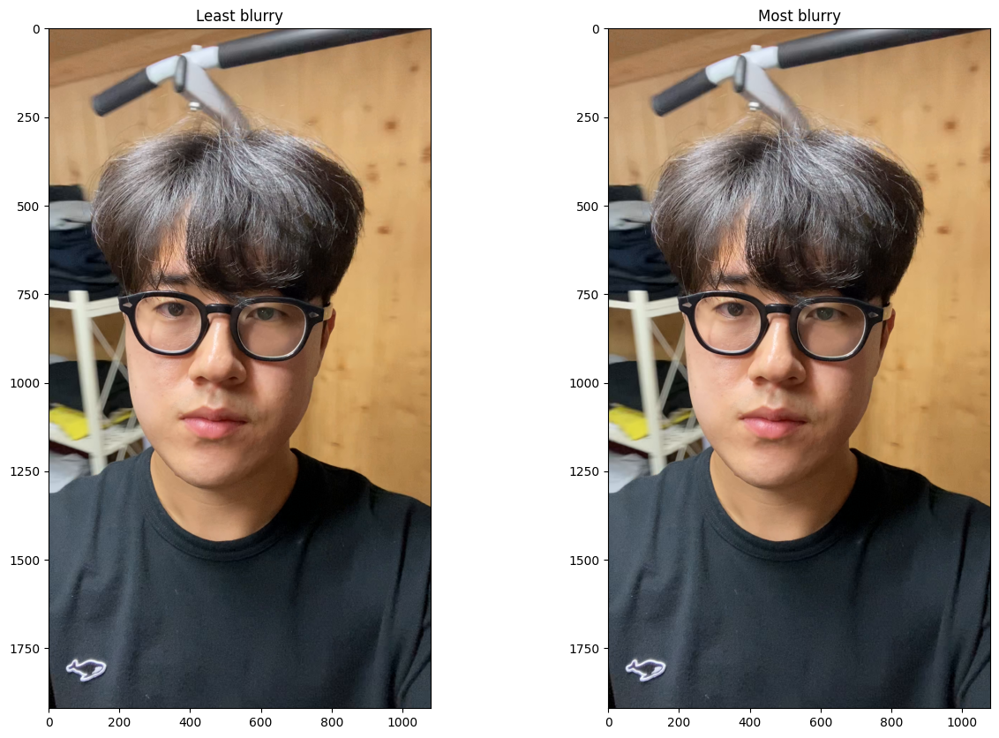

In [31]:
# @title Filter blurry frames.
from matplotlib import pyplot as plt
import numpy as np
import cv2

def variance_of_laplacian(image: np.ndarray) -> np.ndarray:
    """Compute the variance of the Laplacian which measure the focus."""
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()


blur_filter_perc = 95.0 # @param {type: 'number'}
if blur_filter_perc > 0.0:
    image_paths = sorted(rgb_dir.iterdir())
    print('Loading images.')
    images = list(map(scene_manager.load_image, scene_manager.image_ids))
    print('Computing blur scores.')
    blur_scores = np.array([variance_of_laplacian(im) for im in images])
    blur_thres = np.percentile(blur_scores, blur_filter_perc)
    blur_filter_inds = np.where(blur_scores >= blur_thres)[0]
    blur_filter_scores = [blur_scores[i] for i in blur_filter_inds]
    blur_filter_inds = blur_filter_inds[np.argsort(blur_filter_scores)]
    blur_filter_scores = np.sort(blur_filter_scores)
    blur_filter_image_ids = [scene_manager.image_ids[i] for i in blur_filter_inds]
    print(f'Filtering {len(blur_filter_image_ids)} IDs: {blur_filter_image_ids}')
    num_filtered = scene_manager.filter_images(blur_filter_image_ids)
    print(f'Filtered {num_filtered} images')

    plt.figure(figsize=(15, 10))
    plt.subplot(121)
    plt.title('Least blurry')
    plt.imshow(images[blur_filter_inds[-1]])
    plt.subplot(122)
    plt.title('Most blurry')
    plt.imshow(images[blur_filter_inds[0]])

In [32]:
import jax
from jax import numpy as jnp
from tensorflow_graphics.geometry.representation.ray import triangulate as ray_triangulate

use_face = True  # @param {type: 'boolean'}

### Compute 2D landmarks.

/tmp/ipykernel_199636/3546116789.py:143: DeprecationWarning:

Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.



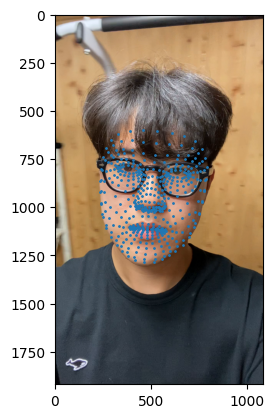

In [33]:
# @title Compute 2D landmarks.

import imageio
import mediapipe as mp
from PIL import Image

if use_face:
    mp_face_mesh = mp.solutions.face_mesh
    mp_drawing = mp.solutions.drawing_utils 
    drawing_spec = mp_drawing.DrawingSpec(thickness=1, circle_radius=1)

    # Initialize MediaPipe Face Mesh.
    face_mesh = mp_face_mesh.FaceMesh(
        static_image_mode=True,
        max_num_faces=2,
        min_detection_confidence=0.5)
  
  
    def compute_landmarks(image):
        height, width = image.shape[:2]
        results = face_mesh.process(image)
        if results.multi_face_landmarks is None:
            return None
        # Choose first face found.
        landmarks = results.multi_face_landmarks[0].landmark
        landmarks = np.array(
            [(o.x * width, o.y * height) for o in landmarks],
            dtype=np.uint32)
        return landmarks

    landmarks_dict = {}
    for item_id in scene_manager.image_ids:
        image = scene_manager.load_image(item_id)
        landmarks = compute_landmarks(image)
        if landmarks is not None:
            landmarks_dict[item_id] = landmarks
  
    landmark_item_ids = sorted(landmarks_dict)
    landmarks_pixels = np.array([landmarks_dict[i] for i in landmark_item_ids])
    landmarks_cameras = [scene_manager.camera_dict[i] for i in landmark_item_ids]

    from matplotlib import pyplot as plt
    plt.imshow(image)
    plt.scatter(x=landmarks[..., 0], y=landmarks[..., 1], s=1);

In [34]:
# Triangulate landmarks in 3D.

if use_face:
    def compute_camera_rays(points, camera):
        origins = np.broadcast_to(camera.position[None, :], (points.shape[0], 3))
        directions = camera.pixels_to_rays(points.astype(jnp.float32))
        endpoints = origins + directions
        return origins, endpoints
  
  
    def triangulate_landmarks(landmarks, cameras):
        all_origins = []
        all_endpoints = []
        nan_inds = []
        for i, (camera_landmarks, camera) in enumerate(zip(landmarks, cameras)):
            origins, endpoints = compute_camera_rays(camera_landmarks, camera)
            if np.isnan(origins).sum() > 0.0 or np.isnan(endpoints).sum() > 0.0:
                continue
            all_origins.append(origins)
            all_endpoints.append(endpoints)
        all_origins = np.stack(all_origins, axis=-2).astype(np.float32)
        all_endpoints = np.stack(all_endpoints, axis=-2).astype(np.float32)
        weights = np.ones(all_origins.shape[:2], dtype=np.float32)
        points = np.array(ray_triangulate(all_origins, all_endpoints, weights))

        return points
  

    landmark_points = triangulate_landmarks(landmarks_pixels, landmarks_cameras)
else:
    landmark_points = None

In [35]:
# Normalize scene based on landmarks.
from scipy import linalg

DEFAULT_IPD = 0.06
NOSE_TIP_IDX = 1
FOREHEAD_IDX = 10
CHIN_IDX = 152
RIGHT_EYE_IDX = 145
LEFT_EYE_IDX = 385
RIGHT_TEMPLE_IDX = 162
LEFT_TEMPLE_IDX = 389


def _normalize(x):
    return x / linalg.norm(x)


def fit_plane_normal(points):
    """Fit a plane to the points and return the normal."""
    centroid = points.sum(axis=0) / points.shape[0]
    _, _, vh = linalg.svd(points - centroid)
    return vh[2, :]


def metric_scale_from_ipd(landmark_points, reference_ipd):
    """Infer the scene-to-metric conversion ratio from facial landmarks."""
    left_eye = landmark_points[LEFT_EYE_IDX]
    right_eye = landmark_points[RIGHT_EYE_IDX]
    model_ipd = linalg.norm(left_eye - right_eye)
    return reference_ipd / model_ipd


def basis_from_landmarks(landmark_points):
    """Computes an orthonormal basis from facial landmarks."""
    # Estimate Z by fitting a plane
    # This works better than trusting the chin to forehead vector, especially in
    # full body captures.
    face_axis_z = _normalize(fit_plane_normal(landmark_points))
    face_axis_y = _normalize(landmark_points[FOREHEAD_IDX] -
                           landmark_points[CHIN_IDX])
    face_axis_x = _normalize(landmark_points[LEFT_TEMPLE_IDX] -
                           landmark_points[RIGHT_TEMPLE_IDX])

    # Fitted plane normal might be flipped. Check using a heuristic and flip it if
    # it's flipped.
    z_flipped = np.dot(np.cross(face_axis_x, face_axis_y), face_axis_z)
    if z_flipped < 0.0:
        face_axis_z *= -1

    # Ensure axes are orthogonal, with the Z axis being fixed.
    face_axis_y = np.cross(face_axis_z, face_axis_x)
    face_axis_x = np.cross(face_axis_y, face_axis_z)

    return np.stack([face_axis_x, face_axis_y, face_axis_z]).T


if use_face:
    face_basis = basis_from_landmarks(landmark_points)
    new_scene_manager = scene_manager.change_basis(
        face_basis, landmark_points[NOSE_TIP_IDX])
    new_cameras = [new_scene_manager.camera_dict[i] for i in landmark_item_ids]
    new_landmark_points = triangulate_landmarks(landmarks_pixels, new_cameras)
    face_basis = basis_from_landmarks(landmark_points)
    scene_to_metric = metric_scale_from_ipd(landmark_points, DEFAULT_IPD)

    print(f'Computed basis: {face_basis}')
    print(f'Estimated metric scale = {scene_to_metric:.02f}')
else:
    new_scene_manager = scene_manager

Computed basis: [[ 0.993706    0.06026448 -0.09049801]
 [ 0.10847154 -0.4958502   0.8614973 ]
 [ 0.00704423 -0.8658915  -0.49963236]]
Estimated metric scale = 0.01


In [36]:
# Compute near/far planes.
import pandas as pd

def estimate_near_far_for_image(scene_manager, image_id):
    """Estimate near/far plane for a single image based via point cloud."""
    points = filter_outlier_points(scene_manager.points, 0.95)
    points = np.concatenate([
        points,
        scene_manager.camera_positions,
    ], axis=0)
    camera = scene_manager.camera_dict[image_id]
    pixels = camera.project(points)
    depths = camera.points_to_local_points(points)[..., 2]

    # in_frustum = camera.ArePixelsInFrustum(pixels)
    in_frustum = (
        (pixels[..., 0] >= 0.0)
        & (pixels[..., 0] <= camera.image_size_x)
        & (pixels[..., 1] >= 0.0)
        & (pixels[..., 1] <= camera.image_size_y))
    depths = depths[in_frustum]

    in_front_of_camera = depths > 0
    depths = depths[in_front_of_camera]

    near = np.quantile(depths, 0.001)
    far = np.quantile(depths, 0.999)

    return near, far


def estimate_near_far(scene_manager):
    """Estimate near/far plane for a set of randomly-chosen images."""
    # image_ids = sorted(scene_manager.images.keys())
    image_ids = scene_manager.image_ids
    rng = np.random.RandomState(0)
    image_ids = rng.choice(
        image_ids, size=len(scene_manager.camera_list), replace=False)

    result = []
    for image_id in image_ids:
        near, far = estimate_near_far_for_image(scene_manager, image_id)
        result.append({'image_id': image_id, 'near': near, 'far': far})
    result = pd.DataFrame.from_records(result)
    return result


near_far = estimate_near_far(new_scene_manager)
print('Statistics for near/far computation:')
print(near_far.describe())
print()

near = near_far['near'].quantile(0.001) / 0.8
far = near_far['far'].quantile(0.999) * 1.2
print('Selected near/far values:')
print(f'Near = {near:.04f}')
print(f'Far = {far:.04f}')

Statistics for near/far computation:
            near        far
count  13.000000  13.000000
mean   42.235947  48.260342
std    12.050364   0.560218
min     2.173259  47.465248
25%    45.063021  47.962581
50%    45.490858  48.187547
75%    45.708537  48.395435
max    46.786683  49.486853

Selected near/far values:
Near = 3.3555
Far = 59.3773


/home/youngju/anaconda3/envs/hypernerf/lib/python3.8/site-packages/nerfies/camera.py:291: RuntimeWarning:

invalid value encountered in divide

/home/youngju/anaconda3/envs/hypernerf/lib/python3.8/site-packages/nerfies/camera.py:292: RuntimeWarning:

invalid value encountered in divide



In [37]:
# @title Compute scene center and scale.

def get_bbox_corners(points):
    lower = points.min(axis=0)
    upper = points.max(axis=0)
    return np.stack([lower, upper])


points = filter_outlier_points(new_scene_manager.points, 0.95)
bbox_corners = get_bbox_corners(
    np.concatenate([points, new_scene_manager.camera_positions], axis=0))

scene_center = np.mean(bbox_corners, axis=0)
scene_scale = 1.0 / np.sqrt(np.sum((bbox_corners[1] - bbox_corners[0]) ** 2))

print(f'Scene Center: {scene_center}')
print(f'Scene Scale: {scene_scale}')


Scene Center: [ 6.01693769 21.65671301 34.48141908]
Scene Scale: 0.011923051405058048


In [9]:
# @title Visualize scene.
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.io as pio
pio.renderers.default = 'iframe'
# Set notebook mode to work in offline
pyo.init_notebook_mode()
def scatter_points(points, size=2):
    return go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(size=size),
    )

camera = new_scene_manager.camera_list[0]
near_points = camera.pixels_to_points(
    camera.get_pixel_centers()[::8, ::8], jnp.array(near)).reshape((-1, 3))
far_points = camera.pixels_to_points(
    camera.get_pixel_centers()[::8, ::8], jnp.array(far)).reshape((-1, 3))

data = [
  scatter_points(new_scene_manager.points),
  scatter_points(new_scene_manager.camera_positions),
  scatter_points(bbox_corners),
  scatter_points(near_points),
  scatter_points(far_points),
]
if use_face:
    data.append(scatter_points(new_landmark_points))
fig = go.Figure(data=data)
fig.update_layout(scene_dragmode='orbit')
fig.show()

NameError: name 'new_scene_manager' is not defined